<h1><center>The Process of Data Science - Summer 2022</h1></center>
<h1><center>Assignment 1</h1></center>

<b>Zesheng Jia</b>   



# Table of Contents<a class="anchor" id="top"></a>

* # [Initialization](#initialization)
    * ### [Import packages](#packages)
    * ### [Jupyter notebook setting](#book_setting)
* # [Chapter 1. Task 1: Data Exploration and preprocessing(0.1)](#task1_top)
    * ### [Self-defined functions/Class in task 1](#func_task1)
    * ## [1. Data quality report](#task1_1)
        * ### [a. Load Data and generate data quality report](#task1_a)
            * #### [a.1. Data Loading](#task1_a_1)
            * #### [a.2. Data set report](#task1_a_2)
            * #### [a.3. Data quality report](#task1_a_3)
                * ##### [a.3.1 Continuous features report](#task1_a_3_1)
                * ##### [a.3.2 Categorical features report](#task1_a_3_2)
                * ##### [a.3.3 Columns value counts report](#task1_a_3_3)
            * #### [a.4 Feature visualization](#task1_a_4)
                * ##### [a.4.0. Define a function to plot Multiple kinds of visualization](#task1_a_4_0)
                * ##### [a.4.1. Continuous features](#task1_a_4_1)
                    * ##### [a.4.1.a. Histogram of all cont. features](#task1_a_4_1_a)
                    * ##### [a.4.1.b. Boxplot of all cont. features](#task1_a_4_1_b)
                * ##### [a.4.2. Categorical features](#task1_a_4_2)            
        * ### [b. Plot the heatmap correlation among the variables in the data](#task1_b)
            * #### [Plot a heatmap](#task1_b_1)
        * ### [c. Identify data quality issues and build the data quality plan](#task1_c)  
            * #### [c.0. Part c Utility functions](#task1_c_0)
            * #### [c.1. Data quality issues table](#task1_c_1)
                * ###### [c.1.1 Identify the problem](#task1_c_1.1)
                * ###### [c.1.1.1 FRP target value investigation](#task1_c_1.1.1)
                * ###### [c.1.1.2. FTP data quality plan](#task1_c_1.1.2)  
            * ##### [c.1.2 Data quality plan](#task1_c_1.2)  
            
    * ## [2. Preprocess your data according to the data quality plan](#task1_2)
        * ### [2.1 Create data preparation Pipeline](#task1_2.1)
            * #### [2.1.0 Utility Functions in this section](#task1_2.1.0)
            * #### [2.1.1 Purge outliers](#task1_2.1.1)
            * #### [2.1.2 Add attribute and delete useless features](#task1_2.1.2)
    * ## [3. Answer the following questions](#task1_3)
        * ### [a. Question a](#task1_3_a)
        * ### [b. Question b](#task1_3_b)
* # [Chapter 2. Task 2. Spatio-temporal data (0.2)](#task2_top) 
* # [Chapter 3. Task 3. Build a model for spatial prediction of wildfire (0.7)](#task3_top)    
* # [Reference](#ref)   
        
        
        
        
        
        
[back to top](#top)
             

## Initialization <a class="anchor" id="initialization" name="initialization"></a>

#### Download dataset

In [ ]:
!wget https://github.com/EasonJia9598/Dataset_of_Australia_wildfire/raw/2e9f30f3e5720b2601b08ebabda6a2856ea09d3e/modis_2017_Australia.csv
!wget https://github.com/EasonJia9598/Dataset_of_Australia_wildfire/raw/2e9f30f3e5720b2601b08ebabda6a2856ea09d3e/modis_2018_Australia.csv
!wget https://github.com/EasonJia9598/Dataset_of_Australia_wildfire/raw/2e9f30f3e5720b2601b08ebabda6a2856ea09d3e/modis_2019_Australia.csv
!wget https://github.com/EasonJia9598/Dataset_of_Australia_wildfire/raw/2e9f30f3e5720b2601b08ebabda6a2856ea09d3e/modis_2020_Australia.csv


--2022-06-24 01:19:29--  https://github.com/EasonJia9598/Dataset_of_Australia_wildfire/raw/2e9f30f3e5720b2601b08ebabda6a2856ea09d3e/modis_2017_Australia.csv
Resolving github.com (github.com)... 20.205.243.166
Connecting to github.com (github.com)|20.205.243.166|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://github.com/EasonJia9598/FnrwBca3LCCGnpdmUYtSg6-qcSGbGMaymNl-/raw/2e9f30f3e5720b2601b08ebabda6a2856ea09d3e/modis_2017_Australia.csv [following]
--2022-06-24 01:19:29--  https://github.com/EasonJia9598/FnrwBca3LCCGnpdmUYtSg6-qcSGbGMaymNl-/raw/2e9f30f3e5720b2601b08ebabda6a2856ea09d3e/modis_2017_Australia.csv
Reusing existing connection to github.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/EasonJia9598/FnrwBca3LCCGnpdmUYtSg6-qcSGbGMaymNl-/2e9f30f3e5720b2601b08ebabda6a2856ea09d3e/modis_2017_Australia.csv [following]
--2022-06-24 01:19:29--  https://raw.githubusercontent.com/Easo

### Import some packages<a class="anchor" name="packages"></a>
> Hidden Cell: You may unfold this section for code details

In [8]:
!pip install Basemap

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 863 kB 17.8 MB/s 
     |████████████████████████████████| 6.3 MB 63.4 MB/s 
     |████████████████████████████████| 219 kB 67.8 MB/s 
     |████████████████████████████████| 30.5 MB 1.2 MB/s 
  Created wheel for pyshp: filename=pyshp-2.1.3-py3-none-any.whl size=37324 sha256=1cf74987231262581cb04d70a93eaac0eeadcf20ebdc23a8875783827ab476a3
  Stored in directory: /root/.cache/pip/wheels/43/f8/87/53c8cd41545ba20e536ea29a8fcb5431b5f477ca50d5dffbbe
Successfully built pyshp


In [9]:

# import all related libraries
import pandas as pd
import warnings
import seaborn as sns
from datetime import datetime
from datetime import timedelta
import joblib
import datetime
import math
from sklearn.base import BaseEstimator, TransformerMixin

# PyTorch
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader

# For data preprocess
import numpy as np
import csv
import os

# For plotting
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure

# get basemap for geographical plot
from mpl_toolkits.basemap import Basemap

myseed = 42069  # set a random seed for reproducibility
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False
np.random.seed(myseed)
torch.manual_seed(myseed)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(myseed)

# Numerical Operations
import math
import numpy as np

# Reading/Writing Data
import pandas as pd
import os
import csv

# For Progress Bar
from tqdm import tqdm

# Pytorch
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, random_split

# For plotting learning curve
from torch.utils.tensorboard import SummaryWriter

# for matplotlib ploting
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure

from sklearn.metrics import mean_squared_error
from sklearn.ensemble import RandomForestRegressor


### Jupyer notebook setting<a class="anchor" name="book_setting"></a>
> Hidden Cell: You may unfold this section for code details

In [ ]:
sns.set()
# Set up with a higher resolution screen (useful on Mac)
%config InlineBackend.figure_format = 'retina'

###############################################
def max_print_out(pattern=False):
    '''It will maximize print out line and set float format with .2f'''
    number = None if pattern else 10
    # Set options to avoid truncation when displaying a dataframe
    pd.set_option("display.max_rows", number)
    pd.set_option("display.max_columns", 20)
    # Set floating point numbers to be displayed with 2 decimal places
    pd.set_option('display.float_format', '{:.2f}'.format)
    # for showing all entities 

# 1. Task 1: Data Exploration and preprocessing (0.1) <a class="anchor" name="task1_top"></a>


1. Data quality report.

    a. Generate data quality reports for the continuous and the categorical features of the data set

    b. Plot the heatmap correlation among the variables in the data

    c. Identify data quality issues and build the data quality plan

### Some useful functions and classes I generated and used in Task 1 <a class="anchor" name="func_task1"></a>
> Hidden Cell: You may unfold this section for code details

In [ ]:
################################  FUNCTION  ################################

    
#---------------------------Load Data---------------------------------------

def loading_data(path):
    '''This function will load mutiple data set and combine them together'''
    if len(path) > 1:
        data = pd.read_csv(path[0])
        for i in range(len(path)-1):
            data = pd.concat([data,pd.read_csv(path[i+1])] , axis=0) 
        # reset index for resolving duplicate indexing probelem
        data = data.reset_index(drop=False)
        # there is a column called index. We won't use it
        # Becasue we will set up our own index
        data = data.drop(['index'],axis=1)
        print("Successfully combined ",len(path), " dataset")
        return data
    else:
        data = data.drop(['index'],axis=1)
        print("Successfully load ",len(path), " dataset")
        return pd.read_csv(path[0])
    
#--------------------------Describe columns----------------------------------------

def describe_columns(data, features_name=[]):
    '''This function will help u print out features value counts'''
    if len(features_name) > 1:
        for i in range(len(features_name)):
            print("----------", data[features_name[i]].name,"---------")
            print(data[features_name[i]].value_counts())
    else:
        print("----------", data[features_name[0]].name,"---------")
        print(data[features_name[0]].value_counts())
        

#-------------Function from tutorial 2-----------------------------

def build_continuous_features_report(data_df):
    
    """Build tabular report for continuous features"""

    stats = {
        "Count": len,
        "Miss %": lambda df: df.isna().sum() / len(df) * 100,
        "Card.": lambda df: df.nunique(),
        "Min": lambda df: df.min(),
        "1st Qrt.": lambda df: df.quantile(0.25),
        "Mean": lambda df: df.mean(),
        "Median": lambda df: df.median(),
        "3rd Qrt": lambda df: df.quantile(0.75),
        "Max": lambda df: df.max(),
        "Std. Dev.": lambda df: df.std(),
    }

    contin_feat_names = data_df.select_dtypes("number").columns
    continuous_data_df = data_df[contin_feat_names]

    report_df = pd.DataFrame(index=contin_feat_names, columns=stats.keys())

    for stat_name, fn in stats.items():
        # NOTE: ignore warnings for empty features
        with warnings.catch_warnings():
            warnings.simplefilter("ignore", category=RuntimeWarning)
            report_df[stat_name] = fn(continuous_data_df)

    return report_df
    
#-------------Function from tutorial 2---------------------------

def build_categorical_features_report(data_df):

    """Build tabular report for categorical features"""

    def _mode(df):
        return df.apply(lambda ft: ft.mode().to_list()).T

    def _mode_freq(df):
        return df.apply(lambda ft: ft.value_counts()[ft.mode()].sum())

    def _second_mode(df):
        return df.apply(lambda ft: ft[~ft.isin(ft.mode())].mode().to_list())

    def _second_mode_freq(df):
        return df.apply(
            lambda ft: ft[~ft.isin(ft.mode())]
            .value_counts()[ft[~ft.isin(ft.mode())].mode()]
            .sum()
        )

    stats = {
        "Count": len,
        "Miss %": lambda df: df.isna().sum() / len(df) * 100,
        "Card.": lambda df: df.nunique(),
        "Mode": _mode,
        "Mode Freq": _mode_freq,
        "Mode %": lambda df: _mode_freq(df) / len(df) * 100,
        "2nd Mode": _second_mode,
        "2nd Mode Freq": _second_mode_freq,
        "2nd Mode %": lambda df: _second_mode_freq(df) / len(df) * 100,
    }

    cat_feat_names = data_df.select_dtypes(exclude="number").columns
    continuous_data_df = data_df[cat_feat_names]

    report_df = pd.DataFrame(index=cat_feat_names, columns=stats.keys())

    for stat_name, fn in stats.items():
        # NOTE: ignore warnings for empty features
        with warnings.catch_warnings():
            warnings.simplefilter("ignore", category=RuntimeWarning)
            report_df[stat_name] = fn(continuous_data_df)

    return report_df

#-------------One function to plot multiple kinds of graph ---------------------------

# All codes were written by myself

# set keyword only parameter. Since our data set is too big. must be indentified before ploting

def mulitple_function_plots(tight_layout = True, h_space = 0.4,w_space=0.3, fig_size = (10,15) , 
                            *,data,plot_type="histogram",data_type="number"):
    
    '''Plot all features from the dataset, you must specified your dataset by, data = '''
    if data_type == "number":
        feat_names = data.select_dtypes("number").columns 
    elif data_type == "categorical":
        feat_names = data.select_dtypes(exclude="number").columns
        
    # seperate those features into 2 columns
    rows_number = math.ceil(len(feat_names)/2.0)
    
    print("Those features will be plotted in ", rows_number, " rows and 2 columns")
    # print continuous features name
    print(feat_names)
    
    #initialize figure
    fig, axs = plt.subplots(rows_number, 2, figsize=fig_size)
    index = 0
    start = datetime.datetime.now()
    
    #print
    for i in range(rows_number):
        for j in range(2):
            if index < len(feat_names):
                if plot_type == 'histogram': # shortcut for histogram plot
                    sns.histplot(data=data, x=feat_names[index], bins = 30,kde=True, ax=axs[i][j])
                elif plot_type == 'boxplot': # boxplot
                    data.boxplot(column=feat_names[index],ax=axs[i][j], vert=False)
                elif plot_type == 'barplot': # barplot
                    data[feat_names[index]].value_counts().plot.bar(ax=axs[i][j]);
                # set corresponded name of selected features
                axs[i][j].set_xlabel(feat_names[index])
                # end of calculating the time
                end = datetime.datetime.now()
                # print info
                print(index+1, ". Finish Rendering :", feat_names[index],", used",  
                      (end - start).microseconds/1000, "millseconds")
                index += 1
            else:
                break
    #adjust pictures
    plt.subplots_adjust(hspace = h_space,wspace=w_space)
    # add figure title
    fig.suptitle(str(plot_type.title() + " of all " + data_type.title() + " features"), fontweight ="bold")
    # set whether we want to plot a tight_layout figure
    if tight_layout:
        fig.tight_layout()
        fig.subplots_adjust(top=0.95)
    return axs


#------------- draw heatmap -----------------------------------------------------

def heatmap_draw(data):
    # Correlation between different variables
    corr = data.corr()
    # Set up the matplotlib plot configuration
    f, ax = plt.subplots(figsize=(12, 10))
    # Configure a custom diverging colormap
    cmap = sns.diverging_palette(230, 20, as_cmap=True)
    # Draw the heatmap
    sns.heatmap(corr, annot=True, cmap=cmap)
    plt.title("Heatmap correlation among all features")
    
    
def create_trainning_data(data_df):
  X = data_df.drop("frp", axis=1) # drop labels for training set
  y = data_df["frp"].copy()
  X = number_pipeline.fit_transform(X)
  y = np.array(y.values)
  return X,y


from numpy.ma.core import negative


# #-------------  detect and delete outliers -----------------------------------------------------

# def find_outliers(data_df, parameter,* , drop=False, set_threshold=True, threshold_value = 1550): # deal with outliers

def find_outliers(data_df, parameter,* , drop=False, set_threshold=True, threshold_value = 350): # deal with outliers    
    '''detect and delete outliers '''
    Q1 = data_df[parameter].quantile(0.25)
    Q3 = data_df[parameter].quantile(0.75)
    IQR = Q3-Q1
    
    print(f"IQR = {Q3} - {Q1} = {IQR}")
    print(f"MAX = {(Q3 + 1.5 * IQR)}")
    
    if Q1 > 1.5*IQR :
        print("Min: ", (Q1 - 1.5 * IQR))
    else:
        print("Min is 0")
    
    cut_out_value =  (Q3 + 1.5 * IQR)
    if set_threshold == True:
        cut_out_value = threshold_value
        
    min_outliers_df = data_df[(data_df[parameter] < (Q1 - 1.5 * IQR))]
    max_outliers_df = data_df[(data_df[parameter] > cut_out_value)]  
    negative_outliers_df = data_df[(data_df[parameter] <= 0)]         
    print("Num of min outliers: ", len(min_outliers_df))
    print("Num of max outliers: ", len(max_outliers_df))
    print("Num of negative outliers: ", len(negative_outliers_df))
    print("Num of the original data set's whole instance", len(data_df))
    print("Rate of purged data/total data", len(max_outliers_df)/ len(data_df))
    if drop:
        return data_df.drop(max_outliers_df.index)

#-------------  Add new features -----------------------------------------------------

def feature_add(train_raw_data):
  ''' Add features

      Input: your objective data set
  
  '''
  train_raw_data['location'] = 1000* train_raw_data['longitude'] + train_raw_data['latitude']
  train_raw_data['location'] = train_raw_data['location'].round(0)


################################  CLASS  ################################

# Class for attribute transformer
# import important libray
from sklearn.base import BaseEstimator, TransformerMixin

class combined_attribute_adder_and_cleaner(BaseEstimator, TransformerMixin):
    '''data clean transfomer class'''
    
    def __init__(self, data_cleaner = False,set_threshold=False, threshold_value = 350 ): # no *args or **kargs
        # we need to set extra var to ensure do we need to purge the dataset. 
        # In my following experments, sometimes we don't need to do so. 
        self.data_clean = data_cleaner
        # Since we are using threshold from now on. This is crucial.
        self.set_threshold = set_threshold
        # threshold value
        self.threshold_value = threshold_value

    def fit(self, X, y=None):
        return self # nothing else to do

    def transform(self, data_df):
        # we first copy the data from our dataset.
        # operate on original data set sometimes is dangerous.
        X = data_df.copy()
        
        # Start to change all string columns that related to Dates to Time Series
        minutes = (X['acq_time'] % 100).astype(int)
        hours = (X['acq_time'] /100).astype(int) 
        
        #concatenate acq_data and acq_time
        X['acq_date'] =  X['acq_date'] + '-'  + hours.apply(str) + "-" + minutes.apply(str)
        X['acq_date'] = pd.to_datetime(X['acq_date'], format= '%Y-%m-%d-%H-%M')
        
        # This is a outdated version of transfering time series to index.
        # This didn't work so well when I training my model. 
        # So I comment this line. But sometimes, you want to do this.
        # X = X.set_index('acq_date')
        
        # Now we change our time series to a integer by indexing all instances with same month.
        X['month'] = X['acq_date'].dt.month
        
        # add new features. 
        feature_add(X)
        
        # one hot encoding
        # Transter categorical data to numerical value
        # Start to apply one hot encoding
        statelitte = pd.get_dummies(X.satellite)
        daynight = pd.get_dummies(X.daynight)
        X = pd.concat([X,statelitte.astype(int),daynight.astype(int)], axis=1)
        
        # drop all useless features and categorical features we alreayd transfered
        X = X.drop(['acq_time','acq_date', 'instrument','version','satellite','daynight','type','latitude','longitude'],axis=1) 

        
        # do outliers purgeing if it's needed
        
        if self.data_clean:
          # clean outliers
          X = find_outliers(X,'frp',drop=True,set_threshold=True,threshold_value=self.threshold_value)
            
          # clean negative frp instance
          negative_index = X[(X['frp'] <= 0)]  
          X = X.drop(negative_index.index)

          return X
        else:
        ## if we don't need to purge outliers, then just return X
          return X
        
    
#------------- transformer for output numpy array for our data set ---------------------

class numerical_transfer(BaseEstimator, TransformerMixin):
    '''numerical_transfer class'''
    
    def __init__(self, transfer_to_number=True ): # no *args or **kargs
        # This line seems pretty useless. But sometimes, we want this.
        self.transfer_to_number = transfer_to_number
        
    def fit(self, X, y=None):
        return self # nothing else to do

    def transform(self, X):
      # the values of a panda dataframe is all we need.
      if self.transfer_to_number:
        return X.values
      else:
        return X


#############################PIPE LINE###################################################


# Now we build a transformer to get all the above steps
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

# purge pipeline is only for purgeing any outliers.
purge_pipeline = Pipeline([
        ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(data_cleaner=True)),
    ])

#number pipline will transfer all data to numpy array and do normailization
number_pipeline = Pipeline([
        ('num_transfer', numerical_transfer()),
        ('std_scaler', StandardScaler()),
    ])

# none purge pipeline will only get you the data with correct form, but don't delete any outliers
none_purge_pipeline = Pipeline([
        ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(data_cleaner=False))
    ])

# full pipeline to create a prepared dataset in a glance
full_pipeline = Pipeline([
     ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(data_cleaner=True)),
     ('num_transfer', numerical_transfer()),
     ('std_scaler', StandardScaler()),
])


############################FUNCTIONS ON PIPELINE##########################################

#-------------  create_trainning_data -----------------------------------------------------
# This function is for creating training data directly into numpy form
def create_trainning_data(data_df,num_array_needed = False):
    data_inner = data_df.copy()
    X = data_inner.drop("frp", axis=1) # drop labels for training set
    y = data_inner["frp"].copy()
    if num_array_needed: 
      X = number_pipeline.fit_transform(X)
      y = np.array(y.values)
    return X,y

#------------- create_dp_data -----------------------------------------------------

# This function is for creating a normalized training data but remain the panda dataset form
def create_dp_data(data): 
  target = data.pop('frp')
  normalized_df_test=(data-data.mean())/data.std()
  normalized_df_test['target'] = target
  normalized_df_test = normalized_df_test.drop(['latitude','longitude','type','Aqua','Terra','D','N'],axis=1)
  return normalized_df_test



# 1. Data quality report <a class="anchor" name="task1_1"></a>

## a. Loading Data and generate data quality report <a class="anchor" name="task1_a"></a>
            


### a.1. Data loading<a class="anchor" name="task1_a_1"></a>
> Load all four  Data sets and combine them together

In [ ]:
#---------------------------Load Data---------------------------------------

def loading_data(path):
    '''This function will load mutiple data set and combine them together'''
    if len(path) > 1:
        data = pd.read_csv(path[0])
        for i in range(len(path)-1):
            data = pd.concat([data,pd.read_csv(path[i+1])] , axis=0) 
        # reset index for resolving duplicate indexing probelem
        data = data.reset_index(drop=False)
        # there is a column called index. We won't use it
        # Becasue we will set up our own index
        data = data.drop(['index'],axis=1)
        print("Successfully combined ",len(path), " dataset")
        return data
    else:
        data = data.drop(['index'],axis=1)
        print("Successfully load ",len(path), " dataset")
        return pd.read_csv(path[0])

In [ ]:
# Load Data
# loading_data is a function I put in above code section
raw_data  = loading_data(["./modis_2017_Australia.csv" , 
                          "./modis_2018_Australia.csv","./modis_2019_Australia.csv",
                          "./modis_2020_Australia.csv"])
# data_clean_generator = data_cleaner(data_clean=True)
# clean_data = data_clean_generator.transform(raw_data)


Successfully combined  4  dataset


### a.2. Data set report<a class="anchor" name="task1_a_2"></a>            

> In this section. Mainly focus on take a glance of our data set

In [ ]:
sns.set()
# Set up with a higher resolution screen (useful on Mac)
%config InlineBackend.figure_format = 'retina'

###############################################
def max_print_out(pattern=False):
    '''It will maximize print out line and set float format with .2f'''
    number = None if pattern else 10
    # Set options to avoid truncation when displaying a dataframe
    pd.set_option("display.max_rows", number)
    pd.set_option("display.max_columns", 20)
    # Set floating point numbers to be displayed with 2 decimal places
    pd.set_option('display.float_format', '{:.2f}'.format)
    # for showing all entities 

In [ ]:
# I turn off the maximun rows display for showing the last comlumn in the data set
# It will helpe me to see whether I concatenate those files correctly in general.
max_print_out(False)
raw_data

,latitude,longitude,brightness,scan,track,acq_date,acq_time,satellite,instrument,confidence,version,bright_t31,frp,daynight,type
0,-23.91,147.30,320.10,1.70,1.30,2017-01-01,47,Terra,MODIS,53,6.20,296.60,17.60,D,0
1,-23.69,150.10,314.30,2.70,1.60,2017-01-01,47,Terra,MODIS,22,6.20,289.30,30.00,D,0
2,-23.59,150.17,315.80,2.70,1.60,2017-01-01,47,Terra,MODIS,33,6.20,291.70,35.40,D,0
3,-22.41,148.85,316.70,2.10,1.40,2017-01-01,47,Terra,MODIS,26,6.20,295.30,25.80,D,0
4,-20.59,147.64,320.70,1.60,1.30,2017-01-01,47,Terra,MODIS,34,6.20,299.60,19.00,D,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1046674,-28.29,122.27,309.90,2.20,1.50,2020-12-31,1409,Terra,MODIS,31,6.03,289.10,32.80,N,0
1046675,-30.86,121.50,308.00,1.20,1.10,2020-12-31,1721,Aqua,MODIS,73,6.03,292.40,10.30,N,2
1046676,-28.29,122.27,319.30,1.20,1.10,2020-12-31,1721,Aqua,MODIS,65,6.03,292.70,20.60,N,0
1046677,-28.28,122.26,345.20,1.20,1.10,2020-12-31,1721,Aqua,MODIS,100,6.03,297.00,69.00,N,0


--------- 
We can see that we combine all four files successfully.

The acq_date is between 2017-01-01 to 2020-12-31. All four files' are in it.

In [ ]:
# We set our print out line limis to maximum and set string out print format [.2f ]
max_print_out(True)
# describe continous features summary
raw_data.describe()

,latitude,longitude,brightness,scan,track,acq_time,confidence,version,bright_t31,frp,type
count,1046679.00,1046679.00,1046679.00,1046679.00,1046679.00,1046679.00,1046679.00,1046679.00,1046679.00,1046679.00,1046679.00
mean,-21.96,135.25,332.88,1.66,1.23,622.02,71.06,6.07,303.23,70.50,0.01
std,7.79,10.52,23.11,0.85,0.26,532.04,22.92,0.07,10.73,169.47,0.17
min,-43.50,113.13,300.00,1.00,1.00,0.00,0.00,6.03,265.70,-29.90,0.00
25%,-28.77,126.80,317.90,1.10,1.00,225.00,56.00,6.03,295.90,14.60,0.00
50%,-19.92,133.14,328.70,1.30,1.10,444.00,74.00,6.03,303.00,28.60,0.00
75%,-15.30,144.96,341.60,1.90,1.40,629.00,90.00,6.20,309.80,63.50,0.00
max,-9.25,153.59,507.00,4.80,2.00,2359.00,100.00,6.20,400.10,11164.10,3.00


In [ ]:
# get rid of Object type
raw_data = raw_data.convert_dtypes()
# showing the index dtype and columns, non-null values and memory usage.
raw_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1046679 entries, 0 to 1046678
Data columns (total 15 columns):
 #   Column      Non-Null Count    Dtype  
---  ------      --------------    -----  
 0   latitude    1046679 non-null  Float64
 1   longitude   1046679 non-null  Float64
 2   brightness  1046679 non-null  Float64
 3   scan        1046679 non-null  Float64
 4   track       1046679 non-null  Float64
 5   acq_date    1046679 non-null  string 
 6   acq_time    1046679 non-null  Int64  
 7   satellite   1046679 non-null  string 
 8   instrument  1046679 non-null  string 
 9   confidence  1046679 non-null  Int64  
 10  version     1046679 non-null  Float64
 11  bright_t31  1046679 non-null  Float64
 12  frp         1046679 non-null  Float64
 13  daynight    1046679 non-null  string 
 14  type        1046679 non-null  Int64  
dtypes: Float64(8), Int64(3), string(4)
memory usage: 130.8 MB


In [ ]:
len(raw_data) - len(raw_data[(raw_data['frp'] < 200)])

69704

---------
Luckily we don't have any missing value.

Their features' types are 4 String, 3 integer and the rest are Float64 type.

We would like to find out their details and how to deal with them.

### a.3. Data quality report<a class="anchor" name="task1_a_3"></a>
In this section we will focus on find out:
* **Tabular report for continuous features**
* **Tabular report for categorical features**
* **Data visualizations of values in each feature** (source: Tutorial 2)


#### 1. Continuous features report<a class="anchor" name="task1_a_3_1"></a>

In [ ]:
#-------------Function from tutorial 2-----------------------------

def build_continuous_features_report(data_df):
    
    """Build tabular report for continuous features"""

    stats = {
        "Count": len,
        "Miss %": lambda df: df.isna().sum() / len(df) * 100,
        "Card.": lambda df: df.nunique(),
        "Min": lambda df: df.min(),
        "1st Qrt.": lambda df: df.quantile(0.25),
        "Mean": lambda df: df.mean(),
        "Median": lambda df: df.median(),
        "3rd Qrt": lambda df: df.quantile(0.75),
        "Max": lambda df: df.max(),
        "Std. Dev.": lambda df: df.std(),
    }

    contin_feat_names = data_df.select_dtypes("number").columns
    continuous_data_df = data_df[contin_feat_names]

    report_df = pd.DataFrame(index=contin_feat_names, columns=stats.keys())

    for stat_name, fn in stats.items():
        # NOTE: ignore warnings for empty features
        with warnings.catch_warnings():
            warnings.simplefilter("ignore", category=RuntimeWarning)
            report_df[stat_name] = fn(continuous_data_df)

    return report_df
    

In [ ]:
max_print_out(True)
# Call function from 
build_continuous_features_report(raw_data)

,Count,Miss %,Card.,Min,1st Qrt.,Mean,Median,3rd Qrt,Max,Std. Dev.
latitude,1046679,0.00,259382,-43.50,-28.77,-21.96,-19.92,-15.30,-9.25,7.79
longitude,1046679,0.00,325532,113.13,126.80,135.25,133.14,144.96,153.59,10.52
brightness,1046679,0.00,2050,300.00,317.90,332.88,328.70,341.60,507.00,23.11
scan,1046679,0.00,39,1.00,1.10,1.66,1.30,1.90,4.80,0.85
track,1046679,0.00,11,1.00,1.00,1.23,1.10,1.40,2.00,0.26
acq_time,1046679,0.00,855,0.00,225.00,622.02,444.00,629.00,2359.00,532.04
confidence,1046679,0.00,101,0.00,56.00,71.06,74.00,90.00,100.00,22.92
version,1046679,0.00,2,6.03,6.03,6.07,6.03,6.20,6.20,0.07
bright_t31,1046679,0.00,972,265.70,295.90,303.23,303.00,309.80,400.10,10.73
frp,1046679,0.00,13993,-29.90,14.60,70.50,28.60,63.50,11164.10,169.47


In categorical features report, there are 4 features have too low cardinality.

They are "scan", "track", "version", "type". Especially, version and type only have cad < 3.


#### 2. Categorical features report<a class="anchor" name="task1_a_3_2"></a>

In [ ]:
#-------------Function from tutorial 2---------------------------

def build_categorical_features_report(data_df):

    """Build tabular report for categorical features"""

    def _mode(df):
        return df.apply(lambda ft: ft.mode().to_list()).T

    def _mode_freq(df):
        return df.apply(lambda ft: ft.value_counts()[ft.mode()].sum())

    def _second_mode(df):
        return df.apply(lambda ft: ft[~ft.isin(ft.mode())].mode().to_list())

    def _second_mode_freq(df):
        return df.apply(
            lambda ft: ft[~ft.isin(ft.mode())]
            .value_counts()[ft[~ft.isin(ft.mode())].mode()]
            .sum()
        )

    stats = {
        "Count": len,
        "Miss %": lambda df: df.isna().sum() / len(df) * 100,
        "Card.": lambda df: df.nunique(),
        "Mode": _mode,
        "Mode Freq": _mode_freq,
        "Mode %": lambda df: _mode_freq(df) / len(df) * 100,
        "2nd Mode": _second_mode,
        "2nd Mode Freq": _second_mode_freq,
        "2nd Mode %": lambda df: _second_mode_freq(df) / len(df) * 100,
    }

    cat_feat_names = data_df.select_dtypes(exclude="number").columns
    continuous_data_df = data_df[cat_feat_names]

    report_df = pd.DataFrame(index=cat_feat_names, columns=stats.keys())

    for stat_name, fn in stats.items():
        # NOTE: ignore warnings for empty features
        with warnings.catch_warnings():
            warnings.simplefilter("ignore", category=RuntimeWarning)
            report_df[stat_name] = fn(continuous_data_df)

    return report_df



In [ ]:
build_categorical_features_report(raw_data)

,Count,Miss %,Card.,Mode,Mode Freq,Mode %,2nd Mode,2nd Mode Freq,2nd Mode %
acq_date,1046679,0.00,1461,2020-01-04,7351,0.70,[2019-12-30],6925,0.66
satellite,1046679,0.00,2,Aqua,600236,57.35,[Terra],446443,42.65
instrument,1046679,0.00,1,MODIS,1046679,100.00,[],0,0.00
daynight,1046679,0.00,2,D,806375,77.04,[N],240304,22.96



In categorical features report, there is one feature has too high cardinality. "acq_data"

Here I would like to print out their value_counts(), to find out what their values are.

#### 3. Columns value counts report<a class="anchor" name="task1_a_3_3"></a>

In [ ]:
#--------------------------Describe columns----------------------------------------

def describe_columns(data, features_name=[]):
    '''This function will help u print out features value counts'''
    if len(features_name) > 1:
        for i in range(len(features_name)):
            print("----------", data[features_name[i]].name,"---------") # get name
            print(data[features_name[i]].value_counts()) # print value counts
    else:
        print("----------", data[features_name[0]].name,"---------")
        print(data[features_name[0]].value_counts())
     

In [ ]:
# display value counts report of continuous features
describe_columns(raw_data, ['version','type','scan','track'])

---------- version ---------
6.03    773367
6.20    273312
Name: version, dtype: Int64
---------- type ---------
0    1039215
2       7075
3        389
Name: type, dtype: Int64
---------- scan ---------
1.00    239204
1.10    155850
1.20     91576
1.30     70008
1.40     56280
1.50     44653
1.60     40234
1.70     31939
1.80     30614
1.90     26243
2.00     22713
2.10     20882
2.30     17855
2.20     17809
2.50     14841
2.40     14073
2.80     11858
2.70     11602
2.60     11556
2.90     10507
3.00     10495
3.10      8584
3.20      7997
3.40      7850
3.30      6566
3.80      6486
3.60      6338
4.10      5438
3.50      5365
4.30      5171
3.70      5119
3.90      5116
4.00      4021
4.40      3998
4.50      3994
4.20      3961
4.70      3815
4.60      3731
4.80      2337
Name: scan, dtype: Int64
---------- track ---------
1.00    343564
1.10    211514
1.20    129019
1.30     93439
1.40     69005
1.50     53991
1.60     45987
1.70     35270
1.80     28424
1.90     23861
2.00     1

In [ ]:
# display value counts report of categorical features
max_print_out(False) # We don't want it to print all
describe_columns(raw_data, ['acq_date'])
max_print_out(True) # change back to default

---------- acq_date ---------
2020-01-04    7351
2019-12-30    6925
2019-12-19    4768
2020-01-02    4390
2020-01-03    4260
              ... 
2020-02-26      17
2017-01-14      17
2017-01-15      10
2020-02-23      10
2020-03-06       6
Name: acq_date, Length: 1461, dtype: Int64


We can see that the acq_date are combined by different dates across multiple years. It maybe not a categorical data.

### a.4. Feature visualization<a class="anchor" name="task1_a_4"></a>
In this section, we will visualize our features with different kinds of plots.<br>
But first, let's define a multiple plot function.
Which can take dataset, plot type, feature type.
```
def mulitple_function_plots(*,data,plot_type="histogram", data_type="number"):
```

##### Define a function to plot Multiple kinds of visualization<a class="anchor" name="task1_a_4_0"></a>

In [ ]:
#-------------One function to plot multiple kinds of graph ---------------------------

# All codes were written by myself

# set keyword only parameter. Since our data set is too big. must be indentified before ploting

def mulitple_function_plots(tight_layout = True, h_space = 0.4,w_space=0.3, fig_size = (10,15) , 
                            *,data,plot_type="histogram",data_type="number"):
    
    '''Plot all features from the dataset, you must specified your dataset by, data = '''
    if data_type == "number":
        feat_names = data.select_dtypes("number").columns 
    elif data_type == "categorical":
        feat_names = data.select_dtypes(exclude="number").columns
        
    # seperate those features into 2 columns
    rows_number = math.ceil(len(feat_names)/2.0)
    
    print("Those features will be plotted in ", rows_number, " rows and 2 columns")
    # print continuous features name
    print(feat_names)
    
    #initialize figure
    fig, axs = plt.subplots(rows_number, 2, figsize=fig_size)
    index = 0
    start = datetime.datetime.now()
    
    #print
    for i in range(rows_number):
        for j in range(2):
            if index < len(feat_names):
                if plot_type == 'histogram': # shortcut for histogram plot
                    sns.histplot(data=data, x=feat_names[index], bins = 30,kde=True, ax=axs[i][j])
                elif plot_type == 'boxplot': # boxplot
                    data.boxplot(column=feat_names[index],ax=axs[i][j], vert=False)
                elif plot_type == 'barplot': # barplot
                    data[feat_names[index]].value_counts().plot.bar(ax=axs[i][j]);
                # set corresponded name of selected features
                axs[i][j].set_xlabel(feat_names[index])
                # end of calculating the time
                end = datetime.datetime.now()
                # print info
                print(index+1, ". Finish Rendering :", feat_names[index],", used",  
                      (end - start).microseconds/1000, "millseconds")
                index += 1
            else:
                break
    #adjust pictures
    plt.subplots_adjust(hspace = h_space,wspace=w_space)
    # add figure title
    fig.suptitle(str(plot_type.title() + " of all " + data_type.title() + " features"), fontweight ="bold")
    # set whether we want to plot a tight_layout figure
    if tight_layout:
        fig.tight_layout()
        fig.subplots_adjust(top=0.95)
    return axs


#### a.4.1. Continuous features <a class="anchor" name="task1_a_4_1"></a>

We will plot a few graphs for showing more details of our cont. features.<br>

##### a.4.1.a. Histogram of all cont. features.<a class="anchor" name="task1_a_4_1_a"></a>

We will plot all features in histogram graph with bin size = 30. <br>
After I tried a few combination of bin size. 30 is a good one to display and not too messy.

Those features will be plotted in  6  rows and 2 columns
Index(['latitude', 'longitude', 'brightness', 'scan', 'track', 'acq_time',
       'confidence', 'version', 'bright_t31', 'frp', 'type'],
      dtype='object')
1 . Finish Rendering : latitude , used 911.789 millseconds
2 . Finish Rendering : longitude , used 576.449 millseconds
3 . Finish Rendering : brightness , used 807.222 millseconds
4 . Finish Rendering : scan , used 242.105 millseconds
5 . Finish Rendering : track , used 720.537 millseconds
6 . Finish Rendering : acq_time , used 964.114 millseconds
7 . Finish Rendering : confidence , used 790.365 millseconds
8 . Finish Rendering : version , used 949.751 millseconds
9 . Finish Rendering : bright_t31 , used 231.519 millseconds
10 . Finish Rendering : frp , used 793.729 millseconds
11 . Finish Rendering : type , used 360.11 millseconds


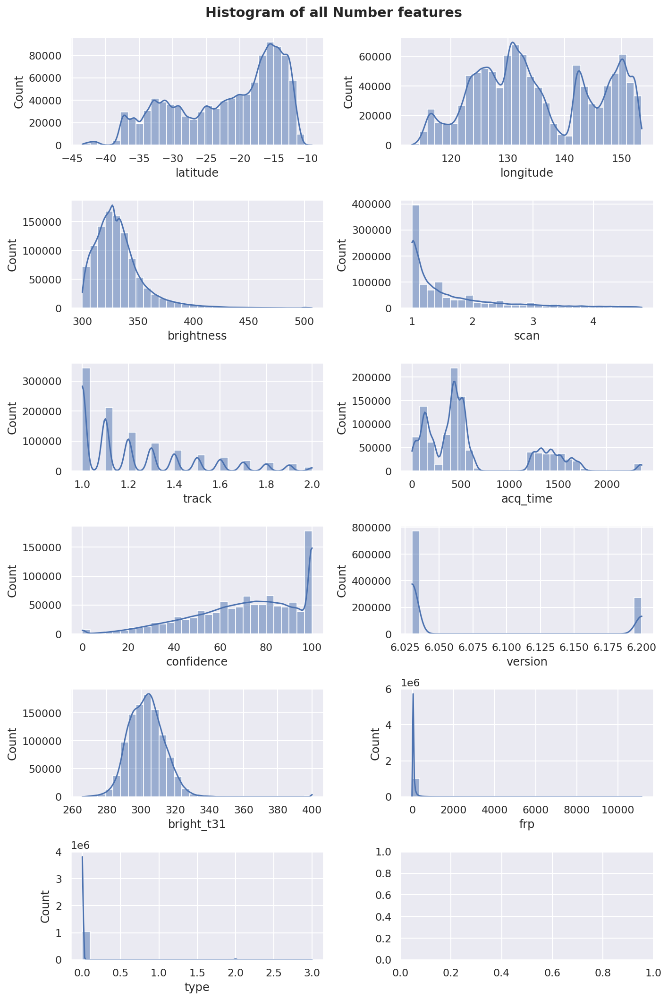

In [ ]:
ax = mulitple_function_plots(data=raw_data,plot_type="histogram",data_type="number")

##### a.4.1.b. Boxplot of all cont. features.<a class="anchor" name="task1_a_4_1_b"></a>
Boxplot is very good to show outliers and mathematical status of each cont. features.<br>
Such as median, max,min, 1st quartile and 3rd quartile.<br>
It will help us find most data quality issues.<br>

Those features will be plotted in  6  rows and 2 columns
Index(['latitude', 'longitude', 'brightness', 'scan', 'track', 'acq_time',
       'confidence', 'version', 'bright_t31', 'frp', 'type'],
      dtype='object')
1 . Finish Rendering : latitude , used 212.341 millseconds
2 . Finish Rendering : longitude , used 491.937 millseconds
3 . Finish Rendering : brightness , used 843.107 millseconds
4 . Finish Rendering : scan , used 39.442 millseconds
5 . Finish Rendering : track , used 191.465 millseconds
6 . Finish Rendering : acq_time , used 337.265 millseconds
7 . Finish Rendering : confidence , used 301.986 millseconds
8 . Finish Rendering : version , used 320.014 millseconds
9 . Finish Rendering : bright_t31 , used 606.79 millseconds
10 . Finish Rendering : frp , used 947.951 millseconds
11 . Finish Rendering : type , used 929.143 millseconds


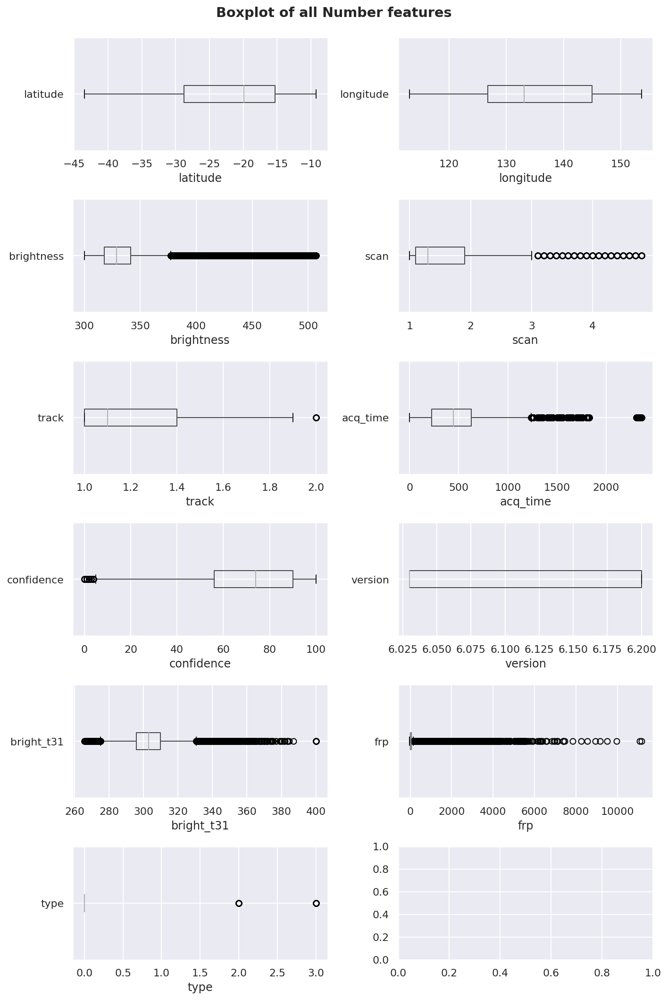

In [ ]:
ax = mulitple_function_plots(data=raw_data,plot_type="boxplot",data_type="number")

> We can see a lot of data quality issues. We will hand those soon


#### a.4.2. Categorical features<a class="anchor" name="task1_a_4_2"></a>
Plot barplot for categorical features.

> From above categorical data quality report, we already know that "acq_date" has cardinality 1461.<br>
Which is basically impossible to plot in a single bar plot, and plot a feature that we already know it has problem is not wise <br>
Hence, I drop the column of acq_data first. Plot the rest of them.


Those features will be plotted in  2  rows and 2 columns
Index(['satellite', 'instrument', 'daynight'], dtype='object')
1 . Finish Rendering : satellite , used 80.824 millseconds
2 . Finish Rendering : instrument , used 174.204 millseconds
3 . Finish Rendering : daynight , used 247.753 millseconds


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fbec50b4e10>,
      dtype=object)

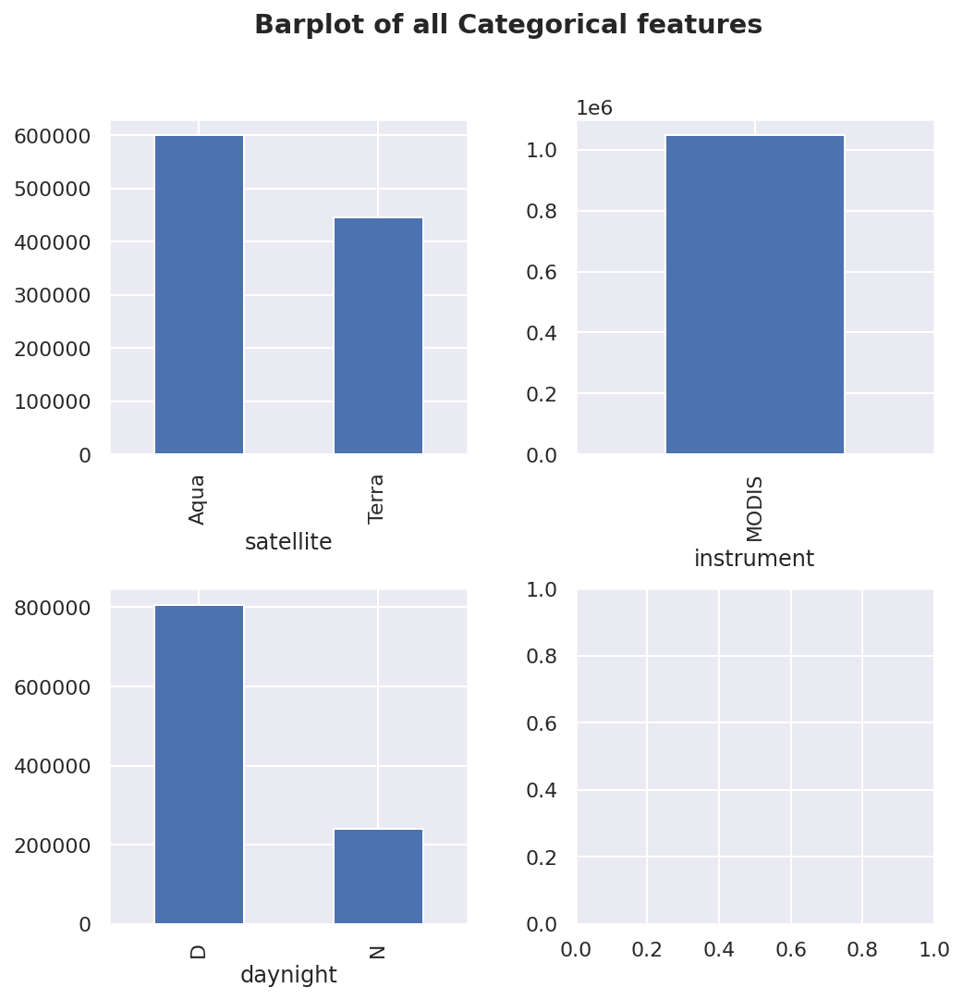

In [ ]:
mulitple_function_plots(tight_layout=False,fig_size=(8,8), 
                        data=raw_data.drop('acq_date',axis=1),plot_type='barplot',data_type='categorical')

We use histogram to plot acq_date:

In [ ]:
acq_date_col = pd.DataFrame(raw_data['acq_date'])

##### The following code needs a lot of time to run.

Text(0.5, 1.0, 'Histogram of acq date')

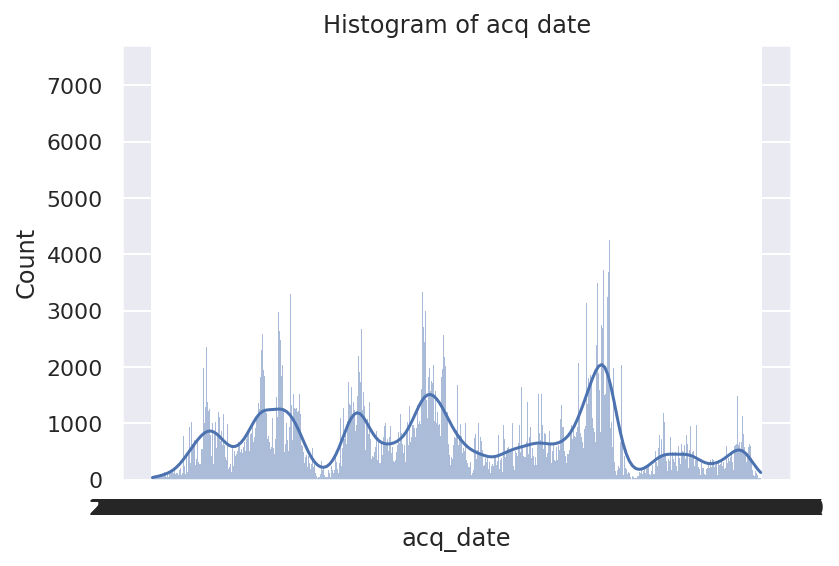

In [ ]:
sns.histplot(data=acq_date_col, x='acq_date', bins = 30,kde=True)
plt.title("Histogram of acq date")

That's not good.<br> It didn't follow my order to apply bin size 30.<br>
That's because acq_date is not a numerical data. <br>
Seaborn didn't and can not recognize its arithmetic value.
Then it can't count their order to form a bin.<br>
I am gonna use a trick to solve it before data preparation.
Use time series.

##### Time series plot

Text(0.5, 1.0, 'Histogram of acq_date by bin size 30')

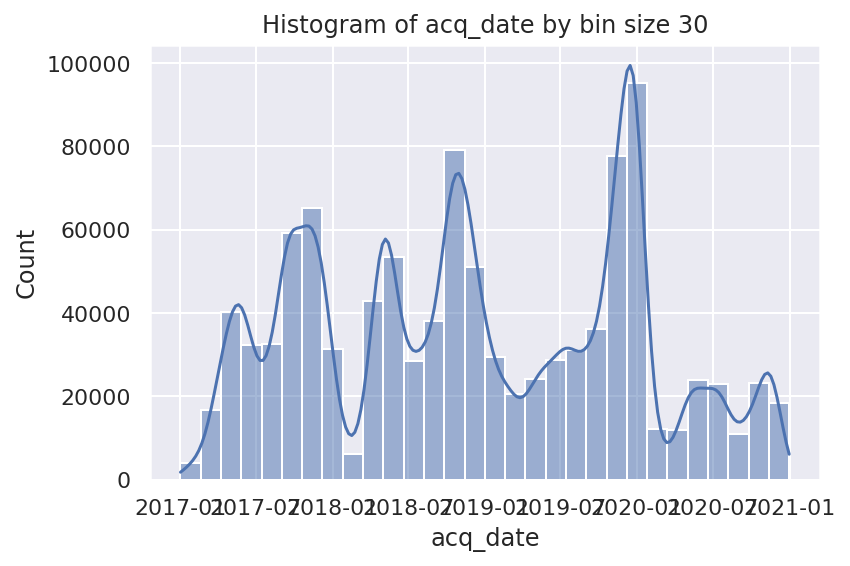

In [ ]:
acq_date_col = pd.to_datetime(acq_date_col['acq_date'], format= '%Y-%m-%d')
sns.histplot(data=acq_date_col, bins = 30,kde=True)
plt.title("Histogram of acq_date by bin size 30")

Not bad. But this is not I want. 
We will solve this problem later.

In [ ]:
acq_date_col.value_counts().head()

2020-01-04    7351
2019-12-30    6925
2019-12-19    4768
2020-01-02    4390
2020-01-03    4260
Name: acq_date, dtype: int64

Therefore, we know that on 2020-01-04, it has the highest number of accidents.
Since each accident will occupy one instance. Which day has the most number of instances, it has the highest number of accidents.

## b. Plot the heatmap correlation among the variables in the data<a class="anchor" name="task1_b"></a>

###### heatmap draw function archive. Real one in [Self-defined functions/Class in task 1](#func_task1)<br>

In [ ]:
def heatmap_draw(data):
    # Correlation between different variables
    corr = data.corr()
    # Set up the matplotlib plot configuration
    f, ax = plt.subplots(figsize=(12, 10))
    # Configure a custom diverging colormap
    cmap = sns.diverging_palette(230, 20, as_cmap=True)
    # Draw the heatmap
    sns.heatmap(corr, annot=True, cmap=cmap)
    plt.title("Heatmap correlation among all features")

#### Draw a heatmap<a class="anchor" name="task1_b_1"></a>

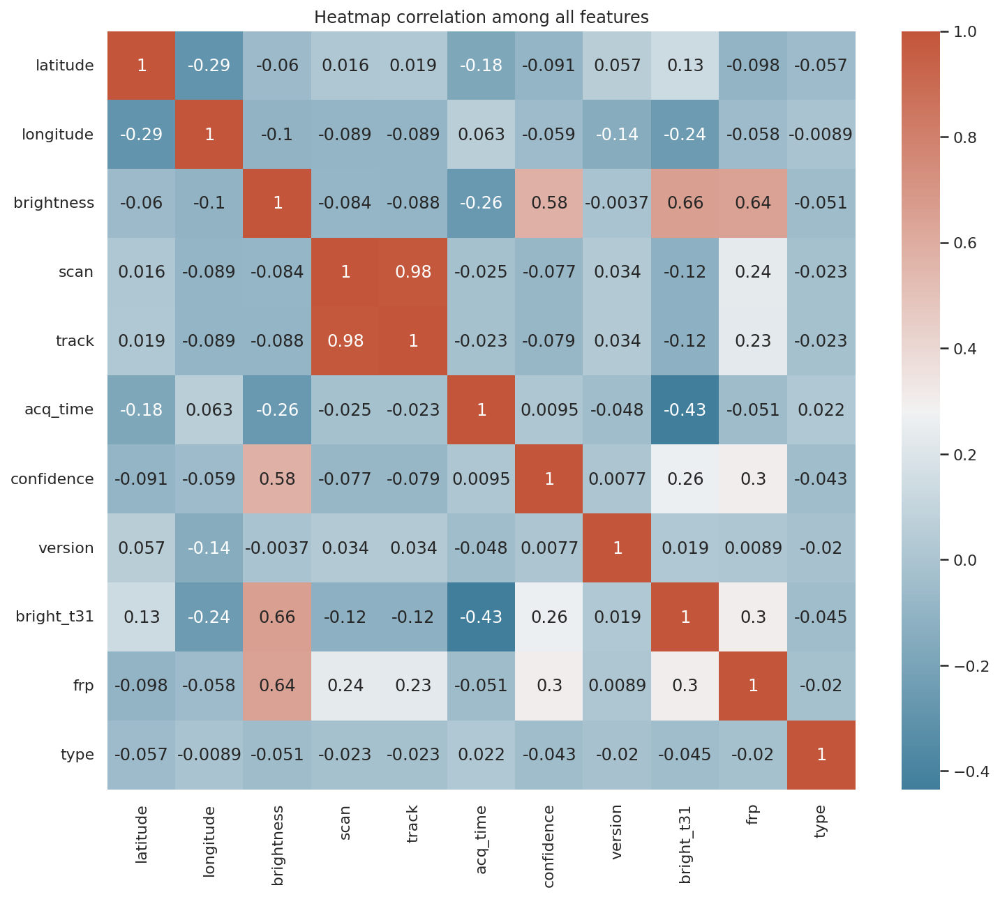

In [ ]:
heatmap_draw(raw_data)

## c. Identify data quality issues and build the data quality plan<a class="anchor" name="task1_c"></a>
  

#### c.0. Utility functions<a class="anchor" name="task1_c_0"></a>
> Archive for easy to use

In [ ]:


#-------------  detect and delete outliers -----------------------------------------------------

def find_outliers(data_df, parameter,* , drop=False, set_threshold=False, threshold_value = 10): # deal with outliers
    
    '''detect and delete outliers '''
    Q1 = data_df[parameter].quantile(0.25)
    Q3 = data_df[parameter].quantile(0.75)
    IQR = Q3-Q1
    print(f"IQR = {Q3} - {Q1} = {IQR}")
    print(f"MAX = {(Q3 + 1.5 * IQR)}")
    
    if Q1 > 1.5*IQR :
        print("Min: ", (Q1 - 1.5 * IQR))
    else:
        print("Min is 0")
    
    cut_out_value =  (Q3 + 1.5 * IQR)
    if set_threshold == True:
        cut_out_value = threshold_value
        
    min_outliers_df = data_df[(data_df[parameter] < (Q1 - 1.5 * IQR))]
    max_outliers_df = data_df[(data_df[parameter] > cut_out_value)]           
    print("Num of min outliers: ", len(min_outliers_df))
    print("Num of max outliers: ", len(max_outliers_df))
    if drop:
        return data_df.drop(max_outliers_df.index)


#------------- Add features -----------------------------------------------------

def feature_add(train_raw_data):
  ''' Add features'''
  train_raw_data['location'] = train_raw_data['longitude'] + train_raw_data['latitude']
  train_raw_data['location'] = train_raw_data['location'].round(0)


    


### c.1. Data quality issues table<a class="anchor" name="task1_c_1"></a>

| Continuous Feature   | Data Quality Issue  | Potential Handling Strategies  |
 |  ----  |          ----   |              --- |
| frp  | Outliers' values are too large | Need to assign value to outliers/Drop all outliers |
| acq_time  | Not meaningful. Extension of acq_date | Concatenate with acq_time|
| scan  | Low cardinality for cont. features | Further analysis (Found interesting correlation)  |
| track  | Low cardinality for cont. features | Further analysis  (Found interesting correlation) |
| version  | Categorical value | Not a very useful feature. Drop it  |
|  brightness | Has many outliers | No action until more data analysis |
|  confidence | A lot of large values at the right end  | Handle later |
|  Type | Cardinality = 3 and not very meaningful | change to categorical data/ Drop it |

---
Since we are predicting a value in our task. Then in a regression model. We need to covert categorical data to a continuous form.

| Categorical Feature   | Data Quality Issue  | Potential Handling Strategies  |
|  ----  |          ----   |              --- |
|  acq_date | High Cardinality/Not a categorical data | Change to Times Series format |
|  satellite | String | One hot encoding |
|  instrument | Cardinality equal to 1/ Not useful | Drop |
|  daynight |String | One hot encoding |





> In this project, I choose "frp" as my target value. The following data analysis step will follow frp as top priority.

#### c.1.1 Identify the problem<a class="anchor" name="task1_c_1.1"></a>  
Now let's figure out what problem we have now.


[back to top](#top)

##### c.1.1.1 FRP target value investigation <a class="anchor" name="task1_c_1.1.1"></a>  
First we plot the histogram again.

Text(0.5, 0, 'frp')

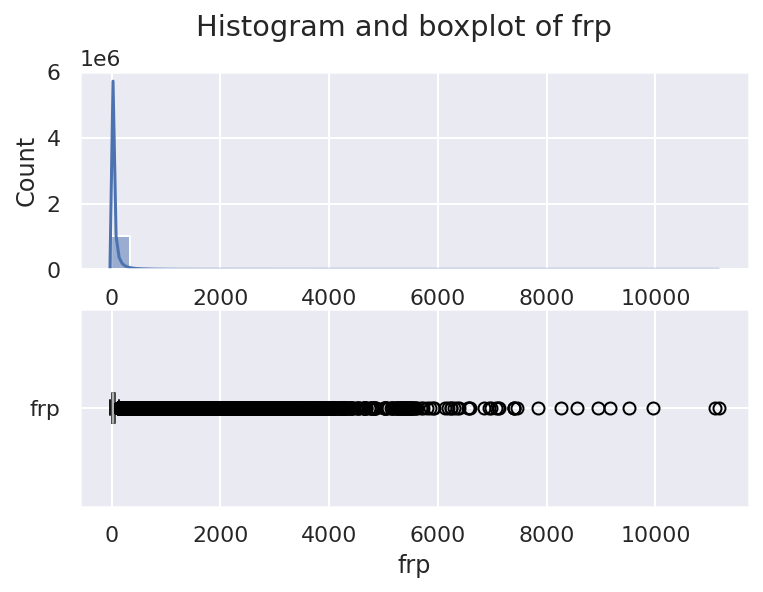

In [ ]:
fig, axs = plt.subplots(2)
sns.histplot(data=raw_data, x='frp', bins = 30,kde=True, ax=axs[0])
raw_data.boxplot(column='frp',ax=axs[1], vert=False)
fig.suptitle("Histogram and boxplot of frp")
plt.xlabel("frp")

We can clearly see that the main range of frp's value lays between 0 to way less than 1000. <br>
And its maximum value up to 10000. <br>

From our course, we know that the CRISP-DM process, the first part and most important part is Business understanding.
It should come first before Data understand.

![picture](https://drive.google.com/uc?export=view&id=1uOwvYqo6P11Y5AVszMFVq4ueS9RzT-U3)


After seeing this very unusual distribution, I did a little bit search online.
It turns out during July, August 2019 – April, May 2020, there is a huge bushfire happened in Australia.
The scale of this wildfire has never seen before by any human records.
It costs approximately over 103 million dollars lost.
> 2019–20 Australian bushfire season
In June 2019 the Queensland Fire and Emergency Service acting director warned of the potential for an early start to the bushfire season which normally starts in August. The warning was based on the Northern Australia bushfire seasonal outlook noting exceptional dry conditions and a lack of soil moisture, combined with early fires in central Queensland.[17] Throughout the summer, hundreds of fires burnt, mainly in the southeast of the country. The major fires peaked during December–January. [Wikipedia](https://en.wikipedia.org/wiki/2019%E2%80%9320_Australian_bushfire_season)

![picture](https://drive.google.com/uc?export=view&id=1W4adEw0K38-JgMb_74Z3e2orN0z4j6Fo)


And unfortunately, Australia has multiple kinds of huge bushfires every year. <br>
We know that our target value is frp
> (Fire Radiative Power)
FRP depicts the pixel-integrated fire radiative power in MW (megawatts). Given the unique spatial and spectral resolution of the data, the VIIRS 375 m fire detection algorithm was customized and tuned in order to optimize its response over small fires while balancing the occurrence of false alarms. Frequent saturation of the mid-infrared I4 channel (3.55-3.93 µm) driving the detection of active fires requires additional tests and procedures to avoid pixel classification errors. As a result, sub-pixel fire characterization (e.g., fire radiative power [FRP] retrieval) is only viable across small and/or low-intensity fires. Systematic FRP retrievals are based on a hybrid approach combining 375 and 750 m data. In fact, starting in 2015 the algorithm incorporated additional VIIRS channel M13 (3.973-4.128 µm) 750 m data in both aggregated and unaggregated format.([Kaggle dataset description](https://www.kaggle.com/datasets/brsdincer/australia-and-investigative-special-wildfires-data))

In a short way to describe the above, it is a scalar value related to measure how big a fire is.
But due to every year's exremely large bushfires, this value will become way higher than the normal wildfires.


And the process of calculating FRP by a few pixels is not a easy task.

David Peterson wrote an article about how to do it, which is also related to our project.
By this graph, we know that all features are not quite independent to each other. This make will our prediction model become extremely hard to get a good score.
> (Peterson, D., &amp; Wang, J. (2013). A sub-pixel-based calculation of fire radiative power from MODIS OBSERVATIONS: 2. sensitivity analysis and potential fire weather application. Remote Sensing of Environment, 129, [231–249.](https://doi.org/10.1016/j.rse.2012.10.020))

![picture](https://drive.google.com/uc?export=view&id=1AX60yajTwU2PbF7qD0p1RbgwLVW9W_LP)


After identified this significant phenomena, we move on to data understanding.<br> From the textbook, we know we can not train a model even if the data set is vaild and have significantly outliers. In our case, it is exactly the same.
<br> **Hence, my main idea to solve those outliers is to drop them all.**
Since when our data set across multiple years, the performance will decrease and if we use one year to predict another year, we got mismatch problem. Those problems are really and will reflect in the training process.

> For example, we cannot train error-based models with data that contains missing values, and data that contains outliers significantly damages the performance of similarity-based
models. (Kelleher, Textbook 2, Fundamentals of ML for Predictive Data Analytics_ Algorithms, Worked Examples, and Case Studies)

We probably all know the most famous slogan in deep learning, "Garbage in, Garbage out". <br>
We can't feed our training model with something it can not understand. This will simply cost money, time and our mind.<br>
Now, we take a step further on "frp" in 2020's data set

Text(0.5, 0, 'frp')

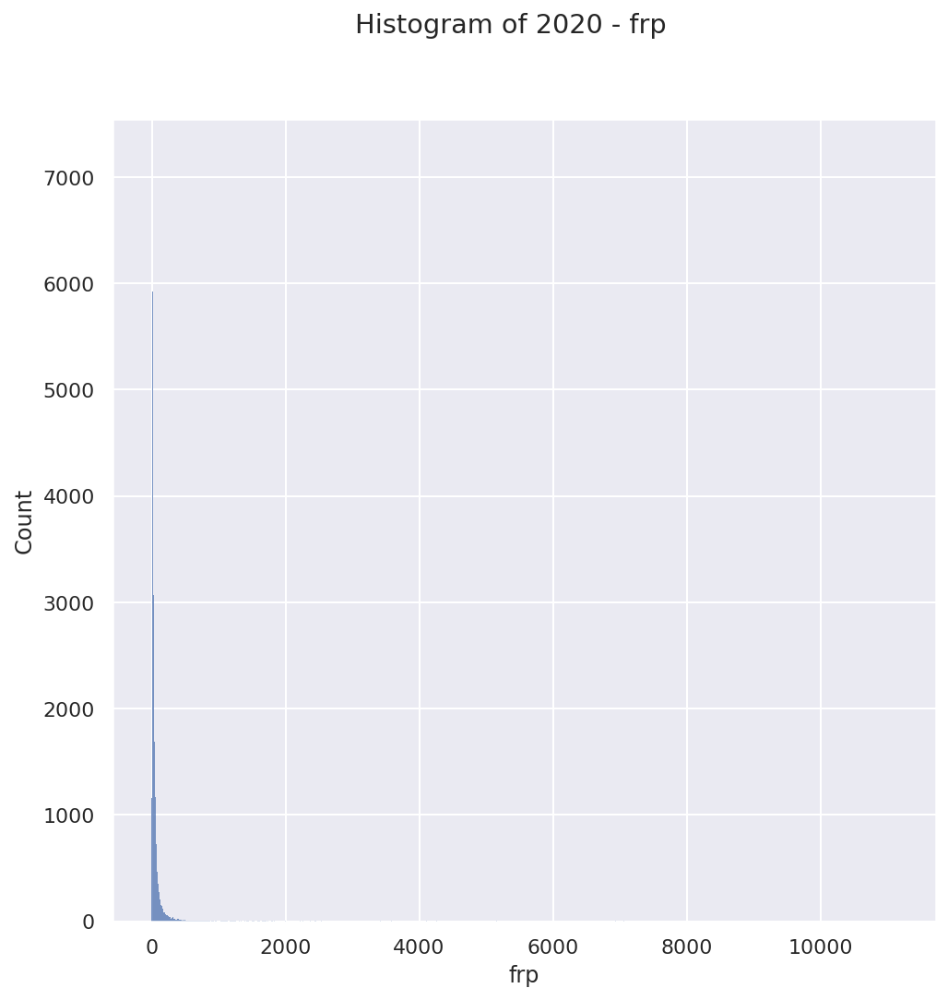

In [ ]:
# load sub data set

raw_data_2020 = pd.read_csv("modis_2020_Australia.csv")
fig, axs = plt.subplots(figsize=(8,8))
sns.histplot(data=raw_data_2020, x='frp')
fig.suptitle("Histogram of 2020 - frp")
plt.xlabel("frp")

The histogram plot of 2020's frp. But we can see there are not too many details from 2000 to 10000

Next I used ArcGIS PRO, (provided by Dalhousie license) to draw a few plots to identify what we are facing at the data quality issue stage. This application is wildly used by data scientist who works in geography area. It shows great details among large dataset. I will change my tool back to python after we drop some instances.

--- 

The heatmap graph shows the geographical heat map of year 2017.(The huge bushfire made 2020 heat map really hard to identify any useful information. All areas in Australia are bright yellow)
And the top right graph shows the same graph we just plotted, with much more details. We can see that after 4000 they are all discrete points lays on 5000 to 100000.

![picture](https://drive.google.com/uc?export=view&id=1QwGIvO9sGi32-mVlkVYoWXAe1NYF-5wo)



From the aboving two grpahs, "change in data counts over acq_date", "Comparision of mean ftp by acq_date". <br>
We can see the maximum value of frp in a single day is follow the same distribution of the counts of instance in the same day. Which indicates that a huge wildfire often causes larger fire activity. And by Google it,  December 2019 to January 2020, exactly the same bushfire we talked before. It happened in this time period. The biggest one.

This explains why we have so much outliers in frp -- large scale bushfires.

But our model, my knowledge about fire activity are too shallow to solve this practical problem. Further investigation may apply, but for now I will drop it.

Hence, I did a few experiments about these features' purging to test my assumption before any further moves. <br>
The results are very pleasure to see. <br>
We change our data back to all four years.

First, we try to get the FRP distribution by our insights instead of the math to find outliers.
1. All frp less than 4000.

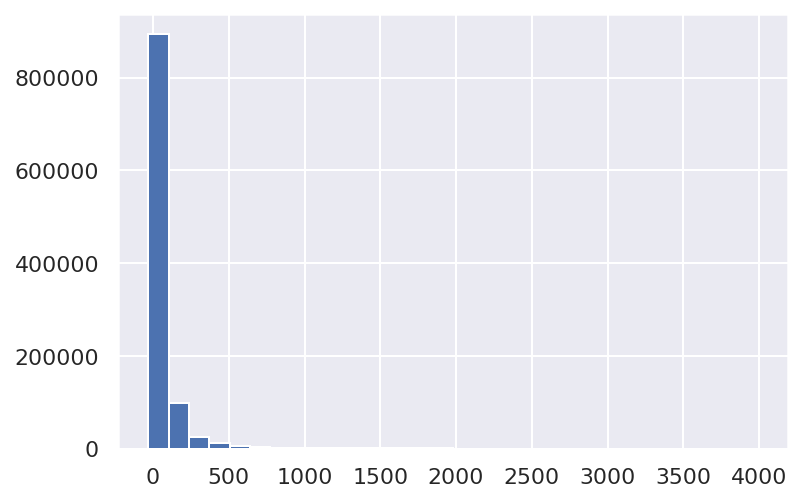

In [ ]:
(raw_data[(raw_data['frp'] < 4000)]).frp.hist(bins=30)

Well, pretty bad still. but much better than before.<br> 


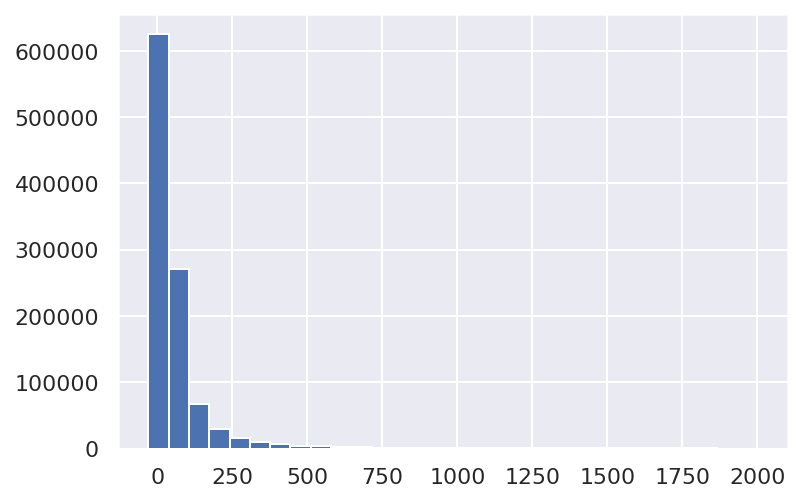

In [ ]:
# when less than 2000
(raw_data[(raw_data['frp'] < 2000)]).frp.hist(bins=30)

We start to see what its distribution is.

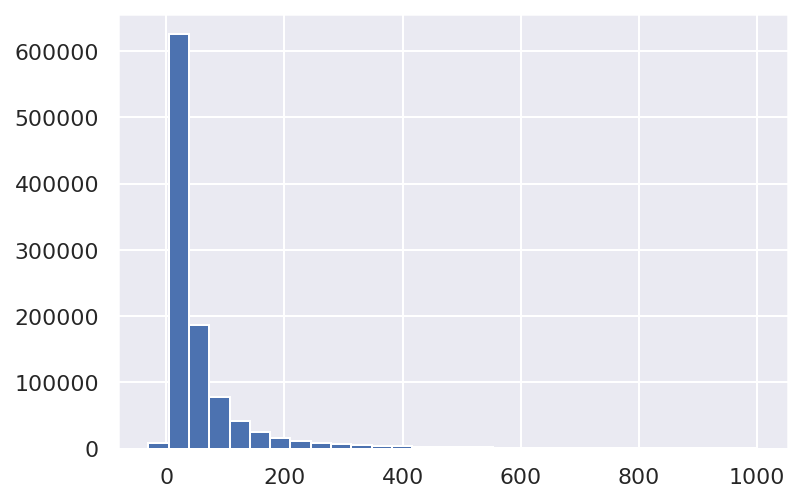

In [ ]:
# less than 1500
(raw_data[(raw_data['frp'] < 1000)]).frp.hist(bins=30)

###### Not a big difference. It's time to create a function for finding its IQR values and outliers.

In [ ]:


#-------------  detect and delete outliers -----------------------------------------------------

def find_outliers(data_df, parameter,drop=False, set_threshold=False, threshold_value = 10): # deal with outliers
    
    '''detect and delete outliers '''
    Q1 = data_df[parameter].quantile(0.25) # get Q1
    Q3 = data_df[parameter].quantile(0.75) # get Q2 
    IQR = Q3-Q1 # get IQR
    print(f"IQR = {Q3} - {Q1} = {IQR}")
    print(f"MAX = {(Q3 + 1.5 * IQR)}")
    
    # we don't want a negative IQR. It's meanless in our dataset

    if Q1 > 1.5*IQR :
        print("Min: ", (Q1 - 1.5 * IQR))
    else:
        print("Min is 0")
    # set purge threshold
    cut_out_value =  (Q3 + 1.5 * IQR)
    if set_threshold == True:
        cut_out_value = threshold_value
    # print out useful information
    min_outliers_df = data_df[(data_df[parameter] < (Q1 - 1.5 * IQR))]
    max_outliers_df = data_df[(data_df[parameter] > cut_out_value)]           
    print("Num of min outliers: ", len(min_outliers_df))
    print("Num of max outliers: ", len(max_outliers_df))
    if drop:
        return data_df.drop(max_outliers_df.index)


> Note: <br> This is the most basic version I wrote at this stage, we will upgrade this function in the next section.

###### Show outliers. 

In [ ]:
find_outliers(raw_data,'frp',False)

IQR = 63.5 - 14.6 = 48.9
MAX = 136.85
Min is 0
Num of min outliers:  0
Num of max outliers:  111537


Surprising result! Our frp outiler maximum values is only 136.85!!!


Let's find out the data set's max value

In [ ]:
raw_data.frp.max()

11164.1

11164!!!, not a chance we can train this model. 
> It is likely that outliers found using the second approach are valid outliers, so they are
a data quality issue due to valid data. Some machine learning techniques do not perform
well in the presence of outliers, so we should note these in the data quality plan for possible
handling later in the project. (Textbook 2, Kelleher, Fundamentals of ML for Predictive Data Analytics_ Algorithms, Worked Examples, and Case Studies.)

In [ ]:
len(raw_data)

1046679

We have 1046679, a million instances, and have 11,1547 outliers. I would say its a good trade off at least in this stage of learning.

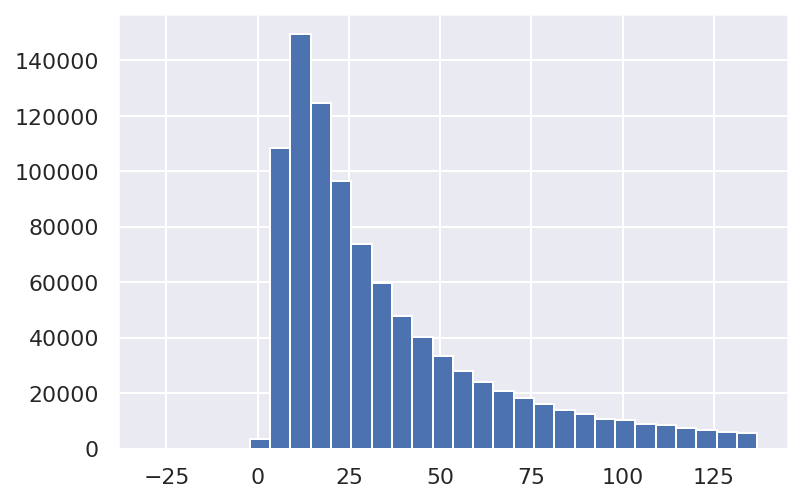

In [ ]:
# less than 
(raw_data[(raw_data['frp'] < 137)]).frp.hist(bins=30)

This target feature is satisfied with a Poisson distribution.
We need to alter our loss function to predict it more properly.
[peltarion](https://peltarion.com/knowledge-center/documentation/modeling-view/build-an-ai-model/loss-functions/poisson)

Let's examine the potential of set threshold at 350. 

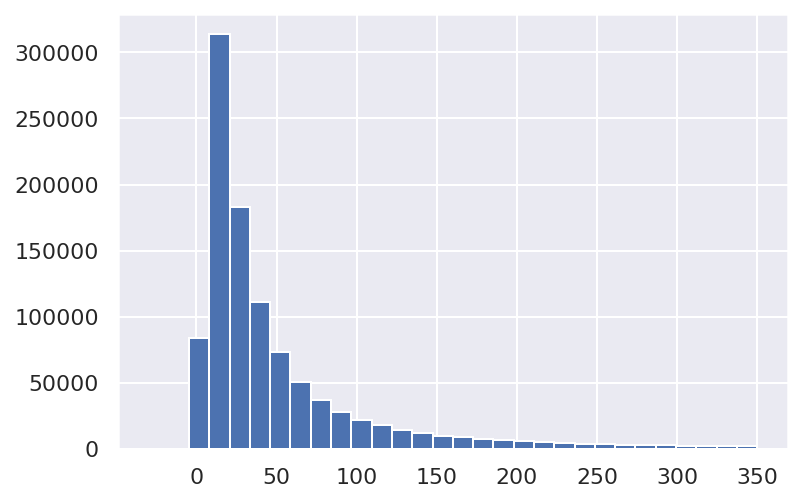

In [ ]:
# less than 
(raw_data[(raw_data['frp'] < 350)]).frp.hist(bins=30)

In [ ]:
# outliers' rate of whole data set
(len(raw_data) - len((raw_data[(raw_data['frp'] < 350)])))/len(raw_data)

0.03110313668278431

In [ ]:
# outliers number

len(raw_data) - len((raw_data[(raw_data['frp'] < 350)]))

32555

##### c.1.1.2. FTP data quality plan <a class="anchor" name="task1_c_1.1.2"></a>  

If we set the threshold on frp < 350. We have 0.03% outliers. I would say it's a fair rate.

Hence, I have two solution to solve this problem.
1. Delete all outliers with their instance. Since, in our data set, we can not set outliers to a same value. It will break the distribution patter. We already have a perfect Poisson distribution. We must keep it that way.
2. We set threshold at 180, and purge all instances with ftp > 180. To remain some extreme value to make this task a little bit harder.

##### c.1.1.2. Purge data set for further investigation <a class="anchor" name="task1_c_1.1.3"></a>  

There is a big difference than a normal procedure of data plan. In most cases, we don't clean data until we finish data quality plan for every feature.


But in our case, I am going to purge data set right now. Since we are removing almost 11,1000 instances. It could have a major effect on other values. 
<br>
I am not going to take the chance of analysis some characteristics on the instances that will be removed no matter what.

In the next, I am going to delete all outliers instances and redo the data quality report.
<br> Just for checking whether the data quality issues be different. 

In [ ]:
purge_data = find_outliers(raw_data, 'frp', drop=True)

IQR = 63.5 - 14.6 = 48.9
MAX = 136.85
Min is 0
Num of min outliers:  0
Num of max outliers:  111537


In [ ]:
purge_data.describe()

,latitude,longitude,brightness,scan,track,acq_time,confidence,version,bright_t31,frp,type
count,935142.00,935142.00,935142.00,935142.00,935142.00,935142.00,935142.00,935142.00,935142.00,935142.00,935142.00
mean,-21.71,135.52,328.00,1.59,1.21,632.96,68.24,6.07,302.34,35.15,0.02
std,7.81,10.46,15.91,0.78,0.24,540.75,22.29,0.07,9.76,29.43,0.18
min,-43.50,113.13,300.00,1.00,1.00,0.00,0.00,6.03,265.70,-29.90,0.00
25%,-28.55,127.19,316.60,1.10,1.00,221.00,54.00,6.03,295.30,13.50,0.00
50%,-19.37,133.53,326.70,1.30,1.10,446.00,71.00,6.03,302.30,24.80,0.00
75%,-15.10,145.09,337.40,1.80,1.30,1225.00,86.00,6.20,308.90,47.50,0.00
max,-9.25,153.59,507.00,4.80,2.00,2359.00,100.00,6.20,400.10,136.80,3.00


In [ ]:
build_continuous_features_report(purge_data)

,Count,Miss %,Card.,Min,1st Qrt.,Mean,Median,3rd Qrt,Max,Std. Dev.
latitude,935142,0.00,252622,-43.50,-28.55,-21.71,-19.37,-15.10,-9.25,7.81
longitude,935142,0.00,315707,113.13,127.19,135.52,133.53,145.09,153.59,10.46
brightness,935142,0.00,1510,300.00,316.60,328.00,326.70,337.40,507.00,15.91
scan,935142,0.00,39,1.00,1.10,1.59,1.30,1.80,4.80,0.78
track,935142,0.00,11,1.00,1.00,1.21,1.10,1.30,2.00,0.24
acq_time,935142,0.00,854,0.00,221.00,632.96,446.00,1225.00,2359.00,540.75
confidence,935142,0.00,101,0.00,54.00,68.24,71.00,86.00,100.00,22.29
version,935142,0.00,2,6.03,6.03,6.07,6.03,6.20,6.20,0.07
bright_t31,935142,0.00,854,265.70,295.30,302.34,302.30,308.90,400.10,9.76
frp,935142,0.00,1354,-29.90,13.50,35.15,24.80,47.50,136.80,29.43


In [ ]:
build_categorical_features_report(purge_data)

,Count,Miss %,Card.,Mode,Mode Freq,Mode %,2nd Mode,2nd Mode Freq,2nd Mode %
acq_date,935142,0.00,1461,2020-01-04,5659,0.61,[2019-12-30],5608,0.60
satellite,935142,0.00,2,Aqua,528021,56.46,[Terra],407121,43.54
instrument,935142,0.00,1,MODIS,935142,100.00,[],0,0.00
daynight,935142,0.00,2,D,707909,75.70,[N],227233,24.30


###### Purge_data plot

Those features will be plotted in  6  rows and 2 columns
Index(['latitude', 'longitude', 'brightness', 'scan', 'track', 'acq_time',
       'confidence', 'version', 'bright_t31', 'frp', 'type'],
      dtype='object')
1 . Finish Rendering : latitude , used 300.325 millseconds
2 . Finish Rendering : longitude , used 356.024 millseconds
3 . Finish Rendering : brightness , used 61.001 millseconds
4 . Finish Rendering : scan , used 239.489 millseconds
5 . Finish Rendering : track , used 440.486 millseconds
6 . Finish Rendering : acq_time , used 758.555 millseconds
7 . Finish Rendering : confidence , used 228.333 millseconds
8 . Finish Rendering : version , used 306.993 millseconds
9 . Finish Rendering : bright_t31 , used 176.368 millseconds
10 . Finish Rendering : frp , used 717.331 millseconds
11 . Finish Rendering : type , used 575.709 millseconds


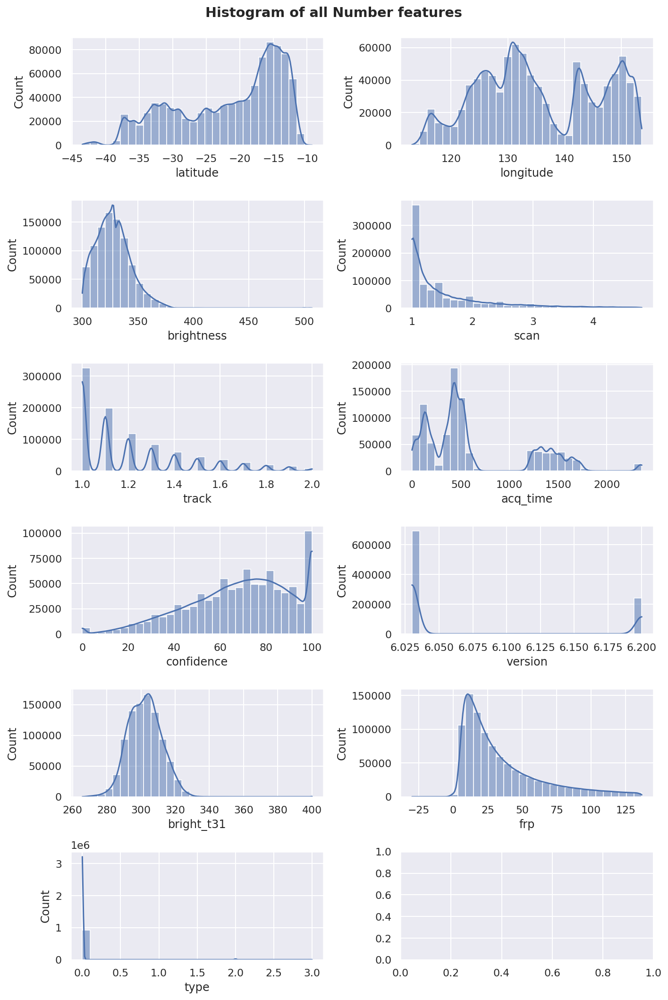

In [ ]:
ax = mulitple_function_plots(data=purge_data,plot_type="histogram",data_type="number")

Those features will be plotted in  6  rows and 2 columns
Index(['latitude', 'longitude', 'brightness', 'scan', 'track', 'acq_time',
       'confidence', 'version', 'bright_t31', 'frp', 'type'],
      dtype='object')
1 . Finish Rendering : latitude , used 206.644 millseconds
2 . Finish Rendering : longitude , used 371.661 millseconds
3 . Finish Rendering : brightness , used 588.572 millseconds
4 . Finish Rendering : scan , used 695.793 millseconds
5 . Finish Rendering : track , used 739.235 millseconds
6 . Finish Rendering : acq_time , used 728.836 millseconds
7 . Finish Rendering : confidence , used 603.835 millseconds
8 . Finish Rendering : version , used 555.956 millseconds
9 . Finish Rendering : bright_t31 , used 736.249 millseconds
10 . Finish Rendering : frp , used 998.244 millseconds
11 . Finish Rendering : type , used 898.02 millseconds


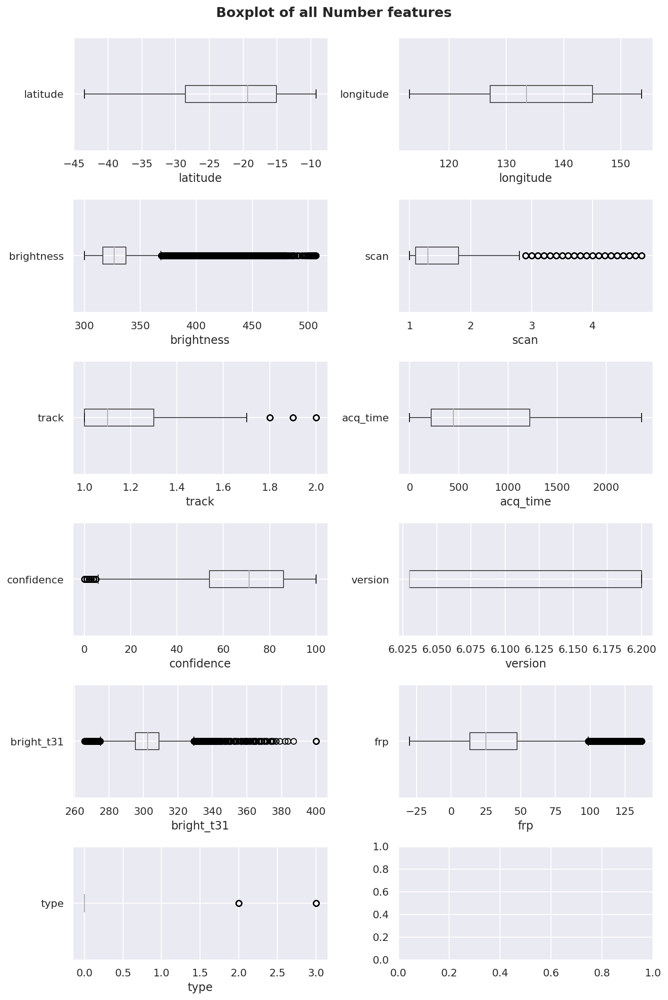

In [ ]:
ax = mulitple_function_plots(data=purge_data,plot_type="boxplot",data_type="number")

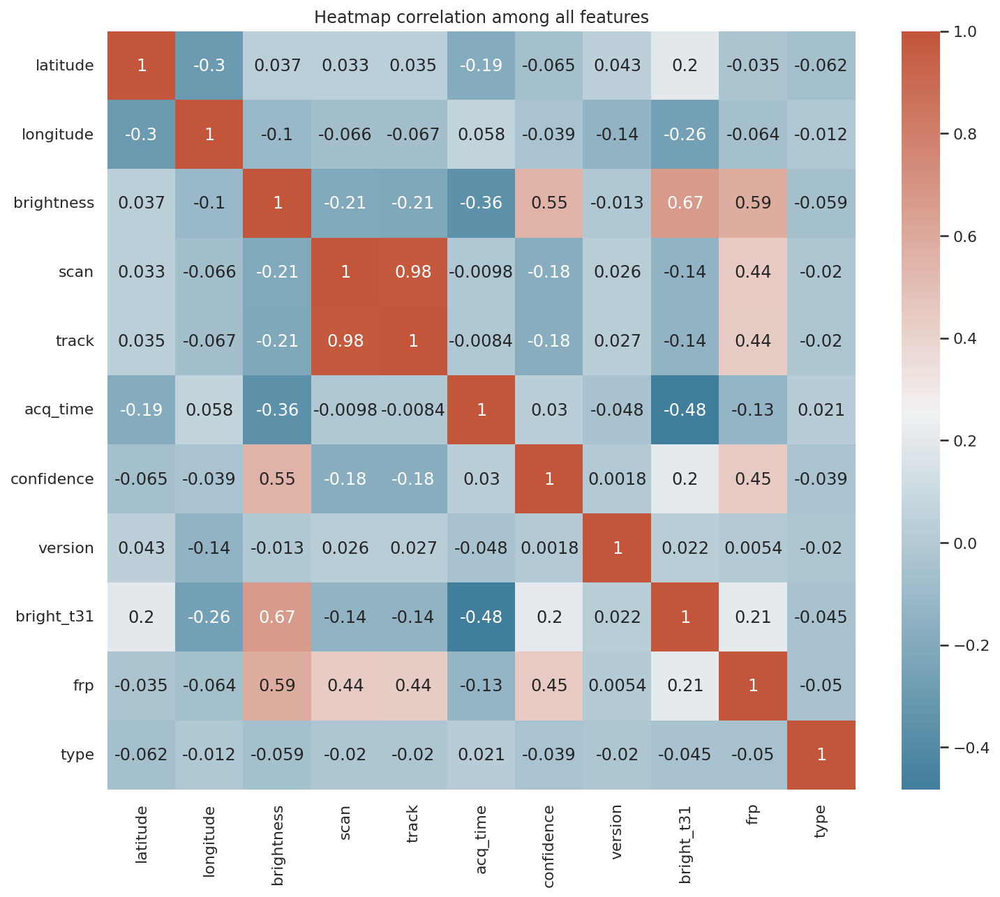

In [ ]:
heatmap_draw(purge_data)

**The previous heat_map** 

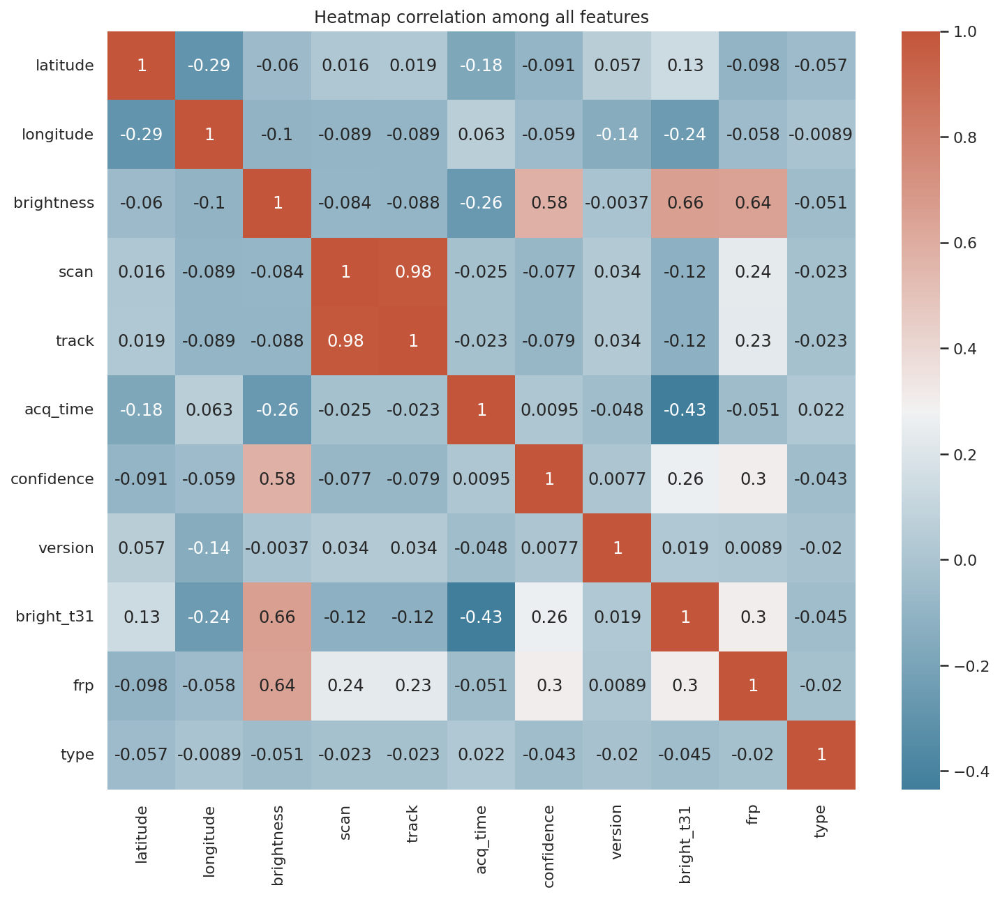

In [ ]:
heatmap_draw(raw_data)

We are seeing really good results. We have three more features have strong correlation with our target! <br>
Not bad at all!

Now we can deal with some trivial stuff.<br>
We can see that min of frp is -29. That should not happen. FRP can not be negative.
Let's see how many are they.

In [ ]:
purge_data[purge_data['frp'] <= 0].describe()

,latitude,longitude,brightness,scan,track,acq_time,confidence,version,bright_t31,frp,type
count,2948.00,2948.00,2948.00,2948.00,2948.00,2948.00,2948.00,2948.00,2948.00,2948.00,2948.00
mean,-35.42,144.58,389.42,1.26,1.08,1031.24,98.86,6.04,305.71,-0.02,0.03
std,4.31,9.24,52.23,0.47,0.16,509.51,4.03,0.03,30.52,0.71,0.29
min,-43.50,114.96,320.00,1.00,1.00,13.00,0.00,6.03,265.70,-29.90,0.00
25%,-37.46,147.85,347.95,1.00,1.00,500.00,100.00,6.03,285.50,0.00,0.00
50%,-37.16,148.32,377.80,1.10,1.00,1310.00,100.00,6.03,298.60,0.00,0.00
75%,-35.75,149.59,417.62,1.10,1.10,1449.00,100.00,6.03,315.50,0.00,0.00
max,-11.14,153.45,507.00,4.80,2.00,2359.00,100.00,6.20,400.10,0.00,3.00


We have 2948 instances with frp == 0.
Those are pretty useless. 
We should drop it.

---



Now, we take a look at our previous data quality reports again.

| Continuous Feature   | Data Quality Issue  | Potential Handling Strategies  |
 |  ----  |          ----   |              --- |
| frp  | Outliers' values are too large | Need to assign value to outliers/Drop all outliers |
| acq_time  | Not meaningful. Extension of acq_date | Concatenate with acq_time|
| scan  | Low cardinality for cont. features | Further analysis (Found interesting correlation)  |
| track  | Low cardinality for cont. features | Further analysis  (Found interesting correlation) |
| version  | Categorical value | Not a very useful feature. Drop it  |
|  brightness | Has many outliers | No action until more data analysis |
|  confidence | A lot of large values at the right end  | Handle later |
|  Type | Cardinality = 3 and not very meaningful | change to categorical data/ Drop it |

---


| Categorical Feature   | Data Quality Issue  | Potential Handling Strategies  |
|  ----  |          ----   |              --- |
|  acq_date | High Cardinality/Not a categorical data | Change to Times Series format |
|  satellite | String | One hot encoding |
|  instrument | Cardinality equal to 1/ Not useful | Drop |
|  daynight |String | One hot encoding |




Since we are seeing strong correlation between frp, with scan and track. 
I decided to keep those two values. <br>
And this following is my data quality plan.

### c.1.2 Data quality plan<a class="anchor" name="task1_c_1.2"></a>  
[back to top](#top)

**FRP:** 
   * Set threshold of deleting outliers as 350. Drop all outliers. <br>
   * There are also 2948 instances with frp <= 0. It should not happen. Drop those instances

**acq_time:** 
   * I did some research and tests by myself. It's just the hour:minutes represent in a integer. Such as 12:29 pm as 1229 in acq_time values.
   * Convert it with acq_date and form them as Time Series.<br>
   > ***Postscript:***<br> In the end, it turns out acq_time and acq_date are not useful in training stage. We discard those two by feature selection method.

**Scan, Track**
   * Keep scan features with no further action. Track actually is a categorical feature with different type. But we are seeing strong correlation between frp and Track. Need further investigation on it. To find out whether this will sabotage our model.
   
**Version** 
   * Drop it. Cardinality with 1 should always drop it.

**Brightness**
   * Since we now know that our target feature has a Poisson distribution. No further action on *Brightness*.
   
**Confidence**
   * This one is very tricky

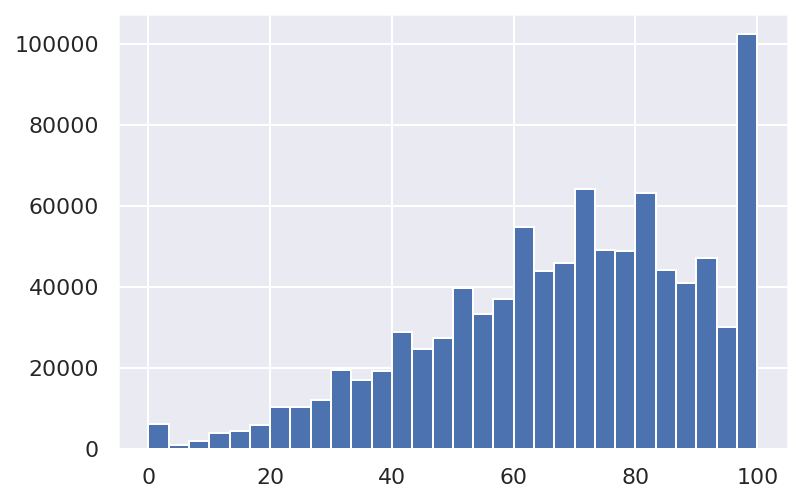

In [ ]:
purge_data.confidence.hist(bins=30)

For now, I don't know what to do with those values equal to 100. <br>
The meaning of confidence equal to 100 is the confidence range of these instances are 100%.<br>
It's a statistic concept to show the prediction lays on the truth value 100% within N experiments.
>Confidence
This value is based on a collection of intermediate algorithm quantities used in the detection process. It is intended to help users gauge the quality of individual hotspot/fire pixels. Confidence values are set to low, nominal and high. Low confidence daytime fire pixels are typically associated with areas of sun glint and lower relative temperature anomaly (15K) temperature anomaly in either day or nighttime data. High confidence fire pixels are associated with day or nighttime saturated pixels. (Our data set official description)

---

> A 100% confidence level means there is no doubt at all that if you repeated the survey you would get the same results. In reality, you would never publish the results from a survey where you had no confidence at all that your statistics were accurate (you would probably repeat the survey with better techniques).https://www.statisticshowto.com/confidence-level/

This is hardly to be true. But we can see a strong correlation between confidence and frp.
Further investigation needs to be done. 

> ***Postscript:***<br>
After a few discussions with Professor Axel Soto and check materials online, we decided not to modify the data of confidence column. It's normal of this column has a peak at 100. 

In [ ]:
purge_data[purge_data['confidence'] == 100].describe()

,latitude,longitude,brightness,scan,track,acq_time,confidence,version,bright_t31,frp,type
count,77818.00,77818.00,77818.00,77818.00,77818.00,77818.00,77818.00,77818.00,77818.00,77818.00,77818.00
mean,-24.53,136.04,346.69,1.28,1.10,1069.03,100.00,6.07,301.89,66.71,0.01
std,7.67,11.56,22.76,0.44,0.15,541.00,0.00,0.07,12.50,37.24,0.17
min,-43.50,113.49,320.00,1.00,1.00,0.00,100.00,6.03,265.70,0.00,0.00
25%,-31.25,125.79,327.10,1.00,1.00,507.00,100.00,6.03,293.90,32.40,0.00
50%,-23.23,133.02,341.30,1.10,1.00,1311.00,100.00,6.03,298.60,65.65,0.00
75%,-17.75,148.57,364.10,1.30,1.10,1454.00,100.00,6.03,310.20,98.10,0.00
max,-11.04,153.48,507.00,4.80,2.00,2359.00,100.00,6.20,400.10,136.80,3.00


In [ ]:
purge_data[purge_data['confidence'] != 100].describe()

,latitude,longitude,brightness,scan,track,acq_time,confidence,version,bright_t31,frp,type
count,857324.00,857324.00,857324.00,857324.00,857324.00,857324.00,857324.00,857324.00,857324.00,857324.00,857324.00
mean,-21.45,135.47,326.30,1.62,1.21,593.38,65.35,6.07,302.38,32.29,0.02
std,7.77,10.36,13.94,0.80,0.24,523.02,21.03,0.07,9.47,26.83,0.18
min,-43.50,113.13,300.00,1.00,1.00,0.00,0.00,6.03,265.70,-29.90,0.00
25%,-28.14,127.32,315.60,1.10,1.00,212.00,52.00,6.03,295.50,12.80,0.00
50%,-18.90,133.56,325.80,1.30,1.10,436.00,68.00,6.03,302.60,23.00,0.00
75%,-14.91,144.74,336.10,1.90,1.30,601.00,82.00,6.20,308.80,43.20,0.00
max,-9.25,153.59,393.10,4.80,2.00,2359.00,99.00,6.20,340.80,136.80,3.00


In [ ]:
purge_data.type.value_counts()

0    927849
2      7003
3       290
Name: type, dtype: Int64

**Type**
   * We have 927849 type as 0. only a few are different. Not very useful. Drop the column.


**acq_date** 	
   * Change to time series along with acq_time
   
**satellite**
   * String	One hot encoding
   
**instrument**	
   * Cardinality equal to 1/ Not useful. Drop it.
   
**daynight**	
> Confidence values are set to low, nominal and high. Low confidence daytime fire pixels are typically associated with areas of sun glint and lower relative temperature anomaly (15K) temperature anomaly in either day or nighttime data. High confidence fire pixels are associated with day or nighttime saturated pixels.
 
 * From the description of confidence feature, we know day or night actually influence the value of confidence.
 * Further investigation needs to be done.

In [ ]:
purge_data.daynight.value_counts()

D    707909
N    227233
Name: daynight, dtype: Int64

# 2.Preprocess your data according to the data quality plan<a class="anchor" name="task1_2"></a>

## 2.1 Create data preparation Pipeline<a class="anchor" name="task1_2.1"></a>

### 2.1.0 Utility Functions in this section.<a class="anchor" name="task1_2.1.0"></a>

> Hidden blocks. Unfold for details. Run all functions for this section.

In [ ]:

# #-------------  detect and delete outliers -----------------------------------------------------

# all codes were written by myself

# def find_outliers(data_df, parameter,* , drop=False, set_threshold=True, threshold_value = 1550): # deal with outliers

def find_outliers(data_df, parameter,* , drop=False, set_threshold=True, threshold_value = 350): # deal with outliers    
    '''detect and delete outliers '''
    Q1 = data_df[parameter].quantile(0.25)
    Q3 = data_df[parameter].quantile(0.75)
    IQR = Q3-Q1
    # get our statistic results of Q1,Q3 and IQR
    # print the results
    print(f"IQR = {Q3} - {Q1} = {IQR}")
    print(f"MAX = {(Q3 + 1.5 * IQR)}")
    
    # prevent for a negative min value. Which has no meaning
    if Q1 > 1.5*IQR :
        print("Min: ", (Q1 - 1.5 * IQR))
    else:
        print("Min is 0")
    
    cut_out_value =  (Q3 + 1.5 * IQR)
    
    if set_threshold == True:
        cut_out_value = threshold_value
        
    min_outliers_df = data_df[(data_df[parameter] < (Q1 - 1.5 * IQR))]
    max_outliers_df = data_df[(data_df[parameter] > cut_out_value)]  
    negative_outliers_df = data_df[(data_df[parameter] <= 0)]         
    print("Num of min outliers: ", len(min_outliers_df))
    print("Num of max outliers: ", len(max_outliers_df))
    print("Num of negative outliers: ", len(negative_outliers_df))
    print("Num of the original data set's whole instance", len(data_df))
    print("Rate of purged data/total data", len(max_outliers_df)/ len(data_df))
    if drop:
        return data_df.drop(max_outliers_df.index)

#-------------  Add new features -----------------------------------------------------

def feature_add(train_raw_data):
  ''' Add features

      Input: your objective data set
  
  '''
  train_raw_data['location'] = 1000* train_raw_data['longitude'] + train_raw_data['latitude']
  train_raw_data['location'] = train_raw_data['location'].round(0)


################################  CLASS  ################################

# Class for attribute transformer
# import important libray
from sklearn.base import BaseEstimator, TransformerMixin

class combined_attribute_adder_and_cleaner(BaseEstimator, TransformerMixin):
    '''data clean transfomer class'''
    
    def __init__(self, data_cleaner = False,set_threshold=False, threshold_value = 350 ): # no *args or **kargs
        # we need to set extra var to ensure do we need to purge the dataset. 
        # In my following experments, sometimes we don't need to do so. 
        self.data_clean = data_cleaner
        # Since we are using threshold from now on. This is crucial.
        self.set_threshold = set_threshold
        # threshold value
        self.threshold_value = threshold_value

    def fit(self, X, y=None):
        return self # nothing else to do

    def transform(self, data_df):
        # we first copy the data from our dataset.
        # operate on original data set sometimes is dangerous.
        X = data_df.copy()
        
        # Start to change all string columns that related to Dates to Time Series
        minutes = (X['acq_time'] % 100).astype(int)
        hours = (X['acq_time'] /100).astype(int) 
        
        #concatenate acq_data and acq_time
        X['acq_date'] =  X['acq_date'] + '-'  + hours.apply(str) + "-" + minutes.apply(str)
        X['acq_date'] = pd.to_datetime(X['acq_date'], format= '%Y-%m-%d-%H-%M')
        
        # This is a outdated version of transfering time series to index.
        # This didn't work so well when I training my model. 
        # So I comment this line. But sometimes, you want to do this.
        # X = X.set_index('acq_date')
        
        # Now we change our time series to a integer by indexing all instances with same month.
        X['month'] = X['acq_date'].dt.month
        
        # add new features. 
        feature_add(X)
        
        # one hot encoding
        # Transter categorical data to numerical value
        # Start to apply one hot encoding
        statelitte = pd.get_dummies(X.satellite)
        daynight = pd.get_dummies(X.daynight)
        X = pd.concat([X,statelitte.astype(int),daynight.astype(int)], axis=1)
        
        # drop all useless features and categorical features we alreayd transfered
        X = X.drop(['acq_time','acq_date', 'instrument','version','satellite','daynight','type','latitude','longitude'],axis=1) 

        
        # do outliers purgeing if it's needed
        
        if self.data_clean:
          # clean outliers
          X = find_outliers(X,'frp',drop=True,set_threshold=True,threshold_value=self.threshold_value)
            
          # clean negative frp instance
          negative_index = X[(X['frp'] <= 0)]  
          X = X.drop(negative_index.index)

          return X
        else:
        ## if we don't need to purge outliers, then just return X
          return X
        
    
#------------- transformer for output numpy array for our data set ---------------------

class numerical_transfer(BaseEstimator, TransformerMixin):
    '''numerical_transfer class'''
    
    def __init__(self, transfer_to_number=True ): # no *args or **kargs
        # This line seems pretty useless. But sometimes, we want this.
        self.transfer_to_number = transfer_to_number
        
    def fit(self, X, y=None):
        return self # nothing else to do

    def transform(self, X):
      # the values of a panda dataframe is all we need.
      if self.transfer_to_number:
        return X.values
      else:
        return X


#############################PIPE LINE###################################################


# Now we build a transformer to get all the above steps
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

# purge pipeline is only for purgeing any outliers.
purge_pipeline = Pipeline([
        ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(data_cleaner=True)),
    ])

#number pipline will transfer all data to numpy array and do normailization
number_pipeline = Pipeline([
        ('num_transfer', numerical_transfer()),
        ('std_scaler', StandardScaler()),
    ])

# none purge pipeline will only get you the data with correct form, but don't delete any outliers
none_purge_pipeline = Pipeline([
        ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(data_cleaner=False))
    ])

# full pipeline to create a prepared dataset in a glance
full_pipeline = Pipeline([
     ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(data_cleaner=True)),
     ('num_transfer', numerical_transfer()),
     ('std_scaler', StandardScaler()),
])



############################FUNCTIONS ON PIPELINE##########################################

#-------------  create_trainning_data -----------------------------------------------------
# This function is for creating training data directly into numpy form
def create_trainning_data(data_df,num_array_needed = False):
    data_inner = data_df.copy()
    X = data_inner.drop("frp", axis=1) # drop labels for training set
    y = data_inner["frp"].copy()
    if num_array_needed: 
      X = number_pipeline.fit_transform(X)
      y = np.array(y.values)
    return X,y

#------------- create_dp_data -----------------------------------------------------

# This function is for creating a normalized training data but remain the panda dataset form
def create_dp_data(data): 
  target = data.pop('frp')
  normalized_df_test=(data-data.mean())/data.std()
  normalized_df_test['target'] = target
  normalized_df_test = normalized_df_test.drop(['latitude','longitude','type','Aqua','Terra','D','N'],axis=1)
  return normalized_df_test



### 2.1.1 Purge outliers<a class="anchor" name="task1_2.1.1"></a>

At the very beginning with our process, we need to build some base rocks for our transformer pipeline.
The first one I choose, is the function for finding outliers.
I put all details in code block for more clear classification. <br>
The main idea is we use statistic method to find 1st quantile and 3rd quantile of our target value FRP, and the difference between those two is IQR. Then we use IQR to find max and min value. Any other values larger or less than max, min will be purged.

In the meantime, I also added a way to purge outliers by threshold. By doing a lot of testing that are no in this notebook, I always change threshold to test new models and put them into test set to find their performance.

In [ ]:

#-------------  detect and delete outliers -----------------------------------------------------

# def find_outliers(data_df, parameter,* , drop=False, set_threshold=True, threshold_value = 1550): # deal with outliers

def find_outliers(data_df, parameter,* , drop=False, set_threshold=True, threshold_value = 350): # deal with outliers    
    '''detect and delete outliers '''
    # same with previous find_outliers function
    Q1 = data_df[parameter].quantile(0.25)
    Q3 = data_df[parameter].quantile(0.75)
    IQR = Q3-Q1
    
    print(f"IQR = {Q3} - {Q1} = {IQR}")
    print(f"MAX = {(Q3 + 1.5 * IQR)}")
    
    if Q1 > 1.5*IQR :
        print("Min: ", (Q1 - 1.5 * IQR))
    else:
        print("Min is 0")

    cut_out_value =  (Q3 + 1.5 * IQR) # normal outliers deleted
    # override the value if we set threshold
    if set_threshold == True:
        cut_out_value = threshold_value
    
    # get min outliers' index 
    # get max outliers' index
    min_outliers_df = data_df[(data_df[parameter] < (Q1 - 1.5 * IQR))]
    max_outliers_df = data_df[(data_df[parameter] > cut_out_value)]
    # get negtive outliers' index  
    negative_outliers_df = data_df[(data_df[parameter] <= 0)]         
    print("Num of min outliers: ", len(min_outliers_df))
    print("Num of max outliers: ", len(max_outliers_df))
    print("Num of negative outliers: ", len(negative_outliers_df))
    print("Num of the original data set's whole instance", len(data_df))
    print("Rate of purged data/total data", len(max_outliers_df)/ len(data_df))

    # It's pretty hard to drop multiple indexes at the same time
    # Because after one drop action, their index are changed from then
    # We need to alter the order of aboving codes. 
    # And it's pretty unnecessary for us to do this in our assignemnt
    # Since we don't have min outliers in this dataset
    # And negative values are not outliers
    # I decided to purge negative values in transformer instead of here
    if drop:
        return data_df.drop(max_outliers_df.index)

Let's do some test on this function I wrote.

In [ ]:
raw_data_copy = raw_data.copy()

In [ ]:
max_print_out(True)
raw_data_copy.describe()

,latitude,longitude,brightness,scan,track,acq_time,confidence,version,bright_t31,frp,type
count,1046679.00,1046679.00,1046679.00,1046679.00,1046679.00,1046679.00,1046679.00,1046679.00,1046679.00,1046679.00,1046679.00
mean,-21.96,135.25,332.88,1.66,1.23,622.02,71.06,6.07,303.23,70.50,0.01
std,7.79,10.52,23.11,0.85,0.26,532.04,22.92,0.07,10.73,169.47,0.17
min,-43.50,113.13,300.00,1.00,1.00,0.00,0.00,6.03,265.70,-29.90,0.00
25%,-28.77,126.80,317.90,1.10,1.00,225.00,56.00,6.03,295.90,14.60,0.00
50%,-19.92,133.14,328.70,1.30,1.10,444.00,74.00,6.03,303.00,28.60,0.00
75%,-15.30,144.96,341.60,1.90,1.40,629.00,90.00,6.20,309.80,63.50,0.00
max,-9.25,153.59,507.00,4.80,2.00,2359.00,100.00,6.20,400.10,11164.10,3.00


We can see that in the raw dataset, we have 1046679 instances, and the max of frp is 11164.10, and minimum is -29.90

In [ ]:
X = find_outliers(raw_data_copy,'frp',drop=True,set_threshold=False)

IQR = 63.5 - 14.6 = 48.9
MAX = 136.85
Min is 0
Num of min outliers:  0
Num of max outliers:  111537
Num of negative outliers:  2948
Num of the original data set's whole instance 1046679
Rate of purged data/total data 0.10656275706305371


> We can see that there is no min outliers, which means in our statistic method, those 2948 negative values are not considered as outliers. Therefore, I will purge those negative values in next stage inside of now in this function.

Let's look at the output.
We find 111537 outliers, and the percentage of outliers/whole dataset is round to 11%. This is too much. After talking to Professor Soto, we agree this kind of purging strategy is going too far in our task.

Hence, we are using threshold form now on.


In [ ]:
X = find_outliers(raw_data_copy,'frp',drop=True)

IQR = 63.5 - 14.6 = 48.9
MAX = 136.85
Min is 0
Threshold is  350
Num of min outliers:  0
Num of max outliers:  32535
Num of negative outliers:  2948
Num of the original data set's whole instance 1046679
Rate of purged data/total data 0.031084028627688144


We can see after turn up the threshold to 350, we only purged 3.1% outliers. This is good enough to move one.
> Spoiler, I already did all training and tuning stuff then I wrote down those words. So in the end, we will turn up our threshold higher and higher, until we don't purge any outliers. But for now, let's pretend we don't know anything yet.

In [ ]:
X.describe()

,latitude,longitude,brightness,scan,track,acq_time,confidence,version,bright_t31,frp,type
count,1014144.00,1014144.00,1014144.00,1014144.00,1014144.00,1014144.00,1014144.00,1014144.00,1014144.00,1014144.00,1014144.00
mean,-21.84,135.34,330.70,1.64,1.22,624.72,70.20,6.07,302.78,48.73,0.01
std,7.78,10.49,18.88,0.83,0.25,534.75,22.71,0.07,9.93,56.91,0.18
min,-43.50,113.13,300.00,1.00,1.00,0.00,0.00,6.03,265.70,-29.90,0.00
25%,-28.65,126.95,317.50,1.10,1.00,223.00,55.00,6.03,295.70,14.20,0.00
50%,-19.70,133.27,328.10,1.30,1.10,444.00,73.00,6.03,302.70,27.40,0.00
75%,-15.23,144.98,340.10,1.90,1.30,640.00,89.00,6.20,309.40,58.00,0.00
max,-9.25,153.59,507.00,4.80,2.00,2359.00,100.00,6.20,400.10,350.00,3.00


We can see that the count value becomes 1014144 and the max of frp becomes 350. <br>
We successfully purged our outliers by threshold.

### 2.1.2 Add attribute and delete useless features.<a class="anchor" name="task1_2.1.2"></a>

In this stage, we will add some new features, the derived features. And we will delete some features which are pretty useless.

The whole transformer idea is coming from the book, [Géron, A. (2019)](https://www.oreilly.com/library/view/hands-on-machine-learning/9781492032632/).  Hands-On Machine Learning with Scikit-Learn, Keras, and TensorFlow, 2nd Edition.O'Reilly Media, Inc.. All the details are written by myself.
The book didn't illustrate how to write a pipeline in details. I got a lot of help from [sklearn documentation](https://scikit-learn.org/stable/data_transforms.html).


***This function took me hours to finish and polished. Hopefully, this will help us to create a new prepared dataset anytime anywhere***

There are a few tasks we need to do in this transformer.

1. Make acq_time and acq_data combine together and convert those two into a numerical value
3. Add a new feature called location.
2. Using one hot encoder to convert our categorical features to numerical feature.
3. Purged negative values of FRP.
4. Purged outliers by the function we just created before.
5. Delete a few features we will never use: Instrument, version and type.
5. Return the finished version in panda dataset form.

In [ ]:
#-------------  Add new features -----------------------------------------------------
# original codes by myself

def feature_add(train_raw_data):
  ''' Add features

      Input: your objective data set
  
  '''
  train_raw_data['location'] = 1000* train_raw_data['longitude'] + train_raw_data['latitude']
  train_raw_data['location'] = train_raw_data['location'].round(0)


################################  CLASS  ################################
# original codes by myself

# Class for attribute transformer
# import important libray
from sklearn.base import BaseEstimator, TransformerMixin

class combined_attribute_adder_and_cleaner(BaseEstimator, TransformerMixin):
    '''data clean transfomer class'''
    
    def __init__(self, data_cleaner = False,set_threshold=False, threshold_value = 350 ): # no *args or **kargs
        # we need to set extra var to ensure do we need to purge the dataset. 
        # In my following experments, sometimes we don't need to do so. 
        self.data_clean = data_cleaner
        # Since we are using threshold from now on. This is crucial.
        self.set_threshold = set_threshold
        # threshold value
        self.threshold_value = threshold_value

    def fit(self, X, y=None):
        return self # nothing else to do

    def transform(self, data_df):
        # we first copy the data from our dataset.
        # operate on original data set sometimes is dangerous.
        X = data_df.copy()
        
        # Start to change all string columns that related to Dates to Time Series
        minutes = (X['acq_time'] % 100).astype(int)
        hours = (X['acq_time'] /100).astype(int) 
        
        #concatenate acq_data and acq_time
        X['acq_date'] =  X['acq_date'] + '-'  + hours.apply(str) + "-" + minutes.apply(str)
        X['acq_date'] = pd.to_datetime(X['acq_date'], format= '%Y-%m-%d-%H-%M')
        
        # This is a outdated version of transfering time series to index.
        # This didn't work so well when I training my model. 
        # So I comment this line. But sometimes, you want to do this.
        # X = X.set_index('acq_date')
        
        # Now we change our time series to a integer by indexing all instances with same month.
        X['month'] = X['acq_date'].dt.month
        
        # add new features. 
        feature_add(X)
        
        # one hot encoding
        # Transter categorical data to numerical value
        # Start to apply one hot encoding
        statelitte = pd.get_dummies(X.satellite)
        daynight = pd.get_dummies(X.daynight)
        X = pd.concat([X,statelitte.astype(int),daynight.astype(int)], axis=1)
        
        # drop all useless features and categorical features we alreayd transfered
        X = X.drop(['acq_time','acq_date', 'instrument','version','satellite','daynight','type','latitude','longitude'],axis=1) 

        
        # do outliers purgeing if it's needed
        
        if self.data_clean:
          # clean outliers
          X = find_outliers(X,'frp',drop=True,set_threshold=True,threshold_value=self.threshold_value)
            
          # clean negative frp instance
          # Do the left job here
          negative_index = X[(X['frp'] <= 0)]  
          X = X.drop(negative_index.index)

          return X
        else:
        ## if we don't need to purge outliers, then just return X
          return X
        

Let's test it.

In [ ]:
attr_adder_and_cleaner = combined_attribute_adder_and_cleaner(data_cleaner=True)
purged_data = attr_adder_and_cleaner.transform(raw_data_copy)

IQR = 63.5 - 14.6 = 48.9
MAX = 136.85
Min is 0
Threshold is  350
Num of min outliers:  0
Num of max outliers:  32535
Num of negative outliers:  2948
Num of the original data set's whole instance 1046679
Rate of purged data/total data 0.031084028627688144


In [ ]:
purged_data.head()

,brightness,scan,track,confidence,bright_t31,frp,month,location,Aqua,Terra,D,N
0,320.10,1.70,1.30,53,296.60,17.60,1,147273.00,0,1,1,0
1,314.30,2.70,1.60,22,289.30,30.00,1,150076.00,0,1,1,0
2,315.80,2.70,1.60,33,291.70,35.40,1,150144.00,0,1,1,0
3,316.70,2.10,1.40,26,295.30,25.80,1,148826.00,0,1,1,0
4,320.70,1.60,1.30,34,299.60,19.00,1,147622.00,0,1,1,0


In [ ]:
purged_data.month.value_counts()

11    149427
12    139051
10    116738
5     106396
9      97177
6      75270
4      71968
7      71737
1      65327
8      61655
3      30727
2      25723
Name: month, dtype: int64

We can see that in November, we have the most fire events. 
I turned the acq_time and acq_date to time series and group them by month and set a new features call month.
Hopefully, it will give us some useful information.

We just finished a transformer. But it is not a pipeline.
Before we continue to create a pipeline. Let's write another transformer that can change our panda dataset to numpy.
<br>
Since, the best fit in every model is a numpy array.

In [ ]:
#------------- transformer for output numpy array for our data set ---------------------

class numerical_transfer(BaseEstimator, TransformerMixin):
    '''numerical_transfer class'''
    
    def __init__(self, transfer_to_number=True ): # no *args or **kargs
        # This line seems pretty useless. But sometimes, we want this.
        self.transfer_to_number = transfer_to_number
        
    def fit(self, X, y=None):
        return self # nothing else to do

    def transform(self, X):
      # the values of a panda dataframe is all we need.
      if self.transfer_to_number:
        return X.values
      else:
        return X

In [ ]:
num_transfer = numerical_transfer(transfer_to_number=True)
purged_data_num = num_transfer.transform(purged_data)

In [ ]:
purged_data_num

array([[320.1, 1.7, 1.3, ..., 1, 1, 0],
       [314.3, 2.7, 1.6, ..., 1, 1, 0],
       [315.8, 2.7, 1.6, ..., 1, 1, 0],
       ...,
       [319.3, 1.2, 1.1, ..., 0, 0, 1],
       [345.2, 1.2, 1.1, ..., 0, 0, 1],
       [303.2, 1.2, 1.1, ..., 0, 0, 1]], dtype=object)

Well done! We have everything we need to create a real pipeline now! <br>
After hours of researching and reading. Creating a right and working pipeline is not that hard.
We just need to import Pipeline and put our transformer inside the [ ]. 

Then we are done!

However, in this case, I created 4 different pipelines. 

Because when I tried to train my model on different platforms (colab, kaggle, my PC), ***sometimes I need numpy array and sometimes I need a panda dataframe.***
Hence, for more flexible dataset we have, I just put them all here.

In [ ]:
#############################PIPE LINE###################################################


# Now we build a transformer to get all the above steps
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

# purge pipeline is only for purgeing any outliers.
purge_pipeline = Pipeline([
        ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(data_cleaner=True)),
    ])

#number pipline will transfer all data to numpy array and do normailization
number_pipeline = Pipeline([
        ('num_transfer', numerical_transfer()),
        ('std_scaler', StandardScaler()),
    ])

# none purge pipeline will only get you the data with correct form, but don't delete any outliers
none_purge_pipeline = Pipeline([
        ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(data_cleaner=False))
    ])

# full pipeline to create a prepared dataset in a glance
full_pipeline = Pipeline([
     ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(data_cleaner=True)),
     ('num_transfer', numerical_transfer()),
     ('std_scaler', StandardScaler()),
])

Let's test our pipeline.


In [ ]:
purged_data_pipeline_test = purge_pipeline.fit_transform(raw_data_copy)

IQR = 63.5 - 14.6 = 48.9
MAX = 136.85
Min is 0
Threshold is  350
Num of min outliers:  0
Num of max outliers:  32535
Num of negative outliers:  2948
Num of the original data set's whole instance 1046679
Rate of purged data/total data 0.031084028627688144


In [ ]:
max_print_out(False)
purged_data_pipeline_test

,brightness,scan,track,confidence,bright_t31,frp,month,location,Aqua,Terra,D,N
0,320.10,1.70,1.30,53,296.60,17.60,1,147273.00,0,1,1,0
1,314.30,2.70,1.60,22,289.30,30.00,1,150076.00,0,1,1,0
2,315.80,2.70,1.60,33,291.70,35.40,1,150144.00,0,1,1,0
3,316.70,2.10,1.40,26,295.30,25.80,1,148826.00,0,1,1,0
4,320.70,1.60,1.30,34,299.60,19.00,1,147622.00,0,1,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...
1046674,309.90,2.20,1.50,31,289.10,32.80,12,122238.00,0,1,0,1
1046675,308.00,1.20,1.10,73,292.40,10.30,12,121464.00,1,0,0,1
1046676,319.30,1.20,1.10,65,292.70,20.60,12,122241.00,1,0,0,1
1046677,345.20,1.20,1.10,100,297.00,69.00,12,122228.00,1,0,0,1


In [ ]:
purged_data_pipeline_test.describe()

,brightness,scan,track,confidence,bright_t31,frp,month,location,Aqua,Terra,D,N
count,1011196.00,1011196.00,1011196.00,1011196.00,1011196.00,1011196.00,1011196.00,1011196.00,1011196.00,1011196.00,1011196.00,1011196.00
mean,330.53,1.64,1.22,70.11,302.77,48.87,7.74,135295.06,0.57,0.43,0.77,0.23
std,18.43,0.83,0.25,22.69,9.80,56.93,3.36,10478.70,0.50,0.50,0.42,0.42
min,300.00,1.00,1.00,0.00,265.70,1.90,1.00,113104.00,0.00,0.00,0.00,0.00
25%,317.50,1.10,1.00,55.00,295.70,14.30,5.00,126919.00,0.00,0.00,1.00,0.00
50%,328.10,1.30,1.10,73.00,302.70,27.50,8.00,133230.50,1.00,0.00,1.00,0.00
75%,340.00,1.90,1.30,88.00,309.40,58.10,11.00,144891.00,1.00,1.00,1.00,0.00
max,420.90,4.80,2.00,100.00,400.10,350.00,12.00,153563.00,1.00,1.00,1.00,1.00


That is all we need. 
And now we test our full pipeline.

In [ ]:
full_pipeline_test = full_pipeline.fit_transform(raw_data_copy)

IQR = 63.5 - 14.6 = 48.9
MAX = 136.85
Min is 0
Threshold is  350
Num of min outliers:  0
Num of max outliers:  32535
Num of negative outliers:  2948
Num of the original data set's whole instance 1046679
Rate of purged data/total data 0.031084028627688144


In [ ]:
full_pipeline_test

array([[-0.56616966,  0.06801253,  0.30875742, ...,  1.15228312,
         0.54977136, -0.54977136],
       [-0.88090768,  1.26803275,  1.49419067, ...,  1.15228312,
         0.54977136, -0.54977136],
       [-0.79950992,  1.26803275,  1.49419067, ...,  1.15228312,
         0.54977136, -0.54977136],
       ...,
       [-0.6095818 , -0.53199758, -0.48153141, ..., -0.86784227,
        -1.81893796,  1.81893796],
       [ 0.79588626, -0.53199758, -0.48153141, ..., -0.86784227,
        -1.81893796,  1.81893796],
       [-1.48325114, -0.53199758, -0.48153141, ..., -0.86784227,
        -1.81893796,  1.81893796]])

Well, we just finished the part of data preparation. And we create two main pipelines to help us do the work in one line.
We have purge_pipeline to do all the dirty work and give us a panda dataframe back.<br>
And we have full_pipeline to do even further -- give us a **normalized numpy array** to fit the training model even better.

Let's draw a heat map to see what we have done so far.

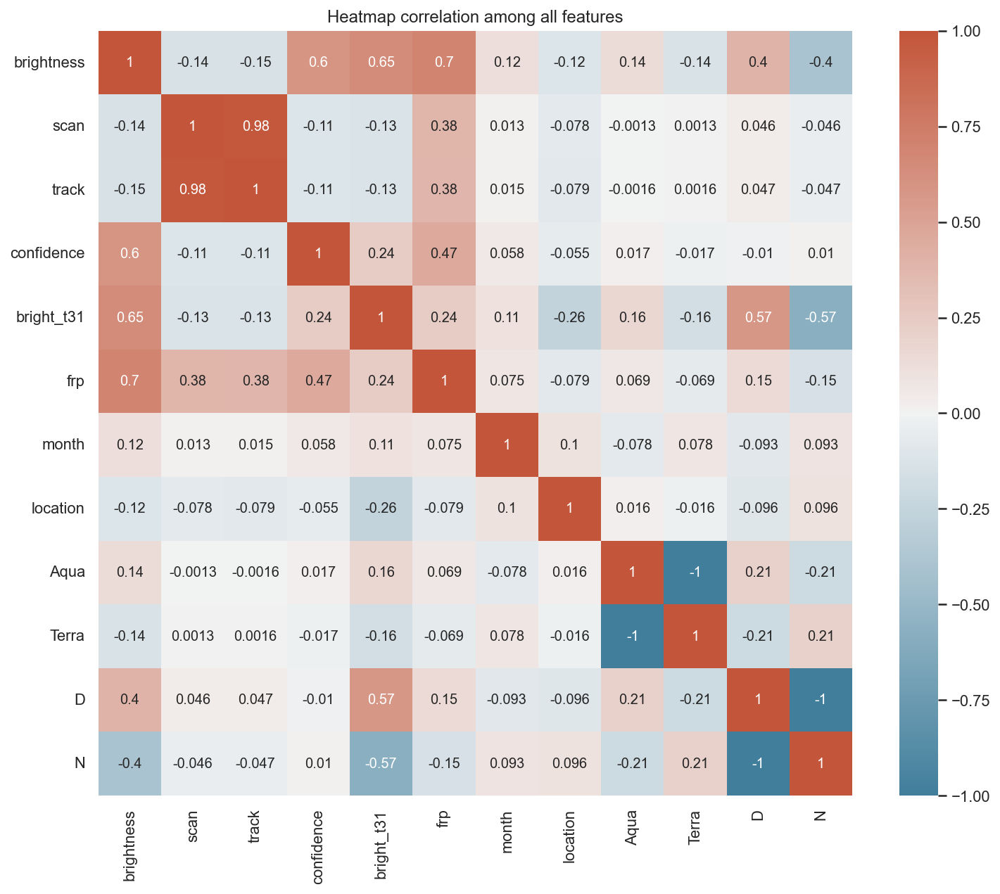

In [ ]:
heatmap_draw(purged_data_pipeline_test)

We have something we can work on. We will select features in task three.
But now, let's call it a day.

# 3 Answer the following questions: <a class="anchor" name="task1_3"></a>

#### a. What are the dates on which bushfires present the high number of incidents?<a class="anchor" name="task1_3_a"></a>

In order to answer this question but not corrupt our data preparation function. Let's do the following.


Also noted only type == 0 are bushfires by looking at the describtion of our dataset.

In [ ]:
raw_data_copy = raw_data.copy()
bushfires = raw_data_copy[raw_data_copy['type'] == 0] # only take type == 0
bushfires.head()

,latitude,longitude,brightness,scan,track,acq_date,acq_time,satellite,instrument,confidence,version,bright_t31,frp,daynight,type
0,-23.91,147.30,320.10,1.70,1.30,2017-01-01,47,Terra,MODIS,53,6.20,296.60,17.60,D,0
1,-23.69,150.10,314.30,2.70,1.60,2017-01-01,47,Terra,MODIS,22,6.20,289.30,30.00,D,0
2,-23.59,150.17,315.80,2.70,1.60,2017-01-01,47,Terra,MODIS,33,6.20,291.70,35.40,D,0
3,-22.41,148.85,316.70,2.10,1.40,2017-01-01,47,Terra,MODIS,26,6.20,295.30,25.80,D,0
4,-20.59,147.64,320.70,1.60,1.30,2017-01-01,47,Terra,MODIS,34,6.20,299.60,19.00,D,0


In [ ]:
bushfires.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1039215 entries, 0 to 1046677
Data columns (total 15 columns):
 #   Column      Non-Null Count    Dtype  
---  ------      --------------    -----  
 0   latitude    1039215 non-null  Float64
 1   longitude   1039215 non-null  Float64
 2   brightness  1039215 non-null  Float64
 3   scan        1039215 non-null  Float64
 4   track       1039215 non-null  Float64
 5   acq_date    1039215 non-null  string 
 6   acq_time    1039215 non-null  Int64  
 7   satellite   1039215 non-null  string 
 8   instrument  1039215 non-null  string 
 9   confidence  1039215 non-null  Int64  
 10  version     1039215 non-null  Float64
 11  bright_t31  1039215 non-null  Float64
 12  frp         1039215 non-null  Float64
 13  daynight    1039215 non-null  string 
 14  type        1039215 non-null  Int64  
dtypes: Float64(8), Int64(3), string(4)
memory usage: 137.8 MB


We can see that from the original datset, acq_date is a string type of data.

Now, we change acq_date's string type to time series.

In [ ]:
bushfires['acq_date'] = pd.to_datetime(bushfires['acq_date'], format= '%Y-%m-%d')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


***Ignore the warning, it doesn't affect what we want to do.***

In [ ]:
bushfires.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1039215 entries, 0 to 1046677
Data columns (total 15 columns):
 #   Column      Non-Null Count    Dtype         
---  ------      --------------    -----         
 0   latitude    1039215 non-null  Float64       
 1   longitude   1039215 non-null  Float64       
 2   brightness  1039215 non-null  Float64       
 3   scan        1039215 non-null  Float64       
 4   track       1039215 non-null  Float64       
 5   acq_date    1039215 non-null  datetime64[ns]
 6   acq_time    1039215 non-null  Int64         
 7   satellite   1039215 non-null  string        
 8   instrument  1039215 non-null  string        
 9   confidence  1039215 non-null  Int64         
 10  version     1039215 non-null  Float64       
 11  bright_t31  1039215 non-null  Float64       
 12  frp         1039215 non-null  Float64       
 13  daynight    1039215 non-null  string        
 14  type        1039215 non-null  Int64         
dtypes: Float64(8), Int64(3), datetim

In [ ]:
bushfires['acq_date'].value_counts().head(15)

2020-01-04    7339
2019-12-30    6909
2019-12-19    4762
2020-01-02    4390
2020-01-03    4243
2019-11-08    4086
2019-12-21    4009
2019-12-18    3995
2019-12-06    3785
2019-12-20    3700
2020-01-01    3672
2019-12-05    3483
2019-12-31    3430
2019-11-12    3335
2018-10-11    3313
Name: acq_date, dtype: int64

Let's do a trick here. I just converted acq_date to time series. 
After that, I can use value_counts() to count the frequency of each date appears. 
But if we stop here, we can not make a clear mathematical statement about which dates are considered as a strict meaning of "high numbers".

In order to step forward, I convert our result of value_counts() to a new DataFrame, and do the find_outlier function.

By doing so, we can list all numbers that are mathematically outliers in our new dataframe. 

Those outliers, I would say those are the dates with high number of accidents.

In [ ]:
max_print_out(True)
number = pd.DataFrame(bushfires['acq_date'].value_counts()) # only save the column of acq_date

In [ ]:
number = number.reset_index();
number.rename(columns = {'index':'acq_date', 'acq_date':'incidents'}, inplace = True) # rename it
number.columns

Index(['acq_date', 'incidents'], dtype='object')

In [ ]:
number.head()

,acq_date,incidents
0,2020-01-04,7339
1,2019-12-30,6909
2,2019-12-19,4762
3,2020-01-02,4390
4,2020-01-03,4243


Text(0.5, 1.0, 'Number of incidents in each date')

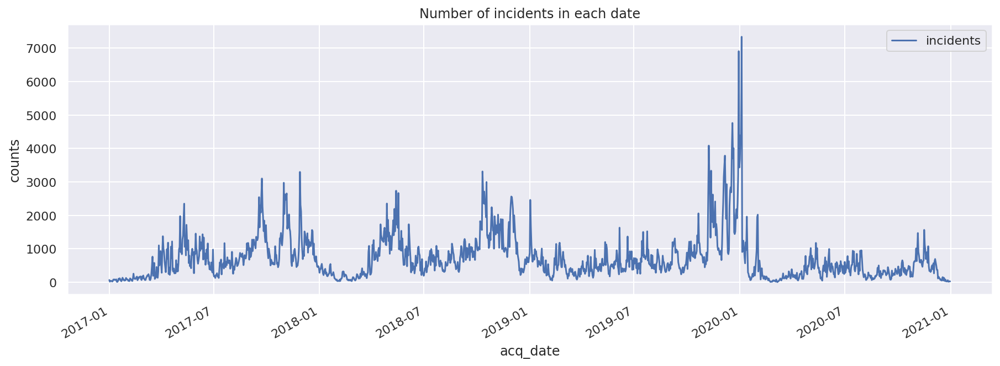

In [ ]:
number.plot(x='acq_date', y='incidents', figsize=(15,5))
plt.ylabel("counts")
plt.title("Number of incidents in each date")

Text(0.5, 1.0, 'Histogram of incidents')

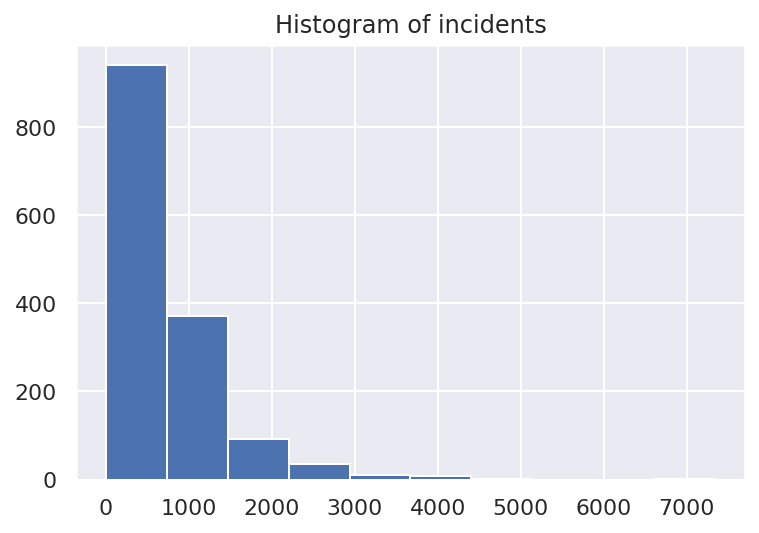

In [ ]:
number['incidents'].hist() # histogram
plt.title("Histogram of incidents")

Do the find_outliers function.

In [ ]:
find_outliers(number,'incidents',set_threshold=False)

IQR = 934.0 - 264.0 = 670.0
MAX = 1939.0
Min is 0
Num of min outliers:  0
Num of max outliers:  79
Num of negative outliers:  0
Num of the original data set's whole instance 1461
Rate of purged data/total data 0.054072553045859


We can see that any date with incidents number larget than 1939 is the outlier and indeed the high number of incidents.
And we have 79 such dates of in total 1461 dates. 


Those date with high number of incidents are:

In [ ]:
len(number[number['incidents'] > 1939])

79

In [ ]:
max_print_out(False)
number[number['incidents'] > 1939]

,acq_date,incidents
0,2020-01-04,7339
1,2019-12-30,6909
2,2019-12-19,4762
3,2020-01-02,4390
4,2020-01-03,4243
...,...,...
74,2018-11-28,1965
75,2020-01-13,1962
76,2020-01-31,1948
77,2018-10-17,1944


#### b. Based on the data quality report, which attributes do you think are useful to predict the confidence of an incident? Explain why you think that the selected attribute is important.<a class="anchor" name="task1_3_b"></a>

We first purge our outliers, since we are not using those outliers in our training step.

The remaining datasets' information is needed for making our judgement.

In [ ]:
purged_data_pipeline_test = purge_pipeline.fit_transform(raw_data_copy)

IQR = 63.5 - 14.6 = 48.9
MAX = 136.85
Min is 0
Num of min outliers:  0
Num of max outliers:  32535
Num of negative outliers:  2948
Num of the original data set's whole instance 1046679
Rate of purged data/total data 0.031084028627688144


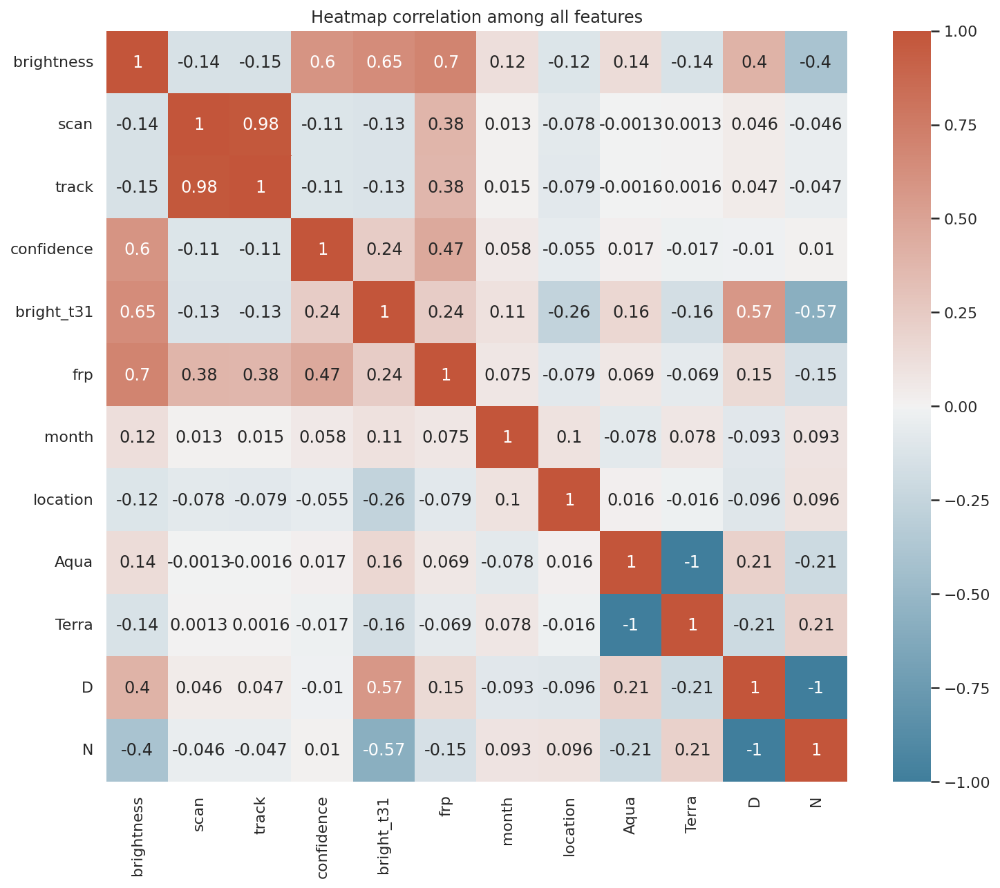

In [ ]:
heatmap_draw(purged_data_pipeline_test)

Base on the heatmap of our prepared dataset. 
We can see there are three features have relatively strong correlation with confidence.<br>
They are 
1. brightness: 0.6
2. frp: 0.47
1. bright_t31: 0.24

However, if I have to choose some features to predict confidence value. I will choose brightness and frp. If I can select one more, then I will choose those three. <br>
Because they have the strongest correlation with confidence. 
A strong correlation often means that our target has a linear relation with the current choose features.
If the correlation are strong, most of time we can use it to predict our target more precisely. 
In this case, it's confidence.

# 2. Task 2. Spatio-temporal data (0.2) <a class="anchor" name="task2_top"></a>

### 2.1. Plot a geographical heat map of FRP for the Aqua area. Use data from the year 2017 and any aggregation method (e.g. mean, summation, maximum, or something else) of your choice. Justify your choice of aggregation method.

First we get the 2017 dataset.
> Note: In there, we don't use our combined dataset. It's more convenient to do this way. 

In [ ]:
data_2017 = pd.read_csv('modis_2017_Australia.csv')

In [ ]:
data_2017.head()

,latitude,longitude,brightness,scan,track,acq_date,acq_time,satellite,instrument,confidence,version,bright_t31,frp,daynight,type
0,-23.91,147.30,320.10,1.70,1.30,2017-01-01,47,Terra,MODIS,53,6.20,296.60,17.60,D,0
1,-23.69,150.10,314.30,2.70,1.60,2017-01-01,47,Terra,MODIS,22,6.20,289.30,30.00,D,0
2,-23.59,150.17,315.80,2.70,1.60,2017-01-01,47,Terra,MODIS,33,6.20,291.70,35.40,D,0
3,-22.41,148.85,316.70,2.10,1.40,2017-01-01,47,Terra,MODIS,26,6.20,295.30,25.80,D,0
4,-20.59,147.64,320.70,1.60,1.30,2017-01-01,47,Terra,MODIS,34,6.20,299.60,19.00,D,0


In [ ]:
max_print_out(True)
data_2017.groupby(['latitude','longitude']).latitude.value_counts().head(20)

latitude  longitude  latitude
-43.43    146.87     -43.43      1
-43.41    147.28     -43.41      1
-43.31    146.84     -43.31      1
          146.89     -43.31      1
          146.95     -43.31      1
          146.88     -43.31      1
-43.30    146.97     -43.30      1
          146.88     -43.30      1
          146.83     -43.30      1
          146.89     -43.30      1
          146.82     -43.30      1
-43.29    146.95     -43.29      1
          146.89     -43.29      1
          146.97     -43.29      1
          146.88     -43.29      1
          146.89     -43.29      1
          146.88     -43.29      1
-43.28    146.88     -43.28      1
-43.18    147.75     -43.18      1
-43.17    147.77     -43.17      1
Name: latitude, dtype: int64

We can see that in our dataset, each latitude and longitude only correspond to one incident. That is too precisely and accurate for a geographical location. And it's quite meaningless when we want to get a summary and plot information of FRP for an area.

Hence, I decide to round the value of Lat and Long to leave 1 digits. It will remain the geographical info and combine those points into a larger region.

In [ ]:
data_2017_trim = data_2017.copy()
data_2017_trim['latitude'] = data_2017_trim['latitude'].round(1)
data_2017_trim['longitude'] = data_2017_trim['longitude'].round(1)
data_2017_trim.head()

,latitude,longitude,brightness,scan,track,acq_date,acq_time,satellite,instrument,confidence,version,bright_t31,frp,daynight,type
0,-23.90,147.30,320.10,1.70,1.30,2017-01-01,47,Terra,MODIS,53,6.20,296.60,17.60,D,0
1,-23.70,150.10,314.30,2.70,1.60,2017-01-01,47,Terra,MODIS,22,6.20,289.30,30.00,D,0
2,-23.60,150.20,315.80,2.70,1.60,2017-01-01,47,Terra,MODIS,33,6.20,291.70,35.40,D,0
3,-22.40,148.80,316.70,2.10,1.40,2017-01-01,47,Terra,MODIS,26,6.20,295.30,25.80,D,0
4,-20.60,147.60,320.70,1.60,1.30,2017-01-01,47,Terra,MODIS,34,6.20,299.60,19.00,D,0


Now we have some regions' data to operate. Then we take the incidents from satellite Aqua.

In [ ]:
Aqua_data = data_2017_trim[data_2017_trim['satellite'] == 'Aqua']
Aqua_data.describe()

,latitude,longitude,brightness,scan,track,acq_time,confidence,version,bright_t31,frp,type
count,157217.00,157217.00,157217.00,157217.00,157217.00,157217.00,157217.00,157217.00,157217.00,157217.00,157217.00
mean,-21.69,133.09,334.26,1.71,1.24,628.98,71.51,6.20,304.67,75.70,0.01
std,7.13,9.63,22.77,0.89,0.27,406.14,21.88,0.00,10.71,168.27,0.12
min,-43.40,113.70,300.00,1.00,1.00,253.00,0.00,6.20,266.30,0.00,0.00
25%,-26.20,126.10,319.70,1.10,1.00,429.00,58.00,6.20,297.30,15.60,0.00
50%,-19.90,131.70,330.00,1.30,1.10,503.00,74.00,6.20,304.50,30.80,0.00
75%,-16.10,141.80,343.00,2.00,1.40,545.00,89.00,6.20,311.20,69.30,0.00
max,-10.20,153.60,506.20,4.80,2.00,1827.00,100.00,6.20,400.10,7401.10,3.00


In [ ]:
Aqua_data.groupby(['latitude','longitude']).value_counts().head(15) 

latitude  longitude  brightness  scan  track  acq_date    acq_time  satellite  instrument  confidence  version  bright_t31  frp     daynight  type
-43.4     146.9      346.2       1.2   1.1    2017-05-19  403       Aqua       MODIS       88          6.2      284.1       74.0    D         0       1
-43.3     146.8      313.6       4.3   1.9    2017-04-05  516       Aqua       MODIS       0           6.2      285.5       111.2   D         0       1
                     315.6       2.6   1.6    2017-04-05  338       Aqua       MODIS       0           6.2      280.5       48.9    D         0       1
                     322.8       2.6   1.6    2017-04-05  338       Aqua       MODIS       23          6.2      280.9       71.6    D         0       1
          146.9      308.5       1.9   1.3    2017-04-05  1445      Aqua       MODIS       61          6.2      282.6       31.1    N         0       1
                     313.6       1.7   1.3    2017-04-19  350       Aqua       MODIS       59

In [ ]:
Aqua_data.groupby(['latitude','longitude']).size().head()

latitude  longitude
-43.40    146.90        1
-43.30    146.80        3
          146.90        9
          147.00        2
-43.20    147.80       11
dtype: int64

Now we can see that each latitude and longitude have multiple records of incident. Now we can use aggregation method to get our desired report.
<br>
First I would like to choose mean as our 1st attempt.
Mean is a powerful tool to get a look at the average of our target value, FRP.
Based on the mean plot, we can know that where has the higher FRP during all time in 2017.

In [ ]:
Aqua_data.groupby(['latitude','longitude']).mean().head(15)

brightness  scan  track  acq_time  confidence  version  \
latitude longitude                                                           
-43.40   146.90         346.20  1.20   1.10    403.00       88.00     6.20   
-43.30   146.80         317.33  3.17   1.70    397.33        7.67     6.20   
         146.90         372.57  2.51   1.53    483.44       70.22     6.20   
         147.00         339.95  1.70   1.30    350.00       88.50     6.20   
-43.20   147.80         334.67  1.57   1.25    391.64       71.45     6.20   
-43.10   145.80         334.60  1.40   1.20    403.00       65.50     6.20   
         146.80         324.25  3.20   1.70    332.00       77.00     6.20   
         146.90         322.88  2.48   1.48    729.25       72.75     6.20   
         147.70         303.90  1.10   1.10    402.00       43.00     6.20   
-43.00   145.60         309.80  1.40   1.20    403.00       63.00     6.20   
         145.70         348.22  1.40   1.20    403.00       77.67     6.20   
         146.70         317.60  2.70   1.55   1028.00       77.50     6.20   
         146.80         327.43  2.40   1.47   1200.67       67.33     6.20   
         147.30         311.20  1.00   1.00    421.00       71.00     6.20   
         147.50         313.00  1.00   1.00    415.00       68.00     6.20   

                    bright_t31     frp  type  
latitude longitude                            
-43.40   146.90         284.10   74.00  0.00  
-43.30   146.80         282.30   77.23  0.00  
         146.90         295.41 1363.34  0.00  
         147.00         292.00  101.90  0.00  
-43.20   147.80         289.16  107.26  0.00  
-43.10   145.80         285.95   53.35  0.00  
         146.80         287.20  131.10  0.00  
         146.90         287.80  153.38  0.00  
         147.70         291.80    5.70  0.00  
-43.00   145.60         286.10   16.10  0.00  
         145.70         288.02  103.43  0.00  
         146.70         286.05   95.45  0.00  
         146.80         288.47  220.27  0.00  
         147.30         291.80    9.20  0.00  
         147.50         295.80    8.65  0.00

Nice! We can see that our multiple records now become a single line. We want to get what we really need in this question. Lat, Long and FRP.

In [ ]:
mean_frp_data = (Aqua_data.groupby(['latitude','longitude']).mean()).reset_index()
mean_frp_data.head()

,latitude,longitude,brightness,scan,track,acq_time,confidence,version,bright_t31,frp,type
0,-43.40,146.90,346.20,1.20,1.10,403.00,88.00,6.20,284.10,74.00,0.00
1,-43.30,146.80,317.33,3.17,1.70,397.33,7.67,6.20,282.30,77.23,0.00
2,-43.30,146.90,372.57,2.51,1.53,483.44,70.22,6.20,295.41,1363.34,0.00
3,-43.30,147.00,339.95,1.70,1.30,350.00,88.50,6.20,292.00,101.90,0.00
4,-43.20,147.80,334.67,1.57,1.25,391.64,71.45,6.20,289.16,107.26,0.00


In [ ]:
mean_frp_data.describe()

,latitude,longitude,brightness,scan,track,acq_time,confidence,version,bright_t31,frp,type
count,20480.00,20480.00,20480.00,20480.00,20480.00,20480.00,20480.00,20480.00,20480.00,20480.00,20480.00
mean,-23.56,134.66,329.95,1.70,1.24,590.52,68.55,6.20,303.30,58.55,0.00
std,7.55,10.65,14.66,0.67,0.20,292.06,14.20,0.00,8.38,84.30,0.06
min,-43.40,113.70,300.00,1.00,1.00,259.00,0.00,6.20,267.20,0.00,0.00
25%,-30.50,126.30,320.36,1.20,1.10,422.00,61.09,6.20,297.80,19.44,0.00
50%,-21.90,133.50,328.06,1.54,1.20,500.50,69.77,6.20,303.16,34.80,0.00
75%,-17.30,144.50,337.65,2.00,1.34,612.33,77.67,6.20,308.57,65.00,0.00
max,-10.20,153.60,434.40,4.80,2.00,1808.00,100.00,6.20,344.65,2566.55,3.00


Now we plot the data. Plot codes are from [Python Data Science Handbook] by Jake VanderPlas

In [ ]:
%matplotlib inline
from mpl_toolkits.basemap import Basemap

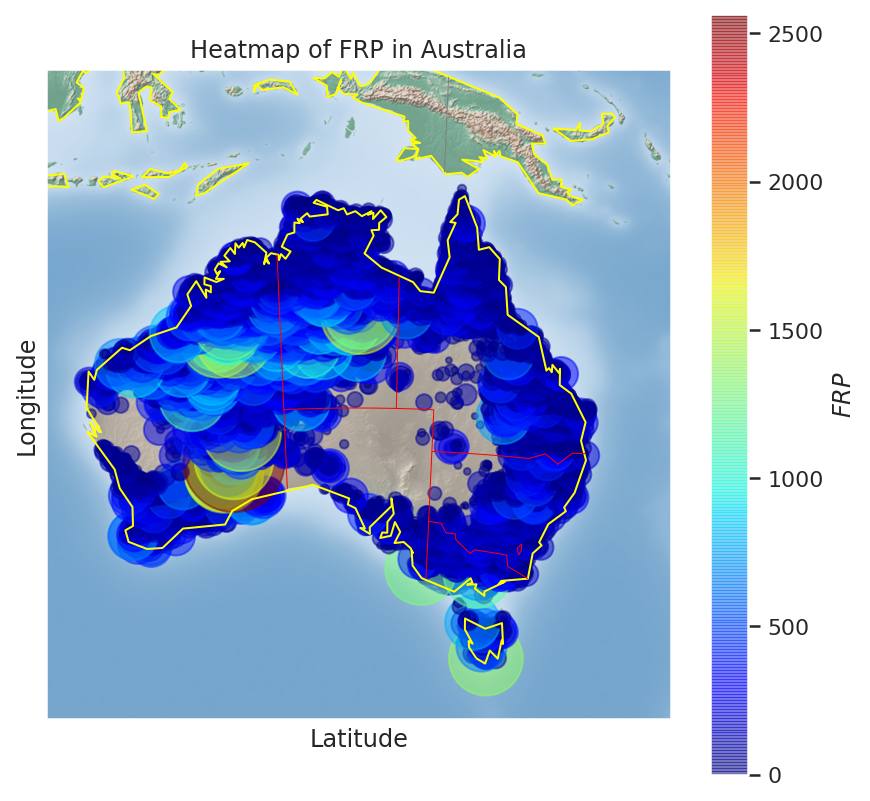

In [ ]:
# generate a geographical heatmap
def geo_heatmap(data_df):
    # 1. Draw the map background
    # Extract the data we're interested in
    lat = data_df['latitude'].values
    lon = data_df['longitude'].values
    frp = data_df['frp'].values
    # set our figure frame
    fig = plt.figure(figsize=(7, 7))
    # get the corresponded map info from basemap library
    m = Basemap(projection='lcc', resolution='c',
                lat_0=-25, lon_0=135,
                width=5E6, height=5.2E6)
    m.shadedrelief()
    m.drawcoastlines(color='yellow')
    m.drawcountries(color='gray')
    m.drawstates(color='red')

    # 2. scatter city data, with color reflecting population
    # and size reflecting area
    m.scatter(lon, lat, latlon=True,
              c=frp, s=frp,
              cmap=plt.get_cmap("jet"), alpha=0.5)
              # cmap='Reds', alpha=0.5)

    # 3. create colorbar and legend
    plt.colorbar(label=r'$FRP$')
    plt.title("Heatmap of FRP in Australia")
    plt.xlabel("Latitude")
    plt.ylabel("Longitude")
geo_heatmap(mean_frp_data)


Well, although we round our lat and long to have 1 digits, it's still quite bad.
Therefore, we need to round our Lat and Long to integers for creating a bigger region.

In [ ]:
data_2017_trim = data_2017.copy()
data_2017_trim['latitude'] = data_2017_trim['latitude'].round(0) # round to integer
data_2017_trim['longitude'] = data_2017_trim['longitude'].round(0) # round to integer
Aqua_data = data_2017_trim[data_2017_trim['satellite'] == 'Aqua']
mean_frp_data_0 = (Aqua_data.groupby(['latitude','longitude']).mean()).reset_index()

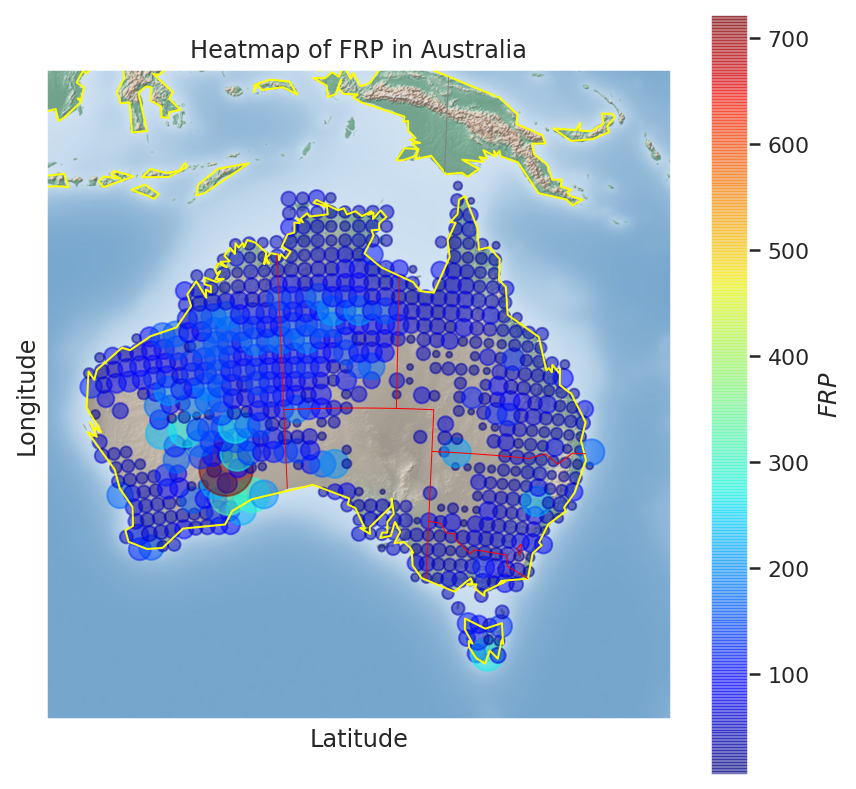

In [ ]:
geo_heatmap(mean_frp_data_0)

We can see that at the left bottom of Australia, we have the highest average FRP.
And most of area's frp are less than 150. But we should see a more details summary.


In [ ]:
max_print_out(True)
mean_frp_data_0.frp.describe()

count   657.00
mean     69.06
std      54.28
min       5.10
25%      35.12
50%      52.07
75%      91.33
max     723.45
Name: frp, dtype: float64

Use our written function find_outliers to see a more details report.

In [ ]:
find_outliers(mean_frp_data_0,'frp',set_threshold=False)

IQR = 91.32942583732057 - 35.11666666666667 = 56.212759170653904
MAX = 175.64856459330144
Min is 0
Num of min outliers:  0
Num of max outliers:  24
Num of negative outliers:  0
Num of the original data set's whole instance 657
Rate of purged data/total data 0.0365296803652968


We can see that we only have 24 outlier, which value is larger than 175 and less than 723 by pandas' describe().
That is quite bad. It corrupted the whole representation.
In that speaking, we still want that point, but not that high in the plot.
Therefore, the most accurate way to represent the FRP according to our question, is to plot two heatmaps. Instead of setting a new value to the outliers.
Because we want to show the heatmap precisely.
#### 1.1 Heatmap of all incidents that have FRP lower than 180, (Q3 + 1.5 * IQR)

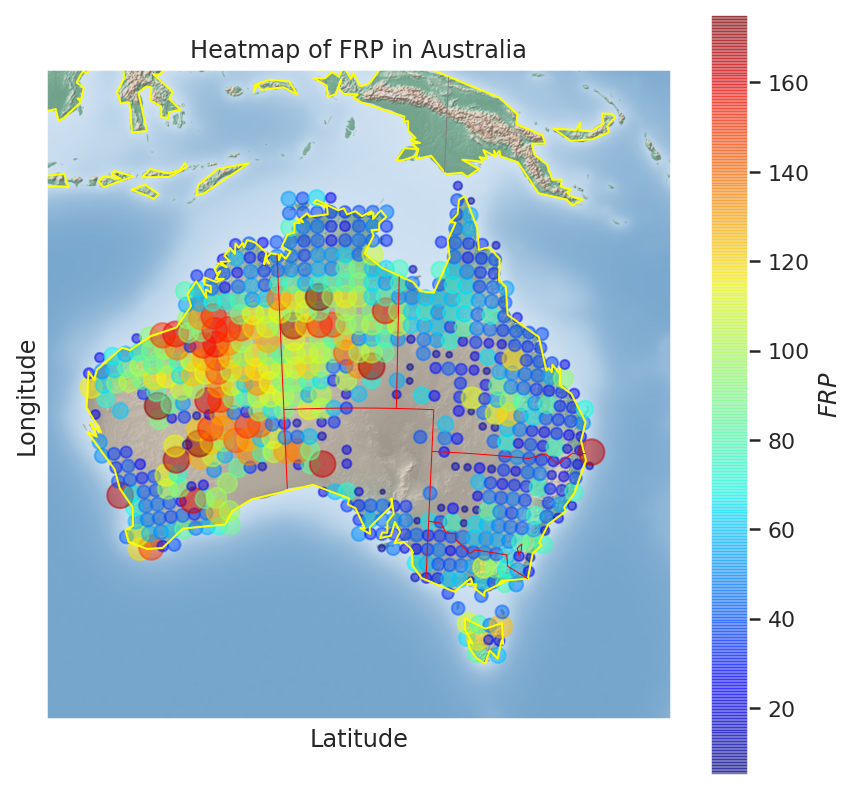

In [ ]:
geo_heatmap(mean_frp_data_0[mean_frp_data_0['frp'] < 180]) # get corresponded data

#### 1.2 Heatmap of high FRP in Australia 2017, larger than 180

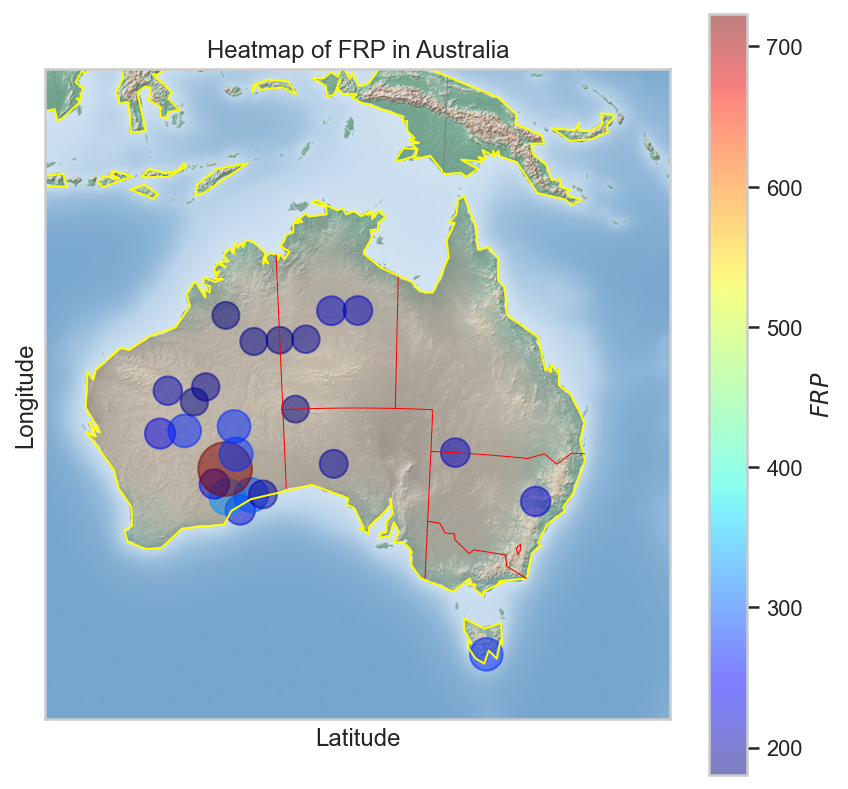

In [ ]:
geo_heatmap(mean_frp_data_0[mean_frp_data_0['frp']  > 180]) # get corresponded data

In order to show the whole map once again and get rid out the influence by outliers.<br>
We set our outlier to 200 and the highest value to 300. And see what will the plot be.

In [ ]:
mean_frp_data_0.loc[(mean_frp_data_0['frp'] > 180) & (mean_frp_data_0['frp'] < 700) ,'frp']= 220
mean_frp_data_0.loc[(mean_frp_data_0['frp'] > 700) ,'frp' ] = 300

In [ ]:
mean_frp_data_0.describe()

,latitude,longitude,brightness,scan,track,acq_time,confidence,version,bright_t31,frp,type
count,657.000000,657.000000,657.000000,657.000000,657.000000,657.000000,657.000000,6.570000e+02,657.000000,657.000000,657.000000
mean,-25.147641,134.817352,332.738043,1.701839,1.238098,610.357255,70.187351,6.200000e+00,304.309003,68.330096,0.013685
std,7.186823,10.756739,10.828930,0.390893,0.115416,208.280585,9.414053,1.735610e-15,7.351929,47.873212,0.145178
min,-43.000000,114.000000,302.800000,1.000000,1.000000,330.000000,20.000000,6.200000e+00,278.983333,5.100000,0.000000
25%,-31.000000,126.000000,325.250000,1.514286,1.185538,454.946199,66.166667,6.200000e+00,299.986984,35.116667,0.000000
50%,-25.000000,135.000000,331.487605,1.668548,1.230476,565.189873,70.840580,6.200000e+00,304.612371,52.073451,0.000000
75%,-20.000000,145.000000,339.885498,1.828289,1.280192,707.486842,76.000000,6.200000e+00,308.917262,91.329426,0.000000
max,-10.000000,154.000000,374.156250,4.700000,2.000000,1757.000000,93.666667,6.200000e+00,328.012500,300.000000,2.000000


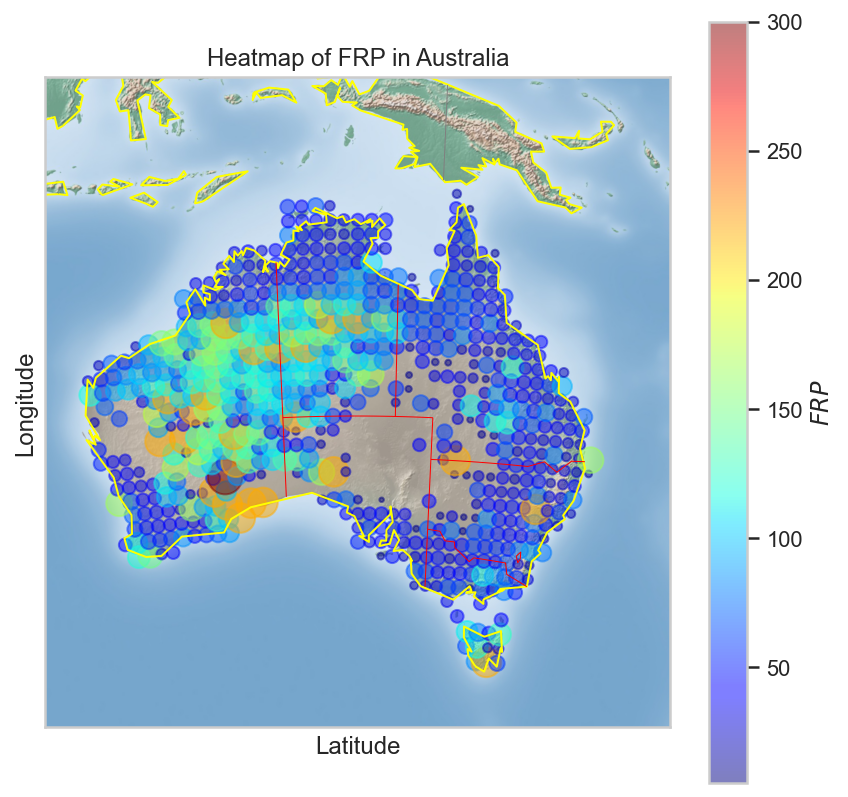

In [ ]:
geo_heatmap(mean_frp_data_0)

Now, we have a proper way to show the mean aggregation.
We can see that locations have higher average FRP are mostly in the western side and central of Australia.


### 2.2 Mark the “Fire activity” (lat, long = -35.6,149.12) on the city map.

First we need to redefine our heatmap plot function to adjust our view and range of map's lat, long.

In [ ]:
# generate a geographical heatmap
# Now we specific our value of basemap's start point and height and weight
def geo_heatmap_city(data_df,lat_0,long_0,width,height):
    # 1. Draw the map background
    # Extract the data we're interested in
    lat = data_df['latitude'].values
    lon = data_df['longitude'].values
    frp = data_df['frp'].values
    # set our figure frame
    fig = plt.figure(figsize=(7, 7))
    # get the corresponded map info from basemap library
    m = Basemap(projection='lcc', resolution='c',
                lat_0=lat_0, lon_0=long_0,
                width=width, height=height)
    m.shadedrelief()
    m.drawcoastlines(color='yellow')
    m.drawcountries(color='gray')
    m.drawstates(color='red')
    m.drawcounties(color='purple')
    # 2. scatter city data, with color reflecting population
    # and size reflecting area
    m.scatter(lon, lat, latlon=True,
              c=frp, s=2,
              cmap=plt.get_cmap("jet"), alpha=0.4)
              # cmap='Reds', alpha=0.5)
    # 3. create colorbar and legend
    plt.colorbar(label=r'$FRP$')
    plt.title("Fire activity on the city map (-35.6,149.12)")
    plt.xlabel("Latitude")
    plt.ylabel("Longitude")

Let's use the dataset of raw_data, that has all 4 years records.

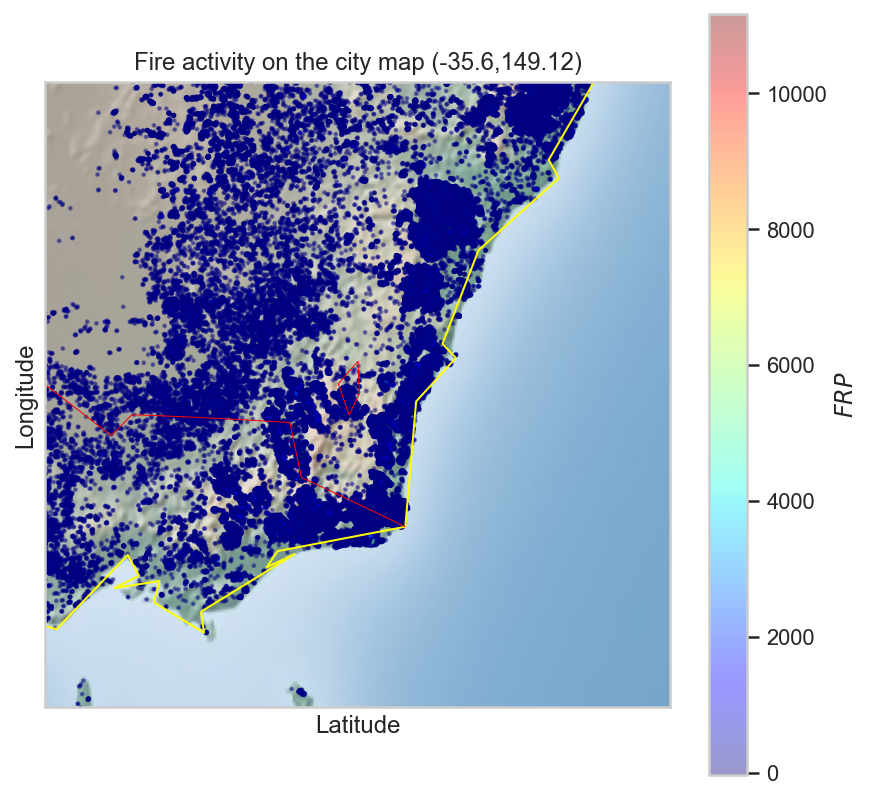

In [ ]:
geo_heatmap_city(raw_data, -35.6,149.12,1E6,1E6)

We can see in this area, there aren't any too high FRP value.
So we set new FRP values to the outliers again.

In [ ]:
city_data = raw_data.copy() # make a copy of the raw data
city_data.loc[(city_data['frp'] > 180) & (city_data['frp'] < 700) ,'frp']= 220
city_data.loc[(city_data['frp'] >= 700) ,'frp' ] = 300

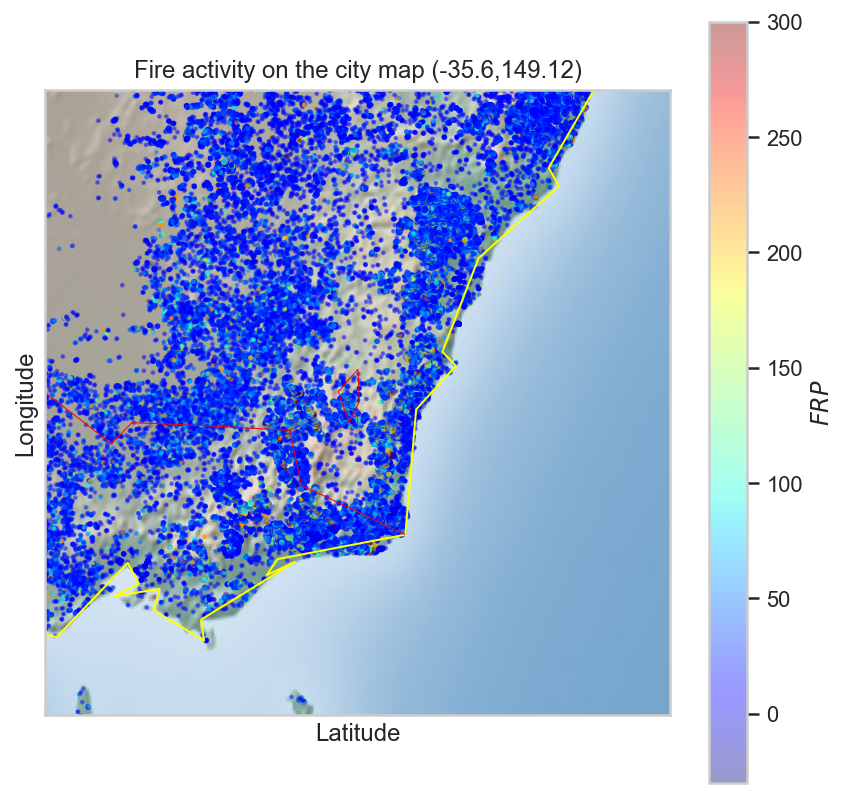

In [ ]:
geo_heatmap_city(city_data, -35.6,149.12,1E6,1E6)

That is the plot shows all Fire activity around lat, long = -35.6 and 149.12. The width of this map is 1E6 and height is 1E6.


### 2.3 Mark the regions with the highest recorded fire radiation in a day for measurements where "acq_date = 2020-01-08".

In [ ]:
data_2020_01_08 = raw_data[raw_data['acq_date'] == '2020-01-08'].copy()

In [ ]:
data_2020_01_08.describe()

,latitude,longitude,brightness,scan,track,acq_time,confidence,version,bright_t31,frp,type
count,1028.00,1028.00,1028.00,1028.00,1028.00,1028.00,1028.00,1028.00,1028.00,1028.00,1028.00
mean,-31.90,132.58,353.79,2.26,1.40,579.93,78.46,6.03,304.86,486.90,0.01
std,4.82,11.84,38.01,1.15,0.32,446.70,25.05,0.00,11.82,1227.62,0.16
min,-36.97,115.90,300.00,1.00,1.00,56.00,0.00,6.03,271.60,0.00,0.00
25%,-35.46,122.99,328.70,1.20,1.10,241.00,65.00,6.03,293.80,27.05,0.00
50%,-32.64,124.08,343.40,1.80,1.30,518.00,87.00,6.03,306.35,101.50,0.00
75%,-32.31,146.68,371.35,3.30,1.70,520.00,100.00,6.03,312.90,325.15,0.00
max,-12.73,153.03,500.00,4.60,2.00,1621.00,100.00,6.03,341.90,11164.10,3.00


We can see that the highest recorded fire radiation in that day is 11164.1.
Then we query for that value.

In [ ]:
data_2020_01_08.max()

latitude          -12.73
longitude         153.03
brightness        500.00
scan                4.60
track               2.00
acq_date      2020-01-08
acq_time            1621
satellite          Terra
instrument         MODIS
confidence           100
version             6.03
bright_t31        341.90
frp             11164.10
daynight               N
type                   3
dtype: object

In [ ]:
highest_record = data_2020_01_08[data_2020_01_08['frp'] == 11164.10];highest_record

,latitude,longitude,brightness,scan,track,acq_date,acq_time,satellite,instrument,confidence,version,bright_t31,frp,daynight,type
914273,-32.8923,124.0954,486.1,4.5,1.9,2020-01-08,241,Terra,MODIS,100,6.03,321.6,11164.1,D,0


Well, there is only one incident. Let's plot it directly.

Text(0.2, 0.24, "Highest recorded FRP's location")

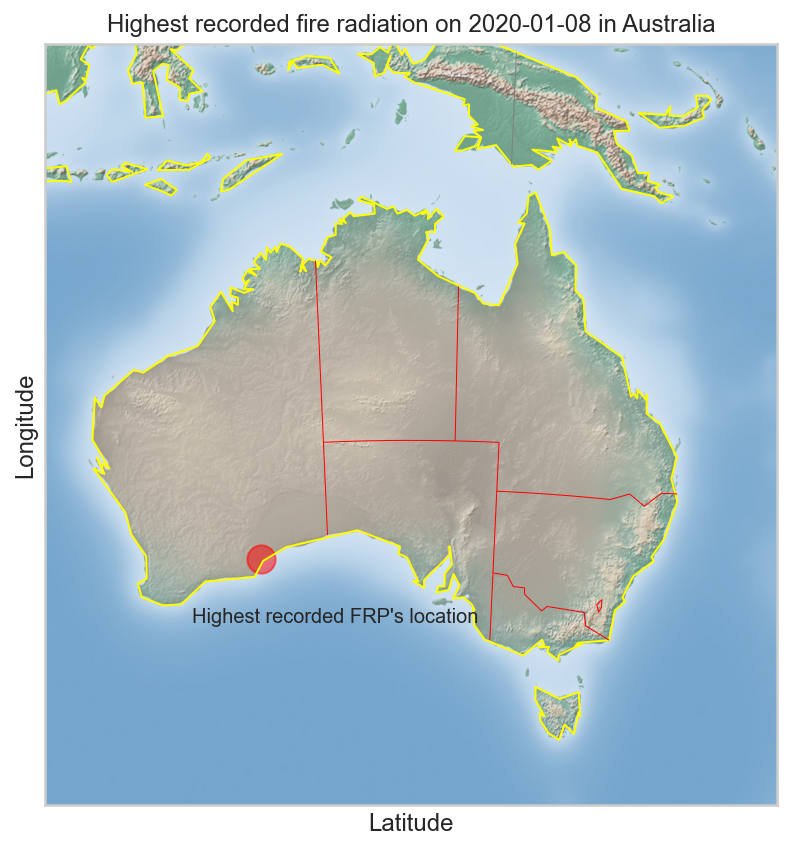

In [ ]:
fig = plt.figure(figsize=(7, 7))
# get the corresponded map info from basemap library
m = Basemap(projection='lcc', resolution='c',
            lat_0=-25, lon_0=135,
            width=5E6, height=5.2E6)
m.shadedrelief()
m.drawcoastlines(color='yellow')
m.drawcountries(color='gray')
m.drawstates(color='red')
# 2. scatter city data, with color reflecting population
# and size reflecting area
m.scatter(highest_record['longitude'], highest_record['latitude'], latlon=True,
          c='red', s=200,alpha=0.5)
          # cmap='Reds', alpha=0.5)
plt.title("Highest recorded fire radiation on 2020-01-08 in Australia")
plt.xlabel("Latitude")
plt.ylabel("Longitude")
plt.annotate("Highest recorded FRP's location", xy=(0.2, 0.24), xycoords='axes fraction')


### 2.4. Find a visualization to plot the progress of the fire activity across all points from Nov 1, 2019, to Jan 31, 2020.



First we retreive the data and convert our dataset's acq_date to time series.

In [ ]:
raw_data_copy = raw_data.copy()
raw_data_copy['acq_date'] = pd.to_datetime(raw_data_copy['acq_date'], format= '%Y-%m-%d')
raw_data_copy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1046679 entries, 0 to 1046678
Data columns (total 15 columns):
 #   Column      Non-Null Count    Dtype         
---  ------      --------------    -----         
 0   latitude    1046679 non-null  Float64       
 1   longitude   1046679 non-null  Float64       
 2   brightness  1046679 non-null  Float64       
 3   scan        1046679 non-null  Float64       
 4   track       1046679 non-null  Float64       
 5   acq_date    1046679 non-null  datetime64[ns]
 6   acq_time    1046679 non-null  Int64         
 7   satellite   1046679 non-null  string        
 8   instrument  1046679 non-null  string        
 9   confidence  1046679 non-null  Int64         
 10  version     1046679 non-null  Float64       
 11  bright_t31  1046679 non-null  Float64       
 12  frp         1046679 non-null  Float64       
 13  daynight    1046679 non-null  string        
 14  type        1046679 non-null  Int64         
dtypes: Float64(8), Int64(3), datetim

With the power of time series, datetime64. Then we can retreive any instance from Nov, 2019 to Jan 31, 2020 by using selecting rows by conditions.

In [ ]:
# simple conditions' statement
sub_fire_activity = raw_data_copy[(raw_data_copy['acq_date'] >= np.datetime64('2019-11-01')) & (raw_data_copy['acq_date'] <= np.datetime64('2020-01-31')) ]

Let's check whether we get the right rows.

In [ ]:
date_range = str(sub_fire_activity['acq_date'].dt.date.min()) + ' to ' +str(sub_fire_activity['acq_date'].dt.date.max());
date_range

'2019-11-01 to 2020-01-31'

Yes, we did.

Then we use value_counts to combine all incidients on the same day.

In [ ]:
max_print_out(True)
fire_activity = pd.DataFrame(sub_fire_activity['acq_date'].value_counts())

fire_activity = fire_activity.reset_index();
fire_activity.rename(columns = {'index':'acq_date', 'acq_date':'fire activity'}, inplace = True)
fire_activity.columns

Index(['acq_date', 'fire activity'], dtype='object')

In [ ]:
fire_activity.describe()

,fire activity
count,92.00
mean,1799.39
std,1440.46
min,67.00
25%,841.00
50%,1471.00
75%,2631.25
max,7351.00


Text(0, 0.5, 'Incidents number')

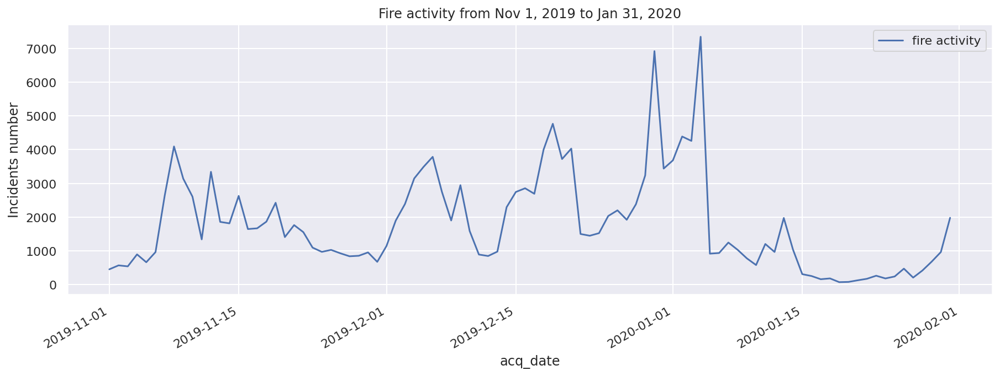

In [ ]:
fire_activity.plot(x='acq_date', y='fire activity', figsize=(15,5))
plt.title("Fire activity from Nov 1, 2019 to Jan 31, 2020")
plt.ylabel('Incidents number')

We can see the progress of fire activity from 2019-11-01 to 2020-01-31.
There is a peak on January, 2020.

 # 3. Task 3. Build a model for spatial prediction of wildfire (0.7) <a class="anchor" name="task3_top"></a>

##  3.1. Choose target feature as FRP.

> In between ‘Brightness temperature I-5’ and ‘Fire Radiative Power’ choose either
as the target feature.

In this assignment, I choose FRP, Fire radiative power as my target feature.

## 3.2 Supervised regression task
> 2. Explain what the task you’re solving is (e.g., supervised x unsupervised,
classification x regression x clustering or similarity matching x, etc)

**In assignment, we are solving a supervised regression problem.<br>**
First, we review the meaning of supervised learning.
> Supervised learning (SL) is the machine learning task of learning a function that maps an input to an output based on example input-output pairs. It infers a function from labeled training data consisting of a set of training examples.

1. In our case, we have a target value FRP, and we need to use our data set as input to make a prediction as output to match our target value as close as possible. Since, we already know what our target is, then our task is indeed a supervised learning problem. (Only when we don't have a target/label and we let machine to decide what his goal is, that's a unsupervised learning problem)
2. In the meantime, our target value **FRP is a continuous random variable**.  Its range are varied and value are continuous. And we can use a loss function as Mean square error to measure the difference between our prediction and target value. All these descriptions I wrote matched the definition of Regression problem. (When we trying to predict a target value as label and it's a categorical features, then it's a classification problem)
3. Therefore, in summary, we are facing a supervised regression problem.

## 3.3 Use a feature selection method to select the features to build a model.

Before we doing the feature selection, we need to generate a test set and train set. We don't want to access the whole data set at the beginning. And we don't want to mass up the test set until we are very confident of our model.

### 3.3.1 Generate test set and train set.

#### 3.3.1.1. Get a subset dataset of the whole data set.

**We recall the purged pipeline for now because we are not feeding our data to numpy yet.**

In [ ]:
raw_data_copy = raw_data.copy()
purged_data = purge_pipeline.fit_transform(raw_data_copy)

IQR = 63.5 - 14.6 = 48.9
MAX = 136.85
Min is 0
Num of min outliers:  0
Num of max outliers:  32535
Num of negative outliers:  2948
Num of the original data set's whole instance 1046679
Rate of purged data/total data 0.031084028627688144


Before we separate the data set, we take another look of every feature's distribution. 

Those features will be plotted in  6  rows and 2 columns
Index(['brightness', 'scan', 'track', 'confidence', 'bright_t31', 'frp',
       'month', 'location', 'Aqua', 'Terra', 'D', 'N'],
      dtype='object')
1 . Finish Rendering : brightness , used 148.215 millseconds
2 . Finish Rendering : scan , used 841.266 millseconds
3 . Finish Rendering : track , used 924.266 millseconds
4 . Finish Rendering : confidence , used 942.802 millseconds
5 . Finish Rendering : bright_t31 , used 449.819 millseconds
6 . Finish Rendering : frp , used 97.358 millseconds
7 . Finish Rendering : month , used 229.889 millseconds
8 . Finish Rendering : location , used 558.398 millseconds
9 . Finish Rendering : Aqua , used 767.936 millseconds
10 . Finish Rendering : Terra , used 973.965 millseconds
11 . Finish Rendering : D , used 298.214 millseconds
12 . Finish Rendering : N , used 601.001 millseconds


array([[<AxesSubplot:xlabel='brightness', ylabel='Count'>,
        <AxesSubplot:xlabel='scan', ylabel='Count'>],
       [<AxesSubplot:xlabel='track', ylabel='Count'>,
        <AxesSubplot:xlabel='confidence', ylabel='Count'>],
       [<AxesSubplot:xlabel='bright_t31', ylabel='Count'>,
        <AxesSubplot:xlabel='frp', ylabel='Count'>],
       [<AxesSubplot:xlabel='month', ylabel='Count'>,
        <AxesSubplot:xlabel='location', ylabel='Count'>],
       [<AxesSubplot:xlabel='Aqua', ylabel='Count'>,
        <AxesSubplot:xlabel='Terra', ylabel='Count'>],
       [<AxesSubplot:xlabel='D', ylabel='Count'>,
        <AxesSubplot:xlabel='N', ylabel='Count'>]], dtype=object)

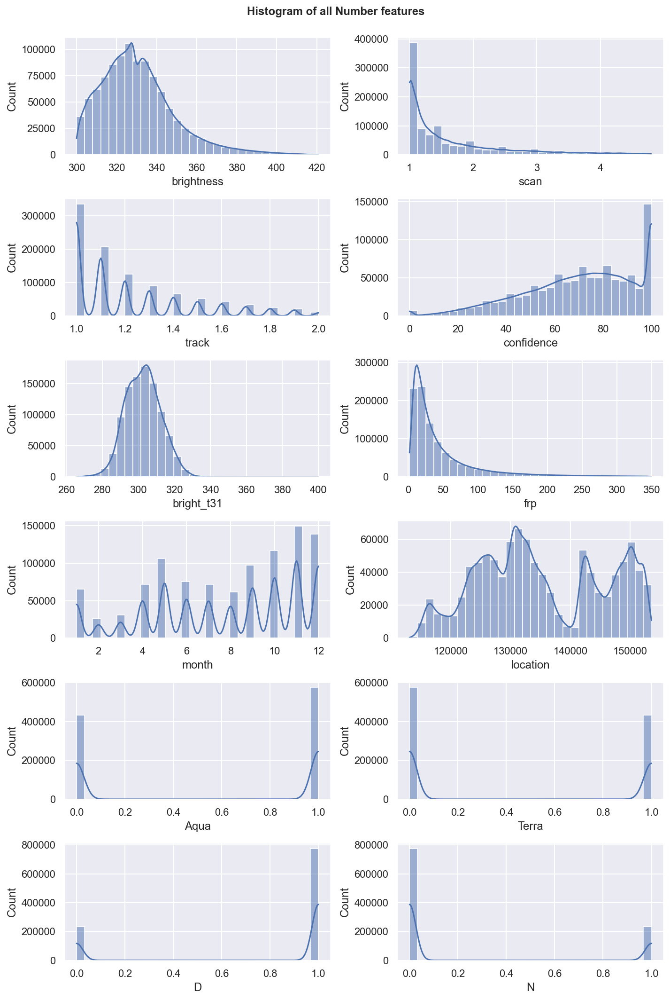

In [ ]:
import datetime
mulitple_function_plots(data=purged_data,plot_type='histogram', data_type='number')

For the method we use to split our dataset, I choose to use **random split.**<br>
People said we should use Stratified sampling as long as it's possible. Well, in our case, that's a tricky part. <br>
First of all, we don't have a feature that we can use to stratified sampling and say it will definitely help us to persist all distributions in the original data set. <br>When we look back what features we have know, we can't say any feature is separated and obeyed a certain category. In the meantime, we need that category to apply an uniform distribution. There isn't a thing like we use to apply in any other stratified sampling, like income, age, or gender.

After all, what we want is to persist the distributions from the original data set. And unsurprisingly, random split did a great job to do so. By the Central Limit algorithm, as long as our data set is big enough, we can persist our distribution by randomly pick our samples from the pool. That's the foundation of modern statistics. (MIT applied statistics)


In order to show that is real the case, we first separate our data set into two subsets with 0.8, 0.2 ratio.
<br> And we take the 0.2 subset as our new whole dataset. Then we print out it's distribution to see if it's what we want.

**Create Test set**

In [ ]:
from sklearn.model_selection import train_test_split

remaining_data, subset_data = train_test_split(purged_data, test_size=0.15, random_state=42)

In [ ]:
# get rid of Object type
subset_data = subset_data.convert_dtypes()
# showing the index dtype and columns, non-null values and memory usage.
subset_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 202240 entries, 77662 to 9978
Data columns (total 12 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   brightness  202240 non-null  Float64
 1   scan        202240 non-null  Float64
 2   track       202240 non-null  Float64
 3   confidence  202240 non-null  Int64  
 4   bright_t31  202240 non-null  Float64
 5   frp         202240 non-null  Float64
 6   month       202240 non-null  Int64  
 7   location    202240 non-null  Float64
 8   Aqua        202240 non-null  Int32  
 9   Terra       202240 non-null  Int32  
 10  D           202240 non-null  Int32  
 11  N           202240 non-null  Int32  
dtypes: Float64(6), Int32(4), Int64(2)
memory usage: 19.3 MB


Those features will be plotted in  6  rows and 2 columns
Index(['brightness', 'scan', 'track', 'confidence', 'bright_t31', 'frp',
       'month', 'location', 'Aqua', 'Terra', 'D', 'N'],
      dtype='object')
1 . Finish Rendering : brightness , used 843.998 millseconds
2 . Finish Rendering : scan , used 588.0 millseconds
3 . Finish Rendering : track , used 201.0 millseconds
4 . Finish Rendering : confidence , used 817.0 millseconds
5 . Finish Rendering : bright_t31 , used 50.999 millseconds
6 . Finish Rendering : frp , used 999.001 millseconds
7 . Finish Rendering : month , used 466.999 millseconds
8 . Finish Rendering : location , used 985.999 millseconds
9 . Finish Rendering : Aqua , used 453.998 millseconds
10 . Finish Rendering : Terra , used 929.999 millseconds
11 . Finish Rendering : D , used 401.0 millseconds
12 . Finish Rendering : N , used 867.999 millseconds


array([[<AxesSubplot:xlabel='brightness', ylabel='Count'>,
        <AxesSubplot:xlabel='scan', ylabel='Count'>],
       [<AxesSubplot:xlabel='track', ylabel='Count'>,
        <AxesSubplot:xlabel='confidence', ylabel='Count'>],
       [<AxesSubplot:xlabel='bright_t31', ylabel='Count'>,
        <AxesSubplot:xlabel='frp', ylabel='Count'>],
       [<AxesSubplot:xlabel='month', ylabel='Count'>,
        <AxesSubplot:xlabel='location', ylabel='Count'>],
       [<AxesSubplot:xlabel='Aqua', ylabel='Count'>,
        <AxesSubplot:xlabel='Terra', ylabel='Count'>],
       [<AxesSubplot:xlabel='D', ylabel='Count'>,
        <AxesSubplot:xlabel='N', ylabel='Count'>]], dtype=object)

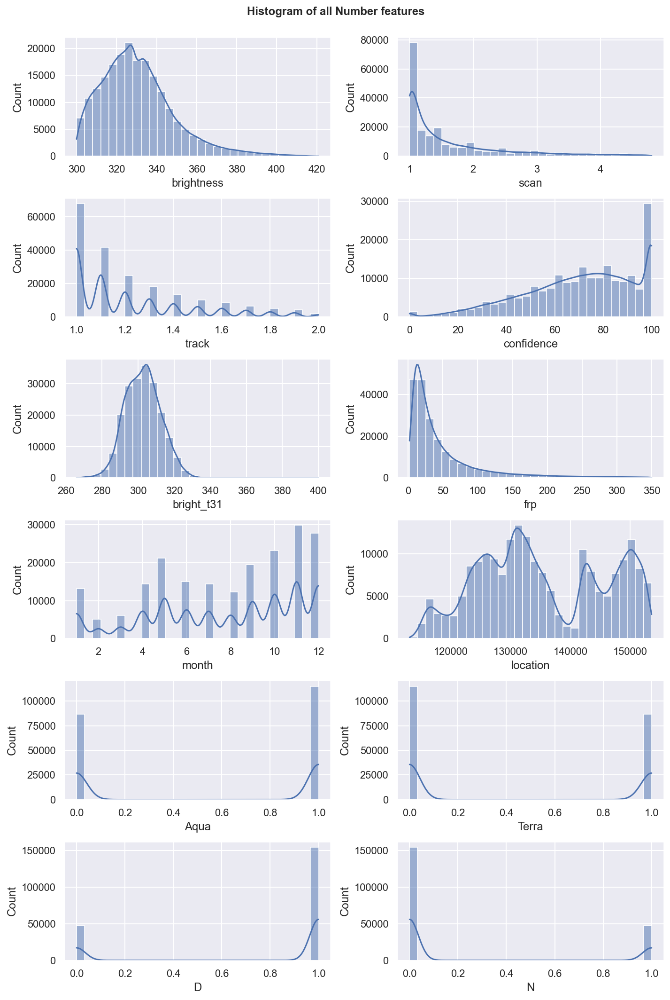

In [ ]:
mulitple_function_plots(data=subset_data,plot_type='histogram', data_type='number')

By comparing those two data sets' plots, we can easily say every feature has the same distribution. 
But we want to make sure that our derived feature also obey the same distribution.

Let's take a look at feature, Month.

Text(0.5, 1.0, "Whole dataset's Month histogram")

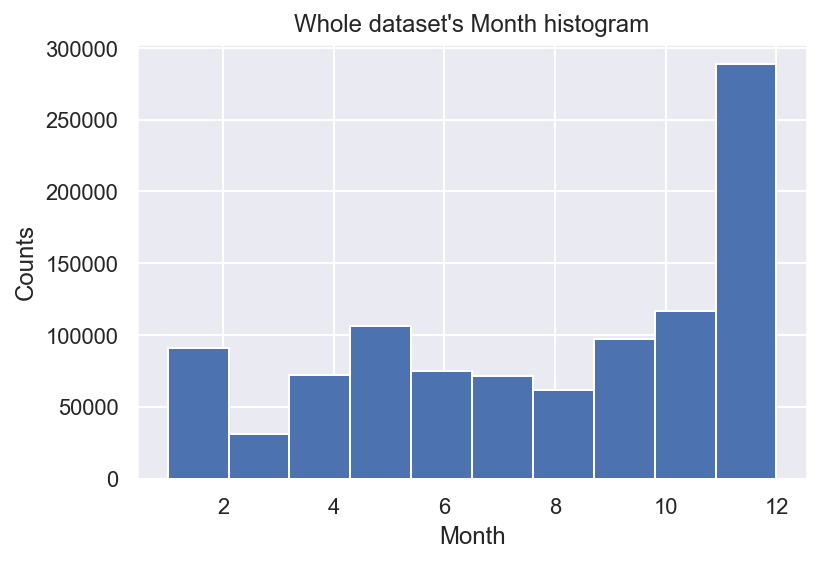

In [ ]:
purged_data['month'].hist() #histogram
plt.xlabel("Month")
plt.ylabel('Counts')
plt.title("Whole dataset's Month histogram")

Text(0.5, 1.0, "Subset Month's histogram")

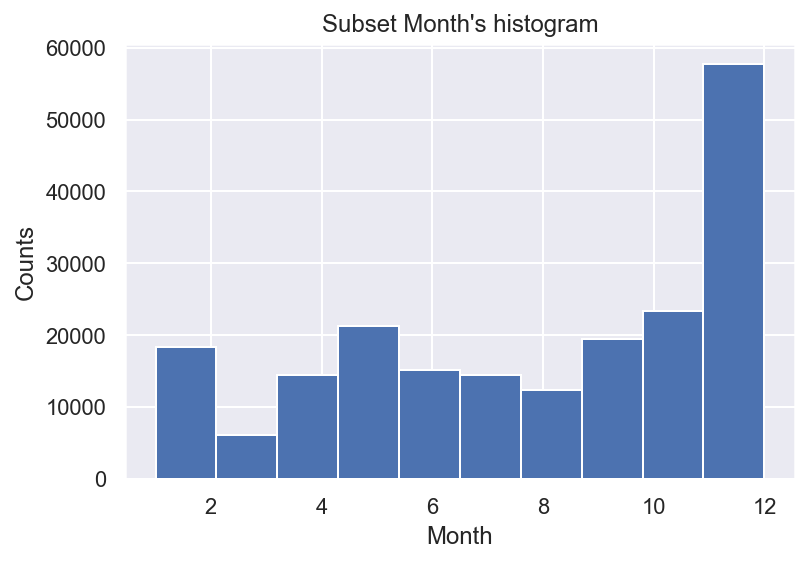

In [ ]:
subset_data['month'].hist() #histogram
plt.xlabel("Month")
plt.ylabel('Counts')
plt.title("Subset Month's histogram")

Indeed, they are prefect matched.
Hence, we can prove and say that we can use random split to cut our data set to a sub set.

#### 3.3.1.2 Generate train set and test set

By the similar step we separate our subset again.

In [ ]:
subset_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 202240 entries, 77662 to 9978
Data columns (total 12 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   brightness  202240 non-null  Float64
 1   scan        202240 non-null  Float64
 2   track       202240 non-null  Float64
 3   confidence  202240 non-null  Int64  
 4   bright_t31  202240 non-null  Float64
 5   frp         202240 non-null  Float64
 6   month       202240 non-null  int64  
 7   location    202240 non-null  Float64
 8   Aqua        202240 non-null  int32  
 9   Terra       202240 non-null  int32  
 10  D           202240 non-null  int32  
 11  N           202240 non-null  int32  
dtypes: Float64(6), Int64(1), int32(4), int64(1)
memory usage: 18.3 MB


In [ ]:
max_print_out(False)
subset_data.describe()

,brightness,scan,track,confidence,bright_t31,frp,month,location,Aqua,Terra,D,N
count,202240.00,202240.00,202240.00,202240.00,202240.00,202240.00,202240.00,202240.00,202240.00,202240.00,202240.00,202240.00
mean,330.52,1.64,1.22,70.14,302.77,48.81,7.74,135300.42,0.57,0.43,0.77,0.23
std,18.38,0.83,0.25,22.69,9.82,56.89,3.37,10469.61,0.50,0.50,0.42,0.42
min,300.00,1.00,1.00,0.00,265.90,2.10,1.00,113104.00,0.00,0.00,0.00,0.00
25%,317.50,1.10,1.00,55.00,295.70,14.30,5.00,126935.00,0.00,0.00,1.00,0.00
50%,328.10,1.30,1.10,73.00,302.70,27.50,8.00,133226.00,1.00,0.00,1.00,0.00
75%,340.00,1.90,1.30,88.00,309.40,58.00,11.00,144904.00,1.00,1.00,1.00,0.00
max,420.90,4.80,2.00,100.00,400.10,350.00,12.00,153555.00,1.00,1.00,1.00,1.00


Now,we need to create a set only about features, and a different set only about our target value.
I called it X and y. This is the most often used name in ML.

I wrote a very simple function to do so.

In [ ]:
############################FUNCTIONS ON PIPELINE##########################################

#-------------  create_trainning_data -----------------------------------------------------
# This function is for creating training data directly into numpy form
def create_trainning_data(data_df,num_array_needed = False):
    data_inner = data_df.copy()
    X = data_inner.drop("frp", axis=1) # drop labels for training set
    y = data_inner["frp"].copy()
    if num_array_needed: 
      X = number_pipeline.fit_transform(X)
      y = np.array(y.values)
    return X,y

In [ ]:
X, y = create_trainning_data(subset_data)

In [ ]:
X.describe()

,brightness,scan,track,confidence,bright_t31,month,location,Aqua,Terra,D,N
count,5056.00,5056.00,5056.00,5056.00,5056.00,5056.00,5056.00,5056.00,5056.00,5056.00,5056.00
mean,330.75,1.66,1.22,70.05,302.77,7.68,135067.60,0.56,0.44,0.75,0.25
std,18.55,0.85,0.26,23.08,10.05,3.38,10463.05,0.50,0.50,0.43,0.43
min,300.00,1.00,1.00,0.00,265.90,1.00,114079.00,0.00,0.00,0.00,0.00
25%,317.68,1.10,1.00,55.00,295.40,5.00,126818.50,0.00,0.00,1.00,0.00
50%,328.40,1.30,1.10,73.00,302.80,8.00,132792.50,1.00,0.00,1.00,0.00
75%,340.70,1.90,1.30,89.00,309.70,11.00,144725.00,1.00,1.00,1.00,0.00
max,414.40,4.80,2.00,100.00,341.40,12.00,153419.00,1.00,1.00,1.00,1.00


In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)

In [ ]:
X_train.describe()

,brightness,scan,track,confidence,bright_t31,month,location,Aqua,Terra,D,N
count,4044.00,4044.00,4044.00,4044.00,4044.00,4044.00,4044.00,4044.00,4044.00,4044.00,4044.00
mean,330.86,1.65,1.22,70.25,302.80,7.68,135068.41,0.56,0.44,0.75,0.25
std,18.56,0.85,0.26,23.04,10.08,3.38,10430.65,0.50,0.50,0.43,0.43
min,300.00,1.00,1.00,0.00,265.90,1.00,114079.00,0.00,0.00,0.00,0.00
25%,317.70,1.10,1.00,55.00,295.60,5.00,126842.00,0.00,0.00,1.00,0.00
50%,328.50,1.30,1.10,74.00,302.80,8.00,132811.50,1.00,0.00,1.00,0.00
75%,340.80,1.90,1.30,89.00,309.70,11.00,144630.75,1.00,1.00,1.00,0.00
max,414.00,4.80,2.00,100.00,341.40,12.00,153419.00,1.00,1.00,1.00,1.00


In [ ]:
X.to_csv("x_train.csv")
y.to_csv("y_train.csv")

In [ ]:
y_train.describe()

count   161792.00
mean        48.80
std         56.86
min          2.10
25%         14.30
50%         27.50
75%         58.10
max        350.00
Name: frp, dtype: float64

Done! Now we can do the feature selection.

### 3.3.2 Feature selection

#### 0. Import packages sets:

In [ ]:
from sklearn.datasets import make_regression
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_regression
from sklearn.linear_model import SGDRegressor
from sklearn.svm import SVR
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.feature_selection import SelectFromModel
from sklearn.ensemble import RandomForestRegressor

#### 3.3.2.1. We try to use Pearson’s Correlation Coefficient via the f_regression() function.

In [ ]:
# Without those lines, the following function won't work
# cost me 2 hours to find out. So tough.
X_train = X_train.astype('float')
y_train = y_train.astype('float')
X_test = X_test.astype('float')
y_test = y_test.astype('float')

In [ ]:
from sklearn.datasets import make_regression
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_regression


# define feature selection
fs = SelectKBest(score_func=f_regression, k=10)
# apply feature selection
X_selected = fs.fit(X_train, y_train)
# print(X_selected.shape)
feature_support = fs.get_support()
fs_feature = X_train.loc[:,feature_support].columns.tolist()
print('Using f_regression, we got features as \n', fs_feature)

Using f_regression, we got features as 
 ['brightness', 'scan', 'track', 'confidence', 'bright_t31', 'month', 'location', 'Aqua', 'D', 'N']


That's quite a lot of features. We don't want that many. <br>

We need something new.
First we should get all our features name.

In [ ]:
features_name = X_train.loc[:,:].columns.tolist();
features_name

['brightness',
 'scan',
 'track',
 'confidence',
 'bright_t31',
 'month',
 'location',
 'Aqua',
 'Terra',
 'D',
 'N']

Let's get back to use f_regression again. But this time I will show their weight which is related to each feature. 

> Part of the code is coming from [regression data](https://machinelearningmastery.com/feature-selection-for-regression-data/). I modified some key methods to present more properly.

In [ ]:

from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_regression
from sklearn.linear_model import LinearRegression

# feature selection
def select_features_plot(X_train, y_train, X_test,function):
    # configure to select all features
    fs = SelectKBest(score_func=function, k='all')
    # learn relationship from training data
    fs.fit(X_train, y_train)
    # transform train input data
    X_train_fs = fs.transform(X_train)
    # transform test input data
    X_test_fs = fs.transform(X_test)
    # what are scores for the features

    ####################################################################

    # We create a panda data frame to calulate a normalized version of this score.
    score = pd.DataFrame(fs.scores_)
    normalized_score=(score-score.min())/(score.max()-score.min())

    # well, this part probably is way too far, I just don't want to waste time to search how to do this in numpy
    # Use pytorch to get the in-return results from f_regression to 1D array
    normalized_score_in_1D_array = torch.tensor(normalized_score.values)
    normalized_score_in_1D_array = normalized_score_in_1D_array.squeeze(-1).numpy()

    fig , ax = plt.subplots()

    for i in range(len(fs.scores_)):
        print(f'Feature {i}  {features_name[i]}: {normalized_score.iloc[i].values}' )
    # plot the scores
    plt.bar([i for i in range(len(fs.scores_))], normalized_score_in_1D_array)

    plt.xticks(range(11))
    ax.set_xticklabels(features_name, rotation='vertical', fontsize=18)
    plt.xlabel("Feature's index")
    plt.ylabel("Rate of each feature")
    plt.title("F_regression score among all features")
    plt.show()

Feature 0  brightness: [1.]
Feature 1  scan: [0.18396995]
Feature 2  track: [0.17886364]
Feature 3  confidence: [0.29368772]
Feature 4  bright_t31: [0.05831299]
Feature 5  month: [0.00094779]
Feature 6  location: [0.00179657]
Feature 7  Aqua: [4.55333051e-17]
Feature 8  Terra: [0.]
Feature 9  D: [0.01897201]
Feature 10  N: [0.01897201]


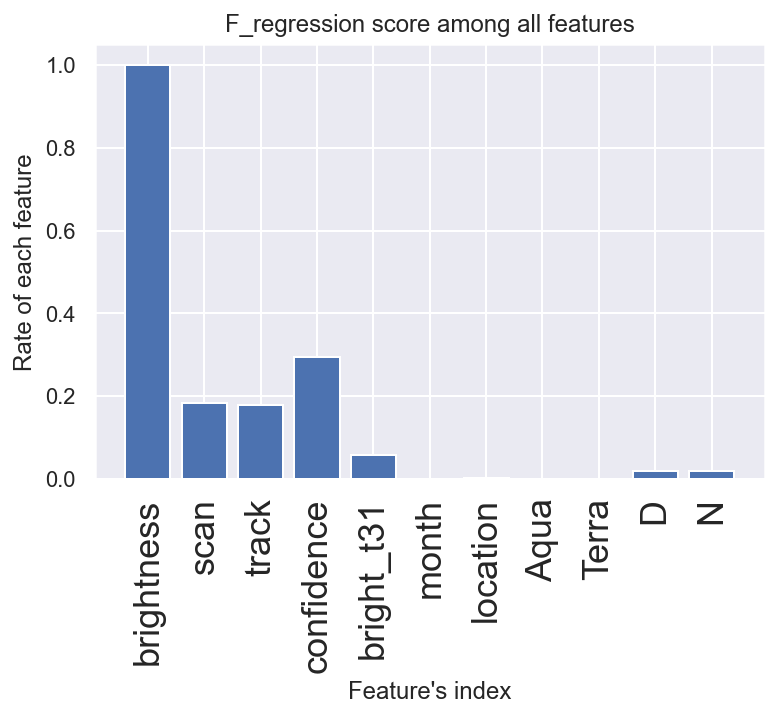

In [ ]:
from sklearn.feature_selection import f_regression
select_features_plot(X_train, y_train,X_test, f_regression)

Now, it's much better. 

We can see that there are five features are most important. <br>
They are brightness, scan, track, confidence, and bright_t31.<br>
Which is the same result we can get from our correlation matrix.

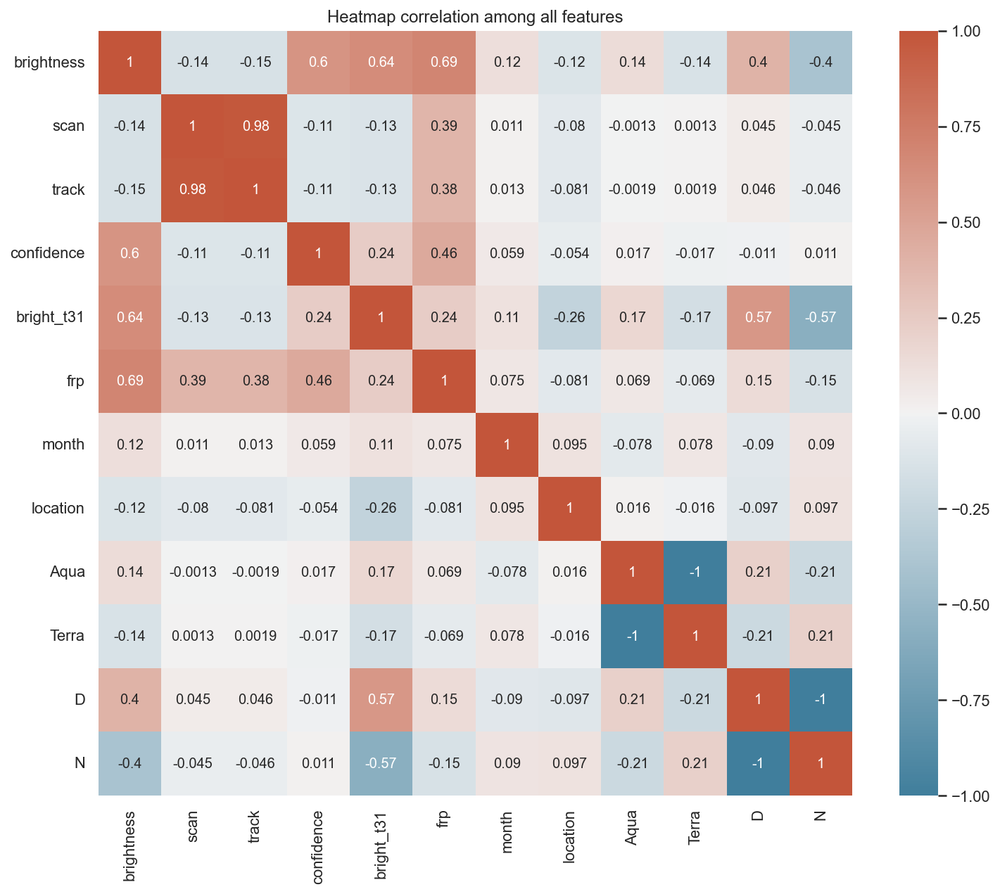

In [ ]:
heatmap_draw(subset_data)

Now let's use a different method called mutual_info_regression. 
> Mutual information from the field of information theory is the application of information gain (typically used in the construction of decision trees) to feature selection.

> Mutual information is calculated between two variables and measures the reduction in uncertainty for one variable given a known value of the other variable.


Feature 0  brightness: [1.]
Feature 1  scan: [0.35395018]
Feature 2  track: [0.35257816]
Feature 3  confidence: [0.63871411]
Feature 4  bright_t31: [0.12404807]
Feature 5  month: [0.04313037]
Feature 6  location: [0.0249896]
Feature 7  Aqua: [0.0023752]
Feature 8  Terra: [0.]
Feature 9  D: [0.04993489]
Feature 10  N: [0.05308558]


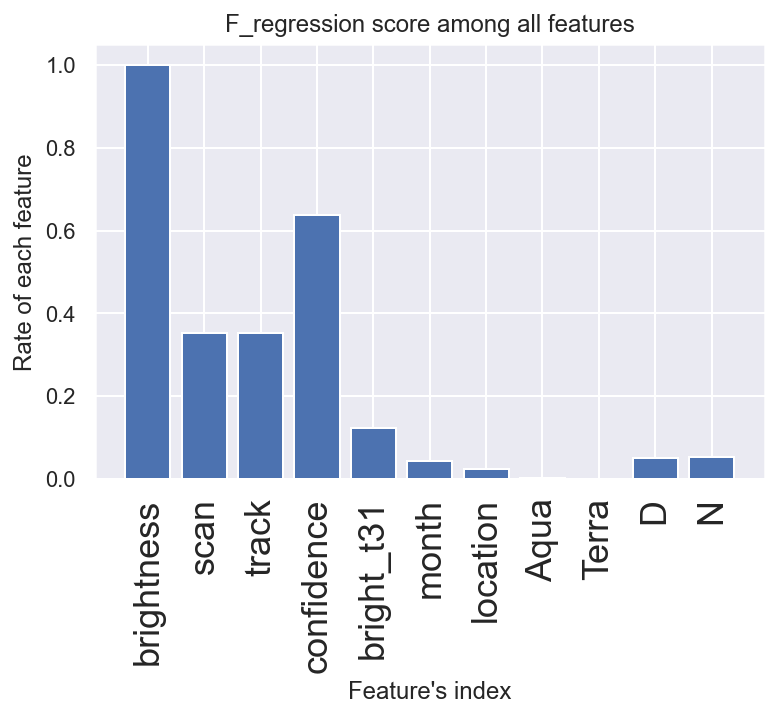

In [ ]:
from sklearn.feature_selection import mutual_info_regression
select_features_plot(X_train, y_train,X_test, mutual_info_regression)

The most important features still are those 5. <br>
However, at least we can see our derived features have some weight.

#### 3.3.2.2. Now let's use model to select feature.

In [ ]:
from sklearn.feature_selection import SelectFromModel
from sklearn.ensemble import RandomForestRegressor
def model_select_features(model,num_feats=11):
    embeded_rf_selector = SelectFromModel(model, max_features=num_feats)
    embeded_rf_selector.fit(X_train, y_train)
    embeded_rf_support = embeded_rf_selector.get_support()
#     print(embeded_rf_support)
    embeded_rf_feature = X_train.loc[:,embeded_rf_support].columns.tolist()
    print(str(len(embeded_rf_feature)), 'selected features as', embeded_rf_feature)

In [ ]:
model_select_features(RandomForestRegressor(n_estimators=100))

2 selected features as ['brightness', 'scan']


Well, two is too few. We need to test a few more models.

In [ ]:
from sklearn.svm import SVR
from sklearn.ensemble import GradientBoostingRegressor

model_select_features(GradientBoostingRegressor(max_depth=5, n_estimators=120,verbose=10))

      Iter       Train Loss   Remaining Time 
         1        2682.0435           29.51s
         2        2230.8462           29.32s
         3        1862.3145           29.05s
         4        1555.6842           29.00s
         5        1307.2956           28.80s
         6        1101.8813           28.82s
         7         929.0427           28.59s
         8         788.3971           28.42s
         9         670.2586           28.23s
        10         573.9195           27.96s
        11         493.2617           27.71s
        12         425.4950           27.48s
        13         368.9045           27.25s
        14         322.7195           27.01s
        15         283.9831           26.85s
        16         251.5430           26.60s
        17         224.3113           26.30s
        18         200.5775           25.97s
        19         181.5166           25.67s
        20         164.8404           25.46s
        21         149.9734           25.20s
        2

Well, those two tree based model only need 2 features.
Let's see what will SGD do.

In [ ]:
from sklearn.linear_model import SGDRegressor
model_select_features(SGDRegressor(max_iter=1000, tol=1e-3, penalty=None, eta0=0.1,verbose=10))

-- Epoch 1
Norm: 700587724370399.00, NNZs: 11, Bias: -97393665703.774399, T: 161792, Avg. loss: 2831770331357975104328558036865704263680.000000
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 119065337558989.28, NNZs: 11, Bias: -256616453356.632599, T: 323584, Avg. loss: 1177904334537772392384871072334658666496.000000
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 327181135399203.38, NNZs: 11, Bias: -404533559400.363953, T: 485376, Avg. loss: 902639612206303668798656356833686454272.000000
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 330034199459461.38, NNZs: 11, Bias: -388206651410.151001, T: 647168, Avg. loss: 761898408604885760549007581279349112832.000000
Total training time: 0.09 seconds.
-- Epoch 5
Norm: 384906437243751.25, NNZs: 11, Bias: -345712028524.461792, T: 808960, Avg. loss: 672495807918764595616411935839329714176.000000
Total training time: 0.11 seconds.
-- Epoch 6
Norm: 367795826952432.06, NNZs: 11, Bias: -436935288465.007141, T: 970752, Avg. loss: 6057181

Well, it selected 3 features, confidence, bright_t31 and location.<br>
Not bad. But we will continue our feature selection on fine tuning part.<br> 
For now, let's just choose all features appeared above:<br>
1. Feature 1  brightness:
2. Feature 2  scan:
3. Feature 3  track:
4. Feature 4  confidence:
5. Feature 5  bright_t31:
6. Feautre 6  location:

## 3.4. Select one or more evaluation metrics. Justify your choice.

In this assignment, we are solving a regression problem. The best choice is using the least squared error.
> Predictive modeling can be described as the mathematical problem of approximating a mapping function (f) from input variables (X) to output variables (y). This is called the problem of function approximation.The job of the modeling algorithm is to find the best mapping function we can given the time and resources available.[Jason Brownlee](https://machinelearningmastery.com/regression-metrics-for-machine-learning/)

Since our prediction and our target is a continuous variable. The difference between each other are quite varied. There are plenty of ways of evaluation metrics.
But for regression problem, the Least Squared error are the best.

Square will eliminate the sign of errors, enlarge any large loss error, and makes the gradient descent method have a better and easy formular to calculate the derivatives. It's the best for our loss function. It's also a good way to evaluate our model.

And there are two kinds of the least squared error metrics.
1. Mean Squared Error.
2. Root Mean Squared Error.

MSE will enlarge the error and penalize bigger loss error of our model. It will show the loss more clearly in learning curve.

RMSE will take the root of our MSE results, it will show the loss erro rabout our prediction with the same unit.

For me, personally, I don't see and consider they are much different to each other in terms of evaluating the performance of a model.

In this case, I choose MSE for evaluating learning curve. And RMSE for evaluating our model's final peformance.

This is a third metric called Mean absolute error. We don't use it on our loss function. Since the hardness of doing gradient descent and the insensitivity of outliers. 
> Mathematically, it is the average absolute difference between observed and predicted outcomes, MAE = mean(abs(observeds - predicteds)). MAE is less sensitive to outliers compared to RMSE. ([Machine Learning Essentials: Practical Guide in R](https://www.datanovia.com/en/product/machine-learning-essentials-practical-guide-in-r/?url=/5-bookadvisor/54-machine-learning-essentials/)) 

So personally I won't consider it's a good way to do the evaluation. But I will draw a graph to show the target value vs prediction. It is not the MBE but it uses the same idea.


## 3.5 Build a basline model

Before we start to build the model, we need to formalize our test set, validation set and test set. 

Due to that I used Neural network as my final model and we want our datasets to have consistency. 

Hence, I invoked the idea and functions to use dataloader of pytorch to do the data preparation job.


Therefore, at the beginning, we first build a workable dataloader.

> This code is partly from 2022 Homework 1 of the course I learnt for a while, [Machine Learning](https://speech.ee.ntu.edu.tw/~hylee/index.php)  by Lihongyi, National Taiwan University's open course. I modified a lot on the original HW1 codes. (The code is the HW1. It's not the answer of HW1. There isn't any answer of it you can find online. And the original code only can run a very simple NN model without testing method on test set.)

### 3.5.0 Data preparation

#### Import Packages

In [ ]:
# Numerical Operations
import math
import numpy as np

# Reading/Writing Data
import pandas as pd
import os
import csv

# For Progress Bar
from tqdm import tqdm

# Pytorch
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, random_split

# For plotting learning curve
from torch.utils.tensorboard import SummaryWriter

# for matplotlib ploting
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure


#### Utility Functions

In [ ]:
# ensure the random seed, that our result won't be really random
def same_seed(seed):
    '''Fixes random number generator seeds for reproducibility.'''
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    np.random.seed(seed)
    torch.manual_seed(seed)
    # set cuda seed
    if torch.cuda.is_available():
        torch.cuda.manual_seed_all(seed)
##############
# split dataset
def train_valid_split(data_set, valid_ratio, seed):
    '''Split provided training data into training set and validation set'''
    # split dataset into train, validation set by ratio
    valid_set_size = int(valid_ratio * len(data_set))
    # get the rest of the set
    train_set_size = len(data_set) - valid_set_size
    # random split the set by what we defined before
    train_set, valid_set = random_split(data_set, [train_set_size, valid_set_size], generator=torch.Generator().manual_seed(seed))
    # return the np array for training
    return np.array(train_set), np.array(valid_set)


#### Dataset

In [ ]:
# Dataset class
class Fire_Frp_Dataset(Dataset):
    '''
    x: Features.
    y: Targets, if none, do prediction.
    '''
    def __init__(self, x, y=None):
        if y is None:
            self.y = y # return prediction
        else:
            self.y = torch.FloatTensor(y) # get target value
        self.x = torch.FloatTensor(x) # get features

    def __getitem__(self, idx):
        if self.y is None:
            return self.x[idx] # get features
        else:
            return self.x[idx], self.y[idx] # get features and target

    def __len__(self):
        return len(self.x) # return length

#### Feature Selection

In [ ]:
def select_feat(train_data, valid_data, test_data, select_all=True):
    '''Selects useful features to perform regression'''
    # because we are operating on np arrays, we will alter the dataset and assume the last column is our target
    y_train, y_valid, y_test= train_data[:,-1], valid_data[:,-1],test_data[:,-1]
    # any columns before the last column is our features x
    raw_x_train, raw_x_valid, raw_x_test = train_data[:,:-1], valid_data[:,:-1], test_data[:,:-1]
    # Hyperparameter setting
    # select all for selecting all features
    if select_all:
        feat_idx = list(range(raw_x_train.shape[1]))
    else:
        # specific the feature index
        feat_idx = [0,1,2,3,4]
    #return the datasets
    return raw_x_train[:,feat_idx], raw_x_valid[:,feat_idx], raw_x_test[:,feat_idx], y_train, y_valid, y_test

#### Generate Dataset

Let's do some data preparation steps exclusively for baseline and candidate model. 

Although we already split the data before, but re-run those codes will delete all the plots we just did. And this jupyter notebook is working on multiple days. I don't have them in the meomory now.


In the meantime, we already proved that this sequence of functions works. Hence, we just re-generate the data set again and use it in our baseline model and candidate model.
Since we are using the same random seed, the results will be the same.

In [ ]:
raw_data_copy = raw_data.copy()
purged_data = purge_pipeline.fit_transform(raw_data_copy)
# get 150k data from the original dataset
from sklearn.model_selection import train_test_split
remaining_data, subset_data = train_test_split(purged_data, test_size=0.15, random_state=42)

IQR = 63.5 - 14.6 = 48.9
MAX = 136.85
Min is 0
Num of min outliers:  0
Num of max outliers:  32535
Num of negative outliers:  2948
Num of the original data set's whole instance 1046679
Rate of purged data/total data 0.031084028627688144


In [ ]:
subset_data.head()

,brightness,scan,track,confidence,bright_t31,frp,month,location,Aqua,Terra,D,N
77662,331.60,1.30,1.10,85,297.50,40.30,6,144856.00,0,1,1,0
550441,339.10,1.60,1.20,78,314.30,45.90,11,151002.00,1,0,1,0
205899,350.80,1.70,1.30,93,313.60,97.60,11,126485.00,1,0,1,0
481922,398.40,1.00,1.00,100,325.30,219.00,10,126289.00,0,1,1,0
865498,328.80,3.10,1.70,49,302.00,63.40,12,144888.00,1,0,1,0


In our neural network dataset code, we are assuming the last column is our target value. Hence, we need to re-arrange the location of 'FRP' Now.
(Although we are not using it in baseline model.)

In [ ]:
def create_dp_data(data):
  target = data.pop('frp') # pop our target value
  normalized_df_test=(data-data.mean())/data.std() # standardization our dataset
  normalized_df_test['target'] = target # move our frp target value to the end
  normalized_df_test = normalized_df_test.drop(['Aqua','Terra','D','N','month'],axis=1) # drop all useless features.
  return normalized_df_test

In [ ]:
normalized_data = create_dp_data(subset_data.copy());normalized_data.head()

,brightness,scan,track,confidence,bright_t31,location,target
77662,0.06,-0.41,-0.48,0.65,-0.54,0.91,40.30
550441,0.47,-0.05,-0.08,0.35,1.17,1.50,45.90
205899,1.10,0.07,0.31,1.01,1.10,-0.84,97.60
481922,3.69,-0.77,-0.87,1.32,2.29,-0.86,219.00
865498,-0.09,1.75,1.89,-0.93,-0.08,0.91,63.40


Well, that's all we need. Let's create the train and test set by 8:2 ratio.

#### Train and test set

In [ ]:
normalized_data = normalized_data.astype('float');normalized_data.info()
# without converting the dataset to float, it won't work

<class 'pandas.core.frame.DataFrame'>
Int64Index: 151680 entries, 77662 to 951024
Data columns (total 7 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   brightness  151680 non-null  float64
 1   scan        151680 non-null  float64
 2   track       151680 non-null  float64
 3   confidence  151680 non-null  float64
 4   bright_t31  151680 non-null  float64
 5   location    151680 non-null  float64
 6   target      151680 non-null  float64
dtypes: float64(7)
memory usage: 9.3 MB


In [ ]:
model_train, model_test = train_test_split(normalized_data, test_size=0.20, random_state=42)

In [ ]:
model_train.describe()

,brightness,scan,track,confidence,bright_t31,location,target
count,121344.00,121344.00,121344.00,121344.00,121344.00,121344.00,121344.00
mean,-0.00,-0.00,-0.00,-0.00,-0.00,-0.00,48.78
std,1.00,1.00,1.00,1.00,1.00,1.00,56.94
min,-1.66,-0.77,-0.87,-3.09,-3.70,-2.09,2.10
25%,-0.71,-0.65,-0.87,-0.67,-0.72,-0.80,14.30
50%,-0.13,-0.41,-0.48,0.13,-0.01,-0.20,27.50
75%,0.52,0.31,0.31,0.79,0.67,0.92,57.90
max,4.74,3.79,3.07,1.32,9.91,1.74,350.00


Those features will be plotted in  4  rows and 2 columns
Index(['brightness', 'scan', 'track', 'confidence', 'bright_t31', 'location',
       'target'],
      dtype='object')
1 . Finish Rendering : brightness , used 777.856 millseconds
2 . Finish Rendering : scan , used 575.484 millseconds
3 . Finish Rendering : track , used 273.564 millseconds
4 . Finish Rendering : confidence , used 981.976 millseconds
5 . Finish Rendering : bright_t31 , used 723.124 millseconds
6 . Finish Rendering : location , used 386.025 millseconds
7 . Finish Rendering : target , used 280.653 millseconds


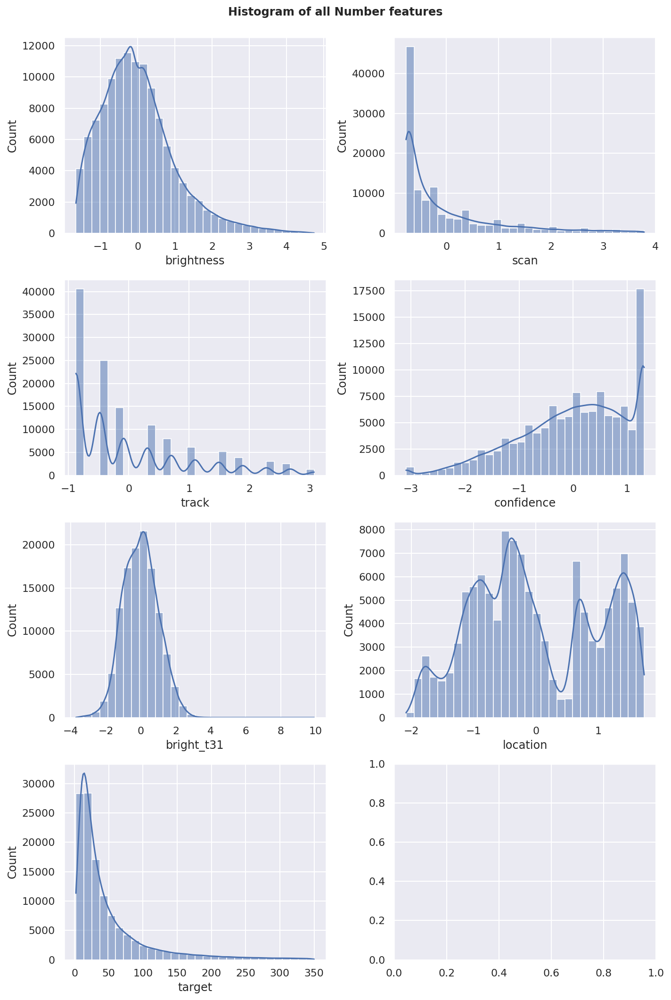

In [ ]:
ax = mulitple_function_plots(data=model_train,plot_type="histogram",data_type="number")

In [ ]:
model_test.describe()

,brightness,scan,track,confidence,bright_t31,location,target
count,30336.00,30336.00,30336.00,30336.00,30336.00,30336.00,30336.00
mean,0.00,0.01,0.01,0.00,0.00,0.00,49.01
std,1.00,1.01,1.01,1.00,1.00,1.00,57.00
min,-1.66,-0.77,-0.87,-3.09,-3.75,-2.12,2.20
25%,-0.71,-0.65,-0.87,-0.62,-0.72,-0.79,14.40
50%,-0.13,-0.41,-0.48,0.13,-0.01,-0.19,27.70
75%,0.52,0.31,0.70,0.79,0.67,0.91,58.10
max,4.77,3.79,3.07,1.32,3.97,1.74,349.90


Those features will be plotted in  4  rows and 2 columns
Index(['brightness', 'scan', 'track', 'confidence', 'bright_t31', 'location',
       'target'],
      dtype='object')
1 . Finish Rendering : brightness , used 244.658 millseconds
2 . Finish Rendering : scan , used 477.185 millseconds
3 . Finish Rendering : track , used 694.195 millseconds
4 . Finish Rendering : confidence , used 919.412 millseconds
5 . Finish Rendering : bright_t31 , used 160.465 millseconds
6 . Finish Rendering : location , used 379.45 millseconds
7 . Finish Rendering : target , used 624.793 millseconds


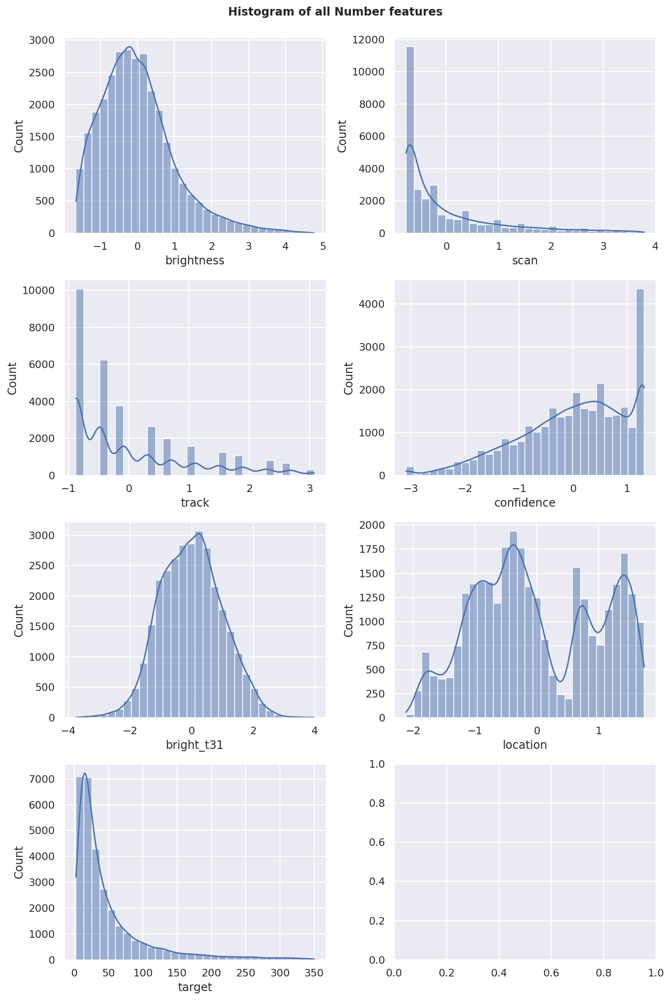

In [ ]:
ax = mulitple_function_plots(data=model_test,plot_type="histogram",data_type="number")

We can see that our train data and test data are valid and remain the same distribution of our original dataset.

#### Configuration

In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
config = {
    'seed': 5201314,      # Your seed number, you can pick your lucky number. :)
    'select_all': True,   # Whether to use all features.
    'valid_ratio': 0.2,   # validation_size = train_size * valid_ratio
    'batch_size': 5024,   # since we have a quite large dataset. The batch size should be large too
}

#### DataLoader
Read data from files and set up training, validation, and testing sets.

In [ ]:
def create_data_loader(model_train, model_test):
  # Set seed for reproducibility
  same_seed(config['seed'])

  train_data, test_data = model_train.values, model_test.values

  train_data, valid_data = train_valid_split(train_data, config['valid_ratio'], config['seed'])

  # Print out the data size.
  print(f"""train_data size: {train_data.shape}
  valid_data size: {valid_data.shape}
  test_data size: {test_data.shape}""")

  # Select features
  x_train, x_valid, x_test, y_train, y_valid, y_test = select_feat(train_data, valid_data, test_data, config['select_all'])

  # Print out the number of features.
  print(f'number of features: {x_train.shape[1]}')

  train_dataset, valid_dataset, test_dataset = Fire_Frp_Dataset(x_train, y_train), \
                                              Fire_Frp_Dataset(x_valid, y_valid), \
                                              Fire_Frp_Dataset(x_test,y_test)

  # Pytorch data loader loads pytorch dataset into batches.
  train_loader = DataLoader(train_dataset, batch_size=config['batch_size'], shuffle=True, pin_memory=True)
  valid_loader = DataLoader(valid_dataset, batch_size=config['batch_size'], shuffle=True, pin_memory=True)
  test_loader = DataLoader(test_dataset, batch_size=config['batch_size'], shuffle=False, pin_memory=True)
  return train_loader, valid_loader, test_loader


In [ ]:
train_loader, valid_loader, test_loader = create_data_loader(model_train, model_test)

train_data size: (97076, 7)
  valid_data size: (24268, 7)
  test_data size: (30336, 7)
number of features: 6


Now we have everything we need to build a machine learning model.

In our baselin model, I will chose Random forest regression model.<br>
First, let's retreive our data set to numpy and import Randomforest's packages. 

In [ ]:
# convert tensor to numpy
X_train = train_loader.dataset.x.numpy();X_train 

array([[-0.01772714,  0.06838808,  0.3100322 , -1.9013417 ,  1.4073161 ,
         0.18678162],
       [ 0.81487995, -0.7710539 , -0.8745336 ,  0.47807193,  1.8449507 ,
        -0.73673606],
       [ 0.21083167,  0.6679895 ,  0.70488745, -0.31506592,  0.9187939 ,
        -1.1847018 ],
       ...,
       [-1.1061025 , -0.53121334, -0.47967833,  0.25775588, -0.40428713,
        -0.8389673 ],
       [-0.15377405, -0.0515322 ,  0.3100322 ,  0.3458823 ,  0.39973903,
         0.9186276 ],
       [-0.36600724,  0.78790975,  1.0997428 ,  0.081503  ,  0.16565546,
        -0.08068056]], dtype=float32)

In [ ]:
y_train =train_loader.dataset.y.numpy();y_train

array([17.7, 23.5, 52.1, ...,  7.2, 25.1, 41.9], dtype=float32)

In [ ]:
# convert the rest of dataset
X_valid = valid_loader.dataset.x.numpy()
y_valid = valid_loader.dataset.y.numpy()
X_test = test_loader.dataset.x.numpy()
y_test = test_loader.dataset.y.numpy()

Now we have every dataset in numpy type. And we are ready to train!

### 3.5.1 Perform hyperparameter tuning.
First, we need to create a baseline model before fine tuning the model.
We start by using very few of estimators in Radomforest to see the improvement of our fine tuning.

In [ ]:
from sklearn.ensemble import RandomForestRegressor

forest_reg = RandomForestRegressor(n_estimators=5, random_state=42,verbose=1)
forest_reg.fit(X_train, y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    2.6s finished


RandomForestRegressor(n_estimators=5, random_state=42, verbose=1)

Okay, we just finished the training part. 
Let's see its score on validation set.

In [ ]:
from sklearn.metrics import mean_squared_error

frp_prediction = forest_reg.predict(X_valid)
forest_mse = mean_squared_error(y_valid, frp_prediction)
forest_rmse = np.sqrt(forest_mse)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.0s finished


In [ ]:
print("Random Forest Mean squared error: " , forest_mse)
print("Random Forest root Mean squared error:", forest_rmse)

Random Forest Mean squared error:  60.89636281320674
Random Forest root Mean squared error: 7.803612164453507


We have MSE = 54.09, RMSE = 7.4 on validation set, which is not really good.


Let's see it on train set with K fold cross validation score.

In [ ]:
def display_scores(scores):
    print("Scores:", scores)
    print("Mean:", scores.mean())
    print("Standard deviation:", scores.std())

In [ ]:
from sklearn.model_selection import cross_val_score

forest_scores = cross_val_score(forest_reg, X_train, y_train,
                                scoring="neg_mean_squared_error", cv=4);
forest_rmse_scores = np.sqrt(-forest_scores)


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    1.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    1.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    1.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_j

In [ ]:
display_scores(-forest_scores)
print("MSE score")

Scores: [61.71129087 64.08561751 62.82500364 63.5675755 ]
Mean: 63.047371877248366
Standard deviation: 0.8920658455132581
MSE score


In [ ]:
print("RMSE score")
display_scores(forest_rmse_scores)

RMSE score
Scores: [7.85565343 8.00534931 7.92622253 7.97292766]
Mean: 7.940038233382496
Standard deviation: 0.056255930109999165


Not much difference from our results on validation set. Still bad.

Hence, indeed we need to fine tuning our model.

#### 3.5.1.1 Grid Search
> Part of the codes are from the book [Hands-On Machine Learning with Scikit-Learn, Keras, and TensorFlow_ Concepts, Tools]

In [ ]:
from sklearn.model_selection import GridSearchCV

param_grid = [
    # try 12 (4×3) combinations of hyperparameters
    {'n_estimators': [3, 10, 30, 60], 'max_features': [2, 4, 6]},
    # then try 6 (2×3) combinations with bootstrap set as False
    {'bootstrap': [False], 'n_estimators': [3, 10], 'max_features': [2, 3, 4]},
  ]

forest_reg_gr = RandomForestRegressor(random_state=42)
# train across 5 folds, that's a total of (12+6)*5=90 rounds of training 
grid_search = GridSearchCV(forest_reg_gr, param_grid, cv=5,
                           scoring='neg_mean_squared_error',
                           return_train_score=True)
grid_search.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=RandomForestRegressor(random_state=42),
             param_grid=[{'max_features': [2, 4, 6],
                          'n_estimators': [3, 10, 30, 60]},
                         {'bootstrap': [False], 'max_features': [2, 3, 4],
                          'n_estimators': [3, 10]}],
             return_train_score=True, scoring='neg_mean_squared_error')

The best hyperparameter combination found:

In [ ]:
grid_search.best_params_

{'max_features': 6, 'n_estimators': 60}

In [ ]:
grid_search.best_estimator_

RandomForestRegressor(max_features=6, n_estimators=60, random_state=42)

Let's look at the score we just got:

In [ ]:
cvres = grid_search.cv_results_
print("RMSE Score of different parameters:")
for mean_score, params in zip(cvres["mean_test_score"], cvres["params"]):
    print(np.sqrt(-mean_score), params)

RMSE Score of different parameters:
11.242863198323398 {'max_features': 2, 'n_estimators': 3}
8.60347674514528 {'max_features': 2, 'n_estimators': 10}
7.80455051521053 {'max_features': 2, 'n_estimators': 30}
7.58241917694747 {'max_features': 2, 'n_estimators': 60}
8.415076108889467 {'max_features': 4, 'n_estimators': 3}
7.2389250915381655 {'max_features': 4, 'n_estimators': 10}
6.872172925710328 {'max_features': 4, 'n_estimators': 30}
6.770758504566421 {'max_features': 4, 'n_estimators': 60}
8.178420890930479 {'max_features': 6, 'n_estimators': 3}
7.146275115617339 {'max_features': 6, 'n_estimators': 10}
6.802090887211126 {'max_features': 6, 'n_estimators': 30}
6.722032734062998 {'max_features': 6, 'n_estimators': 60}
10.325307911326405 {'bootstrap': False, 'max_features': 2, 'n_estimators': 3}
8.205513298410176 {'bootstrap': False, 'max_features': 2, 'n_estimators': 10}
8.613579592937352 {'bootstrap': False, 'max_features': 3, 'n_estimators': 3}
7.325950069993344 {'bootstrap': False, 

Sorted results of our grid search.

In [ ]:
grid_search_result = zip(np.sqrt(-cvres["mean_test_score"]), cvres["params"])
print("Sorted results of our grid search")
sorted(grid_search_result, reverse=False)

Sorted results of our grid search


[(6.722032734062998, {'max_features': 6, 'n_estimators': 60}),
 (6.770758504566421, {'max_features': 4, 'n_estimators': 60}),
 (6.802090887211126, {'max_features': 6, 'n_estimators': 30}),
 (6.872172925710328, {'max_features': 4, 'n_estimators': 30}),
 (7.146275115617339, {'max_features': 6, 'n_estimators': 10}),
 (7.216806199159409,
  {'bootstrap': False, 'max_features': 4, 'n_estimators': 10}),
 (7.2389250915381655, {'max_features': 4, 'n_estimators': 10}),
 (7.325950069993344,
  {'bootstrap': False, 'max_features': 3, 'n_estimators': 10}),
 (7.58241917694747, {'max_features': 2, 'n_estimators': 60}),
 (7.80455051521053, {'max_features': 2, 'n_estimators': 30}),
 (8.178420890930479, {'max_features': 6, 'n_estimators': 3}),
 (8.205513298410176,
  {'bootstrap': False, 'max_features': 2, 'n_estimators': 10}),
 (8.209790054638031,
  {'bootstrap': False, 'max_features': 4, 'n_estimators': 3}),
 (8.415076108889467, {'max_features': 4, 'n_estimators': 3}),
 (8.60347674514528, {'max_features

Let's save our grid search results.

In [ ]:
joblib.dump(grid_search, 'grid_search.pkl')

['grid_search.pkl']

Do another test on the hyperparameter we just found.

In [ ]:
# get the model from grid_search directly
forest_reg_gr_best_param = grid_search.best_estimator_
# train our model
forest_reg_gr_best_param.fit(X_train, y_train)
# test it on validation set
frp_prediction_gr_best_param = forest_reg_gr_best_param.predict(X_valid)
forest_mse_gr_best_param = mean_squared_error(y_valid, frp_prediction_gr_best_param)
forest_rmse_gr_best_param = np.sqrt(forest_mse_gr_best_param)

In [ ]:
print("Random Forest grid search best estimator's Mean squared error: " , forest_mse_gr_best_param)
print("Random Forest grid search best estimator'sroot Mean squared error:", forest_rmse_gr_best_param)

Random Forest grid search best estimator's Mean squared error:  43.44410833090341
Random Forest grid search best estimator'sroot Mean squared error: 6.591214480723822


In [ ]:
print("Original Random Forest Mean squared error: " , forest_mse)
print("Original Random Forest root Mean squared error:", forest_rmse)

Original Random Forest Mean squared error:  54.904788463156045
Original Random Forest root Mean squared error: 7.4097765461015115


RMSE = 6.59, MSE = 54.9 which is much better than RMSE = 7.409, MSE=54.904  in our original model.

But we are not gonna to stop here.

#### 3.5.1.2 Random Search

In [ ]:
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint

param_distribs = {
        'n_estimators': randint(low=1, high=100),
        'max_features': randint(low=1, high=6),
    }

forest_reg_rs = RandomForestRegressor(random_state=42,verbose=1)
rnd_search = RandomizedSearchCV(forest_reg_rs, param_distributions=param_distribs,
                                n_iter=10, cv=5, scoring='neg_mean_squared_error', random_state=42)
rnd_search.fit(X_train, y_train)

In [ ]:
rnd_search.best_params_

{'max_features': 4, 'n_estimators': 93}

In [ ]:
joblib.dump(rnd_search, 'rnd_search.pkl')

['rnd_search.pkl']

Best estimator of our random search is:

In [ ]:
rnd_search.best_estimator_

RandomForestRegressor(max_features=4, n_estimators=93, random_state=42,
                      verbose=1)

In [ ]:
cvres_rnd = rnd_search.cv_results_
for mean_score, params in zip(cvres_rnd["mean_test_score"], cvres_rnd["params"]):
    print(np.sqrt(-mean_score), params)

6.733178767281307 {'max_features': 4, 'n_estimators': 93}
6.861645205252968 {'max_features': 3, 'n_estimators': 72}
6.868221666220938 {'max_features': 5, 'n_estimators': 21}
7.512676330409426 {'max_features': 2, 'n_estimators': 83}
6.866161952603111 {'max_features': 3, 'n_estimators': 75}
6.840583697710868 {'max_features': 5, 'n_estimators': 24}
7.086072824382844 {'max_features': 3, 'n_estimators': 22}
8.933735524759017 {'max_features': 5, 'n_estimators': 2}
6.872172925710328 {'max_features': 4, 'n_estimators': 30}
8.877034358823522 {'max_features': 6, 'n_estimators': 2}


In [ ]:
rnd_search_result = zip(np.sqrt(-cvres_rnd["mean_test_score"]), cvres_rnd["params"])
print("Sorted results of our random search")
sorted(rnd_search_result, reverse=False)

Sorted results of our random search


[(6.733178767281307, {'max_features': 4, 'n_estimators': 93}),
 (6.840583697710868, {'max_features': 5, 'n_estimators': 24}),
 (6.861645205252968, {'max_features': 3, 'n_estimators': 72}),
 (6.866161952603111, {'max_features': 3, 'n_estimators': 75}),
 (6.868221666220938, {'max_features': 5, 'n_estimators': 21}),
 (6.872172925710328, {'max_features': 4, 'n_estimators': 30}),
 (7.086072824382844, {'max_features': 3, 'n_estimators': 22}),
 (7.512676330409426, {'max_features': 2, 'n_estimators': 83}),
 (8.877034358823522, {'max_features': 6, 'n_estimators': 2}),
 (8.933735524759017, {'max_features': 5, 'n_estimators': 2})]

Let's test it on validation set.

In [ ]:
# get the model from grid_search directly
forest_reg_rnd_best_param = rnd_search.best_estimator_
# train our model
forest_reg_rnd_best_param.fit(X_train, y_train)
# test it on validation set
frp_prediction_rnd_best_param = forest_reg_rnd_best_param.predict(X_valid)
forest_mse_rnd_best_param = mean_squared_error(y_valid, frp_prediction_rnd_best_param)
forest_rmse_rnd_best_param = np.sqrt(forest_mse_rnd_best_param)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  93 out of  93 | elapsed:   29.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  93 out of  93 | elapsed:    1.0s finished


In [ ]:
print("Random Forest random search best estimator's Mean squared error: " , forest_mse_rnd_best_param)
print("Random Forest random search best estimator'sroot Mean squared error:", forest_rmse_rnd_best_param)

Random Forest random search best estimator's Mean squared error:  42.77265804968469
Random Forest random search best estimator'sroot Mean squared error: 6.540080890148431


In [ ]:
print("Random Forest grid search best estimator's Mean squared error: " , forest_mse_gr_best_param)
print("Random Forest grid search best estimator'sroot Mean squared error:", forest_rmse_gr_best_param)

Random Forest grid search best estimator's Mean squared error:  43.44410833090341
Random Forest grid search best estimator'sroot Mean squared error: 6.591214480723822


We can see that our random search has a better performance than grid search on validation set.
42.77 < 43.44

Hence, the result of our fine tuning is we choose the hyperparameters as:
> max_features=4, n_estimators=93

In [ ]:
rnd_search.best_estimator_

RandomForestRegressor(max_features=4, n_estimators=93, random_state=42,
                      verbose=1)

### 3.5.2 Train and evaluate your model
Now we can train our model with above hyperparamters and test it on test set.

In [ ]:
# Train our model
forest_reg_final = RandomForestRegressor(max_features=4, n_estimators=93, random_state=42,
                      verbose=1)
# train our model
forest_reg_final.fit(X_train, y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  93 out of  93 | elapsed:   35.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  93 out of  93 | elapsed:    1.0s finished


In [ ]:
# test it on test set
frp_prediction_final = forest_reg_final.predict(X_test)
forest_mse_final = mean_squared_error(y_test, frp_prediction_final)
forest_rmse_final = np.sqrt(forest_mse_final)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  93 out of  93 | elapsed:    1.7s finished


In [ ]:
print("Random Forest's Mean squared error: " , forest_mse_final)
print("Random Forest's root Mean squared error:", forest_rmse_final)

Random Forest's Mean squared error:  43.44410833090341
Random Forest's root Mean squared error: 6.591214480723822


We can compute a 95% confidence interval for the test RMSE:

In [ ]:
from scipy import stats

confidence = 0.95
squared_errors = (frp_prediction_final - y_test) ** 2
np.sqrt(stats.t.interval(confidence, len(squared_errors) - 1,
                         loc=squared_errors.mean(),
                         scale=stats.sem(squared_errors)))

array([6.49096482, 6.81332809])

Hence, our model on test set have RMSE = [6.49096482, 6.81332809] about of 95% CI.



### 3.5.3 How do you make sure not to overfit?

We can draw the learning curve and validation curve of our model to see whether the training score and validation score has departed.

For learning curve:

Since we are using the MSE/RMSE evaluation metrics, hence, if the valiation score become very larger (MSE/RMSE becomes very big) and training score still small, then we know our model is overfitted.

We can based on our results to choose our train set size or number of trees in our model.

For validation curve:
Although randomforest algroithm is not very easy to overfitted.
We still can tune the hyperparameters to make sure it will not overfit.
By looking into the validation curve, if along with the grow of number of trees, the train/loss curve has departed from each other. We know that our model become overfitted at that number of trees.


Use these two tools, we can make sure our model will not overfit our data.

### 3.5.4 Visualize the learning process and/or the knowledge acquired by your model. Explain why you think this is the right visualization.

#### 3.5.4.1 Learning curve

> A learning curve is a graphical representation of the relationship between how proficient people are at a task and the amount of experience they have. Proficiency (measured on the vertical axis) usually increases with increased experience (the horizontal axis), that is to say, the more someone, groups, companies or industries perform a task, the better their performance at the task.[Wikipedia](https://en.wikipedia.org/wiki/Learning_curve)

We can find out from the LR curve that whether our model is overfitting/underfitting or whether our model could still imporve by more training epoches.
It will help identify our model is good or bad. 


set the model as our best estimator and finding the learning curve with scoring = RMSE

In [ ]:
from sklearn.model_selection import learning_curve
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import validation_curve

# set the model as our best estimator and finding the learning curve with scoring = RMSE
N, train_lc, val_lc = learning_curve(RandomForestRegressor(max_features=4, n_estimators=93, random_state=42,verbose=1),
                                     X_train, y_train, cv=5,scoring='neg_root_mean_squared_error',
                                      train_sizes=np.linspace(0.05, 1, 20)) # separate our training size by np.linspace, to 20 pieces

Save our learning curve value to joblib

In [ ]:
joblib.dump(N,'N.pkl')
joblib.dump(train_lc,'train_lc.pkl')
joblib.dump(val_lc,'val_lc.pkl')

['val_lc.pkl']

In [ ]:
N = joblib.load('/content/drive/MyDrive/A1/N.pkl')
train_lc = joblib.load('/content/drive/MyDrive/A1/train_lc.pkl')
val_lc = joblib.load('/content/drive/MyDrive/A1/val_lc.pkl')

Draw the learning curve

In [ ]:
def learning_curve_RMSE(N, train_lc, val_lc):
  # set the figure size
  fig, ax = plt.subplots(figsize=(16, 6))
  # get the training score
  ax.plot(N, np.mean(-train_lc, 1), color='blue', label='training score')
  # get the validation score
  ax.plot(N, np.mean(-val_lc, 1), color='red', label='validation score')
  # draw the grid line
  ax.hlines(np.mean([-train_lc[-1], -val_lc[-1]]), N[0], N[-1],
                color='gray', linestyle='dashed')
  # graph setting up
  ax.set_ylim(0, 20)
  ax.set_xlim(N[0], N[-1])
  ax.set_xlabel('training size')
  ax.set_ylabel('RMSE')
  ax.set_title("Random forest RMSE Train/Valid loss of our final model")
  ax.legend(loc='best')
  fig.show()

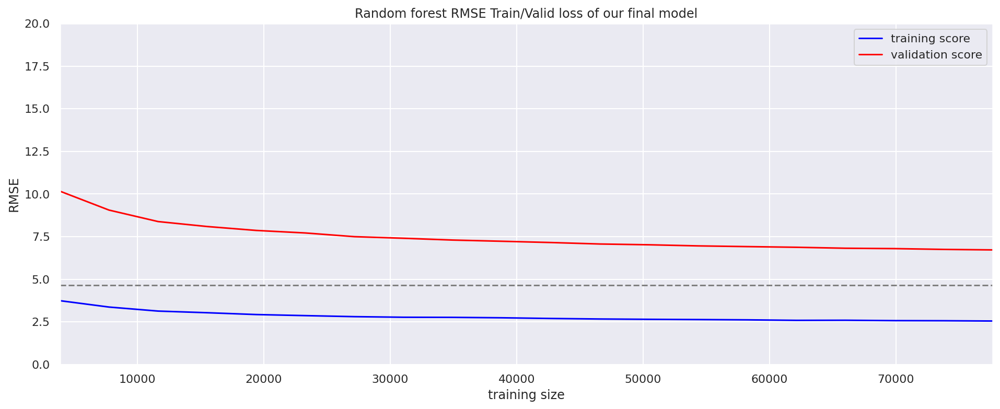

In [ ]:
learning_curve_RMSE(N, train_lc, val_lc)

Now we draw the MSE learning curve

In [ ]:
def learning_curve_MSE(N, train_lc, val_lc):
  fig, ax = plt.subplots(figsize=(16, 6))
  ax.plot(N, np.mean(np.square(-train_lc), 1), color='blue', label='training score')
  ax.plot(N, np.mean(np.square(-val_lc), 1), color='red', label='validation score')
  ax.hlines(np.mean([-train_lc[-1], -val_lc[-1]]), N[0], N[-1],
                color='gray', linestyle='dashed')

  ax.set_ylim(0, 110)
  ax.set_xlim(N[0], N[-1])
  ax.set_xlabel('training size')
  ax.set_ylabel('MSE')
  ax.set_title("Random forest MSE Train/Valid loss of our final model")
  ax.legend(loc='best')
  fig.show()

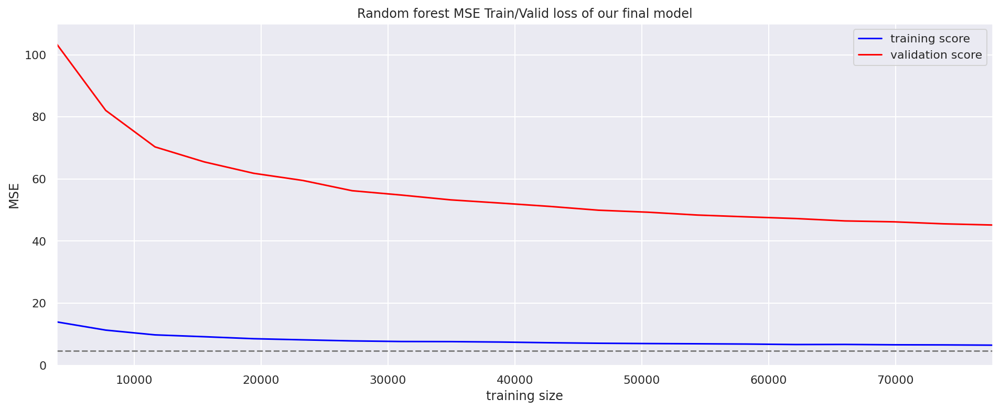

In [ ]:
learning_curve_MSE(N, train_lc, val_lc)

#### 3.5.4.2 Validation curve on different trees:

Although we used random search and grid search for finding the most proper hyperparameters, we still want to know that how many trees is good enough and how our model is influnenced by the different number of trees.
Like what we did in polynomial regression with different degrees.

In this kind of visualization, we can give a intuitive way of showing the chaning of train/valid score by trees number.

This can help up to use a relatively good enough number of trees when we test our model on different dataset. 
Since if we use our best estimator with 93 trees, it takes very long time to train everytime.


In [ ]:
from sklearn.model_selection import validation_curve
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.pipeline import make_pipeline
import matplotlib.pyplot as plt
import numpy as np

    
n_estimators = np.arange(1, 50)
train_score, val_score = validation_curve(forest_reg_final, X_train, y_train,
                                          param_name='n_estimators', param_range=n_estimators, cv=2
                                          , scoring = 'neg_root_mean_squared_error')

In [ ]:
joblib.dump(train_score,'est_train_score.pkl')
joblib.dump(val_score,'est_val_score.pkl')

['est_val_score.pkl']

In [ ]:
train_score = joblib.load('/content/drive/MyDrive/A1/est_train_score.pkl')
val_score = joblib.load('/content/drive/MyDrive/A1/est_val_score.pkl')

In [ ]:
def valid_score_curve_RMSE(train_score, val_score, n_estimators = np.arange(1, 50)):
  train_score_rmse = -train_score
  val_score_rmse = -val_score
  fig, ax = plt.subplots(figsize=(16, 6))
  ax.plot(n_estimators, np.median(train_score_rmse, 1), color='blue', label='training score')
  ax.plot(n_estimators, np.median(val_score_rmse, 1), color='red', label='validation score')
  ax.legend(loc='best')
  ax.set_ylim(0, 30)
  ax.set_xlim(0, 52)
  ax.set_title("Train/Valid RMSE loss of different random forest models")
  ax.set_xlabel('number of trees')
  ax.set_ylabel('RMSE');
  plt.show()

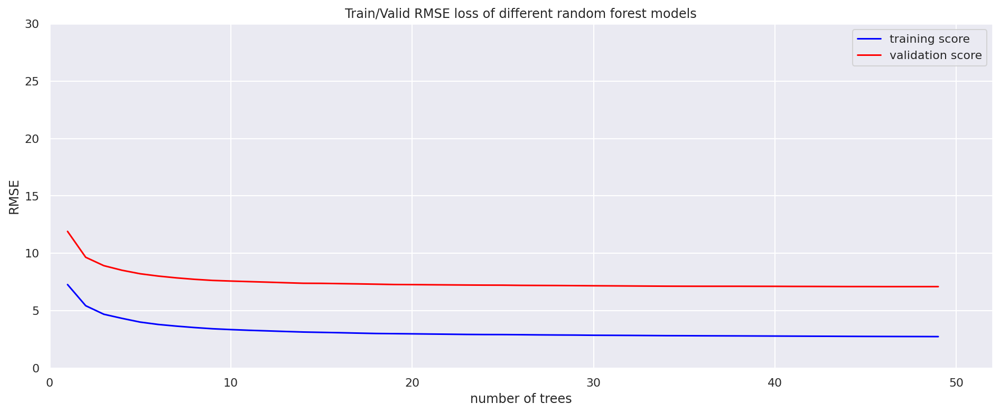

In [ ]:
valid_score_curve_RMSE(train_score, val_score, n_estimators = np.arange(1, 50))

In [ ]:
def valid_score_curve_MSE(train_score, val_score, n_estimators = np.arange(1, 50)):
  train_score_mse = np.square(train_score)
  val_score_mse = np.square(val_score)
  fig, ax = plt.subplots(figsize=(16, 6))
  ax.plot(n_estimators, np.mean(train_score_mse, 1), color='blue', label='training score')
  ax.plot(n_estimators, np.mean(val_score_mse, 1), color='red', label='validation score')
  ax.legend(loc='best')
  # plt.ylim(0, 30)
  ax.set_title("Train/Valid MSE loss of different random forest models")
  ax.set_xlabel('number of trees')
  ax.set_ylabel('MSE');

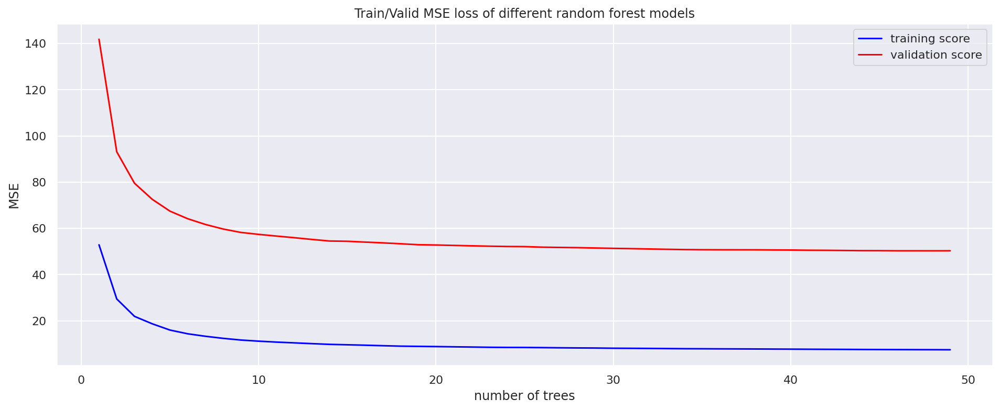

In [ ]:
valid_score_curve_MSE(train_score, val_score, n_estimators = np.arange(1, 50))

### 3.5.4.3 Ground Truth value vs Prediction

The Ground truth value(Target value) vs Prediction plot can show us how our model has done in test set. 

Every red point's X axis value means the real target value in our test set. And every point's Y axis value means our prediciton value to the corresponded data instance. <br> And if our prediction value equals to our target value, it will be on the blue line of y = x. <br> By looking at this graph, and how many points are not in the blue line and how off they are from the blue line, we can quickly estimate the performance of our model.

We can use it for easily to see our model's prediction condition.

In [ ]:
def ml_plot_pred(lim=360., preds=None, targets=None,figsize=(15,15)):
    # matplot setting
    figure(figsize = figsize)
    plt.scatter(targets, preds, c='r', alpha=0.5)
    plt.plot([-0.2, lim], [-0.2, lim], c='b')
    plt.xlim(-0.2, lim)
    plt.ylim(-0.2, lim)
    plt.xlabel('ground truth value')
    plt.ylabel('predicted value')
    plt.title('Ground Truth v.s. Prediction')
    plt.show()

Let's retrieve our test set's target value and our prediction.

In [ ]:
# Train our model
forest_reg_final = RandomForestRegressor(max_features=4, n_estimators=93, random_state=42,
                      verbose=1)
# train our model
forest_reg_final.fit(X_train, y_train)


# test it on test set
frp_prediction_final = forest_reg_final.predict(X_test)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  93 out of  93 | elapsed:   28.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  93 out of  93 | elapsed:    1.1s finished


In [ ]:
joblib.dump(forest_reg_final , 'forest_reg_final.pkl')

['forest_reg_final.pkl']

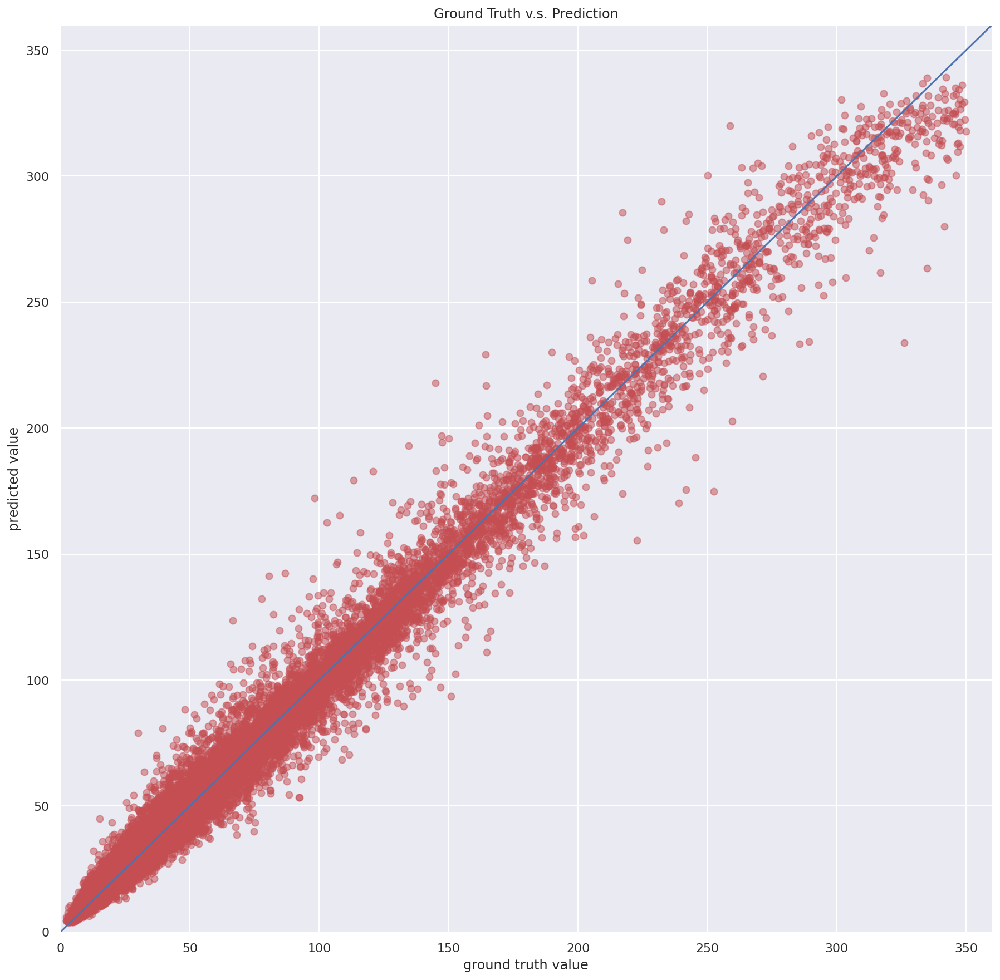

In [ ]:
ml_plot_pred(lim=360., preds=frp_prediction_final, targets=y_test,figsize=(15,15))

### 3.5.4 Analyze the results

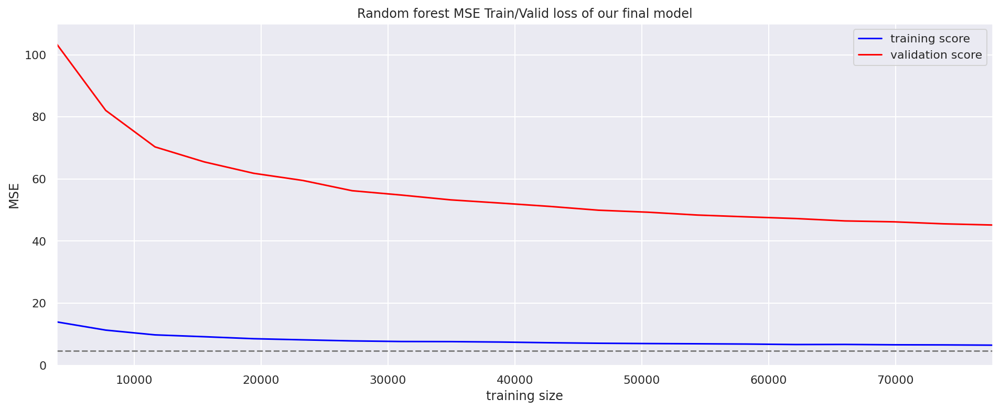

In [ ]:
learning_curve_MSE(N, train_lc, val_lc)

We can see that our model is not overfitted in our train set. And it has potential to achieve less RMSE error with more data to put in.

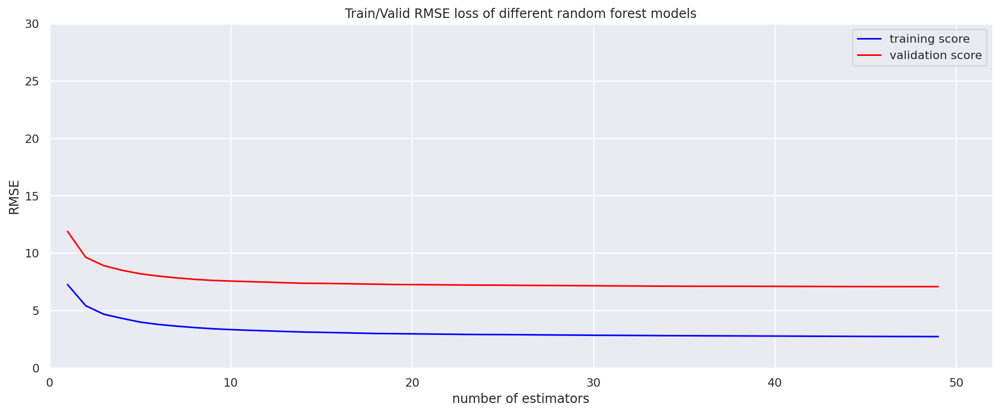

In [ ]:
valid_score_curve_RMSE(train_score, val_score, n_estimators = np.arange(1, 50))

We can see that when we have 10 or more trees, the performance of our model won't be a big difference. 
We can test it with 11 trees for a more quick results when we are training.

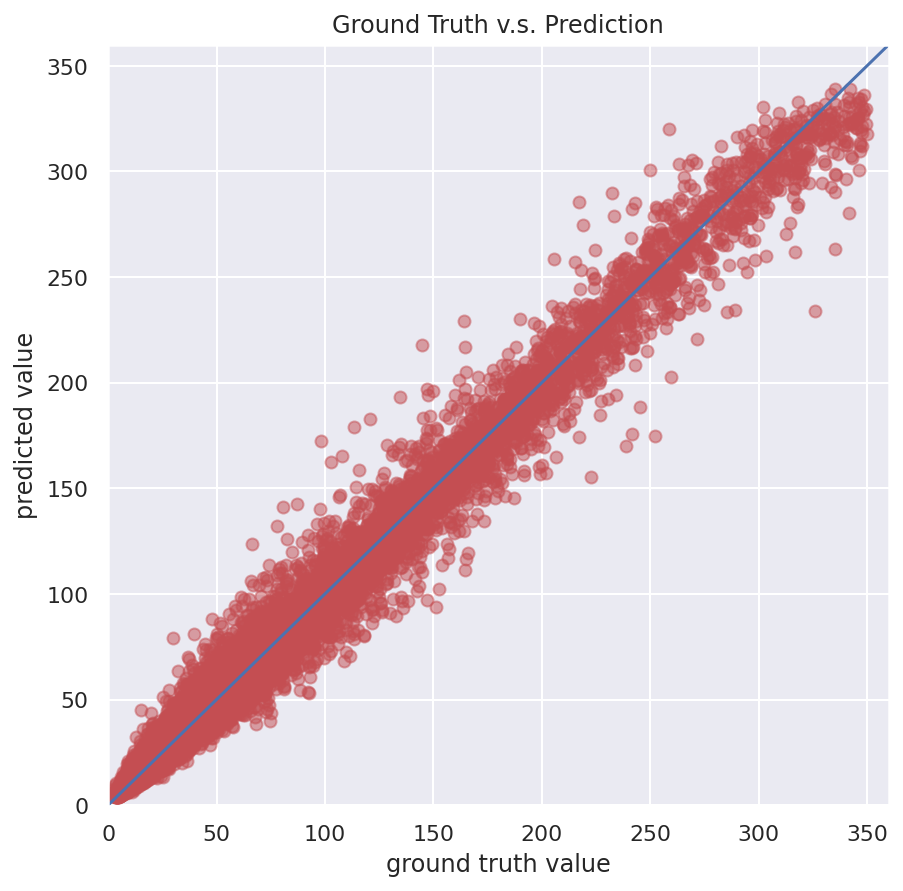

In [ ]:
ml_plot_pred(lim=360., preds=frp_prediction_final, targets=y_test,figsize=(7,7))

From the Ground truth value vs Prediction graph, we can see that our points are basically laying on the perfect prediction line: y = x.

There are a few huge errors near frp = 350. That means our model has bad prediction near the large FRP value.

## 3.6 Build a candidate final model
In the section, I will build a Neural Network from scratch.
I tuned this model from May to June, tried dozens of different choices of optimizer, learning rate, network structures, and Loss function.
Well, the results are not quite good I have to say.
Therefore, I put it into the baseline model, since its performance is not good as our candidate model.

### 3.6.0 Create the Neural Network

This code is partly from Homework 1 of the course I learnt for a while, [Machine Learning](https://speech.ee.ntu.edu.tw/~hylee/index.php) by Lihongyi, National Taiwan University's open course.
I modified a lot on the original HW1 codes. (The code is the HW1. It's not the answer of HW1. There isn't any answer you can find online. And the original code only can run a very simple NN model.)

#### Utility Functions

In [ ]:
# ensure the random seed, that our result won't be really random
def same_seed(seed):
    '''Fixes random number generator seeds for reproducibility.'''
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    np.random.seed(seed)
    torch.manual_seed(seed)
    # set cuda seed
    if torch.cuda.is_available():
        torch.cuda.manual_seed_all(seed)
##############
# split dataset
def train_valid_split(data_set, valid_ratio, seed):
    '''Split provided training data into training set and validation set'''
    # split dataset into train, validation set by ratio
    valid_set_size = int(valid_ratio * len(data_set))
    # get the rest of the set
    train_set_size = len(data_set) - valid_set_size
    # random split the set by what we defined before
    train_set, valid_set = random_split(data_set, [train_set_size, valid_set_size], generator=torch.Generator().manual_seed(seed))
    # return the np array for training
    return np.array(train_set), np.array(valid_set)

#### function of make the neural network prediction
def predict(test_loader, model, device):
    model.eval() # Set your model to evaluation mode.
    preds = []
    for x in tqdm(test_loader): # use tqdm to show the progress
        x = x.to(device)
        with torch.no_grad(): # before do prediction, we need to turn off gradient decent
            pred = model(x)
            preds.append(pred.detach().cpu()) # no need to use GPU for prediction
    preds = torch.cat(preds, dim=0).numpy() # concatenate the results
    return preds

#### Feature Selection

In [ ]:
def select_feat(train_data, valid_data, test_data, select_all=True):
    '''Selects useful features to perform regression'''
    # because we are operating on np arrays, we will alter the dataset and assume the last column is our target
    y_train, y_valid, y_test= train_data[:,-1], valid_data[:,-1],test_data[:,-1]
    # any columns before the last column is our features x
    raw_x_train, raw_x_valid, raw_x_test = train_data[:,:-1], valid_data[:,:-1], test_data[:,:-1]
    # Hyperparameter setting
    # select all for selecting all features
    if select_all:
        feat_idx = list(range(raw_x_train.shape[1]))
    else:
        # specific the feature index
        feat_idx = [0,1,2,3,4]
    #return the datasets
    return raw_x_train[:,feat_idx], raw_x_valid[:,feat_idx], raw_x_test[:,feat_idx], y_train, y_valid, y_test

#### Matplotlib Plot function
Well, at the beginning, I used tensorboard to show the plots. It works just fine.
But I need to attach the tensorboard ./run files to this jupyter notebook, which is impossible.
Therefore, this is the alternative way of showing the result.
I will keep the tensorboard solution. But may need the marker to download my record files from my Github. I will put the wget command at the corresponded area.

In [ ]:
def plot_learning_curve(loss_record, title='', y_start = 0., y_end = 100., ylabel='MSE Loss', figsize = (17,10), x_start = 0, x_end = 2000):
    ''' Plot learning curve of your DNN (train & dev loss) '''
    total_steps = len(loss_record['train']) # get the length of our records
    x_1 = range(total_steps) # get the range of x
    x_2 = x_1[::len(loss_record['train']) // len(loss_record['dev'])]
    figure(figsize=figsize) # set figsize
    plt.plot(x_1, loss_record['train'], c='tab:red', label='train loss')
    plt.plot(x_2, loss_record['dev'], c='tab:cyan', label='validation loss')
    plt.ylim(y_start, y_end) # set limit on x axis
    plt.xlim(x_start, x_end) # set limit on y axis
    plt.xlabel('Training steps')
    plt.ylabel(ylabel)
    plt.title('Learning curve of {}'.format(title))
    plt.legend()
    plt.show()


def plot_pred(dv_set, model, device, lim=360., preds=None, targets=None,figsize=(15,15)):
    ''' Plot prediction of your DNN '''
    if preds is None or targets is None:
        model.eval()
        preds, targets = [], [] # do prediction
        for x, y in dv_set:
            x, y = x.to(device), y.to(device)
            with torch.no_grad():
                pred = model(x)
                preds.append(pred.detach().cpu())
                targets.append(y.detach().cpu())
        preds = torch.cat(preds, dim=0).numpy() # save the prediction
        targets = torch.cat(targets, dim=0).numpy() # save the target value
    # matplot setting
    figure(figsize = figsize)
    plt.scatter(targets, preds, c='r', alpha=0.5)
    plt.plot([-0.2, lim], [-0.2, lim], c='b')
    plt.xlim(-0.2, lim)
    plt.ylim(-0.2, lim)
    plt.xlabel('ground truth value')
    plt.ylabel('predicted value')
    plt.title('Ground Truth v.s. Prediction')
    plt.show()

#### Neural Network Model

In [ ]:
class My_Model(nn.Module):
    def __init__(self, input_dim):
        super(My_Model, self).__init__()
        # create the neural network structure
        # deep is better
        # simply a deep and fully connected NN
        # not too many things here to say
        # only tried hundreds of combinations about the number of hidden layers and the number of nodes of a hidden layer
        self.layers = nn.Sequential(
            nn.Linear(input_dim, 16),
            nn.ReLU(),
            nn.Linear(16, 32),
            nn.ReLU(),
            nn.Linear(32, 64),
            nn.ReLU(),
            nn.Linear(64, 128),
            nn.ReLU(),
            nn.Linear(128, 64),
            nn.ReLU(),
            nn.Linear(64, 32),
            nn.ReLU(),
            nn.Linear(32, 16),
            nn.ReLU(),
            nn.Linear(16, 8),
            nn.ReLU(),
            nn.Linear(8, 1),
        )

    def forward(self, x):
        x = self.layers(x) # call the nn.Sequential function
        x = x.squeeze(1) # (B, 1) -> (B) change 2D tensor to 1D tensor
        return x

#### Training Loop

In [ ]:
def trainer(train_loader, valid_loader, model, config, device):

    criterion = nn.MSELoss(reduction='mean') # Define our loss function. By MSE

    # Define our optimization algorithm.
    # Added L2 regularization (optimizer(weight decay...)
    # the performance of SGD is not good in our dataset

    # basic stochastic gradient decent
    # optimizer = torch.optim.SGD(model.parameters(), lr=config['learning_rate'], momentum=0.9)
    # adam with warm up.
    # works not quite good in our dataset
    # optimizer = torch.optim.RAdam(model.parameters(), lr=config['learning_rate'],weight_decay=config['learning_rate'])


    # Adam with improved weight decay. 
    # weight decay is slightly better than the original L2 regularizatoin

    optimizer = torch.optim.AdamW(model.parameters(), lr=config['learning_rate'],weight_decay=config['learning_rate'])
    writer = SummaryWriter() # Writer of tensoboard.

    if not os.path.isdir('./models'):
        os.mkdir('./models') # Create directory of saving models.
    # get our hyperparamters
    n_epochs, best_loss, step, early_stop_count = config['n_epochs'], math.inf, 0, 0
    # this is the result saver for our plot function
    loss_record_plot = {'train': [], 'dev': []}      # for recording training loss

    for epoch in range(n_epochs):
        model.train() # Set your model to train mode.
        loss_record = [] # loss container for tensorboard plot

        # tqdm is a package to visualize our training progress.
        train_pbar = tqdm(train_loader, position=0, leave=True)

        for x, y in train_pbar:
            optimizer.zero_grad()               # Set gradient to zero.
            x, y = x.to(device), y.to(device)   # Move data to device.(GPU/CPU)
            pred = model(x)
            loss = criterion(pred, y)           # get loss by pytorch criterion function
            loss.backward()                     # Compute gradient(backpropagation).
            optimizer.step()                    # Update parameters.
            step += 1
            loss_record.append(loss.detach().item() )  # get loss value

            # Display current epoch number and loss on tqdm progress bar.
            train_pbar.set_description(f'Epoch [{epoch+1}/{n_epochs}]')
            train_pbar.set_postfix({'loss': loss.detach().item()})

        mean_train_loss = sum(loss_record)/len(loss_record)
        writer.add_scalar('Loss/train', mean_train_loss, step)   # add train loss data to tensorboard writer
        loss_record_plot['train'].append(mean_train_loss) # add loss into our extra plot array


        model.eval() # Set your model to evaluation mode.
        loss_record = []
        for x, y in valid_loader:
            x, y = x.to(device), y.to(device)
            with torch.no_grad():               # set to no gradient decent for prediction
                pred = model(x)
                loss = criterion(pred, y)
            loss_record.append(loss.item())

        mean_valid_loss = sum(loss_record)/len(loss_record)
        print(f'Epoch [{epoch+1}/{n_epochs}]: Train loss: {mean_train_loss:.4f}, Valid loss: {mean_valid_loss:.4f}')
        writer.add_scalar('Loss/valid', mean_valid_loss, step) # add validation loss data to tensorboard writer
        loss_record_plot['dev'].append(mean_valid_loss)

        # those lines are for showing train/valid plot in one graph in tensorboard
        # spend quite hours to find this solution
        writer.add_scalars('data/test', {'train': mean_train_loss}, step)
        writer.add_scalars('data/test', {'valid': mean_valid_loss}, step)

        # Early stopping setting
        # if the model didn't become better in N steps, stop the training.
        # Those steps are preventing overfitting problems.
        if mean_valid_loss < best_loss:
            best_loss = mean_valid_loss
            torch.save(model.state_dict(), config['save_path']) # Save your best model
            print('Saving model with loss {:.3f}...'.format(best_loss))
            early_stop_count = 0
        else:
            early_stop_count += 1

        if early_stop_count >= config['early_stop']:
            print('\nModel is not improving, so we halt the training session.')
            return loss_record_plot

    return loss_record_plot # return the matplotlib plot results.

### 3.6.1 Hyperparameter tuning configurations
Config contains hyperparameters for training and the path to save your model.

Well, this part of hyperparameter tuning took me at least 50 hours.
This is the first time I create my own DNN. Spending some time on it is worthful.

I don't know how to attach my results, becasue it may take a few hundreds MBs tensorflow record files. And I don't think that's the key element of our course neither.

In a shortway to descirbe the long way here. 

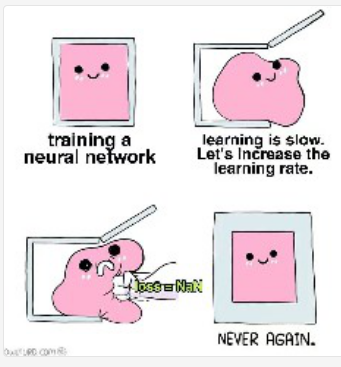

1. The first servious problem I met is when I made my DNN too deep and too fat, the learning rate has to be setted very small. Once I turn the LR a little bit large. LOSS = Nan is what I got.
For solving this problem, I decided to not make the NN too fat (hidden layer has too many nodes). Well, that fixes the problem.

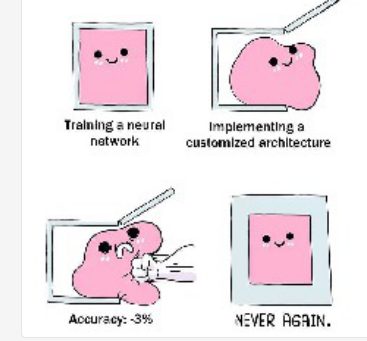

2. The second problem is everytime I altered the structure of my DNN, either it didn't improve at all and only became very slowly, or it had worse accruacy and MSE. Which is killing me, I haven't solved that problem yet.
I would say that maybe choose NN to solve our Fire FRP prediction is not a quite good idea. Since we have too few features in our dataset. Normally, we have hundreads or thoudsands of features to input in the NN. Well, now we have 7.

The following is the key of my model.
I set weight decay has the same value with learning_rate.

In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
config = {
    'seed': 5201314,      # Your seed number, you can pick your lucky number. :)
    'select_all': True,   # Whether to use all features.
    'valid_ratio': 0.2,   # validation_size = train_size * valid_ratio
    'n_epochs': 2000,     # Number of epochs. Try 2000 at first
    'batch_size': 5024,   # since we have a quite large dataset. The batch size should be large too
    'learning_rate': 1e-4,
    'early_stop': 200,    # If model has not improved for this many consecutive epochs, stop training.
    'save_path': './models/model.ckpt'  # Your model will be saved here.
}

#### DataLoader
Read data from files and set up training, validation, and testing sets.

In order to avoid confusing, let's re-generate our dataloader again.
Since we are using the same random seed, the result will be the same.

In [ ]:
def create_data_loader(model_train, model_test):
  # Set seed for reproducibility
  same_seed(config['seed'])

  train_data, test_data = model_train.values, model_test.values

  train_data, valid_data = train_valid_split(train_data, config['valid_ratio'], config['seed'])

  # Print out the data size.
  print(f"""train_data size: {train_data.shape}
  valid_data size: {valid_data.shape}
  test_data size: {test_data.shape}""")

  # Select features
  x_train, x_valid, x_test, y_train, y_valid, y_test = select_feat(train_data, valid_data, test_data, config['select_all'])

  # Print out the number of features.
  print(f'number of features: {x_train.shape[1]}')

  train_dataset, valid_dataset, test_dataset = Fire_Frp_Dataset(x_train, y_train), \
                                              Fire_Frp_Dataset(x_valid, y_valid), \
                                              Fire_Frp_Dataset(x_test,y_test)

  # Pytorch data loader loads pytorch dataset into batches.
  train_loader = DataLoader(train_dataset, batch_size=config['batch_size'], shuffle=True, pin_memory=True)
  valid_loader = DataLoader(valid_dataset, batch_size=config['batch_size'], shuffle=True, pin_memory=True)
  test_loader = DataLoader(test_dataset, batch_size=config['batch_size'], shuffle=False, pin_memory=True)
  return train_loader, valid_loader, test_loader


In [ ]:
train_loader, valid_loader, test_loader = create_data_loader(model_train, model_test)

train_data size: (97076, 7)
  valid_data size: (24268, 7)
  test_data size: (30336, 7)
number of features: 6


### 3.6.2 Training Procedure and evaluate

We have everything we need, let's start to train the model.

In [ ]:
model = My_Model(input_dim = train_loader.dataset.x.shape[1]).to(device) # put your model and data on the same computation device.
# loss_record_plot = {'train': [], 'dev': []}      # for recording training loss
loss_record_plot = trainer(train_loader, valid_loader, model, config, device);

Epoch [1/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.24it/s, loss=5.43e+3]


Epoch [1/2000]: Train loss: 5661.8937, Valid loss: 5571.1125
Saving model with loss 5571.113...


Epoch [2/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.82it/s, loss=5.11e+3]


Epoch [2/2000]: Train loss: 5649.9480, Valid loss: 5579.5488


Epoch [3/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.97it/s, loss=5.32e+3]


Epoch [3/2000]: Train loss: 5656.0878, Valid loss: 5572.5723


Epoch [4/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.25it/s, loss=5.66e+3]


Epoch [4/2000]: Train loss: 5666.6007, Valid loss: 5562.1986
Saving model with loss 5562.199...


Epoch [5/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.14it/s, loss=5.31e+3]


Epoch [5/2000]: Train loss: 5652.9540, Valid loss: 5569.4351


Epoch [6/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.83it/s, loss=5.91e+3]


Epoch [6/2000]: Train loss: 5671.2713, Valid loss: 5567.1937


Epoch [7/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.89it/s, loss=5.65e+3]


Epoch [7/2000]: Train loss: 5660.6852, Valid loss: 5576.9528


Epoch [8/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.91it/s, loss=5.49e+3]


Epoch [8/2000]: Train loss: 5652.8790, Valid loss: 5557.6966
Saving model with loss 5557.697...


Epoch [9/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.84it/s, loss=6.01e+3]


Epoch [9/2000]: Train loss: 5665.8159, Valid loss: 5548.9969
Saving model with loss 5548.997...


Epoch [10/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.96it/s, loss=5.72e+3]


Epoch [10/2000]: Train loss: 5645.5151, Valid loss: 5527.4580
Saving model with loss 5527.458...


Epoch [11/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.10it/s, loss=5.25e+3]


Epoch [11/2000]: Train loss: 5606.9407, Valid loss: 5498.4147
Saving model with loss 5498.415...


Epoch [12/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.68it/s, loss=5.72e+3]


Epoch [12/2000]: Train loss: 5572.9122, Valid loss: 5423.8993
Saving model with loss 5423.899...


Epoch [13/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.92it/s, loss=5.4e+3]


Epoch [13/2000]: Train loss: 5459.6083, Valid loss: 5285.7696
Saving model with loss 5285.770...


Epoch [14/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.85it/s, loss=4.76e+3]


Epoch [14/2000]: Train loss: 5237.3496, Valid loss: 4988.5334
Saving model with loss 4988.533...


Epoch [15/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.80it/s, loss=4.13e+3]


Epoch [15/2000]: Train loss: 4853.2819, Valid loss: 4514.1247
Saving model with loss 4514.125...


Epoch [16/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.09it/s, loss=3.78e+3]


Epoch [16/2000]: Train loss: 4248.6052, Valid loss: 3767.8344
Saving model with loss 3767.834...


Epoch [17/2000]: 100%|██████████| 20/20 [00:02<00:00,  6.97it/s, loss=2.96e+3]


Epoch [17/2000]: Train loss: 3397.4357, Valid loss: 2854.6276
Saving model with loss 2854.628...


Epoch [18/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.99it/s, loss=1.98e+3]


Epoch [18/2000]: Train loss: 2536.3265, Valid loss: 2187.4031
Saving model with loss 2187.403...


Epoch [19/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.88it/s, loss=2.17e+3]


Epoch [19/2000]: Train loss: 2101.8476, Valid loss: 1980.8766
Saving model with loss 1980.877...


Epoch [20/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.88it/s, loss=2.05e+3]


Epoch [20/2000]: Train loss: 1980.6840, Valid loss: 1909.6842
Saving model with loss 1909.684...


Epoch [21/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.43it/s, loss=1.94e+3]


Epoch [21/2000]: Train loss: 1903.1901, Valid loss: 1843.5165
Saving model with loss 1843.516...


Epoch [22/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.53it/s, loss=1.92e+3]


Epoch [22/2000]: Train loss: 1839.6681, Valid loss: 1781.2822
Saving model with loss 1781.282...


Epoch [23/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.70it/s, loss=1.72e+3]


Epoch [23/2000]: Train loss: 1776.3645, Valid loss: 1725.5042
Saving model with loss 1725.504...


Epoch [24/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.84it/s, loss=1.79e+3]


Epoch [24/2000]: Train loss: 1727.2668, Valid loss: 1672.7569
Saving model with loss 1672.757...


Epoch [25/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.49it/s, loss=1.61e+3]


Epoch [25/2000]: Train loss: 1672.4155, Valid loss: 1623.3067
Saving model with loss 1623.307...


Epoch [26/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.90it/s, loss=1.97e+3]


Epoch [26/2000]: Train loss: 1638.1061, Valid loss: 1582.7172
Saving model with loss 1582.717...


Epoch [27/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.36it/s, loss=1.5e+3]


Epoch [27/2000]: Train loss: 1577.2326, Valid loss: 1539.3901
Saving model with loss 1539.390...


Epoch [28/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.72it/s, loss=1.38e+3]


Epoch [28/2000]: Train loss: 1530.2753, Valid loss: 1495.5515
Saving model with loss 1495.551...


Epoch [29/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.54it/s, loss=1.42e+3]


Epoch [29/2000]: Train loss: 1489.1444, Valid loss: 1452.8354
Saving model with loss 1452.835...


Epoch [30/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.67it/s, loss=1.3e+3]


Epoch [30/2000]: Train loss: 1444.1019, Valid loss: 1406.2690
Saving model with loss 1406.269...


Epoch [31/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.51it/s, loss=1.35e+3]


Epoch [31/2000]: Train loss: 1404.8676, Valid loss: 1365.2673
Saving model with loss 1365.267...


Epoch [32/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.61it/s, loss=1.27e+3]


Epoch [32/2000]: Train loss: 1362.0082, Valid loss: 1326.0144
Saving model with loss 1326.014...


Epoch [33/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.82it/s, loss=1.17e+3]


Epoch [33/2000]: Train loss: 1318.7127, Valid loss: 1285.7819
Saving model with loss 1285.782...


Epoch [34/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.51it/s, loss=1.24e+3]


Epoch [34/2000]: Train loss: 1282.0670, Valid loss: 1248.1492
Saving model with loss 1248.149...


Epoch [35/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.79it/s, loss=1.1e+3]


Epoch [35/2000]: Train loss: 1237.8771, Valid loss: 1209.5039
Saving model with loss 1209.504...


Epoch [36/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.59it/s, loss=1.15e+3]


Epoch [36/2000]: Train loss: 1200.8136, Valid loss: 1171.5948
Saving model with loss 1171.595...


Epoch [37/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.72it/s, loss=1.13e+3]


Epoch [37/2000]: Train loss: 1161.5529, Valid loss: 1128.0200
Saving model with loss 1128.020...


Epoch [38/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.68it/s, loss=1.09e+3]


Epoch [38/2000]: Train loss: 1121.1780, Valid loss: 1092.7647
Saving model with loss 1092.765...


Epoch [39/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.69it/s, loss=888]


Epoch [39/2000]: Train loss: 1076.1019, Valid loss: 1052.8599
Saving model with loss 1052.860...


Epoch [40/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.61it/s, loss=1.06e+3]


Epoch [40/2000]: Train loss: 1043.6975, Valid loss: 1015.4103
Saving model with loss 1015.410...


Epoch [41/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.91it/s, loss=899]


Epoch [41/2000]: Train loss: 1000.2457, Valid loss: 975.5460
Saving model with loss 975.546...


Epoch [42/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.67it/s, loss=829]


Epoch [42/2000]: Train loss: 960.2576, Valid loss: 934.6851
Saving model with loss 934.685...


Epoch [43/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.75it/s, loss=928]


Epoch [43/2000]: Train loss: 926.0392, Valid loss: 900.4697
Saving model with loss 900.470...


Epoch [44/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.83it/s, loss=867]


Epoch [44/2000]: Train loss: 886.7655, Valid loss: 862.6175
Saving model with loss 862.617...


Epoch [45/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.81it/s, loss=825]


Epoch [45/2000]: Train loss: 848.5370, Valid loss: 821.4846
Saving model with loss 821.485...


Epoch [46/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.58it/s, loss=971]


Epoch [46/2000]: Train loss: 817.0283, Valid loss: 788.5116
Saving model with loss 788.512...


Epoch [47/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.80it/s, loss=808]


Epoch [47/2000]: Train loss: 775.3998, Valid loss: 748.9627
Saving model with loss 748.963...


Epoch [48/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.32it/s, loss=797]


Epoch [48/2000]: Train loss: 739.5964, Valid loss: 712.1967
Saving model with loss 712.197...


Epoch [49/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.42it/s, loss=679]


Epoch [49/2000]: Train loss: 700.9582, Valid loss: 677.7802
Saving model with loss 677.780...


Epoch [50/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.44it/s, loss=586]


Epoch [50/2000]: Train loss: 663.7817, Valid loss: 644.1970
Saving model with loss 644.197...


Epoch [51/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.86it/s, loss=576]


Epoch [51/2000]: Train loss: 630.3698, Valid loss: 613.5554
Saving model with loss 613.555...


Epoch [52/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.66it/s, loss=599]


Epoch [52/2000]: Train loss: 599.0528, Valid loss: 579.1614
Saving model with loss 579.161...


Epoch [53/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.79it/s, loss=501]


Epoch [53/2000]: Train loss: 564.5196, Valid loss: 547.5021
Saving model with loss 547.502...


Epoch [54/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.71it/s, loss=511]


Epoch [54/2000]: Train loss: 534.8089, Valid loss: 518.6781
Saving model with loss 518.678...


Epoch [55/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.64it/s, loss=494]


Epoch [55/2000]: Train loss: 505.3387, Valid loss: 487.5924
Saving model with loss 487.592...


Epoch [56/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.64it/s, loss=506]


Epoch [56/2000]: Train loss: 478.0151, Valid loss: 459.8758
Saving model with loss 459.876...


Epoch [57/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.79it/s, loss=364]


Epoch [57/2000]: Train loss: 446.6352, Valid loss: 432.6174
Saving model with loss 432.617...


Epoch [58/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.75it/s, loss=373]


Epoch [58/2000]: Train loss: 421.8991, Valid loss: 407.5172
Saving model with loss 407.517...


Epoch [59/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.76it/s, loss=380]


Epoch [59/2000]: Train loss: 398.7085, Valid loss: 385.9499
Saving model with loss 385.950...


Epoch [60/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.70it/s, loss=388]


Epoch [60/2000]: Train loss: 377.2790, Valid loss: 363.5703
Saving model with loss 363.570...


Epoch [61/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.87it/s, loss=408]


Epoch [61/2000]: Train loss: 357.7096, Valid loss: 341.3168
Saving model with loss 341.317...


Epoch [62/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.53it/s, loss=347]


Epoch [62/2000]: Train loss: 337.0191, Valid loss: 323.3792
Saving model with loss 323.379...


Epoch [63/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.59it/s, loss=322]


Epoch [63/2000]: Train loss: 319.1704, Valid loss: 307.0924
Saving model with loss 307.092...


Epoch [64/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.42it/s, loss=302]


Epoch [64/2000]: Train loss: 303.0939, Valid loss: 291.3718
Saving model with loss 291.372...


Epoch [65/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.42it/s, loss=288]


Epoch [65/2000]: Train loss: 288.4677, Valid loss: 277.7730
Saving model with loss 277.773...


Epoch [66/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.52it/s, loss=269]


Epoch [66/2000]: Train loss: 274.8903, Valid loss: 263.5237
Saving model with loss 263.524...


Epoch [67/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.65it/s, loss=249]


Epoch [67/2000]: Train loss: 262.5103, Valid loss: 252.3305
Saving model with loss 252.331...


Epoch [68/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.54it/s, loss=226]


Epoch [68/2000]: Train loss: 250.9649, Valid loss: 240.6368
Saving model with loss 240.637...


Epoch [69/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.48it/s, loss=271]


Epoch [69/2000]: Train loss: 242.5351, Valid loss: 231.5582
Saving model with loss 231.558...


Epoch [70/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.61it/s, loss=217]


Epoch [70/2000]: Train loss: 231.7728, Valid loss: 223.2093
Saving model with loss 223.209...


Epoch [71/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.61it/s, loss=206]


Epoch [71/2000]: Train loss: 223.1986, Valid loss: 215.0300
Saving model with loss 215.030...


Epoch [72/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.54it/s, loss=252]


Epoch [72/2000]: Train loss: 217.2259, Valid loss: 205.9259
Saving model with loss 205.926...


Epoch [73/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.25it/s, loss=172]


Epoch [73/2000]: Train loss: 207.5223, Valid loss: 199.9415
Saving model with loss 199.942...


Epoch [74/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.51it/s, loss=204]


Epoch [74/2000]: Train loss: 202.2766, Valid loss: 193.4129
Saving model with loss 193.413...


Epoch [75/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.35it/s, loss=214]


Epoch [75/2000]: Train loss: 196.8721, Valid loss: 188.5346
Saving model with loss 188.535...


Epoch [76/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.64it/s, loss=195]


Epoch [76/2000]: Train loss: 190.8915, Valid loss: 183.3201
Saving model with loss 183.320...


Epoch [77/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.67it/s, loss=188]


Epoch [77/2000]: Train loss: 185.7669, Valid loss: 177.7002
Saving model with loss 177.700...


Epoch [78/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.67it/s, loss=145]


Epoch [78/2000]: Train loss: 179.8638, Valid loss: 173.3676
Saving model with loss 173.368...


Epoch [79/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.59it/s, loss=163]


Epoch [79/2000]: Train loss: 176.3569, Valid loss: 169.7770
Saving model with loss 169.777...


Epoch [80/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.68it/s, loss=158]


Epoch [80/2000]: Train loss: 172.4915, Valid loss: 166.0096
Saving model with loss 166.010...


Epoch [81/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.60it/s, loss=153]


Epoch [81/2000]: Train loss: 168.6674, Valid loss: 162.5521
Saving model with loss 162.552...


Epoch [82/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.76it/s, loss=176]


Epoch [82/2000]: Train loss: 166.1813, Valid loss: 159.1969
Saving model with loss 159.197...


Epoch [83/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.51it/s, loss=159]


Epoch [83/2000]: Train loss: 162.5569, Valid loss: 156.2474
Saving model with loss 156.247...


Epoch [84/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.61it/s, loss=179]


Epoch [84/2000]: Train loss: 160.3810, Valid loss: 153.2622
Saving model with loss 153.262...


Epoch [85/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.34it/s, loss=168]


Epoch [85/2000]: Train loss: 157.3219, Valid loss: 151.0898
Saving model with loss 151.090...


Epoch [86/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.69it/s, loss=148]


Epoch [86/2000]: Train loss: 154.1206, Valid loss: 148.1886
Saving model with loss 148.189...


Epoch [87/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.80it/s, loss=136]


Epoch [87/2000]: Train loss: 151.3012, Valid loss: 146.5949
Saving model with loss 146.595...


Epoch [88/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.64it/s, loss=145]


Epoch [88/2000]: Train loss: 149.4120, Valid loss: 143.5416
Saving model with loss 143.542...


Epoch [89/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.73it/s, loss=144]


Epoch [89/2000]: Train loss: 147.1867, Valid loss: 141.7512
Saving model with loss 141.751...


Epoch [90/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.19it/s, loss=151]


Epoch [90/2000]: Train loss: 145.3401, Valid loss: 139.7152
Saving model with loss 139.715...


Epoch [91/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.55it/s, loss=132]


Epoch [91/2000]: Train loss: 142.8098, Valid loss: 137.8675
Saving model with loss 137.868...


Epoch [92/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.52it/s, loss=138]


Epoch [92/2000]: Train loss: 141.0066, Valid loss: 135.7244
Saving model with loss 135.724...


Epoch [93/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.54it/s, loss=147]


Epoch [93/2000]: Train loss: 139.4872, Valid loss: 133.6841
Saving model with loss 133.684...


Epoch [94/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.63it/s, loss=135]


Epoch [94/2000]: Train loss: 137.2819, Valid loss: 132.4938
Saving model with loss 132.494...


Epoch [95/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.71it/s, loss=128]


Epoch [95/2000]: Train loss: 135.2987, Valid loss: 130.3020
Saving model with loss 130.302...


Epoch [96/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.79it/s, loss=124]


Epoch [96/2000]: Train loss: 133.4948, Valid loss: 128.7511
Saving model with loss 128.751...


Epoch [97/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.66it/s, loss=119]


Epoch [97/2000]: Train loss: 131.6598, Valid loss: 126.5861
Saving model with loss 126.586...


Epoch [98/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.66it/s, loss=130]


Epoch [98/2000]: Train loss: 130.4819, Valid loss: 125.3744
Saving model with loss 125.374...


Epoch [99/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.67it/s, loss=118]


Epoch [99/2000]: Train loss: 128.5135, Valid loss: 123.8480
Saving model with loss 123.848...


Epoch [100/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.49it/s, loss=120]


Epoch [100/2000]: Train loss: 127.0336, Valid loss: 122.3653
Saving model with loss 122.365...


Epoch [101/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.42it/s, loss=119]


Epoch [101/2000]: Train loss: 125.5029, Valid loss: 120.9969
Saving model with loss 120.997...


Epoch [102/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.61it/s, loss=160]


Epoch [102/2000]: Train loss: 125.4282, Valid loss: 119.8468
Saving model with loss 119.847...


Epoch [103/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.41it/s, loss=106]


Epoch [103/2000]: Train loss: 122.1686, Valid loss: 118.4374
Saving model with loss 118.437...


Epoch [104/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.47it/s, loss=123]


Epoch [104/2000]: Train loss: 121.3624, Valid loss: 116.9309
Saving model with loss 116.931...


Epoch [105/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.70it/s, loss=113]


Epoch [105/2000]: Train loss: 119.6095, Valid loss: 115.1595
Saving model with loss 115.159...


Epoch [106/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.36it/s, loss=116]


Epoch [106/2000]: Train loss: 118.3572, Valid loss: 113.9403
Saving model with loss 113.940...


Epoch [107/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.42it/s, loss=103]


Epoch [107/2000]: Train loss: 116.5901, Valid loss: 112.9356
Saving model with loss 112.936...


Epoch [108/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.56it/s, loss=110]


Epoch [108/2000]: Train loss: 115.4883, Valid loss: 111.2545
Saving model with loss 111.255...


Epoch [109/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.57it/s, loss=112]


Epoch [109/2000]: Train loss: 114.2977, Valid loss: 110.4771
Saving model with loss 110.477...


Epoch [110/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.55it/s, loss=112]


Epoch [110/2000]: Train loss: 113.0048, Valid loss: 108.5605
Saving model with loss 108.561...


Epoch [111/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.47it/s, loss=92.8]


Epoch [111/2000]: Train loss: 111.0924, Valid loss: 107.6031
Saving model with loss 107.603...


Epoch [112/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.60it/s, loss=101]


Epoch [112/2000]: Train loss: 110.2034, Valid loss: 106.0007
Saving model with loss 106.001...


Epoch [113/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.57it/s, loss=105]


Epoch [113/2000]: Train loss: 109.1310, Valid loss: 105.2391
Saving model with loss 105.239...


Epoch [114/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.72it/s, loss=115]


Epoch [114/2000]: Train loss: 108.3280, Valid loss: 103.8601
Saving model with loss 103.860...


Epoch [115/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.55it/s, loss=110]


Epoch [115/2000]: Train loss: 106.9764, Valid loss: 102.8862
Saving model with loss 102.886...


Epoch [116/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.47it/s, loss=110]


Epoch [116/2000]: Train loss: 105.8939, Valid loss: 101.7837
Saving model with loss 101.784...


Epoch [117/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.55it/s, loss=102]


Epoch [117/2000]: Train loss: 104.5620, Valid loss: 100.5366
Saving model with loss 100.537...


Epoch [118/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.59it/s, loss=103]


Epoch [118/2000]: Train loss: 103.4641, Valid loss: 99.4086
Saving model with loss 99.409...


Epoch [119/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.49it/s, loss=105]


Epoch [119/2000]: Train loss: 102.4945, Valid loss: 98.5887
Saving model with loss 98.589...


Epoch [120/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.67it/s, loss=89.7]


Epoch [120/2000]: Train loss: 101.0139, Valid loss: 97.5706
Saving model with loss 97.571...


Epoch [121/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.20it/s, loss=95.1]


Epoch [121/2000]: Train loss: 100.1722, Valid loss: 96.5552
Saving model with loss 96.555...


Epoch [122/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.51it/s, loss=120]


Epoch [122/2000]: Train loss: 100.0500, Valid loss: 95.4443
Saving model with loss 95.444...


Epoch [123/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.42it/s, loss=103]


Epoch [123/2000]: Train loss: 98.5295, Valid loss: 94.9562
Saving model with loss 94.956...


Epoch [124/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.61it/s, loss=99.5]


Epoch [124/2000]: Train loss: 97.4706, Valid loss: 93.7021
Saving model with loss 93.702...


Epoch [125/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.61it/s, loss=127]


Epoch [125/2000]: Train loss: 97.4981, Valid loss: 93.1325
Saving model with loss 93.133...


Epoch [126/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.65it/s, loss=96.9]


Epoch [126/2000]: Train loss: 95.6022, Valid loss: 91.8780
Saving model with loss 91.878...


Epoch [127/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.80it/s, loss=87.7]


Epoch [127/2000]: Train loss: 94.4285, Valid loss: 90.8380
Saving model with loss 90.838...


Epoch [128/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.72it/s, loss=110]


Epoch [128/2000]: Train loss: 94.3334, Valid loss: 90.3859
Saving model with loss 90.386...


Epoch [129/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.56it/s, loss=106]


Epoch [129/2000]: Train loss: 93.3779, Valid loss: 89.4623
Saving model with loss 89.462...


Epoch [130/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.34it/s, loss=94]


Epoch [130/2000]: Train loss: 92.1997, Valid loss: 88.4397
Saving model with loss 88.440...


Epoch [131/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.41it/s, loss=98.2]


Epoch [131/2000]: Train loss: 91.6408, Valid loss: 88.0424
Saving model with loss 88.042...


Epoch [132/2000]: 100%|██████████| 20/20 [00:02<00:00,  6.92it/s, loss=77.5]


Epoch [132/2000]: Train loss: 90.2126, Valid loss: 87.2387
Saving model with loss 87.239...


Epoch [133/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.18it/s, loss=82.7]


Epoch [133/2000]: Train loss: 89.6223, Valid loss: 86.8617
Saving model with loss 86.862...


Epoch [134/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.84it/s, loss=74.5]


Epoch [134/2000]: Train loss: 88.7184, Valid loss: 85.7707
Saving model with loss 85.771...


Epoch [135/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.29it/s, loss=99]


Epoch [135/2000]: Train loss: 88.8079, Valid loss: 85.1680
Saving model with loss 85.168...


Epoch [136/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.46it/s, loss=78.5]


Epoch [136/2000]: Train loss: 87.4635, Valid loss: 84.2513
Saving model with loss 84.251...


Epoch [137/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.06it/s, loss=101]


Epoch [137/2000]: Train loss: 87.6682, Valid loss: 83.8902
Saving model with loss 83.890...


Epoch [138/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.28it/s, loss=88.5]


Epoch [138/2000]: Train loss: 86.6097, Valid loss: 83.2623
Saving model with loss 83.262...


Epoch [139/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.42it/s, loss=84.3]


Epoch [139/2000]: Train loss: 85.8647, Valid loss: 83.1144
Saving model with loss 83.114...


Epoch [140/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.39it/s, loss=73.3]


Epoch [140/2000]: Train loss: 84.9484, Valid loss: 82.4100
Saving model with loss 82.410...


Epoch [141/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.47it/s, loss=83.9]


Epoch [141/2000]: Train loss: 84.7344, Valid loss: 82.0597
Saving model with loss 82.060...


Epoch [142/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.44it/s, loss=93.6]


Epoch [142/2000]: Train loss: 84.5422, Valid loss: 81.0732
Saving model with loss 81.073...


Epoch [143/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.46it/s, loss=86]


Epoch [143/2000]: Train loss: 83.7875, Valid loss: 80.7663
Saving model with loss 80.766...


Epoch [144/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.36it/s, loss=86.5]


Epoch [144/2000]: Train loss: 83.2732, Valid loss: 80.2382
Saving model with loss 80.238...


Epoch [145/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.44it/s, loss=77.2]


Epoch [145/2000]: Train loss: 82.4388, Valid loss: 79.8606
Saving model with loss 79.861...


Epoch [146/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.72it/s, loss=90.5]


Epoch [146/2000]: Train loss: 82.4408, Valid loss: 79.2568
Saving model with loss 79.257...


Epoch [147/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.33it/s, loss=79]


Epoch [147/2000]: Train loss: 81.6229, Valid loss: 78.6454
Saving model with loss 78.645...


Epoch [148/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.73it/s, loss=97]


Epoch [148/2000]: Train loss: 81.7886, Valid loss: 78.6522


Epoch [149/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.53it/s, loss=80.1]


Epoch [149/2000]: Train loss: 80.7835, Valid loss: 77.9706
Saving model with loss 77.971...


Epoch [150/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.60it/s, loss=74.4]


Epoch [150/2000]: Train loss: 80.1036, Valid loss: 77.4543
Saving model with loss 77.454...


Epoch [151/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.49it/s, loss=78.8]


Epoch [151/2000]: Train loss: 79.8628, Valid loss: 77.0585
Saving model with loss 77.058...


Epoch [152/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.57it/s, loss=81.5]


Epoch [152/2000]: Train loss: 79.5898, Valid loss: 76.7475
Saving model with loss 76.747...


Epoch [153/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.44it/s, loss=74.7]


Epoch [153/2000]: Train loss: 78.9115, Valid loss: 76.4864
Saving model with loss 76.486...


Epoch [154/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.46it/s, loss=66.4]


Epoch [154/2000]: Train loss: 78.2556, Valid loss: 76.1144
Saving model with loss 76.114...


Epoch [155/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.49it/s, loss=81.1]


Epoch [155/2000]: Train loss: 78.3662, Valid loss: 75.4502
Saving model with loss 75.450...


Epoch [156/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.56it/s, loss=79.5]


Epoch [156/2000]: Train loss: 78.0837, Valid loss: 75.3652
Saving model with loss 75.365...


Epoch [157/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.51it/s, loss=75]


Epoch [157/2000]: Train loss: 77.5925, Valid loss: 75.2266
Saving model with loss 75.227...


Epoch [158/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.49it/s, loss=80.4]


Epoch [158/2000]: Train loss: 77.3185, Valid loss: 74.5790
Saving model with loss 74.579...


Epoch [159/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.62it/s, loss=83.2]


Epoch [159/2000]: Train loss: 77.1283, Valid loss: 74.0826
Saving model with loss 74.083...


Epoch [160/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.61it/s, loss=77.9]


Epoch [160/2000]: Train loss: 76.6285, Valid loss: 74.0565
Saving model with loss 74.057...


Epoch [161/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.44it/s, loss=84.4]


Epoch [161/2000]: Train loss: 76.4686, Valid loss: 73.7702
Saving model with loss 73.770...


Epoch [162/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.49it/s, loss=75.1]


Epoch [162/2000]: Train loss: 75.8627, Valid loss: 73.6348
Saving model with loss 73.635...


Epoch [163/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.40it/s, loss=84.7]


Epoch [163/2000]: Train loss: 75.8978, Valid loss: 73.2132
Saving model with loss 73.213...


Epoch [164/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.59it/s, loss=74.8]


Epoch [164/2000]: Train loss: 75.3962, Valid loss: 72.7483
Saving model with loss 72.748...


Epoch [165/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.51it/s, loss=76.1]


Epoch [165/2000]: Train loss: 75.0319, Valid loss: 72.5360
Saving model with loss 72.536...


Epoch [166/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.44it/s, loss=75.2]


Epoch [166/2000]: Train loss: 74.6847, Valid loss: 72.2381
Saving model with loss 72.238...


Epoch [167/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.26it/s, loss=69.7]


Epoch [167/2000]: Train loss: 74.1802, Valid loss: 71.9847
Saving model with loss 71.985...


Epoch [168/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.27it/s, loss=67.9]


Epoch [168/2000]: Train loss: 73.9322, Valid loss: 71.6058
Saving model with loss 71.606...


Epoch [169/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.60it/s, loss=73.9]


Epoch [169/2000]: Train loss: 73.7746, Valid loss: 71.6351


Epoch [170/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.43it/s, loss=77.6]


Epoch [170/2000]: Train loss: 73.6465, Valid loss: 71.4430
Saving model with loss 71.443...


Epoch [171/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.48it/s, loss=82.3]


Epoch [171/2000]: Train loss: 73.5789, Valid loss: 71.0747
Saving model with loss 71.075...


Epoch [172/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.38it/s, loss=65.1]


Epoch [172/2000]: Train loss: 72.7464, Valid loss: 71.2937


Epoch [173/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.49it/s, loss=73.7]


Epoch [173/2000]: Train loss: 72.8390, Valid loss: 70.1890
Saving model with loss 70.189...


Epoch [174/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.48it/s, loss=68.7]


Epoch [174/2000]: Train loss: 72.3387, Valid loss: 70.4872


Epoch [175/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.69it/s, loss=83.8]


Epoch [175/2000]: Train loss: 72.6360, Valid loss: 70.1013
Saving model with loss 70.101...


Epoch [176/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.37it/s, loss=68]


Epoch [176/2000]: Train loss: 71.7885, Valid loss: 69.7693
Saving model with loss 69.769...


Epoch [177/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.27it/s, loss=68.5]


Epoch [177/2000]: Train loss: 71.5677, Valid loss: 69.6673
Saving model with loss 69.667...


Epoch [178/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.56it/s, loss=68.5]


Epoch [178/2000]: Train loss: 71.3537, Valid loss: 69.6535
Saving model with loss 69.654...


Epoch [179/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.49it/s, loss=68.2]


Epoch [179/2000]: Train loss: 71.1122, Valid loss: 69.2558
Saving model with loss 69.256...


Epoch [180/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.59it/s, loss=73]


Epoch [180/2000]: Train loss: 71.0325, Valid loss: 68.9372
Saving model with loss 68.937...


Epoch [181/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.55it/s, loss=66]


Epoch [181/2000]: Train loss: 70.5738, Valid loss: 68.6589
Saving model with loss 68.659...


Epoch [182/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.56it/s, loss=66.6]


Epoch [182/2000]: Train loss: 70.4081, Valid loss: 68.7882


Epoch [183/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.57it/s, loss=64.8]


Epoch [183/2000]: Train loss: 70.1097, Valid loss: 68.2503
Saving model with loss 68.250...


Epoch [184/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.42it/s, loss=61.3]


Epoch [184/2000]: Train loss: 69.7750, Valid loss: 68.0068
Saving model with loss 68.007...


Epoch [185/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.55it/s, loss=72.2]


Epoch [185/2000]: Train loss: 69.9203, Valid loss: 67.9971
Saving model with loss 67.997...


Epoch [186/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.29it/s, loss=61]


Epoch [186/2000]: Train loss: 69.3493, Valid loss: 67.9409
Saving model with loss 67.941...


Epoch [187/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.25it/s, loss=70.1]


Epoch [187/2000]: Train loss: 69.4523, Valid loss: 67.4918
Saving model with loss 67.492...


Epoch [188/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.26it/s, loss=62.4]


Epoch [188/2000]: Train loss: 68.9520, Valid loss: 67.4469
Saving model with loss 67.447...


Epoch [189/2000]: 100%|██████████| 20/20 [00:02<00:00,  6.84it/s, loss=83.6]


Epoch [189/2000]: Train loss: 69.5043, Valid loss: 67.2668
Saving model with loss 67.267...


Epoch [190/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.15it/s, loss=66.9]


Epoch [190/2000]: Train loss: 68.7222, Valid loss: 66.8183
Saving model with loss 66.818...


Epoch [191/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.29it/s, loss=80.3]


Epoch [191/2000]: Train loss: 69.0109, Valid loss: 66.7783
Saving model with loss 66.778...


Epoch [192/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.21it/s, loss=60.1]


Epoch [192/2000]: Train loss: 68.1517, Valid loss: 66.6203
Saving model with loss 66.620...


Epoch [193/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.62it/s, loss=69.5]


Epoch [193/2000]: Train loss: 68.2886, Valid loss: 66.4420
Saving model with loss 66.442...


Epoch [194/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.99it/s, loss=69.9]


Epoch [194/2000]: Train loss: 68.1347, Valid loss: 66.2759
Saving model with loss 66.276...


Epoch [195/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.25it/s, loss=72.4]


Epoch [195/2000]: Train loss: 68.0024, Valid loss: 66.1738
Saving model with loss 66.174...


Epoch [196/2000]: 100%|██████████| 20/20 [00:02<00:00,  6.90it/s, loss=58]


Epoch [196/2000]: Train loss: 67.2842, Valid loss: 65.7155
Saving model with loss 65.716...


Epoch [197/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.69it/s, loss=63]


Epoch [197/2000]: Train loss: 67.2853, Valid loss: 65.7207


Epoch [198/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.09it/s, loss=79.5]


Epoch [198/2000]: Train loss: 67.6982, Valid loss: 65.6400
Saving model with loss 65.640...


Epoch [199/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.31it/s, loss=66.8]


Epoch [199/2000]: Train loss: 67.1014, Valid loss: 65.3492
Saving model with loss 65.349...


Epoch [200/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.73it/s, loss=80]


Epoch [200/2000]: Train loss: 67.3623, Valid loss: 65.3509


Epoch [201/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.73it/s, loss=71.7]


Epoch [201/2000]: Train loss: 66.8773, Valid loss: 65.2362
Saving model with loss 65.236...


Epoch [202/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.67it/s, loss=58.7]


Epoch [202/2000]: Train loss: 66.3626, Valid loss: 64.9278
Saving model with loss 64.928...


Epoch [203/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.33it/s, loss=57.6]


Epoch [203/2000]: Train loss: 66.0884, Valid loss: 64.5754
Saving model with loss 64.575...


Epoch [204/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.15it/s, loss=63.1]


Epoch [204/2000]: Train loss: 66.0863, Valid loss: 64.5551
Saving model with loss 64.555...


Epoch [205/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.66it/s, loss=67.6]


Epoch [205/2000]: Train loss: 66.0381, Valid loss: 64.4781
Saving model with loss 64.478...


Epoch [206/2000]: 100%|██████████| 20/20 [00:02<00:00,  6.77it/s, loss=63]


Epoch [206/2000]: Train loss: 65.7104, Valid loss: 64.2116
Saving model with loss 64.212...


Epoch [207/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.92it/s, loss=65.8]


Epoch [207/2000]: Train loss: 65.6581, Valid loss: 64.1293
Saving model with loss 64.129...


Epoch [208/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.88it/s, loss=67.5]


Epoch [208/2000]: Train loss: 65.5542, Valid loss: 63.9770
Saving model with loss 63.977...


Epoch [209/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.16it/s, loss=82.8]


Epoch [209/2000]: Train loss: 65.9132, Valid loss: 63.9739
Saving model with loss 63.974...


Epoch [210/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.36it/s, loss=63.3]


Epoch [210/2000]: Train loss: 65.1061, Valid loss: 63.7840
Saving model with loss 63.784...


Epoch [211/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.17it/s, loss=64.1]


Epoch [211/2000]: Train loss: 65.0015, Valid loss: 63.4276
Saving model with loss 63.428...


Epoch [212/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.51it/s, loss=66.6]


Epoch [212/2000]: Train loss: 64.9628, Valid loss: 63.5049


Epoch [213/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.30it/s, loss=61.6]


Epoch [213/2000]: Train loss: 64.5373, Valid loss: 63.1780
Saving model with loss 63.178...


Epoch [214/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.49it/s, loss=61.9]


Epoch [214/2000]: Train loss: 64.4242, Valid loss: 62.7330
Saving model with loss 62.733...


Epoch [215/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.15it/s, loss=75]


Epoch [215/2000]: Train loss: 64.7499, Valid loss: 62.9577


Epoch [216/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.09it/s, loss=58.9]


Epoch [216/2000]: Train loss: 64.0179, Valid loss: 62.6129
Saving model with loss 62.613...


Epoch [217/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.05it/s, loss=70.7]


Epoch [217/2000]: Train loss: 64.2403, Valid loss: 62.3703
Saving model with loss 62.370...


Epoch [218/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.66it/s, loss=58.7]


Epoch [218/2000]: Train loss: 63.7957, Valid loss: 62.5406


Epoch [219/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.05it/s, loss=67.1]


Epoch [219/2000]: Train loss: 63.8151, Valid loss: 62.1336
Saving model with loss 62.134...


Epoch [220/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.95it/s, loss=64.5]


Epoch [220/2000]: Train loss: 63.6592, Valid loss: 62.1342


Epoch [221/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.30it/s, loss=65.4]


Epoch [221/2000]: Train loss: 63.5071, Valid loss: 62.1126
Saving model with loss 62.113...


Epoch [222/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.06it/s, loss=70]


Epoch [222/2000]: Train loss: 63.4997, Valid loss: 61.8053
Saving model with loss 61.805...


Epoch [223/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.41it/s, loss=51.3]


Epoch [223/2000]: Train loss: 62.7280, Valid loss: 61.7691
Saving model with loss 61.769...


Epoch [224/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.99it/s, loss=56.3]


Epoch [224/2000]: Train loss: 62.7612, Valid loss: 61.4728
Saving model with loss 61.473...


Epoch [225/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.57it/s, loss=67.8]


Epoch [225/2000]: Train loss: 63.0003, Valid loss: 61.3751
Saving model with loss 61.375...


Epoch [226/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.91it/s, loss=62.8]


Epoch [226/2000]: Train loss: 62.6867, Valid loss: 61.6085


Epoch [227/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.32it/s, loss=58.2]


Epoch [227/2000]: Train loss: 62.4448, Valid loss: 61.0210
Saving model with loss 61.021...


Epoch [228/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.80it/s, loss=67.9]


Epoch [228/2000]: Train loss: 62.5426, Valid loss: 60.8962
Saving model with loss 60.896...


Epoch [229/2000]: 100%|██████████| 20/20 [00:02<00:00,  6.68it/s, loss=60.3]


Epoch [229/2000]: Train loss: 62.1620, Valid loss: 61.1411


Epoch [230/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.04it/s, loss=60.6]


Epoch [230/2000]: Train loss: 62.0483, Valid loss: 60.8078
Saving model with loss 60.808...


Epoch [231/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.87it/s, loss=55.6]


Epoch [231/2000]: Train loss: 61.7170, Valid loss: 60.6792
Saving model with loss 60.679...


Epoch [232/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.21it/s, loss=58.5]


Epoch [232/2000]: Train loss: 61.6921, Valid loss: 60.9225


Epoch [233/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.25it/s, loss=61.4]


Epoch [233/2000]: Train loss: 61.6112, Valid loss: 60.2290
Saving model with loss 60.229...


Epoch [234/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.08it/s, loss=66.7]


Epoch [234/2000]: Train loss: 61.6616, Valid loss: 60.2692


Epoch [235/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.17it/s, loss=56.2]


Epoch [235/2000]: Train loss: 61.2061, Valid loss: 60.1299
Saving model with loss 60.130...


Epoch [236/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.07it/s, loss=60.4]


Epoch [236/2000]: Train loss: 61.2119, Valid loss: 60.0314
Saving model with loss 60.031...


Epoch [237/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.01it/s, loss=55.6]


Epoch [237/2000]: Train loss: 60.9275, Valid loss: 59.8655
Saving model with loss 59.866...


Epoch [238/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.69it/s, loss=58]


Epoch [238/2000]: Train loss: 60.8255, Valid loss: 59.4998
Saving model with loss 59.500...


Epoch [239/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.46it/s, loss=74.2]


Epoch [239/2000]: Train loss: 61.2735, Valid loss: 59.3551
Saving model with loss 59.355...


Epoch [240/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.39it/s, loss=57.4]


Epoch [240/2000]: Train loss: 60.5872, Valid loss: 59.3573


Epoch [241/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.06it/s, loss=69.7]


Epoch [241/2000]: Train loss: 60.8841, Valid loss: 59.2881
Saving model with loss 59.288...


Epoch [242/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.61it/s, loss=71.7]


Epoch [242/2000]: Train loss: 60.7594, Valid loss: 59.0251
Saving model with loss 59.025...


Epoch [243/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.43it/s, loss=50.6]


Epoch [243/2000]: Train loss: 59.9004, Valid loss: 59.1340


Epoch [244/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.48it/s, loss=63.7]


Epoch [244/2000]: Train loss: 60.2070, Valid loss: 58.8745
Saving model with loss 58.874...


Epoch [245/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.37it/s, loss=53.8]


Epoch [245/2000]: Train loss: 59.7565, Valid loss: 58.6291
Saving model with loss 58.629...


Epoch [246/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.15it/s, loss=56.4]


Epoch [246/2000]: Train loss: 59.7577, Valid loss: 58.7017


Epoch [247/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.29it/s, loss=60]


Epoch [247/2000]: Train loss: 59.6985, Valid loss: 58.3713
Saving model with loss 58.371...


Epoch [248/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.55it/s, loss=54.3]


Epoch [248/2000]: Train loss: 59.4474, Valid loss: 58.3915


Epoch [249/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.31it/s, loss=59.5]


Epoch [249/2000]: Train loss: 59.4596, Valid loss: 58.3461
Saving model with loss 58.346...


Epoch [250/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.38it/s, loss=58.7]


Epoch [250/2000]: Train loss: 59.3009, Valid loss: 58.3327
Saving model with loss 58.333...


Epoch [251/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.28it/s, loss=57]


Epoch [251/2000]: Train loss: 59.1009, Valid loss: 58.2878
Saving model with loss 58.288...


Epoch [252/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.38it/s, loss=63.3]


Epoch [252/2000]: Train loss: 59.2471, Valid loss: 57.9205
Saving model with loss 57.920...


Epoch [253/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.22it/s, loss=62.6]


Epoch [253/2000]: Train loss: 59.0987, Valid loss: 57.5994
Saving model with loss 57.599...


Epoch [254/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.32it/s, loss=56.6]


Epoch [254/2000]: Train loss: 58.7209, Valid loss: 57.5456
Saving model with loss 57.546...


Epoch [255/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.96it/s, loss=55.8]


Epoch [255/2000]: Train loss: 58.5368, Valid loss: 57.7462


Epoch [256/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.28it/s, loss=63.8]


Epoch [256/2000]: Train loss: 58.8727, Valid loss: 57.3233
Saving model with loss 57.323...


Epoch [257/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.31it/s, loss=57]


Epoch [257/2000]: Train loss: 58.3570, Valid loss: 57.1575
Saving model with loss 57.157...


Epoch [258/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.45it/s, loss=58.7]


Epoch [258/2000]: Train loss: 58.2591, Valid loss: 57.0665
Saving model with loss 57.066...


Epoch [259/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.09it/s, loss=61.8]


Epoch [259/2000]: Train loss: 58.2882, Valid loss: 56.9956
Saving model with loss 56.996...


Epoch [260/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.15it/s, loss=62.3]


Epoch [260/2000]: Train loss: 58.1318, Valid loss: 57.2443


Epoch [261/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.48it/s, loss=57.4]


Epoch [261/2000]: Train loss: 57.8752, Valid loss: 56.8577
Saving model with loss 56.858...


Epoch [262/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.84it/s, loss=54.9]


Epoch [262/2000]: Train loss: 57.6842, Valid loss: 56.8886


Epoch [263/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.32it/s, loss=64.9]


Epoch [263/2000]: Train loss: 57.8789, Valid loss: 56.5870
Saving model with loss 56.587...


Epoch [264/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.19it/s, loss=50.2]


Epoch [264/2000]: Train loss: 57.2378, Valid loss: 56.4751
Saving model with loss 56.475...


Epoch [265/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.37it/s, loss=59.1]


Epoch [265/2000]: Train loss: 57.3883, Valid loss: 56.8315


Epoch [266/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.59it/s, loss=49.3]


Epoch [266/2000]: Train loss: 57.0782, Valid loss: 56.2090
Saving model with loss 56.209...


Epoch [267/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.50it/s, loss=58.6]


Epoch [267/2000]: Train loss: 57.2301, Valid loss: 56.1292
Saving model with loss 56.129...


Epoch [268/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.95it/s, loss=52.3]


Epoch [268/2000]: Train loss: 56.8805, Valid loss: 56.1479


Epoch [269/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.28it/s, loss=54.8]


Epoch [269/2000]: Train loss: 56.7952, Valid loss: 55.8164
Saving model with loss 55.816...


Epoch [270/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.32it/s, loss=53.4]


Epoch [270/2000]: Train loss: 56.6169, Valid loss: 55.7368
Saving model with loss 55.737...


Epoch [271/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.10it/s, loss=50.5]


Epoch [271/2000]: Train loss: 56.4329, Valid loss: 55.6208
Saving model with loss 55.621...


Epoch [272/2000]: 100%|██████████| 20/20 [00:04<00:00,  5.00it/s, loss=61.5]


Epoch [272/2000]: Train loss: 56.7021, Valid loss: 55.4726
Saving model with loss 55.473...


Epoch [273/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.31it/s, loss=49.8]


Epoch [273/2000]: Train loss: 56.1857, Valid loss: 55.2935
Saving model with loss 55.294...


Epoch [274/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.17it/s, loss=56.3]


Epoch [274/2000]: Train loss: 56.2567, Valid loss: 55.6856


Epoch [275/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.28it/s, loss=53.8]


Epoch [275/2000]: Train loss: 56.1199, Valid loss: 55.1049
Saving model with loss 55.105...


Epoch [276/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.48it/s, loss=53]


Epoch [276/2000]: Train loss: 55.9170, Valid loss: 55.0315
Saving model with loss 55.031...


Epoch [277/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.10it/s, loss=61.3]


Epoch [277/2000]: Train loss: 56.1854, Valid loss: 55.1804


Epoch [278/2000]: 100%|██████████| 20/20 [00:02<00:00,  6.83it/s, loss=59.8]


Epoch [278/2000]: Train loss: 55.9821, Valid loss: 54.7137
Saving model with loss 54.714...


Epoch [279/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.65it/s, loss=56.6]


Epoch [279/2000]: Train loss: 55.7355, Valid loss: 54.8888


Epoch [280/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.28it/s, loss=47.8]


Epoch [280/2000]: Train loss: 55.4221, Valid loss: 54.6005
Saving model with loss 54.601...


Epoch [281/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.98it/s, loss=48.3]


Epoch [281/2000]: Train loss: 55.2685, Valid loss: 54.7303


Epoch [282/2000]: 100%|██████████| 20/20 [00:02<00:00,  6.98it/s, loss=51.1]


Epoch [282/2000]: Train loss: 55.2637, Valid loss: 54.6544


Epoch [283/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.52it/s, loss=61.5]


Epoch [283/2000]: Train loss: 55.4341, Valid loss: 54.4172
Saving model with loss 54.417...


Epoch [284/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.88it/s, loss=58.5]


Epoch [284/2000]: Train loss: 55.1956, Valid loss: 54.1540
Saving model with loss 54.154...


Epoch [285/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.12it/s, loss=54.7]


Epoch [285/2000]: Train loss: 54.9665, Valid loss: 54.0299
Saving model with loss 54.030...


Epoch [286/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.48it/s, loss=54]


Epoch [286/2000]: Train loss: 54.8413, Valid loss: 53.9476
Saving model with loss 53.948...


Epoch [287/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.46it/s, loss=56.2]


Epoch [287/2000]: Train loss: 54.7913, Valid loss: 53.9603


Epoch [288/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.54it/s, loss=50.7]


Epoch [288/2000]: Train loss: 54.4738, Valid loss: 53.8256
Saving model with loss 53.826...


Epoch [289/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.40it/s, loss=56.5]


Epoch [289/2000]: Train loss: 54.6328, Valid loss: 53.8594


Epoch [290/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.14it/s, loss=52.5]


Epoch [290/2000]: Train loss: 54.3685, Valid loss: 53.4866
Saving model with loss 53.487...


Epoch [291/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.24it/s, loss=56.5]


Epoch [291/2000]: Train loss: 54.5311, Valid loss: 53.6446


Epoch [292/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.27it/s, loss=59.5]


Epoch [292/2000]: Train loss: 54.4183, Valid loss: 53.6494


Epoch [293/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.13it/s, loss=51.1]


Epoch [293/2000]: Train loss: 54.1119, Valid loss: 53.2448
Saving model with loss 53.245...


Epoch [294/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.63it/s, loss=53.6]


Epoch [294/2000]: Train loss: 53.9657, Valid loss: 53.0581
Saving model with loss 53.058...


Epoch [295/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.52it/s, loss=63.2]


Epoch [295/2000]: Train loss: 54.2124, Valid loss: 53.4989


Epoch [296/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.37it/s, loss=55.5]


Epoch [296/2000]: Train loss: 53.8939, Valid loss: 52.9971
Saving model with loss 52.997...


Epoch [297/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.54it/s, loss=53.6]


Epoch [297/2000]: Train loss: 53.7120, Valid loss: 53.0464


Epoch [298/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.15it/s, loss=49.6]


Epoch [298/2000]: Train loss: 53.5587, Valid loss: 52.8487
Saving model with loss 52.849...


Epoch [299/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.26it/s, loss=49.7]


Epoch [299/2000]: Train loss: 53.4254, Valid loss: 52.9045


Epoch [300/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.01it/s, loss=54.5]


Epoch [300/2000]: Train loss: 53.4345, Valid loss: 52.8197
Saving model with loss 52.820...


Epoch [301/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.64it/s, loss=50.3]


Epoch [301/2000]: Train loss: 53.2099, Valid loss: 52.6414
Saving model with loss 52.641...


Epoch [302/2000]: 100%|██████████| 20/20 [00:02<00:00,  6.76it/s, loss=49.2]


Epoch [302/2000]: Train loss: 53.0452, Valid loss: 52.6525


Epoch [303/2000]: 100%|██████████| 20/20 [00:02<00:00,  6.83it/s, loss=58.2]


Epoch [303/2000]: Train loss: 53.2636, Valid loss: 52.3492
Saving model with loss 52.349...


Epoch [304/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.84it/s, loss=43.1]


Epoch [304/2000]: Train loss: 52.7167, Valid loss: 52.2939
Saving model with loss 52.294...


Epoch [305/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.82it/s, loss=50.6]


Epoch [305/2000]: Train loss: 52.9100, Valid loss: 52.2489
Saving model with loss 52.249...


Epoch [306/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.87it/s, loss=47.2]


Epoch [306/2000]: Train loss: 52.6195, Valid loss: 52.3043


Epoch [307/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.11it/s, loss=51.8]


Epoch [307/2000]: Train loss: 52.6817, Valid loss: 52.1200
Saving model with loss 52.120...


Epoch [308/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.88it/s, loss=45.2]


Epoch [308/2000]: Train loss: 52.4087, Valid loss: 52.2074


Epoch [309/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.12it/s, loss=56.1]


Epoch [309/2000]: Train loss: 52.6669, Valid loss: 52.1711


Epoch [310/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.05it/s, loss=46.4]


Epoch [310/2000]: Train loss: 52.2496, Valid loss: 51.9571
Saving model with loss 51.957...


Epoch [311/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.77it/s, loss=53.1]


Epoch [311/2000]: Train loss: 52.4289, Valid loss: 51.9492
Saving model with loss 51.949...


Epoch [312/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.43it/s, loss=54.6]


Epoch [312/2000]: Train loss: 52.3797, Valid loss: 52.1187


Epoch [313/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.12it/s, loss=50.4]


Epoch [313/2000]: Train loss: 52.1899, Valid loss: 51.9071
Saving model with loss 51.907...


Epoch [314/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.87it/s, loss=58.7]


Epoch [314/2000]: Train loss: 52.3510, Valid loss: 51.5487
Saving model with loss 51.549...


Epoch [315/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.11it/s, loss=52.1]


Epoch [315/2000]: Train loss: 52.0605, Valid loss: 51.4495
Saving model with loss 51.450...


Epoch [316/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.07it/s, loss=49.8]


Epoch [316/2000]: Train loss: 51.9969, Valid loss: 51.5306


Epoch [317/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.27it/s, loss=58.7]


Epoch [317/2000]: Train loss: 52.2747, Valid loss: 51.5797


Epoch [318/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.25it/s, loss=47.7]


Epoch [318/2000]: Train loss: 51.5777, Valid loss: 51.4542


Epoch [319/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.79it/s, loss=48.5]


Epoch [319/2000]: Train loss: 51.5500, Valid loss: 51.2527
Saving model with loss 51.253...


Epoch [320/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.57it/s, loss=47.7]


Epoch [320/2000]: Train loss: 51.5095, Valid loss: 51.1930
Saving model with loss 51.193...


Epoch [321/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.14it/s, loss=54.8]


Epoch [321/2000]: Train loss: 51.5914, Valid loss: 51.1055
Saving model with loss 51.105...


Epoch [322/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.07it/s, loss=55.1]


Epoch [322/2000]: Train loss: 51.4896, Valid loss: 50.9152
Saving model with loss 50.915...


Epoch [323/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.82it/s, loss=49.1]


Epoch [323/2000]: Train loss: 51.2567, Valid loss: 51.2228


Epoch [324/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.07it/s, loss=59.5]


Epoch [324/2000]: Train loss: 51.5254, Valid loss: 50.8201
Saving model with loss 50.820...


Epoch [325/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.12it/s, loss=42.5]


Epoch [325/2000]: Train loss: 50.9189, Valid loss: 50.6256
Saving model with loss 50.626...


Epoch [326/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.05it/s, loss=52.8]


Epoch [326/2000]: Train loss: 51.1026, Valid loss: 50.5134
Saving model with loss 50.513...


Epoch [327/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.55it/s, loss=55.1]


Epoch [327/2000]: Train loss: 51.1241, Valid loss: 50.7788


Epoch [328/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.91it/s, loss=55.3]


Epoch [328/2000]: Train loss: 51.0425, Valid loss: 50.6983


Epoch [329/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.07it/s, loss=52.8]


Epoch [329/2000]: Train loss: 50.8772, Valid loss: 50.5136


Epoch [330/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.52it/s, loss=52.5]


Epoch [330/2000]: Train loss: 50.8175, Valid loss: 50.4124
Saving model with loss 50.412...


Epoch [331/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.22it/s, loss=49.7]


Epoch [331/2000]: Train loss: 50.6383, Valid loss: 50.4472


Epoch [332/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.04it/s, loss=43.9]


Epoch [332/2000]: Train loss: 50.3670, Valid loss: 50.6401


Epoch [333/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.03it/s, loss=51.4]


Epoch [333/2000]: Train loss: 50.6750, Valid loss: 50.4368


Epoch [334/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.70it/s, loss=53.9]


Epoch [334/2000]: Train loss: 50.5432, Valid loss: 50.1707
Saving model with loss 50.171...


Epoch [335/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.13it/s, loss=52.9]


Epoch [335/2000]: Train loss: 50.4984, Valid loss: 50.0370
Saving model with loss 50.037...


Epoch [336/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.08it/s, loss=49.6]


Epoch [336/2000]: Train loss: 50.2765, Valid loss: 50.0035
Saving model with loss 50.003...


Epoch [337/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.27it/s, loss=51.1]


Epoch [337/2000]: Train loss: 50.2617, Valid loss: 49.8634
Saving model with loss 49.863...


Epoch [338/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.89it/s, loss=50.9]


Epoch [338/2000]: Train loss: 50.1649, Valid loss: 50.1762


Epoch [339/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.11it/s, loss=47.7]


Epoch [339/2000]: Train loss: 50.0475, Valid loss: 49.7020
Saving model with loss 49.702...


Epoch [340/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.88it/s, loss=45.4]


Epoch [340/2000]: Train loss: 49.8650, Valid loss: 49.8208


Epoch [341/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.85it/s, loss=42.5]


Epoch [341/2000]: Train loss: 49.6971, Valid loss: 49.8546


Epoch [342/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.40it/s, loss=43.7]


Epoch [342/2000]: Train loss: 49.6686, Valid loss: 49.4584
Saving model with loss 49.458...


Epoch [343/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.45it/s, loss=56.5]


Epoch [343/2000]: Train loss: 50.1252, Valid loss: 49.6983


Epoch [344/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.15it/s, loss=50.5]


Epoch [344/2000]: Train loss: 49.7569, Valid loss: 49.4883


Epoch [345/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.40it/s, loss=45.3]


Epoch [345/2000]: Train loss: 49.5258, Valid loss: 49.5645


Epoch [346/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.54it/s, loss=49.2]


Epoch [346/2000]: Train loss: 49.6369, Valid loss: 49.3834
Saving model with loss 49.383...


Epoch [347/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.28it/s, loss=40.5]


Epoch [347/2000]: Train loss: 49.2208, Valid loss: 49.5144


Epoch [348/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.08it/s, loss=42.1]


Epoch [348/2000]: Train loss: 49.2008, Valid loss: 49.6420


Epoch [349/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.07it/s, loss=46.5]


Epoch [349/2000]: Train loss: 49.3663, Valid loss: 49.4556


Epoch [350/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.19it/s, loss=53.6]


Epoch [350/2000]: Train loss: 49.5230, Valid loss: 49.5775


Epoch [351/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.72it/s, loss=60.7]


Epoch [351/2000]: Train loss: 49.7887, Valid loss: 49.0778
Saving model with loss 49.078...


Epoch [352/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.38it/s, loss=52]


Epoch [352/2000]: Train loss: 49.4265, Valid loss: 49.0703
Saving model with loss 49.070...


Epoch [353/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.15it/s, loss=41.7]


Epoch [353/2000]: Train loss: 49.0208, Valid loss: 48.9823
Saving model with loss 48.982...


Epoch [354/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.81it/s, loss=46.5]


Epoch [354/2000]: Train loss: 49.0916, Valid loss: 49.1441


Epoch [355/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.99it/s, loss=44.8]


Epoch [355/2000]: Train loss: 48.9425, Valid loss: 48.9863


Epoch [356/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.04it/s, loss=48.3]


Epoch [356/2000]: Train loss: 49.0449, Valid loss: 48.9148
Saving model with loss 48.915...


Epoch [357/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.83it/s, loss=52.2]


Epoch [357/2000]: Train loss: 49.1624, Valid loss: 49.0522


Epoch [358/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.91it/s, loss=53.7]


Epoch [358/2000]: Train loss: 48.9960, Valid loss: 48.6924
Saving model with loss 48.692...


Epoch [359/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.81it/s, loss=45.3]


Epoch [359/2000]: Train loss: 48.6792, Valid loss: 48.9792


Epoch [360/2000]: 100%|██████████| 20/20 [00:02<00:00,  6.86it/s, loss=43.6]


Epoch [360/2000]: Train loss: 48.6101, Valid loss: 49.1263


Epoch [361/2000]: 100%|██████████| 20/20 [00:05<00:00,  3.77it/s, loss=49.2]


Epoch [361/2000]: Train loss: 48.6757, Valid loss: 48.6483
Saving model with loss 48.648...


Epoch [362/2000]: 100%|██████████| 20/20 [00:04<00:00,  4.82it/s, loss=52.7]


Epoch [362/2000]: Train loss: 48.7719, Valid loss: 48.5566
Saving model with loss 48.557...


Epoch [363/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.10it/s, loss=49]


Epoch [363/2000]: Train loss: 48.6081, Valid loss: 48.7233


Epoch [364/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.04it/s, loss=45.9]


Epoch [364/2000]: Train loss: 48.4119, Valid loss: 48.4949
Saving model with loss 48.495...


Epoch [365/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.19it/s, loss=41.3]


Epoch [365/2000]: Train loss: 48.1764, Valid loss: 48.7877


Epoch [366/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.18it/s, loss=51]


Epoch [366/2000]: Train loss: 48.6266, Valid loss: 48.6126


Epoch [367/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.14it/s, loss=41.2]


Epoch [367/2000]: Train loss: 48.1104, Valid loss: 48.8503


Epoch [368/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.09it/s, loss=47.5]


Epoch [368/2000]: Train loss: 48.3044, Valid loss: 48.2200
Saving model with loss 48.220...


Epoch [369/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.41it/s, loss=53.2]


Epoch [369/2000]: Train loss: 48.3554, Valid loss: 48.4874


Epoch [370/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.96it/s, loss=41.1]


Epoch [370/2000]: Train loss: 47.9778, Valid loss: 48.2862


Epoch [371/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.16it/s, loss=43.4]


Epoch [371/2000]: Train loss: 47.9520, Valid loss: 48.0742
Saving model with loss 48.074...


Epoch [372/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.26it/s, loss=52.9]


Epoch [372/2000]: Train loss: 48.2412, Valid loss: 48.0912


Epoch [373/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.05it/s, loss=55.7]


Epoch [373/2000]: Train loss: 48.3291, Valid loss: 48.0775


Epoch [374/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.94it/s, loss=44.7]


Epoch [374/2000]: Train loss: 47.8300, Valid loss: 47.9998
Saving model with loss 48.000...


Epoch [375/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.72it/s, loss=47.2]


Epoch [375/2000]: Train loss: 47.8949, Valid loss: 48.0193


Epoch [376/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.83it/s, loss=45.7]


Epoch [376/2000]: Train loss: 47.7377, Valid loss: 47.9629
Saving model with loss 47.963...


Epoch [377/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.97it/s, loss=40.3]


Epoch [377/2000]: Train loss: 47.5813, Valid loss: 47.6485
Saving model with loss 47.649...


Epoch [378/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.34it/s, loss=49]


Epoch [378/2000]: Train loss: 47.7702, Valid loss: 47.7647


Epoch [379/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.01it/s, loss=50.4]


Epoch [379/2000]: Train loss: 47.7605, Valid loss: 47.6417
Saving model with loss 47.642...


Epoch [380/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.99it/s, loss=53.7]


Epoch [380/2000]: Train loss: 47.8661, Valid loss: 47.8007


Epoch [381/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.08it/s, loss=47.8]


Epoch [381/2000]: Train loss: 47.5631, Valid loss: 47.7878


Epoch [382/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.18it/s, loss=53.3]


Epoch [382/2000]: Train loss: 47.7897, Valid loss: 47.5650
Saving model with loss 47.565...


Epoch [383/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.31it/s, loss=46.6]


Epoch [383/2000]: Train loss: 47.4713, Valid loss: 47.6269


Epoch [384/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.13it/s, loss=56.8]


Epoch [384/2000]: Train loss: 47.7578, Valid loss: 47.6992


Epoch [385/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.10it/s, loss=42.3]


Epoch [385/2000]: Train loss: 47.4861, Valid loss: 47.5199
Saving model with loss 47.520...


Epoch [386/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.15it/s, loss=49.9]


Epoch [386/2000]: Train loss: 47.4895, Valid loss: 47.4244
Saving model with loss 47.424...


Epoch [387/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.22it/s, loss=46.3]


Epoch [387/2000]: Train loss: 47.2339, Valid loss: 47.4765


Epoch [388/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.39it/s, loss=44]


Epoch [388/2000]: Train loss: 47.2568, Valid loss: 47.4315


Epoch [389/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.24it/s, loss=48.7]


Epoch [389/2000]: Train loss: 47.2427, Valid loss: 47.3817
Saving model with loss 47.382...


Epoch [390/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.15it/s, loss=41.1]


Epoch [390/2000]: Train loss: 46.9405, Valid loss: 47.6760


Epoch [391/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.26it/s, loss=48.7]


Epoch [391/2000]: Train loss: 47.2982, Valid loss: 47.8578


Epoch [392/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.21it/s, loss=48.5]


Epoch [392/2000]: Train loss: 47.1499, Valid loss: 47.3466
Saving model with loss 47.347...


Epoch [393/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.08it/s, loss=44.5]


Epoch [393/2000]: Train loss: 47.0190, Valid loss: 47.2416
Saving model with loss 47.242...


Epoch [394/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.01it/s, loss=45.6]


Epoch [394/2000]: Train loss: 46.9701, Valid loss: 47.4687


Epoch [395/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.06it/s, loss=46.4]


Epoch [395/2000]: Train loss: 46.9389, Valid loss: 47.1108
Saving model with loss 47.111...


Epoch [396/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.88it/s, loss=42.5]


Epoch [396/2000]: Train loss: 46.7966, Valid loss: 47.3491


Epoch [397/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.99it/s, loss=39.6]


Epoch [397/2000]: Train loss: 46.6267, Valid loss: 47.0190
Saving model with loss 47.019...


Epoch [398/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.23it/s, loss=52.5]


Epoch [398/2000]: Train loss: 46.9654, Valid loss: 47.1051


Epoch [399/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.40it/s, loss=44.3]


Epoch [399/2000]: Train loss: 46.6882, Valid loss: 46.9650
Saving model with loss 46.965...


Epoch [400/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.02it/s, loss=39.5]


Epoch [400/2000]: Train loss: 46.4498, Valid loss: 47.0639


Epoch [401/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.04it/s, loss=46.3]


Epoch [401/2000]: Train loss: 46.6323, Valid loss: 46.9462
Saving model with loss 46.946...


Epoch [402/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.01it/s, loss=45.6]


Epoch [402/2000]: Train loss: 46.5915, Valid loss: 46.9654


Epoch [403/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.99it/s, loss=48.5]


Epoch [403/2000]: Train loss: 46.7443, Valid loss: 47.1206


Epoch [404/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.82it/s, loss=43.1]


Epoch [404/2000]: Train loss: 46.5752, Valid loss: 46.9473


Epoch [405/2000]: 100%|██████████| 20/20 [00:02<00:00, 10.00it/s, loss=45.5]


Epoch [405/2000]: Train loss: 46.5146, Valid loss: 46.7536
Saving model with loss 46.754...


Epoch [406/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.11it/s, loss=54]


Epoch [406/2000]: Train loss: 46.7061, Valid loss: 46.6883
Saving model with loss 46.688...


Epoch [407/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.03it/s, loss=42.3]


Epoch [407/2000]: Train loss: 46.2550, Valid loss: 46.5326
Saving model with loss 46.533...


Epoch [408/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.60it/s, loss=40.7]


Epoch [408/2000]: Train loss: 46.1691, Valid loss: 46.6881


Epoch [409/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.95it/s, loss=55.9]


Epoch [409/2000]: Train loss: 46.6347, Valid loss: 46.6752


Epoch [410/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.14it/s, loss=44.5]


Epoch [410/2000]: Train loss: 46.2140, Valid loss: 46.5436


Epoch [411/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.09it/s, loss=51.4]


Epoch [411/2000]: Train loss: 46.4194, Valid loss: 46.5356


Epoch [412/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.11it/s, loss=49.4]


Epoch [412/2000]: Train loss: 46.3916, Valid loss: 46.6399


Epoch [413/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.21it/s, loss=43]


Epoch [413/2000]: Train loss: 46.1111, Valid loss: 46.4885
Saving model with loss 46.489...


Epoch [414/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.14it/s, loss=39.5]


Epoch [414/2000]: Train loss: 45.8959, Valid loss: 46.3910
Saving model with loss 46.391...


Epoch [415/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.12it/s, loss=40.7]


Epoch [415/2000]: Train loss: 45.9452, Valid loss: 46.3739
Saving model with loss 46.374...


Epoch [416/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.10it/s, loss=45.7]


Epoch [416/2000]: Train loss: 46.0471, Valid loss: 46.3850


Epoch [417/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.02it/s, loss=55.4]


Epoch [417/2000]: Train loss: 46.3280, Valid loss: 46.2623
Saving model with loss 46.262...


Epoch [418/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.11it/s, loss=43.6]


Epoch [418/2000]: Train loss: 45.9390, Valid loss: 46.4845


Epoch [419/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.20it/s, loss=51.9]


Epoch [419/2000]: Train loss: 46.1089, Valid loss: 46.2352
Saving model with loss 46.235...


Epoch [420/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.06it/s, loss=47.8]


Epoch [420/2000]: Train loss: 45.9676, Valid loss: 46.1895
Saving model with loss 46.190...


Epoch [421/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.10it/s, loss=47.1]


Epoch [421/2000]: Train loss: 45.9321, Valid loss: 46.1305
Saving model with loss 46.131...


Epoch [422/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.01it/s, loss=53]


Epoch [422/2000]: Train loss: 46.0705, Valid loss: 46.2725


Epoch [423/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.08it/s, loss=43.9]


Epoch [423/2000]: Train loss: 45.7174, Valid loss: 45.9723
Saving model with loss 45.972...


Epoch [424/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.12it/s, loss=50.8]


Epoch [424/2000]: Train loss: 45.9796, Valid loss: 46.2183


Epoch [425/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.76it/s, loss=47.8]


Epoch [425/2000]: Train loss: 45.8426, Valid loss: 46.6372


Epoch [426/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.68it/s, loss=51.5]


Epoch [426/2000]: Train loss: 45.9463, Valid loss: 46.3247


Epoch [427/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.05it/s, loss=46.3]


Epoch [427/2000]: Train loss: 45.7071, Valid loss: 46.0010


Epoch [428/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.36it/s, loss=40.6]


Epoch [428/2000]: Train loss: 45.4309, Valid loss: 45.8922
Saving model with loss 45.892...


Epoch [429/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.01it/s, loss=48.6]


Epoch [429/2000]: Train loss: 45.6617, Valid loss: 46.2783


Epoch [430/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.95it/s, loss=48.7]


Epoch [430/2000]: Train loss: 45.7499, Valid loss: 46.2181


Epoch [431/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.92it/s, loss=42.1]


Epoch [431/2000]: Train loss: 45.4173, Valid loss: 46.0053


Epoch [432/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.93it/s, loss=47.1]


Epoch [432/2000]: Train loss: 45.5215, Valid loss: 45.9221


Epoch [433/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.07it/s, loss=39.6]


Epoch [433/2000]: Train loss: 45.2272, Valid loss: 46.0207


Epoch [434/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.87it/s, loss=41.5]


Epoch [434/2000]: Train loss: 45.4387, Valid loss: 45.9876


Epoch [435/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.08it/s, loss=46.5]


Epoch [435/2000]: Train loss: 45.3773, Valid loss: 45.7449
Saving model with loss 45.745...


Epoch [436/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.21it/s, loss=47.1]


Epoch [436/2000]: Train loss: 45.5498, Valid loss: 46.1989


Epoch [437/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.13it/s, loss=43.8]


Epoch [437/2000]: Train loss: 45.2732, Valid loss: 45.9647


Epoch [438/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.79it/s, loss=49.6]


Epoch [438/2000]: Train loss: 45.4535, Valid loss: 46.0142


Epoch [439/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.32it/s, loss=51.2]


Epoch [439/2000]: Train loss: 45.6012, Valid loss: 45.6104
Saving model with loss 45.610...


Epoch [440/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.14it/s, loss=42.9]


Epoch [440/2000]: Train loss: 45.1020, Valid loss: 45.9646


Epoch [441/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.03it/s, loss=44.6]


Epoch [441/2000]: Train loss: 45.1802, Valid loss: 45.9850


Epoch [442/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.02it/s, loss=46.2]


Epoch [442/2000]: Train loss: 45.3388, Valid loss: 45.4768
Saving model with loss 45.477...


Epoch [443/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.08it/s, loss=50.4]


Epoch [443/2000]: Train loss: 45.2956, Valid loss: 45.5980


Epoch [444/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.09it/s, loss=40.4]


Epoch [444/2000]: Train loss: 44.8966, Valid loss: 45.8400


Epoch [445/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.78it/s, loss=52.5]


Epoch [445/2000]: Train loss: 45.3065, Valid loss: 45.7541


Epoch [446/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.85it/s, loss=45.1]


Epoch [446/2000]: Train loss: 45.0873, Valid loss: 45.6532


Epoch [447/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.95it/s, loss=43]


Epoch [447/2000]: Train loss: 44.9484, Valid loss: 45.4696
Saving model with loss 45.470...


Epoch [448/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.98it/s, loss=45.8]


Epoch [448/2000]: Train loss: 44.9585, Valid loss: 45.4007
Saving model with loss 45.401...


Epoch [449/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.00it/s, loss=48.8]


Epoch [449/2000]: Train loss: 45.0670, Valid loss: 45.5327


Epoch [450/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.84it/s, loss=48.8]


Epoch [450/2000]: Train loss: 45.1555, Valid loss: 45.3984
Saving model with loss 45.398...


Epoch [451/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.67it/s, loss=44.4]


Epoch [451/2000]: Train loss: 44.8347, Valid loss: 45.3241
Saving model with loss 45.324...


Epoch [452/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.88it/s, loss=46]


Epoch [452/2000]: Train loss: 44.8692, Valid loss: 45.3682


Epoch [453/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.78it/s, loss=45]


Epoch [453/2000]: Train loss: 44.8096, Valid loss: 45.2131
Saving model with loss 45.213...


Epoch [454/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.94it/s, loss=45.7]


Epoch [454/2000]: Train loss: 44.7844, Valid loss: 45.3394


Epoch [455/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.04it/s, loss=39.6]


Epoch [455/2000]: Train loss: 44.6053, Valid loss: 45.1530
Saving model with loss 45.153...


Epoch [456/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.83it/s, loss=47.2]


Epoch [456/2000]: Train loss: 44.8805, Valid loss: 45.2183


Epoch [457/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.65it/s, loss=38.8]


Epoch [457/2000]: Train loss: 44.4715, Valid loss: 45.1516
Saving model with loss 45.152...


Epoch [458/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.96it/s, loss=43.1]


Epoch [458/2000]: Train loss: 44.5940, Valid loss: 45.1920


Epoch [459/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.21it/s, loss=46.7]


Epoch [459/2000]: Train loss: 44.8849, Valid loss: 45.8908


Epoch [460/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.76it/s, loss=46.8]


Epoch [460/2000]: Train loss: 44.8358, Valid loss: 45.2099


Epoch [461/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.00it/s, loss=43]


Epoch [461/2000]: Train loss: 44.4882, Valid loss: 45.0671
Saving model with loss 45.067...


Epoch [462/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.91it/s, loss=44.6]


Epoch [462/2000]: Train loss: 44.4995, Valid loss: 46.2181


Epoch [463/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.70it/s, loss=41.8]


Epoch [463/2000]: Train loss: 44.6871, Valid loss: 45.0868


Epoch [464/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.01it/s, loss=42.9]


Epoch [464/2000]: Train loss: 44.4490, Valid loss: 45.2811


Epoch [465/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.07it/s, loss=43.3]


Epoch [465/2000]: Train loss: 44.4660, Valid loss: 45.4035


Epoch [466/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.87it/s, loss=39.9]


Epoch [466/2000]: Train loss: 44.3322, Valid loss: 44.9434
Saving model with loss 44.943...


Epoch [467/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.89it/s, loss=46.4]


Epoch [467/2000]: Train loss: 44.4745, Valid loss: 44.9914


Epoch [468/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.01it/s, loss=42.9]


Epoch [468/2000]: Train loss: 44.3031, Valid loss: 45.0253


Epoch [469/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.98it/s, loss=51.2]


Epoch [469/2000]: Train loss: 44.5817, Valid loss: 44.6426
Saving model with loss 44.643...


Epoch [470/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.96it/s, loss=44.6]


Epoch [470/2000]: Train loss: 44.3041, Valid loss: 44.7507


Epoch [471/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.99it/s, loss=44]


Epoch [471/2000]: Train loss: 44.2354, Valid loss: 44.8780


Epoch [472/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.50it/s, loss=45.3]


Epoch [472/2000]: Train loss: 44.3064, Valid loss: 44.9935


Epoch [473/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.90it/s, loss=44.7]


Epoch [473/2000]: Train loss: 44.3988, Valid loss: 44.9445


Epoch [474/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.23it/s, loss=46]


Epoch [474/2000]: Train loss: 44.3657, Valid loss: 45.0238


Epoch [475/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.90it/s, loss=43.4]


Epoch [475/2000]: Train loss: 44.2428, Valid loss: 44.6367
Saving model with loss 44.637...


Epoch [476/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.67it/s, loss=51.8]


Epoch [476/2000]: Train loss: 44.3970, Valid loss: 44.6141
Saving model with loss 44.614...


Epoch [477/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.93it/s, loss=39.2]


Epoch [477/2000]: Train loss: 43.9692, Valid loss: 44.6550


Epoch [478/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.63it/s, loss=46.1]


Epoch [478/2000]: Train loss: 44.1689, Valid loss: 44.8351


Epoch [479/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.86it/s, loss=43.5]


Epoch [479/2000]: Train loss: 44.1064, Valid loss: 44.6105
Saving model with loss 44.611...


Epoch [480/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.97it/s, loss=38.1]


Epoch [480/2000]: Train loss: 43.8713, Valid loss: 44.5399
Saving model with loss 44.540...


Epoch [481/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.73it/s, loss=45.8]


Epoch [481/2000]: Train loss: 44.0944, Valid loss: 44.7781


Epoch [482/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.96it/s, loss=30.5]


Epoch [482/2000]: Train loss: 43.7443, Valid loss: 44.5883


Epoch [483/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.00it/s, loss=53.7]


Epoch [483/2000]: Train loss: 44.3438, Valid loss: 44.4384
Saving model with loss 44.438...


Epoch [484/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.93it/s, loss=41.3]


Epoch [484/2000]: Train loss: 43.9024, Valid loss: 44.6129


Epoch [485/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.55it/s, loss=40.1]


Epoch [485/2000]: Train loss: 43.8250, Valid loss: 44.5275


Epoch [486/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.92it/s, loss=46.8]


Epoch [486/2000]: Train loss: 44.0401, Valid loss: 44.5135


Epoch [487/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.98it/s, loss=45.2]


Epoch [487/2000]: Train loss: 43.9092, Valid loss: 44.3845
Saving model with loss 44.384...


Epoch [488/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.70it/s, loss=41.1]


Epoch [488/2000]: Train loss: 43.7906, Valid loss: 44.5952


Epoch [489/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.14it/s, loss=36.2]


Epoch [489/2000]: Train loss: 43.6557, Valid loss: 44.5823


Epoch [490/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.03it/s, loss=40.5]


Epoch [490/2000]: Train loss: 43.7192, Valid loss: 44.3159
Saving model with loss 44.316...


Epoch [491/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.01it/s, loss=49.7]


Epoch [491/2000]: Train loss: 44.0140, Valid loss: 44.5087


Epoch [492/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.09it/s, loss=46.6]


Epoch [492/2000]: Train loss: 43.8594, Valid loss: 44.2476
Saving model with loss 44.248...


Epoch [493/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.83it/s, loss=45.5]


Epoch [493/2000]: Train loss: 43.9328, Valid loss: 44.5128


Epoch [494/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.95it/s, loss=42.2]


Epoch [494/2000]: Train loss: 43.7019, Valid loss: 44.2539


Epoch [495/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.99it/s, loss=53.3]


Epoch [495/2000]: Train loss: 44.1788, Valid loss: 44.2667


Epoch [496/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.01it/s, loss=42.5]


Epoch [496/2000]: Train loss: 43.6810, Valid loss: 44.4149


Epoch [497/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.90it/s, loss=42.9]


Epoch [497/2000]: Train loss: 43.6141, Valid loss: 44.1752
Saving model with loss 44.175...


Epoch [498/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.99it/s, loss=38]


Epoch [498/2000]: Train loss: 43.3898, Valid loss: 44.2511


Epoch [499/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.99it/s, loss=38.8]


Epoch [499/2000]: Train loss: 43.4557, Valid loss: 44.3990


Epoch [500/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.89it/s, loss=36.9]


Epoch [500/2000]: Train loss: 43.3007, Valid loss: 44.4552


Epoch [501/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.80it/s, loss=45.4]


Epoch [501/2000]: Train loss: 43.6158, Valid loss: 44.3324


Epoch [502/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.85it/s, loss=39.9]


Epoch [502/2000]: Train loss: 43.4089, Valid loss: 44.1312
Saving model with loss 44.131...


Epoch [503/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.81it/s, loss=61]


Epoch [503/2000]: Train loss: 44.0639, Valid loss: 44.2048


Epoch [504/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.89it/s, loss=40.5]


Epoch [504/2000]: Train loss: 43.4010, Valid loss: 44.1340


Epoch [505/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.80it/s, loss=44.1]


Epoch [505/2000]: Train loss: 43.4597, Valid loss: 44.0205
Saving model with loss 44.021...


Epoch [506/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.76it/s, loss=39.5]


Epoch [506/2000]: Train loss: 43.2544, Valid loss: 44.4338


Epoch [507/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.90it/s, loss=49.4]


Epoch [507/2000]: Train loss: 43.6336, Valid loss: 44.1269


Epoch [508/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.89it/s, loss=51.4]


Epoch [508/2000]: Train loss: 43.7067, Valid loss: 44.0462


Epoch [509/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.68it/s, loss=50.5]


Epoch [509/2000]: Train loss: 43.6647, Valid loss: 44.0663


Epoch [510/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.88it/s, loss=41.8]


Epoch [510/2000]: Train loss: 43.3206, Valid loss: 44.4331


Epoch [511/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.86it/s, loss=48.8]


Epoch [511/2000]: Train loss: 43.6403, Valid loss: 43.9620
Saving model with loss 43.962...


Epoch [512/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.12it/s, loss=44.2]


Epoch [512/2000]: Train loss: 43.2972, Valid loss: 43.9619
Saving model with loss 43.962...


Epoch [513/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.85it/s, loss=48.6]


Epoch [513/2000]: Train loss: 43.4393, Valid loss: 44.0774


Epoch [514/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.83it/s, loss=49.9]


Epoch [514/2000]: Train loss: 43.5261, Valid loss: 44.0000


Epoch [515/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.94it/s, loss=40.3]


Epoch [515/2000]: Train loss: 43.1321, Valid loss: 43.8620
Saving model with loss 43.862...


Epoch [516/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.85it/s, loss=45.1]


Epoch [516/2000]: Train loss: 43.2702, Valid loss: 43.9352


Epoch [517/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.01it/s, loss=41.3]


Epoch [517/2000]: Train loss: 43.1033, Valid loss: 43.9256


Epoch [518/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.92it/s, loss=42.6]


Epoch [518/2000]: Train loss: 43.1135, Valid loss: 43.8707


Epoch [519/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.14it/s, loss=46.2]


Epoch [519/2000]: Train loss: 43.2466, Valid loss: 43.8780


Epoch [520/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.65it/s, loss=42.2]


Epoch [520/2000]: Train loss: 43.0400, Valid loss: 43.8874


Epoch [521/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.01it/s, loss=43.4]


Epoch [521/2000]: Train loss: 43.0861, Valid loss: 43.9461


Epoch [522/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.87it/s, loss=44.2]


Epoch [522/2000]: Train loss: 43.1586, Valid loss: 43.7867
Saving model with loss 43.787...


Epoch [523/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.80it/s, loss=39.4]


Epoch [523/2000]: Train loss: 43.0197, Valid loss: 43.6759
Saving model with loss 43.676...


Epoch [524/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.87it/s, loss=42.3]


Epoch [524/2000]: Train loss: 43.0034, Valid loss: 43.8203


Epoch [525/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.56it/s, loss=39.5]


Epoch [525/2000]: Train loss: 42.8883, Valid loss: 43.6019
Saving model with loss 43.602...


Epoch [526/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.18it/s, loss=50]


Epoch [526/2000]: Train loss: 43.3358, Valid loss: 43.7399


Epoch [527/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.43it/s, loss=44.8]


Epoch [527/2000]: Train loss: 43.0164, Valid loss: 43.9549


Epoch [528/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.01it/s, loss=51.7]


Epoch [528/2000]: Train loss: 43.2565, Valid loss: 43.7932


Epoch [529/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.62it/s, loss=51.2]


Epoch [529/2000]: Train loss: 43.4019, Valid loss: 43.6635


Epoch [530/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.90it/s, loss=42.3]


Epoch [530/2000]: Train loss: 42.9451, Valid loss: 43.9250


Epoch [531/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.95it/s, loss=41.3]


Epoch [531/2000]: Train loss: 42.9046, Valid loss: 43.6153


Epoch [532/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.75it/s, loss=47.8]


Epoch [532/2000]: Train loss: 43.0979, Valid loss: 43.9714


Epoch [533/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.92it/s, loss=43.1]


Epoch [533/2000]: Train loss: 42.8975, Valid loss: 43.5969
Saving model with loss 43.597...


Epoch [534/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.71it/s, loss=40]


Epoch [534/2000]: Train loss: 42.6837, Valid loss: 43.6305


Epoch [535/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.70it/s, loss=40.9]


Epoch [535/2000]: Train loss: 42.7325, Valid loss: 43.5173
Saving model with loss 43.517...


Epoch [536/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.82it/s, loss=42]


Epoch [536/2000]: Train loss: 42.7403, Valid loss: 43.5369


Epoch [537/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.78it/s, loss=46.1]


Epoch [537/2000]: Train loss: 42.8762, Valid loss: 43.5392


Epoch [538/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.37it/s, loss=40.3]


Epoch [538/2000]: Train loss: 42.6056, Valid loss: 43.5228


Epoch [539/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.85it/s, loss=35]


Epoch [539/2000]: Train loss: 42.4064, Valid loss: 43.5850


Epoch [540/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.74it/s, loss=46.9]


Epoch [540/2000]: Train loss: 42.8624, Valid loss: 43.7329


Epoch [541/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.75it/s, loss=39.1]


Epoch [541/2000]: Train loss: 42.5486, Valid loss: 43.4578
Saving model with loss 43.458...


Epoch [542/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.97it/s, loss=40]


Epoch [542/2000]: Train loss: 42.5470, Valid loss: 43.4120
Saving model with loss 43.412...


Epoch [543/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.98it/s, loss=39.3]


Epoch [543/2000]: Train loss: 42.4810, Valid loss: 43.3253
Saving model with loss 43.325...


Epoch [544/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.90it/s, loss=48.3]


Epoch [544/2000]: Train loss: 42.7573, Valid loss: 43.4305


Epoch [545/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.06it/s, loss=36.5]


Epoch [545/2000]: Train loss: 42.3298, Valid loss: 43.4366


Epoch [546/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.59it/s, loss=46]


Epoch [546/2000]: Train loss: 42.6683, Valid loss: 43.3786


Epoch [547/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.01it/s, loss=47.6]


Epoch [547/2000]: Train loss: 42.6555, Valid loss: 43.3823


Epoch [548/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.87it/s, loss=45.6]


Epoch [548/2000]: Train loss: 42.5594, Valid loss: 43.2978
Saving model with loss 43.298...


Epoch [549/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.19it/s, loss=48.7]


Epoch [549/2000]: Train loss: 42.6709, Valid loss: 43.2291
Saving model with loss 43.229...


Epoch [550/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.63it/s, loss=51.6]


Epoch [550/2000]: Train loss: 42.7979, Valid loss: 43.1243
Saving model with loss 43.124...


Epoch [551/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.89it/s, loss=45.6]


Epoch [551/2000]: Train loss: 42.7327, Valid loss: 43.2114


Epoch [552/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.05it/s, loss=38.9]


Epoch [552/2000]: Train loss: 42.3634, Valid loss: 43.5537


Epoch [553/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.90it/s, loss=45.4]


Epoch [553/2000]: Train loss: 42.5659, Valid loss: 43.1700


Epoch [554/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.50it/s, loss=42.7]


Epoch [554/2000]: Train loss: 42.3473, Valid loss: 43.2703


Epoch [555/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.84it/s, loss=43]


Epoch [555/2000]: Train loss: 42.4094, Valid loss: 43.1452


Epoch [556/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.64it/s, loss=42.8]


Epoch [556/2000]: Train loss: 42.3055, Valid loss: 43.4141


Epoch [557/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.89it/s, loss=41.8]


Epoch [557/2000]: Train loss: 42.2824, Valid loss: 43.0627
Saving model with loss 43.063...


Epoch [558/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.12it/s, loss=48.7]


Epoch [558/2000]: Train loss: 42.4279, Valid loss: 43.4212


Epoch [559/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.74it/s, loss=38.5]


Epoch [559/2000]: Train loss: 42.1958, Valid loss: 43.7769


Epoch [560/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.77it/s, loss=51.6]


Epoch [560/2000]: Train loss: 42.7016, Valid loss: 43.1270


Epoch [561/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.87it/s, loss=42.9]


Epoch [561/2000]: Train loss: 42.2354, Valid loss: 43.0139
Saving model with loss 43.014...


Epoch [562/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.76it/s, loss=35.5]


Epoch [562/2000]: Train loss: 42.0053, Valid loss: 43.3289


Epoch [563/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.77it/s, loss=43.1]


Epoch [563/2000]: Train loss: 42.4531, Valid loss: 43.0004
Saving model with loss 43.000...


Epoch [564/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.94it/s, loss=43.2]


Epoch [564/2000]: Train loss: 42.2564, Valid loss: 43.2802


Epoch [565/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.81it/s, loss=42]


Epoch [565/2000]: Train loss: 42.0883, Valid loss: 42.8816
Saving model with loss 42.882...


Epoch [566/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.82it/s, loss=41.7]


Epoch [566/2000]: Train loss: 42.0366, Valid loss: 43.0127


Epoch [567/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.94it/s, loss=43.6]


Epoch [567/2000]: Train loss: 42.0905, Valid loss: 42.9131


Epoch [568/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.85it/s, loss=40.6]


Epoch [568/2000]: Train loss: 42.0093, Valid loss: 43.0214


Epoch [569/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.98it/s, loss=35.8]


Epoch [569/2000]: Train loss: 41.8285, Valid loss: 42.9470


Epoch [570/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.60it/s, loss=38.3]


Epoch [570/2000]: Train loss: 41.8597, Valid loss: 42.9183


Epoch [571/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.01it/s, loss=36.9]


Epoch [571/2000]: Train loss: 41.8486, Valid loss: 42.6318
Saving model with loss 42.632...


Epoch [572/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.70it/s, loss=42.8]


Epoch [572/2000]: Train loss: 42.0610, Valid loss: 42.8812


Epoch [573/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.77it/s, loss=44.6]


Epoch [573/2000]: Train loss: 42.1281, Valid loss: 42.8627


Epoch [574/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.75it/s, loss=49]


Epoch [574/2000]: Train loss: 42.1235, Valid loss: 42.7981


Epoch [575/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.81it/s, loss=42.6]


Epoch [575/2000]: Train loss: 41.9338, Valid loss: 43.1304


Epoch [576/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.95it/s, loss=46]


Epoch [576/2000]: Train loss: 42.0906, Valid loss: 42.9124


Epoch [577/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.85it/s, loss=37.2]


Epoch [577/2000]: Train loss: 41.7078, Valid loss: 42.9206


Epoch [578/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.51it/s, loss=42]


Epoch [578/2000]: Train loss: 41.8410, Valid loss: 42.5604
Saving model with loss 42.560...


Epoch [579/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.85it/s, loss=42.1]


Epoch [579/2000]: Train loss: 41.8137, Valid loss: 42.8343


Epoch [580/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.88it/s, loss=38]


Epoch [580/2000]: Train loss: 41.6301, Valid loss: 42.7809


Epoch [581/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.75it/s, loss=37.6]


Epoch [581/2000]: Train loss: 41.5862, Valid loss: 42.6480


Epoch [582/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.69it/s, loss=41.6]


Epoch [582/2000]: Train loss: 41.7629, Valid loss: 42.5714


Epoch [583/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.04it/s, loss=44.8]


Epoch [583/2000]: Train loss: 41.8135, Valid loss: 42.9629


Epoch [584/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.82it/s, loss=45.5]


Epoch [584/2000]: Train loss: 41.8445, Valid loss: 42.4645
Saving model with loss 42.465...


Epoch [585/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.90it/s, loss=38.1]


Epoch [585/2000]: Train loss: 41.5627, Valid loss: 42.4810


Epoch [586/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.47it/s, loss=42.2]


Epoch [586/2000]: Train loss: 41.6402, Valid loss: 42.4237
Saving model with loss 42.424...


Epoch [587/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.66it/s, loss=35.8]


Epoch [587/2000]: Train loss: 41.4683, Valid loss: 42.9172


Epoch [588/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.40it/s, loss=39.5]


Epoch [588/2000]: Train loss: 41.5562, Valid loss: 42.4145
Saving model with loss 42.414...


Epoch [589/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.96it/s, loss=39.3]


Epoch [589/2000]: Train loss: 41.5187, Valid loss: 42.2491
Saving model with loss 42.249...


Epoch [590/2000]: 100%|██████████| 20/20 [00:02<00:00, 10.00it/s, loss=38.4]


Epoch [590/2000]: Train loss: 41.5288, Valid loss: 42.3275


Epoch [591/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.81it/s, loss=37.4]


Epoch [591/2000]: Train loss: 41.4303, Valid loss: 42.4027


Epoch [592/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.72it/s, loss=42.5]


Epoch [592/2000]: Train loss: 41.6517, Valid loss: 42.5887


Epoch [593/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.77it/s, loss=40.6]


Epoch [593/2000]: Train loss: 41.5357, Valid loss: 42.4023


Epoch [594/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.64it/s, loss=46.4]


Epoch [594/2000]: Train loss: 41.6766, Valid loss: 42.2282
Saving model with loss 42.228...


Epoch [595/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.56it/s, loss=39.1]


Epoch [595/2000]: Train loss: 41.3672, Valid loss: 42.2432


Epoch [596/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.70it/s, loss=43.1]


Epoch [596/2000]: Train loss: 41.5578, Valid loss: 42.4682


Epoch [597/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.81it/s, loss=46.2]


Epoch [597/2000]: Train loss: 41.6512, Valid loss: 42.3647


Epoch [598/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.82it/s, loss=41]


Epoch [598/2000]: Train loss: 41.4495, Valid loss: 42.1750
Saving model with loss 42.175...


Epoch [599/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.82it/s, loss=50]


Epoch [599/2000]: Train loss: 41.7418, Valid loss: 42.1602
Saving model with loss 42.160...


Epoch [600/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.97it/s, loss=42.1]


Epoch [600/2000]: Train loss: 41.4130, Valid loss: 42.1493
Saving model with loss 42.149...


Epoch [601/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.28it/s, loss=39.4]


Epoch [601/2000]: Train loss: 41.3269, Valid loss: 42.3405


Epoch [602/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.84it/s, loss=39.8]


Epoch [602/2000]: Train loss: 41.3862, Valid loss: 42.1867


Epoch [603/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.81it/s, loss=43.3]


Epoch [603/2000]: Train loss: 41.4005, Valid loss: 42.2794


Epoch [604/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.69it/s, loss=38.6]


Epoch [604/2000]: Train loss: 41.2273, Valid loss: 42.2173


Epoch [605/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.97it/s, loss=37.4]


Epoch [605/2000]: Train loss: 41.2548, Valid loss: 42.1102
Saving model with loss 42.110...


Epoch [606/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.79it/s, loss=45.8]


Epoch [606/2000]: Train loss: 41.4699, Valid loss: 42.2465


Epoch [607/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.92it/s, loss=37.5]


Epoch [607/2000]: Train loss: 41.1376, Valid loss: 42.1234


Epoch [608/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.73it/s, loss=39.7]


Epoch [608/2000]: Train loss: 41.3437, Valid loss: 42.1584


Epoch [609/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.96it/s, loss=45.7]


Epoch [609/2000]: Train loss: 41.3828, Valid loss: 42.0192
Saving model with loss 42.019...


Epoch [610/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.76it/s, loss=45.8]


Epoch [610/2000]: Train loss: 41.6683, Valid loss: 42.3249


Epoch [611/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.80it/s, loss=40.4]


Epoch [611/2000]: Train loss: 41.3065, Valid loss: 41.8293
Saving model with loss 41.829...


Epoch [612/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.33it/s, loss=41.2]


Epoch [612/2000]: Train loss: 41.1872, Valid loss: 41.9946


Epoch [613/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.64it/s, loss=48.8]


Epoch [613/2000]: Train loss: 41.4150, Valid loss: 41.9401


Epoch [614/2000]: 100%|██████████| 20/20 [00:04<00:00,  4.61it/s, loss=38.2]


Epoch [614/2000]: Train loss: 41.0534, Valid loss: 42.3689


Epoch [615/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.35it/s, loss=35.9]


Epoch [615/2000]: Train loss: 41.0772, Valid loss: 41.8465


Epoch [616/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.22it/s, loss=36.6]


Epoch [616/2000]: Train loss: 40.9722, Valid loss: 41.8851


Epoch [617/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.58it/s, loss=44.7]


Epoch [617/2000]: Train loss: 41.3600, Valid loss: 42.0600


Epoch [618/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.93it/s, loss=40.3]


Epoch [618/2000]: Train loss: 41.1033, Valid loss: 41.9163


Epoch [619/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.87it/s, loss=41.1]


Epoch [619/2000]: Train loss: 41.1202, Valid loss: 41.9599


Epoch [620/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.93it/s, loss=46.8]


Epoch [620/2000]: Train loss: 41.3274, Valid loss: 42.0231


Epoch [621/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.79it/s, loss=38.9]


Epoch [621/2000]: Train loss: 40.9927, Valid loss: 41.9825


Epoch [622/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.77it/s, loss=37.3]


Epoch [622/2000]: Train loss: 40.9642, Valid loss: 41.8790


Epoch [623/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.66it/s, loss=38.7]


Epoch [623/2000]: Train loss: 40.9401, Valid loss: 41.6843
Saving model with loss 41.684...


Epoch [624/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.72it/s, loss=39]


Epoch [624/2000]: Train loss: 40.9020, Valid loss: 41.9077


Epoch [625/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.82it/s, loss=35.8]


Epoch [625/2000]: Train loss: 40.8035, Valid loss: 41.7440


Epoch [626/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.69it/s, loss=48.9]


Epoch [626/2000]: Train loss: 41.3348, Valid loss: 42.0647


Epoch [627/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.68it/s, loss=38.5]


Epoch [627/2000]: Train loss: 40.9503, Valid loss: 41.6765
Saving model with loss 41.677...


Epoch [628/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.79it/s, loss=43.4]


Epoch [628/2000]: Train loss: 41.1374, Valid loss: 41.6173
Saving model with loss 41.617...


Epoch [629/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.65it/s, loss=40.1]


Epoch [629/2000]: Train loss: 40.9638, Valid loss: 42.5321


Epoch [630/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.80it/s, loss=38.4]


Epoch [630/2000]: Train loss: 41.0365, Valid loss: 41.6708


Epoch [631/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.93it/s, loss=41.9]


Epoch [631/2000]: Train loss: 40.9809, Valid loss: 41.7992


Epoch [632/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.91it/s, loss=42.4]


Epoch [632/2000]: Train loss: 40.9800, Valid loss: 41.6657


Epoch [633/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.83it/s, loss=41.8]


Epoch [633/2000]: Train loss: 40.9099, Valid loss: 41.6839


Epoch [634/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.46it/s, loss=40.4]


Epoch [634/2000]: Train loss: 40.8578, Valid loss: 41.5881
Saving model with loss 41.588...


Epoch [635/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.64it/s, loss=37.1]


Epoch [635/2000]: Train loss: 40.7084, Valid loss: 41.6519


Epoch [636/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.83it/s, loss=40.1]


Epoch [636/2000]: Train loss: 40.8341, Valid loss: 41.7039


Epoch [637/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.83it/s, loss=39.8]


Epoch [637/2000]: Train loss: 40.8528, Valid loss: 41.6896


Epoch [638/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.76it/s, loss=39.5]


Epoch [638/2000]: Train loss: 40.8266, Valid loss: 41.8765


Epoch [639/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.98it/s, loss=40.2]


Epoch [639/2000]: Train loss: 40.8410, Valid loss: 41.7148


Epoch [640/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.81it/s, loss=45.8]


Epoch [640/2000]: Train loss: 41.0059, Valid loss: 41.5738
Saving model with loss 41.574...


Epoch [641/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.81it/s, loss=42.7]


Epoch [641/2000]: Train loss: 40.8326, Valid loss: 41.7261


Epoch [642/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.18it/s, loss=43.5]


Epoch [642/2000]: Train loss: 40.8839, Valid loss: 41.5818


Epoch [643/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.70it/s, loss=42.1]


Epoch [643/2000]: Train loss: 40.8151, Valid loss: 41.6398


Epoch [644/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.45it/s, loss=41.8]


Epoch [644/2000]: Train loss: 40.8036, Valid loss: 41.5048
Saving model with loss 41.505...


Epoch [645/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.73it/s, loss=38.6]


Epoch [645/2000]: Train loss: 40.6512, Valid loss: 41.4410
Saving model with loss 41.441...


Epoch [646/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.68it/s, loss=46.7]


Epoch [646/2000]: Train loss: 40.9373, Valid loss: 41.5573


Epoch [647/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.68it/s, loss=34.3]


Epoch [647/2000]: Train loss: 40.5152, Valid loss: 41.4940


Epoch [648/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.68it/s, loss=43.8]


Epoch [648/2000]: Train loss: 40.7816, Valid loss: 41.6928


Epoch [649/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.52it/s, loss=49.5]


Epoch [649/2000]: Train loss: 40.9508, Valid loss: 41.5348


Epoch [650/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.57it/s, loss=37.5]


Epoch [650/2000]: Train loss: 40.5574, Valid loss: 41.4697


Epoch [651/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.81it/s, loss=50.3]


Epoch [651/2000]: Train loss: 40.9881, Valid loss: 41.5955


Epoch [652/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.65it/s, loss=43.3]


Epoch [652/2000]: Train loss: 40.7662, Valid loss: 41.5817


Epoch [653/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.64it/s, loss=38.3]


Epoch [653/2000]: Train loss: 40.6747, Valid loss: 41.6617


Epoch [654/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.67it/s, loss=39.1]


Epoch [654/2000]: Train loss: 40.5820, Valid loss: 41.5756


Epoch [655/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.74it/s, loss=36]


Epoch [655/2000]: Train loss: 40.4315, Valid loss: 41.3560
Saving model with loss 41.356...


Epoch [656/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.75it/s, loss=48.3]


Epoch [656/2000]: Train loss: 40.8777, Valid loss: 41.2619
Saving model with loss 41.262...


Epoch [657/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.73it/s, loss=45.8]


Epoch [657/2000]: Train loss: 40.7366, Valid loss: 41.4377


Epoch [658/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.58it/s, loss=39]


Epoch [658/2000]: Train loss: 40.4723, Valid loss: 41.3840


Epoch [659/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.74it/s, loss=38.9]


Epoch [659/2000]: Train loss: 40.4683, Valid loss: 41.3913


Epoch [660/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.44it/s, loss=44.2]


Epoch [660/2000]: Train loss: 40.6572, Valid loss: 41.3221


Epoch [661/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.79it/s, loss=46.7]


Epoch [661/2000]: Train loss: 40.7224, Valid loss: 41.3124


Epoch [662/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.69it/s, loss=40.8]


Epoch [662/2000]: Train loss: 40.5800, Valid loss: 41.3988


Epoch [663/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.70it/s, loss=41.2]


Epoch [663/2000]: Train loss: 40.5372, Valid loss: 41.3462


Epoch [664/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.85it/s, loss=38.6]


Epoch [664/2000]: Train loss: 40.3944, Valid loss: 41.2119
Saving model with loss 41.212...


Epoch [665/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.72it/s, loss=46.6]


Epoch [665/2000]: Train loss: 40.7300, Valid loss: 41.4173


Epoch [666/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.86it/s, loss=48.8]


Epoch [666/2000]: Train loss: 40.8505, Valid loss: 41.2638


Epoch [667/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.81it/s, loss=41.2]


Epoch [667/2000]: Train loss: 40.4871, Valid loss: 41.3155


Epoch [668/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.65it/s, loss=42.1]


Epoch [668/2000]: Train loss: 40.4746, Valid loss: 41.1246
Saving model with loss 41.125...


Epoch [669/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.65it/s, loss=41]


Epoch [669/2000]: Train loss: 40.4906, Valid loss: 41.2541


Epoch [670/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.74it/s, loss=48.4]


Epoch [670/2000]: Train loss: 40.7004, Valid loss: 41.1968


Epoch [671/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.62it/s, loss=44.7]


Epoch [671/2000]: Train loss: 40.5326, Valid loss: 41.0360
Saving model with loss 41.036...


Epoch [672/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.49it/s, loss=37.6]


Epoch [672/2000]: Train loss: 40.2757, Valid loss: 41.1455


Epoch [673/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.14it/s, loss=42.1]


Epoch [673/2000]: Train loss: 40.4272, Valid loss: 41.1628


Epoch [674/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.49it/s, loss=45.3]


Epoch [674/2000]: Train loss: 40.5675, Valid loss: 41.2811


Epoch [675/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.68it/s, loss=45.5]


Epoch [675/2000]: Train loss: 40.5289, Valid loss: 41.2503


Epoch [676/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.84it/s, loss=44]


Epoch [676/2000]: Train loss: 40.4742, Valid loss: 41.2832


Epoch [677/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.61it/s, loss=39.2]


Epoch [677/2000]: Train loss: 40.3753, Valid loss: 41.1986


Epoch [678/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.87it/s, loss=37.3]


Epoch [678/2000]: Train loss: 40.2574, Valid loss: 41.2473


Epoch [679/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.68it/s, loss=39.2]


Epoch [679/2000]: Train loss: 40.2978, Valid loss: 41.1353


Epoch [680/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.78it/s, loss=40]


Epoch [680/2000]: Train loss: 40.3054, Valid loss: 41.5470


Epoch [681/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.67it/s, loss=46.7]


Epoch [681/2000]: Train loss: 40.5938, Valid loss: 41.0676


Epoch [682/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.77it/s, loss=38.9]


Epoch [682/2000]: Train loss: 40.2646, Valid loss: 41.0866


Epoch [683/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.75it/s, loss=38.2]


Epoch [683/2000]: Train loss: 40.2364, Valid loss: 41.0494


Epoch [684/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.66it/s, loss=34.8]


Epoch [684/2000]: Train loss: 40.0775, Valid loss: 41.0870


Epoch [685/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.48it/s, loss=35.8]


Epoch [685/2000]: Train loss: 40.0830, Valid loss: 41.1372


Epoch [686/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.48it/s, loss=38.8]


Epoch [686/2000]: Train loss: 40.1836, Valid loss: 41.1792


Epoch [687/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.53it/s, loss=39.7]


Epoch [687/2000]: Train loss: 40.2035, Valid loss: 41.1754


Epoch [688/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.48it/s, loss=37.9]


Epoch [688/2000]: Train loss: 40.1739, Valid loss: 41.0010
Saving model with loss 41.001...


Epoch [689/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.69it/s, loss=40.5]


Epoch [689/2000]: Train loss: 40.2837, Valid loss: 40.9906
Saving model with loss 40.991...


Epoch [690/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.59it/s, loss=45.8]


Epoch [690/2000]: Train loss: 40.3738, Valid loss: 41.0741


Epoch [691/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.73it/s, loss=38.6]


Epoch [691/2000]: Train loss: 40.1011, Valid loss: 41.0704


Epoch [692/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.85it/s, loss=37]


Epoch [692/2000]: Train loss: 40.0617, Valid loss: 41.0677


Epoch [693/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.76it/s, loss=43.6]


Epoch [693/2000]: Train loss: 40.2924, Valid loss: 41.1155


Epoch [694/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.71it/s, loss=44.7]


Epoch [694/2000]: Train loss: 40.4072, Valid loss: 40.9999


Epoch [695/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.89it/s, loss=41.6]


Epoch [695/2000]: Train loss: 40.1787, Valid loss: 40.9334
Saving model with loss 40.933...


Epoch [696/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.68it/s, loss=40]


Epoch [696/2000]: Train loss: 40.1393, Valid loss: 40.9600


Epoch [697/2000]: 100%|██████████| 20/20 [00:04<00:00,  4.39it/s, loss=36.1]


Epoch [697/2000]: Train loss: 40.0070, Valid loss: 41.2689


Epoch [698/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.82it/s, loss=33.8]


Epoch [698/2000]: Train loss: 40.0341, Valid loss: 41.1927


Epoch [699/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.10it/s, loss=40.4]


Epoch [699/2000]: Train loss: 40.1258, Valid loss: 41.0133


Epoch [700/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.29it/s, loss=40.8]


Epoch [700/2000]: Train loss: 40.1779, Valid loss: 40.8246
Saving model with loss 40.825...


Epoch [701/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.34it/s, loss=41]


Epoch [701/2000]: Train loss: 40.1058, Valid loss: 40.9573


Epoch [702/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.78it/s, loss=34]


Epoch [702/2000]: Train loss: 39.8355, Valid loss: 40.8265


Epoch [703/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.38it/s, loss=44]


Epoch [703/2000]: Train loss: 40.2099, Valid loss: 40.8689


Epoch [704/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.58it/s, loss=41.1]


Epoch [704/2000]: Train loss: 40.0948, Valid loss: 40.9642


Epoch [705/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.22it/s, loss=38.5]


Epoch [705/2000]: Train loss: 40.0600, Valid loss: 40.8435


Epoch [706/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.26it/s, loss=32.4]


Epoch [706/2000]: Train loss: 39.7747, Valid loss: 40.8681


Epoch [707/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.53it/s, loss=35.1]


Epoch [707/2000]: Train loss: 39.8572, Valid loss: 41.0125


Epoch [708/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.30it/s, loss=37.8]


Epoch [708/2000]: Train loss: 39.9362, Valid loss: 40.8124
Saving model with loss 40.812...


Epoch [709/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.83it/s, loss=32.2]


Epoch [709/2000]: Train loss: 39.7794, Valid loss: 40.7952
Saving model with loss 40.795...


Epoch [710/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.78it/s, loss=42.5]


Epoch [710/2000]: Train loss: 40.0999, Valid loss: 40.8727


Epoch [711/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.73it/s, loss=44.9]


Epoch [711/2000]: Train loss: 40.1931, Valid loss: 40.7751
Saving model with loss 40.775...


Epoch [712/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.51it/s, loss=36.5]


Epoch [712/2000]: Train loss: 39.8635, Valid loss: 40.8809


Epoch [713/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.58it/s, loss=43.6]


Epoch [713/2000]: Train loss: 40.1525, Valid loss: 40.7003
Saving model with loss 40.700...


Epoch [714/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.64it/s, loss=43.2]


Epoch [714/2000]: Train loss: 40.0808, Valid loss: 40.7157


Epoch [715/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.68it/s, loss=40.2]


Epoch [715/2000]: Train loss: 39.9685, Valid loss: 41.1611


Epoch [716/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.50it/s, loss=48]


Epoch [716/2000]: Train loss: 40.3313, Valid loss: 40.8201


Epoch [717/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.45it/s, loss=45.8]


Epoch [717/2000]: Train loss: 40.2192, Valid loss: 40.6361
Saving model with loss 40.636...


Epoch [718/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.64it/s, loss=42.5]


Epoch [718/2000]: Train loss: 40.0178, Valid loss: 40.9010


Epoch [719/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.71it/s, loss=38.6]


Epoch [719/2000]: Train loss: 39.9279, Valid loss: 40.8821


Epoch [720/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.38it/s, loss=43.1]


Epoch [720/2000]: Train loss: 40.1536, Valid loss: 40.7763


Epoch [721/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.62it/s, loss=41.2]


Epoch [721/2000]: Train loss: 39.9319, Valid loss: 40.7308


Epoch [722/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.55it/s, loss=41]


Epoch [722/2000]: Train loss: 39.9161, Valid loss: 40.6889


Epoch [723/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.46it/s, loss=38.5]


Epoch [723/2000]: Train loss: 39.8457, Valid loss: 40.7017


Epoch [724/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.60it/s, loss=37.4]


Epoch [724/2000]: Train loss: 39.7770, Valid loss: 40.8214


Epoch [725/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.04it/s, loss=37.9]


Epoch [725/2000]: Train loss: 39.7746, Valid loss: 40.7111


Epoch [726/2000]: 100%|██████████| 20/20 [00:02<00:00,  6.73it/s, loss=32.4]


Epoch [726/2000]: Train loss: 39.6005, Valid loss: 40.6211
Saving model with loss 40.621...


Epoch [727/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.77it/s, loss=38.8]


Epoch [727/2000]: Train loss: 39.8315, Valid loss: 40.6951


Epoch [728/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.65it/s, loss=36.1]


Epoch [728/2000]: Train loss: 39.7119, Valid loss: 40.6937


Epoch [729/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.65it/s, loss=37]


Epoch [729/2000]: Train loss: 39.7678, Valid loss: 40.8094


Epoch [730/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.41it/s, loss=39]


Epoch [730/2000]: Train loss: 39.9250, Valid loss: 40.5783
Saving model with loss 40.578...


Epoch [731/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.55it/s, loss=43.5]


Epoch [731/2000]: Train loss: 39.8897, Valid loss: 40.4444
Saving model with loss 40.444...


Epoch [732/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.63it/s, loss=43.6]


Epoch [732/2000]: Train loss: 39.9257, Valid loss: 40.6906


Epoch [733/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.54it/s, loss=40]


Epoch [733/2000]: Train loss: 39.7677, Valid loss: 40.5137


Epoch [734/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.63it/s, loss=38.8]


Epoch [734/2000]: Train loss: 39.7144, Valid loss: 40.7762


Epoch [735/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.57it/s, loss=36.3]


Epoch [735/2000]: Train loss: 39.6165, Valid loss: 40.6286


Epoch [736/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.65it/s, loss=45.9]


Epoch [736/2000]: Train loss: 40.0126, Valid loss: 40.7820


Epoch [737/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.77it/s, loss=39.7]


Epoch [737/2000]: Train loss: 39.9411, Valid loss: 40.5301


Epoch [738/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.66it/s, loss=39.3]


Epoch [738/2000]: Train loss: 39.7806, Valid loss: 40.4293
Saving model with loss 40.429...


Epoch [739/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.85it/s, loss=37.8]


Epoch [739/2000]: Train loss: 39.6294, Valid loss: 40.6329


Epoch [740/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.52it/s, loss=41.9]


Epoch [740/2000]: Train loss: 39.7841, Valid loss: 40.3736
Saving model with loss 40.374...


Epoch [741/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.69it/s, loss=37.3]


Epoch [741/2000]: Train loss: 39.6424, Valid loss: 40.5145


Epoch [742/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.75it/s, loss=36.6]


Epoch [742/2000]: Train loss: 39.6207, Valid loss: 40.6650


Epoch [743/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.60it/s, loss=42.3]


Epoch [743/2000]: Train loss: 39.8054, Valid loss: 40.6802


Epoch [744/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.76it/s, loss=41.6]


Epoch [744/2000]: Train loss: 39.8598, Valid loss: 40.5044


Epoch [745/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.51it/s, loss=35.5]


Epoch [745/2000]: Train loss: 39.5349, Valid loss: 40.5064


Epoch [746/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.67it/s, loss=42.2]


Epoch [746/2000]: Train loss: 39.7919, Valid loss: 40.5299


Epoch [747/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.76it/s, loss=37.9]


Epoch [747/2000]: Train loss: 39.6075, Valid loss: 40.5645


Epoch [748/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.56it/s, loss=36.8]


Epoch [748/2000]: Train loss: 39.6866, Valid loss: 40.6073


Epoch [749/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.35it/s, loss=38.4]


Epoch [749/2000]: Train loss: 39.6471, Valid loss: 40.5469


Epoch [750/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.62it/s, loss=37.7]


Epoch [750/2000]: Train loss: 39.5934, Valid loss: 40.3112
Saving model with loss 40.311...


Epoch [751/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.75it/s, loss=39.8]


Epoch [751/2000]: Train loss: 39.6319, Valid loss: 40.3314


Epoch [752/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.54it/s, loss=41.1]


Epoch [752/2000]: Train loss: 39.6534, Valid loss: 40.5873


Epoch [753/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.72it/s, loss=41.5]


Epoch [753/2000]: Train loss: 39.6547, Valid loss: 40.3665


Epoch [754/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.79it/s, loss=40]


Epoch [754/2000]: Train loss: 39.6018, Valid loss: 40.4965


Epoch [755/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.69it/s, loss=38.6]


Epoch [755/2000]: Train loss: 39.5545, Valid loss: 40.7111


Epoch [756/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.75it/s, loss=34.8]


Epoch [756/2000]: Train loss: 39.4415, Valid loss: 40.9605


Epoch [757/2000]: 100%|██████████| 20/20 [00:04<00:00,  4.88it/s, loss=39.8]


Epoch [757/2000]: Train loss: 39.5855, Valid loss: 40.3848


Epoch [758/2000]: 100%|██████████| 20/20 [00:06<00:00,  3.31it/s, loss=39.1]


Epoch [758/2000]: Train loss: 39.5587, Valid loss: 40.2940
Saving model with loss 40.294...


Epoch [759/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.54it/s, loss=38.4]


Epoch [759/2000]: Train loss: 39.5243, Valid loss: 40.5254


Epoch [760/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.60it/s, loss=47.7]


Epoch [760/2000]: Train loss: 39.8990, Valid loss: 40.3301


Epoch [761/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.05it/s, loss=33.6]


Epoch [761/2000]: Train loss: 39.3839, Valid loss: 40.5041


Epoch [762/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.37it/s, loss=37.6]


Epoch [762/2000]: Train loss: 39.4538, Valid loss: 40.7729


Epoch [763/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.44it/s, loss=42.1]


Epoch [763/2000]: Train loss: 39.8573, Valid loss: 40.4228


Epoch [764/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.48it/s, loss=36.9]


Epoch [764/2000]: Train loss: 39.4497, Valid loss: 40.4244


Epoch [765/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.54it/s, loss=36]


Epoch [765/2000]: Train loss: 39.4858, Valid loss: 40.5066


Epoch [766/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.56it/s, loss=37.9]


Epoch [766/2000]: Train loss: 39.4964, Valid loss: 40.4551


Epoch [767/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.28it/s, loss=33.6]


Epoch [767/2000]: Train loss: 39.4272, Valid loss: 40.1886
Saving model with loss 40.189...


Epoch [768/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.44it/s, loss=45.1]


Epoch [768/2000]: Train loss: 39.8393, Valid loss: 40.5805


Epoch [769/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.31it/s, loss=41.6]


Epoch [769/2000]: Train loss: 39.6440, Valid loss: 40.6978


Epoch [770/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.42it/s, loss=39.3]


Epoch [770/2000]: Train loss: 39.5615, Valid loss: 40.5661


Epoch [771/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.49it/s, loss=37.4]


Epoch [771/2000]: Train loss: 39.4880, Valid loss: 40.4985


Epoch [772/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.16it/s, loss=42.6]


Epoch [772/2000]: Train loss: 39.5267, Valid loss: 40.3660


Epoch [773/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.86it/s, loss=40.4]


Epoch [773/2000]: Train loss: 39.4613, Valid loss: 40.4428


Epoch [774/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.35it/s, loss=32.2]


Epoch [774/2000]: Train loss: 39.3889, Valid loss: 41.0090


Epoch [775/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.23it/s, loss=46]


Epoch [775/2000]: Train loss: 39.8505, Valid loss: 40.5228


Epoch [776/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.70it/s, loss=39.4]


Epoch [776/2000]: Train loss: 39.4992, Valid loss: 40.2416


Epoch [777/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.59it/s, loss=47.9]


Epoch [777/2000]: Train loss: 39.7909, Valid loss: 40.2862


Epoch [778/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.62it/s, loss=43.9]


Epoch [778/2000]: Train loss: 39.5714, Valid loss: 40.4348


Epoch [779/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.66it/s, loss=36.5]


Epoch [779/2000]: Train loss: 39.2767, Valid loss: 40.2369


Epoch [780/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.56it/s, loss=37.1]


Epoch [780/2000]: Train loss: 39.2826, Valid loss: 40.2886


Epoch [781/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.48it/s, loss=49]


Epoch [781/2000]: Train loss: 39.6801, Valid loss: 40.1324
Saving model with loss 40.132...


Epoch [782/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.55it/s, loss=42.1]


Epoch [782/2000]: Train loss: 39.4708, Valid loss: 40.1792


Epoch [783/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.52it/s, loss=35.2]


Epoch [783/2000]: Train loss: 39.2034, Valid loss: 40.2147


Epoch [784/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.21it/s, loss=42.2]


Epoch [784/2000]: Train loss: 39.4747, Valid loss: 40.0498
Saving model with loss 40.050...


Epoch [785/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.60it/s, loss=39.3]


Epoch [785/2000]: Train loss: 39.3147, Valid loss: 40.3216


Epoch [786/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.53it/s, loss=37.5]


Epoch [786/2000]: Train loss: 39.2755, Valid loss: 40.2292


Epoch [787/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.05it/s, loss=42.3]


Epoch [787/2000]: Train loss: 39.3998, Valid loss: 40.4312


Epoch [788/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.48it/s, loss=38.1]


Epoch [788/2000]: Train loss: 39.4981, Valid loss: 40.4525


Epoch [789/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.76it/s, loss=38.3]


Epoch [789/2000]: Train loss: 39.6536, Valid loss: 40.7312


Epoch [790/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.48it/s, loss=39.1]


Epoch [790/2000]: Train loss: 39.3744, Valid loss: 40.1095


Epoch [791/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.36it/s, loss=44.2]


Epoch [791/2000]: Train loss: 39.4873, Valid loss: 40.0831


Epoch [792/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.34it/s, loss=45.3]


Epoch [792/2000]: Train loss: 39.4887, Valid loss: 40.2679


Epoch [793/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.18it/s, loss=41.7]


Epoch [793/2000]: Train loss: 39.4005, Valid loss: 40.1132


Epoch [794/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.17it/s, loss=36.9]


Epoch [794/2000]: Train loss: 39.1783, Valid loss: 40.2135


Epoch [795/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.11it/s, loss=39.1]


Epoch [795/2000]: Train loss: 39.2622, Valid loss: 40.0772


Epoch [796/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.45it/s, loss=37.4]


Epoch [796/2000]: Train loss: 39.3874, Valid loss: 40.2326


Epoch [797/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.66it/s, loss=36.9]


Epoch [797/2000]: Train loss: 39.2583, Valid loss: 40.1441


Epoch [798/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.17it/s, loss=35.3]


Epoch [798/2000]: Train loss: 39.1056, Valid loss: 40.2273


Epoch [799/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.56it/s, loss=37.6]


Epoch [799/2000]: Train loss: 39.1625, Valid loss: 39.9948
Saving model with loss 39.995...


Epoch [800/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.36it/s, loss=39.5]


Epoch [800/2000]: Train loss: 39.2322, Valid loss: 40.0535


Epoch [801/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.57it/s, loss=41.4]


Epoch [801/2000]: Train loss: 39.2792, Valid loss: 40.1744


Epoch [802/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.45it/s, loss=38.2]


Epoch [802/2000]: Train loss: 39.1580, Valid loss: 40.0883


Epoch [803/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.47it/s, loss=42.2]


Epoch [803/2000]: Train loss: 39.4537, Valid loss: 40.3057


Epoch [804/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.19it/s, loss=46.4]


Epoch [804/2000]: Train loss: 39.4122, Valid loss: 40.3790


Epoch [805/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.74it/s, loss=41]


Epoch [805/2000]: Train loss: 39.4356, Valid loss: 40.0411


Epoch [806/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.50it/s, loss=37]


Epoch [806/2000]: Train loss: 39.1202, Valid loss: 40.1111


Epoch [807/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.35it/s, loss=41.5]


Epoch [807/2000]: Train loss: 39.2399, Valid loss: 39.9572
Saving model with loss 39.957...


Epoch [808/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.44it/s, loss=34.7]


Epoch [808/2000]: Train loss: 39.0511, Valid loss: 40.1980


Epoch [809/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.77it/s, loss=34.7]


Epoch [809/2000]: Train loss: 39.0347, Valid loss: 40.0580


Epoch [810/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.49it/s, loss=38.2]


Epoch [810/2000]: Train loss: 39.1969, Valid loss: 39.9333
Saving model with loss 39.933...


Epoch [811/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.61it/s, loss=39.2]


Epoch [811/2000]: Train loss: 39.1751, Valid loss: 39.9568


Epoch [812/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.33it/s, loss=41.6]


Epoch [812/2000]: Train loss: 39.2579, Valid loss: 40.7488


Epoch [813/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.65it/s, loss=39.5]


Epoch [813/2000]: Train loss: 39.1728, Valid loss: 40.0191


Epoch [814/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.68it/s, loss=37.8]


Epoch [814/2000]: Train loss: 39.0933, Valid loss: 40.0610


Epoch [815/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.54it/s, loss=37]


Epoch [815/2000]: Train loss: 39.0685, Valid loss: 39.9655


Epoch [816/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.61it/s, loss=40.5]


Epoch [816/2000]: Train loss: 39.1432, Valid loss: 40.0008


Epoch [817/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.60it/s, loss=38.5]


Epoch [817/2000]: Train loss: 39.1165, Valid loss: 40.0553


Epoch [818/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.59it/s, loss=36.2]


Epoch [818/2000]: Train loss: 39.0603, Valid loss: 40.0461


Epoch [819/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.84it/s, loss=38.5]


Epoch [819/2000]: Train loss: 39.0348, Valid loss: 40.1845


Epoch [820/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.72it/s, loss=39.2]


Epoch [820/2000]: Train loss: 39.0662, Valid loss: 40.0498


Epoch [821/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.55it/s, loss=40.1]


Epoch [821/2000]: Train loss: 39.1109, Valid loss: 39.9649


Epoch [822/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.46it/s, loss=45.8]


Epoch [822/2000]: Train loss: 39.2740, Valid loss: 40.2337


Epoch [823/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.58it/s, loss=33.1]


Epoch [823/2000]: Train loss: 38.8254, Valid loss: 39.9180
Saving model with loss 39.918...


Epoch [824/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.78it/s, loss=37.5]


Epoch [824/2000]: Train loss: 39.0001, Valid loss: 40.0276


Epoch [825/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.62it/s, loss=37.6]


Epoch [825/2000]: Train loss: 39.0269, Valid loss: 40.1372


Epoch [826/2000]: 100%|██████████| 20/20 [00:04<00:00,  4.03it/s, loss=36.2]


Epoch [826/2000]: Train loss: 38.9571, Valid loss: 39.9075
Saving model with loss 39.908...


Epoch [827/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.03it/s, loss=39.1]


Epoch [827/2000]: Train loss: 39.0150, Valid loss: 39.8834
Saving model with loss 39.883...


Epoch [828/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.42it/s, loss=37.2]


Epoch [828/2000]: Train loss: 39.0067, Valid loss: 39.8372
Saving model with loss 39.837...


Epoch [829/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.57it/s, loss=35.9]


Epoch [829/2000]: Train loss: 38.9276, Valid loss: 39.9261


Epoch [830/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.77it/s, loss=30.7]


Epoch [830/2000]: Train loss: 38.7636, Valid loss: 40.0157


Epoch [831/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.69it/s, loss=40.7]


Epoch [831/2000]: Train loss: 39.1244, Valid loss: 39.9447


Epoch [832/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.58it/s, loss=32.6]


Epoch [832/2000]: Train loss: 38.7831, Valid loss: 40.0165


Epoch [833/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.22it/s, loss=41.1]


Epoch [833/2000]: Train loss: 39.1071, Valid loss: 39.9863


Epoch [834/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.51it/s, loss=40.3]


Epoch [834/2000]: Train loss: 39.0068, Valid loss: 40.1724


Epoch [835/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.22it/s, loss=42.4]


Epoch [835/2000]: Train loss: 39.1508, Valid loss: 39.8132
Saving model with loss 39.813...


Epoch [836/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.68it/s, loss=37]


Epoch [836/2000]: Train loss: 38.9180, Valid loss: 39.8677


Epoch [837/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.37it/s, loss=34]


Epoch [837/2000]: Train loss: 38.8722, Valid loss: 39.9193


Epoch [838/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.98it/s, loss=39.6]


Epoch [838/2000]: Train loss: 39.0114, Valid loss: 39.8431


Epoch [839/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.60it/s, loss=39]


Epoch [839/2000]: Train loss: 38.9612, Valid loss: 40.1359


Epoch [840/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.36it/s, loss=39.7]


Epoch [840/2000]: Train loss: 39.0382, Valid loss: 40.0306


Epoch [841/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.48it/s, loss=31.5]


Epoch [841/2000]: Train loss: 38.7495, Valid loss: 40.2769


Epoch [842/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.53it/s, loss=37.9]


Epoch [842/2000]: Train loss: 39.0391, Valid loss: 40.1042


Epoch [843/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.60it/s, loss=42.3]


Epoch [843/2000]: Train loss: 39.0926, Valid loss: 40.2463


Epoch [844/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.32it/s, loss=38.7]


Epoch [844/2000]: Train loss: 39.1209, Valid loss: 39.8611


Epoch [845/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.41it/s, loss=43.7]


Epoch [845/2000]: Train loss: 39.0877, Valid loss: 39.8915


Epoch [846/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.06it/s, loss=38.9]


Epoch [846/2000]: Train loss: 39.1569, Valid loss: 39.8600


Epoch [847/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.18it/s, loss=39.7]


Epoch [847/2000]: Train loss: 39.0169, Valid loss: 39.9620


Epoch [848/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.08it/s, loss=37.1]


Epoch [848/2000]: Train loss: 38.8213, Valid loss: 39.8178


Epoch [849/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.14it/s, loss=39.5]


Epoch [849/2000]: Train loss: 38.8897, Valid loss: 39.8029
Saving model with loss 39.803...


Epoch [850/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.52it/s, loss=33.5]


Epoch [850/2000]: Train loss: 38.6925, Valid loss: 39.9251


Epoch [851/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.21it/s, loss=35.4]


Epoch [851/2000]: Train loss: 38.7900, Valid loss: 39.7417
Saving model with loss 39.742...


Epoch [852/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.53it/s, loss=36.8]


Epoch [852/2000]: Train loss: 38.8096, Valid loss: 39.7774


Epoch [853/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.40it/s, loss=40.1]


Epoch [853/2000]: Train loss: 38.9357, Valid loss: 39.9801


Epoch [854/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.40it/s, loss=36]


Epoch [854/2000]: Train loss: 38.7637, Valid loss: 39.6965
Saving model with loss 39.697...


Epoch [855/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.34it/s, loss=39.8]


Epoch [855/2000]: Train loss: 38.8691, Valid loss: 39.9465


Epoch [856/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.43it/s, loss=38]


Epoch [856/2000]: Train loss: 38.8526, Valid loss: 39.8816


Epoch [857/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.51it/s, loss=38.8]


Epoch [857/2000]: Train loss: 38.8251, Valid loss: 39.6622
Saving model with loss 39.662...


Epoch [858/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.55it/s, loss=38.1]


Epoch [858/2000]: Train loss: 38.7933, Valid loss: 39.9474


Epoch [859/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.15it/s, loss=40.7]


Epoch [859/2000]: Train loss: 38.9860, Valid loss: 40.0225


Epoch [860/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.43it/s, loss=38]


Epoch [860/2000]: Train loss: 38.8678, Valid loss: 39.7473


Epoch [861/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.67it/s, loss=39.2]


Epoch [861/2000]: Train loss: 38.7998, Valid loss: 40.0017


Epoch [862/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.00it/s, loss=44.5]


Epoch [862/2000]: Train loss: 39.0758, Valid loss: 39.7666


Epoch [863/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.36it/s, loss=39.6]


Epoch [863/2000]: Train loss: 38.9598, Valid loss: 39.8161


Epoch [864/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.05it/s, loss=37.2]


Epoch [864/2000]: Train loss: 38.7406, Valid loss: 39.7201


Epoch [865/2000]: 100%|██████████| 20/20 [00:05<00:00,  3.82it/s, loss=37.1]


Epoch [865/2000]: Train loss: 38.7656, Valid loss: 39.8626


Epoch [866/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.49it/s, loss=39]


Epoch [866/2000]: Train loss: 38.8522, Valid loss: 39.6674


Epoch [867/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.36it/s, loss=43.7]


Epoch [867/2000]: Train loss: 38.9380, Valid loss: 39.7957


Epoch [868/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.64it/s, loss=38.7]


Epoch [868/2000]: Train loss: 38.8812, Valid loss: 39.9041


Epoch [869/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.46it/s, loss=40.9]


Epoch [869/2000]: Train loss: 38.8767, Valid loss: 39.8546


Epoch [870/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.44it/s, loss=39.7]


Epoch [870/2000]: Train loss: 38.8247, Valid loss: 39.7517


Epoch [871/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.31it/s, loss=38.8]


Epoch [871/2000]: Train loss: 38.7909, Valid loss: 39.9020


Epoch [872/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.53it/s, loss=39.5]


Epoch [872/2000]: Train loss: 38.8631, Valid loss: 39.6913


Epoch [873/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.35it/s, loss=37.9]


Epoch [873/2000]: Train loss: 38.7456, Valid loss: 39.8728


Epoch [874/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.23it/s, loss=39.5]


Epoch [874/2000]: Train loss: 38.8299, Valid loss: 40.1979


Epoch [875/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.32it/s, loss=36]


Epoch [875/2000]: Train loss: 38.6942, Valid loss: 39.8828


Epoch [876/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.09it/s, loss=41.7]


Epoch [876/2000]: Train loss: 38.8241, Valid loss: 39.5335
Saving model with loss 39.534...


Epoch [877/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.53it/s, loss=38.8]


Epoch [877/2000]: Train loss: 38.7048, Valid loss: 39.5463


Epoch [878/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.22it/s, loss=39.2]


Epoch [878/2000]: Train loss: 38.7716, Valid loss: 39.8862


Epoch [879/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.53it/s, loss=38.2]


Epoch [879/2000]: Train loss: 38.6905, Valid loss: 39.7120


Epoch [880/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.42it/s, loss=43.8]


Epoch [880/2000]: Train loss: 38.9478, Valid loss: 39.5583


Epoch [881/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.32it/s, loss=38.4]


Epoch [881/2000]: Train loss: 38.8583, Valid loss: 39.7412


Epoch [882/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.29it/s, loss=35.4]


Epoch [882/2000]: Train loss: 38.8103, Valid loss: 39.8162


Epoch [883/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.78it/s, loss=38.6]


Epoch [883/2000]: Train loss: 38.7539, Valid loss: 39.6254


Epoch [884/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.42it/s, loss=42.6]


Epoch [884/2000]: Train loss: 38.8059, Valid loss: 39.6442


Epoch [885/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.59it/s, loss=37.2]


Epoch [885/2000]: Train loss: 38.6102, Valid loss: 39.5669


Epoch [886/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.57it/s, loss=40.5]


Epoch [886/2000]: Train loss: 38.7369, Valid loss: 39.8933


Epoch [887/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.33it/s, loss=43.7]


Epoch [887/2000]: Train loss: 38.8844, Valid loss: 39.5564


Epoch [888/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.21it/s, loss=40.3]


Epoch [888/2000]: Train loss: 38.6791, Valid loss: 39.7746


Epoch [889/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.42it/s, loss=42.3]


Epoch [889/2000]: Train loss: 38.9983, Valid loss: 39.7334


Epoch [890/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.12it/s, loss=36.8]


Epoch [890/2000]: Train loss: 38.6701, Valid loss: 39.5414


Epoch [891/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.36it/s, loss=39.7]


Epoch [891/2000]: Train loss: 38.6951, Valid loss: 39.5762


Epoch [892/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.33it/s, loss=36.4]


Epoch [892/2000]: Train loss: 38.6357, Valid loss: 39.6411


Epoch [893/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.12it/s, loss=40.4]


Epoch [893/2000]: Train loss: 38.6906, Valid loss: 39.6189


Epoch [894/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.26it/s, loss=40.7]


Epoch [894/2000]: Train loss: 38.7050, Valid loss: 39.5084
Saving model with loss 39.508...


Epoch [895/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.18it/s, loss=34.5]


Epoch [895/2000]: Train loss: 38.5065, Valid loss: 39.5261


Epoch [896/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.39it/s, loss=39.4]


Epoch [896/2000]: Train loss: 38.6441, Valid loss: 39.7774


Epoch [897/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.31it/s, loss=42.7]


Epoch [897/2000]: Train loss: 38.7326, Valid loss: 39.8169


Epoch [898/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.57it/s, loss=38.1]


Epoch [898/2000]: Train loss: 38.6781, Valid loss: 40.0713


Epoch [899/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.52it/s, loss=39.4]


Epoch [899/2000]: Train loss: 38.6717, Valid loss: 39.6075


Epoch [900/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.00it/s, loss=46.3]


Epoch [900/2000]: Train loss: 38.8460, Valid loss: 39.6083


Epoch [901/2000]: 100%|██████████| 20/20 [00:02<00:00,  6.75it/s, loss=33.1]


Epoch [901/2000]: Train loss: 38.4103, Valid loss: 39.4495
Saving model with loss 39.450...


Epoch [902/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.60it/s, loss=33.5]


Epoch [902/2000]: Train loss: 38.3928, Valid loss: 39.5659


Epoch [903/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.15it/s, loss=42.9]


Epoch [903/2000]: Train loss: 38.7479, Valid loss: 39.4624


Epoch [904/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.14it/s, loss=32]


Epoch [904/2000]: Train loss: 38.3345, Valid loss: 39.4689


Epoch [905/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.41it/s, loss=41.8]


Epoch [905/2000]: Train loss: 38.6581, Valid loss: 39.7691


Epoch [906/2000]: 100%|██████████| 20/20 [00:02<00:00,  6.99it/s, loss=38.2]


Epoch [906/2000]: Train loss: 38.5899, Valid loss: 39.3998
Saving model with loss 39.400...


Epoch [907/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.77it/s, loss=36.6]


Epoch [907/2000]: Train loss: 38.5500, Valid loss: 39.6517


Epoch [908/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.33it/s, loss=39]


Epoch [908/2000]: Train loss: 38.5795, Valid loss: 39.8221


Epoch [909/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.34it/s, loss=36.9]


Epoch [909/2000]: Train loss: 38.5566, Valid loss: 39.5328


Epoch [910/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.35it/s, loss=35.5]


Epoch [910/2000]: Train loss: 38.4274, Valid loss: 39.6566


Epoch [911/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.40it/s, loss=39.1]


Epoch [911/2000]: Train loss: 38.7153, Valid loss: 39.4763


Epoch [912/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.26it/s, loss=33.6]


Epoch [912/2000]: Train loss: 38.5079, Valid loss: 39.4432


Epoch [913/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.48it/s, loss=43.3]


Epoch [913/2000]: Train loss: 38.7301, Valid loss: 39.4963


Epoch [914/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.71it/s, loss=34.7]


Epoch [914/2000]: Train loss: 38.3895, Valid loss: 39.5821


Epoch [915/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.40it/s, loss=37.3]


Epoch [915/2000]: Train loss: 38.4538, Valid loss: 39.6104


Epoch [916/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.45it/s, loss=41.5]


Epoch [916/2000]: Train loss: 38.7304, Valid loss: 39.5284


Epoch [917/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.12it/s, loss=39.6]


Epoch [917/2000]: Train loss: 38.5909, Valid loss: 39.5473


Epoch [918/2000]: 100%|██████████| 20/20 [00:04<00:00,  4.33it/s, loss=42.6]


Epoch [918/2000]: Train loss: 38.6866, Valid loss: 39.4648


Epoch [919/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.54it/s, loss=33]


Epoch [919/2000]: Train loss: 38.3714, Valid loss: 39.4066


Epoch [920/2000]: 100%|██████████| 20/20 [00:04<00:00,  4.60it/s, loss=37.8]


Epoch [920/2000]: Train loss: 38.4914, Valid loss: 39.4183


Epoch [921/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.08it/s, loss=41.9]


Epoch [921/2000]: Train loss: 38.6080, Valid loss: 39.5341


Epoch [922/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.44it/s, loss=38.4]


Epoch [922/2000]: Train loss: 38.4916, Valid loss: 39.4012


Epoch [923/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.08it/s, loss=38.8]


Epoch [923/2000]: Train loss: 38.5186, Valid loss: 39.5930


Epoch [924/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.42it/s, loss=38.4]


Epoch [924/2000]: Train loss: 38.4706, Valid loss: 39.3423
Saving model with loss 39.342...


Epoch [925/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.14it/s, loss=39.5]


Epoch [925/2000]: Train loss: 38.4849, Valid loss: 39.5248


Epoch [926/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.06it/s, loss=36.7]


Epoch [926/2000]: Train loss: 38.3881, Valid loss: 39.4789


Epoch [927/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.98it/s, loss=36.4]


Epoch [927/2000]: Train loss: 38.4136, Valid loss: 39.4023


Epoch [928/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.28it/s, loss=35.2]


Epoch [928/2000]: Train loss: 38.3672, Valid loss: 39.5180


Epoch [929/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.02it/s, loss=38.2]


Epoch [929/2000]: Train loss: 38.4497, Valid loss: 39.2451
Saving model with loss 39.245...


Epoch [930/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.26it/s, loss=40]


Epoch [930/2000]: Train loss: 38.4971, Valid loss: 39.4542


Epoch [931/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.98it/s, loss=38.7]


Epoch [931/2000]: Train loss: 38.4923, Valid loss: 39.4538


Epoch [932/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.62it/s, loss=36.4]


Epoch [932/2000]: Train loss: 38.3482, Valid loss: 39.3177


Epoch [933/2000]: 100%|██████████| 20/20 [00:02<00:00,  6.80it/s, loss=37.5]


Epoch [933/2000]: Train loss: 38.4239, Valid loss: 39.4793


Epoch [934/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.05it/s, loss=35.8]


Epoch [934/2000]: Train loss: 38.3638, Valid loss: 39.4064


Epoch [935/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.80it/s, loss=30.6]


Epoch [935/2000]: Train loss: 38.2504, Valid loss: 39.3257


Epoch [936/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.90it/s, loss=30.8]


Epoch [936/2000]: Train loss: 38.1534, Valid loss: 39.3801


Epoch [937/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.48it/s, loss=36]


Epoch [937/2000]: Train loss: 38.3808, Valid loss: 39.3512


Epoch [938/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.32it/s, loss=43.3]


Epoch [938/2000]: Train loss: 38.6050, Valid loss: 39.4569


Epoch [939/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.40it/s, loss=39.8]


Epoch [939/2000]: Train loss: 38.5301, Valid loss: 39.5580


Epoch [940/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.50it/s, loss=34.2]


Epoch [940/2000]: Train loss: 38.2684, Valid loss: 39.5297


Epoch [941/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.97it/s, loss=36.2]


Epoch [941/2000]: Train loss: 38.3539, Valid loss: 39.3208


Epoch [942/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.45it/s, loss=43]


Epoch [942/2000]: Train loss: 38.6149, Valid loss: 39.4448


Epoch [943/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.45it/s, loss=40.6]


Epoch [943/2000]: Train loss: 38.4800, Valid loss: 39.2477


Epoch [944/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.39it/s, loss=36.5]


Epoch [944/2000]: Train loss: 38.3265, Valid loss: 39.4076


Epoch [945/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.45it/s, loss=40.6]


Epoch [945/2000]: Train loss: 38.4728, Valid loss: 39.5896


Epoch [946/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.49it/s, loss=42.2]


Epoch [946/2000]: Train loss: 38.5045, Valid loss: 39.4414


Epoch [947/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.34it/s, loss=41.3]


Epoch [947/2000]: Train loss: 38.5014, Valid loss: 39.4838


Epoch [948/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.35it/s, loss=39.7]


Epoch [948/2000]: Train loss: 38.4422, Valid loss: 39.1555
Saving model with loss 39.156...


Epoch [949/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.34it/s, loss=37.1]


Epoch [949/2000]: Train loss: 38.2697, Valid loss: 39.1445
Saving model with loss 39.145...


Epoch [950/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.31it/s, loss=39.8]


Epoch [950/2000]: Train loss: 38.3750, Valid loss: 39.2509


Epoch [951/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.37it/s, loss=34.9]


Epoch [951/2000]: Train loss: 38.2364, Valid loss: 39.5606


Epoch [952/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.27it/s, loss=40.7]


Epoch [952/2000]: Train loss: 38.4875, Valid loss: 39.4297


Epoch [953/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.48it/s, loss=36.3]


Epoch [953/2000]: Train loss: 38.2444, Valid loss: 39.3965


Epoch [954/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.03it/s, loss=31.9]


Epoch [954/2000]: Train loss: 38.1339, Valid loss: 39.5569


Epoch [955/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.37it/s, loss=35.1]


Epoch [955/2000]: Train loss: 38.2382, Valid loss: 39.2387


Epoch [956/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.44it/s, loss=35.7]


Epoch [956/2000]: Train loss: 38.2749, Valid loss: 39.3489


Epoch [957/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.30it/s, loss=43.2]


Epoch [957/2000]: Train loss: 38.5841, Valid loss: 39.4963


Epoch [958/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.41it/s, loss=36.3]


Epoch [958/2000]: Train loss: 38.2425, Valid loss: 39.4344


Epoch [959/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.30it/s, loss=42.1]


Epoch [959/2000]: Train loss: 38.4157, Valid loss: 39.2649


Epoch [960/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.40it/s, loss=40]


Epoch [960/2000]: Train loss: 38.3766, Valid loss: 39.3468


Epoch [961/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.28it/s, loss=35.7]


Epoch [961/2000]: Train loss: 38.2012, Valid loss: 39.3453


Epoch [962/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.37it/s, loss=39.9]


Epoch [962/2000]: Train loss: 38.3165, Valid loss: 39.3041


Epoch [963/2000]: 100%|██████████| 20/20 [00:04<00:00,  4.87it/s, loss=30]


Epoch [963/2000]: Train loss: 38.0929, Valid loss: 39.3469


Epoch [964/2000]: 100%|██████████| 20/20 [00:05<00:00,  3.66it/s, loss=32.3]


Epoch [964/2000]: Train loss: 38.0730, Valid loss: 39.4417


Epoch [965/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.98it/s, loss=34.3]


Epoch [965/2000]: Train loss: 38.1459, Valid loss: 39.2761


Epoch [966/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.26it/s, loss=40.4]


Epoch [966/2000]: Train loss: 38.3532, Valid loss: 39.2344


Epoch [967/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.51it/s, loss=35.7]


Epoch [967/2000]: Train loss: 38.1952, Valid loss: 39.1075
Saving model with loss 39.108...


Epoch [968/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.37it/s, loss=32.6]


Epoch [968/2000]: Train loss: 38.0889, Valid loss: 39.3514


Epoch [969/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.14it/s, loss=41.7]


Epoch [969/2000]: Train loss: 38.4428, Valid loss: 39.1455


Epoch [970/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.50it/s, loss=40.6]


Epoch [970/2000]: Train loss: 38.3861, Valid loss: 39.1717


Epoch [971/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.53it/s, loss=37.8]


Epoch [971/2000]: Train loss: 38.2355, Valid loss: 39.2570


Epoch [972/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.29it/s, loss=42.6]


Epoch [972/2000]: Train loss: 38.4940, Valid loss: 39.3679


Epoch [973/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.45it/s, loss=44.3]


Epoch [973/2000]: Train loss: 38.4068, Valid loss: 39.2880


Epoch [974/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.45it/s, loss=34.1]


Epoch [974/2000]: Train loss: 38.0963, Valid loss: 39.2424


Epoch [975/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.60it/s, loss=39.4]


Epoch [975/2000]: Train loss: 38.2760, Valid loss: 39.2945


Epoch [976/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.18it/s, loss=34.4]


Epoch [976/2000]: Train loss: 38.1350, Valid loss: 39.3089


Epoch [977/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.00it/s, loss=34.9]


Epoch [977/2000]: Train loss: 38.1558, Valid loss: 39.1982


Epoch [978/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.37it/s, loss=34.8]


Epoch [978/2000]: Train loss: 38.0755, Valid loss: 39.1634


Epoch [979/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.53it/s, loss=38.3]


Epoch [979/2000]: Train loss: 38.2337, Valid loss: 39.2202


Epoch [980/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.43it/s, loss=35.3]


Epoch [980/2000]: Train loss: 38.2764, Valid loss: 39.2393


Epoch [981/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.42it/s, loss=39.7]


Epoch [981/2000]: Train loss: 38.2387, Valid loss: 39.1322


Epoch [982/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.28it/s, loss=40.6]


Epoch [982/2000]: Train loss: 38.2667, Valid loss: 39.2945


Epoch [983/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.28it/s, loss=38.1]


Epoch [983/2000]: Train loss: 38.2177, Valid loss: 38.9803
Saving model with loss 38.980...


Epoch [984/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.23it/s, loss=41.5]


Epoch [984/2000]: Train loss: 38.3079, Valid loss: 39.6111


Epoch [985/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.27it/s, loss=35]


Epoch [985/2000]: Train loss: 38.1315, Valid loss: 39.3226


Epoch [986/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.38it/s, loss=35.5]


Epoch [986/2000]: Train loss: 38.0849, Valid loss: 39.2144


Epoch [987/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.27it/s, loss=45.3]


Epoch [987/2000]: Train loss: 38.3799, Valid loss: 39.1746


Epoch [988/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.48it/s, loss=47.9]


Epoch [988/2000]: Train loss: 38.5063, Valid loss: 39.1441


Epoch [989/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.49it/s, loss=38]


Epoch [989/2000]: Train loss: 38.1553, Valid loss: 39.1896


Epoch [990/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.33it/s, loss=34.8]


Epoch [990/2000]: Train loss: 38.0634, Valid loss: 39.4624


Epoch [991/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.40it/s, loss=36.5]


Epoch [991/2000]: Train loss: 38.0929, Valid loss: 39.3212


Epoch [992/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.60it/s, loss=37.3]


Epoch [992/2000]: Train loss: 38.4498, Valid loss: 39.3765


Epoch [993/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.49it/s, loss=40.4]


Epoch [993/2000]: Train loss: 38.2980, Valid loss: 39.4800


Epoch [994/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.49it/s, loss=43.7]


Epoch [994/2000]: Train loss: 38.6205, Valid loss: 39.5153


Epoch [995/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.34it/s, loss=41.3]


Epoch [995/2000]: Train loss: 38.3484, Valid loss: 39.4758


Epoch [996/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.77it/s, loss=40.4]


Epoch [996/2000]: Train loss: 38.3284, Valid loss: 39.1244


Epoch [997/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.42it/s, loss=40.6]


Epoch [997/2000]: Train loss: 38.2169, Valid loss: 39.1630


Epoch [998/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.42it/s, loss=44.5]


Epoch [998/2000]: Train loss: 38.3844, Valid loss: 38.9682
Saving model with loss 38.968...


Epoch [999/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.29it/s, loss=36.8]


Epoch [999/2000]: Train loss: 38.0942, Valid loss: 38.9596
Saving model with loss 38.960...


Epoch [1000/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.86it/s, loss=38.5]


Epoch [1000/2000]: Train loss: 38.1443, Valid loss: 39.3087


Epoch [1001/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.37it/s, loss=36.7]


Epoch [1001/2000]: Train loss: 38.0921, Valid loss: 39.0415


Epoch [1002/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.36it/s, loss=34.9]


Epoch [1002/2000]: Train loss: 38.0712, Valid loss: 39.1564


Epoch [1003/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.54it/s, loss=39.2]


Epoch [1003/2000]: Train loss: 38.2716, Valid loss: 38.9485
Saving model with loss 38.949...


Epoch [1004/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.47it/s, loss=34.1]


Epoch [1004/2000]: Train loss: 37.9883, Valid loss: 39.1750


Epoch [1005/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.33it/s, loss=43]


Epoch [1005/2000]: Train loss: 38.2453, Valid loss: 39.0510


Epoch [1006/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.25it/s, loss=42.6]


Epoch [1006/2000]: Train loss: 38.2586, Valid loss: 38.9692


Epoch [1007/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.17it/s, loss=37.9]


Epoch [1007/2000]: Train loss: 38.0954, Valid loss: 39.1120


Epoch [1008/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.14it/s, loss=38]


Epoch [1008/2000]: Train loss: 38.0844, Valid loss: 39.2250


Epoch [1009/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.27it/s, loss=34.9]


Epoch [1009/2000]: Train loss: 38.0589, Valid loss: 38.9717


Epoch [1010/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.35it/s, loss=37.3]


Epoch [1010/2000]: Train loss: 38.0925, Valid loss: 38.9831


Epoch [1011/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.56it/s, loss=34.1]


Epoch [1011/2000]: Train loss: 37.9099, Valid loss: 39.3004


Epoch [1012/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.40it/s, loss=35.3]


Epoch [1012/2000]: Train loss: 37.9662, Valid loss: 39.0664


Epoch [1013/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.34it/s, loss=36.8]


Epoch [1013/2000]: Train loss: 38.1043, Valid loss: 39.1066


Epoch [1014/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.26it/s, loss=35.5]


Epoch [1014/2000]: Train loss: 38.0264, Valid loss: 39.1740


Epoch [1015/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.46it/s, loss=33.4]


Epoch [1015/2000]: Train loss: 37.9263, Valid loss: 39.0894


Epoch [1016/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.43it/s, loss=40.4]


Epoch [1016/2000]: Train loss: 38.1088, Valid loss: 39.0354


Epoch [1017/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.53it/s, loss=41.4]


Epoch [1017/2000]: Train loss: 38.2407, Valid loss: 39.1680


Epoch [1018/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.57it/s, loss=36.7]


Epoch [1018/2000]: Train loss: 38.0153, Valid loss: 39.2308


Epoch [1019/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.38it/s, loss=41.3]


Epoch [1019/2000]: Train loss: 38.1217, Valid loss: 39.0428


Epoch [1020/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.31it/s, loss=31.6]


Epoch [1020/2000]: Train loss: 37.9162, Valid loss: 39.1672


Epoch [1021/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.19it/s, loss=37.2]


Epoch [1021/2000]: Train loss: 38.0490, Valid loss: 39.1824


Epoch [1022/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.49it/s, loss=35.1]


Epoch [1022/2000]: Train loss: 37.9435, Valid loss: 39.0067


Epoch [1023/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.88it/s, loss=35.4]


Epoch [1023/2000]: Train loss: 37.9188, Valid loss: 39.0416


Epoch [1024/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.38it/s, loss=38.3]


Epoch [1024/2000]: Train loss: 38.0068, Valid loss: 39.0155


Epoch [1025/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.36it/s, loss=38.3]


Epoch [1025/2000]: Train loss: 38.0174, Valid loss: 39.1920


Epoch [1026/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.34it/s, loss=34.4]


Epoch [1026/2000]: Train loss: 37.9352, Valid loss: 38.9578


Epoch [1027/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.01it/s, loss=34.4]


Epoch [1027/2000]: Train loss: 37.8714, Valid loss: 38.9088
Saving model with loss 38.909...


Epoch [1028/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.38it/s, loss=35.6]


Epoch [1028/2000]: Train loss: 37.9696, Valid loss: 38.9547


Epoch [1029/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.17it/s, loss=35.3]


Epoch [1029/2000]: Train loss: 37.8731, Valid loss: 38.8832
Saving model with loss 38.883...


Epoch [1030/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.43it/s, loss=35.7]


Epoch [1030/2000]: Train loss: 37.9222, Valid loss: 39.0395


Epoch [1031/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.09it/s, loss=39.6]


Epoch [1031/2000]: Train loss: 38.0793, Valid loss: 38.9640


Epoch [1032/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.61it/s, loss=36.5]


Epoch [1032/2000]: Train loss: 37.9608, Valid loss: 39.0878


Epoch [1033/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.25it/s, loss=38.1]


Epoch [1033/2000]: Train loss: 38.0005, Valid loss: 39.1127


Epoch [1034/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.55it/s, loss=37.1]


Epoch [1034/2000]: Train loss: 37.9270, Valid loss: 39.0762


Epoch [1035/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.98it/s, loss=43]


Epoch [1035/2000]: Train loss: 38.2097, Valid loss: 38.8747
Saving model with loss 38.875...


Epoch [1036/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.51it/s, loss=36.1]


Epoch [1036/2000]: Train loss: 37.9290, Valid loss: 38.9859


Epoch [1037/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.15it/s, loss=35.6]


Epoch [1037/2000]: Train loss: 37.8404, Valid loss: 38.7161
Saving model with loss 38.716...


Epoch [1038/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.32it/s, loss=39.8]


Epoch [1038/2000]: Train loss: 38.0355, Valid loss: 39.3059


Epoch [1039/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.34it/s, loss=40.7]


Epoch [1039/2000]: Train loss: 38.1132, Valid loss: 39.0030


Epoch [1040/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.33it/s, loss=36.8]


Epoch [1040/2000]: Train loss: 37.9065, Valid loss: 38.7494


Epoch [1041/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.25it/s, loss=35.9]


Epoch [1041/2000]: Train loss: 37.9810, Valid loss: 39.0980


Epoch [1042/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.27it/s, loss=43.6]


Epoch [1042/2000]: Train loss: 38.0986, Valid loss: 38.8369


Epoch [1043/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.15it/s, loss=36.8]


Epoch [1043/2000]: Train loss: 37.8895, Valid loss: 38.8303


Epoch [1044/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.19it/s, loss=33.6]


Epoch [1044/2000]: Train loss: 37.7591, Valid loss: 39.2011


Epoch [1045/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.30it/s, loss=34.7]


Epoch [1045/2000]: Train loss: 37.9531, Valid loss: 39.2277


Epoch [1046/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.36it/s, loss=38.5]


Epoch [1046/2000]: Train loss: 38.0274, Valid loss: 39.1726


Epoch [1047/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.13it/s, loss=35.5]


Epoch [1047/2000]: Train loss: 37.8383, Valid loss: 39.1050


Epoch [1048/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.75it/s, loss=35.2]


Epoch [1048/2000]: Train loss: 37.9758, Valid loss: 39.1292


Epoch [1049/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.04it/s, loss=39.4]


Epoch [1049/2000]: Train loss: 37.9677, Valid loss: 38.9618


Epoch [1050/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.43it/s, loss=34.8]


Epoch [1050/2000]: Train loss: 37.8647, Valid loss: 38.6766
Saving model with loss 38.677...


Epoch [1051/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.47it/s, loss=36.3]


Epoch [1051/2000]: Train loss: 37.8739, Valid loss: 38.8871


Epoch [1052/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.49it/s, loss=37.5]


Epoch [1052/2000]: Train loss: 37.9100, Valid loss: 38.9974


Epoch [1053/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.29it/s, loss=34.6]


Epoch [1053/2000]: Train loss: 37.7386, Valid loss: 38.8572


Epoch [1054/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.34it/s, loss=35.5]


Epoch [1054/2000]: Train loss: 37.7627, Valid loss: 38.8566


Epoch [1055/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.27it/s, loss=37.8]


Epoch [1055/2000]: Train loss: 37.8751, Valid loss: 38.9206


Epoch [1056/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.31it/s, loss=37.3]


Epoch [1056/2000]: Train loss: 37.8110, Valid loss: 38.9085


Epoch [1057/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.24it/s, loss=39.8]


Epoch [1057/2000]: Train loss: 37.8967, Valid loss: 38.9296


Epoch [1058/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.36it/s, loss=38.2]


Epoch [1058/2000]: Train loss: 37.8605, Valid loss: 38.8927


Epoch [1059/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.35it/s, loss=39.9]


Epoch [1059/2000]: Train loss: 37.9869, Valid loss: 38.9232


Epoch [1060/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.33it/s, loss=39.7]


Epoch [1060/2000]: Train loss: 38.0130, Valid loss: 38.9952


Epoch [1061/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.33it/s, loss=39.5]


Epoch [1061/2000]: Train loss: 37.9094, Valid loss: 38.7522


Epoch [1062/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.31it/s, loss=42.6]


Epoch [1062/2000]: Train loss: 38.0234, Valid loss: 38.7454


Epoch [1063/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.40it/s, loss=34.1]


Epoch [1063/2000]: Train loss: 37.7724, Valid loss: 39.0475


Epoch [1064/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.41it/s, loss=38.6]


Epoch [1064/2000]: Train loss: 37.8920, Valid loss: 38.9307


Epoch [1065/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.36it/s, loss=37.9]


Epoch [1065/2000]: Train loss: 37.8834, Valid loss: 38.7459


Epoch [1066/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.23it/s, loss=42.9]


Epoch [1066/2000]: Train loss: 38.0090, Valid loss: 38.9355


Epoch [1067/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.37it/s, loss=45.3]


Epoch [1067/2000]: Train loss: 38.1264, Valid loss: 39.8762


Epoch [1068/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.33it/s, loss=38.3]


Epoch [1068/2000]: Train loss: 38.2347, Valid loss: 39.3731


Epoch [1069/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.39it/s, loss=29.5]


Epoch [1069/2000]: Train loss: 37.7170, Valid loss: 39.0938


Epoch [1070/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.15it/s, loss=32.5]


Epoch [1070/2000]: Train loss: 37.6102, Valid loss: 38.6210
Saving model with loss 38.621...


Epoch [1071/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.27it/s, loss=36.4]


Epoch [1071/2000]: Train loss: 37.7392, Valid loss: 38.6406


Epoch [1072/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.48it/s, loss=36.9]


Epoch [1072/2000]: Train loss: 37.7431, Valid loss: 38.8862


Epoch [1073/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.28it/s, loss=36.3]


Epoch [1073/2000]: Train loss: 37.7141, Valid loss: 38.7004


Epoch [1074/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.39it/s, loss=39.9]


Epoch [1074/2000]: Train loss: 37.8378, Valid loss: 38.8291


Epoch [1075/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.44it/s, loss=36.1]


Epoch [1075/2000]: Train loss: 37.7632, Valid loss: 38.6865


Epoch [1076/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.25it/s, loss=44.6]


Epoch [1076/2000]: Train loss: 38.0336, Valid loss: 38.6777


Epoch [1077/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.06it/s, loss=36.9]


Epoch [1077/2000]: Train loss: 37.8278, Valid loss: 38.7629


Epoch [1078/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.23it/s, loss=34.2]


Epoch [1078/2000]: Train loss: 37.6402, Valid loss: 38.8337


Epoch [1079/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.15it/s, loss=36.4]


Epoch [1079/2000]: Train loss: 37.7245, Valid loss: 38.6275


Epoch [1080/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.25it/s, loss=34.5]


Epoch [1080/2000]: Train loss: 37.7198, Valid loss: 38.8514


Epoch [1081/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.86it/s, loss=42.2]


Epoch [1081/2000]: Train loss: 37.9417, Valid loss: 38.7054


Epoch [1082/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.46it/s, loss=32.7]


Epoch [1082/2000]: Train loss: 37.6612, Valid loss: 38.7783


Epoch [1083/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.27it/s, loss=37.7]


Epoch [1083/2000]: Train loss: 37.8106, Valid loss: 38.7536


Epoch [1084/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.44it/s, loss=38.5]


Epoch [1084/2000]: Train loss: 37.8846, Valid loss: 38.9273


Epoch [1085/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.75it/s, loss=41.8]


Epoch [1085/2000]: Train loss: 37.9090, Valid loss: 38.6781


Epoch [1086/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.42it/s, loss=37.1]


Epoch [1086/2000]: Train loss: 37.6816, Valid loss: 38.7399


Epoch [1087/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.44it/s, loss=35.1]


Epoch [1087/2000]: Train loss: 37.6286, Valid loss: 38.6575


Epoch [1088/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.34it/s, loss=38.8]


Epoch [1088/2000]: Train loss: 37.8322, Valid loss: 38.6972


Epoch [1089/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.13it/s, loss=38.3]


Epoch [1089/2000]: Train loss: 37.9184, Valid loss: 38.7481


Epoch [1090/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.12it/s, loss=35.1]


Epoch [1090/2000]: Train loss: 37.6979, Valid loss: 38.7133


Epoch [1091/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.21it/s, loss=32.4]


Epoch [1091/2000]: Train loss: 37.5570, Valid loss: 38.7082


Epoch [1092/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.41it/s, loss=39.1]


Epoch [1092/2000]: Train loss: 37.7788, Valid loss: 39.1696


Epoch [1093/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.38it/s, loss=41.8]


Epoch [1093/2000]: Train loss: 37.9241, Valid loss: 38.5797
Saving model with loss 38.580...


Epoch [1094/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.35it/s, loss=38.3]


Epoch [1094/2000]: Train loss: 37.7327, Valid loss: 38.6534


Epoch [1095/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.38it/s, loss=37.6]


Epoch [1095/2000]: Train loss: 37.7019, Valid loss: 38.7224


Epoch [1096/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.26it/s, loss=39.9]


Epoch [1096/2000]: Train loss: 37.8867, Valid loss: 38.7284


Epoch [1097/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.22it/s, loss=35.9]


Epoch [1097/2000]: Train loss: 37.7429, Valid loss: 38.7033


Epoch [1098/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.42it/s, loss=36.1]


Epoch [1098/2000]: Train loss: 37.7099, Valid loss: 38.7663


Epoch [1099/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.31it/s, loss=32.6]


Epoch [1099/2000]: Train loss: 37.4788, Valid loss: 38.7931


Epoch [1100/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.30it/s, loss=38.2]


Epoch [1100/2000]: Train loss: 37.6973, Valid loss: 38.6779


Epoch [1101/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.02it/s, loss=40.3]


Epoch [1101/2000]: Train loss: 37.7434, Valid loss: 38.7007


Epoch [1102/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.38it/s, loss=36]


Epoch [1102/2000]: Train loss: 37.6699, Valid loss: 38.9069


Epoch [1103/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.35it/s, loss=37.6]


Epoch [1103/2000]: Train loss: 37.8545, Valid loss: 38.6004


Epoch [1104/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.09it/s, loss=35.2]


Epoch [1104/2000]: Train loss: 37.5767, Valid loss: 38.7066


Epoch [1105/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.84it/s, loss=45.8]


Epoch [1105/2000]: Train loss: 37.9185, Valid loss: 38.6991


Epoch [1106/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.09it/s, loss=36.8]


Epoch [1106/2000]: Train loss: 37.6582, Valid loss: 38.7485


Epoch [1107/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.29it/s, loss=35.6]


Epoch [1107/2000]: Train loss: 37.6241, Valid loss: 38.5784
Saving model with loss 38.578...


Epoch [1108/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.02it/s, loss=36.7]


Epoch [1108/2000]: Train loss: 37.6763, Valid loss: 38.6793


Epoch [1109/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.28it/s, loss=35.9]


Epoch [1109/2000]: Train loss: 37.5810, Valid loss: 38.5810


Epoch [1110/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.30it/s, loss=33.6]


Epoch [1110/2000]: Train loss: 37.5050, Valid loss: 38.8812


Epoch [1111/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.46it/s, loss=37.2]


Epoch [1111/2000]: Train loss: 37.6258, Valid loss: 38.8940


Epoch [1112/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.42it/s, loss=44.2]


Epoch [1112/2000]: Train loss: 37.8437, Valid loss: 38.6597


Epoch [1113/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.41it/s, loss=33.9]


Epoch [1113/2000]: Train loss: 37.6725, Valid loss: 38.7748


Epoch [1114/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.22it/s, loss=37.6]


Epoch [1114/2000]: Train loss: 37.7878, Valid loss: 38.6627


Epoch [1115/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.26it/s, loss=36]


Epoch [1115/2000]: Train loss: 37.5615, Valid loss: 38.7009


Epoch [1116/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.03it/s, loss=36.8]


Epoch [1116/2000]: Train loss: 37.5723, Valid loss: 38.5800


Epoch [1117/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.27it/s, loss=41.5]


Epoch [1117/2000]: Train loss: 37.8335, Valid loss: 38.7519


Epoch [1118/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.11it/s, loss=33.1]


Epoch [1118/2000]: Train loss: 37.5756, Valid loss: 38.6707


Epoch [1119/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.29it/s, loss=31.5]


Epoch [1119/2000]: Train loss: 37.4975, Valid loss: 38.8248


Epoch [1120/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.35it/s, loss=38.7]


Epoch [1120/2000]: Train loss: 37.7352, Valid loss: 38.6530


Epoch [1121/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.31it/s, loss=36.8]


Epoch [1121/2000]: Train loss: 37.6033, Valid loss: 38.9011


Epoch [1122/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=36.2]


Epoch [1122/2000]: Train loss: 37.7496, Valid loss: 38.9975


Epoch [1123/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.38it/s, loss=35.4]


Epoch [1123/2000]: Train loss: 37.5324, Valid loss: 38.6541


Epoch [1124/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.31it/s, loss=38]


Epoch [1124/2000]: Train loss: 37.5958, Valid loss: 38.7528


Epoch [1125/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.36it/s, loss=41.7]


Epoch [1125/2000]: Train loss: 37.8245, Valid loss: 38.5829


Epoch [1126/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.91it/s, loss=34.4]


Epoch [1126/2000]: Train loss: 37.4379, Valid loss: 38.5088
Saving model with loss 38.509...


Epoch [1127/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.26it/s, loss=40.8]


Epoch [1127/2000]: Train loss: 37.6687, Valid loss: 38.6175


Epoch [1128/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.25it/s, loss=33.5]


Epoch [1128/2000]: Train loss: 37.4522, Valid loss: 38.8869


Epoch [1129/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.29it/s, loss=36.1]


Epoch [1129/2000]: Train loss: 37.6660, Valid loss: 38.6714


Epoch [1130/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=38.2]


Epoch [1130/2000]: Train loss: 37.6495, Valid loss: 38.6146


Epoch [1131/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.35it/s, loss=39]


Epoch [1131/2000]: Train loss: 37.6606, Valid loss: 38.9358


Epoch [1132/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.42it/s, loss=43.7]


Epoch [1132/2000]: Train loss: 37.8774, Valid loss: 38.8833


Epoch [1133/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.15it/s, loss=43.7]


Epoch [1133/2000]: Train loss: 37.8571, Valid loss: 38.6225


Epoch [1134/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.08it/s, loss=38.5]


Epoch [1134/2000]: Train loss: 37.6205, Valid loss: 38.7256


Epoch [1135/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.08it/s, loss=37.7]


Epoch [1135/2000]: Train loss: 37.5681, Valid loss: 38.6208


Epoch [1136/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.84it/s, loss=40.6]


Epoch [1136/2000]: Train loss: 37.6928, Valid loss: 38.7052


Epoch [1137/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.01it/s, loss=41.8]


Epoch [1137/2000]: Train loss: 37.7137, Valid loss: 38.7481


Epoch [1138/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.20it/s, loss=36.5]


Epoch [1138/2000]: Train loss: 37.5117, Valid loss: 38.8101


Epoch [1139/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=33.5]


Epoch [1139/2000]: Train loss: 37.4746, Valid loss: 38.7161


Epoch [1140/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.29it/s, loss=39]


Epoch [1140/2000]: Train loss: 37.5921, Valid loss: 38.6089


Epoch [1141/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.24it/s, loss=34.2]


Epoch [1141/2000]: Train loss: 37.4385, Valid loss: 38.7560


Epoch [1142/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.89it/s, loss=34.4]


Epoch [1142/2000]: Train loss: 37.4652, Valid loss: 38.5876


Epoch [1143/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.30it/s, loss=35.8]


Epoch [1143/2000]: Train loss: 37.4626, Valid loss: 38.5250


Epoch [1144/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.25it/s, loss=37]


Epoch [1144/2000]: Train loss: 37.5123, Valid loss: 38.5425


Epoch [1145/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.25it/s, loss=35.3]


Epoch [1145/2000]: Train loss: 37.4103, Valid loss: 38.7522


Epoch [1146/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.85it/s, loss=38.8]


Epoch [1146/2000]: Train loss: 37.6032, Valid loss: 38.8536


Epoch [1147/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.35it/s, loss=39.1]


Epoch [1147/2000]: Train loss: 37.6646, Valid loss: 38.8242


Epoch [1148/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.15it/s, loss=36.4]


Epoch [1148/2000]: Train loss: 37.6245, Valid loss: 38.9452


Epoch [1149/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.22it/s, loss=40.7]


Epoch [1149/2000]: Train loss: 37.7050, Valid loss: 38.6606


Epoch [1150/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.90it/s, loss=39.8]


Epoch [1150/2000]: Train loss: 37.5549, Valid loss: 38.3988
Saving model with loss 38.399...


Epoch [1151/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.31it/s, loss=34]


Epoch [1151/2000]: Train loss: 37.3735, Valid loss: 38.5082


Epoch [1152/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.30it/s, loss=36.4]


Epoch [1152/2000]: Train loss: 37.4388, Valid loss: 38.5408


Epoch [1153/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.36it/s, loss=38.3]


Epoch [1153/2000]: Train loss: 37.4946, Valid loss: 38.5113


Epoch [1154/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.26it/s, loss=42.8]


Epoch [1154/2000]: Train loss: 37.6638, Valid loss: 38.6967


Epoch [1155/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.49it/s, loss=35.6]


Epoch [1155/2000]: Train loss: 37.4436, Valid loss: 38.5561


Epoch [1156/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.33it/s, loss=41.2]


Epoch [1156/2000]: Train loss: 37.5867, Valid loss: 38.3910
Saving model with loss 38.391...


Epoch [1157/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.39it/s, loss=34.2]


Epoch [1157/2000]: Train loss: 37.3702, Valid loss: 38.5305


Epoch [1158/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.26it/s, loss=36.8]


Epoch [1158/2000]: Train loss: 37.4651, Valid loss: 38.9032


Epoch [1159/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.06it/s, loss=36.2]


Epoch [1159/2000]: Train loss: 37.4734, Valid loss: 38.5715


Epoch [1160/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.27it/s, loss=36.2]


Epoch [1160/2000]: Train loss: 37.3915, Valid loss: 38.6270


Epoch [1161/2000]: 100%|██████████| 20/20 [00:02<00:00, 10.00it/s, loss=35.7]


Epoch [1161/2000]: Train loss: 37.4690, Valid loss: 38.3106
Saving model with loss 38.311...


Epoch [1162/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.18it/s, loss=36.4]


Epoch [1162/2000]: Train loss: 37.4289, Valid loss: 38.6483


Epoch [1163/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.19it/s, loss=38.5]


Epoch [1163/2000]: Train loss: 37.4948, Valid loss: 38.4430


Epoch [1164/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.31it/s, loss=43.8]


Epoch [1164/2000]: Train loss: 37.6978, Valid loss: 38.5092


Epoch [1165/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.14it/s, loss=46]


Epoch [1165/2000]: Train loss: 37.7285, Valid loss: 38.5442


Epoch [1166/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.24it/s, loss=42]


Epoch [1166/2000]: Train loss: 37.5685, Valid loss: 38.4577


Epoch [1167/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.32it/s, loss=37.9]


Epoch [1167/2000]: Train loss: 37.4317, Valid loss: 38.5049


Epoch [1168/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.21it/s, loss=42.8]


Epoch [1168/2000]: Train loss: 37.9486, Valid loss: 38.3921


Epoch [1169/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.04it/s, loss=39.4]


Epoch [1169/2000]: Train loss: 37.6019, Valid loss: 38.3941


Epoch [1170/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.13it/s, loss=34.8]


Epoch [1170/2000]: Train loss: 37.3588, Valid loss: 38.4279


Epoch [1171/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.27it/s, loss=40.8]


Epoch [1171/2000]: Train loss: 37.5104, Valid loss: 38.6076


Epoch [1172/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.01it/s, loss=34.7]


Epoch [1172/2000]: Train loss: 37.4144, Valid loss: 38.3049
Saving model with loss 38.305...


Epoch [1173/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.22it/s, loss=34.4]


Epoch [1173/2000]: Train loss: 37.3045, Valid loss: 38.5463


Epoch [1174/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.28it/s, loss=32.6]


Epoch [1174/2000]: Train loss: 37.2648, Valid loss: 38.3591


Epoch [1175/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.13it/s, loss=40.2]


Epoch [1175/2000]: Train loss: 37.4881, Valid loss: 38.5068


Epoch [1176/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.32it/s, loss=38.2]


Epoch [1176/2000]: Train loss: 37.4107, Valid loss: 38.3480


Epoch [1177/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.40it/s, loss=41.4]


Epoch [1177/2000]: Train loss: 37.5010, Valid loss: 38.4420


Epoch [1178/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.27it/s, loss=34.9]


Epoch [1178/2000]: Train loss: 37.2975, Valid loss: 38.3902


Epoch [1179/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.35it/s, loss=42.8]


Epoch [1179/2000]: Train loss: 37.5753, Valid loss: 38.4915


Epoch [1180/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.21it/s, loss=40.4]


Epoch [1180/2000]: Train loss: 37.5888, Valid loss: 38.5356


Epoch [1181/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.83it/s, loss=36]


Epoch [1181/2000]: Train loss: 37.5579, Valid loss: 38.3403


Epoch [1182/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.26it/s, loss=32.6]


Epoch [1182/2000]: Train loss: 37.2198, Valid loss: 38.5177


Epoch [1183/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.02it/s, loss=37.5]


Epoch [1183/2000]: Train loss: 37.4402, Valid loss: 38.6962


Epoch [1184/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.27it/s, loss=37.9]


Epoch [1184/2000]: Train loss: 37.4474, Valid loss: 38.2793
Saving model with loss 38.279...


Epoch [1185/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.14it/s, loss=36]


Epoch [1185/2000]: Train loss: 37.3581, Valid loss: 38.3582


Epoch [1186/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.22it/s, loss=38.7]


Epoch [1186/2000]: Train loss: 37.4114, Valid loss: 38.2360
Saving model with loss 38.236...


Epoch [1187/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.45it/s, loss=38.8]


Epoch [1187/2000]: Train loss: 37.4023, Valid loss: 38.4573


Epoch [1188/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.00it/s, loss=46.3]


Epoch [1188/2000]: Train loss: 37.7447, Valid loss: 38.3974


Epoch [1189/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.74it/s, loss=37.4]


Epoch [1189/2000]: Train loss: 37.3765, Valid loss: 38.3940


Epoch [1190/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.05it/s, loss=39.4]


Epoch [1190/2000]: Train loss: 37.4103, Valid loss: 38.4099


Epoch [1191/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.22it/s, loss=32.7]


Epoch [1191/2000]: Train loss: 37.2061, Valid loss: 39.1648


Epoch [1192/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.22it/s, loss=34.5]


Epoch [1192/2000]: Train loss: 37.5549, Valid loss: 38.7507


Epoch [1193/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.26it/s, loss=34.1]


Epoch [1193/2000]: Train loss: 37.2640, Valid loss: 38.4586


Epoch [1194/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.34it/s, loss=35.6]


Epoch [1194/2000]: Train loss: 37.2838, Valid loss: 38.4016


Epoch [1195/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.31it/s, loss=36.3]


Epoch [1195/2000]: Train loss: 37.2884, Valid loss: 38.2155
Saving model with loss 38.215...


Epoch [1196/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.31it/s, loss=33.3]


Epoch [1196/2000]: Train loss: 37.2001, Valid loss: 38.4332


Epoch [1197/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.28it/s, loss=39.4]


Epoch [1197/2000]: Train loss: 37.4847, Valid loss: 38.5672


Epoch [1198/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.88it/s, loss=30.3]


Epoch [1198/2000]: Train loss: 37.1221, Valid loss: 38.5247


Epoch [1199/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.14it/s, loss=37.4]


Epoch [1199/2000]: Train loss: 37.3525, Valid loss: 38.3270


Epoch [1200/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.04it/s, loss=38.2]


Epoch [1200/2000]: Train loss: 37.3808, Valid loss: 38.6237


Epoch [1201/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.35it/s, loss=34.9]


Epoch [1201/2000]: Train loss: 37.3338, Valid loss: 38.3558


Epoch [1202/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.30it/s, loss=32.2]


Epoch [1202/2000]: Train loss: 37.1094, Valid loss: 38.3641


Epoch [1203/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.14it/s, loss=38.6]


Epoch [1203/2000]: Train loss: 37.3681, Valid loss: 38.2885


Epoch [1204/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.21it/s, loss=33.5]


Epoch [1204/2000]: Train loss: 37.1933, Valid loss: 38.3538


Epoch [1205/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.21it/s, loss=40.4]


Epoch [1205/2000]: Train loss: 37.4007, Valid loss: 38.3779


Epoch [1206/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=33.4]


Epoch [1206/2000]: Train loss: 37.1907, Valid loss: 38.2621


Epoch [1207/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.14it/s, loss=42.9]


Epoch [1207/2000]: Train loss: 37.4808, Valid loss: 38.3045


Epoch [1208/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=43.8]


Epoch [1208/2000]: Train loss: 37.5430, Valid loss: 38.3264


Epoch [1209/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.88it/s, loss=35.6]


Epoch [1209/2000]: Train loss: 37.2798, Valid loss: 38.2209


Epoch [1210/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.18it/s, loss=35.3]


Epoch [1210/2000]: Train loss: 37.2792, Valid loss: 38.2498


Epoch [1211/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.06it/s, loss=32.6]


Epoch [1211/2000]: Train loss: 37.0903, Valid loss: 38.3171


Epoch [1212/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.26it/s, loss=35.9]


Epoch [1212/2000]: Train loss: 37.2299, Valid loss: 38.2675


Epoch [1213/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=40.3]


Epoch [1213/2000]: Train loss: 37.3439, Valid loss: 38.3869


Epoch [1214/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.94it/s, loss=40]


Epoch [1214/2000]: Train loss: 37.3532, Valid loss: 38.1933
Saving model with loss 38.193...


Epoch [1215/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.99it/s, loss=42.7]


Epoch [1215/2000]: Train loss: 37.5529, Valid loss: 38.3168


Epoch [1216/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.07it/s, loss=35.9]


Epoch [1216/2000]: Train loss: 37.2453, Valid loss: 38.2701


Epoch [1217/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=36.6]


Epoch [1217/2000]: Train loss: 37.2663, Valid loss: 38.3646


Epoch [1218/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.91it/s, loss=39.6]


Epoch [1218/2000]: Train loss: 37.3495, Valid loss: 38.2810


Epoch [1219/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.00it/s, loss=39.3]


Epoch [1219/2000]: Train loss: 37.3620, Valid loss: 38.2223


Epoch [1220/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.79it/s, loss=35.4]


Epoch [1220/2000]: Train loss: 37.3155, Valid loss: 38.4441


Epoch [1221/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.72it/s, loss=41.2]


Epoch [1221/2000]: Train loss: 37.6095, Valid loss: 38.3531


Epoch [1222/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.83it/s, loss=36.8]


Epoch [1222/2000]: Train loss: 37.4156, Valid loss: 38.7606


Epoch [1223/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.85it/s, loss=34.5]


Epoch [1223/2000]: Train loss: 37.3460, Valid loss: 38.4559


Epoch [1224/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.07it/s, loss=40.3]


Epoch [1224/2000]: Train loss: 37.3942, Valid loss: 38.4130


Epoch [1225/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.33it/s, loss=42.3]


Epoch [1225/2000]: Train loss: 37.3913, Valid loss: 38.2559


Epoch [1226/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.27it/s, loss=39.2]


Epoch [1226/2000]: Train loss: 37.2800, Valid loss: 38.3410


Epoch [1227/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.98it/s, loss=32.9]


Epoch [1227/2000]: Train loss: 37.0851, Valid loss: 38.4333


Epoch [1228/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.27it/s, loss=39]


Epoch [1228/2000]: Train loss: 37.2737, Valid loss: 38.1217
Saving model with loss 38.122...


Epoch [1229/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.37it/s, loss=40.7]


Epoch [1229/2000]: Train loss: 37.3130, Valid loss: 38.5538


Epoch [1230/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.18it/s, loss=40.4]


Epoch [1230/2000]: Train loss: 37.4664, Valid loss: 38.3556


Epoch [1231/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.11it/s, loss=40.4]


Epoch [1231/2000]: Train loss: 37.3797, Valid loss: 38.1766


Epoch [1232/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.07it/s, loss=35.5]


Epoch [1232/2000]: Train loss: 37.1358, Valid loss: 38.4969


Epoch [1233/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.12it/s, loss=35.9]


Epoch [1233/2000]: Train loss: 37.1933, Valid loss: 38.2484


Epoch [1234/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.18it/s, loss=37.1]


Epoch [1234/2000]: Train loss: 37.1805, Valid loss: 38.1769


Epoch [1235/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.00it/s, loss=35]


Epoch [1235/2000]: Train loss: 37.0933, Valid loss: 38.1739


Epoch [1236/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.29it/s, loss=36.9]


Epoch [1236/2000]: Train loss: 37.2239, Valid loss: 38.3077


Epoch [1237/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.93it/s, loss=40.5]


Epoch [1237/2000]: Train loss: 37.2943, Valid loss: 38.2517


Epoch [1238/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.94it/s, loss=37.8]


Epoch [1238/2000]: Train loss: 37.2921, Valid loss: 38.0800
Saving model with loss 38.080...


Epoch [1239/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.02it/s, loss=36.4]


Epoch [1239/2000]: Train loss: 37.2055, Valid loss: 38.1509


Epoch [1240/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.07it/s, loss=39.2]


Epoch [1240/2000]: Train loss: 37.2950, Valid loss: 38.2935


Epoch [1241/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.90it/s, loss=32.3]


Epoch [1241/2000]: Train loss: 37.0255, Valid loss: 38.4670


Epoch [1242/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.07it/s, loss=38.4]


Epoch [1242/2000]: Train loss: 37.2793, Valid loss: 38.1428


Epoch [1243/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.01it/s, loss=41.7]


Epoch [1243/2000]: Train loss: 37.4573, Valid loss: 38.2110


Epoch [1244/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.92it/s, loss=40.6]


Epoch [1244/2000]: Train loss: 37.2957, Valid loss: 38.1931


Epoch [1245/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.98it/s, loss=33.4]


Epoch [1245/2000]: Train loss: 37.0297, Valid loss: 38.2933


Epoch [1246/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.12it/s, loss=35.8]


Epoch [1246/2000]: Train loss: 37.1957, Valid loss: 38.2889


Epoch [1247/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.17it/s, loss=39]


Epoch [1247/2000]: Train loss: 37.2439, Valid loss: 38.2096


Epoch [1248/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.20it/s, loss=31.2]


Epoch [1248/2000]: Train loss: 36.9894, Valid loss: 38.2039


Epoch [1249/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.24it/s, loss=41.3]


Epoch [1249/2000]: Train loss: 37.2724, Valid loss: 38.3244


Epoch [1250/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.25it/s, loss=49.8]


Epoch [1250/2000]: Train loss: 37.6312, Valid loss: 38.2280


Epoch [1251/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=29.7]


Epoch [1251/2000]: Train loss: 36.9144, Valid loss: 38.1552


Epoch [1252/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.03it/s, loss=41.9]


Epoch [1252/2000]: Train loss: 37.3345, Valid loss: 38.3068


Epoch [1253/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.91it/s, loss=38.6]


Epoch [1253/2000]: Train loss: 37.3141, Valid loss: 38.1335


Epoch [1254/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.93it/s, loss=31.9]


Epoch [1254/2000]: Train loss: 36.9765, Valid loss: 38.0433
Saving model with loss 38.043...


Epoch [1255/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.05it/s, loss=46.7]


Epoch [1255/2000]: Train loss: 37.4371, Valid loss: 38.2413


Epoch [1256/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.20it/s, loss=36.4]


Epoch [1256/2000]: Train loss: 37.1280, Valid loss: 38.1581


Epoch [1257/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.09it/s, loss=36.8]


Epoch [1257/2000]: Train loss: 37.1704, Valid loss: 38.2358


Epoch [1258/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.87it/s, loss=40]


Epoch [1258/2000]: Train loss: 37.2063, Valid loss: 38.0364
Saving model with loss 38.036...


Epoch [1259/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.19it/s, loss=36.2]


Epoch [1259/2000]: Train loss: 37.0524, Valid loss: 38.1729


Epoch [1260/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.88it/s, loss=38.1]


Epoch [1260/2000]: Train loss: 37.1157, Valid loss: 38.2412


Epoch [1261/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.14it/s, loss=31.4]


Epoch [1261/2000]: Train loss: 36.9276, Valid loss: 38.2799


Epoch [1262/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.21it/s, loss=35]


Epoch [1262/2000]: Train loss: 37.0846, Valid loss: 38.2991


Epoch [1263/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.06it/s, loss=36.3]


Epoch [1263/2000]: Train loss: 37.0718, Valid loss: 38.3138


Epoch [1264/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.02it/s, loss=36.6]


Epoch [1264/2000]: Train loss: 37.0993, Valid loss: 38.3651


Epoch [1265/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.18it/s, loss=38.1]


Epoch [1265/2000]: Train loss: 37.2455, Valid loss: 38.2815


Epoch [1266/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.11it/s, loss=37.2]


Epoch [1266/2000]: Train loss: 37.1579, Valid loss: 38.2074


Epoch [1267/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.04it/s, loss=32.9]


Epoch [1267/2000]: Train loss: 36.9272, Valid loss: 38.0615


Epoch [1268/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.85it/s, loss=38.8]


Epoch [1268/2000]: Train loss: 37.1145, Valid loss: 38.0562


Epoch [1269/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.04it/s, loss=45.3]


Epoch [1269/2000]: Train loss: 37.3652, Valid loss: 38.4477


Epoch [1270/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.45it/s, loss=34.4]


Epoch [1270/2000]: Train loss: 37.1042, Valid loss: 38.4484


Epoch [1271/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.91it/s, loss=37.6]


Epoch [1271/2000]: Train loss: 37.1580, Valid loss: 38.0584


Epoch [1272/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.06it/s, loss=38.3]


Epoch [1272/2000]: Train loss: 37.1228, Valid loss: 38.2687


Epoch [1273/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.15it/s, loss=33]


Epoch [1273/2000]: Train loss: 36.9685, Valid loss: 38.2221


Epoch [1274/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.21it/s, loss=37.3]


Epoch [1274/2000]: Train loss: 37.1443, Valid loss: 38.1411


Epoch [1275/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.09it/s, loss=38]


Epoch [1275/2000]: Train loss: 37.1469, Valid loss: 38.1291


Epoch [1276/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.85it/s, loss=36.9]


Epoch [1276/2000]: Train loss: 37.0726, Valid loss: 38.0705


Epoch [1277/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.64it/s, loss=31.8]


Epoch [1277/2000]: Train loss: 36.8836, Valid loss: 38.1799


Epoch [1278/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=37.9]


Epoch [1278/2000]: Train loss: 37.0947, Valid loss: 38.0158
Saving model with loss 38.016...


Epoch [1279/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.10it/s, loss=37.9]


Epoch [1279/2000]: Train loss: 37.0881, Valid loss: 38.0767


Epoch [1280/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.00it/s, loss=36.2]


Epoch [1280/2000]: Train loss: 37.0145, Valid loss: 38.1011


Epoch [1281/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.78it/s, loss=40.3]


Epoch [1281/2000]: Train loss: 37.1730, Valid loss: 38.0622


Epoch [1282/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.19it/s, loss=47.1]


Epoch [1282/2000]: Train loss: 37.3649, Valid loss: 38.0411


Epoch [1283/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=31.8]


Epoch [1283/2000]: Train loss: 36.8502, Valid loss: 38.0169


Epoch [1284/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.06it/s, loss=41.2]


Epoch [1284/2000]: Train loss: 37.1431, Valid loss: 38.0660


Epoch [1285/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.08it/s, loss=38.7]


Epoch [1285/2000]: Train loss: 37.0975, Valid loss: 38.0527


Epoch [1286/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.04it/s, loss=41.9]


Epoch [1286/2000]: Train loss: 37.1842, Valid loss: 37.9771
Saving model with loss 37.977...


Epoch [1287/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.10it/s, loss=37.1]


Epoch [1287/2000]: Train loss: 37.0270, Valid loss: 37.9874


Epoch [1288/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.63it/s, loss=31.4]


Epoch [1288/2000]: Train loss: 36.8590, Valid loss: 38.0503


Epoch [1289/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.70it/s, loss=39.4]


Epoch [1289/2000]: Train loss: 37.1200, Valid loss: 38.1411


Epoch [1290/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.09it/s, loss=40.7]


Epoch [1290/2000]: Train loss: 37.2316, Valid loss: 38.1875


Epoch [1291/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=39.3]


Epoch [1291/2000]: Train loss: 37.1005, Valid loss: 38.0267


Epoch [1292/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.85it/s, loss=37.4]


Epoch [1292/2000]: Train loss: 36.9838, Valid loss: 37.9851


Epoch [1293/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.83it/s, loss=30.2]


Epoch [1293/2000]: Train loss: 36.7822, Valid loss: 38.1643


Epoch [1294/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.92it/s, loss=31.5]


Epoch [1294/2000]: Train loss: 36.8084, Valid loss: 38.0220


Epoch [1295/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.23it/s, loss=36.4]


Epoch [1295/2000]: Train loss: 37.0018, Valid loss: 38.2964


Epoch [1296/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.13it/s, loss=37.4]


Epoch [1296/2000]: Train loss: 37.0231, Valid loss: 38.1741


Epoch [1297/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.99it/s, loss=34.3]


Epoch [1297/2000]: Train loss: 36.8811, Valid loss: 38.1581


Epoch [1298/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.13it/s, loss=34.5]


Epoch [1298/2000]: Train loss: 36.9321, Valid loss: 38.1109


Epoch [1299/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.05it/s, loss=35.8]


Epoch [1299/2000]: Train loss: 36.9377, Valid loss: 38.1581


Epoch [1300/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.09it/s, loss=31.7]


Epoch [1300/2000]: Train loss: 36.8156, Valid loss: 38.0387


Epoch [1301/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.10it/s, loss=35.9]


Epoch [1301/2000]: Train loss: 36.9303, Valid loss: 38.2344


Epoch [1302/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.67it/s, loss=42.6]


Epoch [1302/2000]: Train loss: 37.1383, Valid loss: 37.9353
Saving model with loss 37.935...


Epoch [1303/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.10it/s, loss=43.8]


Epoch [1303/2000]: Train loss: 37.1812, Valid loss: 38.1878


Epoch [1304/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.02it/s, loss=39.1]


Epoch [1304/2000]: Train loss: 37.1886, Valid loss: 38.0762


Epoch [1305/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.85it/s, loss=32.4]


Epoch [1305/2000]: Train loss: 36.8996, Valid loss: 38.2785


Epoch [1306/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.62it/s, loss=34]


Epoch [1306/2000]: Train loss: 36.9257, Valid loss: 38.2499


Epoch [1307/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.00it/s, loss=34.7]


Epoch [1307/2000]: Train loss: 37.0036, Valid loss: 38.2402


Epoch [1308/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.73it/s, loss=32.7]


Epoch [1308/2000]: Train loss: 36.9028, Valid loss: 38.2343


Epoch [1309/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.94it/s, loss=34.6]


Epoch [1309/2000]: Train loss: 36.8611, Valid loss: 37.9164
Saving model with loss 37.916...


Epoch [1310/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.70it/s, loss=38.6]


Epoch [1310/2000]: Train loss: 37.0206, Valid loss: 37.9426


Epoch [1311/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.78it/s, loss=48]


Epoch [1311/2000]: Train loss: 37.3025, Valid loss: 38.4393


Epoch [1312/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.68it/s, loss=32.9]


Epoch [1312/2000]: Train loss: 36.9209, Valid loss: 38.4669


Epoch [1313/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.81it/s, loss=36.4]


Epoch [1313/2000]: Train loss: 36.9396, Valid loss: 37.9778


Epoch [1314/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.07it/s, loss=38.8]


Epoch [1314/2000]: Train loss: 36.9751, Valid loss: 37.9739


Epoch [1315/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.66it/s, loss=40.6]


Epoch [1315/2000]: Train loss: 37.0392, Valid loss: 38.1726


Epoch [1316/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.76it/s, loss=36.7]


Epoch [1316/2000]: Train loss: 37.0353, Valid loss: 38.2509


Epoch [1317/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.87it/s, loss=33.5]


Epoch [1317/2000]: Train loss: 36.8188, Valid loss: 37.9476


Epoch [1318/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.83it/s, loss=38]


Epoch [1318/2000]: Train loss: 36.9201, Valid loss: 38.0100


Epoch [1319/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.26it/s, loss=34.8]


Epoch [1319/2000]: Train loss: 36.8874, Valid loss: 38.3615


Epoch [1320/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.99it/s, loss=30.2]


Epoch [1320/2000]: Train loss: 36.7412, Valid loss: 37.9264


Epoch [1321/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.10it/s, loss=42.8]


Epoch [1321/2000]: Train loss: 37.0755, Valid loss: 38.0609


Epoch [1322/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.74it/s, loss=35]


Epoch [1322/2000]: Train loss: 36.8730, Valid loss: 37.9045
Saving model with loss 37.904...


Epoch [1323/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.45it/s, loss=39.8]


Epoch [1323/2000]: Train loss: 36.9804, Valid loss: 37.9270


Epoch [1324/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.34it/s, loss=36.4]


Epoch [1324/2000]: Train loss: 36.8760, Valid loss: 37.9807


Epoch [1325/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.87it/s, loss=31.5]


Epoch [1325/2000]: Train loss: 36.6835, Valid loss: 38.2443


Epoch [1326/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.29it/s, loss=34.7]


Epoch [1326/2000]: Train loss: 36.9731, Valid loss: 38.6352


Epoch [1327/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.82it/s, loss=36.6]


Epoch [1327/2000]: Train loss: 37.1186, Valid loss: 37.9429


Epoch [1328/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.00it/s, loss=36.9]


Epoch [1328/2000]: Train loss: 36.8742, Valid loss: 38.3017


Epoch [1329/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.94it/s, loss=34]


Epoch [1329/2000]: Train loss: 37.1334, Valid loss: 37.9336


Epoch [1330/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.02it/s, loss=38.4]


Epoch [1330/2000]: Train loss: 37.0025, Valid loss: 37.9873


Epoch [1331/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.83it/s, loss=35.2]


Epoch [1331/2000]: Train loss: 36.8154, Valid loss: 37.8547
Saving model with loss 37.855...


Epoch [1332/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.75it/s, loss=40.3]


Epoch [1332/2000]: Train loss: 36.9757, Valid loss: 37.8847


Epoch [1333/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.63it/s, loss=34.1]


Epoch [1333/2000]: Train loss: 36.8107, Valid loss: 37.8970


Epoch [1334/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.93it/s, loss=35]


Epoch [1334/2000]: Train loss: 36.7718, Valid loss: 38.1480


Epoch [1335/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.96it/s, loss=35.7]


Epoch [1335/2000]: Train loss: 36.8614, Valid loss: 37.8842


Epoch [1336/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.93it/s, loss=38.1]


Epoch [1336/2000]: Train loss: 36.9613, Valid loss: 37.8721


Epoch [1337/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.71it/s, loss=41]


Epoch [1337/2000]: Train loss: 37.0021, Valid loss: 38.0033


Epoch [1338/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.88it/s, loss=33.4]


Epoch [1338/2000]: Train loss: 36.7130, Valid loss: 37.8236
Saving model with loss 37.824...


Epoch [1339/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.17it/s, loss=32.2]


Epoch [1339/2000]: Train loss: 36.7117, Valid loss: 37.8377


Epoch [1340/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.08it/s, loss=38.1]


Epoch [1340/2000]: Train loss: 36.8719, Valid loss: 38.0676


Epoch [1341/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.91it/s, loss=34.4]


Epoch [1341/2000]: Train loss: 36.8428, Valid loss: 37.9872


Epoch [1342/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.92it/s, loss=39.9]


Epoch [1342/2000]: Train loss: 36.9983, Valid loss: 37.8096
Saving model with loss 37.810...


Epoch [1343/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.86it/s, loss=32]


Epoch [1343/2000]: Train loss: 36.6425, Valid loss: 38.0400


Epoch [1344/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.12it/s, loss=36.1]


Epoch [1344/2000]: Train loss: 36.7935, Valid loss: 37.9656


Epoch [1345/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.71it/s, loss=41.9]


Epoch [1345/2000]: Train loss: 36.9672, Valid loss: 37.9228


Epoch [1346/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.95it/s, loss=31.9]


Epoch [1346/2000]: Train loss: 36.6536, Valid loss: 37.9977


Epoch [1347/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.89it/s, loss=41.3]


Epoch [1347/2000]: Train loss: 36.9855, Valid loss: 37.7686
Saving model with loss 37.769...


Epoch [1348/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.27it/s, loss=34.4]


Epoch [1348/2000]: Train loss: 36.7716, Valid loss: 37.8192


Epoch [1349/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.82it/s, loss=38.2]


Epoch [1349/2000]: Train loss: 36.8292, Valid loss: 37.8696


Epoch [1350/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.45it/s, loss=37]


Epoch [1350/2000]: Train loss: 36.8316, Valid loss: 38.0214


Epoch [1351/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.14it/s, loss=37.3]


Epoch [1351/2000]: Train loss: 37.0866, Valid loss: 38.0770


Epoch [1352/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.96it/s, loss=35.6]


Epoch [1352/2000]: Train loss: 36.8022, Valid loss: 37.8409


Epoch [1353/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.54it/s, loss=37.8]


Epoch [1353/2000]: Train loss: 36.9414, Valid loss: 37.7427
Saving model with loss 37.743...


Epoch [1354/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.79it/s, loss=39.2]


Epoch [1354/2000]: Train loss: 36.9007, Valid loss: 37.8310


Epoch [1355/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.84it/s, loss=42.3]


Epoch [1355/2000]: Train loss: 36.9564, Valid loss: 37.8841


Epoch [1356/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.69it/s, loss=30.7]


Epoch [1356/2000]: Train loss: 36.6156, Valid loss: 38.5862


Epoch [1357/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.75it/s, loss=37.9]


Epoch [1357/2000]: Train loss: 36.9942, Valid loss: 38.3518


Epoch [1358/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.85it/s, loss=35.6]


Epoch [1358/2000]: Train loss: 36.9294, Valid loss: 38.2320


Epoch [1359/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.88it/s, loss=36.8]


Epoch [1359/2000]: Train loss: 36.7943, Valid loss: 37.7849


Epoch [1360/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.94it/s, loss=41.1]


Epoch [1360/2000]: Train loss: 36.9080, Valid loss: 37.8705


Epoch [1361/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.84it/s, loss=33.1]


Epoch [1361/2000]: Train loss: 36.6031, Valid loss: 38.0041


Epoch [1362/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.71it/s, loss=31.5]


Epoch [1362/2000]: Train loss: 36.6092, Valid loss: 37.8853


Epoch [1363/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.85it/s, loss=33.2]


Epoch [1363/2000]: Train loss: 36.7965, Valid loss: 37.9271


Epoch [1364/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.96it/s, loss=36]


Epoch [1364/2000]: Train loss: 36.7607, Valid loss: 37.7601


Epoch [1365/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.01it/s, loss=35.8]


Epoch [1365/2000]: Train loss: 36.7025, Valid loss: 37.8120


Epoch [1366/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.87it/s, loss=33.3]


Epoch [1366/2000]: Train loss: 36.6512, Valid loss: 37.8811


Epoch [1367/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.73it/s, loss=38.1]


Epoch [1367/2000]: Train loss: 36.7816, Valid loss: 37.8948


Epoch [1368/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.72it/s, loss=42.6]


Epoch [1368/2000]: Train loss: 36.9343, Valid loss: 37.7706


Epoch [1369/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.79it/s, loss=41.9]


Epoch [1369/2000]: Train loss: 36.8785, Valid loss: 37.7583


Epoch [1370/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.80it/s, loss=39.8]


Epoch [1370/2000]: Train loss: 36.8046, Valid loss: 37.7089
Saving model with loss 37.709...


Epoch [1371/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.56it/s, loss=37.6]


Epoch [1371/2000]: Train loss: 36.7448, Valid loss: 37.8604


Epoch [1372/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.76it/s, loss=34.6]


Epoch [1372/2000]: Train loss: 36.6856, Valid loss: 37.9478


Epoch [1373/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.67it/s, loss=35.5]


Epoch [1373/2000]: Train loss: 36.6691, Valid loss: 37.9158


Epoch [1374/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.88it/s, loss=36.6]


Epoch [1374/2000]: Train loss: 36.7326, Valid loss: 38.0270


Epoch [1375/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.07it/s, loss=34.2]


Epoch [1375/2000]: Train loss: 36.7332, Valid loss: 37.6596
Saving model with loss 37.660...


Epoch [1376/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.82it/s, loss=35.4]


Epoch [1376/2000]: Train loss: 36.6902, Valid loss: 37.9420


Epoch [1377/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.88it/s, loss=37.2]


Epoch [1377/2000]: Train loss: 36.7178, Valid loss: 37.6931


Epoch [1378/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.83it/s, loss=34.5]


Epoch [1378/2000]: Train loss: 36.6126, Valid loss: 37.8642


Epoch [1379/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.87it/s, loss=38.4]


Epoch [1379/2000]: Train loss: 36.7859, Valid loss: 37.8917


Epoch [1380/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.02it/s, loss=34.8]


Epoch [1380/2000]: Train loss: 36.6620, Valid loss: 38.2283


Epoch [1381/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.89it/s, loss=34.9]


Epoch [1381/2000]: Train loss: 36.7797, Valid loss: 37.6913


Epoch [1382/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.90it/s, loss=36]


Epoch [1382/2000]: Train loss: 36.6340, Valid loss: 37.7714


Epoch [1383/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.90it/s, loss=35.2]


Epoch [1383/2000]: Train loss: 36.7330, Valid loss: 37.7766


Epoch [1384/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.72it/s, loss=34.6]


Epoch [1384/2000]: Train loss: 36.5979, Valid loss: 37.6870


Epoch [1385/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.93it/s, loss=31.5]


Epoch [1385/2000]: Train loss: 36.5194, Valid loss: 37.7538


Epoch [1386/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.91it/s, loss=34.4]


Epoch [1386/2000]: Train loss: 36.5814, Valid loss: 37.8106


Epoch [1387/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.25it/s, loss=31.6]


Epoch [1387/2000]: Train loss: 36.5862, Valid loss: 37.8678


Epoch [1388/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.93it/s, loss=40]


Epoch [1388/2000]: Train loss: 36.8044, Valid loss: 37.8329


Epoch [1389/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.41it/s, loss=33.6]


Epoch [1389/2000]: Train loss: 36.6300, Valid loss: 38.0100


Epoch [1390/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.84it/s, loss=40.3]


Epoch [1390/2000]: Train loss: 36.9361, Valid loss: 37.6861


Epoch [1391/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.65it/s, loss=36.4]


Epoch [1391/2000]: Train loss: 36.6447, Valid loss: 37.6974


Epoch [1392/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.85it/s, loss=37.4]


Epoch [1392/2000]: Train loss: 36.6750, Valid loss: 37.7194


Epoch [1393/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.94it/s, loss=35.1]


Epoch [1393/2000]: Train loss: 36.6025, Valid loss: 37.7512


Epoch [1394/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.24it/s, loss=37.3]


Epoch [1394/2000]: Train loss: 36.6699, Valid loss: 37.8032


Epoch [1395/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.81it/s, loss=37.1]


Epoch [1395/2000]: Train loss: 36.7696, Valid loss: 37.7658


Epoch [1396/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.75it/s, loss=32.7]


Epoch [1396/2000]: Train loss: 36.4922, Valid loss: 37.9059


Epoch [1397/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.95it/s, loss=32.9]


Epoch [1397/2000]: Train loss: 36.5096, Valid loss: 37.7095


Epoch [1398/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.51it/s, loss=39.9]


Epoch [1398/2000]: Train loss: 36.7419, Valid loss: 37.8703


Epoch [1399/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.83it/s, loss=33.5]


Epoch [1399/2000]: Train loss: 36.5121, Valid loss: 37.8105


Epoch [1400/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.90it/s, loss=36]


Epoch [1400/2000]: Train loss: 36.6733, Valid loss: 37.7324


Epoch [1401/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.92it/s, loss=34.4]


Epoch [1401/2000]: Train loss: 36.5946, Valid loss: 37.6710


Epoch [1402/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.71it/s, loss=34.2]


Epoch [1402/2000]: Train loss: 36.6203, Valid loss: 37.9598


Epoch [1403/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.00it/s, loss=42.2]


Epoch [1403/2000]: Train loss: 37.0474, Valid loss: 38.1707


Epoch [1404/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.95it/s, loss=37.1]


Epoch [1404/2000]: Train loss: 36.7140, Valid loss: 37.9357


Epoch [1405/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.84it/s, loss=36.1]


Epoch [1405/2000]: Train loss: 36.7896, Valid loss: 37.7556


Epoch [1406/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.76it/s, loss=38.5]


Epoch [1406/2000]: Train loss: 36.6903, Valid loss: 37.6954


Epoch [1407/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.90it/s, loss=37.5]


Epoch [1407/2000]: Train loss: 36.6930, Valid loss: 37.5943
Saving model with loss 37.594...


Epoch [1408/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.83it/s, loss=37.6]


Epoch [1408/2000]: Train loss: 36.6588, Valid loss: 37.7016


Epoch [1409/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.86it/s, loss=37.4]


Epoch [1409/2000]: Train loss: 36.7240, Valid loss: 37.5427
Saving model with loss 37.543...


Epoch [1410/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.61it/s, loss=36]


Epoch [1410/2000]: Train loss: 36.6132, Valid loss: 37.6152


Epoch [1411/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.73it/s, loss=39.3]


Epoch [1411/2000]: Train loss: 36.7420, Valid loss: 37.8010


Epoch [1412/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.88it/s, loss=35.3]


Epoch [1412/2000]: Train loss: 36.6005, Valid loss: 37.7976


Epoch [1413/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.73it/s, loss=41.6]


Epoch [1413/2000]: Train loss: 36.7709, Valid loss: 37.6879


Epoch [1414/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.55it/s, loss=34]


Epoch [1414/2000]: Train loss: 36.5194, Valid loss: 37.9219


Epoch [1415/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.69it/s, loss=39.9]


Epoch [1415/2000]: Train loss: 36.7372, Valid loss: 37.5905


Epoch [1416/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.10it/s, loss=36.3]


Epoch [1416/2000]: Train loss: 36.5567, Valid loss: 37.5947


Epoch [1417/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.92it/s, loss=44.1]


Epoch [1417/2000]: Train loss: 36.8180, Valid loss: 37.6238


Epoch [1418/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.41it/s, loss=34.7]


Epoch [1418/2000]: Train loss: 36.5293, Valid loss: 37.5318
Saving model with loss 37.532...


Epoch [1419/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.73it/s, loss=35.2]


Epoch [1419/2000]: Train loss: 36.5042, Valid loss: 37.5694


Epoch [1420/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.51it/s, loss=33]


Epoch [1420/2000]: Train loss: 36.4689, Valid loss: 38.0529


Epoch [1421/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.48it/s, loss=37.1]


Epoch [1421/2000]: Train loss: 36.6010, Valid loss: 37.7783


Epoch [1422/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.13it/s, loss=35.9]


Epoch [1422/2000]: Train loss: 36.5741, Valid loss: 37.8739


Epoch [1423/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.81it/s, loss=36.5]


Epoch [1423/2000]: Train loss: 36.5611, Valid loss: 37.6718


Epoch [1424/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.30it/s, loss=35]


Epoch [1424/2000]: Train loss: 36.5930, Valid loss: 37.7077


Epoch [1425/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.67it/s, loss=38.4]


Epoch [1425/2000]: Train loss: 36.6368, Valid loss: 37.7458


Epoch [1426/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.38it/s, loss=36.6]


Epoch [1426/2000]: Train loss: 36.5294, Valid loss: 37.7035


Epoch [1427/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.94it/s, loss=41.3]


Epoch [1427/2000]: Train loss: 36.6854, Valid loss: 37.6536


Epoch [1428/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.15it/s, loss=32.4]


Epoch [1428/2000]: Train loss: 36.4571, Valid loss: 37.6047


Epoch [1429/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.62it/s, loss=30.2]


Epoch [1429/2000]: Train loss: 36.3056, Valid loss: 37.5923


Epoch [1430/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.84it/s, loss=34.1]


Epoch [1430/2000]: Train loss: 36.4548, Valid loss: 37.8401


Epoch [1431/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.54it/s, loss=35.8]


Epoch [1431/2000]: Train loss: 36.5446, Valid loss: 37.6094


Epoch [1432/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.82it/s, loss=36.8]


Epoch [1432/2000]: Train loss: 36.5327, Valid loss: 37.6864


Epoch [1433/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.86it/s, loss=36.1]


Epoch [1433/2000]: Train loss: 36.5151, Valid loss: 37.6055


Epoch [1434/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.94it/s, loss=32]


Epoch [1434/2000]: Train loss: 36.3568, Valid loss: 37.8142


Epoch [1435/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.82it/s, loss=35.4]


Epoch [1435/2000]: Train loss: 36.4585, Valid loss: 37.7244


Epoch [1436/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.84it/s, loss=38.1]


Epoch [1436/2000]: Train loss: 36.6770, Valid loss: 38.1941


Epoch [1437/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.95it/s, loss=35.9]


Epoch [1437/2000]: Train loss: 36.4997, Valid loss: 37.6132


Epoch [1438/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.85it/s, loss=36.4]


Epoch [1438/2000]: Train loss: 36.4722, Valid loss: 37.5019
Saving model with loss 37.502...


Epoch [1439/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.03it/s, loss=43.8]


Epoch [1439/2000]: Train loss: 36.7170, Valid loss: 37.7209


Epoch [1440/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.89it/s, loss=41.4]


Epoch [1440/2000]: Train loss: 36.7039, Valid loss: 37.6316


Epoch [1441/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.11it/s, loss=34.6]


Epoch [1441/2000]: Train loss: 36.4500, Valid loss: 37.5659


Epoch [1442/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.87it/s, loss=36.4]


Epoch [1442/2000]: Train loss: 36.5136, Valid loss: 37.5237


Epoch [1443/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.73it/s, loss=36]


Epoch [1443/2000]: Train loss: 36.4671, Valid loss: 37.6294


Epoch [1444/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.86it/s, loss=37.5]


Epoch [1444/2000]: Train loss: 36.5008, Valid loss: 37.8823


Epoch [1445/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.98it/s, loss=40.5]


Epoch [1445/2000]: Train loss: 36.6550, Valid loss: 37.5260


Epoch [1446/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.74it/s, loss=36.3]


Epoch [1446/2000]: Train loss: 36.5071, Valid loss: 37.5911


Epoch [1447/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.97it/s, loss=34.7]


Epoch [1447/2000]: Train loss: 36.4079, Valid loss: 37.5697


Epoch [1448/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.77it/s, loss=37.2]


Epoch [1448/2000]: Train loss: 36.5139, Valid loss: 37.6056


Epoch [1449/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.01it/s, loss=32.8]


Epoch [1449/2000]: Train loss: 36.3423, Valid loss: 37.5535


Epoch [1450/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.84it/s, loss=39]


Epoch [1450/2000]: Train loss: 36.5449, Valid loss: 37.5614


Epoch [1451/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.86it/s, loss=41]


Epoch [1451/2000]: Train loss: 36.6000, Valid loss: 37.5147


Epoch [1452/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.72it/s, loss=37.9]


Epoch [1452/2000]: Train loss: 36.5195, Valid loss: 37.6056


Epoch [1453/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.66it/s, loss=36.4]


Epoch [1453/2000]: Train loss: 36.5561, Valid loss: 37.6126


Epoch [1454/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.69it/s, loss=37.6]


Epoch [1454/2000]: Train loss: 36.5522, Valid loss: 37.5235


Epoch [1455/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.81it/s, loss=36]


Epoch [1455/2000]: Train loss: 36.4385, Valid loss: 37.7323


Epoch [1456/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.68it/s, loss=36.5]


Epoch [1456/2000]: Train loss: 36.4591, Valid loss: 37.7269


Epoch [1457/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.73it/s, loss=35.4]


Epoch [1457/2000]: Train loss: 36.7070, Valid loss: 37.9024


Epoch [1458/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.86it/s, loss=34.9]


Epoch [1458/2000]: Train loss: 36.4392, Valid loss: 37.6306


Epoch [1459/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.98it/s, loss=31]


Epoch [1459/2000]: Train loss: 36.2700, Valid loss: 37.6375


Epoch [1460/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.87it/s, loss=34.6]


Epoch [1460/2000]: Train loss: 36.4322, Valid loss: 37.4728
Saving model with loss 37.473...


Epoch [1461/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.66it/s, loss=40.1]


Epoch [1461/2000]: Train loss: 36.6837, Valid loss: 37.5992


Epoch [1462/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.79it/s, loss=37.6]


Epoch [1462/2000]: Train loss: 36.4361, Valid loss: 37.5401


Epoch [1463/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.62it/s, loss=39.9]


Epoch [1463/2000]: Train loss: 36.5263, Valid loss: 37.6388


Epoch [1464/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.86it/s, loss=41.9]


Epoch [1464/2000]: Train loss: 36.6518, Valid loss: 37.5836


Epoch [1465/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.75it/s, loss=36.7]


Epoch [1465/2000]: Train loss: 36.4038, Valid loss: 37.4106
Saving model with loss 37.411...


Epoch [1466/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.79it/s, loss=33.9]


Epoch [1466/2000]: Train loss: 36.3835, Valid loss: 37.4098
Saving model with loss 37.410...


Epoch [1467/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.58it/s, loss=35.6]


Epoch [1467/2000]: Train loss: 36.3979, Valid loss: 37.8495


Epoch [1468/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.57it/s, loss=32.1]


Epoch [1468/2000]: Train loss: 36.3099, Valid loss: 37.5561


Epoch [1469/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.72it/s, loss=35.9]


Epoch [1469/2000]: Train loss: 36.3998, Valid loss: 37.5212


Epoch [1470/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.17it/s, loss=33.8]


Epoch [1470/2000]: Train loss: 36.2773, Valid loss: 37.4197


Epoch [1471/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.80it/s, loss=39.7]


Epoch [1471/2000]: Train loss: 36.5325, Valid loss: 37.8964


Epoch [1472/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.70it/s, loss=36.2]


Epoch [1472/2000]: Train loss: 36.3891, Valid loss: 37.4313


Epoch [1473/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.85it/s, loss=39.5]


Epoch [1473/2000]: Train loss: 36.5406, Valid loss: 37.5042


Epoch [1474/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.72it/s, loss=35]


Epoch [1474/2000]: Train loss: 36.3608, Valid loss: 37.5434


Epoch [1475/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.69it/s, loss=32]


Epoch [1475/2000]: Train loss: 36.3430, Valid loss: 37.4637


Epoch [1476/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.41it/s, loss=37.3]


Epoch [1476/2000]: Train loss: 36.4366, Valid loss: 37.4681


Epoch [1477/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.85it/s, loss=29.4]


Epoch [1477/2000]: Train loss: 36.1912, Valid loss: 37.6269


Epoch [1478/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.59it/s, loss=36.2]


Epoch [1478/2000]: Train loss: 36.3957, Valid loss: 37.5726


Epoch [1479/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.77it/s, loss=37.7]


Epoch [1479/2000]: Train loss: 36.4353, Valid loss: 37.5044


Epoch [1480/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.78it/s, loss=34.8]


Epoch [1480/2000]: Train loss: 36.3257, Valid loss: 37.5181


Epoch [1481/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.56it/s, loss=43.2]


Epoch [1481/2000]: Train loss: 36.6377, Valid loss: 37.4224


Epoch [1482/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.86it/s, loss=42.4]


Epoch [1482/2000]: Train loss: 36.5376, Valid loss: 37.6356


Epoch [1483/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.98it/s, loss=33.5]


Epoch [1483/2000]: Train loss: 36.2915, Valid loss: 37.5591


Epoch [1484/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.68it/s, loss=35]


Epoch [1484/2000]: Train loss: 36.5031, Valid loss: 37.6385


Epoch [1485/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.75it/s, loss=43.6]


Epoch [1485/2000]: Train loss: 36.7038, Valid loss: 37.4334


Epoch [1486/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.60it/s, loss=36.8]


Epoch [1486/2000]: Train loss: 36.3448, Valid loss: 37.4712


Epoch [1487/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.75it/s, loss=37.9]


Epoch [1487/2000]: Train loss: 36.3724, Valid loss: 37.5541


Epoch [1488/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.96it/s, loss=35.2]


Epoch [1488/2000]: Train loss: 36.2981, Valid loss: 37.4844


Epoch [1489/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.93it/s, loss=29.3]


Epoch [1489/2000]: Train loss: 36.0828, Valid loss: 37.5932


Epoch [1490/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.48it/s, loss=31.7]


Epoch [1490/2000]: Train loss: 36.1879, Valid loss: 37.5719


Epoch [1491/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.86it/s, loss=31]


Epoch [1491/2000]: Train loss: 36.1782, Valid loss: 37.3454
Saving model with loss 37.345...


Epoch [1492/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.66it/s, loss=33.2]


Epoch [1492/2000]: Train loss: 36.2240, Valid loss: 37.3911


Epoch [1493/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.49it/s, loss=32.5]


Epoch [1493/2000]: Train loss: 36.2154, Valid loss: 37.4131


Epoch [1494/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.75it/s, loss=38.1]


Epoch [1494/2000]: Train loss: 36.4745, Valid loss: 37.5089


Epoch [1495/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.64it/s, loss=40.8]


Epoch [1495/2000]: Train loss: 36.5099, Valid loss: 37.4160


Epoch [1496/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.30it/s, loss=30.7]


Epoch [1496/2000]: Train loss: 36.0804, Valid loss: 37.4306


Epoch [1497/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.79it/s, loss=33.3]


Epoch [1497/2000]: Train loss: 36.2049, Valid loss: 37.4651


Epoch [1498/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.86it/s, loss=42.7]


Epoch [1498/2000]: Train loss: 36.5973, Valid loss: 37.3401
Saving model with loss 37.340...


Epoch [1499/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.61it/s, loss=36.3]


Epoch [1499/2000]: Train loss: 36.3446, Valid loss: 37.3486


Epoch [1500/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.67it/s, loss=31.1]


Epoch [1500/2000]: Train loss: 36.2223, Valid loss: 37.5821


Epoch [1501/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.97it/s, loss=39.4]


Epoch [1501/2000]: Train loss: 36.4011, Valid loss: 37.4127


Epoch [1502/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.51it/s, loss=35.1]


Epoch [1502/2000]: Train loss: 36.3416, Valid loss: 37.3931


Epoch [1503/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.68it/s, loss=36.3]


Epoch [1503/2000]: Train loss: 36.3822, Valid loss: 37.3297
Saving model with loss 37.330...


Epoch [1504/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.93it/s, loss=39.2]


Epoch [1504/2000]: Train loss: 36.4317, Valid loss: 37.5091


Epoch [1505/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.82it/s, loss=34.5]


Epoch [1505/2000]: Train loss: 36.3977, Valid loss: 37.5963


Epoch [1506/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.71it/s, loss=32.2]


Epoch [1506/2000]: Train loss: 36.1665, Valid loss: 37.5691


Epoch [1507/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.79it/s, loss=33.3]


Epoch [1507/2000]: Train loss: 36.2830, Valid loss: 37.7665


Epoch [1508/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.94it/s, loss=35.5]


Epoch [1508/2000]: Train loss: 36.2951, Valid loss: 37.4524


Epoch [1509/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.49it/s, loss=32]


Epoch [1509/2000]: Train loss: 36.0853, Valid loss: 37.2785
Saving model with loss 37.279...


Epoch [1510/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.64it/s, loss=36.9]


Epoch [1510/2000]: Train loss: 36.3435, Valid loss: 37.4044


Epoch [1511/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.46it/s, loss=33.5]


Epoch [1511/2000]: Train loss: 36.2028, Valid loss: 37.3954


Epoch [1512/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.79it/s, loss=29.2]


Epoch [1512/2000]: Train loss: 36.0912, Valid loss: 37.3145


Epoch [1513/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.61it/s, loss=42.1]


Epoch [1513/2000]: Train loss: 36.4499, Valid loss: 37.5741


Epoch [1514/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.73it/s, loss=34.8]


Epoch [1514/2000]: Train loss: 36.3947, Valid loss: 37.7774


Epoch [1515/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.85it/s, loss=38.1]


Epoch [1515/2000]: Train loss: 36.3197, Valid loss: 37.5042


Epoch [1516/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.80it/s, loss=35.7]


Epoch [1516/2000]: Train loss: 36.2302, Valid loss: 37.4125


Epoch [1517/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.86it/s, loss=33.4]


Epoch [1517/2000]: Train loss: 36.1819, Valid loss: 37.4130


Epoch [1518/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.73it/s, loss=38.9]


Epoch [1518/2000]: Train loss: 36.3117, Valid loss: 37.4754


Epoch [1519/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.04it/s, loss=33.6]


Epoch [1519/2000]: Train loss: 36.1839, Valid loss: 37.3351


Epoch [1520/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.80it/s, loss=41.7]


Epoch [1520/2000]: Train loss: 36.4133, Valid loss: 37.5702


Epoch [1521/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.52it/s, loss=28.5]


Epoch [1521/2000]: Train loss: 36.1127, Valid loss: 37.8824


Epoch [1522/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.64it/s, loss=41.5]


Epoch [1522/2000]: Train loss: 36.4800, Valid loss: 37.4454


Epoch [1523/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.85it/s, loss=35.9]


Epoch [1523/2000]: Train loss: 36.1811, Valid loss: 37.4783


Epoch [1524/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.28it/s, loss=33.1]


Epoch [1524/2000]: Train loss: 36.1723, Valid loss: 37.3700


Epoch [1525/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.90it/s, loss=36.3]


Epoch [1525/2000]: Train loss: 36.2521, Valid loss: 37.3675


Epoch [1526/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.75it/s, loss=40.1]


Epoch [1526/2000]: Train loss: 36.3515, Valid loss: 37.4666


Epoch [1527/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.58it/s, loss=36.4]


Epoch [1527/2000]: Train loss: 36.2034, Valid loss: 37.7481


Epoch [1528/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.57it/s, loss=32.8]


Epoch [1528/2000]: Train loss: 36.1496, Valid loss: 37.7116


Epoch [1529/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.41it/s, loss=35.6]


Epoch [1529/2000]: Train loss: 36.2922, Valid loss: 37.3758


Epoch [1530/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.66it/s, loss=36.8]


Epoch [1530/2000]: Train loss: 36.2447, Valid loss: 37.2938


Epoch [1531/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.55it/s, loss=40.1]


Epoch [1531/2000]: Train loss: 36.4071, Valid loss: 37.2700
Saving model with loss 37.270...


Epoch [1532/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.52it/s, loss=42.1]


Epoch [1532/2000]: Train loss: 36.5215, Valid loss: 37.2881


Epoch [1533/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.77it/s, loss=39.1]


Epoch [1533/2000]: Train loss: 36.3212, Valid loss: 37.8864


Epoch [1534/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.46it/s, loss=44.7]


Epoch [1534/2000]: Train loss: 36.6102, Valid loss: 37.3258


Epoch [1535/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.75it/s, loss=41.2]


Epoch [1535/2000]: Train loss: 36.5987, Valid loss: 37.3612


Epoch [1536/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.32it/s, loss=34]


Epoch [1536/2000]: Train loss: 36.2456, Valid loss: 37.2233
Saving model with loss 37.223...


Epoch [1537/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.62it/s, loss=33.9]


Epoch [1537/2000]: Train loss: 36.1257, Valid loss: 37.2338


Epoch [1538/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.75it/s, loss=42]


Epoch [1538/2000]: Train loss: 36.3920, Valid loss: 37.2776


Epoch [1539/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.26it/s, loss=30.5]


Epoch [1539/2000]: Train loss: 35.9720, Valid loss: 37.3872


Epoch [1540/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.49it/s, loss=36.7]


Epoch [1540/2000]: Train loss: 36.2179, Valid loss: 37.4371


Epoch [1541/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.91it/s, loss=44.5]


Epoch [1541/2000]: Train loss: 36.5368, Valid loss: 37.4877


Epoch [1542/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.34it/s, loss=33.4]


Epoch [1542/2000]: Train loss: 36.3290, Valid loss: 37.3463


Epoch [1543/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.37it/s, loss=33]


Epoch [1543/2000]: Train loss: 36.0764, Valid loss: 37.3749


Epoch [1544/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.91it/s, loss=34.2]


Epoch [1544/2000]: Train loss: 36.1443, Valid loss: 37.5337


Epoch [1545/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.57it/s, loss=37]


Epoch [1545/2000]: Train loss: 36.1819, Valid loss: 37.3828


Epoch [1546/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.75it/s, loss=32.4]


Epoch [1546/2000]: Train loss: 36.0321, Valid loss: 37.3563


Epoch [1547/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.59it/s, loss=42.3]


Epoch [1547/2000]: Train loss: 36.3745, Valid loss: 37.2667


Epoch [1548/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.72it/s, loss=31.8]


Epoch [1548/2000]: Train loss: 36.1561, Valid loss: 37.4921


Epoch [1549/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.69it/s, loss=34.8]


Epoch [1549/2000]: Train loss: 36.2631, Valid loss: 37.5449


Epoch [1550/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.15it/s, loss=38.2]


Epoch [1550/2000]: Train loss: 36.2994, Valid loss: 37.3072


Epoch [1551/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.71it/s, loss=35]


Epoch [1551/2000]: Train loss: 36.1639, Valid loss: 37.1358
Saving model with loss 37.136...


Epoch [1552/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.43it/s, loss=40.3]


Epoch [1552/2000]: Train loss: 36.2491, Valid loss: 37.3354


Epoch [1553/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.30it/s, loss=36.2]


Epoch [1553/2000]: Train loss: 36.1519, Valid loss: 37.6314


Epoch [1554/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.23it/s, loss=40.3]


Epoch [1554/2000]: Train loss: 36.3186, Valid loss: 37.7696


Epoch [1555/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.81it/s, loss=39.5]


Epoch [1555/2000]: Train loss: 36.3229, Valid loss: 37.4054


Epoch [1556/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.47it/s, loss=32.3]


Epoch [1556/2000]: Train loss: 36.0212, Valid loss: 37.1817


Epoch [1557/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.01it/s, loss=41.7]


Epoch [1557/2000]: Train loss: 36.3082, Valid loss: 37.2027


Epoch [1558/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.58it/s, loss=36]


Epoch [1558/2000]: Train loss: 36.1599, Valid loss: 37.2879


Epoch [1559/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.60it/s, loss=40.2]


Epoch [1559/2000]: Train loss: 36.3595, Valid loss: 37.6202


Epoch [1560/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.66it/s, loss=33.7]


Epoch [1560/2000]: Train loss: 36.1000, Valid loss: 37.3072


Epoch [1561/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.49it/s, loss=36.2]


Epoch [1561/2000]: Train loss: 36.2031, Valid loss: 37.2854


Epoch [1562/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.75it/s, loss=33.2]


Epoch [1562/2000]: Train loss: 36.0437, Valid loss: 37.1835


Epoch [1563/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.83it/s, loss=38.9]


Epoch [1563/2000]: Train loss: 36.2518, Valid loss: 37.2908


Epoch [1564/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.53it/s, loss=36.2]


Epoch [1564/2000]: Train loss: 36.1478, Valid loss: 37.3439


Epoch [1565/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.60it/s, loss=34.2]


Epoch [1565/2000]: Train loss: 36.0816, Valid loss: 37.3029


Epoch [1566/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.55it/s, loss=32.2]


Epoch [1566/2000]: Train loss: 35.9949, Valid loss: 37.4247


Epoch [1567/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.62it/s, loss=35.1]


Epoch [1567/2000]: Train loss: 36.1676, Valid loss: 37.1521


Epoch [1568/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.82it/s, loss=34.2]


Epoch [1568/2000]: Train loss: 36.0460, Valid loss: 37.2685


Epoch [1569/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.27it/s, loss=29]


Epoch [1569/2000]: Train loss: 35.8510, Valid loss: 37.1732


Epoch [1570/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.72it/s, loss=40]


Epoch [1570/2000]: Train loss: 36.2517, Valid loss: 37.4840


Epoch [1571/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.58it/s, loss=35.5]


Epoch [1571/2000]: Train loss: 36.1930, Valid loss: 37.3773


Epoch [1572/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.29it/s, loss=40.2]


Epoch [1572/2000]: Train loss: 36.2967, Valid loss: 37.4720


Epoch [1573/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.47it/s, loss=37.3]


Epoch [1573/2000]: Train loss: 36.2526, Valid loss: 37.4150


Epoch [1574/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.62it/s, loss=37.3]


Epoch [1574/2000]: Train loss: 36.3561, Valid loss: 37.2724


Epoch [1575/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.92it/s, loss=38.5]


Epoch [1575/2000]: Train loss: 36.3223, Valid loss: 37.4581


Epoch [1576/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.82it/s, loss=32.1]


Epoch [1576/2000]: Train loss: 36.0384, Valid loss: 37.2159


Epoch [1577/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.53it/s, loss=36.7]


Epoch [1577/2000]: Train loss: 36.1271, Valid loss: 37.2480


Epoch [1578/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.35it/s, loss=31.9]


Epoch [1578/2000]: Train loss: 36.2706, Valid loss: 37.2593


Epoch [1579/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.50it/s, loss=32.7]


Epoch [1579/2000]: Train loss: 35.9857, Valid loss: 37.1200
Saving model with loss 37.120...


Epoch [1580/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.68it/s, loss=31.8]


Epoch [1580/2000]: Train loss: 35.9686, Valid loss: 37.3180


Epoch [1581/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.18it/s, loss=36.4]


Epoch [1581/2000]: Train loss: 36.1087, Valid loss: 37.1733


Epoch [1582/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.87it/s, loss=38.8]


Epoch [1582/2000]: Train loss: 36.1483, Valid loss: 37.1665


Epoch [1583/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.61it/s, loss=32.5]


Epoch [1583/2000]: Train loss: 35.9273, Valid loss: 37.4666


Epoch [1584/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.31it/s, loss=37.9]


Epoch [1584/2000]: Train loss: 36.1463, Valid loss: 37.2475


Epoch [1585/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.57it/s, loss=43.8]


Epoch [1585/2000]: Train loss: 36.2958, Valid loss: 37.1104
Saving model with loss 37.110...


Epoch [1586/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.62it/s, loss=43]


Epoch [1586/2000]: Train loss: 36.2693, Valid loss: 37.1575


Epoch [1587/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.70it/s, loss=36.4]


Epoch [1587/2000]: Train loss: 36.0706, Valid loss: 37.1545


Epoch [1588/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.56it/s, loss=42.7]


Epoch [1588/2000]: Train loss: 36.2597, Valid loss: 37.1136


Epoch [1589/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.03it/s, loss=35.3]


Epoch [1589/2000]: Train loss: 36.0203, Valid loss: 37.1854


Epoch [1590/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.59it/s, loss=30.6]


Epoch [1590/2000]: Train loss: 35.8377, Valid loss: 37.1531


Epoch [1591/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.43it/s, loss=39.5]


Epoch [1591/2000]: Train loss: 36.2197, Valid loss: 37.2111


Epoch [1592/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.72it/s, loss=34.7]


Epoch [1592/2000]: Train loss: 35.9846, Valid loss: 37.1582


Epoch [1593/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.61it/s, loss=30.5]


Epoch [1593/2000]: Train loss: 35.8383, Valid loss: 37.4865


Epoch [1594/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.32it/s, loss=36.8]


Epoch [1594/2000]: Train loss: 36.1262, Valid loss: 37.2191


Epoch [1595/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.49it/s, loss=36.7]


Epoch [1595/2000]: Train loss: 36.1395, Valid loss: 37.4260


Epoch [1596/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.50it/s, loss=34]


Epoch [1596/2000]: Train loss: 36.0427, Valid loss: 37.1476


Epoch [1597/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.95it/s, loss=34.5]


Epoch [1597/2000]: Train loss: 36.0363, Valid loss: 37.1561


Epoch [1598/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.35it/s, loss=39.4]


Epoch [1598/2000]: Train loss: 36.1655, Valid loss: 37.2239


Epoch [1599/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.40it/s, loss=34.3]


Epoch [1599/2000]: Train loss: 35.9881, Valid loss: 37.2316


Epoch [1600/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.61it/s, loss=39.3]


Epoch [1600/2000]: Train loss: 36.2150, Valid loss: 37.1091
Saving model with loss 37.109...


Epoch [1601/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.59it/s, loss=33.7]


Epoch [1601/2000]: Train loss: 35.9918, Valid loss: 37.2833


Epoch [1602/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.37it/s, loss=38]


Epoch [1602/2000]: Train loss: 36.1217, Valid loss: 37.5121


Epoch [1603/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.42it/s, loss=31.9]


Epoch [1603/2000]: Train loss: 35.9789, Valid loss: 37.2738


Epoch [1604/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.64it/s, loss=33.8]


Epoch [1604/2000]: Train loss: 35.9431, Valid loss: 37.4568


Epoch [1605/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.67it/s, loss=39.3]


Epoch [1605/2000]: Train loss: 36.1434, Valid loss: 37.1671


Epoch [1606/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.48it/s, loss=37.5]


Epoch [1606/2000]: Train loss: 36.0208, Valid loss: 37.3343


Epoch [1607/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.70it/s, loss=34.5]


Epoch [1607/2000]: Train loss: 35.9862, Valid loss: 37.3892


Epoch [1608/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.76it/s, loss=35.9]


Epoch [1608/2000]: Train loss: 36.0671, Valid loss: 37.0293
Saving model with loss 37.029...


Epoch [1609/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.58it/s, loss=38.9]


Epoch [1609/2000]: Train loss: 36.0719, Valid loss: 37.2115


Epoch [1610/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.36it/s, loss=44.5]


Epoch [1610/2000]: Train loss: 36.3073, Valid loss: 37.2255


Epoch [1611/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.56it/s, loss=37.9]


Epoch [1611/2000]: Train loss: 36.0835, Valid loss: 37.3126


Epoch [1612/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.54it/s, loss=36]


Epoch [1612/2000]: Train loss: 36.1031, Valid loss: 37.3403


Epoch [1613/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.84it/s, loss=30.7]


Epoch [1613/2000]: Train loss: 36.0118, Valid loss: 37.2093


Epoch [1614/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.57it/s, loss=37.4]


Epoch [1614/2000]: Train loss: 36.1102, Valid loss: 37.3551


Epoch [1615/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.54it/s, loss=34.6]


Epoch [1615/2000]: Train loss: 35.9885, Valid loss: 37.1302


Epoch [1616/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.48it/s, loss=37.3]


Epoch [1616/2000]: Train loss: 36.0397, Valid loss: 37.1460


Epoch [1617/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.50it/s, loss=34.9]


Epoch [1617/2000]: Train loss: 36.0838, Valid loss: 37.4335


Epoch [1618/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.56it/s, loss=33.6]


Epoch [1618/2000]: Train loss: 36.0103, Valid loss: 37.1551


Epoch [1619/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.45it/s, loss=38.5]


Epoch [1619/2000]: Train loss: 36.1338, Valid loss: 37.3047


Epoch [1620/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.53it/s, loss=34.3]


Epoch [1620/2000]: Train loss: 36.0099, Valid loss: 37.2188


Epoch [1621/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.37it/s, loss=40.2]


Epoch [1621/2000]: Train loss: 36.1481, Valid loss: 37.2552


Epoch [1622/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.41it/s, loss=34.6]


Epoch [1622/2000]: Train loss: 35.9724, Valid loss: 37.3803


Epoch [1623/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.41it/s, loss=38.5]


Epoch [1623/2000]: Train loss: 36.0555, Valid loss: 37.0937


Epoch [1624/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.44it/s, loss=31.5]


Epoch [1624/2000]: Train loss: 35.8312, Valid loss: 37.1256


Epoch [1625/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.62it/s, loss=39.2]


Epoch [1625/2000]: Train loss: 36.1015, Valid loss: 37.0401


Epoch [1626/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.47it/s, loss=35.8]


Epoch [1626/2000]: Train loss: 35.9377, Valid loss: 37.2499


Epoch [1627/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.17it/s, loss=35.9]


Epoch [1627/2000]: Train loss: 35.9294, Valid loss: 36.9683
Saving model with loss 36.968...


Epoch [1628/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.42it/s, loss=42.1]


Epoch [1628/2000]: Train loss: 36.2563, Valid loss: 37.1880


Epoch [1629/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.07it/s, loss=32.1]


Epoch [1629/2000]: Train loss: 35.8125, Valid loss: 37.0611


Epoch [1630/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.65it/s, loss=28.1]


Epoch [1630/2000]: Train loss: 35.6671, Valid loss: 37.0344


Epoch [1631/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.48it/s, loss=37.7]


Epoch [1631/2000]: Train loss: 36.0331, Valid loss: 37.2818


Epoch [1632/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.46it/s, loss=38.7]


Epoch [1632/2000]: Train loss: 36.0512, Valid loss: 37.1348


Epoch [1633/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.38it/s, loss=39.7]


Epoch [1633/2000]: Train loss: 36.0801, Valid loss: 37.1071


Epoch [1634/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.45it/s, loss=34.8]


Epoch [1634/2000]: Train loss: 35.8865, Valid loss: 37.0794


Epoch [1635/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.60it/s, loss=32.6]


Epoch [1635/2000]: Train loss: 35.8097, Valid loss: 37.1893


Epoch [1636/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.57it/s, loss=38]


Epoch [1636/2000]: Train loss: 36.1161, Valid loss: 37.7200


Epoch [1637/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.22it/s, loss=35]


Epoch [1637/2000]: Train loss: 36.0327, Valid loss: 37.1017


Epoch [1638/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.81it/s, loss=35.7]


Epoch [1638/2000]: Train loss: 35.9454, Valid loss: 37.1781


Epoch [1639/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.68it/s, loss=39.6]


Epoch [1639/2000]: Train loss: 36.1395, Valid loss: 37.3279


Epoch [1640/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.49it/s, loss=34.8]


Epoch [1640/2000]: Train loss: 35.9238, Valid loss: 37.2784


Epoch [1641/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.64it/s, loss=39.8]


Epoch [1641/2000]: Train loss: 36.0288, Valid loss: 37.0817


Epoch [1642/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.50it/s, loss=36.8]


Epoch [1642/2000]: Train loss: 36.1542, Valid loss: 37.2844


Epoch [1643/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.42it/s, loss=35.3]


Epoch [1643/2000]: Train loss: 35.9693, Valid loss: 37.0948


Epoch [1644/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.51it/s, loss=40.7]


Epoch [1644/2000]: Train loss: 36.1591, Valid loss: 37.0165


Epoch [1645/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.52it/s, loss=35.6]


Epoch [1645/2000]: Train loss: 35.9391, Valid loss: 37.2133


Epoch [1646/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.34it/s, loss=35.8]


Epoch [1646/2000]: Train loss: 35.9256, Valid loss: 36.9580
Saving model with loss 36.958...


Epoch [1647/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.46it/s, loss=35.6]


Epoch [1647/2000]: Train loss: 35.8797, Valid loss: 36.9762


Epoch [1648/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.27it/s, loss=32.2]


Epoch [1648/2000]: Train loss: 35.7828, Valid loss: 37.0173


Epoch [1649/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.47it/s, loss=39.9]


Epoch [1649/2000]: Train loss: 36.0149, Valid loss: 37.0895


Epoch [1650/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.42it/s, loss=41.9]


Epoch [1650/2000]: Train loss: 36.1076, Valid loss: 37.0449


Epoch [1651/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.36it/s, loss=29.3]


Epoch [1651/2000]: Train loss: 35.8590, Valid loss: 37.2290


Epoch [1652/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.35it/s, loss=43.9]


Epoch [1652/2000]: Train loss: 36.2684, Valid loss: 37.0488


Epoch [1653/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.65it/s, loss=29.8]


Epoch [1653/2000]: Train loss: 35.7052, Valid loss: 37.2730


Epoch [1654/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.36it/s, loss=36.7]


Epoch [1654/2000]: Train loss: 36.0019, Valid loss: 37.1358


Epoch [1655/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.38it/s, loss=33]


Epoch [1655/2000]: Train loss: 35.8451, Valid loss: 37.0849


Epoch [1656/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.31it/s, loss=30]


Epoch [1656/2000]: Train loss: 35.6679, Valid loss: 37.1166


Epoch [1657/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.29it/s, loss=37.5]


Epoch [1657/2000]: Train loss: 35.9656, Valid loss: 37.4161


Epoch [1658/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.31it/s, loss=33.8]


Epoch [1658/2000]: Train loss: 36.1611, Valid loss: 37.2028


Epoch [1659/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.61it/s, loss=36.2]


Epoch [1659/2000]: Train loss: 35.9652, Valid loss: 37.2532


Epoch [1660/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.91it/s, loss=34.9]


Epoch [1660/2000]: Train loss: 35.8839, Valid loss: 37.4074


Epoch [1661/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.62it/s, loss=30.5]


Epoch [1661/2000]: Train loss: 35.6927, Valid loss: 37.1123


Epoch [1662/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.37it/s, loss=38.8]


Epoch [1662/2000]: Train loss: 35.9616, Valid loss: 37.0380


Epoch [1663/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.31it/s, loss=37.8]


Epoch [1663/2000]: Train loss: 35.9768, Valid loss: 37.0303


Epoch [1664/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.41it/s, loss=33.8]


Epoch [1664/2000]: Train loss: 35.7815, Valid loss: 36.9521
Saving model with loss 36.952...


Epoch [1665/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.34it/s, loss=37.2]


Epoch [1665/2000]: Train loss: 35.9599, Valid loss: 37.0363


Epoch [1666/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.17it/s, loss=39.4]


Epoch [1666/2000]: Train loss: 36.0009, Valid loss: 37.2219


Epoch [1667/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.56it/s, loss=38.8]


Epoch [1667/2000]: Train loss: 36.0177, Valid loss: 37.0496


Epoch [1668/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.00it/s, loss=40.9]


Epoch [1668/2000]: Train loss: 36.0245, Valid loss: 37.0878


Epoch [1669/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.33it/s, loss=36]


Epoch [1669/2000]: Train loss: 35.9521, Valid loss: 37.0937


Epoch [1670/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.11it/s, loss=37.8]


Epoch [1670/2000]: Train loss: 35.9045, Valid loss: 36.9998


Epoch [1671/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.32it/s, loss=38.9]


Epoch [1671/2000]: Train loss: 35.9641, Valid loss: 37.0465


Epoch [1672/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.84it/s, loss=43.3]


Epoch [1672/2000]: Train loss: 36.1048, Valid loss: 37.0013


Epoch [1673/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.51it/s, loss=34]


Epoch [1673/2000]: Train loss: 35.8135, Valid loss: 36.9618


Epoch [1674/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.52it/s, loss=35.4]


Epoch [1674/2000]: Train loss: 35.8638, Valid loss: 36.9667


Epoch [1675/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.86it/s, loss=35.2]


Epoch [1675/2000]: Train loss: 35.7960, Valid loss: 37.2722


Epoch [1676/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.35it/s, loss=35.7]


Epoch [1676/2000]: Train loss: 35.8242, Valid loss: 37.1247


Epoch [1677/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.45it/s, loss=33.1]


Epoch [1677/2000]: Train loss: 35.7205, Valid loss: 36.9607


Epoch [1678/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.34it/s, loss=33.8]


Epoch [1678/2000]: Train loss: 35.8047, Valid loss: 37.0064


Epoch [1679/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.46it/s, loss=32.7]


Epoch [1679/2000]: Train loss: 35.7025, Valid loss: 37.3354


Epoch [1680/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.18it/s, loss=37.2]


Epoch [1680/2000]: Train loss: 35.9255, Valid loss: 36.8943
Saving model with loss 36.894...


Epoch [1681/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.71it/s, loss=47.6]


Epoch [1681/2000]: Train loss: 36.1957, Valid loss: 36.8690
Saving model with loss 36.869...


Epoch [1682/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.45it/s, loss=37.6]


Epoch [1682/2000]: Train loss: 35.8901, Valid loss: 36.8811


Epoch [1683/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.38it/s, loss=38.7]


Epoch [1683/2000]: Train loss: 35.9295, Valid loss: 36.9294


Epoch [1684/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.49it/s, loss=35.1]


Epoch [1684/2000]: Train loss: 35.7748, Valid loss: 36.9569


Epoch [1685/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.45it/s, loss=39.3]


Epoch [1685/2000]: Train loss: 35.9226, Valid loss: 36.9361


Epoch [1686/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.00it/s, loss=37.2]


Epoch [1686/2000]: Train loss: 35.8878, Valid loss: 36.9960


Epoch [1687/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.45it/s, loss=31.8]


Epoch [1687/2000]: Train loss: 35.7571, Valid loss: 36.8863


Epoch [1688/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.62it/s, loss=34.6]


Epoch [1688/2000]: Train loss: 35.7521, Valid loss: 37.0016


Epoch [1689/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.68it/s, loss=38.7]


Epoch [1689/2000]: Train loss: 35.8764, Valid loss: 37.2046


Epoch [1690/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.35it/s, loss=36.4]


Epoch [1690/2000]: Train loss: 35.8748, Valid loss: 36.9449


Epoch [1691/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.29it/s, loss=32.5]


Epoch [1691/2000]: Train loss: 35.7924, Valid loss: 36.9850


Epoch [1692/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.38it/s, loss=33]


Epoch [1692/2000]: Train loss: 35.7055, Valid loss: 36.9683


Epoch [1693/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.08it/s, loss=33.8]


Epoch [1693/2000]: Train loss: 35.6967, Valid loss: 36.7953
Saving model with loss 36.795...


Epoch [1694/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.51it/s, loss=37.4]


Epoch [1694/2000]: Train loss: 35.8617, Valid loss: 36.8433


Epoch [1695/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.31it/s, loss=36.1]


Epoch [1695/2000]: Train loss: 35.7696, Valid loss: 37.0979


Epoch [1696/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.47it/s, loss=33.5]


Epoch [1696/2000]: Train loss: 35.7120, Valid loss: 36.9996


Epoch [1697/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.30it/s, loss=40.9]


Epoch [1697/2000]: Train loss: 36.0448, Valid loss: 37.0259


Epoch [1698/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.30it/s, loss=35.8]


Epoch [1698/2000]: Train loss: 35.7551, Valid loss: 36.9916


Epoch [1699/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.36it/s, loss=38.5]


Epoch [1699/2000]: Train loss: 35.9303, Valid loss: 36.9130


Epoch [1700/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.39it/s, loss=34]


Epoch [1700/2000]: Train loss: 35.7012, Valid loss: 36.9546


Epoch [1701/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.42it/s, loss=41.1]


Epoch [1701/2000]: Train loss: 35.9669, Valid loss: 37.0649


Epoch [1702/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.24it/s, loss=32.1]


Epoch [1702/2000]: Train loss: 35.7225, Valid loss: 37.1501


Epoch [1703/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.27it/s, loss=41.2]


Epoch [1703/2000]: Train loss: 36.2384, Valid loss: 36.8934


Epoch [1704/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.29it/s, loss=38.2]


Epoch [1704/2000]: Train loss: 36.0298, Valid loss: 37.2965


Epoch [1705/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.39it/s, loss=38]


Epoch [1705/2000]: Train loss: 36.0373, Valid loss: 36.9523


Epoch [1706/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.54it/s, loss=31.2]


Epoch [1706/2000]: Train loss: 35.5969, Valid loss: 37.1611


Epoch [1707/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.87it/s, loss=34.9]


Epoch [1707/2000]: Train loss: 35.7984, Valid loss: 37.4010


Epoch [1708/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.08it/s, loss=33.9]


Epoch [1708/2000]: Train loss: 35.8017, Valid loss: 37.2136


Epoch [1709/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.96it/s, loss=38.8]


Epoch [1709/2000]: Train loss: 35.8752, Valid loss: 36.9967


Epoch [1710/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.31it/s, loss=38.7]


Epoch [1710/2000]: Train loss: 35.8533, Valid loss: 36.9874


Epoch [1711/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.97it/s, loss=36.7]


Epoch [1711/2000]: Train loss: 35.8187, Valid loss: 36.7822
Saving model with loss 36.782...


Epoch [1712/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.39it/s, loss=40]


Epoch [1712/2000]: Train loss: 35.8826, Valid loss: 36.8753


Epoch [1713/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.34it/s, loss=37.2]


Epoch [1713/2000]: Train loss: 35.7772, Valid loss: 37.0268


Epoch [1714/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.29it/s, loss=33.3]


Epoch [1714/2000]: Train loss: 35.6319, Valid loss: 37.2966


Epoch [1715/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.16it/s, loss=36.2]


Epoch [1715/2000]: Train loss: 35.8718, Valid loss: 36.9908


Epoch [1716/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.20it/s, loss=33.7]


Epoch [1716/2000]: Train loss: 35.8328, Valid loss: 37.2612


Epoch [1717/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.39it/s, loss=39.4]


Epoch [1717/2000]: Train loss: 35.8867, Valid loss: 36.9187


Epoch [1718/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.51it/s, loss=33.6]


Epoch [1718/2000]: Train loss: 35.6447, Valid loss: 37.0082


Epoch [1719/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.55it/s, loss=38.2]


Epoch [1719/2000]: Train loss: 35.8985, Valid loss: 37.1418


Epoch [1720/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.33it/s, loss=34.9]


Epoch [1720/2000]: Train loss: 35.9560, Valid loss: 36.9458


Epoch [1721/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.47it/s, loss=34.2]


Epoch [1721/2000]: Train loss: 35.6692, Valid loss: 36.8558


Epoch [1722/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.28it/s, loss=37.2]


Epoch [1722/2000]: Train loss: 35.8231, Valid loss: 36.8300


Epoch [1723/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.49it/s, loss=37.9]


Epoch [1723/2000]: Train loss: 35.8513, Valid loss: 36.9934


Epoch [1724/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.20it/s, loss=38]


Epoch [1724/2000]: Train loss: 35.8135, Valid loss: 37.1616


Epoch [1725/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.27it/s, loss=36.4]


Epoch [1725/2000]: Train loss: 35.8005, Valid loss: 37.0218


Epoch [1726/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.41it/s, loss=36.1]


Epoch [1726/2000]: Train loss: 35.7703, Valid loss: 37.0277


Epoch [1727/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.51it/s, loss=39.2]


Epoch [1727/2000]: Train loss: 35.8238, Valid loss: 37.0050


Epoch [1728/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.43it/s, loss=31.6]


Epoch [1728/2000]: Train loss: 35.5627, Valid loss: 36.9204


Epoch [1729/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.39it/s, loss=33.7]


Epoch [1729/2000]: Train loss: 35.6642, Valid loss: 37.1392


Epoch [1730/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.42it/s, loss=38]


Epoch [1730/2000]: Train loss: 35.7709, Valid loss: 37.0090


Epoch [1731/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.49it/s, loss=41.6]


Epoch [1731/2000]: Train loss: 35.9500, Valid loss: 37.0304


Epoch [1732/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.92it/s, loss=43.1]


Epoch [1732/2000]: Train loss: 35.9406, Valid loss: 36.9394


Epoch [1733/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.41it/s, loss=39.7]


Epoch [1733/2000]: Train loss: 35.9355, Valid loss: 36.9531


Epoch [1734/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.49it/s, loss=30.5]


Epoch [1734/2000]: Train loss: 35.5597, Valid loss: 36.9808


Epoch [1735/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.51it/s, loss=36.2]


Epoch [1735/2000]: Train loss: 35.7616, Valid loss: 37.0812


Epoch [1736/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.81it/s, loss=40.3]


Epoch [1736/2000]: Train loss: 35.9530, Valid loss: 36.8186


Epoch [1737/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.49it/s, loss=32.8]


Epoch [1737/2000]: Train loss: 35.6051, Valid loss: 36.8056


Epoch [1738/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.27it/s, loss=37]


Epoch [1738/2000]: Train loss: 35.7605, Valid loss: 36.9177


Epoch [1739/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.51it/s, loss=38.4]


Epoch [1739/2000]: Train loss: 35.7815, Valid loss: 37.0356


Epoch [1740/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=35.3]


Epoch [1740/2000]: Train loss: 35.8670, Valid loss: 37.0888


Epoch [1741/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.45it/s, loss=33]


Epoch [1741/2000]: Train loss: 35.6099, Valid loss: 36.8652


Epoch [1742/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.25it/s, loss=34.2]


Epoch [1742/2000]: Train loss: 35.5937, Valid loss: 36.7996


Epoch [1743/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.29it/s, loss=30.5]


Epoch [1743/2000]: Train loss: 35.4726, Valid loss: 36.7794
Saving model with loss 36.779...


Epoch [1744/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.87it/s, loss=37.1]


Epoch [1744/2000]: Train loss: 35.7252, Valid loss: 36.9038


Epoch [1745/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.10it/s, loss=35.9]


Epoch [1745/2000]: Train loss: 35.6915, Valid loss: 37.0910


Epoch [1746/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.22it/s, loss=36.8]


Epoch [1746/2000]: Train loss: 35.7574, Valid loss: 37.0257


Epoch [1747/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.23it/s, loss=31.5]


Epoch [1747/2000]: Train loss: 35.5544, Valid loss: 36.8063


Epoch [1748/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.37it/s, loss=29.8]


Epoch [1748/2000]: Train loss: 35.4814, Valid loss: 36.9166


Epoch [1749/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.40it/s, loss=36.3]


Epoch [1749/2000]: Train loss: 35.7046, Valid loss: 36.8583


Epoch [1750/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.15it/s, loss=37.6]


Epoch [1750/2000]: Train loss: 35.7285, Valid loss: 36.8088


Epoch [1751/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.38it/s, loss=33.7]


Epoch [1751/2000]: Train loss: 35.5858, Valid loss: 37.1149


Epoch [1752/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.43it/s, loss=32.6]


Epoch [1752/2000]: Train loss: 35.5888, Valid loss: 37.0312


Epoch [1753/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.17it/s, loss=36.4]


Epoch [1753/2000]: Train loss: 35.6363, Valid loss: 36.9958


Epoch [1754/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.34it/s, loss=35.5]


Epoch [1754/2000]: Train loss: 35.6653, Valid loss: 36.8511


Epoch [1755/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.43it/s, loss=33.9]


Epoch [1755/2000]: Train loss: 35.6921, Valid loss: 36.8263


Epoch [1756/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.32it/s, loss=31.6]


Epoch [1756/2000]: Train loss: 35.5013, Valid loss: 36.9143


Epoch [1757/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.36it/s, loss=29]


Epoch [1757/2000]: Train loss: 35.4412, Valid loss: 36.8633


Epoch [1758/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.36it/s, loss=33.8]


Epoch [1758/2000]: Train loss: 35.5871, Valid loss: 36.8858


Epoch [1759/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.89it/s, loss=37.9]


Epoch [1759/2000]: Train loss: 35.6760, Valid loss: 36.7279
Saving model with loss 36.728...


Epoch [1760/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.35it/s, loss=35.4]


Epoch [1760/2000]: Train loss: 35.5914, Valid loss: 36.7733


Epoch [1761/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.37it/s, loss=37.4]


Epoch [1761/2000]: Train loss: 35.6752, Valid loss: 36.7176
Saving model with loss 36.718...


Epoch [1762/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.07it/s, loss=34.3]


Epoch [1762/2000]: Train loss: 35.5956, Valid loss: 36.9047


Epoch [1763/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.24it/s, loss=35.8]


Epoch [1763/2000]: Train loss: 35.6045, Valid loss: 36.9102


Epoch [1764/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.23it/s, loss=36.6]


Epoch [1764/2000]: Train loss: 35.6275, Valid loss: 36.7537


Epoch [1765/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.37it/s, loss=35.7]


Epoch [1765/2000]: Train loss: 35.6092, Valid loss: 36.9138


Epoch [1766/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.37it/s, loss=33.7]


Epoch [1766/2000]: Train loss: 35.5850, Valid loss: 36.8846


Epoch [1767/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.39it/s, loss=32.5]


Epoch [1767/2000]: Train loss: 35.4798, Valid loss: 36.9556


Epoch [1768/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.24it/s, loss=35.6]


Epoch [1768/2000]: Train loss: 35.5707, Valid loss: 36.8266


Epoch [1769/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.33it/s, loss=41.9]


Epoch [1769/2000]: Train loss: 35.8050, Valid loss: 36.9075


Epoch [1770/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.97it/s, loss=39.5]


Epoch [1770/2000]: Train loss: 35.8570, Valid loss: 36.7529


Epoch [1771/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.08it/s, loss=38]


Epoch [1771/2000]: Train loss: 35.8291, Valid loss: 36.7520


Epoch [1772/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.11it/s, loss=36.2]


Epoch [1772/2000]: Train loss: 35.6637, Valid loss: 36.7619


Epoch [1773/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.39it/s, loss=35.4]


Epoch [1773/2000]: Train loss: 35.6152, Valid loss: 37.3088


Epoch [1774/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.41it/s, loss=36.2]


Epoch [1774/2000]: Train loss: 35.7016, Valid loss: 36.8407


Epoch [1775/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.04it/s, loss=35.9]


Epoch [1775/2000]: Train loss: 35.6037, Valid loss: 36.8006


Epoch [1776/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.22it/s, loss=39.7]


Epoch [1776/2000]: Train loss: 35.7578, Valid loss: 36.8306


Epoch [1777/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.49it/s, loss=35.9]


Epoch [1777/2000]: Train loss: 35.8205, Valid loss: 36.7490


Epoch [1778/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.91it/s, loss=35.8]


Epoch [1778/2000]: Train loss: 35.7334, Valid loss: 37.0031


Epoch [1779/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.41it/s, loss=39.6]


Epoch [1779/2000]: Train loss: 35.7970, Valid loss: 36.8621


Epoch [1780/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.34it/s, loss=40.7]


Epoch [1780/2000]: Train loss: 35.7355, Valid loss: 36.6503
Saving model with loss 36.650...


Epoch [1781/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.46it/s, loss=38.3]


Epoch [1781/2000]: Train loss: 35.8609, Valid loss: 36.9992


Epoch [1782/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.34it/s, loss=30.8]


Epoch [1782/2000]: Train loss: 35.7468, Valid loss: 37.0837


Epoch [1783/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.29it/s, loss=33.1]


Epoch [1783/2000]: Train loss: 35.6599, Valid loss: 36.9317


Epoch [1784/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.33it/s, loss=35.5]


Epoch [1784/2000]: Train loss: 35.5554, Valid loss: 36.6234
Saving model with loss 36.623...


Epoch [1785/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.20it/s, loss=39.1]


Epoch [1785/2000]: Train loss: 35.6575, Valid loss: 36.7741


Epoch [1786/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.14it/s, loss=38.2]


Epoch [1786/2000]: Train loss: 35.6339, Valid loss: 36.8873


Epoch [1787/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.94it/s, loss=37]


Epoch [1787/2000]: Train loss: 35.5753, Valid loss: 36.9632


Epoch [1788/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.34it/s, loss=34.6]


Epoch [1788/2000]: Train loss: 35.6019, Valid loss: 37.0193


Epoch [1789/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.30it/s, loss=30.6]


Epoch [1789/2000]: Train loss: 35.5109, Valid loss: 37.0196


Epoch [1790/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.45it/s, loss=38]


Epoch [1790/2000]: Train loss: 35.6676, Valid loss: 36.7616


Epoch [1791/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.22it/s, loss=34.9]


Epoch [1791/2000]: Train loss: 35.4870, Valid loss: 36.8913


Epoch [1792/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.21it/s, loss=31.2]


Epoch [1792/2000]: Train loss: 35.3995, Valid loss: 36.6660


Epoch [1793/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.22it/s, loss=34.6]


Epoch [1793/2000]: Train loss: 35.5047, Valid loss: 36.8500


Epoch [1794/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.76it/s, loss=36.3]


Epoch [1794/2000]: Train loss: 35.5353, Valid loss: 36.6266


Epoch [1795/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.43it/s, loss=32.7]


Epoch [1795/2000]: Train loss: 35.4401, Valid loss: 36.6229
Saving model with loss 36.623...


Epoch [1796/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.71it/s, loss=34.8]


Epoch [1796/2000]: Train loss: 35.4729, Valid loss: 36.7475


Epoch [1797/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.06it/s, loss=38.9]


Epoch [1797/2000]: Train loss: 35.6344, Valid loss: 36.7353


Epoch [1798/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.39it/s, loss=34.8]


Epoch [1798/2000]: Train loss: 35.7183, Valid loss: 36.7450


Epoch [1799/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.46it/s, loss=30.4]


Epoch [1799/2000]: Train loss: 35.3806, Valid loss: 36.9501


Epoch [1800/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.20it/s, loss=31.4]


Epoch [1800/2000]: Train loss: 35.3848, Valid loss: 36.7268


Epoch [1801/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.30it/s, loss=36.2]


Epoch [1801/2000]: Train loss: 35.5464, Valid loss: 36.7338


Epoch [1802/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.29it/s, loss=34.5]


Epoch [1802/2000]: Train loss: 35.5167, Valid loss: 36.8051


Epoch [1803/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.24it/s, loss=39.3]


Epoch [1803/2000]: Train loss: 35.6631, Valid loss: 36.8059


Epoch [1804/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.36it/s, loss=34.3]


Epoch [1804/2000]: Train loss: 35.4420, Valid loss: 36.8289


Epoch [1805/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.22it/s, loss=37]


Epoch [1805/2000]: Train loss: 35.5445, Valid loss: 36.6285


Epoch [1806/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.22it/s, loss=32.9]


Epoch [1806/2000]: Train loss: 35.4541, Valid loss: 36.6491


Epoch [1807/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.26it/s, loss=33.6]


Epoch [1807/2000]: Train loss: 35.4633, Valid loss: 36.6122
Saving model with loss 36.612...


Epoch [1808/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.16it/s, loss=34.3]


Epoch [1808/2000]: Train loss: 35.5577, Valid loss: 36.9828


Epoch [1809/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.44it/s, loss=35.2]


Epoch [1809/2000]: Train loss: 35.5907, Valid loss: 36.9683


Epoch [1810/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.39it/s, loss=35.3]


Epoch [1810/2000]: Train loss: 35.5345, Valid loss: 37.1207


Epoch [1811/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.24it/s, loss=34.4]


Epoch [1811/2000]: Train loss: 35.6432, Valid loss: 36.7903


Epoch [1812/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.28it/s, loss=37]


Epoch [1812/2000]: Train loss: 35.5949, Valid loss: 36.7496


Epoch [1813/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.49it/s, loss=38]


Epoch [1813/2000]: Train loss: 35.6124, Valid loss: 36.6087
Saving model with loss 36.609...


Epoch [1814/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.36it/s, loss=32.2]


Epoch [1814/2000]: Train loss: 35.4028, Valid loss: 36.5915
Saving model with loss 36.591...


Epoch [1815/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.40it/s, loss=36.3]


Epoch [1815/2000]: Train loss: 35.6893, Valid loss: 36.5898
Saving model with loss 36.590...


Epoch [1816/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.05it/s, loss=39.4]


Epoch [1816/2000]: Train loss: 35.6001, Valid loss: 36.8485


Epoch [1817/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.37it/s, loss=35.2]


Epoch [1817/2000]: Train loss: 35.4722, Valid loss: 36.7536


Epoch [1818/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.79it/s, loss=31.3]


Epoch [1818/2000]: Train loss: 35.3883, Valid loss: 36.9730


Epoch [1819/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.19it/s, loss=35.2]


Epoch [1819/2000]: Train loss: 35.4752, Valid loss: 36.5796
Saving model with loss 36.580...


Epoch [1820/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.25it/s, loss=34.3]


Epoch [1820/2000]: Train loss: 35.4307, Valid loss: 36.5819


Epoch [1821/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.27it/s, loss=37.1]


Epoch [1821/2000]: Train loss: 35.5621, Valid loss: 36.6168


Epoch [1822/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.30it/s, loss=30.9]


Epoch [1822/2000]: Train loss: 35.3153, Valid loss: 36.6768


Epoch [1823/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.19it/s, loss=39]


Epoch [1823/2000]: Train loss: 35.6104, Valid loss: 36.6763


Epoch [1824/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.21it/s, loss=35.7]


Epoch [1824/2000]: Train loss: 35.5589, Valid loss: 36.6766


Epoch [1825/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.21it/s, loss=33.8]


Epoch [1825/2000]: Train loss: 35.3925, Valid loss: 36.6770


Epoch [1826/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.41it/s, loss=35.4]


Epoch [1826/2000]: Train loss: 35.4456, Valid loss: 36.5947


Epoch [1827/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.16it/s, loss=28.1]


Epoch [1827/2000]: Train loss: 35.1738, Valid loss: 36.8387


Epoch [1828/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.36it/s, loss=32.2]


Epoch [1828/2000]: Train loss: 35.4162, Valid loss: 36.7903


Epoch [1829/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.18it/s, loss=35.1]


Epoch [1829/2000]: Train loss: 35.4762, Valid loss: 36.7202


Epoch [1830/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.10it/s, loss=39]


Epoch [1830/2000]: Train loss: 35.5872, Valid loss: 36.5473
Saving model with loss 36.547...


Epoch [1831/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.17it/s, loss=32]


Epoch [1831/2000]: Train loss: 35.3852, Valid loss: 36.8238


Epoch [1832/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.20it/s, loss=33.3]


Epoch [1832/2000]: Train loss: 35.3621, Valid loss: 36.7250


Epoch [1833/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.14it/s, loss=31.7]


Epoch [1833/2000]: Train loss: 35.3118, Valid loss: 36.7618


Epoch [1834/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.14it/s, loss=39]


Epoch [1834/2000]: Train loss: 35.6203, Valid loss: 36.8710


Epoch [1835/2000]: 100%|██████████| 20/20 [00:02<00:00,  6.92it/s, loss=40.3]


Epoch [1835/2000]: Train loss: 35.6706, Valid loss: 36.5600


Epoch [1836/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.99it/s, loss=38.2]


Epoch [1836/2000]: Train loss: 35.5546, Valid loss: 36.6591


Epoch [1837/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.57it/s, loss=34.2]


Epoch [1837/2000]: Train loss: 35.4350, Valid loss: 36.6790


Epoch [1838/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.27it/s, loss=37.7]


Epoch [1838/2000]: Train loss: 35.5662, Valid loss: 36.6011


Epoch [1839/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.30it/s, loss=35.2]


Epoch [1839/2000]: Train loss: 35.5201, Valid loss: 36.7614


Epoch [1840/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.20it/s, loss=32.4]


Epoch [1840/2000]: Train loss: 35.3462, Valid loss: 36.5780


Epoch [1841/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.23it/s, loss=37.5]


Epoch [1841/2000]: Train loss: 35.5630, Valid loss: 36.7329


Epoch [1842/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.94it/s, loss=32.3]


Epoch [1842/2000]: Train loss: 35.4137, Valid loss: 36.8957


Epoch [1843/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.43it/s, loss=33.3]


Epoch [1843/2000]: Train loss: 35.4335, Valid loss: 37.1463


Epoch [1844/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.36it/s, loss=39.7]


Epoch [1844/2000]: Train loss: 35.6512, Valid loss: 36.6418


Epoch [1845/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.28it/s, loss=36.5]


Epoch [1845/2000]: Train loss: 35.5498, Valid loss: 36.6604


Epoch [1846/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.34it/s, loss=36.2]


Epoch [1846/2000]: Train loss: 35.4584, Valid loss: 36.7968


Epoch [1847/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.36it/s, loss=36.7]


Epoch [1847/2000]: Train loss: 35.5725, Valid loss: 36.6173


Epoch [1848/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.37it/s, loss=36.3]


Epoch [1848/2000]: Train loss: 35.6607, Valid loss: 36.5675


Epoch [1849/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.32it/s, loss=40.8]


Epoch [1849/2000]: Train loss: 35.7678, Valid loss: 36.8518


Epoch [1850/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.29it/s, loss=33.4]


Epoch [1850/2000]: Train loss: 35.5519, Valid loss: 36.6894


Epoch [1851/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.19it/s, loss=37.9]


Epoch [1851/2000]: Train loss: 35.7570, Valid loss: 36.6899


Epoch [1852/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.06it/s, loss=34.5]


Epoch [1852/2000]: Train loss: 35.4640, Valid loss: 36.7892


Epoch [1853/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.52it/s, loss=32.2]


Epoch [1853/2000]: Train loss: 35.2950, Valid loss: 36.6324


Epoch [1854/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.20it/s, loss=37.1]


Epoch [1854/2000]: Train loss: 35.4243, Valid loss: 36.6888


Epoch [1855/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.38it/s, loss=39.4]


Epoch [1855/2000]: Train loss: 35.5937, Valid loss: 36.4301
Saving model with loss 36.430...


Epoch [1856/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.32it/s, loss=33.9]


Epoch [1856/2000]: Train loss: 35.3491, Valid loss: 36.8059


Epoch [1857/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.03it/s, loss=36.8]


Epoch [1857/2000]: Train loss: 35.4561, Valid loss: 36.5262


Epoch [1858/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.28it/s, loss=39.6]


Epoch [1858/2000]: Train loss: 35.5877, Valid loss: 36.6575


Epoch [1859/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.42it/s, loss=34.8]


Epoch [1859/2000]: Train loss: 35.3696, Valid loss: 36.6416


Epoch [1860/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.21it/s, loss=32.1]


Epoch [1860/2000]: Train loss: 35.2926, Valid loss: 36.6995


Epoch [1861/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.81it/s, loss=30.2]


Epoch [1861/2000]: Train loss: 35.2510, Valid loss: 36.6666


Epoch [1862/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.25it/s, loss=31.9]


Epoch [1862/2000]: Train loss: 35.4086, Valid loss: 36.6537


Epoch [1863/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.22it/s, loss=34.4]


Epoch [1863/2000]: Train loss: 35.5612, Valid loss: 36.7330


Epoch [1864/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.25it/s, loss=39.7]


Epoch [1864/2000]: Train loss: 35.7622, Valid loss: 36.6520


Epoch [1865/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.03it/s, loss=34.5]


Epoch [1865/2000]: Train loss: 35.4698, Valid loss: 36.6575


Epoch [1866/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.33it/s, loss=30.4]


Epoch [1866/2000]: Train loss: 35.2526, Valid loss: 36.6982


Epoch [1867/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.37it/s, loss=37.7]


Epoch [1867/2000]: Train loss: 35.4452, Valid loss: 36.6601


Epoch [1868/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.17it/s, loss=36.9]


Epoch [1868/2000]: Train loss: 35.4883, Valid loss: 36.4892


Epoch [1869/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.49it/s, loss=34.5]


Epoch [1869/2000]: Train loss: 35.4031, Valid loss: 36.6904


Epoch [1870/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.43it/s, loss=36.3]


Epoch [1870/2000]: Train loss: 35.4141, Valid loss: 36.7636


Epoch [1871/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.29it/s, loss=38.8]


Epoch [1871/2000]: Train loss: 35.4661, Valid loss: 36.6383


Epoch [1872/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.36it/s, loss=29.7]


Epoch [1872/2000]: Train loss: 35.1987, Valid loss: 36.6279


Epoch [1873/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.70it/s, loss=31.8]


Epoch [1873/2000]: Train loss: 35.2550, Valid loss: 36.9448


Epoch [1874/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.28it/s, loss=32.1]


Epoch [1874/2000]: Train loss: 35.2556, Valid loss: 36.5810


Epoch [1875/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.65it/s, loss=35.7]


Epoch [1875/2000]: Train loss: 35.5056, Valid loss: 36.4630


Epoch [1876/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.47it/s, loss=35]


Epoch [1876/2000]: Train loss: 35.3548, Valid loss: 36.7272


Epoch [1877/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.06it/s, loss=37]


Epoch [1877/2000]: Train loss: 35.4369, Valid loss: 36.5522


Epoch [1878/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.22it/s, loss=36.2]


Epoch [1878/2000]: Train loss: 35.4723, Valid loss: 36.6291


Epoch [1879/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.08it/s, loss=30.8]


Epoch [1879/2000]: Train loss: 35.2430, Valid loss: 36.7693


Epoch [1880/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.02it/s, loss=36.3]


Epoch [1880/2000]: Train loss: 35.4715, Valid loss: 36.6131


Epoch [1881/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.03it/s, loss=34.7]


Epoch [1881/2000]: Train loss: 35.3217, Valid loss: 36.6877


Epoch [1882/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.19it/s, loss=31.8]


Epoch [1882/2000]: Train loss: 35.2818, Valid loss: 36.4365


Epoch [1883/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.70it/s, loss=38.7]


Epoch [1883/2000]: Train loss: 35.5469, Valid loss: 36.6947


Epoch [1884/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.85it/s, loss=34.3]


Epoch [1884/2000]: Train loss: 35.4053, Valid loss: 36.5423


Epoch [1885/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.93it/s, loss=31.3]


Epoch [1885/2000]: Train loss: 35.1908, Valid loss: 36.6171


Epoch [1886/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.72it/s, loss=38]


Epoch [1886/2000]: Train loss: 35.4583, Valid loss: 36.6040


Epoch [1887/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.69it/s, loss=33.6]


Epoch [1887/2000]: Train loss: 35.2812, Valid loss: 36.5449


Epoch [1888/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.15it/s, loss=33.7]


Epoch [1888/2000]: Train loss: 35.2642, Valid loss: 36.6357


Epoch [1889/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.21it/s, loss=33.5]


Epoch [1889/2000]: Train loss: 35.3291, Valid loss: 36.5856


Epoch [1890/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.06it/s, loss=34.6]


Epoch [1890/2000]: Train loss: 35.2955, Valid loss: 36.7890


Epoch [1891/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.02it/s, loss=36.4]


Epoch [1891/2000]: Train loss: 35.4951, Valid loss: 36.4555


Epoch [1892/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.12it/s, loss=30.8]


Epoch [1892/2000]: Train loss: 35.1546, Valid loss: 36.5472


Epoch [1893/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.93it/s, loss=39.7]


Epoch [1893/2000]: Train loss: 35.5516, Valid loss: 36.8059


Epoch [1894/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.07it/s, loss=36.6]


Epoch [1894/2000]: Train loss: 35.4315, Valid loss: 36.5853


Epoch [1895/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.18it/s, loss=35.8]


Epoch [1895/2000]: Train loss: 35.3177, Valid loss: 36.4576


Epoch [1896/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.02it/s, loss=33.1]


Epoch [1896/2000]: Train loss: 35.3458, Valid loss: 36.6261


Epoch [1897/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.10it/s, loss=37]


Epoch [1897/2000]: Train loss: 35.3662, Valid loss: 36.6739


Epoch [1898/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.74it/s, loss=41.9]


Epoch [1898/2000]: Train loss: 35.5850, Valid loss: 36.6834


Epoch [1899/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.19it/s, loss=30.4]


Epoch [1899/2000]: Train loss: 35.1686, Valid loss: 36.4940


Epoch [1900/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.34it/s, loss=36.9]


Epoch [1900/2000]: Train loss: 35.3368, Valid loss: 36.4169
Saving model with loss 36.417...


Epoch [1901/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.24it/s, loss=33.9]


Epoch [1901/2000]: Train loss: 35.2549, Valid loss: 36.8456


Epoch [1902/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.18it/s, loss=32.4]


Epoch [1902/2000]: Train loss: 35.2962, Valid loss: 36.7756


Epoch [1903/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.00it/s, loss=33.2]


Epoch [1903/2000]: Train loss: 35.3934, Valid loss: 36.7375


Epoch [1904/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.18it/s, loss=32.7]


Epoch [1904/2000]: Train loss: 35.2292, Valid loss: 36.4939


Epoch [1905/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.05it/s, loss=33.2]


Epoch [1905/2000]: Train loss: 35.2584, Valid loss: 36.7550


Epoch [1906/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.20it/s, loss=31.4]


Epoch [1906/2000]: Train loss: 35.1926, Valid loss: 36.7520


Epoch [1907/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.04it/s, loss=38.5]


Epoch [1907/2000]: Train loss: 35.4468, Valid loss: 36.5312


Epoch [1908/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.41it/s, loss=36.4]


Epoch [1908/2000]: Train loss: 35.3177, Valid loss: 36.3821
Saving model with loss 36.382...


Epoch [1909/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.23it/s, loss=33.1]


Epoch [1909/2000]: Train loss: 35.2584, Valid loss: 36.3397
Saving model with loss 36.340...


Epoch [1910/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.00it/s, loss=32.6]


Epoch [1910/2000]: Train loss: 35.2057, Valid loss: 36.4247


Epoch [1911/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.30it/s, loss=38.8]


Epoch [1911/2000]: Train loss: 35.3820, Valid loss: 36.6126


Epoch [1912/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.17it/s, loss=39.3]


Epoch [1912/2000]: Train loss: 35.4739, Valid loss: 36.5055


Epoch [1913/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.14it/s, loss=37.1]


Epoch [1913/2000]: Train loss: 35.3587, Valid loss: 36.4026


Epoch [1914/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.09it/s, loss=32.6]


Epoch [1914/2000]: Train loss: 35.2250, Valid loss: 36.5097


Epoch [1915/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.18it/s, loss=36.6]


Epoch [1915/2000]: Train loss: 35.3064, Valid loss: 36.5341


Epoch [1916/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.71it/s, loss=32.7]


Epoch [1916/2000]: Train loss: 35.2286, Valid loss: 36.9041


Epoch [1917/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.12it/s, loss=34]


Epoch [1917/2000]: Train loss: 35.2633, Valid loss: 36.6478


Epoch [1918/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.97it/s, loss=35.7]


Epoch [1918/2000]: Train loss: 35.2611, Valid loss: 36.5898


Epoch [1919/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.90it/s, loss=36.6]


Epoch [1919/2000]: Train loss: 35.3207, Valid loss: 36.5167


Epoch [1920/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.13it/s, loss=34.7]


Epoch [1920/2000]: Train loss: 35.2532, Valid loss: 36.6267


Epoch [1921/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.25it/s, loss=35.2]


Epoch [1921/2000]: Train loss: 35.2927, Valid loss: 36.6023


Epoch [1922/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.19it/s, loss=34.7]


Epoch [1922/2000]: Train loss: 35.3300, Valid loss: 36.4328


Epoch [1923/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.54it/s, loss=31.8]


Epoch [1923/2000]: Train loss: 35.1331, Valid loss: 36.7743


Epoch [1924/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.25it/s, loss=30]


Epoch [1924/2000]: Train loss: 35.1866, Valid loss: 36.4807


Epoch [1925/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.25it/s, loss=36.5]


Epoch [1925/2000]: Train loss: 35.3709, Valid loss: 36.6475


Epoch [1926/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.50it/s, loss=30.7]


Epoch [1926/2000]: Train loss: 35.0987, Valid loss: 36.4378


Epoch [1927/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.08it/s, loss=31.8]


Epoch [1927/2000]: Train loss: 35.1188, Valid loss: 36.4642


Epoch [1928/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.03it/s, loss=35]


Epoch [1928/2000]: Train loss: 35.2178, Valid loss: 36.7264


Epoch [1929/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.13it/s, loss=33.9]


Epoch [1929/2000]: Train loss: 35.2398, Valid loss: 36.6950


Epoch [1930/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.70it/s, loss=34.8]


Epoch [1930/2000]: Train loss: 35.4714, Valid loss: 36.5584


Epoch [1931/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.95it/s, loss=33.6]


Epoch [1931/2000]: Train loss: 35.1792, Valid loss: 36.4267


Epoch [1932/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.09it/s, loss=33]


Epoch [1932/2000]: Train loss: 35.1904, Valid loss: 36.6243


Epoch [1933/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.00it/s, loss=34.8]


Epoch [1933/2000]: Train loss: 35.2673, Valid loss: 36.4100


Epoch [1934/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.20it/s, loss=33.6]


Epoch [1934/2000]: Train loss: 35.1770, Valid loss: 36.3037
Saving model with loss 36.304...


Epoch [1935/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.72it/s, loss=36.3]


Epoch [1935/2000]: Train loss: 35.2514, Valid loss: 36.3161


Epoch [1936/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.85it/s, loss=27.6]


Epoch [1936/2000]: Train loss: 34.9895, Valid loss: 36.4249


Epoch [1937/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.99it/s, loss=37]


Epoch [1937/2000]: Train loss: 35.4133, Valid loss: 36.4137


Epoch [1938/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.29it/s, loss=30.9]


Epoch [1938/2000]: Train loss: 35.1420, Valid loss: 36.3586


Epoch [1939/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.09it/s, loss=30.4]


Epoch [1939/2000]: Train loss: 35.0816, Valid loss: 36.4522


Epoch [1940/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.18it/s, loss=33.9]


Epoch [1940/2000]: Train loss: 35.1711, Valid loss: 36.4154


Epoch [1941/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.26it/s, loss=33.8]


Epoch [1941/2000]: Train loss: 35.1720, Valid loss: 36.5748


Epoch [1942/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.04it/s, loss=30.8]


Epoch [1942/2000]: Train loss: 35.0880, Valid loss: 36.6817


Epoch [1943/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.15it/s, loss=36]


Epoch [1943/2000]: Train loss: 35.2771, Valid loss: 36.7671


Epoch [1944/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.24it/s, loss=32.5]


Epoch [1944/2000]: Train loss: 35.1014, Valid loss: 36.4490


Epoch [1945/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.16it/s, loss=41]


Epoch [1945/2000]: Train loss: 35.4060, Valid loss: 36.6410


Epoch [1946/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.09it/s, loss=36.2]


Epoch [1946/2000]: Train loss: 35.2525, Valid loss: 36.7368


Epoch [1947/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.52it/s, loss=31]


Epoch [1947/2000]: Train loss: 35.0513, Valid loss: 36.4130


Epoch [1948/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.10it/s, loss=32.1]


Epoch [1948/2000]: Train loss: 35.0626, Valid loss: 36.4744


Epoch [1949/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.21it/s, loss=34.9]


Epoch [1949/2000]: Train loss: 35.1940, Valid loss: 36.4347


Epoch [1950/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.06it/s, loss=37.7]


Epoch [1950/2000]: Train loss: 35.2592, Valid loss: 36.3207


Epoch [1951/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.57it/s, loss=40.6]


Epoch [1951/2000]: Train loss: 35.3882, Valid loss: 36.4417


Epoch [1952/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.14it/s, loss=32.4]


Epoch [1952/2000]: Train loss: 35.0859, Valid loss: 36.5101


Epoch [1953/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.25it/s, loss=34.8]


Epoch [1953/2000]: Train loss: 35.1977, Valid loss: 36.5384


Epoch [1954/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.49it/s, loss=38.4]


Epoch [1954/2000]: Train loss: 35.3229, Valid loss: 36.9485


Epoch [1955/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.16it/s, loss=34.2]


Epoch [1955/2000]: Train loss: 35.3866, Valid loss: 37.0336


Epoch [1956/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.36it/s, loss=31.5]


Epoch [1956/2000]: Train loss: 35.2097, Valid loss: 36.5244


Epoch [1957/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.96it/s, loss=42.8]


Epoch [1957/2000]: Train loss: 35.4504, Valid loss: 36.3715


Epoch [1958/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.43it/s, loss=35.4]


Epoch [1958/2000]: Train loss: 35.2239, Valid loss: 36.4331


Epoch [1959/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.17it/s, loss=36.6]


Epoch [1959/2000]: Train loss: 35.2823, Valid loss: 36.6059


Epoch [1960/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.05it/s, loss=38]


Epoch [1960/2000]: Train loss: 35.4311, Valid loss: 36.6186


Epoch [1961/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.66it/s, loss=34.2]


Epoch [1961/2000]: Train loss: 35.0986, Valid loss: 36.3868


Epoch [1962/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.18it/s, loss=34.1]


Epoch [1962/2000]: Train loss: 35.1323, Valid loss: 36.8761


Epoch [1963/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.23it/s, loss=38.5]


Epoch [1963/2000]: Train loss: 35.5603, Valid loss: 37.3668


Epoch [1964/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.18it/s, loss=35.9]


Epoch [1964/2000]: Train loss: 35.4565, Valid loss: 36.5035


Epoch [1965/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.53it/s, loss=32.7]


Epoch [1965/2000]: Train loss: 35.1232, Valid loss: 36.5083


Epoch [1966/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.91it/s, loss=37.9]


Epoch [1966/2000]: Train loss: 35.4246, Valid loss: 36.3494


Epoch [1967/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.22it/s, loss=47.7]


Epoch [1967/2000]: Train loss: 35.6588, Valid loss: 36.4188


Epoch [1968/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.52it/s, loss=35.5]


Epoch [1968/2000]: Train loss: 35.2411, Valid loss: 36.5559


Epoch [1969/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.06it/s, loss=37.4]


Epoch [1969/2000]: Train loss: 35.2318, Valid loss: 36.6132


Epoch [1970/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.31it/s, loss=42.6]


Epoch [1970/2000]: Train loss: 35.3881, Valid loss: 36.6019


Epoch [1971/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.06it/s, loss=34.6]


Epoch [1971/2000]: Train loss: 35.1522, Valid loss: 36.6289


Epoch [1972/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.47it/s, loss=37.2]


Epoch [1972/2000]: Train loss: 35.2587, Valid loss: 36.5792


Epoch [1973/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.99it/s, loss=31]


Epoch [1973/2000]: Train loss: 35.0312, Valid loss: 36.4347


Epoch [1974/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.18it/s, loss=33.8]


Epoch [1974/2000]: Train loss: 35.1131, Valid loss: 36.2154
Saving model with loss 36.215...


Epoch [1975/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.54it/s, loss=33.8]


Epoch [1975/2000]: Train loss: 35.1682, Valid loss: 36.9549


Epoch [1976/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.10it/s, loss=30.4]


Epoch [1976/2000]: Train loss: 35.0975, Valid loss: 36.6051


Epoch [1977/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.14it/s, loss=35.4]


Epoch [1977/2000]: Train loss: 35.1260, Valid loss: 36.3443


Epoch [1978/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.16it/s, loss=37.8]


Epoch [1978/2000]: Train loss: 35.2426, Valid loss: 36.3155


Epoch [1979/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.14it/s, loss=36.3]


Epoch [1979/2000]: Train loss: 35.2234, Valid loss: 36.6786


Epoch [1980/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.12it/s, loss=38.5]


Epoch [1980/2000]: Train loss: 35.3390, Valid loss: 36.4360


Epoch [1981/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.25it/s, loss=32.4]


Epoch [1981/2000]: Train loss: 35.0878, Valid loss: 36.3914


Epoch [1982/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.28it/s, loss=36.7]


Epoch [1982/2000]: Train loss: 35.1388, Valid loss: 36.3475


Epoch [1983/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.25it/s, loss=33.1]


Epoch [1983/2000]: Train loss: 35.1474, Valid loss: 36.2805


Epoch [1984/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.99it/s, loss=32.8]


Epoch [1984/2000]: Train loss: 35.0931, Valid loss: 36.2945


Epoch [1985/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.07it/s, loss=33.5]


Epoch [1985/2000]: Train loss: 35.0870, Valid loss: 36.4295


Epoch [1986/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.15it/s, loss=37.5]


Epoch [1986/2000]: Train loss: 35.3524, Valid loss: 36.6375


Epoch [1987/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.85it/s, loss=39.5]


Epoch [1987/2000]: Train loss: 35.3998, Valid loss: 36.5073


Epoch [1988/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.96it/s, loss=38.7]


Epoch [1988/2000]: Train loss: 35.2670, Valid loss: 36.2764


Epoch [1989/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.03it/s, loss=36.2]


Epoch [1989/2000]: Train loss: 35.1180, Valid loss: 36.3116


Epoch [1990/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.90it/s, loss=32.7]


Epoch [1990/2000]: Train loss: 35.0417, Valid loss: 36.6827


Epoch [1991/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.01it/s, loss=37.6]


Epoch [1991/2000]: Train loss: 35.3219, Valid loss: 36.3847


Epoch [1992/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.15it/s, loss=34.8]


Epoch [1992/2000]: Train loss: 35.1402, Valid loss: 36.2342


Epoch [1993/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.11it/s, loss=30.5]


Epoch [1993/2000]: Train loss: 34.9125, Valid loss: 36.2901


Epoch [1994/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.96it/s, loss=35]


Epoch [1994/2000]: Train loss: 35.0728, Valid loss: 36.3202


Epoch [1995/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.55it/s, loss=33.8]


Epoch [1995/2000]: Train loss: 35.0414, Valid loss: 36.3620


Epoch [1996/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.11it/s, loss=35.7]


Epoch [1996/2000]: Train loss: 35.1801, Valid loss: 36.4710


Epoch [1997/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.33it/s, loss=35]


Epoch [1997/2000]: Train loss: 35.2087, Valid loss: 36.3449


Epoch [1998/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.17it/s, loss=38.6]


Epoch [1998/2000]: Train loss: 35.3023, Valid loss: 36.3083


Epoch [1999/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.74it/s, loss=36.1]


Epoch [1999/2000]: Train loss: 35.1234, Valid loss: 36.6744


Epoch [2000/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.04it/s, loss=31.6]


Epoch [2000/2000]: Train loss: 35.0183, Valid loss: 36.5195


Before seeing the result:
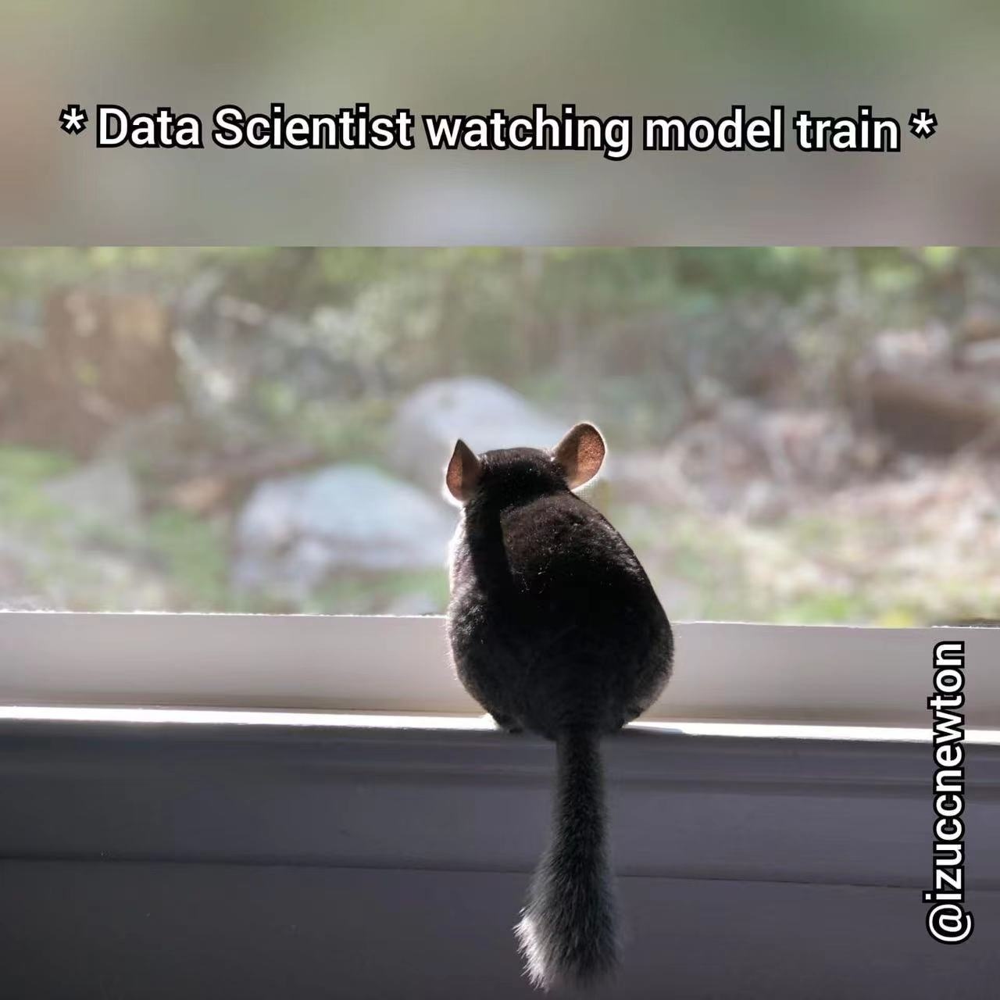


Finally, it finished.
I waited one and half hours to get there.
Let's move our model to Google Drive first

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


And Let's load essential files from github to reproduce the result.

In [ ]:
!wget https://github.com/EasonJia9598/FnrwBca3LCCGnpdmUYtSg6-qcSGbGMaymNl-/raw/main/models.zip
!wget https://github.com/EasonJia9598/FnrwBca3LCCGnpdmUYtSg6-qcSGbGMaymNl-/raw/main/runs.zip
!wget https://github.com/EasonJia9598/FnrwBca3LCCGnpdmUYtSg6-qcSGbGMaymNl-/raw/main/loss_record_plot.pkl
!unzip models.zip
!unzip runs.zip
loss_record_plot = joblib.load('loss_record_plot.pkl')

--2022-06-19 22:29:17--  https://github.com/EasonJia9598/FnrwBca3LCCGnpdmUYtSg6-qcSGbGMaymNl-/raw/main/models.zip
Resolving github.com (github.com)... 140.82.112.3
Connecting to github.com (github.com)|140.82.112.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/EasonJia9598/FnrwBca3LCCGnpdmUYtSg6-qcSGbGMaymNl-/main/models.zip [following]
--2022-06-19 22:29:18--  https://raw.githubusercontent.com/EasonJia9598/FnrwBca3LCCGnpdmUYtSg6-qcSGbGMaymNl-/main/models.zip
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 84314 (82K) [application/zip]
Saving to: ‘models.zip’

models.zip          100%[===================>]  82.34K  --.-KB/s    in 0.008s  

2022-06-19 22:29:18 (10.6 MB/s) - ‘models.zip’ saved 

We can see from the training block, the model we saved is at <br>
Epoch [1974/2000]: Train loss: 35.1131, Valid loss: 36.2154
Saving model with MSE validation loss 36.215...

Now, let's load our best model saved before and test it on our test set.

In [ ]:
criterion = nn.MSELoss(reduction='mean') # Define our loss function. By MSE
loss_record = []

# load our best model
best_model = My_Model(input_dim = train_loader.dataset.x.shape[1]).to(device) # put your model and data on the same computation device.
ckpt = torch.load(config['save_path'], map_location='cpu')  # Load your best model and no need to load into GPU, since we won't train it. 
best_model.load_state_dict(ckpt)

for x, y in test_loader:
          x, y = x.to(device), y.to(device)
          with torch.no_grad():               # set to no gradient decent for prediction
              pred = best_model(x)
              loss = criterion(pred, y)
          loss_record.append(loss.item())

mean_test_loss = sum(loss_record)/len(loss_record)
print(f'Test MSE, mean squared error loss is  {mean_test_loss:.4f}')
print(f'Test RMSE, Root mean squared error loss is  {np.sqrt(mean_test_loss):.4f}')

Test MSE, mean squared error loss is  38.1825
Test RMSE, Root mean squared error loss is  6.1792


Well, MSE = 38.1825 is quite large for a NN model. (On other problems' dataset I trained with this NN, I got MSE with test loss equal to 0.9 or 1. And the leaderboard of that kaggle problem, the champion got 0.6 MSE.)

And The root squared error of 6.1792 is close to our candidate model of random forest.
But we set this as baseline. And life is what it is. C'est la vie.

 This is the best result I can get I have to say.

### 3.6.3 How do you make sure not to overfit?

In neural network, this problem is very easy to solve. We can just use early stopping to prevent overfit.
> In machine learning, early stopping is a form of regularization used to avoid overfitting when training a learner with an iterative method, such as gradient descent. Such methods update the learner so as to make it better fit the training data with each iteration. Up to a point, this improves the learner's performance on data outside of the training set. Past that point, however, improving the learner's fit to the training data comes at the expense of increased generalization error. Early stopping rules provide guidance as to how many iterations can be run before the learner begins to over-fit. Early stopping rules have been employed in many different machine learning methods, with varying amounts of theoretical foundation. [wikipedia](https://en.wikipedia.org/wiki/Early_stopping)

The following is the part of code in my training loop.
First, we saved our best validation scores and save the model.
When our validation model's MSE less than our saved best valid scores, we add one on our count. If we get a new best model, we reset our count to 0.
And we set a threshold of how many steps that we will tolerate our model not improving. If the count larget than the threshold. We shut down the training process.

In the meatime, if the model is really overfitting. Our model saved in file was the very beginning model before 200 steps of early stopping.

Hence, when we retrived the model from our file, it is the model that is not overfitted.


In [ ]:
  if mean_valid_loss < best_loss:
      best_loss = mean_valid_loss # save best loss
      torch.save(model.state_dict(), config['save_path']) # Save your best model
      print('Saving model with loss {:.3f}...'.format(best_loss))
      early_stop_count = 0 # reset our count
  else:
      early_stop_count += 1 # when model is not improving, add 1

  if early_stop_count >= config['early_stop']: # we shut down the training process
      print('\nModel is not improving, so we halt the training session.')
      return loss_record_plot

### 3.6.4 Visualize the learning process and/or the knowledge acquired by your model. Explain why you think this is the right visualization.

#### 3.6.4.1 Learning curve
> A learning curve is a graphical representation of the relationship between how proficient people are at a task and the amount of experience they have. Proficiency (measured on the vertical axis) usually increases with increased experience (the horizontal axis), that is to say, the more someone, groups, companies or industries perform a task, the better their performance at the task.[Wikipedia](https://en.wikipedia.org/wiki/Learning_curve)

Using learning curve for DNN is good. Since our model is heavily depended on the epoch iteration times. We can find out from the LR curve that whether our model is overfitting/underfitting or whether our model could still imporve by more training epoches.

##### Tensorborad plotting
You have to download my files from github to see the tensorflow results.
Run following codes to set up.

In [ ]:

# only when you never load those two files before

!wget https://github.com/EasonJia9598/FnrwBca3LCCGnpdmUYtSg6-qcSGbGMaymNl-/raw/main/models.zip
!wget https://github.com/EasonJia9598/FnrwBca3LCCGnpdmUYtSg6-qcSGbGMaymNl-/raw/main/runs.zip
!unzip models.zip
!unzip runs.zip

--2022-06-19 03:48:25--  https://github.com/EasonJia9598/FnrwBca3LCCGnpdmUYtSg6-qcSGbGMaymNl-/raw/main/models.zip
Resolving github.com (github.com)... 140.82.121.4
Connecting to github.com (github.com)|140.82.121.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/EasonJia9598/FnrwBca3LCCGnpdmUYtSg6-qcSGbGMaymNl-/main/models.zip [following]
--2022-06-19 03:48:26--  https://raw.githubusercontent.com/EasonJia9598/FnrwBca3LCCGnpdmUYtSg6-qcSGbGMaymNl-/main/models.zip
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 84314 (82K) [application/zip]
Saving to: ‘models.zip’

models.zip          100%[===================>]  82.34K  --.-KB/s    in 0.004s  

2022-06-19 03:48:26 (18.3 MB/s) - ‘models.zip’ saved 

In [ ]:
# load tensorboard
%reload_ext tensorboard
%tensorboard --logdir=./runs/

<IPython.core.display.Javascript object>

Screenshot 1: Whole picture of this time training's plot.

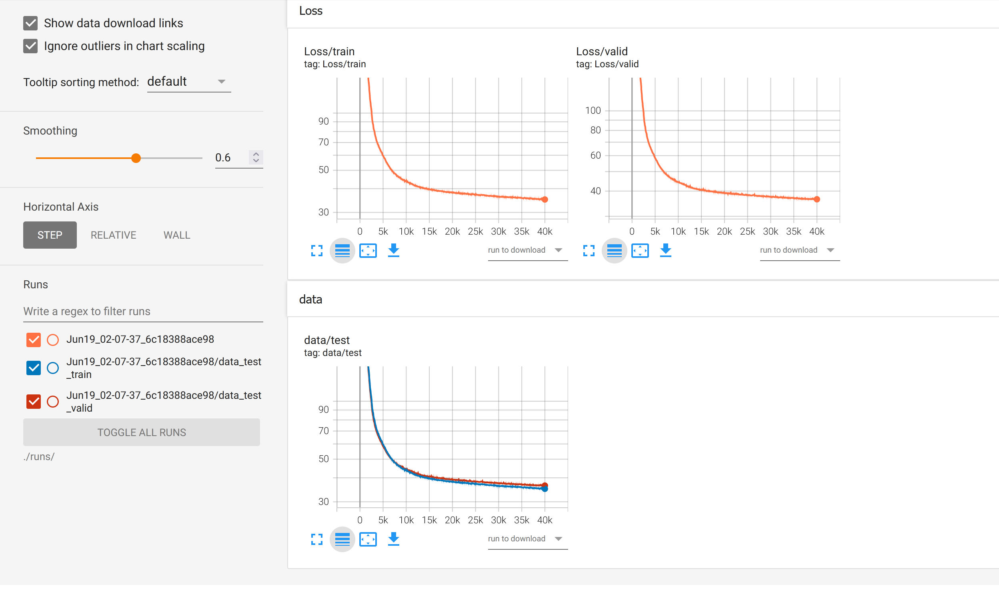

Screenshot 2: train loss and validation loss in the same graph.

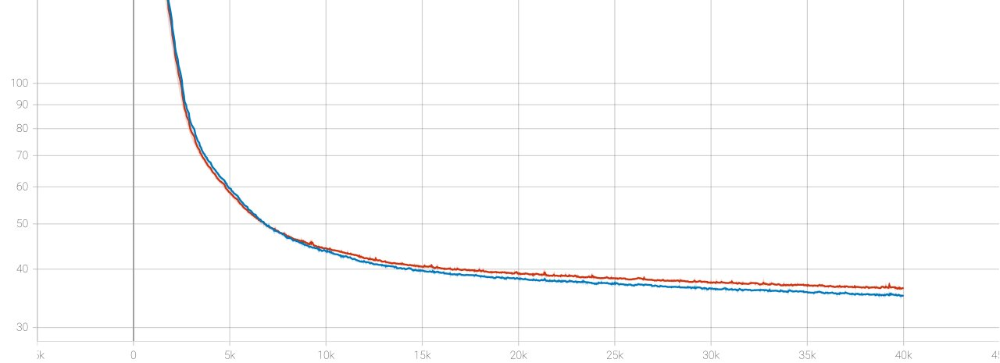

##### matplotlib plotting

In [ ]:
# save our loss_record_plot into jablib file first
import joblib
joblib.dump(loss_record_plot, 'loss_record_plot.pkl')

['loss_record_plot.pkl']

We use the function we defined before to draw the Learning curve

In [ ]:
def plot_learning_curve(loss_record, title='', y_start = 0., y_end = 100., ylabel='MSE Loss', figsize = (17,10), x_start = 0, x_end = 2000):
    ''' Plot learning curve of your DNN (train & dev loss) '''
    total_steps = len(loss_record['train']) # get the length of our records
    x_1 = range(total_steps) # get the range of x
    x_2 = x_1[::len(loss_record['train']) // len(loss_record['dev'])]
    figure(figsize=figsize) # set figsize
    plt.plot(x_1, loss_record['train'], c='tab:red', label='train loss')
    plt.plot(x_2, loss_record['dev'], c='tab:cyan', label='validation loss')
    plt.ylim(y_start, y_end) # set limit on x axis
    plt.xlim(x_start, x_end) # set limit on y axis
    plt.xlabel('Training steps')
    plt.ylabel(ylabel)
    plt.title('Learning curve of {}'.format(title))
    plt.legend()
    plt.show()


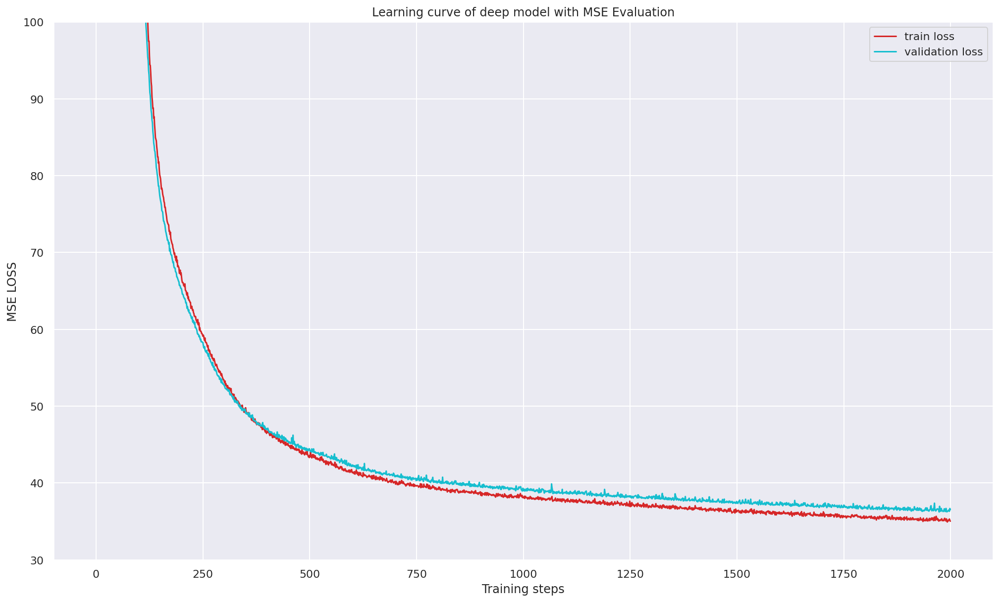

In [ ]:
plot_learning_curve(loss_record_plot, title='deep model with MSE Evaluation', y_start = 30., y_end = 100., ylabel="MSE LOSS")

This is the alternative way of showing the above results instead of using tensorboard.

In [ ]:
root_loss_record_plot = {'train': [], 'dev': []}      # for recording training loss
root_loss_record_plot['train'] = np.sqrt(loss_record_plot['train'])
root_loss_record_plot['dev'] = np.sqrt(loss_record_plot['dev'])

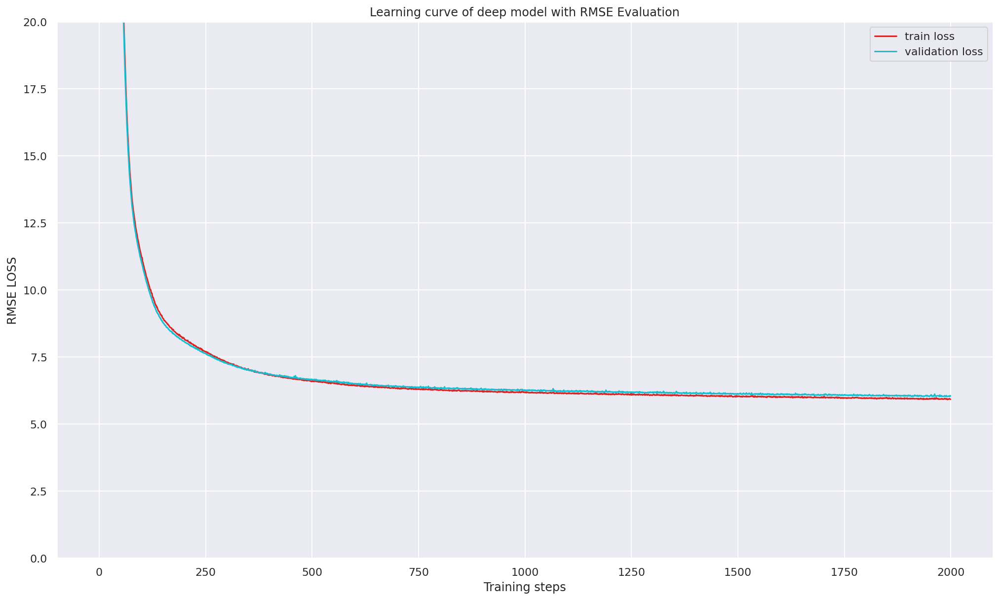

In [ ]:
plot_learning_curve(root_loss_record_plot, title='deep model with RMSE Evaluation', y_start = 0., y_end = 20., ylabel="RMSE LOSS")

The training/loss visualization can give us the information about whether our model is overfitting and whehter our model will continue converging if we have more epoches. It is a quite powerful tool for Neural Network training. 


#### 3.6.4.2. Ground truth value vs Prediction graph


The Ground truth value(Target value) vs Prediction plot can show us how our model has done in test set. 

Every red point's X axis value means the real target value in our test set. And every point's Y axis value means our prediciton value to the corresponded data instance. <br> And if our prediction value equals to our target value, it will be on the blue line of y = x. <br> By looking at this graph, and how many points are not in the blue line and how off they are from the blue line, we can quickly estimate the performance of our model.


Therefore, I believe that above two kinds of plots are the best visualization of my DNN.

Now, we use our best model to do the prediction vs ground truth (The real target value).
Our FRP largest value is our threshold, that is 350. I set the graph xlim,ylim = 360 for a wider looking.

In [ ]:
def plot_pred(dv_set, model, device, lim=360., preds=None, targets=None,figsize=(15,15)):
    ''' Plot prediction of your DNN '''
    if preds is None or targets is None:
        model.eval()
        preds, targets = [], [] # do prediction
        for x, y in dv_set:
            x, y = x.to(device), y.to(device)
            with torch.no_grad():
                pred = model(x)
                preds.append(pred.detach().cpu())
                targets.append(y.detach().cpu())
        preds = torch.cat(preds, dim=0).numpy() # save the prediction
        targets = torch.cat(targets, dim=0).numpy() # save the target value
    # matplot setting
    figure(figsize = figsize)
    plt.scatter(targets, preds, c='r', alpha=0.5)
    plt.plot([-0.2, lim], [-0.2, lim], c='b')
    plt.xlim(-0.2, lim)
    plt.ylim(-0.2, lim)
    plt.xlabel('ground truth value')
    plt.ylabel('predicted value')
    plt.title('Ground Truth v.s. Prediction')
    plt.show()

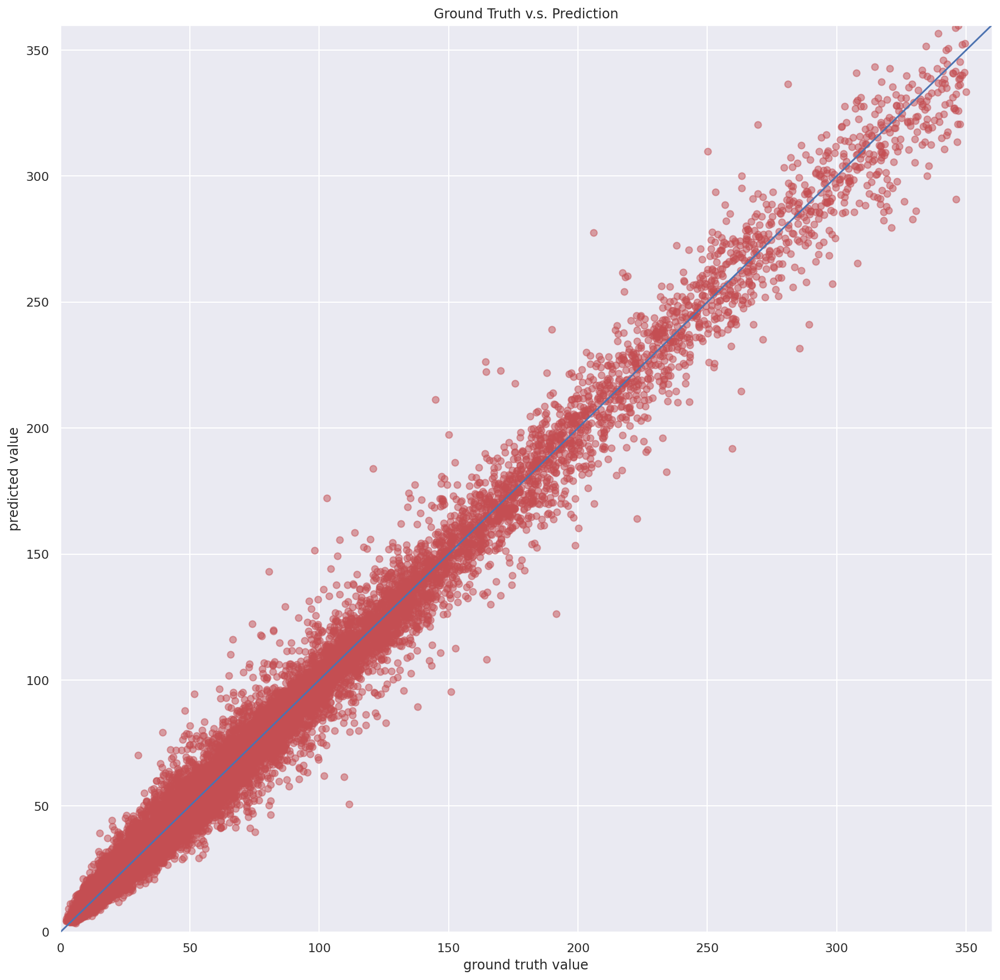

In [ ]:
plot_pred(test_loader, best_model, device)  # Show prediction on the validation set

### 3.6.5. Analyze the results

#### 3.6.5.1. First let's analyze the loss visulazation.

And redraw the MSE and RMSE graph.

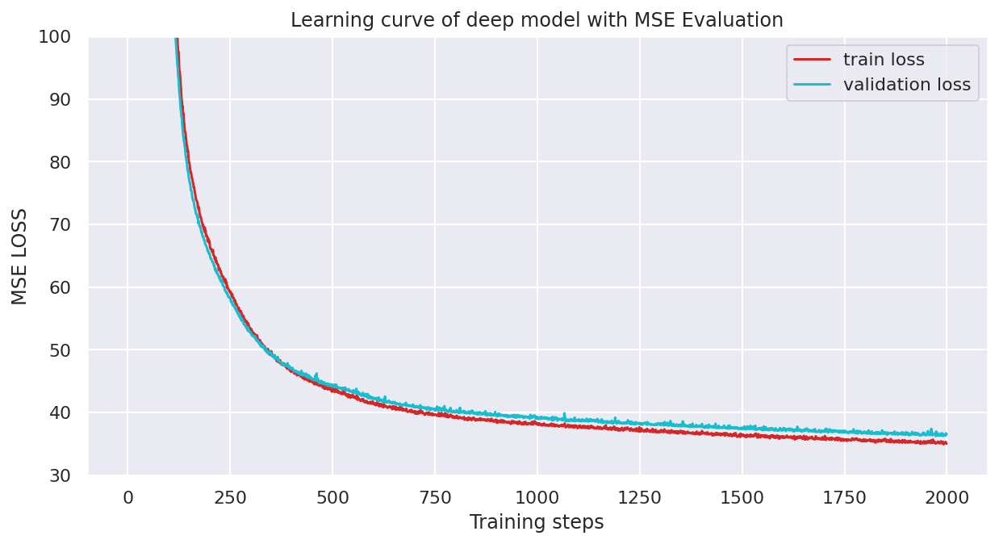

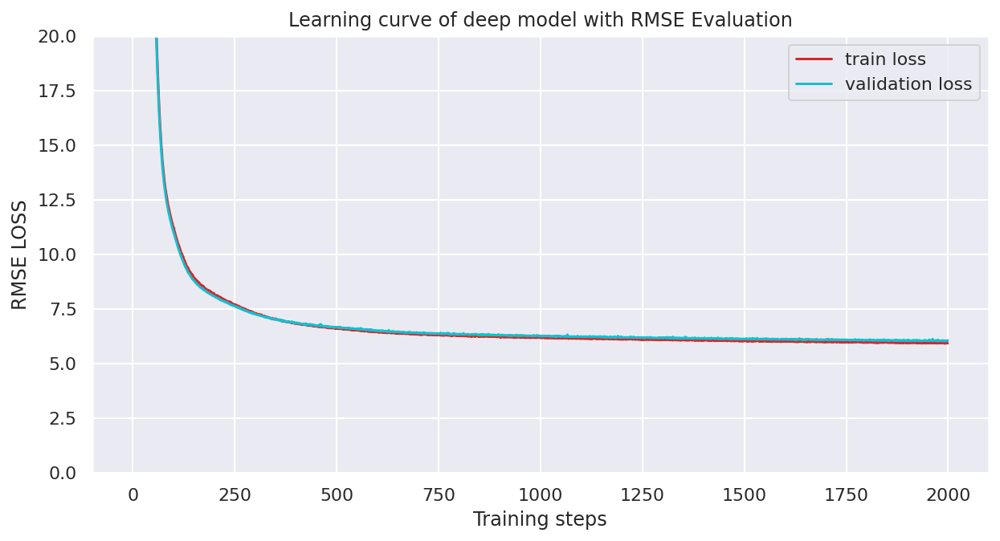

In [ ]:
plot_learning_curve(loss_record_plot, title='deep model with MSE Evaluation', y_start = 30., y_end = 100., ylabel="MSE LOSS",figsize=(10,5));
plot_learning_curve(root_loss_record_plot, title='deep model with RMSE Evaluation', y_start = 0., y_end = 20., ylabel="RMSE LOSS", figsize=(10,5))

We can clearly see that MSE graph has significant difference between train loss and validation loss. However, we can not see this phenomenon from the RMSE graph.
The reason of this, we talked before in the topic of selecting Evalution metrics.
I said, I would prefer MSE, since it shows more deatails of our loss and squared our loss will penalise the error more than RSME.

Now, let's take a close look about this MSE error graph.
<br> We can see from the graph, between epoch 0 to 270, it's the time period that our [admaW](https://pytorch.org/docs/stable/generated/torch.optim.AdamW.html_) has the quickest updating steps by the gradient decent. Let's take a close look at it.

> AdamW is a variant of the optimizer Adam that has an improved implementation of weight decay. [Knowledge Center](https://peltarion.com/knowledge-center/documentation/modeling-view/run-a-model/optimizers/adamw)


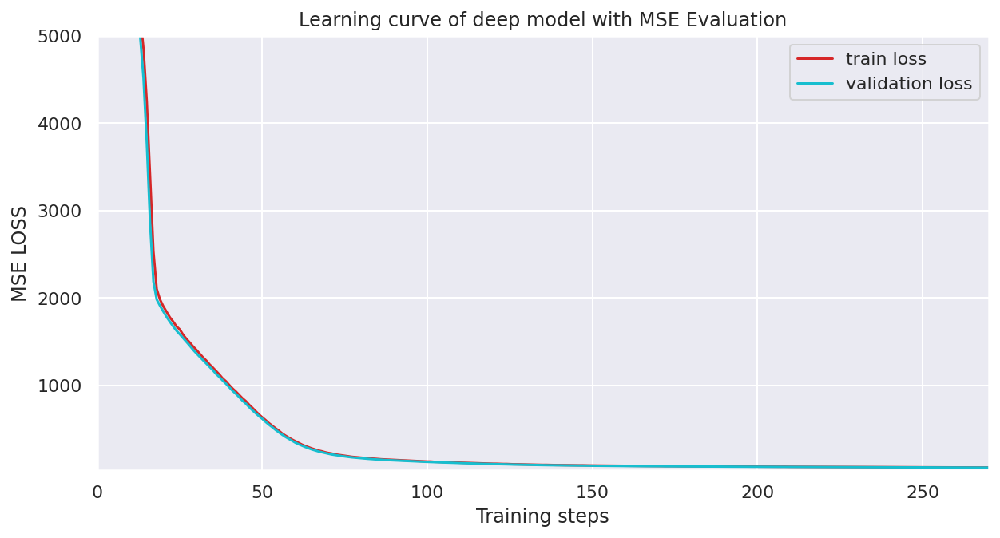

In [ ]:
# set xlim from 0 to 270
plot_learning_curve(loss_record_plot, title='deep model with MSE Evaluation', y_start = 30., y_end = 5000., ylabel="MSE LOSS",figsize=(10,5),x_start=0,x_end = 270);

We can see that adam gets our loss from 5000 to less than 1000 only taking less than 50 steps. It means our learning rate is big enough to achieve a quick converge.
> Adam: Adaptive Moment Estimation is an algorithm for optimization technique for gradient descent. The method is really efficient when working with large problem involving a lot of data or parameters. It requires less memory and is efficient. Intuitively, it is a combination of the ‘gradient descent with momentum’ algorithm and the ‘RMSP’ algorithm. [GeeksforGeeks](https://www.geeksforgeeks.org/intuition-of-adam-optimizer/)

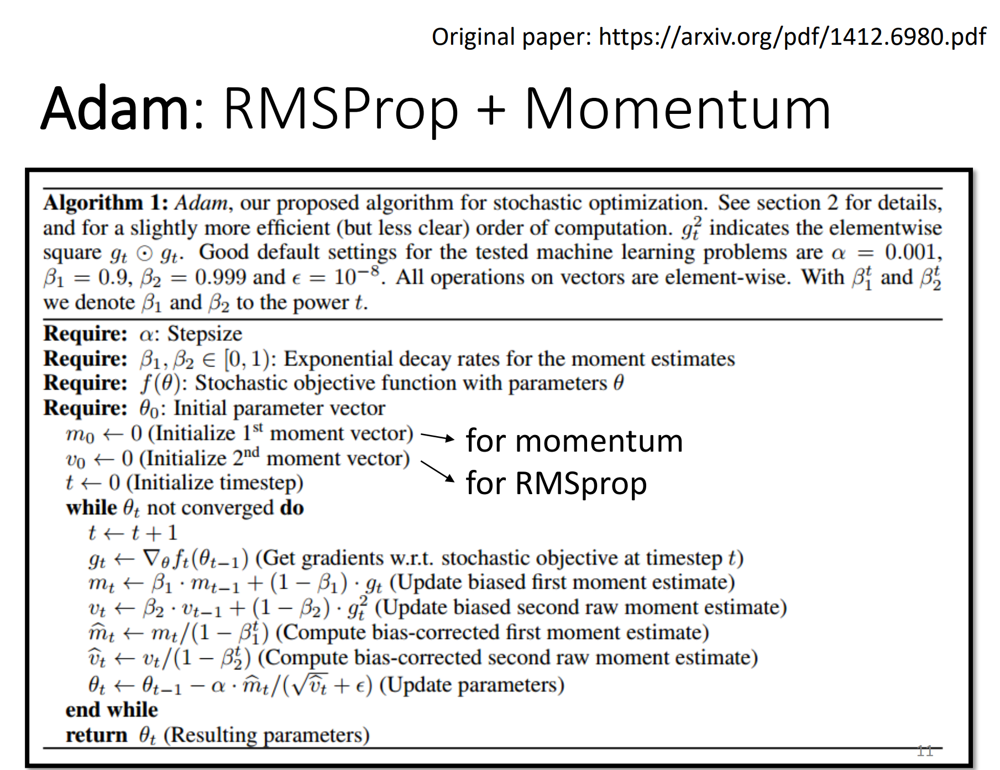

From Lihongyi Machine Learning, [opimizer_v4](https://speech.ee.ntu.edu.tw/~hylee/ml/ml2021-course-data/optimizer_v4.pdf)

There is an example I trained before with too large learning rate:
It shaked too much and keep avoiding the right weight value to find a minimun of the gradient decent "valley". And it missed the chance to find a next local minimum. Although we have momentum to keep rolling on the surface.

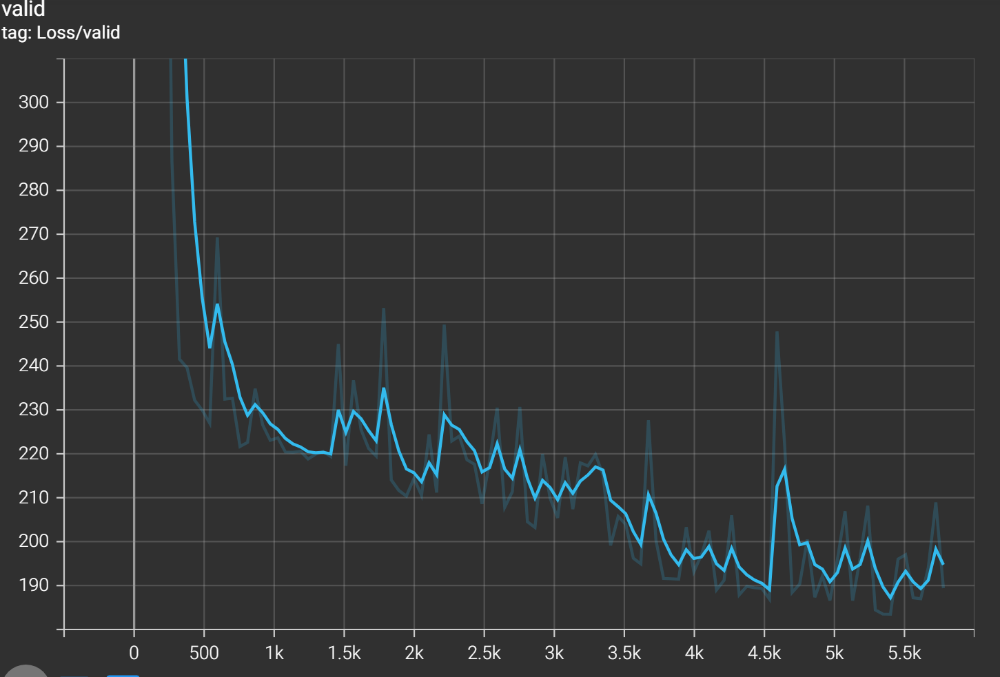

Let's take a look at the trending near the last half of our model's training.

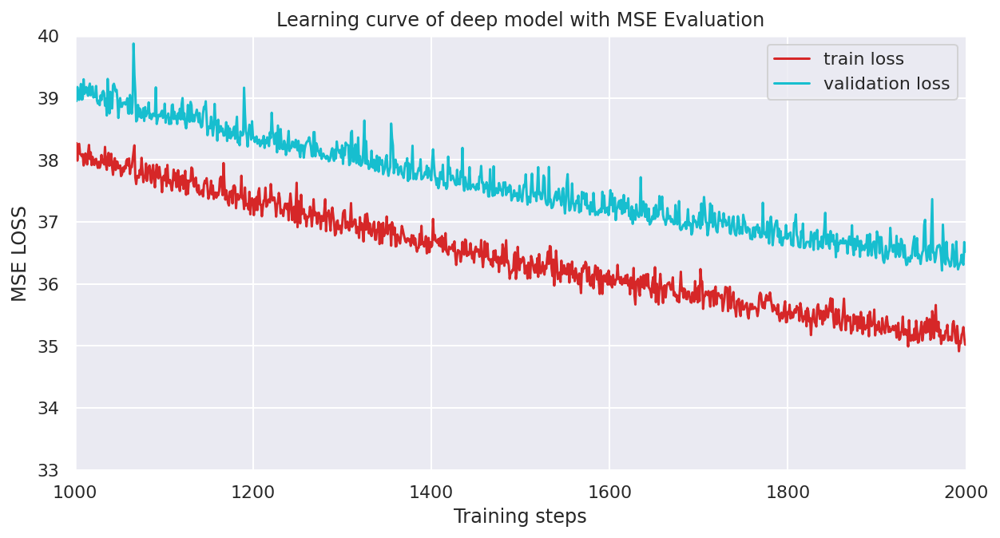

In [ ]:
# set xlim from 1000 to 2000
plot_learning_curve(loss_record_plot, title='deep model with MSE Evaluation', y_start = 33., y_end = 40., ylabel="MSE LOSS",figsize=(10,5),x_start=1000,x_end = 2000);

We can see that from 1000 to 2000, our model is continuing improving. And the shaking of the line is not very wrose in terms of only around 1 or 0.5 error "vibration". <br>
From this we could say that we can use more epoches to keep training our model. However, if we enlarge the ylim on our graph. We could find that our optimizer has almost reached his ability.<br>


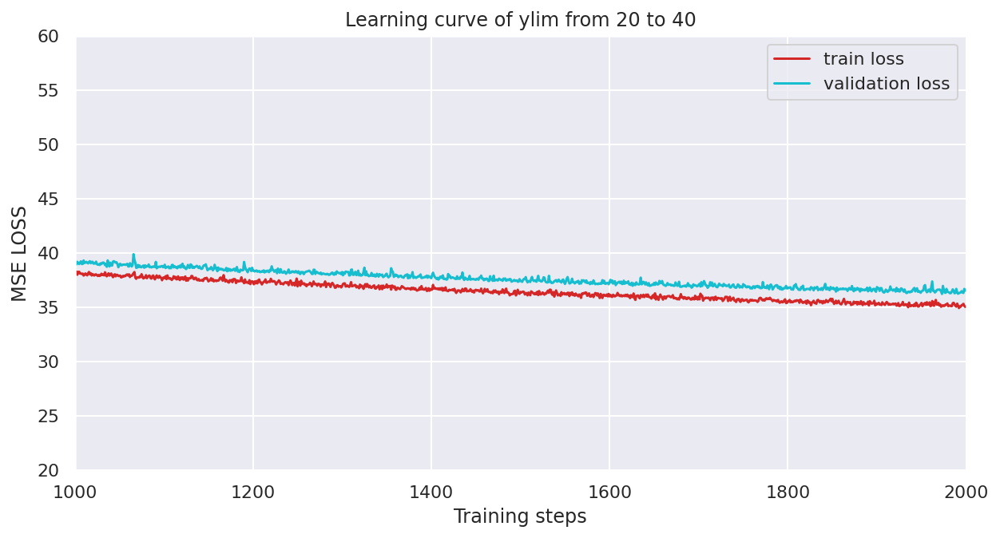

In [ ]:
# set xlim from 1000 to 2000
# ylim from 20 to 60 
plot_learning_curve(loss_record_plot, title='ylim from 20 to 40', y_start = 20., y_end = 60., ylabel="MSE LOSS",figsize=(10,5),x_start=1000,x_end = 2000);

In the meantime, if you take a look at our training records. At the end of 300 epoches, we are starting to see that our train loss is way less than validation loss for more and more steps. And our validation score become more and more header to update a new best model. It is the sign of early overfitting over model.

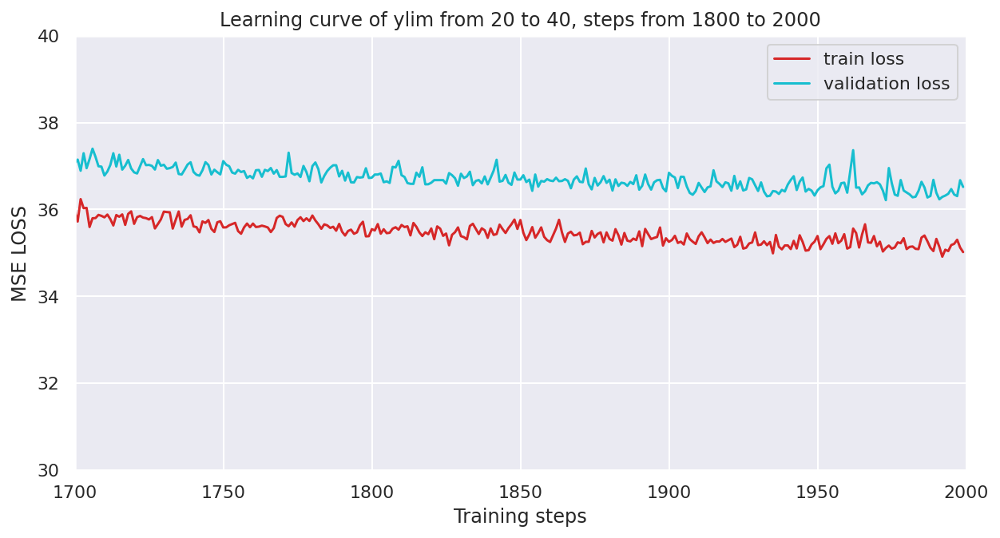

In [ ]:
# set xlim from 1000 to 2000
# ylim from 20 to 60 
plot_learning_curve(loss_record_plot, title='ylim from 20 to 40, steps from 1800 to 2000', y_start = 30., y_end = 40., ylabel="MSE LOSS",figsize=(10,5),x_start=1700,x_end = 2000);

The good news is until 2000 epoches, we didn't trigger our early stopping mechanism and we can see that validation score and training score haven't departed from each other. (Training loss become less and validation loss become larger.) Which means we don't have a overfitting model now.
It's just we can not improve our model with a big difference anymore.


But before call it a day, let us train another 2000 loops with our previous saved model checkpoint.

In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
config = {
    'seed': 5201314,      # Your seed number, you can pick your lucky number. :)
    'select_all': True,   # Whether to use all features.
    'valid_ratio': 0.2,   # validation_size = train_size * valid_ratio
    'n_epochs': 2000,     # Number of epochs. epoches larger than 2000 won't do any good. But waste our time. Based on my hundreds of training experience.
    'batch_size': 5024,   # since we have a quite large dataset. The batch size should be large too
    'learning_rate': 1e-4,
    'early_stop': 200,    # If model has not improved for this many consecutive epochs, stop training.
    'save_path': './models/model.ckpt'  # Your model will be saved here.
}

In [ ]:
best_model = My_Model(input_dim=x_train.shape[1]).to(device) # put your model and data on the same computation device.
ckpt = torch.load(config['save_path'], map_location='cpu') 
best_model.load_state_dict(ckpt)

<All keys matched successfully>

In [ ]:
loss_record_plot_second_train = trainer(train_loader, valid_loader, best_model, config, device);

Epoch [1/2000]: 100%|██████████| 20/20 [00:02<00:00,  6.92it/s, loss=29.9]


Epoch [1/2000]: Train loss: 35.1897, Valid loss: 36.2957
Saving model with loss 36.296...


Epoch [2/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.95it/s, loss=36.8]


Epoch [2/2000]: Train loss: 35.1706, Valid loss: 36.2368
Saving model with loss 36.237...


Epoch [3/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.95it/s, loss=33]


Epoch [3/2000]: Train loss: 34.9637, Valid loss: 36.2628


Epoch [4/2000]: 100%|██████████| 20/20 [00:01<00:00, 12.22it/s, loss=33.9]


Epoch [4/2000]: Train loss: 34.9616, Valid loss: 36.3836


Epoch [5/2000]: 100%|██████████| 20/20 [00:01<00:00, 12.13it/s, loss=38.7]


Epoch [5/2000]: Train loss: 35.1477, Valid loss: 36.3083


Epoch [6/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.70it/s, loss=27]


Epoch [6/2000]: Train loss: 34.7394, Valid loss: 36.2183
Saving model with loss 36.218...


Epoch [7/2000]: 100%|██████████| 20/20 [00:01<00:00, 12.15it/s, loss=38.1]


Epoch [7/2000]: Train loss: 35.1150, Valid loss: 36.3558


Epoch [8/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.60it/s, loss=35.7]


Epoch [8/2000]: Train loss: 35.1230, Valid loss: 36.3227


Epoch [9/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.89it/s, loss=31.7]


Epoch [9/2000]: Train loss: 35.0007, Valid loss: 36.2152
Saving model with loss 36.215...


Epoch [10/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.67it/s, loss=32]


Epoch [10/2000]: Train loss: 34.9471, Valid loss: 36.3117


Epoch [11/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.45it/s, loss=34]


Epoch [11/2000]: Train loss: 35.0187, Valid loss: 36.1950
Saving model with loss 36.195...


Epoch [12/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.59it/s, loss=32]


Epoch [12/2000]: Train loss: 34.9801, Valid loss: 36.2712


Epoch [13/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.82it/s, loss=36.2]


Epoch [13/2000]: Train loss: 35.1064, Valid loss: 36.4897


Epoch [14/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.63it/s, loss=30.9]


Epoch [14/2000]: Train loss: 35.0000, Valid loss: 36.3247


Epoch [15/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.48it/s, loss=37.6]


Epoch [15/2000]: Train loss: 35.1224, Valid loss: 36.1712
Saving model with loss 36.171...


Epoch [16/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.81it/s, loss=36.9]


Epoch [16/2000]: Train loss: 35.0996, Valid loss: 36.2414


Epoch [17/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.56it/s, loss=31.8]


Epoch [17/2000]: Train loss: 34.9253, Valid loss: 36.2801


Epoch [18/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.86it/s, loss=32.3]


Epoch [18/2000]: Train loss: 34.9259, Valid loss: 36.2954


Epoch [19/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.96it/s, loss=36.8]


Epoch [19/2000]: Train loss: 35.0361, Valid loss: 36.2874


Epoch [20/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.72it/s, loss=38]


Epoch [20/2000]: Train loss: 35.1021, Valid loss: 36.1379
Saving model with loss 36.138...


Epoch [21/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.47it/s, loss=42.4]


Epoch [21/2000]: Train loss: 35.2499, Valid loss: 36.3498


Epoch [22/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.81it/s, loss=31.4]


Epoch [22/2000]: Train loss: 34.8653, Valid loss: 36.4118


Epoch [23/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.69it/s, loss=39.9]


Epoch [23/2000]: Train loss: 35.2192, Valid loss: 36.4101


Epoch [24/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.85it/s, loss=38]


Epoch [24/2000]: Train loss: 35.1176, Valid loss: 36.9787


Epoch [25/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.93it/s, loss=36.2]


Epoch [25/2000]: Train loss: 35.2577, Valid loss: 36.6172


Epoch [26/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.56it/s, loss=36]


Epoch [26/2000]: Train loss: 35.1810, Valid loss: 36.2422


Epoch [27/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.69it/s, loss=40.5]


Epoch [27/2000]: Train loss: 35.2433, Valid loss: 36.5283


Epoch [28/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.78it/s, loss=31.5]


Epoch [28/2000]: Train loss: 34.9450, Valid loss: 36.3326


Epoch [29/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.81it/s, loss=38.1]


Epoch [29/2000]: Train loss: 35.1478, Valid loss: 36.2507


Epoch [30/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.85it/s, loss=30.9]


Epoch [30/2000]: Train loss: 34.8109, Valid loss: 36.2723


Epoch [31/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.46it/s, loss=32.7]


Epoch [31/2000]: Train loss: 34.9079, Valid loss: 36.2567


Epoch [32/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.29it/s, loss=35.5]


Epoch [32/2000]: Train loss: 35.0033, Valid loss: 36.2104


Epoch [33/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.80it/s, loss=30.5]


Epoch [33/2000]: Train loss: 34.8282, Valid loss: 36.8485


Epoch [34/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.55it/s, loss=36.2]


Epoch [34/2000]: Train loss: 35.2243, Valid loss: 36.3924


Epoch [35/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.76it/s, loss=40]


Epoch [35/2000]: Train loss: 35.1407, Valid loss: 36.3083


Epoch [36/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.69it/s, loss=39.2]


Epoch [36/2000]: Train loss: 35.1793, Valid loss: 36.1535


Epoch [37/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.92it/s, loss=39.8]


Epoch [37/2000]: Train loss: 35.3252, Valid loss: 36.3351


Epoch [38/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.42it/s, loss=33.2]


Epoch [38/2000]: Train loss: 35.0888, Valid loss: 36.2020


Epoch [39/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.59it/s, loss=33.4]


Epoch [39/2000]: Train loss: 34.9110, Valid loss: 36.2798


Epoch [40/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.85it/s, loss=40.6]


Epoch [40/2000]: Train loss: 35.2757, Valid loss: 36.1058
Saving model with loss 36.106...


Epoch [41/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.69it/s, loss=35.7]


Epoch [41/2000]: Train loss: 35.0010, Valid loss: 36.1207


Epoch [42/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.51it/s, loss=32.6]


Epoch [42/2000]: Train loss: 34.8734, Valid loss: 36.1362


Epoch [43/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.72it/s, loss=31.5]


Epoch [43/2000]: Train loss: 34.8882, Valid loss: 36.1663


Epoch [44/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.65it/s, loss=35.6]


Epoch [44/2000]: Train loss: 34.9561, Valid loss: 36.2098


Epoch [45/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.61it/s, loss=35.9]


Epoch [45/2000]: Train loss: 34.9905, Valid loss: 36.1256


Epoch [46/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.98it/s, loss=35.3]


Epoch [46/2000]: Train loss: 35.1187, Valid loss: 36.5290


Epoch [47/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.86it/s, loss=36.6]


Epoch [47/2000]: Train loss: 35.0579, Valid loss: 36.1639


Epoch [48/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.42it/s, loss=31.1]


Epoch [48/2000]: Train loss: 34.8837, Valid loss: 36.1072


Epoch [49/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.90it/s, loss=33.8]


Epoch [49/2000]: Train loss: 34.9615, Valid loss: 36.2351


Epoch [50/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.86it/s, loss=41.1]


Epoch [50/2000]: Train loss: 35.1373, Valid loss: 36.1966


Epoch [51/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.63it/s, loss=33.9]


Epoch [51/2000]: Train loss: 34.9264, Valid loss: 36.1717


Epoch [52/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.45it/s, loss=32.3]


Epoch [52/2000]: Train loss: 34.9353, Valid loss: 36.4970


Epoch [53/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.31it/s, loss=33.7]


Epoch [53/2000]: Train loss: 34.9203, Valid loss: 36.3484


Epoch [54/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.74it/s, loss=32.5]


Epoch [54/2000]: Train loss: 34.9086, Valid loss: 36.1512


Epoch [55/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.93it/s, loss=41.9]


Epoch [55/2000]: Train loss: 35.2010, Valid loss: 36.2897


Epoch [56/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.90it/s, loss=34.5]


Epoch [56/2000]: Train loss: 34.9329, Valid loss: 36.1254


Epoch [57/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.49it/s, loss=41.5]


Epoch [57/2000]: Train loss: 35.1134, Valid loss: 36.4109


Epoch [58/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.96it/s, loss=33.5]


Epoch [58/2000]: Train loss: 34.9765, Valid loss: 36.5808


Epoch [59/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.44it/s, loss=33.9]


Epoch [59/2000]: Train loss: 34.9405, Valid loss: 36.1410


Epoch [60/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.59it/s, loss=35.1]


Epoch [60/2000]: Train loss: 34.9008, Valid loss: 36.3534


Epoch [61/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.45it/s, loss=34.9]


Epoch [61/2000]: Train loss: 34.9275, Valid loss: 36.2910


Epoch [62/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.67it/s, loss=34.1]


Epoch [62/2000]: Train loss: 34.8914, Valid loss: 36.3124


Epoch [63/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.49it/s, loss=35.2]


Epoch [63/2000]: Train loss: 34.9455, Valid loss: 36.4393


Epoch [64/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.27it/s, loss=38.4]


Epoch [64/2000]: Train loss: 35.0590, Valid loss: 36.1674


Epoch [65/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.51it/s, loss=35.5]


Epoch [65/2000]: Train loss: 34.9869, Valid loss: 36.2778


Epoch [66/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.72it/s, loss=34.1]


Epoch [66/2000]: Train loss: 34.8732, Valid loss: 36.1103


Epoch [67/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.68it/s, loss=30.3]


Epoch [67/2000]: Train loss: 34.7594, Valid loss: 36.1268


Epoch [68/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.67it/s, loss=33]


Epoch [68/2000]: Train loss: 34.8284, Valid loss: 36.2219


Epoch [69/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.90it/s, loss=39.5]


Epoch [69/2000]: Train loss: 35.0640, Valid loss: 36.1176


Epoch [70/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.87it/s, loss=34.3]


Epoch [70/2000]: Train loss: 34.8572, Valid loss: 35.9578
Saving model with loss 35.958...


Epoch [71/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.66it/s, loss=36]


Epoch [71/2000]: Train loss: 34.9173, Valid loss: 36.4315


Epoch [72/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.82it/s, loss=32.5]


Epoch [72/2000]: Train loss: 34.8629, Valid loss: 36.1152


Epoch [73/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.77it/s, loss=33.7]


Epoch [73/2000]: Train loss: 34.8532, Valid loss: 36.0500


Epoch [74/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.52it/s, loss=32.3]


Epoch [74/2000]: Train loss: 34.7869, Valid loss: 36.2681


Epoch [75/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.63it/s, loss=36.2]


Epoch [75/2000]: Train loss: 35.0104, Valid loss: 36.3088


Epoch [76/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.74it/s, loss=37.1]


Epoch [76/2000]: Train loss: 34.9768, Valid loss: 36.3328


Epoch [77/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.57it/s, loss=37.9]


Epoch [77/2000]: Train loss: 35.0242, Valid loss: 36.1478


Epoch [78/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.73it/s, loss=32.4]


Epoch [78/2000]: Train loss: 34.8071, Valid loss: 36.1386


Epoch [79/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.73it/s, loss=40]


Epoch [79/2000]: Train loss: 35.1312, Valid loss: 35.9833


Epoch [80/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.68it/s, loss=32.2]


Epoch [80/2000]: Train loss: 34.8749, Valid loss: 36.4061


Epoch [81/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.43it/s, loss=31.9]


Epoch [81/2000]: Train loss: 34.9229, Valid loss: 36.1087


Epoch [82/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.53it/s, loss=30.2]


Epoch [82/2000]: Train loss: 34.7598, Valid loss: 36.0366


Epoch [83/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.85it/s, loss=32.9]


Epoch [83/2000]: Train loss: 34.8474, Valid loss: 36.1549


Epoch [84/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.73it/s, loss=29.5]


Epoch [84/2000]: Train loss: 34.7443, Valid loss: 36.1870


Epoch [85/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.95it/s, loss=38]


Epoch [85/2000]: Train loss: 34.9851, Valid loss: 36.1084


Epoch [86/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.53it/s, loss=39.1]


Epoch [86/2000]: Train loss: 34.9974, Valid loss: 36.2347


Epoch [87/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.65it/s, loss=35.9]


Epoch [87/2000]: Train loss: 34.8847, Valid loss: 36.2016


Epoch [88/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.93it/s, loss=34]


Epoch [88/2000]: Train loss: 34.8813, Valid loss: 36.3476


Epoch [89/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.77it/s, loss=38.6]


Epoch [89/2000]: Train loss: 35.0133, Valid loss: 36.1935


Epoch [90/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.26it/s, loss=30.7]


Epoch [90/2000]: Train loss: 34.7903, Valid loss: 36.1271


Epoch [91/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.50it/s, loss=38.1]


Epoch [91/2000]: Train loss: 35.0297, Valid loss: 36.1988


Epoch [92/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.86it/s, loss=32.4]


Epoch [92/2000]: Train loss: 34.8103, Valid loss: 36.1078


Epoch [93/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.48it/s, loss=39.5]


Epoch [93/2000]: Train loss: 34.9996, Valid loss: 36.1007


Epoch [94/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.49it/s, loss=37.2]


Epoch [94/2000]: Train loss: 34.9628, Valid loss: 36.2185


Epoch [95/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.66it/s, loss=38.4]


Epoch [95/2000]: Train loss: 35.0194, Valid loss: 36.0734


Epoch [96/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.77it/s, loss=30]


Epoch [96/2000]: Train loss: 34.7543, Valid loss: 36.1794


Epoch [97/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.68it/s, loss=33.5]


Epoch [97/2000]: Train loss: 34.7858, Valid loss: 36.1712


Epoch [98/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.69it/s, loss=33.4]


Epoch [98/2000]: Train loss: 34.8542, Valid loss: 36.2618


Epoch [99/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.67it/s, loss=35.3]


Epoch [99/2000]: Train loss: 34.8740, Valid loss: 36.1683


Epoch [100/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.69it/s, loss=36.7]


Epoch [100/2000]: Train loss: 34.9210, Valid loss: 36.3182


Epoch [101/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.38it/s, loss=36.1]


Epoch [101/2000]: Train loss: 34.9468, Valid loss: 36.0110


Epoch [102/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.74it/s, loss=33.7]


Epoch [102/2000]: Train loss: 34.8306, Valid loss: 36.1344


Epoch [103/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.70it/s, loss=31.4]


Epoch [103/2000]: Train loss: 34.7978, Valid loss: 36.3421


Epoch [104/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.98it/s, loss=31.2]


Epoch [104/2000]: Train loss: 34.7336, Valid loss: 36.1328


Epoch [105/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.39it/s, loss=35.6]


Epoch [105/2000]: Train loss: 34.8555, Valid loss: 36.0364


Epoch [106/2000]: 100%|██████████| 20/20 [00:01<00:00, 12.07it/s, loss=29.9]


Epoch [106/2000]: Train loss: 34.6635, Valid loss: 36.0799


Epoch [107/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.58it/s, loss=43.2]


Epoch [107/2000]: Train loss: 35.1126, Valid loss: 35.9784


Epoch [108/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.28it/s, loss=33.8]


Epoch [108/2000]: Train loss: 34.8559, Valid loss: 35.9379
Saving model with loss 35.938...


Epoch [109/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.13it/s, loss=36.4]


Epoch [109/2000]: Train loss: 34.9042, Valid loss: 36.1012


Epoch [110/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.68it/s, loss=35.3]


Epoch [110/2000]: Train loss: 34.8370, Valid loss: 36.0084


Epoch [111/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.65it/s, loss=41.9]


Epoch [111/2000]: Train loss: 35.0423, Valid loss: 36.0950


Epoch [112/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.63it/s, loss=42.3]


Epoch [112/2000]: Train loss: 35.0812, Valid loss: 36.0932


Epoch [113/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.72it/s, loss=32.8]


Epoch [113/2000]: Train loss: 34.7940, Valid loss: 36.2316


Epoch [114/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.51it/s, loss=36.9]


Epoch [114/2000]: Train loss: 34.8964, Valid loss: 36.1467


Epoch [115/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.83it/s, loss=36.1]


Epoch [115/2000]: Train loss: 34.9420, Valid loss: 36.2401


Epoch [116/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.60it/s, loss=33.7]


Epoch [116/2000]: Train loss: 34.7824, Valid loss: 36.0275


Epoch [117/2000]: 100%|██████████| 20/20 [00:01<00:00, 12.08it/s, loss=33.2]


Epoch [117/2000]: Train loss: 34.7046, Valid loss: 36.1526


Epoch [118/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.72it/s, loss=33.8]


Epoch [118/2000]: Train loss: 34.8258, Valid loss: 36.0927


Epoch [119/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.75it/s, loss=32.8]


Epoch [119/2000]: Train loss: 34.7429, Valid loss: 36.0854


Epoch [120/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.03it/s, loss=31.8]


Epoch [120/2000]: Train loss: 34.7041, Valid loss: 36.1462


Epoch [121/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.43it/s, loss=30.4]


Epoch [121/2000]: Train loss: 34.7047, Valid loss: 36.2090


Epoch [122/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.65it/s, loss=30.9]


Epoch [122/2000]: Train loss: 34.7739, Valid loss: 36.0574


Epoch [123/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.54it/s, loss=36.1]


Epoch [123/2000]: Train loss: 34.8545, Valid loss: 36.0776


Epoch [124/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.52it/s, loss=37.7]


Epoch [124/2000]: Train loss: 34.9095, Valid loss: 36.1675


Epoch [125/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.54it/s, loss=37.4]


Epoch [125/2000]: Train loss: 35.0098, Valid loss: 36.2314


Epoch [126/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.74it/s, loss=33.7]


Epoch [126/2000]: Train loss: 34.7927, Valid loss: 36.0539


Epoch [127/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.49it/s, loss=30.5]


Epoch [127/2000]: Train loss: 34.6837, Valid loss: 36.2865


Epoch [128/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.65it/s, loss=34.2]


Epoch [128/2000]: Train loss: 34.7657, Valid loss: 35.9653


Epoch [129/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.47it/s, loss=32.7]


Epoch [129/2000]: Train loss: 34.7243, Valid loss: 36.1859


Epoch [130/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.52it/s, loss=35.6]


Epoch [130/2000]: Train loss: 34.8480, Valid loss: 36.0702


Epoch [131/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.41it/s, loss=33.7]


Epoch [131/2000]: Train loss: 34.7452, Valid loss: 36.0359


Epoch [132/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.56it/s, loss=34]


Epoch [132/2000]: Train loss: 34.7375, Valid loss: 35.9664


Epoch [133/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.64it/s, loss=35.5]


Epoch [133/2000]: Train loss: 34.8267, Valid loss: 36.2244


Epoch [134/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.47it/s, loss=34.5]


Epoch [134/2000]: Train loss: 34.7654, Valid loss: 36.2300


Epoch [135/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.65it/s, loss=32.1]


Epoch [135/2000]: Train loss: 34.7750, Valid loss: 36.3469


Epoch [136/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.67it/s, loss=29.1]


Epoch [136/2000]: Train loss: 34.6559, Valid loss: 36.0744


Epoch [137/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.52it/s, loss=41.8]


Epoch [137/2000]: Train loss: 34.9868, Valid loss: 36.0481


Epoch [138/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.70it/s, loss=31.8]


Epoch [138/2000]: Train loss: 34.6613, Valid loss: 35.9906


Epoch [139/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.76it/s, loss=36]


Epoch [139/2000]: Train loss: 34.8689, Valid loss: 36.2422


Epoch [140/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.73it/s, loss=33.8]


Epoch [140/2000]: Train loss: 34.7201, Valid loss: 35.9586


Epoch [141/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.12it/s, loss=43.1]


Epoch [141/2000]: Train loss: 35.0461, Valid loss: 36.0007


Epoch [142/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.03it/s, loss=42.9]


Epoch [142/2000]: Train loss: 35.1048, Valid loss: 36.1739


Epoch [143/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.05it/s, loss=34]


Epoch [143/2000]: Train loss: 34.7547, Valid loss: 36.1192


Epoch [144/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.68it/s, loss=38.2]


Epoch [144/2000]: Train loss: 34.8819, Valid loss: 36.2774


Epoch [145/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.68it/s, loss=32.5]


Epoch [145/2000]: Train loss: 34.6918, Valid loss: 36.0717


Epoch [146/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.58it/s, loss=32.5]


Epoch [146/2000]: Train loss: 34.7727, Valid loss: 35.9885


Epoch [147/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.71it/s, loss=34.4]


Epoch [147/2000]: Train loss: 34.7312, Valid loss: 35.8043
Saving model with loss 35.804...


Epoch [148/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.66it/s, loss=32.9]


Epoch [148/2000]: Train loss: 34.6401, Valid loss: 35.9922


Epoch [149/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.82it/s, loss=37.3]


Epoch [149/2000]: Train loss: 34.8992, Valid loss: 36.1318


Epoch [150/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.97it/s, loss=39.9]


Epoch [150/2000]: Train loss: 34.9100, Valid loss: 36.1322


Epoch [151/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.63it/s, loss=36.4]


Epoch [151/2000]: Train loss: 34.8495, Valid loss: 36.1382


Epoch [152/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.57it/s, loss=32.1]


Epoch [152/2000]: Train loss: 34.7289, Valid loss: 36.3037


Epoch [153/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.53it/s, loss=38.5]


Epoch [153/2000]: Train loss: 34.9141, Valid loss: 36.1278


Epoch [154/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.35it/s, loss=36.1]


Epoch [154/2000]: Train loss: 34.7736, Valid loss: 35.9133


Epoch [155/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.44it/s, loss=35.7]


Epoch [155/2000]: Train loss: 34.8629, Valid loss: 36.4828


Epoch [156/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.65it/s, loss=38.5]


Epoch [156/2000]: Train loss: 35.0101, Valid loss: 36.4526


Epoch [157/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.36it/s, loss=37.7]


Epoch [157/2000]: Train loss: 34.9073, Valid loss: 36.1482


Epoch [158/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.24it/s, loss=36.8]


Epoch [158/2000]: Train loss: 34.9009, Valid loss: 35.8993


Epoch [159/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.15it/s, loss=33.6]


Epoch [159/2000]: Train loss: 34.7395, Valid loss: 35.9095


Epoch [160/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.06it/s, loss=34.2]


Epoch [160/2000]: Train loss: 34.7500, Valid loss: 35.9691


Epoch [161/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.61it/s, loss=31.1]


Epoch [161/2000]: Train loss: 34.6142, Valid loss: 35.8682


Epoch [162/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.62it/s, loss=34.9]


Epoch [162/2000]: Train loss: 34.8335, Valid loss: 35.9688


Epoch [163/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.78it/s, loss=37.6]


Epoch [163/2000]: Train loss: 34.9121, Valid loss: 36.4743


Epoch [164/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.07it/s, loss=35.7]


Epoch [164/2000]: Train loss: 34.8351, Valid loss: 35.9354


Epoch [165/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.57it/s, loss=34]


Epoch [165/2000]: Train loss: 34.7071, Valid loss: 36.0996


Epoch [166/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.85it/s, loss=34.3]


Epoch [166/2000]: Train loss: 34.6811, Valid loss: 35.8451


Epoch [167/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.35it/s, loss=34.8]


Epoch [167/2000]: Train loss: 34.7041, Valid loss: 35.9562


Epoch [168/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.96it/s, loss=36.2]


Epoch [168/2000]: Train loss: 34.7993, Valid loss: 35.9363


Epoch [169/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.17it/s, loss=29.1]


Epoch [169/2000]: Train loss: 34.5444, Valid loss: 36.4299


Epoch [170/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.46it/s, loss=29.5]


Epoch [170/2000]: Train loss: 34.5522, Valid loss: 35.9633


Epoch [171/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.62it/s, loss=32.8]


Epoch [171/2000]: Train loss: 34.7288, Valid loss: 35.9150


Epoch [172/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.74it/s, loss=34.6]


Epoch [172/2000]: Train loss: 34.7769, Valid loss: 35.8998


Epoch [173/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.43it/s, loss=34.3]


Epoch [173/2000]: Train loss: 34.7559, Valid loss: 35.9117


Epoch [174/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.54it/s, loss=29]


Epoch [174/2000]: Train loss: 34.5513, Valid loss: 36.0348


Epoch [175/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.60it/s, loss=32.6]


Epoch [175/2000]: Train loss: 34.6455, Valid loss: 35.8039
Saving model with loss 35.804...


Epoch [176/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.67it/s, loss=40.8]


Epoch [176/2000]: Train loss: 34.9149, Valid loss: 35.9681


Epoch [177/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.30it/s, loss=34.1]


Epoch [177/2000]: Train loss: 34.8132, Valid loss: 36.6305


Epoch [178/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.69it/s, loss=33.5]


Epoch [178/2000]: Train loss: 34.8057, Valid loss: 36.1142


Epoch [179/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.64it/s, loss=35.4]


Epoch [179/2000]: Train loss: 34.7780, Valid loss: 35.9509


Epoch [180/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.55it/s, loss=32.9]


Epoch [180/2000]: Train loss: 34.6477, Valid loss: 35.9755


Epoch [181/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.34it/s, loss=37.9]


Epoch [181/2000]: Train loss: 34.8137, Valid loss: 35.9725


Epoch [182/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.26it/s, loss=41]


Epoch [182/2000]: Train loss: 34.9339, Valid loss: 35.8924


Epoch [183/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.53it/s, loss=34.6]


Epoch [183/2000]: Train loss: 34.7063, Valid loss: 35.9011


Epoch [184/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.57it/s, loss=31.9]


Epoch [184/2000]: Train loss: 34.5842, Valid loss: 35.9724


Epoch [185/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.09it/s, loss=30.9]


Epoch [185/2000]: Train loss: 34.5469, Valid loss: 36.0257


Epoch [186/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.52it/s, loss=35.6]


Epoch [186/2000]: Train loss: 34.8283, Valid loss: 36.0379


Epoch [187/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.43it/s, loss=30.8]


Epoch [187/2000]: Train loss: 34.6456, Valid loss: 36.2820


Epoch [188/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.71it/s, loss=33.1]


Epoch [188/2000]: Train loss: 34.8108, Valid loss: 36.5021


Epoch [189/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.72it/s, loss=38.1]


Epoch [189/2000]: Train loss: 34.8702, Valid loss: 36.0270


Epoch [190/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.38it/s, loss=38.3]


Epoch [190/2000]: Train loss: 34.8547, Valid loss: 35.9705


Epoch [191/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.51it/s, loss=34.5]


Epoch [191/2000]: Train loss: 34.7769, Valid loss: 35.9665


Epoch [192/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.54it/s, loss=29.8]


Epoch [192/2000]: Train loss: 34.5188, Valid loss: 35.9949


Epoch [193/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.67it/s, loss=34.9]


Epoch [193/2000]: Train loss: 34.6956, Valid loss: 36.0013


Epoch [194/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.51it/s, loss=31]


Epoch [194/2000]: Train loss: 34.6671, Valid loss: 36.0982


Epoch [195/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.58it/s, loss=34]


Epoch [195/2000]: Train loss: 34.7494, Valid loss: 36.1742


Epoch [196/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.18it/s, loss=38.6]


Epoch [196/2000]: Train loss: 34.8254, Valid loss: 35.8403


Epoch [197/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.54it/s, loss=34.7]


Epoch [197/2000]: Train loss: 34.6735, Valid loss: 35.9542


Epoch [198/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.33it/s, loss=34.1]


Epoch [198/2000]: Train loss: 34.6761, Valid loss: 35.9886


Epoch [199/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.51it/s, loss=35.5]


Epoch [199/2000]: Train loss: 34.6868, Valid loss: 35.8406


Epoch [200/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.07it/s, loss=34.6]


Epoch [200/2000]: Train loss: 34.6738, Valid loss: 35.9286


Epoch [201/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.58it/s, loss=30.9]


Epoch [201/2000]: Train loss: 34.5595, Valid loss: 36.1352


Epoch [202/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.40it/s, loss=35.3]


Epoch [202/2000]: Train loss: 34.7337, Valid loss: 36.1553


Epoch [203/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.19it/s, loss=39.7]


Epoch [203/2000]: Train loss: 34.8400, Valid loss: 36.2505


Epoch [204/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.06it/s, loss=31.3]


Epoch [204/2000]: Train loss: 34.6427, Valid loss: 36.0179


Epoch [205/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.02it/s, loss=30.1]


Epoch [205/2000]: Train loss: 34.5573, Valid loss: 35.9864


Epoch [206/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.44it/s, loss=33.4]


Epoch [206/2000]: Train loss: 34.6759, Valid loss: 35.9821


Epoch [207/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.54it/s, loss=38.5]


Epoch [207/2000]: Train loss: 34.8016, Valid loss: 36.0759


Epoch [208/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.28it/s, loss=30.8]


Epoch [208/2000]: Train loss: 34.5179, Valid loss: 35.9389


Epoch [209/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.31it/s, loss=36]


Epoch [209/2000]: Train loss: 34.7232, Valid loss: 35.9775


Epoch [210/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.49it/s, loss=40]


Epoch [210/2000]: Train loss: 34.8301, Valid loss: 35.9371


Epoch [211/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.46it/s, loss=36.8]


Epoch [211/2000]: Train loss: 34.7274, Valid loss: 35.9948


Epoch [212/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.10it/s, loss=30]


Epoch [212/2000]: Train loss: 34.5784, Valid loss: 35.9710


Epoch [213/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.58it/s, loss=34.2]


Epoch [213/2000]: Train loss: 34.6532, Valid loss: 35.8380


Epoch [214/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.54it/s, loss=37.5]


Epoch [214/2000]: Train loss: 34.7070, Valid loss: 35.8824


Epoch [215/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.38it/s, loss=35]


Epoch [215/2000]: Train loss: 34.6654, Valid loss: 36.1019


Epoch [216/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.50it/s, loss=38.2]


Epoch [216/2000]: Train loss: 34.7724, Valid loss: 36.0441


Epoch [217/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.30it/s, loss=28.6]


Epoch [217/2000]: Train loss: 34.4256, Valid loss: 36.0854


Epoch [218/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.17it/s, loss=35.8]


Epoch [218/2000]: Train loss: 34.7519, Valid loss: 35.9855


Epoch [219/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.84it/s, loss=40.7]


Epoch [219/2000]: Train loss: 34.7953, Valid loss: 35.9242


Epoch [220/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.51it/s, loss=35.2]


Epoch [220/2000]: Train loss: 34.7198, Valid loss: 36.0049


Epoch [221/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.50it/s, loss=29.7]


Epoch [221/2000]: Train loss: 34.4597, Valid loss: 35.8181


Epoch [222/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.55it/s, loss=31.5]


Epoch [222/2000]: Train loss: 34.4897, Valid loss: 35.8980


Epoch [223/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.18it/s, loss=37]


Epoch [223/2000]: Train loss: 34.6845, Valid loss: 35.8561


Epoch [224/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.02it/s, loss=32.6]


Epoch [224/2000]: Train loss: 34.6003, Valid loss: 35.9073


Epoch [225/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.45it/s, loss=36.8]


Epoch [225/2000]: Train loss: 34.8354, Valid loss: 35.9626


Epoch [226/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.35it/s, loss=32.6]


Epoch [226/2000]: Train loss: 34.6030, Valid loss: 35.7291
Saving model with loss 35.729...


Epoch [227/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.39it/s, loss=42.7]


Epoch [227/2000]: Train loss: 34.9135, Valid loss: 35.8676


Epoch [228/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.43it/s, loss=33.3]


Epoch [228/2000]: Train loss: 34.5614, Valid loss: 36.3532


Epoch [229/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.38it/s, loss=42]


Epoch [229/2000]: Train loss: 34.8742, Valid loss: 36.3305


Epoch [230/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.96it/s, loss=33.9]


Epoch [230/2000]: Train loss: 34.6428, Valid loss: 35.9238


Epoch [231/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.39it/s, loss=34.3]


Epoch [231/2000]: Train loss: 34.5675, Valid loss: 36.0858


Epoch [232/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.32it/s, loss=33.9]


Epoch [232/2000]: Train loss: 34.6522, Valid loss: 35.9810


Epoch [233/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.06it/s, loss=37.1]


Epoch [233/2000]: Train loss: 34.6604, Valid loss: 35.8016


Epoch [234/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.83it/s, loss=30.2]


Epoch [234/2000]: Train loss: 34.4941, Valid loss: 36.2697


Epoch [235/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.46it/s, loss=41.5]


Epoch [235/2000]: Train loss: 34.8985, Valid loss: 35.9214


Epoch [236/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.02it/s, loss=33.6]


Epoch [236/2000]: Train loss: 34.5844, Valid loss: 35.8835


Epoch [237/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.11it/s, loss=31.2]


Epoch [237/2000]: Train loss: 34.5017, Valid loss: 35.8405


Epoch [238/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.46it/s, loss=36.4]


Epoch [238/2000]: Train loss: 34.7241, Valid loss: 35.6443
Saving model with loss 35.644...


Epoch [239/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.55it/s, loss=33.9]


Epoch [239/2000]: Train loss: 34.6933, Valid loss: 35.8584


Epoch [240/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.47it/s, loss=39.9]


Epoch [240/2000]: Train loss: 34.7777, Valid loss: 36.0020


Epoch [241/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.50it/s, loss=27.6]


Epoch [241/2000]: Train loss: 34.3948, Valid loss: 35.7503


Epoch [242/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.60it/s, loss=34.4]


Epoch [242/2000]: Train loss: 34.5551, Valid loss: 35.8144


Epoch [243/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.55it/s, loss=29.1]


Epoch [243/2000]: Train loss: 34.3735, Valid loss: 35.7866


Epoch [244/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.61it/s, loss=36.7]


Epoch [244/2000]: Train loss: 34.7084, Valid loss: 36.0910


Epoch [245/2000]: 100%|██████████| 20/20 [00:02<00:00, 10.00it/s, loss=39.6]


Epoch [245/2000]: Train loss: 34.8277, Valid loss: 35.8772


Epoch [246/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.28it/s, loss=41.1]


Epoch [246/2000]: Train loss: 34.9372, Valid loss: 35.9854


Epoch [247/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.64it/s, loss=33.1]


Epoch [247/2000]: Train loss: 34.5899, Valid loss: 35.9252


Epoch [248/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.49it/s, loss=36.4]


Epoch [248/2000]: Train loss: 34.6636, Valid loss: 35.7917


Epoch [249/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.28it/s, loss=33]


Epoch [249/2000]: Train loss: 34.5205, Valid loss: 35.7521


Epoch [250/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.53it/s, loss=35.2]


Epoch [250/2000]: Train loss: 34.5897, Valid loss: 35.7863


Epoch [251/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.20it/s, loss=33]


Epoch [251/2000]: Train loss: 34.5964, Valid loss: 35.7880


Epoch [252/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.31it/s, loss=33.1]


Epoch [252/2000]: Train loss: 34.5758, Valid loss: 35.9109


Epoch [253/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.35it/s, loss=33.6]


Epoch [253/2000]: Train loss: 34.6453, Valid loss: 35.9375


Epoch [254/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.46it/s, loss=31.9]


Epoch [254/2000]: Train loss: 34.5601, Valid loss: 35.7819


Epoch [255/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.01it/s, loss=33.9]


Epoch [255/2000]: Train loss: 34.5831, Valid loss: 35.9665


Epoch [256/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.25it/s, loss=29]


Epoch [256/2000]: Train loss: 34.3831, Valid loss: 35.8941


Epoch [257/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.52it/s, loss=49.9]


Epoch [257/2000]: Train loss: 35.0599, Valid loss: 35.8084


Epoch [258/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.20it/s, loss=34.7]


Epoch [258/2000]: Train loss: 34.6365, Valid loss: 35.8876


Epoch [259/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.03it/s, loss=30.7]


Epoch [259/2000]: Train loss: 34.4891, Valid loss: 35.7997


Epoch [260/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.59it/s, loss=36.9]


Epoch [260/2000]: Train loss: 34.6148, Valid loss: 35.9156


Epoch [261/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.65it/s, loss=30.7]


Epoch [261/2000]: Train loss: 34.4172, Valid loss: 35.8599


Epoch [262/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.95it/s, loss=32.5]


Epoch [262/2000]: Train loss: 34.5463, Valid loss: 36.2110


Epoch [263/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.06it/s, loss=36]


Epoch [263/2000]: Train loss: 34.8682, Valid loss: 35.7089


Epoch [264/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.14it/s, loss=39.2]


Epoch [264/2000]: Train loss: 34.7034, Valid loss: 35.8369


Epoch [265/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.46it/s, loss=29.1]


Epoch [265/2000]: Train loss: 34.3886, Valid loss: 35.8242


Epoch [266/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.37it/s, loss=29.9]


Epoch [266/2000]: Train loss: 34.3814, Valid loss: 35.8085


Epoch [267/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.91it/s, loss=35.9]


Epoch [267/2000]: Train loss: 34.5768, Valid loss: 35.8877


Epoch [268/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.26it/s, loss=37.1]


Epoch [268/2000]: Train loss: 34.7411, Valid loss: 35.9640


Epoch [269/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.72it/s, loss=29.8]


Epoch [269/2000]: Train loss: 34.4372, Valid loss: 35.8586


Epoch [270/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.38it/s, loss=32.5]


Epoch [270/2000]: Train loss: 34.4535, Valid loss: 35.8027


Epoch [271/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.28it/s, loss=34.2]


Epoch [271/2000]: Train loss: 34.5523, Valid loss: 35.8094


Epoch [272/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.45it/s, loss=26.5]


Epoch [272/2000]: Train loss: 34.2899, Valid loss: 35.9156


Epoch [273/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.84it/s, loss=32.9]


Epoch [273/2000]: Train loss: 34.5261, Valid loss: 35.9844


Epoch [274/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.11it/s, loss=31]


Epoch [274/2000]: Train loss: 34.4405, Valid loss: 35.8890


Epoch [275/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.87it/s, loss=31.7]


Epoch [275/2000]: Train loss: 34.4403, Valid loss: 35.8496


Epoch [276/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.35it/s, loss=42.7]


Epoch [276/2000]: Train loss: 34.8392, Valid loss: 36.1805


Epoch [277/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.42it/s, loss=40]


Epoch [277/2000]: Train loss: 34.8377, Valid loss: 35.7798


Epoch [278/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.42it/s, loss=35.7]


Epoch [278/2000]: Train loss: 34.6564, Valid loss: 35.9832


Epoch [279/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.53it/s, loss=32.3]


Epoch [279/2000]: Train loss: 34.4591, Valid loss: 36.0231


Epoch [280/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.38it/s, loss=31.8]


Epoch [280/2000]: Train loss: 34.5314, Valid loss: 36.0902


Epoch [281/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.21it/s, loss=38.3]


Epoch [281/2000]: Train loss: 34.6756, Valid loss: 35.8188


Epoch [282/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.14it/s, loss=35.9]


Epoch [282/2000]: Train loss: 34.5819, Valid loss: 35.7100


Epoch [283/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.14it/s, loss=36]


Epoch [283/2000]: Train loss: 34.5702, Valid loss: 35.8386


Epoch [284/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.27it/s, loss=37.1]


Epoch [284/2000]: Train loss: 34.6404, Valid loss: 35.8100


Epoch [285/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.28it/s, loss=36]


Epoch [285/2000]: Train loss: 34.5496, Valid loss: 35.8465


Epoch [286/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.43it/s, loss=40.2]


Epoch [286/2000]: Train loss: 34.6703, Valid loss: 35.7651


Epoch [287/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.74it/s, loss=37]


Epoch [287/2000]: Train loss: 34.6250, Valid loss: 35.8640


Epoch [288/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.08it/s, loss=32.5]


Epoch [288/2000]: Train loss: 34.4442, Valid loss: 35.7130


Epoch [289/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.29it/s, loss=33.8]


Epoch [289/2000]: Train loss: 34.4497, Valid loss: 35.6746


Epoch [290/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.30it/s, loss=44.4]


Epoch [290/2000]: Train loss: 34.8180, Valid loss: 36.3533


Epoch [291/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.84it/s, loss=34.8]


Epoch [291/2000]: Train loss: 34.6236, Valid loss: 36.3722


Epoch [292/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.42it/s, loss=35.5]


Epoch [292/2000]: Train loss: 34.7470, Valid loss: 35.8071


Epoch [293/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.21it/s, loss=31.7]


Epoch [293/2000]: Train loss: 34.5255, Valid loss: 35.6503


Epoch [294/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.16it/s, loss=32.1]


Epoch [294/2000]: Train loss: 34.4198, Valid loss: 35.6783


Epoch [295/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.73it/s, loss=39.4]


Epoch [295/2000]: Train loss: 34.6688, Valid loss: 35.8644


Epoch [296/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.94it/s, loss=37.3]


Epoch [296/2000]: Train loss: 34.5946, Valid loss: 35.7660


Epoch [297/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.26it/s, loss=34.9]


Epoch [297/2000]: Train loss: 34.5179, Valid loss: 35.8932


Epoch [298/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.24it/s, loss=33.5]


Epoch [298/2000]: Train loss: 34.5109, Valid loss: 35.7192


Epoch [299/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.40it/s, loss=40.3]


Epoch [299/2000]: Train loss: 34.7452, Valid loss: 35.6261
Saving model with loss 35.626...


Epoch [300/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.17it/s, loss=27.9]


Epoch [300/2000]: Train loss: 34.3552, Valid loss: 36.2147


Epoch [301/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.23it/s, loss=32.4]


Epoch [301/2000]: Train loss: 34.8053, Valid loss: 35.8044


Epoch [302/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.32it/s, loss=32.7]


Epoch [302/2000]: Train loss: 34.4911, Valid loss: 36.0624


Epoch [303/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.29it/s, loss=33]


Epoch [303/2000]: Train loss: 34.6007, Valid loss: 35.8325


Epoch [304/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.04it/s, loss=35.9]


Epoch [304/2000]: Train loss: 34.5235, Valid loss: 35.7455


Epoch [305/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.09it/s, loss=30.9]


Epoch [305/2000]: Train loss: 34.3798, Valid loss: 35.7870


Epoch [306/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.02it/s, loss=32.2]


Epoch [306/2000]: Train loss: 34.4574, Valid loss: 35.7590


Epoch [307/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.18it/s, loss=31.2]


Epoch [307/2000]: Train loss: 34.3881, Valid loss: 35.7066


Epoch [308/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.19it/s, loss=34]


Epoch [308/2000]: Train loss: 34.5125, Valid loss: 35.7368


Epoch [309/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.02it/s, loss=37]


Epoch [309/2000]: Train loss: 34.5730, Valid loss: 35.8080


Epoch [310/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.39it/s, loss=34.5]


Epoch [310/2000]: Train loss: 34.4823, Valid loss: 35.7954


Epoch [311/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.30it/s, loss=35.5]


Epoch [311/2000]: Train loss: 34.5378, Valid loss: 35.6602


Epoch [312/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.28it/s, loss=38.8]


Epoch [312/2000]: Train loss: 34.6604, Valid loss: 35.7416


Epoch [313/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.00it/s, loss=37.2]


Epoch [313/2000]: Train loss: 34.5589, Valid loss: 35.6295


Epoch [314/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.34it/s, loss=37.7]


Epoch [314/2000]: Train loss: 34.6258, Valid loss: 35.7872


Epoch [315/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.34it/s, loss=35.3]


Epoch [315/2000]: Train loss: 34.5243, Valid loss: 35.6672


Epoch [316/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.37it/s, loss=34.4]


Epoch [316/2000]: Train loss: 34.5009, Valid loss: 35.9333


Epoch [317/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.56it/s, loss=35.1]


Epoch [317/2000]: Train loss: 34.5335, Valid loss: 35.7897


Epoch [318/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.46it/s, loss=32.3]


Epoch [318/2000]: Train loss: 34.4518, Valid loss: 35.8239


Epoch [319/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.26it/s, loss=38.4]


Epoch [319/2000]: Train loss: 34.5966, Valid loss: 36.0295


Epoch [320/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.86it/s, loss=38]


Epoch [320/2000]: Train loss: 34.6136, Valid loss: 35.8741


Epoch [321/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.25it/s, loss=33.3]


Epoch [321/2000]: Train loss: 34.6017, Valid loss: 35.8084


Epoch [322/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.29it/s, loss=36.6]


Epoch [322/2000]: Train loss: 34.5399, Valid loss: 35.8141


Epoch [323/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.27it/s, loss=33.2]


Epoch [323/2000]: Train loss: 34.4422, Valid loss: 35.7492


Epoch [324/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.44it/s, loss=34.5]


Epoch [324/2000]: Train loss: 34.4437, Valid loss: 35.7171


Epoch [325/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.35it/s, loss=39.8]


Epoch [325/2000]: Train loss: 34.6352, Valid loss: 35.6799


Epoch [326/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.51it/s, loss=33]


Epoch [326/2000]: Train loss: 34.4248, Valid loss: 35.6267


Epoch [327/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.20it/s, loss=30]


Epoch [327/2000]: Train loss: 34.2728, Valid loss: 35.7223


Epoch [328/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.35it/s, loss=36.3]


Epoch [328/2000]: Train loss: 34.5353, Valid loss: 35.9652


Epoch [329/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.50it/s, loss=39.3]


Epoch [329/2000]: Train loss: 34.6736, Valid loss: 35.8446


Epoch [330/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.54it/s, loss=38.3]


Epoch [330/2000]: Train loss: 34.5890, Valid loss: 35.9748


Epoch [331/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.12it/s, loss=35.7]


Epoch [331/2000]: Train loss: 34.5018, Valid loss: 35.7290


Epoch [332/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.51it/s, loss=32.4]


Epoch [332/2000]: Train loss: 34.3537, Valid loss: 35.7649


Epoch [333/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.19it/s, loss=31.6]


Epoch [333/2000]: Train loss: 34.4622, Valid loss: 35.8581


Epoch [334/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.22it/s, loss=34.7]


Epoch [334/2000]: Train loss: 34.5332, Valid loss: 35.7760


Epoch [335/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.85it/s, loss=33.6]


Epoch [335/2000]: Train loss: 34.4004, Valid loss: 35.7788


Epoch [336/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.19it/s, loss=30]


Epoch [336/2000]: Train loss: 34.3130, Valid loss: 36.0368


Epoch [337/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.31it/s, loss=34]


Epoch [337/2000]: Train loss: 34.4508, Valid loss: 35.7131


Epoch [338/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.26it/s, loss=34.3]


Epoch [338/2000]: Train loss: 34.4438, Valid loss: 35.7646


Epoch [339/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.33it/s, loss=29.7]


Epoch [339/2000]: Train loss: 34.2668, Valid loss: 35.8271


Epoch [340/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.14it/s, loss=32.9]


Epoch [340/2000]: Train loss: 34.4303, Valid loss: 35.6837


Epoch [341/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.02it/s, loss=32.4]


Epoch [341/2000]: Train loss: 34.3930, Valid loss: 35.6856


Epoch [342/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.36it/s, loss=37.7]


Epoch [342/2000]: Train loss: 34.6546, Valid loss: 35.9101


Epoch [343/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.09it/s, loss=36.4]


Epoch [343/2000]: Train loss: 34.5542, Valid loss: 35.8306


Epoch [344/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.09it/s, loss=33.3]


Epoch [344/2000]: Train loss: 34.3838, Valid loss: 35.6711


Epoch [345/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.07it/s, loss=41.7]


Epoch [345/2000]: Train loss: 34.8012, Valid loss: 35.8556


Epoch [346/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.96it/s, loss=35.7]


Epoch [346/2000]: Train loss: 34.4375, Valid loss: 35.7828


Epoch [347/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.29it/s, loss=33.2]


Epoch [347/2000]: Train loss: 34.4039, Valid loss: 35.8432


Epoch [348/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.14it/s, loss=30.3]


Epoch [348/2000]: Train loss: 34.2999, Valid loss: 35.6483


Epoch [349/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.28it/s, loss=37.1]


Epoch [349/2000]: Train loss: 34.5313, Valid loss: 35.6516


Epoch [350/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.20it/s, loss=34.4]


Epoch [350/2000]: Train loss: 34.4147, Valid loss: 35.7211


Epoch [351/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.02it/s, loss=32.2]


Epoch [351/2000]: Train loss: 34.3532, Valid loss: 35.7312


Epoch [352/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.50it/s, loss=27.4]


Epoch [352/2000]: Train loss: 34.1618, Valid loss: 35.8588


Epoch [353/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.97it/s, loss=35.3]


Epoch [353/2000]: Train loss: 34.4419, Valid loss: 35.6941


Epoch [354/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.35it/s, loss=36.3]


Epoch [354/2000]: Train loss: 34.4496, Valid loss: 35.6855


Epoch [355/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.26it/s, loss=30.5]


Epoch [355/2000]: Train loss: 34.2699, Valid loss: 35.5907
Saving model with loss 35.591...


Epoch [356/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.19it/s, loss=29.5]


Epoch [356/2000]: Train loss: 34.3143, Valid loss: 35.7500


Epoch [357/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.27it/s, loss=30.8]


Epoch [357/2000]: Train loss: 34.3811, Valid loss: 35.6686


Epoch [358/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.07it/s, loss=31.4]


Epoch [358/2000]: Train loss: 34.2881, Valid loss: 35.8533


Epoch [359/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.39it/s, loss=36.8]


Epoch [359/2000]: Train loss: 34.4550, Valid loss: 35.7504


Epoch [360/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.87it/s, loss=40.4]


Epoch [360/2000]: Train loss: 34.5864, Valid loss: 35.7506


Epoch [361/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.02it/s, loss=38.4]


Epoch [361/2000]: Train loss: 34.5617, Valid loss: 35.7477


Epoch [362/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.85it/s, loss=34.7]


Epoch [362/2000]: Train loss: 34.3954, Valid loss: 35.7215


Epoch [363/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.00it/s, loss=32.7]


Epoch [363/2000]: Train loss: 34.3565, Valid loss: 35.7846


Epoch [364/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.27it/s, loss=35.4]


Epoch [364/2000]: Train loss: 34.4431, Valid loss: 35.6731


Epoch [365/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.23it/s, loss=41.3]


Epoch [365/2000]: Train loss: 34.6316, Valid loss: 35.6932


Epoch [366/2000]: 100%|██████████| 20/20 [00:02<00:00, 10.00it/s, loss=34]


Epoch [366/2000]: Train loss: 34.4233, Valid loss: 35.8884


Epoch [367/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.95it/s, loss=37.6]


Epoch [367/2000]: Train loss: 34.6529, Valid loss: 35.7260


Epoch [368/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.37it/s, loss=33.6]


Epoch [368/2000]: Train loss: 34.3715, Valid loss: 35.7041


Epoch [369/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.40it/s, loss=33]


Epoch [369/2000]: Train loss: 34.3929, Valid loss: 35.6891


Epoch [370/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.35it/s, loss=34]


Epoch [370/2000]: Train loss: 34.4681, Valid loss: 35.7545


Epoch [371/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.17it/s, loss=35]


Epoch [371/2000]: Train loss: 34.3810, Valid loss: 35.6702


Epoch [372/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.51it/s, loss=34]


Epoch [372/2000]: Train loss: 34.3569, Valid loss: 35.6187


Epoch [373/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.19it/s, loss=30]


Epoch [373/2000]: Train loss: 34.3269, Valid loss: 35.8717


Epoch [374/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.37it/s, loss=29.6]


Epoch [374/2000]: Train loss: 34.2862, Valid loss: 35.7767


Epoch [375/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.18it/s, loss=38]


Epoch [375/2000]: Train loss: 34.5462, Valid loss: 35.5485
Saving model with loss 35.548...


Epoch [376/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.81it/s, loss=38]


Epoch [376/2000]: Train loss: 34.5186, Valid loss: 35.7379


Epoch [377/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.23it/s, loss=36.8]


Epoch [377/2000]: Train loss: 34.4769, Valid loss: 35.6751


Epoch [378/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.24it/s, loss=29]


Epoch [378/2000]: Train loss: 34.2255, Valid loss: 35.7087


Epoch [379/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.29it/s, loss=31.2]


Epoch [379/2000]: Train loss: 34.4631, Valid loss: 35.7143


Epoch [380/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.64it/s, loss=34.9]


Epoch [380/2000]: Train loss: 34.4028, Valid loss: 35.8266


Epoch [381/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.19it/s, loss=37.9]


Epoch [381/2000]: Train loss: 34.5534, Valid loss: 36.0614


Epoch [382/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.29it/s, loss=32.2]


Epoch [382/2000]: Train loss: 34.3834, Valid loss: 35.6345


Epoch [383/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.12it/s, loss=30.3]


Epoch [383/2000]: Train loss: 34.3064, Valid loss: 35.7143


Epoch [384/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.26it/s, loss=34.7]


Epoch [384/2000]: Train loss: 34.4179, Valid loss: 35.7080


Epoch [385/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.24it/s, loss=41.3]


Epoch [385/2000]: Train loss: 34.6999, Valid loss: 35.6297


Epoch [386/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.29it/s, loss=38]


Epoch [386/2000]: Train loss: 34.4769, Valid loss: 35.6990


Epoch [387/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.26it/s, loss=29.3]


Epoch [387/2000]: Train loss: 34.2045, Valid loss: 35.8779


Epoch [388/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.20it/s, loss=39]


Epoch [388/2000]: Train loss: 34.4976, Valid loss: 35.6627


Epoch [389/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.05it/s, loss=33.1]


Epoch [389/2000]: Train loss: 34.2960, Valid loss: 35.6284


Epoch [390/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.83it/s, loss=31.7]


Epoch [390/2000]: Train loss: 34.2527, Valid loss: 35.5400
Saving model with loss 35.540...


Epoch [391/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.74it/s, loss=27.6]


Epoch [391/2000]: Train loss: 34.1466, Valid loss: 35.7032


Epoch [392/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.29it/s, loss=37.1]


Epoch [392/2000]: Train loss: 34.4324, Valid loss: 35.5466


Epoch [393/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.90it/s, loss=38.3]


Epoch [393/2000]: Train loss: 34.5322, Valid loss: 35.9197


Epoch [394/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.21it/s, loss=30.4]


Epoch [394/2000]: Train loss: 34.3192, Valid loss: 35.6189


Epoch [395/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.77it/s, loss=34.9]


Epoch [395/2000]: Train loss: 34.3606, Valid loss: 35.6898


Epoch [396/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.09it/s, loss=35.9]


Epoch [396/2000]: Train loss: 34.4180, Valid loss: 35.7928


Epoch [397/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.70it/s, loss=35.1]


Epoch [397/2000]: Train loss: 34.4075, Valid loss: 35.5754


Epoch [398/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.09it/s, loss=36.6]


Epoch [398/2000]: Train loss: 34.3792, Valid loss: 35.6977


Epoch [399/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.04it/s, loss=36.9]


Epoch [399/2000]: Train loss: 34.4157, Valid loss: 35.8549


Epoch [400/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.93it/s, loss=33.2]


Epoch [400/2000]: Train loss: 34.3120, Valid loss: 35.6430


Epoch [401/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.24it/s, loss=34.3]


Epoch [401/2000]: Train loss: 34.3226, Valid loss: 35.6444


Epoch [402/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.08it/s, loss=36.6]


Epoch [402/2000]: Train loss: 34.4060, Valid loss: 35.6566


Epoch [403/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.67it/s, loss=37.1]


Epoch [403/2000]: Train loss: 34.4205, Valid loss: 35.6791


Epoch [404/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.14it/s, loss=35.2]


Epoch [404/2000]: Train loss: 34.4100, Valid loss: 35.5655


Epoch [405/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.21it/s, loss=27.9]


Epoch [405/2000]: Train loss: 34.0859, Valid loss: 35.6573


Epoch [406/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.35it/s, loss=35.1]


Epoch [406/2000]: Train loss: 34.3516, Valid loss: 35.8698


Epoch [407/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.05it/s, loss=42.8]


Epoch [407/2000]: Train loss: 34.7988, Valid loss: 36.0325


Epoch [408/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.96it/s, loss=33.7]


Epoch [408/2000]: Train loss: 34.4402, Valid loss: 35.8783


Epoch [409/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.54it/s, loss=36.5]


Epoch [409/2000]: Train loss: 34.4946, Valid loss: 35.7080


Epoch [410/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.13it/s, loss=35.7]


Epoch [410/2000]: Train loss: 34.3707, Valid loss: 35.6768


Epoch [411/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.54it/s, loss=32.1]


Epoch [411/2000]: Train loss: 34.2468, Valid loss: 35.7463


Epoch [412/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.94it/s, loss=43.3]


Epoch [412/2000]: Train loss: 34.6467, Valid loss: 35.5792


Epoch [413/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.23it/s, loss=28.9]


Epoch [413/2000]: Train loss: 34.1603, Valid loss: 35.8435


Epoch [414/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.21it/s, loss=37.7]


Epoch [414/2000]: Train loss: 34.5269, Valid loss: 35.6709


Epoch [415/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.05it/s, loss=35.8]


Epoch [415/2000]: Train loss: 34.4572, Valid loss: 35.6623


Epoch [416/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.09it/s, loss=41]


Epoch [416/2000]: Train loss: 34.5320, Valid loss: 35.5800


Epoch [417/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.99it/s, loss=26.9]


Epoch [417/2000]: Train loss: 34.0971, Valid loss: 35.5256
Saving model with loss 35.526...


Epoch [418/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.15it/s, loss=28.5]


Epoch [418/2000]: Train loss: 34.2149, Valid loss: 35.6878


Epoch [419/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.13it/s, loss=36.1]


Epoch [419/2000]: Train loss: 34.4427, Valid loss: 35.6922


Epoch [420/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.21it/s, loss=31.9]


Epoch [420/2000]: Train loss: 34.2963, Valid loss: 35.6304


Epoch [421/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.95it/s, loss=35.8]


Epoch [421/2000]: Train loss: 34.3498, Valid loss: 35.9409


Epoch [422/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.12it/s, loss=33.1]


Epoch [422/2000]: Train loss: 34.2994, Valid loss: 35.9471


Epoch [423/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.12it/s, loss=35.4]


Epoch [423/2000]: Train loss: 34.3950, Valid loss: 35.8631


Epoch [424/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.16it/s, loss=33.7]


Epoch [424/2000]: Train loss: 34.3245, Valid loss: 35.8599


Epoch [425/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.08it/s, loss=35.9]


Epoch [425/2000]: Train loss: 34.3845, Valid loss: 35.7291


Epoch [426/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.10it/s, loss=37.6]


Epoch [426/2000]: Train loss: 34.4007, Valid loss: 35.5722


Epoch [427/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.02it/s, loss=31.6]


Epoch [427/2000]: Train loss: 34.2776, Valid loss: 35.5473


Epoch [428/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.83it/s, loss=39.4]


Epoch [428/2000]: Train loss: 34.5322, Valid loss: 36.1984


Epoch [429/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.00it/s, loss=31.9]


Epoch [429/2000]: Train loss: 34.4488, Valid loss: 35.5121
Saving model with loss 35.512...


Epoch [430/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.95it/s, loss=35]


Epoch [430/2000]: Train loss: 34.4356, Valid loss: 35.5326


Epoch [431/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.04it/s, loss=31.4]


Epoch [431/2000]: Train loss: 34.1822, Valid loss: 35.4708
Saving model with loss 35.471...


Epoch [432/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.32it/s, loss=32.6]


Epoch [432/2000]: Train loss: 34.2771, Valid loss: 35.7590


Epoch [433/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.25it/s, loss=29.4]


Epoch [433/2000]: Train loss: 34.2080, Valid loss: 35.6344


Epoch [434/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.99it/s, loss=35.6]


Epoch [434/2000]: Train loss: 34.3414, Valid loss: 35.6175


Epoch [435/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.15it/s, loss=33.1]


Epoch [435/2000]: Train loss: 34.2598, Valid loss: 35.5362


Epoch [436/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.20it/s, loss=34.2]


Epoch [436/2000]: Train loss: 34.3215, Valid loss: 35.6247


Epoch [437/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.44it/s, loss=31.6]


Epoch [437/2000]: Train loss: 34.2490, Valid loss: 35.8956


Epoch [438/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.96it/s, loss=43]


Epoch [438/2000]: Train loss: 34.6672, Valid loss: 35.6580


Epoch [439/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.12it/s, loss=34.7]


Epoch [439/2000]: Train loss: 34.3899, Valid loss: 35.4691
Saving model with loss 35.469...


Epoch [440/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.97it/s, loss=35.2]


Epoch [440/2000]: Train loss: 34.3494, Valid loss: 35.6895


Epoch [441/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.76it/s, loss=33.3]


Epoch [441/2000]: Train loss: 34.3564, Valid loss: 35.7510


Epoch [442/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.14it/s, loss=35]


Epoch [442/2000]: Train loss: 34.2916, Valid loss: 35.5882


Epoch [443/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.99it/s, loss=39.6]


Epoch [443/2000]: Train loss: 34.4249, Valid loss: 35.7537


Epoch [444/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.54it/s, loss=34.6]


Epoch [444/2000]: Train loss: 34.3691, Valid loss: 35.7448


Epoch [445/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.85it/s, loss=36.8]


Epoch [445/2000]: Train loss: 34.3577, Valid loss: 35.4015
Saving model with loss 35.402...


Epoch [446/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.03it/s, loss=43.3]


Epoch [446/2000]: Train loss: 34.5927, Valid loss: 35.6089


Epoch [447/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.07it/s, loss=30.3]


Epoch [447/2000]: Train loss: 34.1973, Valid loss: 35.7630


Epoch [448/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.38it/s, loss=39.3]


Epoch [448/2000]: Train loss: 34.4205, Valid loss: 35.4965


Epoch [449/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.99it/s, loss=30.1]


Epoch [449/2000]: Train loss: 34.3053, Valid loss: 35.9739


Epoch [450/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.76it/s, loss=32.3]


Epoch [450/2000]: Train loss: 34.2976, Valid loss: 35.6475


Epoch [451/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.15it/s, loss=37.9]


Epoch [451/2000]: Train loss: 34.4109, Valid loss: 35.7376


Epoch [452/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.81it/s, loss=32.8]


Epoch [452/2000]: Train loss: 34.2354, Valid loss: 35.6419


Epoch [453/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.84it/s, loss=31.7]


Epoch [453/2000]: Train loss: 34.1632, Valid loss: 35.5104


Epoch [454/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.97it/s, loss=35.3]


Epoch [454/2000]: Train loss: 34.3176, Valid loss: 35.9542


Epoch [455/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.95it/s, loss=31.7]


Epoch [455/2000]: Train loss: 34.2264, Valid loss: 35.6204


Epoch [456/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.05it/s, loss=39.2]


Epoch [456/2000]: Train loss: 34.4026, Valid loss: 35.6612


Epoch [457/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.93it/s, loss=41.2]


Epoch [457/2000]: Train loss: 34.5565, Valid loss: 35.6154


Epoch [458/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.38it/s, loss=39.4]


Epoch [458/2000]: Train loss: 34.7316, Valid loss: 35.7703


Epoch [459/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.12it/s, loss=28]


Epoch [459/2000]: Train loss: 34.1400, Valid loss: 35.9713


Epoch [460/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.12it/s, loss=33.3]


Epoch [460/2000]: Train loss: 34.5091, Valid loss: 35.6313


Epoch [461/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.06it/s, loss=30.5]


Epoch [461/2000]: Train loss: 34.2044, Valid loss: 35.7037


Epoch [462/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.05it/s, loss=40.2]


Epoch [462/2000]: Train loss: 34.4254, Valid loss: 35.5527


Epoch [463/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.94it/s, loss=33.5]


Epoch [463/2000]: Train loss: 34.2355, Valid loss: 35.5740


Epoch [464/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.96it/s, loss=37.4]


Epoch [464/2000]: Train loss: 34.3488, Valid loss: 35.6050


Epoch [465/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.93it/s, loss=34.8]


Epoch [465/2000]: Train loss: 34.4973, Valid loss: 35.6165


Epoch [466/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.35it/s, loss=32.5]


Epoch [466/2000]: Train loss: 34.1794, Valid loss: 35.5679


Epoch [467/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.89it/s, loss=30.4]


Epoch [467/2000]: Train loss: 34.1647, Valid loss: 35.7877


Epoch [468/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.99it/s, loss=34.2]


Epoch [468/2000]: Train loss: 34.1928, Valid loss: 35.6749


Epoch [469/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.82it/s, loss=39.2]


Epoch [469/2000]: Train loss: 34.4196, Valid loss: 35.6840


Epoch [470/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.67it/s, loss=39.5]


Epoch [470/2000]: Train loss: 34.3940, Valid loss: 35.6226


Epoch [471/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.51it/s, loss=33.5]


Epoch [471/2000]: Train loss: 34.2406, Valid loss: 35.6668


Epoch [472/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.77it/s, loss=31.3]


Epoch [472/2000]: Train loss: 34.1693, Valid loss: 35.5681


Epoch [473/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.90it/s, loss=37.7]


Epoch [473/2000]: Train loss: 34.3579, Valid loss: 35.5321


Epoch [474/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.46it/s, loss=27.2]


Epoch [474/2000]: Train loss: 34.0383, Valid loss: 35.6439


Epoch [475/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.96it/s, loss=29.9]


Epoch [475/2000]: Train loss: 34.1315, Valid loss: 35.6478


Epoch [476/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.95it/s, loss=29.9]


Epoch [476/2000]: Train loss: 34.1183, Valid loss: 35.4959


Epoch [477/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.82it/s, loss=34.9]


Epoch [477/2000]: Train loss: 34.2635, Valid loss: 35.5336


Epoch [478/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.77it/s, loss=32.9]


Epoch [478/2000]: Train loss: 34.2046, Valid loss: 35.6618


Epoch [479/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.11it/s, loss=34.3]


Epoch [479/2000]: Train loss: 34.2435, Valid loss: 35.6106


Epoch [480/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.74it/s, loss=43.7]


Epoch [480/2000]: Train loss: 34.5660, Valid loss: 35.6497


Epoch [481/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.06it/s, loss=29.7]


Epoch [481/2000]: Train loss: 34.0539, Valid loss: 35.6822


Epoch [482/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.80it/s, loss=30.3]


Epoch [482/2000]: Train loss: 34.1089, Valid loss: 35.7631


Epoch [483/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.97it/s, loss=30.6]


Epoch [483/2000]: Train loss: 34.1783, Valid loss: 35.6075


Epoch [484/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.98it/s, loss=35.7]


Epoch [484/2000]: Train loss: 34.3780, Valid loss: 35.7164


Epoch [485/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.00it/s, loss=37.5]


Epoch [485/2000]: Train loss: 34.5198, Valid loss: 35.5294


Epoch [486/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.90it/s, loss=31.1]


Epoch [486/2000]: Train loss: 34.1149, Valid loss: 35.4925


Epoch [487/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.04it/s, loss=29.4]


Epoch [487/2000]: Train loss: 34.0952, Valid loss: 35.5289


Epoch [488/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.10it/s, loss=36.4]


Epoch [488/2000]: Train loss: 34.3609, Valid loss: 35.4144


Epoch [489/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.08it/s, loss=36.5]


Epoch [489/2000]: Train loss: 34.3979, Valid loss: 35.6562


Epoch [490/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.04it/s, loss=31.7]


Epoch [490/2000]: Train loss: 34.2256, Valid loss: 35.5660


Epoch [491/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.04it/s, loss=39.4]


Epoch [491/2000]: Train loss: 34.5043, Valid loss: 35.4771


Epoch [492/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.73it/s, loss=34.1]


Epoch [492/2000]: Train loss: 34.1797, Valid loss: 35.4805


Epoch [493/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.74it/s, loss=31.8]


Epoch [493/2000]: Train loss: 34.1065, Valid loss: 35.5711


Epoch [494/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.86it/s, loss=41.8]


Epoch [494/2000]: Train loss: 34.5889, Valid loss: 35.8086


Epoch [495/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.08it/s, loss=38]


Epoch [495/2000]: Train loss: 34.4359, Valid loss: 35.6185


Epoch [496/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.63it/s, loss=33.7]


Epoch [496/2000]: Train loss: 34.3233, Valid loss: 35.7094


Epoch [497/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.89it/s, loss=32.2]


Epoch [497/2000]: Train loss: 34.1414, Valid loss: 35.5707


Epoch [498/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.51it/s, loss=35]


Epoch [498/2000]: Train loss: 34.5143, Valid loss: 35.8522


Epoch [499/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.10it/s, loss=34.1]


Epoch [499/2000]: Train loss: 34.3229, Valid loss: 35.4866


Epoch [500/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.68it/s, loss=28.3]


Epoch [500/2000]: Train loss: 34.0060, Valid loss: 35.5273


Epoch [501/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.51it/s, loss=33.1]


Epoch [501/2000]: Train loss: 34.1962, Valid loss: 35.9150


Epoch [502/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.55it/s, loss=29.9]


Epoch [502/2000]: Train loss: 34.1184, Valid loss: 35.6366


Epoch [503/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.80it/s, loss=29.3]


Epoch [503/2000]: Train loss: 34.0709, Valid loss: 35.4684


Epoch [504/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.62it/s, loss=35.8]


Epoch [504/2000]: Train loss: 34.2629, Valid loss: 35.5899


Epoch [505/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.94it/s, loss=36.5]


Epoch [505/2000]: Train loss: 34.4050, Valid loss: 35.6542


Epoch [506/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.80it/s, loss=30]


Epoch [506/2000]: Train loss: 34.1325, Valid loss: 35.5623


Epoch [507/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.72it/s, loss=29.4]


Epoch [507/2000]: Train loss: 34.0210, Valid loss: 35.5085


Epoch [508/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.78it/s, loss=35.7]


Epoch [508/2000]: Train loss: 34.2777, Valid loss: 35.7573


Epoch [509/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.88it/s, loss=35.5]


Epoch [509/2000]: Train loss: 34.3200, Valid loss: 35.5111


Epoch [510/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.89it/s, loss=35.2]


Epoch [510/2000]: Train loss: 34.1908, Valid loss: 35.3918
Saving model with loss 35.392...


Epoch [511/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.91it/s, loss=33.9]


Epoch [511/2000]: Train loss: 34.1968, Valid loss: 35.6674


Epoch [512/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.07it/s, loss=36.8]


Epoch [512/2000]: Train loss: 34.3051, Valid loss: 35.5213


Epoch [513/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.88it/s, loss=29.9]


Epoch [513/2000]: Train loss: 34.1211, Valid loss: 35.5993


Epoch [514/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.95it/s, loss=31.5]


Epoch [514/2000]: Train loss: 34.0877, Valid loss: 35.5440


Epoch [515/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.08it/s, loss=34.4]


Epoch [515/2000]: Train loss: 34.2035, Valid loss: 35.5916


Epoch [516/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.94it/s, loss=31.6]


Epoch [516/2000]: Train loss: 34.1031, Valid loss: 35.6099


Epoch [517/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.63it/s, loss=35.6]


Epoch [517/2000]: Train loss: 34.2149, Valid loss: 35.4813


Epoch [518/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.93it/s, loss=36.3]


Epoch [518/2000]: Train loss: 34.2579, Valid loss: 35.5007


Epoch [519/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.90it/s, loss=39]


Epoch [519/2000]: Train loss: 34.4259, Valid loss: 35.5722


Epoch [520/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.05it/s, loss=36.3]


Epoch [520/2000]: Train loss: 34.2558, Valid loss: 35.9794


Epoch [521/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.10it/s, loss=32.2]


Epoch [521/2000]: Train loss: 34.1487, Valid loss: 35.6244


Epoch [522/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.92it/s, loss=36.2]


Epoch [522/2000]: Train loss: 34.2262, Valid loss: 35.5314


Epoch [523/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.84it/s, loss=29.9]


Epoch [523/2000]: Train loss: 34.0246, Valid loss: 35.6272


Epoch [524/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.86it/s, loss=33.2]


Epoch [524/2000]: Train loss: 34.0952, Valid loss: 35.7884


Epoch [525/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.04it/s, loss=34.2]


Epoch [525/2000]: Train loss: 34.1954, Valid loss: 35.4747


Epoch [526/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.50it/s, loss=32.6]


Epoch [526/2000]: Train loss: 34.0839, Valid loss: 35.6047


Epoch [527/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.46it/s, loss=31.7]


Epoch [527/2000]: Train loss: 34.1166, Valid loss: 35.4896


Epoch [528/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.59it/s, loss=34]


Epoch [528/2000]: Train loss: 34.2656, Valid loss: 35.4400


Epoch [529/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.77it/s, loss=36.7]


Epoch [529/2000]: Train loss: 34.3373, Valid loss: 35.4285


Epoch [530/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.88it/s, loss=30.8]


Epoch [530/2000]: Train loss: 34.0584, Valid loss: 35.6779


Epoch [531/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.86it/s, loss=35.8]


Epoch [531/2000]: Train loss: 34.2903, Valid loss: 35.9249


Epoch [532/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.59it/s, loss=38.4]


Epoch [532/2000]: Train loss: 34.3203, Valid loss: 35.5968


Epoch [533/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.74it/s, loss=34.7]


Epoch [533/2000]: Train loss: 34.2185, Valid loss: 35.7417


Epoch [534/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.78it/s, loss=32.7]


Epoch [534/2000]: Train loss: 34.1302, Valid loss: 35.4575


Epoch [535/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.85it/s, loss=36.2]


Epoch [535/2000]: Train loss: 34.1877, Valid loss: 35.5394


Epoch [536/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.70it/s, loss=34.1]


Epoch [536/2000]: Train loss: 34.1909, Valid loss: 35.5260


Epoch [537/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.90it/s, loss=33.5]


Epoch [537/2000]: Train loss: 34.1382, Valid loss: 35.6873


Epoch [538/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.61it/s, loss=37.6]


Epoch [538/2000]: Train loss: 34.2740, Valid loss: 35.7586


Epoch [539/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.04it/s, loss=32]


Epoch [539/2000]: Train loss: 34.1679, Valid loss: 35.4997


Epoch [540/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.01it/s, loss=37.9]


Epoch [540/2000]: Train loss: 34.3133, Valid loss: 35.8846


Epoch [541/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.09it/s, loss=38]


Epoch [541/2000]: Train loss: 34.3746, Valid loss: 35.4971


Epoch [542/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.12it/s, loss=39.3]


Epoch [542/2000]: Train loss: 34.3168, Valid loss: 35.5511


Epoch [543/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.74it/s, loss=35.3]


Epoch [543/2000]: Train loss: 34.2620, Valid loss: 35.5564


Epoch [544/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.87it/s, loss=36.5]


Epoch [544/2000]: Train loss: 34.3835, Valid loss: 35.5544


Epoch [545/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.86it/s, loss=31.6]


Epoch [545/2000]: Train loss: 34.0762, Valid loss: 35.4328


Epoch [546/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.94it/s, loss=38.1]


Epoch [546/2000]: Train loss: 34.2755, Valid loss: 35.4880


Epoch [547/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.79it/s, loss=37.2]


Epoch [547/2000]: Train loss: 34.2317, Valid loss: 35.4214


Epoch [548/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.86it/s, loss=32.9]


Epoch [548/2000]: Train loss: 34.0721, Valid loss: 35.5070


Epoch [549/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.03it/s, loss=33.1]


Epoch [549/2000]: Train loss: 34.0994, Valid loss: 35.6386


Epoch [550/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.96it/s, loss=31.2]


Epoch [550/2000]: Train loss: 34.0330, Valid loss: 35.5334


Epoch [551/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.83it/s, loss=34.2]


Epoch [551/2000]: Train loss: 34.1730, Valid loss: 35.6485


Epoch [552/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.88it/s, loss=34.9]


Epoch [552/2000]: Train loss: 34.1549, Valid loss: 35.4487


Epoch [553/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.91it/s, loss=37.5]


Epoch [553/2000]: Train loss: 34.2616, Valid loss: 35.6186


Epoch [554/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.90it/s, loss=33.9]


Epoch [554/2000]: Train loss: 34.1462, Valid loss: 35.5286


Epoch [555/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.75it/s, loss=38.6]


Epoch [555/2000]: Train loss: 34.3712, Valid loss: 35.6025


Epoch [556/2000]: 100%|██████████| 20/20 [00:01<00:00, 11.18it/s, loss=32.7]


Epoch [556/2000]: Train loss: 34.1423, Valid loss: 35.5149


Epoch [557/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.04it/s, loss=33.9]


Epoch [557/2000]: Train loss: 34.2558, Valid loss: 36.5518


Epoch [558/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.78it/s, loss=29.9]


Epoch [558/2000]: Train loss: 34.1878, Valid loss: 35.8583


Epoch [559/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.71it/s, loss=35.6]


Epoch [559/2000]: Train loss: 34.2378, Valid loss: 35.4560


Epoch [560/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.57it/s, loss=37.9]


Epoch [560/2000]: Train loss: 34.3058, Valid loss: 35.6636


Epoch [561/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.38it/s, loss=36]


Epoch [561/2000]: Train loss: 34.2780, Valid loss: 35.4837


Epoch [562/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.60it/s, loss=28.8]


Epoch [562/2000]: Train loss: 33.9531, Valid loss: 35.3336
Saving model with loss 35.334...


Epoch [563/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.73it/s, loss=35.8]


Epoch [563/2000]: Train loss: 34.2323, Valid loss: 35.6261


Epoch [564/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.59it/s, loss=32.7]


Epoch [564/2000]: Train loss: 34.1465, Valid loss: 35.4636


Epoch [565/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.75it/s, loss=31.4]


Epoch [565/2000]: Train loss: 34.2182, Valid loss: 35.5606


Epoch [566/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.88it/s, loss=31.8]


Epoch [566/2000]: Train loss: 34.0016, Valid loss: 35.5742


Epoch [567/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.73it/s, loss=29.9]


Epoch [567/2000]: Train loss: 34.0168, Valid loss: 35.4756


Epoch [568/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.79it/s, loss=40.2]


Epoch [568/2000]: Train loss: 34.3025, Valid loss: 35.5565


Epoch [569/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.70it/s, loss=31]


Epoch [569/2000]: Train loss: 33.9982, Valid loss: 35.4891


Epoch [570/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.96it/s, loss=38.1]


Epoch [570/2000]: Train loss: 34.2983, Valid loss: 35.4811


Epoch [571/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.81it/s, loss=36.8]


Epoch [571/2000]: Train loss: 34.2480, Valid loss: 35.5258


Epoch [572/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.61it/s, loss=30.9]


Epoch [572/2000]: Train loss: 34.0199, Valid loss: 35.4515


Epoch [573/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.86it/s, loss=32.7]


Epoch [573/2000]: Train loss: 34.0315, Valid loss: 35.3476


Epoch [574/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.68it/s, loss=32.3]


Epoch [574/2000]: Train loss: 34.0177, Valid loss: 35.3856


Epoch [575/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.23it/s, loss=34.7]


Epoch [575/2000]: Train loss: 34.1419, Valid loss: 35.6273


Epoch [576/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.55it/s, loss=34.9]


Epoch [576/2000]: Train loss: 34.1145, Valid loss: 35.6452


Epoch [577/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.54it/s, loss=34.4]


Epoch [577/2000]: Train loss: 34.2876, Valid loss: 35.8432


Epoch [578/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.78it/s, loss=38]


Epoch [578/2000]: Train loss: 34.2983, Valid loss: 35.6423


Epoch [579/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.48it/s, loss=34.1]


Epoch [579/2000]: Train loss: 34.0740, Valid loss: 35.3704


Epoch [580/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.99it/s, loss=30.5]


Epoch [580/2000]: Train loss: 34.0215, Valid loss: 35.5207


Epoch [581/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.76it/s, loss=29.3]


Epoch [581/2000]: Train loss: 33.9704, Valid loss: 35.4959


Epoch [582/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.88it/s, loss=38.8]


Epoch [582/2000]: Train loss: 34.5395, Valid loss: 35.5985


Epoch [583/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.66it/s, loss=32.1]


Epoch [583/2000]: Train loss: 34.0310, Valid loss: 35.5036


Epoch [584/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.76it/s, loss=35]


Epoch [584/2000]: Train loss: 34.1259, Valid loss: 35.4205


Epoch [585/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.59it/s, loss=35.1]


Epoch [585/2000]: Train loss: 34.1838, Valid loss: 35.5208


Epoch [586/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.66it/s, loss=42.1]


Epoch [586/2000]: Train loss: 34.4217, Valid loss: 35.5414


Epoch [587/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.81it/s, loss=34.2]


Epoch [587/2000]: Train loss: 34.1469, Valid loss: 35.4816


Epoch [588/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.62it/s, loss=33.6]


Epoch [588/2000]: Train loss: 34.0637, Valid loss: 35.4229


Epoch [589/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.50it/s, loss=33.2]


Epoch [589/2000]: Train loss: 34.0384, Valid loss: 35.5569


Epoch [590/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.52it/s, loss=36.6]


Epoch [590/2000]: Train loss: 34.3529, Valid loss: 35.5460


Epoch [591/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.97it/s, loss=37.5]


Epoch [591/2000]: Train loss: 34.2188, Valid loss: 35.6995


Epoch [592/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.71it/s, loss=34.2]


Epoch [592/2000]: Train loss: 34.1349, Valid loss: 35.4342


Epoch [593/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.77it/s, loss=32]


Epoch [593/2000]: Train loss: 34.0312, Valid loss: 35.4491


Epoch [594/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.65it/s, loss=31.1]


Epoch [594/2000]: Train loss: 34.0175, Valid loss: 35.4485


Epoch [595/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.11it/s, loss=32.3]


Epoch [595/2000]: Train loss: 34.0023, Valid loss: 35.5691


Epoch [596/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.50it/s, loss=28.5]


Epoch [596/2000]: Train loss: 33.8970, Valid loss: 35.3473


Epoch [597/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.66it/s, loss=33]


Epoch [597/2000]: Train loss: 34.0382, Valid loss: 35.6368


Epoch [598/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.17it/s, loss=36.2]


Epoch [598/2000]: Train loss: 34.2371, Valid loss: 35.6316


Epoch [599/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.67it/s, loss=33.3]


Epoch [599/2000]: Train loss: 34.1789, Valid loss: 35.3810


Epoch [600/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.65it/s, loss=30.9]


Epoch [600/2000]: Train loss: 34.0039, Valid loss: 35.2810
Saving model with loss 35.281...


Epoch [601/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.53it/s, loss=33]


Epoch [601/2000]: Train loss: 34.0395, Valid loss: 35.4318


Epoch [602/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.61it/s, loss=29.4]


Epoch [602/2000]: Train loss: 33.9972, Valid loss: 35.4850


Epoch [603/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.41it/s, loss=40.4]


Epoch [603/2000]: Train loss: 34.2753, Valid loss: 35.4320


Epoch [604/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.79it/s, loss=31.9]


Epoch [604/2000]: Train loss: 33.9814, Valid loss: 35.4404


Epoch [605/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.74it/s, loss=36.7]


Epoch [605/2000]: Train loss: 34.1438, Valid loss: 35.3301


Epoch [606/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.98it/s, loss=37.2]


Epoch [606/2000]: Train loss: 34.1801, Valid loss: 35.5196


Epoch [607/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.86it/s, loss=35.9]


Epoch [607/2000]: Train loss: 34.0889, Valid loss: 35.3503


Epoch [608/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.84it/s, loss=30]


Epoch [608/2000]: Train loss: 33.9110, Valid loss: 35.6809


Epoch [609/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.38it/s, loss=33.6]


Epoch [609/2000]: Train loss: 34.1042, Valid loss: 35.3815


Epoch [610/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.97it/s, loss=31.9]


Epoch [610/2000]: Train loss: 33.9615, Valid loss: 35.4668


Epoch [611/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.81it/s, loss=33]


Epoch [611/2000]: Train loss: 33.9783, Valid loss: 35.4375


Epoch [612/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.89it/s, loss=35.3]


Epoch [612/2000]: Train loss: 34.0870, Valid loss: 35.4419


Epoch [613/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.86it/s, loss=29.6]


Epoch [613/2000]: Train loss: 33.9189, Valid loss: 35.4259


Epoch [614/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.43it/s, loss=35.7]


Epoch [614/2000]: Train loss: 34.1796, Valid loss: 35.4868


Epoch [615/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.91it/s, loss=27]


Epoch [615/2000]: Train loss: 33.8749, Valid loss: 35.5399


Epoch [616/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.70it/s, loss=33.6]


Epoch [616/2000]: Train loss: 34.0021, Valid loss: 35.4149


Epoch [617/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.90it/s, loss=35.8]


Epoch [617/2000]: Train loss: 34.0994, Valid loss: 35.3478


Epoch [618/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.90it/s, loss=36.2]


Epoch [618/2000]: Train loss: 34.1464, Valid loss: 35.6785


Epoch [619/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.56it/s, loss=33.5]


Epoch [619/2000]: Train loss: 34.0533, Valid loss: 35.6710


Epoch [620/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.37it/s, loss=32.2]


Epoch [620/2000]: Train loss: 33.9945, Valid loss: 35.3991


Epoch [621/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.49it/s, loss=26]


Epoch [621/2000]: Train loss: 33.8397, Valid loss: 35.4957


Epoch [622/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.77it/s, loss=35.9]


Epoch [622/2000]: Train loss: 34.1295, Valid loss: 35.4261


Epoch [623/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.70it/s, loss=34.5]


Epoch [623/2000]: Train loss: 34.0505, Valid loss: 35.5343


Epoch [624/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.56it/s, loss=34.8]


Epoch [624/2000]: Train loss: 34.1000, Valid loss: 35.9014


Epoch [625/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.71it/s, loss=31.5]


Epoch [625/2000]: Train loss: 34.1342, Valid loss: 35.3652


Epoch [626/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.59it/s, loss=34.3]


Epoch [626/2000]: Train loss: 34.0261, Valid loss: 35.6369


Epoch [627/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.68it/s, loss=38.2]


Epoch [627/2000]: Train loss: 34.1718, Valid loss: 35.4606


Epoch [628/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.90it/s, loss=33.6]


Epoch [628/2000]: Train loss: 34.0541, Valid loss: 35.4943


Epoch [629/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.41it/s, loss=37.5]


Epoch [629/2000]: Train loss: 34.1381, Valid loss: 35.3769


Epoch [630/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.69it/s, loss=33.4]


Epoch [630/2000]: Train loss: 34.0062, Valid loss: 35.5214


Epoch [631/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.72it/s, loss=32]


Epoch [631/2000]: Train loss: 34.1546, Valid loss: 35.2991


Epoch [632/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.12it/s, loss=33.3]


Epoch [632/2000]: Train loss: 34.0454, Valid loss: 35.4298


Epoch [633/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.50it/s, loss=32.4]


Epoch [633/2000]: Train loss: 33.9895, Valid loss: 35.3895


Epoch [634/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.48it/s, loss=32.4]


Epoch [634/2000]: Train loss: 33.9694, Valid loss: 35.2659
Saving model with loss 35.266...


Epoch [635/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.69it/s, loss=36.3]


Epoch [635/2000]: Train loss: 34.0781, Valid loss: 35.3104


Epoch [636/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.30it/s, loss=31.1]


Epoch [636/2000]: Train loss: 33.9193, Valid loss: 35.5521


Epoch [637/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.12it/s, loss=31.8]


Epoch [637/2000]: Train loss: 34.0302, Valid loss: 36.1678


Epoch [638/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.69it/s, loss=38.9]


Epoch [638/2000]: Train loss: 34.4824, Valid loss: 35.5914


Epoch [639/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.40it/s, loss=37.3]


Epoch [639/2000]: Train loss: 34.1608, Valid loss: 35.3933


Epoch [640/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.88it/s, loss=34.7]


Epoch [640/2000]: Train loss: 34.0543, Valid loss: 35.4185


Epoch [641/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.33it/s, loss=34.2]


Epoch [641/2000]: Train loss: 34.0710, Valid loss: 35.3349


Epoch [642/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.78it/s, loss=31.8]


Epoch [642/2000]: Train loss: 34.0777, Valid loss: 35.4137


Epoch [643/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.78it/s, loss=40.3]


Epoch [643/2000]: Train loss: 34.3840, Valid loss: 35.3205


Epoch [644/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.76it/s, loss=35.7]


Epoch [644/2000]: Train loss: 34.0948, Valid loss: 35.3560


Epoch [645/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.43it/s, loss=33.5]


Epoch [645/2000]: Train loss: 34.0317, Valid loss: 35.5014


Epoch [646/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.36it/s, loss=33.4]


Epoch [646/2000]: Train loss: 33.9902, Valid loss: 35.3692


Epoch [647/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.14it/s, loss=30.2]


Epoch [647/2000]: Train loss: 33.8871, Valid loss: 35.4590


Epoch [648/2000]: 100%|██████████| 20/20 [00:04<00:00,  4.53it/s, loss=39.9]


Epoch [648/2000]: Train loss: 34.2862, Valid loss: 35.1603
Saving model with loss 35.160...


Epoch [649/2000]: 100%|██████████| 20/20 [00:04<00:00,  4.44it/s, loss=32.2]


Epoch [649/2000]: Train loss: 34.0894, Valid loss: 35.3492


Epoch [650/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.70it/s, loss=30.3]


Epoch [650/2000]: Train loss: 33.9379, Valid loss: 35.2390


Epoch [651/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.65it/s, loss=31.8]


Epoch [651/2000]: Train loss: 34.1258, Valid loss: 35.3201


Epoch [652/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.58it/s, loss=35.8]


Epoch [652/2000]: Train loss: 34.2335, Valid loss: 35.4692


Epoch [653/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.77it/s, loss=34.7]


Epoch [653/2000]: Train loss: 34.1205, Valid loss: 35.3047


Epoch [654/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.70it/s, loss=38.7]


Epoch [654/2000]: Train loss: 34.1813, Valid loss: 35.4867


Epoch [655/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.63it/s, loss=31.9]


Epoch [655/2000]: Train loss: 33.9599, Valid loss: 35.4282


Epoch [656/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.69it/s, loss=34.8]


Epoch [656/2000]: Train loss: 34.0142, Valid loss: 35.4297


Epoch [657/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.79it/s, loss=32.5]


Epoch [657/2000]: Train loss: 33.9948, Valid loss: 35.5168


Epoch [658/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.73it/s, loss=34.3]


Epoch [658/2000]: Train loss: 34.0738, Valid loss: 35.4424


Epoch [659/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.63it/s, loss=34.7]


Epoch [659/2000]: Train loss: 34.0167, Valid loss: 35.3495


Epoch [660/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.58it/s, loss=33.9]


Epoch [660/2000]: Train loss: 34.1809, Valid loss: 35.2791


Epoch [661/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.84it/s, loss=34.6]


Epoch [661/2000]: Train loss: 34.2248, Valid loss: 35.6537


Epoch [662/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.65it/s, loss=37.2]


Epoch [662/2000]: Train loss: 34.2566, Valid loss: 35.8489


Epoch [663/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.31it/s, loss=37.5]


Epoch [663/2000]: Train loss: 34.4256, Valid loss: 35.6149


Epoch [664/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.12it/s, loss=32.2]


Epoch [664/2000]: Train loss: 33.9674, Valid loss: 35.2832


Epoch [665/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.32it/s, loss=30.1]


Epoch [665/2000]: Train loss: 33.8182, Valid loss: 35.4662


Epoch [666/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.10it/s, loss=33.4]


Epoch [666/2000]: Train loss: 34.0449, Valid loss: 35.5390


Epoch [667/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.76it/s, loss=32.4]


Epoch [667/2000]: Train loss: 33.9274, Valid loss: 35.2848


Epoch [668/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.73it/s, loss=29.3]


Epoch [668/2000]: Train loss: 33.9004, Valid loss: 35.3335


Epoch [669/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.65it/s, loss=39.8]


Epoch [669/2000]: Train loss: 34.1717, Valid loss: 35.4950


Epoch [670/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.48it/s, loss=32.1]


Epoch [670/2000]: Train loss: 33.9428, Valid loss: 35.4905


Epoch [671/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.45it/s, loss=38.1]


Epoch [671/2000]: Train loss: 34.1279, Valid loss: 35.4682


Epoch [672/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.23it/s, loss=35.2]


Epoch [672/2000]: Train loss: 34.1151, Valid loss: 35.3383


Epoch [673/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.10it/s, loss=37.3]


Epoch [673/2000]: Train loss: 34.1093, Valid loss: 35.2134


Epoch [674/2000]: 100%|██████████| 20/20 [00:04<00:00,  4.29it/s, loss=35.3]


Epoch [674/2000]: Train loss: 33.9987, Valid loss: 35.3315


Epoch [675/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.58it/s, loss=33]


Epoch [675/2000]: Train loss: 33.9728, Valid loss: 35.3871


Epoch [676/2000]: 100%|██████████| 20/20 [00:02<00:00,  6.99it/s, loss=35.2]


Epoch [676/2000]: Train loss: 34.0226, Valid loss: 35.4412


Epoch [677/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.63it/s, loss=31.3]


Epoch [677/2000]: Train loss: 33.8685, Valid loss: 35.3402


Epoch [678/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.59it/s, loss=31.9]


Epoch [678/2000]: Train loss: 33.8693, Valid loss: 35.4411


Epoch [679/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.11it/s, loss=34.4]


Epoch [679/2000]: Train loss: 34.0094, Valid loss: 35.3981


Epoch [680/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.64it/s, loss=28.9]


Epoch [680/2000]: Train loss: 33.8439, Valid loss: 35.3462


Epoch [681/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.51it/s, loss=36]


Epoch [681/2000]: Train loss: 34.0445, Valid loss: 35.4927


Epoch [682/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.19it/s, loss=31.7]


Epoch [682/2000]: Train loss: 33.8995, Valid loss: 35.3654


Epoch [683/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.70it/s, loss=29.8]


Epoch [683/2000]: Train loss: 33.8568, Valid loss: 35.4049


Epoch [684/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.78it/s, loss=30.7]


Epoch [684/2000]: Train loss: 33.8390, Valid loss: 35.6871


Epoch [685/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.38it/s, loss=35]


Epoch [685/2000]: Train loss: 34.0590, Valid loss: 35.3440


Epoch [686/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.52it/s, loss=32.9]


Epoch [686/2000]: Train loss: 33.9068, Valid loss: 35.3144


Epoch [687/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.50it/s, loss=35.7]


Epoch [687/2000]: Train loss: 34.0280, Valid loss: 35.3742


Epoch [688/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.49it/s, loss=34.2]


Epoch [688/2000]: Train loss: 34.0171, Valid loss: 35.4290


Epoch [689/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.61it/s, loss=32.7]


Epoch [689/2000]: Train loss: 33.9781, Valid loss: 35.3256


Epoch [690/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.46it/s, loss=33.1]


Epoch [690/2000]: Train loss: 34.0268, Valid loss: 35.5268


Epoch [691/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.71it/s, loss=34.3]


Epoch [691/2000]: Train loss: 34.0490, Valid loss: 35.4171


Epoch [692/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.66it/s, loss=31.5]


Epoch [692/2000]: Train loss: 33.8759, Valid loss: 35.2707


Epoch [693/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.70it/s, loss=37.2]


Epoch [693/2000]: Train loss: 34.0804, Valid loss: 35.4034


Epoch [694/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.32it/s, loss=37.9]


Epoch [694/2000]: Train loss: 34.1613, Valid loss: 35.3744


Epoch [695/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.10it/s, loss=32.3]


Epoch [695/2000]: Train loss: 33.9693, Valid loss: 35.2273


Epoch [696/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.57it/s, loss=31.1]


Epoch [696/2000]: Train loss: 33.8597, Valid loss: 35.3545


Epoch [697/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.33it/s, loss=35.1]


Epoch [697/2000]: Train loss: 34.0214, Valid loss: 35.6099


Epoch [698/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.66it/s, loss=35.4]


Epoch [698/2000]: Train loss: 34.2569, Valid loss: 35.8418


Epoch [699/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.45it/s, loss=38.8]


Epoch [699/2000]: Train loss: 34.4119, Valid loss: 35.4281


Epoch [700/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.68it/s, loss=33.9]


Epoch [700/2000]: Train loss: 33.9698, Valid loss: 35.3594


Epoch [701/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.73it/s, loss=38.4]


Epoch [701/2000]: Train loss: 34.1346, Valid loss: 35.5287


Epoch [702/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.41it/s, loss=31.9]


Epoch [702/2000]: Train loss: 34.0728, Valid loss: 35.6689


Epoch [703/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.28it/s, loss=29.9]


Epoch [703/2000]: Train loss: 33.8446, Valid loss: 35.2302


Epoch [704/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.65it/s, loss=33]


Epoch [704/2000]: Train loss: 33.9826, Valid loss: 35.1846


Epoch [705/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.45it/s, loss=34.9]


Epoch [705/2000]: Train loss: 34.0705, Valid loss: 35.3614


Epoch [706/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.12it/s, loss=36.6]


Epoch [706/2000]: Train loss: 34.0785, Valid loss: 35.6064


Epoch [707/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.28it/s, loss=28.9]


Epoch [707/2000]: Train loss: 34.0481, Valid loss: 35.4375


Epoch [708/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.62it/s, loss=32.5]


Epoch [708/2000]: Train loss: 34.1009, Valid loss: 35.4596


Epoch [709/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.46it/s, loss=35.9]


Epoch [709/2000]: Train loss: 34.0868, Valid loss: 35.3211


Epoch [710/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.56it/s, loss=34.6]


Epoch [710/2000]: Train loss: 33.9557, Valid loss: 35.7605


Epoch [711/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.67it/s, loss=30.5]


Epoch [711/2000]: Train loss: 33.9877, Valid loss: 35.2965


Epoch [712/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.39it/s, loss=34.9]


Epoch [712/2000]: Train loss: 33.9785, Valid loss: 35.3751


Epoch [713/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.32it/s, loss=39.7]


Epoch [713/2000]: Train loss: 34.2529, Valid loss: 35.4368


Epoch [714/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.13it/s, loss=36.6]


Epoch [714/2000]: Train loss: 34.0087, Valid loss: 35.2804


Epoch [715/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.23it/s, loss=31]


Epoch [715/2000]: Train loss: 33.8578, Valid loss: 35.2638


Epoch [716/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.32it/s, loss=33.2]


Epoch [716/2000]: Train loss: 33.9225, Valid loss: 35.2701


Epoch [717/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.59it/s, loss=32.2]


Epoch [717/2000]: Train loss: 33.9321, Valid loss: 35.4027


Epoch [718/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.30it/s, loss=32.1]


Epoch [718/2000]: Train loss: 33.8705, Valid loss: 35.2806


Epoch [719/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.41it/s, loss=35.8]


Epoch [719/2000]: Train loss: 33.9875, Valid loss: 35.3012


Epoch [720/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.11it/s, loss=34.7]


Epoch [720/2000]: Train loss: 33.9371, Valid loss: 35.2733


Epoch [721/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.40it/s, loss=32.1]


Epoch [721/2000]: Train loss: 33.8357, Valid loss: 35.3452


Epoch [722/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.57it/s, loss=27.4]


Epoch [722/2000]: Train loss: 33.6915, Valid loss: 35.2812


Epoch [723/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.05it/s, loss=37.3]


Epoch [723/2000]: Train loss: 34.0675, Valid loss: 35.2902


Epoch [724/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.10it/s, loss=33.2]


Epoch [724/2000]: Train loss: 33.9201, Valid loss: 35.1934


Epoch [725/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.44it/s, loss=33.7]


Epoch [725/2000]: Train loss: 33.9623, Valid loss: 35.2629


Epoch [726/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.34it/s, loss=32.9]


Epoch [726/2000]: Train loss: 33.9285, Valid loss: 35.2206


Epoch [727/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.93it/s, loss=40.2]


Epoch [727/2000]: Train loss: 34.1183, Valid loss: 35.2572


Epoch [728/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.46it/s, loss=34.5]


Epoch [728/2000]: Train loss: 33.9248, Valid loss: 35.3263


Epoch [729/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.22it/s, loss=40.3]


Epoch [729/2000]: Train loss: 34.1225, Valid loss: 35.5843


Epoch [730/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.08it/s, loss=32.1]


Epoch [730/2000]: Train loss: 34.0412, Valid loss: 35.2576


Epoch [731/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.38it/s, loss=30.7]


Epoch [731/2000]: Train loss: 33.8128, Valid loss: 35.1724


Epoch [732/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.40it/s, loss=29.1]


Epoch [732/2000]: Train loss: 33.8821, Valid loss: 35.3085


Epoch [733/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.70it/s, loss=33.3]


Epoch [733/2000]: Train loss: 33.9428, Valid loss: 35.1817


Epoch [734/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.44it/s, loss=42.5]


Epoch [734/2000]: Train loss: 34.1991, Valid loss: 35.4006


Epoch [735/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.39it/s, loss=32.7]


Epoch [735/2000]: Train loss: 33.9385, Valid loss: 35.4451


Epoch [736/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.46it/s, loss=33.8]


Epoch [736/2000]: Train loss: 33.9117, Valid loss: 35.3384


Epoch [737/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.54it/s, loss=32.3]


Epoch [737/2000]: Train loss: 33.8653, Valid loss: 35.2926


Epoch [738/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.46it/s, loss=33.7]


Epoch [738/2000]: Train loss: 33.9057, Valid loss: 35.3662


Epoch [739/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.62it/s, loss=36.4]


Epoch [739/2000]: Train loss: 34.0364, Valid loss: 35.3589


Epoch [740/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.36it/s, loss=40.1]


Epoch [740/2000]: Train loss: 34.1228, Valid loss: 35.3166


Epoch [741/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.73it/s, loss=33.9]


Epoch [741/2000]: Train loss: 33.8887, Valid loss: 35.3787


Epoch [742/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.59it/s, loss=30]


Epoch [742/2000]: Train loss: 33.8760, Valid loss: 35.8805


Epoch [743/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.39it/s, loss=32.7]


Epoch [743/2000]: Train loss: 34.0107, Valid loss: 35.5736


Epoch [744/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.45it/s, loss=36.8]


Epoch [744/2000]: Train loss: 34.1045, Valid loss: 35.3519


Epoch [745/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.27it/s, loss=31.1]


Epoch [745/2000]: Train loss: 33.8163, Valid loss: 35.2122


Epoch [746/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.03it/s, loss=29.8]


Epoch [746/2000]: Train loss: 33.8172, Valid loss: 35.2906


Epoch [747/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.12it/s, loss=31.3]


Epoch [747/2000]: Train loss: 33.8503, Valid loss: 35.2523


Epoch [748/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.16it/s, loss=29.9]


Epoch [748/2000]: Train loss: 33.8816, Valid loss: 35.6687


Epoch [749/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.08it/s, loss=31.2]


Epoch [749/2000]: Train loss: 33.9235, Valid loss: 35.0376
Saving model with loss 35.038...


Epoch [750/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.25it/s, loss=32.9]


Epoch [750/2000]: Train loss: 33.9101, Valid loss: 35.6759


Epoch [751/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.50it/s, loss=32.1]


Epoch [751/2000]: Train loss: 33.9920, Valid loss: 35.3819


Epoch [752/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.30it/s, loss=34.1]


Epoch [752/2000]: Train loss: 33.9181, Valid loss: 35.2502


Epoch [753/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.17it/s, loss=39.3]


Epoch [753/2000]: Train loss: 34.0923, Valid loss: 35.1188


Epoch [754/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.18it/s, loss=31.7]


Epoch [754/2000]: Train loss: 33.8198, Valid loss: 35.2295


Epoch [755/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.11it/s, loss=31]


Epoch [755/2000]: Train loss: 33.8164, Valid loss: 35.2461


Epoch [756/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.37it/s, loss=37.8]


Epoch [756/2000]: Train loss: 34.0399, Valid loss: 35.1665


Epoch [757/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.42it/s, loss=31.6]


Epoch [757/2000]: Train loss: 33.8612, Valid loss: 35.2012


Epoch [758/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.38it/s, loss=31.3]


Epoch [758/2000]: Train loss: 33.8133, Valid loss: 35.2066


Epoch [759/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.47it/s, loss=32.3]


Epoch [759/2000]: Train loss: 33.7966, Valid loss: 35.2267


Epoch [760/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.21it/s, loss=29.8]


Epoch [760/2000]: Train loss: 33.7728, Valid loss: 35.3927


Epoch [761/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.11it/s, loss=35.7]


Epoch [761/2000]: Train loss: 34.0278, Valid loss: 35.2551


Epoch [762/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.41it/s, loss=37.7]


Epoch [762/2000]: Train loss: 34.0265, Valid loss: 35.3234


Epoch [763/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.47it/s, loss=31.1]


Epoch [763/2000]: Train loss: 33.8030, Valid loss: 35.2280


Epoch [764/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.50it/s, loss=33.3]


Epoch [764/2000]: Train loss: 33.8598, Valid loss: 35.2527


Epoch [765/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.54it/s, loss=29.3]


Epoch [765/2000]: Train loss: 33.7895, Valid loss: 35.2516


Epoch [766/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.04it/s, loss=27.3]


Epoch [766/2000]: Train loss: 33.7211, Valid loss: 35.2675


Epoch [767/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.60it/s, loss=39.5]


Epoch [767/2000]: Train loss: 34.0804, Valid loss: 35.7446


Epoch [768/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.39it/s, loss=36.2]


Epoch [768/2000]: Train loss: 33.9822, Valid loss: 35.3641


Epoch [769/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.56it/s, loss=28.9]


Epoch [769/2000]: Train loss: 33.8078, Valid loss: 35.3621


Epoch [770/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.93it/s, loss=38]


Epoch [770/2000]: Train loss: 33.9834, Valid loss: 35.2683


Epoch [771/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.39it/s, loss=36.5]


Epoch [771/2000]: Train loss: 33.9790, Valid loss: 35.1109


Epoch [772/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.55it/s, loss=30]


Epoch [772/2000]: Train loss: 33.9032, Valid loss: 35.2283


Epoch [773/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.31it/s, loss=39.4]


Epoch [773/2000]: Train loss: 34.0532, Valid loss: 35.1130


Epoch [774/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.54it/s, loss=37.1]


Epoch [774/2000]: Train loss: 33.9767, Valid loss: 35.1689


Epoch [775/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.42it/s, loss=30.4]


Epoch [775/2000]: Train loss: 33.7566, Valid loss: 35.3215


Epoch [776/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.54it/s, loss=31.5]


Epoch [776/2000]: Train loss: 33.7924, Valid loss: 35.3745


Epoch [777/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.47it/s, loss=30.1]


Epoch [777/2000]: Train loss: 33.7669, Valid loss: 35.3646


Epoch [778/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.04it/s, loss=35.1]


Epoch [778/2000]: Train loss: 33.9548, Valid loss: 35.1988


Epoch [779/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.48it/s, loss=32.6]


Epoch [779/2000]: Train loss: 33.7985, Valid loss: 35.2112


Epoch [780/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.34it/s, loss=39.1]


Epoch [780/2000]: Train loss: 34.0084, Valid loss: 35.6706


Epoch [781/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.04it/s, loss=33.4]


Epoch [781/2000]: Train loss: 33.8739, Valid loss: 35.4037


Epoch [782/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.64it/s, loss=34.7]


Epoch [782/2000]: Train loss: 33.9081, Valid loss: 35.3647


Epoch [783/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.75it/s, loss=31.8]


Epoch [783/2000]: Train loss: 33.8130, Valid loss: 35.4169


Epoch [784/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.64it/s, loss=30.4]


Epoch [784/2000]: Train loss: 33.7588, Valid loss: 35.1763


Epoch [785/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.55it/s, loss=36.6]


Epoch [785/2000]: Train loss: 34.0343, Valid loss: 35.2505


Epoch [786/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.95it/s, loss=33.2]


Epoch [786/2000]: Train loss: 33.8551, Valid loss: 35.1130


Epoch [787/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.62it/s, loss=35.2]


Epoch [787/2000]: Train loss: 33.8952, Valid loss: 35.2963


Epoch [788/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.49it/s, loss=30.8]


Epoch [788/2000]: Train loss: 33.7317, Valid loss: 35.2261


Epoch [789/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.47it/s, loss=30.2]


Epoch [789/2000]: Train loss: 33.7527, Valid loss: 35.2341


Epoch [790/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.60it/s, loss=30.6]


Epoch [790/2000]: Train loss: 33.7992, Valid loss: 35.2072


Epoch [791/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.75it/s, loss=38.2]


Epoch [791/2000]: Train loss: 34.0399, Valid loss: 35.2521


Epoch [792/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.42it/s, loss=32.3]


Epoch [792/2000]: Train loss: 33.8132, Valid loss: 35.2115


Epoch [793/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.03it/s, loss=34.9]


Epoch [793/2000]: Train loss: 33.9041, Valid loss: 35.1582


Epoch [794/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.21it/s, loss=29.9]


Epoch [794/2000]: Train loss: 33.7369, Valid loss: 35.2194


Epoch [795/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.49it/s, loss=29.7]


Epoch [795/2000]: Train loss: 33.6976, Valid loss: 35.3251


Epoch [796/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.28it/s, loss=35.4]


Epoch [796/2000]: Train loss: 33.8637, Valid loss: 35.2374


Epoch [797/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.26it/s, loss=37.2]


Epoch [797/2000]: Train loss: 33.9418, Valid loss: 35.2184


Epoch [798/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.65it/s, loss=32.8]


Epoch [798/2000]: Train loss: 33.8215, Valid loss: 35.4213


Epoch [799/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.25it/s, loss=30.5]


Epoch [799/2000]: Train loss: 33.7378, Valid loss: 35.2479


Epoch [800/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.60it/s, loss=30.8]


Epoch [800/2000]: Train loss: 33.7331, Valid loss: 35.2993


Epoch [801/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.18it/s, loss=36.2]


Epoch [801/2000]: Train loss: 33.9810, Valid loss: 35.2596


Epoch [802/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.88it/s, loss=34.5]


Epoch [802/2000]: Train loss: 33.9732, Valid loss: 35.1864


Epoch [803/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.17it/s, loss=34.5]


Epoch [803/2000]: Train loss: 33.9503, Valid loss: 35.3405


Epoch [804/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.16it/s, loss=31.8]


Epoch [804/2000]: Train loss: 33.8850, Valid loss: 35.3638


Epoch [805/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.82it/s, loss=38.2]


Epoch [805/2000]: Train loss: 33.9819, Valid loss: 35.1766


Epoch [806/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.44it/s, loss=37.4]


Epoch [806/2000]: Train loss: 34.0108, Valid loss: 35.5714


Epoch [807/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.31it/s, loss=33.8]


Epoch [807/2000]: Train loss: 33.8482, Valid loss: 35.5763


Epoch [808/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.47it/s, loss=30.8]


Epoch [808/2000]: Train loss: 33.9888, Valid loss: 35.1712


Epoch [809/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.39it/s, loss=29.8]


Epoch [809/2000]: Train loss: 33.7135, Valid loss: 35.2558


Epoch [810/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.13it/s, loss=31.1]


Epoch [810/2000]: Train loss: 33.7487, Valid loss: 35.3216


Epoch [811/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=31.7]


Epoch [811/2000]: Train loss: 33.7351, Valid loss: 35.3735


Epoch [812/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.39it/s, loss=38.7]


Epoch [812/2000]: Train loss: 34.1866, Valid loss: 35.8642


Epoch [813/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.39it/s, loss=29.2]


Epoch [813/2000]: Train loss: 33.7071, Valid loss: 35.3475


Epoch [814/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.34it/s, loss=32.5]


Epoch [814/2000]: Train loss: 33.8260, Valid loss: 35.2754


Epoch [815/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.21it/s, loss=34.9]


Epoch [815/2000]: Train loss: 33.8885, Valid loss: 35.2254


Epoch [816/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.05it/s, loss=38.7]


Epoch [816/2000]: Train loss: 34.0820, Valid loss: 35.2973


Epoch [817/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.31it/s, loss=29.7]


Epoch [817/2000]: Train loss: 33.8406, Valid loss: 35.6404


Epoch [818/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.47it/s, loss=42.5]


Epoch [818/2000]: Train loss: 34.2939, Valid loss: 35.1801


Epoch [819/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.48it/s, loss=33.7]


Epoch [819/2000]: Train loss: 33.7806, Valid loss: 35.2137


Epoch [820/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.01it/s, loss=33.4]


Epoch [820/2000]: Train loss: 33.7763, Valid loss: 35.1447


Epoch [821/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.82it/s, loss=37.4]


Epoch [821/2000]: Train loss: 33.9812, Valid loss: 35.1268


Epoch [822/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.21it/s, loss=36.2]


Epoch [822/2000]: Train loss: 34.0241, Valid loss: 35.0890


Epoch [823/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.39it/s, loss=34.1]


Epoch [823/2000]: Train loss: 33.7771, Valid loss: 35.1801


Epoch [824/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.59it/s, loss=36.7]


Epoch [824/2000]: Train loss: 33.9100, Valid loss: 35.0928


Epoch [825/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.28it/s, loss=33]


Epoch [825/2000]: Train loss: 33.8264, Valid loss: 35.0821


Epoch [826/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.54it/s, loss=29]


Epoch [826/2000]: Train loss: 33.6793, Valid loss: 35.3157


Epoch [827/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.17it/s, loss=29.9]


Epoch [827/2000]: Train loss: 33.7294, Valid loss: 35.1537


Epoch [828/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.50it/s, loss=29.2]


Epoch [828/2000]: Train loss: 33.6475, Valid loss: 35.1726


Epoch [829/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.02it/s, loss=33.7]


Epoch [829/2000]: Train loss: 33.8224, Valid loss: 35.6083


Epoch [830/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.65it/s, loss=32.4]


Epoch [830/2000]: Train loss: 33.9585, Valid loss: 35.3270


Epoch [831/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.42it/s, loss=34.2]


Epoch [831/2000]: Train loss: 33.9212, Valid loss: 35.6314


Epoch [832/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.40it/s, loss=27.7]


Epoch [832/2000]: Train loss: 33.7147, Valid loss: 35.1815


Epoch [833/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.15it/s, loss=28.7]


Epoch [833/2000]: Train loss: 33.6038, Valid loss: 35.1834


Epoch [834/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.43it/s, loss=38]


Epoch [834/2000]: Train loss: 33.9675, Valid loss: 35.1830


Epoch [835/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.49it/s, loss=36.7]


Epoch [835/2000]: Train loss: 33.8831, Valid loss: 35.1371


Epoch [836/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=33.9]


Epoch [836/2000]: Train loss: 33.9202, Valid loss: 35.1948


Epoch [837/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.51it/s, loss=34.3]


Epoch [837/2000]: Train loss: 33.9604, Valid loss: 35.2454


Epoch [838/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.46it/s, loss=36.9]


Epoch [838/2000]: Train loss: 33.8964, Valid loss: 35.2209


Epoch [839/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.49it/s, loss=35]


Epoch [839/2000]: Train loss: 33.8213, Valid loss: 35.1555


Epoch [840/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.59it/s, loss=32.6]


Epoch [840/2000]: Train loss: 33.7415, Valid loss: 35.2960


Epoch [841/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.34it/s, loss=31.1]


Epoch [841/2000]: Train loss: 33.6714, Valid loss: 35.1516


Epoch [842/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.56it/s, loss=34]


Epoch [842/2000]: Train loss: 33.8152, Valid loss: 35.3104


Epoch [843/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.55it/s, loss=39.4]


Epoch [843/2000]: Train loss: 33.9587, Valid loss: 35.1778


Epoch [844/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.22it/s, loss=36.2]


Epoch [844/2000]: Train loss: 33.8978, Valid loss: 35.3151


Epoch [845/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.22it/s, loss=38.9]


Epoch [845/2000]: Train loss: 33.9584, Valid loss: 35.3064


Epoch [846/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.80it/s, loss=37.1]


Epoch [846/2000]: Train loss: 33.9688, Valid loss: 35.1759


Epoch [847/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.90it/s, loss=30]


Epoch [847/2000]: Train loss: 33.6265, Valid loss: 35.1562


Epoch [848/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.49it/s, loss=31.9]


Epoch [848/2000]: Train loss: 33.7921, Valid loss: 35.2127


Epoch [849/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.62it/s, loss=39.1]


Epoch [849/2000]: Train loss: 34.0895, Valid loss: 35.6455


Epoch [850/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.54it/s, loss=31.6]


Epoch [850/2000]: Train loss: 33.8413, Valid loss: 35.2710


Epoch [851/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.48it/s, loss=31.5]


Epoch [851/2000]: Train loss: 33.6809, Valid loss: 35.2978


Epoch [852/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.71it/s, loss=39.1]


Epoch [852/2000]: Train loss: 33.9756, Valid loss: 35.9230


Epoch [853/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.85it/s, loss=29.1]


Epoch [853/2000]: Train loss: 34.0411, Valid loss: 36.5211


Epoch [854/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.06it/s, loss=31.9]


Epoch [854/2000]: Train loss: 34.0231, Valid loss: 35.2226


Epoch [855/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.57it/s, loss=25.8]


Epoch [855/2000]: Train loss: 33.5277, Valid loss: 35.2219


Epoch [856/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.31it/s, loss=30.1]


Epoch [856/2000]: Train loss: 33.6738, Valid loss: 35.2243


Epoch [857/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.18it/s, loss=36.1]


Epoch [857/2000]: Train loss: 33.8083, Valid loss: 35.1641


Epoch [858/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.49it/s, loss=38]


Epoch [858/2000]: Train loss: 34.0435, Valid loss: 35.1053


Epoch [859/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.20it/s, loss=33.8]


Epoch [859/2000]: Train loss: 33.7809, Valid loss: 35.1795


Epoch [860/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.36it/s, loss=32.7]


Epoch [860/2000]: Train loss: 33.8209, Valid loss: 35.0610


Epoch [861/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.26it/s, loss=29.7]


Epoch [861/2000]: Train loss: 33.6479, Valid loss: 35.1784


Epoch [862/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.17it/s, loss=37.5]


Epoch [862/2000]: Train loss: 33.8801, Valid loss: 35.2047


Epoch [863/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.31it/s, loss=38]


Epoch [863/2000]: Train loss: 33.9859, Valid loss: 35.1653


Epoch [864/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.43it/s, loss=32.2]


Epoch [864/2000]: Train loss: 33.7733, Valid loss: 35.1223


Epoch [865/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.24it/s, loss=33.2]


Epoch [865/2000]: Train loss: 33.7616, Valid loss: 35.5115


Epoch [866/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.27it/s, loss=29.5]


Epoch [866/2000]: Train loss: 33.6615, Valid loss: 35.1521


Epoch [867/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.20it/s, loss=32.8]


Epoch [867/2000]: Train loss: 33.7185, Valid loss: 35.1525


Epoch [868/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.88it/s, loss=34.9]


Epoch [868/2000]: Train loss: 33.7730, Valid loss: 35.0550


Epoch [869/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.40it/s, loss=34.9]


Epoch [869/2000]: Train loss: 33.7779, Valid loss: 35.2370


Epoch [870/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.22it/s, loss=35.2]


Epoch [870/2000]: Train loss: 33.8834, Valid loss: 35.3796


Epoch [871/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.50it/s, loss=28.8]


Epoch [871/2000]: Train loss: 33.6727, Valid loss: 35.0496


Epoch [872/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.51it/s, loss=33.8]


Epoch [872/2000]: Train loss: 33.7780, Valid loss: 35.2242


Epoch [873/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.20it/s, loss=33.8]


Epoch [873/2000]: Train loss: 33.8063, Valid loss: 35.2671


Epoch [874/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.47it/s, loss=36.8]


Epoch [874/2000]: Train loss: 33.8367, Valid loss: 35.0894


Epoch [875/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.37it/s, loss=39.1]


Epoch [875/2000]: Train loss: 33.9323, Valid loss: 35.1583


Epoch [876/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.35it/s, loss=39]


Epoch [876/2000]: Train loss: 33.9721, Valid loss: 35.3074


Epoch [877/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.90it/s, loss=33.3]


Epoch [877/2000]: Train loss: 33.8096, Valid loss: 35.1394


Epoch [878/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.41it/s, loss=41.6]


Epoch [878/2000]: Train loss: 34.0261, Valid loss: 35.1173


Epoch [879/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.64it/s, loss=35.4]


Epoch [879/2000]: Train loss: 33.8141, Valid loss: 35.1040


Epoch [880/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.39it/s, loss=31.2]


Epoch [880/2000]: Train loss: 33.6385, Valid loss: 35.3083


Epoch [881/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.21it/s, loss=30.3]


Epoch [881/2000]: Train loss: 33.6070, Valid loss: 35.1515


Epoch [882/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.33it/s, loss=36.8]


Epoch [882/2000]: Train loss: 33.9166, Valid loss: 35.1797


Epoch [883/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.44it/s, loss=31.9]


Epoch [883/2000]: Train loss: 33.7572, Valid loss: 35.0955


Epoch [884/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.36it/s, loss=29.4]


Epoch [884/2000]: Train loss: 33.6169, Valid loss: 35.1840


Epoch [885/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.13it/s, loss=38.7]


Epoch [885/2000]: Train loss: 34.2075, Valid loss: 35.7746


Epoch [886/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.41it/s, loss=35]


Epoch [886/2000]: Train loss: 33.8836, Valid loss: 35.2816


Epoch [887/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.32it/s, loss=31.5]


Epoch [887/2000]: Train loss: 33.6964, Valid loss: 35.3267


Epoch [888/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.23it/s, loss=32.3]


Epoch [888/2000]: Train loss: 33.7056, Valid loss: 35.3479


Epoch [889/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.97it/s, loss=32.2]


Epoch [889/2000]: Train loss: 33.7094, Valid loss: 35.1130


Epoch [890/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.23it/s, loss=38.6]


Epoch [890/2000]: Train loss: 33.9177, Valid loss: 35.1246


Epoch [891/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.20it/s, loss=31.5]


Epoch [891/2000]: Train loss: 33.6433, Valid loss: 35.1756


Epoch [892/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.25it/s, loss=36.5]


Epoch [892/2000]: Train loss: 33.9047, Valid loss: 35.2797


Epoch [893/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=31.2]


Epoch [893/2000]: Train loss: 33.6532, Valid loss: 35.3076


Epoch [894/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.13it/s, loss=34.4]


Epoch [894/2000]: Train loss: 33.7826, Valid loss: 35.0451


Epoch [895/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.37it/s, loss=30.9]


Epoch [895/2000]: Train loss: 33.6733, Valid loss: 35.2857


Epoch [896/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.33it/s, loss=35.4]


Epoch [896/2000]: Train loss: 33.7687, Valid loss: 35.2199


Epoch [897/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.26it/s, loss=30.8]


Epoch [897/2000]: Train loss: 33.6166, Valid loss: 35.1145


Epoch [898/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.22it/s, loss=36.6]


Epoch [898/2000]: Train loss: 33.8322, Valid loss: 35.1256


Epoch [899/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.40it/s, loss=34.9]


Epoch [899/2000]: Train loss: 33.7731, Valid loss: 35.0199
Saving model with loss 35.020...


Epoch [900/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.27it/s, loss=33.4]


Epoch [900/2000]: Train loss: 33.6726, Valid loss: 35.1453


Epoch [901/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.27it/s, loss=34.7]


Epoch [901/2000]: Train loss: 33.7291, Valid loss: 35.2386


Epoch [902/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=36.1]


Epoch [902/2000]: Train loss: 33.8162, Valid loss: 35.3287


Epoch [903/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.41it/s, loss=34.9]


Epoch [903/2000]: Train loss: 33.9272, Valid loss: 35.2632


Epoch [904/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.31it/s, loss=32]


Epoch [904/2000]: Train loss: 33.6709, Valid loss: 35.1427


Epoch [905/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.27it/s, loss=37.7]


Epoch [905/2000]: Train loss: 33.8501, Valid loss: 35.1457


Epoch [906/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.27it/s, loss=34.9]


Epoch [906/2000]: Train loss: 33.7886, Valid loss: 35.0658


Epoch [907/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.16it/s, loss=32.9]


Epoch [907/2000]: Train loss: 33.9341, Valid loss: 35.1498


Epoch [908/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.28it/s, loss=37.9]


Epoch [908/2000]: Train loss: 33.9167, Valid loss: 35.5868


Epoch [909/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.33it/s, loss=32.2]


Epoch [909/2000]: Train loss: 33.6499, Valid loss: 35.2327


Epoch [910/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.30it/s, loss=37.7]


Epoch [910/2000]: Train loss: 33.8490, Valid loss: 35.3929


Epoch [911/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.11it/s, loss=32.3]


Epoch [911/2000]: Train loss: 33.7116, Valid loss: 35.4595


Epoch [912/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.04it/s, loss=30.9]


Epoch [912/2000]: Train loss: 33.6787, Valid loss: 35.1382


Epoch [913/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.30it/s, loss=35.8]


Epoch [913/2000]: Train loss: 33.7884, Valid loss: 35.1876


Epoch [914/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.30it/s, loss=32.2]


Epoch [914/2000]: Train loss: 33.7498, Valid loss: 35.0091
Saving model with loss 35.009...


Epoch [915/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.37it/s, loss=29.3]


Epoch [915/2000]: Train loss: 33.5697, Valid loss: 35.0739


Epoch [916/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.37it/s, loss=31]


Epoch [916/2000]: Train loss: 33.5785, Valid loss: 35.1035


Epoch [917/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.23it/s, loss=34.6]


Epoch [917/2000]: Train loss: 33.6894, Valid loss: 35.2604


Epoch [918/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.07it/s, loss=38.7]


Epoch [918/2000]: Train loss: 33.8728, Valid loss: 35.3515


Epoch [919/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.41it/s, loss=33.2]


Epoch [919/2000]: Train loss: 33.7458, Valid loss: 35.3580


Epoch [920/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.30it/s, loss=33.8]


Epoch [920/2000]: Train loss: 33.7688, Valid loss: 35.1897


Epoch [921/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.08it/s, loss=26.4]


Epoch [921/2000]: Train loss: 33.4391, Valid loss: 35.0856


Epoch [922/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.68it/s, loss=31.1]


Epoch [922/2000]: Train loss: 33.5873, Valid loss: 35.1160


Epoch [923/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.62it/s, loss=33.1]


Epoch [923/2000]: Train loss: 33.7047, Valid loss: 35.1813


Epoch [924/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.12it/s, loss=36.9]


Epoch [924/2000]: Train loss: 33.8170, Valid loss: 35.2402


Epoch [925/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.28it/s, loss=31.8]


Epoch [925/2000]: Train loss: 33.6591, Valid loss: 35.0342


Epoch [926/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.27it/s, loss=34.3]


Epoch [926/2000]: Train loss: 33.7395, Valid loss: 34.9751
Saving model with loss 34.975...


Epoch [927/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.26it/s, loss=31.8]


Epoch [927/2000]: Train loss: 33.6712, Valid loss: 35.2838


Epoch [928/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.56it/s, loss=35.8]


Epoch [928/2000]: Train loss: 33.8608, Valid loss: 35.1976


Epoch [929/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.37it/s, loss=28.9]


Epoch [929/2000]: Train loss: 33.5240, Valid loss: 35.1429


Epoch [930/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.72it/s, loss=34.1]


Epoch [930/2000]: Train loss: 33.7427, Valid loss: 35.5454


Epoch [931/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.92it/s, loss=31.9]


Epoch [931/2000]: Train loss: 33.6605, Valid loss: 35.4872


Epoch [932/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.26it/s, loss=37.8]


Epoch [932/2000]: Train loss: 33.9617, Valid loss: 35.1003


Epoch [933/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.40it/s, loss=38.9]


Epoch [933/2000]: Train loss: 33.9060, Valid loss: 35.1079


Epoch [934/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.31it/s, loss=33.5]


Epoch [934/2000]: Train loss: 33.7945, Valid loss: 35.2079


Epoch [935/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.42it/s, loss=30.6]


Epoch [935/2000]: Train loss: 33.7323, Valid loss: 35.3321


Epoch [936/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.87it/s, loss=33.1]


Epoch [936/2000]: Train loss: 33.8460, Valid loss: 35.9095


Epoch [937/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.25it/s, loss=29.2]


Epoch [937/2000]: Train loss: 33.8117, Valid loss: 35.7129


Epoch [938/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.40it/s, loss=33.4]


Epoch [938/2000]: Train loss: 33.7786, Valid loss: 35.1432


Epoch [939/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.17it/s, loss=34.4]


Epoch [939/2000]: Train loss: 33.7529, Valid loss: 35.0664


Epoch [940/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.24it/s, loss=32.8]


Epoch [940/2000]: Train loss: 33.7336, Valid loss: 35.0679


Epoch [941/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.03it/s, loss=34.6]


Epoch [941/2000]: Train loss: 33.6958, Valid loss: 35.0572


Epoch [942/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.23it/s, loss=34.3]


Epoch [942/2000]: Train loss: 33.7102, Valid loss: 35.0305


Epoch [943/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.84it/s, loss=29.3]


Epoch [943/2000]: Train loss: 33.5304, Valid loss: 35.0469


Epoch [944/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.40it/s, loss=33.7]


Epoch [944/2000]: Train loss: 33.6705, Valid loss: 35.2022


Epoch [945/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.86it/s, loss=33.5]


Epoch [945/2000]: Train loss: 33.7523, Valid loss: 35.1299


Epoch [946/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.13it/s, loss=37.7]


Epoch [946/2000]: Train loss: 33.8614, Valid loss: 35.1749


Epoch [947/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.10it/s, loss=36.1]


Epoch [947/2000]: Train loss: 33.7809, Valid loss: 35.1020


Epoch [948/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.31it/s, loss=40.6]


Epoch [948/2000]: Train loss: 33.9973, Valid loss: 35.1723


Epoch [949/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.22it/s, loss=27.7]


Epoch [949/2000]: Train loss: 33.4709, Valid loss: 35.1033


Epoch [950/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.22it/s, loss=39.6]


Epoch [950/2000]: Train loss: 34.0081, Valid loss: 35.0652


Epoch [951/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.02it/s, loss=33.2]


Epoch [951/2000]: Train loss: 33.7635, Valid loss: 35.0816


Epoch [952/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.03it/s, loss=32.8]


Epoch [952/2000]: Train loss: 33.6916, Valid loss: 34.9428
Saving model with loss 34.943...


Epoch [953/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.99it/s, loss=26.3]


Epoch [953/2000]: Train loss: 33.4105, Valid loss: 35.1979


Epoch [954/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.56it/s, loss=33.5]


Epoch [954/2000]: Train loss: 33.7328, Valid loss: 35.1375


Epoch [955/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.97it/s, loss=30.8]


Epoch [955/2000]: Train loss: 33.5897, Valid loss: 35.0837


Epoch [956/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.74it/s, loss=37.8]


Epoch [956/2000]: Train loss: 33.7973, Valid loss: 35.1748


Epoch [957/2000]: 100%|██████████| 20/20 [00:02<00:00, 10.00it/s, loss=36.2]


Epoch [957/2000]: Train loss: 33.9585, Valid loss: 35.0517


Epoch [958/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.18it/s, loss=36.1]


Epoch [958/2000]: Train loss: 33.7278, Valid loss: 35.0520


Epoch [959/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.04it/s, loss=37.2]


Epoch [959/2000]: Train loss: 33.8056, Valid loss: 35.0432


Epoch [960/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.72it/s, loss=34.9]


Epoch [960/2000]: Train loss: 33.7102, Valid loss: 35.1608


Epoch [961/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.98it/s, loss=30]


Epoch [961/2000]: Train loss: 33.5258, Valid loss: 34.9404
Saving model with loss 34.940...


Epoch [962/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.91it/s, loss=39]


Epoch [962/2000]: Train loss: 33.8557, Valid loss: 35.1380


Epoch [963/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.19it/s, loss=34.6]


Epoch [963/2000]: Train loss: 33.6819, Valid loss: 35.0187


Epoch [964/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.39it/s, loss=35.2]


Epoch [964/2000]: Train loss: 33.7370, Valid loss: 35.4527


Epoch [965/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.19it/s, loss=37.1]


Epoch [965/2000]: Train loss: 33.8352, Valid loss: 35.5394


Epoch [966/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.08it/s, loss=34.9]


Epoch [966/2000]: Train loss: 33.7695, Valid loss: 35.0549


Epoch [967/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.48it/s, loss=37.6]


Epoch [967/2000]: Train loss: 33.7744, Valid loss: 35.1266


Epoch [968/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.40it/s, loss=30.7]


Epoch [968/2000]: Train loss: 33.5590, Valid loss: 35.3313


Epoch [969/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.72it/s, loss=31.7]


Epoch [969/2000]: Train loss: 33.6209, Valid loss: 35.3617


Epoch [970/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.38it/s, loss=35.5]


Epoch [970/2000]: Train loss: 33.7682, Valid loss: 35.1597


Epoch [971/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.06it/s, loss=34]


Epoch [971/2000]: Train loss: 33.6452, Valid loss: 35.0162


Epoch [972/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.00it/s, loss=32.8]


Epoch [972/2000]: Train loss: 33.6437, Valid loss: 35.1768


Epoch [973/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.26it/s, loss=32.3]


Epoch [973/2000]: Train loss: 33.6994, Valid loss: 35.1154


Epoch [974/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.21it/s, loss=32.9]


Epoch [974/2000]: Train loss: 33.6243, Valid loss: 34.9967


Epoch [975/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.32it/s, loss=36.8]


Epoch [975/2000]: Train loss: 33.7499, Valid loss: 35.0852


Epoch [976/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=35.5]


Epoch [976/2000]: Train loss: 33.6553, Valid loss: 35.0504


Epoch [977/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.63it/s, loss=33.8]


Epoch [977/2000]: Train loss: 33.6339, Valid loss: 35.0335


Epoch [978/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.76it/s, loss=32.2]


Epoch [978/2000]: Train loss: 33.6287, Valid loss: 35.1182


Epoch [979/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.30it/s, loss=35.8]


Epoch [979/2000]: Train loss: 33.7278, Valid loss: 35.1201


Epoch [980/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.27it/s, loss=29.6]


Epoch [980/2000]: Train loss: 33.6636, Valid loss: 35.0840


Epoch [981/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.26it/s, loss=31.2]


Epoch [981/2000]: Train loss: 33.5959, Valid loss: 35.0238


Epoch [982/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.30it/s, loss=33.4]


Epoch [982/2000]: Train loss: 33.6236, Valid loss: 35.0249


Epoch [983/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=30.7]


Epoch [983/2000]: Train loss: 33.5273, Valid loss: 35.1107


Epoch [984/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.72it/s, loss=29.5]


Epoch [984/2000]: Train loss: 33.6284, Valid loss: 35.1572


Epoch [985/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.19it/s, loss=33.1]


Epoch [985/2000]: Train loss: 33.6714, Valid loss: 34.9193
Saving model with loss 34.919...


Epoch [986/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.19it/s, loss=35.1]


Epoch [986/2000]: Train loss: 33.6741, Valid loss: 35.2161


Epoch [987/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.08it/s, loss=35]


Epoch [987/2000]: Train loss: 33.8280, Valid loss: 35.2604


Epoch [988/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.22it/s, loss=33.7]


Epoch [988/2000]: Train loss: 33.6274, Valid loss: 35.0125


Epoch [989/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.30it/s, loss=38.8]


Epoch [989/2000]: Train loss: 33.8343, Valid loss: 35.1131


Epoch [990/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.76it/s, loss=31.6]


Epoch [990/2000]: Train loss: 33.6037, Valid loss: 35.1256


Epoch [991/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.32it/s, loss=33.9]


Epoch [991/2000]: Train loss: 33.6315, Valid loss: 35.1368


Epoch [992/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.54it/s, loss=37.2]


Epoch [992/2000]: Train loss: 33.7087, Valid loss: 35.0535


Epoch [993/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.27it/s, loss=33.7]


Epoch [993/2000]: Train loss: 33.6358, Valid loss: 35.2149


Epoch [994/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.86it/s, loss=41.6]


Epoch [994/2000]: Train loss: 33.8873, Valid loss: 35.0332


Epoch [995/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.13it/s, loss=33.4]


Epoch [995/2000]: Train loss: 33.6140, Valid loss: 34.9822


Epoch [996/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.22it/s, loss=31.6]


Epoch [996/2000]: Train loss: 33.5363, Valid loss: 34.9726


Epoch [997/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.96it/s, loss=33.6]


Epoch [997/2000]: Train loss: 33.6955, Valid loss: 35.1850


Epoch [998/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.43it/s, loss=37]


Epoch [998/2000]: Train loss: 33.7471, Valid loss: 34.9561


Epoch [999/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.97it/s, loss=33.6]


Epoch [999/2000]: Train loss: 33.6157, Valid loss: 34.9641


Epoch [1000/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.24it/s, loss=32.3]


Epoch [1000/2000]: Train loss: 33.5981, Valid loss: 35.0158


Epoch [1001/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.34it/s, loss=37.8]


Epoch [1001/2000]: Train loss: 33.7686, Valid loss: 35.0539


Epoch [1002/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.93it/s, loss=34.6]


Epoch [1002/2000]: Train loss: 33.6452, Valid loss: 35.0613


Epoch [1003/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.02it/s, loss=32.9]


Epoch [1003/2000]: Train loss: 33.5694, Valid loss: 34.9698


Epoch [1004/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.19it/s, loss=31.4]


Epoch [1004/2000]: Train loss: 33.5260, Valid loss: 34.9789


Epoch [1005/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.89it/s, loss=35]


Epoch [1005/2000]: Train loss: 33.6999, Valid loss: 35.0620


Epoch [1006/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.14it/s, loss=32.7]


Epoch [1006/2000]: Train loss: 33.5927, Valid loss: 35.0379


Epoch [1007/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.04it/s, loss=36.2]


Epoch [1007/2000]: Train loss: 33.7621, Valid loss: 35.0051


Epoch [1008/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.66it/s, loss=32.9]


Epoch [1008/2000]: Train loss: 33.9131, Valid loss: 35.4873


Epoch [1009/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.04it/s, loss=30.5]


Epoch [1009/2000]: Train loss: 33.6269, Valid loss: 35.1765


Epoch [1010/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.44it/s, loss=34.3]


Epoch [1010/2000]: Train loss: 33.6123, Valid loss: 35.0528


Epoch [1011/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.03it/s, loss=36]


Epoch [1011/2000]: Train loss: 33.7567, Valid loss: 35.0609


Epoch [1012/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=32.3]


Epoch [1012/2000]: Train loss: 33.5831, Valid loss: 35.1907


Epoch [1013/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.44it/s, loss=33.7]


Epoch [1013/2000]: Train loss: 33.7693, Valid loss: 35.4623


Epoch [1014/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.20it/s, loss=34.3]


Epoch [1014/2000]: Train loss: 33.6226, Valid loss: 34.9346


Epoch [1015/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=31.5]


Epoch [1015/2000]: Train loss: 33.5008, Valid loss: 35.0368


Epoch [1016/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.87it/s, loss=32.4]


Epoch [1016/2000]: Train loss: 33.5354, Valid loss: 34.9992


Epoch [1017/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.27it/s, loss=34.3]


Epoch [1017/2000]: Train loss: 33.6443, Valid loss: 35.0056


Epoch [1018/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.20it/s, loss=36.6]


Epoch [1018/2000]: Train loss: 33.7228, Valid loss: 34.8990
Saving model with loss 34.899...


Epoch [1019/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.70it/s, loss=30.3]


Epoch [1019/2000]: Train loss: 33.5275, Valid loss: 35.1961


Epoch [1020/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.27it/s, loss=32.8]


Epoch [1020/2000]: Train loss: 33.6779, Valid loss: 35.0465


Epoch [1021/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.11it/s, loss=34.5]


Epoch [1021/2000]: Train loss: 33.6463, Valid loss: 35.0374


Epoch [1022/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.32it/s, loss=34.8]


Epoch [1022/2000]: Train loss: 33.6620, Valid loss: 35.1674


Epoch [1023/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.22it/s, loss=28]


Epoch [1023/2000]: Train loss: 33.3771, Valid loss: 35.0286


Epoch [1024/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.99it/s, loss=31.6]


Epoch [1024/2000]: Train loss: 33.5969, Valid loss: 35.0320


Epoch [1025/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.69it/s, loss=44.8]


Epoch [1025/2000]: Train loss: 33.9991, Valid loss: 35.6427


Epoch [1026/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.95it/s, loss=37.2]


Epoch [1026/2000]: Train loss: 33.8863, Valid loss: 35.1280


Epoch [1027/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=32.2]


Epoch [1027/2000]: Train loss: 33.5850, Valid loss: 34.9133


Epoch [1028/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.23it/s, loss=28.8]


Epoch [1028/2000]: Train loss: 33.5874, Valid loss: 35.0296


Epoch [1029/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.66it/s, loss=39.1]


Epoch [1029/2000]: Train loss: 33.8418, Valid loss: 35.2500


Epoch [1030/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.47it/s, loss=33]


Epoch [1030/2000]: Train loss: 33.5740, Valid loss: 34.9661


Epoch [1031/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.90it/s, loss=39.6]


Epoch [1031/2000]: Train loss: 33.8452, Valid loss: 34.8692
Saving model with loss 34.869...


Epoch [1032/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.79it/s, loss=39.3]


Epoch [1032/2000]: Train loss: 33.7518, Valid loss: 35.0352


Epoch [1033/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.93it/s, loss=36.7]


Epoch [1033/2000]: Train loss: 33.7372, Valid loss: 34.8779


Epoch [1034/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.11it/s, loss=34.3]


Epoch [1034/2000]: Train loss: 33.6825, Valid loss: 35.3977


Epoch [1035/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.13it/s, loss=33.8]


Epoch [1035/2000]: Train loss: 33.6894, Valid loss: 34.7872
Saving model with loss 34.787...


Epoch [1036/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.20it/s, loss=30.9]


Epoch [1036/2000]: Train loss: 33.5021, Valid loss: 34.8968


Epoch [1037/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.39it/s, loss=32]


Epoch [1037/2000]: Train loss: 33.5349, Valid loss: 34.9460


Epoch [1038/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.87it/s, loss=31]


Epoch [1038/2000]: Train loss: 33.5629, Valid loss: 35.0812


Epoch [1039/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.01it/s, loss=33.5]


Epoch [1039/2000]: Train loss: 33.6121, Valid loss: 35.0007


Epoch [1040/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.08it/s, loss=36.7]


Epoch [1040/2000]: Train loss: 33.7071, Valid loss: 35.0201


Epoch [1041/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.20it/s, loss=36.8]


Epoch [1041/2000]: Train loss: 33.6706, Valid loss: 35.0587


Epoch [1042/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.36it/s, loss=36.5]


Epoch [1042/2000]: Train loss: 33.6781, Valid loss: 35.0228


Epoch [1043/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.07it/s, loss=31.6]


Epoch [1043/2000]: Train loss: 33.5373, Valid loss: 35.0638


Epoch [1044/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.29it/s, loss=31.4]


Epoch [1044/2000]: Train loss: 33.5952, Valid loss: 34.8741


Epoch [1045/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.18it/s, loss=36.1]


Epoch [1045/2000]: Train loss: 33.6898, Valid loss: 35.4142


Epoch [1046/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.35it/s, loss=40.6]


Epoch [1046/2000]: Train loss: 33.9272, Valid loss: 35.2006


Epoch [1047/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=28.9]


Epoch [1047/2000]: Train loss: 33.4875, Valid loss: 34.9959


Epoch [1048/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.26it/s, loss=34.3]


Epoch [1048/2000]: Train loss: 33.5781, Valid loss: 35.0152


Epoch [1049/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.60it/s, loss=34.4]


Epoch [1049/2000]: Train loss: 33.6635, Valid loss: 35.1037


Epoch [1050/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.95it/s, loss=34.3]


Epoch [1050/2000]: Train loss: 33.5699, Valid loss: 35.5207


Epoch [1051/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.97it/s, loss=35.2]


Epoch [1051/2000]: Train loss: 33.6834, Valid loss: 34.9376


Epoch [1052/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.04it/s, loss=32.8]


Epoch [1052/2000]: Train loss: 33.5689, Valid loss: 35.1558


Epoch [1053/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=30.4]


Epoch [1053/2000]: Train loss: 33.4523, Valid loss: 35.0499


Epoch [1054/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.24it/s, loss=29.1]


Epoch [1054/2000]: Train loss: 33.4283, Valid loss: 35.0190


Epoch [1055/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.25it/s, loss=35.4]


Epoch [1055/2000]: Train loss: 33.6312, Valid loss: 34.8642


Epoch [1056/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.88it/s, loss=31.8]


Epoch [1056/2000]: Train loss: 33.5293, Valid loss: 34.9664


Epoch [1057/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.71it/s, loss=33.3]


Epoch [1057/2000]: Train loss: 33.5578, Valid loss: 34.9793


Epoch [1058/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.17it/s, loss=28.4]


Epoch [1058/2000]: Train loss: 33.4478, Valid loss: 34.9107


Epoch [1059/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.95it/s, loss=30.8]


Epoch [1059/2000]: Train loss: 33.4739, Valid loss: 35.1244


Epoch [1060/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.23it/s, loss=36.9]


Epoch [1060/2000]: Train loss: 33.6691, Valid loss: 35.4017


Epoch [1061/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.77it/s, loss=32.4]


Epoch [1061/2000]: Train loss: 33.5442, Valid loss: 35.0104


Epoch [1062/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.06it/s, loss=29.3]


Epoch [1062/2000]: Train loss: 33.5592, Valid loss: 34.9361


Epoch [1063/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.87it/s, loss=38.5]


Epoch [1063/2000]: Train loss: 33.7407, Valid loss: 34.9346


Epoch [1064/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.04it/s, loss=29.5]


Epoch [1064/2000]: Train loss: 33.4107, Valid loss: 34.9933


Epoch [1065/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.77it/s, loss=29.9]


Epoch [1065/2000]: Train loss: 33.4052, Valid loss: 34.9270


Epoch [1066/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.10it/s, loss=31.4]


Epoch [1066/2000]: Train loss: 33.4705, Valid loss: 34.8861


Epoch [1067/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.01it/s, loss=33.3]


Epoch [1067/2000]: Train loss: 33.6222, Valid loss: 35.0454


Epoch [1068/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.92it/s, loss=34.4]


Epoch [1068/2000]: Train loss: 33.6584, Valid loss: 35.0035


Epoch [1069/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.94it/s, loss=37.1]


Epoch [1069/2000]: Train loss: 33.6741, Valid loss: 35.1932


Epoch [1070/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.96it/s, loss=33.9]


Epoch [1070/2000]: Train loss: 33.5235, Valid loss: 34.9308


Epoch [1071/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.45it/s, loss=37.7]


Epoch [1071/2000]: Train loss: 33.6986, Valid loss: 35.1051


Epoch [1072/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.52it/s, loss=30.1]


Epoch [1072/2000]: Train loss: 33.6273, Valid loss: 35.0260


Epoch [1073/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.06it/s, loss=37.6]


Epoch [1073/2000]: Train loss: 33.7087, Valid loss: 35.1472


Epoch [1074/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.76it/s, loss=32.8]


Epoch [1074/2000]: Train loss: 33.5449, Valid loss: 34.9573


Epoch [1075/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.15it/s, loss=27.2]


Epoch [1075/2000]: Train loss: 33.3979, Valid loss: 34.9867


Epoch [1076/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.88it/s, loss=33.1]


Epoch [1076/2000]: Train loss: 33.5041, Valid loss: 34.9315


Epoch [1077/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.15it/s, loss=32.6]


Epoch [1077/2000]: Train loss: 33.5750, Valid loss: 35.0611


Epoch [1078/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.96it/s, loss=29.8]


Epoch [1078/2000]: Train loss: 33.4766, Valid loss: 35.0649


Epoch [1079/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.73it/s, loss=32.2]


Epoch [1079/2000]: Train loss: 33.4709, Valid loss: 34.9928


Epoch [1080/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.84it/s, loss=31.4]


Epoch [1080/2000]: Train loss: 33.4944, Valid loss: 35.0121


Epoch [1081/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.05it/s, loss=31.2]


Epoch [1081/2000]: Train loss: 33.4735, Valid loss: 34.9200


Epoch [1082/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.01it/s, loss=31]


Epoch [1082/2000]: Train loss: 33.4081, Valid loss: 34.9865


Epoch [1083/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.90it/s, loss=32.9]


Epoch [1083/2000]: Train loss: 33.5098, Valid loss: 34.8906


Epoch [1084/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.56it/s, loss=31.8]


Epoch [1084/2000]: Train loss: 33.4877, Valid loss: 35.0750


Epoch [1085/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.08it/s, loss=31.7]


Epoch [1085/2000]: Train loss: 33.4888, Valid loss: 34.8833


Epoch [1086/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.73it/s, loss=31.4]


Epoch [1086/2000]: Train loss: 33.5271, Valid loss: 34.9251


Epoch [1087/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.70it/s, loss=38.3]


Epoch [1087/2000]: Train loss: 33.7333, Valid loss: 34.9189


Epoch [1088/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.13it/s, loss=33.3]


Epoch [1088/2000]: Train loss: 33.5066, Valid loss: 34.9522


Epoch [1089/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.23it/s, loss=32.2]


Epoch [1089/2000]: Train loss: 33.5348, Valid loss: 34.8914


Epoch [1090/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.93it/s, loss=33.2]


Epoch [1090/2000]: Train loss: 33.6525, Valid loss: 35.0189


Epoch [1091/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.96it/s, loss=31.2]


Epoch [1091/2000]: Train loss: 33.4836, Valid loss: 34.8759


Epoch [1092/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.56it/s, loss=33.4]


Epoch [1092/2000]: Train loss: 33.5256, Valid loss: 34.8856


Epoch [1093/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.62it/s, loss=31.6]


Epoch [1093/2000]: Train loss: 33.4702, Valid loss: 34.9561


Epoch [1094/2000]: 100%|██████████| 20/20 [00:02<00:00, 10.00it/s, loss=29.6]


Epoch [1094/2000]: Train loss: 33.3675, Valid loss: 34.9794


Epoch [1095/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.94it/s, loss=28.9]


Epoch [1095/2000]: Train loss: 33.4606, Valid loss: 35.2922


Epoch [1096/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.91it/s, loss=32.9]


Epoch [1096/2000]: Train loss: 33.6221, Valid loss: 34.8401


Epoch [1097/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.00it/s, loss=38.7]


Epoch [1097/2000]: Train loss: 33.7520, Valid loss: 34.9345


Epoch [1098/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.82it/s, loss=29.8]


Epoch [1098/2000]: Train loss: 33.3841, Valid loss: 34.8987


Epoch [1099/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.03it/s, loss=33.5]


Epoch [1099/2000]: Train loss: 33.4641, Valid loss: 34.8538


Epoch [1100/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.49it/s, loss=32.3]


Epoch [1100/2000]: Train loss: 33.5576, Valid loss: 35.0544


Epoch [1101/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.04it/s, loss=32.7]


Epoch [1101/2000]: Train loss: 33.6762, Valid loss: 34.8723


Epoch [1102/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.15it/s, loss=28.3]


Epoch [1102/2000]: Train loss: 33.3170, Valid loss: 34.9606


Epoch [1103/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.63it/s, loss=34.7]


Epoch [1103/2000]: Train loss: 33.6089, Valid loss: 35.2318


Epoch [1104/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.21it/s, loss=35.5]


Epoch [1104/2000]: Train loss: 33.6305, Valid loss: 34.8861


Epoch [1105/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.07it/s, loss=32.5]


Epoch [1105/2000]: Train loss: 33.5067, Valid loss: 35.2548


Epoch [1106/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.57it/s, loss=34.2]


Epoch [1106/2000]: Train loss: 33.6833, Valid loss: 35.0447


Epoch [1107/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.83it/s, loss=29.7]


Epoch [1107/2000]: Train loss: 33.3934, Valid loss: 34.7799
Saving model with loss 34.780...


Epoch [1108/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.60it/s, loss=32.8]


Epoch [1108/2000]: Train loss: 33.4885, Valid loss: 35.0965


Epoch [1109/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.23it/s, loss=31.5]


Epoch [1109/2000]: Train loss: 33.4778, Valid loss: 34.9429


Epoch [1110/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.87it/s, loss=33]


Epoch [1110/2000]: Train loss: 33.5000, Valid loss: 34.8488


Epoch [1111/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.26it/s, loss=29.3]


Epoch [1111/2000]: Train loss: 33.5090, Valid loss: 34.9009


Epoch [1112/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.24it/s, loss=33.6]


Epoch [1112/2000]: Train loss: 33.5448, Valid loss: 34.9734


Epoch [1113/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.01it/s, loss=34.7]


Epoch [1113/2000]: Train loss: 33.5282, Valid loss: 34.9966


Epoch [1114/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.10it/s, loss=31.2]


Epoch [1114/2000]: Train loss: 33.3923, Valid loss: 34.8409


Epoch [1115/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.02it/s, loss=34]


Epoch [1115/2000]: Train loss: 33.4960, Valid loss: 34.9906


Epoch [1116/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.94it/s, loss=27.6]


Epoch [1116/2000]: Train loss: 33.2958, Valid loss: 34.9282


Epoch [1117/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.21it/s, loss=36.3]


Epoch [1117/2000]: Train loss: 33.7553, Valid loss: 35.0503


Epoch [1118/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.03it/s, loss=32]


Epoch [1118/2000]: Train loss: 33.4711, Valid loss: 35.0437


Epoch [1119/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.92it/s, loss=36.9]


Epoch [1119/2000]: Train loss: 33.6771, Valid loss: 35.2130


Epoch [1120/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.45it/s, loss=33.7]


Epoch [1120/2000]: Train loss: 33.8275, Valid loss: 35.0440


Epoch [1121/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.22it/s, loss=34.7]


Epoch [1121/2000]: Train loss: 33.5249, Valid loss: 35.0832


Epoch [1122/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.00it/s, loss=38]


Epoch [1122/2000]: Train loss: 33.6070, Valid loss: 35.0745


Epoch [1123/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.82it/s, loss=27.9]


Epoch [1123/2000]: Train loss: 33.3992, Valid loss: 35.0415


Epoch [1124/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.32it/s, loss=34.5]


Epoch [1124/2000]: Train loss: 33.5617, Valid loss: 35.0557


Epoch [1125/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.65it/s, loss=36.3]


Epoch [1125/2000]: Train loss: 33.7546, Valid loss: 34.9355


Epoch [1126/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.83it/s, loss=32.9]


Epoch [1126/2000]: Train loss: 33.7389, Valid loss: 34.9662


Epoch [1127/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.70it/s, loss=28.6]


Epoch [1127/2000]: Train loss: 33.3445, Valid loss: 34.9628


Epoch [1128/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.89it/s, loss=31.4]


Epoch [1128/2000]: Train loss: 33.3839, Valid loss: 34.8976


Epoch [1129/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.02it/s, loss=34.1]


Epoch [1129/2000]: Train loss: 33.5316, Valid loss: 34.9480


Epoch [1130/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.14it/s, loss=32.3]


Epoch [1130/2000]: Train loss: 33.4544, Valid loss: 35.0993


Epoch [1131/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.85it/s, loss=31.7]


Epoch [1131/2000]: Train loss: 33.4593, Valid loss: 35.0080


Epoch [1132/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.12it/s, loss=33]


Epoch [1132/2000]: Train loss: 33.4963, Valid loss: 35.0620


Epoch [1133/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.59it/s, loss=32.8]


Epoch [1133/2000]: Train loss: 33.4727, Valid loss: 34.9835


Epoch [1134/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.67it/s, loss=32.6]


Epoch [1134/2000]: Train loss: 33.4559, Valid loss: 34.8022


Epoch [1135/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.94it/s, loss=31.7]


Epoch [1135/2000]: Train loss: 33.4177, Valid loss: 34.8871


Epoch [1136/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.43it/s, loss=31.7]


Epoch [1136/2000]: Train loss: 33.4342, Valid loss: 34.8947


Epoch [1137/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.95it/s, loss=31.6]


Epoch [1137/2000]: Train loss: 33.4250, Valid loss: 34.7838


Epoch [1138/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=38]


Epoch [1138/2000]: Train loss: 33.6316, Valid loss: 34.9784


Epoch [1139/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.88it/s, loss=32.5]


Epoch [1139/2000]: Train loss: 33.4243, Valid loss: 35.2496


Epoch [1140/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.95it/s, loss=28.4]


Epoch [1140/2000]: Train loss: 33.3252, Valid loss: 35.1360


Epoch [1141/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.13it/s, loss=35.4]


Epoch [1141/2000]: Train loss: 33.5504, Valid loss: 34.8813


Epoch [1142/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.56it/s, loss=35.8]


Epoch [1142/2000]: Train loss: 33.5780, Valid loss: 35.2635


Epoch [1143/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.47it/s, loss=32]


Epoch [1143/2000]: Train loss: 33.4426, Valid loss: 35.1122


Epoch [1144/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.80it/s, loss=34.3]


Epoch [1144/2000]: Train loss: 33.6061, Valid loss: 35.1190


Epoch [1145/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.03it/s, loss=34.7]


Epoch [1145/2000]: Train loss: 33.4682, Valid loss: 35.0203


Epoch [1146/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.22it/s, loss=33.1]


Epoch [1146/2000]: Train loss: 33.5559, Valid loss: 35.4791


Epoch [1147/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.52it/s, loss=30.5]


Epoch [1147/2000]: Train loss: 33.4657, Valid loss: 34.9517


Epoch [1148/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.15it/s, loss=29.4]


Epoch [1148/2000]: Train loss: 33.3331, Valid loss: 34.8504


Epoch [1149/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.19it/s, loss=34.9]


Epoch [1149/2000]: Train loss: 33.4983, Valid loss: 35.0231


Epoch [1150/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.82it/s, loss=35.8]


Epoch [1150/2000]: Train loss: 33.5423, Valid loss: 34.8649


Epoch [1151/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.50it/s, loss=33.5]


Epoch [1151/2000]: Train loss: 33.5001, Valid loss: 34.8801


Epoch [1152/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.99it/s, loss=28.5]


Epoch [1152/2000]: Train loss: 33.3652, Valid loss: 34.8549


Epoch [1153/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.87it/s, loss=34.3]


Epoch [1153/2000]: Train loss: 33.5342, Valid loss: 35.0876


Epoch [1154/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.86it/s, loss=30.6]


Epoch [1154/2000]: Train loss: 33.4012, Valid loss: 34.9932


Epoch [1155/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.67it/s, loss=39.8]


Epoch [1155/2000]: Train loss: 33.7024, Valid loss: 35.1508


Epoch [1156/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.99it/s, loss=36]


Epoch [1156/2000]: Train loss: 33.6632, Valid loss: 35.3047


Epoch [1157/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.50it/s, loss=35.5]


Epoch [1157/2000]: Train loss: 33.5704, Valid loss: 34.9381


Epoch [1158/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.74it/s, loss=31.8]


Epoch [1158/2000]: Train loss: 33.4115, Valid loss: 34.9237


Epoch [1159/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.03it/s, loss=31.6]


Epoch [1159/2000]: Train loss: 33.4386, Valid loss: 34.8851


Epoch [1160/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.05it/s, loss=28.2]


Epoch [1160/2000]: Train loss: 33.2690, Valid loss: 34.9051


Epoch [1161/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.99it/s, loss=33.5]


Epoch [1161/2000]: Train loss: 33.4252, Valid loss: 35.1208


Epoch [1162/2000]: 100%|██████████| 20/20 [00:01<00:00, 10.04it/s, loss=30.6]


Epoch [1162/2000]: Train loss: 33.4280, Valid loss: 35.2060


Epoch [1163/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.02it/s, loss=33.5]


Epoch [1163/2000]: Train loss: 33.5490, Valid loss: 34.8029


Epoch [1164/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.15it/s, loss=32.4]


Epoch [1164/2000]: Train loss: 33.4639, Valid loss: 34.7965


Epoch [1165/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.78it/s, loss=34.7]


Epoch [1165/2000]: Train loss: 33.5003, Valid loss: 34.8490


Epoch [1166/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.99it/s, loss=31.9]


Epoch [1166/2000]: Train loss: 33.4553, Valid loss: 34.9512


Epoch [1167/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.42it/s, loss=27.8]


Epoch [1167/2000]: Train loss: 33.2915, Valid loss: 34.9575


Epoch [1168/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.64it/s, loss=33]


Epoch [1168/2000]: Train loss: 33.4915, Valid loss: 34.8311


Epoch [1169/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.13it/s, loss=32.2]


Epoch [1169/2000]: Train loss: 33.4152, Valid loss: 34.7815


Epoch [1170/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.10it/s, loss=31]


Epoch [1170/2000]: Train loss: 33.3913, Valid loss: 34.8107


Epoch [1171/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.04it/s, loss=30]


Epoch [1171/2000]: Train loss: 33.3385, Valid loss: 34.9197


Epoch [1172/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.80it/s, loss=31.9]


Epoch [1172/2000]: Train loss: 33.4030, Valid loss: 34.8924


Epoch [1173/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.22it/s, loss=31.6]


Epoch [1173/2000]: Train loss: 33.4797, Valid loss: 35.0296


Epoch [1174/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.02it/s, loss=32]


Epoch [1174/2000]: Train loss: 33.3842, Valid loss: 35.0459


Epoch [1175/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.50it/s, loss=36.6]


Epoch [1175/2000]: Train loss: 33.5394, Valid loss: 34.9915


Epoch [1176/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.42it/s, loss=33.4]


Epoch [1176/2000]: Train loss: 33.3935, Valid loss: 34.8772


Epoch [1177/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.13it/s, loss=33.3]


Epoch [1177/2000]: Train loss: 33.4397, Valid loss: 35.2766


Epoch [1178/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.93it/s, loss=35]


Epoch [1178/2000]: Train loss: 33.5585, Valid loss: 34.8095


Epoch [1179/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.70it/s, loss=33.2]


Epoch [1179/2000]: Train loss: 33.4192, Valid loss: 34.9282


Epoch [1180/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.72it/s, loss=39.5]


Epoch [1180/2000]: Train loss: 33.6866, Valid loss: 35.0501


Epoch [1181/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.10it/s, loss=33.1]


Epoch [1181/2000]: Train loss: 33.4360, Valid loss: 34.9421


Epoch [1182/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.95it/s, loss=33.8]


Epoch [1182/2000]: Train loss: 33.5953, Valid loss: 34.8263


Epoch [1183/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.88it/s, loss=33.5]


Epoch [1183/2000]: Train loss: 33.4961, Valid loss: 34.8792


Epoch [1184/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.73it/s, loss=36.8]


Epoch [1184/2000]: Train loss: 33.6382, Valid loss: 34.9224


Epoch [1185/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.58it/s, loss=31.5]


Epoch [1185/2000]: Train loss: 33.3289, Valid loss: 34.9474


Epoch [1186/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.68it/s, loss=32.6]


Epoch [1186/2000]: Train loss: 33.3988, Valid loss: 34.9618


Epoch [1187/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.85it/s, loss=35.7]


Epoch [1187/2000]: Train loss: 33.6026, Valid loss: 35.1963


Epoch [1188/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.99it/s, loss=33.7]


Epoch [1188/2000]: Train loss: 33.3981, Valid loss: 34.9883


Epoch [1189/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.52it/s, loss=40.7]


Epoch [1189/2000]: Train loss: 33.7101, Valid loss: 35.1132


Epoch [1190/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.51it/s, loss=28.8]


Epoch [1190/2000]: Train loss: 33.4866, Valid loss: 35.4192


Epoch [1191/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.01it/s, loss=29]


Epoch [1191/2000]: Train loss: 33.4563, Valid loss: 34.9523


Epoch [1192/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.76it/s, loss=30.9]


Epoch [1192/2000]: Train loss: 33.4002, Valid loss: 34.8877


Epoch [1193/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.77it/s, loss=31.3]


Epoch [1193/2000]: Train loss: 33.4133, Valid loss: 34.8775


Epoch [1194/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.60it/s, loss=35.3]


Epoch [1194/2000]: Train loss: 33.6032, Valid loss: 34.9341


Epoch [1195/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.34it/s, loss=30.9]


Epoch [1195/2000]: Train loss: 33.4803, Valid loss: 34.9909


Epoch [1196/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.95it/s, loss=24.1]


Epoch [1196/2000]: Train loss: 33.1606, Valid loss: 34.9691


Epoch [1197/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.97it/s, loss=34.7]


Epoch [1197/2000]: Train loss: 33.5008, Valid loss: 35.3158


Epoch [1198/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.77it/s, loss=32.7]


Epoch [1198/2000]: Train loss: 33.5327, Valid loss: 35.1098


Epoch [1199/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.99it/s, loss=27.7]


Epoch [1199/2000]: Train loss: 33.3369, Valid loss: 35.0832


Epoch [1200/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.61it/s, loss=37.5]


Epoch [1200/2000]: Train loss: 33.6172, Valid loss: 34.7574
Saving model with loss 34.757...


Epoch [1201/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.91it/s, loss=28.2]


Epoch [1201/2000]: Train loss: 33.2552, Valid loss: 34.9816


Epoch [1202/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.14it/s, loss=31.9]


Epoch [1202/2000]: Train loss: 33.4514, Valid loss: 35.2312


Epoch [1203/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.60it/s, loss=35.3]


Epoch [1203/2000]: Train loss: 33.5537, Valid loss: 34.7535
Saving model with loss 34.754...


Epoch [1204/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.15it/s, loss=31.3]


Epoch [1204/2000]: Train loss: 33.4582, Valid loss: 34.8017


Epoch [1205/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.92it/s, loss=31.8]


Epoch [1205/2000]: Train loss: 33.4482, Valid loss: 34.9070


Epoch [1206/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.32it/s, loss=30.5]


Epoch [1206/2000]: Train loss: 33.5889, Valid loss: 34.7236
Saving model with loss 34.724...


Epoch [1207/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.55it/s, loss=39.3]


Epoch [1207/2000]: Train loss: 33.8449, Valid loss: 34.8042


Epoch [1208/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.01it/s, loss=32.1]


Epoch [1208/2000]: Train loss: 33.4959, Valid loss: 34.7614


Epoch [1209/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.04it/s, loss=30.3]


Epoch [1209/2000]: Train loss: 33.2835, Valid loss: 34.9314


Epoch [1210/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.49it/s, loss=31.6]


Epoch [1210/2000]: Train loss: 33.4249, Valid loss: 35.1485


Epoch [1211/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.50it/s, loss=39.6]


Epoch [1211/2000]: Train loss: 33.7550, Valid loss: 35.8392


Epoch [1212/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.53it/s, loss=36.8]


Epoch [1212/2000]: Train loss: 33.8424, Valid loss: 35.3527


Epoch [1213/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.96it/s, loss=34.5]


Epoch [1213/2000]: Train loss: 33.5616, Valid loss: 34.8994


Epoch [1214/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.96it/s, loss=30.4]


Epoch [1214/2000]: Train loss: 33.4575, Valid loss: 34.8498


Epoch [1215/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.86it/s, loss=34.3]


Epoch [1215/2000]: Train loss: 33.6721, Valid loss: 35.3209


Epoch [1216/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.06it/s, loss=33.4]


Epoch [1216/2000]: Train loss: 33.5549, Valid loss: 35.0071


Epoch [1217/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.78it/s, loss=34.4]


Epoch [1217/2000]: Train loss: 33.6513, Valid loss: 34.9498


Epoch [1218/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.85it/s, loss=31.4]


Epoch [1218/2000]: Train loss: 33.4204, Valid loss: 34.8209


Epoch [1219/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.72it/s, loss=28.3]


Epoch [1219/2000]: Train loss: 33.2744, Valid loss: 34.7286


Epoch [1220/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.44it/s, loss=30]


Epoch [1220/2000]: Train loss: 33.3386, Valid loss: 34.7851


Epoch [1221/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.98it/s, loss=32.7]


Epoch [1221/2000]: Train loss: 33.4866, Valid loss: 34.9280


Epoch [1222/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.91it/s, loss=32.4]


Epoch [1222/2000]: Train loss: 33.3439, Valid loss: 34.9540


Epoch [1223/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.75it/s, loss=34.4]


Epoch [1223/2000]: Train loss: 33.4474, Valid loss: 34.8826


Epoch [1224/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.58it/s, loss=32.6]


Epoch [1224/2000]: Train loss: 33.3792, Valid loss: 34.7895


Epoch [1225/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.05it/s, loss=32.1]


Epoch [1225/2000]: Train loss: 33.3628, Valid loss: 34.8503


Epoch [1226/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.58it/s, loss=36.5]


Epoch [1226/2000]: Train loss: 33.5695, Valid loss: 35.1313


Epoch [1227/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.79it/s, loss=28.7]


Epoch [1227/2000]: Train loss: 33.3674, Valid loss: 34.8207


Epoch [1228/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.87it/s, loss=39.7]


Epoch [1228/2000]: Train loss: 33.6687, Valid loss: 34.8345


Epoch [1229/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.99it/s, loss=29.3]


Epoch [1229/2000]: Train loss: 33.2605, Valid loss: 34.8647


Epoch [1230/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.45it/s, loss=36.8]


Epoch [1230/2000]: Train loss: 33.5075, Valid loss: 34.8097


Epoch [1231/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.64it/s, loss=34.9]


Epoch [1231/2000]: Train loss: 33.4255, Valid loss: 34.8298


Epoch [1232/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.97it/s, loss=33.7]


Epoch [1232/2000]: Train loss: 33.3966, Valid loss: 35.0103


Epoch [1233/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.44it/s, loss=34.4]


Epoch [1233/2000]: Train loss: 33.4106, Valid loss: 34.8674


Epoch [1234/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.50it/s, loss=29.4]


Epoch [1234/2000]: Train loss: 33.2365, Valid loss: 35.0518


Epoch [1235/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.67it/s, loss=34]


Epoch [1235/2000]: Train loss: 33.4505, Valid loss: 34.8371


Epoch [1236/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.52it/s, loss=34.9]


Epoch [1236/2000]: Train loss: 33.4177, Valid loss: 34.7824


Epoch [1237/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.85it/s, loss=30.8]


Epoch [1237/2000]: Train loss: 33.2653, Valid loss: 34.7093
Saving model with loss 34.709...


Epoch [1238/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.47it/s, loss=37.8]


Epoch [1238/2000]: Train loss: 33.5442, Valid loss: 34.9708


Epoch [1239/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.33it/s, loss=34.1]


Epoch [1239/2000]: Train loss: 33.4052, Valid loss: 34.9083


Epoch [1240/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.57it/s, loss=38.7]


Epoch [1240/2000]: Train loss: 33.5694, Valid loss: 34.9791


Epoch [1241/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.85it/s, loss=32.6]


Epoch [1241/2000]: Train loss: 33.5023, Valid loss: 35.0045


Epoch [1242/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.55it/s, loss=33.7]


Epoch [1242/2000]: Train loss: 33.4586, Valid loss: 34.9339


Epoch [1243/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.08it/s, loss=32.2]


Epoch [1243/2000]: Train loss: 33.3442, Valid loss: 34.9075


Epoch [1244/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.70it/s, loss=38.1]


Epoch [1244/2000]: Train loss: 33.4998, Valid loss: 34.8143


Epoch [1245/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.89it/s, loss=38.3]


Epoch [1245/2000]: Train loss: 33.5062, Valid loss: 34.8131


Epoch [1246/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.57it/s, loss=26.7]


Epoch [1246/2000]: Train loss: 33.1151, Valid loss: 34.7727


Epoch [1247/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.49it/s, loss=33.2]


Epoch [1247/2000]: Train loss: 33.3596, Valid loss: 34.8607


Epoch [1248/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.02it/s, loss=41.7]


Epoch [1248/2000]: Train loss: 33.6651, Valid loss: 34.8960


Epoch [1249/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.36it/s, loss=33.9]


Epoch [1249/2000]: Train loss: 33.3531, Valid loss: 34.9595


Epoch [1250/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.57it/s, loss=26.1]


Epoch [1250/2000]: Train loss: 33.1983, Valid loss: 35.3991


Epoch [1251/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.85it/s, loss=36.8]


Epoch [1251/2000]: Train loss: 33.5896, Valid loss: 35.1245


Epoch [1252/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=30.7]


Epoch [1252/2000]: Train loss: 33.2950, Valid loss: 35.1260


Epoch [1253/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.52it/s, loss=32.8]


Epoch [1253/2000]: Train loss: 33.5931, Valid loss: 35.3653


Epoch [1254/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.08it/s, loss=30.4]


Epoch [1254/2000]: Train loss: 33.3817, Valid loss: 35.1269


Epoch [1255/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=32.7]


Epoch [1255/2000]: Train loss: 33.4254, Valid loss: 35.0057


Epoch [1256/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.10it/s, loss=35.2]


Epoch [1256/2000]: Train loss: 33.4497, Valid loss: 34.8816


Epoch [1257/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.43it/s, loss=33.4]


Epoch [1257/2000]: Train loss: 33.3574, Valid loss: 34.7990


Epoch [1258/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.07it/s, loss=32.7]


Epoch [1258/2000]: Train loss: 33.3440, Valid loss: 34.9324


Epoch [1259/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.10it/s, loss=32]


Epoch [1259/2000]: Train loss: 33.3249, Valid loss: 34.8096


Epoch [1260/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.99it/s, loss=33]


Epoch [1260/2000]: Train loss: 33.3443, Valid loss: 35.1189


Epoch [1261/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.43it/s, loss=37.3]


Epoch [1261/2000]: Train loss: 33.5851, Valid loss: 34.9755


Epoch [1262/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.71it/s, loss=33]


Epoch [1262/2000]: Train loss: 33.4997, Valid loss: 34.7410


Epoch [1263/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.96it/s, loss=32.4]


Epoch [1263/2000]: Train loss: 33.3276, Valid loss: 34.7028
Saving model with loss 34.703...


Epoch [1264/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.72it/s, loss=33.9]


Epoch [1264/2000]: Train loss: 33.3954, Valid loss: 35.1009


Epoch [1265/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.43it/s, loss=34.1]


Epoch [1265/2000]: Train loss: 33.5052, Valid loss: 34.8616


Epoch [1266/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.53it/s, loss=36.2]


Epoch [1266/2000]: Train loss: 33.4485, Valid loss: 34.7753


Epoch [1267/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.57it/s, loss=34.7]


Epoch [1267/2000]: Train loss: 33.3898, Valid loss: 34.8127


Epoch [1268/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.27it/s, loss=29.6]


Epoch [1268/2000]: Train loss: 33.2541, Valid loss: 34.9444


Epoch [1269/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.36it/s, loss=34.2]


Epoch [1269/2000]: Train loss: 33.4443, Valid loss: 34.8326


Epoch [1270/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.05it/s, loss=33.3]


Epoch [1270/2000]: Train loss: 33.3376, Valid loss: 34.8178


Epoch [1271/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.03it/s, loss=31.1]


Epoch [1271/2000]: Train loss: 33.2316, Valid loss: 34.7767


Epoch [1272/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.07it/s, loss=33.7]


Epoch [1272/2000]: Train loss: 33.3532, Valid loss: 34.9128


Epoch [1273/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.34it/s, loss=32.8]


Epoch [1273/2000]: Train loss: 33.3397, Valid loss: 34.8170


Epoch [1274/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.85it/s, loss=31.9]


Epoch [1274/2000]: Train loss: 33.3892, Valid loss: 34.9204


Epoch [1275/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.74it/s, loss=40.9]


Epoch [1275/2000]: Train loss: 33.7866, Valid loss: 34.8478


Epoch [1276/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.75it/s, loss=30.4]


Epoch [1276/2000]: Train loss: 33.3973, Valid loss: 35.0708


Epoch [1277/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.06it/s, loss=29.6]


Epoch [1277/2000]: Train loss: 33.3034, Valid loss: 34.8483


Epoch [1278/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.93it/s, loss=32.9]


Epoch [1278/2000]: Train loss: 33.3510, Valid loss: 34.7657


Epoch [1279/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.49it/s, loss=29.2]


Epoch [1279/2000]: Train loss: 33.1813, Valid loss: 34.7383


Epoch [1280/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.76it/s, loss=32.7]


Epoch [1280/2000]: Train loss: 33.3286, Valid loss: 34.6896
Saving model with loss 34.690...


Epoch [1281/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.57it/s, loss=28.4]


Epoch [1281/2000]: Train loss: 33.1525, Valid loss: 34.8383


Epoch [1282/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.35it/s, loss=38]


Epoch [1282/2000]: Train loss: 33.5391, Valid loss: 34.8398


Epoch [1283/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.71it/s, loss=37.6]


Epoch [1283/2000]: Train loss: 33.4906, Valid loss: 34.7798


Epoch [1284/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.66it/s, loss=37.6]


Epoch [1284/2000]: Train loss: 33.4769, Valid loss: 34.7475


Epoch [1285/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.21it/s, loss=33.7]


Epoch [1285/2000]: Train loss: 33.3752, Valid loss: 34.6652
Saving model with loss 34.665...


Epoch [1286/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.26it/s, loss=36.1]


Epoch [1286/2000]: Train loss: 33.4022, Valid loss: 34.7585


Epoch [1287/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.84it/s, loss=28.4]


Epoch [1287/2000]: Train loss: 33.2216, Valid loss: 34.8698


Epoch [1288/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.72it/s, loss=29.7]


Epoch [1288/2000]: Train loss: 33.3191, Valid loss: 34.8415


Epoch [1289/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.95it/s, loss=33.9]


Epoch [1289/2000]: Train loss: 33.3430, Valid loss: 34.9868


Epoch [1290/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.50it/s, loss=35.9]


Epoch [1290/2000]: Train loss: 33.3850, Valid loss: 34.7597


Epoch [1291/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.79it/s, loss=36.1]


Epoch [1291/2000]: Train loss: 33.4407, Valid loss: 34.7939


Epoch [1292/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.23it/s, loss=37]


Epoch [1292/2000]: Train loss: 33.4689, Valid loss: 34.7765


Epoch [1293/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.83it/s, loss=29.8]


Epoch [1293/2000]: Train loss: 33.3159, Valid loss: 34.9113


Epoch [1294/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.71it/s, loss=32.6]


Epoch [1294/2000]: Train loss: 33.3793, Valid loss: 34.9327


Epoch [1295/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.86it/s, loss=36]


Epoch [1295/2000]: Train loss: 33.4988, Valid loss: 34.7285


Epoch [1296/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.63it/s, loss=36.1]


Epoch [1296/2000]: Train loss: 33.4782, Valid loss: 35.1153


Epoch [1297/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.84it/s, loss=32.7]


Epoch [1297/2000]: Train loss: 33.3784, Valid loss: 35.0467


Epoch [1298/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.49it/s, loss=37.1]


Epoch [1298/2000]: Train loss: 33.5706, Valid loss: 34.7943


Epoch [1299/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.84it/s, loss=34.7]


Epoch [1299/2000]: Train loss: 33.5663, Valid loss: 34.8861


Epoch [1300/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.05it/s, loss=30.3]


Epoch [1300/2000]: Train loss: 33.2317, Valid loss: 35.1023


Epoch [1301/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.77it/s, loss=29.5]


Epoch [1301/2000]: Train loss: 33.2189, Valid loss: 35.0391


Epoch [1302/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.74it/s, loss=35.5]


Epoch [1302/2000]: Train loss: 33.4008, Valid loss: 34.9656


Epoch [1303/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.33it/s, loss=35.7]


Epoch [1303/2000]: Train loss: 33.4200, Valid loss: 34.6140
Saving model with loss 34.614...


Epoch [1304/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.39it/s, loss=32.3]


Epoch [1304/2000]: Train loss: 33.4239, Valid loss: 34.9033


Epoch [1305/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.77it/s, loss=31.9]


Epoch [1305/2000]: Train loss: 33.2855, Valid loss: 35.6931


Epoch [1306/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.90it/s, loss=35.4]


Epoch [1306/2000]: Train loss: 33.7964, Valid loss: 34.8900


Epoch [1307/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.87it/s, loss=31.6]


Epoch [1307/2000]: Train loss: 33.2340, Valid loss: 34.8577


Epoch [1308/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.75it/s, loss=32.7]


Epoch [1308/2000]: Train loss: 33.3203, Valid loss: 34.9606


Epoch [1309/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.01it/s, loss=28.7]


Epoch [1309/2000]: Train loss: 33.2489, Valid loss: 34.6599


Epoch [1310/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.55it/s, loss=33.8]


Epoch [1310/2000]: Train loss: 33.3798, Valid loss: 34.7685


Epoch [1311/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.56it/s, loss=29.6]


Epoch [1311/2000]: Train loss: 33.2348, Valid loss: 34.8745


Epoch [1312/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.90it/s, loss=35.5]


Epoch [1312/2000]: Train loss: 33.4153, Valid loss: 34.8322


Epoch [1313/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.62it/s, loss=36.3]


Epoch [1313/2000]: Train loss: 33.4038, Valid loss: 34.8387


Epoch [1314/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.61it/s, loss=29.9]


Epoch [1314/2000]: Train loss: 33.2385, Valid loss: 35.2078


Epoch [1315/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.92it/s, loss=25.8]


Epoch [1315/2000]: Train loss: 33.0785, Valid loss: 34.8621


Epoch [1316/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.85it/s, loss=34.9]


Epoch [1316/2000]: Train loss: 33.3697, Valid loss: 34.9577


Epoch [1317/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.66it/s, loss=29.5]


Epoch [1317/2000]: Train loss: 33.2356, Valid loss: 34.8470


Epoch [1318/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.19it/s, loss=35.1]


Epoch [1318/2000]: Train loss: 33.3676, Valid loss: 34.8676


Epoch [1319/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.94it/s, loss=31]


Epoch [1319/2000]: Train loss: 33.2778, Valid loss: 35.0062


Epoch [1320/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.85it/s, loss=33.7]


Epoch [1320/2000]: Train loss: 33.2931, Valid loss: 34.7223


Epoch [1321/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.23it/s, loss=28.1]


Epoch [1321/2000]: Train loss: 33.1501, Valid loss: 34.7356


Epoch [1322/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.08it/s, loss=31.8]


Epoch [1322/2000]: Train loss: 33.2374, Valid loss: 34.7586


Epoch [1323/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.79it/s, loss=39.3]


Epoch [1323/2000]: Train loss: 33.4691, Valid loss: 34.6138
Saving model with loss 34.614...


Epoch [1324/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.86it/s, loss=31.3]


Epoch [1324/2000]: Train loss: 33.1967, Valid loss: 34.8929


Epoch [1325/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.92it/s, loss=31.1]


Epoch [1325/2000]: Train loss: 33.2368, Valid loss: 34.9251


Epoch [1326/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.66it/s, loss=38.9]


Epoch [1326/2000]: Train loss: 33.5187, Valid loss: 34.7924


Epoch [1327/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.34it/s, loss=30.8]


Epoch [1327/2000]: Train loss: 33.2260, Valid loss: 35.0362


Epoch [1328/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.76it/s, loss=37.1]


Epoch [1328/2000]: Train loss: 33.4228, Valid loss: 34.8279


Epoch [1329/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.67it/s, loss=31.8]


Epoch [1329/2000]: Train loss: 33.2699, Valid loss: 35.0068


Epoch [1330/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=30.3]


Epoch [1330/2000]: Train loss: 33.1960, Valid loss: 35.3258


Epoch [1331/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.66it/s, loss=37.5]


Epoch [1331/2000]: Train loss: 33.4673, Valid loss: 34.8042


Epoch [1332/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.36it/s, loss=39.5]


Epoch [1332/2000]: Train loss: 33.5437, Valid loss: 34.7986


Epoch [1333/2000]: 100%|██████████| 20/20 [00:02<00:00,  6.92it/s, loss=32.3]


Epoch [1333/2000]: Train loss: 33.2559, Valid loss: 34.8177


Epoch [1334/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.61it/s, loss=31.4]


Epoch [1334/2000]: Train loss: 33.2412, Valid loss: 34.6850


Epoch [1335/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.88it/s, loss=33.2]


Epoch [1335/2000]: Train loss: 33.3033, Valid loss: 34.8030


Epoch [1336/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.68it/s, loss=35]


Epoch [1336/2000]: Train loss: 33.3629, Valid loss: 34.8597


Epoch [1337/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.61it/s, loss=37.6]


Epoch [1337/2000]: Train loss: 33.4247, Valid loss: 35.0088


Epoch [1338/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.29it/s, loss=29.9]


Epoch [1338/2000]: Train loss: 33.4739, Valid loss: 34.8583


Epoch [1339/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.63it/s, loss=32.7]


Epoch [1339/2000]: Train loss: 33.6081, Valid loss: 34.8050


Epoch [1340/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.74it/s, loss=37.2]


Epoch [1340/2000]: Train loss: 33.5067, Valid loss: 35.0206


Epoch [1341/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.50it/s, loss=33.8]


Epoch [1341/2000]: Train loss: 33.3951, Valid loss: 34.7192


Epoch [1342/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.47it/s, loss=31.3]


Epoch [1342/2000]: Train loss: 33.2046, Valid loss: 34.7587


Epoch [1343/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.74it/s, loss=32.2]


Epoch [1343/2000]: Train loss: 33.2131, Valid loss: 34.8355


Epoch [1344/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.89it/s, loss=35.8]


Epoch [1344/2000]: Train loss: 33.3868, Valid loss: 34.8003


Epoch [1345/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.95it/s, loss=31.8]


Epoch [1345/2000]: Train loss: 33.2378, Valid loss: 35.0470


Epoch [1346/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.41it/s, loss=30]


Epoch [1346/2000]: Train loss: 33.1955, Valid loss: 34.7593


Epoch [1347/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.79it/s, loss=33.2]


Epoch [1347/2000]: Train loss: 33.3210, Valid loss: 34.9083


Epoch [1348/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.12it/s, loss=32.1]


Epoch [1348/2000]: Train loss: 33.4409, Valid loss: 34.7651


Epoch [1349/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.58it/s, loss=31.5]


Epoch [1349/2000]: Train loss: 33.1904, Valid loss: 34.7622


Epoch [1350/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.89it/s, loss=35.7]


Epoch [1350/2000]: Train loss: 33.4163, Valid loss: 34.8711


Epoch [1351/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.67it/s, loss=32.4]


Epoch [1351/2000]: Train loss: 33.3205, Valid loss: 34.6856


Epoch [1352/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.63it/s, loss=30.6]


Epoch [1352/2000]: Train loss: 33.1686, Valid loss: 34.6504


Epoch [1353/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.92it/s, loss=34.1]


Epoch [1353/2000]: Train loss: 33.3916, Valid loss: 34.9404


Epoch [1354/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.81it/s, loss=35.5]


Epoch [1354/2000]: Train loss: 33.4305, Valid loss: 34.7295


Epoch [1355/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.99it/s, loss=28.7]


Epoch [1355/2000]: Train loss: 33.2007, Valid loss: 34.8999


Epoch [1356/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.74it/s, loss=33.5]


Epoch [1356/2000]: Train loss: 33.3117, Valid loss: 34.8094


Epoch [1357/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.96it/s, loss=34.3]


Epoch [1357/2000]: Train loss: 33.2894, Valid loss: 34.8611


Epoch [1358/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.57it/s, loss=34.9]


Epoch [1358/2000]: Train loss: 33.3347, Valid loss: 34.7025


Epoch [1359/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.39it/s, loss=32.7]


Epoch [1359/2000]: Train loss: 33.2613, Valid loss: 34.7549


Epoch [1360/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.24it/s, loss=30.8]


Epoch [1360/2000]: Train loss: 33.2587, Valid loss: 34.6590


Epoch [1361/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.31it/s, loss=36]


Epoch [1361/2000]: Train loss: 33.3577, Valid loss: 34.9645


Epoch [1362/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.84it/s, loss=34.1]


Epoch [1362/2000]: Train loss: 33.3699, Valid loss: 34.7056


Epoch [1363/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.37it/s, loss=35.8]


Epoch [1363/2000]: Train loss: 33.3977, Valid loss: 34.8165


Epoch [1364/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.67it/s, loss=26.5]


Epoch [1364/2000]: Train loss: 33.0377, Valid loss: 34.8323


Epoch [1365/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.49it/s, loss=30.3]


Epoch [1365/2000]: Train loss: 33.1575, Valid loss: 34.8371


Epoch [1366/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.02it/s, loss=34.4]


Epoch [1366/2000]: Train loss: 33.3334, Valid loss: 35.1018


Epoch [1367/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.47it/s, loss=32.7]


Epoch [1367/2000]: Train loss: 33.3945, Valid loss: 35.0847


Epoch [1368/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.48it/s, loss=28.6]


Epoch [1368/2000]: Train loss: 33.1127, Valid loss: 34.7563


Epoch [1369/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.63it/s, loss=26.3]


Epoch [1369/2000]: Train loss: 33.0123, Valid loss: 34.8461


Epoch [1370/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.78it/s, loss=31]


Epoch [1370/2000]: Train loss: 33.1617, Valid loss: 34.8334


Epoch [1371/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.11it/s, loss=36.5]


Epoch [1371/2000]: Train loss: 33.3549, Valid loss: 34.7462


Epoch [1372/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.39it/s, loss=33.6]


Epoch [1372/2000]: Train loss: 33.4412, Valid loss: 34.8452


Epoch [1373/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.96it/s, loss=36.3]


Epoch [1373/2000]: Train loss: 33.4462, Valid loss: 35.0446


Epoch [1374/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.13it/s, loss=31.9]


Epoch [1374/2000]: Train loss: 33.2626, Valid loss: 34.6902


Epoch [1375/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.94it/s, loss=39.9]


Epoch [1375/2000]: Train loss: 33.5333, Valid loss: 34.8721


Epoch [1376/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.27it/s, loss=35.6]


Epoch [1376/2000]: Train loss: 33.3943, Valid loss: 34.7921


Epoch [1377/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.68it/s, loss=31.2]


Epoch [1377/2000]: Train loss: 33.2057, Valid loss: 34.8619


Epoch [1378/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.60it/s, loss=33]


Epoch [1378/2000]: Train loss: 33.2383, Valid loss: 34.7853


Epoch [1379/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.28it/s, loss=32.6]


Epoch [1379/2000]: Train loss: 33.2655, Valid loss: 34.7951


Epoch [1380/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.70it/s, loss=34.6]


Epoch [1380/2000]: Train loss: 33.2976, Valid loss: 34.8382


Epoch [1381/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.65it/s, loss=29.8]


Epoch [1381/2000]: Train loss: 33.1535, Valid loss: 34.7086


Epoch [1382/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.97it/s, loss=30.7]


Epoch [1382/2000]: Train loss: 33.1571, Valid loss: 34.7660


Epoch [1383/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.27it/s, loss=36.2]


Epoch [1383/2000]: Train loss: 33.3220, Valid loss: 34.8277


Epoch [1384/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.43it/s, loss=34.7]


Epoch [1384/2000]: Train loss: 33.3349, Valid loss: 34.8433


Epoch [1385/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.25it/s, loss=35.1]


Epoch [1385/2000]: Train loss: 33.3665, Valid loss: 34.8168


Epoch [1386/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.83it/s, loss=35.4]


Epoch [1386/2000]: Train loss: 33.3426, Valid loss: 34.8566


Epoch [1387/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.80it/s, loss=35.1]


Epoch [1387/2000]: Train loss: 33.3367, Valid loss: 34.7439


Epoch [1388/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.77it/s, loss=29.9]


Epoch [1388/2000]: Train loss: 33.1676, Valid loss: 35.0201


Epoch [1389/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.78it/s, loss=28.4]


Epoch [1389/2000]: Train loss: 33.2163, Valid loss: 35.1452


Epoch [1390/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.54it/s, loss=31]


Epoch [1390/2000]: Train loss: 33.2299, Valid loss: 34.6103
Saving model with loss 34.610...


Epoch [1391/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.93it/s, loss=32.9]


Epoch [1391/2000]: Train loss: 33.2103, Valid loss: 34.7831


Epoch [1392/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.72it/s, loss=29.4]


Epoch [1392/2000]: Train loss: 33.0814, Valid loss: 34.9212


Epoch [1393/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.57it/s, loss=36.4]


Epoch [1393/2000]: Train loss: 33.4167, Valid loss: 34.7353


Epoch [1394/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.70it/s, loss=30.6]


Epoch [1394/2000]: Train loss: 33.1938, Valid loss: 34.7201


Epoch [1395/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.80it/s, loss=32.1]


Epoch [1395/2000]: Train loss: 33.1853, Valid loss: 34.7106


Epoch [1396/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.78it/s, loss=34.9]


Epoch [1396/2000]: Train loss: 33.2616, Valid loss: 34.8629


Epoch [1397/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.94it/s, loss=30.9]


Epoch [1397/2000]: Train loss: 33.2009, Valid loss: 34.7002


Epoch [1398/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.68it/s, loss=35.1]


Epoch [1398/2000]: Train loss: 33.2634, Valid loss: 34.7985


Epoch [1399/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.71it/s, loss=34.6]


Epoch [1399/2000]: Train loss: 33.3001, Valid loss: 34.8353


Epoch [1400/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.35it/s, loss=31.3]


Epoch [1400/2000]: Train loss: 33.2964, Valid loss: 34.8818


Epoch [1401/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.59it/s, loss=34.6]


Epoch [1401/2000]: Train loss: 33.3147, Valid loss: 34.8637


Epoch [1402/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.90it/s, loss=25.9]


Epoch [1402/2000]: Train loss: 33.1816, Valid loss: 35.1069


Epoch [1403/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.42it/s, loss=36.6]


Epoch [1403/2000]: Train loss: 33.4125, Valid loss: 34.7899


Epoch [1404/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.56it/s, loss=31.4]


Epoch [1404/2000]: Train loss: 33.1758, Valid loss: 34.7932


Epoch [1405/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.35it/s, loss=34.7]


Epoch [1405/2000]: Train loss: 33.2906, Valid loss: 35.0685


Epoch [1406/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.12it/s, loss=34.7]


Epoch [1406/2000]: Train loss: 33.2900, Valid loss: 34.6338


Epoch [1407/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.54it/s, loss=30.5]


Epoch [1407/2000]: Train loss: 33.0977, Valid loss: 34.7737


Epoch [1408/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.68it/s, loss=38]


Epoch [1408/2000]: Train loss: 33.4379, Valid loss: 35.1803


Epoch [1409/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.12it/s, loss=35]


Epoch [1409/2000]: Train loss: 33.6153, Valid loss: 34.9880


Epoch [1410/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.74it/s, loss=29.2]


Epoch [1410/2000]: Train loss: 33.3277, Valid loss: 34.6530


Epoch [1411/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.57it/s, loss=32.2]


Epoch [1411/2000]: Train loss: 33.1776, Valid loss: 34.9416


Epoch [1412/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.69it/s, loss=36.4]


Epoch [1412/2000]: Train loss: 33.4079, Valid loss: 35.0680


Epoch [1413/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.96it/s, loss=35.1]


Epoch [1413/2000]: Train loss: 33.3734, Valid loss: 34.7388


Epoch [1414/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.37it/s, loss=37.9]


Epoch [1414/2000]: Train loss: 33.3898, Valid loss: 34.6713


Epoch [1415/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.32it/s, loss=35.4]


Epoch [1415/2000]: Train loss: 33.2839, Valid loss: 34.7997


Epoch [1416/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.23it/s, loss=34.1]


Epoch [1416/2000]: Train loss: 33.2909, Valid loss: 34.9047


Epoch [1417/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.97it/s, loss=34.2]


Epoch [1417/2000]: Train loss: 33.2744, Valid loss: 34.8316


Epoch [1418/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.05it/s, loss=33.5]


Epoch [1418/2000]: Train loss: 33.2345, Valid loss: 34.7099


Epoch [1419/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.52it/s, loss=34.7]


Epoch [1419/2000]: Train loss: 33.2560, Valid loss: 34.7027


Epoch [1420/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.34it/s, loss=37.1]


Epoch [1420/2000]: Train loss: 33.3243, Valid loss: 34.9477


Epoch [1421/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.74it/s, loss=30.4]


Epoch [1421/2000]: Train loss: 33.1191, Valid loss: 34.7685


Epoch [1422/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.31it/s, loss=36.7]


Epoch [1422/2000]: Train loss: 33.3011, Valid loss: 34.8022


Epoch [1423/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.40it/s, loss=33.6]


Epoch [1423/2000]: Train loss: 33.2574, Valid loss: 34.7738


Epoch [1424/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.55it/s, loss=32.4]


Epoch [1424/2000]: Train loss: 33.1668, Valid loss: 34.8776


Epoch [1425/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.85it/s, loss=36.2]


Epoch [1425/2000]: Train loss: 33.3188, Valid loss: 35.1086


Epoch [1426/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.79it/s, loss=31.4]


Epoch [1426/2000]: Train loss: 33.1850, Valid loss: 34.5910
Saving model with loss 34.591...


Epoch [1427/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.20it/s, loss=30.6]


Epoch [1427/2000]: Train loss: 33.1107, Valid loss: 34.6696


Epoch [1428/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.65it/s, loss=34.6]


Epoch [1428/2000]: Train loss: 33.2630, Valid loss: 35.0184


Epoch [1429/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.58it/s, loss=31]


Epoch [1429/2000]: Train loss: 33.3513, Valid loss: 34.7004


Epoch [1430/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.45it/s, loss=35]


Epoch [1430/2000]: Train loss: 33.2462, Valid loss: 34.8998


Epoch [1431/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.44it/s, loss=35.9]


Epoch [1431/2000]: Train loss: 33.4381, Valid loss: 34.8965


Epoch [1432/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.77it/s, loss=29.1]


Epoch [1432/2000]: Train loss: 33.0846, Valid loss: 34.7433


Epoch [1433/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.80it/s, loss=29.1]


Epoch [1433/2000]: Train loss: 33.0295, Valid loss: 34.7567


Epoch [1434/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.14it/s, loss=35]


Epoch [1434/2000]: Train loss: 33.2378, Valid loss: 35.3821


Epoch [1435/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.93it/s, loss=34.3]


Epoch [1435/2000]: Train loss: 33.2965, Valid loss: 34.7556


Epoch [1436/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.88it/s, loss=33.2]


Epoch [1436/2000]: Train loss: 33.1818, Valid loss: 34.7012


Epoch [1437/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.44it/s, loss=32.7]


Epoch [1437/2000]: Train loss: 33.1717, Valid loss: 34.7355


Epoch [1438/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.51it/s, loss=29.4]


Epoch [1438/2000]: Train loss: 33.1350, Valid loss: 34.7607


Epoch [1439/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.58it/s, loss=35.2]


Epoch [1439/2000]: Train loss: 33.2549, Valid loss: 34.7211


Epoch [1440/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.57it/s, loss=31.5]


Epoch [1440/2000]: Train loss: 33.1520, Valid loss: 35.2269


Epoch [1441/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.84it/s, loss=32.4]


Epoch [1441/2000]: Train loss: 33.3334, Valid loss: 35.0846


Epoch [1442/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.72it/s, loss=35.3]


Epoch [1442/2000]: Train loss: 33.2537, Valid loss: 34.8453


Epoch [1443/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.74it/s, loss=29.9]


Epoch [1443/2000]: Train loss: 33.1707, Valid loss: 34.7222


Epoch [1444/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.70it/s, loss=28.1]


Epoch [1444/2000]: Train loss: 33.0738, Valid loss: 34.8153


Epoch [1445/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.17it/s, loss=33]


Epoch [1445/2000]: Train loss: 33.1650, Valid loss: 34.9045


Epoch [1446/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.54it/s, loss=32.7]


Epoch [1446/2000]: Train loss: 33.2134, Valid loss: 34.7646


Epoch [1447/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.03it/s, loss=30.2]


Epoch [1447/2000]: Train loss: 33.0672, Valid loss: 34.6985


Epoch [1448/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.79it/s, loss=32.6]


Epoch [1448/2000]: Train loss: 33.1346, Valid loss: 34.6354


Epoch [1449/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.41it/s, loss=30.3]


Epoch [1449/2000]: Train loss: 33.0892, Valid loss: 34.8006


Epoch [1450/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.45it/s, loss=32.2]


Epoch [1450/2000]: Train loss: 33.2077, Valid loss: 34.7039


Epoch [1451/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.13it/s, loss=29.8]


Epoch [1451/2000]: Train loss: 33.1143, Valid loss: 34.9717


Epoch [1452/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.81it/s, loss=34.3]


Epoch [1452/2000]: Train loss: 33.2776, Valid loss: 34.6525


Epoch [1453/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.47it/s, loss=35.1]


Epoch [1453/2000]: Train loss: 33.2880, Valid loss: 34.7695


Epoch [1454/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.72it/s, loss=40.3]


Epoch [1454/2000]: Train loss: 33.5470, Valid loss: 35.0028


Epoch [1455/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.18it/s, loss=25.7]


Epoch [1455/2000]: Train loss: 33.0093, Valid loss: 34.8923


Epoch [1456/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.57it/s, loss=33.1]


Epoch [1456/2000]: Train loss: 33.1722, Valid loss: 34.9675


Epoch [1457/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.32it/s, loss=31.7]


Epoch [1457/2000]: Train loss: 33.1309, Valid loss: 34.9198


Epoch [1458/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.40it/s, loss=32.5]


Epoch [1458/2000]: Train loss: 33.1941, Valid loss: 34.6899


Epoch [1459/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.72it/s, loss=36.6]


Epoch [1459/2000]: Train loss: 33.2920, Valid loss: 34.6367


Epoch [1460/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.53it/s, loss=34.4]


Epoch [1460/2000]: Train loss: 33.2082, Valid loss: 34.8621


Epoch [1461/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.42it/s, loss=29.8]


Epoch [1461/2000]: Train loss: 33.0606, Valid loss: 34.7194


Epoch [1462/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.77it/s, loss=27.3]


Epoch [1462/2000]: Train loss: 33.0383, Valid loss: 34.6510


Epoch [1463/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.06it/s, loss=40.8]


Epoch [1463/2000]: Train loss: 33.4265, Valid loss: 34.7957


Epoch [1464/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.60it/s, loss=34.2]


Epoch [1464/2000]: Train loss: 33.2258, Valid loss: 34.6618


Epoch [1465/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.34it/s, loss=32.9]


Epoch [1465/2000]: Train loss: 33.2031, Valid loss: 34.7277


Epoch [1466/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.74it/s, loss=34.1]


Epoch [1466/2000]: Train loss: 33.3592, Valid loss: 34.8717


Epoch [1467/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.66it/s, loss=29.8]


Epoch [1467/2000]: Train loss: 33.0434, Valid loss: 34.7125


Epoch [1468/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.30it/s, loss=28]


Epoch [1468/2000]: Train loss: 33.0033, Valid loss: 34.7931


Epoch [1469/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.80it/s, loss=35.3]


Epoch [1469/2000]: Train loss: 33.2076, Valid loss: 34.6147


Epoch [1470/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.65it/s, loss=30.5]


Epoch [1470/2000]: Train loss: 33.1360, Valid loss: 34.5502
Saving model with loss 34.550...


Epoch [1471/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.65it/s, loss=40.1]


Epoch [1471/2000]: Train loss: 33.5007, Valid loss: 35.2183


Epoch [1472/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.23it/s, loss=30.2]


Epoch [1472/2000]: Train loss: 33.2103, Valid loss: 34.9313


Epoch [1473/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.74it/s, loss=31.5]


Epoch [1473/2000]: Train loss: 33.0877, Valid loss: 35.3374


Epoch [1474/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.36it/s, loss=36.2]


Epoch [1474/2000]: Train loss: 33.4011, Valid loss: 34.6024


Epoch [1475/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.04it/s, loss=32.4]


Epoch [1475/2000]: Train loss: 33.2882, Valid loss: 35.4276


Epoch [1476/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.37it/s, loss=34.1]


Epoch [1476/2000]: Train loss: 33.3224, Valid loss: 34.6137


Epoch [1477/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.49it/s, loss=35]


Epoch [1477/2000]: Train loss: 33.2042, Valid loss: 34.8989


Epoch [1478/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.19it/s, loss=37.5]


Epoch [1478/2000]: Train loss: 33.4916, Valid loss: 35.5998


Epoch [1479/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.29it/s, loss=37.1]


Epoch [1479/2000]: Train loss: 33.4652, Valid loss: 34.9117


Epoch [1480/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.62it/s, loss=39.2]


Epoch [1480/2000]: Train loss: 33.3552, Valid loss: 34.6642


Epoch [1481/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.45it/s, loss=34.4]


Epoch [1481/2000]: Train loss: 33.2421, Valid loss: 34.7155


Epoch [1482/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.50it/s, loss=35.3]


Epoch [1482/2000]: Train loss: 33.1810, Valid loss: 34.6718


Epoch [1483/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.20it/s, loss=36]


Epoch [1483/2000]: Train loss: 33.2386, Valid loss: 34.7265


Epoch [1484/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.46it/s, loss=28.9]


Epoch [1484/2000]: Train loss: 32.9990, Valid loss: 34.5442
Saving model with loss 34.544...


Epoch [1485/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.73it/s, loss=37.4]


Epoch [1485/2000]: Train loss: 33.3270, Valid loss: 34.7849


Epoch [1486/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.65it/s, loss=37.5]


Epoch [1486/2000]: Train loss: 33.3551, Valid loss: 34.7242


Epoch [1487/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.33it/s, loss=39.2]


Epoch [1487/2000]: Train loss: 33.4137, Valid loss: 35.0802


Epoch [1488/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.73it/s, loss=32.1]


Epoch [1488/2000]: Train loss: 33.2853, Valid loss: 35.7740


Epoch [1489/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.41it/s, loss=30.9]


Epoch [1489/2000]: Train loss: 33.3083, Valid loss: 34.9825


Epoch [1490/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=31.5]


Epoch [1490/2000]: Train loss: 33.2641, Valid loss: 34.7631


Epoch [1491/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.75it/s, loss=31.4]


Epoch [1491/2000]: Train loss: 33.1110, Valid loss: 34.8847


Epoch [1492/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.83it/s, loss=31.3]


Epoch [1492/2000]: Train loss: 33.1424, Valid loss: 34.6537


Epoch [1493/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.20it/s, loss=32.7]


Epoch [1493/2000]: Train loss: 33.1001, Valid loss: 34.7110


Epoch [1494/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.83it/s, loss=30.3]


Epoch [1494/2000]: Train loss: 33.0800, Valid loss: 34.7305


Epoch [1495/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.24it/s, loss=32.5]


Epoch [1495/2000]: Train loss: 33.1089, Valid loss: 34.7011


Epoch [1496/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.55it/s, loss=33.7]


Epoch [1496/2000]: Train loss: 33.1275, Valid loss: 34.5875


Epoch [1497/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.05it/s, loss=36.1]


Epoch [1497/2000]: Train loss: 33.2277, Valid loss: 34.8068


Epoch [1498/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.22it/s, loss=31.5]


Epoch [1498/2000]: Train loss: 33.1755, Valid loss: 34.8071


Epoch [1499/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.60it/s, loss=34.9]


Epoch [1499/2000]: Train loss: 33.2164, Valid loss: 34.6792


Epoch [1500/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.60it/s, loss=31.8]


Epoch [1500/2000]: Train loss: 33.1045, Valid loss: 34.9876


Epoch [1501/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.37it/s, loss=33.1]


Epoch [1501/2000]: Train loss: 33.1243, Valid loss: 34.8017


Epoch [1502/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.42it/s, loss=34]


Epoch [1502/2000]: Train loss: 33.1344, Valid loss: 34.6457


Epoch [1503/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.96it/s, loss=29.3]


Epoch [1503/2000]: Train loss: 32.9834, Valid loss: 34.6120


Epoch [1504/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.93it/s, loss=29.1]


Epoch [1504/2000]: Train loss: 33.1048, Valid loss: 34.9143


Epoch [1505/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.98it/s, loss=32.5]


Epoch [1505/2000]: Train loss: 33.1171, Valid loss: 34.7668


Epoch [1506/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.66it/s, loss=33.7]


Epoch [1506/2000]: Train loss: 33.1567, Valid loss: 34.8375


Epoch [1507/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.45it/s, loss=37.3]


Epoch [1507/2000]: Train loss: 33.3158, Valid loss: 34.7485


Epoch [1508/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.94it/s, loss=29.5]


Epoch [1508/2000]: Train loss: 32.9822, Valid loss: 34.5436
Saving model with loss 34.544...


Epoch [1509/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.57it/s, loss=27.1]


Epoch [1509/2000]: Train loss: 32.9158, Valid loss: 34.6317


Epoch [1510/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.84it/s, loss=34.6]


Epoch [1510/2000]: Train loss: 33.1762, Valid loss: 34.8894


Epoch [1511/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.27it/s, loss=34.9]


Epoch [1511/2000]: Train loss: 33.1610, Valid loss: 34.7529


Epoch [1512/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.61it/s, loss=29.4]


Epoch [1512/2000]: Train loss: 33.0796, Valid loss: 34.6825


Epoch [1513/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.49it/s, loss=35]


Epoch [1513/2000]: Train loss: 33.2281, Valid loss: 35.0302


Epoch [1514/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.76it/s, loss=33.1]


Epoch [1514/2000]: Train loss: 33.2417, Valid loss: 34.8687


Epoch [1515/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.61it/s, loss=34.1]


Epoch [1515/2000]: Train loss: 33.2847, Valid loss: 34.6457


Epoch [1516/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.36it/s, loss=34.2]


Epoch [1516/2000]: Train loss: 33.1736, Valid loss: 34.7140


Epoch [1517/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.41it/s, loss=32.5]


Epoch [1517/2000]: Train loss: 33.1250, Valid loss: 34.6947


Epoch [1518/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.74it/s, loss=31.1]


Epoch [1518/2000]: Train loss: 33.0677, Valid loss: 34.7544


Epoch [1519/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.62it/s, loss=34.8]


Epoch [1519/2000]: Train loss: 33.1693, Valid loss: 34.7798


Epoch [1520/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.63it/s, loss=35.2]


Epoch [1520/2000]: Train loss: 33.1932, Valid loss: 34.7310


Epoch [1521/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.80it/s, loss=31.6]


Epoch [1521/2000]: Train loss: 33.1508, Valid loss: 34.6378


Epoch [1522/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.48it/s, loss=33.8]


Epoch [1522/2000]: Train loss: 33.1094, Valid loss: 34.6537


Epoch [1523/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.35it/s, loss=31.1]


Epoch [1523/2000]: Train loss: 33.1118, Valid loss: 34.7161


Epoch [1524/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.19it/s, loss=32.5]


Epoch [1524/2000]: Train loss: 33.0891, Valid loss: 34.5738


Epoch [1525/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.35it/s, loss=33.3]


Epoch [1525/2000]: Train loss: 33.1091, Valid loss: 34.7510


Epoch [1526/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.68it/s, loss=30.7]


Epoch [1526/2000]: Train loss: 33.0302, Valid loss: 34.8053


Epoch [1527/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.11it/s, loss=33.1]


Epoch [1527/2000]: Train loss: 33.1585, Valid loss: 34.7442


Epoch [1528/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.30it/s, loss=39.6]


Epoch [1528/2000]: Train loss: 33.3049, Valid loss: 34.7836


Epoch [1529/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.67it/s, loss=29.7]


Epoch [1529/2000]: Train loss: 33.0504, Valid loss: 35.0615


Epoch [1530/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.62it/s, loss=32.7]


Epoch [1530/2000]: Train loss: 33.3480, Valid loss: 34.6904


Epoch [1531/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.44it/s, loss=30.8]


Epoch [1531/2000]: Train loss: 33.0689, Valid loss: 34.7338


Epoch [1532/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.64it/s, loss=33.2]


Epoch [1532/2000]: Train loss: 33.2395, Valid loss: 34.9687


Epoch [1533/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.64it/s, loss=31.6]


Epoch [1533/2000]: Train loss: 33.1512, Valid loss: 34.8350


Epoch [1534/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.74it/s, loss=32.5]


Epoch [1534/2000]: Train loss: 33.1005, Valid loss: 34.8824


Epoch [1535/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.25it/s, loss=33.1]


Epoch [1535/2000]: Train loss: 33.1047, Valid loss: 34.6205


Epoch [1536/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.88it/s, loss=27.8]


Epoch [1536/2000]: Train loss: 32.9204, Valid loss: 34.6665


Epoch [1537/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.65it/s, loss=27.7]


Epoch [1537/2000]: Train loss: 32.9440, Valid loss: 34.8471


Epoch [1538/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.17it/s, loss=33.6]


Epoch [1538/2000]: Train loss: 33.1397, Valid loss: 34.6061


Epoch [1539/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.81it/s, loss=33.9]


Epoch [1539/2000]: Train loss: 33.1585, Valid loss: 34.8081


Epoch [1540/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.03it/s, loss=38.5]


Epoch [1540/2000]: Train loss: 33.2819, Valid loss: 34.7069


Epoch [1541/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.61it/s, loss=28.7]


Epoch [1541/2000]: Train loss: 32.9634, Valid loss: 34.6984


Epoch [1542/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.50it/s, loss=32.6]


Epoch [1542/2000]: Train loss: 33.1045, Valid loss: 34.7051


Epoch [1543/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.76it/s, loss=32.2]


Epoch [1543/2000]: Train loss: 33.0284, Valid loss: 34.6029


Epoch [1544/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.53it/s, loss=37.5]


Epoch [1544/2000]: Train loss: 33.2570, Valid loss: 34.6734


Epoch [1545/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.81it/s, loss=35.9]


Epoch [1545/2000]: Train loss: 33.1597, Valid loss: 34.9298


Epoch [1546/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.02it/s, loss=27.9]


Epoch [1546/2000]: Train loss: 33.0883, Valid loss: 34.6835


Epoch [1547/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.62it/s, loss=30.6]


Epoch [1547/2000]: Train loss: 32.9890, Valid loss: 34.7998


Epoch [1548/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.55it/s, loss=31]


Epoch [1548/2000]: Train loss: 33.0301, Valid loss: 34.9040


Epoch [1549/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.20it/s, loss=34.7]


Epoch [1549/2000]: Train loss: 33.2104, Valid loss: 34.7002


Epoch [1550/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.02it/s, loss=33.5]


Epoch [1550/2000]: Train loss: 33.0931, Valid loss: 34.7256


Epoch [1551/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.51it/s, loss=30]


Epoch [1551/2000]: Train loss: 32.9607, Valid loss: 34.6191


Epoch [1552/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.36it/s, loss=34.5]


Epoch [1552/2000]: Train loss: 33.1706, Valid loss: 34.9108


Epoch [1553/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.92it/s, loss=28.5]


Epoch [1553/2000]: Train loss: 33.0253, Valid loss: 34.7631


Epoch [1554/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.63it/s, loss=30]


Epoch [1554/2000]: Train loss: 33.0451, Valid loss: 34.7676


Epoch [1555/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.81it/s, loss=32.3]


Epoch [1555/2000]: Train loss: 33.0700, Valid loss: 34.7494


Epoch [1556/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.52it/s, loss=34.1]


Epoch [1556/2000]: Train loss: 33.1166, Valid loss: 34.5115
Saving model with loss 34.512...


Epoch [1557/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.23it/s, loss=31.6]


Epoch [1557/2000]: Train loss: 33.0064, Valid loss: 34.5984


Epoch [1558/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.19it/s, loss=42.8]


Epoch [1558/2000]: Train loss: 33.3968, Valid loss: 34.8245


Epoch [1559/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.74it/s, loss=35.5]


Epoch [1559/2000]: Train loss: 33.1510, Valid loss: 34.6567


Epoch [1560/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.61it/s, loss=33.5]


Epoch [1560/2000]: Train loss: 33.1016, Valid loss: 34.6949


Epoch [1561/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.42it/s, loss=35]


Epoch [1561/2000]: Train loss: 33.2192, Valid loss: 34.7866


Epoch [1562/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.74it/s, loss=30.2]


Epoch [1562/2000]: Train loss: 32.9788, Valid loss: 34.6822


Epoch [1563/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.66it/s, loss=40]


Epoch [1563/2000]: Train loss: 33.3037, Valid loss: 34.9019


Epoch [1564/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.40it/s, loss=37.1]


Epoch [1564/2000]: Train loss: 33.3063, Valid loss: 34.7986


Epoch [1565/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.17it/s, loss=35.9]


Epoch [1565/2000]: Train loss: 33.1687, Valid loss: 34.8639


Epoch [1566/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.78it/s, loss=29.2]


Epoch [1566/2000]: Train loss: 32.9857, Valid loss: 34.7619


Epoch [1567/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.42it/s, loss=31.9]


Epoch [1567/2000]: Train loss: 33.0483, Valid loss: 35.0376


Epoch [1568/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.17it/s, loss=33.7]


Epoch [1568/2000]: Train loss: 33.1392, Valid loss: 35.0914


Epoch [1569/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.44it/s, loss=34.7]


Epoch [1569/2000]: Train loss: 33.2069, Valid loss: 35.0262


Epoch [1570/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.99it/s, loss=29.1]


Epoch [1570/2000]: Train loss: 32.9523, Valid loss: 34.8118


Epoch [1571/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.27it/s, loss=39.5]


Epoch [1571/2000]: Train loss: 33.3575, Valid loss: 34.6287


Epoch [1572/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.01it/s, loss=36.7]


Epoch [1572/2000]: Train loss: 33.2543, Valid loss: 34.5767


Epoch [1573/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.43it/s, loss=31.3]


Epoch [1573/2000]: Train loss: 32.9949, Valid loss: 34.6759


Epoch [1574/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.84it/s, loss=28.2]


Epoch [1574/2000]: Train loss: 32.8768, Valid loss: 34.6411


Epoch [1575/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.94it/s, loss=34.4]


Epoch [1575/2000]: Train loss: 33.1511, Valid loss: 34.4978
Saving model with loss 34.498...


Epoch [1576/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.60it/s, loss=30.3]


Epoch [1576/2000]: Train loss: 33.0835, Valid loss: 34.7776


Epoch [1577/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.74it/s, loss=35.4]


Epoch [1577/2000]: Train loss: 33.1149, Valid loss: 34.6869


Epoch [1578/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.36it/s, loss=31.4]


Epoch [1578/2000]: Train loss: 32.9923, Valid loss: 34.6060


Epoch [1579/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.81it/s, loss=31.6]


Epoch [1579/2000]: Train loss: 33.0264, Valid loss: 34.7858


Epoch [1580/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.75it/s, loss=29.1]


Epoch [1580/2000]: Train loss: 32.9281, Valid loss: 34.8366


Epoch [1581/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.37it/s, loss=33.9]


Epoch [1581/2000]: Train loss: 33.0528, Valid loss: 34.6120


Epoch [1582/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.74it/s, loss=29.8]


Epoch [1582/2000]: Train loss: 33.0643, Valid loss: 35.2781


Epoch [1583/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.14it/s, loss=34.7]


Epoch [1583/2000]: Train loss: 33.2996, Valid loss: 34.7823


Epoch [1584/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.78it/s, loss=36.1]


Epoch [1584/2000]: Train loss: 33.1668, Valid loss: 34.5480


Epoch [1585/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.54it/s, loss=29]


Epoch [1585/2000]: Train loss: 32.9569, Valid loss: 34.9446


Epoch [1586/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.68it/s, loss=31.1]


Epoch [1586/2000]: Train loss: 32.9876, Valid loss: 34.9053


Epoch [1587/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.84it/s, loss=37.1]


Epoch [1587/2000]: Train loss: 33.2877, Valid loss: 34.5940


Epoch [1588/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.52it/s, loss=34.7]


Epoch [1588/2000]: Train loss: 33.1140, Valid loss: 34.6265


Epoch [1589/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.81it/s, loss=32.3]


Epoch [1589/2000]: Train loss: 32.9836, Valid loss: 34.6416


Epoch [1590/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.42it/s, loss=36.4]


Epoch [1590/2000]: Train loss: 33.1516, Valid loss: 34.7355


Epoch [1591/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.78it/s, loss=33.9]


Epoch [1591/2000]: Train loss: 33.1284, Valid loss: 34.6795


Epoch [1592/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.81it/s, loss=29.7]


Epoch [1592/2000]: Train loss: 32.9157, Valid loss: 34.7246


Epoch [1593/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.26it/s, loss=35.6]


Epoch [1593/2000]: Train loss: 33.1188, Valid loss: 34.4474
Saving model with loss 34.447...


Epoch [1594/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.51it/s, loss=30.3]


Epoch [1594/2000]: Train loss: 32.9321, Valid loss: 34.6679


Epoch [1595/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.47it/s, loss=33.1]


Epoch [1595/2000]: Train loss: 33.0832, Valid loss: 34.7051


Epoch [1596/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.35it/s, loss=31.5]


Epoch [1596/2000]: Train loss: 33.0861, Valid loss: 34.6183


Epoch [1597/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.75it/s, loss=28.8]


Epoch [1597/2000]: Train loss: 32.9092, Valid loss: 34.5588


Epoch [1598/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.38it/s, loss=30.2]


Epoch [1598/2000]: Train loss: 32.9267, Valid loss: 34.6936


Epoch [1599/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.44it/s, loss=31.3]


Epoch [1599/2000]: Train loss: 33.1546, Valid loss: 34.6646


Epoch [1600/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.57it/s, loss=33.4]


Epoch [1600/2000]: Train loss: 33.1706, Valid loss: 35.4984


Epoch [1601/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.39it/s, loss=35.2]


Epoch [1601/2000]: Train loss: 33.1472, Valid loss: 34.5331


Epoch [1602/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.77it/s, loss=30]


Epoch [1602/2000]: Train loss: 32.9153, Valid loss: 34.8290


Epoch [1603/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.80it/s, loss=35.2]


Epoch [1603/2000]: Train loss: 33.1020, Valid loss: 34.5795


Epoch [1604/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.60it/s, loss=32.3]


Epoch [1604/2000]: Train loss: 33.0777, Valid loss: 34.8271


Epoch [1605/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.13it/s, loss=33.3]


Epoch [1605/2000]: Train loss: 33.1035, Valid loss: 34.8059


Epoch [1606/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.46it/s, loss=34.7]


Epoch [1606/2000]: Train loss: 33.2495, Valid loss: 34.7536


Epoch [1607/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.81it/s, loss=30.9]


Epoch [1607/2000]: Train loss: 33.0955, Valid loss: 34.7557


Epoch [1608/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.30it/s, loss=30]


Epoch [1608/2000]: Train loss: 32.9496, Valid loss: 34.8680


Epoch [1609/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.98it/s, loss=30.2]


Epoch [1609/2000]: Train loss: 33.0095, Valid loss: 34.5399


Epoch [1610/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.51it/s, loss=33]


Epoch [1610/2000]: Train loss: 33.0349, Valid loss: 34.6290


Epoch [1611/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.96it/s, loss=34.7]


Epoch [1611/2000]: Train loss: 33.0589, Valid loss: 34.5952


Epoch [1612/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.42it/s, loss=33.1]


Epoch [1612/2000]: Train loss: 33.0346, Valid loss: 34.7335


Epoch [1613/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.66it/s, loss=32.3]


Epoch [1613/2000]: Train loss: 33.0162, Valid loss: 34.8300


Epoch [1614/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.84it/s, loss=36.3]


Epoch [1614/2000]: Train loss: 33.2250, Valid loss: 34.6655


Epoch [1615/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.36it/s, loss=29.2]


Epoch [1615/2000]: Train loss: 33.2039, Valid loss: 34.7079


Epoch [1616/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.14it/s, loss=35.9]


Epoch [1616/2000]: Train loss: 33.1964, Valid loss: 34.9287


Epoch [1617/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.51it/s, loss=31]


Epoch [1617/2000]: Train loss: 33.0419, Valid loss: 34.7278


Epoch [1618/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.14it/s, loss=34.7]


Epoch [1618/2000]: Train loss: 33.0526, Valid loss: 34.6861


Epoch [1619/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.30it/s, loss=37.2]


Epoch [1619/2000]: Train loss: 33.1763, Valid loss: 34.6589


Epoch [1620/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.21it/s, loss=27.5]


Epoch [1620/2000]: Train loss: 32.8601, Valid loss: 34.6558


Epoch [1621/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.53it/s, loss=32.6]


Epoch [1621/2000]: Train loss: 32.9923, Valid loss: 34.6585


Epoch [1622/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.04it/s, loss=32.1]


Epoch [1622/2000]: Train loss: 33.0640, Valid loss: 34.6133


Epoch [1623/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.32it/s, loss=37.7]


Epoch [1623/2000]: Train loss: 33.2108, Valid loss: 34.6545


Epoch [1624/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.99it/s, loss=35.8]


Epoch [1624/2000]: Train loss: 33.1229, Valid loss: 34.6822


Epoch [1625/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.74it/s, loss=32.5]


Epoch [1625/2000]: Train loss: 33.0297, Valid loss: 35.3015


Epoch [1626/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.63it/s, loss=30.4]


Epoch [1626/2000]: Train loss: 33.1920, Valid loss: 34.6647


Epoch [1627/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.38it/s, loss=32.6]


Epoch [1627/2000]: Train loss: 33.1742, Valid loss: 35.3887


Epoch [1628/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.62it/s, loss=34.6]


Epoch [1628/2000]: Train loss: 33.3764, Valid loss: 35.2132


Epoch [1629/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.51it/s, loss=35.2]


Epoch [1629/2000]: Train loss: 33.3547, Valid loss: 34.9061


Epoch [1630/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.31it/s, loss=32.5]


Epoch [1630/2000]: Train loss: 33.2495, Valid loss: 34.6097


Epoch [1631/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.73it/s, loss=35.6]


Epoch [1631/2000]: Train loss: 33.1561, Valid loss: 34.8109


Epoch [1632/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.74it/s, loss=35.2]


Epoch [1632/2000]: Train loss: 33.0931, Valid loss: 34.7560


Epoch [1633/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.32it/s, loss=36.1]


Epoch [1633/2000]: Train loss: 33.1522, Valid loss: 34.5707


Epoch [1634/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.44it/s, loss=31.7]


Epoch [1634/2000]: Train loss: 33.0022, Valid loss: 34.6182


Epoch [1635/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.74it/s, loss=32.1]


Epoch [1635/2000]: Train loss: 32.9496, Valid loss: 34.6682


Epoch [1636/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.59it/s, loss=31.9]


Epoch [1636/2000]: Train loss: 33.0060, Valid loss: 34.5926


Epoch [1637/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.73it/s, loss=27.8]


Epoch [1637/2000]: Train loss: 32.8712, Valid loss: 34.8610


Epoch [1638/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.51it/s, loss=32.8]


Epoch [1638/2000]: Train loss: 33.0687, Valid loss: 34.5945


Epoch [1639/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.56it/s, loss=36.6]


Epoch [1639/2000]: Train loss: 33.1811, Valid loss: 34.7178


Epoch [1640/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.49it/s, loss=31.2]


Epoch [1640/2000]: Train loss: 32.9516, Valid loss: 34.6409


Epoch [1641/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.78it/s, loss=33.2]


Epoch [1641/2000]: Train loss: 33.0169, Valid loss: 34.8538


Epoch [1642/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.51it/s, loss=32.6]


Epoch [1642/2000]: Train loss: 33.1176, Valid loss: 34.9998


Epoch [1643/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.37it/s, loss=35]


Epoch [1643/2000]: Train loss: 33.1618, Valid loss: 34.6757


Epoch [1644/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.65it/s, loss=32.6]


Epoch [1644/2000]: Train loss: 32.9815, Valid loss: 34.5414


Epoch [1645/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.49it/s, loss=32.7]


Epoch [1645/2000]: Train loss: 32.9804, Valid loss: 34.9680


Epoch [1646/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.25it/s, loss=31]


Epoch [1646/2000]: Train loss: 33.0278, Valid loss: 34.9101


Epoch [1647/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.43it/s, loss=36.3]


Epoch [1647/2000]: Train loss: 33.1241, Valid loss: 34.6697


Epoch [1648/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.43it/s, loss=28.4]


Epoch [1648/2000]: Train loss: 32.8609, Valid loss: 34.6189


Epoch [1649/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.99it/s, loss=29.5]


Epoch [1649/2000]: Train loss: 32.9166, Valid loss: 34.5792


Epoch [1650/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.25it/s, loss=35.7]


Epoch [1650/2000]: Train loss: 33.1405, Valid loss: 34.6159


Epoch [1651/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.18it/s, loss=31.8]


Epoch [1651/2000]: Train loss: 32.9497, Valid loss: 34.6277


Epoch [1652/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.42it/s, loss=29.6]


Epoch [1652/2000]: Train loss: 32.8560, Valid loss: 34.9868


Epoch [1653/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.66it/s, loss=37.3]


Epoch [1653/2000]: Train loss: 33.1825, Valid loss: 34.7468


Epoch [1654/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.25it/s, loss=35.4]


Epoch [1654/2000]: Train loss: 33.0725, Valid loss: 34.6976


Epoch [1655/2000]: 100%|██████████| 20/20 [00:04<00:00,  4.15it/s, loss=36]


Epoch [1655/2000]: Train loss: 33.0506, Valid loss: 34.6099


Epoch [1656/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.28it/s, loss=30.3]


Epoch [1656/2000]: Train loss: 32.8566, Valid loss: 34.6163


Epoch [1657/2000]: 100%|██████████| 20/20 [00:07<00:00,  2.78it/s, loss=42.2]


Epoch [1657/2000]: Train loss: 33.4371, Valid loss: 34.7711


Epoch [1658/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.43it/s, loss=30.1]


Epoch [1658/2000]: Train loss: 33.1531, Valid loss: 34.8399


Epoch [1659/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.64it/s, loss=35]


Epoch [1659/2000]: Train loss: 33.2447, Valid loss: 34.9318


Epoch [1660/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.27it/s, loss=33.6]


Epoch [1660/2000]: Train loss: 33.0564, Valid loss: 34.6221


Epoch [1661/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.06it/s, loss=35.9]


Epoch [1661/2000]: Train loss: 33.0684, Valid loss: 34.7001


Epoch [1662/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.79it/s, loss=32.7]


Epoch [1662/2000]: Train loss: 32.9999, Valid loss: 34.7740


Epoch [1663/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.26it/s, loss=31.4]


Epoch [1663/2000]: Train loss: 32.9255, Valid loss: 34.8244


Epoch [1664/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.25it/s, loss=36.4]


Epoch [1664/2000]: Train loss: 33.1168, Valid loss: 34.8780


Epoch [1665/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.25it/s, loss=34.4]


Epoch [1665/2000]: Train loss: 33.0431, Valid loss: 34.5778


Epoch [1666/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.98it/s, loss=30.5]


Epoch [1666/2000]: Train loss: 32.8726, Valid loss: 34.6777


Epoch [1667/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.29it/s, loss=34.8]


Epoch [1667/2000]: Train loss: 33.0503, Valid loss: 34.5211


Epoch [1668/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.46it/s, loss=35.9]


Epoch [1668/2000]: Train loss: 33.0815, Valid loss: 35.0098


Epoch [1669/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.92it/s, loss=30.4]


Epoch [1669/2000]: Train loss: 32.9920, Valid loss: 35.3731


Epoch [1670/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.19it/s, loss=33.7]


Epoch [1670/2000]: Train loss: 33.0424, Valid loss: 34.8302


Epoch [1671/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.85it/s, loss=33.1]


Epoch [1671/2000]: Train loss: 33.0623, Valid loss: 35.6317


Epoch [1672/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.99it/s, loss=38.9]


Epoch [1672/2000]: Train loss: 33.4428, Valid loss: 34.5779


Epoch [1673/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.48it/s, loss=36]


Epoch [1673/2000]: Train loss: 33.0287, Valid loss: 34.7891


Epoch [1674/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.85it/s, loss=32.6]


Epoch [1674/2000]: Train loss: 32.9995, Valid loss: 34.6266


Epoch [1675/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.69it/s, loss=31.1]


Epoch [1675/2000]: Train loss: 32.9316, Valid loss: 34.7311


Epoch [1676/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.65it/s, loss=37.6]


Epoch [1676/2000]: Train loss: 33.1806, Valid loss: 34.7801


Epoch [1677/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.75it/s, loss=34.1]


Epoch [1677/2000]: Train loss: 33.1783, Valid loss: 34.7438


Epoch [1678/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.68it/s, loss=29.2]


Epoch [1678/2000]: Train loss: 32.9053, Valid loss: 34.4901


Epoch [1679/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.26it/s, loss=34.7]


Epoch [1679/2000]: Train loss: 33.0540, Valid loss: 34.7730


Epoch [1680/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.57it/s, loss=35.8]


Epoch [1680/2000]: Train loss: 33.1362, Valid loss: 34.6445


Epoch [1681/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.48it/s, loss=34.2]


Epoch [1681/2000]: Train loss: 33.1015, Valid loss: 34.6109


Epoch [1682/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.47it/s, loss=37.2]


Epoch [1682/2000]: Train loss: 33.1698, Valid loss: 34.6244


Epoch [1683/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.57it/s, loss=31.9]


Epoch [1683/2000]: Train loss: 32.9581, Valid loss: 34.8936


Epoch [1684/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.47it/s, loss=30.1]


Epoch [1684/2000]: Train loss: 33.0487, Valid loss: 34.6631


Epoch [1685/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.68it/s, loss=36.3]


Epoch [1685/2000]: Train loss: 33.0982, Valid loss: 34.6335


Epoch [1686/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.58it/s, loss=36.1]


Epoch [1686/2000]: Train loss: 33.0917, Valid loss: 34.4765


Epoch [1687/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.57it/s, loss=32]


Epoch [1687/2000]: Train loss: 32.9419, Valid loss: 34.5614


Epoch [1688/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.59it/s, loss=35.2]


Epoch [1688/2000]: Train loss: 32.9999, Valid loss: 34.6144


Epoch [1689/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.49it/s, loss=27.7]


Epoch [1689/2000]: Train loss: 32.9509, Valid loss: 34.5259


Epoch [1690/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.14it/s, loss=29.9]


Epoch [1690/2000]: Train loss: 32.8610, Valid loss: 34.5283


Epoch [1691/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.06it/s, loss=34.7]


Epoch [1691/2000]: Train loss: 33.0032, Valid loss: 34.6282


Epoch [1692/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.07it/s, loss=36.3]


Epoch [1692/2000]: Train loss: 33.0857, Valid loss: 34.7116


Epoch [1693/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.64it/s, loss=36]


Epoch [1693/2000]: Train loss: 33.1261, Valid loss: 34.6452


Epoch [1694/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.50it/s, loss=30.3]


Epoch [1694/2000]: Train loss: 33.0469, Valid loss: 34.5300


Epoch [1695/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.05it/s, loss=34.3]


Epoch [1695/2000]: Train loss: 33.0547, Valid loss: 34.6522


Epoch [1696/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.00it/s, loss=39.5]


Epoch [1696/2000]: Train loss: 33.1488, Valid loss: 34.6760


Epoch [1697/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.37it/s, loss=38.9]


Epoch [1697/2000]: Train loss: 33.1822, Valid loss: 34.6207


Epoch [1698/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.53it/s, loss=37]


Epoch [1698/2000]: Train loss: 33.1002, Valid loss: 34.7457


Epoch [1699/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.24it/s, loss=33.8]


Epoch [1699/2000]: Train loss: 33.0159, Valid loss: 34.6510


Epoch [1700/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.25it/s, loss=39.6]


Epoch [1700/2000]: Train loss: 33.3084, Valid loss: 34.6948


Epoch [1701/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.89it/s, loss=33.1]


Epoch [1701/2000]: Train loss: 32.9979, Valid loss: 34.6762


Epoch [1702/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.54it/s, loss=40.6]


Epoch [1702/2000]: Train loss: 33.1806, Valid loss: 34.5275


Epoch [1703/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.27it/s, loss=36.3]


Epoch [1703/2000]: Train loss: 33.0784, Valid loss: 34.5632


Epoch [1704/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.94it/s, loss=32.2]


Epoch [1704/2000]: Train loss: 32.9899, Valid loss: 34.4969


Epoch [1705/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.23it/s, loss=29.5]


Epoch [1705/2000]: Train loss: 32.8250, Valid loss: 34.6056


Epoch [1706/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.62it/s, loss=35]


Epoch [1706/2000]: Train loss: 33.2311, Valid loss: 34.5866


Epoch [1707/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.46it/s, loss=33.4]


Epoch [1707/2000]: Train loss: 32.9718, Valid loss: 34.7844


Epoch [1708/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.39it/s, loss=28.7]


Epoch [1708/2000]: Train loss: 32.9134, Valid loss: 34.8469


Epoch [1709/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.01it/s, loss=30.5]


Epoch [1709/2000]: Train loss: 32.9377, Valid loss: 34.5884


Epoch [1710/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.51it/s, loss=31.4]


Epoch [1710/2000]: Train loss: 32.8971, Valid loss: 34.5887


Epoch [1711/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.63it/s, loss=34.7]


Epoch [1711/2000]: Train loss: 32.9771, Valid loss: 34.6787


Epoch [1712/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.51it/s, loss=29]


Epoch [1712/2000]: Train loss: 32.8481, Valid loss: 34.5450


Epoch [1713/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.58it/s, loss=29.8]


Epoch [1713/2000]: Train loss: 32.8488, Valid loss: 34.8693


Epoch [1714/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.30it/s, loss=34.1]


Epoch [1714/2000]: Train loss: 33.0190, Valid loss: 35.1136


Epoch [1715/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.22it/s, loss=34.6]


Epoch [1715/2000]: Train loss: 33.0689, Valid loss: 34.8746


Epoch [1716/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.34it/s, loss=36.6]


Epoch [1716/2000]: Train loss: 33.3157, Valid loss: 35.2401


Epoch [1717/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.99it/s, loss=34.5]


Epoch [1717/2000]: Train loss: 33.1343, Valid loss: 34.9134


Epoch [1718/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.74it/s, loss=32]


Epoch [1718/2000]: Train loss: 33.0606, Valid loss: 34.4965


Epoch [1719/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.47it/s, loss=28.5]


Epoch [1719/2000]: Train loss: 33.2330, Valid loss: 34.8493


Epoch [1720/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.43it/s, loss=33.7]


Epoch [1720/2000]: Train loss: 33.2228, Valid loss: 34.4371
Saving model with loss 34.437...


Epoch [1721/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.68it/s, loss=31.6]


Epoch [1721/2000]: Train loss: 32.8872, Valid loss: 34.6162


Epoch [1722/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.39it/s, loss=33.2]


Epoch [1722/2000]: Train loss: 32.9998, Valid loss: 34.6392


Epoch [1723/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.68it/s, loss=30.3]


Epoch [1723/2000]: Train loss: 32.8731, Valid loss: 34.6144


Epoch [1724/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.64it/s, loss=29.9]


Epoch [1724/2000]: Train loss: 32.8970, Valid loss: 34.6371


Epoch [1725/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=36.2]


Epoch [1725/2000]: Train loss: 33.0451, Valid loss: 34.5613


Epoch [1726/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.07it/s, loss=33.4]


Epoch [1726/2000]: Train loss: 32.9508, Valid loss: 34.6247


Epoch [1727/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.43it/s, loss=37.5]


Epoch [1727/2000]: Train loss: 33.1005, Valid loss: 34.7351


Epoch [1728/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.14it/s, loss=32.5]


Epoch [1728/2000]: Train loss: 33.0731, Valid loss: 34.6687


Epoch [1729/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.02it/s, loss=30.4]


Epoch [1729/2000]: Train loss: 32.8423, Valid loss: 34.5173


Epoch [1730/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.39it/s, loss=33.1]


Epoch [1730/2000]: Train loss: 32.9174, Valid loss: 34.5911


Epoch [1731/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.67it/s, loss=33.1]


Epoch [1731/2000]: Train loss: 32.9739, Valid loss: 34.6127


Epoch [1732/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.57it/s, loss=27.5]


Epoch [1732/2000]: Train loss: 32.7209, Valid loss: 34.8886


Epoch [1733/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.11it/s, loss=34.7]


Epoch [1733/2000]: Train loss: 33.1464, Valid loss: 35.3063


Epoch [1734/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.31it/s, loss=29.5]


Epoch [1734/2000]: Train loss: 32.8267, Valid loss: 34.6975


Epoch [1735/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.50it/s, loss=32.8]


Epoch [1735/2000]: Train loss: 32.8984, Valid loss: 34.5138


Epoch [1736/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.49it/s, loss=34.3]


Epoch [1736/2000]: Train loss: 32.9830, Valid loss: 34.6500


Epoch [1737/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.84it/s, loss=30.6]


Epoch [1737/2000]: Train loss: 32.9451, Valid loss: 34.7269


Epoch [1738/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.47it/s, loss=30.3]


Epoch [1738/2000]: Train loss: 32.9110, Valid loss: 34.8216


Epoch [1739/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=30.3]


Epoch [1739/2000]: Train loss: 33.0007, Valid loss: 34.7399


Epoch [1740/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.18it/s, loss=32.9]


Epoch [1740/2000]: Train loss: 32.9742, Valid loss: 34.6504


Epoch [1741/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.58it/s, loss=33.6]


Epoch [1741/2000]: Train loss: 33.0829, Valid loss: 34.5266


Epoch [1742/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.22it/s, loss=27.8]


Epoch [1742/2000]: Train loss: 32.7886, Valid loss: 34.5140


Epoch [1743/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.92it/s, loss=34.6]


Epoch [1743/2000]: Train loss: 33.0193, Valid loss: 34.5151


Epoch [1744/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.51it/s, loss=34.6]


Epoch [1744/2000]: Train loss: 32.9735, Valid loss: 34.6468


Epoch [1745/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.05it/s, loss=32.7]


Epoch [1745/2000]: Train loss: 32.9170, Valid loss: 34.5731


Epoch [1746/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.50it/s, loss=30.4]


Epoch [1746/2000]: Train loss: 32.8428, Valid loss: 34.5414


Epoch [1747/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.49it/s, loss=32]


Epoch [1747/2000]: Train loss: 32.9168, Valid loss: 34.8001


Epoch [1748/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.60it/s, loss=36.2]


Epoch [1748/2000]: Train loss: 33.0740, Valid loss: 34.7276


Epoch [1749/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.33it/s, loss=30.2]


Epoch [1749/2000]: Train loss: 33.1160, Valid loss: 34.7851


Epoch [1750/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.04it/s, loss=33]


Epoch [1750/2000]: Train loss: 33.1197, Valid loss: 34.4750


Epoch [1751/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.19it/s, loss=35.8]


Epoch [1751/2000]: Train loss: 33.0065, Valid loss: 34.5290


Epoch [1752/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.58it/s, loss=31.7]


Epoch [1752/2000]: Train loss: 32.9795, Valid loss: 34.6840


Epoch [1753/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.25it/s, loss=34.6]


Epoch [1753/2000]: Train loss: 33.0274, Valid loss: 34.6863


Epoch [1754/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.21it/s, loss=33.4]


Epoch [1754/2000]: Train loss: 33.0016, Valid loss: 34.7129


Epoch [1755/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.38it/s, loss=30.6]


Epoch [1755/2000]: Train loss: 32.8759, Valid loss: 34.5075


Epoch [1756/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.99it/s, loss=34]


Epoch [1756/2000]: Train loss: 32.9385, Valid loss: 34.4846


Epoch [1757/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.25it/s, loss=31.8]


Epoch [1757/2000]: Train loss: 32.8731, Valid loss: 34.5996


Epoch [1758/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.23it/s, loss=33.7]


Epoch [1758/2000]: Train loss: 32.9360, Valid loss: 34.7309


Epoch [1759/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.85it/s, loss=32.5]


Epoch [1759/2000]: Train loss: 32.8721, Valid loss: 34.5844


Epoch [1760/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.81it/s, loss=29.1]


Epoch [1760/2000]: Train loss: 32.8330, Valid loss: 34.5490


Epoch [1761/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.06it/s, loss=36.4]


Epoch [1761/2000]: Train loss: 33.0264, Valid loss: 34.8425


Epoch [1762/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.91it/s, loss=31.4]


Epoch [1762/2000]: Train loss: 32.8595, Valid loss: 34.7857


Epoch [1763/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.15it/s, loss=37.5]


Epoch [1763/2000]: Train loss: 33.0943, Valid loss: 34.6383


Epoch [1764/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.55it/s, loss=33.9]


Epoch [1764/2000]: Train loss: 32.9963, Valid loss: 34.6230


Epoch [1765/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.24it/s, loss=28.4]


Epoch [1765/2000]: Train loss: 32.7928, Valid loss: 34.5164


Epoch [1766/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.89it/s, loss=35.2]


Epoch [1766/2000]: Train loss: 33.0028, Valid loss: 34.5336


Epoch [1767/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.61it/s, loss=32.4]


Epoch [1767/2000]: Train loss: 32.8820, Valid loss: 34.7249


Epoch [1768/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.04it/s, loss=32.5]


Epoch [1768/2000]: Train loss: 32.9194, Valid loss: 34.6183


Epoch [1769/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.10it/s, loss=30.9]


Epoch [1769/2000]: Train loss: 32.8730, Valid loss: 34.6456


Epoch [1770/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.18it/s, loss=34.5]


Epoch [1770/2000]: Train loss: 33.0029, Valid loss: 34.6115


Epoch [1771/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.91it/s, loss=34.8]


Epoch [1771/2000]: Train loss: 33.0367, Valid loss: 34.4488


Epoch [1772/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.30it/s, loss=32.5]


Epoch [1772/2000]: Train loss: 32.9116, Valid loss: 34.6222


Epoch [1773/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.02it/s, loss=34.3]


Epoch [1773/2000]: Train loss: 32.9084, Valid loss: 34.6143


Epoch [1774/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.75it/s, loss=30.2]


Epoch [1774/2000]: Train loss: 32.8762, Valid loss: 34.6456


Epoch [1775/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.51it/s, loss=33.6]


Epoch [1775/2000]: Train loss: 33.0771, Valid loss: 34.6032


Epoch [1776/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.82it/s, loss=38.4]


Epoch [1776/2000]: Train loss: 33.0889, Valid loss: 34.8175


Epoch [1777/2000]: 100%|██████████| 20/20 [00:05<00:00,  3.87it/s, loss=28.4]


Epoch [1777/2000]: Train loss: 32.7607, Valid loss: 34.7143


Epoch [1778/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.30it/s, loss=29.3]


Epoch [1778/2000]: Train loss: 32.8047, Valid loss: 34.6394


Epoch [1779/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.30it/s, loss=29.9]


Epoch [1779/2000]: Train loss: 32.8602, Valid loss: 34.6288


Epoch [1780/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.28it/s, loss=29.8]


Epoch [1780/2000]: Train loss: 32.8209, Valid loss: 34.8599


Epoch [1781/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.18it/s, loss=28.1]


Epoch [1781/2000]: Train loss: 32.7622, Valid loss: 34.4929


Epoch [1782/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.27it/s, loss=32.9]


Epoch [1782/2000]: Train loss: 32.9548, Valid loss: 34.4730


Epoch [1783/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.05it/s, loss=31.2]


Epoch [1783/2000]: Train loss: 32.8864, Valid loss: 34.3899
Saving model with loss 34.390...


Epoch [1784/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.41it/s, loss=32.4]


Epoch [1784/2000]: Train loss: 32.8659, Valid loss: 34.5539


Epoch [1785/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.20it/s, loss=35.3]


Epoch [1785/2000]: Train loss: 32.9593, Valid loss: 34.5004


Epoch [1786/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.16it/s, loss=31.1]


Epoch [1786/2000]: Train loss: 32.9158, Valid loss: 34.4756


Epoch [1787/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.22it/s, loss=27.1]


Epoch [1787/2000]: Train loss: 32.6727, Valid loss: 34.5706


Epoch [1788/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.15it/s, loss=31.1]


Epoch [1788/2000]: Train loss: 32.9188, Valid loss: 34.6282


Epoch [1789/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.85it/s, loss=30.4]


Epoch [1789/2000]: Train loss: 32.8213, Valid loss: 34.7786


Epoch [1790/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.46it/s, loss=36.2]


Epoch [1790/2000]: Train loss: 32.9886, Valid loss: 34.5428


Epoch [1791/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.29it/s, loss=31.3]


Epoch [1791/2000]: Train loss: 32.7960, Valid loss: 34.5190


Epoch [1792/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.35it/s, loss=32.3]


Epoch [1792/2000]: Train loss: 32.8572, Valid loss: 34.5533


Epoch [1793/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.62it/s, loss=33.6]


Epoch [1793/2000]: Train loss: 32.9259, Valid loss: 34.6606


Epoch [1794/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.83it/s, loss=34.4]


Epoch [1794/2000]: Train loss: 33.1189, Valid loss: 34.6619


Epoch [1795/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.37it/s, loss=37.2]


Epoch [1795/2000]: Train loss: 33.0206, Valid loss: 34.5247


Epoch [1796/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.38it/s, loss=33.7]


Epoch [1796/2000]: Train loss: 32.8972, Valid loss: 34.5653


Epoch [1797/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.53it/s, loss=39.9]


Epoch [1797/2000]: Train loss: 33.1643, Valid loss: 34.7236


Epoch [1798/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.39it/s, loss=36]


Epoch [1798/2000]: Train loss: 33.0290, Valid loss: 34.5471


Epoch [1799/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.47it/s, loss=28.1]


Epoch [1799/2000]: Train loss: 32.7593, Valid loss: 34.5858


Epoch [1800/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.55it/s, loss=30.1]


Epoch [1800/2000]: Train loss: 32.7960, Valid loss: 34.7840


Epoch [1801/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.79it/s, loss=30.8]


Epoch [1801/2000]: Train loss: 32.8102, Valid loss: 34.5826


Epoch [1802/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.06it/s, loss=31.8]


Epoch [1802/2000]: Train loss: 32.8465, Valid loss: 34.5165


Epoch [1803/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.33it/s, loss=34.8]


Epoch [1803/2000]: Train loss: 32.9608, Valid loss: 34.6350


Epoch [1804/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.07it/s, loss=35.1]


Epoch [1804/2000]: Train loss: 33.0110, Valid loss: 34.6014


Epoch [1805/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.19it/s, loss=41.1]


Epoch [1805/2000]: Train loss: 33.2108, Valid loss: 34.4777


Epoch [1806/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.16it/s, loss=37.6]


Epoch [1806/2000]: Train loss: 33.0137, Valid loss: 34.5129


Epoch [1807/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.57it/s, loss=34.2]


Epoch [1807/2000]: Train loss: 32.8769, Valid loss: 34.5365


Epoch [1808/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.24it/s, loss=39.2]


Epoch [1808/2000]: Train loss: 33.0747, Valid loss: 34.6934


Epoch [1809/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.43it/s, loss=30.2]


Epoch [1809/2000]: Train loss: 32.7656, Valid loss: 34.5898


Epoch [1810/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.30it/s, loss=34.1]


Epoch [1810/2000]: Train loss: 32.9171, Valid loss: 34.3955


Epoch [1811/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.61it/s, loss=33.8]


Epoch [1811/2000]: Train loss: 32.8983, Valid loss: 34.5157


Epoch [1812/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.64it/s, loss=36.2]


Epoch [1812/2000]: Train loss: 32.9438, Valid loss: 34.6031


Epoch [1813/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.22it/s, loss=35.8]


Epoch [1813/2000]: Train loss: 32.9350, Valid loss: 34.6901


Epoch [1814/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.23it/s, loss=31.6]


Epoch [1814/2000]: Train loss: 32.9186, Valid loss: 34.5234


Epoch [1815/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.21it/s, loss=42.6]


Epoch [1815/2000]: Train loss: 33.1825, Valid loss: 34.7691


Epoch [1816/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.25it/s, loss=28.6]


Epoch [1816/2000]: Train loss: 32.9152, Valid loss: 34.7625


Epoch [1817/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.98it/s, loss=31]


Epoch [1817/2000]: Train loss: 32.8335, Valid loss: 35.1205


Epoch [1818/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.18it/s, loss=33.9]


Epoch [1818/2000]: Train loss: 33.0034, Valid loss: 35.4343


Epoch [1819/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.43it/s, loss=32.2]


Epoch [1819/2000]: Train loss: 33.1744, Valid loss: 34.5915


Epoch [1820/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.19it/s, loss=27.2]


Epoch [1820/2000]: Train loss: 32.9465, Valid loss: 35.0299


Epoch [1821/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.88it/s, loss=34.3]


Epoch [1821/2000]: Train loss: 33.0191, Valid loss: 34.4932


Epoch [1822/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.49it/s, loss=35.1]


Epoch [1822/2000]: Train loss: 33.0038, Valid loss: 34.5071


Epoch [1823/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.95it/s, loss=32.3]


Epoch [1823/2000]: Train loss: 32.8509, Valid loss: 34.4232


Epoch [1824/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.87it/s, loss=35.5]


Epoch [1824/2000]: Train loss: 32.9823, Valid loss: 34.5956


Epoch [1825/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.38it/s, loss=28.9]


Epoch [1825/2000]: Train loss: 32.7541, Valid loss: 34.5956


Epoch [1826/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.65it/s, loss=33.4]


Epoch [1826/2000]: Train loss: 32.9094, Valid loss: 34.7137


Epoch [1827/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.40it/s, loss=34.8]


Epoch [1827/2000]: Train loss: 33.1085, Valid loss: 34.6563


Epoch [1828/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.06it/s, loss=30.7]


Epoch [1828/2000]: Train loss: 32.9205, Valid loss: 34.7184


Epoch [1829/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.99it/s, loss=32]


Epoch [1829/2000]: Train loss: 32.8328, Valid loss: 34.5291


Epoch [1830/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.08it/s, loss=35.5]


Epoch [1830/2000]: Train loss: 32.9570, Valid loss: 34.3203
Saving model with loss 34.320...


Epoch [1831/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.95it/s, loss=30.4]


Epoch [1831/2000]: Train loss: 32.7965, Valid loss: 34.7290


Epoch [1832/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.40it/s, loss=28]


Epoch [1832/2000]: Train loss: 32.6817, Valid loss: 34.4674


Epoch [1833/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.00it/s, loss=36.4]


Epoch [1833/2000]: Train loss: 32.9479, Valid loss: 34.6092


Epoch [1834/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.78it/s, loss=33.3]


Epoch [1834/2000]: Train loss: 32.8718, Valid loss: 34.3480


Epoch [1835/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.00it/s, loss=30.1]


Epoch [1835/2000]: Train loss: 32.8702, Valid loss: 34.5219


Epoch [1836/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.23it/s, loss=34.5]


Epoch [1836/2000]: Train loss: 32.9115, Valid loss: 34.6471


Epoch [1837/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.36it/s, loss=40.6]


Epoch [1837/2000]: Train loss: 33.1155, Valid loss: 34.5012


Epoch [1838/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.36it/s, loss=33.8]


Epoch [1838/2000]: Train loss: 32.8961, Valid loss: 34.4527


Epoch [1839/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.47it/s, loss=33.2]


Epoch [1839/2000]: Train loss: 32.8989, Valid loss: 34.3982


Epoch [1840/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.96it/s, loss=33.4]


Epoch [1840/2000]: Train loss: 32.8571, Valid loss: 34.6803


Epoch [1841/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.35it/s, loss=32.4]


Epoch [1841/2000]: Train loss: 32.8620, Valid loss: 34.3745


Epoch [1842/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.54it/s, loss=30.7]


Epoch [1842/2000]: Train loss: 32.8086, Valid loss: 34.5417


Epoch [1843/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.36it/s, loss=33.5]


Epoch [1843/2000]: Train loss: 32.8279, Valid loss: 34.5986


Epoch [1844/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.31it/s, loss=33.3]


Epoch [1844/2000]: Train loss: 32.8552, Valid loss: 34.4452


Epoch [1845/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.58it/s, loss=35.3]


Epoch [1845/2000]: Train loss: 33.0998, Valid loss: 34.5854


Epoch [1846/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.80it/s, loss=37.2]


Epoch [1846/2000]: Train loss: 33.0405, Valid loss: 34.6652


Epoch [1847/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.07it/s, loss=33.7]


Epoch [1847/2000]: Train loss: 32.8960, Valid loss: 34.6672


Epoch [1848/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.23it/s, loss=35.1]


Epoch [1848/2000]: Train loss: 32.8703, Valid loss: 34.9367


Epoch [1849/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.19it/s, loss=25.6]


Epoch [1849/2000]: Train loss: 32.6336, Valid loss: 34.4902


Epoch [1850/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.39it/s, loss=33.4]


Epoch [1850/2000]: Train loss: 32.8408, Valid loss: 34.5032


Epoch [1851/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.90it/s, loss=35.7]


Epoch [1851/2000]: Train loss: 32.9079, Valid loss: 34.6165


Epoch [1852/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.10it/s, loss=27.3]


Epoch [1852/2000]: Train loss: 32.6476, Valid loss: 34.4414


Epoch [1853/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.33it/s, loss=32.8]


Epoch [1853/2000]: Train loss: 33.0031, Valid loss: 34.5104


Epoch [1854/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.01it/s, loss=33.1]


Epoch [1854/2000]: Train loss: 32.8299, Valid loss: 34.4207


Epoch [1855/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.50it/s, loss=33.1]


Epoch [1855/2000]: Train loss: 32.8178, Valid loss: 34.4738


Epoch [1856/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.12it/s, loss=30]


Epoch [1856/2000]: Train loss: 32.7324, Valid loss: 34.4081


Epoch [1857/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.15it/s, loss=34.7]


Epoch [1857/2000]: Train loss: 32.9990, Valid loss: 34.6402


Epoch [1858/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.58it/s, loss=28.7]


Epoch [1858/2000]: Train loss: 32.7162, Valid loss: 34.7494


Epoch [1859/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.27it/s, loss=33.3]


Epoch [1859/2000]: Train loss: 32.8914, Valid loss: 34.6339


Epoch [1860/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.96it/s, loss=30.9]


Epoch [1860/2000]: Train loss: 32.8808, Valid loss: 34.4002


Epoch [1861/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.99it/s, loss=31.6]


Epoch [1861/2000]: Train loss: 32.9024, Valid loss: 34.3739


Epoch [1862/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.22it/s, loss=31.9]


Epoch [1862/2000]: Train loss: 32.8182, Valid loss: 34.5373


Epoch [1863/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.59it/s, loss=36.9]


Epoch [1863/2000]: Train loss: 33.0328, Valid loss: 34.6037


Epoch [1864/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.92it/s, loss=30.4]


Epoch [1864/2000]: Train loss: 32.8400, Valid loss: 34.4779


Epoch [1865/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.32it/s, loss=30.2]


Epoch [1865/2000]: Train loss: 32.7979, Valid loss: 34.4823


Epoch [1866/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.62it/s, loss=31.5]


Epoch [1866/2000]: Train loss: 32.7696, Valid loss: 34.7533


Epoch [1867/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.42it/s, loss=33]


Epoch [1867/2000]: Train loss: 32.8454, Valid loss: 34.3922


Epoch [1868/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.29it/s, loss=33.6]


Epoch [1868/2000]: Train loss: 32.8546, Valid loss: 34.6643


Epoch [1869/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.13it/s, loss=36.4]


Epoch [1869/2000]: Train loss: 33.0328, Valid loss: 34.5240


Epoch [1870/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.47it/s, loss=31.2]


Epoch [1870/2000]: Train loss: 32.9280, Valid loss: 34.4951


Epoch [1871/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.58it/s, loss=33.3]


Epoch [1871/2000]: Train loss: 32.8293, Valid loss: 34.5425


Epoch [1872/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.96it/s, loss=33.3]


Epoch [1872/2000]: Train loss: 32.8213, Valid loss: 34.3917


Epoch [1873/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.97it/s, loss=31.6]


Epoch [1873/2000]: Train loss: 32.8112, Valid loss: 34.6791


Epoch [1874/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.20it/s, loss=32.2]


Epoch [1874/2000]: Train loss: 32.8868, Valid loss: 34.4759


Epoch [1875/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.28it/s, loss=26.7]


Epoch [1875/2000]: Train loss: 32.6266, Valid loss: 34.3828


Epoch [1876/2000]: 100%|██████████| 20/20 [00:04<00:00,  4.85it/s, loss=35.5]


Epoch [1876/2000]: Train loss: 33.0339, Valid loss: 34.5316


Epoch [1877/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.43it/s, loss=34]


Epoch [1877/2000]: Train loss: 32.9418, Valid loss: 34.5438


Epoch [1878/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.15it/s, loss=30]


Epoch [1878/2000]: Train loss: 32.7140, Valid loss: 34.5457


Epoch [1879/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.29it/s, loss=31.1]


Epoch [1879/2000]: Train loss: 32.7881, Valid loss: 34.5547


Epoch [1880/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.17it/s, loss=37.8]


Epoch [1880/2000]: Train loss: 32.9915, Valid loss: 34.7141


Epoch [1881/2000]: 100%|██████████| 20/20 [00:06<00:00,  3.06it/s, loss=40.3]


Epoch [1881/2000]: Train loss: 33.1938, Valid loss: 34.5930


Epoch [1882/2000]: 100%|██████████| 20/20 [00:06<00:00,  3.22it/s, loss=28.4]


Epoch [1882/2000]: Train loss: 32.6391, Valid loss: 34.4831


Epoch [1883/2000]: 100%|██████████| 20/20 [00:04<00:00,  4.82it/s, loss=26.2]


Epoch [1883/2000]: Train loss: 32.5754, Valid loss: 34.5873


Epoch [1884/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.23it/s, loss=34.2]


Epoch [1884/2000]: Train loss: 32.9366, Valid loss: 34.6783


Epoch [1885/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.86it/s, loss=34.4]


Epoch [1885/2000]: Train loss: 32.8895, Valid loss: 34.3909


Epoch [1886/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.45it/s, loss=34.5]


Epoch [1886/2000]: Train loss: 32.9223, Valid loss: 34.4416


Epoch [1887/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.26it/s, loss=32.4]


Epoch [1887/2000]: Train loss: 32.8327, Valid loss: 34.3711


Epoch [1888/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.52it/s, loss=32.5]


Epoch [1888/2000]: Train loss: 32.7829, Valid loss: 34.4256


Epoch [1889/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.35it/s, loss=29.3]


Epoch [1889/2000]: Train loss: 32.6750, Valid loss: 34.5772


Epoch [1890/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.28it/s, loss=29.1]


Epoch [1890/2000]: Train loss: 32.7220, Valid loss: 34.6902


Epoch [1891/2000]: 100%|██████████| 20/20 [00:04<00:00,  4.95it/s, loss=32.2]


Epoch [1891/2000]: Train loss: 32.7816, Valid loss: 34.3896


Epoch [1892/2000]: 100%|██████████| 20/20 [00:04<00:00,  4.24it/s, loss=33.4]


Epoch [1892/2000]: Train loss: 32.7964, Valid loss: 34.4907


Epoch [1893/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.56it/s, loss=35.6]


Epoch [1893/2000]: Train loss: 32.9024, Valid loss: 34.4695


Epoch [1894/2000]: 100%|██████████| 20/20 [00:03<00:00,  5.14it/s, loss=31.3]


Epoch [1894/2000]: Train loss: 32.8487, Valid loss: 34.6508


Epoch [1895/2000]: 100%|██████████| 20/20 [00:04<00:00,  4.88it/s, loss=34.4]


Epoch [1895/2000]: Train loss: 32.8154, Valid loss: 34.3070
Saving model with loss 34.307...


Epoch [1896/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.33it/s, loss=29.2]


Epoch [1896/2000]: Train loss: 32.6473, Valid loss: 34.4718


Epoch [1897/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.15it/s, loss=29.9]


Epoch [1897/2000]: Train loss: 32.7298, Valid loss: 34.4316


Epoch [1898/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.62it/s, loss=35.4]


Epoch [1898/2000]: Train loss: 32.9302, Valid loss: 34.4957


Epoch [1899/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.90it/s, loss=36.4]


Epoch [1899/2000]: Train loss: 32.8962, Valid loss: 34.5078


Epoch [1900/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.79it/s, loss=35.1]


Epoch [1900/2000]: Train loss: 32.8434, Valid loss: 34.4297


Epoch [1901/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.20it/s, loss=32.1]


Epoch [1901/2000]: Train loss: 32.7772, Valid loss: 34.4060


Epoch [1902/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.90it/s, loss=33.3]


Epoch [1902/2000]: Train loss: 32.8662, Valid loss: 34.4834


Epoch [1903/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.21it/s, loss=30.8]


Epoch [1903/2000]: Train loss: 32.7716, Valid loss: 34.4426


Epoch [1904/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.10it/s, loss=36.8]


Epoch [1904/2000]: Train loss: 32.9982, Valid loss: 34.6044


Epoch [1905/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.82it/s, loss=35.7]


Epoch [1905/2000]: Train loss: 32.9782, Valid loss: 34.6416


Epoch [1906/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.26it/s, loss=30.2]


Epoch [1906/2000]: Train loss: 32.8194, Valid loss: 34.6283


Epoch [1907/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.12it/s, loss=32]


Epoch [1907/2000]: Train loss: 32.8490, Valid loss: 34.5496


Epoch [1908/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.79it/s, loss=34.5]


Epoch [1908/2000]: Train loss: 32.8537, Valid loss: 34.4376


Epoch [1909/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.62it/s, loss=30.6]


Epoch [1909/2000]: Train loss: 32.7545, Valid loss: 34.5226


Epoch [1910/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.36it/s, loss=33.1]


Epoch [1910/2000]: Train loss: 32.8345, Valid loss: 34.5058


Epoch [1911/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.25it/s, loss=26.4]


Epoch [1911/2000]: Train loss: 32.5521, Valid loss: 34.4551


Epoch [1912/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.32it/s, loss=35.9]


Epoch [1912/2000]: Train loss: 33.0086, Valid loss: 34.4000


Epoch [1913/2000]: 100%|██████████| 20/20 [00:04<00:00,  4.75it/s, loss=31.3]


Epoch [1913/2000]: Train loss: 32.7705, Valid loss: 34.4033


Epoch [1914/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.10it/s, loss=36.6]


Epoch [1914/2000]: Train loss: 33.0098, Valid loss: 35.1622


Epoch [1915/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.62it/s, loss=36]


Epoch [1915/2000]: Train loss: 32.9856, Valid loss: 34.4417


Epoch [1916/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.87it/s, loss=30.9]


Epoch [1916/2000]: Train loss: 32.6881, Valid loss: 34.4448


Epoch [1917/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.92it/s, loss=32.1]


Epoch [1917/2000]: Train loss: 32.8570, Valid loss: 34.5632


Epoch [1918/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.95it/s, loss=38]


Epoch [1918/2000]: Train loss: 33.0234, Valid loss: 34.4905


Epoch [1919/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.07it/s, loss=30.4]


Epoch [1919/2000]: Train loss: 32.6686, Valid loss: 34.5436


Epoch [1920/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.19it/s, loss=26.1]


Epoch [1920/2000]: Train loss: 32.5641, Valid loss: 34.3931


Epoch [1921/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.04it/s, loss=30.4]


Epoch [1921/2000]: Train loss: 32.7751, Valid loss: 34.7129


Epoch [1922/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.14it/s, loss=32.7]


Epoch [1922/2000]: Train loss: 32.9416, Valid loss: 34.2447
Saving model with loss 34.245...


Epoch [1923/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.36it/s, loss=30.9]


Epoch [1923/2000]: Train loss: 32.6973, Valid loss: 34.3160


Epoch [1924/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.19it/s, loss=35.9]


Epoch [1924/2000]: Train loss: 32.8973, Valid loss: 34.4652


Epoch [1925/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.77it/s, loss=36.8]


Epoch [1925/2000]: Train loss: 33.0155, Valid loss: 34.5840


Epoch [1926/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.01it/s, loss=38.5]


Epoch [1926/2000]: Train loss: 33.0286, Valid loss: 34.5349


Epoch [1927/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.12it/s, loss=34.8]


Epoch [1927/2000]: Train loss: 32.8997, Valid loss: 34.7226


Epoch [1928/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.73it/s, loss=36.1]


Epoch [1928/2000]: Train loss: 32.9417, Valid loss: 34.5423


Epoch [1929/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.02it/s, loss=32.4]


Epoch [1929/2000]: Train loss: 32.9525, Valid loss: 34.4107


Epoch [1930/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.15it/s, loss=31]


Epoch [1930/2000]: Train loss: 32.7471, Valid loss: 34.2466


Epoch [1931/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.03it/s, loss=34.2]


Epoch [1931/2000]: Train loss: 32.8006, Valid loss: 34.4286


Epoch [1932/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.66it/s, loss=31.4]


Epoch [1932/2000]: Train loss: 32.6838, Valid loss: 34.4135


Epoch [1933/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.54it/s, loss=30.8]


Epoch [1933/2000]: Train loss: 32.6851, Valid loss: 34.8046


Epoch [1934/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.93it/s, loss=31.6]


Epoch [1934/2000]: Train loss: 32.8104, Valid loss: 34.6849


Epoch [1935/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.19it/s, loss=32.9]


Epoch [1935/2000]: Train loss: 32.9032, Valid loss: 34.2407
Saving model with loss 34.241...


Epoch [1936/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.67it/s, loss=33.8]


Epoch [1936/2000]: Train loss: 32.8124, Valid loss: 34.4124


Epoch [1937/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.24it/s, loss=35.4]


Epoch [1937/2000]: Train loss: 32.8619, Valid loss: 34.3661


Epoch [1938/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.98it/s, loss=29.6]


Epoch [1938/2000]: Train loss: 32.8673, Valid loss: 34.5079


Epoch [1939/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.90it/s, loss=35.3]


Epoch [1939/2000]: Train loss: 32.8299, Valid loss: 34.6467


Epoch [1940/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.21it/s, loss=37.2]


Epoch [1940/2000]: Train loss: 33.0037, Valid loss: 34.4315


Epoch [1941/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.09it/s, loss=38]


Epoch [1941/2000]: Train loss: 32.9830, Valid loss: 34.6777


Epoch [1942/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.93it/s, loss=37.6]


Epoch [1942/2000]: Train loss: 32.9988, Valid loss: 34.6256


Epoch [1943/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.28it/s, loss=33.3]


Epoch [1943/2000]: Train loss: 32.7995, Valid loss: 34.4438


Epoch [1944/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.16it/s, loss=37]


Epoch [1944/2000]: Train loss: 32.9283, Valid loss: 34.4769


Epoch [1945/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.10it/s, loss=35.7]


Epoch [1945/2000]: Train loss: 33.0006, Valid loss: 34.4131


Epoch [1946/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.27it/s, loss=28.2]


Epoch [1946/2000]: Train loss: 32.6470, Valid loss: 34.3399


Epoch [1947/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.52it/s, loss=31.6]


Epoch [1947/2000]: Train loss: 32.7261, Valid loss: 34.4446


Epoch [1948/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.17it/s, loss=36.9]


Epoch [1948/2000]: Train loss: 32.9565, Valid loss: 34.6141


Epoch [1949/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.11it/s, loss=34.3]


Epoch [1949/2000]: Train loss: 32.8309, Valid loss: 34.4687


Epoch [1950/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.52it/s, loss=36.8]


Epoch [1950/2000]: Train loss: 32.8799, Valid loss: 34.5761


Epoch [1951/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.74it/s, loss=36.2]


Epoch [1951/2000]: Train loss: 32.9363, Valid loss: 34.6000


Epoch [1952/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.14it/s, loss=36.3]


Epoch [1952/2000]: Train loss: 33.0083, Valid loss: 34.3106


Epoch [1953/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.33it/s, loss=33.5]


Epoch [1953/2000]: Train loss: 32.8136, Valid loss: 34.3864


Epoch [1954/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.94it/s, loss=28.5]


Epoch [1954/2000]: Train loss: 32.5810, Valid loss: 34.3960


Epoch [1955/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.34it/s, loss=33.8]


Epoch [1955/2000]: Train loss: 32.7712, Valid loss: 34.3404


Epoch [1956/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.14it/s, loss=34.3]


Epoch [1956/2000]: Train loss: 32.7880, Valid loss: 34.3149


Epoch [1957/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.57it/s, loss=36.1]


Epoch [1957/2000]: Train loss: 32.9234, Valid loss: 34.5362


Epoch [1958/2000]: 100%|██████████| 20/20 [00:03<00:00,  6.42it/s, loss=28.2]


Epoch [1958/2000]: Train loss: 32.7803, Valid loss: 34.5687


Epoch [1959/2000]: 100%|██████████| 20/20 [00:04<00:00,  4.97it/s, loss=30.9]


Epoch [1959/2000]: Train loss: 32.7514, Valid loss: 34.3902


Epoch [1960/2000]: 100%|██████████| 20/20 [00:05<00:00,  3.96it/s, loss=32.1]


Epoch [1960/2000]: Train loss: 32.7538, Valid loss: 34.3846


Epoch [1961/2000]: 100%|██████████| 20/20 [00:04<00:00,  4.80it/s, loss=35.2]


Epoch [1961/2000]: Train loss: 32.7922, Valid loss: 34.3003


Epoch [1962/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.32it/s, loss=35.6]


Epoch [1962/2000]: Train loss: 32.8557, Valid loss: 34.3744


Epoch [1963/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.28it/s, loss=36.6]


Epoch [1963/2000]: Train loss: 32.9458, Valid loss: 34.8292


Epoch [1964/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.26it/s, loss=31.2]


Epoch [1964/2000]: Train loss: 32.9461, Valid loss: 34.8351


Epoch [1965/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.98it/s, loss=37.9]


Epoch [1965/2000]: Train loss: 33.1928, Valid loss: 34.4347


Epoch [1966/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.68it/s, loss=33.2]


Epoch [1966/2000]: Train loss: 32.7716, Valid loss: 34.3354


Epoch [1967/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.17it/s, loss=34.1]


Epoch [1967/2000]: Train loss: 32.8980, Valid loss: 34.4495


Epoch [1968/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.56it/s, loss=35.6]


Epoch [1968/2000]: Train loss: 32.9155, Valid loss: 34.4784


Epoch [1969/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.96it/s, loss=29.9]


Epoch [1969/2000]: Train loss: 32.6861, Valid loss: 34.5052


Epoch [1970/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.22it/s, loss=37.6]


Epoch [1970/2000]: Train loss: 32.9418, Valid loss: 34.5023


Epoch [1971/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.44it/s, loss=28.8]


Epoch [1971/2000]: Train loss: 32.6959, Valid loss: 34.4912


Epoch [1972/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.07it/s, loss=37.4]


Epoch [1972/2000]: Train loss: 32.9083, Valid loss: 34.6145


Epoch [1973/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.10it/s, loss=32.1]


Epoch [1973/2000]: Train loss: 32.7608, Valid loss: 34.5796


Epoch [1974/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.87it/s, loss=32.4]


Epoch [1974/2000]: Train loss: 32.7450, Valid loss: 34.7644


Epoch [1975/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.36it/s, loss=31.9]


Epoch [1975/2000]: Train loss: 32.7401, Valid loss: 34.4479


Epoch [1976/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.50it/s, loss=33.7]


Epoch [1976/2000]: Train loss: 32.7488, Valid loss: 34.3791


Epoch [1977/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.10it/s, loss=32]


Epoch [1977/2000]: Train loss: 32.7306, Valid loss: 34.6420


Epoch [1978/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.00it/s, loss=32.9]


Epoch [1978/2000]: Train loss: 32.7980, Valid loss: 34.5371


Epoch [1979/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.75it/s, loss=35.7]


Epoch [1979/2000]: Train loss: 32.9632, Valid loss: 34.5568


Epoch [1980/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.90it/s, loss=32.9]


Epoch [1980/2000]: Train loss: 32.7403, Valid loss: 34.4636


Epoch [1981/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.34it/s, loss=33.4]


Epoch [1981/2000]: Train loss: 32.7252, Valid loss: 34.5752


Epoch [1982/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.03it/s, loss=26.9]


Epoch [1982/2000]: Train loss: 32.5968, Valid loss: 34.4023


Epoch [1983/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.66it/s, loss=28.4]


Epoch [1983/2000]: Train loss: 32.6563, Valid loss: 34.3708


Epoch [1984/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.04it/s, loss=34.2]


Epoch [1984/2000]: Train loss: 32.7632, Valid loss: 34.7625


Epoch [1985/2000]: 100%|██████████| 20/20 [00:02<00:00,  9.00it/s, loss=30.5]


Epoch [1985/2000]: Train loss: 32.7811, Valid loss: 34.3253


Epoch [1986/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.31it/s, loss=32]


Epoch [1986/2000]: Train loss: 32.7099, Valid loss: 34.2856


Epoch [1987/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.83it/s, loss=33.1]


Epoch [1987/2000]: Train loss: 32.7927, Valid loss: 34.4793


Epoch [1988/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.63it/s, loss=29.6]


Epoch [1988/2000]: Train loss: 32.6288, Valid loss: 34.5020


Epoch [1989/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.08it/s, loss=30.6]


Epoch [1989/2000]: Train loss: 32.6578, Valid loss: 34.2894


Epoch [1990/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.68it/s, loss=34.3]


Epoch [1990/2000]: Train loss: 32.7973, Valid loss: 34.7027


Epoch [1991/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.60it/s, loss=36.7]


Epoch [1991/2000]: Train loss: 32.8671, Valid loss: 34.2918


Epoch [1992/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.81it/s, loss=33.1]


Epoch [1992/2000]: Train loss: 32.7477, Valid loss: 34.3379


Epoch [1993/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.34it/s, loss=33.1]


Epoch [1993/2000]: Train loss: 32.7518, Valid loss: 34.3076


Epoch [1994/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.24it/s, loss=39.5]


Epoch [1994/2000]: Train loss: 33.0711, Valid loss: 34.4351


Epoch [1995/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.87it/s, loss=31.4]


Epoch [1995/2000]: Train loss: 32.6794, Valid loss: 34.4681


Epoch [1996/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.52it/s, loss=33.8]


Epoch [1996/2000]: Train loss: 32.7408, Valid loss: 34.4740


Epoch [1997/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.49it/s, loss=31.8]


Epoch [1997/2000]: Train loss: 32.7185, Valid loss: 34.4930


Epoch [1998/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.42it/s, loss=32.3]


Epoch [1998/2000]: Train loss: 32.6968, Valid loss: 34.3870


Epoch [1999/2000]: 100%|██████████| 20/20 [00:02<00:00,  8.13it/s, loss=34.9]


Epoch [1999/2000]: Train loss: 32.8927, Valid loss: 34.4375


Epoch [2000/2000]: 100%|██████████| 20/20 [00:02<00:00,  7.68it/s, loss=33.5]


Epoch [2000/2000]: Train loss: 32.9300, Valid loss: 34.7909


In [ ]:
# save our loss data into pkl
joblib.dump(loss_record_plot_second_train, 'loss_record_plot_second_train.pkl')

['loss_record_plot_second_train.pkl']

Let's take a look at our second training's learning cruve.

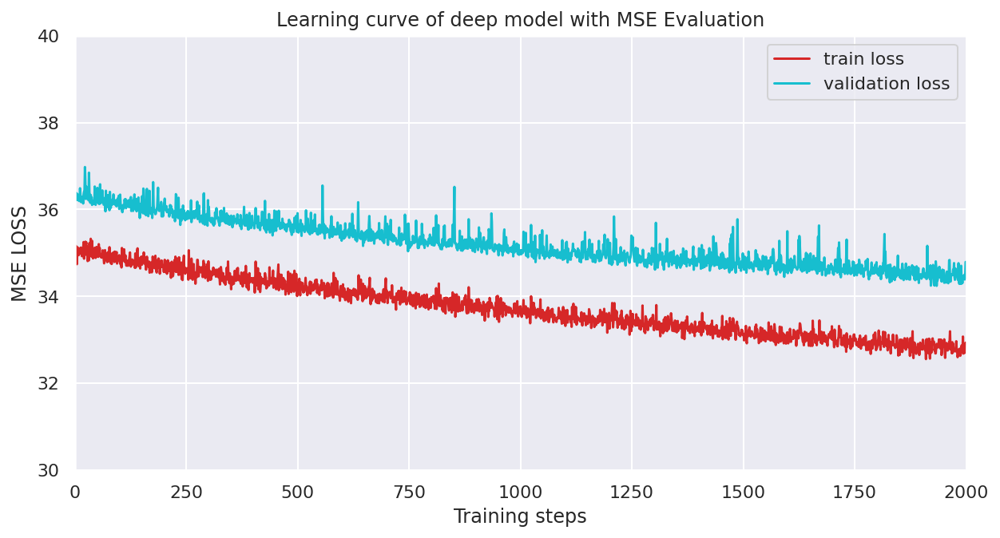

In [ ]:
plot_learning_curve(loss_record_plot_second_train, title='deep model with MSE Evaluation', y_start = 30., y_end = 40., ylabel="MSE LOSS",figsize=(10,5));

In [ ]:
sum_err = 0
for i in range(200):
  sum_err += np.square(loss_record_plot_second_train['train'][i] - loss_record_plot_second_train['dev'][i])
print("epoch 2001 to 200's : Mean square difference between train loss and validation loss is " ,sum_err/200)

epoch 2001 to 200's : Mean square difference between train loss and validation loss is  1.6719838621808405


In [ ]:
sum_err = 0
for i in range(200):
  sum_err +=  np.square(loss_record_plot_second_train['train'][i + 1799] - loss_record_plot_second_train['dev'][i+1799])
print("epoch 3799 to 4000's : Mean square difference between train loss and validation loss is " ,sum_err/200)

epoch 3799 to 4000's : Mean square difference between train loss and validation loss is  2.8311378896602806


We can see that our model keeps improving. But the taining curve and validation curve are starting to depart. The mean squared difference becomes larger. 1.67 -> 2.83

Our last saved model is at 
Epoch [1935/2000]: Train loss: 32.9032, Valid loss: 34.2407 <br>
Saving model with loss 34.241...

Let's reload our model checkpoint and called it new_best_model.
Test it with test set.

In [ ]:
def test_model_on_test_set(model_test):
  criterion = nn.MSELoss(reduction='mean') # Define our loss function. By MSE
  loss_record = []

  # load our best model
  model_test = My_Model(input_dim = train_loader.dataset.x.shape[1]).to(device) # put your model and data on the same computation device.
  ckpt = torch.load(config['save_path'], map_location='cpu')  # Load your best model and no need to load into GPU, since we won't train it. 
  model_test.load_state_dict(ckpt)

  for x, y in test_loader:
            x, y = x.to(device), y.to(device)
            with torch.no_grad():               # set to no gradient decent for prediction
                pred = model_test(x)
                loss = criterion(pred, y)       # the loss function is MSELoss
            loss_record.append(loss.item())

  mean_test_loss = sum(loss_record)/len(loss_record)
  print(f'Test MSE, mean squared error loss is  {mean_test_loss:.4f}')
  print(f'Test RMSE, Root mean squared error loss is  {np.sqrt(mean_test_loss):.4f}')

In [ ]:
new_best_model = My_Model(input_dim = train_loader.dataset.x.shape[1]).to(device) # put our model and data on the same computation device.
ckpt = torch.load(config['save_path'], map_location='cpu') 
new_best_model.load_state_dict(ckpt)
print("Second training results:")
test_model_on_test_set(new_best_model)

Second training results:
Test MSE, mean squared error loss is  36.3343
Test RMSE, Root mean squared error loss is  6.0278


In [ ]:
!unzip models

Archive:  models.zip
  inflating: models/model.ckpt       


In [ ]:
print("Frist training results:")
test_model_on_test_set(best_model)

Frist training results:
Test MSE, mean squared error loss is  38.1825
Test RMSE, Root mean squared error loss is  6.1792


We can see that our model is improving at little bit. With 1.8482 less Mean squared error and 0.1514 less Root mean squared error.

Of course, we can still train this model for another 2000 steps. But it will take too much time and the performance will not have huge difference.

Therefore, we stop at 4000 epoches training.

#### 3.6.5.2. Let's analyze the MSE and accuracy.
After we proved that our model can not imporve anymore. 
It is the time to take a look about our result about how good our model is.

In [ ]:
test_model_on_test_set(new_best_model)

Test MSE, mean squared error loss is  36.3343
Test RMSE, Root mean squared error loss is  6.0278


***6.0278 is our final RMSE on test set.
And 36.3343 is the final MSE.***

 The model never reach test set before. And we have test_data size: (30336, 8).
It is a quite large dataset. 
I can confirm that our model has no overfitting problem. And the performance is relatively good.

The following will show the weights and bias in each layers.
We can say that every nodes have a relative big weight. Our features selection is not bad.

In [ ]:
for name, param in new_best_model.named_parameters():
  print(name, "   " , param)

layers.0.weight     Parameter containing:
tensor([[ 0.2828,  0.3509,  0.1676,  0.1758,  0.0929,  0.1330, -0.1463],
        [ 0.2942,  0.2191, -0.0213,  0.1197, -0.0755,  0.0498, -0.1871],
        [ 0.2868,  0.1791,  0.1173,  0.0274,  0.1803,  0.3525, -0.3297],
        [ 0.0363,  0.4009,  0.2751,  0.8057, -0.0798,  0.0202,  0.2914],
        [-0.3009,  0.3231,  0.3497, -0.1489,  0.0977, -0.0559, -0.0706],
        [ 0.3008, -0.0110, -0.2102,  0.1567,  0.0142,  0.1847,  0.1897],
        [ 0.0090, -0.9566, -0.3801, -0.1951, -0.0525, -0.2690, -0.0505],
        [-0.0190, -0.1063,  0.2760,  0.2409, -0.7276,  0.2198, -0.2798],
        [ 0.3849,  0.1181,  0.0648, -0.0437, -0.1500, -0.0416,  0.0229],
        [ 0.3388, -0.3743, -0.1867,  0.3128, -0.0576,  0.0947, -0.0127],
        [ 0.4871,  0.4527, -0.0337, -0.3569,  0.0258,  0.2034,  0.2432],
        [ 0.0231,  0.1363, -0.1730,  0.0178, -0.0172,  0.7273,  0.0127],
        [ 0.5467,  0.3537,  0.0891,  0.0538, -0.0820,  0.0605,  0.0530],
        [

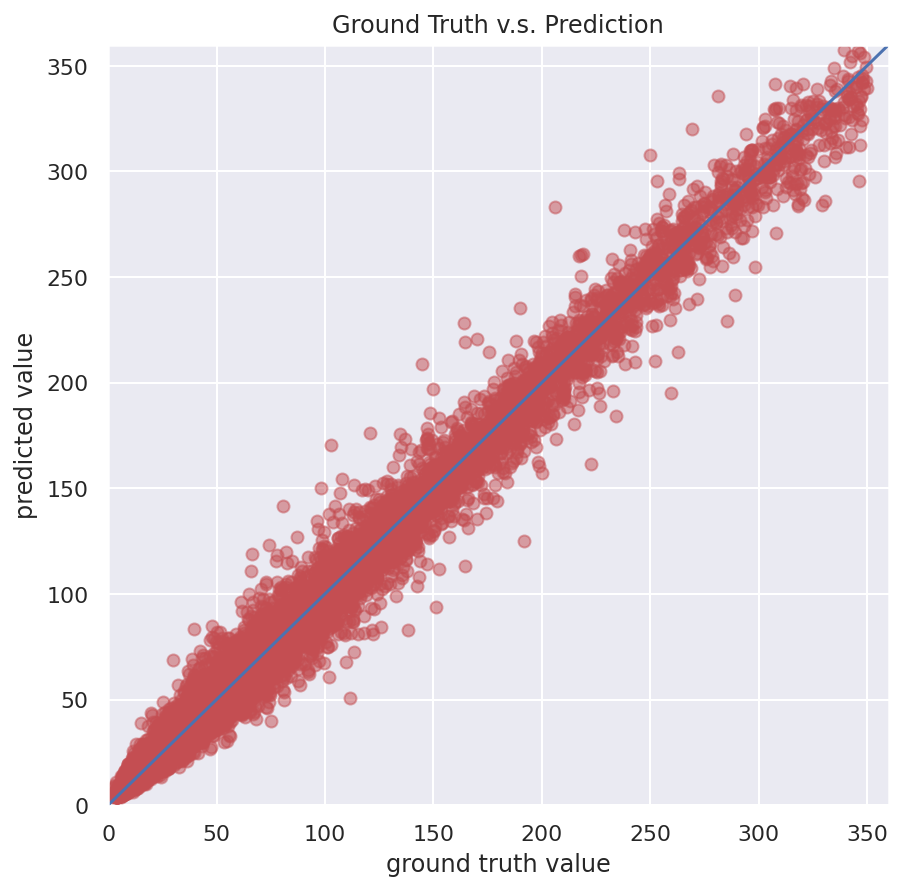

In [ ]:
plot_pred(test_loader, new_best_model, device, figsize=(7,7))  # Show prediction on the validation set

From the ground truth value vs prediction value graph, we can see that our points are almost lays on the perfect prediction line y = x.
This is another proof of our model is reasonably good.

Hence, in summary, our Deep neural network that has 9 hidden layers with highest 128 nodes which has done a good job of predicting the Fire radiative power.
It has no overfitting problem and has 6.1791 RMSE on test set.

Before we call a end on our first attempt on DNN.
Let's take a anothe look at our NN model structure:


In [ ]:
  self.layers = nn.Sequential(
      nn.Linear(input_dim, 16),
      nn.ReLU(),
      nn.Linear(16, 32),
      nn.ReLU(),
      nn.Linear(32, 64),
      nn.ReLU(),
      nn.Linear(64, 128),
      nn.ReLU(),
      nn.Linear(128, 64),
      nn.ReLU(),
      nn.Linear(64, 32),
      nn.ReLU(),
      nn.Linear(32, 16),
      nn.ReLU(),
      nn.Linear(16, 8),
      nn.ReLU(),
      nn.Linear(8, 1),
  )

And this is the visualization graph of my model in a vertical view.
The top is input dimension and the last is the output neural.

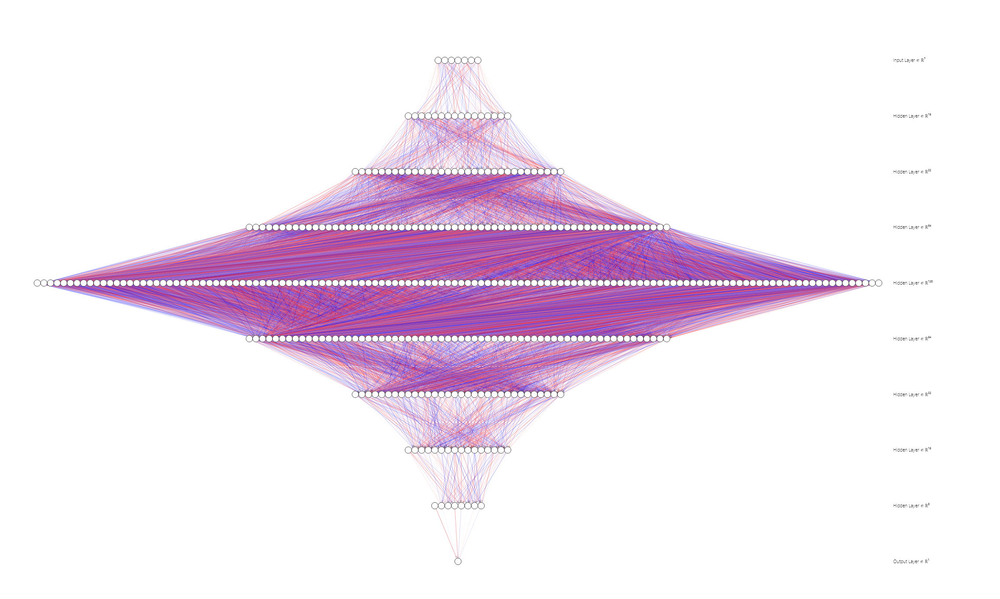

## 3.7. Compare the two models with a statistical significance test. Use a boxplot to visualize your comparison.

Now we have two different models, we want to test those on different test set.
And get their MSE scores and RMSE scores. Then do the significant test on it. 

First we need to generate a couple of different subdatasets.


However, due to the long running time of our models. 
I cut the subdatasets into a even smaller pieces to feed our Neural Netowrk model. But remain the subdatasets size for randomforest model.

This is not a quite good experimental ways to do it. But the size of our datasets won't affect too much performance on Neural Network model. The DNN is mean to be handling small datasets. 

We will adjust a few hyperparameters, such as batch_size, learning rate and epoch number. But the NN structure will remain the same.

### 3.7.1 Generate random sub datasets.

Let's write a function to generate 10 sub datasets randomly, with different random seed.



In [ ]:
raw_data_copy = raw_data.copy()
purged_data = purge_pipeline.fit_transform(raw_data_copy)

IQR = 63.5 - 14.6 = 48.9
MAX = 136.85
Min is 0
Num of min outliers:  0
Num of max outliers:  32535
Num of negative outliers:  2948
Num of the original data set's whole instance 1046679
Rate of purged data/total data 0.031084028627688144


In [ ]:
def create_dp_data(data):
  target = data.pop('frp') # pop our target value
  normalized_df_test=(data-data.mean())/data.std() # standardization our dataset
  normalized_df_test['target'] = target # move our frp target value to the end
  normalized_df_test = normalized_df_test.drop(['Aqua','Terra','D','N', 'month'],axis=1) # drop all useless features.
  return normalized_df_test

##### Use for loop and different random seeds to generate differen subsets

Machine learning and statistics are about assumptions.

My assumption is training DNN on a subsets of our generated subsets is workable.
Since our Neural network has only few nodes. But each of nodes are quite good at finding the gradient descent.

That means our model complexity |H| is small, and if we use a smaller dataset, we still won't have the problem of overfitting.

Details of this you can find it from Lihongyi's Machine Learning class [Why deep/ Validation](https://www.youtube.com/watch?v=yXd2D5J0QDU&t=1249s)

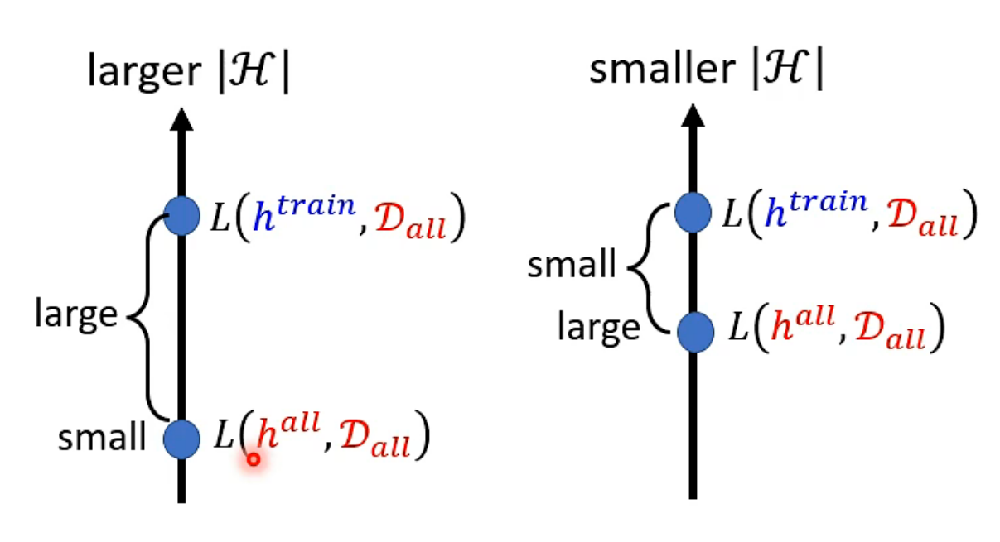

We want every subsets to be different. But we don't want them to be really random.

In [ ]:
def create_data_loader(model_train, model_test):
  # Set seed for reproducibility
  same_seed(config['seed'])

  train_data, test_data = model_train.values, model_test.values

  train_data, valid_data = train_valid_split(train_data, config['valid_ratio'], config['seed'])

  # Print out the data size.
  print(f"""train_data size: {train_data.shape}
  valid_data size: {valid_data.shape}
  test_data size: {test_data.shape}""")

  # Select features
  x_train, x_valid, x_test, y_train, y_valid, y_test = select_feat(train_data, valid_data, test_data, config['select_all'])

  # Print out the number of features.
  print(f'number of features: {x_train.shape[1]}')

  train_dataset, valid_dataset, test_dataset = Fire_Frp_Dataset(x_train, y_train), \
                                              Fire_Frp_Dataset(x_valid, y_valid), \
                                              Fire_Frp_Dataset(x_test,y_test)

  # Pytorch data loader loads pytorch dataset into batches.
  train_loader = DataLoader(train_dataset, batch_size=config['batch_size'], shuffle=True, pin_memory=True)
  valid_loader = DataLoader(valid_dataset, batch_size=config['batch_size'], shuffle=True, pin_memory=True)
  test_loader = DataLoader(test_dataset, batch_size=config['batch_size'], shuffle=False, pin_memory=True)
  return train_loader, valid_loader, test_loader


In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
config = {
    'seed': 5201314,      # Your seed number, you can pick your lucky number. :)
    'select_all': True,   # Whether to use all features.
    'valid_ratio': 0.2,   # validation_size = train_size * valid_ratio
    'batch_size': 2048,   # since we have a quite large dataset. The batch size should be large too
}

In [ ]:
from sklearn.model_selection import train_test_split
import random

train_loader = []
valid_loader = []
test_loader = []
train_loader_NN = []
valid_loader_NN = []

# make sure the seeds are not really random for reproducting resutls

seeds = [218044298, 202077507, 169895152, 229758599,
          36590886, 348821367, 58887816, 178020509, 524236732, 129866998]
         
for i in range(10):
  # use our previous defined function to set all seeds in python
  same_seed(seeds[i]) 
  # each time we generate a new purged dataset.
  remaining_data, subset_data = train_test_split(purged_data, test_size=0.15 )

  normalized_data = create_dp_data(subset_data.copy())
  normalized_data = normalized_data.astype('float');
  # without converting the dataset to float, it won't work
  model_train, model_test = train_test_split(normalized_data, test_size=0.20)
  print("############################   Subsets ", i, "#################################")
  train_loader_temp, valid_loader_temp, test_loader_temp = create_data_loader(model_train, model_test)
  
  # save our dataloader to our arrays 
  train_loader.append(train_loader_temp)
  valid_loader.append(valid_loader_temp)
  test_loader.append(test_loader_temp)

  # I cut the subdatasets into a even smaller pieces to feed our Neural Netowrk model. 
  # But remain the subdatasets size for randomforest model.

  _, NN_dataset = train_test_split(model_train, test_size=0.15)
  NN_train, NN_test = train_test_split(NN_dataset, test_size= 0.20)
  print("Even smaller subsets for Neural Network at ", i)
  train_loader_NN_temp, valid_loader_NN_temp ,_ = create_data_loader(NN_train, NN_test)
  train_loader_NN.append(train_loader_NN_temp)
  valid_loader_NN.append(valid_loader_NN_temp)

############################   Subsets  0 #################################
train_data size: (97076, 7)
  valid_data size: (24268, 7)
  test_data size: (30336, 7)
number of features: 6
Even smaller subsets for Neural Network at  0
train_data size: (11649, 7)
  valid_data size: (2912, 7)
  test_data size: (3641, 7)
number of features: 6
############################   Subsets  1 #################################
train_data size: (97076, 7)
  valid_data size: (24268, 7)
  test_data size: (30336, 7)
number of features: 6
Even smaller subsets for Neural Network at  1
train_data size: (11649, 7)
  valid_data size: (2912, 7)
  test_data size: (3641, 7)
number of features: 6
############################   Subsets  2 #################################
train_data size: (97076, 7)
  valid_data size: (24268, 7)
  test_data size: (30336, 7)
number of features: 6
Even smaller subsets for Neural Network at  2
train_data size: (11649, 7)
  valid_data size: (2912, 7)
  test_data size: (3641, 7)
number o

Write a small function to see if every subsets are different.

In [ ]:
print("Squared difference between")
for i in range(10):
  for j in range(10):
    if i != j and i < j:
      print("subset No.",i , " with", j )
      print("######################", torch.sum(train_loader[i].dataset.x - train_loader[j].dataset.x).item())

Squared difference between
subset No. 0  with 1
###################### -1091.5936279296875
subset No. 0  with 2
###################### -1413.6558837890625
subset No. 0  with 3
###################### -1699.83740234375
subset No. 0  with 4
###################### -1783.047119140625
subset No. 0  with 5
###################### -493.5693359375
subset No. 0  with 6
###################### -559.4505615234375
subset No. 0  with 7
###################### -787.5255126953125
subset No. 0  with 8
###################### -1602.4039306640625
subset No. 0  with 9
###################### -1141.8951416015625
subset No. 1  with 2
###################### -322.06024169921875
subset No. 1  with 3
###################### -608.241455078125
subset No. 1  with 4
###################### -691.451416015625
subset No. 1  with 5
###################### 598.0255737304688
subset No. 1  with 6
###################### 532.1448364257812
subset No. 1  with 7
###################### 304.0704040527344
subset No. 1  with 8
###########

We can see that our small function works just fine.
Every subdatasets are different from each other.


We are ready to train on these sub datasets.

### 3.7.2 Train our random forest model 10 times.

Based on what we found in 3.5 Baseline model, we don't really need our estimators of trees to be 93. From the validation score curve, 40 trees is good enough to show the results.


Since our Neural Network are taking much less data instance.
Let's make our randomforest be a little bit weak too.
93 trees takes too much time. It's meaningless on this part of testing.

From the results we aleady saw, I guess those two models' significant/Null hypothesis test will not reject H0.


Use the best model only costs our time but shows the same result.

In [ ]:
def rf_train_on_multiple_sets(train_loader, test_loader):
  RF_MSE_score = []
  RF_prediction = []
  for i in range(10):
  # convert the rest of dataset
    X_train = train_loader[i].dataset.x.numpy();X_train 
    y_train =train_loader[i].dataset.y.numpy();y_train
    X_test = test_loader[i].dataset.x.numpy()
    y_test = test_loader[i].dataset.y.numpy()
    # Train our model
    forest_reg_final = RandomForestRegressor(max_features=4, n_estimators = 40, random_state=42,
                          verbose=0)
    # train our model
    forest_reg_final.fit(X_train, y_train)
    print("Test set score of No.", i , "subsets")
    # test it on test set
    frp_prediction_final = forest_reg_final.predict(X_test)
    forest_mse_final = mean_squared_error(y_test, frp_prediction_final)
    forest_rmse_final = np.sqrt(forest_mse_final)
    print("Random Forest's Mean squared error: " , forest_mse_final)
    print("Random Forest's root Mean squared error:", forest_rmse_final)
    RF_MSE_score.append(forest_mse_final)
    RF_prediction.append(frp_prediction_final)
  return RF_MSE_score, RF_prediction

In [ ]:
RF_MSE_score,RF_prediction =  rf_train_on_multiple_sets(train_loader,test_loader)

Test set score of No. 0 subsets
Random Forest's Mean squared error:  47.040114906170665
Random Forest's root Mean squared error: 6.858579656617736
Test set score of No. 1 subsets
Random Forest's Mean squared error:  47.114860175090556
Random Forest's root Mean squared error: 6.864026527854518
Test set score of No. 2 subsets
Random Forest's Mean squared error:  45.05413555610615
Random Forest's root Mean squared error: 6.712237745797309
Test set score of No. 3 subsets
Random Forest's Mean squared error:  44.736931822816636
Random Forest's root Mean squared error: 6.68856724738689
Test set score of No. 4 subsets
Random Forest's Mean squared error:  43.6936861297281
Random Forest's root Mean squared error: 6.610119978466964
Test set score of No. 5 subsets
Random Forest's Mean squared error:  46.17861581777608
Random Forest's root Mean squared error: 6.7954849582480925
Test set score of No. 6 subsets
Random Forest's Mean squared error:  45.154294070593025
Random Forest's root Mean squared 

#### Boxplot of random forest's MSE

Text(0, 0.5, 'MSE')

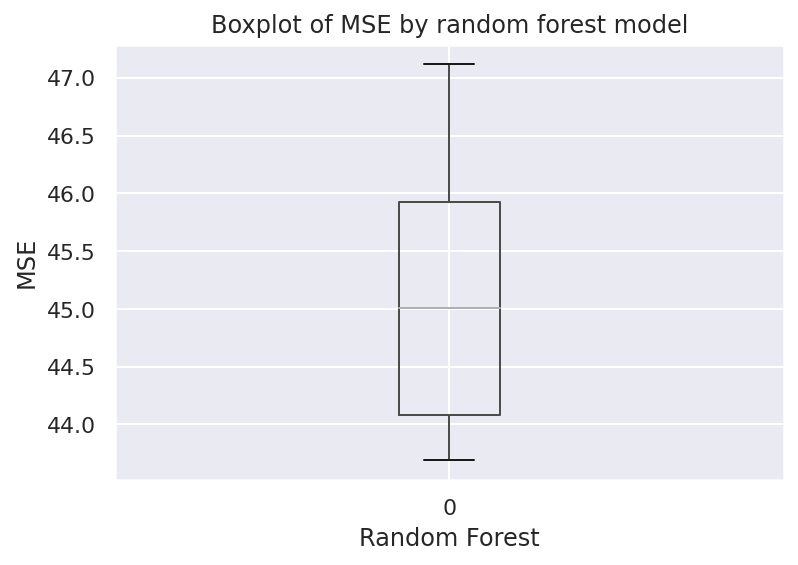

In [ ]:
MSE_RF = pd.DataFrame(RF_MSE_score)
MSE_RF.boxplot()
plt.title("Boxplot of MSE by random forest model")
plt.xlabel('Random Forest')
plt.ylabel('MSE')

### 3.7.3 Train our Neural Network 10 times.

Let's adjust a few hyperparameters.

We turn down the early stopping threshold to 50.

Reduce batch_size to 2048.

Since we have a smaller dataset, we need increase our learning rate to 1e-3.

That's all we need.

In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
config = {
    'seed': 5201314,      # Your seed number, you can pick your lucky number. :)
    'select_all': True,   # Whether to use all features.
    'valid_ratio': 0.2,   # validation_size = train_size * valid_ratio
    'n_epochs': 1000,     # Number of epochs. epoches larger than 2000 won't do any good. But waste our time. Based on my hundreds of training experience.
    'batch_size': 2048,   # since we have a quite large dataset. The batch size should be large too
    'learning_rate': 1e-3,
    'early_stop': 50,    # If model has not improved for this many consecutive epochs, stop training.
    'save_path': './models/model.ckpt'  # Your model will be saved here.
}

In [ ]:
torch.cuda.is_available()

True

#### slightly modifed trainer for printing which dataset we are training

In [ ]:
def trainer(train_loader, valid_loader, model, config, device, iteration):

    criterion = nn.MSELoss(reduction='mean') # Define our loss function. By MSE

    # Define our optimization algorithm.
    # Added L2 regularization (optimizer(weight decay...)
    # the performance of SGD is not good in our dataset

    # basic stochastic gradient decent
    # optimizer = torch.optim.SGD(model.parameters(), lr=config['learning_rate'], momentum=0.9)
    # adam with warm up.
    # works not quite good in our dataset
    # optimizer = torch.optim.RAdam(model.parameters(), lr=config['learning_rate'],weight_decay=config['learning_rate'])


    # Adam with improved weight decay. 
    # weight decay is slightly better than the original L2 regularizatoin

    optimizer = torch.optim.AdamW(model.parameters(), lr=config['learning_rate'],weight_decay=config['learning_rate'])
    writer = SummaryWriter() # Writer of tensoboard.

    if not os.path.isdir('./models'):
        os.mkdir('./models') # Create directory of saving models.
    # get our hyperparamters
    n_epochs, best_loss, step, early_stop_count = config['n_epochs'], math.inf, 0, 0
    # this is the result saver for our plot function
    loss_record_plot = {'train': [], 'dev': []}      # for recording training loss

    for epoch in range(n_epochs):
        model.train() # Set your model to train mode.
        loss_record = [] # loss container for tensorboard plot

        # tqdm is a package to visualize our training progress.
        train_pbar = tqdm(train_loader, position=0, leave=True)

        for x, y in train_pbar:
            optimizer.zero_grad()               # Set gradient to zero.
            x, y = x.to(device), y.to(device)   # Move data to device.(GPU/CPU)
            pred = model(x)
            loss = criterion(pred, y)           # get loss by pytorch criterion function
            loss.backward()                     # Compute gradient(backpropagation).
            optimizer.step()                    # Update parameters.
            step += 1
            loss_record.append(loss.detach().item() )  # get loss value

            # Display current epoch number and loss on tqdm progress bar.
            train_pbar.set_description(f'Epoch [{epoch+1}/{n_epochs}]')
            train_pbar.set_postfix({'loss': loss.detach().item()})

        mean_train_loss = sum(loss_record)/len(loss_record)
        writer.add_scalar('Loss/train', mean_train_loss, step)   # add train loss data to tensorboard writer
        loss_record_plot['train'].append(mean_train_loss) # add loss into our extra plot array


        model.eval() # Set your model to evaluation mode.
        loss_record = []
        for x, y in valid_loader:
            x, y = x.to(device), y.to(device)
            with torch.no_grad():               # set to no gradient decent for prediction
                pred = model(x)
                loss = criterion(pred, y)
            loss_record.append(loss.item())

        mean_valid_loss = sum(loss_record)/len(loss_record)
        print(f'#### {iteration} ##### \nEpoch [{epoch+1}/{n_epochs}]: Train loss: {mean_train_loss:.4f}, Valid loss: {mean_valid_loss:.4f}')
        writer.add_scalar('Loss/valid', mean_valid_loss, step) # add validation loss data to tensorboard writer
        loss_record_plot['dev'].append(mean_valid_loss)

        # those lines are for showing train/valid plot in one graph in tensorboard
        # spend quite hours to find this solution
        writer.add_scalars('data/test', {'train': mean_train_loss}, step)
        writer.add_scalars('data/test', {'valid': mean_valid_loss}, step)

        # Early stopping setting
        # if the model didn't become better in N steps, stop the training.
        # Those steps are preventing overfitting problems.
        if mean_valid_loss < best_loss:
            best_loss = mean_valid_loss
            torch.save(model.state_dict(), config['save_path']) # Save your best model
            print('Saving model with loss {:.3f}...'.format(best_loss))
            early_stop_count = 0
        else:
            early_stop_count += 1

        if early_stop_count >= config['early_stop']:
            print('\nModel is not improving, so we halt the training session.')
            return loss_record_plot

    return loss_record_plot # return the matplotlib plot results.

#### Start training

In [ ]:
model_stack = []
loss_record_plot_stack = []

for i in range(10):
  print("Training on Subsets NO.",i)
  if i != 0:
    del model_temp
  # start to training 
  model_temp = My_Model(input_dim = train_loader_NN[i].dataset.x.shape[1]).to(device) 
  loss_record_plot_temp = trainer(train_loader_NN[i], valid_loader_NN[i], model_temp, config, device, i);
  # # load our best model, instead of the potentially overfitted models
  best_model = My_Model(input_dim=train_loader[i].dataset.x.shape[1]).to(device) # put your model and data on the same computation device.
  ckpt = torch.load(config['save_path'], map_location='cpu')  # Load your best model and no need to load into GPU, since we won't train it. 
  best_model.load_state_dict(ckpt)
  # save our best model into our arrays
  model_stack.append(best_model)
  # save our learning curve data
  loss_record_plot_stack.append(loss_record_plot_temp)

Training on Subsets NO. 0


Epoch [1/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.33it/s, loss=5.56e+3]


#### 0 ##### 
Epoch [1/1000]: Train loss: 5656.6839, Valid loss: 5785.7417
Saving model with loss 5785.742...


Epoch [2/1000]: 100%|██████████| 3/3 [00:00<00:00, 37.35it/s, loss=5.63e+3]


#### 0 ##### 
Epoch [2/1000]: Train loss: 5673.0044, Valid loss: 5783.5635
Saving model with loss 5783.563...


Epoch [3/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.85it/s, loss=5.84e+3]


#### 0 ##### 
Epoch [3/1000]: Train loss: 5718.1432, Valid loss: 5781.5015
Saving model with loss 5781.501...


Epoch [4/1000]: 100%|██████████| 3/3 [00:00<00:00, 36.52it/s, loss=4.84e+3]


#### 0 ##### 
Epoch [4/1000]: Train loss: 5490.2349, Valid loss: 5779.1699
Saving model with loss 5779.170...


Epoch [5/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.54it/s, loss=5.28e+3]


#### 0 ##### 
Epoch [5/1000]: Train loss: 5586.4146, Valid loss: 5776.3882
Saving model with loss 5776.388...


Epoch [6/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.31it/s, loss=5.49e+3]


#### 0 ##### 
Epoch [6/1000]: Train loss: 5633.6862, Valid loss: 5772.5908
Saving model with loss 5772.591...


Epoch [7/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.19it/s, loss=5.54e+3]


#### 0 ##### 
Epoch [7/1000]: Train loss: 5641.8232, Valid loss: 5767.0132
Saving model with loss 5767.013...


Epoch [8/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.29it/s, loss=5.44e+3]


#### 0 ##### 
Epoch [8/1000]: Train loss: 5612.9611, Valid loss: 5759.4004
Saving model with loss 5759.400...


Epoch [9/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.15it/s, loss=5.68e+3]


#### 0 ##### 
Epoch [9/1000]: Train loss: 5662.5763, Valid loss: 5750.9609
Saving model with loss 5750.961...


Epoch [10/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.15it/s, loss=5.85e+3]


#### 0 ##### 
Epoch [10/1000]: Train loss: 5692.9621, Valid loss: 5739.7080
Saving model with loss 5739.708...


Epoch [11/1000]: 100%|██████████| 3/3 [00:00<00:00,  4.85it/s, loss=5.75e+3]


#### 0 ##### 
Epoch [11/1000]: Train loss: 5662.1250, Valid loss: 5720.5703
Saving model with loss 5720.570...


Epoch [12/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.97it/s, loss=5.49e+3]


#### 0 ##### 
Epoch [12/1000]: Train loss: 5586.5664, Valid loss: 5688.3745
Saving model with loss 5688.375...


Epoch [13/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.45it/s, loss=5.08e+3]


#### 0 ##### 
Epoch [13/1000]: Train loss: 5463.9761, Valid loss: 5634.9790
Saving model with loss 5634.979...


Epoch [14/1000]: 100%|██████████| 3/3 [00:00<00:00, 36.48it/s, loss=5.21e+3]


#### 0 ##### 
Epoch [14/1000]: Train loss: 5447.7733, Valid loss: 5547.7314
Saving model with loss 5547.731...


Epoch [15/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.94it/s, loss=5.68e+3]


#### 0 ##### 
Epoch [15/1000]: Train loss: 5479.1701, Valid loss: 5408.4131
Saving model with loss 5408.413...


Epoch [16/1000]: 100%|██████████| 3/3 [00:00<00:00, 13.15it/s, loss=5.72e+3]


#### 0 ##### 
Epoch [16/1000]: Train loss: 5370.9896, Valid loss: 5191.1948
Saving model with loss 5191.195...


Epoch [17/1000]: 100%|██████████| 3/3 [00:00<00:00, 37.07it/s, loss=4.76e+3]


#### 0 ##### 
Epoch [17/1000]: Train loss: 4970.2923, Valid loss: 4867.8481
Saving model with loss 4867.848...


Epoch [18/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.02it/s, loss=4.17e+3]


#### 0 ##### 
Epoch [18/1000]: Train loss: 4567.4062, Valid loss: 4403.3447
Saving model with loss 4403.345...


Epoch [19/1000]: 100%|██████████| 3/3 [00:00<00:00, 36.38it/s, loss=3.79e+3]


#### 0 ##### 
Epoch [19/1000]: Train loss: 4098.3120, Valid loss: 3781.9600
Saving model with loss 3781.960...


Epoch [20/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.35it/s, loss=2.88e+3]


#### 0 ##### 
Epoch [20/1000]: Train loss: 3401.4359, Valid loss: 3081.1672
Saving model with loss 3081.167...


Epoch [21/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.00it/s, loss=2.61e+3]


#### 0 ##### 
Epoch [21/1000]: Train loss: 2814.5426, Valid loss: 2574.6648
Saving model with loss 2574.665...


Epoch [22/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.64it/s, loss=2.29e+3]


#### 0 ##### 
Epoch [22/1000]: Train loss: 2449.4495, Valid loss: 2593.3174


Epoch [23/1000]: 100%|██████████| 3/3 [00:00<00:00, 36.88it/s, loss=2.47e+3]


#### 0 ##### 
Epoch [23/1000]: Train loss: 2525.3800, Valid loss: 2522.6533
Saving model with loss 2522.653...


Epoch [24/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.33it/s, loss=2.25e+3]


#### 0 ##### 
Epoch [24/1000]: Train loss: 2348.4875, Valid loss: 2176.0671
Saving model with loss 2176.067...


Epoch [25/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.82it/s, loss=2.25e+3]


#### 0 ##### 
Epoch [25/1000]: Train loss: 2106.7759, Valid loss: 1981.9691
Saving model with loss 1981.969...


Epoch [26/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.14it/s, loss=1.78e+3]


#### 0 ##### 
Epoch [26/1000]: Train loss: 1883.6561, Valid loss: 1898.2921
Saving model with loss 1898.292...


Epoch [27/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.34it/s, loss=1.66e+3]


#### 0 ##### 
Epoch [27/1000]: Train loss: 1795.9698, Valid loss: 1791.2317
Saving model with loss 1791.232...


Epoch [28/1000]: 100%|██████████| 3/3 [00:00<00:00, 33.01it/s, loss=1.47e+3]


#### 0 ##### 
Epoch [28/1000]: Train loss: 1664.8984, Valid loss: 1645.8783
Saving model with loss 1645.878...


Epoch [29/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.78it/s, loss=1.33e+3]


#### 0 ##### 
Epoch [29/1000]: Train loss: 1527.0570, Valid loss: 1525.3009
Saving model with loss 1525.301...


Epoch [30/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.90it/s, loss=1.53e+3]


#### 0 ##### 
Epoch [30/1000]: Train loss: 1488.9961, Valid loss: 1450.2140
Saving model with loss 1450.214...


Epoch [31/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.85it/s, loss=1.46e+3]


#### 0 ##### 
Epoch [31/1000]: Train loss: 1425.6346, Valid loss: 1382.4924
Saving model with loss 1382.492...


Epoch [32/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.55it/s, loss=1.39e+3]


#### 0 ##### 
Epoch [32/1000]: Train loss: 1358.8077, Valid loss: 1297.4692
Saving model with loss 1297.469...


Epoch [33/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.16it/s, loss=1.39e+3]


#### 0 ##### 
Epoch [33/1000]: Train loss: 1296.9830, Valid loss: 1223.9763
Saving model with loss 1223.976...


Epoch [34/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.54it/s, loss=1.32e+3]


#### 0 ##### 
Epoch [34/1000]: Train loss: 1230.6268, Valid loss: 1168.8691
Saving model with loss 1168.869...


Epoch [35/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.54it/s, loss=1.2e+3]


#### 0 ##### 
Epoch [35/1000]: Train loss: 1163.3765, Valid loss: 1114.0940
Saving model with loss 1114.094...


Epoch [36/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.90it/s, loss=1.03e+3]


#### 0 ##### 
Epoch [36/1000]: Train loss: 1085.5988, Valid loss: 1056.4365
Saving model with loss 1056.437...


Epoch [37/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.83it/s, loss=956]


#### 0 ##### 
Epoch [37/1000]: Train loss: 1028.9053, Valid loss: 1008.5831
Saving model with loss 1008.583...


Epoch [38/1000]: 100%|██████████| 3/3 [00:00<00:00, 13.06it/s, loss=830]


#### 0 ##### 
Epoch [38/1000]: Train loss: 969.3932, Valid loss: 965.2972
Saving model with loss 965.297...


Epoch [39/1000]: 100%|██████████| 3/3 [00:00<00:00, 28.22it/s, loss=1.02e+3]


#### 0 ##### 
Epoch [39/1000]: Train loss: 979.6796, Valid loss: 923.0060
Saving model with loss 923.006...


Epoch [40/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.88it/s, loss=834]


#### 0 ##### 
Epoch [40/1000]: Train loss: 907.9949, Valid loss: 885.0728
Saving model with loss 885.073...


Epoch [41/1000]: 100%|██████████| 3/3 [00:00<00:00, 37.22it/s, loss=908]


#### 0 ##### 
Epoch [41/1000]: Train loss: 897.5682, Valid loss: 849.5739
Saving model with loss 849.574...


Epoch [42/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.12it/s, loss=876]


#### 0 ##### 
Epoch [42/1000]: Train loss: 864.4829, Valid loss: 814.5770
Saving model with loss 814.577...


Epoch [43/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.59it/s, loss=890]


#### 0 ##### 
Epoch [43/1000]: Train loss: 842.3578, Valid loss: 781.1617
Saving model with loss 781.162...


Epoch [44/1000]: 100%|██████████| 3/3 [00:00<00:00, 35.16it/s, loss=725]


#### 0 ##### 
Epoch [44/1000]: Train loss: 781.1997, Valid loss: 749.6267
Saving model with loss 749.627...


Epoch [45/1000]: 100%|██████████| 3/3 [00:00<00:00, 35.26it/s, loss=785]


#### 0 ##### 
Epoch [45/1000]: Train loss: 772.8613, Valid loss: 720.1810
Saving model with loss 720.181...


Epoch [46/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.29it/s, loss=765]


#### 0 ##### 
Epoch [46/1000]: Train loss: 746.8106, Valid loss: 692.4147
Saving model with loss 692.415...


Epoch [47/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.46it/s, loss=679]


#### 0 ##### 
Epoch [47/1000]: Train loss: 706.7168, Valid loss: 666.8552
Saving model with loss 666.855...


Epoch [48/1000]: 100%|██████████| 3/3 [00:00<00:00, 35.20it/s, loss=672]


#### 0 ##### 
Epoch [48/1000]: Train loss: 685.7984, Valid loss: 641.0166
Saving model with loss 641.017...


Epoch [49/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.94it/s, loss=669]


#### 0 ##### 
Epoch [49/1000]: Train loss: 665.9895, Valid loss: 615.6598
Saving model with loss 615.660...


Epoch [50/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.56it/s, loss=624]


#### 0 ##### 
Epoch [50/1000]: Train loss: 637.2649, Valid loss: 591.6818
Saving model with loss 591.682...


Epoch [51/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.69it/s, loss=596]


#### 0 ##### 
Epoch [51/1000]: Train loss: 614.0002, Valid loss: 568.9943
Saving model with loss 568.994...


Epoch [52/1000]: 100%|██████████| 3/3 [00:00<00:00, 33.74it/s, loss=570]


#### 0 ##### 
Epoch [52/1000]: Train loss: 591.0664, Valid loss: 547.3862
Saving model with loss 547.386...


Epoch [53/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.67it/s, loss=570]


#### 0 ##### 
Epoch [53/1000]: Train loss: 574.7332, Valid loss: 527.3153
Saving model with loss 527.315...


Epoch [54/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.70it/s, loss=542]


#### 0 ##### 
Epoch [54/1000]: Train loss: 553.1072, Valid loss: 506.5085
Saving model with loss 506.508...


Epoch [55/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.72it/s, loss=545]


#### 0 ##### 
Epoch [55/1000]: Train loss: 538.2282, Valid loss: 486.9255
Saving model with loss 486.926...


Epoch [56/1000]: 100%|██████████| 3/3 [00:00<00:00, 35.75it/s, loss=532]


#### 0 ##### 
Epoch [56/1000]: Train loss: 520.7499, Valid loss: 467.5831
Saving model with loss 467.583...


Epoch [57/1000]: 100%|██████████| 3/3 [00:00<00:00, 37.09it/s, loss=516]


#### 0 ##### 
Epoch [57/1000]: Train loss: 503.1880, Valid loss: 449.1752
Saving model with loss 449.175...


Epoch [58/1000]: 100%|██████████| 3/3 [00:00<00:00, 37.18it/s, loss=528]


#### 0 ##### 
Epoch [58/1000]: Train loss: 492.3530, Valid loss: 431.4884
Saving model with loss 431.488...


Epoch [59/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.95it/s, loss=480]


#### 0 ##### 
Epoch [59/1000]: Train loss: 468.0752, Valid loss: 414.4912
Saving model with loss 414.491...


Epoch [60/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.39it/s, loss=410]


#### 0 ##### 
Epoch [60/1000]: Train loss: 439.2266, Valid loss: 398.5031
Saving model with loss 398.503...


Epoch [61/1000]: 100%|██████████| 3/3 [00:00<00:00, 35.52it/s, loss=382]


#### 0 ##### 
Epoch [61/1000]: Train loss: 420.6643, Valid loss: 383.3285
Saving model with loss 383.328...


Epoch [62/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.76it/s, loss=387]


#### 0 ##### 
Epoch [62/1000]: Train loss: 410.0106, Valid loss: 368.7799
Saving model with loss 368.780...


Epoch [63/1000]: 100%|██████████| 3/3 [00:00<00:00, 35.60it/s, loss=376]


#### 0 ##### 
Epoch [63/1000]: Train loss: 396.0717, Valid loss: 354.8474
Saving model with loss 354.847...


Epoch [64/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.77it/s, loss=410]


#### 0 ##### 
Epoch [64/1000]: Train loss: 393.0186, Valid loss: 341.9169
Saving model with loss 341.917...


Epoch [65/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.61it/s, loss=347]


#### 0 ##### 
Epoch [65/1000]: Train loss: 368.4780, Valid loss: 330.4120
Saving model with loss 330.412...


Epoch [66/1000]: 100%|██████████| 3/3 [00:00<00:00, 33.43it/s, loss=332]


#### 0 ##### 
Epoch [66/1000]: Train loss: 355.3144, Valid loss: 318.7979
Saving model with loss 318.798...


Epoch [67/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.91it/s, loss=379]


#### 0 ##### 
Epoch [67/1000]: Train loss: 356.4077, Valid loss: 307.7932
Saving model with loss 307.793...


Epoch [68/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.24it/s, loss=303]


#### 0 ##### 
Epoch [68/1000]: Train loss: 330.4295, Valid loss: 297.6197
Saving model with loss 297.620...


Epoch [69/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.81it/s, loss=283]


#### 0 ##### 
Epoch [69/1000]: Train loss: 317.4452, Valid loss: 288.2442
Saving model with loss 288.244...


Epoch [70/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.65it/s, loss=329]


#### 0 ##### 
Epoch [70/1000]: Train loss: 320.1363, Valid loss: 279.3079
Saving model with loss 279.308...


Epoch [71/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.19it/s, loss=309]


#### 0 ##### 
Epoch [71/1000]: Train loss: 308.1432, Valid loss: 270.5007
Saving model with loss 270.501...


Epoch [72/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.95it/s, loss=320]


#### 0 ##### 
Epoch [72/1000]: Train loss: 303.3663, Valid loss: 262.1521
Saving model with loss 262.152...


Epoch [73/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.58it/s, loss=278]


#### 0 ##### 
Epoch [73/1000]: Train loss: 287.1721, Valid loss: 254.2413
Saving model with loss 254.241...


Epoch [74/1000]: 100%|██████████| 3/3 [00:00<00:00, 36.20it/s, loss=346]


#### 0 ##### 
Epoch [74/1000]: Train loss: 296.1732, Valid loss: 247.0701
Saving model with loss 247.070...


Epoch [75/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.34it/s, loss=286]


#### 0 ##### 
Epoch [75/1000]: Train loss: 276.7434, Valid loss: 240.4356
Saving model with loss 240.436...


Epoch [76/1000]: 100%|██████████| 3/3 [00:00<00:00, 35.00it/s, loss=263]


#### 0 ##### 
Epoch [76/1000]: Train loss: 265.9060, Valid loss: 234.5737
Saving model with loss 234.574...


Epoch [77/1000]: 100%|██████████| 3/3 [00:00<00:00, 35.88it/s, loss=255]


#### 0 ##### 
Epoch [77/1000]: Train loss: 258.6514, Valid loss: 229.1386
Saving model with loss 229.139...


Epoch [78/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.52it/s, loss=253]


#### 0 ##### 
Epoch [78/1000]: Train loss: 253.2688, Valid loss: 224.1954
Saving model with loss 224.195...


Epoch [79/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.28it/s, loss=218]


#### 0 ##### 
Epoch [79/1000]: Train loss: 240.6592, Valid loss: 219.1415
Saving model with loss 219.141...


Epoch [80/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.41it/s, loss=251]


#### 0 ##### 
Epoch [80/1000]: Train loss: 243.7305, Valid loss: 214.3731
Saving model with loss 214.373...


Epoch [81/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.67it/s, loss=242]


#### 0 ##### 
Epoch [81/1000]: Train loss: 237.4217, Valid loss: 209.8020
Saving model with loss 209.802...


Epoch [82/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.95it/s, loss=247]


#### 0 ##### 
Epoch [82/1000]: Train loss: 234.6441, Valid loss: 205.1977
Saving model with loss 205.198...


Epoch [83/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.61it/s, loss=223]


#### 0 ##### 
Epoch [83/1000]: Train loss: 225.5263, Valid loss: 201.0146
Saving model with loss 201.015...


Epoch [84/1000]: 100%|██████████| 3/3 [00:00<00:00, 33.74it/s, loss=271]


#### 0 ##### 
Epoch [84/1000]: Train loss: 232.8824, Valid loss: 197.1594
Saving model with loss 197.159...


Epoch [85/1000]: 100%|██████████| 3/3 [00:00<00:00, 33.83it/s, loss=230]


#### 0 ##### 
Epoch [85/1000]: Train loss: 220.3643, Valid loss: 193.4670
Saving model with loss 193.467...


Epoch [86/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.14it/s, loss=217]


#### 0 ##### 
Epoch [86/1000]: Train loss: 214.2063, Valid loss: 190.6366
Saving model with loss 190.637...


Epoch [87/1000]: 100%|██████████| 3/3 [00:00<00:00, 33.62it/s, loss=197]


#### 0 ##### 
Epoch [87/1000]: Train loss: 206.9169, Valid loss: 187.7027
Saving model with loss 187.703...


Epoch [88/1000]: 100%|██████████| 3/3 [00:00<00:00, 36.55it/s, loss=173]


#### 0 ##### 
Epoch [88/1000]: Train loss: 198.6117, Valid loss: 184.9620
Saving model with loss 184.962...


Epoch [89/1000]: 100%|██████████| 3/3 [00:00<00:00, 35.58it/s, loss=213]


#### 0 ##### 
Epoch [89/1000]: Train loss: 205.1278, Valid loss: 182.0106
Saving model with loss 182.011...


Epoch [90/1000]: 100%|██████████| 3/3 [00:00<00:00, 33.10it/s, loss=189]


#### 0 ##### 
Epoch [90/1000]: Train loss: 197.0410, Valid loss: 179.1322
Saving model with loss 179.132...


Epoch [91/1000]: 100%|██████████| 3/3 [00:00<00:00, 13.15it/s, loss=179]


#### 0 ##### 
Epoch [91/1000]: Train loss: 192.4003, Valid loss: 176.1706
Saving model with loss 176.171...


Epoch [92/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.93it/s, loss=235]


#### 0 ##### 
Epoch [92/1000]: Train loss: 202.6744, Valid loss: 173.5815
Saving model with loss 173.581...


Epoch [93/1000]: 100%|██████████| 3/3 [00:00<00:00, 29.95it/s, loss=179]


#### 0 ##### 
Epoch [93/1000]: Train loss: 187.6118, Valid loss: 171.0977
Saving model with loss 171.098...


Epoch [94/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.31it/s, loss=182]


#### 0 ##### 
Epoch [94/1000]: Train loss: 186.1103, Valid loss: 168.6937
Saving model with loss 168.694...


Epoch [95/1000]: 100%|██████████| 3/3 [00:00<00:00, 35.35it/s, loss=195]


#### 0 ##### 
Epoch [95/1000]: Train loss: 186.8519, Valid loss: 166.5069
Saving model with loss 166.507...


Epoch [96/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.89it/s, loss=192]


#### 0 ##### 
Epoch [96/1000]: Train loss: 184.2122, Valid loss: 164.5212
Saving model with loss 164.521...


Epoch [97/1000]: 100%|██████████| 3/3 [00:00<00:00, 33.06it/s, loss=178]


#### 0 ##### 
Epoch [97/1000]: Train loss: 178.7056, Valid loss: 162.7076
Saving model with loss 162.708...


Epoch [98/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.28it/s, loss=196]


#### 0 ##### 
Epoch [98/1000]: Train loss: 180.9886, Valid loss: 160.5717
Saving model with loss 160.572...


Epoch [99/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.55it/s, loss=172]


#### 0 ##### 
Epoch [99/1000]: Train loss: 173.3493, Valid loss: 158.4040
Saving model with loss 158.404...


Epoch [100/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.12it/s, loss=193]


#### 0 ##### 
Epoch [100/1000]: Train loss: 176.1083, Valid loss: 155.6182
Saving model with loss 155.618...


Epoch [101/1000]: 100%|██████████| 3/3 [00:00<00:00, 33.49it/s, loss=166]


#### 0 ##### 
Epoch [101/1000]: Train loss: 168.1083, Valid loss: 153.8451
Saving model with loss 153.845...


Epoch [102/1000]: 100%|██████████| 3/3 [00:00<00:00, 35.13it/s, loss=142]


#### 0 ##### 
Epoch [102/1000]: Train loss: 160.6074, Valid loss: 151.4352
Saving model with loss 151.435...


Epoch [103/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.69it/s, loss=153]


#### 0 ##### 
Epoch [103/1000]: Train loss: 160.9242, Valid loss: 149.4338
Saving model with loss 149.434...


Epoch [104/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.98it/s, loss=140]


#### 0 ##### 
Epoch [104/1000]: Train loss: 156.3182, Valid loss: 147.3123
Saving model with loss 147.312...


Epoch [105/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.15it/s, loss=173]


#### 0 ##### 
Epoch [105/1000]: Train loss: 161.7496, Valid loss: 145.4638
Saving model with loss 145.464...


Epoch [106/1000]: 100%|██████████| 3/3 [00:00<00:00, 33.98it/s, loss=146]


#### 0 ##### 
Epoch [106/1000]: Train loss: 153.6126, Valid loss: 143.6950
Saving model with loss 143.695...


Epoch [107/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.56it/s, loss=163]


#### 0 ##### 
Epoch [107/1000]: Train loss: 155.6009, Valid loss: 142.1545
Saving model with loss 142.154...


Epoch [108/1000]: 100%|██████████| 3/3 [00:00<00:00, 35.09it/s, loss=134]


#### 0 ##### 
Epoch [108/1000]: Train loss: 147.1185, Valid loss: 139.9844
Saving model with loss 139.984...


Epoch [109/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.58it/s, loss=149]


#### 0 ##### 
Epoch [109/1000]: Train loss: 148.6364, Valid loss: 137.4224
Saving model with loss 137.422...


Epoch [110/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.34it/s, loss=147]


#### 0 ##### 
Epoch [110/1000]: Train loss: 146.2719, Valid loss: 135.4534
Saving model with loss 135.453...


Epoch [111/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.18it/s, loss=119]


#### 0 ##### 
Epoch [111/1000]: Train loss: 137.9690, Valid loss: 133.7903
Saving model with loss 133.790...


Epoch [112/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.64it/s, loss=148]


#### 0 ##### 
Epoch [112/1000]: Train loss: 142.7710, Valid loss: 132.0168
Saving model with loss 132.017...


Epoch [113/1000]: 100%|██████████| 3/3 [00:00<00:00, 35.84it/s, loss=138]


#### 0 ##### 
Epoch [113/1000]: Train loss: 138.7303, Valid loss: 130.0769
Saving model with loss 130.077...


Epoch [114/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.79it/s, loss=112]


#### 0 ##### 
Epoch [114/1000]: Train loss: 130.9951, Valid loss: 128.1546
Saving model with loss 128.155...


Epoch [115/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.35it/s, loss=170]


#### 0 ##### 
Epoch [115/1000]: Train loss: 142.4728, Valid loss: 126.3246
Saving model with loss 126.325...


Epoch [116/1000]: 100%|██████████| 3/3 [00:00<00:00, 36.26it/s, loss=107]


#### 0 ##### 
Epoch [116/1000]: Train loss: 126.5738, Valid loss: 124.4677
Saving model with loss 124.468...


Epoch [117/1000]: 100%|██████████| 3/3 [00:00<00:00, 33.67it/s, loss=118]


#### 0 ##### 
Epoch [117/1000]: Train loss: 127.3540, Valid loss: 122.4469
Saving model with loss 122.447...


Epoch [118/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.58it/s, loss=134]


#### 0 ##### 
Epoch [118/1000]: Train loss: 129.3968, Valid loss: 120.8353
Saving model with loss 120.835...


Epoch [119/1000]: 100%|██████████| 3/3 [00:00<00:00, 33.62it/s, loss=115]


#### 0 ##### 
Epoch [119/1000]: Train loss: 123.6496, Valid loss: 119.1879
Saving model with loss 119.188...


Epoch [120/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.64it/s, loss=135]


#### 0 ##### 
Epoch [120/1000]: Train loss: 126.7971, Valid loss: 117.6533
Saving model with loss 117.653...


Epoch [121/1000]: 100%|██████████| 3/3 [00:00<00:00, 28.12it/s, loss=150]


#### 0 ##### 
Epoch [121/1000]: Train loss: 128.7756, Valid loss: 116.0520
Saving model with loss 116.052...


Epoch [122/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.54it/s, loss=107]


#### 0 ##### 
Epoch [122/1000]: Train loss: 117.5325, Valid loss: 114.7464
Saving model with loss 114.746...


Epoch [123/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.21it/s, loss=146]


#### 0 ##### 
Epoch [123/1000]: Train loss: 124.9859, Valid loss: 113.7207
Saving model with loss 113.721...


Epoch [124/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.59it/s, loss=105]


#### 0 ##### 
Epoch [124/1000]: Train loss: 114.5737, Valid loss: 112.6448
Saving model with loss 112.645...


Epoch [125/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.95it/s, loss=115]


#### 0 ##### 
Epoch [125/1000]: Train loss: 115.5252, Valid loss: 111.5549
Saving model with loss 111.555...


Epoch [126/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.73it/s, loss=112]


#### 0 ##### 
Epoch [126/1000]: Train loss: 113.9147, Valid loss: 110.4888
Saving model with loss 110.489...


Epoch [127/1000]: 100%|██████████| 3/3 [00:00<00:00, 35.01it/s, loss=133]


#### 0 ##### 
Epoch [127/1000]: Train loss: 117.2851, Valid loss: 109.0657
Saving model with loss 109.066...


Epoch [128/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.05it/s, loss=102]


#### 0 ##### 
Epoch [128/1000]: Train loss: 109.1382, Valid loss: 107.6262
Saving model with loss 107.626...


Epoch [129/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.72it/s, loss=98.2]


#### 0 ##### 
Epoch [129/1000]: Train loss: 107.3252, Valid loss: 106.4931
Saving model with loss 106.493...


Epoch [130/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.82it/s, loss=109]


#### 0 ##### 
Epoch [130/1000]: Train loss: 108.8015, Valid loss: 105.6536
Saving model with loss 105.654...


Epoch [131/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.10it/s, loss=114]


#### 0 ##### 
Epoch [131/1000]: Train loss: 108.8514, Valid loss: 104.9420
Saving model with loss 104.942...


Epoch [132/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.97it/s, loss=115]


#### 0 ##### 
Epoch [132/1000]: Train loss: 108.3300, Valid loss: 103.9718
Saving model with loss 103.972...


Epoch [133/1000]: 100%|██████████| 3/3 [00:00<00:00, 35.77it/s, loss=94.8]


#### 0 ##### 
Epoch [133/1000]: Train loss: 102.7519, Valid loss: 102.9833
Saving model with loss 102.983...


Epoch [134/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.07it/s, loss=108]


#### 0 ##### 
Epoch [134/1000]: Train loss: 104.8612, Valid loss: 102.1183
Saving model with loss 102.118...


Epoch [135/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.17it/s, loss=107]


#### 0 ##### 
Epoch [135/1000]: Train loss: 103.8430, Valid loss: 101.2739
Saving model with loss 101.274...


Epoch [136/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.99it/s, loss=104]


#### 0 ##### 
Epoch [136/1000]: Train loss: 102.2254, Valid loss: 100.6345
Saving model with loss 100.635...


Epoch [137/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.59it/s, loss=119]


#### 0 ##### 
Epoch [137/1000]: Train loss: 105.0321, Valid loss: 99.9038
Saving model with loss 99.904...


Epoch [138/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.14it/s, loss=107]


#### 0 ##### 
Epoch [138/1000]: Train loss: 101.4026, Valid loss: 99.0497
Saving model with loss 99.050...


Epoch [139/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.41it/s, loss=99.7]


#### 0 ##### 
Epoch [139/1000]: Train loss: 99.1163, Valid loss: 97.9965
Saving model with loss 97.997...


Epoch [140/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.26it/s, loss=106]


#### 0 ##### 
Epoch [140/1000]: Train loss: 99.8604, Valid loss: 97.1674
Saving model with loss 97.167...


Epoch [141/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.97it/s, loss=88.5]


#### 0 ##### 
Epoch [141/1000]: Train loss: 95.1624, Valid loss: 96.4460
Saving model with loss 96.446...


Epoch [142/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.11it/s, loss=98.4]


#### 0 ##### 
Epoch [142/1000]: Train loss: 96.7492, Valid loss: 95.8105
Saving model with loss 95.811...


Epoch [143/1000]: 100%|██████████| 3/3 [00:00<00:00, 33.50it/s, loss=87]


#### 0 ##### 
Epoch [143/1000]: Train loss: 93.5422, Valid loss: 95.2736
Saving model with loss 95.274...


Epoch [144/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.27it/s, loss=98.8]


#### 0 ##### 
Epoch [144/1000]: Train loss: 95.5774, Valid loss: 94.5830
Saving model with loss 94.583...


Epoch [145/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.49it/s, loss=90.6]


#### 0 ##### 
Epoch [145/1000]: Train loss: 93.2318, Valid loss: 93.7383
Saving model with loss 93.738...


Epoch [146/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.74it/s, loss=79.7]


#### 0 ##### 
Epoch [146/1000]: Train loss: 90.1515, Valid loss: 93.1963
Saving model with loss 93.196...


Epoch [147/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.62it/s, loss=91.9]


#### 0 ##### 
Epoch [147/1000]: Train loss: 92.2915, Valid loss: 92.8301
Saving model with loss 92.830...


Epoch [148/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.87it/s, loss=86.5]


#### 0 ##### 
Epoch [148/1000]: Train loss: 90.5059, Valid loss: 92.4273
Saving model with loss 92.427...


Epoch [149/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.37it/s, loss=102]


#### 0 ##### 
Epoch [149/1000]: Train loss: 93.4878, Valid loss: 91.9324
Saving model with loss 91.932...


Epoch [150/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.55it/s, loss=87.9]


#### 0 ##### 
Epoch [150/1000]: Train loss: 89.7598, Valid loss: 91.3208
Saving model with loss 91.321...


Epoch [151/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.26it/s, loss=102]


#### 0 ##### 
Epoch [151/1000]: Train loss: 92.4863, Valid loss: 90.4724
Saving model with loss 90.472...


Epoch [152/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.97it/s, loss=85.4]


#### 0 ##### 
Epoch [152/1000]: Train loss: 88.1612, Valid loss: 89.7751
Saving model with loss 89.775...


Epoch [153/1000]: 100%|██████████| 3/3 [00:00<00:00, 29.97it/s, loss=95.2]


#### 0 ##### 
Epoch [153/1000]: Train loss: 89.9367, Valid loss: 89.2790
Saving model with loss 89.279...


Epoch [154/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.79it/s, loss=92.1]


#### 0 ##### 
Epoch [154/1000]: Train loss: 88.7965, Valid loss: 88.8116
Saving model with loss 88.812...


Epoch [155/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.46it/s, loss=84.7]


#### 0 ##### 
Epoch [155/1000]: Train loss: 86.5243, Valid loss: 88.7877
Saving model with loss 88.788...


Epoch [156/1000]: 100%|██████████| 3/3 [00:00<00:00, 36.08it/s, loss=96.4]


#### 0 ##### 
Epoch [156/1000]: Train loss: 88.8420, Valid loss: 87.9877
Saving model with loss 87.988...


Epoch [157/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.20it/s, loss=82.7]


#### 0 ##### 
Epoch [157/1000]: Train loss: 85.1837, Valid loss: 87.2991
Saving model with loss 87.299...


Epoch [158/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.46it/s, loss=74.2]


#### 0 ##### 
Epoch [158/1000]: Train loss: 82.7214, Valid loss: 87.0626
Saving model with loss 87.063...


Epoch [159/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.54it/s, loss=89.7]


#### 0 ##### 
Epoch [159/1000]: Train loss: 85.9215, Valid loss: 86.7501
Saving model with loss 86.750...


Epoch [160/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.27it/s, loss=86.1]


#### 0 ##### 
Epoch [160/1000]: Train loss: 84.6020, Valid loss: 86.3496
Saving model with loss 86.350...


Epoch [161/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.88it/s, loss=91.3]


#### 0 ##### 
Epoch [161/1000]: Train loss: 85.3787, Valid loss: 85.6274
Saving model with loss 85.627...


Epoch [162/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.09it/s, loss=77.6]


#### 0 ##### 
Epoch [162/1000]: Train loss: 81.9348, Valid loss: 85.0861
Saving model with loss 85.086...


Epoch [163/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.91it/s, loss=75.4]


#### 0 ##### 
Epoch [163/1000]: Train loss: 80.9221, Valid loss: 84.5891
Saving model with loss 84.589...


Epoch [164/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.98it/s, loss=95.5]


#### 0 ##### 
Epoch [164/1000]: Train loss: 85.2004, Valid loss: 84.1500
Saving model with loss 84.150...


Epoch [165/1000]: 100%|██████████| 3/3 [00:00<00:00, 33.53it/s, loss=93.6]


#### 0 ##### 
Epoch [165/1000]: Train loss: 84.3374, Valid loss: 83.8799
Saving model with loss 83.880...


Epoch [166/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.78it/s, loss=83]


#### 0 ##### 
Epoch [166/1000]: Train loss: 81.4878, Valid loss: 83.2788
Saving model with loss 83.279...


Epoch [167/1000]: 100%|██████████| 3/3 [00:00<00:00, 33.77it/s, loss=89.8]


#### 0 ##### 
Epoch [167/1000]: Train loss: 82.7945, Valid loss: 82.5797
Saving model with loss 82.580...


Epoch [168/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.47it/s, loss=84.4]


#### 0 ##### 
Epoch [168/1000]: Train loss: 80.9582, Valid loss: 82.3073
Saving model with loss 82.307...


Epoch [169/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.63it/s, loss=72]


#### 0 ##### 
Epoch [169/1000]: Train loss: 77.9007, Valid loss: 81.7006
Saving model with loss 81.701...


Epoch [170/1000]: 100%|██████████| 3/3 [00:00<00:00, 28.94it/s, loss=78]


#### 0 ##### 
Epoch [170/1000]: Train loss: 78.8198, Valid loss: 81.4019
Saving model with loss 81.402...


Epoch [171/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.58it/s, loss=74.7]


#### 0 ##### 
Epoch [171/1000]: Train loss: 77.7594, Valid loss: 80.9783
Saving model with loss 80.978...


Epoch [172/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.96it/s, loss=68.6]


#### 0 ##### 
Epoch [172/1000]: Train loss: 76.0342, Valid loss: 80.6318
Saving model with loss 80.632...


Epoch [173/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.24it/s, loss=73.1]


#### 0 ##### 
Epoch [173/1000]: Train loss: 76.6275, Valid loss: 80.3964
Saving model with loss 80.396...


Epoch [174/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.72it/s, loss=71.3]


#### 0 ##### 
Epoch [174/1000]: Train loss: 75.9772, Valid loss: 80.1344
Saving model with loss 80.134...


Epoch [175/1000]: 100%|██████████| 3/3 [00:00<00:00, 35.58it/s, loss=78.7]


#### 0 ##### 
Epoch [175/1000]: Train loss: 77.8905, Valid loss: 79.6558
Saving model with loss 79.656...


Epoch [176/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.56it/s, loss=78.4]


#### 0 ##### 
Epoch [176/1000]: Train loss: 77.1292, Valid loss: 79.7793


Epoch [177/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.52it/s, loss=72.2]


#### 0 ##### 
Epoch [177/1000]: Train loss: 75.2528, Valid loss: 79.8015


Epoch [178/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.38it/s, loss=69.7]


#### 0 ##### 
Epoch [178/1000]: Train loss: 74.6854, Valid loss: 78.7378
Saving model with loss 78.738...


Epoch [179/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.74it/s, loss=67.3]


#### 0 ##### 
Epoch [179/1000]: Train loss: 73.4827, Valid loss: 78.2644
Saving model with loss 78.264...


Epoch [180/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.02it/s, loss=68.9]


#### 0 ##### 
Epoch [180/1000]: Train loss: 73.5611, Valid loss: 77.7357
Saving model with loss 77.736...


Epoch [181/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.28it/s, loss=69.2]


#### 0 ##### 
Epoch [181/1000]: Train loss: 73.5536, Valid loss: 77.1260
Saving model with loss 77.126...


Epoch [182/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.35it/s, loss=78.2]


#### 0 ##### 
Epoch [182/1000]: Train loss: 75.2275, Valid loss: 77.2197


Epoch [183/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.11it/s, loss=63.7]


#### 0 ##### 
Epoch [183/1000]: Train loss: 71.6624, Valid loss: 76.8782
Saving model with loss 76.878...


Epoch [184/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.79it/s, loss=75.6]


#### 0 ##### 
Epoch [184/1000]: Train loss: 74.2956, Valid loss: 76.5082
Saving model with loss 76.508...


Epoch [185/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.56it/s, loss=76]


#### 0 ##### 
Epoch [185/1000]: Train loss: 73.8597, Valid loss: 75.9198
Saving model with loss 75.920...


Epoch [186/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.85it/s, loss=62.9]


#### 0 ##### 
Epoch [186/1000]: Train loss: 70.6424, Valid loss: 75.4631
Saving model with loss 75.463...


Epoch [187/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.09it/s, loss=67.4]


#### 0 ##### 
Epoch [187/1000]: Train loss: 71.5062, Valid loss: 75.1309
Saving model with loss 75.131...


Epoch [188/1000]: 100%|██████████| 3/3 [00:00<00:00, 33.57it/s, loss=70.5]


#### 0 ##### 
Epoch [188/1000]: Train loss: 71.9822, Valid loss: 75.0707
Saving model with loss 75.071...


Epoch [189/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.35it/s, loss=74.4]


#### 0 ##### 
Epoch [189/1000]: Train loss: 72.6063, Valid loss: 74.9873
Saving model with loss 74.987...


Epoch [190/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.11it/s, loss=69.1]


#### 0 ##### 
Epoch [190/1000]: Train loss: 71.1604, Valid loss: 74.9212
Saving model with loss 74.921...


Epoch [191/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.64it/s, loss=71.8]


#### 0 ##### 
Epoch [191/1000]: Train loss: 71.4479, Valid loss: 74.5637
Saving model with loss 74.564...


Epoch [192/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.65it/s, loss=74.4]


#### 0 ##### 
Epoch [192/1000]: Train loss: 72.0165, Valid loss: 73.7632
Saving model with loss 73.763...


Epoch [193/1000]: 100%|██████████| 3/3 [00:00<00:00, 35.06it/s, loss=62.9]


#### 0 ##### 
Epoch [193/1000]: Train loss: 68.9609, Valid loss: 73.7710


Epoch [194/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.45it/s, loss=73.8]


#### 0 ##### 
Epoch [194/1000]: Train loss: 71.2717, Valid loss: 73.4152
Saving model with loss 73.415...


Epoch [195/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.17it/s, loss=59.8]


#### 0 ##### 
Epoch [195/1000]: Train loss: 67.9421, Valid loss: 73.2325
Saving model with loss 73.233...


Epoch [196/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.20it/s, loss=65.2]


#### 0 ##### 
Epoch [196/1000]: Train loss: 68.8183, Valid loss: 73.1944
Saving model with loss 73.194...


Epoch [197/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.86it/s, loss=76.7]


#### 0 ##### 
Epoch [197/1000]: Train loss: 71.1799, Valid loss: 72.9884
Saving model with loss 72.988...


Epoch [198/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.22it/s, loss=63.3]


#### 0 ##### 
Epoch [198/1000]: Train loss: 67.9983, Valid loss: 72.3673
Saving model with loss 72.367...


Epoch [199/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.89it/s, loss=64]


#### 0 ##### 
Epoch [199/1000]: Train loss: 67.7985, Valid loss: 71.9835
Saving model with loss 71.984...


Epoch [200/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.94it/s, loss=71]


#### 0 ##### 
Epoch [200/1000]: Train loss: 69.3588, Valid loss: 71.6058
Saving model with loss 71.606...


Epoch [201/1000]: 100%|██████████| 3/3 [00:00<00:00, 33.34it/s, loss=67.4]


#### 0 ##### 
Epoch [201/1000]: Train loss: 68.4009, Valid loss: 71.8212


Epoch [202/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.58it/s, loss=74.3]


#### 0 ##### 
Epoch [202/1000]: Train loss: 69.6159, Valid loss: 72.1121


Epoch [203/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.99it/s, loss=68.8]


#### 0 ##### 
Epoch [203/1000]: Train loss: 68.4546, Valid loss: 71.4071
Saving model with loss 71.407...


Epoch [204/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.14it/s, loss=64.5]


#### 0 ##### 
Epoch [204/1000]: Train loss: 66.8882, Valid loss: 70.8688
Saving model with loss 70.869...


Epoch [205/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.13it/s, loss=67]


#### 0 ##### 
Epoch [205/1000]: Train loss: 67.2734, Valid loss: 70.4775
Saving model with loss 70.477...


Epoch [206/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.62it/s, loss=75.7]


#### 0 ##### 
Epoch [206/1000]: Train loss: 69.1449, Valid loss: 70.2923
Saving model with loss 70.292...


Epoch [207/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.88it/s, loss=70.5]


#### 0 ##### 
Epoch [207/1000]: Train loss: 67.6916, Valid loss: 70.6119


Epoch [208/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.09it/s, loss=53.9]


#### 0 ##### 
Epoch [208/1000]: Train loss: 63.8693, Valid loss: 70.6382


Epoch [209/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.55it/s, loss=63.7]


#### 0 ##### 
Epoch [209/1000]: Train loss: 65.9131, Valid loss: 70.0192
Saving model with loss 70.019...


Epoch [210/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.30it/s, loss=57.9]


#### 0 ##### 
Epoch [210/1000]: Train loss: 64.3364, Valid loss: 69.2837
Saving model with loss 69.284...


Epoch [211/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.04it/s, loss=62.7]


#### 0 ##### 
Epoch [211/1000]: Train loss: 65.3621, Valid loss: 68.9577
Saving model with loss 68.958...


Epoch [212/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.39it/s, loss=66]


#### 0 ##### 
Epoch [212/1000]: Train loss: 65.8788, Valid loss: 68.9329
Saving model with loss 68.933...


Epoch [213/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.88it/s, loss=65.6]


#### 0 ##### 
Epoch [213/1000]: Train loss: 65.4651, Valid loss: 69.1265


Epoch [214/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.44it/s, loss=74.2]


#### 0 ##### 
Epoch [214/1000]: Train loss: 67.4995, Valid loss: 68.5926
Saving model with loss 68.593...


Epoch [215/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.83it/s, loss=61.7]


#### 0 ##### 
Epoch [215/1000]: Train loss: 64.3844, Valid loss: 68.2986
Saving model with loss 68.299...


Epoch [216/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.16it/s, loss=69.6]


#### 0 ##### 
Epoch [216/1000]: Train loss: 65.9070, Valid loss: 68.1043
Saving model with loss 68.104...


Epoch [217/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.01it/s, loss=70.5]


#### 0 ##### 
Epoch [217/1000]: Train loss: 65.9640, Valid loss: 67.7901
Saving model with loss 67.790...


Epoch [218/1000]: 100%|██████████| 3/3 [00:00<00:00, 28.75it/s, loss=67.3]


#### 0 ##### 
Epoch [218/1000]: Train loss: 65.0439, Valid loss: 67.6338
Saving model with loss 67.634...


Epoch [219/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.24it/s, loss=58.9]


#### 0 ##### 
Epoch [219/1000]: Train loss: 62.9136, Valid loss: 67.5383
Saving model with loss 67.538...


Epoch [220/1000]: 100%|██████████| 3/3 [00:00<00:00, 35.46it/s, loss=63.4]


#### 0 ##### 
Epoch [220/1000]: Train loss: 63.8311, Valid loss: 67.2656
Saving model with loss 67.266...


Epoch [221/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.21it/s, loss=65.2]


#### 0 ##### 
Epoch [221/1000]: Train loss: 63.9535, Valid loss: 67.2202
Saving model with loss 67.220...


Epoch [222/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.01it/s, loss=59.8]


#### 0 ##### 
Epoch [222/1000]: Train loss: 62.5885, Valid loss: 67.0402
Saving model with loss 67.040...


Epoch [223/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.83it/s, loss=59.2]


#### 0 ##### 
Epoch [223/1000]: Train loss: 62.2359, Valid loss: 66.8190
Saving model with loss 66.819...


Epoch [224/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.85it/s, loss=56.9]


#### 0 ##### 
Epoch [224/1000]: Train loss: 61.5376, Valid loss: 66.6885
Saving model with loss 66.688...


Epoch [225/1000]: 100%|██████████| 3/3 [00:00<00:00, 29.98it/s, loss=66.1]


#### 0 ##### 
Epoch [225/1000]: Train loss: 63.5858, Valid loss: 66.3637
Saving model with loss 66.364...


Epoch [226/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.17it/s, loss=61.8]


#### 0 ##### 
Epoch [226/1000]: Train loss: 62.3672, Valid loss: 66.2132
Saving model with loss 66.213...


Epoch [227/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.94it/s, loss=69.4]


#### 0 ##### 
Epoch [227/1000]: Train loss: 63.9520, Valid loss: 66.0738
Saving model with loss 66.074...


Epoch [228/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.84it/s, loss=55.9]


#### 0 ##### 
Epoch [228/1000]: Train loss: 60.6625, Valid loss: 66.0429
Saving model with loss 66.043...


Epoch [229/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.81it/s, loss=65.2]


#### 0 ##### 
Epoch [229/1000]: Train loss: 62.7573, Valid loss: 65.7254
Saving model with loss 65.725...


Epoch [230/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.99it/s, loss=59.9]


#### 0 ##### 
Epoch [230/1000]: Train loss: 61.3606, Valid loss: 65.5701
Saving model with loss 65.570...


Epoch [231/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.31it/s, loss=65.4]


#### 0 ##### 
Epoch [231/1000]: Train loss: 62.4225, Valid loss: 65.3435
Saving model with loss 65.344...


Epoch [232/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.11it/s, loss=67.7]


#### 0 ##### 
Epoch [232/1000]: Train loss: 62.6928, Valid loss: 65.2753
Saving model with loss 65.275...


Epoch [233/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.57it/s, loss=60.7]


#### 0 ##### 
Epoch [233/1000]: Train loss: 61.0537, Valid loss: 65.1101
Saving model with loss 65.110...


Epoch [234/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.68it/s, loss=61.7]


#### 0 ##### 
Epoch [234/1000]: Train loss: 61.0979, Valid loss: 64.8599
Saving model with loss 64.860...


Epoch [235/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.18it/s, loss=64.2]


#### 0 ##### 
Epoch [235/1000]: Train loss: 61.5149, Valid loss: 64.6375
Saving model with loss 64.638...


Epoch [236/1000]: 100%|██████████| 3/3 [00:00<00:00, 34.98it/s, loss=59.4]


#### 0 ##### 
Epoch [236/1000]: Train loss: 60.2183, Valid loss: 64.5437
Saving model with loss 64.544...


Epoch [237/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.27it/s, loss=64.7]


#### 0 ##### 
Epoch [237/1000]: Train loss: 61.2932, Valid loss: 64.4577
Saving model with loss 64.458...


Epoch [238/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.40it/s, loss=64.8]


#### 0 ##### 
Epoch [238/1000]: Train loss: 61.1200, Valid loss: 64.2890
Saving model with loss 64.289...


Epoch [239/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.77it/s, loss=55.1]


#### 0 ##### 
Epoch [239/1000]: Train loss: 58.7613, Valid loss: 64.0292
Saving model with loss 64.029...


Epoch [240/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.36it/s, loss=62.9]


#### 0 ##### 
Epoch [240/1000]: Train loss: 60.3956, Valid loss: 63.8078
Saving model with loss 63.808...


Epoch [241/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.41it/s, loss=57.4]


#### 0 ##### 
Epoch [241/1000]: Train loss: 59.0609, Valid loss: 63.6553
Saving model with loss 63.655...


Epoch [242/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.98it/s, loss=64.2]


#### 0 ##### 
Epoch [242/1000]: Train loss: 60.3559, Valid loss: 63.7386


Epoch [243/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.55it/s, loss=58.7]


#### 0 ##### 
Epoch [243/1000]: Train loss: 58.9671, Valid loss: 63.5912
Saving model with loss 63.591...


Epoch [244/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.35it/s, loss=69.4]


#### 0 ##### 
Epoch [244/1000]: Train loss: 61.4867, Valid loss: 63.2199
Saving model with loss 63.220...


Epoch [245/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.88it/s, loss=62.7]


#### 0 ##### 
Epoch [245/1000]: Train loss: 59.6039, Valid loss: 63.1820
Saving model with loss 63.182...


Epoch [246/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.99it/s, loss=56.9]


#### 0 ##### 
Epoch [246/1000]: Train loss: 58.0949, Valid loss: 62.9115
Saving model with loss 62.911...


Epoch [247/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.63it/s, loss=60.7]


#### 0 ##### 
Epoch [247/1000]: Train loss: 58.8400, Valid loss: 62.8872
Saving model with loss 62.887...


Epoch [248/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.90it/s, loss=64.5]


#### 0 ##### 
Epoch [248/1000]: Train loss: 59.6192, Valid loss: 62.6909
Saving model with loss 62.691...


Epoch [249/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.70it/s, loss=54.4]


#### 0 ##### 
Epoch [249/1000]: Train loss: 57.1160, Valid loss: 62.7006


Epoch [250/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.03it/s, loss=65.3]


#### 0 ##### 
Epoch [250/1000]: Train loss: 59.4117, Valid loss: 62.5693
Saving model with loss 62.569...


Epoch [251/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.62it/s, loss=69.1]


#### 0 ##### 
Epoch [251/1000]: Train loss: 60.1591, Valid loss: 62.4706
Saving model with loss 62.471...


Epoch [252/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.66it/s, loss=56.3]


#### 0 ##### 
Epoch [252/1000]: Train loss: 57.1680, Valid loss: 62.1241
Saving model with loss 62.124...


Epoch [253/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.83it/s, loss=57.3]


#### 0 ##### 
Epoch [253/1000]: Train loss: 57.2177, Valid loss: 61.9787
Saving model with loss 61.979...


Epoch [254/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.88it/s, loss=52.7]


#### 0 ##### 
Epoch [254/1000]: Train loss: 56.0539, Valid loss: 61.9613
Saving model with loss 61.961...


Epoch [255/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.40it/s, loss=52.7]


#### 0 ##### 
Epoch [255/1000]: Train loss: 55.8547, Valid loss: 62.4036


Epoch [256/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.15it/s, loss=54.6]


#### 0 ##### 
Epoch [256/1000]: Train loss: 56.3532, Valid loss: 61.9970


Epoch [257/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.95it/s, loss=49.5]


#### 0 ##### 
Epoch [257/1000]: Train loss: 54.9328, Valid loss: 61.5783
Saving model with loss 61.578...


Epoch [258/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.74it/s, loss=58.7]


#### 0 ##### 
Epoch [258/1000]: Train loss: 56.8359, Valid loss: 61.3036
Saving model with loss 61.304...


Epoch [259/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.73it/s, loss=49.1]


#### 0 ##### 
Epoch [259/1000]: Train loss: 54.7606, Valid loss: 61.0884
Saving model with loss 61.088...


Epoch [260/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.12it/s, loss=54.6]


#### 0 ##### 
Epoch [260/1000]: Train loss: 56.1299, Valid loss: 60.9573
Saving model with loss 60.957...


Epoch [261/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.69it/s, loss=61.4]


#### 0 ##### 
Epoch [261/1000]: Train loss: 57.3392, Valid loss: 60.9923


Epoch [262/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.31it/s, loss=54]


#### 0 ##### 
Epoch [262/1000]: Train loss: 55.4635, Valid loss: 60.8229
Saving model with loss 60.823...


Epoch [263/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.33it/s, loss=58.3]


#### 0 ##### 
Epoch [263/1000]: Train loss: 56.3597, Valid loss: 60.8291


Epoch [264/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.06it/s, loss=51.6]


#### 0 ##### 
Epoch [264/1000]: Train loss: 54.4240, Valid loss: 61.0794


Epoch [265/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.07it/s, loss=45.9]


#### 0 ##### 
Epoch [265/1000]: Train loss: 53.3392, Valid loss: 60.6969
Saving model with loss 60.697...


Epoch [266/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.67it/s, loss=52.5]


#### 0 ##### 
Epoch [266/1000]: Train loss: 54.5670, Valid loss: 60.4331
Saving model with loss 60.433...


Epoch [267/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.88it/s, loss=54.1]


#### 0 ##### 
Epoch [267/1000]: Train loss: 54.7327, Valid loss: 60.4337


Epoch [268/1000]: 100%|██████████| 3/3 [00:00<00:00, 33.59it/s, loss=52.7]


#### 0 ##### 
Epoch [268/1000]: Train loss: 54.4853, Valid loss: 60.1031
Saving model with loss 60.103...


Epoch [269/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.52it/s, loss=54.5]


#### 0 ##### 
Epoch [269/1000]: Train loss: 54.5797, Valid loss: 59.9785
Saving model with loss 59.978...


Epoch [270/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.61it/s, loss=53]


#### 0 ##### 
Epoch [270/1000]: Train loss: 54.1659, Valid loss: 59.7671
Saving model with loss 59.767...


Epoch [271/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.81it/s, loss=59.7]


#### 0 ##### 
Epoch [271/1000]: Train loss: 55.5727, Valid loss: 59.8547


Epoch [272/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.81it/s, loss=54]


#### 0 ##### 
Epoch [272/1000]: Train loss: 54.2849, Valid loss: 59.5637
Saving model with loss 59.564...


Epoch [273/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.68it/s, loss=60.9]


#### 0 ##### 
Epoch [273/1000]: Train loss: 55.6345, Valid loss: 59.7406


Epoch [274/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.73it/s, loss=55.9]


#### 0 ##### 
Epoch [274/1000]: Train loss: 54.7450, Valid loss: 59.7543


Epoch [275/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.11it/s, loss=50.3]


#### 0 ##### 
Epoch [275/1000]: Train loss: 53.4734, Valid loss: 59.5262
Saving model with loss 59.526...


Epoch [276/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.66it/s, loss=55.4]


#### 0 ##### 
Epoch [276/1000]: Train loss: 54.1900, Valid loss: 59.7674


Epoch [277/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.31it/s, loss=54.6]


#### 0 ##### 
Epoch [277/1000]: Train loss: 54.0237, Valid loss: 59.4488
Saving model with loss 59.449...


Epoch [278/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.99it/s, loss=52.3]


#### 0 ##### 
Epoch [278/1000]: Train loss: 53.3183, Valid loss: 59.6843


Epoch [279/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.08it/s, loss=50.8]


#### 0 ##### 
Epoch [279/1000]: Train loss: 52.9981, Valid loss: 59.1256
Saving model with loss 59.126...


Epoch [280/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.11it/s, loss=47.8]


#### 0 ##### 
Epoch [280/1000]: Train loss: 52.0057, Valid loss: 58.8409
Saving model with loss 58.841...


Epoch [281/1000]: 100%|██████████| 3/3 [00:00<00:00, 29.82it/s, loss=56.5]


#### 0 ##### 
Epoch [281/1000]: Train loss: 53.7094, Valid loss: 59.0487


Epoch [282/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.50it/s, loss=54.8]


#### 0 ##### 
Epoch [282/1000]: Train loss: 53.4548, Valid loss: 58.7200
Saving model with loss 58.720...


Epoch [283/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.42it/s, loss=52.6]


#### 0 ##### 
Epoch [283/1000]: Train loss: 52.9541, Valid loss: 58.5729
Saving model with loss 58.573...


Epoch [284/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.49it/s, loss=50.5]


#### 0 ##### 
Epoch [284/1000]: Train loss: 52.2650, Valid loss: 58.5087
Saving model with loss 58.509...


Epoch [285/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.85it/s, loss=51.4]


#### 0 ##### 
Epoch [285/1000]: Train loss: 52.4478, Valid loss: 58.7857


Epoch [286/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.97it/s, loss=54.4]


#### 0 ##### 
Epoch [286/1000]: Train loss: 53.0350, Valid loss: 58.7759


Epoch [287/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.69it/s, loss=51.4]


#### 0 ##### 
Epoch [287/1000]: Train loss: 52.4996, Valid loss: 58.0102
Saving model with loss 58.010...


Epoch [288/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.88it/s, loss=54.9]


#### 0 ##### 
Epoch [288/1000]: Train loss: 52.9878, Valid loss: 57.8746
Saving model with loss 57.875...


Epoch [289/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.19it/s, loss=50.2]


#### 0 ##### 
Epoch [289/1000]: Train loss: 51.7519, Valid loss: 57.8345
Saving model with loss 57.834...


Epoch [290/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.69it/s, loss=49.2]


#### 0 ##### 
Epoch [290/1000]: Train loss: 51.3741, Valid loss: 57.8815


Epoch [291/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.63it/s, loss=58.2]


#### 0 ##### 
Epoch [291/1000]: Train loss: 53.2822, Valid loss: 58.3523


Epoch [292/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.73it/s, loss=44.8]


#### 0 ##### 
Epoch [292/1000]: Train loss: 50.5598, Valid loss: 57.5080
Saving model with loss 57.508...


Epoch [293/1000]: 100%|██████████| 3/3 [00:00<00:00, 33.37it/s, loss=50.3]


#### 0 ##### 
Epoch [293/1000]: Train loss: 51.4404, Valid loss: 57.3641
Saving model with loss 57.364...


Epoch [294/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.23it/s, loss=47.2]


#### 0 ##### 
Epoch [294/1000]: Train loss: 50.6083, Valid loss: 57.3602
Saving model with loss 57.360...


Epoch [295/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.56it/s, loss=48.3]


#### 0 ##### 
Epoch [295/1000]: Train loss: 50.6540, Valid loss: 57.3296
Saving model with loss 57.330...


Epoch [296/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.89it/s, loss=58.2]


#### 0 ##### 
Epoch [296/1000]: Train loss: 52.8266, Valid loss: 57.6255


Epoch [297/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.26it/s, loss=53.7]


#### 0 ##### 
Epoch [297/1000]: Train loss: 51.9122, Valid loss: 57.1755
Saving model with loss 57.175...


Epoch [298/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.85it/s, loss=52.6]


#### 0 ##### 
Epoch [298/1000]: Train loss: 51.4961, Valid loss: 57.0588
Saving model with loss 57.059...


Epoch [299/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.25it/s, loss=53.3]


#### 0 ##### 
Epoch [299/1000]: Train loss: 51.4760, Valid loss: 57.0641


Epoch [300/1000]: 100%|██████████| 3/3 [00:00<00:00, 33.40it/s, loss=50.9]


#### 0 ##### 
Epoch [300/1000]: Train loss: 50.9697, Valid loss: 56.8257
Saving model with loss 56.826...


Epoch [301/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.50it/s, loss=48.4]


#### 0 ##### 
Epoch [301/1000]: Train loss: 50.2900, Valid loss: 56.6717
Saving model with loss 56.672...


Epoch [302/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.28it/s, loss=55.3]


#### 0 ##### 
Epoch [302/1000]: Train loss: 51.6823, Valid loss: 56.6728


Epoch [303/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.24it/s, loss=51.9]


#### 0 ##### 
Epoch [303/1000]: Train loss: 50.9574, Valid loss: 56.6908


Epoch [304/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.36it/s, loss=49.9]


#### 0 ##### 
Epoch [304/1000]: Train loss: 50.3690, Valid loss: 56.6270
Saving model with loss 56.627...


Epoch [305/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.42it/s, loss=43.2]


#### 0 ##### 
Epoch [305/1000]: Train loss: 48.7150, Valid loss: 56.5218
Saving model with loss 56.522...


Epoch [306/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.12it/s, loss=41.3]


#### 0 ##### 
Epoch [306/1000]: Train loss: 48.1844, Valid loss: 56.5841


Epoch [307/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.74it/s, loss=59.2]


#### 0 ##### 
Epoch [307/1000]: Train loss: 52.2848, Valid loss: 56.2210
Saving model with loss 56.221...


Epoch [308/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.42it/s, loss=53.3]


#### 0 ##### 
Epoch [308/1000]: Train loss: 50.8268, Valid loss: 56.1662
Saving model with loss 56.166...


Epoch [309/1000]: 100%|██████████| 3/3 [00:00<00:00, 28.42it/s, loss=58.6]


#### 0 ##### 
Epoch [309/1000]: Train loss: 51.9758, Valid loss: 56.0409
Saving model with loss 56.041...


Epoch [310/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.68it/s, loss=52.8]


#### 0 ##### 
Epoch [310/1000]: Train loss: 50.7623, Valid loss: 55.9820
Saving model with loss 55.982...


Epoch [311/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.43it/s, loss=54.9]


#### 0 ##### 
Epoch [311/1000]: Train loss: 51.3561, Valid loss: 55.7526
Saving model with loss 55.753...


Epoch [312/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.44it/s, loss=49.2]


#### 0 ##### 
Epoch [312/1000]: Train loss: 49.9232, Valid loss: 55.9428


Epoch [313/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.56it/s, loss=56.7]


#### 0 ##### 
Epoch [313/1000]: Train loss: 51.4720, Valid loss: 55.8278


Epoch [314/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.51it/s, loss=45.5]


#### 0 ##### 
Epoch [314/1000]: Train loss: 48.9199, Valid loss: 55.5410
Saving model with loss 55.541...


Epoch [315/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.66it/s, loss=47.7]


#### 0 ##### 
Epoch [315/1000]: Train loss: 49.0365, Valid loss: 55.8258


Epoch [316/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.53it/s, loss=52.4]


#### 0 ##### 
Epoch [316/1000]: Train loss: 50.1727, Valid loss: 55.5599


Epoch [317/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.94it/s, loss=48.6]


#### 0 ##### 
Epoch [317/1000]: Train loss: 49.2578, Valid loss: 55.4348
Saving model with loss 55.435...


Epoch [318/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.27it/s, loss=53.6]


#### 0 ##### 
Epoch [318/1000]: Train loss: 50.2425, Valid loss: 55.2342
Saving model with loss 55.234...


Epoch [319/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.95it/s, loss=51.9]


#### 0 ##### 
Epoch [319/1000]: Train loss: 49.8639, Valid loss: 55.3108


Epoch [320/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.65it/s, loss=55.2]


#### 0 ##### 
Epoch [320/1000]: Train loss: 50.5440, Valid loss: 55.0553
Saving model with loss 55.055...


Epoch [321/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.19it/s, loss=49.4]


#### 0 ##### 
Epoch [321/1000]: Train loss: 49.1959, Valid loss: 55.1054


Epoch [322/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.45it/s, loss=49.7]


#### 0 ##### 
Epoch [322/1000]: Train loss: 49.1531, Valid loss: 55.0576


Epoch [323/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.12it/s, loss=43.7]


#### 0 ##### 
Epoch [323/1000]: Train loss: 47.6471, Valid loss: 54.9167
Saving model with loss 54.917...


Epoch [324/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.27it/s, loss=50.8]


#### 0 ##### 
Epoch [324/1000]: Train loss: 49.2600, Valid loss: 54.8306
Saving model with loss 54.831...


Epoch [325/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.61it/s, loss=50.4]


#### 0 ##### 
Epoch [325/1000]: Train loss: 49.2723, Valid loss: 54.7015
Saving model with loss 54.702...


Epoch [326/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.91it/s, loss=45]


#### 0 ##### 
Epoch [326/1000]: Train loss: 47.7508, Valid loss: 54.9262


Epoch [327/1000]: 100%|██████████| 3/3 [00:00<00:00, 28.77it/s, loss=50.8]


#### 0 ##### 
Epoch [327/1000]: Train loss: 49.0804, Valid loss: 54.6847
Saving model with loss 54.685...


Epoch [328/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.76it/s, loss=45.9]


#### 0 ##### 
Epoch [328/1000]: Train loss: 47.8461, Valid loss: 54.8836


Epoch [329/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.93it/s, loss=46.8]


#### 0 ##### 
Epoch [329/1000]: Train loss: 48.1824, Valid loss: 54.4848
Saving model with loss 54.485...


Epoch [330/1000]: 100%|██████████| 3/3 [00:00<00:00, 29.95it/s, loss=48.8]


#### 0 ##### 
Epoch [330/1000]: Train loss: 48.4773, Valid loss: 54.3634
Saving model with loss 54.363...


Epoch [331/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.13it/s, loss=49.3]


#### 0 ##### 
Epoch [331/1000]: Train loss: 48.4157, Valid loss: 54.3545
Saving model with loss 54.355...


Epoch [332/1000]: 100%|██████████| 3/3 [00:00<00:00, 28.33it/s, loss=51.3]


#### 0 ##### 
Epoch [332/1000]: Train loss: 48.8562, Valid loss: 54.2842
Saving model with loss 54.284...


Epoch [333/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.65it/s, loss=46.9]


#### 0 ##### 
Epoch [333/1000]: Train loss: 47.8812, Valid loss: 54.2371
Saving model with loss 54.237...


Epoch [334/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.70it/s, loss=44.6]


#### 0 ##### 
Epoch [334/1000]: Train loss: 47.3777, Valid loss: 54.1427
Saving model with loss 54.143...


Epoch [335/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.98it/s, loss=52.4]


#### 0 ##### 
Epoch [335/1000]: Train loss: 49.1527, Valid loss: 54.2001


Epoch [336/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.68it/s, loss=44.4]


#### 0 ##### 
Epoch [336/1000]: Train loss: 47.5745, Valid loss: 54.2320


Epoch [337/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.34it/s, loss=50.2]


#### 0 ##### 
Epoch [337/1000]: Train loss: 48.7156, Valid loss: 54.0929
Saving model with loss 54.093...


Epoch [338/1000]: 100%|██████████| 3/3 [00:00<00:00, 28.34it/s, loss=48.6]


#### 0 ##### 
Epoch [338/1000]: Train loss: 48.1078, Valid loss: 54.1992


Epoch [339/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.13it/s, loss=43.4]


#### 0 ##### 
Epoch [339/1000]: Train loss: 46.8216, Valid loss: 54.5303


Epoch [340/1000]: 100%|██████████| 3/3 [00:00<00:00, 28.24it/s, loss=51]


#### 0 ##### 
Epoch [340/1000]: Train loss: 48.6419, Valid loss: 54.2750


Epoch [341/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.48it/s, loss=45.6]


#### 0 ##### 
Epoch [341/1000]: Train loss: 47.3455, Valid loss: 53.7173
Saving model with loss 53.717...


Epoch [342/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.15it/s, loss=49.7]


#### 0 ##### 
Epoch [342/1000]: Train loss: 47.9856, Valid loss: 53.5099
Saving model with loss 53.510...


Epoch [343/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.91it/s, loss=47.6]


#### 0 ##### 
Epoch [343/1000]: Train loss: 47.4666, Valid loss: 53.7304


Epoch [344/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.77it/s, loss=51.5]


#### 0 ##### 
Epoch [344/1000]: Train loss: 48.5998, Valid loss: 53.9205


Epoch [345/1000]: 100%|██████████| 3/3 [00:00<00:00, 28.27it/s, loss=48.5]


#### 0 ##### 
Epoch [345/1000]: Train loss: 48.0609, Valid loss: 53.5957


Epoch [346/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.83it/s, loss=44.7]


#### 0 ##### 
Epoch [346/1000]: Train loss: 46.6641, Valid loss: 53.5469


Epoch [347/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.71it/s, loss=45.9]


#### 0 ##### 
Epoch [347/1000]: Train loss: 46.8266, Valid loss: 53.4508
Saving model with loss 53.451...


Epoch [348/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.39it/s, loss=49.2]


#### 0 ##### 
Epoch [348/1000]: Train loss: 47.7305, Valid loss: 53.5119


Epoch [349/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.64it/s, loss=44.7]


#### 0 ##### 
Epoch [349/1000]: Train loss: 46.6024, Valid loss: 53.4171
Saving model with loss 53.417...


Epoch [350/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.83it/s, loss=51.2]


#### 0 ##### 
Epoch [350/1000]: Train loss: 48.1453, Valid loss: 53.6752


Epoch [351/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.27it/s, loss=45.6]


#### 0 ##### 
Epoch [351/1000]: Train loss: 47.0463, Valid loss: 53.0665
Saving model with loss 53.066...


Epoch [352/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.73it/s, loss=46.3]


#### 0 ##### 
Epoch [352/1000]: Train loss: 46.9397, Valid loss: 52.9739
Saving model with loss 52.974...


Epoch [353/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.22it/s, loss=42.1]


#### 0 ##### 
Epoch [353/1000]: Train loss: 46.2327, Valid loss: 53.0030


Epoch [354/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.70it/s, loss=47.5]


#### 0 ##### 
Epoch [354/1000]: Train loss: 46.8983, Valid loss: 53.3573


Epoch [355/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.29it/s, loss=43.4]


#### 0 ##### 
Epoch [355/1000]: Train loss: 46.1005, Valid loss: 53.6943


Epoch [356/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.73it/s, loss=49]


#### 0 ##### 
Epoch [356/1000]: Train loss: 47.5569, Valid loss: 53.3036


Epoch [357/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.65it/s, loss=54.2]


#### 0 ##### 
Epoch [357/1000]: Train loss: 48.8405, Valid loss: 53.0610


Epoch [358/1000]: 100%|██████████| 3/3 [00:00<00:00, 31.43it/s, loss=50.4]


#### 0 ##### 
Epoch [358/1000]: Train loss: 47.8088, Valid loss: 52.9669
Saving model with loss 52.967...


Epoch [359/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.51it/s, loss=40.3]


#### 0 ##### 
Epoch [359/1000]: Train loss: 45.6289, Valid loss: 52.8742
Saving model with loss 52.874...


Epoch [360/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.39it/s, loss=45]


#### 0 ##### 
Epoch [360/1000]: Train loss: 46.5589, Valid loss: 52.6754
Saving model with loss 52.675...


Epoch [361/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.36it/s, loss=49.1]


#### 0 ##### 
Epoch [361/1000]: Train loss: 47.3057, Valid loss: 52.6872


Epoch [362/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.51it/s, loss=45]


#### 0 ##### 
Epoch [362/1000]: Train loss: 46.6215, Valid loss: 52.6443
Saving model with loss 52.644...


Epoch [363/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.01it/s, loss=43.4]


#### 0 ##### 
Epoch [363/1000]: Train loss: 46.0415, Valid loss: 52.6140
Saving model with loss 52.614...


Epoch [364/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.26it/s, loss=47.3]


#### 0 ##### 
Epoch [364/1000]: Train loss: 46.6516, Valid loss: 53.0477


Epoch [365/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.65it/s, loss=36.9]


#### 0 ##### 
Epoch [365/1000]: Train loss: 44.0921, Valid loss: 53.6411


Epoch [366/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.32it/s, loss=47.5]


#### 0 ##### 
Epoch [366/1000]: Train loss: 47.0554, Valid loss: 54.0878


Epoch [367/1000]: 100%|██████████| 3/3 [00:00<00:00, 28.19it/s, loss=48.5]


#### 0 ##### 
Epoch [367/1000]: Train loss: 47.6142, Valid loss: 52.6727


Epoch [368/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.16it/s, loss=41.7]


#### 0 ##### 
Epoch [368/1000]: Train loss: 45.6199, Valid loss: 52.4946
Saving model with loss 52.495...


Epoch [369/1000]: 100%|██████████| 3/3 [00:00<00:00, 32.49it/s, loss=41.1]


#### 0 ##### 
Epoch [369/1000]: Train loss: 45.2138, Valid loss: 52.3683
Saving model with loss 52.368...


Epoch [370/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.33it/s, loss=44.3]


#### 0 ##### 
Epoch [370/1000]: Train loss: 46.1111, Valid loss: 52.3649
Saving model with loss 52.365...


Epoch [371/1000]: 100%|██████████| 3/3 [00:00<00:00, 28.61it/s, loss=40.2]


#### 0 ##### 
Epoch [371/1000]: Train loss: 44.8860, Valid loss: 52.2106
Saving model with loss 52.211...


Epoch [372/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.06it/s, loss=51.2]


#### 0 ##### 
Epoch [372/1000]: Train loss: 47.3222, Valid loss: 52.1168
Saving model with loss 52.117...


Epoch [373/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.62it/s, loss=51.5]


#### 0 ##### 
Epoch [373/1000]: Train loss: 47.2658, Valid loss: 52.2841


Epoch [374/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.78it/s, loss=48.3]


#### 0 ##### 
Epoch [374/1000]: Train loss: 46.4828, Valid loss: 52.3175


Epoch [375/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.13it/s, loss=54.6]


#### 0 ##### 
Epoch [375/1000]: Train loss: 47.9802, Valid loss: 52.3354


Epoch [376/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.54it/s, loss=52.3]


#### 0 ##### 
Epoch [376/1000]: Train loss: 47.5090, Valid loss: 52.0725
Saving model with loss 52.072...


Epoch [377/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.77it/s, loss=49.4]


#### 0 ##### 
Epoch [377/1000]: Train loss: 46.5554, Valid loss: 51.9226
Saving model with loss 51.923...


Epoch [378/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.02it/s, loss=45.4]


#### 0 ##### 
Epoch [378/1000]: Train loss: 45.6404, Valid loss: 51.8631
Saving model with loss 51.863...


Epoch [379/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.37it/s, loss=46.4]


#### 0 ##### 
Epoch [379/1000]: Train loss: 45.9182, Valid loss: 51.8797


Epoch [380/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.44it/s, loss=51.7]


#### 0 ##### 
Epoch [380/1000]: Train loss: 47.0432, Valid loss: 51.7731
Saving model with loss 51.773...


Epoch [381/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.67it/s, loss=44.2]


#### 0 ##### 
Epoch [381/1000]: Train loss: 45.2651, Valid loss: 51.7494
Saving model with loss 51.749...


Epoch [382/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.03it/s, loss=46.2]


#### 0 ##### 
Epoch [382/1000]: Train loss: 45.7375, Valid loss: 51.5585
Saving model with loss 51.558...


Epoch [383/1000]: 100%|██████████| 3/3 [00:00<00:00, 28.64it/s, loss=56.2]


#### 0 ##### 
Epoch [383/1000]: Train loss: 47.9748, Valid loss: 51.5815


Epoch [384/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.41it/s, loss=44.6]


#### 0 ##### 
Epoch [384/1000]: Train loss: 45.3132, Valid loss: 52.6382


Epoch [385/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.22it/s, loss=49.7]


#### 0 ##### 
Epoch [385/1000]: Train loss: 46.9122, Valid loss: 51.8021


Epoch [386/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.60it/s, loss=43.7]


#### 0 ##### 
Epoch [386/1000]: Train loss: 45.4100, Valid loss: 51.4993
Saving model with loss 51.499...


Epoch [387/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.34it/s, loss=48.3]


#### 0 ##### 
Epoch [387/1000]: Train loss: 46.2662, Valid loss: 51.3414
Saving model with loss 51.341...


Epoch [388/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.85it/s, loss=47.5]


#### 0 ##### 
Epoch [388/1000]: Train loss: 45.9873, Valid loss: 51.2838
Saving model with loss 51.284...


Epoch [389/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.09it/s, loss=47.2]


#### 0 ##### 
Epoch [389/1000]: Train loss: 45.6345, Valid loss: 51.4078


Epoch [390/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.22it/s, loss=46.9]


#### 0 ##### 
Epoch [390/1000]: Train loss: 45.6007, Valid loss: 51.3379


Epoch [391/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.76it/s, loss=51.3]


#### 0 ##### 
Epoch [391/1000]: Train loss: 46.6397, Valid loss: 51.4108


Epoch [392/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.61it/s, loss=47.4]


#### 0 ##### 
Epoch [392/1000]: Train loss: 45.7103, Valid loss: 51.1724
Saving model with loss 51.172...


Epoch [393/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.94it/s, loss=41.3]


#### 0 ##### 
Epoch [393/1000]: Train loss: 44.2751, Valid loss: 51.1230
Saving model with loss 51.123...


Epoch [394/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.05it/s, loss=46]


#### 0 ##### 
Epoch [394/1000]: Train loss: 45.2274, Valid loss: 50.9659
Saving model with loss 50.966...


Epoch [395/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.37it/s, loss=40.4]


#### 0 ##### 
Epoch [395/1000]: Train loss: 43.9006, Valid loss: 51.0393


Epoch [396/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.94it/s, loss=46.1]


#### 0 ##### 
Epoch [396/1000]: Train loss: 45.2188, Valid loss: 51.0216


Epoch [397/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.33it/s, loss=43.2]


#### 0 ##### 
Epoch [397/1000]: Train loss: 44.5097, Valid loss: 51.0229


Epoch [398/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.00it/s, loss=45.7]


#### 0 ##### 
Epoch [398/1000]: Train loss: 45.4129, Valid loss: 51.5461


Epoch [399/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.08it/s, loss=46.1]


#### 0 ##### 
Epoch [399/1000]: Train loss: 45.6498, Valid loss: 50.9315
Saving model with loss 50.932...


Epoch [400/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.60it/s, loss=44.6]


#### 0 ##### 
Epoch [400/1000]: Train loss: 44.7842, Valid loss: 51.0429


Epoch [401/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.86it/s, loss=47.3]


#### 0 ##### 
Epoch [401/1000]: Train loss: 45.4543, Valid loss: 51.1097


Epoch [402/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.09it/s, loss=48.5]


#### 0 ##### 
Epoch [402/1000]: Train loss: 45.6757, Valid loss: 50.9327


Epoch [403/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.88it/s, loss=40.8]


#### 0 ##### 
Epoch [403/1000]: Train loss: 43.7857, Valid loss: 50.8818
Saving model with loss 50.882...


Epoch [404/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.00it/s, loss=40.6]


#### 0 ##### 
Epoch [404/1000]: Train loss: 43.7359, Valid loss: 50.7468
Saving model with loss 50.747...


Epoch [405/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.53it/s, loss=47.9]


#### 0 ##### 
Epoch [405/1000]: Train loss: 45.3470, Valid loss: 50.7570


Epoch [406/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.64it/s, loss=42.2]


#### 0 ##### 
Epoch [406/1000]: Train loss: 44.0267, Valid loss: 50.8378


Epoch [407/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.50it/s, loss=47.3]


#### 0 ##### 
Epoch [407/1000]: Train loss: 45.2647, Valid loss: 50.7814


Epoch [408/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.59it/s, loss=46.5]


#### 0 ##### 
Epoch [408/1000]: Train loss: 45.1161, Valid loss: 50.5196
Saving model with loss 50.520...


Epoch [409/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.69it/s, loss=44.9]


#### 0 ##### 
Epoch [409/1000]: Train loss: 44.5958, Valid loss: 50.6477


Epoch [410/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.16it/s, loss=42.9]


#### 0 ##### 
Epoch [410/1000]: Train loss: 44.1753, Valid loss: 50.6114


Epoch [411/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.82it/s, loss=41.6]


#### 0 ##### 
Epoch [411/1000]: Train loss: 43.9630, Valid loss: 50.6381


Epoch [412/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.23it/s, loss=42.3]


#### 0 ##### 
Epoch [412/1000]: Train loss: 43.9572, Valid loss: 50.4590
Saving model with loss 50.459...


Epoch [413/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.21it/s, loss=40.6]


#### 0 ##### 
Epoch [413/1000]: Train loss: 43.5088, Valid loss: 50.4339
Saving model with loss 50.434...


Epoch [414/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.06it/s, loss=41.4]


#### 0 ##### 
Epoch [414/1000]: Train loss: 43.7639, Valid loss: 50.3763
Saving model with loss 50.376...


Epoch [415/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.60it/s, loss=54.2]


#### 0 ##### 
Epoch [415/1000]: Train loss: 46.6060, Valid loss: 50.4416


Epoch [416/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.57it/s, loss=46.5]


#### 0 ##### 
Epoch [416/1000]: Train loss: 44.7870, Valid loss: 50.2052
Saving model with loss 50.205...


Epoch [417/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.27it/s, loss=46]


#### 0 ##### 
Epoch [417/1000]: Train loss: 44.5790, Valid loss: 50.0392
Saving model with loss 50.039...


Epoch [418/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.25it/s, loss=41.1]


#### 0 ##### 
Epoch [418/1000]: Train loss: 43.5155, Valid loss: 50.2776


Epoch [419/1000]: 100%|██████████| 3/3 [00:00<00:00, 28.24it/s, loss=46.8]


#### 0 ##### 
Epoch [419/1000]: Train loss: 44.8615, Valid loss: 50.1261


Epoch [420/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.48it/s, loss=48]


#### 0 ##### 
Epoch [420/1000]: Train loss: 45.1078, Valid loss: 50.6324


Epoch [421/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.03it/s, loss=48.1]


#### 0 ##### 
Epoch [421/1000]: Train loss: 45.2978, Valid loss: 50.1740


Epoch [422/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.28it/s, loss=47.8]


#### 0 ##### 
Epoch [422/1000]: Train loss: 44.9328, Valid loss: 50.0955


Epoch [423/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.12it/s, loss=41.1]


#### 0 ##### 
Epoch [423/1000]: Train loss: 43.3741, Valid loss: 50.0443


Epoch [424/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.03it/s, loss=51.4]


#### 0 ##### 
Epoch [424/1000]: Train loss: 45.7003, Valid loss: 50.0124
Saving model with loss 50.012...


Epoch [425/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.72it/s, loss=44.4]


#### 0 ##### 
Epoch [425/1000]: Train loss: 44.1120, Valid loss: 50.0565


Epoch [426/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.36it/s, loss=41.8]


#### 0 ##### 
Epoch [426/1000]: Train loss: 43.3972, Valid loss: 49.9712
Saving model with loss 49.971...


Epoch [427/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.92it/s, loss=34.7]


#### 0 ##### 
Epoch [427/1000]: Train loss: 41.7168, Valid loss: 50.0650


Epoch [428/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.48it/s, loss=38.7]


#### 0 ##### 
Epoch [428/1000]: Train loss: 42.6733, Valid loss: 49.8690
Saving model with loss 49.869...


Epoch [429/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.84it/s, loss=45.2]


#### 0 ##### 
Epoch [429/1000]: Train loss: 44.0987, Valid loss: 49.8537
Saving model with loss 49.854...


Epoch [430/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.10it/s, loss=43]


#### 0 ##### 
Epoch [430/1000]: Train loss: 43.6151, Valid loss: 49.8489
Saving model with loss 49.849...


Epoch [431/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.85it/s, loss=35.1]


#### 0 ##### 
Epoch [431/1000]: Train loss: 41.7282, Valid loss: 49.7406
Saving model with loss 49.741...


Epoch [432/1000]: 100%|██████████| 3/3 [00:00<00:00, 30.72it/s, loss=37.1]


#### 0 ##### 
Epoch [432/1000]: Train loss: 42.1589, Valid loss: 49.7117
Saving model with loss 49.712...


Epoch [433/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.95it/s, loss=41.4]


#### 0 ##### 
Epoch [433/1000]: Train loss: 43.2467, Valid loss: 49.8063


Epoch [434/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.99it/s, loss=47.1]


#### 0 ##### 
Epoch [434/1000]: Train loss: 44.6133, Valid loss: 49.9979


Epoch [435/1000]: 100%|██████████| 3/3 [00:00<00:00, 28.35it/s, loss=41.1]


#### 0 ##### 
Epoch [435/1000]: Train loss: 43.3268, Valid loss: 50.0174


Epoch [436/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.08it/s, loss=47.5]


#### 0 ##### 
Epoch [436/1000]: Train loss: 45.1445, Valid loss: 50.3564


Epoch [437/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.54it/s, loss=46.5]


#### 0 ##### 
Epoch [437/1000]: Train loss: 44.9501, Valid loss: 50.1545


Epoch [438/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.68it/s, loss=40.8]


#### 0 ##### 
Epoch [438/1000]: Train loss: 43.7009, Valid loss: 50.8575


Epoch [439/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.39it/s, loss=39.2]


#### 0 ##### 
Epoch [439/1000]: Train loss: 43.6906, Valid loss: 49.9354


Epoch [440/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.40it/s, loss=43.8]


#### 0 ##### 
Epoch [440/1000]: Train loss: 44.0758, Valid loss: 49.5789
Saving model with loss 49.579...


Epoch [441/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.38it/s, loss=43.5]


#### 0 ##### 
Epoch [441/1000]: Train loss: 43.4986, Valid loss: 49.6090


Epoch [442/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.02it/s, loss=53.1]


#### 0 ##### 
Epoch [442/1000]: Train loss: 45.6130, Valid loss: 49.4022
Saving model with loss 49.402...


Epoch [443/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.81it/s, loss=47.4]


#### 0 ##### 
Epoch [443/1000]: Train loss: 44.4410, Valid loss: 49.3676
Saving model with loss 49.368...


Epoch [444/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.97it/s, loss=44.5]


#### 0 ##### 
Epoch [444/1000]: Train loss: 43.6227, Valid loss: 49.3692


Epoch [445/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.63it/s, loss=43.9]


#### 0 ##### 
Epoch [445/1000]: Train loss: 43.4834, Valid loss: 49.6589


Epoch [446/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.63it/s, loss=45.2]


#### 0 ##### 
Epoch [446/1000]: Train loss: 44.0376, Valid loss: 49.7726


Epoch [447/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.85it/s, loss=48.6]


#### 0 ##### 
Epoch [447/1000]: Train loss: 44.8527, Valid loss: 49.2491
Saving model with loss 49.249...


Epoch [448/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.53it/s, loss=46.8]


#### 0 ##### 
Epoch [448/1000]: Train loss: 44.1158, Valid loss: 49.2685


Epoch [449/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.18it/s, loss=41.3]


#### 0 ##### 
Epoch [449/1000]: Train loss: 42.9362, Valid loss: 49.0960
Saving model with loss 49.096...


Epoch [450/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.04it/s, loss=40.6]


#### 0 ##### 
Epoch [450/1000]: Train loss: 42.7591, Valid loss: 49.3439


Epoch [451/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.55it/s, loss=49.6]


#### 0 ##### 
Epoch [451/1000]: Train loss: 44.8442, Valid loss: 49.3995


Epoch [452/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.22it/s, loss=43.3]


#### 0 ##### 
Epoch [452/1000]: Train loss: 43.4822, Valid loss: 49.2063


Epoch [453/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.89it/s, loss=42.2]


#### 0 ##### 
Epoch [453/1000]: Train loss: 42.9397, Valid loss: 49.3976


Epoch [454/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.82it/s, loss=39.2]


#### 0 ##### 
Epoch [454/1000]: Train loss: 42.1925, Valid loss: 49.3551


Epoch [455/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.24it/s, loss=43.7]


#### 0 ##### 
Epoch [455/1000]: Train loss: 43.2280, Valid loss: 49.3284


Epoch [456/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.88it/s, loss=43.6]


#### 0 ##### 
Epoch [456/1000]: Train loss: 43.1920, Valid loss: 49.0906
Saving model with loss 49.091...


Epoch [457/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.63it/s, loss=35.7]


#### 0 ##### 
Epoch [457/1000]: Train loss: 41.3375, Valid loss: 49.1137


Epoch [458/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.11it/s, loss=41.4]


#### 0 ##### 
Epoch [458/1000]: Train loss: 42.6256, Valid loss: 49.1805


Epoch [459/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.03it/s, loss=46]


#### 0 ##### 
Epoch [459/1000]: Train loss: 43.7325, Valid loss: 49.1294


Epoch [460/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.18it/s, loss=44.7]


#### 0 ##### 
Epoch [460/1000]: Train loss: 43.3296, Valid loss: 49.1510


Epoch [461/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.25it/s, loss=40.8]


#### 0 ##### 
Epoch [461/1000]: Train loss: 42.4220, Valid loss: 49.0467
Saving model with loss 49.047...


Epoch [462/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.92it/s, loss=42]


#### 0 ##### 
Epoch [462/1000]: Train loss: 42.6341, Valid loss: 48.9521
Saving model with loss 48.952...


Epoch [463/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.50it/s, loss=52.6]


#### 0 ##### 
Epoch [463/1000]: Train loss: 45.0690, Valid loss: 49.1295


Epoch [464/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.24it/s, loss=41.5]


#### 0 ##### 
Epoch [464/1000]: Train loss: 42.6322, Valid loss: 49.0386


Epoch [465/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.08it/s, loss=36.6]


#### 0 ##### 
Epoch [465/1000]: Train loss: 41.5348, Valid loss: 49.2247


Epoch [466/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.47it/s, loss=46.4]


#### 0 ##### 
Epoch [466/1000]: Train loss: 43.7508, Valid loss: 49.1072


Epoch [467/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.24it/s, loss=37.2]


#### 0 ##### 
Epoch [467/1000]: Train loss: 41.6646, Valid loss: 49.0214


Epoch [468/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.96it/s, loss=45.7]


#### 0 ##### 
Epoch [468/1000]: Train loss: 43.5490, Valid loss: 48.9310
Saving model with loss 48.931...


Epoch [469/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.13it/s, loss=45.5]


#### 0 ##### 
Epoch [469/1000]: Train loss: 43.4341, Valid loss: 48.7630
Saving model with loss 48.763...


Epoch [470/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.31it/s, loss=44]


#### 0 ##### 
Epoch [470/1000]: Train loss: 43.0222, Valid loss: 48.6828
Saving model with loss 48.683...


Epoch [471/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.47it/s, loss=49.3]


#### 0 ##### 
Epoch [471/1000]: Train loss: 44.1702, Valid loss: 48.9295


Epoch [472/1000]: 100%|██████████| 3/3 [00:00<00:00, 28.57it/s, loss=41.8]


#### 0 ##### 
Epoch [472/1000]: Train loss: 42.6392, Valid loss: 49.0456


Epoch [473/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.51it/s, loss=42.6]


#### 0 ##### 
Epoch [473/1000]: Train loss: 42.7162, Valid loss: 48.7128


Epoch [474/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.89it/s, loss=50.5]


#### 0 ##### 
Epoch [474/1000]: Train loss: 44.3377, Valid loss: 48.8207


Epoch [475/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.09it/s, loss=44.7]


#### 0 ##### 
Epoch [475/1000]: Train loss: 43.1752, Valid loss: 48.7426


Epoch [476/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.76it/s, loss=39.5]


#### 0 ##### 
Epoch [476/1000]: Train loss: 41.9337, Valid loss: 48.7396


Epoch [477/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.89it/s, loss=42.7]


#### 0 ##### 
Epoch [477/1000]: Train loss: 42.7853, Valid loss: 48.8893


Epoch [478/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.81it/s, loss=50]


#### 0 ##### 
Epoch [478/1000]: Train loss: 44.3700, Valid loss: 48.8641


Epoch [479/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.62it/s, loss=47.1]


#### 0 ##### 
Epoch [479/1000]: Train loss: 43.7038, Valid loss: 48.7977


Epoch [480/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.69it/s, loss=43.8]


#### 0 ##### 
Epoch [480/1000]: Train loss: 42.8565, Valid loss: 48.7814


Epoch [481/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.79it/s, loss=43.3]


#### 0 ##### 
Epoch [481/1000]: Train loss: 42.6807, Valid loss: 48.3605
Saving model with loss 48.361...


Epoch [482/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.96it/s, loss=43.2]


#### 0 ##### 
Epoch [482/1000]: Train loss: 42.5638, Valid loss: 48.4389


Epoch [483/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.09it/s, loss=43.4]


#### 0 ##### 
Epoch [483/1000]: Train loss: 42.8594, Valid loss: 48.2588
Saving model with loss 48.259...


Epoch [484/1000]: 100%|██████████| 3/3 [00:00<00:00,  4.89it/s, loss=39.7]


#### 0 ##### 
Epoch [484/1000]: Train loss: 41.7453, Valid loss: 48.4854


Epoch [485/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.95it/s, loss=42.5]


#### 0 ##### 
Epoch [485/1000]: Train loss: 42.4159, Valid loss: 48.4867


Epoch [486/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.72it/s, loss=43.9]


#### 0 ##### 
Epoch [486/1000]: Train loss: 42.7560, Valid loss: 48.5570


Epoch [487/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.15it/s, loss=43.1]


#### 0 ##### 
Epoch [487/1000]: Train loss: 42.5125, Valid loss: 48.4670


Epoch [488/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.87it/s, loss=35.2]


#### 0 ##### 
Epoch [488/1000]: Train loss: 40.6763, Valid loss: 48.3476


Epoch [489/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.31it/s, loss=39.4]


#### 0 ##### 
Epoch [489/1000]: Train loss: 41.5697, Valid loss: 48.3249


Epoch [490/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.78it/s, loss=44.4]


#### 0 ##### 
Epoch [490/1000]: Train loss: 42.7091, Valid loss: 48.4394


Epoch [491/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.58it/s, loss=42.1]


#### 0 ##### 
Epoch [491/1000]: Train loss: 42.2357, Valid loss: 48.1156
Saving model with loss 48.116...


Epoch [492/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.32it/s, loss=45.5]


#### 0 ##### 
Epoch [492/1000]: Train loss: 42.9036, Valid loss: 48.0783
Saving model with loss 48.078...


Epoch [493/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.86it/s, loss=39.3]


#### 0 ##### 
Epoch [493/1000]: Train loss: 41.5045, Valid loss: 48.1105


Epoch [494/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.83it/s, loss=46.5]


#### 0 ##### 
Epoch [494/1000]: Train loss: 43.1579, Valid loss: 48.1317


Epoch [495/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.22it/s, loss=42.5]


#### 0 ##### 
Epoch [495/1000]: Train loss: 42.3333, Valid loss: 47.9529
Saving model with loss 47.953...


Epoch [496/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.24it/s, loss=42]


#### 0 ##### 
Epoch [496/1000]: Train loss: 42.0048, Valid loss: 48.0265


Epoch [497/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.16it/s, loss=41.8]


#### 0 ##### 
Epoch [497/1000]: Train loss: 42.0241, Valid loss: 48.0335


Epoch [498/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.22it/s, loss=45.4]


#### 0 ##### 
Epoch [498/1000]: Train loss: 42.8036, Valid loss: 47.9776


Epoch [499/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.88it/s, loss=43.9]


#### 0 ##### 
Epoch [499/1000]: Train loss: 42.4568, Valid loss: 48.4638


Epoch [500/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.46it/s, loss=40.3]


#### 0 ##### 
Epoch [500/1000]: Train loss: 42.0113, Valid loss: 48.2455


Epoch [501/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.00it/s, loss=38.4]


#### 0 ##### 
Epoch [501/1000]: Train loss: 41.3529, Valid loss: 48.2968


Epoch [502/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.16it/s, loss=44.6]


#### 0 ##### 
Epoch [502/1000]: Train loss: 42.7389, Valid loss: 48.0901


Epoch [503/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.39it/s, loss=48.4]


#### 0 ##### 
Epoch [503/1000]: Train loss: 43.5318, Valid loss: 47.8269
Saving model with loss 47.827...


Epoch [504/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.51it/s, loss=43.7]


#### 0 ##### 
Epoch [504/1000]: Train loss: 42.3722, Valid loss: 48.3858


Epoch [505/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.39it/s, loss=40.8]


#### 0 ##### 
Epoch [505/1000]: Train loss: 42.0003, Valid loss: 48.1509


Epoch [506/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.52it/s, loss=42.4]


#### 0 ##### 
Epoch [506/1000]: Train loss: 42.2038, Valid loss: 48.8237


Epoch [507/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.39it/s, loss=38.7]


#### 0 ##### 
Epoch [507/1000]: Train loss: 41.6987, Valid loss: 48.2434


Epoch [508/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.13it/s, loss=43.2]


#### 0 ##### 
Epoch [508/1000]: Train loss: 42.3474, Valid loss: 48.0680


Epoch [509/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.77it/s, loss=43.1]


#### 0 ##### 
Epoch [509/1000]: Train loss: 42.0962, Valid loss: 47.8736


Epoch [510/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.15it/s, loss=42.1]


#### 0 ##### 
Epoch [510/1000]: Train loss: 41.8765, Valid loss: 48.3172


Epoch [511/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.13it/s, loss=37.4]


#### 0 ##### 
Epoch [511/1000]: Train loss: 41.2460, Valid loss: 48.5062


Epoch [512/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.05it/s, loss=37.5]


#### 0 ##### 
Epoch [512/1000]: Train loss: 41.2266, Valid loss: 49.4714


Epoch [513/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.52it/s, loss=40.9]


#### 0 ##### 
Epoch [513/1000]: Train loss: 42.2756, Valid loss: 49.6362


Epoch [514/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.58it/s, loss=39.6]


#### 0 ##### 
Epoch [514/1000]: Train loss: 42.1452, Valid loss: 50.7781


Epoch [515/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.63it/s, loss=45.7]


#### 0 ##### 
Epoch [515/1000]: Train loss: 44.0787, Valid loss: 48.9222


Epoch [516/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.04it/s, loss=45.2]


#### 0 ##### 
Epoch [516/1000]: Train loss: 43.1257, Valid loss: 48.4908


Epoch [517/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.70it/s, loss=41.3]


#### 0 ##### 
Epoch [517/1000]: Train loss: 41.7975, Valid loss: 48.1831


Epoch [518/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.01it/s, loss=44.5]


#### 0 ##### 
Epoch [518/1000]: Train loss: 42.7590, Valid loss: 47.6032
Saving model with loss 47.603...


Epoch [519/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.25it/s, loss=42.5]


#### 0 ##### 
Epoch [519/1000]: Train loss: 42.0745, Valid loss: 47.9030


Epoch [520/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.62it/s, loss=46.7]


#### 0 ##### 
Epoch [520/1000]: Train loss: 43.1018, Valid loss: 48.0870


Epoch [521/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.28it/s, loss=43.3]


#### 0 ##### 
Epoch [521/1000]: Train loss: 42.5539, Valid loss: 48.7780


Epoch [522/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.00it/s, loss=45.3]


#### 0 ##### 
Epoch [522/1000]: Train loss: 43.2867, Valid loss: 48.1949


Epoch [523/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.21it/s, loss=40.7]


#### 0 ##### 
Epoch [523/1000]: Train loss: 41.7157, Valid loss: 48.6317


Epoch [524/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.09it/s, loss=43.6]


#### 0 ##### 
Epoch [524/1000]: Train loss: 42.4397, Valid loss: 48.4029


Epoch [525/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.86it/s, loss=48.8]


#### 0 ##### 
Epoch [525/1000]: Train loss: 43.7805, Valid loss: 48.2455


Epoch [526/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.43it/s, loss=40.1]


#### 0 ##### 
Epoch [526/1000]: Train loss: 41.5183, Valid loss: 47.6182


Epoch [527/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.54it/s, loss=45.4]


#### 0 ##### 
Epoch [527/1000]: Train loss: 42.3021, Valid loss: 47.6716


Epoch [528/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.39it/s, loss=36]


#### 0 ##### 
Epoch [528/1000]: Train loss: 40.2208, Valid loss: 47.6623


Epoch [529/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.24it/s, loss=42.5]


#### 0 ##### 
Epoch [529/1000]: Train loss: 41.6836, Valid loss: 47.6714


Epoch [530/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.06it/s, loss=37.5]


#### 0 ##### 
Epoch [530/1000]: Train loss: 40.4756, Valid loss: 47.7473


Epoch [531/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.68it/s, loss=43]


#### 0 ##### 
Epoch [531/1000]: Train loss: 41.8765, Valid loss: 47.6619


Epoch [532/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=43.7]


#### 0 ##### 
Epoch [532/1000]: Train loss: 41.8935, Valid loss: 47.4988
Saving model with loss 47.499...


Epoch [533/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.52it/s, loss=45.8]


#### 0 ##### 
Epoch [533/1000]: Train loss: 42.2999, Valid loss: 47.3775
Saving model with loss 47.377...


Epoch [534/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.99it/s, loss=45.3]


#### 0 ##### 
Epoch [534/1000]: Train loss: 42.2302, Valid loss: 47.4272


Epoch [535/1000]: 100%|██████████| 3/3 [00:01<00:00,  2.42it/s, loss=47.9]


#### 0 ##### 
Epoch [535/1000]: Train loss: 42.9178, Valid loss: 47.5894


Epoch [536/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.93it/s, loss=41.3]


#### 0 ##### 
Epoch [536/1000]: Train loss: 41.5250, Valid loss: 48.2436


Epoch [537/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.66it/s, loss=39.3]


#### 0 ##### 
Epoch [537/1000]: Train loss: 41.4192, Valid loss: 48.0114


Epoch [538/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.28it/s, loss=45]


#### 0 ##### 
Epoch [538/1000]: Train loss: 42.5522, Valid loss: 48.3519


Epoch [539/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.94it/s, loss=50.7]


#### 0 ##### 
Epoch [539/1000]: Train loss: 43.7927, Valid loss: 47.4259


Epoch [540/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.14it/s, loss=44.8]


#### 0 ##### 
Epoch [540/1000]: Train loss: 42.0154, Valid loss: 48.1607


Epoch [541/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.78it/s, loss=42.9]


#### 0 ##### 
Epoch [541/1000]: Train loss: 41.8217, Valid loss: 47.6324


Epoch [542/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.58it/s, loss=43.6]


#### 0 ##### 
Epoch [542/1000]: Train loss: 41.8141, Valid loss: 47.9462


Epoch [543/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.22it/s, loss=43.5]


#### 0 ##### 
Epoch [543/1000]: Train loss: 41.8057, Valid loss: 48.0762


Epoch [544/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.65it/s, loss=40.9]


#### 0 ##### 
Epoch [544/1000]: Train loss: 41.6207, Valid loss: 47.8278


Epoch [545/1000]: 100%|██████████| 3/3 [00:00<00:00, 27.44it/s, loss=38.7]


#### 0 ##### 
Epoch [545/1000]: Train loss: 40.7931, Valid loss: 47.1858
Saving model with loss 47.186...


Epoch [546/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.88it/s, loss=36.3]


#### 0 ##### 
Epoch [546/1000]: Train loss: 40.0100, Valid loss: 47.5862


Epoch [547/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.62it/s, loss=42.1]


#### 0 ##### 
Epoch [547/1000]: Train loss: 41.4904, Valid loss: 47.4021


Epoch [548/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.93it/s, loss=38.7]


#### 0 ##### 
Epoch [548/1000]: Train loss: 40.6993, Valid loss: 47.5895


Epoch [549/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.42it/s, loss=41.4]


#### 0 ##### 
Epoch [549/1000]: Train loss: 41.2431, Valid loss: 47.3899


Epoch [550/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.45it/s, loss=38.3]


#### 0 ##### 
Epoch [550/1000]: Train loss: 40.6157, Valid loss: 47.2020


Epoch [551/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.17it/s, loss=45.1]


#### 0 ##### 
Epoch [551/1000]: Train loss: 41.9240, Valid loss: 47.2293


Epoch [552/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.66it/s, loss=45.1]


#### 0 ##### 
Epoch [552/1000]: Train loss: 41.9691, Valid loss: 47.1835
Saving model with loss 47.183...


Epoch [553/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.09it/s, loss=43]


#### 0 ##### 
Epoch [553/1000]: Train loss: 41.4007, Valid loss: 47.1387
Saving model with loss 47.139...


Epoch [554/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.91it/s, loss=31.4]


#### 0 ##### 
Epoch [554/1000]: Train loss: 38.7932, Valid loss: 47.4571


Epoch [555/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.39it/s, loss=46.2]


#### 0 ##### 
Epoch [555/1000]: Train loss: 42.2368, Valid loss: 47.2656


Epoch [556/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.00it/s, loss=46.7]


#### 0 ##### 
Epoch [556/1000]: Train loss: 42.3670, Valid loss: 47.2993


Epoch [557/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.89it/s, loss=42.3]


#### 0 ##### 
Epoch [557/1000]: Train loss: 41.2944, Valid loss: 47.0251
Saving model with loss 47.025...


Epoch [558/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.18it/s, loss=39.8]


#### 0 ##### 
Epoch [558/1000]: Train loss: 40.6740, Valid loss: 47.0929


Epoch [559/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.67it/s, loss=42.4]


#### 0 ##### 
Epoch [559/1000]: Train loss: 41.2428, Valid loss: 47.0868


Epoch [560/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.67it/s, loss=40.1]


#### 0 ##### 
Epoch [560/1000]: Train loss: 40.7871, Valid loss: 47.0941


Epoch [561/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.77it/s, loss=38.7]


#### 0 ##### 
Epoch [561/1000]: Train loss: 40.3767, Valid loss: 47.0287


Epoch [562/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.23it/s, loss=42.2]


#### 0 ##### 
Epoch [562/1000]: Train loss: 41.1608, Valid loss: 46.9730
Saving model with loss 46.973...


Epoch [563/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.80it/s, loss=44.4]


#### 0 ##### 
Epoch [563/1000]: Train loss: 41.6570, Valid loss: 46.9812


Epoch [564/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.08it/s, loss=39.6]


#### 0 ##### 
Epoch [564/1000]: Train loss: 40.5294, Valid loss: 46.9967


Epoch [565/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.51it/s, loss=40.1]


#### 0 ##### 
Epoch [565/1000]: Train loss: 40.6233, Valid loss: 47.1009


Epoch [566/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.18it/s, loss=43.2]


#### 0 ##### 
Epoch [566/1000]: Train loss: 41.3208, Valid loss: 46.9822


Epoch [567/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.47it/s, loss=46.7]


#### 0 ##### 
Epoch [567/1000]: Train loss: 42.1138, Valid loss: 47.0012


Epoch [568/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.32it/s, loss=43.3]


#### 0 ##### 
Epoch [568/1000]: Train loss: 41.5572, Valid loss: 47.1932


Epoch [569/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.99it/s, loss=38.6]


#### 0 ##### 
Epoch [569/1000]: Train loss: 40.4144, Valid loss: 46.8154
Saving model with loss 46.815...


Epoch [570/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.18it/s, loss=46]


#### 0 ##### 
Epoch [570/1000]: Train loss: 41.9325, Valid loss: 47.0750


Epoch [571/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.31it/s, loss=44.9]


#### 0 ##### 
Epoch [571/1000]: Train loss: 41.6963, Valid loss: 47.1293


Epoch [572/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.62it/s, loss=44.7]


#### 0 ##### 
Epoch [572/1000]: Train loss: 41.7231, Valid loss: 47.9500


Epoch [573/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.35it/s, loss=41]


#### 0 ##### 
Epoch [573/1000]: Train loss: 41.1680, Valid loss: 47.5719


Epoch [574/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.18it/s, loss=48.2]


#### 0 ##### 
Epoch [574/1000]: Train loss: 42.8765, Valid loss: 47.7386


Epoch [575/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.16it/s, loss=40.5]


#### 0 ##### 
Epoch [575/1000]: Train loss: 40.9435, Valid loss: 47.6204


Epoch [576/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.16it/s, loss=41.9]


#### 0 ##### 
Epoch [576/1000]: Train loss: 41.3068, Valid loss: 48.3238


Epoch [577/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.61it/s, loss=43.3]


#### 0 ##### 
Epoch [577/1000]: Train loss: 41.7896, Valid loss: 47.7608


Epoch [578/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.78it/s, loss=43.5]


#### 0 ##### 
Epoch [578/1000]: Train loss: 41.7496, Valid loss: 47.3795


Epoch [579/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.93it/s, loss=40.1]


#### 0 ##### 
Epoch [579/1000]: Train loss: 40.5762, Valid loss: 47.3332


Epoch [580/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.96it/s, loss=43.2]


#### 0 ##### 
Epoch [580/1000]: Train loss: 41.5733, Valid loss: 47.0444


Epoch [581/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.15it/s, loss=42]


#### 0 ##### 
Epoch [581/1000]: Train loss: 40.9700, Valid loss: 46.8452


Epoch [582/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.32it/s, loss=40.2]


#### 0 ##### 
Epoch [582/1000]: Train loss: 40.5034, Valid loss: 47.6200


Epoch [583/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.61it/s, loss=40.7]


#### 0 ##### 
Epoch [583/1000]: Train loss: 40.8953, Valid loss: 47.0897


Epoch [584/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.64it/s, loss=43.1]


#### 0 ##### 
Epoch [584/1000]: Train loss: 41.5182, Valid loss: 46.7286
Saving model with loss 46.729...


Epoch [585/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.58it/s, loss=38.3]


#### 0 ##### 
Epoch [585/1000]: Train loss: 40.1145, Valid loss: 46.6035
Saving model with loss 46.604...


Epoch [586/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.60it/s, loss=39.3]


#### 0 ##### 
Epoch [586/1000]: Train loss: 40.2824, Valid loss: 46.5649
Saving model with loss 46.565...


Epoch [587/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.76it/s, loss=37.2]


#### 0 ##### 
Epoch [587/1000]: Train loss: 39.9152, Valid loss: 46.6095


Epoch [588/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.30it/s, loss=45.9]


#### 0 ##### 
Epoch [588/1000]: Train loss: 41.6957, Valid loss: 46.4572
Saving model with loss 46.457...


Epoch [589/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.89it/s, loss=39.7]


#### 0 ##### 
Epoch [589/1000]: Train loss: 40.3354, Valid loss: 46.3798
Saving model with loss 46.380...


Epoch [590/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.58it/s, loss=38.8]


#### 0 ##### 
Epoch [590/1000]: Train loss: 40.1342, Valid loss: 46.2486
Saving model with loss 46.249...


Epoch [591/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.61it/s, loss=43.9]


#### 0 ##### 
Epoch [591/1000]: Train loss: 41.1866, Valid loss: 46.5012


Epoch [592/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.44it/s, loss=41]


#### 0 ##### 
Epoch [592/1000]: Train loss: 40.6896, Valid loss: 46.3454


Epoch [593/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.28it/s, loss=42.6]


#### 0 ##### 
Epoch [593/1000]: Train loss: 40.8461, Valid loss: 46.4660


Epoch [594/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.90it/s, loss=39.8]


#### 0 ##### 
Epoch [594/1000]: Train loss: 40.2254, Valid loss: 46.6601


Epoch [595/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.46it/s, loss=37.8]


#### 0 ##### 
Epoch [595/1000]: Train loss: 39.8915, Valid loss: 46.6668


Epoch [596/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.28it/s, loss=42.5]


#### 0 ##### 
Epoch [596/1000]: Train loss: 40.8798, Valid loss: 46.4579


Epoch [597/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.09it/s, loss=41.5]


#### 0 ##### 
Epoch [597/1000]: Train loss: 40.5610, Valid loss: 47.0628


Epoch [598/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.52it/s, loss=39.1]


#### 0 ##### 
Epoch [598/1000]: Train loss: 40.3147, Valid loss: 47.1490


Epoch [599/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.57it/s, loss=42.8]


#### 0 ##### 
Epoch [599/1000]: Train loss: 41.3863, Valid loss: 46.5486


Epoch [600/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.05it/s, loss=45.3]


#### 0 ##### 
Epoch [600/1000]: Train loss: 41.3702, Valid loss: 46.7699


Epoch [601/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.45it/s, loss=38]


#### 0 ##### 
Epoch [601/1000]: Train loss: 39.8852, Valid loss: 47.6325


Epoch [602/1000]: 100%|██████████| 3/3 [00:00<00:00, 12.08it/s, loss=42.1]


#### 0 ##### 
Epoch [602/1000]: Train loss: 41.1659, Valid loss: 46.8353


Epoch [603/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.12it/s, loss=39.1]


#### 0 ##### 
Epoch [603/1000]: Train loss: 40.2414, Valid loss: 46.5721


Epoch [604/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.80it/s, loss=41.7]


#### 0 ##### 
Epoch [604/1000]: Train loss: 40.7620, Valid loss: 46.5876


Epoch [605/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.00it/s, loss=47.9]


#### 0 ##### 
Epoch [605/1000]: Train loss: 42.0727, Valid loss: 46.9055


Epoch [606/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.25it/s, loss=41.4]


#### 0 ##### 
Epoch [606/1000]: Train loss: 40.7881, Valid loss: 46.9174


Epoch [607/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.48it/s, loss=37.9]


#### 0 ##### 
Epoch [607/1000]: Train loss: 39.9458, Valid loss: 46.3738


Epoch [608/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.54it/s, loss=43]


#### 0 ##### 
Epoch [608/1000]: Train loss: 40.8564, Valid loss: 46.3780


Epoch [609/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.42it/s, loss=35.4]


#### 0 ##### 
Epoch [609/1000]: Train loss: 39.1571, Valid loss: 46.2033
Saving model with loss 46.203...


Epoch [610/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.24it/s, loss=45.9]


#### 0 ##### 
Epoch [610/1000]: Train loss: 41.4382, Valid loss: 46.2567


Epoch [611/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.89it/s, loss=41.3]


#### 0 ##### 
Epoch [611/1000]: Train loss: 40.3546, Valid loss: 46.2439


Epoch [612/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.25it/s, loss=36.2]


#### 0 ##### 
Epoch [612/1000]: Train loss: 39.1600, Valid loss: 46.2753


Epoch [613/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.42it/s, loss=38]


#### 0 ##### 
Epoch [613/1000]: Train loss: 39.7036, Valid loss: 46.8365


Epoch [614/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.00it/s, loss=37.1]


#### 0 ##### 
Epoch [614/1000]: Train loss: 39.7487, Valid loss: 46.3858


Epoch [615/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.14it/s, loss=45.2]


#### 0 ##### 
Epoch [615/1000]: Train loss: 41.4306, Valid loss: 46.1594
Saving model with loss 46.159...


Epoch [616/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.39it/s, loss=40.6]


#### 0 ##### 
Epoch [616/1000]: Train loss: 40.2883, Valid loss: 46.5700


Epoch [617/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.37it/s, loss=42]


#### 0 ##### 
Epoch [617/1000]: Train loss: 40.8048, Valid loss: 46.3377


Epoch [618/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.57it/s, loss=37.8]


#### 0 ##### 
Epoch [618/1000]: Train loss: 39.7067, Valid loss: 46.1484
Saving model with loss 46.148...


Epoch [619/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.65it/s, loss=41.3]


#### 0 ##### 
Epoch [619/1000]: Train loss: 40.3256, Valid loss: 45.9670
Saving model with loss 45.967...


Epoch [620/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.09it/s, loss=36.1]


#### 0 ##### 
Epoch [620/1000]: Train loss: 39.1036, Valid loss: 46.0660


Epoch [621/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.65it/s, loss=39.1]


#### 0 ##### 
Epoch [621/1000]: Train loss: 39.7697, Valid loss: 46.0544


Epoch [622/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.60it/s, loss=44.5]


#### 0 ##### 
Epoch [622/1000]: Train loss: 40.9950, Valid loss: 46.1476


Epoch [623/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.12it/s, loss=39.2]


#### 0 ##### 
Epoch [623/1000]: Train loss: 39.9317, Valid loss: 46.3641


Epoch [624/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.63it/s, loss=43.2]


#### 0 ##### 
Epoch [624/1000]: Train loss: 40.8535, Valid loss: 45.8948
Saving model with loss 45.895...


Epoch [625/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.56it/s, loss=37.5]


#### 0 ##### 
Epoch [625/1000]: Train loss: 39.3292, Valid loss: 46.2636


Epoch [626/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.26it/s, loss=36.9]


#### 0 ##### 
Epoch [626/1000]: Train loss: 39.3852, Valid loss: 46.0186


Epoch [627/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.45it/s, loss=36.9]


#### 0 ##### 
Epoch [627/1000]: Train loss: 39.2788, Valid loss: 46.2777


Epoch [628/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.51it/s, loss=33.1]


#### 0 ##### 
Epoch [628/1000]: Train loss: 38.5715, Valid loss: 46.1296


Epoch [629/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.88it/s, loss=39.4]


#### 0 ##### 
Epoch [629/1000]: Train loss: 39.8777, Valid loss: 45.9181


Epoch [630/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.04it/s, loss=36.8]


#### 0 ##### 
Epoch [630/1000]: Train loss: 39.2612, Valid loss: 45.9016


Epoch [631/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.83it/s, loss=38.9]


#### 0 ##### 
Epoch [631/1000]: Train loss: 39.6309, Valid loss: 45.8339
Saving model with loss 45.834...


Epoch [632/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.33it/s, loss=42.8]


#### 0 ##### 
Epoch [632/1000]: Train loss: 40.5808, Valid loss: 45.8356


Epoch [633/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.84it/s, loss=42.8]


#### 0 ##### 
Epoch [633/1000]: Train loss: 40.4684, Valid loss: 45.8294
Saving model with loss 45.829...


Epoch [634/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.38it/s, loss=40.3]


#### 0 ##### 
Epoch [634/1000]: Train loss: 39.9594, Valid loss: 45.9978


Epoch [635/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.88it/s, loss=40.3]


#### 0 ##### 
Epoch [635/1000]: Train loss: 39.9631, Valid loss: 46.0366


Epoch [636/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.14it/s, loss=43.4]


#### 0 ##### 
Epoch [636/1000]: Train loss: 40.7450, Valid loss: 46.8915


Epoch [637/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.44it/s, loss=41.6]


#### 0 ##### 
Epoch [637/1000]: Train loss: 40.6084, Valid loss: 45.7667
Saving model with loss 45.767...


Epoch [638/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.21it/s, loss=39.4]


#### 0 ##### 
Epoch [638/1000]: Train loss: 39.7237, Valid loss: 45.7268
Saving model with loss 45.727...


Epoch [639/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.81it/s, loss=36.4]


#### 0 ##### 
Epoch [639/1000]: Train loss: 39.1654, Valid loss: 46.0137


Epoch [640/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.65it/s, loss=35.6]


#### 0 ##### 
Epoch [640/1000]: Train loss: 39.0424, Valid loss: 45.6866
Saving model with loss 45.687...


Epoch [641/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.20it/s, loss=40.8]


#### 0 ##### 
Epoch [641/1000]: Train loss: 40.0711, Valid loss: 45.7656


Epoch [642/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.79it/s, loss=36.8]


#### 0 ##### 
Epoch [642/1000]: Train loss: 39.0692, Valid loss: 45.9310


Epoch [643/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.15it/s, loss=37.6]


#### 0 ##### 
Epoch [643/1000]: Train loss: 39.4382, Valid loss: 45.8099


Epoch [644/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.98it/s, loss=41.3]


#### 0 ##### 
Epoch [644/1000]: Train loss: 40.2118, Valid loss: 45.8521


Epoch [645/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.50it/s, loss=40.8]


#### 0 ##### 
Epoch [645/1000]: Train loss: 39.9694, Valid loss: 46.2939


Epoch [646/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.92it/s, loss=38.6]


#### 0 ##### 
Epoch [646/1000]: Train loss: 39.9026, Valid loss: 47.3826


Epoch [647/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.22it/s, loss=37.3]


#### 0 ##### 
Epoch [647/1000]: Train loss: 39.9533, Valid loss: 47.0178


Epoch [648/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.13it/s, loss=43.1]


#### 0 ##### 
Epoch [648/1000]: Train loss: 41.0177, Valid loss: 47.5741


Epoch [649/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.74it/s, loss=37.8]


#### 0 ##### 
Epoch [649/1000]: Train loss: 39.8597, Valid loss: 46.4052


Epoch [650/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.45it/s, loss=45]


#### 0 ##### 
Epoch [650/1000]: Train loss: 40.9642, Valid loss: 47.1407


Epoch [651/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.76it/s, loss=40.7]


#### 0 ##### 
Epoch [651/1000]: Train loss: 40.5924, Valid loss: 46.4917


Epoch [652/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.57it/s, loss=37.9]


#### 0 ##### 
Epoch [652/1000]: Train loss: 39.8004, Valid loss: 46.0422


Epoch [653/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.06it/s, loss=47.7]


#### 0 ##### 
Epoch [653/1000]: Train loss: 41.9644, Valid loss: 45.8894


Epoch [654/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.12it/s, loss=42.8]


#### 0 ##### 
Epoch [654/1000]: Train loss: 40.7545, Valid loss: 45.9259


Epoch [655/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.19it/s, loss=39.7]


#### 0 ##### 
Epoch [655/1000]: Train loss: 39.8695, Valid loss: 45.6145
Saving model with loss 45.615...


Epoch [656/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.88it/s, loss=42.2]


#### 0 ##### 
Epoch [656/1000]: Train loss: 40.2066, Valid loss: 45.7968


Epoch [657/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.47it/s, loss=39.7]


#### 0 ##### 
Epoch [657/1000]: Train loss: 39.7285, Valid loss: 45.7949


Epoch [658/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.74it/s, loss=37.6]


#### 0 ##### 
Epoch [658/1000]: Train loss: 39.2310, Valid loss: 45.7940


Epoch [659/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.03it/s, loss=36.6]


#### 0 ##### 
Epoch [659/1000]: Train loss: 38.8661, Valid loss: 45.5729
Saving model with loss 45.573...


Epoch [660/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.21it/s, loss=41.3]


#### 0 ##### 
Epoch [660/1000]: Train loss: 39.9129, Valid loss: 45.5623
Saving model with loss 45.562...


Epoch [661/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.70it/s, loss=43.6]


#### 0 ##### 
Epoch [661/1000]: Train loss: 40.4230, Valid loss: 45.3792
Saving model with loss 45.379...


Epoch [662/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.47it/s, loss=32.4]


#### 0 ##### 
Epoch [662/1000]: Train loss: 37.8841, Valid loss: 45.8706


Epoch [663/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.43it/s, loss=39.6]


#### 0 ##### 
Epoch [663/1000]: Train loss: 39.5924, Valid loss: 46.4002


Epoch [664/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.85it/s, loss=40.9]


#### 0 ##### 
Epoch [664/1000]: Train loss: 40.3932, Valid loss: 46.3890


Epoch [665/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.46it/s, loss=43.3]


#### 0 ##### 
Epoch [665/1000]: Train loss: 40.6270, Valid loss: 46.3259


Epoch [666/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.43it/s, loss=40.1]


#### 0 ##### 
Epoch [666/1000]: Train loss: 40.0939, Valid loss: 45.7029


Epoch [667/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.68it/s, loss=40.5]


#### 0 ##### 
Epoch [667/1000]: Train loss: 39.7948, Valid loss: 45.6360


Epoch [668/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.44it/s, loss=40.5]


#### 0 ##### 
Epoch [668/1000]: Train loss: 39.8393, Valid loss: 45.5477


Epoch [669/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.86it/s, loss=44.1]


#### 0 ##### 
Epoch [669/1000]: Train loss: 40.6351, Valid loss: 45.9582


Epoch [670/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.03it/s, loss=42.5]


#### 0 ##### 
Epoch [670/1000]: Train loss: 40.5794, Valid loss: 45.8152


Epoch [671/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.47it/s, loss=43.1]


#### 0 ##### 
Epoch [671/1000]: Train loss: 40.5805, Valid loss: 46.4616


Epoch [672/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.08it/s, loss=48.4]


#### 0 ##### 
Epoch [672/1000]: Train loss: 41.9143, Valid loss: 45.8222


Epoch [673/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.36it/s, loss=42.9]


#### 0 ##### 
Epoch [673/1000]: Train loss: 40.6267, Valid loss: 45.5611


Epoch [674/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.55it/s, loss=37.3]


#### 0 ##### 
Epoch [674/1000]: Train loss: 38.9318, Valid loss: 45.7220


Epoch [675/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.48it/s, loss=42.2]


#### 0 ##### 
Epoch [675/1000]: Train loss: 40.2168, Valid loss: 45.6063


Epoch [676/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.38it/s, loss=37.2]


#### 0 ##### 
Epoch [676/1000]: Train loss: 38.9067, Valid loss: 45.7885


Epoch [677/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.58it/s, loss=37.2]


#### 0 ##### 
Epoch [677/1000]: Train loss: 39.2127, Valid loss: 45.2258
Saving model with loss 45.226...


Epoch [678/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.97it/s, loss=38.4]


#### 0 ##### 
Epoch [678/1000]: Train loss: 39.1993, Valid loss: 45.4746


Epoch [679/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.14it/s, loss=33]


#### 0 ##### 
Epoch [679/1000]: Train loss: 38.0776, Valid loss: 45.1515
Saving model with loss 45.152...


Epoch [680/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.62it/s, loss=40.7]


#### 0 ##### 
Epoch [680/1000]: Train loss: 39.5488, Valid loss: 45.2522


Epoch [681/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.30it/s, loss=40.2]


#### 0 ##### 
Epoch [681/1000]: Train loss: 39.5313, Valid loss: 45.2601


Epoch [682/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.36it/s, loss=43]


#### 0 ##### 
Epoch [682/1000]: Train loss: 40.1655, Valid loss: 45.3329


Epoch [683/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.02it/s, loss=39.2]


#### 0 ##### 
Epoch [683/1000]: Train loss: 39.2909, Valid loss: 45.3619


Epoch [684/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.27it/s, loss=39.5]


#### 0 ##### 
Epoch [684/1000]: Train loss: 39.3442, Valid loss: 45.3141


Epoch [685/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.07it/s, loss=39]


#### 0 ##### 
Epoch [685/1000]: Train loss: 39.3888, Valid loss: 45.2062


Epoch [686/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.40it/s, loss=42.9]


#### 0 ##### 
Epoch [686/1000]: Train loss: 40.2676, Valid loss: 45.5636


Epoch [687/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.04it/s, loss=43.4]


#### 0 ##### 
Epoch [687/1000]: Train loss: 40.3307, Valid loss: 45.3854


Epoch [688/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.10it/s, loss=36.7]


#### 0 ##### 
Epoch [688/1000]: Train loss: 38.6317, Valid loss: 45.3634


Epoch [689/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.77it/s, loss=37.5]


#### 0 ##### 
Epoch [689/1000]: Train loss: 39.0734, Valid loss: 45.1010
Saving model with loss 45.101...


Epoch [690/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.15it/s, loss=37]


#### 0 ##### 
Epoch [690/1000]: Train loss: 38.6612, Valid loss: 45.6100


Epoch [691/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.22it/s, loss=38.3]


#### 0 ##### 
Epoch [691/1000]: Train loss: 39.3290, Valid loss: 47.3548


Epoch [692/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.05it/s, loss=40.8]


#### 0 ##### 
Epoch [692/1000]: Train loss: 40.5211, Valid loss: 45.6604


Epoch [693/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.19it/s, loss=43.7]


#### 0 ##### 
Epoch [693/1000]: Train loss: 40.7426, Valid loss: 45.4168


Epoch [694/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.33it/s, loss=37.4]


#### 0 ##### 
Epoch [694/1000]: Train loss: 39.1528, Valid loss: 45.4127


Epoch [695/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.00it/s, loss=46.5]


#### 0 ##### 
Epoch [695/1000]: Train loss: 41.0935, Valid loss: 45.1516


Epoch [696/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.53it/s, loss=42.6]


#### 0 ##### 
Epoch [696/1000]: Train loss: 39.9991, Valid loss: 45.1387


Epoch [697/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.23it/s, loss=41.2]


#### 0 ##### 
Epoch [697/1000]: Train loss: 39.7784, Valid loss: 45.0134
Saving model with loss 45.013...


Epoch [698/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.81it/s, loss=41.2]


#### 0 ##### 
Epoch [698/1000]: Train loss: 39.6070, Valid loss: 45.0681


Epoch [699/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.52it/s, loss=41.2]


#### 0 ##### 
Epoch [699/1000]: Train loss: 39.7223, Valid loss: 45.0549


Epoch [700/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.46it/s, loss=38.5]


#### 0 ##### 
Epoch [700/1000]: Train loss: 39.0981, Valid loss: 45.2631


Epoch [701/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.23it/s, loss=39.9]


#### 0 ##### 
Epoch [701/1000]: Train loss: 39.4181, Valid loss: 45.2891


Epoch [702/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.34it/s, loss=32.2]


#### 0 ##### 
Epoch [702/1000]: Train loss: 37.8461, Valid loss: 46.3296


Epoch [703/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.56it/s, loss=43.5]


#### 0 ##### 
Epoch [703/1000]: Train loss: 40.7159, Valid loss: 45.0728


Epoch [704/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.21it/s, loss=35.4]


#### 0 ##### 
Epoch [704/1000]: Train loss: 38.4501, Valid loss: 44.8592
Saving model with loss 44.859...


Epoch [705/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.47it/s, loss=42.1]


#### 0 ##### 
Epoch [705/1000]: Train loss: 40.2195, Valid loss: 45.0112


Epoch [706/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.22it/s, loss=41.1]


#### 0 ##### 
Epoch [706/1000]: Train loss: 39.7277, Valid loss: 45.1576


Epoch [707/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.54it/s, loss=35.2]


#### 0 ##### 
Epoch [707/1000]: Train loss: 38.2068, Valid loss: 45.5271


Epoch [708/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.15it/s, loss=38.3]


#### 0 ##### 
Epoch [708/1000]: Train loss: 39.0825, Valid loss: 45.0865


Epoch [709/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.52it/s, loss=38]


#### 0 ##### 
Epoch [709/1000]: Train loss: 38.8355, Valid loss: 45.4121


Epoch [710/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.07it/s, loss=37]


#### 0 ##### 
Epoch [710/1000]: Train loss: 38.7009, Valid loss: 44.8781


Epoch [711/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.22it/s, loss=36.8]


#### 0 ##### 
Epoch [711/1000]: Train loss: 38.5887, Valid loss: 44.8797


Epoch [712/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.15it/s, loss=37.4]


#### 0 ##### 
Epoch [712/1000]: Train loss: 38.7599, Valid loss: 44.8881


Epoch [713/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.71it/s, loss=38.1]


#### 0 ##### 
Epoch [713/1000]: Train loss: 38.8115, Valid loss: 44.8479
Saving model with loss 44.848...


Epoch [714/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.06it/s, loss=41.3]


#### 0 ##### 
Epoch [714/1000]: Train loss: 39.5722, Valid loss: 44.8415
Saving model with loss 44.841...


Epoch [715/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.04it/s, loss=38.2]


#### 0 ##### 
Epoch [715/1000]: Train loss: 38.7270, Valid loss: 44.9318


Epoch [716/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.53it/s, loss=41.7]


#### 0 ##### 
Epoch [716/1000]: Train loss: 39.5446, Valid loss: 44.9524


Epoch [717/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.56it/s, loss=39.5]


#### 0 ##### 
Epoch [717/1000]: Train loss: 39.1296, Valid loss: 45.0259


Epoch [718/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.22it/s, loss=44.8]


#### 0 ##### 
Epoch [718/1000]: Train loss: 40.3102, Valid loss: 44.8493


Epoch [719/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.62it/s, loss=35.8]


#### 0 ##### 
Epoch [719/1000]: Train loss: 38.1438, Valid loss: 45.2644


Epoch [720/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.40it/s, loss=40.8]


#### 0 ##### 
Epoch [720/1000]: Train loss: 39.4544, Valid loss: 44.8449


Epoch [721/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.88it/s, loss=38.5]


#### 0 ##### 
Epoch [721/1000]: Train loss: 38.8380, Valid loss: 44.8194
Saving model with loss 44.819...


Epoch [722/1000]: 100%|██████████| 3/3 [00:00<00:00,  3.34it/s, loss=37.5]


#### 0 ##### 
Epoch [722/1000]: Train loss: 38.5988, Valid loss: 44.8129
Saving model with loss 44.813...


Epoch [723/1000]: 100%|██████████| 3/3 [00:00<00:00, 13.86it/s, loss=37.4]


#### 0 ##### 
Epoch [723/1000]: Train loss: 38.5954, Valid loss: 44.7615
Saving model with loss 44.762...


Epoch [724/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.30it/s, loss=41.1]


#### 0 ##### 
Epoch [724/1000]: Train loss: 39.3389, Valid loss: 44.7590
Saving model with loss 44.759...


Epoch [725/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.59it/s, loss=33.9]


#### 0 ##### 
Epoch [725/1000]: Train loss: 37.7040, Valid loss: 44.9852


Epoch [726/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.61it/s, loss=43.7]


#### 0 ##### 
Epoch [726/1000]: Train loss: 39.9395, Valid loss: 45.0149


Epoch [727/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.32it/s, loss=41.4]


#### 0 ##### 
Epoch [727/1000]: Train loss: 39.5463, Valid loss: 45.8604


Epoch [728/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.01it/s, loss=42.5]


#### 0 ##### 
Epoch [728/1000]: Train loss: 39.9543, Valid loss: 46.2675


Epoch [729/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.80it/s, loss=41.6]


#### 0 ##### 
Epoch [729/1000]: Train loss: 40.4089, Valid loss: 45.5313


Epoch [730/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.35it/s, loss=39.9]


#### 0 ##### 
Epoch [730/1000]: Train loss: 39.4053, Valid loss: 44.8729


Epoch [731/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.42it/s, loss=38.5]


#### 0 ##### 
Epoch [731/1000]: Train loss: 38.9065, Valid loss: 45.2189


Epoch [732/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.58it/s, loss=39]


#### 0 ##### 
Epoch [732/1000]: Train loss: 39.1406, Valid loss: 44.6745
Saving model with loss 44.674...


Epoch [733/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.24it/s, loss=40.9]


#### 0 ##### 
Epoch [733/1000]: Train loss: 39.7508, Valid loss: 45.0053


Epoch [734/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.26it/s, loss=31.3]


#### 0 ##### 
Epoch [734/1000]: Train loss: 37.6402, Valid loss: 45.1218


Epoch [735/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.07it/s, loss=37.7]


#### 0 ##### 
Epoch [735/1000]: Train loss: 38.6696, Valid loss: 46.0065


Epoch [736/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.00it/s, loss=38.8]


#### 0 ##### 
Epoch [736/1000]: Train loss: 39.6854, Valid loss: 46.2046


Epoch [737/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.38it/s, loss=36.6]


#### 0 ##### 
Epoch [737/1000]: Train loss: 38.9129, Valid loss: 44.9637


Epoch [738/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.07it/s, loss=39.9]


#### 0 ##### 
Epoch [738/1000]: Train loss: 39.3353, Valid loss: 44.8747


Epoch [739/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.34it/s, loss=39.1]


#### 0 ##### 
Epoch [739/1000]: Train loss: 39.0117, Valid loss: 44.7933


Epoch [740/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.86it/s, loss=38.6]


#### 0 ##### 
Epoch [740/1000]: Train loss: 38.9002, Valid loss: 44.5353
Saving model with loss 44.535...


Epoch [741/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.51it/s, loss=38.6]


#### 0 ##### 
Epoch [741/1000]: Train loss: 38.6958, Valid loss: 44.5258
Saving model with loss 44.526...


Epoch [742/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.15it/s, loss=34.6]


#### 0 ##### 
Epoch [742/1000]: Train loss: 37.7523, Valid loss: 44.7756


Epoch [743/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.61it/s, loss=33.7]


#### 0 ##### 
Epoch [743/1000]: Train loss: 37.5660, Valid loss: 44.6153


Epoch [744/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.98it/s, loss=42.7]


#### 0 ##### 
Epoch [744/1000]: Train loss: 39.7265, Valid loss: 44.5806


Epoch [745/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.12it/s, loss=38.7]


#### 0 ##### 
Epoch [745/1000]: Train loss: 38.6413, Valid loss: 44.7780


Epoch [746/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.24it/s, loss=42.4]


#### 0 ##### 
Epoch [746/1000]: Train loss: 39.5849, Valid loss: 44.5440


Epoch [747/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.35it/s, loss=36.7]


#### 0 ##### 
Epoch [747/1000]: Train loss: 38.2373, Valid loss: 44.5760


Epoch [748/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.07it/s, loss=45.7]


#### 0 ##### 
Epoch [748/1000]: Train loss: 40.2469, Valid loss: 45.2126


Epoch [749/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.14it/s, loss=38.9]


#### 0 ##### 
Epoch [749/1000]: Train loss: 38.9361, Valid loss: 44.6962


Epoch [750/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.58it/s, loss=38.7]


#### 0 ##### 
Epoch [750/1000]: Train loss: 38.8414, Valid loss: 44.8051


Epoch [751/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.36it/s, loss=39.4]


#### 0 ##### 
Epoch [751/1000]: Train loss: 38.7582, Valid loss: 44.6215


Epoch [752/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.96it/s, loss=40.4]


#### 0 ##### 
Epoch [752/1000]: Train loss: 39.0107, Valid loss: 44.6255


Epoch [753/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.90it/s, loss=41.3]


#### 0 ##### 
Epoch [753/1000]: Train loss: 39.1546, Valid loss: 44.5287


Epoch [754/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.18it/s, loss=34.3]


#### 0 ##### 
Epoch [754/1000]: Train loss: 37.7668, Valid loss: 44.3632
Saving model with loss 44.363...


Epoch [755/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.89it/s, loss=41.1]


#### 0 ##### 
Epoch [755/1000]: Train loss: 39.2396, Valid loss: 44.6436


Epoch [756/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.18it/s, loss=44.7]


#### 0 ##### 
Epoch [756/1000]: Train loss: 40.0185, Valid loss: 44.6718


Epoch [757/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.42it/s, loss=41.9]


#### 0 ##### 
Epoch [757/1000]: Train loss: 39.3319, Valid loss: 44.9634


Epoch [758/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.35it/s, loss=37.5]


#### 0 ##### 
Epoch [758/1000]: Train loss: 38.3562, Valid loss: 44.8290


Epoch [759/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.53it/s, loss=33.3]


#### 0 ##### 
Epoch [759/1000]: Train loss: 37.3295, Valid loss: 44.7723


Epoch [760/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.89it/s, loss=39.8]


#### 0 ##### 
Epoch [760/1000]: Train loss: 38.8531, Valid loss: 44.9421


Epoch [761/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.01it/s, loss=36]


#### 0 ##### 
Epoch [761/1000]: Train loss: 37.9970, Valid loss: 44.7539


Epoch [762/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.41it/s, loss=44.5]


#### 0 ##### 
Epoch [762/1000]: Train loss: 39.9406, Valid loss: 44.7442


Epoch [763/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.09it/s, loss=37.4]


#### 0 ##### 
Epoch [763/1000]: Train loss: 38.1810, Valid loss: 44.7618


Epoch [764/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.85it/s, loss=35.1]


#### 0 ##### 
Epoch [764/1000]: Train loss: 37.7205, Valid loss: 44.9308


Epoch [765/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.28it/s, loss=35.3]


#### 0 ##### 
Epoch [765/1000]: Train loss: 37.7955, Valid loss: 44.7532


Epoch [766/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.17it/s, loss=39.6]


#### 0 ##### 
Epoch [766/1000]: Train loss: 39.0335, Valid loss: 44.6498


Epoch [767/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.69it/s, loss=38.4]


#### 0 ##### 
Epoch [767/1000]: Train loss: 38.9467, Valid loss: 46.3455


Epoch [768/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.95it/s, loss=36.7]


#### 0 ##### 
Epoch [768/1000]: Train loss: 38.7687, Valid loss: 45.5128


Epoch [769/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.74it/s, loss=41.7]


#### 0 ##### 
Epoch [769/1000]: Train loss: 39.5986, Valid loss: 45.6628


Epoch [770/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.49it/s, loss=40.8]


#### 0 ##### 
Epoch [770/1000]: Train loss: 39.4442, Valid loss: 44.7181


Epoch [771/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.26it/s, loss=35.6]


#### 0 ##### 
Epoch [771/1000]: Train loss: 37.8054, Valid loss: 44.7091


Epoch [772/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.64it/s, loss=37.7]


#### 0 ##### 
Epoch [772/1000]: Train loss: 38.5530, Valid loss: 44.9945


Epoch [773/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.90it/s, loss=37]


#### 0 ##### 
Epoch [773/1000]: Train loss: 38.3178, Valid loss: 45.5811


Epoch [774/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.15it/s, loss=40.6]


#### 0 ##### 
Epoch [774/1000]: Train loss: 39.5812, Valid loss: 46.5597


Epoch [775/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.01it/s, loss=34.8]


#### 0 ##### 
Epoch [775/1000]: Train loss: 38.1455, Valid loss: 46.7870


Epoch [776/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.58it/s, loss=33.3]


#### 0 ##### 
Epoch [776/1000]: Train loss: 38.2239, Valid loss: 47.6609


Epoch [777/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.65it/s, loss=37.2]


#### 0 ##### 
Epoch [777/1000]: Train loss: 39.3540, Valid loss: 44.9670


Epoch [778/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.17it/s, loss=41.4]


#### 0 ##### 
Epoch [778/1000]: Train loss: 39.8297, Valid loss: 44.5495


Epoch [779/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.23it/s, loss=43.8]


#### 0 ##### 
Epoch [779/1000]: Train loss: 40.1800, Valid loss: 44.7719


Epoch [780/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.63it/s, loss=40.9]


#### 0 ##### 
Epoch [780/1000]: Train loss: 39.4959, Valid loss: 45.5970


Epoch [781/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.43it/s, loss=38.9]


#### 0 ##### 
Epoch [781/1000]: Train loss: 39.3699, Valid loss: 48.9821


Epoch [782/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.06it/s, loss=39]


#### 0 ##### 
Epoch [782/1000]: Train loss: 40.3732, Valid loss: 46.1891


Epoch [783/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.01it/s, loss=44.5]


#### 0 ##### 
Epoch [783/1000]: Train loss: 40.3821, Valid loss: 46.3458


Epoch [784/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.20it/s, loss=42.8]


#### 0 ##### 
Epoch [784/1000]: Train loss: 39.9254, Valid loss: 45.4569


Epoch [785/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.00it/s, loss=42.2]


#### 0 ##### 
Epoch [785/1000]: Train loss: 39.8071, Valid loss: 44.7221


Epoch [786/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.07it/s, loss=37.3]


#### 0 ##### 
Epoch [786/1000]: Train loss: 38.1023, Valid loss: 45.1254


Epoch [787/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.98it/s, loss=39.4]


#### 0 ##### 
Epoch [787/1000]: Train loss: 39.1215, Valid loss: 44.4171


Epoch [788/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.93it/s, loss=38.8]


#### 0 ##### 
Epoch [788/1000]: Train loss: 38.7817, Valid loss: 44.9683


Epoch [789/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.59it/s, loss=36.7]


#### 0 ##### 
Epoch [789/1000]: Train loss: 38.8384, Valid loss: 45.4027


Epoch [790/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.90it/s, loss=33.2]


#### 0 ##### 
Epoch [790/1000]: Train loss: 37.8053, Valid loss: 45.9913


Epoch [791/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.70it/s, loss=35.3]


#### 0 ##### 
Epoch [791/1000]: Train loss: 38.2416, Valid loss: 46.0698


Epoch [792/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.60it/s, loss=37.5]


#### 0 ##### 
Epoch [792/1000]: Train loss: 38.9847, Valid loss: 45.6818


Epoch [793/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.45it/s, loss=40.2]


#### 0 ##### 
Epoch [793/1000]: Train loss: 39.2604, Valid loss: 44.4109


Epoch [794/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.78it/s, loss=37.2]


#### 0 ##### 
Epoch [794/1000]: Train loss: 38.4624, Valid loss: 44.3450
Saving model with loss 44.345...


Epoch [795/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.66it/s, loss=41.1]


#### 0 ##### 
Epoch [795/1000]: Train loss: 39.2360, Valid loss: 44.7345


Epoch [796/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.89it/s, loss=41.1]


#### 0 ##### 
Epoch [796/1000]: Train loss: 39.0427, Valid loss: 44.7587


Epoch [797/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.64it/s, loss=38.9]


#### 0 ##### 
Epoch [797/1000]: Train loss: 38.5976, Valid loss: 44.4781


Epoch [798/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.91it/s, loss=35.4]


#### 0 ##### 
Epoch [798/1000]: Train loss: 37.5556, Valid loss: 44.4745


Epoch [799/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.25it/s, loss=43.4]


#### 0 ##### 
Epoch [799/1000]: Train loss: 39.5647, Valid loss: 44.6095


Epoch [800/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.77it/s, loss=40.2]


#### 0 ##### 
Epoch [800/1000]: Train loss: 38.7844, Valid loss: 45.2944


Epoch [801/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.68it/s, loss=38.6]


#### 0 ##### 
Epoch [801/1000]: Train loss: 38.6092, Valid loss: 44.8864


Epoch [802/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.97it/s, loss=42.5]


#### 0 ##### 
Epoch [802/1000]: Train loss: 39.2862, Valid loss: 46.0418


Epoch [803/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.02it/s, loss=34.6]


#### 0 ##### 
Epoch [803/1000]: Train loss: 37.9501, Valid loss: 45.2151


Epoch [804/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.78it/s, loss=37.3]


#### 0 ##### 
Epoch [804/1000]: Train loss: 38.3182, Valid loss: 45.0515


Epoch [805/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.03it/s, loss=42.1]


#### 0 ##### 
Epoch [805/1000]: Train loss: 39.3326, Valid loss: 44.3427
Saving model with loss 44.343...


Epoch [806/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.01it/s, loss=34.4]


#### 0 ##### 
Epoch [806/1000]: Train loss: 37.5705, Valid loss: 44.5140


Epoch [807/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.56it/s, loss=37.7]


#### 0 ##### 
Epoch [807/1000]: Train loss: 38.4129, Valid loss: 45.2821


Epoch [808/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.77it/s, loss=35.6]


#### 0 ##### 
Epoch [808/1000]: Train loss: 38.0856, Valid loss: 45.4238


Epoch [809/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.98it/s, loss=43.1]


#### 0 ##### 
Epoch [809/1000]: Train loss: 39.8827, Valid loss: 45.0139


Epoch [810/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.71it/s, loss=38.9]


#### 0 ##### 
Epoch [810/1000]: Train loss: 38.5758, Valid loss: 44.2863
Saving model with loss 44.286...


Epoch [811/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.98it/s, loss=41.8]


#### 0 ##### 
Epoch [811/1000]: Train loss: 39.1892, Valid loss: 44.6535


Epoch [812/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.41it/s, loss=44.7]


#### 0 ##### 
Epoch [812/1000]: Train loss: 40.1982, Valid loss: 45.9644


Epoch [813/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.91it/s, loss=33.1]


#### 0 ##### 
Epoch [813/1000]: Train loss: 37.7928, Valid loss: 44.9167


Epoch [814/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.95it/s, loss=39.4]


#### 0 ##### 
Epoch [814/1000]: Train loss: 38.6589, Valid loss: 45.0828


Epoch [815/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.81it/s, loss=43.5]


#### 0 ##### 
Epoch [815/1000]: Train loss: 39.6632, Valid loss: 44.3326


Epoch [816/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.96it/s, loss=30.4]


#### 0 ##### 
Epoch [816/1000]: Train loss: 36.4213, Valid loss: 44.3539


Epoch [817/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.02it/s, loss=32.1]


#### 0 ##### 
Epoch [817/1000]: Train loss: 36.7184, Valid loss: 44.2181
Saving model with loss 44.218...


Epoch [818/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.90it/s, loss=35.8]


#### 0 ##### 
Epoch [818/1000]: Train loss: 37.4682, Valid loss: 44.6933


Epoch [819/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.94it/s, loss=43.9]


#### 0 ##### 
Epoch [819/1000]: Train loss: 39.5831, Valid loss: 44.2516


Epoch [820/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.38it/s, loss=38.1]


#### 0 ##### 
Epoch [820/1000]: Train loss: 38.1500, Valid loss: 44.0840
Saving model with loss 44.084...


Epoch [821/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.45it/s, loss=37.6]


#### 0 ##### 
Epoch [821/1000]: Train loss: 37.9349, Valid loss: 44.2606


Epoch [822/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.66it/s, loss=36.9]


#### 0 ##### 
Epoch [822/1000]: Train loss: 37.8724, Valid loss: 44.1237


Epoch [823/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.87it/s, loss=45.7]


#### 0 ##### 
Epoch [823/1000]: Train loss: 39.7761, Valid loss: 44.3266


Epoch [824/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.72it/s, loss=37.7]


#### 0 ##### 
Epoch [824/1000]: Train loss: 38.1332, Valid loss: 44.2409


Epoch [825/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.65it/s, loss=41.2]


#### 0 ##### 
Epoch [825/1000]: Train loss: 38.7255, Valid loss: 44.0856


Epoch [826/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.60it/s, loss=37.7]


#### 0 ##### 
Epoch [826/1000]: Train loss: 38.0322, Valid loss: 44.0081
Saving model with loss 44.008...


Epoch [827/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.39it/s, loss=44.6]


#### 0 ##### 
Epoch [827/1000]: Train loss: 39.6868, Valid loss: 44.0734


Epoch [828/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.12it/s, loss=43]


#### 0 ##### 
Epoch [828/1000]: Train loss: 39.1457, Valid loss: 44.1837


Epoch [829/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.67it/s, loss=45.6]


#### 0 ##### 
Epoch [829/1000]: Train loss: 39.7427, Valid loss: 44.1391


Epoch [830/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.46it/s, loss=39.5]


#### 0 ##### 
Epoch [830/1000]: Train loss: 38.3179, Valid loss: 44.3358


Epoch [831/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.30it/s, loss=37.2]


#### 0 ##### 
Epoch [831/1000]: Train loss: 37.8896, Valid loss: 44.4003


Epoch [832/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.62it/s, loss=38.3]


#### 0 ##### 
Epoch [832/1000]: Train loss: 38.1347, Valid loss: 44.1945


Epoch [833/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.41it/s, loss=41.7]


#### 0 ##### 
Epoch [833/1000]: Train loss: 38.7672, Valid loss: 44.1516


Epoch [834/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.60it/s, loss=37]


#### 0 ##### 
Epoch [834/1000]: Train loss: 37.8520, Valid loss: 44.1435


Epoch [835/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.98it/s, loss=39.4]


#### 0 ##### 
Epoch [835/1000]: Train loss: 38.4153, Valid loss: 44.5103


Epoch [836/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.70it/s, loss=38.8]


#### 0 ##### 
Epoch [836/1000]: Train loss: 38.2691, Valid loss: 44.4759


Epoch [837/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.94it/s, loss=36.8]


#### 0 ##### 
Epoch [837/1000]: Train loss: 37.7473, Valid loss: 44.8659


Epoch [838/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.29it/s, loss=40.2]


#### 0 ##### 
Epoch [838/1000]: Train loss: 38.5947, Valid loss: 45.6145


Epoch [839/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.25it/s, loss=38.3]


#### 0 ##### 
Epoch [839/1000]: Train loss: 38.3999, Valid loss: 44.6136


Epoch [840/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.28it/s, loss=45.2]


#### 0 ##### 
Epoch [840/1000]: Train loss: 39.8007, Valid loss: 44.1954


Epoch [841/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.43it/s, loss=39.5]


#### 0 ##### 
Epoch [841/1000]: Train loss: 38.5195, Valid loss: 44.2160


Epoch [842/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.66it/s, loss=35.1]


#### 0 ##### 
Epoch [842/1000]: Train loss: 37.3065, Valid loss: 44.3047


Epoch [843/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.92it/s, loss=37.6]


#### 0 ##### 
Epoch [843/1000]: Train loss: 37.9173, Valid loss: 45.1220


Epoch [844/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.84it/s, loss=36.9]


#### 0 ##### 
Epoch [844/1000]: Train loss: 37.8617, Valid loss: 44.8440


Epoch [845/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.78it/s, loss=39.5]


#### 0 ##### 
Epoch [845/1000]: Train loss: 38.3921, Valid loss: 45.2279


Epoch [846/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.64it/s, loss=37.7]


#### 0 ##### 
Epoch [846/1000]: Train loss: 38.1105, Valid loss: 44.4499


Epoch [847/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.91it/s, loss=45.2]


#### 0 ##### 
Epoch [847/1000]: Train loss: 39.7429, Valid loss: 44.1639


Epoch [848/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.24it/s, loss=40.3]


#### 0 ##### 
Epoch [848/1000]: Train loss: 38.5063, Valid loss: 44.5186


Epoch [849/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.87it/s, loss=40.6]


#### 0 ##### 
Epoch [849/1000]: Train loss: 38.6539, Valid loss: 45.0215


Epoch [850/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.15it/s, loss=40.9]


#### 0 ##### 
Epoch [850/1000]: Train loss: 39.0441, Valid loss: 44.7826


Epoch [851/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.85it/s, loss=35.7]


#### 0 ##### 
Epoch [851/1000]: Train loss: 37.4120, Valid loss: 44.8110


Epoch [852/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s, loss=39.4]


#### 0 ##### 
Epoch [852/1000]: Train loss: 38.5604, Valid loss: 44.2079


Epoch [853/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.30it/s, loss=38.7]


#### 0 ##### 
Epoch [853/1000]: Train loss: 38.0329, Valid loss: 44.1667


Epoch [854/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.53it/s, loss=40.1]


#### 0 ##### 
Epoch [854/1000]: Train loss: 38.3438, Valid loss: 44.2118


Epoch [855/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.50it/s, loss=39.5]


#### 0 ##### 
Epoch [855/1000]: Train loss: 38.2171, Valid loss: 44.8273


Epoch [856/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.97it/s, loss=44.4]


#### 0 ##### 
Epoch [856/1000]: Train loss: 39.7483, Valid loss: 44.4896


Epoch [857/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.51it/s, loss=36.5]


#### 0 ##### 
Epoch [857/1000]: Train loss: 37.5078, Valid loss: 44.9393


Epoch [858/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.59it/s, loss=33.2]


#### 0 ##### 
Epoch [858/1000]: Train loss: 36.9473, Valid loss: 44.2379


Epoch [859/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.17it/s, loss=41.4]


#### 0 ##### 
Epoch [859/1000]: Train loss: 38.7309, Valid loss: 44.1471


Epoch [860/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.06it/s, loss=37.7]


#### 0 ##### 
Epoch [860/1000]: Train loss: 37.9582, Valid loss: 44.1968


Epoch [861/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.87it/s, loss=35.1]


#### 0 ##### 
Epoch [861/1000]: Train loss: 37.1758, Valid loss: 44.2027


Epoch [862/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.65it/s, loss=38.7]


#### 0 ##### 
Epoch [862/1000]: Train loss: 37.9671, Valid loss: 44.2670


Epoch [863/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.98it/s, loss=35.9]


#### 0 ##### 
Epoch [863/1000]: Train loss: 37.3380, Valid loss: 44.4277


Epoch [864/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.48it/s, loss=36.2]


#### 0 ##### 
Epoch [864/1000]: Train loss: 37.4639, Valid loss: 44.6174


Epoch [865/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.42it/s, loss=36.4]


#### 0 ##### 
Epoch [865/1000]: Train loss: 37.7246, Valid loss: 44.6806


Epoch [866/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.97it/s, loss=40.2]


#### 0 ##### 
Epoch [866/1000]: Train loss: 38.4263, Valid loss: 44.3185


Epoch [867/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.24it/s, loss=37]


#### 0 ##### 
Epoch [867/1000]: Train loss: 37.7544, Valid loss: 44.2795


Epoch [868/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=36.2]


#### 0 ##### 
Epoch [868/1000]: Train loss: 37.5356, Valid loss: 44.7635


Epoch [869/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.95it/s, loss=40.2]


#### 0 ##### 
Epoch [869/1000]: Train loss: 38.5973, Valid loss: 44.6198


Epoch [870/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.20it/s, loss=45.2]


#### 0 ##### 
Epoch [870/1000]: Train loss: 39.9067, Valid loss: 44.2330


Epoch [871/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.82it/s, loss=37.9]


#### 0 ##### 
Epoch [871/1000]: Train loss: 37.8482, Valid loss: 44.2022


Epoch [872/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.45it/s, loss=30.2]


#### 0 ##### 
Epoch [872/1000]: Train loss: 36.3539, Valid loss: 45.1633


Epoch [873/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.58it/s, loss=44.3]


#### 0 ##### 
Epoch [873/1000]: Train loss: 40.0758, Valid loss: 44.5818


Epoch [874/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.35it/s, loss=29.5]


#### 0 ##### 
Epoch [874/1000]: Train loss: 35.7985, Valid loss: 44.2646


Epoch [875/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.11it/s, loss=33.6]


#### 0 ##### 
Epoch [875/1000]: Train loss: 36.9606, Valid loss: 44.3450


Epoch [876/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.89it/s, loss=38.3]


#### 0 ##### 
Epoch [876/1000]: Train loss: 38.1669, Valid loss: 43.9092
Saving model with loss 43.909...


Epoch [877/1000]: 100%|██████████| 3/3 [00:00<00:00,  6.79it/s, loss=37.5]


#### 0 ##### 
Epoch [877/1000]: Train loss: 37.7950, Valid loss: 44.1333


Epoch [878/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.62it/s, loss=30.9]


#### 0 ##### 
Epoch [878/1000]: Train loss: 36.1377, Valid loss: 44.3117


Epoch [879/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.99it/s, loss=39.5]


#### 0 ##### 
Epoch [879/1000]: Train loss: 38.2129, Valid loss: 45.3938


Epoch [880/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=32.3]


#### 0 ##### 
Epoch [880/1000]: Train loss: 37.0043, Valid loss: 44.6892


Epoch [881/1000]: 100%|██████████| 3/3 [00:00<00:00,  3.41it/s, loss=37.8]


#### 0 ##### 
Epoch [881/1000]: Train loss: 37.8528, Valid loss: 46.5905


Epoch [882/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.02it/s, loss=43.4]


#### 0 ##### 
Epoch [882/1000]: Train loss: 40.2156, Valid loss: 43.8171
Saving model with loss 43.817...


Epoch [883/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.20it/s, loss=36.9]


#### 0 ##### 
Epoch [883/1000]: Train loss: 37.9121, Valid loss: 43.9841


Epoch [884/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.91it/s, loss=36.6]


#### 0 ##### 
Epoch [884/1000]: Train loss: 37.5627, Valid loss: 44.9939


Epoch [885/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.81it/s, loss=38.2]


#### 0 ##### 
Epoch [885/1000]: Train loss: 38.3459, Valid loss: 45.7967


Epoch [886/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.94it/s, loss=35.7]


#### 0 ##### 
Epoch [886/1000]: Train loss: 38.2315, Valid loss: 46.3465


Epoch [887/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.57it/s, loss=38.9]


#### 0 ##### 
Epoch [887/1000]: Train loss: 38.8214, Valid loss: 44.7461


Epoch [888/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.73it/s, loss=40.6]


#### 0 ##### 
Epoch [888/1000]: Train loss: 38.9657, Valid loss: 43.7888
Saving model with loss 43.789...


Epoch [889/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.57it/s, loss=40.3]


#### 0 ##### 
Epoch [889/1000]: Train loss: 38.6299, Valid loss: 44.1487


Epoch [890/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.04it/s, loss=34.8]


#### 0 ##### 
Epoch [890/1000]: Train loss: 37.1716, Valid loss: 44.0746


Epoch [891/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.10it/s, loss=36]


#### 0 ##### 
Epoch [891/1000]: Train loss: 37.3173, Valid loss: 44.0708


Epoch [892/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s, loss=39]


#### 0 ##### 
Epoch [892/1000]: Train loss: 37.9689, Valid loss: 44.2490


Epoch [893/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.24it/s, loss=41.5]


#### 0 ##### 
Epoch [893/1000]: Train loss: 38.9024, Valid loss: 43.7515
Saving model with loss 43.752...


Epoch [894/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.90it/s, loss=44.9]


#### 0 ##### 
Epoch [894/1000]: Train loss: 39.0936, Valid loss: 43.8105


Epoch [895/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.11it/s, loss=36.4]


#### 0 ##### 
Epoch [895/1000]: Train loss: 37.2170, Valid loss: 43.7884


Epoch [896/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.01it/s, loss=33.4]


#### 0 ##### 
Epoch [896/1000]: Train loss: 36.6838, Valid loss: 43.5194
Saving model with loss 43.519...


Epoch [897/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.78it/s, loss=40.9]


#### 0 ##### 
Epoch [897/1000]: Train loss: 38.1741, Valid loss: 44.0559


Epoch [898/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.46it/s, loss=38.6]


#### 0 ##### 
Epoch [898/1000]: Train loss: 37.8537, Valid loss: 43.9740


Epoch [899/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.34it/s, loss=43.3]


#### 0 ##### 
Epoch [899/1000]: Train loss: 38.8981, Valid loss: 45.9491


Epoch [900/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.75it/s, loss=39.8]


#### 0 ##### 
Epoch [900/1000]: Train loss: 38.7099, Valid loss: 46.9702


Epoch [901/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.24it/s, loss=39.8]


#### 0 ##### 
Epoch [901/1000]: Train loss: 39.4713, Valid loss: 45.1151


Epoch [902/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.28it/s, loss=36.6]


#### 0 ##### 
Epoch [902/1000]: Train loss: 37.6674, Valid loss: 43.9986


Epoch [903/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.17it/s, loss=34.4]


#### 0 ##### 
Epoch [903/1000]: Train loss: 36.8795, Valid loss: 43.7336


Epoch [904/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.66it/s, loss=35.7]


#### 0 ##### 
Epoch [904/1000]: Train loss: 37.0399, Valid loss: 43.9212


Epoch [905/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.69it/s, loss=32.3]


#### 0 ##### 
Epoch [905/1000]: Train loss: 36.2849, Valid loss: 44.0849


Epoch [906/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.64it/s, loss=36.7]


#### 0 ##### 
Epoch [906/1000]: Train loss: 37.2051, Valid loss: 44.1391


Epoch [907/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.82it/s, loss=34.9]


#### 0 ##### 
Epoch [907/1000]: Train loss: 36.9178, Valid loss: 43.8642


Epoch [908/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.94it/s, loss=38.1]


#### 0 ##### 
Epoch [908/1000]: Train loss: 37.7848, Valid loss: 43.7130


Epoch [909/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.40it/s, loss=39.2]


#### 0 ##### 
Epoch [909/1000]: Train loss: 37.7967, Valid loss: 43.7657


Epoch [910/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.46it/s, loss=36.8]


#### 0 ##### 
Epoch [910/1000]: Train loss: 37.2771, Valid loss: 44.0025


Epoch [911/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.52it/s, loss=37.8]


#### 0 ##### 
Epoch [911/1000]: Train loss: 37.4609, Valid loss: 44.0492


Epoch [912/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.35it/s, loss=36.5]


#### 0 ##### 
Epoch [912/1000]: Train loss: 37.1977, Valid loss: 44.6781


Epoch [913/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.72it/s, loss=34.5]


#### 0 ##### 
Epoch [913/1000]: Train loss: 37.0689, Valid loss: 43.9166


Epoch [914/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.28it/s, loss=32.5]


#### 0 ##### 
Epoch [914/1000]: Train loss: 36.2465, Valid loss: 43.9373


Epoch [915/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.09it/s, loss=40.5]


#### 0 ##### 
Epoch [915/1000]: Train loss: 37.9829, Valid loss: 43.9016


Epoch [916/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.22it/s, loss=35]


#### 0 ##### 
Epoch [916/1000]: Train loss: 36.8140, Valid loss: 43.9188


Epoch [917/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.17it/s, loss=39.9]


#### 0 ##### 
Epoch [917/1000]: Train loss: 37.8845, Valid loss: 44.8940


Epoch [918/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.47it/s, loss=32.6]


#### 0 ##### 
Epoch [918/1000]: Train loss: 36.7004, Valid loss: 44.6900


Epoch [919/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.86it/s, loss=40]


#### 0 ##### 
Epoch [919/1000]: Train loss: 38.3775, Valid loss: 44.2924


Epoch [920/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.85it/s, loss=41]


#### 0 ##### 
Epoch [920/1000]: Train loss: 38.1947, Valid loss: 44.1660


Epoch [921/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.25it/s, loss=35.4]


#### 0 ##### 
Epoch [921/1000]: Train loss: 36.9922, Valid loss: 44.4115


Epoch [922/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.94it/s, loss=39.2]


#### 0 ##### 
Epoch [922/1000]: Train loss: 37.9756, Valid loss: 43.5867


Epoch [923/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.27it/s, loss=35]


#### 0 ##### 
Epoch [923/1000]: Train loss: 36.8209, Valid loss: 43.7536


Epoch [924/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.26it/s, loss=34]


#### 0 ##### 
Epoch [924/1000]: Train loss: 36.6771, Valid loss: 43.6319


Epoch [925/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.34it/s, loss=38.6]


#### 0 ##### 
Epoch [925/1000]: Train loss: 37.4849, Valid loss: 43.8169


Epoch [926/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.55it/s, loss=35.1]


#### 0 ##### 
Epoch [926/1000]: Train loss: 36.6659, Valid loss: 44.0073


Epoch [927/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.70it/s, loss=38.2]


#### 0 ##### 
Epoch [927/1000]: Train loss: 37.4795, Valid loss: 43.8463


Epoch [928/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.38it/s, loss=41]


#### 0 ##### 
Epoch [928/1000]: Train loss: 38.0505, Valid loss: 43.7089


Epoch [929/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.34it/s, loss=33.1]


#### 0 ##### 
Epoch [929/1000]: Train loss: 36.2893, Valid loss: 43.8017


Epoch [930/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.46it/s, loss=36.2]


#### 0 ##### 
Epoch [930/1000]: Train loss: 37.0846, Valid loss: 43.5859


Epoch [931/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.37it/s, loss=37.8]


#### 0 ##### 
Epoch [931/1000]: Train loss: 37.2489, Valid loss: 43.6865


Epoch [932/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.87it/s, loss=44.5]


#### 0 ##### 
Epoch [932/1000]: Train loss: 38.7983, Valid loss: 43.7579


Epoch [933/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.63it/s, loss=36.5]


#### 0 ##### 
Epoch [933/1000]: Train loss: 37.1071, Valid loss: 43.5822


Epoch [934/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.47it/s, loss=36]


#### 0 ##### 
Epoch [934/1000]: Train loss: 36.9285, Valid loss: 43.5321


Epoch [935/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.12it/s, loss=37.2]


#### 0 ##### 
Epoch [935/1000]: Train loss: 37.1958, Valid loss: 43.4900
Saving model with loss 43.490...


Epoch [936/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.84it/s, loss=41.3]


#### 0 ##### 
Epoch [936/1000]: Train loss: 38.1020, Valid loss: 44.0826


Epoch [937/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.39it/s, loss=30.7]


#### 0 ##### 
Epoch [937/1000]: Train loss: 35.9270, Valid loss: 43.5219


Epoch [938/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.17it/s, loss=39]


#### 0 ##### 
Epoch [938/1000]: Train loss: 37.5963, Valid loss: 43.5948


Epoch [939/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.34it/s, loss=47.1]


#### 0 ##### 
Epoch [939/1000]: Train loss: 39.3770, Valid loss: 43.9782


Epoch [940/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=36.3]


#### 0 ##### 
Epoch [940/1000]: Train loss: 37.1745, Valid loss: 43.8509


Epoch [941/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.00it/s, loss=36.6]


#### 0 ##### 
Epoch [941/1000]: Train loss: 37.0252, Valid loss: 43.8378


Epoch [942/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.25it/s, loss=39.2]


#### 0 ##### 
Epoch [942/1000]: Train loss: 37.5747, Valid loss: 44.0174


Epoch [943/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.94it/s, loss=40.3]


#### 0 ##### 
Epoch [943/1000]: Train loss: 38.0187, Valid loss: 43.9252


Epoch [944/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.20it/s, loss=39.8]


#### 0 ##### 
Epoch [944/1000]: Train loss: 37.7401, Valid loss: 43.8534


Epoch [945/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.23it/s, loss=37.1]


#### 0 ##### 
Epoch [945/1000]: Train loss: 37.1558, Valid loss: 43.6356


Epoch [946/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.66it/s, loss=38.7]


#### 0 ##### 
Epoch [946/1000]: Train loss: 37.4356, Valid loss: 43.6113


Epoch [947/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.75it/s, loss=34.5]


#### 0 ##### 
Epoch [947/1000]: Train loss: 36.5554, Valid loss: 43.3169
Saving model with loss 43.317...


Epoch [948/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.38it/s, loss=33.5]


#### 0 ##### 
Epoch [948/1000]: Train loss: 36.2492, Valid loss: 43.3863


Epoch [949/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.08it/s, loss=42.5]


#### 0 ##### 
Epoch [949/1000]: Train loss: 38.2596, Valid loss: 43.5887


Epoch [950/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.34it/s, loss=36.2]


#### 0 ##### 
Epoch [950/1000]: Train loss: 36.8554, Valid loss: 43.5251


Epoch [951/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.26it/s, loss=33.3]


#### 0 ##### 
Epoch [951/1000]: Train loss: 36.1524, Valid loss: 43.6031


Epoch [952/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.87it/s, loss=38]


#### 0 ##### 
Epoch [952/1000]: Train loss: 37.3657, Valid loss: 43.7050


Epoch [953/1000]: 100%|██████████| 3/3 [00:00<00:00, 11.14it/s, loss=39.2]


#### 0 ##### 
Epoch [953/1000]: Train loss: 37.6375, Valid loss: 43.5657


Epoch [954/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.09it/s, loss=39.4]


#### 0 ##### 
Epoch [954/1000]: Train loss: 37.4972, Valid loss: 43.6650


Epoch [955/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.33it/s, loss=36.3]


#### 0 ##### 
Epoch [955/1000]: Train loss: 36.8943, Valid loss: 44.8011


Epoch [956/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.81it/s, loss=35.5]


#### 0 ##### 
Epoch [956/1000]: Train loss: 37.2617, Valid loss: 43.4525


Epoch [957/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.45it/s, loss=34.4]


#### 0 ##### 
Epoch [957/1000]: Train loss: 36.4083, Valid loss: 43.7520


Epoch [958/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.79it/s, loss=38]


#### 0 ##### 
Epoch [958/1000]: Train loss: 37.2565, Valid loss: 43.7801


Epoch [959/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.33it/s, loss=35.4]


#### 0 ##### 
Epoch [959/1000]: Train loss: 36.7557, Valid loss: 43.6462


Epoch [960/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.13it/s, loss=38]


#### 0 ##### 
Epoch [960/1000]: Train loss: 37.3759, Valid loss: 44.0240


Epoch [961/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.55it/s, loss=38.2]


#### 0 ##### 
Epoch [961/1000]: Train loss: 37.4835, Valid loss: 43.5876


Epoch [962/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.02it/s, loss=38.5]


#### 0 ##### 
Epoch [962/1000]: Train loss: 37.2864, Valid loss: 43.5729


Epoch [963/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.30it/s, loss=36.2]


#### 0 ##### 
Epoch [963/1000]: Train loss: 36.8155, Valid loss: 43.4624


Epoch [964/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.20it/s, loss=32.9]


#### 0 ##### 
Epoch [964/1000]: Train loss: 35.9518, Valid loss: 43.5556


Epoch [965/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.45it/s, loss=38.5]


#### 0 ##### 
Epoch [965/1000]: Train loss: 37.2254, Valid loss: 43.7434


Epoch [966/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.19it/s, loss=36.1]


#### 0 ##### 
Epoch [966/1000]: Train loss: 36.6948, Valid loss: 43.8953


Epoch [967/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.69it/s, loss=40.2]


#### 0 ##### 
Epoch [967/1000]: Train loss: 37.8722, Valid loss: 43.4294


Epoch [968/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.72it/s, loss=32.5]


#### 0 ##### 
Epoch [968/1000]: Train loss: 35.9187, Valid loss: 43.7525


Epoch [969/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.18it/s, loss=35.9]


#### 0 ##### 
Epoch [969/1000]: Train loss: 36.6867, Valid loss: 44.0282


Epoch [970/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.15it/s, loss=40.5]


#### 0 ##### 
Epoch [970/1000]: Train loss: 37.8805, Valid loss: 45.0516


Epoch [971/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.22it/s, loss=36.1]


#### 0 ##### 
Epoch [971/1000]: Train loss: 37.0031, Valid loss: 45.0465


Epoch [972/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.23it/s, loss=41.9]


#### 0 ##### 
Epoch [972/1000]: Train loss: 38.5509, Valid loss: 45.0323


Epoch [973/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.55it/s, loss=37.6]


#### 0 ##### 
Epoch [973/1000]: Train loss: 37.8280, Valid loss: 43.3160
Saving model with loss 43.316...


Epoch [974/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.24it/s, loss=41.7]


#### 0 ##### 
Epoch [974/1000]: Train loss: 38.8819, Valid loss: 44.9603


Epoch [975/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.50it/s, loss=36.1]


#### 0 ##### 
Epoch [975/1000]: Train loss: 38.3203, Valid loss: 47.3128


Epoch [976/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.84it/s, loss=39]


#### 0 ##### 
Epoch [976/1000]: Train loss: 38.9777, Valid loss: 45.3031


Epoch [977/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.43it/s, loss=40.7]


#### 0 ##### 
Epoch [977/1000]: Train loss: 38.7119, Valid loss: 43.6696


Epoch [978/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.71it/s, loss=35]


#### 0 ##### 
Epoch [978/1000]: Train loss: 36.8683, Valid loss: 43.0417
Saving model with loss 43.042...


Epoch [979/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.60it/s, loss=32.2]


#### 0 ##### 
Epoch [979/1000]: Train loss: 36.3894, Valid loss: 43.4298


Epoch [980/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.17it/s, loss=35.4]


#### 0 ##### 
Epoch [980/1000]: Train loss: 36.7679, Valid loss: 43.8037


Epoch [981/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.56it/s, loss=35.3]


#### 0 ##### 
Epoch [981/1000]: Train loss: 36.5532, Valid loss: 43.6074


Epoch [982/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.46it/s, loss=32.6]


#### 0 ##### 
Epoch [982/1000]: Train loss: 35.9387, Valid loss: 43.6686


Epoch [983/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.36it/s, loss=41.5]


#### 0 ##### 
Epoch [983/1000]: Train loss: 37.9320, Valid loss: 44.2338


Epoch [984/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.62it/s, loss=32.5]


#### 0 ##### 
Epoch [984/1000]: Train loss: 36.1551, Valid loss: 45.3849


Epoch [985/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.41it/s, loss=41.3]


#### 0 ##### 
Epoch [985/1000]: Train loss: 38.7899, Valid loss: 48.9548


Epoch [986/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.47it/s, loss=38.8]


#### 0 ##### 
Epoch [986/1000]: Train loss: 39.3751, Valid loss: 46.1281


Epoch [987/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.26it/s, loss=38.7]


#### 0 ##### 
Epoch [987/1000]: Train loss: 38.4322, Valid loss: 44.6241


Epoch [988/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.05it/s, loss=33.7]


#### 0 ##### 
Epoch [988/1000]: Train loss: 36.6620, Valid loss: 43.5037


Epoch [989/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.86it/s, loss=39.1]


#### 0 ##### 
Epoch [989/1000]: Train loss: 37.7884, Valid loss: 43.1707


Epoch [990/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.00it/s, loss=36.5]


#### 0 ##### 
Epoch [990/1000]: Train loss: 37.1687, Valid loss: 43.3506


Epoch [991/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.40it/s, loss=37.1]


#### 0 ##### 
Epoch [991/1000]: Train loss: 36.9361, Valid loss: 43.3221


Epoch [992/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.26it/s, loss=35.4]


#### 0 ##### 
Epoch [992/1000]: Train loss: 36.4459, Valid loss: 43.8401


Epoch [993/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.20it/s, loss=39.3]


#### 0 ##### 
Epoch [993/1000]: Train loss: 37.4693, Valid loss: 43.5699


Epoch [994/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.89it/s, loss=38.8]


#### 0 ##### 
Epoch [994/1000]: Train loss: 37.2969, Valid loss: 43.2838


Epoch [995/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.20it/s, loss=34.7]


#### 0 ##### 
Epoch [995/1000]: Train loss: 36.3262, Valid loss: 43.2267


Epoch [996/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.77it/s, loss=33.3]


#### 0 ##### 
Epoch [996/1000]: Train loss: 35.8741, Valid loss: 43.4995


Epoch [997/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.53it/s, loss=33.6]


#### 0 ##### 
Epoch [997/1000]: Train loss: 36.1506, Valid loss: 43.4697


Epoch [998/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.50it/s, loss=36.5]


#### 0 ##### 
Epoch [998/1000]: Train loss: 36.7086, Valid loss: 43.7309


Epoch [999/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.87it/s, loss=38.2]


#### 0 ##### 
Epoch [999/1000]: Train loss: 37.0718, Valid loss: 43.6275


Epoch [1000/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.11it/s, loss=33.3]


#### 0 ##### 
Epoch [1000/1000]: Train loss: 36.0356, Valid loss: 44.0465
Training on Subsets NO. 1


Epoch [1/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.82it/s, loss=5.52e+3]


#### 1 ##### 
Epoch [1/1000]: Train loss: 5556.1615, Valid loss: 5525.6621
Saving model with loss 5525.662...


Epoch [2/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.93it/s, loss=4.84e+3]


#### 1 ##### 
Epoch [2/1000]: Train loss: 5399.3836, Valid loss: 5523.6968
Saving model with loss 5523.697...


Epoch [3/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.19it/s, loss=5.64e+3]


#### 1 ##### 
Epoch [3/1000]: Train loss: 5579.4295, Valid loss: 5522.3691
Saving model with loss 5522.369...


Epoch [4/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.91it/s, loss=5.45e+3]


#### 1 ##### 
Epoch [4/1000]: Train loss: 5534.4207, Valid loss: 5521.2969
Saving model with loss 5521.297...


Epoch [5/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.80it/s, loss=5.86e+3]


#### 1 ##### 
Epoch [5/1000]: Train loss: 5628.2708, Valid loss: 5520.0879
Saving model with loss 5520.088...


Epoch [6/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.46it/s, loss=5.1e+3]


#### 1 ##### 
Epoch [6/1000]: Train loss: 5454.5241, Valid loss: 5518.6431
Saving model with loss 5518.643...


Epoch [7/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.12it/s, loss=5.98e+3]


#### 1 ##### 
Epoch [7/1000]: Train loss: 5653.1361, Valid loss: 5517.0205
Saving model with loss 5517.021...


Epoch [8/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.66it/s, loss=5.25e+3]


#### 1 ##### 
Epoch [8/1000]: Train loss: 5485.7367, Valid loss: 5515.7627
Saving model with loss 5515.763...


Epoch [9/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.65it/s, loss=5.26e+3]


#### 1 ##### 
Epoch [9/1000]: Train loss: 5486.2808, Valid loss: 5514.6167
Saving model with loss 5514.617...


Epoch [10/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.36it/s, loss=5.17e+3]


#### 1 ##### 
Epoch [10/1000]: Train loss: 5465.3122, Valid loss: 5511.5195
Saving model with loss 5511.520...


Epoch [11/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.39it/s, loss=5.58e+3]


#### 1 ##### 
Epoch [11/1000]: Train loss: 5554.9647, Valid loss: 5505.2417
Saving model with loss 5505.242...


Epoch [12/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.80it/s, loss=5.6e+3]


#### 1 ##### 
Epoch [12/1000]: Train loss: 5555.4450, Valid loss: 5494.1079
Saving model with loss 5494.108...


Epoch [13/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.72it/s, loss=5.35e+3]


#### 1 ##### 
Epoch [13/1000]: Train loss: 5487.4072, Valid loss: 5474.9458
Saving model with loss 5474.946...


Epoch [14/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.55it/s, loss=5.8e+3]


#### 1 ##### 
Epoch [14/1000]: Train loss: 5572.7773, Valid loss: 5442.1831
Saving model with loss 5442.183...


Epoch [15/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.94it/s, loss=4.83e+3]


#### 1 ##### 
Epoch [15/1000]: Train loss: 5323.1512, Valid loss: 5386.1738
Saving model with loss 5386.174...


Epoch [16/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.33it/s, loss=5.73e+3]


#### 1 ##### 
Epoch [16/1000]: Train loss: 5476.2212, Valid loss: 5293.6665
Saving model with loss 5293.667...


Epoch [17/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.95it/s, loss=6.09e+3]


#### 1 ##### 
Epoch [17/1000]: Train loss: 5477.4049, Valid loss: 5143.9248
Saving model with loss 5143.925...


Epoch [18/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.98it/s, loss=5.02e+3]


#### 1 ##### 
Epoch [18/1000]: Train loss: 5101.1047, Valid loss: 4908.5566
Saving model with loss 4908.557...


Epoch [19/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.16it/s, loss=4.79e+3]


#### 1 ##### 
Epoch [19/1000]: Train loss: 4843.4855, Valid loss: 4552.0874
Saving model with loss 4552.087...


Epoch [20/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.65it/s, loss=3.98e+3]


#### 1 ##### 
Epoch [20/1000]: Train loss: 4353.8620, Valid loss: 4041.9995
Saving model with loss 4042.000...


Epoch [21/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.90it/s, loss=3.61e+3]


#### 1 ##### 
Epoch [21/1000]: Train loss: 3838.1129, Valid loss: 3390.9548
Saving model with loss 3390.955...


Epoch [22/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.91it/s, loss=2.99e+3]


#### 1 ##### 
Epoch [22/1000]: Train loss: 3180.0529, Valid loss: 2720.2939
Saving model with loss 2720.294...


Epoch [23/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.93it/s, loss=2.7e+3]


#### 1 ##### 
Epoch [23/1000]: Train loss: 2634.2435, Valid loss: 2436.3301
Saving model with loss 2436.330...


Epoch [24/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.00it/s, loss=2.47e+3]


#### 1 ##### 
Epoch [24/1000]: Train loss: 2501.1086, Valid loss: 2608.5256


Epoch [25/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.28it/s, loss=2.42e+3]


#### 1 ##### 
Epoch [25/1000]: Train loss: 2581.7970, Valid loss: 2388.1370
Saving model with loss 2388.137...


Epoch [26/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.81it/s, loss=2.05e+3]


#### 1 ##### 
Epoch [26/1000]: Train loss: 2278.8720, Valid loss: 2152.5532
Saving model with loss 2152.553...


Epoch [27/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.20it/s, loss=1.98e+3]


#### 1 ##### 
Epoch [27/1000]: Train loss: 2107.4086, Valid loss: 2109.7573
Saving model with loss 2109.757...


Epoch [28/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.78it/s, loss=2.23e+3]


#### 1 ##### 
Epoch [28/1000]: Train loss: 2137.3942, Valid loss: 2082.0798
Saving model with loss 2082.080...


Epoch [29/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.52it/s, loss=2.17e+3]


#### 1 ##### 
Epoch [29/1000]: Train loss: 2085.9257, Valid loss: 1977.9902
Saving model with loss 1977.990...


Epoch [30/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.58it/s, loss=1.92e+3]


#### 1 ##### 
Epoch [30/1000]: Train loss: 1940.3925, Valid loss: 1841.7717
Saving model with loss 1841.772...


Epoch [31/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.11it/s, loss=1.74e+3]


#### 1 ##### 
Epoch [31/1000]: Train loss: 1804.7227, Valid loss: 1747.7224
Saving model with loss 1747.722...


Epoch [32/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.11it/s, loss=1.74e+3]


#### 1 ##### 
Epoch [32/1000]: Train loss: 1747.9724, Valid loss: 1690.1882
Saving model with loss 1690.188...


Epoch [33/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.62it/s, loss=1.8e+3]


#### 1 ##### 
Epoch [33/1000]: Train loss: 1714.9397, Valid loss: 1613.3287
Saving model with loss 1613.329...


Epoch [34/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.41it/s, loss=1.49e+3]


#### 1 ##### 
Epoch [34/1000]: Train loss: 1580.2505, Valid loss: 1530.4907
Saving model with loss 1530.491...


Epoch [35/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.27it/s, loss=1.72e+3]


#### 1 ##### 
Epoch [35/1000]: Train loss: 1567.2055, Valid loss: 1463.2859
Saving model with loss 1463.286...


Epoch [36/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.72it/s, loss=1.34e+3]


#### 1 ##### 
Epoch [36/1000]: Train loss: 1426.3926, Valid loss: 1398.5061
Saving model with loss 1398.506...


Epoch [37/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.79it/s, loss=1.37e+3]


#### 1 ##### 
Epoch [37/1000]: Train loss: 1382.6484, Valid loss: 1328.8596
Saving model with loss 1328.860...


Epoch [38/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.20it/s, loss=1.2e+3]


#### 1 ##### 
Epoch [38/1000]: Train loss: 1288.7719, Valid loss: 1256.6455
Saving model with loss 1256.646...


Epoch [39/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.14it/s, loss=1.24e+3]


#### 1 ##### 
Epoch [39/1000]: Train loss: 1243.8886, Valid loss: 1189.2263
Saving model with loss 1189.226...


Epoch [40/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.00it/s, loss=1.25e+3]


#### 1 ##### 
Epoch [40/1000]: Train loss: 1194.3429, Valid loss: 1124.8447
Saving model with loss 1124.845...


Epoch [41/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=1.1e+3]


#### 1 ##### 
Epoch [41/1000]: Train loss: 1111.3299, Valid loss: 1062.0060
Saving model with loss 1062.006...


Epoch [42/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.30it/s, loss=1.17e+3]


#### 1 ##### 
Epoch [42/1000]: Train loss: 1078.0388, Valid loss: 1000.9760
Saving model with loss 1000.976...


Epoch [43/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.47it/s, loss=831]


#### 1 ##### 
Epoch [43/1000]: Train loss: 952.2268, Valid loss: 942.7107
Saving model with loss 942.711...


Epoch [44/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=888]


#### 1 ##### 
Epoch [44/1000]: Train loss: 918.5432, Valid loss: 885.4161
Saving model with loss 885.416...


Epoch [45/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.50it/s, loss=850]


#### 1 ##### 
Epoch [45/1000]: Train loss: 865.3198, Valid loss: 828.3712
Saving model with loss 828.371...


Epoch [46/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.62it/s, loss=809]


#### 1 ##### 
Epoch [46/1000]: Train loss: 812.0599, Valid loss: 773.2540
Saving model with loss 773.254...


Epoch [47/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.77it/s, loss=739]


#### 1 ##### 
Epoch [47/1000]: Train loss: 754.2002, Valid loss: 720.6746
Saving model with loss 720.675...


Epoch [48/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.68it/s, loss=650]


#### 1 ##### 
Epoch [48/1000]: Train loss: 692.6432, Valid loss: 670.4712
Saving model with loss 670.471...


Epoch [49/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.75it/s, loss=711]


#### 1 ##### 
Epoch [49/1000]: Train loss: 666.7304, Valid loss: 623.1469
Saving model with loss 623.147...


Epoch [50/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.78it/s, loss=521]


#### 1 ##### 
Epoch [50/1000]: Train loss: 586.8057, Valid loss: 577.2051
Saving model with loss 577.205...


Epoch [51/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.50it/s, loss=522]


#### 1 ##### 
Epoch [51/1000]: Train loss: 551.5051, Valid loss: 533.8423
Saving model with loss 533.842...


Epoch [52/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.52it/s, loss=500]


#### 1 ##### 
Epoch [52/1000]: Train loss: 513.3355, Valid loss: 494.0571
Saving model with loss 494.057...


Epoch [53/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.85it/s, loss=527]


#### 1 ##### 
Epoch [53/1000]: Train loss: 489.0474, Valid loss: 458.0010
Saving model with loss 458.001...


Epoch [54/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.35it/s, loss=422]


#### 1 ##### 
Epoch [54/1000]: Train loss: 438.3148, Valid loss: 425.2670
Saving model with loss 425.267...


Epoch [55/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.29it/s, loss=401]


#### 1 ##### 
Epoch [55/1000]: Train loss: 408.1982, Valid loss: 396.0299
Saving model with loss 396.030...


Epoch [56/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.09it/s, loss=341]


#### 1 ##### 
Epoch [56/1000]: Train loss: 372.6676, Valid loss: 370.4489
Saving model with loss 370.449...


Epoch [57/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.03it/s, loss=362]


#### 1 ##### 
Epoch [57/1000]: Train loss: 357.6698, Valid loss: 348.4601
Saving model with loss 348.460...


Epoch [58/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.78it/s, loss=350]


#### 1 ##### 
Epoch [58/1000]: Train loss: 337.9319, Valid loss: 327.4021
Saving model with loss 327.402...


Epoch [59/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.46it/s, loss=351]


#### 1 ##### 
Epoch [59/1000]: Train loss: 322.7666, Valid loss: 309.4192
Saving model with loss 309.419...


Epoch [60/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.75it/s, loss=290]


#### 1 ##### 
Epoch [60/1000]: Train loss: 296.0749, Valid loss: 293.5421
Saving model with loss 293.542...


Epoch [61/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.47it/s, loss=277]


#### 1 ##### 
Epoch [61/1000]: Train loss: 280.9123, Valid loss: 279.4151
Saving model with loss 279.415...


Epoch [62/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.95it/s, loss=287]


#### 1 ##### 
Epoch [62/1000]: Train loss: 272.2730, Valid loss: 266.2223
Saving model with loss 266.222...


Epoch [63/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.33it/s, loss=239]


#### 1 ##### 
Epoch [63/1000]: Train loss: 251.7032, Valid loss: 253.8116
Saving model with loss 253.812...


Epoch [64/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.88it/s, loss=215]


#### 1 ##### 
Epoch [64/1000]: Train loss: 236.8625, Valid loss: 242.3907
Saving model with loss 242.391...


Epoch [65/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.16it/s, loss=226]


#### 1 ##### 
Epoch [65/1000]: Train loss: 230.6076, Valid loss: 232.0034
Saving model with loss 232.003...


Epoch [66/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.19it/s, loss=175]


#### 1 ##### 
Epoch [66/1000]: Train loss: 211.1277, Valid loss: 222.0330
Saving model with loss 222.033...


Epoch [67/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.48it/s, loss=174]


#### 1 ##### 
Epoch [67/1000]: Train loss: 203.4066, Valid loss: 212.2667
Saving model with loss 212.267...


Epoch [68/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.26it/s, loss=202]


#### 1 ##### 
Epoch [68/1000]: Train loss: 202.4335, Valid loss: 203.4748
Saving model with loss 203.475...


Epoch [69/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.11it/s, loss=188]


#### 1 ##### 
Epoch [69/1000]: Train loss: 192.9872, Valid loss: 195.4802
Saving model with loss 195.480...


Epoch [70/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.92it/s, loss=197]


#### 1 ##### 
Epoch [70/1000]: Train loss: 189.0215, Valid loss: 188.7090
Saving model with loss 188.709...


Epoch [71/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.15it/s, loss=157]


#### 1 ##### 
Epoch [71/1000]: Train loss: 174.5196, Valid loss: 182.5804
Saving model with loss 182.580...


Epoch [72/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.21it/s, loss=183]


#### 1 ##### 
Epoch [72/1000]: Train loss: 175.6590, Valid loss: 177.3597
Saving model with loss 177.360...


Epoch [73/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=164]


#### 1 ##### 
Epoch [73/1000]: Train loss: 166.9122, Valid loss: 171.3171
Saving model with loss 171.317...


Epoch [74/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.24it/s, loss=160]


#### 1 ##### 
Epoch [74/1000]: Train loss: 162.0327, Valid loss: 166.0967
Saving model with loss 166.097...


Epoch [75/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.70it/s, loss=143]


#### 1 ##### 
Epoch [75/1000]: Train loss: 154.7301, Valid loss: 161.7601
Saving model with loss 161.760...


Epoch [76/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.19it/s, loss=150]


#### 1 ##### 
Epoch [76/1000]: Train loss: 152.9558, Valid loss: 158.1802
Saving model with loss 158.180...


Epoch [77/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.06it/s, loss=137]


#### 1 ##### 
Epoch [77/1000]: Train loss: 147.1324, Valid loss: 154.5557
Saving model with loss 154.556...


Epoch [78/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.75it/s, loss=140]


#### 1 ##### 
Epoch [78/1000]: Train loss: 145.1275, Valid loss: 151.0161
Saving model with loss 151.016...


Epoch [79/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.09it/s, loss=145]


#### 1 ##### 
Epoch [79/1000]: Train loss: 143.8080, Valid loss: 147.9439
Saving model with loss 147.944...


Epoch [80/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.02it/s, loss=128]


#### 1 ##### 
Epoch [80/1000]: Train loss: 137.6894, Valid loss: 145.3698
Saving model with loss 145.370...


Epoch [81/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.03it/s, loss=140]


#### 1 ##### 
Epoch [81/1000]: Train loss: 138.2767, Valid loss: 143.0174
Saving model with loss 143.017...


Epoch [82/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.09it/s, loss=137]


#### 1 ##### 
Epoch [82/1000]: Train loss: 135.6260, Valid loss: 140.5211
Saving model with loss 140.521...


Epoch [83/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.97it/s, loss=123]


#### 1 ##### 
Epoch [83/1000]: Train loss: 130.6973, Valid loss: 138.0576
Saving model with loss 138.058...


Epoch [84/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.23it/s, loss=132]


#### 1 ##### 
Epoch [84/1000]: Train loss: 131.1183, Valid loss: 136.4531
Saving model with loss 136.453...


Epoch [85/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.06it/s, loss=143]


#### 1 ##### 
Epoch [85/1000]: Train loss: 132.1521, Valid loss: 134.1134
Saving model with loss 134.113...


Epoch [86/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s, loss=107]


#### 1 ##### 
Epoch [86/1000]: Train loss: 122.3794, Valid loss: 132.2391
Saving model with loss 132.239...


Epoch [87/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.73it/s, loss=117]


#### 1 ##### 
Epoch [87/1000]: Train loss: 123.3534, Valid loss: 130.4935
Saving model with loss 130.493...


Epoch [88/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.01it/s, loss=114]


#### 1 ##### 
Epoch [88/1000]: Train loss: 121.1657, Valid loss: 128.5518
Saving model with loss 128.552...


Epoch [89/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.76it/s, loss=116]


#### 1 ##### 
Epoch [89/1000]: Train loss: 120.4093, Valid loss: 127.0006
Saving model with loss 127.001...


Epoch [90/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.58it/s, loss=106]


#### 1 ##### 
Epoch [90/1000]: Train loss: 117.0982, Valid loss: 125.4916
Saving model with loss 125.492...


Epoch [91/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.53it/s, loss=127]


#### 1 ##### 
Epoch [91/1000]: Train loss: 120.5342, Valid loss: 124.0845
Saving model with loss 124.085...


Epoch [92/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.39it/s, loss=120]


#### 1 ##### 
Epoch [92/1000]: Train loss: 117.9849, Valid loss: 122.4461
Saving model with loss 122.446...


Epoch [93/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.13it/s, loss=114]


#### 1 ##### 
Epoch [93/1000]: Train loss: 115.5598, Valid loss: 120.9947
Saving model with loss 120.995...


Epoch [94/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=105]


#### 1 ##### 
Epoch [94/1000]: Train loss: 112.4552, Valid loss: 119.5082
Saving model with loss 119.508...


Epoch [95/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.78it/s, loss=119]


#### 1 ##### 
Epoch [95/1000]: Train loss: 114.6448, Valid loss: 118.5171
Saving model with loss 118.517...


Epoch [96/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.23it/s, loss=119]


#### 1 ##### 
Epoch [96/1000]: Train loss: 113.5553, Valid loss: 117.4727
Saving model with loss 117.473...


Epoch [97/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.56it/s, loss=109]


#### 1 ##### 
Epoch [97/1000]: Train loss: 110.4224, Valid loss: 115.7595
Saving model with loss 115.759...


Epoch [98/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.11it/s, loss=125]


#### 1 ##### 
Epoch [98/1000]: Train loss: 113.0482, Valid loss: 114.5124
Saving model with loss 114.512...


Epoch [99/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.24it/s, loss=88.4]


#### 1 ##### 
Epoch [99/1000]: Train loss: 103.8686, Valid loss: 112.8765
Saving model with loss 112.876...


Epoch [100/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.19it/s, loss=113]


#### 1 ##### 
Epoch [100/1000]: Train loss: 108.6875, Valid loss: 111.4758
Saving model with loss 111.476...


Epoch [101/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.08it/s, loss=105]


#### 1 ##### 
Epoch [101/1000]: Train loss: 105.8882, Valid loss: 110.6710
Saving model with loss 110.671...


Epoch [102/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.06it/s, loss=105]


#### 1 ##### 
Epoch [102/1000]: Train loss: 105.0849, Valid loss: 109.4167
Saving model with loss 109.417...


Epoch [103/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.76it/s, loss=127]


#### 1 ##### 
Epoch [103/1000]: Train loss: 109.3110, Valid loss: 107.9909
Saving model with loss 107.991...


Epoch [104/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.44it/s, loss=101]


#### 1 ##### 
Epoch [104/1000]: Train loss: 102.5411, Valid loss: 106.7765
Saving model with loss 106.777...


Epoch [105/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.02it/s, loss=102]


#### 1 ##### 
Epoch [105/1000]: Train loss: 102.1672, Valid loss: 105.9959
Saving model with loss 105.996...


Epoch [106/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.93it/s, loss=103]


#### 1 ##### 
Epoch [106/1000]: Train loss: 101.5338, Valid loss: 105.3617
Saving model with loss 105.362...


Epoch [107/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=104]


#### 1 ##### 
Epoch [107/1000]: Train loss: 100.8356, Valid loss: 103.6578
Saving model with loss 103.658...


Epoch [108/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.90it/s, loss=99.7]


#### 1 ##### 
Epoch [108/1000]: Train loss: 99.2124, Valid loss: 102.7524
Saving model with loss 102.752...


Epoch [109/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.08it/s, loss=92.2]


#### 1 ##### 
Epoch [109/1000]: Train loss: 96.7638, Valid loss: 101.7444
Saving model with loss 101.744...


Epoch [110/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=99.6]


#### 1 ##### 
Epoch [110/1000]: Train loss: 97.7522, Valid loss: 100.3359
Saving model with loss 100.336...


Epoch [111/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.28it/s, loss=101]


#### 1 ##### 
Epoch [111/1000]: Train loss: 97.4619, Valid loss: 99.5382
Saving model with loss 99.538...


Epoch [112/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.72it/s, loss=102]


#### 1 ##### 
Epoch [112/1000]: Train loss: 96.9485, Valid loss: 98.3922
Saving model with loss 98.392...


Epoch [113/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.60it/s, loss=96]


#### 1 ##### 
Epoch [113/1000]: Train loss: 94.9205, Valid loss: 97.1827
Saving model with loss 97.183...


Epoch [114/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.28it/s, loss=94.7]


#### 1 ##### 
Epoch [114/1000]: Train loss: 94.1031, Valid loss: 96.2941
Saving model with loss 96.294...


Epoch [115/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=87]


#### 1 ##### 
Epoch [115/1000]: Train loss: 91.6003, Valid loss: 96.0349
Saving model with loss 96.035...


Epoch [116/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.47it/s, loss=90.1]


#### 1 ##### 
Epoch [116/1000]: Train loss: 91.7292, Valid loss: 94.9818
Saving model with loss 94.982...


Epoch [117/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.57it/s, loss=81.5]


#### 1 ##### 
Epoch [117/1000]: Train loss: 89.1357, Valid loss: 93.8731
Saving model with loss 93.873...


Epoch [118/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.81it/s, loss=97.3]


#### 1 ##### 
Epoch [118/1000]: Train loss: 92.2195, Valid loss: 93.0793
Saving model with loss 93.079...


Epoch [119/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.93it/s, loss=81.5]


#### 1 ##### 
Epoch [119/1000]: Train loss: 88.0332, Valid loss: 93.0436
Saving model with loss 93.044...


Epoch [120/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.89it/s, loss=85.9]


#### 1 ##### 
Epoch [120/1000]: Train loss: 88.5183, Valid loss: 91.4600
Saving model with loss 91.460...


Epoch [121/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.98it/s, loss=95.9]


#### 1 ##### 
Epoch [121/1000]: Train loss: 90.2800, Valid loss: 90.3494
Saving model with loss 90.349...


Epoch [122/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.85it/s, loss=95.7]


#### 1 ##### 
Epoch [122/1000]: Train loss: 89.6012, Valid loss: 90.4953


Epoch [123/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.95it/s, loss=91.9]


#### 1 ##### 
Epoch [123/1000]: Train loss: 88.3551, Valid loss: 89.3541
Saving model with loss 89.354...


Epoch [124/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.19it/s, loss=86]


#### 1 ##### 
Epoch [124/1000]: Train loss: 86.4208, Valid loss: 88.1739
Saving model with loss 88.174...


Epoch [125/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.24it/s, loss=89.2]


#### 1 ##### 
Epoch [125/1000]: Train loss: 86.7782, Valid loss: 88.0463
Saving model with loss 88.046...


Epoch [126/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.43it/s, loss=89.4]


#### 1 ##### 
Epoch [126/1000]: Train loss: 86.1710, Valid loss: 87.2617
Saving model with loss 87.262...


Epoch [127/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.40it/s, loss=103]


#### 1 ##### 
Epoch [127/1000]: Train loss: 88.6162, Valid loss: 86.0663
Saving model with loss 86.066...


Epoch [128/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.46it/s, loss=78.3]


#### 1 ##### 
Epoch [128/1000]: Train loss: 82.7323, Valid loss: 85.2462
Saving model with loss 85.246...


Epoch [129/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.93it/s, loss=77.2]


#### 1 ##### 
Epoch [129/1000]: Train loss: 82.0553, Valid loss: 85.0832
Saving model with loss 85.083...


Epoch [130/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.43it/s, loss=76.6]


#### 1 ##### 
Epoch [130/1000]: Train loss: 81.4528, Valid loss: 84.1203
Saving model with loss 84.120...


Epoch [131/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.48it/s, loss=73.8]


#### 1 ##### 
Epoch [131/1000]: Train loss: 80.3135, Valid loss: 83.7561
Saving model with loss 83.756...


Epoch [132/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.36it/s, loss=81.1]


#### 1 ##### 
Epoch [132/1000]: Train loss: 81.5616, Valid loss: 83.5283
Saving model with loss 83.528...


Epoch [133/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.92it/s, loss=75.2]


#### 1 ##### 
Epoch [133/1000]: Train loss: 79.8632, Valid loss: 82.5210
Saving model with loss 82.521...


Epoch [134/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s, loss=91.5]


#### 1 ##### 
Epoch [134/1000]: Train loss: 83.1175, Valid loss: 81.6371
Saving model with loss 81.637...


Epoch [135/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.29it/s, loss=75.9]


#### 1 ##### 
Epoch [135/1000]: Train loss: 79.3152, Valid loss: 81.3545
Saving model with loss 81.355...


Epoch [136/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.46it/s, loss=70.6]


#### 1 ##### 
Epoch [136/1000]: Train loss: 77.6960, Valid loss: 81.4361


Epoch [137/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.41it/s, loss=81.9]


#### 1 ##### 
Epoch [137/1000]: Train loss: 79.8994, Valid loss: 80.3720
Saving model with loss 80.372...


Epoch [138/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.09it/s, loss=86.5]


#### 1 ##### 
Epoch [138/1000]: Train loss: 80.6053, Valid loss: 79.8351
Saving model with loss 79.835...


Epoch [139/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.42it/s, loss=85.1]


#### 1 ##### 
Epoch [139/1000]: Train loss: 79.8798, Valid loss: 79.6491
Saving model with loss 79.649...


Epoch [140/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.91it/s, loss=70.1]


#### 1 ##### 
Epoch [140/1000]: Train loss: 76.1903, Valid loss: 78.6199
Saving model with loss 78.620...


Epoch [141/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.28it/s, loss=75.7]


#### 1 ##### 
Epoch [141/1000]: Train loss: 77.0072, Valid loss: 78.3862
Saving model with loss 78.386...


Epoch [142/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=69.6]


#### 1 ##### 
Epoch [142/1000]: Train loss: 75.2979, Valid loss: 77.9173
Saving model with loss 77.917...


Epoch [143/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.47it/s, loss=75.9]


#### 1 ##### 
Epoch [143/1000]: Train loss: 76.4118, Valid loss: 77.4221
Saving model with loss 77.422...


Epoch [144/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.07it/s, loss=80.9]


#### 1 ##### 
Epoch [144/1000]: Train loss: 77.1875, Valid loss: 77.3877
Saving model with loss 77.388...


Epoch [145/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.29it/s, loss=75.8]


#### 1 ##### 
Epoch [145/1000]: Train loss: 75.7483, Valid loss: 76.7543
Saving model with loss 76.754...


Epoch [146/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.00it/s, loss=84.6]


#### 1 ##### 
Epoch [146/1000]: Train loss: 77.3853, Valid loss: 76.0299
Saving model with loss 76.030...


Epoch [147/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.50it/s, loss=85]

#### 1 ##### 
Epoch [147/1000]: Train loss: 77.2493, Valid loss: 75.3615


Saving model with loss 75.362...


Epoch [148/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.89it/s, loss=74.5]


#### 1 ##### 
Epoch [148/1000]: Train loss: 74.5010, Valid loss: 74.9186
Saving model with loss 74.919...


Epoch [149/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.72it/s, loss=68.2]


#### 1 ##### 
Epoch [149/1000]: Train loss: 72.8034, Valid loss: 74.5409
Saving model with loss 74.541...


Epoch [150/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.85it/s, loss=77.7]


#### 1 ##### 
Epoch [150/1000]: Train loss: 74.7490, Valid loss: 74.3859
Saving model with loss 74.386...


Epoch [151/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.45it/s, loss=71.7]


#### 1 ##### 
Epoch [151/1000]: Train loss: 73.0656, Valid loss: 74.6412


Epoch [152/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.19it/s, loss=71.5]


#### 1 ##### 
Epoch [152/1000]: Train loss: 72.6404, Valid loss: 73.4154
Saving model with loss 73.415...


Epoch [153/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=78.7]


#### 1 ##### 
Epoch [153/1000]: Train loss: 74.1357, Valid loss: 72.7602
Saving model with loss 72.760...


Epoch [154/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.63it/s, loss=66]


#### 1 ##### 
Epoch [154/1000]: Train loss: 70.9138, Valid loss: 72.6521
Saving model with loss 72.652...


Epoch [155/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.61it/s, loss=68.3]


#### 1 ##### 
Epoch [155/1000]: Train loss: 71.1272, Valid loss: 72.6852


Epoch [156/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=68.3]


#### 1 ##### 
Epoch [156/1000]: Train loss: 70.7709, Valid loss: 72.7167


Epoch [157/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.16it/s, loss=74.8]


#### 1 ##### 
Epoch [157/1000]: Train loss: 72.1330, Valid loss: 71.9661
Saving model with loss 71.966...


Epoch [158/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.45it/s, loss=69.3]


#### 1 ##### 
Epoch [158/1000]: Train loss: 70.6268, Valid loss: 71.5657
Saving model with loss 71.566...


Epoch [159/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.74it/s, loss=71.2]


#### 1 ##### 
Epoch [159/1000]: Train loss: 70.7651, Valid loss: 71.5835


Epoch [160/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.10it/s, loss=70.5]


#### 1 ##### 
Epoch [160/1000]: Train loss: 70.3129, Valid loss: 70.6222
Saving model with loss 70.622...


Epoch [161/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.76it/s, loss=75.9]


#### 1 ##### 
Epoch [161/1000]: Train loss: 71.3336, Valid loss: 70.2792
Saving model with loss 70.279...


Epoch [162/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.09it/s, loss=75.7]


#### 1 ##### 
Epoch [162/1000]: Train loss: 71.0523, Valid loss: 69.8396
Saving model with loss 69.840...


Epoch [163/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.78it/s, loss=66.7]


#### 1 ##### 
Epoch [163/1000]: Train loss: 68.6531, Valid loss: 69.1670
Saving model with loss 69.167...


Epoch [164/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.31it/s, loss=67.5]


#### 1 ##### 
Epoch [164/1000]: Train loss: 68.7222, Valid loss: 69.4034


Epoch [165/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.78it/s, loss=66.3]


#### 1 ##### 
Epoch [165/1000]: Train loss: 68.0858, Valid loss: 69.7916


Epoch [166/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.32it/s, loss=59.1]


#### 1 ##### 
Epoch [166/1000]: Train loss: 66.3551, Valid loss: 69.1053
Saving model with loss 69.105...


Epoch [167/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.80it/s, loss=65.7]


#### 1 ##### 
Epoch [167/1000]: Train loss: 67.6024, Valid loss: 68.6516
Saving model with loss 68.652...


Epoch [168/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.47it/s, loss=68.5]


#### 1 ##### 
Epoch [168/1000]: Train loss: 67.9475, Valid loss: 67.8705
Saving model with loss 67.870...


Epoch [169/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=57.5]


#### 1 ##### 
Epoch [169/1000]: Train loss: 65.2034, Valid loss: 67.4828
Saving model with loss 67.483...


Epoch [170/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.82it/s, loss=66.8]


#### 1 ##### 
Epoch [170/1000]: Train loss: 67.0704, Valid loss: 67.3063
Saving model with loss 67.306...


Epoch [171/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.31it/s, loss=65.2]

#### 1 ##### 
Epoch [171/1000]: Train loss: 66.5279, Valid loss: 67.5123



Epoch [172/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.90it/s, loss=73.7]


#### 1 ##### 
Epoch [172/1000]: Train loss: 68.2924, Valid loss: 67.2467
Saving model with loss 67.247...


Epoch [173/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.80it/s, loss=76.2]


#### 1 ##### 
Epoch [173/1000]: Train loss: 68.5877, Valid loss: 66.8808
Saving model with loss 66.881...


Epoch [174/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.34it/s, loss=68.3]


#### 1 ##### 
Epoch [174/1000]: Train loss: 66.5452, Valid loss: 65.9885
Saving model with loss 65.988...


Epoch [175/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.68it/s, loss=65.7]


#### 1 ##### 
Epoch [175/1000]: Train loss: 65.7253, Valid loss: 65.7878
Saving model with loss 65.788...


Epoch [176/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.07it/s, loss=68.2]


#### 1 ##### 
Epoch [176/1000]: Train loss: 65.9938, Valid loss: 65.7536
Saving model with loss 65.754...


Epoch [177/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.84it/s, loss=75.9]


#### 1 ##### 
Epoch [177/1000]: Train loss: 67.5297, Valid loss: 65.8115


Epoch [178/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.17it/s, loss=62.3]


#### 1 ##### 
Epoch [178/1000]: Train loss: 64.2375, Valid loss: 65.3579
Saving model with loss 65.358...


Epoch [179/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.99it/s, loss=71.4]


#### 1 ##### 
Epoch [179/1000]: Train loss: 66.0944, Valid loss: 64.9470
Saving model with loss 64.947...


Epoch [180/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.36it/s, loss=67]


#### 1 ##### 
Epoch [180/1000]: Train loss: 64.8812, Valid loss: 64.5922
Saving model with loss 64.592...


Epoch [181/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.38it/s, loss=61.5]


#### 1 ##### 
Epoch [181/1000]: Train loss: 63.4161, Valid loss: 64.3213
Saving model with loss 64.321...


Epoch [182/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.68it/s, loss=58]


#### 1 ##### 
Epoch [182/1000]: Train loss: 62.4305, Valid loss: 64.1203
Saving model with loss 64.120...


Epoch [183/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.02it/s, loss=75.8]


#### 1 ##### 
Epoch [183/1000]: Train loss: 66.2859, Valid loss: 64.4543


Epoch [184/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.46it/s, loss=59.4]


#### 1 ##### 
Epoch [184/1000]: Train loss: 62.4875, Valid loss: 63.9499
Saving model with loss 63.950...


Epoch [185/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=56.5]


#### 1 ##### 
Epoch [185/1000]: Train loss: 61.5655, Valid loss: 63.3838
Saving model with loss 63.384...


Epoch [186/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.33it/s, loss=65.4]


#### 1 ##### 
Epoch [186/1000]: Train loss: 63.4035, Valid loss: 63.2385
Saving model with loss 63.239...


Epoch [187/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.75it/s, loss=58.5]


#### 1 ##### 
Epoch [187/1000]: Train loss: 61.6553, Valid loss: 62.9827
Saving model with loss 62.983...


Epoch [188/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.52it/s, loss=68.9]


#### 1 ##### 
Epoch [188/1000]: Train loss: 63.8184, Valid loss: 62.7481
Saving model with loss 62.748...


Epoch [189/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.33it/s, loss=69.4]


#### 1 ##### 
Epoch [189/1000]: Train loss: 63.7438, Valid loss: 63.1356


Epoch [190/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.40it/s, loss=63.1]


#### 1 ##### 
Epoch [190/1000]: Train loss: 62.2533, Valid loss: 62.4559
Saving model with loss 62.456...


Epoch [191/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.73it/s, loss=60.4]


#### 1 ##### 
Epoch [191/1000]: Train loss: 61.5716, Valid loss: 62.0430
Saving model with loss 62.043...


Epoch [192/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.20it/s, loss=59.1]


#### 1 ##### 
Epoch [192/1000]: Train loss: 61.2784, Valid loss: 62.3227


Epoch [193/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.07it/s, loss=71.9]


#### 1 ##### 
Epoch [193/1000]: Train loss: 63.7995, Valid loss: 61.8507
Saving model with loss 61.851...


Epoch [194/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.77it/s, loss=59.7]


#### 1 ##### 
Epoch [194/1000]: Train loss: 60.9072, Valid loss: 62.2756


Epoch [195/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.93it/s, loss=64]


#### 1 ##### 
Epoch [195/1000]: Train loss: 61.5906, Valid loss: 61.7464
Saving model with loss 61.746...


Epoch [196/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.01it/s, loss=67.6]


#### 1 ##### 
Epoch [196/1000]: Train loss: 62.3754, Valid loss: 61.4945
Saving model with loss 61.495...


Epoch [197/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.38it/s, loss=54]


#### 1 ##### 
Epoch [197/1000]: Train loss: 58.9527, Valid loss: 61.6603


Epoch [198/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.24it/s, loss=61.6]


#### 1 ##### 
Epoch [198/1000]: Train loss: 60.6459, Valid loss: 60.6183
Saving model with loss 60.618...


Epoch [199/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.63it/s, loss=60.2]


#### 1 ##### 
Epoch [199/1000]: Train loss: 60.0732, Valid loss: 60.5513
Saving model with loss 60.551...


Epoch [200/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.71it/s, loss=61.6]


#### 1 ##### 
Epoch [200/1000]: Train loss: 60.2534, Valid loss: 60.5214
Saving model with loss 60.521...


Epoch [201/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.95it/s, loss=56.1]


#### 1 ##### 
Epoch [201/1000]: Train loss: 58.9200, Valid loss: 60.4142
Saving model with loss 60.414...


Epoch [202/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.93it/s, loss=61.9]


#### 1 ##### 
Epoch [202/1000]: Train loss: 60.0773, Valid loss: 60.9012


Epoch [203/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.05it/s, loss=58.4]


#### 1 ##### 
Epoch [203/1000]: Train loss: 59.0715, Valid loss: 60.0763
Saving model with loss 60.076...


Epoch [204/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.87it/s, loss=53.7]


#### 1 ##### 
Epoch [204/1000]: Train loss: 57.8715, Valid loss: 59.9911
Saving model with loss 59.991...


Epoch [205/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.36it/s, loss=66.7]


#### 1 ##### 
Epoch [205/1000]: Train loss: 60.6730, Valid loss: 59.4905
Saving model with loss 59.490...


Epoch [206/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.45it/s, loss=56.6]


#### 1 ##### 
Epoch [206/1000]: Train loss: 58.2505, Valid loss: 59.3999
Saving model with loss 59.400...


Epoch [207/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.20it/s, loss=58.1]


#### 1 ##### 
Epoch [207/1000]: Train loss: 58.3778, Valid loss: 59.8546


Epoch [208/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.91it/s, loss=50.5]


#### 1 ##### 
Epoch [208/1000]: Train loss: 56.6541, Valid loss: 59.2539
Saving model with loss 59.254...


Epoch [209/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.78it/s, loss=59.2]


#### 1 ##### 
Epoch [209/1000]: Train loss: 58.4733, Valid loss: 59.2809


Epoch [210/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.94it/s, loss=63.2]


#### 1 ##### 
Epoch [210/1000]: Train loss: 59.1295, Valid loss: 59.5853


Epoch [211/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.93it/s, loss=64.6]


#### 1 ##### 
Epoch [211/1000]: Train loss: 59.4297, Valid loss: 58.8860
Saving model with loss 58.886...


Epoch [212/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.75it/s, loss=57.8]


#### 1 ##### 
Epoch [212/1000]: Train loss: 57.7664, Valid loss: 58.9233


Epoch [213/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.63it/s, loss=55.4]


#### 1 ##### 
Epoch [213/1000]: Train loss: 56.9771, Valid loss: 59.0338


Epoch [214/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=60.2]


#### 1 ##### 
Epoch [214/1000]: Train loss: 57.9756, Valid loss: 58.6619
Saving model with loss 58.662...


Epoch [215/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.25it/s, loss=50.6]


#### 1 ##### 
Epoch [215/1000]: Train loss: 55.6693, Valid loss: 58.4364
Saving model with loss 58.436...


Epoch [216/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.95it/s, loss=56]


#### 1 ##### 
Epoch [216/1000]: Train loss: 56.8362, Valid loss: 58.0996
Saving model with loss 58.100...


Epoch [217/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.72it/s, loss=50.4]


#### 1 ##### 
Epoch [217/1000]: Train loss: 55.4433, Valid loss: 58.0742
Saving model with loss 58.074...


Epoch [218/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.90it/s, loss=57.4]


#### 1 ##### 
Epoch [218/1000]: Train loss: 56.9311, Valid loss: 58.0282
Saving model with loss 58.028...


Epoch [219/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.28it/s, loss=51.8]


#### 1 ##### 
Epoch [219/1000]: Train loss: 55.4739, Valid loss: 57.9351
Saving model with loss 57.935...


Epoch [220/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.97it/s, loss=50.5]


#### 1 ##### 
Epoch [220/1000]: Train loss: 55.0550, Valid loss: 57.5069
Saving model with loss 57.507...


Epoch [221/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.61it/s, loss=59.6]


#### 1 ##### 
Epoch [221/1000]: Train loss: 57.0061, Valid loss: 57.2384
Saving model with loss 57.238...


Epoch [222/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.19it/s, loss=57]


#### 1 ##### 
Epoch [222/1000]: Train loss: 56.3004, Valid loss: 57.0979
Saving model with loss 57.098...


Epoch [223/1000]: 100%|██████████| 3/3 [00:00<00:00, 15.93it/s, loss=50.3]


#### 1 ##### 
Epoch [223/1000]: Train loss: 54.6750, Valid loss: 57.2461


Epoch [224/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.44it/s, loss=57.1]


#### 1 ##### 
Epoch [224/1000]: Train loss: 56.1517, Valid loss: 57.5846


Epoch [225/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.18it/s, loss=60.9]


#### 1 ##### 
Epoch [225/1000]: Train loss: 56.9608, Valid loss: 57.5405


Epoch [226/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.61it/s, loss=63.9]


#### 1 ##### 
Epoch [226/1000]: Train loss: 57.4561, Valid loss: 57.0265
Saving model with loss 57.026...


Epoch [227/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.10it/s, loss=48.1]


#### 1 ##### 
Epoch [227/1000]: Train loss: 53.7502, Valid loss: 56.7599
Saving model with loss 56.760...


Epoch [228/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.87it/s, loss=57.8]


#### 1 ##### 
Epoch [228/1000]: Train loss: 55.9253, Valid loss: 56.6617
Saving model with loss 56.662...


Epoch [229/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.87it/s, loss=49.6]


#### 1 ##### 
Epoch [229/1000]: Train loss: 53.8718, Valid loss: 57.0746


Epoch [230/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.99it/s, loss=55.9]


#### 1 ##### 
Epoch [230/1000]: Train loss: 55.3794, Valid loss: 56.7907


Epoch [231/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.00it/s, loss=52.1]


#### 1 ##### 
Epoch [231/1000]: Train loss: 54.5057, Valid loss: 56.7350


Epoch [232/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.17it/s, loss=69.4]


#### 1 ##### 
Epoch [232/1000]: Train loss: 58.7383, Valid loss: 56.5729
Saving model with loss 56.573...


Epoch [233/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.92it/s, loss=49.9]


#### 1 ##### 
Epoch [233/1000]: Train loss: 54.0168, Valid loss: 56.6842


Epoch [234/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.89it/s, loss=55]


#### 1 ##### 
Epoch [234/1000]: Train loss: 55.0888, Valid loss: 56.8552


Epoch [235/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.93it/s, loss=50.8]


#### 1 ##### 
Epoch [235/1000]: Train loss: 54.0378, Valid loss: 56.1971
Saving model with loss 56.197...


Epoch [236/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.14it/s, loss=62.5]


#### 1 ##### 
Epoch [236/1000]: Train loss: 56.4297, Valid loss: 56.3573


Epoch [237/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.08it/s, loss=55.7]


#### 1 ##### 
Epoch [237/1000]: Train loss: 54.6922, Valid loss: 56.5403


Epoch [238/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.40it/s, loss=57.6]


#### 1 ##### 
Epoch [238/1000]: Train loss: 55.0373, Valid loss: 55.9367
Saving model with loss 55.937...


Epoch [239/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.23it/s, loss=51.2]


#### 1 ##### 
Epoch [239/1000]: Train loss: 53.5356, Valid loss: 55.5470
Saving model with loss 55.547...


Epoch [240/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.39it/s, loss=55.2]


#### 1 ##### 
Epoch [240/1000]: Train loss: 54.2156, Valid loss: 55.4426
Saving model with loss 55.443...


Epoch [241/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.58it/s, loss=57.1]


#### 1 ##### 
Epoch [241/1000]: Train loss: 54.6707, Valid loss: 55.5889


Epoch [242/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.67it/s, loss=59.2]


#### 1 ##### 
Epoch [242/1000]: Train loss: 54.9656, Valid loss: 55.7387


Epoch [243/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.14it/s, loss=59.4]


#### 1 ##### 
Epoch [243/1000]: Train loss: 55.1491, Valid loss: 55.5624


Epoch [244/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.41it/s, loss=54.1]


#### 1 ##### 
Epoch [244/1000]: Train loss: 53.6952, Valid loss: 55.1652
Saving model with loss 55.165...


Epoch [245/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.87it/s, loss=52.3]


#### 1 ##### 
Epoch [245/1000]: Train loss: 53.1970, Valid loss: 55.0287
Saving model with loss 55.029...


Epoch [246/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.52it/s, loss=50.1]


#### 1 ##### 
Epoch [246/1000]: Train loss: 52.6483, Valid loss: 55.1136


Epoch [247/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.93it/s, loss=49.4]


#### 1 ##### 
Epoch [247/1000]: Train loss: 52.3968, Valid loss: 55.0249
Saving model with loss 55.025...


Epoch [248/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.25it/s, loss=55.5]


#### 1 ##### 
Epoch [248/1000]: Train loss: 53.7032, Valid loss: 54.9212
Saving model with loss 54.921...


Epoch [249/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.93it/s, loss=57.6]


#### 1 ##### 
Epoch [249/1000]: Train loss: 54.1147, Valid loss: 54.6677
Saving model with loss 54.668...


Epoch [250/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.40it/s, loss=51.5]


#### 1 ##### 
Epoch [250/1000]: Train loss: 52.5674, Valid loss: 55.1240


Epoch [251/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.09it/s, loss=51.3]


#### 1 ##### 
Epoch [251/1000]: Train loss: 52.8251, Valid loss: 55.3292


Epoch [252/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.82it/s, loss=53.9]


#### 1 ##### 
Epoch [252/1000]: Train loss: 53.3867, Valid loss: 55.0524


Epoch [253/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.04it/s, loss=51.2]


#### 1 ##### 
Epoch [253/1000]: Train loss: 52.4714, Valid loss: 54.7415


Epoch [254/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.74it/s, loss=53.6]


#### 1 ##### 
Epoch [254/1000]: Train loss: 52.9310, Valid loss: 54.3619
Saving model with loss 54.362...


Epoch [255/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.20it/s, loss=54.6]


#### 1 ##### 
Epoch [255/1000]: Train loss: 53.1416, Valid loss: 54.2923
Saving model with loss 54.292...


Epoch [256/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.67it/s, loss=55.2]


#### 1 ##### 
Epoch [256/1000]: Train loss: 53.0963, Valid loss: 54.3478


Epoch [257/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.07it/s, loss=57.7]


#### 1 ##### 
Epoch [257/1000]: Train loss: 53.9936, Valid loss: 54.3770


Epoch [258/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.83it/s, loss=48.4]


#### 1 ##### 
Epoch [258/1000]: Train loss: 51.7035, Valid loss: 54.9216


Epoch [259/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.23it/s, loss=58.4]


#### 1 ##### 
Epoch [259/1000]: Train loss: 54.1796, Valid loss: 54.2121
Saving model with loss 54.212...


Epoch [260/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.78it/s, loss=49.4]


#### 1 ##### 
Epoch [260/1000]: Train loss: 51.6879, Valid loss: 54.2857


Epoch [261/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.10it/s, loss=50.5]


#### 1 ##### 
Epoch [261/1000]: Train loss: 51.8584, Valid loss: 54.3372


Epoch [262/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.70it/s, loss=45.4]


#### 1 ##### 
Epoch [262/1000]: Train loss: 50.4531, Valid loss: 54.4497


Epoch [263/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.85it/s, loss=48.4]


#### 1 ##### 
Epoch [263/1000]: Train loss: 51.0593, Valid loss: 54.1898
Saving model with loss 54.190...


Epoch [264/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.50it/s, loss=52.3]


#### 1 ##### 
Epoch [264/1000]: Train loss: 51.9207, Valid loss: 53.7937
Saving model with loss 53.794...


Epoch [265/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.85it/s, loss=48.2]


#### 1 ##### 
Epoch [265/1000]: Train loss: 50.8469, Valid loss: 53.7471
Saving model with loss 53.747...


Epoch [266/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.46it/s, loss=62.2]


#### 1 ##### 
Epoch [266/1000]: Train loss: 54.0358, Valid loss: 53.7209
Saving model with loss 53.721...


Epoch [267/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.15it/s, loss=48.1]


#### 1 ##### 
Epoch [267/1000]: Train loss: 50.6712, Valid loss: 53.5987
Saving model with loss 53.599...


Epoch [268/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.21it/s, loss=51.1]


#### 1 ##### 
Epoch [268/1000]: Train loss: 51.3782, Valid loss: 53.7965


Epoch [269/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.75it/s, loss=47.3]


#### 1 ##### 
Epoch [269/1000]: Train loss: 50.4787, Valid loss: 53.4773
Saving model with loss 53.477...


Epoch [270/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.93it/s, loss=55.3]


#### 1 ##### 
Epoch [270/1000]: Train loss: 52.1967, Valid loss: 53.3224
Saving model with loss 53.322...


Epoch [271/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.40it/s, loss=49.6]


#### 1 ##### 
Epoch [271/1000]: Train loss: 50.9721, Valid loss: 52.9919
Saving model with loss 52.992...


Epoch [272/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.71it/s, loss=50.2]


#### 1 ##### 
Epoch [272/1000]: Train loss: 50.9952, Valid loss: 53.3450


Epoch [273/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.86it/s, loss=51.2]


#### 1 ##### 
Epoch [273/1000]: Train loss: 51.1257, Valid loss: 52.9777
Saving model with loss 52.978...


Epoch [274/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.83it/s, loss=56.3]


#### 1 ##### 
Epoch [274/1000]: Train loss: 52.1741, Valid loss: 52.8021
Saving model with loss 52.802...


Epoch [275/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.35it/s, loss=45.6]


#### 1 ##### 
Epoch [275/1000]: Train loss: 49.7327, Valid loss: 52.8923


Epoch [276/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.25it/s, loss=55]


#### 1 ##### 
Epoch [276/1000]: Train loss: 51.7123, Valid loss: 53.0784


Epoch [277/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.67it/s, loss=52.4]


#### 1 ##### 
Epoch [277/1000]: Train loss: 51.1952, Valid loss: 53.0918


Epoch [278/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.76it/s, loss=55.7]


#### 1 ##### 
Epoch [278/1000]: Train loss: 51.9415, Valid loss: 52.8510


Epoch [279/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.52it/s, loss=50.7]


#### 1 ##### 
Epoch [279/1000]: Train loss: 50.6432, Valid loss: 52.9819


Epoch [280/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.93it/s, loss=47.7]


#### 1 ##### 
Epoch [280/1000]: Train loss: 49.9424, Valid loss: 53.1976


Epoch [281/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.55it/s, loss=51.2]


#### 1 ##### 
Epoch [281/1000]: Train loss: 50.6457, Valid loss: 53.0682


Epoch [282/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.60it/s, loss=47.4]


#### 1 ##### 
Epoch [282/1000]: Train loss: 49.6678, Valid loss: 52.7199
Saving model with loss 52.720...


Epoch [283/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.76it/s, loss=48.3]


#### 1 ##### 
Epoch [283/1000]: Train loss: 49.8205, Valid loss: 52.5568
Saving model with loss 52.557...


Epoch [284/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.48it/s, loss=54.3]


#### 1 ##### 
Epoch [284/1000]: Train loss: 51.2192, Valid loss: 52.3880
Saving model with loss 52.388...


Epoch [285/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.49it/s, loss=49.3]


#### 1 ##### 
Epoch [285/1000]: Train loss: 50.0379, Valid loss: 52.5507


Epoch [286/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.90it/s, loss=48.3]


#### 1 ##### 
Epoch [286/1000]: Train loss: 49.7040, Valid loss: 53.1114


Epoch [287/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.97it/s, loss=52.4]


#### 1 ##### 
Epoch [287/1000]: Train loss: 50.7058, Valid loss: 52.6604


Epoch [288/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.93it/s, loss=48.1]


#### 1 ##### 
Epoch [288/1000]: Train loss: 49.5993, Valid loss: 52.1927
Saving model with loss 52.193...


Epoch [289/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.06it/s, loss=53.4]


#### 1 ##### 
Epoch [289/1000]: Train loss: 50.7161, Valid loss: 52.2121


Epoch [290/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.12it/s, loss=49.9]


#### 1 ##### 
Epoch [290/1000]: Train loss: 49.9156, Valid loss: 52.5447


Epoch [291/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.85it/s, loss=46.7]


#### 1 ##### 
Epoch [291/1000]: Train loss: 49.0903, Valid loss: 52.8952


Epoch [292/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.22it/s, loss=56.2]


#### 1 ##### 
Epoch [292/1000]: Train loss: 51.1719, Valid loss: 52.4240


Epoch [293/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.04it/s, loss=48.5]


#### 1 ##### 
Epoch [293/1000]: Train loss: 49.3837, Valid loss: 52.0241
Saving model with loss 52.024...


Epoch [294/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=47.4]


#### 1 ##### 
Epoch [294/1000]: Train loss: 49.0894, Valid loss: 52.2091


Epoch [295/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.88it/s, loss=52.2]


#### 1 ##### 
Epoch [295/1000]: Train loss: 50.0376, Valid loss: 52.5622


Epoch [296/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.38it/s, loss=43.4]


#### 1 ##### 
Epoch [296/1000]: Train loss: 48.2053, Valid loss: 52.7096


Epoch [297/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.02it/s, loss=47.8]


#### 1 ##### 
Epoch [297/1000]: Train loss: 49.0079, Valid loss: 52.0858


Epoch [298/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.19it/s, loss=43.7]


#### 1 ##### 
Epoch [298/1000]: Train loss: 47.9936, Valid loss: 51.7079
Saving model with loss 51.708...


Epoch [299/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.78it/s, loss=53.7]


#### 1 ##### 
Epoch [299/1000]: Train loss: 50.2668, Valid loss: 51.8559


Epoch [300/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.68it/s, loss=51.9]


#### 1 ##### 
Epoch [300/1000]: Train loss: 49.8077, Valid loss: 52.1899


Epoch [301/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.89it/s, loss=47]


#### 1 ##### 
Epoch [301/1000]: Train loss: 48.6440, Valid loss: 52.2467


Epoch [302/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.41it/s, loss=47.5]


#### 1 ##### 
Epoch [302/1000]: Train loss: 48.6529, Valid loss: 51.8440


Epoch [303/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.89it/s, loss=45.9]


#### 1 ##### 
Epoch [303/1000]: Train loss: 48.2556, Valid loss: 51.4491
Saving model with loss 51.449...


Epoch [304/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=49.3]


#### 1 ##### 
Epoch [304/1000]: Train loss: 48.9759, Valid loss: 51.6773


Epoch [305/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.95it/s, loss=46.5]


#### 1 ##### 
Epoch [305/1000]: Train loss: 48.2904, Valid loss: 51.8997


Epoch [306/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.93it/s, loss=51.4]


#### 1 ##### 
Epoch [306/1000]: Train loss: 49.4148, Valid loss: 51.8176


Epoch [307/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.62it/s, loss=48.8]


#### 1 ##### 
Epoch [307/1000]: Train loss: 48.8490, Valid loss: 51.4909


Epoch [308/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.15it/s, loss=44.7]


#### 1 ##### 
Epoch [308/1000]: Train loss: 47.7276, Valid loss: 51.2190
Saving model with loss 51.219...


Epoch [309/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.79it/s, loss=51.7]


#### 1 ##### 
Epoch [309/1000]: Train loss: 49.5076, Valid loss: 51.4590


Epoch [310/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.71it/s, loss=49.6]


#### 1 ##### 
Epoch [310/1000]: Train loss: 48.8821, Valid loss: 51.7581


Epoch [311/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.00it/s, loss=45.7]


#### 1 ##### 
Epoch [311/1000]: Train loss: 47.8169, Valid loss: 51.8382


Epoch [312/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.72it/s, loss=50.6]


#### 1 ##### 
Epoch [312/1000]: Train loss: 48.9233, Valid loss: 51.4930


Epoch [313/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.81it/s, loss=48.4]


#### 1 ##### 
Epoch [313/1000]: Train loss: 48.3823, Valid loss: 51.4239


Epoch [314/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.06it/s, loss=53.5]


#### 1 ##### 
Epoch [314/1000]: Train loss: 49.4434, Valid loss: 51.4059


Epoch [315/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=43.4]


#### 1 ##### 
Epoch [315/1000]: Train loss: 47.2632, Valid loss: 52.4892


Epoch [316/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.76it/s, loss=40]


#### 1 ##### 
Epoch [316/1000]: Train loss: 46.7530, Valid loss: 51.5618


Epoch [317/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.73it/s, loss=43.6]


#### 1 ##### 
Epoch [317/1000]: Train loss: 47.1005, Valid loss: 50.9798
Saving model with loss 50.980...


Epoch [318/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.96it/s, loss=49.8]


#### 1 ##### 
Epoch [318/1000]: Train loss: 48.4370, Valid loss: 50.9742
Saving model with loss 50.974...


Epoch [319/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.24it/s, loss=47.3]


#### 1 ##### 
Epoch [319/1000]: Train loss: 47.7780, Valid loss: 51.1131


Epoch [320/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.04it/s, loss=45.8]


#### 1 ##### 
Epoch [320/1000]: Train loss: 47.7183, Valid loss: 51.4740


Epoch [321/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.67it/s, loss=40.3]


#### 1 ##### 
Epoch [321/1000]: Train loss: 46.2293, Valid loss: 50.9703
Saving model with loss 50.970...


Epoch [322/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.27it/s, loss=51.2]


#### 1 ##### 
Epoch [322/1000]: Train loss: 48.6143, Valid loss: 50.5528
Saving model with loss 50.553...


Epoch [323/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.96it/s, loss=49.2]


#### 1 ##### 
Epoch [323/1000]: Train loss: 48.0541, Valid loss: 51.2702


Epoch [324/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.22it/s, loss=42.9]


#### 1 ##### 
Epoch [324/1000]: Train loss: 46.7473, Valid loss: 51.0393


Epoch [325/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.03it/s, loss=55.3]


#### 1 ##### 
Epoch [325/1000]: Train loss: 49.5245, Valid loss: 51.0194


Epoch [326/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.59it/s, loss=48.4]


#### 1 ##### 
Epoch [326/1000]: Train loss: 47.8965, Valid loss: 50.6956


Epoch [327/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.28it/s, loss=43.6]


#### 1 ##### 
Epoch [327/1000]: Train loss: 46.6179, Valid loss: 50.5738


Epoch [328/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.58it/s, loss=44.5]


#### 1 ##### 
Epoch [328/1000]: Train loss: 46.7898, Valid loss: 50.8027


Epoch [329/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.81it/s, loss=50.6]


#### 1 ##### 
Epoch [329/1000]: Train loss: 48.1146, Valid loss: 50.8448


Epoch [330/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.70it/s, loss=52.9]


#### 1 ##### 
Epoch [330/1000]: Train loss: 48.6453, Valid loss: 51.1605


Epoch [331/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.57it/s, loss=50.3]


#### 1 ##### 
Epoch [331/1000]: Train loss: 47.9752, Valid loss: 50.9998


Epoch [332/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.70it/s, loss=44.4]


#### 1 ##### 
Epoch [332/1000]: Train loss: 46.5881, Valid loss: 50.5746


Epoch [333/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.04it/s, loss=51.4]


#### 1 ##### 
Epoch [333/1000]: Train loss: 48.1515, Valid loss: 50.1174
Saving model with loss 50.117...


Epoch [334/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.95it/s, loss=46.6]


#### 1 ##### 
Epoch [334/1000]: Train loss: 47.1754, Valid loss: 50.2932


Epoch [335/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.94it/s, loss=51.7]


#### 1 ##### 
Epoch [335/1000]: Train loss: 48.1129, Valid loss: 50.5712


Epoch [336/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s, loss=41.5]


#### 1 ##### 
Epoch [336/1000]: Train loss: 45.7961, Valid loss: 50.7564


Epoch [337/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.65it/s, loss=41.4]


#### 1 ##### 
Epoch [337/1000]: Train loss: 45.6675, Valid loss: 50.9583


Epoch [338/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.68it/s, loss=46.2]


#### 1 ##### 
Epoch [338/1000]: Train loss: 46.9569, Valid loss: 49.9159
Saving model with loss 49.916...


Epoch [339/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.57it/s, loss=44.5]


#### 1 ##### 
Epoch [339/1000]: Train loss: 46.3929, Valid loss: 50.0792


Epoch [340/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.53it/s, loss=47.9]


#### 1 ##### 
Epoch [340/1000]: Train loss: 47.1305, Valid loss: 50.3989


Epoch [341/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.68it/s, loss=46.2]


#### 1 ##### 
Epoch [341/1000]: Train loss: 46.6658, Valid loss: 51.0493


Epoch [342/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.13it/s, loss=55.5]


#### 1 ##### 
Epoch [342/1000]: Train loss: 48.8250, Valid loss: 50.4606


Epoch [343/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.79it/s, loss=46.1]


#### 1 ##### 
Epoch [343/1000]: Train loss: 46.7025, Valid loss: 49.9696


Epoch [344/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.70it/s, loss=51.3]


#### 1 ##### 
Epoch [344/1000]: Train loss: 47.8665, Valid loss: 50.2623


Epoch [345/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.24it/s, loss=46.2]


#### 1 ##### 
Epoch [345/1000]: Train loss: 46.5602, Valid loss: 50.7071


Epoch [346/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.27it/s, loss=48.4]


#### 1 ##### 
Epoch [346/1000]: Train loss: 46.9876, Valid loss: 50.9856


Epoch [347/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.36it/s, loss=52.4]


#### 1 ##### 
Epoch [347/1000]: Train loss: 47.8570, Valid loss: 50.0354


Epoch [348/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.85it/s, loss=49]


#### 1 ##### 
Epoch [348/1000]: Train loss: 47.0648, Valid loss: 49.7111
Saving model with loss 49.711...


Epoch [349/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=47.9]


#### 1 ##### 
Epoch [349/1000]: Train loss: 46.7882, Valid loss: 49.8330


Epoch [350/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.31it/s, loss=52.2]


#### 1 ##### 
Epoch [350/1000]: Train loss: 47.6669, Valid loss: 50.5039


Epoch [351/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.05it/s, loss=43.5]


#### 1 ##### 
Epoch [351/1000]: Train loss: 45.6665, Valid loss: 50.3207


Epoch [352/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.80it/s, loss=41.9]


#### 1 ##### 
Epoch [352/1000]: Train loss: 45.2565, Valid loss: 49.9459


Epoch [353/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.44it/s, loss=49.9]


#### 1 ##### 
Epoch [353/1000]: Train loss: 47.0011, Valid loss: 50.0744


Epoch [354/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.45it/s, loss=41.9]


#### 1 ##### 
Epoch [354/1000]: Train loss: 45.2377, Valid loss: 50.2110


Epoch [355/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.60it/s, loss=54.8]


#### 1 ##### 
Epoch [355/1000]: Train loss: 48.2123, Valid loss: 50.0020


Epoch [356/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.51it/s, loss=41.7]


#### 1 ##### 
Epoch [356/1000]: Train loss: 45.6463, Valid loss: 50.1167


Epoch [357/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.79it/s, loss=49]


#### 1 ##### 
Epoch [357/1000]: Train loss: 47.1270, Valid loss: 49.9722


Epoch [358/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.37it/s, loss=51]


#### 1 ##### 
Epoch [358/1000]: Train loss: 47.2360, Valid loss: 49.9003


Epoch [359/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.57it/s, loss=43.5]


#### 1 ##### 
Epoch [359/1000]: Train loss: 45.3842, Valid loss: 50.4812


Epoch [360/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.68it/s, loss=53.2]


#### 1 ##### 
Epoch [360/1000]: Train loss: 47.6330, Valid loss: 49.8706


Epoch [361/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.19it/s, loss=48]


#### 1 ##### 
Epoch [361/1000]: Train loss: 46.4527, Valid loss: 50.4874


Epoch [362/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.77it/s, loss=47.4]


#### 1 ##### 
Epoch [362/1000]: Train loss: 46.3787, Valid loss: 50.0283


Epoch [363/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.29it/s, loss=46.1]


#### 1 ##### 
Epoch [363/1000]: Train loss: 45.9667, Valid loss: 49.8585


Epoch [364/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.84it/s, loss=44.6]


#### 1 ##### 
Epoch [364/1000]: Train loss: 45.4884, Valid loss: 49.4203
Saving model with loss 49.420...


Epoch [365/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=45.9]


#### 1 ##### 
Epoch [365/1000]: Train loss: 45.7440, Valid loss: 49.2770
Saving model with loss 49.277...


Epoch [366/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.80it/s, loss=44.6]


#### 1 ##### 
Epoch [366/1000]: Train loss: 45.3756, Valid loss: 49.9809


Epoch [367/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.38it/s, loss=50.8]


#### 1 ##### 
Epoch [367/1000]: Train loss: 46.7912, Valid loss: 49.8668


Epoch [368/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.76it/s, loss=49]


#### 1 ##### 
Epoch [368/1000]: Train loss: 46.3606, Valid loss: 49.2974


Epoch [369/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.12it/s, loss=44.2]


#### 1 ##### 
Epoch [369/1000]: Train loss: 45.3013, Valid loss: 49.4024


Epoch [370/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.07it/s, loss=49.4]


#### 1 ##### 
Epoch [370/1000]: Train loss: 46.3985, Valid loss: 49.9339


Epoch [371/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.73it/s, loss=40]


#### 1 ##### 
Epoch [371/1000]: Train loss: 44.1286, Valid loss: 49.7521


Epoch [372/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.13it/s, loss=41.2]


#### 1 ##### 
Epoch [372/1000]: Train loss: 44.4751, Valid loss: 49.8752


Epoch [373/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=51.6]


#### 1 ##### 
Epoch [373/1000]: Train loss: 46.8216, Valid loss: 49.3880


Epoch [374/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.32it/s, loss=44.6]


#### 1 ##### 
Epoch [374/1000]: Train loss: 45.1369, Valid loss: 49.5994


Epoch [375/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.39it/s, loss=42.5]


#### 1 ##### 
Epoch [375/1000]: Train loss: 44.6185, Valid loss: 49.6474


Epoch [376/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.33it/s, loss=50.6]


#### 1 ##### 
Epoch [376/1000]: Train loss: 46.4386, Valid loss: 50.4895


Epoch [377/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.87it/s, loss=48.4]


#### 1 ##### 
Epoch [377/1000]: Train loss: 46.2410, Valid loss: 49.3041


Epoch [378/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.28it/s, loss=44.4]


#### 1 ##### 
Epoch [378/1000]: Train loss: 45.0172, Valid loss: 49.0324
Saving model with loss 49.032...


Epoch [379/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.09it/s, loss=46.8]


#### 1 ##### 
Epoch [379/1000]: Train loss: 45.7016, Valid loss: 48.9419
Saving model with loss 48.942...


Epoch [380/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.63it/s, loss=37.7]


#### 1 ##### 
Epoch [380/1000]: Train loss: 43.3718, Valid loss: 49.3939


Epoch [381/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.91it/s, loss=45.9]


#### 1 ##### 
Epoch [381/1000]: Train loss: 45.2247, Valid loss: 49.4241


Epoch [382/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.62it/s, loss=40.6]


#### 1 ##### 
Epoch [382/1000]: Train loss: 43.8916, Valid loss: 49.1071


Epoch [383/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.64it/s, loss=40.9]


#### 1 ##### 
Epoch [383/1000]: Train loss: 44.0329, Valid loss: 49.3949


Epoch [384/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.16it/s, loss=43.3]


#### 1 ##### 
Epoch [384/1000]: Train loss: 44.5862, Valid loss: 48.7341
Saving model with loss 48.734...


Epoch [385/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.19it/s, loss=40]


#### 1 ##### 
Epoch [385/1000]: Train loss: 43.7504, Valid loss: 49.4031


Epoch [386/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.02it/s, loss=41.8]


#### 1 ##### 
Epoch [386/1000]: Train loss: 44.2466, Valid loss: 49.2326


Epoch [387/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.95it/s, loss=39.4]


#### 1 ##### 
Epoch [387/1000]: Train loss: 43.5709, Valid loss: 48.6817
Saving model with loss 48.682...


Epoch [388/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.96it/s, loss=47.3]


#### 1 ##### 
Epoch [388/1000]: Train loss: 45.3288, Valid loss: 48.6015
Saving model with loss 48.602...


Epoch [389/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.71it/s, loss=39.2]


#### 1 ##### 
Epoch [389/1000]: Train loss: 43.9819, Valid loss: 49.2770


Epoch [390/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.15it/s, loss=43.8]


#### 1 ##### 
Epoch [390/1000]: Train loss: 44.6501, Valid loss: 49.7610


Epoch [391/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.82it/s, loss=43.5]


#### 1 ##### 
Epoch [391/1000]: Train loss: 44.4894, Valid loss: 49.3058


Epoch [392/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.14it/s, loss=47.2]


#### 1 ##### 
Epoch [392/1000]: Train loss: 45.2662, Valid loss: 48.4628
Saving model with loss 48.463...


Epoch [393/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.08it/s, loss=44.1]


#### 1 ##### 
Epoch [393/1000]: Train loss: 44.6638, Valid loss: 48.7440


Epoch [394/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.28it/s, loss=44.7]


#### 1 ##### 
Epoch [394/1000]: Train loss: 44.6725, Valid loss: 50.0109


Epoch [395/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.24it/s, loss=42.5]


#### 1 ##### 
Epoch [395/1000]: Train loss: 44.0386, Valid loss: 49.7350


Epoch [396/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.46it/s, loss=45.4]


#### 1 ##### 
Epoch [396/1000]: Train loss: 44.8731, Valid loss: 50.5128


Epoch [397/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.87it/s, loss=47.1]


#### 1 ##### 
Epoch [397/1000]: Train loss: 45.8853, Valid loss: 48.2897
Saving model with loss 48.290...


Epoch [398/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.84it/s, loss=43.6]


#### 1 ##### 
Epoch [398/1000]: Train loss: 44.4711, Valid loss: 48.9941


Epoch [399/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.85it/s, loss=45]


#### 1 ##### 
Epoch [399/1000]: Train loss: 44.7056, Valid loss: 49.0550


Epoch [400/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.94it/s, loss=41.3]


#### 1 ##### 
Epoch [400/1000]: Train loss: 43.7054, Valid loss: 48.9497


Epoch [401/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.23it/s, loss=38.1]


#### 1 ##### 
Epoch [401/1000]: Train loss: 42.9395, Valid loss: 48.5528


Epoch [402/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.98it/s, loss=46.3]


#### 1 ##### 
Epoch [402/1000]: Train loss: 44.6667, Valid loss: 48.5929


Epoch [403/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=47.2]


#### 1 ##### 
Epoch [403/1000]: Train loss: 44.8551, Valid loss: 48.8002


Epoch [404/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.06it/s, loss=46.1]


#### 1 ##### 
Epoch [404/1000]: Train loss: 44.5065, Valid loss: 48.5580


Epoch [405/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.18it/s, loss=38.9]


#### 1 ##### 
Epoch [405/1000]: Train loss: 42.9400, Valid loss: 48.9754


Epoch [406/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.47it/s, loss=45.1]


#### 1 ##### 
Epoch [406/1000]: Train loss: 44.4398, Valid loss: 48.3066


Epoch [407/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.95it/s, loss=45.4]


#### 1 ##### 
Epoch [407/1000]: Train loss: 44.5049, Valid loss: 48.2890
Saving model with loss 48.289...


Epoch [408/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=40.3]


#### 1 ##### 
Epoch [408/1000]: Train loss: 43.0883, Valid loss: 48.4211


Epoch [409/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.65it/s, loss=45.4]


#### 1 ##### 
Epoch [409/1000]: Train loss: 44.2524, Valid loss: 48.4826


Epoch [410/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.69it/s, loss=46.2]


#### 1 ##### 
Epoch [410/1000]: Train loss: 44.5443, Valid loss: 48.5376


Epoch [411/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.48it/s, loss=51.3]


#### 1 ##### 
Epoch [411/1000]: Train loss: 45.8446, Valid loss: 48.5885


Epoch [412/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.05it/s, loss=40.1]


#### 1 ##### 
Epoch [412/1000]: Train loss: 43.1299, Valid loss: 48.5312


Epoch [413/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.78it/s, loss=40.9]


#### 1 ##### 
Epoch [413/1000]: Train loss: 43.2338, Valid loss: 48.1556
Saving model with loss 48.156...


Epoch [414/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.64it/s, loss=43.9]


#### 1 ##### 
Epoch [414/1000]: Train loss: 43.8559, Valid loss: 48.3077


Epoch [415/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.88it/s, loss=54]


#### 1 ##### 
Epoch [415/1000]: Train loss: 46.0585, Valid loss: 48.5164


Epoch [416/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.97it/s, loss=45.1]


#### 1 ##### 
Epoch [416/1000]: Train loss: 44.1073, Valid loss: 48.6121


Epoch [417/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.00it/s, loss=53.2]


#### 1 ##### 
Epoch [417/1000]: Train loss: 46.1951, Valid loss: 48.8033


Epoch [418/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.57it/s, loss=47.8]


#### 1 ##### 
Epoch [418/1000]: Train loss: 45.0018, Valid loss: 48.0829
Saving model with loss 48.083...


Epoch [419/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.78it/s, loss=40.5]


#### 1 ##### 
Epoch [419/1000]: Train loss: 43.3501, Valid loss: 48.2371


Epoch [420/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.59it/s, loss=39.4]


#### 1 ##### 
Epoch [420/1000]: Train loss: 43.0666, Valid loss: 48.3896


Epoch [421/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.57it/s, loss=46.4]


#### 1 ##### 
Epoch [421/1000]: Train loss: 44.6393, Valid loss: 48.3427


Epoch [422/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.35it/s, loss=38.1]


#### 1 ##### 
Epoch [422/1000]: Train loss: 42.6093, Valid loss: 48.1141


Epoch [423/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.40it/s, loss=51]


#### 1 ##### 
Epoch [423/1000]: Train loss: 45.3075, Valid loss: 47.6176
Saving model with loss 47.618...


Epoch [424/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=40.2]


#### 1 ##### 
Epoch [424/1000]: Train loss: 42.8122, Valid loss: 48.7304


Epoch [425/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.76it/s, loss=38.3]


#### 1 ##### 
Epoch [425/1000]: Train loss: 42.3694, Valid loss: 48.7345


Epoch [426/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.03it/s, loss=45.2]


#### 1 ##### 
Epoch [426/1000]: Train loss: 44.1143, Valid loss: 48.4243


Epoch [427/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.74it/s, loss=44.6]


#### 1 ##### 
Epoch [427/1000]: Train loss: 43.7316, Valid loss: 47.8093


Epoch [428/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.77it/s, loss=43.3]


#### 1 ##### 
Epoch [428/1000]: Train loss: 43.3038, Valid loss: 48.4493


Epoch [429/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.69it/s, loss=43.7]


#### 1 ##### 
Epoch [429/1000]: Train loss: 43.4141, Valid loss: 48.5362


Epoch [430/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.38it/s, loss=39.8]


#### 1 ##### 
Epoch [430/1000]: Train loss: 42.5263, Valid loss: 47.7387


Epoch [431/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.46it/s, loss=44.5]


#### 1 ##### 
Epoch [431/1000]: Train loss: 43.7191, Valid loss: 48.2204


Epoch [432/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.00it/s, loss=44.3]


#### 1 ##### 
Epoch [432/1000]: Train loss: 44.0289, Valid loss: 48.0673


Epoch [433/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.24it/s, loss=49]


#### 1 ##### 
Epoch [433/1000]: Train loss: 45.2225, Valid loss: 48.2803


Epoch [434/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.52it/s, loss=40.4]


#### 1 ##### 
Epoch [434/1000]: Train loss: 42.5398, Valid loss: 49.1630


Epoch [435/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.89it/s, loss=45.1]


#### 1 ##### 
Epoch [435/1000]: Train loss: 43.8160, Valid loss: 47.6091
Saving model with loss 47.609...


Epoch [436/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.60it/s, loss=43.5]


#### 1 ##### 
Epoch [436/1000]: Train loss: 43.5163, Valid loss: 47.7925


Epoch [437/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.96it/s, loss=38.9]


#### 1 ##### 
Epoch [437/1000]: Train loss: 42.2331, Valid loss: 47.9752


Epoch [438/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.68it/s, loss=37.9]


#### 1 ##### 
Epoch [438/1000]: Train loss: 41.8475, Valid loss: 48.2962


Epoch [439/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.42it/s, loss=44.8]


#### 1 ##### 
Epoch [439/1000]: Train loss: 43.3343, Valid loss: 47.5130
Saving model with loss 47.513...


Epoch [440/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.52it/s, loss=48.4]


#### 1 ##### 
Epoch [440/1000]: Train loss: 44.2571, Valid loss: 47.7559


Epoch [441/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.96it/s, loss=46.8]


#### 1 ##### 
Epoch [441/1000]: Train loss: 43.8033, Valid loss: 47.7180


Epoch [442/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.17it/s, loss=38.3]


#### 1 ##### 
Epoch [442/1000]: Train loss: 41.8381, Valid loss: 48.1263


Epoch [443/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.81it/s, loss=47.5]


#### 1 ##### 
Epoch [443/1000]: Train loss: 44.1856, Valid loss: 47.3683
Saving model with loss 47.368...


Epoch [444/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.67it/s, loss=45.1]


#### 1 ##### 
Epoch [444/1000]: Train loss: 43.5132, Valid loss: 47.8523


Epoch [445/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.85it/s, loss=39.6]


#### 1 ##### 
Epoch [445/1000]: Train loss: 42.2527, Valid loss: 47.9640


Epoch [446/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.94it/s, loss=42.4]


#### 1 ##### 
Epoch [446/1000]: Train loss: 42.6379, Valid loss: 47.3403
Saving model with loss 47.340...


Epoch [447/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.58it/s, loss=45.9]


#### 1 ##### 
Epoch [447/1000]: Train loss: 43.3766, Valid loss: 47.6304


Epoch [448/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.94it/s, loss=42.2]


#### 1 ##### 
Epoch [448/1000]: Train loss: 42.5876, Valid loss: 47.1941
Saving model with loss 47.194...


Epoch [449/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.05it/s, loss=42]


#### 1 ##### 
Epoch [449/1000]: Train loss: 42.6793, Valid loss: 48.5447


Epoch [450/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.08it/s, loss=48]


#### 1 ##### 
Epoch [450/1000]: Train loss: 44.5671, Valid loss: 47.4910


Epoch [451/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.55it/s, loss=44.8]


#### 1 ##### 
Epoch [451/1000]: Train loss: 43.9796, Valid loss: 48.6291


Epoch [452/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.99it/s, loss=43.4]


#### 1 ##### 
Epoch [452/1000]: Train loss: 43.3795, Valid loss: 47.4944


Epoch [453/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.97it/s, loss=33.5]


#### 1 ##### 
Epoch [453/1000]: Train loss: 40.6231, Valid loss: 47.0142
Saving model with loss 47.014...


Epoch [454/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.99it/s, loss=42.7]


#### 1 ##### 
Epoch [454/1000]: Train loss: 42.5656, Valid loss: 47.6567


Epoch [455/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.62it/s, loss=42.9]


#### 1 ##### 
Epoch [455/1000]: Train loss: 42.6846, Valid loss: 47.4464


Epoch [456/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.81it/s, loss=43]


#### 1 ##### 
Epoch [456/1000]: Train loss: 42.5571, Valid loss: 47.7044


Epoch [457/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.01it/s, loss=39.5]


#### 1 ##### 
Epoch [457/1000]: Train loss: 41.7809, Valid loss: 46.9346
Saving model with loss 46.935...


Epoch [458/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.59it/s, loss=43.2]


#### 1 ##### 
Epoch [458/1000]: Train loss: 42.5113, Valid loss: 47.2477


Epoch [459/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.10it/s, loss=42.2]


#### 1 ##### 
Epoch [459/1000]: Train loss: 42.3058, Valid loss: 47.2082


Epoch [460/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.23it/s, loss=44.6]


#### 1 ##### 
Epoch [460/1000]: Train loss: 42.7384, Valid loss: 47.7244


Epoch [461/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=36.3]


#### 1 ##### 
Epoch [461/1000]: Train loss: 40.8693, Valid loss: 47.5587


Epoch [462/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.56it/s, loss=35.5]


#### 1 ##### 
Epoch [462/1000]: Train loss: 40.7110, Valid loss: 47.2182


Epoch [463/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.64it/s, loss=40.1]


#### 1 ##### 
Epoch [463/1000]: Train loss: 41.6600, Valid loss: 46.6580
Saving model with loss 46.658...


Epoch [464/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.86it/s, loss=41.3]


#### 1 ##### 
Epoch [464/1000]: Train loss: 42.0000, Valid loss: 47.1506


Epoch [465/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.45it/s, loss=43]


#### 1 ##### 
Epoch [465/1000]: Train loss: 42.2792, Valid loss: 47.8351


Epoch [466/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.72it/s, loss=46.6]


#### 1 ##### 
Epoch [466/1000]: Train loss: 43.1153, Valid loss: 47.0647


Epoch [467/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.40it/s, loss=39.3]


#### 1 ##### 
Epoch [467/1000]: Train loss: 41.4941, Valid loss: 47.5859


Epoch [468/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.85it/s, loss=39.3]


#### 1 ##### 
Epoch [468/1000]: Train loss: 41.5853, Valid loss: 47.1180


Epoch [469/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.86it/s, loss=44.2]


#### 1 ##### 
Epoch [469/1000]: Train loss: 42.4029, Valid loss: 47.1295


Epoch [470/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.59it/s, loss=38]


#### 1 ##### 
Epoch [470/1000]: Train loss: 41.0203, Valid loss: 47.4403


Epoch [471/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.92it/s, loss=41.9]


#### 1 ##### 
Epoch [471/1000]: Train loss: 42.0581, Valid loss: 46.7151


Epoch [472/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.98it/s, loss=39.6]


#### 1 ##### 
Epoch [472/1000]: Train loss: 41.5834, Valid loss: 47.4160


Epoch [473/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.89it/s, loss=45.5]


#### 1 ##### 
Epoch [473/1000]: Train loss: 42.6777, Valid loss: 47.0282


Epoch [474/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.86it/s, loss=41.6]


#### 1 ##### 
Epoch [474/1000]: Train loss: 41.8757, Valid loss: 47.9221


Epoch [475/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.24it/s, loss=45.8]


#### 1 ##### 
Epoch [475/1000]: Train loss: 43.3013, Valid loss: 47.0797


Epoch [476/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.56it/s, loss=42.3]


#### 1 ##### 
Epoch [476/1000]: Train loss: 42.7117, Valid loss: 47.5687


Epoch [477/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.25it/s, loss=40]


#### 1 ##### 
Epoch [477/1000]: Train loss: 41.6937, Valid loss: 47.0711


Epoch [478/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.54it/s, loss=39.5]


#### 1 ##### 
Epoch [478/1000]: Train loss: 41.3362, Valid loss: 47.5486


Epoch [479/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.02it/s, loss=39]


#### 1 ##### 
Epoch [479/1000]: Train loss: 41.2402, Valid loss: 46.8192


Epoch [480/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=40.5]


#### 1 ##### 
Epoch [480/1000]: Train loss: 41.5895, Valid loss: 47.4252


Epoch [481/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.16it/s, loss=40.8]


#### 1 ##### 
Epoch [481/1000]: Train loss: 41.6266, Valid loss: 47.4891


Epoch [482/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.06it/s, loss=37.7]


#### 1 ##### 
Epoch [482/1000]: Train loss: 40.7202, Valid loss: 47.3397


Epoch [483/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.77it/s, loss=41.7]


#### 1 ##### 
Epoch [483/1000]: Train loss: 41.5580, Valid loss: 47.1085


Epoch [484/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.11it/s, loss=39.5]


#### 1 ##### 
Epoch [484/1000]: Train loss: 41.0900, Valid loss: 46.7541


Epoch [485/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=40.5]


#### 1 ##### 
Epoch [485/1000]: Train loss: 41.3220, Valid loss: 48.3069


Epoch [486/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.03it/s, loss=39.5]


#### 1 ##### 
Epoch [486/1000]: Train loss: 41.2517, Valid loss: 47.0710


Epoch [487/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.02it/s, loss=42.4]


#### 1 ##### 
Epoch [487/1000]: Train loss: 42.0522, Valid loss: 47.1531


Epoch [488/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=39.1]


#### 1 ##### 
Epoch [488/1000]: Train loss: 41.2457, Valid loss: 46.7006


Epoch [489/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.54it/s, loss=41.7]


#### 1 ##### 
Epoch [489/1000]: Train loss: 41.5436, Valid loss: 47.6434


Epoch [490/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.43it/s, loss=40.2]


#### 1 ##### 
Epoch [490/1000]: Train loss: 41.1170, Valid loss: 46.5681
Saving model with loss 46.568...


Epoch [491/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=40.5]


#### 1 ##### 
Epoch [491/1000]: Train loss: 41.1746, Valid loss: 46.5542
Saving model with loss 46.554...


Epoch [492/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.97it/s, loss=42.2]


#### 1 ##### 
Epoch [492/1000]: Train loss: 41.5823, Valid loss: 46.5125
Saving model with loss 46.512...


Epoch [493/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=42.8]


#### 1 ##### 
Epoch [493/1000]: Train loss: 41.8283, Valid loss: 47.0570


Epoch [494/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.20it/s, loss=37]


#### 1 ##### 
Epoch [494/1000]: Train loss: 40.5590, Valid loss: 46.8105


Epoch [495/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.69it/s, loss=35]


#### 1 ##### 
Epoch [495/1000]: Train loss: 40.2213, Valid loss: 47.5052


Epoch [496/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.32it/s, loss=40.2]


#### 1 ##### 
Epoch [496/1000]: Train loss: 41.1212, Valid loss: 46.6270


Epoch [497/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.62it/s, loss=39.1]


#### 1 ##### 
Epoch [497/1000]: Train loss: 40.8086, Valid loss: 47.1631


Epoch [498/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.70it/s, loss=39.4]


#### 1 ##### 
Epoch [498/1000]: Train loss: 40.7733, Valid loss: 47.2439


Epoch [499/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=39]


#### 1 ##### 
Epoch [499/1000]: Train loss: 40.6586, Valid loss: 47.0130


Epoch [500/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.09it/s, loss=44]


#### 1 ##### 
Epoch [500/1000]: Train loss: 41.7616, Valid loss: 47.1818


Epoch [501/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.73it/s, loss=39.5]


#### 1 ##### 
Epoch [501/1000]: Train loss: 40.7203, Valid loss: 46.7145


Epoch [502/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.60it/s, loss=43]


#### 1 ##### 
Epoch [502/1000]: Train loss: 41.5820, Valid loss: 46.5346


Epoch [503/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.90it/s, loss=41.3]


#### 1 ##### 
Epoch [503/1000]: Train loss: 41.4214, Valid loss: 47.1754


Epoch [504/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.67it/s, loss=40.6]


#### 1 ##### 
Epoch [504/1000]: Train loss: 41.1046, Valid loss: 46.9779


Epoch [505/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.65it/s, loss=32.9]


#### 1 ##### 
Epoch [505/1000]: Train loss: 39.1620, Valid loss: 46.9033


Epoch [506/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.60it/s, loss=44.6]


#### 1 ##### 
Epoch [506/1000]: Train loss: 41.7555, Valid loss: 46.1918
Saving model with loss 46.192...


Epoch [507/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.16it/s, loss=42.9]


#### 1 ##### 
Epoch [507/1000]: Train loss: 41.5617, Valid loss: 47.0003


Epoch [508/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.25it/s, loss=39.7]


#### 1 ##### 
Epoch [508/1000]: Train loss: 40.8238, Valid loss: 47.3155


Epoch [509/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.84it/s, loss=42.5]


#### 1 ##### 
Epoch [509/1000]: Train loss: 41.2953, Valid loss: 47.1750


Epoch [510/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.19it/s, loss=40.2]


#### 1 ##### 
Epoch [510/1000]: Train loss: 40.9125, Valid loss: 46.0044
Saving model with loss 46.004...


Epoch [511/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.24it/s, loss=42.7]


#### 1 ##### 
Epoch [511/1000]: Train loss: 41.6070, Valid loss: 47.4949


Epoch [512/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.73it/s, loss=43.2]


#### 1 ##### 
Epoch [512/1000]: Train loss: 41.7583, Valid loss: 46.9623


Epoch [513/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.75it/s, loss=37.6]


#### 1 ##### 
Epoch [513/1000]: Train loss: 40.7196, Valid loss: 47.2899


Epoch [514/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.04it/s, loss=43.4]


#### 1 ##### 
Epoch [514/1000]: Train loss: 41.5538, Valid loss: 46.2238


Epoch [515/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.76it/s, loss=39.2]


#### 1 ##### 
Epoch [515/1000]: Train loss: 40.4715, Valid loss: 46.6556


Epoch [516/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.94it/s, loss=39.4]


#### 1 ##### 
Epoch [516/1000]: Train loss: 40.4668, Valid loss: 46.6899


Epoch [517/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.81it/s, loss=41.2]


#### 1 ##### 
Epoch [517/1000]: Train loss: 40.9502, Valid loss: 47.1238


Epoch [518/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.01it/s, loss=37.5]


#### 1 ##### 
Epoch [518/1000]: Train loss: 39.9506, Valid loss: 46.7481


Epoch [519/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.22it/s, loss=35.2]


#### 1 ##### 
Epoch [519/1000]: Train loss: 39.3829, Valid loss: 46.1604


Epoch [520/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.91it/s, loss=40.5]


#### 1 ##### 
Epoch [520/1000]: Train loss: 40.6560, Valid loss: 46.9773


Epoch [521/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.08it/s, loss=35.8]


#### 1 ##### 
Epoch [521/1000]: Train loss: 39.6740, Valid loss: 46.6154


Epoch [522/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.57it/s, loss=37.7]


#### 1 ##### 
Epoch [522/1000]: Train loss: 40.2018, Valid loss: 47.6451


Epoch [523/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.19it/s, loss=40.1]


#### 1 ##### 
Epoch [523/1000]: Train loss: 40.8001, Valid loss: 46.9017


Epoch [524/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.08it/s, loss=45.3]


#### 1 ##### 
Epoch [524/1000]: Train loss: 42.4826, Valid loss: 47.5679


Epoch [525/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.95it/s, loss=36]


#### 1 ##### 
Epoch [525/1000]: Train loss: 39.8848, Valid loss: 46.1186


Epoch [526/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.18it/s, loss=36.5]


#### 1 ##### 
Epoch [526/1000]: Train loss: 39.6528, Valid loss: 46.3530


Epoch [527/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.26it/s, loss=40.8]


#### 1 ##### 
Epoch [527/1000]: Train loss: 40.4826, Valid loss: 46.2816


Epoch [528/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=42.7]


#### 1 ##### 
Epoch [528/1000]: Train loss: 40.9452, Valid loss: 46.1606


Epoch [529/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.40it/s, loss=42]


#### 1 ##### 
Epoch [529/1000]: Train loss: 40.8145, Valid loss: 46.5658


Epoch [530/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.49it/s, loss=38.7]


#### 1 ##### 
Epoch [530/1000]: Train loss: 40.0120, Valid loss: 46.2002


Epoch [531/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.44it/s, loss=43.6]


#### 1 ##### 
Epoch [531/1000]: Train loss: 41.1333, Valid loss: 46.4007


Epoch [532/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.86it/s, loss=41.3]


#### 1 ##### 
Epoch [532/1000]: Train loss: 40.5485, Valid loss: 46.1395


Epoch [533/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.47it/s, loss=42.9]


#### 1 ##### 
Epoch [533/1000]: Train loss: 40.8941, Valid loss: 46.2447


Epoch [534/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.28it/s, loss=37.7]


#### 1 ##### 
Epoch [534/1000]: Train loss: 39.7421, Valid loss: 47.2994


Epoch [535/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.59it/s, loss=44.2]


#### 1 ##### 
Epoch [535/1000]: Train loss: 41.3009, Valid loss: 46.3856


Epoch [536/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.31it/s, loss=44.1]


#### 1 ##### 
Epoch [536/1000]: Train loss: 41.5300, Valid loss: 46.6919


Epoch [537/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.50it/s, loss=39.3]


#### 1 ##### 
Epoch [537/1000]: Train loss: 40.1539, Valid loss: 46.5305


Epoch [538/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.37it/s, loss=31.1]


#### 1 ##### 
Epoch [538/1000]: Train loss: 38.2590, Valid loss: 46.4740


Epoch [539/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.17it/s, loss=40.1]


#### 1 ##### 
Epoch [539/1000]: Train loss: 40.1741, Valid loss: 46.0825


Epoch [540/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.98it/s, loss=32.3]


#### 1 ##### 
Epoch [540/1000]: Train loss: 38.3466, Valid loss: 46.3319


Epoch [541/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=42.1]


#### 1 ##### 
Epoch [541/1000]: Train loss: 40.5561, Valid loss: 46.3320


Epoch [542/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.83it/s, loss=45]


#### 1 ##### 
Epoch [542/1000]: Train loss: 41.2653, Valid loss: 46.4822


Epoch [543/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.12it/s, loss=34]


#### 1 ##### 
Epoch [543/1000]: Train loss: 38.7219, Valid loss: 45.6472
Saving model with loss 45.647...


Epoch [544/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=38.3]


#### 1 ##### 
Epoch [544/1000]: Train loss: 39.8252, Valid loss: 45.7263


Epoch [545/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.61it/s, loss=41.6]


#### 1 ##### 
Epoch [545/1000]: Train loss: 40.3649, Valid loss: 46.1074


Epoch [546/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.29it/s, loss=43.3]


#### 1 ##### 
Epoch [546/1000]: Train loss: 40.7524, Valid loss: 46.4862


Epoch [547/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=41.1]


#### 1 ##### 
Epoch [547/1000]: Train loss: 40.3726, Valid loss: 45.6135
Saving model with loss 45.613...


Epoch [548/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.55it/s, loss=40.6]


#### 1 ##### 
Epoch [548/1000]: Train loss: 40.5503, Valid loss: 46.5508


Epoch [549/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.25it/s, loss=41.4]


#### 1 ##### 
Epoch [549/1000]: Train loss: 40.7165, Valid loss: 46.9284


Epoch [550/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.36it/s, loss=37]


#### 1 ##### 
Epoch [550/1000]: Train loss: 40.7262, Valid loss: 49.5876


Epoch [551/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.40it/s, loss=41.4]


#### 1 ##### 
Epoch [551/1000]: Train loss: 41.6403, Valid loss: 46.4210


Epoch [552/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.80it/s, loss=40.6]


#### 1 ##### 
Epoch [552/1000]: Train loss: 41.0923, Valid loss: 47.3760


Epoch [553/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.55it/s, loss=41.5]


#### 1 ##### 
Epoch [553/1000]: Train loss: 40.8053, Valid loss: 45.8250


Epoch [554/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.57it/s, loss=40.7]


#### 1 ##### 
Epoch [554/1000]: Train loss: 40.2297, Valid loss: 48.1817


Epoch [555/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.16it/s, loss=37.8]


#### 1 ##### 
Epoch [555/1000]: Train loss: 39.9453, Valid loss: 46.5884


Epoch [556/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.55it/s, loss=41.5]


#### 1 ##### 
Epoch [556/1000]: Train loss: 40.9055, Valid loss: 46.4992


Epoch [557/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=40.8]


#### 1 ##### 
Epoch [557/1000]: Train loss: 40.2883, Valid loss: 45.4073
Saving model with loss 45.407...


Epoch [558/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.16it/s, loss=37.4]


#### 1 ##### 
Epoch [558/1000]: Train loss: 39.3105, Valid loss: 46.5291


Epoch [559/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.43it/s, loss=45.8]


#### 1 ##### 
Epoch [559/1000]: Train loss: 41.2146, Valid loss: 46.0843


Epoch [560/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.00it/s, loss=43.3]


#### 1 ##### 
Epoch [560/1000]: Train loss: 40.5551, Valid loss: 46.3262


Epoch [561/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.54it/s, loss=38.2]


#### 1 ##### 
Epoch [561/1000]: Train loss: 39.4375, Valid loss: 45.4812


Epoch [562/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.87it/s, loss=43.9]


#### 1 ##### 
Epoch [562/1000]: Train loss: 41.1092, Valid loss: 46.9044


Epoch [563/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.77it/s, loss=41.5]


#### 1 ##### 
Epoch [563/1000]: Train loss: 40.5146, Valid loss: 46.0078


Epoch [564/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.57it/s, loss=52.9]


#### 1 ##### 
Epoch [564/1000]: Train loss: 43.0941, Valid loss: 46.4014


Epoch [565/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.60it/s, loss=39.5]


#### 1 ##### 
Epoch [565/1000]: Train loss: 39.7376, Valid loss: 45.4865


Epoch [566/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.03it/s, loss=35.6]


#### 1 ##### 
Epoch [566/1000]: Train loss: 38.7136, Valid loss: 46.0632


Epoch [567/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.98it/s, loss=43.7]


#### 1 ##### 
Epoch [567/1000]: Train loss: 40.6384, Valid loss: 45.8928


Epoch [568/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.66it/s, loss=39.4]


#### 1 ##### 
Epoch [568/1000]: Train loss: 39.6057, Valid loss: 45.4495


Epoch [569/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.15it/s, loss=38.7]


#### 1 ##### 
Epoch [569/1000]: Train loss: 39.3436, Valid loss: 45.6243


Epoch [570/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.74it/s, loss=45]


#### 1 ##### 
Epoch [570/1000]: Train loss: 40.8057, Valid loss: 45.8055


Epoch [571/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.94it/s, loss=37]


#### 1 ##### 
Epoch [571/1000]: Train loss: 39.0839, Valid loss: 46.5474


Epoch [572/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.97it/s, loss=34.6]


#### 1 ##### 
Epoch [572/1000]: Train loss: 38.5961, Valid loss: 45.3508
Saving model with loss 45.351...


Epoch [573/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=41.5]


#### 1 ##### 
Epoch [573/1000]: Train loss: 39.9804, Valid loss: 45.8912


Epoch [574/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.13it/s, loss=41.1]


#### 1 ##### 
Epoch [574/1000]: Train loss: 40.0972, Valid loss: 45.7881


Epoch [575/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.86it/s, loss=44.3]


#### 1 ##### 
Epoch [575/1000]: Train loss: 41.0715, Valid loss: 46.1939


Epoch [576/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.79it/s, loss=42.7]


#### 1 ##### 
Epoch [576/1000]: Train loss: 40.2481, Valid loss: 45.6440


Epoch [577/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.62it/s, loss=41.7]


#### 1 ##### 
Epoch [577/1000]: Train loss: 40.0428, Valid loss: 45.8354


Epoch [578/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.71it/s, loss=34.8]


#### 1 ##### 
Epoch [578/1000]: Train loss: 38.3652, Valid loss: 45.3785


Epoch [579/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=40.1]


#### 1 ##### 
Epoch [579/1000]: Train loss: 39.6066, Valid loss: 45.3483
Saving model with loss 45.348...


Epoch [580/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.82it/s, loss=33.9]


#### 1 ##### 
Epoch [580/1000]: Train loss: 38.0854, Valid loss: 45.5664


Epoch [581/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.90it/s, loss=38.3]


#### 1 ##### 
Epoch [581/1000]: Train loss: 39.1104, Valid loss: 45.3875


Epoch [582/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.19it/s, loss=41.1]


#### 1 ##### 
Epoch [582/1000]: Train loss: 39.7523, Valid loss: 45.4446


Epoch [583/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.45it/s, loss=41.5]


#### 1 ##### 
Epoch [583/1000]: Train loss: 39.7722, Valid loss: 45.5151


Epoch [584/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.76it/s, loss=37.9]


#### 1 ##### 
Epoch [584/1000]: Train loss: 38.9604, Valid loss: 45.5384


Epoch [585/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.88it/s, loss=36.2]


#### 1 ##### 
Epoch [585/1000]: Train loss: 38.5359, Valid loss: 46.1326


Epoch [586/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.07it/s, loss=39.5]


#### 1 ##### 
Epoch [586/1000]: Train loss: 39.3859, Valid loss: 45.8555


Epoch [587/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.80it/s, loss=33.7]


#### 1 ##### 
Epoch [587/1000]: Train loss: 37.9461, Valid loss: 44.9223
Saving model with loss 44.922...


Epoch [588/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.51it/s, loss=34.5]


#### 1 ##### 
Epoch [588/1000]: Train loss: 38.1748, Valid loss: 45.4468


Epoch [589/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.94it/s, loss=35.9]


#### 1 ##### 
Epoch [589/1000]: Train loss: 38.5954, Valid loss: 45.2080


Epoch [590/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.18it/s, loss=39.7]


#### 1 ##### 
Epoch [590/1000]: Train loss: 39.3563, Valid loss: 45.0355


Epoch [591/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.16it/s, loss=40.1]


#### 1 ##### 
Epoch [591/1000]: Train loss: 39.3937, Valid loss: 45.3142


Epoch [592/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=39.4]


#### 1 ##### 
Epoch [592/1000]: Train loss: 39.4101, Valid loss: 45.4986


Epoch [593/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.69it/s, loss=42.5]


#### 1 ##### 
Epoch [593/1000]: Train loss: 40.2195, Valid loss: 45.8884


Epoch [594/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.01it/s, loss=39.3]


#### 1 ##### 
Epoch [594/1000]: Train loss: 39.2454, Valid loss: 45.3008


Epoch [595/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.09it/s, loss=38.3]


#### 1 ##### 
Epoch [595/1000]: Train loss: 39.5927, Valid loss: 46.8520


Epoch [596/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.71it/s, loss=36.1]


#### 1 ##### 
Epoch [596/1000]: Train loss: 38.7511, Valid loss: 45.9967


Epoch [597/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.19it/s, loss=35.6]


#### 1 ##### 
Epoch [597/1000]: Train loss: 39.2233, Valid loss: 46.5080


Epoch [598/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.59it/s, loss=42.4]


#### 1 ##### 
Epoch [598/1000]: Train loss: 40.1847, Valid loss: 45.0746


Epoch [599/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.51it/s, loss=40.4]


#### 1 ##### 
Epoch [599/1000]: Train loss: 39.3817, Valid loss: 46.1334


Epoch [600/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.98it/s, loss=41.7]


#### 1 ##### 
Epoch [600/1000]: Train loss: 39.7640, Valid loss: 44.8959
Saving model with loss 44.896...


Epoch [601/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.11it/s, loss=37.2]


#### 1 ##### 
Epoch [601/1000]: Train loss: 38.5367, Valid loss: 45.1234


Epoch [602/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.03it/s, loss=45.3]


#### 1 ##### 
Epoch [602/1000]: Train loss: 40.4584, Valid loss: 45.2669


Epoch [603/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s, loss=42.7]


#### 1 ##### 
Epoch [603/1000]: Train loss: 39.8446, Valid loss: 45.4210


Epoch [604/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.35it/s, loss=33.5]


#### 1 ##### 
Epoch [604/1000]: Train loss: 37.6827, Valid loss: 44.6843
Saving model with loss 44.684...


Epoch [605/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=40.7]


#### 1 ##### 
Epoch [605/1000]: Train loss: 39.3725, Valid loss: 46.1009


Epoch [606/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.98it/s, loss=35.7]


#### 1 ##### 
Epoch [606/1000]: Train loss: 38.3935, Valid loss: 45.1827


Epoch [607/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.07it/s, loss=44.3]


#### 1 ##### 
Epoch [607/1000]: Train loss: 40.1908, Valid loss: 45.4040


Epoch [608/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.79it/s, loss=39.2]


#### 1 ##### 
Epoch [608/1000]: Train loss: 39.0113, Valid loss: 44.8004


Epoch [609/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.12it/s, loss=38.8]


#### 1 ##### 
Epoch [609/1000]: Train loss: 38.7762, Valid loss: 45.9455


Epoch [610/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.83it/s, loss=37]


#### 1 ##### 
Epoch [610/1000]: Train loss: 38.5137, Valid loss: 45.3723


Epoch [611/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.75it/s, loss=40.3]


#### 1 ##### 
Epoch [611/1000]: Train loss: 39.5220, Valid loss: 46.3915


Epoch [612/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.65it/s, loss=40]


#### 1 ##### 
Epoch [612/1000]: Train loss: 39.2582, Valid loss: 44.7775


Epoch [613/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.58it/s, loss=46]


#### 1 ##### 
Epoch [613/1000]: Train loss: 40.6948, Valid loss: 46.4974


Epoch [614/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.58it/s, loss=34.8]


#### 1 ##### 
Epoch [614/1000]: Train loss: 38.1749, Valid loss: 46.0798


Epoch [615/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.84it/s, loss=42.8]


#### 1 ##### 
Epoch [615/1000]: Train loss: 40.2985, Valid loss: 46.6495


Epoch [616/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.77it/s, loss=39.1]


#### 1 ##### 
Epoch [616/1000]: Train loss: 39.2859, Valid loss: 44.9107


Epoch [617/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.56it/s, loss=44.2]


#### 1 ##### 
Epoch [617/1000]: Train loss: 40.6756, Valid loss: 45.8520


Epoch [618/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.17it/s, loss=42]


#### 1 ##### 
Epoch [618/1000]: Train loss: 39.5700, Valid loss: 45.4023


Epoch [619/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.07it/s, loss=40.5]


#### 1 ##### 
Epoch [619/1000]: Train loss: 39.2318, Valid loss: 45.1214


Epoch [620/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.36it/s, loss=35.5]


#### 1 ##### 
Epoch [620/1000]: Train loss: 38.0858, Valid loss: 45.0718


Epoch [621/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.93it/s, loss=37.7]


#### 1 ##### 
Epoch [621/1000]: Train loss: 38.6722, Valid loss: 44.9126


Epoch [622/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.02it/s, loss=33.1]


#### 1 ##### 
Epoch [622/1000]: Train loss: 37.5584, Valid loss: 45.0165


Epoch [623/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.71it/s, loss=40.6]


#### 1 ##### 
Epoch [623/1000]: Train loss: 39.1170, Valid loss: 45.1271


Epoch [624/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=36.9]


#### 1 ##### 
Epoch [624/1000]: Train loss: 38.2002, Valid loss: 45.0341


Epoch [625/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.34it/s, loss=34.7]


#### 1 ##### 
Epoch [625/1000]: Train loss: 37.7081, Valid loss: 44.9693


Epoch [626/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.75it/s, loss=36]


#### 1 ##### 
Epoch [626/1000]: Train loss: 37.9775, Valid loss: 44.8672


Epoch [627/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.35it/s, loss=42.8]


#### 1 ##### 
Epoch [627/1000]: Train loss: 39.6275, Valid loss: 45.6249


Epoch [628/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.79it/s, loss=41.9]


#### 1 ##### 
Epoch [628/1000]: Train loss: 39.5963, Valid loss: 44.6165
Saving model with loss 44.617...


Epoch [629/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=38.6]


#### 1 ##### 
Epoch [629/1000]: Train loss: 38.6455, Valid loss: 45.9218


Epoch [630/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.49it/s, loss=41.5]


#### 1 ##### 
Epoch [630/1000]: Train loss: 39.3825, Valid loss: 44.9215


Epoch [631/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.99it/s, loss=40]


#### 1 ##### 
Epoch [631/1000]: Train loss: 38.9757, Valid loss: 45.5453


Epoch [632/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s, loss=42]


#### 1 ##### 
Epoch [632/1000]: Train loss: 39.5120, Valid loss: 44.4785
Saving model with loss 44.478...


Epoch [633/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.08it/s, loss=40.7]


#### 1 ##### 
Epoch [633/1000]: Train loss: 39.1035, Valid loss: 46.7948


Epoch [634/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.56it/s, loss=38.2]


#### 1 ##### 
Epoch [634/1000]: Train loss: 38.8789, Valid loss: 44.9800


Epoch [635/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.91it/s, loss=42.7]


#### 1 ##### 
Epoch [635/1000]: Train loss: 39.5559, Valid loss: 46.1150


Epoch [636/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.58it/s, loss=38.8]


#### 1 ##### 
Epoch [636/1000]: Train loss: 38.5483, Valid loss: 44.7275


Epoch [637/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.96it/s, loss=43]


#### 1 ##### 
Epoch [637/1000]: Train loss: 39.5729, Valid loss: 45.7148


Epoch [638/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.10it/s, loss=41.2]


#### 1 ##### 
Epoch [638/1000]: Train loss: 39.1353, Valid loss: 44.8193


Epoch [639/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.36it/s, loss=36.3]


#### 1 ##### 
Epoch [639/1000]: Train loss: 38.0616, Valid loss: 45.2480


Epoch [640/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.01it/s, loss=38.9]


#### 1 ##### 
Epoch [640/1000]: Train loss: 38.5016, Valid loss: 44.6797


Epoch [641/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.37it/s, loss=40.2]


#### 1 ##### 
Epoch [641/1000]: Train loss: 38.7527, Valid loss: 45.5203


Epoch [642/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.02it/s, loss=37.3]


#### 1 ##### 
Epoch [642/1000]: Train loss: 38.0147, Valid loss: 44.9097


Epoch [643/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.17it/s, loss=34]


#### 1 ##### 
Epoch [643/1000]: Train loss: 37.4629, Valid loss: 45.9022


Epoch [644/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.83it/s, loss=40]


#### 1 ##### 
Epoch [644/1000]: Train loss: 38.8173, Valid loss: 44.7575


Epoch [645/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.29it/s, loss=38.7]


#### 1 ##### 
Epoch [645/1000]: Train loss: 38.4077, Valid loss: 45.4025


Epoch [646/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.77it/s, loss=42.7]


#### 1 ##### 
Epoch [646/1000]: Train loss: 39.4298, Valid loss: 45.4042


Epoch [647/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.99it/s, loss=36.2]


#### 1 ##### 
Epoch [647/1000]: Train loss: 37.9347, Valid loss: 44.9676


Epoch [648/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.49it/s, loss=36.7]


#### 1 ##### 
Epoch [648/1000]: Train loss: 37.9260, Valid loss: 44.7243


Epoch [649/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.81it/s, loss=35.5]


#### 1 ##### 
Epoch [649/1000]: Train loss: 37.5605, Valid loss: 45.1029


Epoch [650/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.87it/s, loss=32.1]


#### 1 ##### 
Epoch [650/1000]: Train loss: 36.7557, Valid loss: 44.8833


Epoch [651/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.91it/s, loss=44.1]


#### 1 ##### 
Epoch [651/1000]: Train loss: 39.6815, Valid loss: 44.8239


Epoch [652/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.57it/s, loss=31.9]


#### 1 ##### 
Epoch [652/1000]: Train loss: 36.6708, Valid loss: 44.4914


Epoch [653/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.84it/s, loss=38]


#### 1 ##### 
Epoch [653/1000]: Train loss: 38.0476, Valid loss: 44.6147


Epoch [654/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.45it/s, loss=38.1]


#### 1 ##### 
Epoch [654/1000]: Train loss: 38.0442, Valid loss: 45.1269


Epoch [655/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.25it/s, loss=39.7]


#### 1 ##### 
Epoch [655/1000]: Train loss: 38.4770, Valid loss: 44.8559


Epoch [656/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.81it/s, loss=36.1]


#### 1 ##### 
Epoch [656/1000]: Train loss: 37.7844, Valid loss: 46.3907


Epoch [657/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.68it/s, loss=34.6]


#### 1 ##### 
Epoch [657/1000]: Train loss: 37.7063, Valid loss: 44.7416


Epoch [658/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.80it/s, loss=39.6]


#### 1 ##### 
Epoch [658/1000]: Train loss: 38.6047, Valid loss: 45.1970


Epoch [659/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.87it/s, loss=33.5]


#### 1 ##### 
Epoch [659/1000]: Train loss: 37.1492, Valid loss: 44.9065


Epoch [660/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.81it/s, loss=39.9]


#### 1 ##### 
Epoch [660/1000]: Train loss: 38.5790, Valid loss: 44.9493


Epoch [661/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.69it/s, loss=38]


#### 1 ##### 
Epoch [661/1000]: Train loss: 38.9221, Valid loss: 47.4496


Epoch [662/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.86it/s, loss=38.3]


#### 1 ##### 
Epoch [662/1000]: Train loss: 38.9859, Valid loss: 46.0642


Epoch [663/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.42it/s, loss=33.6]


#### 1 ##### 
Epoch [663/1000]: Train loss: 38.1791, Valid loss: 49.6497


Epoch [664/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=38.4]


#### 1 ##### 
Epoch [664/1000]: Train loss: 39.3348, Valid loss: 46.7400


Epoch [665/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.82it/s, loss=40.8]


#### 1 ##### 
Epoch [665/1000]: Train loss: 40.2462, Valid loss: 46.8738


Epoch [666/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.50it/s, loss=35.7]


#### 1 ##### 
Epoch [666/1000]: Train loss: 38.1380, Valid loss: 44.8234


Epoch [667/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.78it/s, loss=33.2]


#### 1 ##### 
Epoch [667/1000]: Train loss: 37.1649, Valid loss: 45.9264


Epoch [668/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.18it/s, loss=37.5]


#### 1 ##### 
Epoch [668/1000]: Train loss: 37.7997, Valid loss: 44.5754


Epoch [669/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.69it/s, loss=37.3]


#### 1 ##### 
Epoch [669/1000]: Train loss: 38.0495, Valid loss: 44.9152


Epoch [670/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.41it/s, loss=33.6]


#### 1 ##### 
Epoch [670/1000]: Train loss: 36.8245, Valid loss: 44.9064


Epoch [671/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.83it/s, loss=38.3]


#### 1 ##### 
Epoch [671/1000]: Train loss: 38.1341, Valid loss: 46.3728


Epoch [672/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.69it/s, loss=41.1]


#### 1 ##### 
Epoch [672/1000]: Train loss: 38.9911, Valid loss: 44.2019
Saving model with loss 44.202...


Epoch [673/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.85it/s, loss=43.1]


#### 1 ##### 
Epoch [673/1000]: Train loss: 39.0420, Valid loss: 44.8532


Epoch [674/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.00it/s, loss=43.6]


#### 1 ##### 
Epoch [674/1000]: Train loss: 38.9734, Valid loss: 45.0021


Epoch [675/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.61it/s, loss=39.8]


#### 1 ##### 
Epoch [675/1000]: Train loss: 38.6641, Valid loss: 45.6862


Epoch [676/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.38it/s, loss=35.4]


#### 1 ##### 
Epoch [676/1000]: Train loss: 37.3095, Valid loss: 44.6236


Epoch [677/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.58it/s, loss=35.6]


#### 1 ##### 
Epoch [677/1000]: Train loss: 37.1832, Valid loss: 44.9192


Epoch [678/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.83it/s, loss=37.7]


#### 1 ##### 
Epoch [678/1000]: Train loss: 37.6996, Valid loss: 45.0110


Epoch [679/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.47it/s, loss=37.2]


#### 1 ##### 
Epoch [679/1000]: Train loss: 37.9652, Valid loss: 46.6525


Epoch [680/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=35.8]


#### 1 ##### 
Epoch [680/1000]: Train loss: 37.5590, Valid loss: 44.8909


Epoch [681/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.40it/s, loss=37.4]


#### 1 ##### 
Epoch [681/1000]: Train loss: 38.1542, Valid loss: 46.7820


Epoch [682/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.64it/s, loss=32.8]


#### 1 ##### 
Epoch [682/1000]: Train loss: 37.0933, Valid loss: 44.6004


Epoch [683/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=38]


#### 1 ##### 
Epoch [683/1000]: Train loss: 38.0903, Valid loss: 44.8443


Epoch [684/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.85it/s, loss=39.8]


#### 1 ##### 
Epoch [684/1000]: Train loss: 38.6605, Valid loss: 44.7681


Epoch [685/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=35.2]


#### 1 ##### 
Epoch [685/1000]: Train loss: 37.0811, Valid loss: 44.5047


Epoch [686/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.26it/s, loss=31.7]


#### 1 ##### 
Epoch [686/1000]: Train loss: 36.2007, Valid loss: 44.6479


Epoch [687/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.13it/s, loss=34.5]


#### 1 ##### 
Epoch [687/1000]: Train loss: 36.8351, Valid loss: 44.8711


Epoch [688/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.83it/s, loss=41.9]


#### 1 ##### 
Epoch [688/1000]: Train loss: 38.5488, Valid loss: 44.4218


Epoch [689/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.76it/s, loss=31.7]


#### 1 ##### 
Epoch [689/1000]: Train loss: 36.1363, Valid loss: 44.6206


Epoch [690/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.95it/s, loss=38.6]


#### 1 ##### 
Epoch [690/1000]: Train loss: 37.7424, Valid loss: 44.4402


Epoch [691/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.45it/s, loss=38.3]


#### 1 ##### 
Epoch [691/1000]: Train loss: 37.6313, Valid loss: 44.9596


Epoch [692/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.58it/s, loss=36.4]


#### 1 ##### 
Epoch [692/1000]: Train loss: 37.1452, Valid loss: 44.6282


Epoch [693/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.87it/s, loss=36.9]


#### 1 ##### 
Epoch [693/1000]: Train loss: 37.3919, Valid loss: 44.7430


Epoch [694/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.03it/s, loss=45.4]


#### 1 ##### 
Epoch [694/1000]: Train loss: 39.2655, Valid loss: 44.7996


Epoch [695/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.40it/s, loss=37.4]


#### 1 ##### 
Epoch [695/1000]: Train loss: 37.3867, Valid loss: 44.6875


Epoch [696/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.04it/s, loss=43.8]


#### 1 ##### 
Epoch [696/1000]: Train loss: 39.0058, Valid loss: 44.5070


Epoch [697/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.69it/s, loss=42.5]


#### 1 ##### 
Epoch [697/1000]: Train loss: 38.4675, Valid loss: 44.8436


Epoch [698/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.20it/s, loss=36.6]


#### 1 ##### 
Epoch [698/1000]: Train loss: 37.1731, Valid loss: 45.0599


Epoch [699/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.12it/s, loss=34.7]


#### 1 ##### 
Epoch [699/1000]: Train loss: 36.7006, Valid loss: 44.5033


Epoch [700/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.86it/s, loss=35.6]


#### 1 ##### 
Epoch [700/1000]: Train loss: 36.9538, Valid loss: 45.4721


Epoch [701/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.44it/s, loss=43.5]


#### 1 ##### 
Epoch [701/1000]: Train loss: 38.7938, Valid loss: 44.8582


Epoch [702/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.12it/s, loss=37]


#### 1 ##### 
Epoch [702/1000]: Train loss: 37.2926, Valid loss: 45.0357


Epoch [703/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.27it/s, loss=35.2]


#### 1 ##### 
Epoch [703/1000]: Train loss: 36.7454, Valid loss: 44.8218


Epoch [704/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.80it/s, loss=39.9]


#### 1 ##### 
Epoch [704/1000]: Train loss: 37.8850, Valid loss: 44.3125


Epoch [705/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.52it/s, loss=30.8]


#### 1 ##### 
Epoch [705/1000]: Train loss: 35.9189, Valid loss: 45.6971


Epoch [706/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.68it/s, loss=40.5]


#### 1 ##### 
Epoch [706/1000]: Train loss: 38.1807, Valid loss: 44.9782


Epoch [707/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=39.1]


#### 1 ##### 
Epoch [707/1000]: Train loss: 37.8645, Valid loss: 45.9441


Epoch [708/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.42it/s, loss=34.7]


#### 1 ##### 
Epoch [708/1000]: Train loss: 36.8872, Valid loss: 44.1919
Saving model with loss 44.192...


Epoch [709/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=35.3]


#### 1 ##### 
Epoch [709/1000]: Train loss: 36.8819, Valid loss: 45.2655


Epoch [710/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.65it/s, loss=39]


#### 1 ##### 
Epoch [710/1000]: Train loss: 37.7436, Valid loss: 45.0869


Epoch [711/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.93it/s, loss=36.2]


#### 1 ##### 
Epoch [711/1000]: Train loss: 36.9439, Valid loss: 45.0012


Epoch [712/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.83it/s, loss=35.8]


#### 1 ##### 
Epoch [712/1000]: Train loss: 36.9276, Valid loss: 44.4709


Epoch [713/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.61it/s, loss=29]


#### 1 ##### 
Epoch [713/1000]: Train loss: 35.2337, Valid loss: 44.3317


Epoch [714/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.63it/s, loss=40.1]


#### 1 ##### 
Epoch [714/1000]: Train loss: 37.8205, Valid loss: 45.4960


Epoch [715/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.24it/s, loss=38.5]


#### 1 ##### 
Epoch [715/1000]: Train loss: 37.5868, Valid loss: 44.6365


Epoch [716/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.60it/s, loss=35.4]


#### 1 ##### 
Epoch [716/1000]: Train loss: 36.7411, Valid loss: 44.3653


Epoch [717/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.83it/s, loss=36.8]


#### 1 ##### 
Epoch [717/1000]: Train loss: 36.9998, Valid loss: 45.0779


Epoch [718/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.69it/s, loss=39.5]


#### 1 ##### 
Epoch [718/1000]: Train loss: 37.6523, Valid loss: 45.3430


Epoch [719/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.58it/s, loss=39.7]


#### 1 ##### 
Epoch [719/1000]: Train loss: 37.7538, Valid loss: 44.4790


Epoch [720/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.06it/s, loss=35.1]


#### 1 ##### 
Epoch [720/1000]: Train loss: 37.0292, Valid loss: 44.7557


Epoch [721/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.66it/s, loss=37.4]


#### 1 ##### 
Epoch [721/1000]: Train loss: 37.4244, Valid loss: 45.5150


Epoch [722/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.12it/s, loss=41.7]


#### 1 ##### 
Epoch [722/1000]: Train loss: 38.2148, Valid loss: 44.5505


Epoch [723/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.11it/s, loss=36.7]


#### 1 ##### 
Epoch [723/1000]: Train loss: 37.2587, Valid loss: 44.8861


Epoch [724/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.78it/s, loss=46.9]


#### 1 ##### 
Epoch [724/1000]: Train loss: 39.3668, Valid loss: 44.7899


Epoch [725/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.12it/s, loss=41.1]


#### 1 ##### 
Epoch [725/1000]: Train loss: 37.8784, Valid loss: 45.1634


Epoch [726/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.79it/s, loss=34.7]


#### 1 ##### 
Epoch [726/1000]: Train loss: 36.4810, Valid loss: 44.4755


Epoch [727/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.32it/s, loss=35.6]


#### 1 ##### 
Epoch [727/1000]: Train loss: 36.6582, Valid loss: 43.8910
Saving model with loss 43.891...


Epoch [728/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.57it/s, loss=37.5]


#### 1 ##### 
Epoch [728/1000]: Train loss: 37.1542, Valid loss: 44.9277


Epoch [729/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.35it/s, loss=37.7]


#### 1 ##### 
Epoch [729/1000]: Train loss: 37.0744, Valid loss: 44.8560


Epoch [730/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.31it/s, loss=35.9]


#### 1 ##### 
Epoch [730/1000]: Train loss: 36.7521, Valid loss: 44.4202


Epoch [731/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.32it/s, loss=44.4]


#### 1 ##### 
Epoch [731/1000]: Train loss: 38.6116, Valid loss: 44.9046


Epoch [732/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.24it/s, loss=35.6]


#### 1 ##### 
Epoch [732/1000]: Train loss: 36.8491, Valid loss: 44.2845


Epoch [733/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.01it/s, loss=39.5]


#### 1 ##### 
Epoch [733/1000]: Train loss: 37.7717, Valid loss: 45.4902


Epoch [734/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.83it/s, loss=36.2]


#### 1 ##### 
Epoch [734/1000]: Train loss: 36.8235, Valid loss: 45.2102


Epoch [735/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.64it/s, loss=38.8]


#### 1 ##### 
Epoch [735/1000]: Train loss: 37.6450, Valid loss: 46.3702


Epoch [736/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.65it/s, loss=39.5]


#### 1 ##### 
Epoch [736/1000]: Train loss: 37.8448, Valid loss: 44.2503


Epoch [737/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.02it/s, loss=38.9]


#### 1 ##### 
Epoch [737/1000]: Train loss: 37.3920, Valid loss: 44.1073


Epoch [738/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.34it/s, loss=39.8]


#### 1 ##### 
Epoch [738/1000]: Train loss: 37.5767, Valid loss: 44.1848


Epoch [739/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.67it/s, loss=36]


#### 1 ##### 
Epoch [739/1000]: Train loss: 36.7934, Valid loss: 45.0235


Epoch [740/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.33it/s, loss=36.8]


#### 1 ##### 
Epoch [740/1000]: Train loss: 37.2539, Valid loss: 45.1698


Epoch [741/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.23it/s, loss=37.7]


#### 1 ##### 
Epoch [741/1000]: Train loss: 37.0088, Valid loss: 44.1762


Epoch [742/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.11it/s, loss=34.3]


#### 1 ##### 
Epoch [742/1000]: Train loss: 36.2442, Valid loss: 44.2800


Epoch [743/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.04it/s, loss=31.9]


#### 1 ##### 
Epoch [743/1000]: Train loss: 35.5808, Valid loss: 44.3930


Epoch [744/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=36.6]


#### 1 ##### 
Epoch [744/1000]: Train loss: 36.5731, Valid loss: 44.3595


Epoch [745/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.25it/s, loss=38.9]


#### 1 ##### 
Epoch [745/1000]: Train loss: 37.2316, Valid loss: 44.9599


Epoch [746/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.95it/s, loss=34.6]


#### 1 ##### 
Epoch [746/1000]: Train loss: 36.3969, Valid loss: 44.6335


Epoch [747/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.84it/s, loss=37.1]


#### 1 ##### 
Epoch [747/1000]: Train loss: 37.1370, Valid loss: 45.7192


Epoch [748/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.07it/s, loss=40.6]


#### 1 ##### 
Epoch [748/1000]: Train loss: 37.9403, Valid loss: 44.6190


Epoch [749/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.52it/s, loss=34.1]


#### 1 ##### 
Epoch [749/1000]: Train loss: 36.2427, Valid loss: 44.3406


Epoch [750/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.00it/s, loss=36.8]


#### 1 ##### 
Epoch [750/1000]: Train loss: 36.6908, Valid loss: 43.9117


Epoch [751/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.48it/s, loss=33.8]


#### 1 ##### 
Epoch [751/1000]: Train loss: 35.9383, Valid loss: 44.4080


Epoch [752/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.91it/s, loss=34.6]


#### 1 ##### 
Epoch [752/1000]: Train loss: 36.2308, Valid loss: 45.5186


Epoch [753/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.13it/s, loss=34.2]


#### 1 ##### 
Epoch [753/1000]: Train loss: 36.3711, Valid loss: 44.1019


Epoch [754/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.75it/s, loss=38.7]


#### 1 ##### 
Epoch [754/1000]: Train loss: 37.2329, Valid loss: 44.5891


Epoch [755/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.54it/s, loss=35.4]


#### 1 ##### 
Epoch [755/1000]: Train loss: 36.3359, Valid loss: 44.4938


Epoch [756/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.89it/s, loss=36.7]


#### 1 ##### 
Epoch [756/1000]: Train loss: 36.7912, Valid loss: 44.8484


Epoch [757/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.55it/s, loss=34.9]


#### 1 ##### 
Epoch [757/1000]: Train loss: 36.1168, Valid loss: 43.8064
Saving model with loss 43.806...


Epoch [758/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.85it/s, loss=36.6]


#### 1 ##### 
Epoch [758/1000]: Train loss: 36.4657, Valid loss: 44.3162


Epoch [759/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.11it/s, loss=44.2]


#### 1 ##### 
Epoch [759/1000]: Train loss: 38.0896, Valid loss: 44.0584


Epoch [760/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.43it/s, loss=33.4]


#### 1 ##### 
Epoch [760/1000]: Train loss: 35.8488, Valid loss: 44.1590


Epoch [761/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.09it/s, loss=45.5]


#### 1 ##### 
Epoch [761/1000]: Train loss: 38.5227, Valid loss: 44.1510


Epoch [762/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.96it/s, loss=36.1]


#### 1 ##### 
Epoch [762/1000]: Train loss: 36.3667, Valid loss: 44.0386


Epoch [763/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.19it/s, loss=36.5]


#### 1 ##### 
Epoch [763/1000]: Train loss: 36.3733, Valid loss: 44.2482


Epoch [764/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.92it/s, loss=39]


#### 1 ##### 
Epoch [764/1000]: Train loss: 37.0158, Valid loss: 44.6115


Epoch [765/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.36it/s, loss=34.3]


#### 1 ##### 
Epoch [765/1000]: Train loss: 35.8728, Valid loss: 44.0394


Epoch [766/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.73it/s, loss=38.3]


#### 1 ##### 
Epoch [766/1000]: Train loss: 36.8369, Valid loss: 43.7857
Saving model with loss 43.786...


Epoch [767/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.08it/s, loss=36.1]


#### 1 ##### 
Epoch [767/1000]: Train loss: 36.2120, Valid loss: 44.2060


Epoch [768/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.99it/s, loss=38.5]


#### 1 ##### 
Epoch [768/1000]: Train loss: 36.7908, Valid loss: 45.1548


Epoch [769/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.51it/s, loss=36.9]


#### 1 ##### 
Epoch [769/1000]: Train loss: 36.6789, Valid loss: 44.3174


Epoch [770/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.73it/s, loss=38.8]


#### 1 ##### 
Epoch [770/1000]: Train loss: 37.1586, Valid loss: 43.9227


Epoch [771/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.40it/s, loss=39.5]


#### 1 ##### 
Epoch [771/1000]: Train loss: 37.0211, Valid loss: 43.9748


Epoch [772/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.12it/s, loss=37.9]


#### 1 ##### 
Epoch [772/1000]: Train loss: 36.6168, Valid loss: 44.5577


Epoch [773/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.04it/s, loss=31.4]


#### 1 ##### 
Epoch [773/1000]: Train loss: 35.2026, Valid loss: 44.1572


Epoch [774/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.98it/s, loss=34.3]


#### 1 ##### 
Epoch [774/1000]: Train loss: 35.7891, Valid loss: 43.8152


Epoch [775/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.15it/s, loss=37.5]


#### 1 ##### 
Epoch [775/1000]: Train loss: 36.4624, Valid loss: 44.7738


Epoch [776/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.82it/s, loss=35.9]


#### 1 ##### 
Epoch [776/1000]: Train loss: 36.1425, Valid loss: 44.2373


Epoch [777/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.55it/s, loss=36.3]


#### 1 ##### 
Epoch [777/1000]: Train loss: 36.2061, Valid loss: 43.8389


Epoch [778/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.33it/s, loss=33.3]


#### 1 ##### 
Epoch [778/1000]: Train loss: 35.5804, Valid loss: 44.2109


Epoch [779/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.18it/s, loss=34.9]


#### 1 ##### 
Epoch [779/1000]: Train loss: 35.9679, Valid loss: 44.2605


Epoch [780/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.46it/s, loss=33.2]


#### 1 ##### 
Epoch [780/1000]: Train loss: 35.7420, Valid loss: 44.9012


Epoch [781/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.33it/s, loss=40.8]


#### 1 ##### 
Epoch [781/1000]: Train loss: 37.2745, Valid loss: 43.8470


Epoch [782/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.69it/s, loss=36.5]


#### 1 ##### 
Epoch [782/1000]: Train loss: 36.3012, Valid loss: 44.5787


Epoch [783/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.57it/s, loss=38.6]


#### 1 ##### 
Epoch [783/1000]: Train loss: 36.8119, Valid loss: 44.8507


Epoch [784/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.55it/s, loss=38.3]


#### 1 ##### 
Epoch [784/1000]: Train loss: 36.9698, Valid loss: 44.0796


Epoch [785/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.31it/s, loss=35.8]


#### 1 ##### 
Epoch [785/1000]: Train loss: 36.9207, Valid loss: 44.8506


Epoch [786/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.95it/s, loss=37.9]


#### 1 ##### 
Epoch [786/1000]: Train loss: 36.7188, Valid loss: 44.9424


Epoch [787/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.09it/s, loss=35.9]


#### 1 ##### 
Epoch [787/1000]: Train loss: 36.2387, Valid loss: 45.4035


Epoch [788/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.65it/s, loss=37.9]


#### 1 ##### 
Epoch [788/1000]: Train loss: 36.5128, Valid loss: 43.4562
Saving model with loss 43.456...


Epoch [789/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.55it/s, loss=35.2]


#### 1 ##### 
Epoch [789/1000]: Train loss: 36.0702, Valid loss: 44.0288


Epoch [790/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.02it/s, loss=42.4]


#### 1 ##### 
Epoch [790/1000]: Train loss: 37.5055, Valid loss: 45.1057


Epoch [791/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.96it/s, loss=36]


#### 1 ##### 
Epoch [791/1000]: Train loss: 36.5317, Valid loss: 45.1737


Epoch [792/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.59it/s, loss=36.2]


#### 1 ##### 
Epoch [792/1000]: Train loss: 36.3843, Valid loss: 43.6181


Epoch [793/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.10it/s, loss=43.8]


#### 1 ##### 
Epoch [793/1000]: Train loss: 38.0015, Valid loss: 44.8118


Epoch [794/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.82it/s, loss=33.7]


#### 1 ##### 
Epoch [794/1000]: Train loss: 35.5150, Valid loss: 44.6283


Epoch [795/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=33.5]


#### 1 ##### 
Epoch [795/1000]: Train loss: 35.6858, Valid loss: 44.9942


Epoch [796/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.03it/s, loss=34.6]


#### 1 ##### 
Epoch [796/1000]: Train loss: 35.8780, Valid loss: 43.7376


Epoch [797/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.34it/s, loss=41.7]


#### 1 ##### 
Epoch [797/1000]: Train loss: 37.4836, Valid loss: 44.2686


Epoch [798/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.01it/s, loss=32.5]


#### 1 ##### 
Epoch [798/1000]: Train loss: 35.5445, Valid loss: 45.9690


Epoch [799/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.47it/s, loss=36.3]


#### 1 ##### 
Epoch [799/1000]: Train loss: 36.4528, Valid loss: 43.9275


Epoch [800/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.81it/s, loss=38.6]


#### 1 ##### 
Epoch [800/1000]: Train loss: 36.6796, Valid loss: 45.2807


Epoch [801/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.55it/s, loss=38.7]


#### 1 ##### 
Epoch [801/1000]: Train loss: 36.9632, Valid loss: 43.9937


Epoch [802/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.82it/s, loss=36.1]


#### 1 ##### 
Epoch [802/1000]: Train loss: 35.9668, Valid loss: 44.6889


Epoch [803/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=35.3]


#### 1 ##### 
Epoch [803/1000]: Train loss: 35.8537, Valid loss: 44.3979


Epoch [804/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.29it/s, loss=31.6]


#### 1 ##### 
Epoch [804/1000]: Train loss: 35.2472, Valid loss: 43.6944


Epoch [805/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.88it/s, loss=36.9]


#### 1 ##### 
Epoch [805/1000]: Train loss: 36.4781, Valid loss: 45.6673


Epoch [806/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.15it/s, loss=38.7]


#### 1 ##### 
Epoch [806/1000]: Train loss: 36.9505, Valid loss: 44.7066


Epoch [807/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.18it/s, loss=36.2]


#### 1 ##### 
Epoch [807/1000]: Train loss: 36.5207, Valid loss: 44.8357


Epoch [808/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.25it/s, loss=34.7]


#### 1 ##### 
Epoch [808/1000]: Train loss: 35.7972, Valid loss: 43.6235


Epoch [809/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.70it/s, loss=41]


#### 1 ##### 
Epoch [809/1000]: Train loss: 37.0647, Valid loss: 43.8438


Epoch [810/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.16it/s, loss=35.7]


#### 1 ##### 
Epoch [810/1000]: Train loss: 36.2878, Valid loss: 46.0028


Epoch [811/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.00it/s, loss=31.5]


#### 1 ##### 
Epoch [811/1000]: Train loss: 35.7448, Valid loss: 44.0556


Epoch [812/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.91it/s, loss=38.4]


#### 1 ##### 
Epoch [812/1000]: Train loss: 36.8600, Valid loss: 45.1739


Epoch [813/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.76it/s, loss=34]


#### 1 ##### 
Epoch [813/1000]: Train loss: 35.6042, Valid loss: 44.2689


Epoch [814/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.62it/s, loss=39.2]


#### 1 ##### 
Epoch [814/1000]: Train loss: 36.7374, Valid loss: 44.3888


Epoch [815/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.98it/s, loss=33.9]


#### 1 ##### 
Epoch [815/1000]: Train loss: 35.6546, Valid loss: 43.6414


Epoch [816/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.89it/s, loss=41.9]


#### 1 ##### 
Epoch [816/1000]: Train loss: 37.4267, Valid loss: 43.3089
Saving model with loss 43.309...


Epoch [817/1000]: 100%|██████████| 3/3 [00:00<00:00, 15.90it/s, loss=39.8]


#### 1 ##### 
Epoch [817/1000]: Train loss: 36.9240, Valid loss: 45.3340


Epoch [818/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.85it/s, loss=39.1]

#### 1 ##### 
Epoch [818/1000]: Train loss: 37.0964, Valid loss: 43.2856


Saving model with loss 43.286...


Epoch [819/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.83it/s, loss=36.7]


#### 1 ##### 
Epoch [819/1000]: Train loss: 36.0207, Valid loss: 43.8617


Epoch [820/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.76it/s, loss=34.7]


#### 1 ##### 
Epoch [820/1000]: Train loss: 35.6218, Valid loss: 44.6863


Epoch [821/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.62it/s, loss=32.3]


#### 1 ##### 
Epoch [821/1000]: Train loss: 35.1424, Valid loss: 43.6191


Epoch [822/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.52it/s, loss=39.2]


#### 1 ##### 
Epoch [822/1000]: Train loss: 36.6477, Valid loss: 44.9326


Epoch [823/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.03it/s, loss=36]


#### 1 ##### 
Epoch [823/1000]: Train loss: 36.3521, Valid loss: 44.0030


Epoch [824/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.59it/s, loss=37.6]


#### 1 ##### 
Epoch [824/1000]: Train loss: 36.3524, Valid loss: 45.5966


Epoch [825/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.52it/s, loss=36.4]


#### 1 ##### 
Epoch [825/1000]: Train loss: 36.1504, Valid loss: 43.4752


Epoch [826/1000]: 100%|██████████| 3/3 [00:00<00:00, 15.92it/s, loss=33.1]


#### 1 ##### 
Epoch [826/1000]: Train loss: 35.0215, Valid loss: 43.4038


Epoch [827/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.99it/s, loss=37.9]


#### 1 ##### 
Epoch [827/1000]: Train loss: 36.3766, Valid loss: 44.0858


Epoch [828/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.94it/s, loss=35.1]


#### 1 ##### 
Epoch [828/1000]: Train loss: 35.6306, Valid loss: 44.2526


Epoch [829/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.48it/s, loss=33]


#### 1 ##### 
Epoch [829/1000]: Train loss: 35.0320, Valid loss: 43.8317


Epoch [830/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.08it/s, loss=35.7]


#### 1 ##### 
Epoch [830/1000]: Train loss: 35.5323, Valid loss: 43.8253


Epoch [831/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.65it/s, loss=34.9]


#### 1 ##### 
Epoch [831/1000]: Train loss: 35.6019, Valid loss: 44.8508


Epoch [832/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=36.2]


#### 1 ##### 
Epoch [832/1000]: Train loss: 35.7233, Valid loss: 44.1912


Epoch [833/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.16it/s, loss=39.1]


#### 1 ##### 
Epoch [833/1000]: Train loss: 36.8530, Valid loss: 43.7967


Epoch [834/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.40it/s, loss=34.4]


#### 1 ##### 
Epoch [834/1000]: Train loss: 35.4927, Valid loss: 44.2112


Epoch [835/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.53it/s, loss=42.2]


#### 1 ##### 
Epoch [835/1000]: Train loss: 36.9970, Valid loss: 43.8375


Epoch [836/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.43it/s, loss=32.3]


#### 1 ##### 
Epoch [836/1000]: Train loss: 34.7231, Valid loss: 44.1458


Epoch [837/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.69it/s, loss=37.8]


#### 1 ##### 
Epoch [837/1000]: Train loss: 35.9884, Valid loss: 43.8021


Epoch [838/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.77it/s, loss=32.1]


#### 1 ##### 
Epoch [838/1000]: Train loss: 34.7056, Valid loss: 43.5227


Epoch [839/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.91it/s, loss=39.2]


#### 1 ##### 
Epoch [839/1000]: Train loss: 36.4289, Valid loss: 45.7214


Epoch [840/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.06it/s, loss=35]


#### 1 ##### 
Epoch [840/1000]: Train loss: 35.9237, Valid loss: 45.4627


Epoch [841/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.20it/s, loss=40]


#### 1 ##### 
Epoch [841/1000]: Train loss: 37.7121, Valid loss: 45.4524


Epoch [842/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.28it/s, loss=37.3]


#### 1 ##### 
Epoch [842/1000]: Train loss: 36.4776, Valid loss: 44.3136


Epoch [843/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.38it/s, loss=33.7]


#### 1 ##### 
Epoch [843/1000]: Train loss: 35.1256, Valid loss: 44.1811


Epoch [844/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.51it/s, loss=33.1]


#### 1 ##### 
Epoch [844/1000]: Train loss: 34.9446, Valid loss: 43.5551


Epoch [845/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.77it/s, loss=36.5]


#### 1 ##### 
Epoch [845/1000]: Train loss: 35.5451, Valid loss: 43.7886


Epoch [846/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.12it/s, loss=30.3]


#### 1 ##### 
Epoch [846/1000]: Train loss: 34.0917, Valid loss: 43.9402


Epoch [847/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.46it/s, loss=32.6]


#### 1 ##### 
Epoch [847/1000]: Train loss: 34.6581, Valid loss: 44.1696


Epoch [848/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.94it/s, loss=30]


#### 1 ##### 
Epoch [848/1000]: Train loss: 34.0707, Valid loss: 43.4662


Epoch [849/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.37it/s, loss=34.8]


#### 1 ##### 
Epoch [849/1000]: Train loss: 35.2081, Valid loss: 43.9052


Epoch [850/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.02it/s, loss=39.4]


#### 1 ##### 
Epoch [850/1000]: Train loss: 36.1480, Valid loss: 43.8551


Epoch [851/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.56it/s, loss=35.6]


#### 1 ##### 
Epoch [851/1000]: Train loss: 35.2773, Valid loss: 43.5414


Epoch [852/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.31it/s, loss=32.5]


#### 1 ##### 
Epoch [852/1000]: Train loss: 34.6478, Valid loss: 44.3861


Epoch [853/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.45it/s, loss=34.2]


#### 1 ##### 
Epoch [853/1000]: Train loss: 35.0719, Valid loss: 44.3653


Epoch [854/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.34it/s, loss=34.5]


#### 1 ##### 
Epoch [854/1000]: Train loss: 35.6368, Valid loss: 46.9338


Epoch [855/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.42it/s, loss=37.2]


#### 1 ##### 
Epoch [855/1000]: Train loss: 36.4109, Valid loss: 45.1139


Epoch [856/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.78it/s, loss=36]


#### 1 ##### 
Epoch [856/1000]: Train loss: 36.3284, Valid loss: 44.9380


Epoch [857/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.76it/s, loss=36.1]


#### 1 ##### 
Epoch [857/1000]: Train loss: 36.0376, Valid loss: 43.6804


Epoch [858/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.38it/s, loss=32.4]


#### 1 ##### 
Epoch [858/1000]: Train loss: 35.2511, Valid loss: 44.1431


Epoch [859/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.94it/s, loss=27.7]


#### 1 ##### 
Epoch [859/1000]: Train loss: 34.3473, Valid loss: 46.6694


Epoch [860/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.86it/s, loss=34.8]


#### 1 ##### 
Epoch [860/1000]: Train loss: 36.1975, Valid loss: 45.1056


Epoch [861/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.13it/s, loss=34.4]


#### 1 ##### 
Epoch [861/1000]: Train loss: 36.2160, Valid loss: 44.4475


Epoch [862/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.86it/s, loss=31.9]


#### 1 ##### 
Epoch [862/1000]: Train loss: 34.7103, Valid loss: 43.5829


Epoch [863/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.29it/s, loss=32.7]


#### 1 ##### 
Epoch [863/1000]: Train loss: 34.6579, Valid loss: 43.9563


Epoch [864/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.95it/s, loss=32.8]


#### 1 ##### 
Epoch [864/1000]: Train loss: 34.6147, Valid loss: 43.6227


Epoch [865/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.19it/s, loss=39.3]


#### 1 ##### 
Epoch [865/1000]: Train loss: 36.0407, Valid loss: 43.8730


Epoch [866/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.27it/s, loss=36.2]


#### 1 ##### 
Epoch [866/1000]: Train loss: 35.4406, Valid loss: 44.6074


Epoch [867/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.68it/s, loss=35.4]


#### 1 ##### 
Epoch [867/1000]: Train loss: 35.5244, Valid loss: 43.5834


Epoch [868/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.84it/s, loss=34.8]


#### 1 ##### 
Epoch [868/1000]: Train loss: 35.2672, Valid loss: 44.3749

Model is not improving, so we halt the training session.
Training on Subsets NO. 2


Epoch [1/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.04it/s, loss=5.84e+3]


#### 2 ##### 
Epoch [1/1000]: Train loss: 5731.7948, Valid loss: 6019.2568
Saving model with loss 6019.257...


Epoch [2/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.37it/s, loss=5.75e+3]


#### 2 ##### 
Epoch [2/1000]: Train loss: 5710.6322, Valid loss: 6017.6006
Saving model with loss 6017.601...


Epoch [3/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.99it/s, loss=6.18e+3]


#### 2 ##### 
Epoch [3/1000]: Train loss: 5806.8283, Valid loss: 6015.7949
Saving model with loss 6015.795...


Epoch [4/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=6.04e+3]


#### 2 ##### 
Epoch [4/1000]: Train loss: 5772.8114, Valid loss: 6013.7661
Saving model with loss 6013.766...


Epoch [5/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.97it/s, loss=6.4e+3]


#### 2 ##### 
Epoch [5/1000]: Train loss: 5852.2451, Valid loss: 6011.4238
Saving model with loss 6011.424...


Epoch [6/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=5.62e+3]


#### 2 ##### 
Epoch [6/1000]: Train loss: 5673.7186, Valid loss: 6008.2632
Saving model with loss 6008.263...


Epoch [7/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.64it/s, loss=5.8e+3]


#### 2 ##### 
Epoch [7/1000]: Train loss: 5712.5252, Valid loss: 6003.6167
Saving model with loss 6003.617...


Epoch [8/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.50it/s, loss=5.62e+3]


#### 2 ##### 
Epoch [8/1000]: Train loss: 5666.9281, Valid loss: 5995.9258
Saving model with loss 5995.926...


Epoch [9/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.98it/s, loss=5.71e+3]


#### 2 ##### 
Epoch [9/1000]: Train loss: 5680.0661, Valid loss: 5982.0112
Saving model with loss 5982.011...


Epoch [10/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.75it/s, loss=5.65e+3]


#### 2 ##### 
Epoch [10/1000]: Train loss: 5654.7886, Valid loss: 5958.3037
Saving model with loss 5958.304...


Epoch [11/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.39it/s, loss=5.21e+3]


#### 2 ##### 
Epoch [11/1000]: Train loss: 5536.3869, Valid loss: 5918.8916
Saving model with loss 5918.892...


Epoch [12/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.00it/s, loss=6.27e+3]


#### 2 ##### 
Epoch [12/1000]: Train loss: 5743.2826, Valid loss: 5855.8296
Saving model with loss 5855.830...


Epoch [13/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.26it/s, loss=5.04e+3]


#### 2 ##### 
Epoch [13/1000]: Train loss: 5410.9639, Valid loss: 5749.7036
Saving model with loss 5749.704...


Epoch [14/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.77it/s, loss=5.56e+3]


#### 2 ##### 
Epoch [14/1000]: Train loss: 5440.0220, Valid loss: 5572.1943
Saving model with loss 5572.194...


Epoch [15/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.27it/s, loss=5.52e+3]


#### 2 ##### 
Epoch [15/1000]: Train loss: 5278.7183, Valid loss: 5281.9976
Saving model with loss 5281.998...


Epoch [16/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.39it/s, loss=4.62e+3]


#### 2 ##### 
Epoch [16/1000]: Train loss: 4832.3239, Valid loss: 4825.1987
Saving model with loss 4825.199...


Epoch [17/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.97it/s, loss=4.35e+3]


#### 2 ##### 
Epoch [17/1000]: Train loss: 4394.7386, Valid loss: 4148.1895
Saving model with loss 4148.189...


Epoch [18/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.68it/s, loss=3.64e+3]


#### 2 ##### 
Epoch [18/1000]: Train loss: 3693.6738, Valid loss: 3258.5876
Saving model with loss 3258.588...


Epoch [19/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.78it/s, loss=2.28e+3]


#### 2 ##### 
Epoch [19/1000]: Train loss: 2722.4869, Valid loss: 2413.1306
Saving model with loss 2413.131...


Epoch [20/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.12it/s, loss=2.13e+3]


#### 2 ##### 
Epoch [20/1000]: Train loss: 2180.9016, Valid loss: 2346.7463
Saving model with loss 2346.746...


Epoch [21/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.90it/s, loss=2.37e+3]


#### 2 ##### 
Epoch [21/1000]: Train loss: 2360.1309, Valid loss: 2463.6460


Epoch [22/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.12it/s, loss=2.15e+3]


#### 2 ##### 
Epoch [22/1000]: Train loss: 2263.1130, Valid loss: 2064.0359
Saving model with loss 2064.036...


Epoch [23/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.18it/s, loss=1.65e+3]


#### 2 ##### 
Epoch [23/1000]: Train loss: 1855.1447, Valid loss: 1929.3237
Saving model with loss 1929.324...


Epoch [24/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.56it/s, loss=1.96e+3]


#### 2 ##### 
Epoch [24/1000]: Train loss: 1853.7922, Valid loss: 1946.8888


Epoch [25/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.12it/s, loss=1.67e+3]


#### 2 ##### 
Epoch [25/1000]: Train loss: 1785.5242, Valid loss: 1875.3967
Saving model with loss 1875.397...


Epoch [26/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.06it/s, loss=1.66e+3]


#### 2 ##### 
Epoch [26/1000]: Train loss: 1713.9133, Valid loss: 1714.8125
Saving model with loss 1714.812...


Epoch [27/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.64it/s, loss=1.5e+3]


#### 2 ##### 
Epoch [27/1000]: Train loss: 1561.0919, Valid loss: 1580.1810
Saving model with loss 1580.181...


Epoch [28/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.75it/s, loss=1.57e+3]


#### 2 ##### 
Epoch [28/1000]: Train loss: 1498.2495, Valid loss: 1533.4078
Saving model with loss 1533.408...


Epoch [29/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.56it/s, loss=1.43e+3]


#### 2 ##### 
Epoch [29/1000]: Train loss: 1442.1165, Valid loss: 1482.3407
Saving model with loss 1482.341...


Epoch [30/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.20it/s, loss=1.25e+3]


#### 2 ##### 
Epoch [30/1000]: Train loss: 1355.3783, Valid loss: 1391.7606
Saving model with loss 1391.761...


Epoch [31/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=1.26e+3]


#### 2 ##### 
Epoch [31/1000]: Train loss: 1287.6928, Valid loss: 1330.8987
Saving model with loss 1330.899...


Epoch [32/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.63it/s, loss=1.33e+3]


#### 2 ##### 
Epoch [32/1000]: Train loss: 1262.6367, Valid loss: 1289.9415
Saving model with loss 1289.942...


Epoch [33/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.41it/s, loss=1.12e+3]


#### 2 ##### 
Epoch [33/1000]: Train loss: 1179.6948, Valid loss: 1225.9893
Saving model with loss 1225.989...


Epoch [34/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.19it/s, loss=1.2e+3]


#### 2 ##### 
Epoch [34/1000]: Train loss: 1147.7255, Valid loss: 1161.1664
Saving model with loss 1161.166...


Epoch [35/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.13it/s, loss=1.14e+3]


#### 2 ##### 
Epoch [35/1000]: Train loss: 1093.1580, Valid loss: 1112.7468
Saving model with loss 1112.747...


Epoch [36/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.83it/s, loss=922]


#### 2 ##### 
Epoch [36/1000]: Train loss: 1009.7065, Valid loss: 1065.8214
Saving model with loss 1065.821...


Epoch [37/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.85it/s, loss=920]


#### 2 ##### 
Epoch [37/1000]: Train loss: 973.2498, Valid loss: 1014.8441
Saving model with loss 1014.844...


Epoch [38/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.26it/s, loss=825]


#### 2 ##### 
Epoch [38/1000]: Train loss: 913.9752, Valid loss: 970.2668
Saving model with loss 970.267...


Epoch [39/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.42it/s, loss=848]


#### 2 ##### 
Epoch [39/1000]: Train loss: 887.0013, Valid loss: 930.2238
Saving model with loss 930.224...


Epoch [40/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.05it/s, loss=776]


#### 2 ##### 
Epoch [40/1000]: Train loss: 840.4805, Valid loss: 887.1691
Saving model with loss 887.169...


Epoch [41/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.16it/s, loss=702]


#### 2 ##### 
Epoch [41/1000]: Train loss: 792.1866, Valid loss: 845.2211
Saving model with loss 845.221...


Epoch [42/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.64it/s, loss=817]


#### 2 ##### 
Epoch [42/1000]: Train loss: 788.1748, Valid loss: 806.7269
Saving model with loss 806.727...


Epoch [43/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.75it/s, loss=815]


#### 2 ##### 
Epoch [43/1000]: Train loss: 760.4577, Valid loss: 770.0278
Saving model with loss 770.028...


Epoch [44/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.86it/s, loss=650]


#### 2 ##### 
Epoch [44/1000]: Train loss: 696.3489, Valid loss: 733.4056
Saving model with loss 733.406...


Epoch [45/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.22it/s, loss=585]


#### 2 ##### 
Epoch [45/1000]: Train loss: 655.0526, Valid loss: 698.7202
Saving model with loss 698.720...


Epoch [46/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.64it/s, loss=646]


#### 2 ##### 
Epoch [46/1000]: Train loss: 643.6447, Valid loss: 666.4731
Saving model with loss 666.473...


Epoch [47/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.60it/s, loss=534]


#### 2 ##### 
Epoch [47/1000]: Train loss: 594.9700, Valid loss: 634.4103
Saving model with loss 634.410...


Epoch [48/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.03it/s, loss=561]


#### 2 ##### 
Epoch [48/1000]: Train loss: 577.9757, Valid loss: 603.8465
Saving model with loss 603.846...


Epoch [49/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.54it/s, loss=507]


#### 2 ##### 
Epoch [49/1000]: Train loss: 544.0639, Valid loss: 574.8670
Saving model with loss 574.867...


Epoch [50/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.35it/s, loss=509]


#### 2 ##### 
Epoch [50/1000]: Train loss: 523.6371, Valid loss: 547.3884
Saving model with loss 547.388...


Epoch [51/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.39it/s, loss=519]


#### 2 ##### 
Epoch [51/1000]: Train loss: 506.2414, Valid loss: 521.1750
Saving model with loss 521.175...


Epoch [52/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.32it/s, loss=444]


#### 2 ##### 
Epoch [52/1000]: Train loss: 470.6032, Valid loss: 495.9213
Saving model with loss 495.921...


Epoch [53/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.32it/s, loss=411]


#### 2 ##### 
Epoch [53/1000]: Train loss: 445.4840, Valid loss: 472.1011
Saving model with loss 472.101...


Epoch [54/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.07it/s, loss=453]


#### 2 ##### 
Epoch [54/1000]: Train loss: 437.8246, Valid loss: 449.4931
Saving model with loss 449.493...


Epoch [55/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.98it/s, loss=459]


#### 2 ##### 
Epoch [55/1000]: Train loss: 423.0174, Valid loss: 427.6349
Saving model with loss 427.635...


Epoch [56/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.61it/s, loss=388]


#### 2 ##### 
Epoch [56/1000]: Train loss: 391.6371, Valid loss: 407.0117
Saving model with loss 407.012...


Epoch [57/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.90it/s, loss=374]


#### 2 ##### 
Epoch [57/1000]: Train loss: 373.9280, Valid loss: 387.3620
Saving model with loss 387.362...


Epoch [58/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=351]


#### 2 ##### 
Epoch [58/1000]: Train loss: 354.9246, Valid loss: 369.1410
Saving model with loss 369.141...


Epoch [59/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.51it/s, loss=374]


#### 2 ##### 
Epoch [59/1000]: Train loss: 347.3375, Valid loss: 352.2046
Saving model with loss 352.205...


Epoch [60/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.55it/s, loss=310]


#### 2 ##### 
Epoch [60/1000]: Train loss: 320.7273, Valid loss: 335.6370
Saving model with loss 335.637...


Epoch [61/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.36it/s, loss=293]


#### 2 ##### 
Epoch [61/1000]: Train loss: 305.2979, Valid loss: 320.5700
Saving model with loss 320.570...


Epoch [62/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.30it/s, loss=310]


#### 2 ##### 
Epoch [62/1000]: Train loss: 298.6555, Valid loss: 306.5508
Saving model with loss 306.551...


Epoch [63/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.64it/s, loss=291]


#### 2 ##### 
Epoch [63/1000]: Train loss: 284.5019, Valid loss: 293.3772
Saving model with loss 293.377...


Epoch [64/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.91it/s, loss=275]


#### 2 ##### 
Epoch [64/1000]: Train loss: 271.5728, Valid loss: 281.2783
Saving model with loss 281.278...


Epoch [65/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.27it/s, loss=274]


#### 2 ##### 
Epoch [65/1000]: Train loss: 262.6913, Valid loss: 270.1087
Saving model with loss 270.109...


Epoch [66/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=227]


#### 2 ##### 
Epoch [66/1000]: Train loss: 244.3302, Valid loss: 258.9671
Saving model with loss 258.967...


Epoch [67/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.21it/s, loss=245]


#### 2 ##### 
Epoch [67/1000]: Train loss: 240.6798, Valid loss: 249.0697
Saving model with loss 249.070...


Epoch [68/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.31it/s, loss=217]


#### 2 ##### 
Epoch [68/1000]: Train loss: 227.5999, Valid loss: 239.6280
Saving model with loss 239.628...


Epoch [69/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.89it/s, loss=221]


#### 2 ##### 
Epoch [69/1000]: Train loss: 222.1544, Valid loss: 231.6594
Saving model with loss 231.659...


Epoch [70/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.38it/s, loss=229]


#### 2 ##### 
Epoch [70/1000]: Train loss: 218.0583, Valid loss: 224.8463
Saving model with loss 224.846...


Epoch [71/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.50it/s, loss=205]


#### 2 ##### 
Epoch [71/1000]: Train loss: 207.1845, Valid loss: 217.4506
Saving model with loss 217.451...


Epoch [72/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.74it/s, loss=186]


#### 2 ##### 
Epoch [72/1000]: Train loss: 197.9737, Valid loss: 210.9856
Saving model with loss 210.986...


Epoch [73/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.32it/s, loss=209]


#### 2 ##### 
Epoch [73/1000]: Train loss: 198.2844, Valid loss: 205.6109
Saving model with loss 205.611...


Epoch [74/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.82it/s, loss=185]


#### 2 ##### 
Epoch [74/1000]: Train loss: 188.4692, Valid loss: 199.4560
Saving model with loss 199.456...


Epoch [75/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.50it/s, loss=185]


#### 2 ##### 
Epoch [75/1000]: Train loss: 184.3755, Valid loss: 194.1636
Saving model with loss 194.164...


Epoch [76/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.37it/s, loss=156]


#### 2 ##### 
Epoch [76/1000]: Train loss: 174.2303, Valid loss: 189.4751
Saving model with loss 189.475...


Epoch [77/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.71it/s, loss=163]


#### 2 ##### 
Epoch [77/1000]: Train loss: 172.1405, Valid loss: 184.9515
Saving model with loss 184.951...


Epoch [78/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.26it/s, loss=170]


#### 2 ##### 
Epoch [78/1000]: Train loss: 170.6567, Valid loss: 180.7948
Saving model with loss 180.795...


Epoch [79/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.48it/s, loss=162]


#### 2 ##### 
Epoch [79/1000]: Train loss: 165.8736, Valid loss: 177.0002
Saving model with loss 177.000...


Epoch [80/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.71it/s, loss=139]


#### 2 ##### 
Epoch [80/1000]: Train loss: 157.8523, Valid loss: 174.3667
Saving model with loss 174.367...


Epoch [81/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.99it/s, loss=158]


#### 2 ##### 
Epoch [81/1000]: Train loss: 159.6923, Valid loss: 170.1555
Saving model with loss 170.156...


Epoch [82/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.12it/s, loss=137]


#### 2 ##### 
Epoch [82/1000]: Train loss: 152.6191, Valid loss: 166.4599
Saving model with loss 166.460...


Epoch [83/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.80it/s, loss=169]


#### 2 ##### 
Epoch [83/1000]: Train loss: 157.2886, Valid loss: 164.6284
Saving model with loss 164.628...


Epoch [84/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=164]


#### 2 ##### 
Epoch [84/1000]: Train loss: 154.1361, Valid loss: 162.0718
Saving model with loss 162.072...


Epoch [85/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.64it/s, loss=160]


#### 2 ##### 
Epoch [85/1000]: Train loss: 150.9760, Valid loss: 158.6113
Saving model with loss 158.611...


Epoch [86/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.16it/s, loss=158]


#### 2 ##### 
Epoch [86/1000]: Train loss: 148.7663, Valid loss: 155.9533
Saving model with loss 155.953...


Epoch [87/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.09it/s, loss=164]


#### 2 ##### 
Epoch [87/1000]: Train loss: 148.1153, Valid loss: 153.9927
Saving model with loss 153.993...


Epoch [88/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.86it/s, loss=149]


#### 2 ##### 
Epoch [88/1000]: Train loss: 142.5777, Valid loss: 150.7669
Saving model with loss 150.767...


Epoch [89/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.03it/s, loss=146]


#### 2 ##### 
Epoch [89/1000]: Train loss: 139.8624, Valid loss: 148.1357
Saving model with loss 148.136...


Epoch [90/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.45it/s, loss=140]


#### 2 ##### 
Epoch [90/1000]: Train loss: 136.7992, Valid loss: 146.1846
Saving model with loss 146.185...


Epoch [91/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.95it/s, loss=141]


#### 2 ##### 
Epoch [91/1000]: Train loss: 135.4072, Valid loss: 144.2254
Saving model with loss 144.225...


Epoch [92/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=126]


#### 2 ##### 
Epoch [92/1000]: Train loss: 130.4476, Valid loss: 142.5493
Saving model with loss 142.549...


Epoch [93/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.65it/s, loss=114]


#### 2 ##### 
Epoch [93/1000]: Train loss: 126.2818, Valid loss: 141.3943
Saving model with loss 141.394...


Epoch [94/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.09it/s, loss=132]


#### 2 ##### 
Epoch [94/1000]: Train loss: 129.2569, Valid loss: 138.8938
Saving model with loss 138.894...


Epoch [95/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.55it/s, loss=124]


#### 2 ##### 
Epoch [95/1000]: Train loss: 125.9884, Valid loss: 136.4821
Saving model with loss 136.482...


Epoch [96/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.58it/s, loss=115]


#### 2 ##### 
Epoch [96/1000]: Train loss: 123.1054, Valid loss: 134.6627
Saving model with loss 134.663...


Epoch [97/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.79it/s, loss=122]


#### 2 ##### 
Epoch [97/1000]: Train loss: 122.8236, Valid loss: 134.7029


Epoch [98/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.89it/s, loss=118]


#### 2 ##### 
Epoch [98/1000]: Train loss: 121.0193, Valid loss: 131.6660
Saving model with loss 131.666...


Epoch [99/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.74it/s, loss=118]


#### 2 ##### 
Epoch [99/1000]: Train loss: 119.8132, Valid loss: 129.9065
Saving model with loss 129.906...


Epoch [100/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=101]


#### 2 ##### 
Epoch [100/1000]: Train loss: 114.7785, Valid loss: 129.0325
Saving model with loss 129.033...


Epoch [101/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.93it/s, loss=122]


#### 2 ##### 
Epoch [101/1000]: Train loss: 118.3099, Valid loss: 127.2046
Saving model with loss 127.205...


Epoch [102/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.16it/s, loss=110]


#### 2 ##### 
Epoch [102/1000]: Train loss: 114.7098, Valid loss: 125.3781
Saving model with loss 125.378...


Epoch [103/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.89it/s, loss=94.4]


#### 2 ##### 
Epoch [103/1000]: Train loss: 110.1798, Valid loss: 124.4482
Saving model with loss 124.448...


Epoch [104/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.43it/s, loss=133]


#### 2 ##### 
Epoch [104/1000]: Train loss: 118.0617, Valid loss: 122.9452
Saving model with loss 122.945...


Epoch [105/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.92it/s, loss=104]


#### 2 ##### 
Epoch [105/1000]: Train loss: 110.4206, Valid loss: 121.2906
Saving model with loss 121.291...


Epoch [106/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.08it/s, loss=117]


#### 2 ##### 
Epoch [106/1000]: Train loss: 112.6566, Valid loss: 120.0323
Saving model with loss 120.032...


Epoch [107/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.99it/s, loss=114]


#### 2 ##### 
Epoch [107/1000]: Train loss: 110.9992, Valid loss: 119.0920
Saving model with loss 119.092...


Epoch [108/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.26it/s, loss=98.8]


#### 2 ##### 
Epoch [108/1000]: Train loss: 106.7289, Valid loss: 117.4246
Saving model with loss 117.425...


Epoch [109/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.44it/s, loss=109]


#### 2 ##### 
Epoch [109/1000]: Train loss: 108.0810, Valid loss: 116.4029
Saving model with loss 116.403...


Epoch [110/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.76it/s, loss=93.4]


#### 2 ##### 
Epoch [110/1000]: Train loss: 103.8759, Valid loss: 115.3953
Saving model with loss 115.395...


Epoch [111/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.99it/s, loss=108]


#### 2 ##### 
Epoch [111/1000]: Train loss: 106.4998, Valid loss: 114.6397
Saving model with loss 114.640...


Epoch [112/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.64it/s, loss=103]


#### 2 ##### 
Epoch [112/1000]: Train loss: 104.5313, Valid loss: 113.2817
Saving model with loss 113.282...


Epoch [113/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.12it/s, loss=104]


#### 2 ##### 
Epoch [113/1000]: Train loss: 104.2364, Valid loss: 112.1636
Saving model with loss 112.164...


Epoch [114/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.74it/s, loss=117]


#### 2 ##### 
Epoch [114/1000]: Train loss: 106.3082, Valid loss: 111.6192
Saving model with loss 111.619...


Epoch [115/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.48it/s, loss=87.5]


#### 2 ##### 
Epoch [115/1000]: Train loss: 99.1161, Valid loss: 110.1479
Saving model with loss 110.148...


Epoch [116/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.97it/s, loss=91.9]


#### 2 ##### 
Epoch [116/1000]: Train loss: 99.3232, Valid loss: 109.2681
Saving model with loss 109.268...


Epoch [117/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.95it/s, loss=110]


#### 2 ##### 
Epoch [117/1000]: Train loss: 102.9179, Valid loss: 108.5470
Saving model with loss 108.547...


Epoch [118/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.39it/s, loss=101]


#### 2 ##### 
Epoch [118/1000]: Train loss: 100.2169, Valid loss: 107.6675
Saving model with loss 107.667...


Epoch [119/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.16it/s, loss=94.3]


#### 2 ##### 
Epoch [119/1000]: Train loss: 98.0846, Valid loss: 106.3569
Saving model with loss 106.357...


Epoch [120/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.39it/s, loss=110]


#### 2 ##### 
Epoch [120/1000]: Train loss: 101.0971, Valid loss: 105.2860
Saving model with loss 105.286...


Epoch [121/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.05it/s, loss=103]


#### 2 ##### 
Epoch [121/1000]: Train loss: 98.8555, Valid loss: 104.1648
Saving model with loss 104.165...


Epoch [122/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.07it/s, loss=86.4]


#### 2 ##### 
Epoch [122/1000]: Train loss: 94.5949, Valid loss: 103.5027
Saving model with loss 103.503...


Epoch [123/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.44it/s, loss=88.1]


#### 2 ##### 
Epoch [123/1000]: Train loss: 94.4216, Valid loss: 102.9196
Saving model with loss 102.920...


Epoch [124/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.43it/s, loss=99.8]


#### 2 ##### 
Epoch [124/1000]: Train loss: 96.6796, Valid loss: 102.0798
Saving model with loss 102.080...


Epoch [125/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.26it/s, loss=85.5]


#### 2 ##### 
Epoch [125/1000]: Train loss: 92.8110, Valid loss: 101.1680
Saving model with loss 101.168...


Epoch [126/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.30it/s, loss=96.3]


#### 2 ##### 
Epoch [126/1000]: Train loss: 94.7433, Valid loss: 100.5316
Saving model with loss 100.532...


Epoch [127/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.17it/s, loss=84.5]


#### 2 ##### 
Epoch [127/1000]: Train loss: 91.5908, Valid loss: 99.8852
Saving model with loss 99.885...


Epoch [128/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.19it/s, loss=85.9]


#### 2 ##### 
Epoch [128/1000]: Train loss: 91.3443, Valid loss: 99.6578
Saving model with loss 99.658...


Epoch [129/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.47it/s, loss=99.1]


#### 2 ##### 
Epoch [129/1000]: Train loss: 93.8985, Valid loss: 98.9559
Saving model with loss 98.956...


Epoch [130/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.97it/s, loss=86.1]


#### 2 ##### 
Epoch [130/1000]: Train loss: 90.6654, Valid loss: 98.0847
Saving model with loss 98.085...


Epoch [131/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.33it/s, loss=81.7]


#### 2 ##### 
Epoch [131/1000]: Train loss: 89.0786, Valid loss: 97.3966
Saving model with loss 97.397...


Epoch [132/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.12it/s, loss=84.9]


#### 2 ##### 
Epoch [132/1000]: Train loss: 89.3880, Valid loss: 96.1891
Saving model with loss 96.189...


Epoch [133/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.64it/s, loss=83.7]


#### 2 ##### 
Epoch [133/1000]: Train loss: 88.6590, Valid loss: 95.4344
Saving model with loss 95.434...


Epoch [134/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.86it/s, loss=90.5]


#### 2 ##### 
Epoch [134/1000]: Train loss: 89.7710, Valid loss: 95.4440


Epoch [135/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.06it/s, loss=90.4]


#### 2 ##### 
Epoch [135/1000]: Train loss: 89.2365, Valid loss: 94.4898
Saving model with loss 94.490...


Epoch [136/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.64it/s, loss=90.2]


#### 2 ##### 
Epoch [136/1000]: Train loss: 89.0280, Valid loss: 93.5514
Saving model with loss 93.551...


Epoch [137/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.65it/s, loss=89.4]


#### 2 ##### 
Epoch [137/1000]: Train loss: 88.3282, Valid loss: 93.3708
Saving model with loss 93.371...


Epoch [138/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.30it/s, loss=88.7]


#### 2 ##### 
Epoch [138/1000]: Train loss: 87.6952, Valid loss: 92.2722
Saving model with loss 92.272...


Epoch [139/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.44it/s, loss=100]


#### 2 ##### 
Epoch [139/1000]: Train loss: 89.7805, Valid loss: 92.1825
Saving model with loss 92.182...


Epoch [140/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.33it/s, loss=91.3]


#### 2 ##### 
Epoch [140/1000]: Train loss: 87.4720, Valid loss: 92.0408
Saving model with loss 92.041...


Epoch [141/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.60it/s, loss=87.2]


#### 2 ##### 
Epoch [141/1000]: Train loss: 86.0431, Valid loss: 90.8219
Saving model with loss 90.822...


Epoch [142/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.14it/s, loss=91.5]


#### 2 ##### 
Epoch [142/1000]: Train loss: 86.5992, Valid loss: 89.8385
Saving model with loss 89.839...


Epoch [143/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.92it/s, loss=87.8]


#### 2 ##### 
Epoch [143/1000]: Train loss: 85.2979, Valid loss: 88.9802
Saving model with loss 88.980...


Epoch [144/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.85it/s, loss=77.3]


#### 2 ##### 
Epoch [144/1000]: Train loss: 82.6049, Valid loss: 88.5369
Saving model with loss 88.537...


Epoch [145/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.17it/s, loss=85]


#### 2 ##### 
Epoch [145/1000]: Train loss: 83.8333, Valid loss: 88.2642
Saving model with loss 88.264...


Epoch [146/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.45it/s, loss=89.3]


#### 2 ##### 
Epoch [146/1000]: Train loss: 84.3871, Valid loss: 87.8195
Saving model with loss 87.819...


Epoch [147/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.13it/s, loss=90.8]


#### 2 ##### 
Epoch [147/1000]: Train loss: 84.3449, Valid loss: 87.5157
Saving model with loss 87.516...


Epoch [148/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.19it/s, loss=76.3]


#### 2 ##### 
Epoch [148/1000]: Train loss: 80.5439, Valid loss: 86.0732
Saving model with loss 86.073...


Epoch [149/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.69it/s, loss=83.3]


#### 2 ##### 
Epoch [149/1000]: Train loss: 81.6612, Valid loss: 85.7701
Saving model with loss 85.770...


Epoch [150/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.14it/s, loss=67.6]


#### 2 ##### 
Epoch [150/1000]: Train loss: 77.6506, Valid loss: 85.6384
Saving model with loss 85.638...


Epoch [151/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.58it/s, loss=84.3]


#### 2 ##### 
Epoch [151/1000]: Train loss: 81.0953, Valid loss: 84.4630
Saving model with loss 84.463...


Epoch [152/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.52it/s, loss=78.9]


#### 2 ##### 
Epoch [152/1000]: Train loss: 79.3772, Valid loss: 83.9923
Saving model with loss 83.992...


Epoch [153/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.74it/s, loss=74.4]


#### 2 ##### 
Epoch [153/1000]: Train loss: 77.9930, Valid loss: 83.7201
Saving model with loss 83.720...


Epoch [154/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.65it/s, loss=71]


#### 2 ##### 
Epoch [154/1000]: Train loss: 76.8132, Valid loss: 82.5962
Saving model with loss 82.596...


Epoch [155/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.21it/s, loss=85.1]


#### 2 ##### 
Epoch [155/1000]: Train loss: 79.7635, Valid loss: 82.2479
Saving model with loss 82.248...


Epoch [156/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.91it/s, loss=75.7]


#### 2 ##### 
Epoch [156/1000]: Train loss: 77.2002, Valid loss: 82.6413


Epoch [157/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.84it/s, loss=78.3]


#### 2 ##### 
Epoch [157/1000]: Train loss: 77.4956, Valid loss: 81.4595
Saving model with loss 81.459...


Epoch [158/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.19it/s, loss=76.6]


#### 2 ##### 
Epoch [158/1000]: Train loss: 76.7246, Valid loss: 81.0341
Saving model with loss 81.034...


Epoch [159/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.38it/s, loss=80.9]


#### 2 ##### 
Epoch [159/1000]: Train loss: 77.3564, Valid loss: 80.7262
Saving model with loss 80.726...


Epoch [160/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.40it/s, loss=70.5]


#### 2 ##### 
Epoch [160/1000]: Train loss: 74.6699, Valid loss: 80.1840
Saving model with loss 80.184...


Epoch [161/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.01it/s, loss=74.1]


#### 2 ##### 
Epoch [161/1000]: Train loss: 75.1717, Valid loss: 79.9023
Saving model with loss 79.902...


Epoch [162/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.63it/s, loss=68]


#### 2 ##### 
Epoch [162/1000]: Train loss: 73.5656, Valid loss: 79.8916
Saving model with loss 79.892...


Epoch [163/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.84it/s, loss=74.5]


#### 2 ##### 
Epoch [163/1000]: Train loss: 74.7156, Valid loss: 79.4017
Saving model with loss 79.402...


Epoch [164/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.43it/s, loss=71.3]


#### 2 ##### 
Epoch [164/1000]: Train loss: 73.6663, Valid loss: 78.4463
Saving model with loss 78.446...


Epoch [165/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.24it/s, loss=66.3]


#### 2 ##### 
Epoch [165/1000]: Train loss: 72.3966, Valid loss: 78.2741
Saving model with loss 78.274...


Epoch [166/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.66it/s, loss=78.3]


#### 2 ##### 
Epoch [166/1000]: Train loss: 74.8547, Valid loss: 78.2380
Saving model with loss 78.238...


Epoch [167/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.58it/s, loss=77.8]


#### 2 ##### 
Epoch [167/1000]: Train loss: 74.4505, Valid loss: 78.1369
Saving model with loss 78.137...


Epoch [168/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.66it/s, loss=79.2]


#### 2 ##### 
Epoch [168/1000]: Train loss: 74.5806, Valid loss: 78.2072


Epoch [169/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.80it/s, loss=72.4]


#### 2 ##### 
Epoch [169/1000]: Train loss: 72.6902, Valid loss: 77.1999
Saving model with loss 77.200...


Epoch [170/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=72.5]


#### 2 ##### 
Epoch [170/1000]: Train loss: 72.4845, Valid loss: 76.7852
Saving model with loss 76.785...


Epoch [171/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.52it/s, loss=66.6]


#### 2 ##### 
Epoch [171/1000]: Train loss: 70.9695, Valid loss: 76.8716


Epoch [172/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.68it/s, loss=70]


#### 2 ##### 
Epoch [172/1000]: Train loss: 71.4666, Valid loss: 76.7178
Saving model with loss 76.718...


Epoch [173/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.19it/s, loss=61.4]


#### 2 ##### 
Epoch [173/1000]: Train loss: 69.3181, Valid loss: 76.2917
Saving model with loss 76.292...


Epoch [174/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.22it/s, loss=68.1]


#### 2 ##### 
Epoch [174/1000]: Train loss: 70.6197, Valid loss: 75.9256
Saving model with loss 75.926...


Epoch [175/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.45it/s, loss=67.6]


#### 2 ##### 
Epoch [175/1000]: Train loss: 70.3248, Valid loss: 75.5265
Saving model with loss 75.526...


Epoch [176/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.81it/s, loss=65.8]


#### 2 ##### 
Epoch [176/1000]: Train loss: 69.6726, Valid loss: 75.2557
Saving model with loss 75.256...


Epoch [177/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.40it/s, loss=78.8]


#### 2 ##### 
Epoch [177/1000]: Train loss: 72.4247, Valid loss: 75.0419
Saving model with loss 75.042...


Epoch [178/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.47it/s, loss=67.5]


#### 2 ##### 
Epoch [178/1000]: Train loss: 69.6182, Valid loss: 74.7724
Saving model with loss 74.772...


Epoch [179/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.09it/s, loss=66.7]


#### 2 ##### 
Epoch [179/1000]: Train loss: 69.3617, Valid loss: 74.5871
Saving model with loss 74.587...


Epoch [180/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.31it/s, loss=75]


#### 2 ##### 
Epoch [180/1000]: Train loss: 70.9650, Valid loss: 74.0469
Saving model with loss 74.047...


Epoch [181/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.31it/s, loss=64.3]


#### 2 ##### 
Epoch [181/1000]: Train loss: 68.3916, Valid loss: 73.5754
Saving model with loss 73.575...


Epoch [182/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.10it/s, loss=68.9]


#### 2 ##### 
Epoch [182/1000]: Train loss: 69.2572, Valid loss: 73.4696
Saving model with loss 73.470...


Epoch [183/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.71it/s, loss=77.2]


#### 2 ##### 
Epoch [183/1000]: Train loss: 70.9000, Valid loss: 73.1905
Saving model with loss 73.191...


Epoch [184/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.26it/s, loss=79.1]


#### 2 ##### 
Epoch [184/1000]: Train loss: 71.3375, Valid loss: 73.2756


Epoch [185/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.48it/s, loss=68]


#### 2 ##### 
Epoch [185/1000]: Train loss: 68.7419, Valid loss: 73.4560


Epoch [186/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.48it/s, loss=67]


#### 2 ##### 
Epoch [186/1000]: Train loss: 67.9776, Valid loss: 72.7119
Saving model with loss 72.712...


Epoch [187/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.12it/s, loss=73.6]


#### 2 ##### 
Epoch [187/1000]: Train loss: 69.9141, Valid loss: 72.4804
Saving model with loss 72.480...


Epoch [188/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.33it/s, loss=60.6]


#### 2 ##### 
Epoch [188/1000]: Train loss: 66.6846, Valid loss: 72.3325
Saving model with loss 72.333...


Epoch [189/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.92it/s, loss=75.5]


#### 2 ##### 
Epoch [189/1000]: Train loss: 69.5310, Valid loss: 71.6231
Saving model with loss 71.623...


Epoch [190/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.70it/s, loss=67.6]


#### 2 ##### 
Epoch [190/1000]: Train loss: 67.7630, Valid loss: 71.8304


Epoch [191/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.52it/s, loss=66.2]


#### 2 ##### 
Epoch [191/1000]: Train loss: 67.3414, Valid loss: 70.7767
Saving model with loss 70.777...


Epoch [192/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.31it/s, loss=74.6]


#### 2 ##### 
Epoch [192/1000]: Train loss: 69.1617, Valid loss: 70.7134
Saving model with loss 70.713...


Epoch [193/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.89it/s, loss=71.7]


#### 2 ##### 
Epoch [193/1000]: Train loss: 68.5351, Valid loss: 71.7234


Epoch [194/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.71it/s, loss=58.6]


#### 2 ##### 
Epoch [194/1000]: Train loss: 65.2280, Valid loss: 70.5878
Saving model with loss 70.588...


Epoch [195/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.20it/s, loss=65.9]


#### 2 ##### 
Epoch [195/1000]: Train loss: 66.5577, Valid loss: 71.4212


Epoch [196/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.85it/s, loss=70.8]


#### 2 ##### 
Epoch [196/1000]: Train loss: 67.6916, Valid loss: 70.2861
Saving model with loss 70.286...


Epoch [197/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.76it/s, loss=62.8]


#### 2 ##### 
Epoch [197/1000]: Train loss: 65.5756, Valid loss: 70.3940


Epoch [198/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.61it/s, loss=72.4]


#### 2 ##### 
Epoch [198/1000]: Train loss: 67.9558, Valid loss: 70.5654


Epoch [199/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.93it/s, loss=70.6]


#### 2 ##### 
Epoch [199/1000]: Train loss: 67.1931, Valid loss: 69.6206
Saving model with loss 69.621...


Epoch [200/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.46it/s, loss=64.7]


#### 2 ##### 
Epoch [200/1000]: Train loss: 65.5207, Valid loss: 70.4946


Epoch [201/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.01it/s, loss=63.2]


#### 2 ##### 
Epoch [201/1000]: Train loss: 65.3844, Valid loss: 69.3170
Saving model with loss 69.317...


Epoch [202/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.78it/s, loss=69.2]


#### 2 ##### 
Epoch [202/1000]: Train loss: 66.4779, Valid loss: 69.1314
Saving model with loss 69.131...


Epoch [203/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.46it/s, loss=60.8]


#### 2 ##### 
Epoch [203/1000]: Train loss: 64.3602, Valid loss: 69.8750


Epoch [204/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.73it/s, loss=61.1]


#### 2 ##### 
Epoch [204/1000]: Train loss: 64.2082, Valid loss: 69.2884


Epoch [205/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.07it/s, loss=64.3]


#### 2 ##### 
Epoch [205/1000]: Train loss: 65.0085, Valid loss: 69.4442


Epoch [206/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.12it/s, loss=67.1]


#### 2 ##### 
Epoch [206/1000]: Train loss: 65.6616, Valid loss: 69.0894
Saving model with loss 69.089...


Epoch [207/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=62.6]


#### 2 ##### 
Epoch [207/1000]: Train loss: 64.1470, Valid loss: 68.3401
Saving model with loss 68.340...


Epoch [208/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.27it/s, loss=60.7]


#### 2 ##### 
Epoch [208/1000]: Train loss: 63.9955, Valid loss: 68.2948
Saving model with loss 68.295...


Epoch [209/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.49it/s, loss=69.2]


#### 2 ##### 
Epoch [209/1000]: Train loss: 65.4669, Valid loss: 67.8536
Saving model with loss 67.854...


Epoch [210/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.71it/s, loss=63]


#### 2 ##### 
Epoch [210/1000]: Train loss: 63.9713, Valid loss: 67.6712
Saving model with loss 67.671...


Epoch [211/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.42it/s, loss=63.4]


#### 2 ##### 
Epoch [211/1000]: Train loss: 63.7280, Valid loss: 68.8327


Epoch [212/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.50it/s, loss=62]


#### 2 ##### 
Epoch [212/1000]: Train loss: 63.7301, Valid loss: 67.4566
Saving model with loss 67.457...


Epoch [213/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.71it/s, loss=77.9]


#### 2 ##### 
Epoch [213/1000]: Train loss: 66.9017, Valid loss: 67.2841
Saving model with loss 67.284...


Epoch [214/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.64it/s, loss=61.1]


#### 2 ##### 
Epoch [214/1000]: Train loss: 63.0276, Valid loss: 67.3640


Epoch [215/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.12it/s, loss=66.9]


#### 2 ##### 
Epoch [215/1000]: Train loss: 64.0893, Valid loss: 66.7775
Saving model with loss 66.777...


Epoch [216/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.91it/s, loss=58.6]


#### 2 ##### 
Epoch [216/1000]: Train loss: 62.1582, Valid loss: 67.2536


Epoch [217/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.48it/s, loss=64.1]


#### 2 ##### 
Epoch [217/1000]: Train loss: 63.3542, Valid loss: 66.6071
Saving model with loss 66.607...


Epoch [218/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=56.4]


#### 2 ##### 
Epoch [218/1000]: Train loss: 61.3609, Valid loss: 66.4492
Saving model with loss 66.449...


Epoch [219/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.07it/s, loss=64.7]


#### 2 ##### 
Epoch [219/1000]: Train loss: 63.1239, Valid loss: 66.6327


Epoch [220/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.70it/s, loss=56.7]


#### 2 ##### 
Epoch [220/1000]: Train loss: 61.2387, Valid loss: 66.0927
Saving model with loss 66.093...


Epoch [221/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.42it/s, loss=66.7]


#### 2 ##### 
Epoch [221/1000]: Train loss: 63.5677, Valid loss: 65.8871
Saving model with loss 65.887...


Epoch [222/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.56it/s, loss=69.2]


#### 2 ##### 
Epoch [222/1000]: Train loss: 63.9942, Valid loss: 66.3308


Epoch [223/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.46it/s, loss=58.6]


#### 2 ##### 
Epoch [223/1000]: Train loss: 61.3822, Valid loss: 65.6240
Saving model with loss 65.624...


Epoch [224/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.32it/s, loss=76.9]


#### 2 ##### 
Epoch [224/1000]: Train loss: 65.4511, Valid loss: 66.3573


Epoch [225/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.88it/s, loss=69]


#### 2 ##### 
Epoch [225/1000]: Train loss: 63.6370, Valid loss: 66.1135


Epoch [226/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.94it/s, loss=57.8]


#### 2 ##### 
Epoch [226/1000]: Train loss: 60.8821, Valid loss: 65.4114
Saving model with loss 65.411...


Epoch [227/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.16it/s, loss=60.2]


#### 2 ##### 
Epoch [227/1000]: Train loss: 61.3016, Valid loss: 65.1631
Saving model with loss 65.163...


Epoch [228/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.77it/s, loss=60.7]


#### 2 ##### 
Epoch [228/1000]: Train loss: 61.2807, Valid loss: 64.7019
Saving model with loss 64.702...


Epoch [229/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.21it/s, loss=56.9]


#### 2 ##### 
Epoch [229/1000]: Train loss: 60.3652, Valid loss: 64.8184


Epoch [230/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.56it/s, loss=58.9]


#### 2 ##### 
Epoch [230/1000]: Train loss: 60.6938, Valid loss: 65.1928


Epoch [231/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.50it/s, loss=57.5]


#### 2 ##### 
Epoch [231/1000]: Train loss: 60.3550, Valid loss: 64.3096
Saving model with loss 64.310...


Epoch [232/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.43it/s, loss=66.8]


#### 2 ##### 
Epoch [232/1000]: Train loss: 62.4494, Valid loss: 63.7957
Saving model with loss 63.796...


Epoch [233/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.91it/s, loss=62.9]


#### 2 ##### 
Epoch [233/1000]: Train loss: 61.5704, Valid loss: 64.2763


Epoch [234/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.72it/s, loss=58.6]


#### 2 ##### 
Epoch [234/1000]: Train loss: 60.3490, Valid loss: 64.1752


Epoch [235/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.11it/s, loss=56.1]


#### 2 ##### 
Epoch [235/1000]: Train loss: 59.6852, Valid loss: 64.8360


Epoch [236/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.26it/s, loss=61.4]


#### 2 ##### 
Epoch [236/1000]: Train loss: 60.8999, Valid loss: 63.3532
Saving model with loss 63.353...


Epoch [237/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.70it/s, loss=62.1]


#### 2 ##### 
Epoch [237/1000]: Train loss: 60.9734, Valid loss: 63.7185


Epoch [238/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.81it/s, loss=51.1]


#### 2 ##### 
Epoch [238/1000]: Train loss: 58.2979, Valid loss: 64.2235


Epoch [239/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.41it/s, loss=60.8]


#### 2 ##### 
Epoch [239/1000]: Train loss: 60.2735, Valid loss: 63.8153


Epoch [240/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.56it/s, loss=53.3]


#### 2 ##### 
Epoch [240/1000]: Train loss: 58.6089, Valid loss: 63.6157


Epoch [241/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.04it/s, loss=54.6]


#### 2 ##### 
Epoch [241/1000]: Train loss: 58.7120, Valid loss: 63.1987
Saving model with loss 63.199...


Epoch [242/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.79it/s, loss=64]


#### 2 ##### 
Epoch [242/1000]: Train loss: 60.9041, Valid loss: 63.3507


Epoch [243/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.93it/s, loss=57.8]


#### 2 ##### 
Epoch [243/1000]: Train loss: 59.4409, Valid loss: 62.9504
Saving model with loss 62.950...


Epoch [244/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.22it/s, loss=56.4]


#### 2 ##### 
Epoch [244/1000]: Train loss: 58.9264, Valid loss: 62.7787
Saving model with loss 62.779...


Epoch [245/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.94it/s, loss=64.1]


#### 2 ##### 
Epoch [245/1000]: Train loss: 60.7609, Valid loss: 62.9786


Epoch [246/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.50it/s, loss=58]


#### 2 ##### 
Epoch [246/1000]: Train loss: 59.0654, Valid loss: 62.3824
Saving model with loss 62.382...


Epoch [247/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.34it/s, loss=60.8]


#### 2 ##### 
Epoch [247/1000]: Train loss: 59.8312, Valid loss: 62.7155


Epoch [248/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.90it/s, loss=62.4]


#### 2 ##### 
Epoch [248/1000]: Train loss: 60.0090, Valid loss: 62.5760


Epoch [249/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.41it/s, loss=53.1]


#### 2 ##### 
Epoch [249/1000]: Train loss: 57.6726, Valid loss: 62.5329


Epoch [250/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.84it/s, loss=56.7]


#### 2 ##### 
Epoch [250/1000]: Train loss: 58.5766, Valid loss: 61.9723
Saving model with loss 61.972...


Epoch [251/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.68it/s, loss=62.4]


#### 2 ##### 
Epoch [251/1000]: Train loss: 59.7074, Valid loss: 61.8792
Saving model with loss 61.879...


Epoch [252/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.88it/s, loss=61.7]


#### 2 ##### 
Epoch [252/1000]: Train loss: 59.4977, Valid loss: 61.7718
Saving model with loss 61.772...


Epoch [253/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.92it/s, loss=62.6]


#### 2 ##### 
Epoch [253/1000]: Train loss: 59.6503, Valid loss: 62.1427


Epoch [254/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.41it/s, loss=67.2]


#### 2 ##### 
Epoch [254/1000]: Train loss: 60.6031, Valid loss: 61.4130
Saving model with loss 61.413...


Epoch [255/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.83it/s, loss=63.2]


#### 2 ##### 
Epoch [255/1000]: Train loss: 59.4649, Valid loss: 61.8509


Epoch [256/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.10it/s, loss=57.6]


#### 2 ##### 
Epoch [256/1000]: Train loss: 58.1358, Valid loss: 61.1494
Saving model with loss 61.149...


Epoch [257/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.19it/s, loss=59.1]


#### 2 ##### 
Epoch [257/1000]: Train loss: 58.2869, Valid loss: 61.6465


Epoch [258/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.74it/s, loss=61.4]


#### 2 ##### 
Epoch [258/1000]: Train loss: 58.7736, Valid loss: 61.2215


Epoch [259/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.23it/s, loss=60.3]


#### 2 ##### 
Epoch [259/1000]: Train loss: 58.5676, Valid loss: 61.3954


Epoch [260/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.36it/s, loss=58.8]


#### 2 ##### 
Epoch [260/1000]: Train loss: 58.2743, Valid loss: 60.9531
Saving model with loss 60.953...


Epoch [261/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.40it/s, loss=56]


#### 2 ##### 
Epoch [261/1000]: Train loss: 57.2901, Valid loss: 60.2791
Saving model with loss 60.279...


Epoch [262/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.06it/s, loss=60.9]


#### 2 ##### 
Epoch [262/1000]: Train loss: 58.1689, Valid loss: 60.9055


Epoch [263/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=53.9]


#### 2 ##### 
Epoch [263/1000]: Train loss: 56.6419, Valid loss: 60.2813


Epoch [264/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.50it/s, loss=51.4]


#### 2 ##### 
Epoch [264/1000]: Train loss: 56.0777, Valid loss: 60.7449


Epoch [265/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.74it/s, loss=53.3]


#### 2 ##### 
Epoch [265/1000]: Train loss: 56.5816, Valid loss: 59.8781
Saving model with loss 59.878...


Epoch [266/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.65it/s, loss=56.8]


#### 2 ##### 
Epoch [266/1000]: Train loss: 57.2218, Valid loss: 59.9097


Epoch [267/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.06it/s, loss=54.4]


#### 2 ##### 
Epoch [267/1000]: Train loss: 56.1494, Valid loss: 60.6272


Epoch [268/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.51it/s, loss=57]


#### 2 ##### 
Epoch [268/1000]: Train loss: 56.8761, Valid loss: 60.0401


Epoch [269/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.79it/s, loss=57.7]


#### 2 ##### 
Epoch [269/1000]: Train loss: 56.8877, Valid loss: 60.4549


Epoch [270/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.40it/s, loss=54.7]


#### 2 ##### 
Epoch [270/1000]: Train loss: 56.1230, Valid loss: 59.4974
Saving model with loss 59.497...


Epoch [271/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.78it/s, loss=56.6]


#### 2 ##### 
Epoch [271/1000]: Train loss: 56.3177, Valid loss: 59.3456
Saving model with loss 59.346...


Epoch [272/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.87it/s, loss=53.3]


#### 2 ##### 
Epoch [272/1000]: Train loss: 55.4988, Valid loss: 59.8768


Epoch [273/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.49it/s, loss=53.9]


#### 2 ##### 
Epoch [273/1000]: Train loss: 55.6242, Valid loss: 59.4943


Epoch [274/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.58it/s, loss=62.8]


#### 2 ##### 
Epoch [274/1000]: Train loss: 57.6142, Valid loss: 59.1497
Saving model with loss 59.150...


Epoch [275/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.36it/s, loss=55.3]


#### 2 ##### 
Epoch [275/1000]: Train loss: 55.7641, Valid loss: 59.1881


Epoch [276/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.68it/s, loss=51.6]


#### 2 ##### 
Epoch [276/1000]: Train loss: 54.8088, Valid loss: 58.9771
Saving model with loss 58.977...


Epoch [277/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.75it/s, loss=58.3]


#### 2 ##### 
Epoch [277/1000]: Train loss: 56.4258, Valid loss: 58.8765
Saving model with loss 58.877...


Epoch [278/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.75it/s, loss=49.9]


#### 2 ##### 
Epoch [278/1000]: Train loss: 54.3306, Valid loss: 58.7846
Saving model with loss 58.785...


Epoch [279/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=58.2]


#### 2 ##### 
Epoch [279/1000]: Train loss: 56.3323, Valid loss: 59.0657


Epoch [280/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.64it/s, loss=53.1]


#### 2 ##### 
Epoch [280/1000]: Train loss: 54.9310, Valid loss: 59.4951


Epoch [281/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.73it/s, loss=53.2]


#### 2 ##### 
Epoch [281/1000]: Train loss: 55.1560, Valid loss: 58.6219
Saving model with loss 58.622...


Epoch [282/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.80it/s, loss=54.6]


#### 2 ##### 
Epoch [282/1000]: Train loss: 55.1833, Valid loss: 58.8568


Epoch [283/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.24it/s, loss=58.7]


#### 2 ##### 
Epoch [283/1000]: Train loss: 55.9755, Valid loss: 58.8250


Epoch [284/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.12it/s, loss=60.4]


#### 2 ##### 
Epoch [284/1000]: Train loss: 56.4886, Valid loss: 58.8857


Epoch [285/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.95it/s, loss=57.3]


#### 2 ##### 
Epoch [285/1000]: Train loss: 55.3728, Valid loss: 58.0033
Saving model with loss 58.003...


Epoch [286/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.17it/s, loss=56]


#### 2 ##### 
Epoch [286/1000]: Train loss: 55.1690, Valid loss: 58.1570


Epoch [287/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=46.3]


#### 2 ##### 
Epoch [287/1000]: Train loss: 53.0223, Valid loss: 58.4957


Epoch [288/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.23it/s, loss=51.1]


#### 2 ##### 
Epoch [288/1000]: Train loss: 53.9492, Valid loss: 58.5587


Epoch [289/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.00it/s, loss=53.2]


#### 2 ##### 
Epoch [289/1000]: Train loss: 54.3210, Valid loss: 57.9980
Saving model with loss 57.998...


Epoch [290/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.80it/s, loss=48.3]


#### 2 ##### 
Epoch [290/1000]: Train loss: 53.0335, Valid loss: 57.4476
Saving model with loss 57.448...


Epoch [291/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.43it/s, loss=56.2]


#### 2 ##### 
Epoch [291/1000]: Train loss: 54.8216, Valid loss: 57.5347


Epoch [292/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.93it/s, loss=48.8]


#### 2 ##### 
Epoch [292/1000]: Train loss: 53.0325, Valid loss: 57.9443


Epoch [293/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.59it/s, loss=50.2]


#### 2 ##### 
Epoch [293/1000]: Train loss: 53.3382, Valid loss: 58.0654


Epoch [294/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.49it/s, loss=51.3]


#### 2 ##### 
Epoch [294/1000]: Train loss: 53.4701, Valid loss: 57.4929


Epoch [295/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.79it/s, loss=60.4]


#### 2 ##### 
Epoch [295/1000]: Train loss: 55.5327, Valid loss: 57.7296


Epoch [296/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.46it/s, loss=48.9]


#### 2 ##### 
Epoch [296/1000]: Train loss: 52.8305, Valid loss: 58.0977


Epoch [297/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.28it/s, loss=54.8]

#### 2 ##### 
Epoch [297/1000]: Train loss: 54.0445, Valid loss: 57.3492


Saving model with loss 57.349...


Epoch [298/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.69it/s, loss=55.2]


#### 2 ##### 
Epoch [298/1000]: Train loss: 54.1616, Valid loss: 57.4485


Epoch [299/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.59it/s, loss=68.6]


#### 2 ##### 
Epoch [299/1000]: Train loss: 57.1316, Valid loss: 57.9744


Epoch [300/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.98it/s, loss=55.7]


#### 2 ##### 
Epoch [300/1000]: Train loss: 54.4211, Valid loss: 57.9945


Epoch [301/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.69it/s, loss=54.6]


#### 2 ##### 
Epoch [301/1000]: Train loss: 54.2095, Valid loss: 56.9984
Saving model with loss 56.998...


Epoch [302/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.46it/s, loss=53.6]


#### 2 ##### 
Epoch [302/1000]: Train loss: 53.7647, Valid loss: 56.6464
Saving model with loss 56.646...


Epoch [303/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.36it/s, loss=59.6]


#### 2 ##### 
Epoch [303/1000]: Train loss: 54.9452, Valid loss: 57.2213


Epoch [304/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.55it/s, loss=46.5]


#### 2 ##### 
Epoch [304/1000]: Train loss: 51.7228, Valid loss: 56.8757


Epoch [305/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.08it/s, loss=52.6]


#### 2 ##### 
Epoch [305/1000]: Train loss: 53.2817, Valid loss: 57.2719


Epoch [306/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.31it/s, loss=49.6]


#### 2 ##### 
Epoch [306/1000]: Train loss: 52.5092, Valid loss: 56.4382
Saving model with loss 56.438...


Epoch [307/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.18it/s, loss=52.5]


#### 2 ##### 
Epoch [307/1000]: Train loss: 52.9739, Valid loss: 56.8552


Epoch [308/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.58it/s, loss=61.7]


#### 2 ##### 
Epoch [308/1000]: Train loss: 55.1316, Valid loss: 56.2315
Saving model with loss 56.231...


Epoch [309/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.94it/s, loss=54.4]


#### 2 ##### 
Epoch [309/1000]: Train loss: 53.2150, Valid loss: 56.3169


Epoch [310/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.22it/s, loss=57.4]


#### 2 ##### 
Epoch [310/1000]: Train loss: 53.9299, Valid loss: 56.5555


Epoch [311/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.19it/s, loss=51.4]


#### 2 ##### 
Epoch [311/1000]: Train loss: 52.4323, Valid loss: 55.9231
Saving model with loss 55.923...


Epoch [312/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.68it/s, loss=53.7]


#### 2 ##### 
Epoch [312/1000]: Train loss: 52.9506, Valid loss: 56.2610


Epoch [313/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.24it/s, loss=60.2]


#### 2 ##### 
Epoch [313/1000]: Train loss: 54.5059, Valid loss: 56.2905


Epoch [314/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.83it/s, loss=54.8]


#### 2 ##### 
Epoch [314/1000]: Train loss: 53.2678, Valid loss: 56.9219


Epoch [315/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.49it/s, loss=54.4]


#### 2 ##### 
Epoch [315/1000]: Train loss: 53.0220, Valid loss: 55.8642
Saving model with loss 55.864...


Epoch [316/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.87it/s, loss=51.9]


#### 2 ##### 
Epoch [316/1000]: Train loss: 52.2124, Valid loss: 55.5983
Saving model with loss 55.598...


Epoch [317/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.22it/s, loss=50.8]


#### 2 ##### 
Epoch [317/1000]: Train loss: 52.0544, Valid loss: 55.9547


Epoch [318/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.22it/s, loss=60.5]


#### 2 ##### 
Epoch [318/1000]: Train loss: 54.2842, Valid loss: 56.3764


Epoch [319/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=51.2]


#### 2 ##### 
Epoch [319/1000]: Train loss: 52.0729, Valid loss: 56.0244


Epoch [320/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.55it/s, loss=50]


#### 2 ##### 
Epoch [320/1000]: Train loss: 51.9240, Valid loss: 55.4512
Saving model with loss 55.451...


Epoch [321/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.34it/s, loss=53.7]


#### 2 ##### 
Epoch [321/1000]: Train loss: 52.5925, Valid loss: 55.5936


Epoch [322/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.91it/s, loss=54.2]


#### 2 ##### 
Epoch [322/1000]: Train loss: 52.4814, Valid loss: 56.1563


Epoch [323/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.04it/s, loss=56.9]


#### 2 ##### 
Epoch [323/1000]: Train loss: 53.1126, Valid loss: 55.7865


Epoch [324/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.14it/s, loss=49.9]


#### 2 ##### 
Epoch [324/1000]: Train loss: 51.4200, Valid loss: 55.4877


Epoch [325/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.58it/s, loss=45.7]


#### 2 ##### 
Epoch [325/1000]: Train loss: 50.4989, Valid loss: 55.1151
Saving model with loss 55.115...


Epoch [326/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.10it/s, loss=53.3]


#### 2 ##### 
Epoch [326/1000]: Train loss: 52.2792, Valid loss: 55.2242


Epoch [327/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.91it/s, loss=56]


#### 2 ##### 
Epoch [327/1000]: Train loss: 52.6127, Valid loss: 54.9766
Saving model with loss 54.977...


Epoch [328/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.76it/s, loss=52]


#### 2 ##### 
Epoch [328/1000]: Train loss: 51.6608, Valid loss: 54.7877
Saving model with loss 54.788...


Epoch [329/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.97it/s, loss=47.2]


#### 2 ##### 
Epoch [329/1000]: Train loss: 50.6019, Valid loss: 54.8852


Epoch [330/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.49it/s, loss=50.5]


#### 2 ##### 
Epoch [330/1000]: Train loss: 51.2171, Valid loss: 54.8523


Epoch [331/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.38it/s, loss=50.4]


#### 2 ##### 
Epoch [331/1000]: Train loss: 51.1764, Valid loss: 55.3865


Epoch [332/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.71it/s, loss=48.6]


#### 2 ##### 
Epoch [332/1000]: Train loss: 50.7258, Valid loss: 55.3172


Epoch [333/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.52it/s, loss=51.8]


#### 2 ##### 
Epoch [333/1000]: Train loss: 51.4007, Valid loss: 54.7738
Saving model with loss 54.774...


Epoch [334/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.16it/s, loss=50.5]


#### 2 ##### 
Epoch [334/1000]: Train loss: 51.3994, Valid loss: 55.4648


Epoch [335/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.61it/s, loss=47]


#### 2 ##### 
Epoch [335/1000]: Train loss: 50.6775, Valid loss: 55.4081


Epoch [336/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.18it/s, loss=42.8]


#### 2 ##### 
Epoch [336/1000]: Train loss: 49.4843, Valid loss: 55.0814


Epoch [337/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.50it/s, loss=44.6]


#### 2 ##### 
Epoch [337/1000]: Train loss: 49.5793, Valid loss: 55.5071


Epoch [338/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.74it/s, loss=48.3]


#### 2 ##### 
Epoch [338/1000]: Train loss: 50.6481, Valid loss: 54.7129
Saving model with loss 54.713...


Epoch [339/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.78it/s, loss=51.4]


#### 2 ##### 
Epoch [339/1000]: Train loss: 51.2657, Valid loss: 54.9556


Epoch [340/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.63it/s, loss=48.9]


#### 2 ##### 
Epoch [340/1000]: Train loss: 50.4991, Valid loss: 54.6487
Saving model with loss 54.649...


Epoch [341/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.88it/s, loss=43.6]


#### 2 ##### 
Epoch [341/1000]: Train loss: 49.1649, Valid loss: 54.2826
Saving model with loss 54.283...


Epoch [342/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.84it/s, loss=50]


#### 2 ##### 
Epoch [342/1000]: Train loss: 50.6504, Valid loss: 53.9548
Saving model with loss 53.955...


Epoch [343/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.82it/s, loss=45.6]


#### 2 ##### 
Epoch [343/1000]: Train loss: 49.6551, Valid loss: 54.2248


Epoch [344/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.74it/s, loss=44.5]


#### 2 ##### 
Epoch [344/1000]: Train loss: 49.2147, Valid loss: 54.9993


Epoch [345/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.55it/s, loss=51.4]


#### 2 ##### 
Epoch [345/1000]: Train loss: 50.8739, Valid loss: 54.5353


Epoch [346/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=48]


#### 2 ##### 
Epoch [346/1000]: Train loss: 49.9977, Valid loss: 54.1010


Epoch [347/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.24it/s, loss=46.6]


#### 2 ##### 
Epoch [347/1000]: Train loss: 50.0075, Valid loss: 53.7527
Saving model with loss 53.753...


Epoch [348/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=50.6]


#### 2 ##### 
Epoch [348/1000]: Train loss: 50.4788, Valid loss: 54.1124


Epoch [349/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.30it/s, loss=48]


#### 2 ##### 
Epoch [349/1000]: Train loss: 49.8706, Valid loss: 54.4379


Epoch [350/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.80it/s, loss=43.3]


#### 2 ##### 
Epoch [350/1000]: Train loss: 48.8810, Valid loss: 54.2916


Epoch [351/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=45.8]


#### 2 ##### 
Epoch [351/1000]: Train loss: 49.3725, Valid loss: 53.8427


Epoch [352/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.18it/s, loss=46.9]


#### 2 ##### 
Epoch [352/1000]: Train loss: 49.4237, Valid loss: 54.0922


Epoch [353/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.80it/s, loss=51.2]


#### 2 ##### 
Epoch [353/1000]: Train loss: 50.4095, Valid loss: 54.0059


Epoch [354/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.29it/s, loss=44.4]


#### 2 ##### 
Epoch [354/1000]: Train loss: 48.7983, Valid loss: 53.7328
Saving model with loss 53.733...


Epoch [355/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.71it/s, loss=51.8]


#### 2 ##### 
Epoch [355/1000]: Train loss: 50.5243, Valid loss: 53.6312
Saving model with loss 53.631...


Epoch [356/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.17it/s, loss=47.3]


#### 2 ##### 
Epoch [356/1000]: Train loss: 49.4022, Valid loss: 54.1610


Epoch [357/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.52it/s, loss=60.3]


#### 2 ##### 
Epoch [357/1000]: Train loss: 52.3522, Valid loss: 53.9377


Epoch [358/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.90it/s, loss=45.8]


#### 2 ##### 
Epoch [358/1000]: Train loss: 49.0399, Valid loss: 53.9364


Epoch [359/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.57it/s, loss=49.7]


#### 2 ##### 
Epoch [359/1000]: Train loss: 50.0452, Valid loss: 53.4553
Saving model with loss 53.455...


Epoch [360/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.58it/s, loss=44]


#### 2 ##### 
Epoch [360/1000]: Train loss: 48.7546, Valid loss: 53.5825


Epoch [361/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.55it/s, loss=52.7]


#### 2 ##### 
Epoch [361/1000]: Train loss: 50.6784, Valid loss: 53.3065
Saving model with loss 53.307...


Epoch [362/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.29it/s, loss=49.1]


#### 2 ##### 
Epoch [362/1000]: Train loss: 49.6401, Valid loss: 53.5003


Epoch [363/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.78it/s, loss=48.4]


#### 2 ##### 
Epoch [363/1000]: Train loss: 49.4503, Valid loss: 53.5228


Epoch [364/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.83it/s, loss=50.6]


#### 2 ##### 
Epoch [364/1000]: Train loss: 49.8457, Valid loss: 53.2839
Saving model with loss 53.284...


Epoch [365/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.99it/s, loss=45.2]


#### 2 ##### 
Epoch [365/1000]: Train loss: 48.7592, Valid loss: 53.3503


Epoch [366/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.36it/s, loss=48]


#### 2 ##### 
Epoch [366/1000]: Train loss: 49.3327, Valid loss: 53.4903


Epoch [367/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.44it/s, loss=47.1]


#### 2 ##### 
Epoch [367/1000]: Train loss: 49.2696, Valid loss: 53.9284


Epoch [368/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.80it/s, loss=51.6]


#### 2 ##### 
Epoch [368/1000]: Train loss: 50.2633, Valid loss: 53.4057


Epoch [369/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.78it/s, loss=48.9]


#### 2 ##### 
Epoch [369/1000]: Train loss: 49.5529, Valid loss: 53.0377
Saving model with loss 53.038...


Epoch [370/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.29it/s, loss=49.9]


#### 2 ##### 
Epoch [370/1000]: Train loss: 49.7781, Valid loss: 52.8302
Saving model with loss 52.830...


Epoch [371/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.51it/s, loss=50]


#### 2 ##### 
Epoch [371/1000]: Train loss: 50.0468, Valid loss: 53.4626


Epoch [372/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.74it/s, loss=48.1]


#### 2 ##### 
Epoch [372/1000]: Train loss: 49.5280, Valid loss: 53.0845


Epoch [373/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.57it/s, loss=44.7]


#### 2 ##### 
Epoch [373/1000]: Train loss: 48.4359, Valid loss: 52.6259
Saving model with loss 52.626...


Epoch [374/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.46it/s, loss=46]


#### 2 ##### 
Epoch [374/1000]: Train loss: 48.5781, Valid loss: 52.9201


Epoch [375/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.33it/s, loss=49.7]


#### 2 ##### 
Epoch [375/1000]: Train loss: 49.3629, Valid loss: 52.9684


Epoch [376/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.10it/s, loss=55.6]


#### 2 ##### 
Epoch [376/1000]: Train loss: 50.6716, Valid loss: 53.3744


Epoch [377/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.85it/s, loss=44.8]


#### 2 ##### 
Epoch [377/1000]: Train loss: 48.3095, Valid loss: 52.7014


Epoch [378/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=46.1]


#### 2 ##### 
Epoch [378/1000]: Train loss: 48.5204, Valid loss: 53.7044


Epoch [379/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.09it/s, loss=57.1]


#### 2 ##### 
Epoch [379/1000]: Train loss: 51.6148, Valid loss: 52.7286


Epoch [380/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.11it/s, loss=47.6]


#### 2 ##### 
Epoch [380/1000]: Train loss: 49.0695, Valid loss: 52.7618


Epoch [381/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.00it/s, loss=50.1]


#### 2 ##### 
Epoch [381/1000]: Train loss: 49.2953, Valid loss: 52.3428
Saving model with loss 52.343...


Epoch [382/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.29it/s, loss=53.4]


#### 2 ##### 
Epoch [382/1000]: Train loss: 49.8729, Valid loss: 52.2186
Saving model with loss 52.219...


Epoch [383/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.28it/s, loss=44.7]


#### 2 ##### 
Epoch [383/1000]: Train loss: 47.8690, Valid loss: 52.9897


Epoch [384/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.59it/s, loss=39.9]


#### 2 ##### 
Epoch [384/1000]: Train loss: 46.8839, Valid loss: 52.9165


Epoch [385/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.73it/s, loss=48.2]


#### 2 ##### 
Epoch [385/1000]: Train loss: 49.2242, Valid loss: 53.7984


Epoch [386/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.30it/s, loss=44.6]


#### 2 ##### 
Epoch [386/1000]: Train loss: 48.4549, Valid loss: 53.2249


Epoch [387/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.99it/s, loss=44.9]


#### 2 ##### 
Epoch [387/1000]: Train loss: 49.4322, Valid loss: 53.0927


Epoch [388/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.24it/s, loss=54.6]


#### 2 ##### 
Epoch [388/1000]: Train loss: 50.9483, Valid loss: 52.5114


Epoch [389/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.55it/s, loss=44]


#### 2 ##### 
Epoch [389/1000]: Train loss: 48.3981, Valid loss: 52.9918


Epoch [390/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.69it/s, loss=45.1]


#### 2 ##### 
Epoch [390/1000]: Train loss: 48.4809, Valid loss: 52.2223


Epoch [391/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.78it/s, loss=42.3]


#### 2 ##### 
Epoch [391/1000]: Train loss: 47.5957, Valid loss: 52.1802
Saving model with loss 52.180...


Epoch [392/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.74it/s, loss=58.3]


#### 2 ##### 
Epoch [392/1000]: Train loss: 50.8612, Valid loss: 52.5386


Epoch [393/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.21it/s, loss=44.5]


#### 2 ##### 
Epoch [393/1000]: Train loss: 47.6468, Valid loss: 52.5599


Epoch [394/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.98it/s, loss=52.8]


#### 2 ##### 
Epoch [394/1000]: Train loss: 49.3759, Valid loss: 52.5716


Epoch [395/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.31it/s, loss=50.6]


#### 2 ##### 
Epoch [395/1000]: Train loss: 48.7744, Valid loss: 51.9592
Saving model with loss 51.959...


Epoch [396/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.51it/s, loss=48.4]


#### 2 ##### 
Epoch [396/1000]: Train loss: 48.4295, Valid loss: 52.2928


Epoch [397/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.24it/s, loss=44.5]


#### 2 ##### 
Epoch [397/1000]: Train loss: 47.4319, Valid loss: 51.8928
Saving model with loss 51.893...


Epoch [398/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.83it/s, loss=49.5]


#### 2 ##### 
Epoch [398/1000]: Train loss: 48.5283, Valid loss: 52.1770


Epoch [399/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.74it/s, loss=51]


#### 2 ##### 
Epoch [399/1000]: Train loss: 48.6596, Valid loss: 51.4665
Saving model with loss 51.466...


Epoch [400/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.82it/s, loss=48]


#### 2 ##### 
Epoch [400/1000]: Train loss: 47.9624, Valid loss: 51.5248


Epoch [401/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.06it/s, loss=48.1]


#### 2 ##### 
Epoch [401/1000]: Train loss: 47.9216, Valid loss: 52.4646


Epoch [402/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.60it/s, loss=56.2]


#### 2 ##### 
Epoch [402/1000]: Train loss: 50.0071, Valid loss: 51.8780


Epoch [403/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.26it/s, loss=54]


#### 2 ##### 
Epoch [403/1000]: Train loss: 49.1384, Valid loss: 51.5751


Epoch [404/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.13it/s, loss=54.7]


#### 2 ##### 
Epoch [404/1000]: Train loss: 49.2368, Valid loss: 51.6277


Epoch [405/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.15it/s, loss=54.7]


#### 2 ##### 
Epoch [405/1000]: Train loss: 49.2412, Valid loss: 51.8172


Epoch [406/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.96it/s, loss=49.2]


#### 2 ##### 
Epoch [406/1000]: Train loss: 47.9760, Valid loss: 51.9320


Epoch [407/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.86it/s, loss=44.6]


#### 2 ##### 
Epoch [407/1000]: Train loss: 47.0375, Valid loss: 51.6015


Epoch [408/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.71it/s, loss=49.5]


#### 2 ##### 
Epoch [408/1000]: Train loss: 48.1254, Valid loss: 51.1102
Saving model with loss 51.110...


Epoch [409/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.33it/s, loss=52.5]


#### 2 ##### 
Epoch [409/1000]: Train loss: 48.4459, Valid loss: 51.6549


Epoch [410/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=52]


#### 2 ##### 
Epoch [410/1000]: Train loss: 48.3311, Valid loss: 52.9374


Epoch [411/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.51it/s, loss=47]


#### 2 ##### 
Epoch [411/1000]: Train loss: 47.6105, Valid loss: 51.9058


Epoch [412/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.25it/s, loss=48.2]


#### 2 ##### 
Epoch [412/1000]: Train loss: 47.3363, Valid loss: 51.1852


Epoch [413/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.04it/s, loss=43.8]


#### 2 ##### 
Epoch [413/1000]: Train loss: 46.5408, Valid loss: 50.7954
Saving model with loss 50.795...


Epoch [414/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.95it/s, loss=43.4]


#### 2 ##### 
Epoch [414/1000]: Train loss: 46.4021, Valid loss: 51.4346


Epoch [415/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=48.3]


#### 2 ##### 
Epoch [415/1000]: Train loss: 47.2856, Valid loss: 51.1619


Epoch [416/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.20it/s, loss=41.1]


#### 2 ##### 
Epoch [416/1000]: Train loss: 45.5588, Valid loss: 50.8273


Epoch [417/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.20it/s, loss=46.3]


#### 2 ##### 
Epoch [417/1000]: Train loss: 47.0433, Valid loss: 50.7442
Saving model with loss 50.744...


Epoch [418/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.42it/s, loss=47.5]


#### 2 ##### 
Epoch [418/1000]: Train loss: 46.9932, Valid loss: 51.0994


Epoch [419/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.69it/s, loss=43.9]


#### 2 ##### 
Epoch [419/1000]: Train loss: 46.1740, Valid loss: 51.5618


Epoch [420/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.79it/s, loss=49]


#### 2 ##### 
Epoch [420/1000]: Train loss: 47.2776, Valid loss: 50.4781
Saving model with loss 50.478...


Epoch [421/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.29it/s, loss=51.2]


#### 2 ##### 
Epoch [421/1000]: Train loss: 47.6155, Valid loss: 50.1422
Saving model with loss 50.142...


Epoch [422/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.13it/s, loss=57.1]


#### 2 ##### 
Epoch [422/1000]: Train loss: 49.0336, Valid loss: 50.5932


Epoch [423/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.62it/s, loss=48.6]


#### 2 ##### 
Epoch [423/1000]: Train loss: 47.1743, Valid loss: 51.1951


Epoch [424/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.38it/s, loss=45.3]


#### 2 ##### 
Epoch [424/1000]: Train loss: 46.2666, Valid loss: 50.4426


Epoch [425/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.98it/s, loss=48.6]


#### 2 ##### 
Epoch [425/1000]: Train loss: 46.9077, Valid loss: 50.1436


Epoch [426/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.04it/s, loss=51.8]


#### 2 ##### 
Epoch [426/1000]: Train loss: 47.5569, Valid loss: 50.5612


Epoch [427/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.35it/s, loss=46.4]


#### 2 ##### 
Epoch [427/1000]: Train loss: 46.3752, Valid loss: 50.9327


Epoch [428/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.31it/s, loss=47.7]


#### 2 ##### 
Epoch [428/1000]: Train loss: 46.5612, Valid loss: 50.2208


Epoch [429/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.02it/s, loss=48]


#### 2 ##### 
Epoch [429/1000]: Train loss: 46.6242, Valid loss: 49.8344
Saving model with loss 49.834...


Epoch [430/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.05it/s, loss=42.5]


#### 2 ##### 
Epoch [430/1000]: Train loss: 45.3240, Valid loss: 50.0018


Epoch [431/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=41.9]


#### 2 ##### 
Epoch [431/1000]: Train loss: 45.1255, Valid loss: 50.3277


Epoch [432/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.15it/s, loss=41.1]


#### 2 ##### 
Epoch [432/1000]: Train loss: 44.9034, Valid loss: 49.8704


Epoch [433/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.42it/s, loss=52.8]


#### 2 ##### 
Epoch [433/1000]: Train loss: 47.4926, Valid loss: 50.2806


Epoch [434/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.67it/s, loss=49.2]


#### 2 ##### 
Epoch [434/1000]: Train loss: 46.8646, Valid loss: 49.9436


Epoch [435/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.23it/s, loss=48.7]


#### 2 ##### 
Epoch [435/1000]: Train loss: 46.7372, Valid loss: 50.3631


Epoch [436/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.19it/s, loss=51]


#### 2 ##### 
Epoch [436/1000]: Train loss: 47.2347, Valid loss: 50.0964


Epoch [437/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.60it/s, loss=48.8]


#### 2 ##### 
Epoch [437/1000]: Train loss: 46.5105, Valid loss: 49.6685
Saving model with loss 49.668...


Epoch [438/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.88it/s, loss=40.4]


#### 2 ##### 
Epoch [438/1000]: Train loss: 44.4675, Valid loss: 49.8746


Epoch [439/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.65it/s, loss=41.9]


#### 2 ##### 
Epoch [439/1000]: Train loss: 44.8627, Valid loss: 49.7947


Epoch [440/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.44it/s, loss=47.8]


#### 2 ##### 
Epoch [440/1000]: Train loss: 46.0931, Valid loss: 49.3337
Saving model with loss 49.334...


Epoch [441/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.64it/s, loss=44.2]


#### 2 ##### 
Epoch [441/1000]: Train loss: 45.2389, Valid loss: 49.2774
Saving model with loss 49.277...


Epoch [442/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=44.2]


#### 2 ##### 
Epoch [442/1000]: Train loss: 45.1565, Valid loss: 49.8560


Epoch [443/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.88it/s, loss=54.7]


#### 2 ##### 
Epoch [443/1000]: Train loss: 47.6445, Valid loss: 49.8959


Epoch [444/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.86it/s, loss=54.3]


#### 2 ##### 
Epoch [444/1000]: Train loss: 47.4490, Valid loss: 49.4946


Epoch [445/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.21it/s, loss=44.2]


#### 2 ##### 
Epoch [445/1000]: Train loss: 45.0902, Valid loss: 49.0078
Saving model with loss 49.008...


Epoch [446/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.43it/s, loss=42.2]


#### 2 ##### 
Epoch [446/1000]: Train loss: 44.6860, Valid loss: 49.3101


Epoch [447/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.55it/s, loss=45.5]


#### 2 ##### 
Epoch [447/1000]: Train loss: 45.2966, Valid loss: 49.9728


Epoch [448/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.26it/s, loss=37.3]


#### 2 ##### 
Epoch [448/1000]: Train loss: 43.6424, Valid loss: 49.7100


Epoch [449/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.16it/s, loss=38.5]


#### 2 ##### 
Epoch [449/1000]: Train loss: 43.7008, Valid loss: 48.7257
Saving model with loss 48.726...


Epoch [450/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.55it/s, loss=43.2]


#### 2 ##### 
Epoch [450/1000]: Train loss: 44.9160, Valid loss: 49.0985


Epoch [451/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.38it/s, loss=46.3]


#### 2 ##### 
Epoch [451/1000]: Train loss: 45.5321, Valid loss: 49.1566


Epoch [452/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=40.6]


#### 2 ##### 
Epoch [452/1000]: Train loss: 44.0794, Valid loss: 48.8509


Epoch [453/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.16it/s, loss=47.6]


#### 2 ##### 
Epoch [453/1000]: Train loss: 45.6286, Valid loss: 48.5100
Saving model with loss 48.510...


Epoch [454/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.83it/s, loss=43]


#### 2 ##### 
Epoch [454/1000]: Train loss: 44.5240, Valid loss: 49.0017


Epoch [455/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.11it/s, loss=46.5]


#### 2 ##### 
Epoch [455/1000]: Train loss: 45.2890, Valid loss: 49.1358


Epoch [456/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.93it/s, loss=47.6]


#### 2 ##### 
Epoch [456/1000]: Train loss: 45.5206, Valid loss: 48.7562


Epoch [457/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.09it/s, loss=43.5]


#### 2 ##### 
Epoch [457/1000]: Train loss: 44.6359, Valid loss: 49.3429


Epoch [458/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.14it/s, loss=41.8]


#### 2 ##### 
Epoch [458/1000]: Train loss: 44.2416, Valid loss: 49.2133


Epoch [459/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.93it/s, loss=48.8]


#### 2 ##### 
Epoch [459/1000]: Train loss: 45.7126, Valid loss: 49.0022


Epoch [460/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=43.9]


#### 2 ##### 
Epoch [460/1000]: Train loss: 44.4853, Valid loss: 48.7763


Epoch [461/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.48it/s, loss=45.4]


#### 2 ##### 
Epoch [461/1000]: Train loss: 44.9613, Valid loss: 48.8429


Epoch [462/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.63it/s, loss=40.4]


#### 2 ##### 
Epoch [462/1000]: Train loss: 43.7253, Valid loss: 49.4520


Epoch [463/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.60it/s, loss=47.4]


#### 2 ##### 
Epoch [463/1000]: Train loss: 45.3527, Valid loss: 49.2510


Epoch [464/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.04it/s, loss=47.3]


#### 2 ##### 
Epoch [464/1000]: Train loss: 45.2944, Valid loss: 48.4040
Saving model with loss 48.404...


Epoch [465/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.83it/s, loss=43]


#### 2 ##### 
Epoch [465/1000]: Train loss: 44.2045, Valid loss: 48.8076


Epoch [466/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.01it/s, loss=42.5]


#### 2 ##### 
Epoch [466/1000]: Train loss: 44.1604, Valid loss: 48.8891


Epoch [467/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.35it/s, loss=40.5]


#### 2 ##### 
Epoch [467/1000]: Train loss: 43.6545, Valid loss: 49.0447


Epoch [468/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.88it/s, loss=37.7]


#### 2 ##### 
Epoch [468/1000]: Train loss: 43.0569, Valid loss: 48.4009
Saving model with loss 48.401...


Epoch [469/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.32it/s, loss=41.4]


#### 2 ##### 
Epoch [469/1000]: Train loss: 43.8094, Valid loss: 48.3417
Saving model with loss 48.342...


Epoch [470/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.07it/s, loss=41.1]


#### 2 ##### 
Epoch [470/1000]: Train loss: 43.8567, Valid loss: 48.4645


Epoch [471/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.87it/s, loss=43.8]


#### 2 ##### 
Epoch [471/1000]: Train loss: 44.3503, Valid loss: 48.7156


Epoch [472/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.91it/s, loss=47]


#### 2 ##### 
Epoch [472/1000]: Train loss: 44.9445, Valid loss: 48.4830


Epoch [473/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.93it/s, loss=44.6]


#### 2 ##### 
Epoch [473/1000]: Train loss: 44.2887, Valid loss: 48.6131


Epoch [474/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.74it/s, loss=46.4]


#### 2 ##### 
Epoch [474/1000]: Train loss: 44.7279, Valid loss: 48.7293


Epoch [475/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.30it/s, loss=44.9]


#### 2 ##### 
Epoch [475/1000]: Train loss: 44.4152, Valid loss: 48.1080
Saving model with loss 48.108...


Epoch [476/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.46it/s, loss=40.2]


#### 2 ##### 
Epoch [476/1000]: Train loss: 43.2613, Valid loss: 48.4627


Epoch [477/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.37it/s, loss=46.6]


#### 2 ##### 
Epoch [477/1000]: Train loss: 44.7040, Valid loss: 48.4669


Epoch [478/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.46it/s, loss=42.6]


#### 2 ##### 
Epoch [478/1000]: Train loss: 43.7962, Valid loss: 48.6333


Epoch [479/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.67it/s, loss=34.2]


#### 2 ##### 
Epoch [479/1000]: Train loss: 42.0451, Valid loss: 48.3301


Epoch [480/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.62it/s, loss=46.4]


#### 2 ##### 
Epoch [480/1000]: Train loss: 44.8163, Valid loss: 49.7554


Epoch [481/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=44.8]


#### 2 ##### 
Epoch [481/1000]: Train loss: 44.9037, Valid loss: 49.0659


Epoch [482/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.73it/s, loss=41.8]


#### 2 ##### 
Epoch [482/1000]: Train loss: 43.9158, Valid loss: 48.6177


Epoch [483/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.26it/s, loss=44]


#### 2 ##### 
Epoch [483/1000]: Train loss: 44.2105, Valid loss: 47.8993
Saving model with loss 47.899...


Epoch [484/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.78it/s, loss=42]


#### 2 ##### 
Epoch [484/1000]: Train loss: 43.5646, Valid loss: 47.9978


Epoch [485/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.75it/s, loss=43]


#### 2 ##### 
Epoch [485/1000]: Train loss: 43.6975, Valid loss: 48.1964


Epoch [486/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.92it/s, loss=52.6]


#### 2 ##### 
Epoch [486/1000]: Train loss: 45.8301, Valid loss: 47.8921
Saving model with loss 47.892...


Epoch [487/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.48it/s, loss=40.7]


#### 2 ##### 
Epoch [487/1000]: Train loss: 43.2145, Valid loss: 47.7046
Saving model with loss 47.705...


Epoch [488/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.54it/s, loss=45.6]


#### 2 ##### 
Epoch [488/1000]: Train loss: 44.2584, Valid loss: 48.4310


Epoch [489/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.80it/s, loss=41.3]


#### 2 ##### 
Epoch [489/1000]: Train loss: 43.4825, Valid loss: 48.6110


Epoch [490/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.63it/s, loss=42]


#### 2 ##### 
Epoch [490/1000]: Train loss: 43.4267, Valid loss: 47.9988


Epoch [491/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.24it/s, loss=50.1]


#### 2 ##### 
Epoch [491/1000]: Train loss: 45.1283, Valid loss: 48.0208


Epoch [492/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.54it/s, loss=39.9]


#### 2 ##### 
Epoch [492/1000]: Train loss: 42.9843, Valid loss: 49.6318


Epoch [493/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.26it/s, loss=40.5]


#### 2 ##### 
Epoch [493/1000]: Train loss: 43.6116, Valid loss: 48.8868


Epoch [494/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.86it/s, loss=43.8]


#### 2 ##### 
Epoch [494/1000]: Train loss: 44.2361, Valid loss: 49.0894


Epoch [495/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.62it/s, loss=42]


#### 2 ##### 
Epoch [495/1000]: Train loss: 43.6310, Valid loss: 49.2743


Epoch [496/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.22it/s, loss=42.1]


#### 2 ##### 
Epoch [496/1000]: Train loss: 44.4848, Valid loss: 49.4679


Epoch [497/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.04it/s, loss=41.5]


#### 2 ##### 
Epoch [497/1000]: Train loss: 43.9074, Valid loss: 50.9319


Epoch [498/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.96it/s, loss=42.7]


#### 2 ##### 
Epoch [498/1000]: Train loss: 44.7112, Valid loss: 49.8366


Epoch [499/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.25it/s, loss=43]


#### 2 ##### 
Epoch [499/1000]: Train loss: 44.4751, Valid loss: 48.9235


Epoch [500/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.52it/s, loss=40.6]


#### 2 ##### 
Epoch [500/1000]: Train loss: 43.6917, Valid loss: 48.9574


Epoch [501/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.27it/s, loss=47.2]


#### 2 ##### 
Epoch [501/1000]: Train loss: 44.8352, Valid loss: 48.7120


Epoch [502/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.34it/s, loss=42.6]


#### 2 ##### 
Epoch [502/1000]: Train loss: 43.7352, Valid loss: 48.6209


Epoch [503/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=45]


#### 2 ##### 
Epoch [503/1000]: Train loss: 44.0453, Valid loss: 48.6464


Epoch [504/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.62it/s, loss=39.1]


#### 2 ##### 
Epoch [504/1000]: Train loss: 42.9192, Valid loss: 48.7263


Epoch [505/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.83it/s, loss=42.9]


#### 2 ##### 
Epoch [505/1000]: Train loss: 43.7000, Valid loss: 48.3300


Epoch [506/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.07it/s, loss=43.2]


#### 2 ##### 
Epoch [506/1000]: Train loss: 43.7555, Valid loss: 48.6078


Epoch [507/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.16it/s, loss=39.9]


#### 2 ##### 
Epoch [507/1000]: Train loss: 42.8168, Valid loss: 47.8922


Epoch [508/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.42it/s, loss=45.1]


#### 2 ##### 
Epoch [508/1000]: Train loss: 43.8282, Valid loss: 48.5966


Epoch [509/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.66it/s, loss=48.6]


#### 2 ##### 
Epoch [509/1000]: Train loss: 44.8825, Valid loss: 48.6147


Epoch [510/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.30it/s, loss=41.3]


#### 2 ##### 
Epoch [510/1000]: Train loss: 43.5198, Valid loss: 47.4117
Saving model with loss 47.412...


Epoch [511/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.31it/s, loss=36.8]


#### 2 ##### 
Epoch [511/1000]: Train loss: 41.8094, Valid loss: 47.3051
Saving model with loss 47.305...


Epoch [512/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.47it/s, loss=40.5]


#### 2 ##### 
Epoch [512/1000]: Train loss: 42.5942, Valid loss: 47.7005


Epoch [513/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.92it/s, loss=39.8]


#### 2 ##### 
Epoch [513/1000]: Train loss: 42.3848, Valid loss: 47.4461


Epoch [514/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.94it/s, loss=48.3]


#### 2 ##### 
Epoch [514/1000]: Train loss: 44.3537, Valid loss: 47.1558
Saving model with loss 47.156...


Epoch [515/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.08it/s, loss=36.7]


#### 2 ##### 
Epoch [515/1000]: Train loss: 41.6977, Valid loss: 46.9650
Saving model with loss 46.965...


Epoch [516/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=46.8]


#### 2 ##### 
Epoch [516/1000]: Train loss: 43.9639, Valid loss: 47.4034


Epoch [517/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.17it/s, loss=52.8]


#### 2 ##### 
Epoch [517/1000]: Train loss: 45.2584, Valid loss: 47.8770


Epoch [518/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.22it/s, loss=50.3]


#### 2 ##### 
Epoch [518/1000]: Train loss: 44.9781, Valid loss: 47.5975


Epoch [519/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=41]


#### 2 ##### 
Epoch [519/1000]: Train loss: 42.9366, Valid loss: 47.2503


Epoch [520/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.05it/s, loss=39.7]


#### 2 ##### 
Epoch [520/1000]: Train loss: 42.3400, Valid loss: 47.8480


Epoch [521/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.61it/s, loss=45.8]


#### 2 ##### 
Epoch [521/1000]: Train loss: 43.8949, Valid loss: 49.2745


Epoch [522/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.95it/s, loss=44.1]


#### 2 ##### 
Epoch [522/1000]: Train loss: 44.3357, Valid loss: 48.2922


Epoch [523/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.21it/s, loss=41.5]


#### 2 ##### 
Epoch [523/1000]: Train loss: 43.7351, Valid loss: 47.7532


Epoch [524/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.98it/s, loss=37.3]


#### 2 ##### 
Epoch [524/1000]: Train loss: 42.2751, Valid loss: 47.7917


Epoch [525/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.54it/s, loss=45]


#### 2 ##### 
Epoch [525/1000]: Train loss: 43.8769, Valid loss: 49.5401


Epoch [526/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.64it/s, loss=44.9]


#### 2 ##### 
Epoch [526/1000]: Train loss: 44.0604, Valid loss: 47.6618


Epoch [527/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=43.5]


#### 2 ##### 
Epoch [527/1000]: Train loss: 43.0727, Valid loss: 47.2388


Epoch [528/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.32it/s, loss=38.7]


#### 2 ##### 
Epoch [528/1000]: Train loss: 42.0947, Valid loss: 47.0507


Epoch [529/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.36it/s, loss=45.6]


#### 2 ##### 
Epoch [529/1000]: Train loss: 43.4517, Valid loss: 47.9211


Epoch [530/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.74it/s, loss=49.8]


#### 2 ##### 
Epoch [530/1000]: Train loss: 44.4462, Valid loss: 47.8801


Epoch [531/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.25it/s, loss=38.9]


#### 2 ##### 
Epoch [531/1000]: Train loss: 42.0044, Valid loss: 47.0858


Epoch [532/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.95it/s, loss=45.4]


#### 2 ##### 
Epoch [532/1000]: Train loss: 43.4370, Valid loss: 46.9892


Epoch [533/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.91it/s, loss=48.2]


#### 2 ##### 
Epoch [533/1000]: Train loss: 44.0140, Valid loss: 47.9474


Epoch [534/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.34it/s, loss=45.9]


#### 2 ##### 
Epoch [534/1000]: Train loss: 43.5159, Valid loss: 48.6340


Epoch [535/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.58it/s, loss=44.4]


#### 2 ##### 
Epoch [535/1000]: Train loss: 43.5515, Valid loss: 48.0718


Epoch [536/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.01it/s, loss=40.1]


#### 2 ##### 
Epoch [536/1000]: Train loss: 42.6972, Valid loss: 48.7032


Epoch [537/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.20it/s, loss=41.8]


#### 2 ##### 
Epoch [537/1000]: Train loss: 43.5671, Valid loss: 48.7372


Epoch [538/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=39.9]


#### 2 ##### 
Epoch [538/1000]: Train loss: 42.9252, Valid loss: 48.9379


Epoch [539/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.61it/s, loss=43.6]


#### 2 ##### 
Epoch [539/1000]: Train loss: 43.4002, Valid loss: 47.4180


Epoch [540/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.38it/s, loss=48.9]


#### 2 ##### 
Epoch [540/1000]: Train loss: 44.3886, Valid loss: 47.3679


Epoch [541/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.31it/s, loss=44.6]


#### 2 ##### 
Epoch [541/1000]: Train loss: 43.0871, Valid loss: 47.4357


Epoch [542/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.80it/s, loss=40.9]


#### 2 ##### 
Epoch [542/1000]: Train loss: 42.0935, Valid loss: 47.2038


Epoch [543/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.82it/s, loss=36]


#### 2 ##### 
Epoch [543/1000]: Train loss: 40.9587, Valid loss: 46.9173
Saving model with loss 46.917...


Epoch [544/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.26it/s, loss=47.1]


#### 2 ##### 
Epoch [544/1000]: Train loss: 43.4990, Valid loss: 46.8056
Saving model with loss 46.806...


Epoch [545/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.34it/s, loss=43.9]


#### 2 ##### 
Epoch [545/1000]: Train loss: 42.7472, Valid loss: 47.5347


Epoch [546/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.16it/s, loss=37.1]


#### 2 ##### 
Epoch [546/1000]: Train loss: 41.2440, Valid loss: 47.9682


Epoch [547/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.31it/s, loss=48.2]


#### 2 ##### 
Epoch [547/1000]: Train loss: 43.7974, Valid loss: 47.6068


Epoch [548/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=44.8]


#### 2 ##### 
Epoch [548/1000]: Train loss: 43.1941, Valid loss: 47.5956


Epoch [549/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.50it/s, loss=39.6]


#### 2 ##### 
Epoch [549/1000]: Train loss: 42.0113, Valid loss: 47.6017


Epoch [550/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.89it/s, loss=39.1]


#### 2 ##### 
Epoch [550/1000]: Train loss: 41.7599, Valid loss: 47.5619


Epoch [551/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.59it/s, loss=38.9]


#### 2 ##### 
Epoch [551/1000]: Train loss: 41.6072, Valid loss: 47.6280


Epoch [552/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.58it/s, loss=40.5]


#### 2 ##### 
Epoch [552/1000]: Train loss: 42.0053, Valid loss: 46.9068


Epoch [553/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.54it/s, loss=42.7]


#### 2 ##### 
Epoch [553/1000]: Train loss: 42.3725, Valid loss: 47.0775


Epoch [554/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.38it/s, loss=42.6]


#### 2 ##### 
Epoch [554/1000]: Train loss: 42.3930, Valid loss: 47.4488


Epoch [555/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.20it/s, loss=45.1]


#### 2 ##### 
Epoch [555/1000]: Train loss: 42.8769, Valid loss: 47.2421


Epoch [556/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.88it/s, loss=38.8]


#### 2 ##### 
Epoch [556/1000]: Train loss: 41.4116, Valid loss: 46.9542


Epoch [557/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.00it/s, loss=43.3]


#### 2 ##### 
Epoch [557/1000]: Train loss: 42.4588, Valid loss: 47.2240


Epoch [558/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.48it/s, loss=38.4]


#### 2 ##### 
Epoch [558/1000]: Train loss: 41.3410, Valid loss: 47.8286


Epoch [559/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.27it/s, loss=42.7]


#### 2 ##### 
Epoch [559/1000]: Train loss: 42.3419, Valid loss: 46.8864


Epoch [560/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.32it/s, loss=41.6]


#### 2 ##### 
Epoch [560/1000]: Train loss: 41.9861, Valid loss: 46.6387
Saving model with loss 46.639...


Epoch [561/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.23it/s, loss=47.1]


#### 2 ##### 
Epoch [561/1000]: Train loss: 43.3070, Valid loss: 47.0631


Epoch [562/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.43it/s, loss=41]


#### 2 ##### 
Epoch [562/1000]: Train loss: 41.8137, Valid loss: 47.4829


Epoch [563/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.47it/s, loss=41]


#### 2 ##### 
Epoch [563/1000]: Train loss: 41.9709, Valid loss: 47.5176


Epoch [564/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.66it/s, loss=41.9]


#### 2 ##### 
Epoch [564/1000]: Train loss: 42.2275, Valid loss: 46.9861


Epoch [565/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.89it/s, loss=46.4]


#### 2 ##### 
Epoch [565/1000]: Train loss: 43.0871, Valid loss: 47.9528


Epoch [566/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.52it/s, loss=37.9]


#### 2 ##### 
Epoch [566/1000]: Train loss: 41.2141, Valid loss: 48.4649


Epoch [567/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.16it/s, loss=46.1]


#### 2 ##### 
Epoch [567/1000]: Train loss: 43.3502, Valid loss: 47.7794


Epoch [568/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.71it/s, loss=42.1]


#### 2 ##### 
Epoch [568/1000]: Train loss: 42.4101, Valid loss: 47.1388


Epoch [569/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.01it/s, loss=49.6]


#### 2 ##### 
Epoch [569/1000]: Train loss: 43.9873, Valid loss: 47.7958


Epoch [570/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.36it/s, loss=41.3]


#### 2 ##### 
Epoch [570/1000]: Train loss: 42.0605, Valid loss: 47.6338


Epoch [571/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.06it/s, loss=47.3]


#### 2 ##### 
Epoch [571/1000]: Train loss: 43.2915, Valid loss: 47.3252


Epoch [572/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=39.3]


#### 2 ##### 
Epoch [572/1000]: Train loss: 41.4961, Valid loss: 46.6666


Epoch [573/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.13it/s, loss=48.4]


#### 2 ##### 
Epoch [573/1000]: Train loss: 43.4023, Valid loss: 46.5662
Saving model with loss 46.566...


Epoch [574/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.56it/s, loss=42.6]


#### 2 ##### 
Epoch [574/1000]: Train loss: 42.1892, Valid loss: 46.5500
Saving model with loss 46.550...


Epoch [575/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.00it/s, loss=42.6]


#### 2 ##### 
Epoch [575/1000]: Train loss: 42.0224, Valid loss: 46.7188


Epoch [576/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.80it/s, loss=46.7]


#### 2 ##### 
Epoch [576/1000]: Train loss: 42.9856, Valid loss: 47.4443


Epoch [577/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.18it/s, loss=42.9]


#### 2 ##### 
Epoch [577/1000]: Train loss: 42.5247, Valid loss: 47.0923


Epoch [578/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.57it/s, loss=43.1]


#### 2 ##### 
Epoch [578/1000]: Train loss: 42.5201, Valid loss: 47.0934


Epoch [579/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.61it/s, loss=39.9]


#### 2 ##### 
Epoch [579/1000]: Train loss: 41.8332, Valid loss: 47.1510


Epoch [580/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.17it/s, loss=36.8]


#### 2 ##### 
Epoch [580/1000]: Train loss: 40.8466, Valid loss: 47.6123


Epoch [581/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.04it/s, loss=39.9]


#### 2 ##### 
Epoch [581/1000]: Train loss: 41.4988, Valid loss: 47.2658


Epoch [582/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.85it/s, loss=44.5]


#### 2 ##### 
Epoch [582/1000]: Train loss: 42.5818, Valid loss: 46.9152


Epoch [583/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.30it/s, loss=36.8]


#### 2 ##### 
Epoch [583/1000]: Train loss: 40.9631, Valid loss: 47.0086


Epoch [584/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.99it/s, loss=41.8]


#### 2 ##### 
Epoch [584/1000]: Train loss: 41.7890, Valid loss: 46.9580


Epoch [585/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.80it/s, loss=41.9]


#### 2 ##### 
Epoch [585/1000]: Train loss: 41.8820, Valid loss: 46.8338


Epoch [586/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.93it/s, loss=37]


#### 2 ##### 
Epoch [586/1000]: Train loss: 40.7342, Valid loss: 46.6328


Epoch [587/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.73it/s, loss=39.9]


#### 2 ##### 
Epoch [587/1000]: Train loss: 41.3285, Valid loss: 46.7992


Epoch [588/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.82it/s, loss=38.4]


#### 2 ##### 
Epoch [588/1000]: Train loss: 41.0277, Valid loss: 46.3866
Saving model with loss 46.387...


Epoch [589/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.46it/s, loss=44.6]


#### 2 ##### 
Epoch [589/1000]: Train loss: 42.3255, Valid loss: 46.5665


Epoch [590/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.85it/s, loss=41.1]


#### 2 ##### 
Epoch [590/1000]: Train loss: 41.5212, Valid loss: 46.7402


Epoch [591/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=36.4]


#### 2 ##### 
Epoch [591/1000]: Train loss: 40.4113, Valid loss: 46.7827


Epoch [592/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.88it/s, loss=42.5]


#### 2 ##### 
Epoch [592/1000]: Train loss: 41.8619, Valid loss: 46.8945


Epoch [593/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.93it/s, loss=39.1]


#### 2 ##### 
Epoch [593/1000]: Train loss: 41.3984, Valid loss: 47.2314


Epoch [594/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=38]


#### 2 ##### 
Epoch [594/1000]: Train loss: 40.8551, Valid loss: 47.1099


Epoch [595/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.74it/s, loss=44.9]


#### 2 ##### 
Epoch [595/1000]: Train loss: 42.4963, Valid loss: 46.9299


Epoch [596/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=44.5]


#### 2 ##### 
Epoch [596/1000]: Train loss: 42.2259, Valid loss: 46.7624


Epoch [597/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.61it/s, loss=38.5]


#### 2 ##### 
Epoch [597/1000]: Train loss: 40.9247, Valid loss: 47.1779


Epoch [598/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.53it/s, loss=40.2]


#### 2 ##### 
Epoch [598/1000]: Train loss: 41.5931, Valid loss: 47.4517


Epoch [599/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.19it/s, loss=41]


#### 2 ##### 
Epoch [599/1000]: Train loss: 41.6834, Valid loss: 48.1132


Epoch [600/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.21it/s, loss=41.5]


#### 2 ##### 
Epoch [600/1000]: Train loss: 42.1813, Valid loss: 47.3561


Epoch [601/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.56it/s, loss=42.8]


#### 2 ##### 
Epoch [601/1000]: Train loss: 41.8573, Valid loss: 46.5360


Epoch [602/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.60it/s, loss=40.8]


#### 2 ##### 
Epoch [602/1000]: Train loss: 41.4705, Valid loss: 46.5857


Epoch [603/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.50it/s, loss=44.2]


#### 2 ##### 
Epoch [603/1000]: Train loss: 42.0861, Valid loss: 47.3755


Epoch [604/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.33it/s, loss=41.7]


#### 2 ##### 
Epoch [604/1000]: Train loss: 41.7134, Valid loss: 46.7957


Epoch [605/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.98it/s, loss=47.5]


#### 2 ##### 
Epoch [605/1000]: Train loss: 43.3016, Valid loss: 46.7329


Epoch [606/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.62it/s, loss=35.9]


#### 2 ##### 
Epoch [606/1000]: Train loss: 40.5088, Valid loss: 47.8377


Epoch [607/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.73it/s, loss=48.2]


#### 2 ##### 
Epoch [607/1000]: Train loss: 43.6450, Valid loss: 48.5912


Epoch [608/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.75it/s, loss=40.6]


#### 2 ##### 
Epoch [608/1000]: Train loss: 41.8424, Valid loss: 47.9822


Epoch [609/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.10it/s, loss=41.1]


#### 2 ##### 
Epoch [609/1000]: Train loss: 42.4915, Valid loss: 47.5028


Epoch [610/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=44.7]


#### 2 ##### 
Epoch [610/1000]: Train loss: 42.8196, Valid loss: 47.9038


Epoch [611/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.03it/s, loss=39.8]


#### 2 ##### 
Epoch [611/1000]: Train loss: 41.4226, Valid loss: 48.6180


Epoch [612/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.39it/s, loss=39.7]


#### 2 ##### 
Epoch [612/1000]: Train loss: 41.6322, Valid loss: 46.2983
Saving model with loss 46.298...


Epoch [613/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.44it/s, loss=40.3]


#### 2 ##### 
Epoch [613/1000]: Train loss: 41.0953, Valid loss: 47.0227


Epoch [614/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.15it/s, loss=41.7]


#### 2 ##### 
Epoch [614/1000]: Train loss: 41.4881, Valid loss: 47.6217


Epoch [615/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=47.2]


#### 2 ##### 
Epoch [615/1000]: Train loss: 42.8398, Valid loss: 48.4498


Epoch [616/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.73it/s, loss=39.1]


#### 2 ##### 
Epoch [616/1000]: Train loss: 41.7016, Valid loss: 47.8829


Epoch [617/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.48it/s, loss=42.6]


#### 2 ##### 
Epoch [617/1000]: Train loss: 42.2347, Valid loss: 47.3006


Epoch [618/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s, loss=36.7]


#### 2 ##### 
Epoch [618/1000]: Train loss: 40.4236, Valid loss: 46.8699


Epoch [619/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.55it/s, loss=44.2]


#### 2 ##### 
Epoch [619/1000]: Train loss: 42.1049, Valid loss: 46.2260
Saving model with loss 46.226...


Epoch [620/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=41.5]


#### 2 ##### 
Epoch [620/1000]: Train loss: 41.3240, Valid loss: 46.5095


Epoch [621/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.61it/s, loss=44.2]


#### 2 ##### 
Epoch [621/1000]: Train loss: 41.9777, Valid loss: 46.8489


Epoch [622/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.38it/s, loss=32.2]


#### 2 ##### 
Epoch [622/1000]: Train loss: 39.6528, Valid loss: 47.6689


Epoch [623/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.60it/s, loss=42.8]


#### 2 ##### 
Epoch [623/1000]: Train loss: 42.1257, Valid loss: 47.7128


Epoch [624/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.03it/s, loss=42.6]


#### 2 ##### 
Epoch [624/1000]: Train loss: 42.3051, Valid loss: 47.7508


Epoch [625/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.45it/s, loss=41.3]


#### 2 ##### 
Epoch [625/1000]: Train loss: 41.6455, Valid loss: 47.0285


Epoch [626/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.09it/s, loss=47.1]


#### 2 ##### 
Epoch [626/1000]: Train loss: 42.7795, Valid loss: 47.2353


Epoch [627/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.05it/s, loss=39.6]


#### 2 ##### 
Epoch [627/1000]: Train loss: 41.2007, Valid loss: 46.7390


Epoch [628/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=39.1]


#### 2 ##### 
Epoch [628/1000]: Train loss: 40.8006, Valid loss: 47.5567


Epoch [629/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.65it/s, loss=42.7]


#### 2 ##### 
Epoch [629/1000]: Train loss: 41.9293, Valid loss: 46.2135
Saving model with loss 46.213...


Epoch [630/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.95it/s, loss=42.7]


#### 2 ##### 
Epoch [630/1000]: Train loss: 41.7168, Valid loss: 45.8185
Saving model with loss 45.819...


Epoch [631/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.06it/s, loss=41.9]


#### 2 ##### 
Epoch [631/1000]: Train loss: 41.5415, Valid loss: 46.0942


Epoch [632/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.79it/s, loss=42.3]


#### 2 ##### 
Epoch [632/1000]: Train loss: 41.4771, Valid loss: 46.6852


Epoch [633/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.19it/s, loss=44]


#### 2 ##### 
Epoch [633/1000]: Train loss: 41.7444, Valid loss: 45.9886


Epoch [634/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=41.2]


#### 2 ##### 
Epoch [634/1000]: Train loss: 40.9086, Valid loss: 45.9076


Epoch [635/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.43it/s, loss=37.5]


#### 2 ##### 
Epoch [635/1000]: Train loss: 40.4499, Valid loss: 45.7611
Saving model with loss 45.761...


Epoch [636/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.89it/s, loss=43.4]


#### 2 ##### 
Epoch [636/1000]: Train loss: 41.3708, Valid loss: 46.2043


Epoch [637/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.35it/s, loss=36.3]


#### 2 ##### 
Epoch [637/1000]: Train loss: 39.9332, Valid loss: 45.6139
Saving model with loss 45.614...


Epoch [638/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.81it/s, loss=45.6]


#### 2 ##### 
Epoch [638/1000]: Train loss: 41.8891, Valid loss: 46.0003


Epoch [639/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.73it/s, loss=43.3]


#### 2 ##### 
Epoch [639/1000]: Train loss: 41.5371, Valid loss: 46.5302


Epoch [640/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.22it/s, loss=38.5]


#### 2 ##### 
Epoch [640/1000]: Train loss: 40.2962, Valid loss: 45.6402


Epoch [641/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.23it/s, loss=42.1]


#### 2 ##### 
Epoch [641/1000]: Train loss: 41.0646, Valid loss: 45.3213
Saving model with loss 45.321...


Epoch [642/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=40.8]


#### 2 ##### 
Epoch [642/1000]: Train loss: 40.8552, Valid loss: 45.8115


Epoch [643/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.28it/s, loss=35.2]


#### 2 ##### 
Epoch [643/1000]: Train loss: 39.4265, Valid loss: 46.1127


Epoch [644/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.41it/s, loss=37.9]


#### 2 ##### 
Epoch [644/1000]: Train loss: 40.3430, Valid loss: 46.3659


Epoch [645/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.06it/s, loss=44]


#### 2 ##### 
Epoch [645/1000]: Train loss: 41.8766, Valid loss: 49.4336


Epoch [646/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.98it/s, loss=46.3]


#### 2 ##### 
Epoch [646/1000]: Train loss: 44.0240, Valid loss: 50.1150


Epoch [647/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.65it/s, loss=44.6]


#### 2 ##### 
Epoch [647/1000]: Train loss: 43.4623, Valid loss: 49.8293


Epoch [648/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.76it/s, loss=40.6]


#### 2 ##### 
Epoch [648/1000]: Train loss: 41.9700, Valid loss: 48.2985


Epoch [649/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.72it/s, loss=44.4]


#### 2 ##### 
Epoch [649/1000]: Train loss: 42.7751, Valid loss: 49.0078


Epoch [650/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=39.9]


#### 2 ##### 
Epoch [650/1000]: Train loss: 41.5064, Valid loss: 49.1207


Epoch [651/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.48it/s, loss=42.7]


#### 2 ##### 
Epoch [651/1000]: Train loss: 42.1386, Valid loss: 47.8129


Epoch [652/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.52it/s, loss=37.3]


#### 2 ##### 
Epoch [652/1000]: Train loss: 40.3517, Valid loss: 46.6996


Epoch [653/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.59it/s, loss=35.5]


#### 2 ##### 
Epoch [653/1000]: Train loss: 39.6456, Valid loss: 47.9699


Epoch [654/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.61it/s, loss=43.2]


#### 2 ##### 
Epoch [654/1000]: Train loss: 41.6172, Valid loss: 47.6055


Epoch [655/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.69it/s, loss=47.8]


#### 2 ##### 
Epoch [655/1000]: Train loss: 42.8906, Valid loss: 47.0065


Epoch [656/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.82it/s, loss=45.4]


#### 2 ##### 
Epoch [656/1000]: Train loss: 41.8315, Valid loss: 46.6392


Epoch [657/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.58it/s, loss=35.6]


#### 2 ##### 
Epoch [657/1000]: Train loss: 39.7963, Valid loss: 47.0422


Epoch [658/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.04it/s, loss=46]


#### 2 ##### 
Epoch [658/1000]: Train loss: 42.0458, Valid loss: 46.0829


Epoch [659/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.87it/s, loss=48.4]


#### 2 ##### 
Epoch [659/1000]: Train loss: 42.3827, Valid loss: 47.0168


Epoch [660/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.01it/s, loss=37.7]


#### 2 ##### 
Epoch [660/1000]: Train loss: 40.2526, Valid loss: 45.6905


Epoch [661/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.84it/s, loss=36.8]


#### 2 ##### 
Epoch [661/1000]: Train loss: 39.7546, Valid loss: 45.4034


Epoch [662/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.40it/s, loss=44]


#### 2 ##### 
Epoch [662/1000]: Train loss: 41.3189, Valid loss: 45.5246


Epoch [663/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.88it/s, loss=36.9]


#### 2 ##### 
Epoch [663/1000]: Train loss: 39.5611, Valid loss: 45.6752


Epoch [664/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.29it/s, loss=44.5]


#### 2 ##### 
Epoch [664/1000]: Train loss: 41.1690, Valid loss: 45.6857


Epoch [665/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.24it/s, loss=46.7]


#### 2 ##### 
Epoch [665/1000]: Train loss: 41.6491, Valid loss: 45.0432
Saving model with loss 45.043...


Epoch [666/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.90it/s, loss=37.7]


#### 2 ##### 
Epoch [666/1000]: Train loss: 39.6869, Valid loss: 45.3404


Epoch [667/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.24it/s, loss=40.1]


#### 2 ##### 
Epoch [667/1000]: Train loss: 40.1417, Valid loss: 45.7239


Epoch [668/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.94it/s, loss=38.3]


#### 2 ##### 
Epoch [668/1000]: Train loss: 39.6909, Valid loss: 45.1590


Epoch [669/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.33it/s, loss=39.5]


#### 2 ##### 
Epoch [669/1000]: Train loss: 40.1756, Valid loss: 44.9144
Saving model with loss 44.914...


Epoch [670/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.04it/s, loss=45.7]


#### 2 ##### 
Epoch [670/1000]: Train loss: 41.3976, Valid loss: 46.1709


Epoch [671/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.80it/s, loss=41.4]


#### 2 ##### 
Epoch [671/1000]: Train loss: 40.7245, Valid loss: 45.7364


Epoch [672/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.57it/s, loss=33.9]


#### 2 ##### 
Epoch [672/1000]: Train loss: 38.6272, Valid loss: 44.8924
Saving model with loss 44.892...


Epoch [673/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.86it/s, loss=36.1]


#### 2 ##### 
Epoch [673/1000]: Train loss: 39.2375, Valid loss: 45.0449


Epoch [674/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.83it/s, loss=41.3]


#### 2 ##### 
Epoch [674/1000]: Train loss: 40.3170, Valid loss: 45.8481


Epoch [675/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.60it/s, loss=43.5]


#### 2 ##### 
Epoch [675/1000]: Train loss: 40.8432, Valid loss: 45.5195


Epoch [676/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.49it/s, loss=45.8]


#### 2 ##### 
Epoch [676/1000]: Train loss: 41.2819, Valid loss: 45.9561


Epoch [677/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.43it/s, loss=41.6]


#### 2 ##### 
Epoch [677/1000]: Train loss: 40.5765, Valid loss: 45.4148


Epoch [678/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.19it/s, loss=42.6]


#### 2 ##### 
Epoch [678/1000]: Train loss: 40.6266, Valid loss: 46.2050


Epoch [679/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.95it/s, loss=41]


#### 2 ##### 
Epoch [679/1000]: Train loss: 40.3336, Valid loss: 45.9547


Epoch [680/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.63it/s, loss=45.9]


#### 2 ##### 
Epoch [680/1000]: Train loss: 41.4090, Valid loss: 46.5842


Epoch [681/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.05it/s, loss=39.3]


#### 2 ##### 
Epoch [681/1000]: Train loss: 40.1061, Valid loss: 45.7778


Epoch [682/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.43it/s, loss=36.7]


#### 2 ##### 
Epoch [682/1000]: Train loss: 39.2269, Valid loss: 45.6761


Epoch [683/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.57it/s, loss=39.5]


#### 2 ##### 
Epoch [683/1000]: Train loss: 39.7165, Valid loss: 45.7605


Epoch [684/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.47it/s, loss=41.2]


#### 2 ##### 
Epoch [684/1000]: Train loss: 40.7846, Valid loss: 45.2072


Epoch [685/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.44it/s, loss=35.7]


#### 2 ##### 
Epoch [685/1000]: Train loss: 39.0722, Valid loss: 45.7021


Epoch [686/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.10it/s, loss=39.3]


#### 2 ##### 
Epoch [686/1000]: Train loss: 39.9179, Valid loss: 45.2287


Epoch [687/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.00it/s, loss=38.2]


#### 2 ##### 
Epoch [687/1000]: Train loss: 39.5048, Valid loss: 44.7948
Saving model with loss 44.795...


Epoch [688/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.38it/s, loss=42.7]


#### 2 ##### 
Epoch [688/1000]: Train loss: 40.5629, Valid loss: 45.0938


Epoch [689/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.60it/s, loss=33.7]


#### 2 ##### 
Epoch [689/1000]: Train loss: 38.4598, Valid loss: 45.4655


Epoch [690/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.52it/s, loss=46.6]


#### 2 ##### 
Epoch [690/1000]: Train loss: 41.2589, Valid loss: 44.7602
Saving model with loss 44.760...


Epoch [691/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.39it/s, loss=34.8]


#### 2 ##### 
Epoch [691/1000]: Train loss: 38.6722, Valid loss: 45.0247


Epoch [692/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.27it/s, loss=38]


#### 2 ##### 
Epoch [692/1000]: Train loss: 39.2944, Valid loss: 45.4993


Epoch [693/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.22it/s, loss=40.2]


#### 2 ##### 
Epoch [693/1000]: Train loss: 39.8439, Valid loss: 45.3780


Epoch [694/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.03it/s, loss=45.2]


#### 2 ##### 
Epoch [694/1000]: Train loss: 40.9177, Valid loss: 44.8103


Epoch [695/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.79it/s, loss=37.7]


#### 2 ##### 
Epoch [695/1000]: Train loss: 39.2092, Valid loss: 44.9512


Epoch [696/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.65it/s, loss=36.9]


#### 2 ##### 
Epoch [696/1000]: Train loss: 38.9501, Valid loss: 45.3828


Epoch [697/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.31it/s, loss=41.8]


#### 2 ##### 
Epoch [697/1000]: Train loss: 40.1640, Valid loss: 46.1980


Epoch [698/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.97it/s, loss=39.5]


#### 2 ##### 
Epoch [698/1000]: Train loss: 39.9051, Valid loss: 45.1628


Epoch [699/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.60it/s, loss=37.2]


#### 2 ##### 
Epoch [699/1000]: Train loss: 39.2757, Valid loss: 45.0174


Epoch [700/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.50it/s, loss=43.2]


#### 2 ##### 
Epoch [700/1000]: Train loss: 40.5434, Valid loss: 44.7919


Epoch [701/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.68it/s, loss=42.2]


#### 2 ##### 
Epoch [701/1000]: Train loss: 40.2425, Valid loss: 45.0895


Epoch [702/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.91it/s, loss=36.9]


#### 2 ##### 
Epoch [702/1000]: Train loss: 39.0075, Valid loss: 45.1811


Epoch [703/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.72it/s, loss=39]


#### 2 ##### 
Epoch [703/1000]: Train loss: 39.3697, Valid loss: 44.5492
Saving model with loss 44.549...


Epoch [704/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.95it/s, loss=34]


#### 2 ##### 
Epoch [704/1000]: Train loss: 38.5102, Valid loss: 44.6014


Epoch [705/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.09it/s, loss=38.4]


#### 2 ##### 
Epoch [705/1000]: Train loss: 39.2591, Valid loss: 45.2211


Epoch [706/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.17it/s, loss=40]


#### 2 ##### 
Epoch [706/1000]: Train loss: 39.6797, Valid loss: 45.1342


Epoch [707/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.21it/s, loss=44.7]


#### 2 ##### 
Epoch [707/1000]: Train loss: 40.7197, Valid loss: 44.9336


Epoch [708/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.81it/s, loss=39.3]


#### 2 ##### 
Epoch [708/1000]: Train loss: 39.5722, Valid loss: 46.3105


Epoch [709/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.07it/s, loss=33.8]


#### 2 ##### 
Epoch [709/1000]: Train loss: 38.8179, Valid loss: 47.2565


Epoch [710/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.76it/s, loss=40.7]


#### 2 ##### 
Epoch [710/1000]: Train loss: 41.0245, Valid loss: 45.3847


Epoch [711/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.65it/s, loss=46.2]


#### 2 ##### 
Epoch [711/1000]: Train loss: 41.3281, Valid loss: 44.5289
Saving model with loss 44.529...


Epoch [712/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.41it/s, loss=45.9]


#### 2 ##### 
Epoch [712/1000]: Train loss: 40.9956, Valid loss: 45.5439


Epoch [713/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.45it/s, loss=41.8]


#### 2 ##### 
Epoch [713/1000]: Train loss: 40.0561, Valid loss: 45.1045


Epoch [714/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=39.7]


#### 2 ##### 
Epoch [714/1000]: Train loss: 39.5651, Valid loss: 44.6854


Epoch [715/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.23it/s, loss=40.5]


#### 2 ##### 
Epoch [715/1000]: Train loss: 39.7672, Valid loss: 44.5941


Epoch [716/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.51it/s, loss=41.5]


#### 2 ##### 
Epoch [716/1000]: Train loss: 39.8461, Valid loss: 45.2708


Epoch [717/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.82it/s, loss=42.5]


#### 2 ##### 
Epoch [717/1000]: Train loss: 40.1329, Valid loss: 45.1060


Epoch [718/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.48it/s, loss=36.3]


#### 2 ##### 
Epoch [718/1000]: Train loss: 38.8006, Valid loss: 44.5378


Epoch [719/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.29it/s, loss=42.1]


#### 2 ##### 
Epoch [719/1000]: Train loss: 40.3495, Valid loss: 46.9354


Epoch [720/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.54it/s, loss=42.5]


#### 2 ##### 
Epoch [720/1000]: Train loss: 40.9680, Valid loss: 48.0907


Epoch [721/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.38it/s, loss=39.7]


#### 2 ##### 
Epoch [721/1000]: Train loss: 40.8014, Valid loss: 47.8639


Epoch [722/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.67it/s, loss=36.8]


#### 2 ##### 
Epoch [722/1000]: Train loss: 39.7886, Valid loss: 46.8010


Epoch [723/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.27it/s, loss=42.4]


#### 2 ##### 
Epoch [723/1000]: Train loss: 41.1126, Valid loss: 46.8514


Epoch [724/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.16it/s, loss=42.2]


#### 2 ##### 
Epoch [724/1000]: Train loss: 40.7118, Valid loss: 45.2262


Epoch [725/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.36it/s, loss=40.7]


#### 2 ##### 
Epoch [725/1000]: Train loss: 39.9289, Valid loss: 45.1504


Epoch [726/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.34it/s, loss=39.4]


#### 2 ##### 
Epoch [726/1000]: Train loss: 39.5293, Valid loss: 44.7976


Epoch [727/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.12it/s, loss=37.4]


#### 2 ##### 
Epoch [727/1000]: Train loss: 39.3138, Valid loss: 45.2831


Epoch [728/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.23it/s, loss=37.8]


#### 2 ##### 
Epoch [728/1000]: Train loss: 39.0620, Valid loss: 44.7895


Epoch [729/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.57it/s, loss=33]


#### 2 ##### 
Epoch [729/1000]: Train loss: 38.0960, Valid loss: 44.6610


Epoch [730/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=41.3]


#### 2 ##### 
Epoch [730/1000]: Train loss: 39.8933, Valid loss: 44.7159


Epoch [731/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.29it/s, loss=35.3]


#### 2 ##### 
Epoch [731/1000]: Train loss: 38.3106, Valid loss: 44.3696
Saving model with loss 44.370...


Epoch [732/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.51it/s, loss=38.6]


#### 2 ##### 
Epoch [732/1000]: Train loss: 39.0718, Valid loss: 44.4745


Epoch [733/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.23it/s, loss=39.8]


#### 2 ##### 
Epoch [733/1000]: Train loss: 39.2773, Valid loss: 44.3614
Saving model with loss 44.361...


Epoch [734/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.10it/s, loss=33.8]


#### 2 ##### 
Epoch [734/1000]: Train loss: 37.8835, Valid loss: 44.0059
Saving model with loss 44.006...


Epoch [735/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.56it/s, loss=40.2]


#### 2 ##### 
Epoch [735/1000]: Train loss: 39.3720, Valid loss: 44.4468


Epoch [736/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.88it/s, loss=40.8]


#### 2 ##### 
Epoch [736/1000]: Train loss: 39.6303, Valid loss: 44.6212


Epoch [737/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.98it/s, loss=39.2]


#### 2 ##### 
Epoch [737/1000]: Train loss: 39.1965, Valid loss: 44.5031


Epoch [738/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.74it/s, loss=42.4]


#### 2 ##### 
Epoch [738/1000]: Train loss: 39.8070, Valid loss: 44.6528


Epoch [739/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.94it/s, loss=40.6]


#### 2 ##### 
Epoch [739/1000]: Train loss: 39.4779, Valid loss: 44.3654


Epoch [740/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.06it/s, loss=42.1]


#### 2 ##### 
Epoch [740/1000]: Train loss: 39.8099, Valid loss: 44.4250


Epoch [741/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.28it/s, loss=39.5]


#### 2 ##### 
Epoch [741/1000]: Train loss: 39.2193, Valid loss: 44.4244


Epoch [742/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.69it/s, loss=36.3]


#### 2 ##### 
Epoch [742/1000]: Train loss: 38.5060, Valid loss: 44.8434


Epoch [743/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.18it/s, loss=40.1]


#### 2 ##### 
Epoch [743/1000]: Train loss: 39.2553, Valid loss: 44.2425


Epoch [744/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.01it/s, loss=43.8]


#### 2 ##### 
Epoch [744/1000]: Train loss: 40.1881, Valid loss: 44.3703


Epoch [745/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.88it/s, loss=37.5]


#### 2 ##### 
Epoch [745/1000]: Train loss: 38.7450, Valid loss: 45.4592


Epoch [746/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.48it/s, loss=43.6]


#### 2 ##### 
Epoch [746/1000]: Train loss: 40.4729, Valid loss: 44.4531


Epoch [747/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.29it/s, loss=40.3]


#### 2 ##### 
Epoch [747/1000]: Train loss: 39.2789, Valid loss: 44.3111


Epoch [748/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.69it/s, loss=43.8]


#### 2 ##### 
Epoch [748/1000]: Train loss: 40.1407, Valid loss: 45.2585


Epoch [749/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.84it/s, loss=41.5]


#### 2 ##### 
Epoch [749/1000]: Train loss: 40.0801, Valid loss: 44.6668


Epoch [750/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.57it/s, loss=34.6]


#### 2 ##### 
Epoch [750/1000]: Train loss: 38.1636, Valid loss: 44.6096


Epoch [751/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.57it/s, loss=41.4]


#### 2 ##### 
Epoch [751/1000]: Train loss: 39.8042, Valid loss: 44.3508


Epoch [752/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.19it/s, loss=46.4]


#### 2 ##### 
Epoch [752/1000]: Train loss: 40.9629, Valid loss: 45.2690


Epoch [753/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.98it/s, loss=34.6]


#### 2 ##### 
Epoch [753/1000]: Train loss: 38.1413, Valid loss: 45.5178


Epoch [754/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.95it/s, loss=36.2]


#### 2 ##### 
Epoch [754/1000]: Train loss: 38.8983, Valid loss: 44.1321


Epoch [755/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.42it/s, loss=35.9]


#### 2 ##### 
Epoch [755/1000]: Train loss: 38.4424, Valid loss: 44.8866


Epoch [756/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.53it/s, loss=41]


#### 2 ##### 
Epoch [756/1000]: Train loss: 39.4669, Valid loss: 44.7239


Epoch [757/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.02it/s, loss=42.4]


#### 2 ##### 
Epoch [757/1000]: Train loss: 39.8429, Valid loss: 44.6270


Epoch [758/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.05it/s, loss=41.8]


#### 2 ##### 
Epoch [758/1000]: Train loss: 39.5729, Valid loss: 44.0136


Epoch [759/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.84it/s, loss=39.1]


#### 2 ##### 
Epoch [759/1000]: Train loss: 38.8753, Valid loss: 44.1682


Epoch [760/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.95it/s, loss=38.4]


#### 2 ##### 
Epoch [760/1000]: Train loss: 38.6581, Valid loss: 44.3370


Epoch [761/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.44it/s, loss=39.2]


#### 2 ##### 
Epoch [761/1000]: Train loss: 38.8759, Valid loss: 44.1824


Epoch [762/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.42it/s, loss=37.6]


#### 2 ##### 
Epoch [762/1000]: Train loss: 38.7647, Valid loss: 44.1407


Epoch [763/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.60it/s, loss=41.6]


#### 2 ##### 
Epoch [763/1000]: Train loss: 39.4509, Valid loss: 45.2454


Epoch [764/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.01it/s, loss=37.6]


#### 2 ##### 
Epoch [764/1000]: Train loss: 38.6790, Valid loss: 44.2534


Epoch [765/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.32it/s, loss=39.9]


#### 2 ##### 
Epoch [765/1000]: Train loss: 38.9605, Valid loss: 45.4387


Epoch [766/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.27it/s, loss=39.6]


#### 2 ##### 
Epoch [766/1000]: Train loss: 39.4580, Valid loss: 44.9278


Epoch [767/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.19it/s, loss=38]


#### 2 ##### 
Epoch [767/1000]: Train loss: 38.8189, Valid loss: 44.5719


Epoch [768/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.19it/s, loss=44.2]


#### 2 ##### 
Epoch [768/1000]: Train loss: 40.3487, Valid loss: 44.3434


Epoch [769/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.75it/s, loss=38.6]


#### 2 ##### 
Epoch [769/1000]: Train loss: 38.9186, Valid loss: 44.3621


Epoch [770/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.98it/s, loss=41]


#### 2 ##### 
Epoch [770/1000]: Train loss: 39.2392, Valid loss: 45.4157


Epoch [771/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.21it/s, loss=35.9]


#### 2 ##### 
Epoch [771/1000]: Train loss: 38.3692, Valid loss: 44.5544


Epoch [772/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.85it/s, loss=38]


#### 2 ##### 
Epoch [772/1000]: Train loss: 38.5864, Valid loss: 44.5367


Epoch [773/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.60it/s, loss=38]


#### 2 ##### 
Epoch [773/1000]: Train loss: 38.8302, Valid loss: 44.4611


Epoch [774/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.36it/s, loss=35.1]


#### 2 ##### 
Epoch [774/1000]: Train loss: 37.9767, Valid loss: 45.0188


Epoch [775/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.33it/s, loss=35.8]


#### 2 ##### 
Epoch [775/1000]: Train loss: 37.9942, Valid loss: 43.8705
Saving model with loss 43.871...


Epoch [776/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.87it/s, loss=36]


#### 2 ##### 
Epoch [776/1000]: Train loss: 38.1068, Valid loss: 43.8111
Saving model with loss 43.811...


Epoch [777/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.78it/s, loss=38]


#### 2 ##### 
Epoch [777/1000]: Train loss: 38.5234, Valid loss: 45.4207


Epoch [778/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.89it/s, loss=37.3]


#### 2 ##### 
Epoch [778/1000]: Train loss: 38.8963, Valid loss: 45.5262


Epoch [779/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.61it/s, loss=40.3]


#### 2 ##### 
Epoch [779/1000]: Train loss: 39.6311, Valid loss: 45.4923


Epoch [780/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.57it/s, loss=41.5]


#### 2 ##### 
Epoch [780/1000]: Train loss: 39.9455, Valid loss: 44.3449


Epoch [781/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.81it/s, loss=37.7]


#### 2 ##### 
Epoch [781/1000]: Train loss: 38.6334, Valid loss: 45.5480


Epoch [782/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.53it/s, loss=40.2]


#### 2 ##### 
Epoch [782/1000]: Train loss: 39.2906, Valid loss: 44.6494


Epoch [783/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.64it/s, loss=39.3]


#### 2 ##### 
Epoch [783/1000]: Train loss: 38.8286, Valid loss: 44.1806


Epoch [784/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.94it/s, loss=37.7]


#### 2 ##### 
Epoch [784/1000]: Train loss: 38.6325, Valid loss: 44.1308


Epoch [785/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.49it/s, loss=42.2]


#### 2 ##### 
Epoch [785/1000]: Train loss: 39.8489, Valid loss: 45.6196


Epoch [786/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=36.4]


#### 2 ##### 
Epoch [786/1000]: Train loss: 38.8979, Valid loss: 47.7533


Epoch [787/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.67it/s, loss=37.7]


#### 2 ##### 
Epoch [787/1000]: Train loss: 40.2935, Valid loss: 45.3679


Epoch [788/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.50it/s, loss=43.1]


#### 2 ##### 
Epoch [788/1000]: Train loss: 40.4584, Valid loss: 44.0845


Epoch [789/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.49it/s, loss=41.7]


#### 2 ##### 
Epoch [789/1000]: Train loss: 39.6719, Valid loss: 44.0421


Epoch [790/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.86it/s, loss=34.1]


#### 2 ##### 
Epoch [790/1000]: Train loss: 37.7925, Valid loss: 44.1601


Epoch [791/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.83it/s, loss=36.8]


#### 2 ##### 
Epoch [791/1000]: Train loss: 38.4191, Valid loss: 45.6085


Epoch [792/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.87it/s, loss=40.8]


#### 2 ##### 
Epoch [792/1000]: Train loss: 39.4883, Valid loss: 44.7356


Epoch [793/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.75it/s, loss=35.7]


#### 2 ##### 
Epoch [793/1000]: Train loss: 38.2160, Valid loss: 44.4745


Epoch [794/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.44it/s, loss=41.9]


#### 2 ##### 
Epoch [794/1000]: Train loss: 39.8118, Valid loss: 44.1221


Epoch [795/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.56it/s, loss=41.2]


#### 2 ##### 
Epoch [795/1000]: Train loss: 39.1547, Valid loss: 44.7826


Epoch [796/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.55it/s, loss=42.3]


#### 2 ##### 
Epoch [796/1000]: Train loss: 39.5717, Valid loss: 45.3973


Epoch [797/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.91it/s, loss=39.4]


#### 2 ##### 
Epoch [797/1000]: Train loss: 39.2298, Valid loss: 44.4034


Epoch [798/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.85it/s, loss=38.7]


#### 2 ##### 
Epoch [798/1000]: Train loss: 38.7866, Valid loss: 44.5427


Epoch [799/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.29it/s, loss=42.3]


#### 2 ##### 
Epoch [799/1000]: Train loss: 39.2776, Valid loss: 44.7768


Epoch [800/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.79it/s, loss=40.5]


#### 2 ##### 
Epoch [800/1000]: Train loss: 39.2803, Valid loss: 44.3444


Epoch [801/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.26it/s, loss=32.1]


#### 2 ##### 
Epoch [801/1000]: Train loss: 37.2023, Valid loss: 44.3675


Epoch [802/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.75it/s, loss=35.5]


#### 2 ##### 
Epoch [802/1000]: Train loss: 37.8962, Valid loss: 44.3974


Epoch [803/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.57it/s, loss=35.5]


#### 2 ##### 
Epoch [803/1000]: Train loss: 37.8023, Valid loss: 44.3152


Epoch [804/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=38.4]


#### 2 ##### 
Epoch [804/1000]: Train loss: 38.5138, Valid loss: 44.5990


Epoch [805/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.89it/s, loss=36.8]


#### 2 ##### 
Epoch [805/1000]: Train loss: 38.4704, Valid loss: 46.1543


Epoch [806/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.71it/s, loss=39.2]


#### 2 ##### 
Epoch [806/1000]: Train loss: 39.1014, Valid loss: 45.5456


Epoch [807/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.65it/s, loss=50.5]


#### 2 ##### 
Epoch [807/1000]: Train loss: 41.7239, Valid loss: 44.1499


Epoch [808/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.42it/s, loss=42.4]


#### 2 ##### 
Epoch [808/1000]: Train loss: 39.6041, Valid loss: 44.2800


Epoch [809/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.93it/s, loss=34.7]


#### 2 ##### 
Epoch [809/1000]: Train loss: 37.9997, Valid loss: 44.8838


Epoch [810/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.71it/s, loss=38.9]


#### 2 ##### 
Epoch [810/1000]: Train loss: 39.0922, Valid loss: 45.3363


Epoch [811/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.94it/s, loss=42.2]


#### 2 ##### 
Epoch [811/1000]: Train loss: 39.5515, Valid loss: 44.8504


Epoch [812/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s, loss=33.5]


#### 2 ##### 
Epoch [812/1000]: Train loss: 37.8734, Valid loss: 44.0001


Epoch [813/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.34it/s, loss=40.5]


#### 2 ##### 
Epoch [813/1000]: Train loss: 39.0384, Valid loss: 43.6553
Saving model with loss 43.655...


Epoch [814/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.66it/s, loss=33.8]


#### 2 ##### 
Epoch [814/1000]: Train loss: 37.3954, Valid loss: 44.8926


Epoch [815/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.76it/s, loss=37.4]


#### 2 ##### 
Epoch [815/1000]: Train loss: 38.2709, Valid loss: 44.1237


Epoch [816/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.13it/s, loss=36.1]


#### 2 ##### 
Epoch [816/1000]: Train loss: 37.7432, Valid loss: 43.5795
Saving model with loss 43.579...


Epoch [817/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.52it/s, loss=38.1]


#### 2 ##### 
Epoch [817/1000]: Train loss: 38.3610, Valid loss: 44.8887


Epoch [818/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.97it/s, loss=37.5]


#### 2 ##### 
Epoch [818/1000]: Train loss: 38.3695, Valid loss: 44.5074


Epoch [819/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.23it/s, loss=37]


#### 2 ##### 
Epoch [819/1000]: Train loss: 38.0628, Valid loss: 44.0175


Epoch [820/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.72it/s, loss=38.8]


#### 2 ##### 
Epoch [820/1000]: Train loss: 38.3876, Valid loss: 44.3610


Epoch [821/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.68it/s, loss=45.3]


#### 2 ##### 
Epoch [821/1000]: Train loss: 39.9475, Valid loss: 44.2496


Epoch [822/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.98it/s, loss=37.6]


#### 2 ##### 
Epoch [822/1000]: Train loss: 38.1880, Valid loss: 43.7977


Epoch [823/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.30it/s, loss=40.1]


#### 2 ##### 
Epoch [823/1000]: Train loss: 38.6751, Valid loss: 43.8212


Epoch [824/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.68it/s, loss=35.9]


#### 2 ##### 
Epoch [824/1000]: Train loss: 37.7716, Valid loss: 44.7023


Epoch [825/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.33it/s, loss=38.4]


#### 2 ##### 
Epoch [825/1000]: Train loss: 38.6456, Valid loss: 43.9858


Epoch [826/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.61it/s, loss=39.6]


#### 2 ##### 
Epoch [826/1000]: Train loss: 38.4191, Valid loss: 43.8038


Epoch [827/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.70it/s, loss=37.3]


#### 2 ##### 
Epoch [827/1000]: Train loss: 38.2294, Valid loss: 44.6335


Epoch [828/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.52it/s, loss=37.9]


#### 2 ##### 
Epoch [828/1000]: Train loss: 38.2521, Valid loss: 44.2151


Epoch [829/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.97it/s, loss=43.4]


#### 2 ##### 
Epoch [829/1000]: Train loss: 39.5841, Valid loss: 43.7360


Epoch [830/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.85it/s, loss=39.6]


#### 2 ##### 
Epoch [830/1000]: Train loss: 38.5996, Valid loss: 44.5905


Epoch [831/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.63it/s, loss=35.9]


#### 2 ##### 
Epoch [831/1000]: Train loss: 38.0742, Valid loss: 44.4220


Epoch [832/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.20it/s, loss=37.3]


#### 2 ##### 
Epoch [832/1000]: Train loss: 38.0526, Valid loss: 44.3574


Epoch [833/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.92it/s, loss=34.4]


#### 2 ##### 
Epoch [833/1000]: Train loss: 37.1571, Valid loss: 43.9045


Epoch [834/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.88it/s, loss=37.4]


#### 2 ##### 
Epoch [834/1000]: Train loss: 38.3253, Valid loss: 44.3655


Epoch [835/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.64it/s, loss=41.3]


#### 2 ##### 
Epoch [835/1000]: Train loss: 39.2408, Valid loss: 44.1760


Epoch [836/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.63it/s, loss=48.1]


#### 2 ##### 
Epoch [836/1000]: Train loss: 40.7176, Valid loss: 44.0283


Epoch [837/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.66it/s, loss=40.5]


#### 2 ##### 
Epoch [837/1000]: Train loss: 38.9589, Valid loss: 44.1338


Epoch [838/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.66it/s, loss=38.2]


#### 2 ##### 
Epoch [838/1000]: Train loss: 38.3801, Valid loss: 44.9892


Epoch [839/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.82it/s, loss=43.7]


#### 2 ##### 
Epoch [839/1000]: Train loss: 39.8758, Valid loss: 45.3898


Epoch [840/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.57it/s, loss=43.9]


#### 2 ##### 
Epoch [840/1000]: Train loss: 39.7133, Valid loss: 43.3300
Saving model with loss 43.330...


Epoch [841/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.13it/s, loss=38.6]


#### 2 ##### 
Epoch [841/1000]: Train loss: 38.4071, Valid loss: 43.9988


Epoch [842/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.94it/s, loss=38.3]


#### 2 ##### 
Epoch [842/1000]: Train loss: 38.3004, Valid loss: 44.7636


Epoch [843/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.90it/s, loss=41.9]


#### 2 ##### 
Epoch [843/1000]: Train loss: 39.1543, Valid loss: 44.1787


Epoch [844/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.75it/s, loss=35.4]


#### 2 ##### 
Epoch [844/1000]: Train loss: 37.7209, Valid loss: 45.9224


Epoch [845/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.43it/s, loss=34.4]


#### 2 ##### 
Epoch [845/1000]: Train loss: 38.2464, Valid loss: 43.8841


Epoch [846/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.77it/s, loss=31.8]


#### 2 ##### 
Epoch [846/1000]: Train loss: 36.6683, Valid loss: 44.1111


Epoch [847/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.46it/s, loss=32.4]


#### 2 ##### 
Epoch [847/1000]: Train loss: 36.7856, Valid loss: 43.8221


Epoch [848/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.22it/s, loss=39.9]


#### 2 ##### 
Epoch [848/1000]: Train loss: 38.4953, Valid loss: 43.6511


Epoch [849/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.29it/s, loss=42.3]


#### 2 ##### 
Epoch [849/1000]: Train loss: 39.0777, Valid loss: 44.1911


Epoch [850/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.44it/s, loss=40.1]


#### 2 ##### 
Epoch [850/1000]: Train loss: 38.5154, Valid loss: 44.1132


Epoch [851/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.60it/s, loss=37.7]


#### 2 ##### 
Epoch [851/1000]: Train loss: 37.9086, Valid loss: 44.3169


Epoch [852/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.67it/s, loss=38]


#### 2 ##### 
Epoch [852/1000]: Train loss: 38.3510, Valid loss: 43.7585


Epoch [853/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.33it/s, loss=33.6]


#### 2 ##### 
Epoch [853/1000]: Train loss: 37.1761, Valid loss: 44.6261


Epoch [854/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.28it/s, loss=40.3]


#### 2 ##### 
Epoch [854/1000]: Train loss: 38.9601, Valid loss: 44.5584


Epoch [855/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.55it/s, loss=34.5]


#### 2 ##### 
Epoch [855/1000]: Train loss: 37.4316, Valid loss: 43.5251


Epoch [856/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.98it/s, loss=44.6]


#### 2 ##### 
Epoch [856/1000]: Train loss: 39.4616, Valid loss: 44.3767


Epoch [857/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.04it/s, loss=40]


#### 2 ##### 
Epoch [857/1000]: Train loss: 38.4888, Valid loss: 44.3427


Epoch [858/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.18it/s, loss=37.9]


#### 2 ##### 
Epoch [858/1000]: Train loss: 37.9021, Valid loss: 43.8481


Epoch [859/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.14it/s, loss=40.1]


#### 2 ##### 
Epoch [859/1000]: Train loss: 38.5331, Valid loss: 43.3515


Epoch [860/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.57it/s, loss=37.5]


#### 2 ##### 
Epoch [860/1000]: Train loss: 37.8487, Valid loss: 44.5575


Epoch [861/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.88it/s, loss=41]


#### 2 ##### 
Epoch [861/1000]: Train loss: 39.0877, Valid loss: 45.3304


Epoch [862/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.19it/s, loss=32.3]


#### 2 ##### 
Epoch [862/1000]: Train loss: 37.1272, Valid loss: 43.7640


Epoch [863/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.97it/s, loss=34.6]


#### 2 ##### 
Epoch [863/1000]: Train loss: 37.0829, Valid loss: 43.5694


Epoch [864/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.81it/s, loss=41.6]


#### 2 ##### 
Epoch [864/1000]: Train loss: 38.7666, Valid loss: 44.2125


Epoch [865/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.20it/s, loss=47]


#### 2 ##### 
Epoch [865/1000]: Train loss: 40.0011, Valid loss: 44.3393


Epoch [866/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.10it/s, loss=38.8]


#### 2 ##### 
Epoch [866/1000]: Train loss: 38.1492, Valid loss: 43.1223
Saving model with loss 43.122...


Epoch [867/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.21it/s, loss=33.3]


#### 2 ##### 
Epoch [867/1000]: Train loss: 36.8735, Valid loss: 43.3738


Epoch [868/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.97it/s, loss=40.8]


#### 2 ##### 
Epoch [868/1000]: Train loss: 38.5122, Valid loss: 44.0984


Epoch [869/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.69it/s, loss=32.2]


#### 2 ##### 
Epoch [869/1000]: Train loss: 36.5186, Valid loss: 43.3167


Epoch [870/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.71it/s, loss=38.9]


#### 2 ##### 
Epoch [870/1000]: Train loss: 37.9766, Valid loss: 43.2812


Epoch [871/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.78it/s, loss=39.8]


#### 2 ##### 
Epoch [871/1000]: Train loss: 38.1433, Valid loss: 44.0649


Epoch [872/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.62it/s, loss=32.5]


#### 2 ##### 
Epoch [872/1000]: Train loss: 36.6581, Valid loss: 43.8446


Epoch [873/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.19it/s, loss=38.2]


#### 2 ##### 
Epoch [873/1000]: Train loss: 37.8329, Valid loss: 43.6000


Epoch [874/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.97it/s, loss=36.4]


#### 2 ##### 
Epoch [874/1000]: Train loss: 37.8361, Valid loss: 44.2442


Epoch [875/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.44it/s, loss=36.4]


#### 2 ##### 
Epoch [875/1000]: Train loss: 37.6565, Valid loss: 44.0818


Epoch [876/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=35.5]


#### 2 ##### 
Epoch [876/1000]: Train loss: 37.1834, Valid loss: 43.8524


Epoch [877/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.81it/s, loss=33.6]


#### 2 ##### 
Epoch [877/1000]: Train loss: 36.7162, Valid loss: 43.2322


Epoch [878/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=37.5]


#### 2 ##### 
Epoch [878/1000]: Train loss: 37.5882, Valid loss: 44.4559


Epoch [879/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.52it/s, loss=39.6]


#### 2 ##### 
Epoch [879/1000]: Train loss: 38.5304, Valid loss: 44.6285


Epoch [880/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.54it/s, loss=35.4]


#### 2 ##### 
Epoch [880/1000]: Train loss: 37.2763, Valid loss: 43.8834


Epoch [881/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.77it/s, loss=39.8]


#### 2 ##### 
Epoch [881/1000]: Train loss: 38.3598, Valid loss: 43.9834


Epoch [882/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.50it/s, loss=37]


#### 2 ##### 
Epoch [882/1000]: Train loss: 37.9898, Valid loss: 43.4122


Epoch [883/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.14it/s, loss=37.3]


#### 2 ##### 
Epoch [883/1000]: Train loss: 37.6975, Valid loss: 44.3782


Epoch [884/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.46it/s, loss=43]


#### 2 ##### 
Epoch [884/1000]: Train loss: 39.0463, Valid loss: 43.9195


Epoch [885/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.16it/s, loss=37.4]


#### 2 ##### 
Epoch [885/1000]: Train loss: 37.8665, Valid loss: 43.9796


Epoch [886/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.97it/s, loss=34.9]


#### 2 ##### 
Epoch [886/1000]: Train loss: 37.3258, Valid loss: 44.6547


Epoch [887/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.01it/s, loss=40.7]


#### 2 ##### 
Epoch [887/1000]: Train loss: 38.6102, Valid loss: 43.8773


Epoch [888/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.97it/s, loss=34.8]


#### 2 ##### 
Epoch [888/1000]: Train loss: 37.0883, Valid loss: 43.5942


Epoch [889/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.86it/s, loss=42.9]


#### 2 ##### 
Epoch [889/1000]: Train loss: 39.1411, Valid loss: 45.3118


Epoch [890/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.63it/s, loss=39.1]


#### 2 ##### 
Epoch [890/1000]: Train loss: 38.6672, Valid loss: 44.9474


Epoch [891/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.35it/s, loss=40.4]


#### 2 ##### 
Epoch [891/1000]: Train loss: 38.8342, Valid loss: 44.4330


Epoch [892/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.44it/s, loss=37.8]


#### 2 ##### 
Epoch [892/1000]: Train loss: 37.6470, Valid loss: 43.9598


Epoch [893/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.26it/s, loss=36.9]


#### 2 ##### 
Epoch [893/1000]: Train loss: 37.7207, Valid loss: 44.2699


Epoch [894/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.58it/s, loss=36.2]


#### 2 ##### 
Epoch [894/1000]: Train loss: 37.5656, Valid loss: 44.1140


Epoch [895/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.34it/s, loss=36.9]


#### 2 ##### 
Epoch [895/1000]: Train loss: 37.6729, Valid loss: 43.8849


Epoch [896/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.22it/s, loss=38.8]


#### 2 ##### 
Epoch [896/1000]: Train loss: 38.4494, Valid loss: 48.3116


Epoch [897/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.01it/s, loss=38.4]


#### 2 ##### 
Epoch [897/1000]: Train loss: 39.5449, Valid loss: 45.7915


Epoch [898/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.35it/s, loss=37.1]


#### 2 ##### 
Epoch [898/1000]: Train loss: 38.1096, Valid loss: 46.2743


Epoch [899/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.00it/s, loss=39.7]


#### 2 ##### 
Epoch [899/1000]: Train loss: 38.9948, Valid loss: 43.5739


Epoch [900/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.85it/s, loss=36.2]


#### 2 ##### 
Epoch [900/1000]: Train loss: 37.3455, Valid loss: 43.5996


Epoch [901/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.20it/s, loss=42.9]


#### 2 ##### 
Epoch [901/1000]: Train loss: 39.0223, Valid loss: 44.3767


Epoch [902/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=29.9]


#### 2 ##### 
Epoch [902/1000]: Train loss: 36.3664, Valid loss: 44.9448


Epoch [903/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.62it/s, loss=33.9]


#### 2 ##### 
Epoch [903/1000]: Train loss: 37.6202, Valid loss: 45.5198


Epoch [904/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.09it/s, loss=43.2]


#### 2 ##### 
Epoch [904/1000]: Train loss: 39.4302, Valid loss: 43.6146


Epoch [905/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.11it/s, loss=38.5]


#### 2 ##### 
Epoch [905/1000]: Train loss: 38.0622, Valid loss: 43.4274


Epoch [906/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.37it/s, loss=32.7]


#### 2 ##### 
Epoch [906/1000]: Train loss: 36.3549, Valid loss: 43.1877


Epoch [907/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.64it/s, loss=38.7]


#### 2 ##### 
Epoch [907/1000]: Train loss: 37.7814, Valid loss: 43.0215
Saving model with loss 43.021...


Epoch [908/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.33it/s, loss=41]


#### 2 ##### 
Epoch [908/1000]: Train loss: 38.2230, Valid loss: 43.3179


Epoch [909/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.17it/s, loss=34.7]


#### 2 ##### 
Epoch [909/1000]: Train loss: 36.8014, Valid loss: 43.3344


Epoch [910/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.61it/s, loss=35.8]


#### 2 ##### 
Epoch [910/1000]: Train loss: 37.0377, Valid loss: 44.1114


Epoch [911/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.62it/s, loss=44.2]


#### 2 ##### 
Epoch [911/1000]: Train loss: 39.1036, Valid loss: 43.4246


Epoch [912/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.77it/s, loss=37.3]


#### 2 ##### 
Epoch [912/1000]: Train loss: 37.3438, Valid loss: 43.8675


Epoch [913/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.39it/s, loss=37.4]


#### 2 ##### 
Epoch [913/1000]: Train loss: 37.4786, Valid loss: 43.8289


Epoch [914/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.90it/s, loss=42.4]


#### 2 ##### 
Epoch [914/1000]: Train loss: 38.5884, Valid loss: 43.1896


Epoch [915/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.38it/s, loss=34.9]


#### 2 ##### 
Epoch [915/1000]: Train loss: 36.7400, Valid loss: 42.9732
Saving model with loss 42.973...


Epoch [916/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.30it/s, loss=36.5]


#### 2 ##### 
Epoch [916/1000]: Train loss: 37.3130, Valid loss: 43.5517


Epoch [917/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.57it/s, loss=32.7]


#### 2 ##### 
Epoch [917/1000]: Train loss: 36.7687, Valid loss: 44.2285


Epoch [918/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.57it/s, loss=35.2]


#### 2 ##### 
Epoch [918/1000]: Train loss: 37.0730, Valid loss: 43.2470


Epoch [919/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.38it/s, loss=36.4]


#### 2 ##### 
Epoch [919/1000]: Train loss: 37.1289, Valid loss: 43.4605


Epoch [920/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.90it/s, loss=39.2]


#### 2 ##### 
Epoch [920/1000]: Train loss: 37.7839, Valid loss: 43.4530


Epoch [921/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.67it/s, loss=42.1]


#### 2 ##### 
Epoch [921/1000]: Train loss: 38.4105, Valid loss: 43.4987


Epoch [922/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.13it/s, loss=36.8]


#### 2 ##### 
Epoch [922/1000]: Train loss: 37.3364, Valid loss: 45.4725


Epoch [923/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=33.6]


#### 2 ##### 
Epoch [923/1000]: Train loss: 37.2916, Valid loss: 46.7846


Epoch [924/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.47it/s, loss=35]


#### 2 ##### 
Epoch [924/1000]: Train loss: 38.1665, Valid loss: 44.8131


Epoch [925/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.45it/s, loss=39.4]


#### 2 ##### 
Epoch [925/1000]: Train loss: 38.8703, Valid loss: 43.8185


Epoch [926/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=40.8]


#### 2 ##### 
Epoch [926/1000]: Train loss: 39.3946, Valid loss: 44.4208


Epoch [927/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.49it/s, loss=35.4]


#### 2 ##### 
Epoch [927/1000]: Train loss: 37.2910, Valid loss: 43.8968


Epoch [928/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.71it/s, loss=34.3]


#### 2 ##### 
Epoch [928/1000]: Train loss: 36.6148, Valid loss: 43.2549


Epoch [929/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.75it/s, loss=35.2]


#### 2 ##### 
Epoch [929/1000]: Train loss: 36.8502, Valid loss: 44.7641


Epoch [930/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.23it/s, loss=42.7]


#### 2 ##### 
Epoch [930/1000]: Train loss: 38.9638, Valid loss: 43.7339


Epoch [931/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=36.2]


#### 2 ##### 
Epoch [931/1000]: Train loss: 36.9973, Valid loss: 43.0647


Epoch [932/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.47it/s, loss=34.2]


#### 2 ##### 
Epoch [932/1000]: Train loss: 36.6057, Valid loss: 43.2115


Epoch [933/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.85it/s, loss=40.1]


#### 2 ##### 
Epoch [933/1000]: Train loss: 37.8536, Valid loss: 43.2453


Epoch [934/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=43.6]


#### 2 ##### 
Epoch [934/1000]: Train loss: 38.7070, Valid loss: 43.5865


Epoch [935/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.72it/s, loss=36.6]


#### 2 ##### 
Epoch [935/1000]: Train loss: 37.1733, Valid loss: 44.7074


Epoch [936/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.31it/s, loss=36.1]


#### 2 ##### 
Epoch [936/1000]: Train loss: 37.1951, Valid loss: 43.0537


Epoch [937/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.55it/s, loss=37.5]


#### 2 ##### 
Epoch [937/1000]: Train loss: 37.2788, Valid loss: 42.9549
Saving model with loss 42.955...


Epoch [938/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.48it/s, loss=36.8]


#### 2 ##### 
Epoch [938/1000]: Train loss: 37.1099, Valid loss: 43.4822


Epoch [939/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.30it/s, loss=34.3]


#### 2 ##### 
Epoch [939/1000]: Train loss: 36.6815, Valid loss: 43.9072


Epoch [940/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.06it/s, loss=35.2]


#### 2 ##### 
Epoch [940/1000]: Train loss: 36.7436, Valid loss: 43.6724


Epoch [941/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.20it/s, loss=34.2]


#### 2 ##### 
Epoch [941/1000]: Train loss: 36.6117, Valid loss: 43.3925


Epoch [942/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.31it/s, loss=36.8]


#### 2 ##### 
Epoch [942/1000]: Train loss: 37.0566, Valid loss: 42.9487
Saving model with loss 42.949...


Epoch [943/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.03it/s, loss=35.5]


#### 2 ##### 
Epoch [943/1000]: Train loss: 36.8209, Valid loss: 43.1384


Epoch [944/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.55it/s, loss=28.2]


#### 2 ##### 
Epoch [944/1000]: Train loss: 35.1010, Valid loss: 43.7058


Epoch [945/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.33it/s, loss=36.1]


#### 2 ##### 
Epoch [945/1000]: Train loss: 36.9961, Valid loss: 43.6474


Epoch [946/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.76it/s, loss=38.4]


#### 2 ##### 
Epoch [946/1000]: Train loss: 37.3917, Valid loss: 43.2411


Epoch [947/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.04it/s, loss=39.3]


#### 2 ##### 
Epoch [947/1000]: Train loss: 37.5888, Valid loss: 43.4486


Epoch [948/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.53it/s, loss=33.9]


#### 2 ##### 
Epoch [948/1000]: Train loss: 36.6194, Valid loss: 43.5778


Epoch [949/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.03it/s, loss=33.3]


#### 2 ##### 
Epoch [949/1000]: Train loss: 36.2247, Valid loss: 43.1634


Epoch [950/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.49it/s, loss=32.6]


#### 2 ##### 
Epoch [950/1000]: Train loss: 36.0956, Valid loss: 43.1643


Epoch [951/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.00it/s, loss=38]


#### 2 ##### 
Epoch [951/1000]: Train loss: 37.2513, Valid loss: 43.2289


Epoch [952/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.23it/s, loss=38.8]


#### 2 ##### 
Epoch [952/1000]: Train loss: 37.4525, Valid loss: 43.3772


Epoch [953/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.81it/s, loss=35]


#### 2 ##### 
Epoch [953/1000]: Train loss: 36.5770, Valid loss: 43.7184


Epoch [954/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.69it/s, loss=31.7]


#### 2 ##### 
Epoch [954/1000]: Train loss: 35.8175, Valid loss: 43.5609


Epoch [955/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.36it/s, loss=39]


#### 2 ##### 
Epoch [955/1000]: Train loss: 37.6418, Valid loss: 43.3306


Epoch [956/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.63it/s, loss=31.5]


#### 2 ##### 
Epoch [956/1000]: Train loss: 35.9766, Valid loss: 44.1648


Epoch [957/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.12it/s, loss=35.7]


#### 2 ##### 
Epoch [957/1000]: Train loss: 36.8099, Valid loss: 43.1609


Epoch [958/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.16it/s, loss=41.5]


#### 2 ##### 
Epoch [958/1000]: Train loss: 38.0940, Valid loss: 42.8986
Saving model with loss 42.899...


Epoch [959/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.81it/s, loss=42.1]


#### 2 ##### 
Epoch [959/1000]: Train loss: 38.2355, Valid loss: 44.5919


Epoch [960/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.38it/s, loss=40.9]


#### 2 ##### 
Epoch [960/1000]: Train loss: 38.2079, Valid loss: 44.2559


Epoch [961/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.64it/s, loss=31.4]


#### 2 ##### 
Epoch [961/1000]: Train loss: 36.0889, Valid loss: 42.6773
Saving model with loss 42.677...


Epoch [962/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.46it/s, loss=33.2]


#### 2 ##### 
Epoch [962/1000]: Train loss: 36.5219, Valid loss: 42.9270


Epoch [963/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.99it/s, loss=35.9]


#### 2 ##### 
Epoch [963/1000]: Train loss: 36.8319, Valid loss: 44.8082


Epoch [964/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=40.2]


#### 2 ##### 
Epoch [964/1000]: Train loss: 37.8905, Valid loss: 43.3623


Epoch [965/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.36it/s, loss=38.5]


#### 2 ##### 
Epoch [965/1000]: Train loss: 37.5622, Valid loss: 42.9368


Epoch [966/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.99it/s, loss=33.1]


#### 2 ##### 
Epoch [966/1000]: Train loss: 36.1469, Valid loss: 44.1543


Epoch [967/1000]: 100%|██████████| 3/3 [00:00<00:00, 15.72it/s, loss=40.5]


#### 2 ##### 
Epoch [967/1000]: Train loss: 38.1621, Valid loss: 45.1458


Epoch [968/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.67it/s, loss=36.5]


#### 2 ##### 
Epoch [968/1000]: Train loss: 37.1802, Valid loss: 43.2182


Epoch [969/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.27it/s, loss=35.7]


#### 2 ##### 
Epoch [969/1000]: Train loss: 37.1047, Valid loss: 42.8600


Epoch [970/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.68it/s, loss=34.2]


#### 2 ##### 
Epoch [970/1000]: Train loss: 36.5288, Valid loss: 43.7548


Epoch [971/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.78it/s, loss=38.9]


#### 2 ##### 
Epoch [971/1000]: Train loss: 37.5889, Valid loss: 43.6922


Epoch [972/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.09it/s, loss=38.7]


#### 2 ##### 
Epoch [972/1000]: Train loss: 37.3436, Valid loss: 43.3620


Epoch [973/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.43it/s, loss=38.7]


#### 2 ##### 
Epoch [973/1000]: Train loss: 37.4721, Valid loss: 43.3184


Epoch [974/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.87it/s, loss=38.6]


#### 2 ##### 
Epoch [974/1000]: Train loss: 37.4742, Valid loss: 43.2540


Epoch [975/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.43it/s, loss=35]


#### 2 ##### 
Epoch [975/1000]: Train loss: 36.4159, Valid loss: 43.0671


Epoch [976/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.82it/s, loss=30.9]


#### 2 ##### 
Epoch [976/1000]: Train loss: 35.4882, Valid loss: 43.0601


Epoch [977/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.01it/s, loss=37]


#### 2 ##### 
Epoch [977/1000]: Train loss: 36.8700, Valid loss: 43.0323


Epoch [978/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.39it/s, loss=36.2]


#### 2 ##### 
Epoch [978/1000]: Train loss: 36.7429, Valid loss: 43.1350


Epoch [979/1000]: 100%|██████████| 3/3 [00:00<00:00, 13.53it/s, loss=33.5]


#### 2 ##### 
Epoch [979/1000]: Train loss: 36.1142, Valid loss: 43.7215


Epoch [980/1000]: 100%|██████████| 3/3 [00:00<00:00,  5.40it/s, loss=36.7]


#### 2 ##### 
Epoch [980/1000]: Train loss: 36.8476, Valid loss: 43.2486


Epoch [981/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.29it/s, loss=34.5]


#### 2 ##### 
Epoch [981/1000]: Train loss: 36.4186, Valid loss: 42.8340


Epoch [982/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.06it/s, loss=37.8]


#### 2 ##### 
Epoch [982/1000]: Train loss: 37.0750, Valid loss: 43.4632


Epoch [983/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.30it/s, loss=33.8]


#### 2 ##### 
Epoch [983/1000]: Train loss: 36.1653, Valid loss: 43.9524


Epoch [984/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.72it/s, loss=33.4]


#### 2 ##### 
Epoch [984/1000]: Train loss: 36.0749, Valid loss: 43.0390


Epoch [985/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=40.1]


#### 2 ##### 
Epoch [985/1000]: Train loss: 37.6206, Valid loss: 43.6752


Epoch [986/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.77it/s, loss=41.3]


#### 2 ##### 
Epoch [986/1000]: Train loss: 37.9114, Valid loss: 43.6986


Epoch [987/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.82it/s, loss=38]


#### 2 ##### 
Epoch [987/1000]: Train loss: 37.4037, Valid loss: 42.9355


Epoch [988/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.83it/s, loss=37.6]


#### 2 ##### 
Epoch [988/1000]: Train loss: 37.1250, Valid loss: 43.0310


Epoch [989/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.74it/s, loss=35.2]


#### 2 ##### 
Epoch [989/1000]: Train loss: 36.5612, Valid loss: 43.7605


Epoch [990/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.80it/s, loss=35]


#### 2 ##### 
Epoch [990/1000]: Train loss: 36.6302, Valid loss: 43.9994


Epoch [991/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.31it/s, loss=37.6]


#### 2 ##### 
Epoch [991/1000]: Train loss: 37.1790, Valid loss: 42.7573


Epoch [992/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.67it/s, loss=40.8]


#### 2 ##### 
Epoch [992/1000]: Train loss: 37.8381, Valid loss: 43.1028


Epoch [993/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.71it/s, loss=42.1]


#### 2 ##### 
Epoch [993/1000]: Train loss: 38.4396, Valid loss: 44.0780


Epoch [994/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.74it/s, loss=44.8]


#### 2 ##### 
Epoch [994/1000]: Train loss: 38.9007, Valid loss: 42.9836


Epoch [995/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.06it/s, loss=32.5]


#### 2 ##### 
Epoch [995/1000]: Train loss: 35.7418, Valid loss: 44.2043


Epoch [996/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=36.3]


#### 2 ##### 
Epoch [996/1000]: Train loss: 36.7995, Valid loss: 43.5711


Epoch [997/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.79it/s, loss=40.8]


#### 2 ##### 
Epoch [997/1000]: Train loss: 37.9721, Valid loss: 42.8176


Epoch [998/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.94it/s, loss=34.6]


#### 2 ##### 
Epoch [998/1000]: Train loss: 36.2333, Valid loss: 42.9677


Epoch [999/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.67it/s, loss=42.3]


#### 2 ##### 
Epoch [999/1000]: Train loss: 38.0879, Valid loss: 43.2269


Epoch [1000/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.85it/s, loss=37.6]


#### 2 ##### 
Epoch [1000/1000]: Train loss: 37.2527, Valid loss: 43.1469
Training on Subsets NO. 3


Epoch [1/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.34it/s, loss=5.69e+3]


#### 3 ##### 
Epoch [1/1000]: Train loss: 5782.2033, Valid loss: 5934.8306
Saving model with loss 5934.831...


Epoch [2/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.48it/s, loss=5.77e+3]


#### 3 ##### 
Epoch [2/1000]: Train loss: 5801.0023, Valid loss: 5933.1484
Saving model with loss 5933.148...


Epoch [3/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.30it/s, loss=5.76e+3]


#### 3 ##### 
Epoch [3/1000]: Train loss: 5796.8151, Valid loss: 5931.5381
Saving model with loss 5931.538...


Epoch [4/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.29it/s, loss=5.84e+3]


#### 3 ##### 
Epoch [4/1000]: Train loss: 5813.2606, Valid loss: 5929.8545
Saving model with loss 5929.854...


Epoch [5/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.62it/s, loss=5.52e+3]


#### 3 ##### 
Epoch [5/1000]: Train loss: 5739.0815, Valid loss: 5928.0044
Saving model with loss 5928.004...


Epoch [6/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.41it/s, loss=6.11e+3]


#### 3 ##### 
Epoch [6/1000]: Train loss: 5871.2148, Valid loss: 5926.2163
Saving model with loss 5926.216...


Epoch [7/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.30it/s, loss=6.27e+3]


#### 3 ##### 
Epoch [7/1000]: Train loss: 5907.5804, Valid loss: 5923.9741
Saving model with loss 5923.974...


Epoch [8/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.31it/s, loss=5.77e+3]


#### 3 ##### 
Epoch [8/1000]: Train loss: 5791.2056, Valid loss: 5922.1211
Saving model with loss 5922.121...


Epoch [9/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.77it/s, loss=5.87e+3]


#### 3 ##### 
Epoch [9/1000]: Train loss: 5811.9608, Valid loss: 5919.9917
Saving model with loss 5919.992...


Epoch [10/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.45it/s, loss=6.42e+3]


#### 3 ##### 
Epoch [10/1000]: Train loss: 5936.8792, Valid loss: 5916.4521
Saving model with loss 5916.452...


Epoch [11/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.58it/s, loss=5.26e+3]


#### 3 ##### 
Epoch [11/1000]: Train loss: 5668.7300, Valid loss: 5910.5635
Saving model with loss 5910.563...


Epoch [12/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.41it/s, loss=6.22e+3]


#### 3 ##### 
Epoch [12/1000]: Train loss: 5882.1753, Valid loss: 5901.4355
Saving model with loss 5901.436...


Epoch [13/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.54it/s, loss=5.75e+3]


#### 3 ##### 
Epoch [13/1000]: Train loss: 5768.4259, Valid loss: 5886.0825
Saving model with loss 5886.083...


Epoch [14/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.66it/s, loss=6.2e+3]


#### 3 ##### 
Epoch [14/1000]: Train loss: 5856.3503, Valid loss: 5859.3218
Saving model with loss 5859.322...


Epoch [15/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.79it/s, loss=5.97e+3]


#### 3 ##### 
Epoch [15/1000]: Train loss: 5780.5728, Valid loss: 5813.3579
Saving model with loss 5813.358...


Epoch [16/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.62it/s, loss=6.27e+3]


#### 3 ##### 
Epoch [16/1000]: Train loss: 5808.4816, Valid loss: 5735.6455
Saving model with loss 5735.646...


Epoch [17/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.59it/s, loss=5.89e+3]


#### 3 ##### 
Epoch [17/1000]: Train loss: 5655.2938, Valid loss: 5606.6567
Saving model with loss 5606.657...


Epoch [18/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.64it/s, loss=5.05e+3]


#### 3 ##### 
Epoch [18/1000]: Train loss: 5355.2458, Valid loss: 5397.0166
Saving model with loss 5397.017...


Epoch [19/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.38it/s, loss=4.61e+3]


#### 3 ##### 
Epoch [19/1000]: Train loss: 5076.2147, Valid loss: 5066.4219
Saving model with loss 5066.422...


Epoch [20/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.58it/s, loss=4.93e+3]


#### 3 ##### 
Epoch [20/1000]: Train loss: 4869.0425, Valid loss: 4568.0859
Saving model with loss 4568.086...


Epoch [21/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.58it/s, loss=3.76e+3]


#### 3 ##### 
Epoch [21/1000]: Train loss: 4192.5659, Valid loss: 3869.2676
Saving model with loss 3869.268...


Epoch [22/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.11it/s, loss=3.28e+3]


#### 3 ##### 
Epoch [22/1000]: Train loss: 3521.7429, Valid loss: 3016.7000
Saving model with loss 3016.700...


Epoch [23/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.17it/s, loss=2.44e+3]


#### 3 ##### 
Epoch [23/1000]: Train loss: 2697.1462, Valid loss: 2298.6201
Saving model with loss 2298.620...


Epoch [24/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.58it/s, loss=2.25e+3]


#### 3 ##### 
Epoch [24/1000]: Train loss: 2232.9934, Valid loss: 2242.8818
Saving model with loss 2242.882...


Epoch [25/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.37it/s, loss=2.25e+3]


#### 3 ##### 
Epoch [25/1000]: Train loss: 2299.5050, Valid loss: 2247.1392


Epoch [26/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.01it/s, loss=1.91e+3]


#### 3 ##### 
Epoch [26/1000]: Train loss: 2123.2422, Valid loss: 1852.9386
Saving model with loss 1852.939...


Epoch [27/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.67it/s, loss=1.53e+3]


#### 3 ##### 
Epoch [27/1000]: Train loss: 1736.8019, Valid loss: 1667.5839
Saving model with loss 1667.584...


Epoch [28/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.67it/s, loss=1.57e+3]


#### 3 ##### 
Epoch [28/1000]: Train loss: 1631.1285, Valid loss: 1627.8123
Saving model with loss 1627.812...


Epoch [29/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.23it/s, loss=1.56e+3]

#### 3 ##### 
Epoch [29/1000]: Train loss: 1584.5007, Valid loss: 1527.0729


Saving model with loss 1527.073...


Epoch [30/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.56it/s, loss=1.49e+3]


#### 3 ##### 
Epoch [30/1000]: Train loss: 1475.6036, Valid loss: 1355.8778
Saving model with loss 1355.878...


Epoch [31/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.01it/s, loss=1.24e+3]


#### 3 ##### 
Epoch [31/1000]: Train loss: 1295.5607, Valid loss: 1211.6302
Saving model with loss 1211.630...


Epoch [32/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.14it/s, loss=1.13e+3]


#### 3 ##### 
Epoch [32/1000]: Train loss: 1179.5047, Valid loss: 1144.2168
Saving model with loss 1144.217...


Epoch [33/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.97it/s, loss=1.19e+3]


#### 3 ##### 
Epoch [33/1000]: Train loss: 1148.9123, Valid loss: 1079.2424
Saving model with loss 1079.242...


Epoch [34/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.05it/s, loss=986]


#### 3 ##### 
Epoch [34/1000]: Train loss: 1048.6517, Valid loss: 997.5749
Saving model with loss 997.575...


Epoch [35/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.95it/s, loss=932]


#### 3 ##### 
Epoch [35/1000]: Train loss: 971.0243, Valid loss: 938.5145
Saving model with loss 938.515...


Epoch [36/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.82it/s, loss=903]


#### 3 ##### 
Epoch [36/1000]: Train loss: 919.6716, Valid loss: 897.7675
Saving model with loss 897.768...


Epoch [37/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.64it/s, loss=802]


#### 3 ##### 
Epoch [37/1000]: Train loss: 862.4119, Valid loss: 849.0027
Saving model with loss 849.003...


Epoch [38/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.51it/s, loss=886]


#### 3 ##### 
Epoch [38/1000]: Train loss: 842.4501, Valid loss: 795.4016
Saving model with loss 795.402...


Epoch [39/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.18it/s, loss=869]


#### 3 ##### 
Epoch [39/1000]: Train loss: 802.1737, Valid loss: 753.8776
Saving model with loss 753.878...


Epoch [40/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=742]


#### 3 ##### 
Epoch [40/1000]: Train loss: 746.6632, Valid loss: 720.3055
Saving model with loss 720.305...


Epoch [41/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.36it/s, loss=701]


#### 3 ##### 
Epoch [41/1000]: Train loss: 713.1246, Valid loss: 685.8693
Saving model with loss 685.869...


Epoch [42/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.88it/s, loss=606]


#### 3 ##### 
Epoch [42/1000]: Train loss: 664.7455, Valid loss: 656.9186
Saving model with loss 656.919...


Epoch [43/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.97it/s, loss=534]


#### 3 ##### 
Epoch [43/1000]: Train loss: 625.4954, Valid loss: 633.3965
Saving model with loss 633.397...


Epoch [44/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.42it/s, loss=590]


#### 3 ##### 
Epoch [44/1000]: Train loss: 620.3087, Valid loss: 608.9334
Saving model with loss 608.933...


Epoch [45/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.59it/s, loss=603]


#### 3 ##### 
Epoch [45/1000]: Train loss: 603.9981, Valid loss: 580.8437
Saving model with loss 580.844...


Epoch [46/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.91it/s, loss=601]


#### 3 ##### 
Epoch [46/1000]: Train loss: 584.2641, Valid loss: 556.6299
Saving model with loss 556.630...


Epoch [47/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.69it/s, loss=566]


#### 3 ##### 
Epoch [47/1000]: Train loss: 561.3425, Valid loss: 536.5762
Saving model with loss 536.576...


Epoch [48/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.77it/s, loss=530]


#### 3 ##### 
Epoch [48/1000]: Train loss: 539.5965, Valid loss: 516.5636
Saving model with loss 516.564...


Epoch [49/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.51it/s, loss=546]


#### 3 ##### 
Epoch [49/1000]: Train loss: 527.5935, Valid loss: 498.5195
Saving model with loss 498.520...


Epoch [50/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.78it/s, loss=507]


#### 3 ##### 
Epoch [50/1000]: Train loss: 504.6700, Valid loss: 482.4577
Saving model with loss 482.458...


Epoch [51/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.77it/s, loss=391]


#### 3 ##### 
Epoch [51/1000]: Train loss: 465.6932, Valid loss: 466.0821
Saving model with loss 466.082...


Epoch [52/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.01it/s, loss=478]


#### 3 ##### 
Epoch [52/1000]: Train loss: 473.2673, Valid loss: 450.3324
Saving model with loss 450.332...


Epoch [53/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.07it/s, loss=439]


#### 3 ##### 
Epoch [53/1000]: Train loss: 453.0551, Valid loss: 435.1890
Saving model with loss 435.189...


Epoch [54/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.45it/s, loss=435]


#### 3 ##### 
Epoch [54/1000]: Train loss: 441.0366, Valid loss: 420.8561
Saving model with loss 420.856...


Epoch [55/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.10it/s, loss=410]


#### 3 ##### 
Epoch [55/1000]: Train loss: 424.9354, Valid loss: 406.9589
Saving model with loss 406.959...


Epoch [56/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.16it/s, loss=407]


#### 3 ##### 
Epoch [56/1000]: Train loss: 414.1585, Valid loss: 393.8554
Saving model with loss 393.855...


Epoch [57/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=395]


#### 3 ##### 
Epoch [57/1000]: Train loss: 402.0656, Valid loss: 381.0326
Saving model with loss 381.033...


Epoch [58/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.45it/s, loss=429]


#### 3 ##### 
Epoch [58/1000]: Train loss: 400.5523, Valid loss: 368.9191
Saving model with loss 368.919...


Epoch [59/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.48it/s, loss=387]


#### 3 ##### 
Epoch [59/1000]: Train loss: 382.0604, Valid loss: 357.4120
Saving model with loss 357.412...


Epoch [60/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.08it/s, loss=373]


#### 3 ##### 
Epoch [60/1000]: Train loss: 369.9398, Valid loss: 346.8909
Saving model with loss 346.891...


Epoch [61/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.20it/s, loss=403]


#### 3 ##### 
Epoch [61/1000]: Train loss: 368.6543, Valid loss: 335.8918
Saving model with loss 335.892...


Epoch [62/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.66it/s, loss=351]


#### 3 ##### 
Epoch [62/1000]: Train loss: 348.7413, Valid loss: 324.4627
Saving model with loss 324.463...


Epoch [63/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.46it/s, loss=320]


#### 3 ##### 
Epoch [63/1000]: Train loss: 334.0269, Valid loss: 314.5331
Saving model with loss 314.533...


Epoch [64/1000]: 100%|██████████| 3/3 [00:00<00:00, 15.32it/s, loss=291]


#### 3 ##### 
Epoch [64/1000]: Train loss: 320.3559, Valid loss: 305.3955
Saving model with loss 305.395...


Epoch [65/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.76it/s, loss=316]


#### 3 ##### 
Epoch [65/1000]: Train loss: 318.7742, Valid loss: 297.1912
Saving model with loss 297.191...


Epoch [66/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.17it/s, loss=362]


#### 3 ##### 
Epoch [66/1000]: Train loss: 322.3960, Valid loss: 288.8658
Saving model with loss 288.866...


Epoch [67/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.10it/s, loss=283]


#### 3 ##### 
Epoch [67/1000]: Train loss: 298.4054, Valid loss: 280.4073
Saving model with loss 280.407...


Epoch [68/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.47it/s, loss=267]

#### 3 ##### 
Epoch [68/1000]: Train loss: 288.2859, Valid loss: 272.6352


Saving model with loss 272.635...


Epoch [69/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.23it/s, loss=267]


#### 3 ##### 
Epoch [69/1000]: Train loss: 282.3840, Valid loss: 264.9799
Saving model with loss 264.980...


Epoch [70/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.87it/s, loss=274]


#### 3 ##### 
Epoch [70/1000]: Train loss: 278.1437, Valid loss: 258.0042
Saving model with loss 258.004...


Epoch [71/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.26it/s, loss=258]


#### 3 ##### 
Epoch [71/1000]: Train loss: 268.8627, Valid loss: 252.0283
Saving model with loss 252.028...


Epoch [72/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.53it/s, loss=256]


#### 3 ##### 
Epoch [72/1000]: Train loss: 263.2188, Valid loss: 246.4257
Saving model with loss 246.426...


Epoch [73/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.57it/s, loss=280]


#### 3 ##### 
Epoch [73/1000]: Train loss: 263.6188, Valid loss: 238.9744
Saving model with loss 238.974...


Epoch [74/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.86it/s, loss=250]


#### 3 ##### 
Epoch [74/1000]: Train loss: 251.3259, Valid loss: 232.2157
Saving model with loss 232.216...


Epoch [75/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.26it/s, loss=246]


#### 3 ##### 
Epoch [75/1000]: Train loss: 246.0361, Valid loss: 226.4265
Saving model with loss 226.427...


Epoch [76/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.77it/s, loss=215]


#### 3 ##### 
Epoch [76/1000]: Train loss: 233.8159, Valid loss: 221.8413
Saving model with loss 221.841...


Epoch [77/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.19it/s, loss=244]


#### 3 ##### 
Epoch [77/1000]: Train loss: 236.0312, Valid loss: 216.8277
Saving model with loss 216.828...


Epoch [78/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.30it/s, loss=212]


#### 3 ##### 
Epoch [78/1000]: Train loss: 224.4495, Valid loss: 210.4277
Saving model with loss 210.428...


Epoch [79/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.54it/s, loss=236]


#### 3 ##### 
Epoch [79/1000]: Train loss: 225.3304, Valid loss: 205.2354
Saving model with loss 205.235...


Epoch [80/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.57it/s, loss=244]


#### 3 ##### 
Epoch [80/1000]: Train loss: 223.4538, Valid loss: 200.3698
Saving model with loss 200.370...


Epoch [81/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.10it/s, loss=242]


#### 3 ##### 
Epoch [81/1000]: Train loss: 218.8615, Valid loss: 196.3983
Saving model with loss 196.398...


Epoch [82/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.74it/s, loss=220]


#### 3 ##### 
Epoch [82/1000]: Train loss: 210.2410, Valid loss: 192.1417
Saving model with loss 192.142...


Epoch [83/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.72it/s, loss=201]


#### 3 ##### 
Epoch [83/1000]: Train loss: 202.3792, Valid loss: 187.4798
Saving model with loss 187.480...


Epoch [84/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.28it/s, loss=184]


#### 3 ##### 
Epoch [84/1000]: Train loss: 195.1449, Valid loss: 183.6931
Saving model with loss 183.693...


Epoch [85/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.35it/s, loss=195]


#### 3 ##### 
Epoch [85/1000]: Train loss: 194.3043, Valid loss: 180.1939
Saving model with loss 180.194...


Epoch [86/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.64it/s, loss=208]


#### 3 ##### 
Epoch [86/1000]: Train loss: 194.3302, Valid loss: 176.8512
Saving model with loss 176.851...


Epoch [87/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.31it/s, loss=170]


#### 3 ##### 
Epoch [87/1000]: Train loss: 182.7953, Valid loss: 173.8031
Saving model with loss 173.803...


Epoch [88/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.31it/s, loss=185]


#### 3 ##### 
Epoch [88/1000]: Train loss: 183.3988, Valid loss: 171.2248
Saving model with loss 171.225...


Epoch [89/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.07it/s, loss=183]


#### 3 ##### 
Epoch [89/1000]: Train loss: 180.4301, Valid loss: 168.3945
Saving model with loss 168.395...


Epoch [90/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.40it/s, loss=151]


#### 3 ##### 
Epoch [90/1000]: Train loss: 170.6717, Valid loss: 165.5514
Saving model with loss 165.551...


Epoch [91/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.19it/s, loss=175]


#### 3 ##### 
Epoch [91/1000]: Train loss: 173.6940, Valid loss: 162.7473
Saving model with loss 162.747...


Epoch [92/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.48it/s, loss=180]


#### 3 ##### 
Epoch [92/1000]: Train loss: 172.7842, Valid loss: 160.4082
Saving model with loss 160.408...


Epoch [93/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.93it/s, loss=167]


#### 3 ##### 
Epoch [93/1000]: Train loss: 167.4051, Valid loss: 158.1978
Saving model with loss 158.198...


Epoch [94/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.89it/s, loss=166]


#### 3 ##### 
Epoch [94/1000]: Train loss: 165.1422, Valid loss: 156.0348
Saving model with loss 156.035...


Epoch [95/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.76it/s, loss=147]


#### 3 ##### 
Epoch [95/1000]: Train loss: 158.9341, Valid loss: 154.1318
Saving model with loss 154.132...


Epoch [96/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.51it/s, loss=138]


#### 3 ##### 
Epoch [96/1000]: Train loss: 154.9067, Valid loss: 152.0691
Saving model with loss 152.069...


Epoch [97/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.69it/s, loss=135]


#### 3 ##### 
Epoch [97/1000]: Train loss: 152.4636, Valid loss: 150.0085
Saving model with loss 150.008...


Epoch [98/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.08it/s, loss=133]


#### 3 ##### 
Epoch [98/1000]: Train loss: 150.4210, Valid loss: 148.3425
Saving model with loss 148.342...


Epoch [99/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.69it/s, loss=175]


#### 3 ##### 
Epoch [99/1000]: Train loss: 158.1638, Valid loss: 146.5533
Saving model with loss 146.553...


Epoch [100/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.79it/s, loss=138]


#### 3 ##### 
Epoch [100/1000]: Train loss: 148.2283, Valid loss: 144.9063
Saving model with loss 144.906...


Epoch [101/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.33it/s, loss=153]


#### 3 ##### 
Epoch [101/1000]: Train loss: 150.1549, Valid loss: 143.3852
Saving model with loss 143.385...


Epoch [102/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.69it/s, loss=144]


#### 3 ##### 
Epoch [102/1000]: Train loss: 146.6388, Valid loss: 141.2050
Saving model with loss 141.205...


Epoch [103/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.17it/s, loss=134]


#### 3 ##### 
Epoch [103/1000]: Train loss: 143.0767, Valid loss: 139.5731
Saving model with loss 139.573...


Epoch [104/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.23it/s, loss=121]


#### 3 ##### 
Epoch [104/1000]: Train loss: 138.5633, Valid loss: 138.6822
Saving model with loss 138.682...


Epoch [105/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.86it/s, loss=149]


#### 3 ##### 
Epoch [105/1000]: Train loss: 143.8248, Valid loss: 136.8803
Saving model with loss 136.880...


Epoch [106/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.75it/s, loss=158]


#### 3 ##### 
Epoch [106/1000]: Train loss: 144.5145, Valid loss: 135.5314
Saving model with loss 135.531...


Epoch [107/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=164]


#### 3 ##### 
Epoch [107/1000]: Train loss: 144.3829, Valid loss: 134.6301
Saving model with loss 134.630...


Epoch [108/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.01it/s, loss=143]


#### 3 ##### 
Epoch [108/1000]: Train loss: 138.5293, Valid loss: 132.8067
Saving model with loss 132.807...


Epoch [109/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.37it/s, loss=143]


#### 3 ##### 
Epoch [109/1000]: Train loss: 137.2806, Valid loss: 131.2080
Saving model with loss 131.208...


Epoch [110/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.40it/s, loss=126]


#### 3 ##### 
Epoch [110/1000]: Train loss: 132.4645, Valid loss: 130.0044
Saving model with loss 130.004...


Epoch [111/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.35it/s, loss=140]


#### 3 ##### 
Epoch [111/1000]: Train loss: 134.4189, Valid loss: 128.8657
Saving model with loss 128.866...


Epoch [112/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.71it/s, loss=134]


#### 3 ##### 
Epoch [112/1000]: Train loss: 132.0205, Valid loss: 127.4354
Saving model with loss 127.435...


Epoch [113/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.60it/s, loss=122]


#### 3 ##### 
Epoch [113/1000]: Train loss: 128.0398, Valid loss: 126.4604
Saving model with loss 126.460...


Epoch [114/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.51it/s, loss=120]


#### 3 ##### 
Epoch [114/1000]: Train loss: 126.7317, Valid loss: 125.7602
Saving model with loss 125.760...


Epoch [115/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.06it/s, loss=126]


#### 3 ##### 
Epoch [115/1000]: Train loss: 127.0928, Valid loss: 124.0973
Saving model with loss 124.097...


Epoch [116/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.58it/s, loss=136]


#### 3 ##### 
Epoch [116/1000]: Train loss: 128.1706, Valid loss: 122.9637
Saving model with loss 122.964...


Epoch [117/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.21it/s, loss=129]


#### 3 ##### 
Epoch [117/1000]: Train loss: 125.7088, Valid loss: 121.9323
Saving model with loss 121.932...


Epoch [118/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=136]


#### 3 ##### 
Epoch [118/1000]: Train loss: 126.3753, Valid loss: 121.0055
Saving model with loss 121.005...


Epoch [119/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.28it/s, loss=127]


#### 3 ##### 
Epoch [119/1000]: Train loss: 123.3459, Valid loss: 119.9289
Saving model with loss 119.929...


Epoch [120/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.29it/s, loss=119]


#### 3 ##### 
Epoch [120/1000]: Train loss: 120.6899, Valid loss: 118.8270
Saving model with loss 118.827...


Epoch [121/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.43it/s, loss=131]


#### 3 ##### 
Epoch [121/1000]: Train loss: 122.6423, Valid loss: 117.9180
Saving model with loss 117.918...


Epoch [122/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.00it/s, loss=122]

#### 3 ##### 
Epoch [122/1000]: Train loss: 119.3918, Valid loss: 117.3817


Saving model with loss 117.382...


Epoch [123/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.81it/s, loss=113]


#### 3 ##### 
Epoch [123/1000]: Train loss: 116.7532, Valid loss: 116.1964
Saving model with loss 116.196...


Epoch [124/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.33it/s, loss=136]


#### 3 ##### 
Epoch [124/1000]: Train loss: 121.0200, Valid loss: 115.2487
Saving model with loss 115.249...


Epoch [125/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.96it/s, loss=111]


#### 3 ##### 
Epoch [125/1000]: Train loss: 114.5487, Valid loss: 114.5076
Saving model with loss 114.508...


Epoch [126/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.83it/s, loss=126]


#### 3 ##### 
Epoch [126/1000]: Train loss: 117.2450, Valid loss: 113.8693
Saving model with loss 113.869...


Epoch [127/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.03it/s, loss=112]


#### 3 ##### 
Epoch [127/1000]: Train loss: 113.1776, Valid loss: 112.8667
Saving model with loss 112.867...


Epoch [128/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.84it/s, loss=101]


#### 3 ##### 
Epoch [128/1000]: Train loss: 110.1407, Valid loss: 112.0134
Saving model with loss 112.013...


Epoch [129/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=137]


#### 3 ##### 
Epoch [129/1000]: Train loss: 117.5716, Valid loss: 111.3063
Saving model with loss 111.306...


Epoch [130/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.38it/s, loss=123]


#### 3 ##### 
Epoch [130/1000]: Train loss: 113.6227, Valid loss: 110.5959
Saving model with loss 110.596...


Epoch [131/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.93it/s, loss=124]


#### 3 ##### 
Epoch [131/1000]: Train loss: 113.3066, Valid loss: 109.7823
Saving model with loss 109.782...


Epoch [132/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.88it/s, loss=104]


#### 3 ##### 
Epoch [132/1000]: Train loss: 107.9116, Valid loss: 109.1292
Saving model with loss 109.129...


Epoch [133/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.37it/s, loss=102]


#### 3 ##### 
Epoch [133/1000]: Train loss: 106.9860, Valid loss: 108.4311
Saving model with loss 108.431...


Epoch [134/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.62it/s, loss=95.5]


#### 3 ##### 
Epoch [134/1000]: Train loss: 104.7770, Valid loss: 108.1220
Saving model with loss 108.122...


Epoch [135/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.98it/s, loss=96.9]


#### 3 ##### 
Epoch [135/1000]: Train loss: 104.5889, Valid loss: 107.1083
Saving model with loss 107.108...


Epoch [136/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.21it/s, loss=96.4]


#### 3 ##### 
Epoch [136/1000]: Train loss: 103.8638, Valid loss: 106.5493
Saving model with loss 106.549...


Epoch [137/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.04it/s, loss=111]


#### 3 ##### 
Epoch [137/1000]: Train loss: 106.5140, Valid loss: 106.2567
Saving model with loss 106.257...


Epoch [138/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.64it/s, loss=113]


#### 3 ##### 
Epoch [138/1000]: Train loss: 106.4962, Valid loss: 105.3336
Saving model with loss 105.334...


Epoch [139/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.29it/s, loss=91.4]


#### 3 ##### 
Epoch [139/1000]: Train loss: 101.0685, Valid loss: 104.8176
Saving model with loss 104.818...


Epoch [140/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.10it/s, loss=106]


#### 3 ##### 
Epoch [140/1000]: Train loss: 103.8939, Valid loss: 104.3337
Saving model with loss 104.334...


Epoch [141/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.53it/s, loss=96.7]


#### 3 ##### 
Epoch [141/1000]: Train loss: 101.2147, Valid loss: 103.5122
Saving model with loss 103.512...


Epoch [142/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.79it/s, loss=100]


#### 3 ##### 
Epoch [142/1000]: Train loss: 101.6453, Valid loss: 103.0413
Saving model with loss 103.041...


Epoch [143/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.60it/s, loss=84.7]


#### 3 ##### 
Epoch [143/1000]: Train loss: 97.4226, Valid loss: 103.1807


Epoch [144/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.88it/s, loss=95.2]


#### 3 ##### 
Epoch [144/1000]: Train loss: 99.8339, Valid loss: 102.4721
Saving model with loss 102.472...


Epoch [145/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.30it/s, loss=88.1]


#### 3 ##### 
Epoch [145/1000]: Train loss: 97.5232, Valid loss: 101.7331
Saving model with loss 101.733...


Epoch [146/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.91it/s, loss=109]


#### 3 ##### 
Epoch [146/1000]: Train loss: 101.7940, Valid loss: 101.2625
Saving model with loss 101.262...


Epoch [147/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.32it/s, loss=109]


#### 3 ##### 
Epoch [147/1000]: Train loss: 101.3593, Valid loss: 100.8778
Saving model with loss 100.878...


Epoch [148/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.57it/s, loss=100]


#### 3 ##### 
Epoch [148/1000]: Train loss: 98.7466, Valid loss: 100.2594
Saving model with loss 100.259...


Epoch [149/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.46it/s, loss=89.1]


#### 3 ##### 
Epoch [149/1000]: Train loss: 95.9236, Valid loss: 99.8564
Saving model with loss 99.856...


Epoch [150/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.01it/s, loss=109]


#### 3 ##### 
Epoch [150/1000]: Train loss: 100.0007, Valid loss: 99.2701
Saving model with loss 99.270...


Epoch [151/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.25it/s, loss=117]


#### 3 ##### 
Epoch [151/1000]: Train loss: 101.2393, Valid loss: 98.7568
Saving model with loss 98.757...


Epoch [152/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.95it/s, loss=103]


#### 3 ##### 
Epoch [152/1000]: Train loss: 97.9604, Valid loss: 98.2189
Saving model with loss 98.219...


Epoch [153/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=103]


#### 3 ##### 
Epoch [153/1000]: Train loss: 97.4003, Valid loss: 97.9712
Saving model with loss 97.971...


Epoch [154/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.52it/s, loss=114]


#### 3 ##### 
Epoch [154/1000]: Train loss: 99.5798, Valid loss: 97.7056
Saving model with loss 97.706...


Epoch [155/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=81.9]


#### 3 ##### 
Epoch [155/1000]: Train loss: 91.7846, Valid loss: 97.6710
Saving model with loss 97.671...


Epoch [156/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.42it/s, loss=116]


#### 3 ##### 
Epoch [156/1000]: Train loss: 99.1867, Valid loss: 97.2150
Saving model with loss 97.215...


Epoch [157/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.33it/s, loss=88.2]


#### 3 ##### 
Epoch [157/1000]: Train loss: 92.4033, Valid loss: 96.4071
Saving model with loss 96.407...


Epoch [158/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.54it/s, loss=87.2]


#### 3 ##### 
Epoch [158/1000]: Train loss: 91.9321, Valid loss: 95.7443
Saving model with loss 95.744...


Epoch [159/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.71it/s, loss=85.7]


#### 3 ##### 
Epoch [159/1000]: Train loss: 91.0434, Valid loss: 95.8080


Epoch [160/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.00it/s, loss=92.8]


#### 3 ##### 
Epoch [160/1000]: Train loss: 92.5335, Valid loss: 95.1748
Saving model with loss 95.175...


Epoch [161/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.54it/s, loss=97.3]


#### 3 ##### 
Epoch [161/1000]: Train loss: 93.0312, Valid loss: 95.0291
Saving model with loss 95.029...


Epoch [162/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.36it/s, loss=94.9]


#### 3 ##### 
Epoch [162/1000]: Train loss: 92.2604, Valid loss: 94.6800
Saving model with loss 94.680...


Epoch [163/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.54it/s, loss=112]


#### 3 ##### 
Epoch [163/1000]: Train loss: 95.8472, Valid loss: 94.2562
Saving model with loss 94.256...


Epoch [164/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.46it/s, loss=98.3]


#### 3 ##### 
Epoch [164/1000]: Train loss: 92.2920, Valid loss: 93.9574
Saving model with loss 93.957...


Epoch [165/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.36it/s, loss=103]

#### 3 ##### 
Epoch [165/1000]: Train loss: 93.1656, Valid loss: 93.3905


Saving model with loss 93.391...


Epoch [166/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.70it/s, loss=104]


#### 3 ##### 
Epoch [166/1000]: Train loss: 92.8583, Valid loss: 92.8838
Saving model with loss 92.884...


Epoch [167/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.62it/s, loss=88.1]


#### 3 ##### 
Epoch [167/1000]: Train loss: 89.0206, Valid loss: 92.3999
Saving model with loss 92.400...


Epoch [168/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.33it/s, loss=83.8]


#### 3 ##### 
Epoch [168/1000]: Train loss: 87.6710, Valid loss: 92.4622


Epoch [169/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.27it/s, loss=89.7]


#### 3 ##### 
Epoch [169/1000]: Train loss: 88.9347, Valid loss: 91.7900
Saving model with loss 91.790...


Epoch [170/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.26it/s, loss=102]


#### 3 ##### 
Epoch [170/1000]: Train loss: 91.3500, Valid loss: 91.5974
Saving model with loss 91.597...


Epoch [171/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.92it/s, loss=71.2]


#### 3 ##### 
Epoch [171/1000]: Train loss: 83.9396, Valid loss: 91.4284
Saving model with loss 91.428...


Epoch [172/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.04it/s, loss=99.2]


#### 3 ##### 
Epoch [172/1000]: Train loss: 90.1024, Valid loss: 90.8164
Saving model with loss 90.816...


Epoch [173/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.64it/s, loss=87.2]


#### 3 ##### 
Epoch [173/1000]: Train loss: 87.2285, Valid loss: 90.5158
Saving model with loss 90.516...


Epoch [174/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.48it/s, loss=81.3]


#### 3 ##### 
Epoch [174/1000]: Train loss: 85.3335, Valid loss: 91.0628


Epoch [175/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.01it/s, loss=73]


#### 3 ##### 
Epoch [175/1000]: Train loss: 83.7124, Valid loss: 89.9601
Saving model with loss 89.960...


Epoch [176/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.92it/s, loss=84.9]


#### 3 ##### 
Epoch [176/1000]: Train loss: 85.7425, Valid loss: 89.7264
Saving model with loss 89.726...


Epoch [177/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.64it/s, loss=91.2]


#### 3 ##### 
Epoch [177/1000]: Train loss: 86.7705, Valid loss: 89.8420


Epoch [178/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.06it/s, loss=93.1]


#### 3 ##### 
Epoch [178/1000]: Train loss: 87.1494, Valid loss: 89.0235
Saving model with loss 89.024...


Epoch [179/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.76it/s, loss=75.5]


#### 3 ##### 
Epoch [179/1000]: Train loss: 82.8025, Valid loss: 88.8476
Saving model with loss 88.848...


Epoch [180/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.68it/s, loss=71.6]


#### 3 ##### 
Epoch [180/1000]: Train loss: 81.5917, Valid loss: 88.9595


Epoch [181/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.24it/s, loss=80.5]


#### 3 ##### 
Epoch [181/1000]: Train loss: 83.5816, Valid loss: 88.2794
Saving model with loss 88.279...


Epoch [182/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.95it/s, loss=91.2]


#### 3 ##### 
Epoch [182/1000]: Train loss: 85.9492, Valid loss: 88.0820
Saving model with loss 88.082...


Epoch [183/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.69it/s, loss=89.5]


#### 3 ##### 
Epoch [183/1000]: Train loss: 84.9282, Valid loss: 88.8218


Epoch [184/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.58it/s, loss=83.6]


#### 3 ##### 
Epoch [184/1000]: Train loss: 83.6902, Valid loss: 87.6549
Saving model with loss 87.655...


Epoch [185/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.19it/s, loss=81.8]


#### 3 ##### 
Epoch [185/1000]: Train loss: 83.0419, Valid loss: 87.2248
Saving model with loss 87.225...


Epoch [186/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.83it/s, loss=77.5]


#### 3 ##### 
Epoch [186/1000]: Train loss: 81.5506, Valid loss: 86.9961
Saving model with loss 86.996...


Epoch [187/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.50it/s, loss=68]


#### 3 ##### 
Epoch [187/1000]: Train loss: 79.1466, Valid loss: 86.4217
Saving model with loss 86.422...


Epoch [188/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.41it/s, loss=101]


#### 3 ##### 
Epoch [188/1000]: Train loss: 86.9432, Valid loss: 86.0481
Saving model with loss 86.048...


Epoch [189/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.66it/s, loss=67]


#### 3 ##### 
Epoch [189/1000]: Train loss: 78.4616, Valid loss: 87.4217


Epoch [190/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.66it/s, loss=81.2]


#### 3 ##### 
Epoch [190/1000]: Train loss: 81.9457, Valid loss: 86.3694


Epoch [191/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.07it/s, loss=88.4]


#### 3 ##### 
Epoch [191/1000]: Train loss: 84.3895, Valid loss: 85.5509
Saving model with loss 85.551...


Epoch [192/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.46it/s, loss=81.8]


#### 3 ##### 
Epoch [192/1000]: Train loss: 81.2004, Valid loss: 87.1908


Epoch [193/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.93it/s, loss=80]


#### 3 ##### 
Epoch [193/1000]: Train loss: 81.1181, Valid loss: 85.8052


Epoch [194/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.82it/s, loss=80.1]


#### 3 ##### 
Epoch [194/1000]: Train loss: 81.4479, Valid loss: 84.9334
Saving model with loss 84.933...


Epoch [195/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.22it/s, loss=69.7]


#### 3 ##### 
Epoch [195/1000]: Train loss: 78.2325, Valid loss: 86.2012


Epoch [196/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.98it/s, loss=71.5]


#### 3 ##### 
Epoch [196/1000]: Train loss: 78.3175, Valid loss: 85.3205


Epoch [197/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.51it/s, loss=81.5]


#### 3 ##### 
Epoch [197/1000]: Train loss: 80.8332, Valid loss: 84.0081
Saving model with loss 84.008...


Epoch [198/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.74it/s, loss=71.3]


#### 3 ##### 
Epoch [198/1000]: Train loss: 77.6805, Valid loss: 84.5636


Epoch [199/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.53it/s, loss=84.1]


#### 3 ##### 
Epoch [199/1000]: Train loss: 80.2574, Valid loss: 84.2826


Epoch [200/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.05it/s, loss=80.3]


#### 3 ##### 
Epoch [200/1000]: Train loss: 79.9018, Valid loss: 83.2741
Saving model with loss 83.274...


Epoch [201/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=72.3]


#### 3 ##### 
Epoch [201/1000]: Train loss: 77.1172, Valid loss: 83.7960


Epoch [202/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.14it/s, loss=63.5]


#### 3 ##### 
Epoch [202/1000]: Train loss: 74.9952, Valid loss: 83.1757
Saving model with loss 83.176...


Epoch [203/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.30it/s, loss=67.5]


#### 3 ##### 
Epoch [203/1000]: Train loss: 76.0187, Valid loss: 82.4752
Saving model with loss 82.475...


Epoch [204/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.40it/s, loss=72.2]


#### 3 ##### 
Epoch [204/1000]: Train loss: 76.4596, Valid loss: 82.6366


Epoch [205/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.80it/s, loss=81.5]


#### 3 ##### 
Epoch [205/1000]: Train loss: 78.5374, Valid loss: 81.9462
Saving model with loss 81.946...


Epoch [206/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.55it/s, loss=72.1]


#### 3 ##### 
Epoch [206/1000]: Train loss: 76.2715, Valid loss: 81.6897
Saving model with loss 81.690...


Epoch [207/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.55it/s, loss=88.8]


#### 3 ##### 
Epoch [207/1000]: Train loss: 79.9611, Valid loss: 81.4743
Saving model with loss 81.474...


Epoch [208/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.55it/s, loss=72.8]


#### 3 ##### 
Epoch [208/1000]: Train loss: 75.8191, Valid loss: 81.6152


Epoch [209/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.30it/s, loss=72.1]


#### 3 ##### 
Epoch [209/1000]: Train loss: 75.6914, Valid loss: 81.2954
Saving model with loss 81.295...


Epoch [210/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.94it/s, loss=67.9]


#### 3 ##### 
Epoch [210/1000]: Train loss: 74.5744, Valid loss: 81.1197
Saving model with loss 81.120...


Epoch [211/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.63it/s, loss=82.4]


#### 3 ##### 
Epoch [211/1000]: Train loss: 77.5620, Valid loss: 81.1723


Epoch [212/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.03it/s, loss=73]


#### 3 ##### 
Epoch [212/1000]: Train loss: 75.2089, Valid loss: 80.9642
Saving model with loss 80.964...


Epoch [213/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.25it/s, loss=76.8]


#### 3 ##### 
Epoch [213/1000]: Train loss: 76.0382, Valid loss: 80.3232
Saving model with loss 80.323...


Epoch [214/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=85.4]


#### 3 ##### 
Epoch [214/1000]: Train loss: 77.5868, Valid loss: 80.1554
Saving model with loss 80.155...


Epoch [215/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.28it/s, loss=70.8]


#### 3 ##### 
Epoch [215/1000]: Train loss: 74.0853, Valid loss: 79.9418
Saving model with loss 79.942...


Epoch [216/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.14it/s, loss=83.9]


#### 3 ##### 
Epoch [216/1000]: Train loss: 76.8925, Valid loss: 79.8148
Saving model with loss 79.815...


Epoch [217/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.41it/s, loss=61.5]


#### 3 ##### 
Epoch [217/1000]: Train loss: 71.6030, Valid loss: 79.7643
Saving model with loss 79.764...


Epoch [218/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.80it/s, loss=84.4]


#### 3 ##### 
Epoch [218/1000]: Train loss: 76.7203, Valid loss: 79.3582
Saving model with loss 79.358...


Epoch [219/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.54it/s, loss=68.7]


#### 3 ##### 
Epoch [219/1000]: Train loss: 72.8441, Valid loss: 78.9521
Saving model with loss 78.952...


Epoch [220/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.27it/s, loss=76.5]


#### 3 ##### 
Epoch [220/1000]: Train loss: 74.4589, Valid loss: 78.6971
Saving model with loss 78.697...


Epoch [221/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.54it/s, loss=76.8]


#### 3 ##### 
Epoch [221/1000]: Train loss: 74.4421, Valid loss: 78.4733
Saving model with loss 78.473...


Epoch [222/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.54it/s, loss=73.7]


#### 3 ##### 
Epoch [222/1000]: Train loss: 73.5283, Valid loss: 78.5914


Epoch [223/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.22it/s, loss=76.7]


#### 3 ##### 
Epoch [223/1000]: Train loss: 73.9460, Valid loss: 78.4096
Saving model with loss 78.410...


Epoch [224/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.46it/s, loss=64.1]


#### 3 ##### 
Epoch [224/1000]: Train loss: 71.0313, Valid loss: 77.9463
Saving model with loss 77.946...


Epoch [225/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.78it/s, loss=68.3]


#### 3 ##### 
Epoch [225/1000]: Train loss: 71.7682, Valid loss: 77.7127
Saving model with loss 77.713...


Epoch [226/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.12it/s, loss=74.8]


#### 3 ##### 
Epoch [226/1000]: Train loss: 72.9390, Valid loss: 78.1212


Epoch [227/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.34it/s, loss=78.7]


#### 3 ##### 
Epoch [227/1000]: Train loss: 74.3227, Valid loss: 77.3444
Saving model with loss 77.344...


Epoch [228/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.73it/s, loss=65.6]


#### 3 ##### 
Epoch [228/1000]: Train loss: 70.5506, Valid loss: 77.5385


Epoch [229/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.30it/s, loss=78]


#### 3 ##### 
Epoch [229/1000]: Train loss: 73.3394, Valid loss: 77.0393
Saving model with loss 77.039...


Epoch [230/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.89it/s, loss=79.8]


#### 3 ##### 
Epoch [230/1000]: Train loss: 73.5928, Valid loss: 76.8062
Saving model with loss 76.806...


Epoch [231/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.06it/s, loss=78.9]


#### 3 ##### 
Epoch [231/1000]: Train loss: 73.0621, Valid loss: 76.6822
Saving model with loss 76.682...


Epoch [232/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.90it/s, loss=69.9]


#### 3 ##### 
Epoch [232/1000]: Train loss: 70.8746, Valid loss: 76.6131
Saving model with loss 76.613...


Epoch [233/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.40it/s, loss=75]


#### 3 ##### 
Epoch [233/1000]: Train loss: 71.9216, Valid loss: 76.2420
Saving model with loss 76.242...


Epoch [234/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.91it/s, loss=69.1]


#### 3 ##### 
Epoch [234/1000]: Train loss: 70.3931, Valid loss: 75.8515
Saving model with loss 75.852...


Epoch [235/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=73.5]


#### 3 ##### 
Epoch [235/1000]: Train loss: 71.1267, Valid loss: 75.7660
Saving model with loss 75.766...


Epoch [236/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.74it/s, loss=69.9]


#### 3 ##### 
Epoch [236/1000]: Train loss: 70.1844, Valid loss: 75.8149


Epoch [237/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.89it/s, loss=66.4]


#### 3 ##### 
Epoch [237/1000]: Train loss: 69.4320, Valid loss: 75.3480
Saving model with loss 75.348...


Epoch [238/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=71]


#### 3 ##### 
Epoch [238/1000]: Train loss: 70.1897, Valid loss: 74.9217
Saving model with loss 74.922...


Epoch [239/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.34it/s, loss=78.8]


#### 3 ##### 
Epoch [239/1000]: Train loss: 71.9037, Valid loss: 74.8411
Saving model with loss 74.841...


Epoch [240/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.58it/s, loss=64.9]


#### 3 ##### 
Epoch [240/1000]: Train loss: 68.5247, Valid loss: 74.7988
Saving model with loss 74.799...


Epoch [241/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.65it/s, loss=75]


#### 3 ##### 
Epoch [241/1000]: Train loss: 70.9313, Valid loss: 74.6453
Saving model with loss 74.645...


Epoch [242/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.28it/s, loss=70.2]


#### 3 ##### 
Epoch [242/1000]: Train loss: 69.5856, Valid loss: 74.7354


Epoch [243/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=74.8]


#### 3 ##### 
Epoch [243/1000]: Train loss: 70.3490, Valid loss: 74.6759


Epoch [244/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.98it/s, loss=64.6]


#### 3 ##### 
Epoch [244/1000]: Train loss: 67.9929, Valid loss: 74.3042
Saving model with loss 74.304...


Epoch [245/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.60it/s, loss=67.4]


#### 3 ##### 
Epoch [245/1000]: Train loss: 68.5090, Valid loss: 73.7343
Saving model with loss 73.734...


Epoch [246/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.62it/s, loss=64.2]


#### 3 ##### 
Epoch [246/1000]: Train loss: 67.5337, Valid loss: 73.5906
Saving model with loss 73.591...


Epoch [247/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.43it/s, loss=71.7]


#### 3 ##### 
Epoch [247/1000]: Train loss: 69.3712, Valid loss: 73.4900
Saving model with loss 73.490...


Epoch [248/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.37it/s, loss=80.2]


#### 3 ##### 
Epoch [248/1000]: Train loss: 70.9036, Valid loss: 73.6609


Epoch [249/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=66.2]


#### 3 ##### 
Epoch [249/1000]: Train loss: 67.5213, Valid loss: 73.7812


Epoch [250/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.31it/s, loss=55]


#### 3 ##### 
Epoch [250/1000]: Train loss: 64.9567, Valid loss: 73.3337
Saving model with loss 73.334...


Epoch [251/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.66it/s, loss=61.9]


#### 3 ##### 
Epoch [251/1000]: Train loss: 66.5190, Valid loss: 73.0395
Saving model with loss 73.039...


Epoch [252/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.03it/s, loss=64.6]


#### 3 ##### 
Epoch [252/1000]: Train loss: 66.8135, Valid loss: 73.1909


Epoch [253/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.61it/s, loss=64.2]


#### 3 ##### 
Epoch [253/1000]: Train loss: 66.6200, Valid loss: 72.9042
Saving model with loss 72.904...


Epoch [254/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.59it/s, loss=65.2]


#### 3 ##### 
Epoch [254/1000]: Train loss: 66.6818, Valid loss: 72.8199
Saving model with loss 72.820...


Epoch [255/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.12it/s, loss=58.5]


#### 3 ##### 
Epoch [255/1000]: Train loss: 65.0793, Valid loss: 72.4448
Saving model with loss 72.445...


Epoch [256/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.86it/s, loss=69.1]


#### 3 ##### 
Epoch [256/1000]: Train loss: 67.1991, Valid loss: 72.3333
Saving model with loss 72.333...


Epoch [257/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.91it/s, loss=66.6]


#### 3 ##### 
Epoch [257/1000]: Train loss: 66.5287, Valid loss: 72.2104
Saving model with loss 72.210...


Epoch [258/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.29it/s, loss=73.4]


#### 3 ##### 
Epoch [258/1000]: Train loss: 68.0511, Valid loss: 71.9543
Saving model with loss 71.954...


Epoch [259/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=53.2]


#### 3 ##### 
Epoch [259/1000]: Train loss: 63.3597, Valid loss: 71.7531
Saving model with loss 71.753...


Epoch [260/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.34it/s, loss=61.8]


#### 3 ##### 
Epoch [260/1000]: Train loss: 65.0564, Valid loss: 72.2049


Epoch [261/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.56it/s, loss=62]


#### 3 ##### 
Epoch [261/1000]: Train loss: 65.3743, Valid loss: 71.6521
Saving model with loss 71.652...


Epoch [262/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.24it/s, loss=69]


#### 3 ##### 
Epoch [262/1000]: Train loss: 67.1947, Valid loss: 71.2128
Saving model with loss 71.213...


Epoch [263/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.59it/s, loss=65.7]


#### 3 ##### 
Epoch [263/1000]: Train loss: 65.8789, Valid loss: 71.4269


Epoch [264/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.50it/s, loss=57.5]


#### 3 ##### 
Epoch [264/1000]: Train loss: 63.6624, Valid loss: 71.9104


Epoch [265/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=56.3]


#### 3 ##### 
Epoch [265/1000]: Train loss: 63.5790, Valid loss: 71.8217


Epoch [266/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.48it/s, loss=65.9]


#### 3 ##### 
Epoch [266/1000]: Train loss: 65.8803, Valid loss: 71.1756
Saving model with loss 71.176...


Epoch [267/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.64it/s, loss=60.7]


#### 3 ##### 
Epoch [267/1000]: Train loss: 64.8898, Valid loss: 70.8795
Saving model with loss 70.880...


Epoch [268/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.16it/s, loss=75.3]


#### 3 ##### 
Epoch [268/1000]: Train loss: 67.3613, Valid loss: 70.9926


Epoch [269/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.88it/s, loss=79.4]


#### 3 ##### 
Epoch [269/1000]: Train loss: 68.3230, Valid loss: 70.5543
Saving model with loss 70.554...


Epoch [270/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.91it/s, loss=55.2]


#### 3 ##### 
Epoch [270/1000]: Train loss: 62.6948, Valid loss: 70.2880
Saving model with loss 70.288...


Epoch [271/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.98it/s, loss=66.6]


#### 3 ##### 
Epoch [271/1000]: Train loss: 65.1367, Valid loss: 70.3617


Epoch [272/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.64it/s, loss=52.5]


#### 3 ##### 
Epoch [272/1000]: Train loss: 61.7858, Valid loss: 70.3660


Epoch [273/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.92it/s, loss=66.6]


#### 3 ##### 
Epoch [273/1000]: Train loss: 64.9087, Valid loss: 70.3241


Epoch [274/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.62it/s, loss=63.3]


#### 3 ##### 
Epoch [274/1000]: Train loss: 63.9463, Valid loss: 70.4965


Epoch [275/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.01it/s, loss=64.8]


#### 3 ##### 
Epoch [275/1000]: Train loss: 64.4322, Valid loss: 69.8629
Saving model with loss 69.863...


Epoch [276/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.74it/s, loss=72.2]


#### 3 ##### 
Epoch [276/1000]: Train loss: 66.0330, Valid loss: 69.6170
Saving model with loss 69.617...


Epoch [277/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.48it/s, loss=64.4]


#### 3 ##### 
Epoch [277/1000]: Train loss: 64.1318, Valid loss: 69.8066


Epoch [278/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=66.3]


#### 3 ##### 
Epoch [278/1000]: Train loss: 64.2706, Valid loss: 69.9403


Epoch [279/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.01it/s, loss=74.8]


#### 3 ##### 
Epoch [279/1000]: Train loss: 66.3326, Valid loss: 69.7550


Epoch [280/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.81it/s, loss=61.2]


#### 3 ##### 
Epoch [280/1000]: Train loss: 62.9763, Valid loss: 69.4360
Saving model with loss 69.436...


Epoch [281/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.36it/s, loss=62.6]


#### 3 ##### 
Epoch [281/1000]: Train loss: 63.0768, Valid loss: 69.3119
Saving model with loss 69.312...


Epoch [282/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.33it/s, loss=57.8]


#### 3 ##### 
Epoch [282/1000]: Train loss: 61.9434, Valid loss: 69.0794
Saving model with loss 69.079...


Epoch [283/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.88it/s, loss=68.5]


#### 3 ##### 
Epoch [283/1000]: Train loss: 64.2288, Valid loss: 68.9915
Saving model with loss 68.992...


Epoch [284/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.44it/s, loss=55.3]


#### 3 ##### 
Epoch [284/1000]: Train loss: 61.1673, Valid loss: 68.7375
Saving model with loss 68.737...


Epoch [285/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.14it/s, loss=64.9]


#### 3 ##### 
Epoch [285/1000]: Train loss: 63.1600, Valid loss: 68.6869
Saving model with loss 68.687...


Epoch [286/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.78it/s, loss=69.7]


#### 3 ##### 
Epoch [286/1000]: Train loss: 64.2520, Valid loss: 69.0594


Epoch [287/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.44it/s, loss=68]


#### 3 ##### 
Epoch [287/1000]: Train loss: 64.1899, Valid loss: 68.6471
Saving model with loss 68.647...


Epoch [288/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.72it/s, loss=67.4]


#### 3 ##### 
Epoch [288/1000]: Train loss: 64.0553, Valid loss: 68.3869
Saving model with loss 68.387...


Epoch [289/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.59it/s, loss=57.8]


#### 3 ##### 
Epoch [289/1000]: Train loss: 61.9825, Valid loss: 68.7598


Epoch [290/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.67it/s, loss=69.6]


#### 3 ##### 
Epoch [290/1000]: Train loss: 63.9952, Valid loss: 69.0757


Epoch [291/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.24it/s, loss=58.2]


#### 3 ##### 
Epoch [291/1000]: Train loss: 61.5153, Valid loss: 68.7305


Epoch [292/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.89it/s, loss=57]


#### 3 ##### 
Epoch [292/1000]: Train loss: 61.1422, Valid loss: 67.9869
Saving model with loss 67.987...


Epoch [293/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.55it/s, loss=57.4]


#### 3 ##### 
Epoch [293/1000]: Train loss: 60.9634, Valid loss: 67.8871
Saving model with loss 67.887...


Epoch [294/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.65it/s, loss=60.3]


#### 3 ##### 
Epoch [294/1000]: Train loss: 61.6157, Valid loss: 67.6387
Saving model with loss 67.639...


Epoch [295/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.55it/s, loss=62.4]


#### 3 ##### 
Epoch [295/1000]: Train loss: 61.8740, Valid loss: 67.6934


Epoch [296/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.90it/s, loss=65.4]


#### 3 ##### 
Epoch [296/1000]: Train loss: 62.5961, Valid loss: 67.7224


Epoch [297/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.69it/s, loss=69.7]


#### 3 ##### 
Epoch [297/1000]: Train loss: 63.4729, Valid loss: 67.8126


Epoch [298/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.58it/s, loss=61.9]


#### 3 ##### 
Epoch [298/1000]: Train loss: 61.4990, Valid loss: 67.9197


Epoch [299/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.17it/s, loss=57.4]


#### 3 ##### 
Epoch [299/1000]: Train loss: 60.6614, Valid loss: 67.2619
Saving model with loss 67.262...


Epoch [300/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.56it/s, loss=71.1]


#### 3 ##### 
Epoch [300/1000]: Train loss: 63.4728, Valid loss: 67.1187
Saving model with loss 67.119...


Epoch [301/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.24it/s, loss=57.9]


#### 3 ##### 
Epoch [301/1000]: Train loss: 60.5727, Valid loss: 67.0638
Saving model with loss 67.064...


Epoch [302/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=66]


#### 3 ##### 
Epoch [302/1000]: Train loss: 62.0294, Valid loss: 67.6747


Epoch [303/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.72it/s, loss=59.9]


#### 3 ##### 
Epoch [303/1000]: Train loss: 60.7898, Valid loss: 67.7036


Epoch [304/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.69it/s, loss=54.7]


#### 3 ##### 
Epoch [304/1000]: Train loss: 59.8251, Valid loss: 67.1541


Epoch [305/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.76it/s, loss=60.7]


#### 3 ##### 
Epoch [305/1000]: Train loss: 60.7637, Valid loss: 67.0043
Saving model with loss 67.004...


Epoch [306/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.29it/s, loss=61.5]


#### 3 ##### 
Epoch [306/1000]: Train loss: 60.7965, Valid loss: 66.8378
Saving model with loss 66.838...


Epoch [307/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=68.5]


#### 3 ##### 
Epoch [307/1000]: Train loss: 62.3607, Valid loss: 66.6199
Saving model with loss 66.620...


Epoch [308/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.07it/s, loss=55.8]


#### 3 ##### 
Epoch [308/1000]: Train loss: 59.3170, Valid loss: 66.7472


Epoch [309/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.79it/s, loss=65.4]


#### 3 ##### 
Epoch [309/1000]: Train loss: 61.5532, Valid loss: 66.5162
Saving model with loss 66.516...


Epoch [310/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=64.5]


#### 3 ##### 
Epoch [310/1000]: Train loss: 61.2082, Valid loss: 66.3802
Saving model with loss 66.380...


Epoch [311/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.79it/s, loss=67.4]


#### 3 ##### 
Epoch [311/1000]: Train loss: 62.0358, Valid loss: 66.3166
Saving model with loss 66.317...


Epoch [312/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.64it/s, loss=61.2]


#### 3 ##### 
Epoch [312/1000]: Train loss: 60.2858, Valid loss: 66.4683


Epoch [313/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=69.3]


#### 3 ##### 
Epoch [313/1000]: Train loss: 62.0527, Valid loss: 66.6737


Epoch [314/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.59it/s, loss=58.9]


#### 3 ##### 
Epoch [314/1000]: Train loss: 59.8482, Valid loss: 66.2813
Saving model with loss 66.281...


Epoch [315/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.31it/s, loss=53.5]


#### 3 ##### 
Epoch [315/1000]: Train loss: 58.4194, Valid loss: 66.0480
Saving model with loss 66.048...


Epoch [316/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.60it/s, loss=65.5]


#### 3 ##### 
Epoch [316/1000]: Train loss: 61.0283, Valid loss: 65.9051
Saving model with loss 65.905...


Epoch [317/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.45it/s, loss=42.8]


#### 3 ##### 
Epoch [317/1000]: Train loss: 55.7593, Valid loss: 65.8663
Saving model with loss 65.866...


Epoch [318/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.61it/s, loss=53.8]


#### 3 ##### 
Epoch [318/1000]: Train loss: 58.2383, Valid loss: 65.7156
Saving model with loss 65.716...


Epoch [319/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.09it/s, loss=69.7]


#### 3 ##### 
Epoch [319/1000]: Train loss: 61.7471, Valid loss: 65.6806
Saving model with loss 65.681...


Epoch [320/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.63it/s, loss=57.7]


#### 3 ##### 
Epoch [320/1000]: Train loss: 58.9454, Valid loss: 65.7193


Epoch [321/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=55]


#### 3 ##### 
Epoch [321/1000]: Train loss: 58.3031, Valid loss: 65.8176


Epoch [322/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.47it/s, loss=63.7]


#### 3 ##### 
Epoch [322/1000]: Train loss: 60.1846, Valid loss: 65.9487


Epoch [323/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.91it/s, loss=53.3]


#### 3 ##### 
Epoch [323/1000]: Train loss: 57.8194, Valid loss: 65.7246


Epoch [324/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.85it/s, loss=58.9]


#### 3 ##### 
Epoch [324/1000]: Train loss: 59.0223, Valid loss: 65.4715
Saving model with loss 65.472...


Epoch [325/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.74it/s, loss=65.2]


#### 3 ##### 
Epoch [325/1000]: Train loss: 60.5247, Valid loss: 65.4762


Epoch [326/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.75it/s, loss=58.4]


#### 3 ##### 
Epoch [326/1000]: Train loss: 59.0283, Valid loss: 65.3761
Saving model with loss 65.376...


Epoch [327/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.12it/s, loss=58.5]


#### 3 ##### 
Epoch [327/1000]: Train loss: 59.1293, Valid loss: 65.1604
Saving model with loss 65.160...


Epoch [328/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.29it/s, loss=54.1]


#### 3 ##### 
Epoch [328/1000]: Train loss: 58.2400, Valid loss: 65.0953
Saving model with loss 65.095...


Epoch [329/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.17it/s, loss=53.9]


#### 3 ##### 
Epoch [329/1000]: Train loss: 57.8945, Valid loss: 65.1950


Epoch [330/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.51it/s, loss=59.4]


#### 3 ##### 
Epoch [330/1000]: Train loss: 58.9113, Valid loss: 64.8707
Saving model with loss 64.871...


Epoch [331/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.61it/s, loss=61]


#### 3 ##### 
Epoch [331/1000]: Train loss: 59.3941, Valid loss: 65.1807


Epoch [332/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.96it/s, loss=55.4]


#### 3 ##### 
Epoch [332/1000]: Train loss: 57.8393, Valid loss: 65.2113


Epoch [333/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.09it/s, loss=59.6]


#### 3 ##### 
Epoch [333/1000]: Train loss: 58.7147, Valid loss: 65.8339


Epoch [334/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.72it/s, loss=61]


#### 3 ##### 
Epoch [334/1000]: Train loss: 59.3932, Valid loss: 65.0139


Epoch [335/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.27it/s, loss=56.9]


#### 3 ##### 
Epoch [335/1000]: Train loss: 58.2151, Valid loss: 65.1420


Epoch [336/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.56it/s, loss=46]


#### 3 ##### 
Epoch [336/1000]: Train loss: 56.1952, Valid loss: 64.5496
Saving model with loss 64.550...


Epoch [337/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.48it/s, loss=54.9]


#### 3 ##### 
Epoch [337/1000]: Train loss: 57.5932, Valid loss: 64.4183
Saving model with loss 64.418...


Epoch [338/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.76it/s, loss=59.4]


#### 3 ##### 
Epoch [338/1000]: Train loss: 58.3422, Valid loss: 64.8700


Epoch [339/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.40it/s, loss=66.7]


#### 3 ##### 
Epoch [339/1000]: Train loss: 60.0363, Valid loss: 64.5077


Epoch [340/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.88it/s, loss=59.6]


#### 3 ##### 
Epoch [340/1000]: Train loss: 58.2558, Valid loss: 65.1498


Epoch [341/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.14it/s, loss=58.5]


#### 3 ##### 
Epoch [341/1000]: Train loss: 58.2500, Valid loss: 64.7120


Epoch [342/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=43.9]


#### 3 ##### 
Epoch [342/1000]: Train loss: 55.2297, Valid loss: 64.4391


Epoch [343/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.27it/s, loss=68.1]


#### 3 ##### 
Epoch [343/1000]: Train loss: 60.6021, Valid loss: 64.2982
Saving model with loss 64.298...


Epoch [344/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.76it/s, loss=49.4]


#### 3 ##### 
Epoch [344/1000]: Train loss: 56.2332, Valid loss: 64.1668
Saving model with loss 64.167...


Epoch [345/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=48.6]


#### 3 ##### 
Epoch [345/1000]: Train loss: 55.5659, Valid loss: 64.9789


Epoch [346/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.53it/s, loss=54.6]


#### 3 ##### 
Epoch [346/1000]: Train loss: 57.2536, Valid loss: 63.9822
Saving model with loss 63.982...


Epoch [347/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s, loss=55.9]


#### 3 ##### 
Epoch [347/1000]: Train loss: 56.9959, Valid loss: 64.3991


Epoch [348/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.18it/s, loss=58.7]


#### 3 ##### 
Epoch [348/1000]: Train loss: 57.8349, Valid loss: 63.9325
Saving model with loss 63.933...


Epoch [349/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.45it/s, loss=52.9]


#### 3 ##### 
Epoch [349/1000]: Train loss: 56.3013, Valid loss: 63.8139
Saving model with loss 63.814...


Epoch [350/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.36it/s, loss=62.5]


#### 3 ##### 
Epoch [350/1000]: Train loss: 58.3987, Valid loss: 63.7312
Saving model with loss 63.731...


Epoch [351/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.79it/s, loss=62.5]


#### 3 ##### 
Epoch [351/1000]: Train loss: 58.3050, Valid loss: 63.7075
Saving model with loss 63.708...


Epoch [352/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.99it/s, loss=49.8]


#### 3 ##### 
Epoch [352/1000]: Train loss: 55.4611, Valid loss: 63.7204


Epoch [353/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.52it/s, loss=52.9]


#### 3 ##### 
Epoch [353/1000]: Train loss: 56.2890, Valid loss: 63.8238


Epoch [354/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.79it/s, loss=54.7]


#### 3 ##### 
Epoch [354/1000]: Train loss: 56.7734, Valid loss: 63.5789
Saving model with loss 63.579...


Epoch [355/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=62.4]


#### 3 ##### 
Epoch [355/1000]: Train loss: 58.6349, Valid loss: 63.6320


Epoch [356/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.10it/s, loss=49.5]


#### 3 ##### 
Epoch [356/1000]: Train loss: 55.2208, Valid loss: 63.9255


Epoch [357/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.66it/s, loss=54.7]


#### 3 ##### 
Epoch [357/1000]: Train loss: 56.3958, Valid loss: 63.7991


Epoch [358/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.92it/s, loss=53.9]


#### 3 ##### 
Epoch [358/1000]: Train loss: 56.1976, Valid loss: 63.6571


Epoch [359/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.15it/s, loss=58.4]


#### 3 ##### 
Epoch [359/1000]: Train loss: 57.1454, Valid loss: 63.2609
Saving model with loss 63.261...


Epoch [360/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.40it/s, loss=57.5]


#### 3 ##### 
Epoch [360/1000]: Train loss: 56.8359, Valid loss: 63.1610
Saving model with loss 63.161...


Epoch [361/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.48it/s, loss=52.7]


#### 3 ##### 
Epoch [361/1000]: Train loss: 55.6465, Valid loss: 63.1373
Saving model with loss 63.137...


Epoch [362/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.85it/s, loss=54.5]


#### 3 ##### 
Epoch [362/1000]: Train loss: 56.1062, Valid loss: 63.5404


Epoch [363/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.64it/s, loss=52.3]


#### 3 ##### 
Epoch [363/1000]: Train loss: 55.6206, Valid loss: 63.1519


Epoch [364/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.51it/s, loss=46.7]


#### 3 ##### 
Epoch [364/1000]: Train loss: 54.0751, Valid loss: 63.0510
Saving model with loss 63.051...


Epoch [365/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.25it/s, loss=50.2]


#### 3 ##### 
Epoch [365/1000]: Train loss: 54.8162, Valid loss: 63.5372


Epoch [366/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.18it/s, loss=51.1]


#### 3 ##### 
Epoch [366/1000]: Train loss: 55.1958, Valid loss: 62.9479
Saving model with loss 62.948...


Epoch [367/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.09it/s, loss=59.9]

#### 3 ##### 
Epoch [367/1000]: Train loss: 56.9843, Valid loss: 62.8666
Saving model with loss 62.867...

Epoch [368/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.83it/s, loss=52.9]


#### 3 ##### 
Epoch [368/1000]: Train loss: 55.3208, Valid loss: 62.7338
Saving model with loss 62.734...


Epoch [369/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.01it/s, loss=60.9]


#### 3 ##### 
Epoch [369/1000]: Train loss: 57.0712, Valid loss: 62.6980
Saving model with loss 62.698...


Epoch [370/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.80it/s, loss=53.5]


#### 3 ##### 
Epoch [370/1000]: Train loss: 55.3958, Valid loss: 62.8693


Epoch [371/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.29it/s, loss=61.4]


#### 3 ##### 
Epoch [371/1000]: Train loss: 57.2977, Valid loss: 62.5262
Saving model with loss 62.526...


Epoch [372/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.64it/s, loss=53]


#### 3 ##### 
Epoch [372/1000]: Train loss: 55.1768, Valid loss: 62.3906
Saving model with loss 62.391...


Epoch [373/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.55it/s, loss=58]


#### 3 ##### 
Epoch [373/1000]: Train loss: 56.2657, Valid loss: 62.3457
Saving model with loss 62.346...


Epoch [374/1000]: 100%|██████████| 3/3 [00:00<00:00,  6.88it/s, loss=61.1]


#### 3 ##### 
Epoch [374/1000]: Train loss: 56.9456, Valid loss: 62.3877


Epoch [375/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.44it/s, loss=59.5]


#### 3 ##### 
Epoch [375/1000]: Train loss: 56.6211, Valid loss: 62.5126


Epoch [376/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.34it/s, loss=54.5]


#### 3 ##### 
Epoch [376/1000]: Train loss: 55.4160, Valid loss: 62.4271


Epoch [377/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.07it/s, loss=56.4]


#### 3 ##### 
Epoch [377/1000]: Train loss: 55.6763, Valid loss: 62.2595
Saving model with loss 62.260...


Epoch [378/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.52it/s, loss=50.6]


#### 3 ##### 
Epoch [378/1000]: Train loss: 54.3598, Valid loss: 62.3066


Epoch [379/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.70it/s, loss=49.1]


#### 3 ##### 
Epoch [379/1000]: Train loss: 54.0816, Valid loss: 62.9782


Epoch [380/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.26it/s, loss=57.6]


#### 3 ##### 
Epoch [380/1000]: Train loss: 56.3780, Valid loss: 62.6538


Epoch [381/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.49it/s, loss=51.8]


#### 3 ##### 
Epoch [381/1000]: Train loss: 55.3902, Valid loss: 62.5627


Epoch [382/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.89it/s, loss=52.9]


#### 3 ##### 
Epoch [382/1000]: Train loss: 55.1773, Valid loss: 62.1820
Saving model with loss 62.182...


Epoch [383/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.94it/s, loss=47.9]


#### 3 ##### 
Epoch [383/1000]: Train loss: 53.5222, Valid loss: 62.1540
Saving model with loss 62.154...


Epoch [384/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.12it/s, loss=51.7]


#### 3 ##### 
Epoch [384/1000]: Train loss: 54.3591, Valid loss: 62.2672


Epoch [385/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.46it/s, loss=51.6]


#### 3 ##### 
Epoch [385/1000]: Train loss: 54.3249, Valid loss: 61.9735
Saving model with loss 61.973...


Epoch [386/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.56it/s, loss=56.1]


#### 3 ##### 
Epoch [386/1000]: Train loss: 55.2751, Valid loss: 62.0835


Epoch [387/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.99it/s, loss=53.3]


#### 3 ##### 
Epoch [387/1000]: Train loss: 54.7921, Valid loss: 61.8645
Saving model with loss 61.864...


Epoch [388/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.54it/s, loss=56]


#### 3 ##### 
Epoch [388/1000]: Train loss: 55.1943, Valid loss: 61.7834
Saving model with loss 61.783...


Epoch [389/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.66it/s, loss=59.9]


#### 3 ##### 
Epoch [389/1000]: Train loss: 56.0203, Valid loss: 61.9000


Epoch [390/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.90it/s, loss=51.7]


#### 3 ##### 
Epoch [390/1000]: Train loss: 54.1179, Valid loss: 61.7946


Epoch [391/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.98it/s, loss=59.6]


#### 3 ##### 
Epoch [391/1000]: Train loss: 55.9930, Valid loss: 62.0946


Epoch [392/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.56it/s, loss=59.3]


#### 3 ##### 
Epoch [392/1000]: Train loss: 56.1513, Valid loss: 61.6610
Saving model with loss 61.661...


Epoch [393/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=52.2]


#### 3 ##### 
Epoch [393/1000]: Train loss: 54.1743, Valid loss: 61.7810


Epoch [394/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.59it/s, loss=57.4]


#### 3 ##### 
Epoch [394/1000]: Train loss: 55.4360, Valid loss: 61.6370
Saving model with loss 61.637...


Epoch [395/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.40it/s, loss=53.6]


#### 3 ##### 
Epoch [395/1000]: Train loss: 54.5962, Valid loss: 61.8936


Epoch [396/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.24it/s, loss=54.1]


#### 3 ##### 
Epoch [396/1000]: Train loss: 54.7305, Valid loss: 61.7295


Epoch [397/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.38it/s, loss=54.2]


#### 3 ##### 
Epoch [397/1000]: Train loss: 54.8942, Valid loss: 61.6761


Epoch [398/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.53it/s, loss=49.7]


#### 3 ##### 
Epoch [398/1000]: Train loss: 53.4107, Valid loss: 61.6103
Saving model with loss 61.610...


Epoch [399/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.75it/s, loss=57]


#### 3 ##### 
Epoch [399/1000]: Train loss: 55.0236, Valid loss: 61.4960
Saving model with loss 61.496...


Epoch [400/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.62it/s, loss=56.1]


#### 3 ##### 
Epoch [400/1000]: Train loss: 54.9008, Valid loss: 61.6924


Epoch [401/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.95it/s, loss=57.7]


#### 3 ##### 
Epoch [401/1000]: Train loss: 55.0614, Valid loss: 61.3107
Saving model with loss 61.311...


Epoch [402/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.06it/s, loss=59.1]


#### 3 ##### 
Epoch [402/1000]: Train loss: 55.3679, Valid loss: 61.1351
Saving model with loss 61.135...


Epoch [403/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.37it/s, loss=49.5]


#### 3 ##### 
Epoch [403/1000]: Train loss: 52.9892, Valid loss: 61.0357
Saving model with loss 61.036...


Epoch [404/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.44it/s, loss=50.6]


#### 3 ##### 
Epoch [404/1000]: Train loss: 53.3413, Valid loss: 61.0377


Epoch [405/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.73it/s, loss=53]


#### 3 ##### 
Epoch [405/1000]: Train loss: 53.7840, Valid loss: 61.0252
Saving model with loss 61.025...


Epoch [406/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=60.3]


#### 3 ##### 
Epoch [406/1000]: Train loss: 55.3434, Valid loss: 61.0139
Saving model with loss 61.014...


Epoch [407/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.47it/s, loss=50.4]


#### 3 ##### 
Epoch [407/1000]: Train loss: 53.1763, Valid loss: 61.1094


Epoch [408/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.17it/s, loss=43.2]


#### 3 ##### 
Epoch [408/1000]: Train loss: 51.5390, Valid loss: 61.5334


Epoch [409/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.45it/s, loss=56.5]


#### 3 ##### 
Epoch [409/1000]: Train loss: 54.7044, Valid loss: 60.7642
Saving model with loss 60.764...


Epoch [410/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.79it/s, loss=57.4]


#### 3 ##### 
Epoch [410/1000]: Train loss: 54.5618, Valid loss: 60.5520
Saving model with loss 60.552...


Epoch [411/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.99it/s, loss=55.5]


#### 3 ##### 
Epoch [411/1000]: Train loss: 54.0845, Valid loss: 60.5529


Epoch [412/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.94it/s, loss=55.4]


#### 3 ##### 
Epoch [412/1000]: Train loss: 54.0193, Valid loss: 60.7398


Epoch [413/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.48it/s, loss=57]


#### 3 ##### 
Epoch [413/1000]: Train loss: 54.3606, Valid loss: 60.9671


Epoch [414/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.07it/s, loss=50.8]


#### 3 ##### 
Epoch [414/1000]: Train loss: 53.1739, Valid loss: 61.1383


Epoch [415/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.59it/s, loss=55.2]


#### 3 ##### 
Epoch [415/1000]: Train loss: 54.1499, Valid loss: 60.8838


Epoch [416/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.36it/s, loss=43.3]


#### 3 ##### 
Epoch [416/1000]: Train loss: 52.0086, Valid loss: 60.9147


Epoch [417/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.54it/s, loss=56.9]


#### 3 ##### 
Epoch [417/1000]: Train loss: 54.4017, Valid loss: 60.4717
Saving model with loss 60.472...


Epoch [418/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.63it/s, loss=59]


#### 3 ##### 
Epoch [418/1000]: Train loss: 54.5762, Valid loss: 60.4419
Saving model with loss 60.442...


Epoch [419/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=45.4]


#### 3 ##### 
Epoch [419/1000]: Train loss: 51.4128, Valid loss: 60.5268


Epoch [420/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.04it/s, loss=53.3]


#### 3 ##### 
Epoch [420/1000]: Train loss: 53.2030, Valid loss: 60.3167
Saving model with loss 60.317...


Epoch [421/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.66it/s, loss=56.8]


#### 3 ##### 
Epoch [421/1000]: Train loss: 53.9401, Valid loss: 60.2396
Saving model with loss 60.240...


Epoch [422/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.67it/s, loss=53.4]


#### 3 ##### 
Epoch [422/1000]: Train loss: 53.1453, Valid loss: 60.3126


Epoch [423/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.66it/s, loss=48.6]


#### 3 ##### 
Epoch [423/1000]: Train loss: 52.1328, Valid loss: 60.3111


Epoch [424/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.90it/s, loss=49.9]


#### 3 ##### 
Epoch [424/1000]: Train loss: 52.3443, Valid loss: 60.1669
Saving model with loss 60.167...


Epoch [425/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.36it/s, loss=48.9]


#### 3 ##### 
Epoch [425/1000]: Train loss: 52.0903, Valid loss: 60.4181


Epoch [426/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.37it/s, loss=51.5]


#### 3 ##### 
Epoch [426/1000]: Train loss: 52.8618, Valid loss: 59.9180
Saving model with loss 59.918...


Epoch [427/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.41it/s, loss=64.1]


#### 3 ##### 
Epoch [427/1000]: Train loss: 55.6465, Valid loss: 59.7516
Saving model with loss 59.752...


Epoch [428/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.19it/s, loss=55.1]


#### 3 ##### 
Epoch [428/1000]: Train loss: 53.3287, Valid loss: 59.6496
Saving model with loss 59.650...


Epoch [429/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.16it/s, loss=55.5]


#### 3 ##### 
Epoch [429/1000]: Train loss: 53.5769, Valid loss: 60.0064


Epoch [430/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.46it/s, loss=52.4]


#### 3 ##### 
Epoch [430/1000]: Train loss: 52.8057, Valid loss: 59.5972
Saving model with loss 59.597...


Epoch [431/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.80it/s, loss=50.6]


#### 3 ##### 
Epoch [431/1000]: Train loss: 52.2376, Valid loss: 59.7619


Epoch [432/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.60it/s, loss=55]


#### 3 ##### 
Epoch [432/1000]: Train loss: 53.4702, Valid loss: 59.5865
Saving model with loss 59.587...


Epoch [433/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.60it/s, loss=53.4]


#### 3 ##### 
Epoch [433/1000]: Train loss: 52.9321, Valid loss: 59.7509


Epoch [434/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.24it/s, loss=57]


#### 3 ##### 
Epoch [434/1000]: Train loss: 53.5779, Valid loss: 59.5491
Saving model with loss 59.549...


Epoch [435/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.04it/s, loss=45.5]


#### 3 ##### 
Epoch [435/1000]: Train loss: 50.9221, Valid loss: 59.5103
Saving model with loss 59.510...


Epoch [436/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.78it/s, loss=45.5]

#### 3 ##### 
Epoch [436/1000]: Train loss: 50.8402, Valid loss: 59.3891


Saving model with loss 59.389...


Epoch [437/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.39it/s, loss=48]


#### 3 ##### 
Epoch [437/1000]: Train loss: 51.3773, Valid loss: 59.3986


Epoch [438/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.68it/s, loss=51]


#### 3 ##### 
Epoch [438/1000]: Train loss: 52.0651, Valid loss: 59.3763
Saving model with loss 59.376...


Epoch [439/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.74it/s, loss=54.6]


#### 3 ##### 
Epoch [439/1000]: Train loss: 52.8879, Valid loss: 59.2454
Saving model with loss 59.245...


Epoch [440/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.87it/s, loss=57.5]


#### 3 ##### 
Epoch [440/1000]: Train loss: 53.4375, Valid loss: 59.3770


Epoch [441/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.41it/s, loss=49.4]


#### 3 ##### 
Epoch [441/1000]: Train loss: 51.6507, Valid loss: 59.1752
Saving model with loss 59.175...


Epoch [442/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.09it/s, loss=62.9]


#### 3 ##### 
Epoch [442/1000]: Train loss: 54.7512, Valid loss: 59.1125
Saving model with loss 59.113...


Epoch [443/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.32it/s, loss=43.2]


#### 3 ##### 
Epoch [443/1000]: Train loss: 50.1351, Valid loss: 59.0463
Saving model with loss 59.046...


Epoch [444/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.95it/s, loss=53.7]


#### 3 ##### 
Epoch [444/1000]: Train loss: 52.5642, Valid loss: 58.9982
Saving model with loss 58.998...


Epoch [445/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.13it/s, loss=51]


#### 3 ##### 
Epoch [445/1000]: Train loss: 51.8530, Valid loss: 59.1864


Epoch [446/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.92it/s, loss=50]


#### 3 ##### 
Epoch [446/1000]: Train loss: 51.5774, Valid loss: 59.1568


Epoch [447/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.68it/s, loss=42.7]


#### 3 ##### 
Epoch [447/1000]: Train loss: 50.0894, Valid loss: 59.3388


Epoch [448/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.91it/s, loss=46.8]


#### 3 ##### 
Epoch [448/1000]: Train loss: 51.0128, Valid loss: 59.5795


Epoch [449/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.12it/s, loss=53.6]


#### 3 ##### 
Epoch [449/1000]: Train loss: 52.7212, Valid loss: 59.3131


Epoch [450/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.72it/s, loss=49.6]


#### 3 ##### 
Epoch [450/1000]: Train loss: 51.5044, Valid loss: 59.3596


Epoch [451/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.59it/s, loss=48.5]


#### 3 ##### 
Epoch [451/1000]: Train loss: 51.3002, Valid loss: 59.3469


Epoch [452/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.49it/s, loss=48.1]


#### 3 ##### 
Epoch [452/1000]: Train loss: 51.1020, Valid loss: 59.0266


Epoch [453/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.68it/s, loss=55.4]


#### 3 ##### 
Epoch [453/1000]: Train loss: 52.6478, Valid loss: 59.2921


Epoch [454/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.93it/s, loss=46.7]


#### 3 ##### 
Epoch [454/1000]: Train loss: 50.9378, Valid loss: 59.3947


Epoch [455/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.89it/s, loss=48.7]


#### 3 ##### 
Epoch [455/1000]: Train loss: 51.3922, Valid loss: 59.0281


Epoch [456/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.87it/s, loss=47.2]


#### 3 ##### 
Epoch [456/1000]: Train loss: 50.6403, Valid loss: 58.5278
Saving model with loss 58.528...


Epoch [457/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.92it/s, loss=50.1]


#### 3 ##### 
Epoch [457/1000]: Train loss: 51.1697, Valid loss: 58.7665


Epoch [458/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.48it/s, loss=54.5]


#### 3 ##### 
Epoch [458/1000]: Train loss: 52.3240, Valid loss: 58.6101


Epoch [459/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.32it/s, loss=53.8]


#### 3 ##### 
Epoch [459/1000]: Train loss: 52.0250, Valid loss: 58.8345


Epoch [460/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.56it/s, loss=57.7]


#### 3 ##### 
Epoch [460/1000]: Train loss: 52.9154, Valid loss: 58.7452


Epoch [461/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.29it/s, loss=52.8]


#### 3 ##### 
Epoch [461/1000]: Train loss: 51.7456, Valid loss: 58.5134
Saving model with loss 58.513...


Epoch [462/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.81it/s, loss=55.7]


#### 3 ##### 
Epoch [462/1000]: Train loss: 52.3294, Valid loss: 58.3809
Saving model with loss 58.381...


Epoch [463/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.22it/s, loss=52.9]


#### 3 ##### 
Epoch [463/1000]: Train loss: 51.6827, Valid loss: 58.2670
Saving model with loss 58.267...


Epoch [464/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=50.3]


#### 3 ##### 
Epoch [464/1000]: Train loss: 50.9773, Valid loss: 58.3790


Epoch [465/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.72it/s, loss=49.2]


#### 3 ##### 
Epoch [465/1000]: Train loss: 51.0219, Valid loss: 58.3940


Epoch [466/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.46it/s, loss=47.7]


#### 3 ##### 
Epoch [466/1000]: Train loss: 50.4927, Valid loss: 59.0701


Epoch [467/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.16it/s, loss=60.6]


#### 3 ##### 
Epoch [467/1000]: Train loss: 53.6867, Valid loss: 59.2442


Epoch [468/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.69it/s, loss=47.2]


#### 3 ##### 
Epoch [468/1000]: Train loss: 51.0398, Valid loss: 59.9540


Epoch [469/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.79it/s, loss=44.7]


#### 3 ##### 
Epoch [469/1000]: Train loss: 50.3627, Valid loss: 58.8006


Epoch [470/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.83it/s, loss=52.5]


#### 3 ##### 
Epoch [470/1000]: Train loss: 51.7098, Valid loss: 59.1471


Epoch [471/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.46it/s, loss=51.1]


#### 3 ##### 
Epoch [471/1000]: Train loss: 51.4513, Valid loss: 58.9300


Epoch [472/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.58it/s, loss=54.5]


#### 3 ##### 
Epoch [472/1000]: Train loss: 52.2096, Valid loss: 58.7725


Epoch [473/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.33it/s, loss=50.4]


#### 3 ##### 
Epoch [473/1000]: Train loss: 51.1996, Valid loss: 57.8065
Saving model with loss 57.806...


Epoch [474/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.35it/s, loss=53.6]


#### 3 ##### 
Epoch [474/1000]: Train loss: 51.4523, Valid loss: 57.8093


Epoch [475/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.04it/s, loss=46.8]


#### 3 ##### 
Epoch [475/1000]: Train loss: 49.8939, Valid loss: 57.8003
Saving model with loss 57.800...


Epoch [476/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.06it/s, loss=57.9]


#### 3 ##### 
Epoch [476/1000]: Train loss: 52.4090, Valid loss: 57.7104
Saving model with loss 57.710...


Epoch [477/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.09it/s, loss=54]


#### 3 ##### 
Epoch [477/1000]: Train loss: 51.8145, Valid loss: 57.7935


Epoch [478/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.23it/s, loss=49.5]


#### 3 ##### 
Epoch [478/1000]: Train loss: 50.5093, Valid loss: 57.5808
Saving model with loss 57.581...


Epoch [479/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.41it/s, loss=48.6]


#### 3 ##### 
Epoch [479/1000]: Train loss: 50.3237, Valid loss: 58.1465


Epoch [480/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.09it/s, loss=45.6]


#### 3 ##### 
Epoch [480/1000]: Train loss: 49.7883, Valid loss: 57.7276


Epoch [481/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.54it/s, loss=47.1]


#### 3 ##### 
Epoch [481/1000]: Train loss: 49.7783, Valid loss: 57.8384


Epoch [482/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.09it/s, loss=50]


#### 3 ##### 
Epoch [482/1000]: Train loss: 50.4578, Valid loss: 57.5293
Saving model with loss 57.529...


Epoch [483/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.45it/s, loss=53.8]


#### 3 ##### 
Epoch [483/1000]: Train loss: 51.2058, Valid loss: 57.4700
Saving model with loss 57.470...


Epoch [484/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.59it/s, loss=50.8]


#### 3 ##### 
Epoch [484/1000]: Train loss: 50.4985, Valid loss: 57.5927


Epoch [485/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.12it/s, loss=44.3]


#### 3 ##### 
Epoch [485/1000]: Train loss: 49.0019, Valid loss: 57.6166


Epoch [486/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.60it/s, loss=51.4]


#### 3 ##### 
Epoch [486/1000]: Train loss: 50.6693, Valid loss: 58.2261


Epoch [487/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.21it/s, loss=52.5]


#### 3 ##### 
Epoch [487/1000]: Train loss: 51.1142, Valid loss: 57.5135


Epoch [488/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s, loss=49.4]


#### 3 ##### 
Epoch [488/1000]: Train loss: 50.1596, Valid loss: 57.3563
Saving model with loss 57.356...


Epoch [489/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.02it/s, loss=45.6]


#### 3 ##### 
Epoch [489/1000]: Train loss: 49.0978, Valid loss: 57.4819


Epoch [490/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.00it/s, loss=45.3]


#### 3 ##### 
Epoch [490/1000]: Train loss: 49.2874, Valid loss: 57.8109


Epoch [491/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.57it/s, loss=54.4]


#### 3 ##### 
Epoch [491/1000]: Train loss: 51.2627, Valid loss: 57.5801


Epoch [492/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.85it/s, loss=47.3]


#### 3 ##### 
Epoch [492/1000]: Train loss: 49.7205, Valid loss: 57.8413


Epoch [493/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.07it/s, loss=48.2]


#### 3 ##### 
Epoch [493/1000]: Train loss: 49.9281, Valid loss: 57.9096


Epoch [494/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=50.7]


#### 3 ##### 
Epoch [494/1000]: Train loss: 50.6302, Valid loss: 59.6449


Epoch [495/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.56it/s, loss=48.5]


#### 3 ##### 
Epoch [495/1000]: Train loss: 50.7237, Valid loss: 58.6226


Epoch [496/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.48it/s, loss=46.8]


#### 3 ##### 
Epoch [496/1000]: Train loss: 50.3933, Valid loss: 60.0419


Epoch [497/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.33it/s, loss=47.9]


#### 3 ##### 
Epoch [497/1000]: Train loss: 50.8128, Valid loss: 57.8934


Epoch [498/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.36it/s, loss=52.4]


#### 3 ##### 
Epoch [498/1000]: Train loss: 50.9233, Valid loss: 57.8611


Epoch [499/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.18it/s, loss=58.5]


#### 3 ##### 
Epoch [499/1000]: Train loss: 51.9528, Valid loss: 57.4518


Epoch [500/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.41it/s, loss=42.5]


#### 3 ##### 
Epoch [500/1000]: Train loss: 48.3229, Valid loss: 57.6012


Epoch [501/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.03it/s, loss=44.4]


#### 3 ##### 
Epoch [501/1000]: Train loss: 48.7567, Valid loss: 56.9306
Saving model with loss 56.931...


Epoch [502/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.50it/s, loss=66.2]


#### 3 ##### 
Epoch [502/1000]: Train loss: 53.5619, Valid loss: 56.8624
Saving model with loss 56.862...


Epoch [503/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.96it/s, loss=56.1]


#### 3 ##### 
Epoch [503/1000]: Train loss: 51.1574, Valid loss: 56.8080
Saving model with loss 56.808...


Epoch [504/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.96it/s, loss=56.1]


#### 3 ##### 
Epoch [504/1000]: Train loss: 51.1621, Valid loss: 56.8901


Epoch [505/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.85it/s, loss=57.7]


#### 3 ##### 
Epoch [505/1000]: Train loss: 51.5092, Valid loss: 57.2518


Epoch [506/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.66it/s, loss=55.6]


#### 3 ##### 
Epoch [506/1000]: Train loss: 51.1212, Valid loss: 56.7324
Saving model with loss 56.732...


Epoch [507/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.85it/s, loss=47.6]


#### 3 ##### 
Epoch [507/1000]: Train loss: 49.2091, Valid loss: 56.8722


Epoch [508/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.11it/s, loss=54.3]


#### 3 ##### 
Epoch [508/1000]: Train loss: 50.8041, Valid loss: 56.5274
Saving model with loss 56.527...


Epoch [509/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.52it/s, loss=45.9]


#### 3 ##### 
Epoch [509/1000]: Train loss: 48.6184, Valid loss: 57.4039


Epoch [510/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.14it/s, loss=45.3]


#### 3 ##### 
Epoch [510/1000]: Train loss: 48.9861, Valid loss: 56.9935


Epoch [511/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.00it/s, loss=50.9]


#### 3 ##### 
Epoch [511/1000]: Train loss: 50.0044, Valid loss: 57.4807


Epoch [512/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.95it/s, loss=45.7]


#### 3 ##### 
Epoch [512/1000]: Train loss: 48.7412, Valid loss: 56.8856


Epoch [513/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.84it/s, loss=53.6]


#### 3 ##### 
Epoch [513/1000]: Train loss: 50.3575, Valid loss: 57.9453


Epoch [514/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.72it/s, loss=54.3]


#### 3 ##### 
Epoch [514/1000]: Train loss: 51.1441, Valid loss: 57.2064


Epoch [515/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.66it/s, loss=47.7]


#### 3 ##### 
Epoch [515/1000]: Train loss: 49.3967, Valid loss: 57.6742


Epoch [516/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.71it/s, loss=49.6]


#### 3 ##### 
Epoch [516/1000]: Train loss: 49.4787, Valid loss: 58.2367


Epoch [517/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.40it/s, loss=55.6]


#### 3 ##### 
Epoch [517/1000]: Train loss: 51.4314, Valid loss: 59.2945


Epoch [518/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.34it/s, loss=49.5]


#### 3 ##### 
Epoch [518/1000]: Train loss: 50.0718, Valid loss: 58.9078


Epoch [519/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.87it/s, loss=42.9]


#### 3 ##### 
Epoch [519/1000]: Train loss: 48.5402, Valid loss: 61.2535


Epoch [520/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.66it/s, loss=54.3]


#### 3 ##### 
Epoch [520/1000]: Train loss: 51.9797, Valid loss: 59.5201


Epoch [521/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.40it/s, loss=49.2]


#### 3 ##### 
Epoch [521/1000]: Train loss: 50.6370, Valid loss: 60.7718


Epoch [522/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.13it/s, loss=46.3]


#### 3 ##### 
Epoch [522/1000]: Train loss: 50.2140, Valid loss: 59.9953


Epoch [523/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=59.9]


#### 3 ##### 
Epoch [523/1000]: Train loss: 53.0473, Valid loss: 60.3426


Epoch [524/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.86it/s, loss=42.1]


#### 3 ##### 
Epoch [524/1000]: Train loss: 48.7409, Valid loss: 58.4873


Epoch [525/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.29it/s, loss=48.8]


#### 3 ##### 
Epoch [525/1000]: Train loss: 49.7927, Valid loss: 58.6898


Epoch [526/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.91it/s, loss=55.7]


#### 3 ##### 
Epoch [526/1000]: Train loss: 50.9636, Valid loss: 57.3764


Epoch [527/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.20it/s, loss=46]


#### 3 ##### 
Epoch [527/1000]: Train loss: 48.6887, Valid loss: 58.3808


Epoch [528/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.06it/s, loss=47.7]


#### 3 ##### 
Epoch [528/1000]: Train loss: 49.1162, Valid loss: 58.7399


Epoch [529/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.24it/s, loss=42.8]


#### 3 ##### 
Epoch [529/1000]: Train loss: 49.0030, Valid loss: 59.6365


Epoch [530/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.69it/s, loss=52.2]


#### 3 ##### 
Epoch [530/1000]: Train loss: 50.6306, Valid loss: 57.6154


Epoch [531/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.39it/s, loss=47.3]


#### 3 ##### 
Epoch [531/1000]: Train loss: 49.1161, Valid loss: 57.9920


Epoch [532/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.77it/s, loss=52.8]


#### 3 ##### 
Epoch [532/1000]: Train loss: 50.0479, Valid loss: 57.4797


Epoch [533/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.90it/s, loss=49.7]


#### 3 ##### 
Epoch [533/1000]: Train loss: 49.6912, Valid loss: 58.1709


Epoch [534/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.71it/s, loss=53.7]


#### 3 ##### 
Epoch [534/1000]: Train loss: 50.5976, Valid loss: 57.1161


Epoch [535/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.31it/s, loss=50]


#### 3 ##### 
Epoch [535/1000]: Train loss: 49.5146, Valid loss: 57.0504


Epoch [536/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.02it/s, loss=46.5]


#### 3 ##### 
Epoch [536/1000]: Train loss: 48.3505, Valid loss: 56.1375
Saving model with loss 56.138...


Epoch [537/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.16it/s, loss=46]


#### 3 ##### 
Epoch [537/1000]: Train loss: 47.8086, Valid loss: 57.5561


Epoch [538/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.26it/s, loss=56.4]


#### 3 ##### 
Epoch [538/1000]: Train loss: 50.8917, Valid loss: 56.3728


Epoch [539/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.31it/s, loss=45.6]


#### 3 ##### 
Epoch [539/1000]: Train loss: 48.1855, Valid loss: 55.9765
Saving model with loss 55.977...


Epoch [540/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.04it/s, loss=52]


#### 3 ##### 
Epoch [540/1000]: Train loss: 49.2869, Valid loss: 56.1371


Epoch [541/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.17it/s, loss=44.2]


#### 3 ##### 
Epoch [541/1000]: Train loss: 47.4891, Valid loss: 56.1003


Epoch [542/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=47.3]


#### 3 ##### 
Epoch [542/1000]: Train loss: 48.0896, Valid loss: 56.1193


Epoch [543/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.95it/s, loss=47.9]


#### 3 ##### 
Epoch [543/1000]: Train loss: 48.2235, Valid loss: 56.0685


Epoch [544/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.04it/s, loss=49]


#### 3 ##### 
Epoch [544/1000]: Train loss: 48.3750, Valid loss: 55.9824


Epoch [545/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.51it/s, loss=50.3]


#### 3 ##### 
Epoch [545/1000]: Train loss: 48.7717, Valid loss: 56.1162


Epoch [546/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.41it/s, loss=46.6]


#### 3 ##### 
Epoch [546/1000]: Train loss: 47.8122, Valid loss: 55.8040
Saving model with loss 55.804...


Epoch [547/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.45it/s, loss=44.2]


#### 3 ##### 
Epoch [547/1000]: Train loss: 47.3834, Valid loss: 55.7058
Saving model with loss 55.706...


Epoch [548/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.42it/s, loss=53.2]


#### 3 ##### 
Epoch [548/1000]: Train loss: 49.1610, Valid loss: 55.7668


Epoch [549/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.88it/s, loss=48.2]


#### 3 ##### 
Epoch [549/1000]: Train loss: 48.1658, Valid loss: 55.7918


Epoch [550/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=42.7]


#### 3 ##### 
Epoch [550/1000]: Train loss: 47.0175, Valid loss: 56.3347


Epoch [551/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.08it/s, loss=45.2]


#### 3 ##### 
Epoch [551/1000]: Train loss: 47.7478, Valid loss: 55.8322


Epoch [552/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.53it/s, loss=45.4]


#### 3 ##### 
Epoch [552/1000]: Train loss: 47.5496, Valid loss: 56.5026


Epoch [553/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.47it/s, loss=40.8]


#### 3 ##### 
Epoch [553/1000]: Train loss: 46.7015, Valid loss: 55.4362
Saving model with loss 55.436...


Epoch [554/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.51it/s, loss=45.2]


#### 3 ##### 
Epoch [554/1000]: Train loss: 47.3161, Valid loss: 55.6248


Epoch [555/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.97it/s, loss=44.6]


#### 3 ##### 
Epoch [555/1000]: Train loss: 47.1213, Valid loss: 55.6853


Epoch [556/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.06it/s, loss=59.9]


#### 3 ##### 
Epoch [556/1000]: Train loss: 50.7481, Valid loss: 57.4668


Epoch [557/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.53it/s, loss=45.9]


#### 3 ##### 
Epoch [557/1000]: Train loss: 48.1441, Valid loss: 56.3005


Epoch [558/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.11it/s, loss=47.1]


#### 3 ##### 
Epoch [558/1000]: Train loss: 48.1369, Valid loss: 56.4795


Epoch [559/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.62it/s, loss=51.3]


#### 3 ##### 
Epoch [559/1000]: Train loss: 48.8985, Valid loss: 55.4566


Epoch [560/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=49.3]


#### 3 ##### 
Epoch [560/1000]: Train loss: 48.0817, Valid loss: 55.5696


Epoch [561/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.04it/s, loss=53.2]


#### 3 ##### 
Epoch [561/1000]: Train loss: 49.0519, Valid loss: 55.6513


Epoch [562/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.37it/s, loss=45.2]


#### 3 ##### 
Epoch [562/1000]: Train loss: 47.0871, Valid loss: 55.3809
Saving model with loss 55.381...


Epoch [563/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.55it/s, loss=54.6]


#### 3 ##### 
Epoch [563/1000]: Train loss: 49.2352, Valid loss: 55.5579


Epoch [564/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.30it/s, loss=45]


#### 3 ##### 
Epoch [564/1000]: Train loss: 47.0579, Valid loss: 55.3880


Epoch [565/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.45it/s, loss=49.5]


#### 3 ##### 
Epoch [565/1000]: Train loss: 48.1786, Valid loss: 55.7047


Epoch [566/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.62it/s, loss=41.6]


#### 3 ##### 
Epoch [566/1000]: Train loss: 46.3374, Valid loss: 55.1592
Saving model with loss 55.159...


Epoch [567/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.58it/s, loss=53.1]


#### 3 ##### 
Epoch [567/1000]: Train loss: 48.8344, Valid loss: 55.2642


Epoch [568/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.73it/s, loss=48.8]


#### 3 ##### 
Epoch [568/1000]: Train loss: 47.8167, Valid loss: 55.5096


Epoch [569/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.37it/s, loss=46.8]


#### 3 ##### 
Epoch [569/1000]: Train loss: 47.2812, Valid loss: 55.3446


Epoch [570/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.39it/s, loss=40.7]


#### 3 ##### 
Epoch [570/1000]: Train loss: 45.9058, Valid loss: 55.5229


Epoch [571/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.60it/s, loss=42.3]


#### 3 ##### 
Epoch [571/1000]: Train loss: 46.2909, Valid loss: 55.1465
Saving model with loss 55.146...


Epoch [572/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.95it/s, loss=41.6]


#### 3 ##### 
Epoch [572/1000]: Train loss: 46.0199, Valid loss: 55.1460
Saving model with loss 55.146...


Epoch [573/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.15it/s, loss=46.3]


#### 3 ##### 
Epoch [573/1000]: Train loss: 47.0292, Valid loss: 55.0920
Saving model with loss 55.092...


Epoch [574/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.71it/s, loss=46.9]


#### 3 ##### 
Epoch [574/1000]: Train loss: 47.1192, Valid loss: 55.0958


Epoch [575/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.83it/s, loss=43.1]


#### 3 ##### 
Epoch [575/1000]: Train loss: 46.2155, Valid loss: 54.9951
Saving model with loss 54.995...


Epoch [576/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.99it/s, loss=54.4]


#### 3 ##### 
Epoch [576/1000]: Train loss: 48.7965, Valid loss: 54.9855
Saving model with loss 54.985...


Epoch [577/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.52it/s, loss=47.5]


#### 3 ##### 
Epoch [577/1000]: Train loss: 47.2479, Valid loss: 55.8675


Epoch [578/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.10it/s, loss=45.9]


#### 3 ##### 
Epoch [578/1000]: Train loss: 47.1336, Valid loss: 56.0343


Epoch [579/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.38it/s, loss=49.8]


#### 3 ##### 
Epoch [579/1000]: Train loss: 48.5895, Valid loss: 59.2547


Epoch [580/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.14it/s, loss=52.5]


#### 3 ##### 
Epoch [580/1000]: Train loss: 50.1915, Valid loss: 55.6787


Epoch [581/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.70it/s, loss=47.4]


#### 3 ##### 
Epoch [581/1000]: Train loss: 47.5446, Valid loss: 56.4485


Epoch [582/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.60it/s, loss=45.5]


#### 3 ##### 
Epoch [582/1000]: Train loss: 47.1125, Valid loss: 55.8004


Epoch [583/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.60it/s, loss=54.7]


#### 3 ##### 
Epoch [583/1000]: Train loss: 49.1935, Valid loss: 55.6064


Epoch [584/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.12it/s, loss=38.3]


#### 3 ##### 
Epoch [584/1000]: Train loss: 45.1355, Valid loss: 55.1808


Epoch [585/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.28it/s, loss=51.4]


#### 3 ##### 
Epoch [585/1000]: Train loss: 47.9052, Valid loss: 55.6081


Epoch [586/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.65it/s, loss=47.4]


#### 3 ##### 
Epoch [586/1000]: Train loss: 47.2576, Valid loss: 54.8002
Saving model with loss 54.800...


Epoch [587/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=44.8]


#### 3 ##### 
Epoch [587/1000]: Train loss: 46.4408, Valid loss: 54.9012


Epoch [588/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.66it/s, loss=51.1]


#### 3 ##### 
Epoch [588/1000]: Train loss: 47.8473, Valid loss: 54.7858
Saving model with loss 54.786...


Epoch [589/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.41it/s, loss=46.6]


#### 3 ##### 
Epoch [589/1000]: Train loss: 46.8489, Valid loss: 54.9841


Epoch [590/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.62it/s, loss=44.9]


#### 3 ##### 
Epoch [590/1000]: Train loss: 46.4377, Valid loss: 54.9706


Epoch [591/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.23it/s, loss=45]


#### 3 ##### 
Epoch [591/1000]: Train loss: 46.4299, Valid loss: 54.8689


Epoch [592/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.88it/s, loss=46.3]


#### 3 ##### 
Epoch [592/1000]: Train loss: 46.7960, Valid loss: 54.9417


Epoch [593/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.00it/s, loss=59.9]


#### 3 ##### 
Epoch [593/1000]: Train loss: 49.6949, Valid loss: 54.7446
Saving model with loss 54.745...


Epoch [594/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.02it/s, loss=52.1]


#### 3 ##### 
Epoch [594/1000]: Train loss: 47.9393, Valid loss: 55.6451


Epoch [595/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=47.5]


#### 3 ##### 
Epoch [595/1000]: Train loss: 47.1928, Valid loss: 55.9875


Epoch [596/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.91it/s, loss=44.1]


#### 3 ##### 
Epoch [596/1000]: Train loss: 46.9742, Valid loss: 57.3042


Epoch [597/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.05it/s, loss=48.9]


#### 3 ##### 
Epoch [597/1000]: Train loss: 47.9398, Valid loss: 55.6448


Epoch [598/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.32it/s, loss=39.8]


#### 3 ##### 
Epoch [598/1000]: Train loss: 45.4682, Valid loss: 55.8518


Epoch [599/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.15it/s, loss=41.5]


#### 3 ##### 
Epoch [599/1000]: Train loss: 45.6670, Valid loss: 55.1777


Epoch [600/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.95it/s, loss=44.3]


#### 3 ##### 
Epoch [600/1000]: Train loss: 46.2654, Valid loss: 55.6210


Epoch [601/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.00it/s, loss=45.9]


#### 3 ##### 
Epoch [601/1000]: Train loss: 46.4222, Valid loss: 55.2076


Epoch [602/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.60it/s, loss=50.5]


#### 3 ##### 
Epoch [602/1000]: Train loss: 47.7720, Valid loss: 54.7755


Epoch [603/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.04it/s, loss=41.8]


#### 3 ##### 
Epoch [603/1000]: Train loss: 45.4251, Valid loss: 54.8939


Epoch [604/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.01it/s, loss=37.9]


#### 3 ##### 
Epoch [604/1000]: Train loss: 44.7984, Valid loss: 54.5313
Saving model with loss 54.531...


Epoch [605/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.39it/s, loss=52.8]


#### 3 ##### 
Epoch [605/1000]: Train loss: 47.8178, Valid loss: 54.6150


Epoch [606/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.77it/s, loss=46.1]


#### 3 ##### 
Epoch [606/1000]: Train loss: 46.3484, Valid loss: 54.8060


Epoch [607/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.01it/s, loss=52.1]


#### 3 ##### 
Epoch [607/1000]: Train loss: 47.9775, Valid loss: 54.9909


Epoch [608/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.97it/s, loss=55.2]


#### 3 ##### 
Epoch [608/1000]: Train loss: 48.4835, Valid loss: 54.8977


Epoch [609/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.49it/s, loss=55.6]


#### 3 ##### 
Epoch [609/1000]: Train loss: 48.6186, Valid loss: 56.0203


Epoch [610/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.52it/s, loss=44.3]


#### 3 ##### 
Epoch [610/1000]: Train loss: 46.8836, Valid loss: 56.0704


Epoch [611/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.12it/s, loss=40.3]


#### 3 ##### 
Epoch [611/1000]: Train loss: 45.4179, Valid loss: 54.9249


Epoch [612/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.29it/s, loss=43.6]


#### 3 ##### 
Epoch [612/1000]: Train loss: 46.0517, Valid loss: 54.7746


Epoch [613/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.92it/s, loss=42.7]


#### 3 ##### 
Epoch [613/1000]: Train loss: 45.5297, Valid loss: 54.4176
Saving model with loss 54.418...


Epoch [614/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=47.9]


#### 3 ##### 
Epoch [614/1000]: Train loss: 46.7959, Valid loss: 54.4580


Epoch [615/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.99it/s, loss=48.2]


#### 3 ##### 
Epoch [615/1000]: Train loss: 46.9678, Valid loss: 54.9879


Epoch [616/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.56it/s, loss=49.5]


#### 3 ##### 
Epoch [616/1000]: Train loss: 47.1927, Valid loss: 54.4620


Epoch [617/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.70it/s, loss=52.7]


#### 3 ##### 
Epoch [617/1000]: Train loss: 47.6384, Valid loss: 55.0295


Epoch [618/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.48it/s, loss=49.7]


#### 3 ##### 
Epoch [618/1000]: Train loss: 47.2174, Valid loss: 54.9667


Epoch [619/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.74it/s, loss=42.6]


#### 3 ##### 
Epoch [619/1000]: Train loss: 45.8155, Valid loss: 54.4717


Epoch [620/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.09it/s, loss=45.9]


#### 3 ##### 
Epoch [620/1000]: Train loss: 45.9617, Valid loss: 54.9139


Epoch [621/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.46it/s, loss=39]


#### 3 ##### 
Epoch [621/1000]: Train loss: 44.7804, Valid loss: 55.4601


Epoch [622/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.17it/s, loss=48.7]


#### 3 ##### 
Epoch [622/1000]: Train loss: 46.9606, Valid loss: 54.2624
Saving model with loss 54.262...


Epoch [623/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.59it/s, loss=43.9]


#### 3 ##### 
Epoch [623/1000]: Train loss: 45.4644, Valid loss: 54.3971


Epoch [624/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.29it/s, loss=44]


#### 3 ##### 
Epoch [624/1000]: Train loss: 45.8467, Valid loss: 54.4096


Epoch [625/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.64it/s, loss=41.9]


#### 3 ##### 
Epoch [625/1000]: Train loss: 45.0724, Valid loss: 54.4529


Epoch [626/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.54it/s, loss=44.2]


#### 3 ##### 
Epoch [626/1000]: Train loss: 45.6297, Valid loss: 54.4210


Epoch [627/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.85it/s, loss=47.5]


#### 3 ##### 
Epoch [627/1000]: Train loss: 46.2959, Valid loss: 54.5793


Epoch [628/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.93it/s, loss=46.2]


#### 3 ##### 
Epoch [628/1000]: Train loss: 46.3269, Valid loss: 54.5600


Epoch [629/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.99it/s, loss=45.4]


#### 3 ##### 
Epoch [629/1000]: Train loss: 46.0216, Valid loss: 55.8547


Epoch [630/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.91it/s, loss=41.5]


#### 3 ##### 
Epoch [630/1000]: Train loss: 45.6443, Valid loss: 54.4097


Epoch [631/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.01it/s, loss=41.2]


#### 3 ##### 
Epoch [631/1000]: Train loss: 44.7095, Valid loss: 56.0466


Epoch [632/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.78it/s, loss=47.7]


#### 3 ##### 
Epoch [632/1000]: Train loss: 46.8602, Valid loss: 55.4202


Epoch [633/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.17it/s, loss=46.7]


#### 3 ##### 
Epoch [633/1000]: Train loss: 46.5945, Valid loss: 55.5527


Epoch [634/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.24it/s, loss=46]


#### 3 ##### 
Epoch [634/1000]: Train loss: 46.2876, Valid loss: 54.1020
Saving model with loss 54.102...


Epoch [635/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.49it/s, loss=52.9]


#### 3 ##### 
Epoch [635/1000]: Train loss: 47.7513, Valid loss: 54.2371


Epoch [636/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.09it/s, loss=43.3]


#### 3 ##### 
Epoch [636/1000]: Train loss: 46.0452, Valid loss: 54.7994


Epoch [637/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.10it/s, loss=45.5]


#### 3 ##### 
Epoch [637/1000]: Train loss: 46.0184, Valid loss: 55.2332


Epoch [638/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.36it/s, loss=48.8]


#### 3 ##### 
Epoch [638/1000]: Train loss: 46.9779, Valid loss: 54.8034


Epoch [639/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.88it/s, loss=47.2]


#### 3 ##### 
Epoch [639/1000]: Train loss: 46.1230, Valid loss: 54.3559


Epoch [640/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.55it/s, loss=43.6]


#### 3 ##### 
Epoch [640/1000]: Train loss: 45.1714, Valid loss: 54.1971


Epoch [641/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.70it/s, loss=49]


#### 3 ##### 
Epoch [641/1000]: Train loss: 46.2826, Valid loss: 54.2355


Epoch [642/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.49it/s, loss=45.4]


#### 3 ##### 
Epoch [642/1000]: Train loss: 45.5203, Valid loss: 53.9124
Saving model with loss 53.912...


Epoch [643/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.58it/s, loss=38.5]


#### 3 ##### 
Epoch [643/1000]: Train loss: 43.8396, Valid loss: 53.9210


Epoch [644/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.57it/s, loss=45.1]


#### 3 ##### 
Epoch [644/1000]: Train loss: 45.3255, Valid loss: 54.4067


Epoch [645/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.50it/s, loss=46.1]


#### 3 ##### 
Epoch [645/1000]: Train loss: 45.7237, Valid loss: 53.9189


Epoch [646/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=45.4]


#### 3 ##### 
Epoch [646/1000]: Train loss: 45.5880, Valid loss: 53.7803
Saving model with loss 53.780...


Epoch [647/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.08it/s, loss=45.8]


#### 3 ##### 
Epoch [647/1000]: Train loss: 45.4437, Valid loss: 54.1796


Epoch [648/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.88it/s, loss=44.2]


#### 3 ##### 
Epoch [648/1000]: Train loss: 45.2734, Valid loss: 53.8198


Epoch [649/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.07it/s, loss=41.4]


#### 3 ##### 
Epoch [649/1000]: Train loss: 44.4208, Valid loss: 53.8718


Epoch [650/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.15it/s, loss=39.4]


#### 3 ##### 
Epoch [650/1000]: Train loss: 43.9483, Valid loss: 53.6945
Saving model with loss 53.694...


Epoch [651/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.77it/s, loss=39.8]


#### 3 ##### 
Epoch [651/1000]: Train loss: 44.0925, Valid loss: 53.7226


Epoch [652/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.79it/s, loss=49.1]


#### 3 ##### 
Epoch [652/1000]: Train loss: 46.1056, Valid loss: 54.3134


Epoch [653/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.54it/s, loss=43.3]


#### 3 ##### 
Epoch [653/1000]: Train loss: 45.0668, Valid loss: 54.3347


Epoch [654/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.00it/s, loss=42]


#### 3 ##### 
Epoch [654/1000]: Train loss: 44.6555, Valid loss: 54.0685


Epoch [655/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.67it/s, loss=50.3]


#### 3 ##### 
Epoch [655/1000]: Train loss: 46.8084, Valid loss: 54.7540


Epoch [656/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.35it/s, loss=45.3]


#### 3 ##### 
Epoch [656/1000]: Train loss: 45.4537, Valid loss: 54.0811


Epoch [657/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.48it/s, loss=43.6]


#### 3 ##### 
Epoch [657/1000]: Train loss: 44.8155, Valid loss: 54.4463


Epoch [658/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.12it/s, loss=52]


#### 3 ##### 
Epoch [658/1000]: Train loss: 46.9085, Valid loss: 53.9464


Epoch [659/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.99it/s, loss=46.6]


#### 3 ##### 
Epoch [659/1000]: Train loss: 45.6653, Valid loss: 53.8646


Epoch [660/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.18it/s, loss=42.2]


#### 3 ##### 
Epoch [660/1000]: Train loss: 44.6294, Valid loss: 54.0362


Epoch [661/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.40it/s, loss=46.6]


#### 3 ##### 
Epoch [661/1000]: Train loss: 45.5565, Valid loss: 53.5124
Saving model with loss 53.512...


Epoch [662/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.92it/s, loss=38.8]


#### 3 ##### 
Epoch [662/1000]: Train loss: 43.6938, Valid loss: 53.8195


Epoch [663/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.10it/s, loss=40.1]


#### 3 ##### 
Epoch [663/1000]: Train loss: 43.9161, Valid loss: 53.5828


Epoch [664/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.30it/s, loss=47.5]


#### 3 ##### 
Epoch [664/1000]: Train loss: 45.5941, Valid loss: 53.9130


Epoch [665/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.74it/s, loss=43]


#### 3 ##### 
Epoch [665/1000]: Train loss: 44.5862, Valid loss: 54.4914


Epoch [666/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.77it/s, loss=49.2]


#### 3 ##### 
Epoch [666/1000]: Train loss: 46.4770, Valid loss: 54.5079


Epoch [667/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.76it/s, loss=47.6]


#### 3 ##### 
Epoch [667/1000]: Train loss: 45.6894, Valid loss: 54.0158


Epoch [668/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.78it/s, loss=46.2]


#### 3 ##### 
Epoch [668/1000]: Train loss: 45.3596, Valid loss: 54.6237


Epoch [669/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.00it/s, loss=41.5]


#### 3 ##### 
Epoch [669/1000]: Train loss: 44.3316, Valid loss: 53.9821


Epoch [670/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.35it/s, loss=39.5]


#### 3 ##### 
Epoch [670/1000]: Train loss: 43.7050, Valid loss: 54.5248


Epoch [671/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.06it/s, loss=45.7]


#### 3 ##### 
Epoch [671/1000]: Train loss: 45.3273, Valid loss: 53.5321


Epoch [672/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=44.6]


#### 3 ##### 
Epoch [672/1000]: Train loss: 44.6358, Valid loss: 54.2981


Epoch [673/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.91it/s, loss=42.3]


#### 3 ##### 
Epoch [673/1000]: Train loss: 44.5557, Valid loss: 53.3706
Saving model with loss 53.371...


Epoch [674/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.85it/s, loss=43.9]


#### 3 ##### 
Epoch [674/1000]: Train loss: 44.9082, Valid loss: 53.3959


Epoch [675/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.97it/s, loss=47.2]


#### 3 ##### 
Epoch [675/1000]: Train loss: 45.5563, Valid loss: 54.1755


Epoch [676/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.04it/s, loss=51.9]


#### 3 ##### 
Epoch [676/1000]: Train loss: 46.7834, Valid loss: 53.7340


Epoch [677/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.02it/s, loss=45]


#### 3 ##### 
Epoch [677/1000]: Train loss: 44.9563, Valid loss: 53.7314


Epoch [678/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.48it/s, loss=43.3]


#### 3 ##### 
Epoch [678/1000]: Train loss: 44.3492, Valid loss: 53.7857


Epoch [679/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.61it/s, loss=40.1]


#### 3 ##### 
Epoch [679/1000]: Train loss: 43.7481, Valid loss: 54.4574


Epoch [680/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=41]


#### 3 ##### 
Epoch [680/1000]: Train loss: 44.2610, Valid loss: 53.3687
Saving model with loss 53.369...


Epoch [681/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.46it/s, loss=41.6]


#### 3 ##### 
Epoch [681/1000]: Train loss: 43.9970, Valid loss: 53.6015


Epoch [682/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.26it/s, loss=41.3]


#### 3 ##### 
Epoch [682/1000]: Train loss: 43.8948, Valid loss: 53.3796


Epoch [683/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.46it/s, loss=48]


#### 3 ##### 
Epoch [683/1000]: Train loss: 45.4568, Valid loss: 54.6529


Epoch [684/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.19it/s, loss=41.4]


#### 3 ##### 
Epoch [684/1000]: Train loss: 44.2327, Valid loss: 53.5396


Epoch [685/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.70it/s, loss=49.1]


#### 3 ##### 
Epoch [685/1000]: Train loss: 45.8238, Valid loss: 53.5719


Epoch [686/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.26it/s, loss=45.3]


#### 3 ##### 
Epoch [686/1000]: Train loss: 44.6741, Valid loss: 53.7321


Epoch [687/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.07it/s, loss=42.4]


#### 3 ##### 
Epoch [687/1000]: Train loss: 44.3173, Valid loss: 53.4184


Epoch [688/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.38it/s, loss=42.8]


#### 3 ##### 
Epoch [688/1000]: Train loss: 44.0665, Valid loss: 53.3953


Epoch [689/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.87it/s, loss=51.8]


#### 3 ##### 
Epoch [689/1000]: Train loss: 46.1064, Valid loss: 54.7577


Epoch [690/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.05it/s, loss=43.3]


#### 3 ##### 
Epoch [690/1000]: Train loss: 44.5259, Valid loss: 55.4391


Epoch [691/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.62it/s, loss=43.5]


#### 3 ##### 
Epoch [691/1000]: Train loss: 45.2178, Valid loss: 57.0528


Epoch [692/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.46it/s, loss=43.5]


#### 3 ##### 
Epoch [692/1000]: Train loss: 45.3926, Valid loss: 54.9672


Epoch [693/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.44it/s, loss=48.8]


#### 3 ##### 
Epoch [693/1000]: Train loss: 46.4292, Valid loss: 53.9643


Epoch [694/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.93it/s, loss=45.8]


#### 3 ##### 
Epoch [694/1000]: Train loss: 45.0088, Valid loss: 53.2781
Saving model with loss 53.278...


Epoch [695/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.62it/s, loss=49.7]


#### 3 ##### 
Epoch [695/1000]: Train loss: 45.5940, Valid loss: 53.4089


Epoch [696/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.78it/s, loss=46.3]


#### 3 ##### 
Epoch [696/1000]: Train loss: 44.9584, Valid loss: 53.1964
Saving model with loss 53.196...


Epoch [697/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.65it/s, loss=39.5]


#### 3 ##### 
Epoch [697/1000]: Train loss: 43.1167, Valid loss: 53.5528


Epoch [698/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.36it/s, loss=47.4]


#### 3 ##### 
Epoch [698/1000]: Train loss: 45.1379, Valid loss: 53.6428


Epoch [699/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.41it/s, loss=41.5]


#### 3 ##### 
Epoch [699/1000]: Train loss: 43.9521, Valid loss: 54.2459


Epoch [700/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.78it/s, loss=47.2]


#### 3 ##### 
Epoch [700/1000]: Train loss: 45.7235, Valid loss: 53.8402


Epoch [701/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.14it/s, loss=46.7]


#### 3 ##### 
Epoch [701/1000]: Train loss: 44.8962, Valid loss: 53.6471


Epoch [702/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.85it/s, loss=39.8]


#### 3 ##### 
Epoch [702/1000]: Train loss: 43.3417, Valid loss: 54.2456


Epoch [703/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.99it/s, loss=49.6]


#### 3 ##### 
Epoch [703/1000]: Train loss: 45.7708, Valid loss: 54.8635


Epoch [704/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.88it/s, loss=40]


#### 3 ##### 
Epoch [704/1000]: Train loss: 44.0376, Valid loss: 54.9183


Epoch [705/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.33it/s, loss=40.4]


#### 3 ##### 
Epoch [705/1000]: Train loss: 43.7521, Valid loss: 53.9688


Epoch [706/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.21it/s, loss=42]


#### 3 ##### 
Epoch [706/1000]: Train loss: 43.9947, Valid loss: 54.6714


Epoch [707/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=48]


#### 3 ##### 
Epoch [707/1000]: Train loss: 45.4345, Valid loss: 53.2322


Epoch [708/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.87it/s, loss=44.9]


#### 3 ##### 
Epoch [708/1000]: Train loss: 44.3699, Valid loss: 53.4112


Epoch [709/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.11it/s, loss=43.1]


#### 3 ##### 
Epoch [709/1000]: Train loss: 43.8808, Valid loss: 53.3578


Epoch [710/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.85it/s, loss=47.2]


#### 3 ##### 
Epoch [710/1000]: Train loss: 44.7493, Valid loss: 54.0691


Epoch [711/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.46it/s, loss=42.1]


#### 3 ##### 
Epoch [711/1000]: Train loss: 43.7731, Valid loss: 53.1493
Saving model with loss 53.149...


Epoch [712/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.36it/s, loss=39.8]


#### 3 ##### 
Epoch [712/1000]: Train loss: 43.1963, Valid loss: 53.3296


Epoch [713/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.43it/s, loss=42.6]


#### 3 ##### 
Epoch [713/1000]: Train loss: 43.7656, Valid loss: 53.1464
Saving model with loss 53.146...


Epoch [714/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.54it/s, loss=46]


#### 3 ##### 
Epoch [714/1000]: Train loss: 44.7094, Valid loss: 53.4348


Epoch [715/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.49it/s, loss=47.1]


#### 3 ##### 
Epoch [715/1000]: Train loss: 44.9541, Valid loss: 54.3213


Epoch [716/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.94it/s, loss=49]


#### 3 ##### 
Epoch [716/1000]: Train loss: 45.5863, Valid loss: 54.5010


Epoch [717/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.00it/s, loss=43.6]


#### 3 ##### 
Epoch [717/1000]: Train loss: 44.5858, Valid loss: 55.0955


Epoch [718/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s, loss=45.8]


#### 3 ##### 
Epoch [718/1000]: Train loss: 44.9731, Valid loss: 53.8643


Epoch [719/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.66it/s, loss=45]


#### 3 ##### 
Epoch [719/1000]: Train loss: 44.5605, Valid loss: 54.7746


Epoch [720/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.91it/s, loss=45.7]


#### 3 ##### 
Epoch [720/1000]: Train loss: 44.7826, Valid loss: 53.2806


Epoch [721/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.71it/s, loss=44.7]


#### 3 ##### 
Epoch [721/1000]: Train loss: 44.7074, Valid loss: 52.8998
Saving model with loss 52.900...


Epoch [722/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.75it/s, loss=44.4]


#### 3 ##### 
Epoch [722/1000]: Train loss: 44.5496, Valid loss: 53.3149


Epoch [723/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.49it/s, loss=45.1]


#### 3 ##### 
Epoch [723/1000]: Train loss: 44.5477, Valid loss: 53.3483


Epoch [724/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.42it/s, loss=46.5]


#### 3 ##### 
Epoch [724/1000]: Train loss: 45.3494, Valid loss: 54.4764


Epoch [725/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.29it/s, loss=45.5]


#### 3 ##### 
Epoch [725/1000]: Train loss: 44.7520, Valid loss: 53.2757


Epoch [726/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.67it/s, loss=45.3]


#### 3 ##### 
Epoch [726/1000]: Train loss: 44.4502, Valid loss: 52.8093
Saving model with loss 52.809...


Epoch [727/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.45it/s, loss=41.5]


#### 3 ##### 
Epoch [727/1000]: Train loss: 43.3015, Valid loss: 52.9662


Epoch [728/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.43it/s, loss=40.5]


#### 3 ##### 
Epoch [728/1000]: Train loss: 43.0670, Valid loss: 52.8082
Saving model with loss 52.808...


Epoch [729/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.70it/s, loss=45.8]


#### 3 ##### 
Epoch [729/1000]: Train loss: 44.1774, Valid loss: 52.7236
Saving model with loss 52.724...


Epoch [730/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.53it/s, loss=36.2]


#### 3 ##### 
Epoch [730/1000]: Train loss: 41.9416, Valid loss: 52.8616


Epoch [731/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.30it/s, loss=48]


#### 3 ##### 
Epoch [731/1000]: Train loss: 44.6233, Valid loss: 52.8279


Epoch [732/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.69it/s, loss=49.4]


#### 3 ##### 
Epoch [732/1000]: Train loss: 44.9195, Valid loss: 52.8652


Epoch [733/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.13it/s, loss=44.3]


#### 3 ##### 
Epoch [733/1000]: Train loss: 43.9172, Valid loss: 52.8867


Epoch [734/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.99it/s, loss=44.5]


#### 3 ##### 
Epoch [734/1000]: Train loss: 43.9694, Valid loss: 52.7589


Epoch [735/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.19it/s, loss=39.5]


#### 3 ##### 
Epoch [735/1000]: Train loss: 42.6608, Valid loss: 52.9828


Epoch [736/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.12it/s, loss=38.3]


#### 3 ##### 
Epoch [736/1000]: Train loss: 42.4863, Valid loss: 52.8195


Epoch [737/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.07it/s, loss=43.2]


#### 3 ##### 
Epoch [737/1000]: Train loss: 43.4534, Valid loss: 52.6995
Saving model with loss 52.699...


Epoch [738/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.61it/s, loss=36.9]


#### 3 ##### 
Epoch [738/1000]: Train loss: 42.0503, Valid loss: 52.7269


Epoch [739/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.25it/s, loss=50.5]


#### 3 ##### 
Epoch [739/1000]: Train loss: 45.2435, Valid loss: 53.1269


Epoch [740/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.39it/s, loss=39.6]


#### 3 ##### 
Epoch [740/1000]: Train loss: 42.9900, Valid loss: 52.8049


Epoch [741/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.16it/s, loss=44.9]


#### 3 ##### 
Epoch [741/1000]: Train loss: 43.9588, Valid loss: 53.6662


Epoch [742/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.75it/s, loss=46.2]


#### 3 ##### 
Epoch [742/1000]: Train loss: 44.5071, Valid loss: 52.5981
Saving model with loss 52.598...


Epoch [743/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.84it/s, loss=43.1]


#### 3 ##### 
Epoch [743/1000]: Train loss: 43.6299, Valid loss: 52.5546
Saving model with loss 52.555...


Epoch [744/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.76it/s, loss=45.3]


#### 3 ##### 
Epoch [744/1000]: Train loss: 44.0626, Valid loss: 53.7377


Epoch [745/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.31it/s, loss=46.8]


#### 3 ##### 
Epoch [745/1000]: Train loss: 44.8838, Valid loss: 52.9759


Epoch [746/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.69it/s, loss=51.3]


#### 3 ##### 
Epoch [746/1000]: Train loss: 45.3584, Valid loss: 53.6489


Epoch [747/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.46it/s, loss=55]


#### 3 ##### 
Epoch [747/1000]: Train loss: 46.5550, Valid loss: 52.6131


Epoch [748/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.20it/s, loss=39.6]


#### 3 ##### 
Epoch [748/1000]: Train loss: 42.6041, Valid loss: 52.5467
Saving model with loss 52.547...


Epoch [749/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.53it/s, loss=44.8]


#### 3 ##### 
Epoch [749/1000]: Train loss: 43.9999, Valid loss: 53.8890


Epoch [750/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=49]


#### 3 ##### 
Epoch [750/1000]: Train loss: 45.1641, Valid loss: 53.0970


Epoch [751/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.60it/s, loss=40.7]


#### 3 ##### 
Epoch [751/1000]: Train loss: 43.0905, Valid loss: 54.3504


Epoch [752/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.88it/s, loss=35.1]


#### 3 ##### 
Epoch [752/1000]: Train loss: 42.2372, Valid loss: 53.0483


Epoch [753/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.38it/s, loss=47.2]


#### 3 ##### 
Epoch [753/1000]: Train loss: 44.5282, Valid loss: 53.8405


Epoch [754/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.73it/s, loss=43.5]


#### 3 ##### 
Epoch [754/1000]: Train loss: 43.6573, Valid loss: 52.8588


Epoch [755/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.55it/s, loss=44.1]


#### 3 ##### 
Epoch [755/1000]: Train loss: 43.7985, Valid loss: 52.5897


Epoch [756/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.08it/s, loss=52.2]


#### 3 ##### 
Epoch [756/1000]: Train loss: 45.3831, Valid loss: 52.6332


Epoch [757/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.20it/s, loss=48.7]


#### 3 ##### 
Epoch [757/1000]: Train loss: 44.6334, Valid loss: 52.7947


Epoch [758/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.91it/s, loss=38.1]


#### 3 ##### 
Epoch [758/1000]: Train loss: 42.1740, Valid loss: 52.4144
Saving model with loss 52.414...


Epoch [759/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.04it/s, loss=44.4]


#### 3 ##### 
Epoch [759/1000]: Train loss: 43.5748, Valid loss: 52.5130


Epoch [760/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.78it/s, loss=42.8]


#### 3 ##### 
Epoch [760/1000]: Train loss: 43.4618, Valid loss: 54.6042


Epoch [761/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.23it/s, loss=40]


#### 3 ##### 
Epoch [761/1000]: Train loss: 43.4048, Valid loss: 54.2719


Epoch [762/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.32it/s, loss=47.7]


#### 3 ##### 
Epoch [762/1000]: Train loss: 45.5438, Valid loss: 52.4036
Saving model with loss 52.404...


Epoch [763/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.45it/s, loss=39.9]


#### 3 ##### 
Epoch [763/1000]: Train loss: 42.6487, Valid loss: 52.1039
Saving model with loss 52.104...


Epoch [764/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.66it/s, loss=38.6]


#### 3 ##### 
Epoch [764/1000]: Train loss: 42.3779, Valid loss: 52.0663
Saving model with loss 52.066...


Epoch [765/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.06it/s, loss=44.8]


#### 3 ##### 
Epoch [765/1000]: Train loss: 43.6287, Valid loss: 52.3572


Epoch [766/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.65it/s, loss=47]


#### 3 ##### 
Epoch [766/1000]: Train loss: 44.1477, Valid loss: 52.1803


Epoch [767/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.53it/s, loss=41.4]


#### 3 ##### 
Epoch [767/1000]: Train loss: 42.6980, Valid loss: 52.2652


Epoch [768/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.85it/s, loss=45.7]


#### 3 ##### 
Epoch [768/1000]: Train loss: 43.7209, Valid loss: 52.6427


Epoch [769/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.18it/s, loss=45]


#### 3 ##### 
Epoch [769/1000]: Train loss: 43.7047, Valid loss: 52.5974


Epoch [770/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.73it/s, loss=42.2]


#### 3 ##### 
Epoch [770/1000]: Train loss: 43.1375, Valid loss: 52.4130


Epoch [771/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.24it/s, loss=39.4]


#### 3 ##### 
Epoch [771/1000]: Train loss: 42.5389, Valid loss: 53.1382


Epoch [772/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.79it/s, loss=40.5]


#### 3 ##### 
Epoch [772/1000]: Train loss: 42.8408, Valid loss: 52.5798


Epoch [773/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.13it/s, loss=39.9]


#### 3 ##### 
Epoch [773/1000]: Train loss: 42.5695, Valid loss: 52.3216


Epoch [774/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.72it/s, loss=49.4]


#### 3 ##### 
Epoch [774/1000]: Train loss: 44.4999, Valid loss: 52.2353


Epoch [775/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.16it/s, loss=41.1]


#### 3 ##### 
Epoch [775/1000]: Train loss: 42.6464, Valid loss: 52.4498


Epoch [776/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.95it/s, loss=42.7]


#### 3 ##### 
Epoch [776/1000]: Train loss: 43.2377, Valid loss: 53.1755


Epoch [777/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.10it/s, loss=40.6]


#### 3 ##### 
Epoch [777/1000]: Train loss: 42.8786, Valid loss: 52.2096


Epoch [778/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.87it/s, loss=38.6]


#### 3 ##### 
Epoch [778/1000]: Train loss: 42.1472, Valid loss: 52.1480


Epoch [779/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.80it/s, loss=48.1]


#### 3 ##### 
Epoch [779/1000]: Train loss: 44.1083, Valid loss: 52.1681


Epoch [780/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.35it/s, loss=34.3]


#### 3 ##### 
Epoch [780/1000]: Train loss: 40.9238, Valid loss: 52.1981


Epoch [781/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.15it/s, loss=41.8]


#### 3 ##### 
Epoch [781/1000]: Train loss: 42.6611, Valid loss: 51.9390
Saving model with loss 51.939...


Epoch [782/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.72it/s, loss=41.5]


#### 3 ##### 
Epoch [782/1000]: Train loss: 42.6420, Valid loss: 51.9680


Epoch [783/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.76it/s, loss=43.9]


#### 3 ##### 
Epoch [783/1000]: Train loss: 43.2007, Valid loss: 52.4868


Epoch [784/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=42.6]


#### 3 ##### 
Epoch [784/1000]: Train loss: 43.3339, Valid loss: 53.5857


Epoch [785/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.68it/s, loss=45.2]


#### 3 ##### 
Epoch [785/1000]: Train loss: 43.7814, Valid loss: 53.1190


Epoch [786/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.12it/s, loss=46.8]


#### 3 ##### 
Epoch [786/1000]: Train loss: 44.4553, Valid loss: 53.8029


Epoch [787/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.67it/s, loss=44.3]


#### 3 ##### 
Epoch [787/1000]: Train loss: 44.0062, Valid loss: 52.1975


Epoch [788/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.17it/s, loss=44.3]


#### 3 ##### 
Epoch [788/1000]: Train loss: 43.5864, Valid loss: 52.3948


Epoch [789/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.38it/s, loss=40.6]


#### 3 ##### 
Epoch [789/1000]: Train loss: 42.5587, Valid loss: 52.3408


Epoch [790/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.82it/s, loss=41.7]


#### 3 ##### 
Epoch [790/1000]: Train loss: 42.5559, Valid loss: 52.1709


Epoch [791/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.68it/s, loss=39.7]


#### 3 ##### 
Epoch [791/1000]: Train loss: 42.1267, Valid loss: 52.7307


Epoch [792/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.19it/s, loss=46.6]


#### 3 ##### 
Epoch [792/1000]: Train loss: 43.7802, Valid loss: 52.2604


Epoch [793/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.23it/s, loss=47.5]


#### 3 ##### 
Epoch [793/1000]: Train loss: 43.8105, Valid loss: 53.3199


Epoch [794/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.97it/s, loss=41.6]


#### 3 ##### 
Epoch [794/1000]: Train loss: 42.9425, Valid loss: 52.1778


Epoch [795/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.73it/s, loss=40.6]


#### 3 ##### 
Epoch [795/1000]: Train loss: 42.3249, Valid loss: 52.2608


Epoch [796/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.88it/s, loss=39.4]


#### 3 ##### 
Epoch [796/1000]: Train loss: 42.0675, Valid loss: 52.6076


Epoch [797/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.66it/s, loss=41.6]


#### 3 ##### 
Epoch [797/1000]: Train loss: 42.6489, Valid loss: 52.1189


Epoch [798/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.79it/s, loss=40.2]


#### 3 ##### 
Epoch [798/1000]: Train loss: 42.1589, Valid loss: 52.0554


Epoch [799/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.63it/s, loss=41]


#### 3 ##### 
Epoch [799/1000]: Train loss: 42.2518, Valid loss: 52.1410


Epoch [800/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.18it/s, loss=45.1]


#### 3 ##### 
Epoch [800/1000]: Train loss: 43.2146, Valid loss: 52.0428


Epoch [801/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.65it/s, loss=41.7]


#### 3 ##### 
Epoch [801/1000]: Train loss: 42.3849, Valid loss: 52.0192


Epoch [802/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.47it/s, loss=42.3]


#### 3 ##### 
Epoch [802/1000]: Train loss: 42.5541, Valid loss: 53.1046


Epoch [803/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.93it/s, loss=44.1]


#### 3 ##### 
Epoch [803/1000]: Train loss: 43.4249, Valid loss: 52.0972


Epoch [804/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.57it/s, loss=41.5]


#### 3 ##### 
Epoch [804/1000]: Train loss: 42.4743, Valid loss: 52.0856


Epoch [805/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.06it/s, loss=45]


#### 3 ##### 
Epoch [805/1000]: Train loss: 43.1957, Valid loss: 52.1787


Epoch [806/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.37it/s, loss=42.4]


#### 3 ##### 
Epoch [806/1000]: Train loss: 42.5635, Valid loss: 51.9670


Epoch [807/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.57it/s, loss=40.4]


#### 3 ##### 
Epoch [807/1000]: Train loss: 42.1256, Valid loss: 51.9576


Epoch [808/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=39]


#### 3 ##### 
Epoch [808/1000]: Train loss: 41.7695, Valid loss: 53.0571


Epoch [809/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.10it/s, loss=42.1]


#### 3 ##### 
Epoch [809/1000]: Train loss: 42.7899, Valid loss: 52.6204


Epoch [810/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.61it/s, loss=41.3]


#### 3 ##### 
Epoch [810/1000]: Train loss: 42.6038, Valid loss: 54.5292


Epoch [811/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.62it/s, loss=38.8]


#### 3 ##### 
Epoch [811/1000]: Train loss: 42.4334, Valid loss: 53.9041


Epoch [812/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.23it/s, loss=43]


#### 3 ##### 
Epoch [812/1000]: Train loss: 43.4125, Valid loss: 53.7354


Epoch [813/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.50it/s, loss=42.1]


#### 3 ##### 
Epoch [813/1000]: Train loss: 42.8782, Valid loss: 52.4165


Epoch [814/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.46it/s, loss=41.1]


#### 3 ##### 
Epoch [814/1000]: Train loss: 42.6055, Valid loss: 52.1974


Epoch [815/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.40it/s, loss=42.5]


#### 3 ##### 
Epoch [815/1000]: Train loss: 42.8204, Valid loss: 52.5086


Epoch [816/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.38it/s, loss=40.1]


#### 3 ##### 
Epoch [816/1000]: Train loss: 42.6034, Valid loss: 52.2562


Epoch [817/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.33it/s, loss=42.9]


#### 3 ##### 
Epoch [817/1000]: Train loss: 43.0495, Valid loss: 51.9491


Epoch [818/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.27it/s, loss=45]


#### 3 ##### 
Epoch [818/1000]: Train loss: 43.1678, Valid loss: 51.8910
Saving model with loss 51.891...


Epoch [819/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.45it/s, loss=45.7]


#### 3 ##### 
Epoch [819/1000]: Train loss: 43.1527, Valid loss: 51.9540


Epoch [820/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.10it/s, loss=40.5]


#### 3 ##### 
Epoch [820/1000]: Train loss: 41.9060, Valid loss: 52.0864


Epoch [821/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.74it/s, loss=42.7]


#### 3 ##### 
Epoch [821/1000]: Train loss: 42.4832, Valid loss: 52.8479


Epoch [822/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.18it/s, loss=45.3]


#### 3 ##### 
Epoch [822/1000]: Train loss: 43.5336, Valid loss: 53.2275


Epoch [823/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.57it/s, loss=41.9]


#### 3 ##### 
Epoch [823/1000]: Train loss: 42.6881, Valid loss: 51.9263


Epoch [824/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=36.5]


#### 3 ##### 
Epoch [824/1000]: Train loss: 41.0030, Valid loss: 52.2765


Epoch [825/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.94it/s, loss=40.8]


#### 3 ##### 
Epoch [825/1000]: Train loss: 42.1750, Valid loss: 51.7806
Saving model with loss 51.781...


Epoch [826/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.97it/s, loss=42.1]


#### 3 ##### 
Epoch [826/1000]: Train loss: 42.3205, Valid loss: 51.9260


Epoch [827/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.77it/s, loss=44.3]


#### 3 ##### 
Epoch [827/1000]: Train loss: 42.9283, Valid loss: 51.7385
Saving model with loss 51.738...


Epoch [828/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.29it/s, loss=37.3]


#### 3 ##### 
Epoch [828/1000]: Train loss: 41.1785, Valid loss: 51.7921


Epoch [829/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.89it/s, loss=48]


#### 3 ##### 
Epoch [829/1000]: Train loss: 43.7552, Valid loss: 53.3078


Epoch [830/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.87it/s, loss=39.5]


#### 3 ##### 
Epoch [830/1000]: Train loss: 42.0869, Valid loss: 53.8870


Epoch [831/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.16it/s, loss=40.3]


#### 3 ##### 
Epoch [831/1000]: Train loss: 43.0067, Valid loss: 52.4337


Epoch [832/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.44it/s, loss=44.3]


#### 3 ##### 
Epoch [832/1000]: Train loss: 43.2569, Valid loss: 52.3008


Epoch [833/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.42it/s, loss=42]


#### 3 ##### 
Epoch [833/1000]: Train loss: 42.9384, Valid loss: 52.1865


Epoch [834/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.07it/s, loss=41.3]


#### 3 ##### 
Epoch [834/1000]: Train loss: 42.7651, Valid loss: 52.3179


Epoch [835/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.44it/s, loss=46.5]


#### 3 ##### 
Epoch [835/1000]: Train loss: 43.4509, Valid loss: 51.8707


Epoch [836/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.70it/s, loss=38.1]


#### 3 ##### 
Epoch [836/1000]: Train loss: 41.4768, Valid loss: 51.8738


Epoch [837/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.72it/s, loss=39.4]


#### 3 ##### 
Epoch [837/1000]: Train loss: 41.6105, Valid loss: 53.0067


Epoch [838/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.74it/s, loss=41.4]


#### 3 ##### 
Epoch [838/1000]: Train loss: 42.5404, Valid loss: 51.8882


Epoch [839/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.62it/s, loss=39.2]


#### 3 ##### 
Epoch [839/1000]: Train loss: 41.6138, Valid loss: 51.6955
Saving model with loss 51.696...


Epoch [840/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.64it/s, loss=40]


#### 3 ##### 
Epoch [840/1000]: Train loss: 41.8969, Valid loss: 51.8695


Epoch [841/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.93it/s, loss=44]


#### 3 ##### 
Epoch [841/1000]: Train loss: 42.7699, Valid loss: 52.7032


Epoch [842/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.36it/s, loss=44.7]


#### 3 ##### 
Epoch [842/1000]: Train loss: 43.3708, Valid loss: 53.2776


Epoch [843/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.76it/s, loss=43.5]


#### 3 ##### 
Epoch [843/1000]: Train loss: 42.9274, Valid loss: 52.7884


Epoch [844/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.92it/s, loss=46.5]


#### 3 ##### 
Epoch [844/1000]: Train loss: 43.8288, Valid loss: 51.8968


Epoch [845/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.61it/s, loss=40.7]


#### 3 ##### 
Epoch [845/1000]: Train loss: 41.9381, Valid loss: 51.7509


Epoch [846/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.80it/s, loss=46.5]


#### 3 ##### 
Epoch [846/1000]: Train loss: 43.4361, Valid loss: 51.9072


Epoch [847/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.28it/s, loss=40.4]


#### 3 ##### 
Epoch [847/1000]: Train loss: 42.1837, Valid loss: 53.8605


Epoch [848/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s, loss=50.2]


#### 3 ##### 
Epoch [848/1000]: Train loss: 44.8862, Valid loss: 52.7927


Epoch [849/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.50it/s, loss=38.6]


#### 3 ##### 
Epoch [849/1000]: Train loss: 41.9388, Valid loss: 52.0942


Epoch [850/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.66it/s, loss=43.6]


#### 3 ##### 
Epoch [850/1000]: Train loss: 42.6021, Valid loss: 51.7117


Epoch [851/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.25it/s, loss=39.1]


#### 3 ##### 
Epoch [851/1000]: Train loss: 41.5890, Valid loss: 51.6817
Saving model with loss 51.682...


Epoch [852/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.24it/s, loss=46.1]


#### 3 ##### 
Epoch [852/1000]: Train loss: 42.9755, Valid loss: 51.8689


Epoch [853/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=39]


#### 3 ##### 
Epoch [853/1000]: Train loss: 41.3887, Valid loss: 51.6313
Saving model with loss 51.631...


Epoch [854/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.95it/s, loss=44.9]


#### 3 ##### 
Epoch [854/1000]: Train loss: 42.6619, Valid loss: 51.5296
Saving model with loss 51.530...


Epoch [855/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.70it/s, loss=36.8]


#### 3 ##### 
Epoch [855/1000]: Train loss: 40.7990, Valid loss: 51.7909


Epoch [856/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=37.9]


#### 3 ##### 
Epoch [856/1000]: Train loss: 41.1132, Valid loss: 52.0414


Epoch [857/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.88it/s, loss=44.8]


#### 3 ##### 
Epoch [857/1000]: Train loss: 43.0537, Valid loss: 51.5300


Epoch [858/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.30it/s, loss=44.2]


#### 3 ##### 
Epoch [858/1000]: Train loss: 42.5750, Valid loss: 51.4616
Saving model with loss 51.462...


Epoch [859/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.24it/s, loss=46]


#### 3 ##### 
Epoch [859/1000]: Train loss: 42.8415, Valid loss: 51.3200
Saving model with loss 51.320...


Epoch [860/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.56it/s, loss=39.3]


#### 3 ##### 
Epoch [860/1000]: Train loss: 41.3663, Valid loss: 51.5036


Epoch [861/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.62it/s, loss=46.3]


#### 3 ##### 
Epoch [861/1000]: Train loss: 42.8955, Valid loss: 51.4066


Epoch [862/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.31it/s, loss=38.5]


#### 3 ##### 
Epoch [862/1000]: Train loss: 41.1357, Valid loss: 51.6632


Epoch [863/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.71it/s, loss=47.1]


#### 3 ##### 
Epoch [863/1000]: Train loss: 43.0851, Valid loss: 51.4221


Epoch [864/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.88it/s, loss=40.6]


#### 3 ##### 
Epoch [864/1000]: Train loss: 41.5403, Valid loss: 51.4637


Epoch [865/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.19it/s, loss=41.6]


#### 3 ##### 
Epoch [865/1000]: Train loss: 41.7485, Valid loss: 51.6428


Epoch [866/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.83it/s, loss=41.7]


#### 3 ##### 
Epoch [866/1000]: Train loss: 41.8090, Valid loss: 51.4180


Epoch [867/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.34it/s, loss=37.1]


#### 3 ##### 
Epoch [867/1000]: Train loss: 40.6696, Valid loss: 51.5814


Epoch [868/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.43it/s, loss=43.1]


#### 3 ##### 
Epoch [868/1000]: Train loss: 42.1139, Valid loss: 51.3542


Epoch [869/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.57it/s, loss=35.4]


#### 3 ##### 
Epoch [869/1000]: Train loss: 40.3920, Valid loss: 51.4985


Epoch [870/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.97it/s, loss=38.7]


#### 3 ##### 
Epoch [870/1000]: Train loss: 41.2151, Valid loss: 51.5049


Epoch [871/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.15it/s, loss=40.6]


#### 3 ##### 
Epoch [871/1000]: Train loss: 41.5911, Valid loss: 51.5117


Epoch [872/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.24it/s, loss=37.8]


#### 3 ##### 
Epoch [872/1000]: Train loss: 41.0628, Valid loss: 51.4674


Epoch [873/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.06it/s, loss=40.2]


#### 3 ##### 
Epoch [873/1000]: Train loss: 41.7050, Valid loss: 51.4243


Epoch [874/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.37it/s, loss=42.4]


#### 3 ##### 
Epoch [874/1000]: Train loss: 42.0936, Valid loss: 51.3662


Epoch [875/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.72it/s, loss=43.7]


#### 3 ##### 
Epoch [875/1000]: Train loss: 42.3959, Valid loss: 52.9860


Epoch [876/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.20it/s, loss=42.2]


#### 3 ##### 
Epoch [876/1000]: Train loss: 42.3576, Valid loss: 52.0584


Epoch [877/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.52it/s, loss=41.5]


#### 3 ##### 
Epoch [877/1000]: Train loss: 42.1399, Valid loss: 51.4837


Epoch [878/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.70it/s, loss=49.7]


#### 3 ##### 
Epoch [878/1000]: Train loss: 43.7960, Valid loss: 52.2764


Epoch [879/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.61it/s, loss=39.9]


#### 3 ##### 
Epoch [879/1000]: Train loss: 41.7804, Valid loss: 51.9261


Epoch [880/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=45.4]


#### 3 ##### 
Epoch [880/1000]: Train loss: 43.0922, Valid loss: 51.2925
Saving model with loss 51.292...


Epoch [881/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.34it/s, loss=41.5]


#### 3 ##### 
Epoch [881/1000]: Train loss: 42.0474, Valid loss: 51.6161


Epoch [882/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.65it/s, loss=40.1]


#### 3 ##### 
Epoch [882/1000]: Train loss: 41.4370, Valid loss: 51.1525
Saving model with loss 51.152...


Epoch [883/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.59it/s, loss=41.4]


#### 3 ##### 
Epoch [883/1000]: Train loss: 41.7500, Valid loss: 51.4195


Epoch [884/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.85it/s, loss=36.7]


#### 3 ##### 
Epoch [884/1000]: Train loss: 40.6710, Valid loss: 50.9314
Saving model with loss 50.931...


Epoch [885/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=44.7]


#### 3 ##### 
Epoch [885/1000]: Train loss: 42.3436, Valid loss: 51.0668


Epoch [886/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.56it/s, loss=41.8]


#### 3 ##### 
Epoch [886/1000]: Train loss: 41.7870, Valid loss: 51.1854


Epoch [887/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.56it/s, loss=39.4]


#### 3 ##### 
Epoch [887/1000]: Train loss: 41.1370, Valid loss: 51.1707


Epoch [888/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.40it/s, loss=41.5]


#### 3 ##### 
Epoch [888/1000]: Train loss: 41.6476, Valid loss: 51.1956


Epoch [889/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.41it/s, loss=36.2]


#### 3 ##### 
Epoch [889/1000]: Train loss: 40.5736, Valid loss: 52.2694


Epoch [890/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.43it/s, loss=40.6]


#### 3 ##### 
Epoch [890/1000]: Train loss: 41.7072, Valid loss: 51.0951


Epoch [891/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.24it/s, loss=36]


#### 3 ##### 
Epoch [891/1000]: Train loss: 40.2558, Valid loss: 51.7501


Epoch [892/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.51it/s, loss=42.3]


#### 3 ##### 
Epoch [892/1000]: Train loss: 41.9284, Valid loss: 51.0623


Epoch [893/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=44.2]


#### 3 ##### 
Epoch [893/1000]: Train loss: 42.2496, Valid loss: 51.2708


Epoch [894/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.83it/s, loss=36.4]


#### 3 ##### 
Epoch [894/1000]: Train loss: 40.5341, Valid loss: 51.2077


Epoch [895/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.47it/s, loss=34.5]


#### 3 ##### 
Epoch [895/1000]: Train loss: 39.9466, Valid loss: 51.1340


Epoch [896/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.86it/s, loss=51.8]


#### 3 ##### 
Epoch [896/1000]: Train loss: 43.8904, Valid loss: 51.7836


Epoch [897/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.25it/s, loss=37.4]


#### 3 ##### 
Epoch [897/1000]: Train loss: 40.7954, Valid loss: 51.0745


Epoch [898/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.11it/s, loss=36.5]


#### 3 ##### 
Epoch [898/1000]: Train loss: 40.3008, Valid loss: 50.9802


Epoch [899/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.36it/s, loss=40.3]


#### 3 ##### 
Epoch [899/1000]: Train loss: 41.4380, Valid loss: 51.2386


Epoch [900/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.31it/s, loss=43.5]


#### 3 ##### 
Epoch [900/1000]: Train loss: 41.9397, Valid loss: 51.2489


Epoch [901/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.70it/s, loss=36.8]


#### 3 ##### 
Epoch [901/1000]: Train loss: 40.3765, Valid loss: 51.1404


Epoch [902/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.95it/s, loss=43.9]


#### 3 ##### 
Epoch [902/1000]: Train loss: 41.9749, Valid loss: 51.0734


Epoch [903/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.05it/s, loss=39.9]


#### 3 ##### 
Epoch [903/1000]: Train loss: 41.1044, Valid loss: 50.8796
Saving model with loss 50.880...


Epoch [904/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.43it/s, loss=42.9]


#### 3 ##### 
Epoch [904/1000]: Train loss: 41.7437, Valid loss: 51.4244


Epoch [905/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.97it/s, loss=47.3]


#### 3 ##### 
Epoch [905/1000]: Train loss: 42.7744, Valid loss: 50.9303


Epoch [906/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.48it/s, loss=40.2]


#### 3 ##### 
Epoch [906/1000]: Train loss: 41.3244, Valid loss: 50.9718


Epoch [907/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.99it/s, loss=37.1]


#### 3 ##### 
Epoch [907/1000]: Train loss: 40.6784, Valid loss: 52.1753


Epoch [908/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.00it/s, loss=41]


#### 3 ##### 
Epoch [908/1000]: Train loss: 41.7215, Valid loss: 51.5484


Epoch [909/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.38it/s, loss=45.2]


#### 3 ##### 
Epoch [909/1000]: Train loss: 42.2852, Valid loss: 52.4807


Epoch [910/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.33it/s, loss=37.3]


#### 3 ##### 
Epoch [910/1000]: Train loss: 40.9290, Valid loss: 50.9841


Epoch [911/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.42it/s, loss=45.6]


#### 3 ##### 
Epoch [911/1000]: Train loss: 42.5178, Valid loss: 50.9793


Epoch [912/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.24it/s, loss=40.7]


#### 3 ##### 
Epoch [912/1000]: Train loss: 41.2699, Valid loss: 51.2727


Epoch [913/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.71it/s, loss=45.2]


#### 3 ##### 
Epoch [913/1000]: Train loss: 42.4364, Valid loss: 50.7610
Saving model with loss 50.761...


Epoch [914/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.55it/s, loss=37.8]


#### 3 ##### 
Epoch [914/1000]: Train loss: 40.4250, Valid loss: 50.7859


Epoch [915/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.01it/s, loss=42.1]


#### 3 ##### 
Epoch [915/1000]: Train loss: 41.3560, Valid loss: 50.8446


Epoch [916/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.35it/s, loss=42]


#### 3 ##### 
Epoch [916/1000]: Train loss: 41.3720, Valid loss: 51.6055


Epoch [917/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.54it/s, loss=40.5]


#### 3 ##### 
Epoch [917/1000]: Train loss: 41.1415, Valid loss: 51.2496


Epoch [918/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.22it/s, loss=43.1]


#### 3 ##### 
Epoch [918/1000]: Train loss: 41.7432, Valid loss: 51.0250


Epoch [919/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s, loss=42.6]


#### 3 ##### 
Epoch [919/1000]: Train loss: 41.5901, Valid loss: 51.1141


Epoch [920/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.76it/s, loss=42.4]


#### 3 ##### 
Epoch [920/1000]: Train loss: 41.4548, Valid loss: 50.9881


Epoch [921/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.64it/s, loss=45]


#### 3 ##### 
Epoch [921/1000]: Train loss: 42.1369, Valid loss: 52.3303


Epoch [922/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.39it/s, loss=46.2]


#### 3 ##### 
Epoch [922/1000]: Train loss: 42.6032, Valid loss: 52.1559


Epoch [923/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.51it/s, loss=48.3]


#### 3 ##### 
Epoch [923/1000]: Train loss: 43.3640, Valid loss: 51.7766


Epoch [924/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.40it/s, loss=47.4]


#### 3 ##### 
Epoch [924/1000]: Train loss: 42.7536, Valid loss: 50.8393


Epoch [925/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.18it/s, loss=45.2]


#### 3 ##### 
Epoch [925/1000]: Train loss: 42.4540, Valid loss: 50.8286


Epoch [926/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.56it/s, loss=40.1]


#### 3 ##### 
Epoch [926/1000]: Train loss: 41.2202, Valid loss: 52.1606


Epoch [927/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.83it/s, loss=40.4]


#### 3 ##### 
Epoch [927/1000]: Train loss: 41.2910, Valid loss: 52.2159


Epoch [928/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.75it/s, loss=36.3]


#### 3 ##### 
Epoch [928/1000]: Train loss: 40.5461, Valid loss: 52.1536


Epoch [929/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.46it/s, loss=35.9]


#### 3 ##### 
Epoch [929/1000]: Train loss: 40.3341, Valid loss: 50.9709


Epoch [930/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.42it/s, loss=40.5]


#### 3 ##### 
Epoch [930/1000]: Train loss: 41.2204, Valid loss: 50.9372


Epoch [931/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.77it/s, loss=45.1]


#### 3 ##### 
Epoch [931/1000]: Train loss: 42.3179, Valid loss: 51.2414


Epoch [932/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.13it/s, loss=39.3]


#### 3 ##### 
Epoch [932/1000]: Train loss: 40.7128, Valid loss: 51.2814


Epoch [933/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.89it/s, loss=37.8]


#### 3 ##### 
Epoch [933/1000]: Train loss: 40.6177, Valid loss: 51.1111


Epoch [934/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.63it/s, loss=43.9]


#### 3 ##### 
Epoch [934/1000]: Train loss: 41.8678, Valid loss: 51.0210


Epoch [935/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.52it/s, loss=40.2]


#### 3 ##### 
Epoch [935/1000]: Train loss: 40.8853, Valid loss: 50.8848


Epoch [936/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.79it/s, loss=46.8]


#### 3 ##### 
Epoch [936/1000]: Train loss: 42.3118, Valid loss: 51.3049


Epoch [937/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.86it/s, loss=45.2]


#### 3 ##### 
Epoch [937/1000]: Train loss: 42.0728, Valid loss: 53.7127


Epoch [938/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.79it/s, loss=46.1]


#### 3 ##### 
Epoch [938/1000]: Train loss: 43.7847, Valid loss: 51.5239


Epoch [939/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.91it/s, loss=40.8]


#### 3 ##### 
Epoch [939/1000]: Train loss: 41.3103, Valid loss: 50.9557


Epoch [940/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.78it/s, loss=34.9]


#### 3 ##### 
Epoch [940/1000]: Train loss: 39.8997, Valid loss: 51.1751


Epoch [941/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.19it/s, loss=39]


#### 3 ##### 
Epoch [941/1000]: Train loss: 41.0250, Valid loss: 52.0188


Epoch [942/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.16it/s, loss=47.4]


#### 3 ##### 
Epoch [942/1000]: Train loss: 42.7790, Valid loss: 51.9254


Epoch [943/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.52it/s, loss=43.3]


#### 3 ##### 
Epoch [943/1000]: Train loss: 42.0599, Valid loss: 51.5504


Epoch [944/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.45it/s, loss=38.7]


#### 3 ##### 
Epoch [944/1000]: Train loss: 40.8519, Valid loss: 51.0429


Epoch [945/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.45it/s, loss=40.9]


#### 3 ##### 
Epoch [945/1000]: Train loss: 41.1951, Valid loss: 50.9218


Epoch [946/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.73it/s, loss=37.7]


#### 3 ##### 
Epoch [946/1000]: Train loss: 40.2395, Valid loss: 51.0884


Epoch [947/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.64it/s, loss=39.2]


#### 3 ##### 
Epoch [947/1000]: Train loss: 40.5096, Valid loss: 50.9069


Epoch [948/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.86it/s, loss=41.3]


#### 3 ##### 
Epoch [948/1000]: Train loss: 40.9785, Valid loss: 50.7749


Epoch [949/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.50it/s, loss=39.6]


#### 3 ##### 
Epoch [949/1000]: Train loss: 40.4839, Valid loss: 50.6935
Saving model with loss 50.693...


Epoch [950/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.68it/s, loss=40.4]


#### 3 ##### 
Epoch [950/1000]: Train loss: 40.6297, Valid loss: 50.9264


Epoch [951/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.70it/s, loss=33]


#### 3 ##### 
Epoch [951/1000]: Train loss: 39.0270, Valid loss: 50.9795


Epoch [952/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=40.1]


#### 3 ##### 
Epoch [952/1000]: Train loss: 40.7135, Valid loss: 51.6791


Epoch [953/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.53it/s, loss=45.4]


#### 3 ##### 
Epoch [953/1000]: Train loss: 42.0597, Valid loss: 50.8270


Epoch [954/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.09it/s, loss=46.1]


#### 3 ##### 
Epoch [954/1000]: Train loss: 42.2642, Valid loss: 51.4585


Epoch [955/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.31it/s, loss=43.8]


#### 3 ##### 
Epoch [955/1000]: Train loss: 42.1535, Valid loss: 53.0497


Epoch [956/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.85it/s, loss=43.4]


#### 3 ##### 
Epoch [956/1000]: Train loss: 42.1819, Valid loss: 50.8678


Epoch [957/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.79it/s, loss=39.7]


#### 3 ##### 
Epoch [957/1000]: Train loss: 40.5932, Valid loss: 50.8162


Epoch [958/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.74it/s, loss=41.7]


#### 3 ##### 
Epoch [958/1000]: Train loss: 41.0807, Valid loss: 50.8053


Epoch [959/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.31it/s, loss=43.1]


#### 3 ##### 
Epoch [959/1000]: Train loss: 41.2854, Valid loss: 51.2259


Epoch [960/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.07it/s, loss=39.9]


#### 3 ##### 
Epoch [960/1000]: Train loss: 40.7390, Valid loss: 50.8401


Epoch [961/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.62it/s, loss=41.8]


#### 3 ##### 
Epoch [961/1000]: Train loss: 41.1327, Valid loss: 50.7644


Epoch [962/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.78it/s, loss=45.8]


#### 3 ##### 
Epoch [962/1000]: Train loss: 42.0189, Valid loss: 51.0815


Epoch [963/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.20it/s, loss=36.7]


#### 3 ##### 
Epoch [963/1000]: Train loss: 39.9253, Valid loss: 51.0587


Epoch [964/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.72it/s, loss=42.8]


#### 3 ##### 
Epoch [964/1000]: Train loss: 41.1939, Valid loss: 51.0753


Epoch [965/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.31it/s, loss=39.9]


#### 3 ##### 
Epoch [965/1000]: Train loss: 40.5031, Valid loss: 50.8189


Epoch [966/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.99it/s, loss=41.4]


#### 3 ##### 
Epoch [966/1000]: Train loss: 40.9089, Valid loss: 50.7321


Epoch [967/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.33it/s, loss=44.8]


#### 3 ##### 
Epoch [967/1000]: Train loss: 41.6893, Valid loss: 50.7808


Epoch [968/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.60it/s, loss=35.3]


#### 3 ##### 
Epoch [968/1000]: Train loss: 39.4492, Valid loss: 50.7667


Epoch [969/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.37it/s, loss=39.5]


#### 3 ##### 
Epoch [969/1000]: Train loss: 40.3180, Valid loss: 50.8167


Epoch [970/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.21it/s, loss=44.6]


#### 3 ##### 
Epoch [970/1000]: Train loss: 41.5643, Valid loss: 52.9719


Epoch [971/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.49it/s, loss=37.9]


#### 3 ##### 
Epoch [971/1000]: Train loss: 40.8448, Valid loss: 51.8163


Epoch [972/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.01it/s, loss=41.7]


#### 3 ##### 
Epoch [972/1000]: Train loss: 41.5652, Valid loss: 50.9968


Epoch [973/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.15it/s, loss=39.9]


#### 3 ##### 
Epoch [973/1000]: Train loss: 40.8177, Valid loss: 51.7762


Epoch [974/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.99it/s, loss=44.9]


#### 3 ##### 
Epoch [974/1000]: Train loss: 42.4681, Valid loss: 52.5129


Epoch [975/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.03it/s, loss=39.9]


#### 3 ##### 
Epoch [975/1000]: Train loss: 41.4458, Valid loss: 56.5776


Epoch [976/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=44.2]


#### 3 ##### 
Epoch [976/1000]: Train loss: 43.1919, Valid loss: 55.3932


Epoch [977/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.96it/s, loss=46.6]


#### 3 ##### 
Epoch [977/1000]: Train loss: 43.5052, Valid loss: 56.0527


Epoch [978/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.22it/s, loss=45]


#### 3 ##### 
Epoch [978/1000]: Train loss: 43.3280, Valid loss: 51.5562


Epoch [979/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.24it/s, loss=49.4]


#### 3 ##### 
Epoch [979/1000]: Train loss: 43.1233, Valid loss: 50.8690


Epoch [980/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.87it/s, loss=34.7]


#### 3 ##### 
Epoch [980/1000]: Train loss: 39.8800, Valid loss: 51.2747


Epoch [981/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.19it/s, loss=35.1]


#### 3 ##### 
Epoch [981/1000]: Train loss: 39.7165, Valid loss: 50.8322


Epoch [982/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.30it/s, loss=50.5]


#### 3 ##### 
Epoch [982/1000]: Train loss: 42.9670, Valid loss: 50.9840


Epoch [983/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.96it/s, loss=35.3]


#### 3 ##### 
Epoch [983/1000]: Train loss: 39.3029, Valid loss: 50.7768


Epoch [984/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.06it/s, loss=42.8]


#### 3 ##### 
Epoch [984/1000]: Train loss: 40.9135, Valid loss: 50.9229


Epoch [985/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.42it/s, loss=42]


#### 3 ##### 
Epoch [985/1000]: Train loss: 40.8051, Valid loss: 51.0454


Epoch [986/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.84it/s, loss=42.5]


#### 3 ##### 
Epoch [986/1000]: Train loss: 41.2256, Valid loss: 51.0547


Epoch [987/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.11it/s, loss=42.1]


#### 3 ##### 
Epoch [987/1000]: Train loss: 40.8373, Valid loss: 50.8922


Epoch [988/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.95it/s, loss=40.3]


#### 3 ##### 
Epoch [988/1000]: Train loss: 40.4939, Valid loss: 51.3195


Epoch [989/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.90it/s, loss=34.2]


#### 3 ##### 
Epoch [989/1000]: Train loss: 39.4245, Valid loss: 52.6809


Epoch [990/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.88it/s, loss=42.7]


#### 3 ##### 
Epoch [990/1000]: Train loss: 41.5183, Valid loss: 51.9033


Epoch [991/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.94it/s, loss=40.4]


#### 3 ##### 
Epoch [991/1000]: Train loss: 40.9680, Valid loss: 52.8275


Epoch [992/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.70it/s, loss=45.5]


#### 3 ##### 
Epoch [992/1000]: Train loss: 42.4140, Valid loss: 50.6930
Saving model with loss 50.693...


Epoch [993/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.00it/s, loss=42.5]


#### 3 ##### 
Epoch [993/1000]: Train loss: 41.3874, Valid loss: 50.8816


Epoch [994/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.78it/s, loss=37]


#### 3 ##### 
Epoch [994/1000]: Train loss: 39.7891, Valid loss: 50.9133


Epoch [995/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.40it/s, loss=41.1]


#### 3 ##### 
Epoch [995/1000]: Train loss: 40.5247, Valid loss: 50.7177


Epoch [996/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.66it/s, loss=40.7]


#### 3 ##### 
Epoch [996/1000]: Train loss: 40.4450, Valid loss: 50.6108
Saving model with loss 50.611...


Epoch [997/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.16it/s, loss=39.2]


#### 3 ##### 
Epoch [997/1000]: Train loss: 40.1055, Valid loss: 50.6239


Epoch [998/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.48it/s, loss=40]


#### 3 ##### 
Epoch [998/1000]: Train loss: 40.3297, Valid loss: 50.8327


Epoch [999/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.03it/s, loss=40.6]


#### 3 ##### 
Epoch [999/1000]: Train loss: 40.5652, Valid loss: 50.8178


Epoch [1000/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.19it/s, loss=40.2]


#### 3 ##### 
Epoch [1000/1000]: Train loss: 40.3018, Valid loss: 50.6699
Training on Subsets NO. 4


Epoch [1/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.09it/s, loss=5.28e+3]


#### 4 ##### 
Epoch [1/1000]: Train loss: 5416.5684, Valid loss: 6135.7280
Saving model with loss 6135.728...


Epoch [2/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.49it/s, loss=5.55e+3]


#### 4 ##### 
Epoch [2/1000]: Train loss: 5478.7214, Valid loss: 6134.4976
Saving model with loss 6134.498...


Epoch [3/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.60it/s, loss=4.97e+3]


#### 4 ##### 
Epoch [3/1000]: Train loss: 5346.2959, Valid loss: 6133.1758
Saving model with loss 6133.176...


Epoch [4/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.22it/s, loss=5.23e+3]


#### 4 ##### 
Epoch [4/1000]: Train loss: 5403.4284, Valid loss: 6131.6157
Saving model with loss 6131.616...


Epoch [5/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.94it/s, loss=5.9e+3]


#### 4 ##### 
Epoch [5/1000]: Train loss: 5553.8522, Valid loss: 6129.6196
Saving model with loss 6129.620...


Epoch [6/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.10it/s, loss=5.18e+3]


#### 4 ##### 
Epoch [6/1000]: Train loss: 5390.0246, Valid loss: 6126.8091
Saving model with loss 6126.809...


Epoch [7/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.55it/s, loss=5.45e+3]


#### 4 ##### 
Epoch [7/1000]: Train loss: 5447.5296, Valid loss: 6122.4272
Saving model with loss 6122.427...


Epoch [8/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.52it/s, loss=5.62e+3]


#### 4 ##### 
Epoch [8/1000]: Train loss: 5483.8584, Valid loss: 6115.7344
Saving model with loss 6115.734...


Epoch [9/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.21it/s, loss=5.03e+3]


#### 4 ##### 
Epoch [9/1000]: Train loss: 5343.1776, Valid loss: 6105.7188
Saving model with loss 6105.719...


Epoch [10/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.18it/s, loss=5.01e+3]


#### 4 ##### 
Epoch [10/1000]: Train loss: 5330.8600, Valid loss: 6088.8203
Saving model with loss 6088.820...


Epoch [11/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.04it/s, loss=5.42e+3]


#### 4 ##### 
Epoch [11/1000]: Train loss: 5410.2856, Valid loss: 6059.7344
Saving model with loss 6059.734...


Epoch [12/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.70it/s, loss=5.46e+3]


#### 4 ##### 
Epoch [12/1000]: Train loss: 5394.9082, Valid loss: 6010.0962
Saving model with loss 6010.096...


Epoch [13/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.62it/s, loss=4.92e+3]


#### 4 ##### 
Epoch [13/1000]: Train loss: 5229.6304, Valid loss: 5926.7461
Saving model with loss 5926.746...


Epoch [14/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.02it/s, loss=5.13e+3]


#### 4 ##### 
Epoch [14/1000]: Train loss: 5208.7891, Valid loss: 5789.5371
Saving model with loss 5789.537...


Epoch [15/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.48it/s, loss=4.78e+3]


#### 4 ##### 
Epoch [15/1000]: Train loss: 5014.7550, Valid loss: 5568.7612
Saving model with loss 5568.761...


Epoch [16/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.73it/s, loss=4.78e+3]


#### 4 ##### 
Epoch [16/1000]: Train loss: 4835.3576, Valid loss: 5224.3877
Saving model with loss 5224.388...


Epoch [17/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.22it/s, loss=4.14e+3]


#### 4 ##### 
Epoch [17/1000]: Train loss: 4416.0278, Valid loss: 4715.9038
Saving model with loss 4715.904...


Epoch [18/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.16it/s, loss=3.78e+3]


#### 4 ##### 
Epoch [18/1000]: Train loss: 3938.7122, Valid loss: 4035.0117
Saving model with loss 4035.012...


Epoch [19/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.27it/s, loss=2.82e+3]


#### 4 ##### 
Epoch [19/1000]: Train loss: 3227.1695, Valid loss: 3297.4329
Saving model with loss 3297.433...


Epoch [20/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.35it/s, loss=2.62e+3]


#### 4 ##### 
Epoch [20/1000]: Train loss: 2714.0356, Valid loss: 2863.4080
Saving model with loss 2863.408...


Epoch [21/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.92it/s, loss=2.65e+3]


#### 4 ##### 
Epoch [21/1000]: Train loss: 2573.8587, Valid loss: 2815.9993
Saving model with loss 2815.999...


Epoch [22/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.41it/s, loss=2.1e+3]


#### 4 ##### 
Epoch [22/1000]: Train loss: 2439.3189, Valid loss: 2499.6323
Saving model with loss 2499.632...


Epoch [23/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.15it/s, loss=1.96e+3]


#### 4 ##### 
Epoch [23/1000]: Train loss: 2126.0660, Valid loss: 2228.5320
Saving model with loss 2228.532...


Epoch [24/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.55it/s, loss=2.03e+3]


#### 4 ##### 
Epoch [24/1000]: Train loss: 1940.1871, Valid loss: 2126.0393
Saving model with loss 2126.039...


Epoch [25/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.88it/s, loss=1.83e+3]


#### 4 ##### 
Epoch [25/1000]: Train loss: 1800.3401, Valid loss: 1986.8145
Saving model with loss 1986.814...


Epoch [26/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.47it/s, loss=1.45e+3]


#### 4 ##### 
Epoch [26/1000]: Train loss: 1601.3346, Valid loss: 1764.2047
Saving model with loss 1764.205...


Epoch [27/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.43it/s, loss=1.45e+3]


#### 4 ##### 
Epoch [27/1000]: Train loss: 1455.1788, Valid loss: 1556.0210
Saving model with loss 1556.021...


Epoch [28/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.23it/s, loss=1.26e+3]


#### 4 ##### 
Epoch [28/1000]: Train loss: 1301.2716, Valid loss: 1418.6122
Saving model with loss 1418.612...


Epoch [29/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.83it/s, loss=1.1e+3]


#### 4 ##### 
Epoch [29/1000]: Train loss: 1195.6385, Valid loss: 1304.1897
Saving model with loss 1304.190...


Epoch [30/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.87it/s, loss=936]


#### 4 ##### 
Epoch [30/1000]: Train loss: 1074.6283, Valid loss: 1200.5322
Saving model with loss 1200.532...


Epoch [31/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.18it/s, loss=892]


#### 4 ##### 
Epoch [31/1000]: Train loss: 982.3896, Valid loss: 1131.4961
Saving model with loss 1131.496...


Epoch [32/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.80it/s, loss=938]


#### 4 ##### 
Epoch [32/1000]: Train loss: 936.8771, Valid loss: 1060.4152
Saving model with loss 1060.415...


Epoch [33/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.71it/s, loss=738]


#### 4 ##### 
Epoch [33/1000]: Train loss: 837.1844, Valid loss: 964.8339
Saving model with loss 964.834...


Epoch [34/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.73it/s, loss=696]


#### 4 ##### 
Epoch [34/1000]: Train loss: 771.3299, Valid loss: 883.3180
Saving model with loss 883.318...


Epoch [35/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.26it/s, loss=691]


#### 4 ##### 
Epoch [35/1000]: Train loss: 726.0858, Valid loss: 821.1523
Saving model with loss 821.152...


Epoch [36/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.80it/s, loss=556]


#### 4 ##### 
Epoch [36/1000]: Train loss: 656.1968, Valid loss: 770.1570
Saving model with loss 770.157...


Epoch [37/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.14it/s, loss=556]


#### 4 ##### 
Epoch [37/1000]: Train loss: 618.2884, Valid loss: 729.7278
Saving model with loss 729.728...


Epoch [38/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.41it/s, loss=503]


#### 4 ##### 
Epoch [38/1000]: Train loss: 574.7985, Valid loss: 691.6567
Saving model with loss 691.657...


Epoch [39/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.17it/s, loss=558]


#### 4 ##### 
Epoch [39/1000]: Train loss: 559.6197, Valid loss: 648.5204
Saving model with loss 648.520...


Epoch [40/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.15it/s, loss=511]


#### 4 ##### 
Epoch [40/1000]: Train loss: 521.4314, Valid loss: 603.6064
Saving model with loss 603.606...


Epoch [41/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.96it/s, loss=471]


#### 4 ##### 
Epoch [41/1000]: Train loss: 487.5012, Valid loss: 566.5074
Saving model with loss 566.507...


Epoch [42/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=453]


#### 4 ##### 
Epoch [42/1000]: Train loss: 462.4773, Valid loss: 536.4742
Saving model with loss 536.474...


Epoch [43/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.78it/s, loss=436]


#### 4 ##### 
Epoch [43/1000]: Train loss: 438.5681, Valid loss: 512.6564
Saving model with loss 512.656...


Epoch [44/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.99it/s, loss=452]


#### 4 ##### 
Epoch [44/1000]: Train loss: 424.3240, Valid loss: 487.9321
Saving model with loss 487.932...


Epoch [45/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.17it/s, loss=431]


#### 4 ##### 
Epoch [45/1000]: Train loss: 403.0821, Valid loss: 461.8493
Saving model with loss 461.849...


Epoch [46/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.57it/s, loss=362]


#### 4 ##### 
Epoch [46/1000]: Train loss: 373.0127, Valid loss: 437.6602
Saving model with loss 437.660...


Epoch [47/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.83it/s, loss=386]


#### 4 ##### 
Epoch [47/1000]: Train loss: 365.5466, Valid loss: 418.7644
Saving model with loss 418.764...


Epoch [48/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.72it/s, loss=313]


#### 4 ##### 
Epoch [48/1000]: Train loss: 336.9255, Valid loss: 402.9565
Saving model with loss 402.957...


Epoch [49/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.49it/s, loss=359]


#### 4 ##### 
Epoch [49/1000]: Train loss: 336.7086, Valid loss: 389.1781
Saving model with loss 389.178...


Epoch [50/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.25it/s, loss=332]


#### 4 ##### 
Epoch [50/1000]: Train loss: 321.1023, Valid loss: 371.7005
Saving model with loss 371.701...


Epoch [51/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.05it/s, loss=312]


#### 4 ##### 
Epoch [51/1000]: Train loss: 307.5512, Valid loss: 356.0033
Saving model with loss 356.003...


Epoch [52/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.63it/s, loss=250]


#### 4 ##### 
Epoch [52/1000]: Train loss: 285.8205, Valid loss: 343.7309
Saving model with loss 343.731...


Epoch [53/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.11it/s, loss=313]


#### 4 ##### 
Epoch [53/1000]: Train loss: 292.4715, Valid loss: 334.3262
Saving model with loss 334.326...


Epoch [54/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.37it/s, loss=289]


#### 4 ##### 
Epoch [54/1000]: Train loss: 280.3160, Valid loss: 322.4348
Saving model with loss 322.435...


Epoch [55/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.67it/s, loss=250]


#### 4 ##### 
Epoch [55/1000]: Train loss: 265.1601, Valid loss: 311.3665
Saving model with loss 311.367...


Epoch [56/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.62it/s, loss=279]


#### 4 ##### 
Epoch [56/1000]: Train loss: 265.6641, Valid loss: 301.8526
Saving model with loss 301.853...


Epoch [57/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.40it/s, loss=258]


#### 4 ##### 
Epoch [57/1000]: Train loss: 255.3077, Valid loss: 293.0529
Saving model with loss 293.053...


Epoch [58/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.74it/s, loss=245]


#### 4 ##### 
Epoch [58/1000]: Train loss: 247.0805, Valid loss: 284.5320
Saving model with loss 284.532...


Epoch [59/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.49it/s, loss=258]


#### 4 ##### 
Epoch [59/1000]: Train loss: 244.8114, Valid loss: 275.0609
Saving model with loss 275.061...


Epoch [60/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.74it/s, loss=218]


#### 4 ##### 
Epoch [60/1000]: Train loss: 230.9531, Valid loss: 266.9245
Saving model with loss 266.924...


Epoch [61/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.51it/s, loss=210]


#### 4 ##### 
Epoch [61/1000]: Train loss: 224.2764, Valid loss: 260.4318
Saving model with loss 260.432...


Epoch [62/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.06it/s, loss=187]


#### 4 ##### 
Epoch [62/1000]: Train loss: 214.5540, Valid loss: 255.2647
Saving model with loss 255.265...


Epoch [63/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.52it/s, loss=239]


#### 4 ##### 
Epoch [63/1000]: Train loss: 222.3895, Valid loss: 248.4603
Saving model with loss 248.460...


Epoch [64/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.13it/s, loss=202]


#### 4 ##### 
Epoch [64/1000]: Train loss: 209.7682, Valid loss: 238.8323
Saving model with loss 238.832...


Epoch [65/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.64it/s, loss=210]


#### 4 ##### 
Epoch [65/1000]: Train loss: 207.4976, Valid loss: 232.8309
Saving model with loss 232.831...


Epoch [66/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.60it/s, loss=182]


#### 4 ##### 
Epoch [66/1000]: Train loss: 197.3140, Valid loss: 229.0082
Saving model with loss 229.008...


Epoch [67/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.53it/s, loss=162]


#### 4 ##### 
Epoch [67/1000]: Train loss: 189.1320, Valid loss: 225.5130
Saving model with loss 225.513...


Epoch [68/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=173]


#### 4 ##### 
Epoch [68/1000]: Train loss: 188.4589, Valid loss: 218.0254
Saving model with loss 218.025...


Epoch [69/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.63it/s, loss=241]


#### 4 ##### 
Epoch [69/1000]: Train loss: 200.3736, Valid loss: 211.2841
Saving model with loss 211.284...


Epoch [70/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.63it/s, loss=174]


#### 4 ##### 
Epoch [70/1000]: Train loss: 182.4000, Valid loss: 206.2794
Saving model with loss 206.279...


Epoch [71/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.54it/s, loss=180]


#### 4 ##### 
Epoch [71/1000]: Train loss: 180.7121, Valid loss: 203.7224
Saving model with loss 203.722...


Epoch [72/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.07it/s, loss=190]


#### 4 ##### 
Epoch [72/1000]: Train loss: 180.2603, Valid loss: 200.2485
Saving model with loss 200.249...


Epoch [73/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.06it/s, loss=146]


#### 4 ##### 
Epoch [73/1000]: Train loss: 167.7464, Valid loss: 195.2836
Saving model with loss 195.284...


Epoch [74/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.33it/s, loss=164]


#### 4 ##### 
Epoch [74/1000]: Train loss: 169.1935, Valid loss: 190.2312
Saving model with loss 190.231...


Epoch [75/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.56it/s, loss=138]


#### 4 ##### 
Epoch [75/1000]: Train loss: 161.2621, Valid loss: 186.8297
Saving model with loss 186.830...


Epoch [76/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.28it/s, loss=154]


#### 4 ##### 
Epoch [76/1000]: Train loss: 162.7005, Valid loss: 185.8698
Saving model with loss 185.870...


Epoch [77/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.56it/s, loss=157]


#### 4 ##### 
Epoch [77/1000]: Train loss: 161.5181, Valid loss: 181.7388
Saving model with loss 181.739...


Epoch [78/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.50it/s, loss=164]


#### 4 ##### 
Epoch [78/1000]: Train loss: 160.8691, Valid loss: 177.4953
Saving model with loss 177.495...


Epoch [79/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.24it/s, loss=181]


#### 4 ##### 
Epoch [79/1000]: Train loss: 163.0320, Valid loss: 174.6735
Saving model with loss 174.674...


Epoch [80/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.14it/s, loss=142]


#### 4 ##### 
Epoch [80/1000]: Train loss: 152.3847, Valid loss: 171.8592
Saving model with loss 171.859...


Epoch [81/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.29it/s, loss=157]


#### 4 ##### 
Epoch [81/1000]: Train loss: 154.1338, Valid loss: 169.5508
Saving model with loss 169.551...


Epoch [82/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=136]


#### 4 ##### 
Epoch [82/1000]: Train loss: 147.7606, Valid loss: 168.4549
Saving model with loss 168.455...


Epoch [83/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.31it/s, loss=153]


#### 4 ##### 
Epoch [83/1000]: Train loss: 150.2987, Valid loss: 164.7819
Saving model with loss 164.782...


Epoch [84/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.48it/s, loss=167]


#### 4 ##### 
Epoch [84/1000]: Train loss: 151.7953, Valid loss: 161.0114
Saving model with loss 161.011...


Epoch [85/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.76it/s, loss=142]


#### 4 ##### 
Epoch [85/1000]: Train loss: 145.0554, Valid loss: 159.7045
Saving model with loss 159.705...


Epoch [86/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.33it/s, loss=156]


#### 4 ##### 
Epoch [86/1000]: Train loss: 146.6035, Valid loss: 159.7924


Epoch [87/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.93it/s, loss=150]


#### 4 ##### 
Epoch [87/1000]: Train loss: 144.1567, Valid loss: 156.6550
Saving model with loss 156.655...


Epoch [88/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=152]


#### 4 ##### 
Epoch [88/1000]: Train loss: 143.2309, Valid loss: 153.6249
Saving model with loss 153.625...


Epoch [89/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.06it/s, loss=141]


#### 4 ##### 
Epoch [89/1000]: Train loss: 139.6551, Valid loss: 151.9776
Saving model with loss 151.978...


Epoch [90/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.34it/s, loss=171]


#### 4 ##### 
Epoch [90/1000]: Train loss: 145.1128, Valid loss: 150.9513
Saving model with loss 150.951...


Epoch [91/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.75it/s, loss=139]


#### 4 ##### 
Epoch [91/1000]: Train loss: 136.9260, Valid loss: 149.3166
Saving model with loss 149.317...


Epoch [92/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.52it/s, loss=137]


#### 4 ##### 
Epoch [92/1000]: Train loss: 135.3718, Valid loss: 146.3994
Saving model with loss 146.399...


Epoch [93/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=139]


#### 4 ##### 
Epoch [93/1000]: Train loss: 134.6740, Valid loss: 145.3875
Saving model with loss 145.387...


Epoch [94/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.07it/s, loss=142]


#### 4 ##### 
Epoch [94/1000]: Train loss: 134.3950, Valid loss: 145.2742
Saving model with loss 145.274...


Epoch [95/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.74it/s, loss=141]


#### 4 ##### 
Epoch [95/1000]: Train loss: 133.0798, Valid loss: 142.6772
Saving model with loss 142.677...


Epoch [96/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.93it/s, loss=116]


#### 4 ##### 
Epoch [96/1000]: Train loss: 126.2447, Valid loss: 140.6469
Saving model with loss 140.647...


Epoch [97/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.80it/s, loss=110]


#### 4 ##### 
Epoch [97/1000]: Train loss: 124.0297, Valid loss: 139.8531
Saving model with loss 139.853...


Epoch [98/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.57it/s, loss=134]


#### 4 ##### 
Epoch [98/1000]: Train loss: 128.3564, Valid loss: 138.3600
Saving model with loss 138.360...


Epoch [99/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.97it/s, loss=107]


#### 4 ##### 
Epoch [99/1000]: Train loss: 121.3544, Valid loss: 137.1013
Saving model with loss 137.101...


Epoch [100/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.14it/s, loss=127]


#### 4 ##### 
Epoch [100/1000]: Train loss: 125.0502, Valid loss: 136.3486
Saving model with loss 136.349...


Epoch [101/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.16it/s, loss=123]


#### 4 ##### 
Epoch [101/1000]: Train loss: 123.2289, Valid loss: 134.2982
Saving model with loss 134.298...


Epoch [102/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.20it/s, loss=111]


#### 4 ##### 
Epoch [102/1000]: Train loss: 119.3986, Valid loss: 133.0717
Saving model with loss 133.072...


Epoch [103/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.58it/s, loss=106]


#### 4 ##### 
Epoch [103/1000]: Train loss: 117.3965, Valid loss: 132.6797
Saving model with loss 132.680...


Epoch [104/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.47it/s, loss=118]


#### 4 ##### 
Epoch [104/1000]: Train loss: 119.3596, Valid loss: 131.3685
Saving model with loss 131.368...


Epoch [105/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.59it/s, loss=110]


#### 4 ##### 
Epoch [105/1000]: Train loss: 116.7668, Valid loss: 130.2434
Saving model with loss 130.243...


Epoch [106/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.09it/s, loss=130]


#### 4 ##### 
Epoch [106/1000]: Train loss: 120.4191, Valid loss: 128.2793
Saving model with loss 128.279...


Epoch [107/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.71it/s, loss=113]


#### 4 ##### 
Epoch [107/1000]: Train loss: 115.8020, Valid loss: 127.1138
Saving model with loss 127.114...


Epoch [108/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.88it/s, loss=125]


#### 4 ##### 
Epoch [108/1000]: Train loss: 117.5683, Valid loss: 126.4795
Saving model with loss 126.480...


Epoch [109/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.72it/s, loss=123]


#### 4 ##### 
Epoch [109/1000]: Train loss: 116.4236, Valid loss: 125.3629
Saving model with loss 125.363...


Epoch [110/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.80it/s, loss=113]


#### 4 ##### 
Epoch [110/1000]: Train loss: 113.4531, Valid loss: 123.8886
Saving model with loss 123.889...


Epoch [111/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.24it/s, loss=112]


#### 4 ##### 
Epoch [111/1000]: Train loss: 112.2000, Valid loss: 123.7126
Saving model with loss 123.713...


Epoch [112/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.31it/s, loss=105]


#### 4 ##### 
Epoch [112/1000]: Train loss: 110.0084, Valid loss: 121.7030
Saving model with loss 121.703...


Epoch [113/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.35it/s, loss=122]


#### 4 ##### 
Epoch [113/1000]: Train loss: 113.0226, Valid loss: 120.5732
Saving model with loss 120.573...


Epoch [114/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.36it/s, loss=115]


#### 4 ##### 
Epoch [114/1000]: Train loss: 110.6910, Valid loss: 119.7763
Saving model with loss 119.776...


Epoch [115/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.36it/s, loss=101]


#### 4 ##### 
Epoch [115/1000]: Train loss: 106.7929, Valid loss: 118.8823
Saving model with loss 118.882...


Epoch [116/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.71it/s, loss=108]


#### 4 ##### 
Epoch [116/1000]: Train loss: 107.6649, Valid loss: 117.7687
Saving model with loss 117.769...


Epoch [117/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s, loss=119]


#### 4 ##### 
Epoch [117/1000]: Train loss: 109.4199, Valid loss: 117.6012
Saving model with loss 117.601...


Epoch [118/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.03it/s, loss=119]


#### 4 ##### 
Epoch [118/1000]: Train loss: 108.6757, Valid loss: 116.4623
Saving model with loss 116.462...


Epoch [119/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.89it/s, loss=95.3]


#### 4 ##### 
Epoch [119/1000]: Train loss: 102.9455, Valid loss: 114.9715
Saving model with loss 114.972...


Epoch [120/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.02it/s, loss=94.2]


#### 4 ##### 
Epoch [120/1000]: Train loss: 101.6314, Valid loss: 116.6264


Epoch [121/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.86it/s, loss=97.9]


#### 4 ##### 
Epoch [121/1000]: Train loss: 102.3804, Valid loss: 113.7832
Saving model with loss 113.783...


Epoch [122/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.12it/s, loss=107]


#### 4 ##### 
Epoch [122/1000]: Train loss: 103.4391, Valid loss: 111.5626
Saving model with loss 111.563...


Epoch [123/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.79it/s, loss=115]


#### 4 ##### 
Epoch [123/1000]: Train loss: 104.8950, Valid loss: 111.7480


Epoch [124/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.53it/s, loss=94.7]


#### 4 ##### 
Epoch [124/1000]: Train loss: 99.0796, Valid loss: 111.8453


Epoch [125/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=92.5]


#### 4 ##### 
Epoch [125/1000]: Train loss: 98.1973, Valid loss: 110.0469
Saving model with loss 110.047...


Epoch [126/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.18it/s, loss=99.2]


#### 4 ##### 
Epoch [126/1000]: Train loss: 98.9699, Valid loss: 108.9210
Saving model with loss 108.921...


Epoch [127/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.25it/s, loss=98]


#### 4 ##### 
Epoch [127/1000]: Train loss: 98.0246, Valid loss: 108.9795


Epoch [128/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.12it/s, loss=100]


#### 4 ##### 
Epoch [128/1000]: Train loss: 97.8617, Valid loss: 107.0332
Saving model with loss 107.033...


Epoch [129/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.92it/s, loss=82.7]


#### 4 ##### 
Epoch [129/1000]: Train loss: 93.4373, Valid loss: 106.3900
Saving model with loss 106.390...


Epoch [130/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.40it/s, loss=96.4]


#### 4 ##### 
Epoch [130/1000]: Train loss: 95.8412, Valid loss: 106.5134


Epoch [131/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=84.2]


#### 4 ##### 
Epoch [131/1000]: Train loss: 92.6213, Valid loss: 105.5399
Saving model with loss 105.540...


Epoch [132/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.95it/s, loss=74.9]


#### 4 ##### 
Epoch [132/1000]: Train loss: 89.8625, Valid loss: 103.6434
Saving model with loss 103.643...


Epoch [133/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.43it/s, loss=99.7]


#### 4 ##### 
Epoch [133/1000]: Train loss: 95.0893, Valid loss: 103.4429
Saving model with loss 103.443...


Epoch [134/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.20it/s, loss=99.4]


#### 4 ##### 
Epoch [134/1000]: Train loss: 94.3446, Valid loss: 103.9132


Epoch [135/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.06it/s, loss=91.6]


#### 4 ##### 
Epoch [135/1000]: Train loss: 92.1167, Valid loss: 101.9260
Saving model with loss 101.926...


Epoch [136/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.48it/s, loss=86.2]


#### 4 ##### 
Epoch [136/1000]: Train loss: 90.3795, Valid loss: 101.3505
Saving model with loss 101.351...


Epoch [137/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.72it/s, loss=97.1]


#### 4 ##### 
Epoch [137/1000]: Train loss: 92.3305, Valid loss: 101.8889


Epoch [138/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.81it/s, loss=75.9]


#### 4 ##### 
Epoch [138/1000]: Train loss: 87.1076, Valid loss: 99.9326
Saving model with loss 99.933...


Epoch [139/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.70it/s, loss=92.8]


#### 4 ##### 
Epoch [139/1000]: Train loss: 90.3326, Valid loss: 98.8538
Saving model with loss 98.854...


Epoch [140/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.36it/s, loss=99.9]


#### 4 ##### 
Epoch [140/1000]: Train loss: 91.4879, Valid loss: 99.1857


Epoch [141/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.64it/s, loss=84.4]


#### 4 ##### 
Epoch [141/1000]: Train loss: 87.6984, Valid loss: 98.4850
Saving model with loss 98.485...


Epoch [142/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.39it/s, loss=69.9]


#### 4 ##### 
Epoch [142/1000]: Train loss: 83.6457, Valid loss: 96.8484
Saving model with loss 96.848...


Epoch [143/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.57it/s, loss=89]


#### 4 ##### 
Epoch [143/1000]: Train loss: 87.8762, Valid loss: 97.2377


Epoch [144/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.88it/s, loss=78.3]


#### 4 ##### 
Epoch [144/1000]: Train loss: 84.8058, Valid loss: 98.1227


Epoch [145/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.84it/s, loss=88.3]


#### 4 ##### 
Epoch [145/1000]: Train loss: 86.7842, Valid loss: 95.7681
Saving model with loss 95.768...


Epoch [146/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.75it/s, loss=85.3]


#### 4 ##### 
Epoch [146/1000]: Train loss: 85.5261, Valid loss: 95.2089
Saving model with loss 95.209...


Epoch [147/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.54it/s, loss=78.3]


#### 4 ##### 
Epoch [147/1000]: Train loss: 83.5423, Valid loss: 95.4394


Epoch [148/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.53it/s, loss=76.7]


#### 4 ##### 
Epoch [148/1000]: Train loss: 82.7516, Valid loss: 94.1717
Saving model with loss 94.172...


Epoch [149/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=80.6]


#### 4 ##### 
Epoch [149/1000]: Train loss: 83.2672, Valid loss: 94.4510


Epoch [150/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.74it/s, loss=87.2]


#### 4 ##### 
Epoch [150/1000]: Train loss: 84.4191, Valid loss: 94.1862


Epoch [151/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.71it/s, loss=83.8]


#### 4 ##### 
Epoch [151/1000]: Train loss: 83.2421, Valid loss: 92.3364
Saving model with loss 92.336...


Epoch [152/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.57it/s, loss=88.4]


#### 4 ##### 
Epoch [152/1000]: Train loss: 83.9917, Valid loss: 92.5896


Epoch [153/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.94it/s, loss=85.2]


#### 4 ##### 
Epoch [153/1000]: Train loss: 82.9222, Valid loss: 92.8753


Epoch [154/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.03it/s, loss=75.4]


#### 4 ##### 
Epoch [154/1000]: Train loss: 80.2739, Valid loss: 90.7358
Saving model with loss 90.736...


Epoch [155/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.24it/s, loss=73.7]


#### 4 ##### 
Epoch [155/1000]: Train loss: 79.6200, Valid loss: 90.7303
Saving model with loss 90.730...


Epoch [156/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.80it/s, loss=78.3]


#### 4 ##### 
Epoch [156/1000]: Train loss: 80.1356, Valid loss: 90.4620
Saving model with loss 90.462...


Epoch [157/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.53it/s, loss=74]


#### 4 ##### 
Epoch [157/1000]: Train loss: 78.8960, Valid loss: 89.4474
Saving model with loss 89.447...


Epoch [158/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.57it/s, loss=77.2]


#### 4 ##### 
Epoch [158/1000]: Train loss: 79.2655, Valid loss: 89.4678


Epoch [159/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.19it/s, loss=70.3]


#### 4 ##### 
Epoch [159/1000]: Train loss: 77.3477, Valid loss: 88.7195
Saving model with loss 88.719...


Epoch [160/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.11it/s, loss=90.4]


#### 4 ##### 
Epoch [160/1000]: Train loss: 81.6032, Valid loss: 88.7092
Saving model with loss 88.709...


Epoch [161/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.04it/s, loss=71.4]


#### 4 ##### 
Epoch [161/1000]: Train loss: 76.9588, Valid loss: 88.4817
Saving model with loss 88.482...


Epoch [162/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.15it/s, loss=71.8]


#### 4 ##### 
Epoch [162/1000]: Train loss: 76.8274, Valid loss: 88.1971
Saving model with loss 88.197...


Epoch [163/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.24it/s, loss=69.5]


#### 4 ##### 
Epoch [163/1000]: Train loss: 76.0596, Valid loss: 87.4655
Saving model with loss 87.466...


Epoch [164/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.60it/s, loss=66.7]


#### 4 ##### 
Epoch [164/1000]: Train loss: 75.1484, Valid loss: 86.2860
Saving model with loss 86.286...


Epoch [165/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.30it/s, loss=70.4]


#### 4 ##### 
Epoch [165/1000]: Train loss: 75.6746, Valid loss: 86.6369


Epoch [166/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.86it/s, loss=78]


#### 4 ##### 
Epoch [166/1000]: Train loss: 77.0598, Valid loss: 85.7533
Saving model with loss 85.753...


Epoch [167/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.81it/s, loss=85.8]


#### 4 ##### 
Epoch [167/1000]: Train loss: 78.5499, Valid loss: 85.4382
Saving model with loss 85.438...


Epoch [168/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.31it/s, loss=75.6]


#### 4 ##### 
Epoch [168/1000]: Train loss: 75.9455, Valid loss: 85.5328


Epoch [169/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.00it/s, loss=68.9]


#### 4 ##### 
Epoch [169/1000]: Train loss: 74.1693, Valid loss: 84.8753
Saving model with loss 84.875...


Epoch [170/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.47it/s, loss=66]


#### 4 ##### 
Epoch [170/1000]: Train loss: 73.2503, Valid loss: 84.6895
Saving model with loss 84.689...


Epoch [171/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.90it/s, loss=79.1]


#### 4 ##### 
Epoch [171/1000]: Train loss: 75.9290, Valid loss: 83.5922
Saving model with loss 83.592...


Epoch [172/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.57it/s, loss=76.1]


#### 4 ##### 
Epoch [172/1000]: Train loss: 75.2312, Valid loss: 83.3308
Saving model with loss 83.331...


Epoch [173/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.93it/s, loss=77.5]


#### 4 ##### 
Epoch [173/1000]: Train loss: 75.1415, Valid loss: 84.0708


Epoch [174/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.66it/s, loss=64.7]


#### 4 ##### 
Epoch [174/1000]: Train loss: 72.0863, Valid loss: 83.2376
Saving model with loss 83.238...


Epoch [175/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.18it/s, loss=68.1]


#### 4 ##### 
Epoch [175/1000]: Train loss: 72.5200, Valid loss: 82.9117
Saving model with loss 82.912...


Epoch [176/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.44it/s, loss=84.6]


#### 4 ##### 
Epoch [176/1000]: Train loss: 76.1283, Valid loss: 83.3306


Epoch [177/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.96it/s, loss=72.3]


#### 4 ##### 
Epoch [177/1000]: Train loss: 73.3461, Valid loss: 83.1481


Epoch [178/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.87it/s, loss=73.7]


#### 4 ##### 
Epoch [178/1000]: Train loss: 73.2154, Valid loss: 81.3899
Saving model with loss 81.390...


Epoch [179/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=73.2]


#### 4 ##### 
Epoch [179/1000]: Train loss: 73.0073, Valid loss: 82.0793


Epoch [180/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.68it/s, loss=75.9]


#### 4 ##### 
Epoch [180/1000]: Train loss: 73.3784, Valid loss: 80.9444
Saving model with loss 80.944...


Epoch [181/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.20it/s, loss=69.6]


#### 4 ##### 
Epoch [181/1000]: Train loss: 71.9439, Valid loss: 80.5824
Saving model with loss 80.582...


Epoch [182/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.27it/s, loss=85.9]


#### 4 ##### 
Epoch [182/1000]: Train loss: 75.1206, Valid loss: 82.3460


Epoch [183/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.68it/s, loss=71.2]


#### 4 ##### 
Epoch [183/1000]: Train loss: 71.8280, Valid loss: 80.4090
Saving model with loss 80.409...


Epoch [184/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=72.7]


#### 4 ##### 
Epoch [184/1000]: Train loss: 71.7214, Valid loss: 80.7093


Epoch [185/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.84it/s, loss=73.1]


#### 4 ##### 
Epoch [185/1000]: Train loss: 71.6070, Valid loss: 79.6931
Saving model with loss 79.693...


Epoch [186/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.64it/s, loss=64.4]

#### 4 ##### 
Epoch [186/1000]: Train loss: 69.4756, Valid loss: 79.3113


Saving model with loss 79.311...


Epoch [187/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.97it/s, loss=69.1]


#### 4 ##### 
Epoch [187/1000]: Train loss: 70.3022, Valid loss: 79.9913


Epoch [188/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.45it/s, loss=64.4]


#### 4 ##### 
Epoch [188/1000]: Train loss: 69.1320, Valid loss: 78.7831
Saving model with loss 78.783...


Epoch [189/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.34it/s, loss=78.5]


#### 4 ##### 
Epoch [189/1000]: Train loss: 72.1148, Valid loss: 78.4465
Saving model with loss 78.447...


Epoch [190/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.09it/s, loss=68]


#### 4 ##### 
Epoch [190/1000]: Train loss: 69.5347, Valid loss: 78.5340


Epoch [191/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.99it/s, loss=68.8]


#### 4 ##### 
Epoch [191/1000]: Train loss: 69.5584, Valid loss: 77.9884
Saving model with loss 77.988...


Epoch [192/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.32it/s, loss=77.7]


#### 4 ##### 
Epoch [192/1000]: Train loss: 71.4855, Valid loss: 77.9881
Saving model with loss 77.988...


Epoch [193/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.02it/s, loss=79]


#### 4 ##### 
Epoch [193/1000]: Train loss: 71.5747, Valid loss: 78.7588


Epoch [194/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.60it/s, loss=66.9]


#### 4 ##### 
Epoch [194/1000]: Train loss: 68.6283, Valid loss: 77.4466
Saving model with loss 77.447...


Epoch [195/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.56it/s, loss=59]


#### 4 ##### 
Epoch [195/1000]: Train loss: 67.0628, Valid loss: 78.4004


Epoch [196/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.43it/s, loss=58.2]


#### 4 ##### 
Epoch [196/1000]: Train loss: 66.7028, Valid loss: 77.9133


Epoch [197/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.94it/s, loss=65.6]


#### 4 ##### 
Epoch [197/1000]: Train loss: 67.8623, Valid loss: 76.4011
Saving model with loss 76.401...


Epoch [198/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.32it/s, loss=72.4]


#### 4 ##### 
Epoch [198/1000]: Train loss: 69.5599, Valid loss: 76.8810


Epoch [199/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.36it/s, loss=74.6]


#### 4 ##### 
Epoch [199/1000]: Train loss: 69.7885, Valid loss: 76.4198


Epoch [200/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.42it/s, loss=60]


#### 4 ##### 
Epoch [200/1000]: Train loss: 66.3141, Valid loss: 75.5133
Saving model with loss 75.513...


Epoch [201/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.84it/s, loss=76.2]


#### 4 ##### 
Epoch [201/1000]: Train loss: 69.8926, Valid loss: 76.6652


Epoch [202/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.93it/s, loss=70]


#### 4 ##### 
Epoch [202/1000]: Train loss: 68.2036, Valid loss: 75.3117
Saving model with loss 75.312...


Epoch [203/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.05it/s, loss=72.8]


#### 4 ##### 
Epoch [203/1000]: Train loss: 68.7064, Valid loss: 76.3797


Epoch [204/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.87it/s, loss=61.8]


#### 4 ##### 
Epoch [204/1000]: Train loss: 66.1195, Valid loss: 75.5579


Epoch [205/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.41it/s, loss=59.1]


#### 4 ##### 
Epoch [205/1000]: Train loss: 65.3110, Valid loss: 74.9947
Saving model with loss 74.995...


Epoch [206/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.05it/s, loss=67.5]


#### 4 ##### 
Epoch [206/1000]: Train loss: 67.0370, Valid loss: 75.9218


Epoch [207/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.61it/s, loss=61.6]


#### 4 ##### 
Epoch [207/1000]: Train loss: 65.9378, Valid loss: 74.4015
Saving model with loss 74.401...


Epoch [208/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.50it/s, loss=68.8]


#### 4 ##### 
Epoch [208/1000]: Train loss: 67.4742, Valid loss: 75.1447


Epoch [209/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.77it/s, loss=58.5]


#### 4 ##### 
Epoch [209/1000]: Train loss: 65.1015, Valid loss: 76.5754


Epoch [210/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.21it/s, loss=78.8]


#### 4 ##### 
Epoch [210/1000]: Train loss: 69.3864, Valid loss: 74.1031
Saving model with loss 74.103...


Epoch [211/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=66.5]


#### 4 ##### 
Epoch [211/1000]: Train loss: 66.3195, Valid loss: 76.4321


Epoch [212/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.88it/s, loss=58]


#### 4 ##### 
Epoch [212/1000]: Train loss: 64.7137, Valid loss: 73.8494
Saving model with loss 73.849...


Epoch [213/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=67.5]


#### 4 ##### 
Epoch [213/1000]: Train loss: 66.4636, Valid loss: 73.4355
Saving model with loss 73.436...


Epoch [214/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.78it/s, loss=60.1]


#### 4 ##### 
Epoch [214/1000]: Train loss: 64.4461, Valid loss: 74.7095


Epoch [215/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.77it/s, loss=69.6]


#### 4 ##### 
Epoch [215/1000]: Train loss: 66.5061, Valid loss: 72.9938
Saving model with loss 72.994...


Epoch [216/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.24it/s, loss=70]


#### 4 ##### 
Epoch [216/1000]: Train loss: 66.5729, Valid loss: 73.7749


Epoch [217/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.90it/s, loss=62.1]


#### 4 ##### 
Epoch [217/1000]: Train loss: 64.6324, Valid loss: 73.0732


Epoch [218/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.87it/s, loss=71.8]


#### 4 ##### 
Epoch [218/1000]: Train loss: 66.6434, Valid loss: 72.5547
Saving model with loss 72.555...


Epoch [219/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=64.4]


#### 4 ##### 
Epoch [219/1000]: Train loss: 65.0383, Valid loss: 73.5242


Epoch [220/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.42it/s, loss=73]


#### 4 ##### 
Epoch [220/1000]: Train loss: 66.9878, Valid loss: 72.4550
Saving model with loss 72.455...


Epoch [221/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.00it/s, loss=65.2]


#### 4 ##### 
Epoch [221/1000]: Train loss: 64.8456, Valid loss: 72.1176
Saving model with loss 72.118...


Epoch [222/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.43it/s, loss=56.3]


#### 4 ##### 
Epoch [222/1000]: Train loss: 62.6735, Valid loss: 73.7388


Epoch [223/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.16it/s, loss=71.5]


#### 4 ##### 
Epoch [223/1000]: Train loss: 66.1534, Valid loss: 72.0850
Saving model with loss 72.085...


Epoch [224/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.74it/s, loss=64.6]


#### 4 ##### 
Epoch [224/1000]: Train loss: 64.5523, Valid loss: 72.7829


Epoch [225/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.41it/s, loss=54.7]


#### 4 ##### 
Epoch [225/1000]: Train loss: 62.1393, Valid loss: 72.6215


Epoch [226/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.07it/s, loss=54]


#### 4 ##### 
Epoch [226/1000]: Train loss: 61.7625, Valid loss: 71.2858
Saving model with loss 71.286...


Epoch [227/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.91it/s, loss=59.9]


#### 4 ##### 
Epoch [227/1000]: Train loss: 63.1596, Valid loss: 71.6852


Epoch [228/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.51it/s, loss=62.7]

#### 4 ##### 
Epoch [228/1000]: Train loss: 63.5728, Valid loss: 71.6259

Epoch [229/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.62it/s, loss=73.9]


#### 4 ##### 
Epoch [229/1000]: Train loss: 66.0134, Valid loss: 70.9181
Saving model with loss 70.918...


Epoch [230/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.05it/s, loss=61.5]


#### 4 ##### 
Epoch [230/1000]: Train loss: 63.2672, Valid loss: 71.9178


Epoch [231/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.46it/s, loss=65.7]


#### 4 ##### 
Epoch [231/1000]: Train loss: 64.1917, Valid loss: 71.6271


Epoch [232/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.19it/s, loss=57.1]


#### 4 ##### 
Epoch [232/1000]: Train loss: 61.9841, Valid loss: 70.2611
Saving model with loss 70.261...


Epoch [233/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.25it/s, loss=69.4]


#### 4 ##### 
Epoch [233/1000]: Train loss: 64.7344, Valid loss: 71.3519


Epoch [234/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.31it/s, loss=61.7]


#### 4 ##### 
Epoch [234/1000]: Train loss: 62.8489, Valid loss: 69.8661
Saving model with loss 69.866...


Epoch [235/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.95it/s, loss=61.1]


#### 4 ##### 
Epoch [235/1000]: Train loss: 62.7150, Valid loss: 71.0699


Epoch [236/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.21it/s, loss=65]


#### 4 ##### 
Epoch [236/1000]: Train loss: 63.5692, Valid loss: 70.0881


Epoch [237/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.45it/s, loss=61.3]


#### 4 ##### 
Epoch [237/1000]: Train loss: 62.8851, Valid loss: 69.9494


Epoch [238/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.29it/s, loss=58.8]


#### 4 ##### 
Epoch [238/1000]: Train loss: 61.6856, Valid loss: 72.0343


Epoch [239/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.73it/s, loss=61.7]


#### 4 ##### 
Epoch [239/1000]: Train loss: 62.7537, Valid loss: 69.5349
Saving model with loss 69.535...


Epoch [240/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.54it/s, loss=64.7]


#### 4 ##### 
Epoch [240/1000]: Train loss: 63.3436, Valid loss: 71.1504


Epoch [241/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.29it/s, loss=52.9]


#### 4 ##### 
Epoch [241/1000]: Train loss: 60.8262, Valid loss: 70.1284


Epoch [242/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.53it/s, loss=56.3]


#### 4 ##### 
Epoch [242/1000]: Train loss: 61.4542, Valid loss: 69.3578
Saving model with loss 69.358...


Epoch [243/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.67it/s, loss=69.3]


#### 4 ##### 
Epoch [243/1000]: Train loss: 64.0836, Valid loss: 70.1982


Epoch [244/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.42it/s, loss=58.6]


#### 4 ##### 
Epoch [244/1000]: Train loss: 61.9546, Valid loss: 68.4914
Saving model with loss 68.491...


Epoch [245/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.57it/s, loss=65.9]


#### 4 ##### 
Epoch [245/1000]: Train loss: 62.9714, Valid loss: 71.1923


Epoch [246/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.52it/s, loss=69.3]


#### 4 ##### 
Epoch [246/1000]: Train loss: 63.6699, Valid loss: 68.7892


Epoch [247/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.43it/s, loss=64.9]


#### 4 ##### 
Epoch [247/1000]: Train loss: 63.4795, Valid loss: 69.9626


Epoch [248/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.63it/s, loss=66.8]


#### 4 ##### 
Epoch [248/1000]: Train loss: 62.9758, Valid loss: 69.5835


Epoch [249/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.87it/s, loss=61.5]


#### 4 ##### 
Epoch [249/1000]: Train loss: 61.4835, Valid loss: 68.8544


Epoch [250/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.93it/s, loss=59.7]


#### 4 ##### 
Epoch [250/1000]: Train loss: 60.9759, Valid loss: 70.5300


Epoch [251/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=63.7]


#### 4 ##### 
Epoch [251/1000]: Train loss: 61.9940, Valid loss: 68.4023
Saving model with loss 68.402...


Epoch [252/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.65it/s, loss=64.4]


#### 4 ##### 
Epoch [252/1000]: Train loss: 62.2147, Valid loss: 68.6209


Epoch [253/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.87it/s, loss=73]


#### 4 ##### 
Epoch [253/1000]: Train loss: 64.0854, Valid loss: 68.4859


Epoch [254/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.42it/s, loss=62.9]


#### 4 ##### 
Epoch [254/1000]: Train loss: 61.7600, Valid loss: 68.7023


Epoch [255/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.47it/s, loss=53.1]


#### 4 ##### 
Epoch [255/1000]: Train loss: 59.1931, Valid loss: 69.6168


Epoch [256/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.90it/s, loss=56.7]


#### 4 ##### 
Epoch [256/1000]: Train loss: 60.0134, Valid loss: 68.0107
Saving model with loss 68.011...


Epoch [257/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.19it/s, loss=65.5]


#### 4 ##### 
Epoch [257/1000]: Train loss: 62.0344, Valid loss: 70.2768


Epoch [258/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.35it/s, loss=52.8]


#### 4 ##### 
Epoch [258/1000]: Train loss: 59.5432, Valid loss: 67.2947
Saving model with loss 67.295...


Epoch [259/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.70it/s, loss=58.1]


#### 4 ##### 
Epoch [259/1000]: Train loss: 60.6660, Valid loss: 67.6723


Epoch [260/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.10it/s, loss=54.7]


#### 4 ##### 
Epoch [260/1000]: Train loss: 59.3552, Valid loss: 68.4851


Epoch [261/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.30it/s, loss=70.5]


#### 4 ##### 
Epoch [261/1000]: Train loss: 62.7456, Valid loss: 67.0660
Saving model with loss 67.066...


Epoch [262/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.71it/s, loss=52.3]


#### 4 ##### 
Epoch [262/1000]: Train loss: 58.3185, Valid loss: 70.9264


Epoch [263/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.32it/s, loss=57.6]


#### 4 ##### 
Epoch [263/1000]: Train loss: 60.2264, Valid loss: 67.2208


Epoch [264/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.69it/s, loss=69]


#### 4 ##### 
Epoch [264/1000]: Train loss: 63.2061, Valid loss: 68.3373


Epoch [265/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.99it/s, loss=52.8]


#### 4 ##### 
Epoch [265/1000]: Train loss: 58.8176, Valid loss: 66.9166
Saving model with loss 66.917...


Epoch [266/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.41it/s, loss=56.4]


#### 4 ##### 
Epoch [266/1000]: Train loss: 59.4833, Valid loss: 66.4174
Saving model with loss 66.417...


Epoch [267/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=57.9]


#### 4 ##### 
Epoch [267/1000]: Train loss: 59.5270, Valid loss: 67.6246


Epoch [268/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.82it/s, loss=53.9]


#### 4 ##### 
Epoch [268/1000]: Train loss: 58.4854, Valid loss: 66.3039
Saving model with loss 66.304...


Epoch [269/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=60.1]


#### 4 ##### 
Epoch [269/1000]: Train loss: 59.9973, Valid loss: 66.6733


Epoch [270/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.34it/s, loss=56.3]


#### 4 ##### 
Epoch [270/1000]: Train loss: 58.9543, Valid loss: 66.7057


Epoch [271/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.59it/s, loss=53]


#### 4 ##### 
Epoch [271/1000]: Train loss: 58.0612, Valid loss: 67.6612


Epoch [272/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=73.4]


#### 4 ##### 
Epoch [272/1000]: Train loss: 62.5319, Valid loss: 66.2569
Saving model with loss 66.257...


Epoch [273/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.17it/s, loss=69.5]


#### 4 ##### 
Epoch [273/1000]: Train loss: 61.6925, Valid loss: 67.8653


Epoch [274/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.29it/s, loss=56.2]


#### 4 ##### 
Epoch [274/1000]: Train loss: 58.7982, Valid loss: 66.2739


Epoch [275/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.57it/s, loss=50.5]


#### 4 ##### 
Epoch [275/1000]: Train loss: 57.1074, Valid loss: 66.4062


Epoch [276/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.35it/s, loss=62.1]


#### 4 ##### 
Epoch [276/1000]: Train loss: 59.6447, Valid loss: 66.0731
Saving model with loss 66.073...


Epoch [277/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.59it/s, loss=61.4]


#### 4 ##### 
Epoch [277/1000]: Train loss: 59.4206, Valid loss: 65.7446
Saving model with loss 65.745...


Epoch [278/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.04it/s, loss=65.8]


#### 4 ##### 
Epoch [278/1000]: Train loss: 60.4783, Valid loss: 65.7796


Epoch [279/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.06it/s, loss=57.8]


#### 4 ##### 
Epoch [279/1000]: Train loss: 58.5325, Valid loss: 66.2511


Epoch [280/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.82it/s, loss=56.5]


#### 4 ##### 
Epoch [280/1000]: Train loss: 58.2785, Valid loss: 66.6209


Epoch [281/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.39it/s, loss=62.1]


#### 4 ##### 
Epoch [281/1000]: Train loss: 59.2959, Valid loss: 65.4138
Saving model with loss 65.414...


Epoch [282/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.13it/s, loss=62]


#### 4 ##### 
Epoch [282/1000]: Train loss: 59.2981, Valid loss: 65.9010


Epoch [283/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.60it/s, loss=55.5]


#### 4 ##### 
Epoch [283/1000]: Train loss: 57.6397, Valid loss: 65.2512
Saving model with loss 65.251...


Epoch [284/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.72it/s, loss=47.8]


#### 4 ##### 
Epoch [284/1000]: Train loss: 55.9009, Valid loss: 66.3384


Epoch [285/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.41it/s, loss=54.4]


#### 4 ##### 
Epoch [285/1000]: Train loss: 57.3333, Valid loss: 64.8706
Saving model with loss 64.871...


Epoch [286/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.53it/s, loss=58.3]


#### 4 ##### 
Epoch [286/1000]: Train loss: 58.3224, Valid loss: 65.5571


Epoch [287/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.58it/s, loss=55.3]


#### 4 ##### 
Epoch [287/1000]: Train loss: 57.3673, Valid loss: 65.3967


Epoch [288/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.43it/s, loss=66.5]


#### 4 ##### 
Epoch [288/1000]: Train loss: 59.8226, Valid loss: 65.0706


Epoch [289/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.39it/s, loss=60]


#### 4 ##### 
Epoch [289/1000]: Train loss: 58.2349, Valid loss: 65.9850


Epoch [290/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.36it/s, loss=50.7]


#### 4 ##### 
Epoch [290/1000]: Train loss: 56.3310, Valid loss: 64.5982
Saving model with loss 64.598...


Epoch [291/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.43it/s, loss=59.3]


#### 4 ##### 
Epoch [291/1000]: Train loss: 58.9207, Valid loss: 65.2692


Epoch [292/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.24it/s, loss=69]


#### 4 ##### 
Epoch [292/1000]: Train loss: 60.3297, Valid loss: 64.5700
Saving model with loss 64.570...


Epoch [293/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=61.5]


#### 4 ##### 
Epoch [293/1000]: Train loss: 58.4414, Valid loss: 64.2938
Saving model with loss 64.294...


Epoch [294/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.47it/s, loss=58.3]


#### 4 ##### 
Epoch [294/1000]: Train loss: 57.7812, Valid loss: 64.9564


Epoch [295/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.72it/s, loss=57.3]


#### 4 ##### 
Epoch [295/1000]: Train loss: 57.4352, Valid loss: 64.2856
Saving model with loss 64.286...


Epoch [296/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.94it/s, loss=67.1]


#### 4 ##### 
Epoch [296/1000]: Train loss: 59.6833, Valid loss: 64.7321


Epoch [297/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.18it/s, loss=60.9]


#### 4 ##### 
Epoch [297/1000]: Train loss: 58.2224, Valid loss: 64.5147


Epoch [298/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.18it/s, loss=54.9]


#### 4 ##### 
Epoch [298/1000]: Train loss: 56.5970, Valid loss: 65.4025


Epoch [299/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.42it/s, loss=60.9]


#### 4 ##### 
Epoch [299/1000]: Train loss: 57.8666, Valid loss: 63.8766
Saving model with loss 63.877...


Epoch [300/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.29it/s, loss=60.1]


#### 4 ##### 
Epoch [300/1000]: Train loss: 58.1752, Valid loss: 65.2870


Epoch [301/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.58it/s, loss=58.2]


#### 4 ##### 
Epoch [301/1000]: Train loss: 57.3350, Valid loss: 64.1701


Epoch [302/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.50it/s, loss=52.8]


#### 4 ##### 
Epoch [302/1000]: Train loss: 55.8291, Valid loss: 64.2904


Epoch [303/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.47it/s, loss=50.3]


#### 4 ##### 
Epoch [303/1000]: Train loss: 55.3108, Valid loss: 64.3940


Epoch [304/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.26it/s, loss=62.8]


#### 4 ##### 
Epoch [304/1000]: Train loss: 57.9419, Valid loss: 63.7645
Saving model with loss 63.765...


Epoch [305/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.93it/s, loss=57.9]


#### 4 ##### 
Epoch [305/1000]: Train loss: 56.7779, Valid loss: 63.9995


Epoch [306/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.36it/s, loss=56.3]


#### 4 ##### 
Epoch [306/1000]: Train loss: 56.3256, Valid loss: 63.8249


Epoch [307/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.34it/s, loss=61.3]


#### 4 ##### 
Epoch [307/1000]: Train loss: 57.4391, Valid loss: 63.2232
Saving model with loss 63.223...


Epoch [308/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.79it/s, loss=52]


#### 4 ##### 
Epoch [308/1000]: Train loss: 55.1963, Valid loss: 63.7646


Epoch [309/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.07it/s, loss=60.6]


#### 4 ##### 
Epoch [309/1000]: Train loss: 57.0985, Valid loss: 63.2476


Epoch [310/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.62it/s, loss=56.7]


#### 4 ##### 
Epoch [310/1000]: Train loss: 56.2061, Valid loss: 62.7777
Saving model with loss 62.778...


Epoch [311/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.14it/s, loss=58.2]


#### 4 ##### 
Epoch [311/1000]: Train loss: 56.6479, Valid loss: 63.8200


Epoch [312/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.51it/s, loss=55.8]


#### 4 ##### 
Epoch [312/1000]: Train loss: 55.9515, Valid loss: 63.7253


Epoch [313/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.84it/s, loss=52.7]


#### 4 ##### 
Epoch [313/1000]: Train loss: 55.2325, Valid loss: 63.4200


Epoch [314/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.19it/s, loss=55.6]


#### 4 ##### 
Epoch [314/1000]: Train loss: 55.6969, Valid loss: 63.0501


Epoch [315/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.82it/s, loss=59.9]


#### 4 ##### 
Epoch [315/1000]: Train loss: 56.5475, Valid loss: 62.5817
Saving model with loss 62.582...


Epoch [316/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.77it/s, loss=53.1]


#### 4 ##### 
Epoch [316/1000]: Train loss: 55.0490, Valid loss: 63.0464


Epoch [317/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.46it/s, loss=56.7]


#### 4 ##### 
Epoch [317/1000]: Train loss: 55.6970, Valid loss: 62.1682
Saving model with loss 62.168...


Epoch [318/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.12it/s, loss=52.1]


#### 4 ##### 
Epoch [318/1000]: Train loss: 54.5956, Valid loss: 62.6275


Epoch [319/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.22it/s, loss=58.2]


#### 4 ##### 
Epoch [319/1000]: Train loss: 55.9077, Valid loss: 62.2960


Epoch [320/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=50.4]


#### 4 ##### 
Epoch [320/1000]: Train loss: 54.2212, Valid loss: 62.4171


Epoch [321/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.16it/s, loss=60.6]


#### 4 ##### 
Epoch [321/1000]: Train loss: 56.3678, Valid loss: 63.1807


Epoch [322/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.02it/s, loss=50.2]


#### 4 ##### 
Epoch [322/1000]: Train loss: 54.1969, Valid loss: 62.5093


Epoch [323/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.59it/s, loss=61.3]


#### 4 ##### 
Epoch [323/1000]: Train loss: 56.4833, Valid loss: 62.2432


Epoch [324/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.78it/s, loss=55.1]


#### 4 ##### 
Epoch [324/1000]: Train loss: 54.9658, Valid loss: 62.7034


Epoch [325/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.29it/s, loss=53.5]


#### 4 ##### 
Epoch [325/1000]: Train loss: 54.5678, Valid loss: 62.0765
Saving model with loss 62.077...


Epoch [326/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.37it/s, loss=51.4]


#### 4 ##### 
Epoch [326/1000]: Train loss: 54.0353, Valid loss: 61.6836
Saving model with loss 61.684...


Epoch [327/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.39it/s, loss=49.1]


#### 4 ##### 
Epoch [327/1000]: Train loss: 53.4682, Valid loss: 62.1248


Epoch [328/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.46it/s, loss=50.6]


#### 4 ##### 
Epoch [328/1000]: Train loss: 53.6843, Valid loss: 61.5300
Saving model with loss 61.530...


Epoch [329/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.41it/s, loss=59.8]


#### 4 ##### 
Epoch [329/1000]: Train loss: 55.6661, Valid loss: 61.3805
Saving model with loss 61.380...


Epoch [330/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.79it/s, loss=46.1]


#### 4 ##### 
Epoch [330/1000]: Train loss: 52.5119, Valid loss: 60.9345
Saving model with loss 60.935...


Epoch [331/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=62.3]


#### 4 ##### 
Epoch [331/1000]: Train loss: 56.1584, Valid loss: 61.9899


Epoch [332/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.73it/s, loss=49.5]


#### 4 ##### 
Epoch [332/1000]: Train loss: 53.3765, Valid loss: 60.7894
Saving model with loss 60.789...


Epoch [333/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.86it/s, loss=56.4]


#### 4 ##### 
Epoch [333/1000]: Train loss: 54.9077, Valid loss: 61.2563


Epoch [334/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.88it/s, loss=42.1]


#### 4 ##### 
Epoch [334/1000]: Train loss: 51.3732, Valid loss: 60.9961


Epoch [335/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.94it/s, loss=53]


#### 4 ##### 
Epoch [335/1000]: Train loss: 53.8090, Valid loss: 60.8248


Epoch [336/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.31it/s, loss=60.5]


#### 4 ##### 
Epoch [336/1000]: Train loss: 55.5144, Valid loss: 60.4242
Saving model with loss 60.424...


Epoch [337/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.90it/s, loss=54.5]


#### 4 ##### 
Epoch [337/1000]: Train loss: 54.1161, Valid loss: 60.9779


Epoch [338/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.60it/s, loss=55.1]


#### 4 ##### 
Epoch [338/1000]: Train loss: 54.3096, Valid loss: 60.1912
Saving model with loss 60.191...


Epoch [339/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.68it/s, loss=56.2]


#### 4 ##### 
Epoch [339/1000]: Train loss: 54.6271, Valid loss: 61.3974


Epoch [340/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.78it/s, loss=55.9]


#### 4 ##### 
Epoch [340/1000]: Train loss: 54.5227, Valid loss: 60.5761


Epoch [341/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.52it/s, loss=57.7]


#### 4 ##### 
Epoch [341/1000]: Train loss: 54.5747, Valid loss: 61.3296


Epoch [342/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.50it/s, loss=60]


#### 4 ##### 
Epoch [342/1000]: Train loss: 55.4968, Valid loss: 59.8263
Saving model with loss 59.826...


Epoch [343/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.47it/s, loss=53.6]


#### 4 ##### 
Epoch [343/1000]: Train loss: 54.2389, Valid loss: 61.0019


Epoch [344/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.96it/s, loss=59.3]


#### 4 ##### 
Epoch [344/1000]: Train loss: 55.1101, Valid loss: 60.1610


Epoch [345/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.78it/s, loss=60.1]


#### 4 ##### 
Epoch [345/1000]: Train loss: 54.8517, Valid loss: 60.0202


Epoch [346/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.88it/s, loss=57.7]


#### 4 ##### 
Epoch [346/1000]: Train loss: 54.1757, Valid loss: 60.6718


Epoch [347/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.42it/s, loss=52.5]


#### 4 ##### 
Epoch [347/1000]: Train loss: 53.0098, Valid loss: 59.7394
Saving model with loss 59.739...


Epoch [348/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.53it/s, loss=47.8]


#### 4 ##### 
Epoch [348/1000]: Train loss: 51.9189, Valid loss: 59.7392
Saving model with loss 59.739...


Epoch [349/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.77it/s, loss=65.6]


#### 4 ##### 
Epoch [349/1000]: Train loss: 55.8328, Valid loss: 59.6281
Saving model with loss 59.628...


Epoch [350/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.18it/s, loss=54]


#### 4 ##### 
Epoch [350/1000]: Train loss: 53.1929, Valid loss: 60.0286


Epoch [351/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.69it/s, loss=56.3]


#### 4 ##### 
Epoch [351/1000]: Train loss: 53.6019, Valid loss: 60.2006


Epoch [352/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=49.3]


#### 4 ##### 
Epoch [352/1000]: Train loss: 52.0803, Valid loss: 59.4832
Saving model with loss 59.483...


Epoch [353/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.19it/s, loss=59.9]


#### 4 ##### 
Epoch [353/1000]: Train loss: 54.4550, Valid loss: 60.9713


Epoch [354/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.79it/s, loss=57.5]


#### 4 ##### 
Epoch [354/1000]: Train loss: 54.4475, Valid loss: 58.7242
Saving model with loss 58.724...


Epoch [355/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=45.3]


#### 4 ##### 
Epoch [355/1000]: Train loss: 51.1050, Valid loss: 59.2987


Epoch [356/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.38it/s, loss=57]


#### 4 ##### 
Epoch [356/1000]: Train loss: 53.4021, Valid loss: 59.2251


Epoch [357/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.14it/s, loss=51.1]


#### 4 ##### 
Epoch [357/1000]: Train loss: 52.0761, Valid loss: 58.9967


Epoch [358/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.74it/s, loss=60.6]


#### 4 ##### 
Epoch [358/1000]: Train loss: 54.2145, Valid loss: 58.5582
Saving model with loss 58.558...


Epoch [359/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.67it/s, loss=48]


#### 4 ##### 
Epoch [359/1000]: Train loss: 51.4425, Valid loss: 59.5030


Epoch [360/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.73it/s, loss=49]


#### 4 ##### 
Epoch [360/1000]: Train loss: 51.7569, Valid loss: 58.0713
Saving model with loss 58.071...


Epoch [361/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.85it/s, loss=49.6]


#### 4 ##### 
Epoch [361/1000]: Train loss: 51.9628, Valid loss: 58.9335


Epoch [362/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.15it/s, loss=56.3]


#### 4 ##### 
Epoch [362/1000]: Train loss: 53.0387, Valid loss: 58.0130
Saving model with loss 58.013...


Epoch [363/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=48.8]


#### 4 ##### 
Epoch [363/1000]: Train loss: 51.3588, Valid loss: 59.4770


Epoch [364/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.06it/s, loss=53.6]


#### 4 ##### 
Epoch [364/1000]: Train loss: 52.5032, Valid loss: 58.7909


Epoch [365/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=46.3]


#### 4 ##### 
Epoch [365/1000]: Train loss: 50.4698, Valid loss: 58.4834


Epoch [366/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.74it/s, loss=46.3]


#### 4 ##### 
Epoch [366/1000]: Train loss: 50.5094, Valid loss: 57.9413
Saving model with loss 57.941...


Epoch [367/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.77it/s, loss=51.3]


#### 4 ##### 
Epoch [367/1000]: Train loss: 51.4869, Valid loss: 58.8539


Epoch [368/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.50it/s, loss=50.8]


#### 4 ##### 
Epoch [368/1000]: Train loss: 51.4563, Valid loss: 57.7113
Saving model with loss 57.711...


Epoch [369/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.35it/s, loss=48.9]


#### 4 ##### 
Epoch [369/1000]: Train loss: 51.0720, Valid loss: 57.9260


Epoch [370/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.41it/s, loss=56.3]


#### 4 ##### 
Epoch [370/1000]: Train loss: 52.4322, Valid loss: 57.3813
Saving model with loss 57.381...


Epoch [371/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.72it/s, loss=47.4]


#### 4 ##### 
Epoch [371/1000]: Train loss: 50.5561, Valid loss: 58.1074


Epoch [372/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.59it/s, loss=55]


#### 4 ##### 
Epoch [372/1000]: Train loss: 52.1774, Valid loss: 57.9378


Epoch [373/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.55it/s, loss=55]


#### 4 ##### 
Epoch [373/1000]: Train loss: 51.9809, Valid loss: 58.0058


Epoch [374/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.97it/s, loss=50.6]


#### 4 ##### 
Epoch [374/1000]: Train loss: 50.9141, Valid loss: 57.9079


Epoch [375/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.05it/s, loss=45.2]


#### 4 ##### 
Epoch [375/1000]: Train loss: 49.6102, Valid loss: 56.7462
Saving model with loss 56.746...


Epoch [376/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=55]


#### 4 ##### 
Epoch [376/1000]: Train loss: 52.0678, Valid loss: 58.3374


Epoch [377/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.10it/s, loss=44.7]


#### 4 ##### 
Epoch [377/1000]: Train loss: 49.7863, Valid loss: 56.7145
Saving model with loss 56.714...


Epoch [378/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.23it/s, loss=58]


#### 4 ##### 
Epoch [378/1000]: Train loss: 52.8378, Valid loss: 57.8441


Epoch [379/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.90it/s, loss=50.1]


#### 4 ##### 
Epoch [379/1000]: Train loss: 50.5765, Valid loss: 57.7851


Epoch [380/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.10it/s, loss=46]


#### 4 ##### 
Epoch [380/1000]: Train loss: 49.6150, Valid loss: 56.8730


Epoch [381/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.57it/s, loss=52.3]


#### 4 ##### 
Epoch [381/1000]: Train loss: 51.0017, Valid loss: 57.8727


Epoch [382/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.06it/s, loss=46.6]


#### 4 ##### 
Epoch [382/1000]: Train loss: 49.6207, Valid loss: 57.1859


Epoch [383/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.11it/s, loss=54.5]


#### 4 ##### 
Epoch [383/1000]: Train loss: 51.3595, Valid loss: 56.6622
Saving model with loss 56.662...


Epoch [384/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.68it/s, loss=52.1]


#### 4 ##### 
Epoch [384/1000]: Train loss: 50.6844, Valid loss: 57.2075


Epoch [385/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.87it/s, loss=51.8]


#### 4 ##### 
Epoch [385/1000]: Train loss: 50.7241, Valid loss: 56.0394
Saving model with loss 56.039...


Epoch [386/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.62it/s, loss=47.2]


#### 4 ##### 
Epoch [386/1000]: Train loss: 49.6947, Valid loss: 57.0648


Epoch [387/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.92it/s, loss=49]


#### 4 ##### 
Epoch [387/1000]: Train loss: 49.9685, Valid loss: 56.4436


Epoch [388/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.37it/s, loss=54.8]


#### 4 ##### 
Epoch [388/1000]: Train loss: 51.0462, Valid loss: 57.3274


Epoch [389/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.44it/s, loss=56.7]


#### 4 ##### 
Epoch [389/1000]: Train loss: 51.6087, Valid loss: 56.1729


Epoch [390/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.68it/s, loss=41.8]


#### 4 ##### 
Epoch [390/1000]: Train loss: 48.2897, Valid loss: 57.4047


Epoch [391/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.70it/s, loss=55.1]


#### 4 ##### 
Epoch [391/1000]: Train loss: 51.1579, Valid loss: 55.3127
Saving model with loss 55.313...


Epoch [392/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.23it/s, loss=50.8]


#### 4 ##### 
Epoch [392/1000]: Train loss: 50.3173, Valid loss: 56.0382


Epoch [393/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.67it/s, loss=49.7]


#### 4 ##### 
Epoch [393/1000]: Train loss: 49.6318, Valid loss: 55.5260


Epoch [394/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.90it/s, loss=40.1]


#### 4 ##### 
Epoch [394/1000]: Train loss: 47.4003, Valid loss: 56.5265


Epoch [395/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.32it/s, loss=54.2]


#### 4 ##### 
Epoch [395/1000]: Train loss: 50.7112, Valid loss: 55.7422


Epoch [396/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.03it/s, loss=52.7]


#### 4 ##### 
Epoch [396/1000]: Train loss: 50.2172, Valid loss: 55.6905


Epoch [397/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.56it/s, loss=54.4]


#### 4 ##### 
Epoch [397/1000]: Train loss: 50.5575, Valid loss: 55.5791


Epoch [398/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.85it/s, loss=48.7]


#### 4 ##### 
Epoch [398/1000]: Train loss: 49.1549, Valid loss: 55.7892


Epoch [399/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.79it/s, loss=48.7]


#### 4 ##### 
Epoch [399/1000]: Train loss: 49.1085, Valid loss: 55.3914


Epoch [400/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.40it/s, loss=49.9]


#### 4 ##### 
Epoch [400/1000]: Train loss: 49.2419, Valid loss: 55.2063
Saving model with loss 55.206...


Epoch [401/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.64it/s, loss=51.2]


#### 4 ##### 
Epoch [401/1000]: Train loss: 49.8896, Valid loss: 57.1465


Epoch [402/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.55it/s, loss=51.5]


#### 4 ##### 
Epoch [402/1000]: Train loss: 49.9928, Valid loss: 55.2449


Epoch [403/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.36it/s, loss=49.8]


#### 4 ##### 
Epoch [403/1000]: Train loss: 49.5066, Valid loss: 54.9650
Saving model with loss 54.965...


Epoch [404/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.42it/s, loss=44.5]


#### 4 ##### 
Epoch [404/1000]: Train loss: 48.2059, Valid loss: 57.7413


Epoch [405/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.26it/s, loss=46]


#### 4 ##### 
Epoch [405/1000]: Train loss: 49.1124, Valid loss: 55.0470


Epoch [406/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.07it/s, loss=49.7]


#### 4 ##### 
Epoch [406/1000]: Train loss: 49.9105, Valid loss: 58.5913


Epoch [407/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.70it/s, loss=42.4]


#### 4 ##### 
Epoch [407/1000]: Train loss: 48.1249, Valid loss: 54.6704
Saving model with loss 54.670...


Epoch [408/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.58it/s, loss=49]


#### 4 ##### 
Epoch [408/1000]: Train loss: 49.5242, Valid loss: 59.1062


Epoch [409/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.30it/s, loss=56]


#### 4 ##### 
Epoch [409/1000]: Train loss: 51.7925, Valid loss: 54.5296
Saving model with loss 54.530...


Epoch [410/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.82it/s, loss=46.9]


#### 4 ##### 
Epoch [410/1000]: Train loss: 48.3345, Valid loss: 54.9678


Epoch [411/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.70it/s, loss=49.1]


#### 4 ##### 
Epoch [411/1000]: Train loss: 48.8064, Valid loss: 56.5660


Epoch [412/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.50it/s, loss=48.6]


#### 4 ##### 
Epoch [412/1000]: Train loss: 49.0602, Valid loss: 54.2828
Saving model with loss 54.283...


Epoch [413/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.78it/s, loss=44]


#### 4 ##### 
Epoch [413/1000]: Train loss: 48.0840, Valid loss: 56.2061


Epoch [414/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.26it/s, loss=50.7]


#### 4 ##### 
Epoch [414/1000]: Train loss: 49.1016, Valid loss: 54.1257
Saving model with loss 54.126...


Epoch [415/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.12it/s, loss=43.2]


#### 4 ##### 
Epoch [415/1000]: Train loss: 48.0006, Valid loss: 56.1735


Epoch [416/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.03it/s, loss=41.9]


#### 4 ##### 
Epoch [416/1000]: Train loss: 47.3534, Valid loss: 54.0759
Saving model with loss 54.076...


Epoch [417/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.57it/s, loss=41.5]


#### 4 ##### 
Epoch [417/1000]: Train loss: 47.7016, Valid loss: 57.1253


Epoch [418/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.99it/s, loss=47]


#### 4 ##### 
Epoch [418/1000]: Train loss: 48.4235, Valid loss: 53.7092
Saving model with loss 53.709...


Epoch [419/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.87it/s, loss=45.2]


#### 4 ##### 
Epoch [419/1000]: Train loss: 47.7613, Valid loss: 55.2701


Epoch [420/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.83it/s, loss=48.4]


#### 4 ##### 
Epoch [420/1000]: Train loss: 48.1730, Valid loss: 53.5560
Saving model with loss 53.556...


Epoch [421/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.52it/s, loss=52]


#### 4 ##### 
Epoch [421/1000]: Train loss: 48.8031, Valid loss: 57.1252


Epoch [422/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.28it/s, loss=44.3]


#### 4 ##### 
Epoch [422/1000]: Train loss: 47.6240, Valid loss: 54.1629


Epoch [423/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.26it/s, loss=45.4]


#### 4 ##### 
Epoch [423/1000]: Train loss: 47.7720, Valid loss: 56.0132


Epoch [424/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.64it/s, loss=51.1]


#### 4 ##### 
Epoch [424/1000]: Train loss: 48.6734, Valid loss: 53.2386
Saving model with loss 53.239...


Epoch [425/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.64it/s, loss=46.2]


#### 4 ##### 
Epoch [425/1000]: Train loss: 47.9559, Valid loss: 54.9406


Epoch [426/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=45.3]


#### 4 ##### 
Epoch [426/1000]: Train loss: 47.2626, Valid loss: 53.2900


Epoch [427/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.12it/s, loss=53.9]


#### 4 ##### 
Epoch [427/1000]: Train loss: 49.1218, Valid loss: 54.9079


Epoch [428/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.54it/s, loss=46.3]


#### 4 ##### 
Epoch [428/1000]: Train loss: 47.4240, Valid loss: 53.1952
Saving model with loss 53.195...


Epoch [429/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.71it/s, loss=50.6]


#### 4 ##### 
Epoch [429/1000]: Train loss: 48.2548, Valid loss: 53.2506


Epoch [430/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.66it/s, loss=48.2]


#### 4 ##### 
Epoch [430/1000]: Train loss: 47.5302, Valid loss: 53.1627
Saving model with loss 53.163...


Epoch [431/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=48.3]


#### 4 ##### 
Epoch [431/1000]: Train loss: 47.4866, Valid loss: 54.0477


Epoch [432/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.24it/s, loss=55.6]


#### 4 ##### 
Epoch [432/1000]: Train loss: 49.2435, Valid loss: 53.3844


Epoch [433/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.77it/s, loss=49.1]


#### 4 ##### 
Epoch [433/1000]: Train loss: 47.8718, Valid loss: 54.5944


Epoch [434/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.57it/s, loss=47.1]


#### 4 ##### 
Epoch [434/1000]: Train loss: 47.3721, Valid loss: 52.7564
Saving model with loss 52.756...


Epoch [435/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.11it/s, loss=48.1]


#### 4 ##### 
Epoch [435/1000]: Train loss: 47.5823, Valid loss: 53.4048


Epoch [436/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.52it/s, loss=45.9]


#### 4 ##### 
Epoch [436/1000]: Train loss: 46.7459, Valid loss: 52.6049
Saving model with loss 52.605...


Epoch [437/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.60it/s, loss=54.6]


#### 4 ##### 
Epoch [437/1000]: Train loss: 48.9274, Valid loss: 54.3961


Epoch [438/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.14it/s, loss=50.6]


#### 4 ##### 
Epoch [438/1000]: Train loss: 47.9402, Valid loss: 52.5732
Saving model with loss 52.573...


Epoch [439/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=42.9]


#### 4 ##### 
Epoch [439/1000]: Train loss: 46.1932, Valid loss: 54.2276


Epoch [440/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.79it/s, loss=46.7]


#### 4 ##### 
Epoch [440/1000]: Train loss: 46.9105, Valid loss: 52.7330


Epoch [441/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.47it/s, loss=40.8]


#### 4 ##### 
Epoch [441/1000]: Train loss: 45.4839, Valid loss: 53.2961


Epoch [442/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.91it/s, loss=42.9]


#### 4 ##### 
Epoch [442/1000]: Train loss: 45.8234, Valid loss: 52.5561
Saving model with loss 52.556...


Epoch [443/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.54it/s, loss=50.5]


#### 4 ##### 
Epoch [443/1000]: Train loss: 47.5172, Valid loss: 53.2528


Epoch [444/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.93it/s, loss=39.9]


#### 4 ##### 
Epoch [444/1000]: Train loss: 45.0819, Valid loss: 52.5033
Saving model with loss 52.503...


Epoch [445/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.61it/s, loss=45.6]


#### 4 ##### 
Epoch [445/1000]: Train loss: 46.2458, Valid loss: 53.0782


Epoch [446/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.69it/s, loss=42.8]


#### 4 ##### 
Epoch [446/1000]: Train loss: 45.7241, Valid loss: 52.6366


Epoch [447/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.51it/s, loss=49]


#### 4 ##### 
Epoch [447/1000]: Train loss: 47.3790, Valid loss: 52.3784
Saving model with loss 52.378...


Epoch [448/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.93it/s, loss=45.9]


#### 4 ##### 
Epoch [448/1000]: Train loss: 47.1741, Valid loss: 54.6302


Epoch [449/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.68it/s, loss=41.8]


#### 4 ##### 
Epoch [449/1000]: Train loss: 45.8316, Valid loss: 52.0830
Saving model with loss 52.083...


Epoch [450/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.06it/s, loss=47.2]


#### 4 ##### 
Epoch [450/1000]: Train loss: 46.7066, Valid loss: 52.8929


Epoch [451/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.47it/s, loss=47.3]


#### 4 ##### 
Epoch [451/1000]: Train loss: 46.5530, Valid loss: 52.7804


Epoch [452/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=42.4]


#### 4 ##### 
Epoch [452/1000]: Train loss: 45.2985, Valid loss: 51.8035
Saving model with loss 51.804...


Epoch [453/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.81it/s, loss=45.7]


#### 4 ##### 
Epoch [453/1000]: Train loss: 46.1281, Valid loss: 53.7833


Epoch [454/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.81it/s, loss=47.8]


#### 4 ##### 
Epoch [454/1000]: Train loss: 46.7492, Valid loss: 52.4991


Epoch [455/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.03it/s, loss=46.7]


#### 4 ##### 
Epoch [455/1000]: Train loss: 46.1725, Valid loss: 53.4486


Epoch [456/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.94it/s, loss=48.6]


#### 4 ##### 
Epoch [456/1000]: Train loss: 46.6817, Valid loss: 51.6805
Saving model with loss 51.680...


Epoch [457/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.38it/s, loss=48.2]


#### 4 ##### 
Epoch [457/1000]: Train loss: 46.7809, Valid loss: 53.5439


Epoch [458/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.03it/s, loss=40.9]


#### 4 ##### 
Epoch [458/1000]: Train loss: 44.9510, Valid loss: 51.8933


Epoch [459/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.61it/s, loss=47.4]


#### 4 ##### 
Epoch [459/1000]: Train loss: 46.4209, Valid loss: 54.5288


Epoch [460/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=53.3]


#### 4 ##### 
Epoch [460/1000]: Train loss: 47.6956, Valid loss: 51.6720
Saving model with loss 51.672...


Epoch [461/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.14it/s, loss=40.5]


#### 4 ##### 
Epoch [461/1000]: Train loss: 45.0337, Valid loss: 53.7684


Epoch [462/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.31it/s, loss=44.5]


#### 4 ##### 
Epoch [462/1000]: Train loss: 45.7208, Valid loss: 51.1448
Saving model with loss 51.145...


Epoch [463/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=46.4]


#### 4 ##### 
Epoch [463/1000]: Train loss: 45.7477, Valid loss: 54.4566


Epoch [464/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.40it/s, loss=46.7]


#### 4 ##### 
Epoch [464/1000]: Train loss: 46.2657, Valid loss: 51.5678


Epoch [465/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=36.6]


#### 4 ##### 
Epoch [465/1000]: Train loss: 43.7281, Valid loss: 54.0439


Epoch [466/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.94it/s, loss=48.8]


#### 4 ##### 
Epoch [466/1000]: Train loss: 46.3129, Valid loss: 52.1500


Epoch [467/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.34it/s, loss=44]


#### 4 ##### 
Epoch [467/1000]: Train loss: 46.1571, Valid loss: 56.7569


Epoch [468/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.56it/s, loss=44.7]


#### 4 ##### 
Epoch [468/1000]: Train loss: 46.0624, Valid loss: 53.6855


Epoch [469/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.63it/s, loss=45]


#### 4 ##### 
Epoch [469/1000]: Train loss: 47.2010, Valid loss: 58.7659


Epoch [470/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.16it/s, loss=38]


#### 4 ##### 
Epoch [470/1000]: Train loss: 45.0452, Valid loss: 53.6758


Epoch [471/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.04it/s, loss=46.9]


#### 4 ##### 
Epoch [471/1000]: Train loss: 47.5153, Valid loss: 56.1616


Epoch [472/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.40it/s, loss=44.2]


#### 4 ##### 
Epoch [472/1000]: Train loss: 45.8167, Valid loss: 51.1899


Epoch [473/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.65it/s, loss=41.4]


#### 4 ##### 
Epoch [473/1000]: Train loss: 44.7386, Valid loss: 52.9892


Epoch [474/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.25it/s, loss=46.9]


#### 4 ##### 
Epoch [474/1000]: Train loss: 45.5849, Valid loss: 50.5559
Saving model with loss 50.556...


Epoch [475/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.75it/s, loss=44.7]


#### 4 ##### 
Epoch [475/1000]: Train loss: 44.9734, Valid loss: 52.3874


Epoch [476/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.88it/s, loss=45.3]


#### 4 ##### 
Epoch [476/1000]: Train loss: 44.9494, Valid loss: 50.7969


Epoch [477/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.87it/s, loss=38.6]


#### 4 ##### 
Epoch [477/1000]: Train loss: 43.5412, Valid loss: 53.6746


Epoch [478/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.56it/s, loss=47.3]


#### 4 ##### 
Epoch [478/1000]: Train loss: 45.7247, Valid loss: 50.2992
Saving model with loss 50.299...


Epoch [479/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.94it/s, loss=38.1]


#### 4 ##### 
Epoch [479/1000]: Train loss: 43.3404, Valid loss: 53.0463


Epoch [480/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.83it/s, loss=46.7]


#### 4 ##### 
Epoch [480/1000]: Train loss: 45.5427, Valid loss: 50.4370


Epoch [481/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.45it/s, loss=44.7]


#### 4 ##### 
Epoch [481/1000]: Train loss: 44.5812, Valid loss: 51.5819


Epoch [482/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.28it/s, loss=45.8]

#### 4 ##### 
Epoch [482/1000]: Train loss: 44.8206, Valid loss: 50.0197


Saving model with loss 50.020...


Epoch [483/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.20it/s, loss=44.7]


#### 4 ##### 
Epoch [483/1000]: Train loss: 44.5699, Valid loss: 50.4894


Epoch [484/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.54it/s, loss=45.5]


#### 4 ##### 
Epoch [484/1000]: Train loss: 44.7473, Valid loss: 50.2771


Epoch [485/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.50it/s, loss=48.6]


#### 4 ##### 
Epoch [485/1000]: Train loss: 45.2631, Valid loss: 50.2984


Epoch [486/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.10it/s, loss=41.5]


#### 4 ##### 
Epoch [486/1000]: Train loss: 43.7377, Valid loss: 50.5412


Epoch [487/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.60it/s, loss=40.9]


#### 4 ##### 
Epoch [487/1000]: Train loss: 43.4405, Valid loss: 49.9289
Saving model with loss 49.929...


Epoch [488/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.24it/s, loss=46]


#### 4 ##### 
Epoch [488/1000]: Train loss: 44.5538, Valid loss: 50.9434


Epoch [489/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.49it/s, loss=35.2]


#### 4 ##### 
Epoch [489/1000]: Train loss: 42.1035, Valid loss: 49.8453
Saving model with loss 49.845...


Epoch [490/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.29it/s, loss=45.9]


#### 4 ##### 
Epoch [490/1000]: Train loss: 44.5116, Valid loss: 50.4274


Epoch [491/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.08it/s, loss=37.8]


#### 4 ##### 
Epoch [491/1000]: Train loss: 42.5406, Valid loss: 49.6131
Saving model with loss 49.613...


Epoch [492/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.00it/s, loss=38.4]


#### 4 ##### 
Epoch [492/1000]: Train loss: 42.7127, Valid loss: 50.7667


Epoch [493/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.95it/s, loss=40.5]


#### 4 ##### 
Epoch [493/1000]: Train loss: 43.1580, Valid loss: 50.0289


Epoch [494/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.59it/s, loss=48.7]


#### 4 ##### 
Epoch [494/1000]: Train loss: 44.9777, Valid loss: 49.8817


Epoch [495/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.89it/s, loss=39.6]


#### 4 ##### 
Epoch [495/1000]: Train loss: 42.8602, Valid loss: 50.7920


Epoch [496/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.43it/s, loss=46.7]


#### 4 ##### 
Epoch [496/1000]: Train loss: 44.8262, Valid loss: 49.6443


Epoch [497/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.18it/s, loss=43.6]


#### 4 ##### 
Epoch [497/1000]: Train loss: 43.8345, Valid loss: 49.6843


Epoch [498/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=40.8]


#### 4 ##### 
Epoch [498/1000]: Train loss: 42.9495, Valid loss: 49.4819
Saving model with loss 49.482...


Epoch [499/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.89it/s, loss=41.4]


#### 4 ##### 
Epoch [499/1000]: Train loss: 43.0618, Valid loss: 50.4787


Epoch [500/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=39.1]


#### 4 ##### 
Epoch [500/1000]: Train loss: 42.5732, Valid loss: 49.5809


Epoch [501/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.92it/s, loss=37.4]


#### 4 ##### 
Epoch [501/1000]: Train loss: 42.3019, Valid loss: 49.7131


Epoch [502/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.69it/s, loss=40.8]


#### 4 ##### 
Epoch [502/1000]: Train loss: 42.8142, Valid loss: 49.0824
Saving model with loss 49.082...


Epoch [503/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.07it/s, loss=38]


#### 4 ##### 
Epoch [503/1000]: Train loss: 42.2660, Valid loss: 50.2863


Epoch [504/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.86it/s, loss=54]


#### 4 ##### 
Epoch [504/1000]: Train loss: 45.7386, Valid loss: 49.4038


Epoch [505/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.36it/s, loss=37]


#### 4 ##### 
Epoch [505/1000]: Train loss: 42.0630, Valid loss: 50.0152


Epoch [506/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.04it/s, loss=45.2]


#### 4 ##### 
Epoch [506/1000]: Train loss: 43.6399, Valid loss: 48.8943
Saving model with loss 48.894...


Epoch [507/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.04it/s, loss=45]


#### 4 ##### 
Epoch [507/1000]: Train loss: 44.0602, Valid loss: 51.6314


Epoch [508/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.92it/s, loss=38.2]


#### 4 ##### 
Epoch [508/1000]: Train loss: 42.3209, Valid loss: 49.4421


Epoch [509/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.70it/s, loss=45.1]


#### 4 ##### 
Epoch [509/1000]: Train loss: 44.3912, Valid loss: 50.0505


Epoch [510/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.36it/s, loss=46.5]


#### 4 ##### 
Epoch [510/1000]: Train loss: 43.8714, Valid loss: 49.0225


Epoch [511/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=47.2]


#### 4 ##### 
Epoch [511/1000]: Train loss: 44.1168, Valid loss: 49.1060


Epoch [512/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.18it/s, loss=41.6]


#### 4 ##### 
Epoch [512/1000]: Train loss: 42.8214, Valid loss: 50.6039


Epoch [513/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.74it/s, loss=41.1]


#### 4 ##### 
Epoch [513/1000]: Train loss: 43.0091, Valid loss: 49.1170


Epoch [514/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.29it/s, loss=44.8]


#### 4 ##### 
Epoch [514/1000]: Train loss: 44.5254, Valid loss: 53.6111


Epoch [515/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.13it/s, loss=41.8]


#### 4 ##### 
Epoch [515/1000]: Train loss: 43.8178, Valid loss: 49.4445


Epoch [516/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.74it/s, loss=37.8]


#### 4 ##### 
Epoch [516/1000]: Train loss: 42.3616, Valid loss: 53.1299


Epoch [517/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.31it/s, loss=43]


#### 4 ##### 
Epoch [517/1000]: Train loss: 43.6163, Valid loss: 48.9769


Epoch [518/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.77it/s, loss=45.2]


#### 4 ##### 
Epoch [518/1000]: Train loss: 43.9776, Valid loss: 49.5150


Epoch [519/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.26it/s, loss=40.8]


#### 4 ##### 
Epoch [519/1000]: Train loss: 42.7551, Valid loss: 49.9216


Epoch [520/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.25it/s, loss=41.9]


#### 4 ##### 
Epoch [520/1000]: Train loss: 42.9210, Valid loss: 48.5060
Saving model with loss 48.506...


Epoch [521/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.01it/s, loss=42.7]


#### 4 ##### 
Epoch [521/1000]: Train loss: 42.9163, Valid loss: 49.3437


Epoch [522/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=44.9]


#### 4 ##### 
Epoch [522/1000]: Train loss: 43.1735, Valid loss: 48.2130
Saving model with loss 48.213...


Epoch [523/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.07it/s, loss=39.7]


#### 4 ##### 
Epoch [523/1000]: Train loss: 41.9762, Valid loss: 50.0840


Epoch [524/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.87it/s, loss=47.1]


#### 4 ##### 
Epoch [524/1000]: Train loss: 43.7919, Valid loss: 48.8245


Epoch [525/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.17it/s, loss=39.3]


#### 4 ##### 
Epoch [525/1000]: Train loss: 41.7273, Valid loss: 48.7010


Epoch [526/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.86it/s, loss=48]


#### 4 ##### 
Epoch [526/1000]: Train loss: 43.7738, Valid loss: 49.7173


Epoch [527/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=46.6]


#### 4 ##### 
Epoch [527/1000]: Train loss: 43.5261, Valid loss: 48.2323


Epoch [528/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.83it/s, loss=42.8]


#### 4 ##### 
Epoch [528/1000]: Train loss: 42.5410, Valid loss: 48.6995


Epoch [529/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.68it/s, loss=37.9]


#### 4 ##### 
Epoch [529/1000]: Train loss: 41.2898, Valid loss: 48.5930


Epoch [530/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.71it/s, loss=40.5]


#### 4 ##### 
Epoch [530/1000]: Train loss: 41.9471, Valid loss: 48.1362
Saving model with loss 48.136...


Epoch [531/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.31it/s, loss=40.9]


#### 4 ##### 
Epoch [531/1000]: Train loss: 41.9575, Valid loss: 48.4189


Epoch [532/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.73it/s, loss=39]


#### 4 ##### 
Epoch [532/1000]: Train loss: 41.4293, Valid loss: 48.0167
Saving model with loss 48.017...


Epoch [533/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=50]


#### 4 ##### 
Epoch [533/1000]: Train loss: 43.9401, Valid loss: 48.0296


Epoch [534/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.51it/s, loss=35.6]


#### 4 ##### 
Epoch [534/1000]: Train loss: 40.6282, Valid loss: 48.2131


Epoch [535/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.18it/s, loss=43.9]


#### 4 ##### 
Epoch [535/1000]: Train loss: 42.4231, Valid loss: 47.8828
Saving model with loss 47.883...


Epoch [536/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.10it/s, loss=38.1]


#### 4 ##### 
Epoch [536/1000]: Train loss: 41.1109, Valid loss: 47.9648


Epoch [537/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.41it/s, loss=47.5]


#### 4 ##### 
Epoch [537/1000]: Train loss: 43.1583, Valid loss: 48.0378


Epoch [538/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.12it/s, loss=41.2]


#### 4 ##### 
Epoch [538/1000]: Train loss: 41.7330, Valid loss: 49.4481


Epoch [539/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.70it/s, loss=40.9]


#### 4 ##### 
Epoch [539/1000]: Train loss: 41.8343, Valid loss: 47.8916


Epoch [540/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.62it/s, loss=37.9]


#### 4 ##### 
Epoch [540/1000]: Train loss: 41.2544, Valid loss: 48.4286


Epoch [541/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.29it/s, loss=45.2]


#### 4 ##### 
Epoch [541/1000]: Train loss: 42.6535, Valid loss: 47.5211
Saving model with loss 47.521...


Epoch [542/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.72it/s, loss=43.1]


#### 4 ##### 
Epoch [542/1000]: Train loss: 42.0979, Valid loss: 47.6867


Epoch [543/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s, loss=41.3]


#### 4 ##### 
Epoch [543/1000]: Train loss: 41.8368, Valid loss: 50.4864


Epoch [544/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.04it/s, loss=45.7]


#### 4 ##### 
Epoch [544/1000]: Train loss: 43.4557, Valid loss: 49.5484


Epoch [545/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.32it/s, loss=41.1]


#### 4 ##### 
Epoch [545/1000]: Train loss: 43.3384, Valid loss: 51.4396


Epoch [546/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.42it/s, loss=43.4]


#### 4 ##### 
Epoch [546/1000]: Train loss: 42.8961, Valid loss: 47.5075
Saving model with loss 47.508...


Epoch [547/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.69it/s, loss=47.6]


#### 4 ##### 
Epoch [547/1000]: Train loss: 43.0518, Valid loss: 50.2640


Epoch [548/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.22it/s, loss=42.1]


#### 4 ##### 
Epoch [548/1000]: Train loss: 42.5795, Valid loss: 47.9872


Epoch [549/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.45it/s, loss=41.2]


#### 4 ##### 
Epoch [549/1000]: Train loss: 41.6996, Valid loss: 47.3018
Saving model with loss 47.302...


Epoch [550/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.73it/s, loss=47.4]


#### 4 ##### 
Epoch [550/1000]: Train loss: 43.0957, Valid loss: 48.6107


Epoch [551/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.73it/s, loss=43.7]


#### 4 ##### 
Epoch [551/1000]: Train loss: 42.1509, Valid loss: 47.6448


Epoch [552/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.89it/s, loss=48.5]


#### 4 ##### 
Epoch [552/1000]: Train loss: 43.1978, Valid loss: 48.1117


Epoch [553/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.27it/s, loss=40.1]


#### 4 ##### 
Epoch [553/1000]: Train loss: 41.0567, Valid loss: 47.1516
Saving model with loss 47.152...


Epoch [554/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.78it/s, loss=38.1]


#### 4 ##### 
Epoch [554/1000]: Train loss: 40.6027, Valid loss: 47.5546


Epoch [555/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.74it/s, loss=44]


#### 4 ##### 
Epoch [555/1000]: Train loss: 41.9819, Valid loss: 47.1411
Saving model with loss 47.141...


Epoch [556/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.75it/s, loss=35.3]


#### 4 ##### 
Epoch [556/1000]: Train loss: 40.1063, Valid loss: 49.3539


Epoch [557/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.52it/s, loss=40.3]


#### 4 ##### 
Epoch [557/1000]: Train loss: 41.4244, Valid loss: 47.2326


Epoch [558/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.69it/s, loss=47.9]


#### 4 ##### 
Epoch [558/1000]: Train loss: 42.7743, Valid loss: 47.7277


Epoch [559/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.87it/s, loss=40.4]


#### 4 ##### 
Epoch [559/1000]: Train loss: 41.0455, Valid loss: 47.6380


Epoch [560/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.81it/s, loss=39.6]


#### 4 ##### 
Epoch [560/1000]: Train loss: 40.8650, Valid loss: 47.6077


Epoch [561/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.90it/s, loss=42.8]


#### 4 ##### 
Epoch [561/1000]: Train loss: 41.5520, Valid loss: 48.4243


Epoch [562/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.43it/s, loss=43.9]


#### 4 ##### 
Epoch [562/1000]: Train loss: 41.9725, Valid loss: 47.0850
Saving model with loss 47.085...


Epoch [563/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.80it/s, loss=39.3]


#### 4 ##### 
Epoch [563/1000]: Train loss: 40.7281, Valid loss: 48.4443


Epoch [564/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.12it/s, loss=39.9]


#### 4 ##### 
Epoch [564/1000]: Train loss: 40.9301, Valid loss: 46.8539
Saving model with loss 46.854...


Epoch [565/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.52it/s, loss=46.1]


#### 4 ##### 
Epoch [565/1000]: Train loss: 42.2643, Valid loss: 48.6771


Epoch [566/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.89it/s, loss=35.4]


#### 4 ##### 
Epoch [566/1000]: Train loss: 39.9234, Valid loss: 47.0361


Epoch [567/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.51it/s, loss=43.1]


#### 4 ##### 
Epoch [567/1000]: Train loss: 41.6033, Valid loss: 47.5398


Epoch [568/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.37it/s, loss=44.4]


#### 4 ##### 
Epoch [568/1000]: Train loss: 41.8157, Valid loss: 47.3066


Epoch [569/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.48it/s, loss=43.3]


#### 4 ##### 
Epoch [569/1000]: Train loss: 41.5974, Valid loss: 46.9002


Epoch [570/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.45it/s, loss=44.4]


#### 4 ##### 
Epoch [570/1000]: Train loss: 42.1418, Valid loss: 48.7485


Epoch [571/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.74it/s, loss=33.1]


#### 4 ##### 
Epoch [571/1000]: Train loss: 39.4304, Valid loss: 46.7031
Saving model with loss 46.703...


Epoch [572/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.15it/s, loss=35.1]


#### 4 ##### 
Epoch [572/1000]: Train loss: 39.7006, Valid loss: 47.5124


Epoch [573/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.52it/s, loss=43.4]


#### 4 ##### 
Epoch [573/1000]: Train loss: 41.3656, Valid loss: 47.1141


Epoch [574/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.38it/s, loss=39.3]


#### 4 ##### 
Epoch [574/1000]: Train loss: 40.7441, Valid loss: 46.6646
Saving model with loss 46.665...


Epoch [575/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.30it/s, loss=38.3]


#### 4 ##### 
Epoch [575/1000]: Train loss: 40.3434, Valid loss: 46.8700


Epoch [576/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.39it/s, loss=39.3]


#### 4 ##### 
Epoch [576/1000]: Train loss: 40.4093, Valid loss: 46.6028
Saving model with loss 46.603...


Epoch [577/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.00it/s, loss=37.7]


#### 4 ##### 
Epoch [577/1000]: Train loss: 40.0347, Valid loss: 46.7265


Epoch [578/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.54it/s, loss=36.4]


#### 4 ##### 
Epoch [578/1000]: Train loss: 39.6784, Valid loss: 47.0198


Epoch [579/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.44it/s, loss=41.2]


#### 4 ##### 
Epoch [579/1000]: Train loss: 40.7429, Valid loss: 46.6215


Epoch [580/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.24it/s, loss=43.9]


#### 4 ##### 
Epoch [580/1000]: Train loss: 41.3628, Valid loss: 47.0700


Epoch [581/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.34it/s, loss=39.4]


#### 4 ##### 
Epoch [581/1000]: Train loss: 40.3935, Valid loss: 46.8106


Epoch [582/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.16it/s, loss=47.9]


#### 4 ##### 
Epoch [582/1000]: Train loss: 42.3303, Valid loss: 49.9456


Epoch [583/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=40.2]


#### 4 ##### 
Epoch [583/1000]: Train loss: 41.2706, Valid loss: 46.8336


Epoch [584/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.96it/s, loss=41.9]


#### 4 ##### 
Epoch [584/1000]: Train loss: 41.0902, Valid loss: 48.1783


Epoch [585/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.66it/s, loss=44.9]


#### 4 ##### 
Epoch [585/1000]: Train loss: 41.8903, Valid loss: 47.5715


Epoch [586/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.68it/s, loss=44.1]


#### 4 ##### 
Epoch [586/1000]: Train loss: 41.8603, Valid loss: 46.7382


Epoch [587/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.81it/s, loss=38.8]


#### 4 ##### 
Epoch [587/1000]: Train loss: 40.3432, Valid loss: 48.8188


Epoch [588/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.78it/s, loss=37.5]


#### 4 ##### 
Epoch [588/1000]: Train loss: 40.1660, Valid loss: 46.3569
Saving model with loss 46.357...


Epoch [589/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.32it/s, loss=38.8]


#### 4 ##### 
Epoch [589/1000]: Train loss: 40.1538, Valid loss: 48.3138


Epoch [590/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.83it/s, loss=40.3]


#### 4 ##### 
Epoch [590/1000]: Train loss: 40.5204, Valid loss: 47.0445


Epoch [591/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.45it/s, loss=41.1]


#### 4 ##### 
Epoch [591/1000]: Train loss: 40.8908, Valid loss: 49.6986


Epoch [592/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.75it/s, loss=44]


#### 4 ##### 
Epoch [592/1000]: Train loss: 41.9972, Valid loss: 46.4758


Epoch [593/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.15it/s, loss=43]


#### 4 ##### 
Epoch [593/1000]: Train loss: 41.4647, Valid loss: 46.5886


Epoch [594/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=38.6]


#### 4 ##### 
Epoch [594/1000]: Train loss: 40.3240, Valid loss: 47.7943


Epoch [595/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.51it/s, loss=38.9]


#### 4 ##### 
Epoch [595/1000]: Train loss: 40.2012, Valid loss: 46.5027


Epoch [596/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.80it/s, loss=41.2]


#### 4 ##### 
Epoch [596/1000]: Train loss: 40.7218, Valid loss: 47.1289


Epoch [597/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.19it/s, loss=38.7]


#### 4 ##### 
Epoch [597/1000]: Train loss: 39.7930, Valid loss: 46.4492


Epoch [598/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.92it/s, loss=38.2]


#### 4 ##### 
Epoch [598/1000]: Train loss: 39.7888, Valid loss: 47.3489


Epoch [599/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.27it/s, loss=38.8]


#### 4 ##### 
Epoch [599/1000]: Train loss: 39.8798, Valid loss: 46.6638


Epoch [600/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.16it/s, loss=43.1]


#### 4 ##### 
Epoch [600/1000]: Train loss: 41.1579, Valid loss: 48.8957


Epoch [601/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.07it/s, loss=44.6]


#### 4 ##### 
Epoch [601/1000]: Train loss: 41.6647, Valid loss: 46.9992


Epoch [602/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.56it/s, loss=48.9]


#### 4 ##### 
Epoch [602/1000]: Train loss: 42.3790, Valid loss: 46.5434


Epoch [603/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.54it/s, loss=35.2]


#### 4 ##### 
Epoch [603/1000]: Train loss: 39.2054, Valid loss: 46.8573


Epoch [604/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.08it/s, loss=43.1]


#### 4 ##### 
Epoch [604/1000]: Train loss: 40.8771, Valid loss: 47.1192


Epoch [605/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.58it/s, loss=45.3]


#### 4 ##### 
Epoch [605/1000]: Train loss: 41.3040, Valid loss: 46.7768


Epoch [606/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.70it/s, loss=36.5]


#### 4 ##### 
Epoch [606/1000]: Train loss: 39.2093, Valid loss: 47.6929


Epoch [607/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=37.4]


#### 4 ##### 
Epoch [607/1000]: Train loss: 39.6631, Valid loss: 46.3560
Saving model with loss 46.356...


Epoch [608/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.92it/s, loss=34]


#### 4 ##### 
Epoch [608/1000]: Train loss: 38.7913, Valid loss: 47.1701


Epoch [609/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.55it/s, loss=39.6]


#### 4 ##### 
Epoch [609/1000]: Train loss: 39.8852, Valid loss: 46.4428


Epoch [610/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.57it/s, loss=40.7]


#### 4 ##### 
Epoch [610/1000]: Train loss: 40.1739, Valid loss: 46.7346


Epoch [611/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.09it/s, loss=39.5]


#### 4 ##### 
Epoch [611/1000]: Train loss: 39.7660, Valid loss: 46.3070
Saving model with loss 46.307...


Epoch [612/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.00it/s, loss=44.2]


#### 4 ##### 
Epoch [612/1000]: Train loss: 40.8459, Valid loss: 47.2662


Epoch [613/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.45it/s, loss=38.5]


#### 4 ##### 
Epoch [613/1000]: Train loss: 39.6749, Valid loss: 47.0337


Epoch [614/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.73it/s, loss=36.2]


#### 4 ##### 
Epoch [614/1000]: Train loss: 39.1431, Valid loss: 46.4683


Epoch [615/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.42it/s, loss=41.3]


#### 4 ##### 
Epoch [615/1000]: Train loss: 40.1444, Valid loss: 46.2620
Saving model with loss 46.262...


Epoch [616/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.74it/s, loss=33.7]


#### 4 ##### 
Epoch [616/1000]: Train loss: 38.4054, Valid loss: 48.0767


Epoch [617/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.00it/s, loss=39.4]


#### 4 ##### 
Epoch [617/1000]: Train loss: 39.9747, Valid loss: 46.6835


Epoch [618/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.44it/s, loss=33.9]


#### 4 ##### 
Epoch [618/1000]: Train loss: 38.7559, Valid loss: 47.0208


Epoch [619/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.44it/s, loss=40.8]


#### 4 ##### 
Epoch [619/1000]: Train loss: 39.9543, Valid loss: 46.0852
Saving model with loss 46.085...


Epoch [620/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.85it/s, loss=35.4]


#### 4 ##### 
Epoch [620/1000]: Train loss: 38.7626, Valid loss: 46.7937


Epoch [621/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.85it/s, loss=39.2]


#### 4 ##### 
Epoch [621/1000]: Train loss: 39.5666, Valid loss: 46.3417


Epoch [622/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.21it/s, loss=39.1]


#### 4 ##### 
Epoch [622/1000]: Train loss: 39.6562, Valid loss: 46.3061


Epoch [623/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.56it/s, loss=40.1]


#### 4 ##### 
Epoch [623/1000]: Train loss: 39.7890, Valid loss: 46.0441
Saving model with loss 46.044...


Epoch [624/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.33it/s, loss=39.1]


#### 4 ##### 
Epoch [624/1000]: Train loss: 39.5764, Valid loss: 47.2761


Epoch [625/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.58it/s, loss=41.9]


#### 4 ##### 
Epoch [625/1000]: Train loss: 40.1835, Valid loss: 46.6704


Epoch [626/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.89it/s, loss=41]


#### 4 ##### 
Epoch [626/1000]: Train loss: 40.2735, Valid loss: 47.3998


Epoch [627/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.89it/s, loss=39.5]


#### 4 ##### 
Epoch [627/1000]: Train loss: 39.6470, Valid loss: 46.0677


Epoch [628/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.60it/s, loss=40.6]


#### 4 ##### 
Epoch [628/1000]: Train loss: 40.0707, Valid loss: 45.9827
Saving model with loss 45.983...


Epoch [629/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.04it/s, loss=42]


#### 4 ##### 
Epoch [629/1000]: Train loss: 40.8444, Valid loss: 49.2811


Epoch [630/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.36it/s, loss=42.4]


#### 4 ##### 
Epoch [630/1000]: Train loss: 41.2208, Valid loss: 47.2023


Epoch [631/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.73it/s, loss=39.2]


#### 4 ##### 
Epoch [631/1000]: Train loss: 40.1943, Valid loss: 47.3700


Epoch [632/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.97it/s, loss=41.1]


#### 4 ##### 
Epoch [632/1000]: Train loss: 40.3527, Valid loss: 46.4565


Epoch [633/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.87it/s, loss=38.5]


#### 4 ##### 
Epoch [633/1000]: Train loss: 39.6509, Valid loss: 46.0962


Epoch [634/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.19it/s, loss=42.9]


#### 4 ##### 
Epoch [634/1000]: Train loss: 40.3803, Valid loss: 47.1440


Epoch [635/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.86it/s, loss=39.2]


#### 4 ##### 
Epoch [635/1000]: Train loss: 39.4253, Valid loss: 45.9408
Saving model with loss 45.941...


Epoch [636/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.45it/s, loss=36.1]


#### 4 ##### 
Epoch [636/1000]: Train loss: 38.8434, Valid loss: 47.4900


Epoch [637/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.99it/s, loss=39.8]


#### 4 ##### 
Epoch [637/1000]: Train loss: 39.6712, Valid loss: 46.3741


Epoch [638/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.40it/s, loss=40.1]


#### 4 ##### 
Epoch [638/1000]: Train loss: 39.7147, Valid loss: 46.6121


Epoch [639/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.18it/s, loss=35.6]


#### 4 ##### 
Epoch [639/1000]: Train loss: 38.7501, Valid loss: 47.4622


Epoch [640/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.30it/s, loss=40.2]


#### 4 ##### 
Epoch [640/1000]: Train loss: 40.1148, Valid loss: 46.6661


Epoch [641/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.15it/s, loss=44.9]


#### 4 ##### 
Epoch [641/1000]: Train loss: 41.2566, Valid loss: 48.6741


Epoch [642/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=43.5]


#### 4 ##### 
Epoch [642/1000]: Train loss: 40.8337, Valid loss: 45.8504
Saving model with loss 45.850...


Epoch [643/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.07it/s, loss=34.3]


#### 4 ##### 
Epoch [643/1000]: Train loss: 38.4297, Valid loss: 45.9608


Epoch [644/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.98it/s, loss=40.9]


#### 4 ##### 
Epoch [644/1000]: Train loss: 39.9670, Valid loss: 48.2038


Epoch [645/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s, loss=42.2]


#### 4 ##### 
Epoch [645/1000]: Train loss: 40.5501, Valid loss: 45.9711


Epoch [646/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.34it/s, loss=39.3]


#### 4 ##### 
Epoch [646/1000]: Train loss: 39.5075, Valid loss: 46.1397


Epoch [647/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.84it/s, loss=36.5]


#### 4 ##### 
Epoch [647/1000]: Train loss: 38.6272, Valid loss: 46.8290


Epoch [648/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.31it/s, loss=33.3]


#### 4 ##### 
Epoch [648/1000]: Train loss: 37.9619, Valid loss: 46.1364


Epoch [649/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.33it/s, loss=42.8]


#### 4 ##### 
Epoch [649/1000]: Train loss: 40.3520, Valid loss: 47.0933


Epoch [650/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.14it/s, loss=42.3]


#### 4 ##### 
Epoch [650/1000]: Train loss: 40.0353, Valid loss: 45.9575


Epoch [651/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.13it/s, loss=39.6]


#### 4 ##### 
Epoch [651/1000]: Train loss: 39.5907, Valid loss: 46.1051


Epoch [652/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.99it/s, loss=37.1]


#### 4 ##### 
Epoch [652/1000]: Train loss: 39.2941, Valid loss: 49.1238


Epoch [653/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.63it/s, loss=37.1]


#### 4 ##### 
Epoch [653/1000]: Train loss: 39.2888, Valid loss: 46.6423


Epoch [654/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.04it/s, loss=34.9]


#### 4 ##### 
Epoch [654/1000]: Train loss: 38.8816, Valid loss: 47.4988


Epoch [655/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.82it/s, loss=41.1]


#### 4 ##### 
Epoch [655/1000]: Train loss: 39.7093, Valid loss: 45.8043
Saving model with loss 45.804...


Epoch [656/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.30it/s, loss=43.8]


#### 4 ##### 
Epoch [656/1000]: Train loss: 40.5696, Valid loss: 45.8469


Epoch [657/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.99it/s, loss=36.9]


#### 4 ##### 
Epoch [657/1000]: Train loss: 39.2293, Valid loss: 48.2366


Epoch [658/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=42.7]


#### 4 ##### 
Epoch [658/1000]: Train loss: 40.5193, Valid loss: 46.8165


Epoch [659/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.27it/s, loss=38.2]


#### 4 ##### 
Epoch [659/1000]: Train loss: 39.8406, Valid loss: 47.0220


Epoch [660/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.41it/s, loss=38.9]


#### 4 ##### 
Epoch [660/1000]: Train loss: 39.4418, Valid loss: 46.6718


Epoch [661/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.24it/s, loss=35.9]


#### 4 ##### 
Epoch [661/1000]: Train loss: 38.6674, Valid loss: 46.0901


Epoch [662/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.76it/s, loss=36.5]


#### 4 ##### 
Epoch [662/1000]: Train loss: 38.4381, Valid loss: 46.5375


Epoch [663/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.14it/s, loss=35]


#### 4 ##### 
Epoch [663/1000]: Train loss: 38.2013, Valid loss: 46.1561


Epoch [664/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.52it/s, loss=37]


#### 4 ##### 
Epoch [664/1000]: Train loss: 38.4968, Valid loss: 46.0240


Epoch [665/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.33it/s, loss=40.4]


#### 4 ##### 
Epoch [665/1000]: Train loss: 39.2548, Valid loss: 45.9629


Epoch [666/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.87it/s, loss=33.8]


#### 4 ##### 
Epoch [666/1000]: Train loss: 37.7905, Valid loss: 46.1313


Epoch [667/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.08it/s, loss=44.9]


#### 4 ##### 
Epoch [667/1000]: Train loss: 40.3461, Valid loss: 46.1187


Epoch [668/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.25it/s, loss=42.6]


#### 4 ##### 
Epoch [668/1000]: Train loss: 39.7912, Valid loss: 45.9119


Epoch [669/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=35.6]


#### 4 ##### 
Epoch [669/1000]: Train loss: 38.1405, Valid loss: 46.5819


Epoch [670/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.88it/s, loss=37.1]


#### 4 ##### 
Epoch [670/1000]: Train loss: 38.5120, Valid loss: 45.7155
Saving model with loss 45.715...


Epoch [671/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=33.3]


#### 4 ##### 
Epoch [671/1000]: Train loss: 37.8385, Valid loss: 46.9033


Epoch [672/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.78it/s, loss=39.7]


#### 4 ##### 
Epoch [672/1000]: Train loss: 39.3396, Valid loss: 46.3041


Epoch [673/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.43it/s, loss=37.2]


#### 4 ##### 
Epoch [673/1000]: Train loss: 38.9523, Valid loss: 46.2125


Epoch [674/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.71it/s, loss=43]


#### 4 ##### 
Epoch [674/1000]: Train loss: 40.2725, Valid loss: 47.2942


Epoch [675/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.59it/s, loss=41.8]


#### 4 ##### 
Epoch [675/1000]: Train loss: 39.8262, Valid loss: 45.5130
Saving model with loss 45.513...


Epoch [676/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.95it/s, loss=44.9]


#### 4 ##### 
Epoch [676/1000]: Train loss: 40.3448, Valid loss: 45.8865


Epoch [677/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.26it/s, loss=41.4]


#### 4 ##### 
Epoch [677/1000]: Train loss: 39.3886, Valid loss: 45.4543
Saving model with loss 45.454...


Epoch [678/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.29it/s, loss=32.5]


#### 4 ##### 
Epoch [678/1000]: Train loss: 37.3499, Valid loss: 46.6083


Epoch [679/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.80it/s, loss=47.5]


#### 4 ##### 
Epoch [679/1000]: Train loss: 41.0061, Valid loss: 46.4466


Epoch [680/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.37it/s, loss=36.6]


#### 4 ##### 
Epoch [680/1000]: Train loss: 38.8642, Valid loss: 47.3105


Epoch [681/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.52it/s, loss=36.5]


#### 4 ##### 
Epoch [681/1000]: Train loss: 39.1948, Valid loss: 50.3457


Epoch [682/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.67it/s, loss=45.4]


#### 4 ##### 
Epoch [682/1000]: Train loss: 41.6370, Valid loss: 45.5468


Epoch [683/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.63it/s, loss=41.8]


#### 4 ##### 
Epoch [683/1000]: Train loss: 40.0847, Valid loss: 45.9710


Epoch [684/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.16it/s, loss=43]


#### 4 ##### 
Epoch [684/1000]: Train loss: 40.7636, Valid loss: 49.4878


Epoch [685/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.24it/s, loss=38.8]


#### 4 ##### 
Epoch [685/1000]: Train loss: 39.8835, Valid loss: 47.4236


Epoch [686/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.64it/s, loss=45.3]


#### 4 ##### 
Epoch [686/1000]: Train loss: 41.4612, Valid loss: 48.3796


Epoch [687/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.59it/s, loss=39.7]


#### 4 ##### 
Epoch [687/1000]: Train loss: 39.2600, Valid loss: 46.2406


Epoch [688/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.44it/s, loss=37.4]


#### 4 ##### 
Epoch [688/1000]: Train loss: 38.9088, Valid loss: 47.9972


Epoch [689/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.54it/s, loss=42.5]


#### 4 ##### 
Epoch [689/1000]: Train loss: 40.1157, Valid loss: 45.6071


Epoch [690/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=38.9]


#### 4 ##### 
Epoch [690/1000]: Train loss: 39.4049, Valid loss: 45.8628


Epoch [691/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.07it/s, loss=37.4]


#### 4 ##### 
Epoch [691/1000]: Train loss: 40.1940, Valid loss: 51.3554


Epoch [692/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.59it/s, loss=35.3]


#### 4 ##### 
Epoch [692/1000]: Train loss: 39.4196, Valid loss: 47.2899


Epoch [693/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.49it/s, loss=40.9]


#### 4 ##### 
Epoch [693/1000]: Train loss: 40.2495, Valid loss: 47.8848


Epoch [694/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.81it/s, loss=38.7]


#### 4 ##### 
Epoch [694/1000]: Train loss: 38.9110, Valid loss: 45.7207


Epoch [695/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=36.8]


#### 4 ##### 
Epoch [695/1000]: Train loss: 39.0052, Valid loss: 45.5552


Epoch [696/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.58it/s, loss=44.4]


#### 4 ##### 
Epoch [696/1000]: Train loss: 40.9685, Valid loss: 48.2410


Epoch [697/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.25it/s, loss=35.1]


#### 4 ##### 
Epoch [697/1000]: Train loss: 38.4682, Valid loss: 46.2799


Epoch [698/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.02it/s, loss=36.8]


#### 4 ##### 
Epoch [698/1000]: Train loss: 38.8852, Valid loss: 47.4185


Epoch [699/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.04it/s, loss=36.6]


#### 4 ##### 
Epoch [699/1000]: Train loss: 38.6867, Valid loss: 45.6349


Epoch [700/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.01it/s, loss=37.9]


#### 4 ##### 
Epoch [700/1000]: Train loss: 38.7521, Valid loss: 46.1235


Epoch [701/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.98it/s, loss=37]


#### 4 ##### 
Epoch [701/1000]: Train loss: 38.3299, Valid loss: 45.9813


Epoch [702/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.99it/s, loss=40.6]


#### 4 ##### 
Epoch [702/1000]: Train loss: 39.0663, Valid loss: 45.3852
Saving model with loss 45.385...


Epoch [703/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.48it/s, loss=34.2]


#### 4 ##### 
Epoch [703/1000]: Train loss: 38.0803, Valid loss: 48.0023


Epoch [704/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.81it/s, loss=45.1]


#### 4 ##### 
Epoch [704/1000]: Train loss: 40.4455, Valid loss: 45.9447


Epoch [705/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.62it/s, loss=38.5]


#### 4 ##### 
Epoch [705/1000]: Train loss: 39.0250, Valid loss: 46.0186


Epoch [706/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=35.7]


#### 4 ##### 
Epoch [706/1000]: Train loss: 38.3763, Valid loss: 46.4991


Epoch [707/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.74it/s, loss=38.2]


#### 4 ##### 
Epoch [707/1000]: Train loss: 38.5382, Valid loss: 45.6881


Epoch [708/1000]: 100%|██████████| 3/3 [00:00<00:00, 15.95it/s, loss=37]


#### 4 ##### 
Epoch [708/1000]: Train loss: 38.2878, Valid loss: 45.9217


Epoch [709/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.54it/s, loss=34.8]


#### 4 ##### 
Epoch [709/1000]: Train loss: 37.4937, Valid loss: 45.4988


Epoch [710/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.85it/s, loss=46.2]


#### 4 ##### 
Epoch [710/1000]: Train loss: 40.2016, Valid loss: 47.5989


Epoch [711/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.25it/s, loss=35.5]


#### 4 ##### 
Epoch [711/1000]: Train loss: 38.0292, Valid loss: 46.0054


Epoch [712/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.52it/s, loss=38.8]


#### 4 ##### 
Epoch [712/1000]: Train loss: 39.0076, Valid loss: 45.9194


Epoch [713/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.80it/s, loss=35]


#### 4 ##### 
Epoch [713/1000]: Train loss: 37.5162, Valid loss: 45.1235
Saving model with loss 45.124...


Epoch [714/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=33.9]


#### 4 ##### 
Epoch [714/1000]: Train loss: 37.4023, Valid loss: 46.5810


Epoch [715/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.91it/s, loss=33.7]


#### 4 ##### 
Epoch [715/1000]: Train loss: 37.4325, Valid loss: 46.0849


Epoch [716/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.69it/s, loss=40.2]


#### 4 ##### 
Epoch [716/1000]: Train loss: 38.7907, Valid loss: 45.9180


Epoch [717/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.79it/s, loss=39.7]


#### 4 ##### 
Epoch [717/1000]: Train loss: 38.5870, Valid loss: 45.4457


Epoch [718/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.36it/s, loss=40.6]


#### 4 ##### 
Epoch [718/1000]: Train loss: 38.8387, Valid loss: 45.5311


Epoch [719/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.70it/s, loss=40.7]


#### 4 ##### 
Epoch [719/1000]: Train loss: 38.8139, Valid loss: 45.3093


Epoch [720/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.13it/s, loss=41.3]


#### 4 ##### 
Epoch [720/1000]: Train loss: 38.9534, Valid loss: 46.2838


Epoch [721/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.62it/s, loss=38.1]


#### 4 ##### 
Epoch [721/1000]: Train loss: 38.3052, Valid loss: 45.8449


Epoch [722/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.72it/s, loss=40.4]


#### 4 ##### 
Epoch [722/1000]: Train loss: 38.7852, Valid loss: 45.4628


Epoch [723/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.15it/s, loss=42.3]


#### 4 ##### 
Epoch [723/1000]: Train loss: 39.1630, Valid loss: 47.0231


Epoch [724/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.90it/s, loss=40.7]


#### 4 ##### 
Epoch [724/1000]: Train loss: 38.9852, Valid loss: 45.4000


Epoch [725/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.33it/s, loss=37.2]


#### 4 ##### 
Epoch [725/1000]: Train loss: 38.0261, Valid loss: 45.6493


Epoch [726/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.13it/s, loss=39.5]


#### 4 ##### 
Epoch [726/1000]: Train loss: 38.4215, Valid loss: 45.3247


Epoch [727/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.76it/s, loss=37.8]


#### 4 ##### 
Epoch [727/1000]: Train loss: 38.0908, Valid loss: 45.3268


Epoch [728/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.93it/s, loss=35.7]


#### 4 ##### 
Epoch [728/1000]: Train loss: 37.5874, Valid loss: 45.4040


Epoch [729/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.07it/s, loss=42.8]


#### 4 ##### 
Epoch [729/1000]: Train loss: 39.1988, Valid loss: 46.4565


Epoch [730/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.45it/s, loss=37.2]


#### 4 ##### 
Epoch [730/1000]: Train loss: 37.8915, Valid loss: 45.3506


Epoch [731/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.99it/s, loss=39.2]


#### 4 ##### 
Epoch [731/1000]: Train loss: 38.5006, Valid loss: 46.1097


Epoch [732/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.20it/s, loss=38.2]


#### 4 ##### 
Epoch [732/1000]: Train loss: 38.2057, Valid loss: 45.4506


Epoch [733/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=43.6]


#### 4 ##### 
Epoch [733/1000]: Train loss: 39.3817, Valid loss: 45.3469


Epoch [734/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.07it/s, loss=39.4]


#### 4 ##### 
Epoch [734/1000]: Train loss: 38.3543, Valid loss: 46.7557


Epoch [735/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.88it/s, loss=41.1]


#### 4 ##### 
Epoch [735/1000]: Train loss: 39.0870, Valid loss: 46.4205


Epoch [736/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.23it/s, loss=34.8]


#### 4 ##### 
Epoch [736/1000]: Train loss: 38.1132, Valid loss: 48.3812


Epoch [737/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.09it/s, loss=43.3]


#### 4 ##### 
Epoch [737/1000]: Train loss: 39.9249, Valid loss: 45.2169


Epoch [738/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=43.8]


#### 4 ##### 
Epoch [738/1000]: Train loss: 39.8885, Valid loss: 45.3975


Epoch [739/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.64it/s, loss=39.6]


#### 4 ##### 
Epoch [739/1000]: Train loss: 38.7662, Valid loss: 47.0539


Epoch [740/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.69it/s, loss=37.7]


#### 4 ##### 
Epoch [740/1000]: Train loss: 38.2620, Valid loss: 45.3350


Epoch [741/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.72it/s, loss=37.5]


#### 4 ##### 
Epoch [741/1000]: Train loss: 38.1274, Valid loss: 46.4297


Epoch [742/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.53it/s, loss=37]


#### 4 ##### 
Epoch [742/1000]: Train loss: 37.9648, Valid loss: 45.7019


Epoch [743/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.55it/s, loss=38.1]


#### 4 ##### 
Epoch [743/1000]: Train loss: 38.4210, Valid loss: 45.8556


Epoch [744/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.27it/s, loss=37.6]


#### 4 ##### 
Epoch [744/1000]: Train loss: 38.4867, Valid loss: 49.6041


Epoch [745/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.00it/s, loss=40]


#### 4 ##### 
Epoch [745/1000]: Train loss: 39.3197, Valid loss: 47.6822


Epoch [746/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=44.7]


#### 4 ##### 
Epoch [746/1000]: Train loss: 40.8258, Valid loss: 48.9699


Epoch [747/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.64it/s, loss=41.8]


#### 4 ##### 
Epoch [747/1000]: Train loss: 39.8304, Valid loss: 45.2446


Epoch [748/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.64it/s, loss=41.4]


#### 4 ##### 
Epoch [748/1000]: Train loss: 38.9152, Valid loss: 45.9729


Epoch [749/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.68it/s, loss=41.3]


#### 4 ##### 
Epoch [749/1000]: Train loss: 39.5745, Valid loss: 47.2982


Epoch [750/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.41it/s, loss=39.1]


#### 4 ##### 
Epoch [750/1000]: Train loss: 39.0250, Valid loss: 45.8878


Epoch [751/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.75it/s, loss=35.4]


#### 4 ##### 
Epoch [751/1000]: Train loss: 37.9371, Valid loss: 49.9643


Epoch [752/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.05it/s, loss=38.2]


#### 4 ##### 
Epoch [752/1000]: Train loss: 39.1196, Valid loss: 45.7001


Epoch [753/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.60it/s, loss=34.1]


#### 4 ##### 
Epoch [753/1000]: Train loss: 37.8744, Valid loss: 46.6097


Epoch [754/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.40it/s, loss=34.7]


#### 4 ##### 
Epoch [754/1000]: Train loss: 37.1134, Valid loss: 45.2279


Epoch [755/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.93it/s, loss=35]


#### 4 ##### 
Epoch [755/1000]: Train loss: 37.2247, Valid loss: 45.6443


Epoch [756/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.97it/s, loss=38.2]


#### 4 ##### 
Epoch [756/1000]: Train loss: 38.0901, Valid loss: 45.6020


Epoch [757/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.14it/s, loss=39.5]


#### 4 ##### 
Epoch [757/1000]: Train loss: 38.2345, Valid loss: 45.5674


Epoch [758/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.32it/s, loss=34.9]


#### 4 ##### 
Epoch [758/1000]: Train loss: 37.5072, Valid loss: 47.8881


Epoch [759/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.91it/s, loss=42.6]


#### 4 ##### 
Epoch [759/1000]: Train loss: 39.5955, Valid loss: 45.0653
Saving model with loss 45.065...


Epoch [760/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.00it/s, loss=38.9]


#### 4 ##### 
Epoch [760/1000]: Train loss: 38.0696, Valid loss: 46.1124


Epoch [761/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.64it/s, loss=43.5]


#### 4 ##### 
Epoch [761/1000]: Train loss: 39.0473, Valid loss: 45.2199


Epoch [762/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.61it/s, loss=44.1]


#### 4 ##### 
Epoch [762/1000]: Train loss: 39.2675, Valid loss: 44.9155
Saving model with loss 44.915...


Epoch [763/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.62it/s, loss=35.8]


#### 4 ##### 
Epoch [763/1000]: Train loss: 37.7970, Valid loss: 45.2823


Epoch [764/1000]: 100%|██████████| 3/3 [00:00<00:00, 15.93it/s, loss=36]


#### 4 ##### 
Epoch [764/1000]: Train loss: 37.3555, Valid loss: 45.9049


Epoch [765/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.46it/s, loss=34.8]


#### 4 ##### 
Epoch [765/1000]: Train loss: 37.1091, Valid loss: 45.7278


Epoch [766/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.08it/s, loss=38.3]


#### 4 ##### 
Epoch [766/1000]: Train loss: 37.7846, Valid loss: 45.6192


Epoch [767/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.58it/s, loss=34.1]


#### 4 ##### 
Epoch [767/1000]: Train loss: 36.7909, Valid loss: 45.5864


Epoch [768/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.17it/s, loss=38.7]


#### 4 ##### 
Epoch [768/1000]: Train loss: 37.8968, Valid loss: 45.3781


Epoch [769/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.44it/s, loss=40.6]


#### 4 ##### 
Epoch [769/1000]: Train loss: 38.2806, Valid loss: 45.8343


Epoch [770/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.59it/s, loss=43.2]


#### 4 ##### 
Epoch [770/1000]: Train loss: 38.9328, Valid loss: 45.3943


Epoch [771/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.37it/s, loss=42]


#### 4 ##### 
Epoch [771/1000]: Train loss: 38.5514, Valid loss: 45.1522


Epoch [772/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.98it/s, loss=35.6]


#### 4 ##### 
Epoch [772/1000]: Train loss: 37.3239, Valid loss: 47.7623


Epoch [773/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.57it/s, loss=35.9]


#### 4 ##### 
Epoch [773/1000]: Train loss: 37.6989, Valid loss: 45.5216


Epoch [774/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.46it/s, loss=44.9]


#### 4 ##### 
Epoch [774/1000]: Train loss: 39.4939, Valid loss: 45.6807


Epoch [775/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.79it/s, loss=38.8]


#### 4 ##### 
Epoch [775/1000]: Train loss: 37.9681, Valid loss: 45.9311


Epoch [776/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.43it/s, loss=36.7]


#### 4 ##### 
Epoch [776/1000]: Train loss: 37.5081, Valid loss: 45.2923


Epoch [777/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.93it/s, loss=40]


#### 4 ##### 
Epoch [777/1000]: Train loss: 38.2310, Valid loss: 46.4227


Epoch [778/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.54it/s, loss=38.1]


#### 4 ##### 
Epoch [778/1000]: Train loss: 37.7703, Valid loss: 45.0660


Epoch [779/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.17it/s, loss=40.4]


#### 4 ##### 
Epoch [779/1000]: Train loss: 38.2140, Valid loss: 45.4190


Epoch [780/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.44it/s, loss=35]


#### 4 ##### 
Epoch [780/1000]: Train loss: 36.8449, Valid loss: 45.0515


Epoch [781/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=40.1]


#### 4 ##### 
Epoch [781/1000]: Train loss: 38.1496, Valid loss: 45.6741


Epoch [782/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.05it/s, loss=37.3]


#### 4 ##### 
Epoch [782/1000]: Train loss: 37.3891, Valid loss: 45.3873


Epoch [783/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.26it/s, loss=30.6]


#### 4 ##### 
Epoch [783/1000]: Train loss: 35.8779, Valid loss: 45.6462


Epoch [784/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.58it/s, loss=35.3]


#### 4 ##### 
Epoch [784/1000]: Train loss: 36.9549, Valid loss: 45.6100


Epoch [785/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.75it/s, loss=35.6]


#### 4 ##### 
Epoch [785/1000]: Train loss: 37.0499, Valid loss: 45.3411


Epoch [786/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.89it/s, loss=37.7]


#### 4 ##### 
Epoch [786/1000]: Train loss: 37.4531, Valid loss: 45.3594


Epoch [787/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.40it/s, loss=35.9]


#### 4 ##### 
Epoch [787/1000]: Train loss: 37.4099, Valid loss: 45.5845


Epoch [788/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.00it/s, loss=37.2]


#### 4 ##### 
Epoch [788/1000]: Train loss: 37.3789, Valid loss: 44.9736


Epoch [789/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.56it/s, loss=39.4]


#### 4 ##### 
Epoch [789/1000]: Train loss: 38.0161, Valid loss: 44.9603


Epoch [790/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.81it/s, loss=34.6]


#### 4 ##### 
Epoch [790/1000]: Train loss: 36.8447, Valid loss: 45.3930


Epoch [791/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.71it/s, loss=32.3]


#### 4 ##### 
Epoch [791/1000]: Train loss: 36.2187, Valid loss: 44.9388


Epoch [792/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.59it/s, loss=35.4]


#### 4 ##### 
Epoch [792/1000]: Train loss: 36.8681, Valid loss: 44.9825


Epoch [793/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.72it/s, loss=39.5]


#### 4 ##### 
Epoch [793/1000]: Train loss: 37.8319, Valid loss: 44.9076
Saving model with loss 44.908...


Epoch [794/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.73it/s, loss=34]


#### 4 ##### 
Epoch [794/1000]: Train loss: 36.5233, Valid loss: 45.0278


Epoch [795/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.09it/s, loss=42.6]


#### 4 ##### 
Epoch [795/1000]: Train loss: 38.4608, Valid loss: 45.0773


Epoch [796/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.01it/s, loss=36.1]


#### 4 ##### 
Epoch [796/1000]: Train loss: 36.9661, Valid loss: 45.2693


Epoch [797/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.67it/s, loss=37.6]


#### 4 ##### 
Epoch [797/1000]: Train loss: 37.3267, Valid loss: 45.1460


Epoch [798/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.02it/s, loss=38]


#### 4 ##### 
Epoch [798/1000]: Train loss: 37.3415, Valid loss: 46.1027


Epoch [799/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.56it/s, loss=38.7]


#### 4 ##### 
Epoch [799/1000]: Train loss: 37.8615, Valid loss: 45.4678


Epoch [800/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.64it/s, loss=31.2]


#### 4 ##### 
Epoch [800/1000]: Train loss: 36.0058, Valid loss: 45.0963


Epoch [801/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.37it/s, loss=37.2]


#### 4 ##### 
Epoch [801/1000]: Train loss: 37.2914, Valid loss: 44.7711
Saving model with loss 44.771...


Epoch [802/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=34.8]


#### 4 ##### 
Epoch [802/1000]: Train loss: 36.6553, Valid loss: 46.4659


Epoch [803/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.54it/s, loss=32.1]


#### 4 ##### 
Epoch [803/1000]: Train loss: 36.3623, Valid loss: 45.2174


Epoch [804/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.19it/s, loss=32.9]


#### 4 ##### 
Epoch [804/1000]: Train loss: 36.4151, Valid loss: 45.7778


Epoch [805/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.66it/s, loss=42.7]


#### 4 ##### 
Epoch [805/1000]: Train loss: 38.6259, Valid loss: 44.9786


Epoch [806/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.35it/s, loss=33.3]


#### 4 ##### 
Epoch [806/1000]: Train loss: 36.2800, Valid loss: 46.8180


Epoch [807/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.51it/s, loss=33.6]


#### 4 ##### 
Epoch [807/1000]: Train loss: 36.9003, Valid loss: 45.5781


Epoch [808/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.86it/s, loss=40]


#### 4 ##### 
Epoch [808/1000]: Train loss: 38.1094, Valid loss: 44.8723


Epoch [809/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.87it/s, loss=37.3]


#### 4 ##### 
Epoch [809/1000]: Train loss: 37.4215, Valid loss: 45.7423


Epoch [810/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=40.5]


#### 4 ##### 
Epoch [810/1000]: Train loss: 37.9239, Valid loss: 44.8894


Epoch [811/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.00it/s, loss=43]


#### 4 ##### 
Epoch [811/1000]: Train loss: 38.5421, Valid loss: 45.0676


Epoch [812/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.80it/s, loss=38.4]


#### 4 ##### 
Epoch [812/1000]: Train loss: 37.4450, Valid loss: 45.3980


Epoch [813/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.47it/s, loss=36.5]


#### 4 ##### 
Epoch [813/1000]: Train loss: 36.9873, Valid loss: 45.0410


Epoch [814/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.57it/s, loss=33.3]


#### 4 ##### 
Epoch [814/1000]: Train loss: 36.3738, Valid loss: 45.2748


Epoch [815/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.25it/s, loss=40.9]


#### 4 ##### 
Epoch [815/1000]: Train loss: 37.8705, Valid loss: 44.7279
Saving model with loss 44.728...


Epoch [816/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.03it/s, loss=42]


#### 4 ##### 
Epoch [816/1000]: Train loss: 38.2877, Valid loss: 47.7890


Epoch [817/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.27it/s, loss=36]


#### 4 ##### 
Epoch [817/1000]: Train loss: 37.6936, Valid loss: 45.1201


Epoch [818/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.55it/s, loss=35.1]


#### 4 ##### 
Epoch [818/1000]: Train loss: 36.8337, Valid loss: 44.8595


Epoch [819/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.68it/s, loss=39.7]


#### 4 ##### 
Epoch [819/1000]: Train loss: 37.7399, Valid loss: 46.1302


Epoch [820/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.34it/s, loss=43.7]


#### 4 ##### 
Epoch [820/1000]: Train loss: 38.7190, Valid loss: 45.2357


Epoch [821/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.53it/s, loss=31.7]


#### 4 ##### 
Epoch [821/1000]: Train loss: 36.0948, Valid loss: 47.9712


Epoch [822/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.72it/s, loss=38.7]


#### 4 ##### 
Epoch [822/1000]: Train loss: 37.9460, Valid loss: 45.1153


Epoch [823/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=39.2]


#### 4 ##### 
Epoch [823/1000]: Train loss: 37.7536, Valid loss: 45.1405


Epoch [824/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.85it/s, loss=37.8]


#### 4 ##### 
Epoch [824/1000]: Train loss: 37.4736, Valid loss: 46.8769


Epoch [825/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.12it/s, loss=36.8]


#### 4 ##### 
Epoch [825/1000]: Train loss: 37.4986, Valid loss: 45.1423


Epoch [826/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.84it/s, loss=38.7]


#### 4 ##### 
Epoch [826/1000]: Train loss: 37.5730, Valid loss: 45.2784


Epoch [827/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.99it/s, loss=33.9]


#### 4 ##### 
Epoch [827/1000]: Train loss: 36.2814, Valid loss: 44.4103
Saving model with loss 44.410...


Epoch [828/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.13it/s, loss=37.2]


#### 4 ##### 
Epoch [828/1000]: Train loss: 37.1725, Valid loss: 44.9941


Epoch [829/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.41it/s, loss=34.9]


#### 4 ##### 
Epoch [829/1000]: Train loss: 36.4812, Valid loss: 45.0070


Epoch [830/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.97it/s, loss=32.7]


#### 4 ##### 
Epoch [830/1000]: Train loss: 36.0944, Valid loss: 44.7099


Epoch [831/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.60it/s, loss=32.4]


#### 4 ##### 
Epoch [831/1000]: Train loss: 35.8927, Valid loss: 44.9687


Epoch [832/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.87it/s, loss=34.8]


#### 4 ##### 
Epoch [832/1000]: Train loss: 36.4862, Valid loss: 46.1926


Epoch [833/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.32it/s, loss=37.2]


#### 4 ##### 
Epoch [833/1000]: Train loss: 37.4730, Valid loss: 45.1423


Epoch [834/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=35.6]


#### 4 ##### 
Epoch [834/1000]: Train loss: 36.6875, Valid loss: 44.6388


Epoch [835/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.36it/s, loss=29.5]


#### 4 ##### 
Epoch [835/1000]: Train loss: 35.3471, Valid loss: 47.1942


Epoch [836/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.33it/s, loss=34]


#### 4 ##### 
Epoch [836/1000]: Train loss: 36.7251, Valid loss: 45.1062


Epoch [837/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.64it/s, loss=37]


#### 4 ##### 
Epoch [837/1000]: Train loss: 37.3134, Valid loss: 44.9774


Epoch [838/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.27it/s, loss=34.3]


#### 4 ##### 
Epoch [838/1000]: Train loss: 36.6209, Valid loss: 47.3384


Epoch [839/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.69it/s, loss=38.6]


#### 4 ##### 
Epoch [839/1000]: Train loss: 37.7909, Valid loss: 44.5683


Epoch [840/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.57it/s, loss=33]


#### 4 ##### 
Epoch [840/1000]: Train loss: 36.1286, Valid loss: 45.1436


Epoch [841/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.69it/s, loss=34.7]


#### 4 ##### 
Epoch [841/1000]: Train loss: 36.8590, Valid loss: 46.7217


Epoch [842/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.07it/s, loss=38.9]


#### 4 ##### 
Epoch [842/1000]: Train loss: 37.8407, Valid loss: 46.9004


Epoch [843/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.26it/s, loss=40]


#### 4 ##### 
Epoch [843/1000]: Train loss: 39.1669, Valid loss: 47.0383


Epoch [844/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.00it/s, loss=36.6]


#### 4 ##### 
Epoch [844/1000]: Train loss: 37.4757, Valid loss: 44.7687


Epoch [845/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.52it/s, loss=32.7]


#### 4 ##### 
Epoch [845/1000]: Train loss: 36.0456, Valid loss: 45.3837


Epoch [846/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.44it/s, loss=39.1]


#### 4 ##### 
Epoch [846/1000]: Train loss: 37.5654, Valid loss: 45.3564


Epoch [847/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.71it/s, loss=37.5]


#### 4 ##### 
Epoch [847/1000]: Train loss: 37.0830, Valid loss: 44.5799


Epoch [848/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.22it/s, loss=35.5]


#### 4 ##### 
Epoch [848/1000]: Train loss: 36.5796, Valid loss: 46.2644


Epoch [849/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.97it/s, loss=37.3]


#### 4 ##### 
Epoch [849/1000]: Train loss: 37.0411, Valid loss: 44.6204


Epoch [850/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=37.3]


#### 4 ##### 
Epoch [850/1000]: Train loss: 37.0927, Valid loss: 44.6547


Epoch [851/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.44it/s, loss=36.8]


#### 4 ##### 
Epoch [851/1000]: Train loss: 36.8318, Valid loss: 45.6170


Epoch [852/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.36it/s, loss=41]


#### 4 ##### 
Epoch [852/1000]: Train loss: 38.2075, Valid loss: 44.7487


Epoch [853/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.29it/s, loss=36.2]


#### 4 ##### 
Epoch [853/1000]: Train loss: 36.8270, Valid loss: 46.2932


Epoch [854/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.49it/s, loss=42.4]


#### 4 ##### 
Epoch [854/1000]: Train loss: 38.3888, Valid loss: 45.3363


Epoch [855/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=39.5]


#### 4 ##### 
Epoch [855/1000]: Train loss: 37.5804, Valid loss: 44.9188


Epoch [856/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.80it/s, loss=35.8]


#### 4 ##### 
Epoch [856/1000]: Train loss: 36.5336, Valid loss: 44.9603


Epoch [857/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.48it/s, loss=34.9]


#### 4 ##### 
Epoch [857/1000]: Train loss: 36.1385, Valid loss: 44.6221


Epoch [858/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.25it/s, loss=35.7]


#### 4 ##### 
Epoch [858/1000]: Train loss: 36.8624, Valid loss: 44.6334


Epoch [859/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.43it/s, loss=37.2]


#### 4 ##### 
Epoch [859/1000]: Train loss: 36.7983, Valid loss: 45.7203


Epoch [860/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.11it/s, loss=35.9]


#### 4 ##### 
Epoch [860/1000]: Train loss: 36.5246, Valid loss: 45.1507


Epoch [861/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.41it/s, loss=38.3]


#### 4 ##### 
Epoch [861/1000]: Train loss: 37.4105, Valid loss: 46.3591


Epoch [862/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.37it/s, loss=35.4]


#### 4 ##### 
Epoch [862/1000]: Train loss: 36.5000, Valid loss: 44.5408


Epoch [863/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.01it/s, loss=34.4]


#### 4 ##### 
Epoch [863/1000]: Train loss: 36.3972, Valid loss: 44.5527


Epoch [864/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.31it/s, loss=33.5]


#### 4 ##### 
Epoch [864/1000]: Train loss: 36.1234, Valid loss: 46.9561


Epoch [865/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.31it/s, loss=36.4]


#### 4 ##### 
Epoch [865/1000]: Train loss: 37.2010, Valid loss: 44.6720


Epoch [866/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.25it/s, loss=32.2]


#### 4 ##### 
Epoch [866/1000]: Train loss: 35.8787, Valid loss: 45.0352


Epoch [867/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.24it/s, loss=38.6]


#### 4 ##### 
Epoch [867/1000]: Train loss: 37.2111, Valid loss: 45.4976


Epoch [868/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.89it/s, loss=37]


#### 4 ##### 
Epoch [868/1000]: Train loss: 36.8403, Valid loss: 45.2049


Epoch [869/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.04it/s, loss=37.2]


#### 4 ##### 
Epoch [869/1000]: Train loss: 36.8157, Valid loss: 44.7060


Epoch [870/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.45it/s, loss=42.4]


#### 4 ##### 
Epoch [870/1000]: Train loss: 37.8541, Valid loss: 45.5508


Epoch [871/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.26it/s, loss=35.7]


#### 4 ##### 
Epoch [871/1000]: Train loss: 36.4723, Valid loss: 44.4244


Epoch [872/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.20it/s, loss=40.5]


#### 4 ##### 
Epoch [872/1000]: Train loss: 37.6396, Valid loss: 44.6538


Epoch [873/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.39it/s, loss=35.4]


#### 4 ##### 
Epoch [873/1000]: Train loss: 36.6127, Valid loss: 48.1081


Epoch [874/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=38.7]


#### 4 ##### 
Epoch [874/1000]: Train loss: 38.0139, Valid loss: 44.8353


Epoch [875/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.59it/s, loss=38]


#### 4 ##### 
Epoch [875/1000]: Train loss: 37.1533, Valid loss: 45.9549


Epoch [876/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.61it/s, loss=37.5]


#### 4 ##### 
Epoch [876/1000]: Train loss: 37.3266, Valid loss: 47.3864


Epoch [877/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.10it/s, loss=35.4]


#### 4 ##### 
Epoch [877/1000]: Train loss: 37.4163, Valid loss: 45.7885

Model is not improving, so we halt the training session.
Training on Subsets NO. 5


Epoch [1/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.35it/s, loss=5.61e+3]


#### 5 ##### 
Epoch [1/1000]: Train loss: 5629.6636, Valid loss: 6063.9927
Saving model with loss 6063.993...


Epoch [2/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.56it/s, loss=5.69e+3]


#### 5 ##### 
Epoch [2/1000]: Train loss: 5645.5929, Valid loss: 6062.8765
Saving model with loss 6062.876...


Epoch [3/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.41it/s, loss=5.42e+3]


#### 5 ##### 
Epoch [3/1000]: Train loss: 5583.6156, Valid loss: 6061.7788
Saving model with loss 6061.779...


Epoch [4/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.40it/s, loss=5.76e+3]


#### 5 ##### 
Epoch [4/1000]: Train loss: 5660.1968, Valid loss: 6060.8735
Saving model with loss 6060.874...


Epoch [5/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.95it/s, loss=5.81e+3]


#### 5 ##### 
Epoch [5/1000]: Train loss: 5670.4834, Valid loss: 6059.8774
Saving model with loss 6059.877...


Epoch [6/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.32it/s, loss=5.84e+3]


#### 5 ##### 
Epoch [6/1000]: Train loss: 5676.7816, Valid loss: 6058.6768
Saving model with loss 6058.677...


Epoch [7/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.34it/s, loss=5.95e+3]


#### 5 ##### 
Epoch [7/1000]: Train loss: 5702.5666, Valid loss: 6057.1060
Saving model with loss 6057.106...


Epoch [8/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.09it/s, loss=5.77e+3]


#### 5 ##### 
Epoch [8/1000]: Train loss: 5659.2952, Valid loss: 6054.9727
Saving model with loss 6054.973...


Epoch [9/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.08it/s, loss=5.25e+3]


#### 5 ##### 
Epoch [9/1000]: Train loss: 5539.1826, Valid loss: 6051.5347
Saving model with loss 6051.535...


Epoch [10/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.84it/s, loss=6.02e+3]


#### 5 ##### 
Epoch [10/1000]: Train loss: 5711.2106, Valid loss: 6044.5078
Saving model with loss 6044.508...


Epoch [11/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.94it/s, loss=5.23e+3]


#### 5 ##### 
Epoch [11/1000]: Train loss: 5525.6029, Valid loss: 6032.0454
Saving model with loss 6032.045...


Epoch [12/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.66it/s, loss=4.71e+3]


#### 5 ##### 
Epoch [12/1000]: Train loss: 5397.9215, Valid loss: 6010.5522
Saving model with loss 6010.552...


Epoch [13/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.62it/s, loss=5.95e+3]


#### 5 ##### 
Epoch [13/1000]: Train loss: 5660.0277, Valid loss: 5973.3159
Saving model with loss 5973.316...


Epoch [14/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.76it/s, loss=5.36e+3]


#### 5 ##### 
Epoch [14/1000]: Train loss: 5493.5234, Valid loss: 5909.2407
Saving model with loss 5909.241...


Epoch [15/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.25it/s, loss=5.3e+3]


#### 5 ##### 
Epoch [15/1000]: Train loss: 5427.5288, Valid loss: 5801.1318
Saving model with loss 5801.132...


Epoch [16/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.32it/s, loss=5.31e+3]


#### 5 ##### 
Epoch [16/1000]: Train loss: 5336.9074, Valid loss: 5622.2705
Saving model with loss 5622.271...


Epoch [17/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.23it/s, loss=5.41e+3]


#### 5 ##### 
Epoch [17/1000]: Train loss: 5209.3320, Valid loss: 5334.3398
Saving model with loss 5334.340...


Epoch [18/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.44it/s, loss=4.47e+3]


#### 5 ##### 
Epoch [18/1000]: Train loss: 4759.6956, Valid loss: 4888.0454
Saving model with loss 4888.045...


Epoch [19/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.47it/s, loss=3.99e+3]


#### 5 ##### 
Epoch [19/1000]: Train loss: 4286.7000, Valid loss: 4236.0688
Saving model with loss 4236.069...


Epoch [20/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.98it/s, loss=3.04e+3]


#### 5 ##### 
Epoch [20/1000]: Train loss: 3557.4762, Valid loss: 3383.6677
Saving model with loss 3383.668...


Epoch [21/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.67it/s, loss=2.77e+3]


#### 5 ##### 
Epoch [21/1000]: Train loss: 2855.3814, Valid loss: 2518.5312
Saving model with loss 2518.531...


Epoch [22/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.89it/s, loss=2.29e+3]


#### 5 ##### 
Epoch [22/1000]: Train loss: 2193.8425, Valid loss: 2200.1011
Saving model with loss 2200.101...


Epoch [23/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.49it/s, loss=2.2e+3]


#### 5 ##### 
Epoch [23/1000]: Train loss: 2137.4178, Valid loss: 2340.6394


Epoch [24/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.36it/s, loss=2.1e+3]


#### 5 ##### 
Epoch [24/1000]: Train loss: 2160.1353, Valid loss: 1979.5040
Saving model with loss 1979.504...


Epoch [25/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.30it/s, loss=1.59e+3]


#### 5 ##### 
Epoch [25/1000]: Train loss: 1738.1742, Valid loss: 1718.1519
Saving model with loss 1718.152...


Epoch [26/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.03it/s, loss=1.49e+3]


#### 5 ##### 
Epoch [26/1000]: Train loss: 1538.2659, Valid loss: 1670.2512
Saving model with loss 1670.251...


Epoch [27/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.69it/s, loss=1.71e+3]


#### 5 ##### 
Epoch [27/1000]: Train loss: 1545.2244, Valid loss: 1606.9987
Saving model with loss 1606.999...


Epoch [28/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.40it/s, loss=1.46e+3]


#### 5 ##### 
Epoch [28/1000]: Train loss: 1423.8303, Valid loss: 1450.7250
Saving model with loss 1450.725...


Epoch [29/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.56it/s, loss=1.21e+3]


#### 5 ##### 
Epoch [29/1000]: Train loss: 1253.3200, Valid loss: 1287.6210
Saving model with loss 1287.621...


Epoch [30/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.79it/s, loss=1.18e+3]


#### 5 ##### 
Epoch [30/1000]: Train loss: 1149.6171, Valid loss: 1197.7035
Saving model with loss 1197.703...


Epoch [31/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.37it/s, loss=1.05e+3]


#### 5 ##### 
Epoch [31/1000]: Train loss: 1076.7033, Valid loss: 1143.2013
Saving model with loss 1143.201...


Epoch [32/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=980]


#### 5 ##### 
Epoch [32/1000]: Train loss: 1022.2744, Valid loss: 1063.3580
Saving model with loss 1063.358...


Epoch [33/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.79it/s, loss=915]


#### 5 ##### 
Epoch [33/1000]: Train loss: 942.1237, Valid loss: 999.7239
Saving model with loss 999.724...


Epoch [34/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.73it/s, loss=984]


#### 5 ##### 
Epoch [34/1000]: Train loss: 908.7454, Valid loss: 962.9670
Saving model with loss 962.967...


Epoch [35/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=934]


#### 5 ##### 
Epoch [35/1000]: Train loss: 864.8170, Valid loss: 915.3918
Saving model with loss 915.392...


Epoch [36/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.35it/s, loss=661]


#### 5 ##### 
Epoch [36/1000]: Train loss: 766.6380, Valid loss: 855.9729
Saving model with loss 855.973...


Epoch [37/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.29it/s, loss=720]


#### 5 ##### 
Epoch [37/1000]: Train loss: 742.5760, Valid loss: 806.7995
Saving model with loss 806.799...


Epoch [38/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.58it/s, loss=662]


#### 5 ##### 
Epoch [38/1000]: Train loss: 698.7085, Valid loss: 766.9653
Saving model with loss 766.965...


Epoch [39/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.47it/s, loss=714]


#### 5 ##### 
Epoch [39/1000]: Train loss: 683.6590, Valid loss: 730.8120
Saving model with loss 730.812...


Epoch [40/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.80it/s, loss=612]


#### 5 ##### 
Epoch [40/1000]: Train loss: 634.3234, Valid loss: 698.3636
Saving model with loss 698.364...


Epoch [41/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.44it/s, loss=599]


#### 5 ##### 
Epoch [41/1000]: Train loss: 607.2804, Valid loss: 669.6362
Saving model with loss 669.636...


Epoch [42/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.76it/s, loss=563]


#### 5 ##### 
Epoch [42/1000]: Train loss: 577.5694, Valid loss: 640.7616
Saving model with loss 640.762...


Epoch [43/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.86it/s, loss=482]


#### 5 ##### 
Epoch [43/1000]: Train loss: 538.2330, Valid loss: 610.5566
Saving model with loss 610.557...


Epoch [44/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.62it/s, loss=512]


#### 5 ##### 
Epoch [44/1000]: Train loss: 525.1084, Valid loss: 582.2151
Saving model with loss 582.215...


Epoch [45/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.81it/s, loss=470]


#### 5 ##### 
Epoch [45/1000]: Train loss: 496.6012, Valid loss: 556.4694
Saving model with loss 556.469...


Epoch [46/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.77it/s, loss=438]


#### 5 ##### 
Epoch [46/1000]: Train loss: 472.1836, Valid loss: 532.6665
Saving model with loss 532.667...


Epoch [47/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.23it/s, loss=496]


#### 5 ##### 
Epoch [47/1000]: Train loss: 468.9336, Valid loss: 510.3585
Saving model with loss 510.359...


Epoch [48/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.57it/s, loss=415]


#### 5 ##### 
Epoch [48/1000]: Train loss: 435.5433, Valid loss: 489.3815
Saving model with loss 489.382...


Epoch [49/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.35it/s, loss=412]


#### 5 ##### 
Epoch [49/1000]: Train loss: 420.0405, Valid loss: 470.1328
Saving model with loss 470.133...


Epoch [50/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.53it/s, loss=399]


#### 5 ##### 
Epoch [50/1000]: Train loss: 403.8209, Valid loss: 449.9848
Saving model with loss 449.985...


Epoch [51/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.54it/s, loss=420]


#### 5 ##### 
Epoch [51/1000]: Train loss: 395.5727, Valid loss: 431.5686
Saving model with loss 431.569...


Epoch [52/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.16it/s, loss=333]


#### 5 ##### 
Epoch [52/1000]: Train loss: 364.2304, Valid loss: 414.4590
Saving model with loss 414.459...


Epoch [53/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.04it/s, loss=346]


#### 5 ##### 
Epoch [53/1000]: Train loss: 355.9563, Valid loss: 398.6996
Saving model with loss 398.700...


Epoch [54/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.81it/s, loss=334]


#### 5 ##### 
Epoch [54/1000]: Train loss: 342.8457, Valid loss: 384.1010
Saving model with loss 384.101...


Epoch [55/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.44it/s, loss=342]


#### 5 ##### 
Epoch [55/1000]: Train loss: 334.7165, Valid loss: 369.6147
Saving model with loss 369.615...


Epoch [56/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.36it/s, loss=300]


#### 5 ##### 
Epoch [56/1000]: Train loss: 316.0731, Valid loss: 355.3814
Saving model with loss 355.381...


Epoch [57/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.89it/s, loss=294]


#### 5 ##### 
Epoch [57/1000]: Train loss: 305.8345, Valid loss: 343.3062
Saving model with loss 343.306...


Epoch [58/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.35it/s, loss=275]


#### 5 ##### 
Epoch [58/1000]: Train loss: 293.4215, Valid loss: 331.1239
Saving model with loss 331.124...


Epoch [59/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.55it/s, loss=296]


#### 5 ##### 
Epoch [59/1000]: Train loss: 290.4774, Valid loss: 319.5207
Saving model with loss 319.521...


Epoch [60/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.73it/s, loss=301]


#### 5 ##### 
Epoch [60/1000]: Train loss: 283.9017, Valid loss: 307.4838
Saving model with loss 307.484...


Epoch [61/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=288]


#### 5 ##### 
Epoch [61/1000]: Train loss: 274.1274, Valid loss: 296.3654
Saving model with loss 296.365...


Epoch [62/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.63it/s, loss=263]


#### 5 ##### 
Epoch [62/1000]: Train loss: 262.1106, Valid loss: 286.3005
Saving model with loss 286.301...


Epoch [63/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.48it/s, loss=252]


#### 5 ##### 
Epoch [63/1000]: Train loss: 253.0989, Valid loss: 278.4531
Saving model with loss 278.453...


Epoch [64/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.57it/s, loss=233]


#### 5 ##### 
Epoch [64/1000]: Train loss: 242.6069, Valid loss: 272.5704
Saving model with loss 272.570...


Epoch [65/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.24it/s, loss=221]


#### 5 ##### 
Epoch [65/1000]: Train loss: 234.7855, Valid loss: 262.2462
Saving model with loss 262.246...


Epoch [66/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.80it/s, loss=228]


#### 5 ##### 
Epoch [66/1000]: Train loss: 230.7346, Valid loss: 252.2509
Saving model with loss 252.251...


Epoch [67/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=238]


#### 5 ##### 
Epoch [67/1000]: Train loss: 227.5941, Valid loss: 245.0225
Saving model with loss 245.022...


Epoch [68/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.46it/s, loss=212]


#### 5 ##### 
Epoch [68/1000]: Train loss: 216.8637, Valid loss: 238.2364
Saving model with loss 238.236...


Epoch [69/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.56it/s, loss=208]


#### 5 ##### 
Epoch [69/1000]: Train loss: 211.4415, Valid loss: 231.9225
Saving model with loss 231.922...


Epoch [70/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.67it/s, loss=205]


#### 5 ##### 
Epoch [70/1000]: Train loss: 206.6424, Valid loss: 225.1449
Saving model with loss 225.145...


Epoch [71/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.93it/s, loss=213]


#### 5 ##### 
Epoch [71/1000]: Train loss: 204.4330, Valid loss: 218.9112
Saving model with loss 218.911...


Epoch [72/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.41it/s, loss=210]


#### 5 ##### 
Epoch [72/1000]: Train loss: 200.3254, Valid loss: 213.6101
Saving model with loss 213.610...


Epoch [73/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.25it/s, loss=194]


#### 5 ##### 
Epoch [73/1000]: Train loss: 192.9151, Valid loss: 210.9138
Saving model with loss 210.914...


Epoch [74/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.36it/s, loss=190]


#### 5 ##### 
Epoch [74/1000]: Train loss: 189.2077, Valid loss: 205.3255
Saving model with loss 205.325...


Epoch [75/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=178]


#### 5 ##### 
Epoch [75/1000]: Train loss: 183.2639, Valid loss: 199.2192
Saving model with loss 199.219...


Epoch [76/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.75it/s, loss=187]


#### 5 ##### 
Epoch [76/1000]: Train loss: 182.3496, Valid loss: 194.9567
Saving model with loss 194.957...


Epoch [77/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.90it/s, loss=181]


#### 5 ##### 
Epoch [77/1000]: Train loss: 178.2319, Valid loss: 191.0961
Saving model with loss 191.096...


Epoch [78/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.96it/s, loss=164]


#### 5 ##### 
Epoch [78/1000]: Train loss: 171.8999, Valid loss: 187.2127
Saving model with loss 187.213...


Epoch [79/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.05it/s, loss=150]


#### 5 ##### 
Epoch [79/1000]: Train loss: 166.3568, Valid loss: 183.3899
Saving model with loss 183.390...


Epoch [80/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.46it/s, loss=163]


#### 5 ##### 
Epoch [80/1000]: Train loss: 166.8728, Valid loss: 179.3838
Saving model with loss 179.384...


Epoch [81/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.80it/s, loss=170]


#### 5 ##### 
Epoch [81/1000]: Train loss: 166.0802, Valid loss: 175.5206
Saving model with loss 175.521...


Epoch [82/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.42it/s, loss=165]


#### 5 ##### 
Epoch [82/1000]: Train loss: 162.8079, Valid loss: 172.2135
Saving model with loss 172.213...


Epoch [83/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=170]


#### 5 ##### 
Epoch [83/1000]: Train loss: 161.7878, Valid loss: 169.0841
Saving model with loss 169.084...


Epoch [84/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.27it/s, loss=151]


#### 5 ##### 
Epoch [84/1000]: Train loss: 155.1802, Valid loss: 165.7728
Saving model with loss 165.773...


Epoch [85/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.11it/s, loss=141]


#### 5 ##### 
Epoch [85/1000]: Train loss: 150.9863, Valid loss: 163.4374
Saving model with loss 163.437...


Epoch [86/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.54it/s, loss=144]


#### 5 ##### 
Epoch [86/1000]: Train loss: 149.6535, Valid loss: 160.3910
Saving model with loss 160.391...


Epoch [87/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.68it/s, loss=146]


#### 5 ##### 
Epoch [87/1000]: Train loss: 148.3127, Valid loss: 157.0208
Saving model with loss 157.021...


Epoch [88/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=137]


#### 5 ##### 
Epoch [88/1000]: Train loss: 144.2583, Valid loss: 153.5500
Saving model with loss 153.550...


Epoch [89/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.16it/s, loss=129]


#### 5 ##### 
Epoch [89/1000]: Train loss: 140.6622, Valid loss: 151.1213
Saving model with loss 151.121...


Epoch [90/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.91it/s, loss=153]


#### 5 ##### 
Epoch [90/1000]: Train loss: 144.0573, Valid loss: 149.1297
Saving model with loss 149.130...


Epoch [91/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=140]


#### 5 ##### 
Epoch [91/1000]: Train loss: 139.3868, Valid loss: 145.8554
Saving model with loss 145.855...


Epoch [92/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.41it/s, loss=135]


#### 5 ##### 
Epoch [92/1000]: Train loss: 136.4842, Valid loss: 142.9902
Saving model with loss 142.990...


Epoch [93/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.67it/s, loss=123]


#### 5 ##### 
Epoch [93/1000]: Train loss: 132.0896, Valid loss: 140.9497
Saving model with loss 140.950...


Epoch [94/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.05it/s, loss=139]


#### 5 ##### 
Epoch [94/1000]: Train loss: 133.7954, Valid loss: 138.1153
Saving model with loss 138.115...


Epoch [95/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.40it/s, loss=137]


#### 5 ##### 
Epoch [95/1000]: Train loss: 131.5353, Valid loss: 136.1570
Saving model with loss 136.157...


Epoch [96/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.71it/s, loss=114]


#### 5 ##### 
Epoch [96/1000]: Train loss: 124.8924, Valid loss: 133.4281
Saving model with loss 133.428...


Epoch [97/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.51it/s, loss=118]


#### 5 ##### 
Epoch [97/1000]: Train loss: 124.0817, Valid loss: 130.4880
Saving model with loss 130.488...


Epoch [98/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.83it/s, loss=123]


#### 5 ##### 
Epoch [98/1000]: Train loss: 123.4068, Valid loss: 128.5330
Saving model with loss 128.533...


Epoch [99/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.31it/s, loss=121]


#### 5 ##### 
Epoch [99/1000]: Train loss: 121.4185, Valid loss: 126.5019
Saving model with loss 126.502...


Epoch [100/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.27it/s, loss=116]


#### 5 ##### 
Epoch [100/1000]: Train loss: 118.6741, Valid loss: 123.5037
Saving model with loss 123.504...


Epoch [101/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.92it/s, loss=118]


#### 5 ##### 
Epoch [101/1000]: Train loss: 117.6360, Valid loss: 122.1345
Saving model with loss 122.134...


Epoch [102/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.61it/s, loss=113]


#### 5 ##### 
Epoch [102/1000]: Train loss: 115.2169, Valid loss: 120.1323
Saving model with loss 120.132...


Epoch [103/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.71it/s, loss=103]


#### 5 ##### 
Epoch [103/1000]: Train loss: 111.5373, Valid loss: 117.3192
Saving model with loss 117.319...


Epoch [104/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.96it/s, loss=109]


#### 5 ##### 
Epoch [104/1000]: Train loss: 111.1462, Valid loss: 115.5186
Saving model with loss 115.519...


Epoch [105/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.23it/s, loss=109]


#### 5 ##### 
Epoch [105/1000]: Train loss: 109.7578, Valid loss: 113.1499
Saving model with loss 113.150...


Epoch [106/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.51it/s, loss=120]


#### 5 ##### 
Epoch [106/1000]: Train loss: 111.2520, Valid loss: 111.3375
Saving model with loss 111.337...


Epoch [107/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=109]


#### 5 ##### 
Epoch [107/1000]: Train loss: 107.5656, Valid loss: 109.6597
Saving model with loss 109.660...


Epoch [108/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.61it/s, loss=103]


#### 5 ##### 
Epoch [108/1000]: Train loss: 105.0031, Valid loss: 108.4343
Saving model with loss 108.434...


Epoch [109/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s, loss=113]


#### 5 ##### 
Epoch [109/1000]: Train loss: 105.8322, Valid loss: 106.1816
Saving model with loss 106.182...


Epoch [110/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.87it/s, loss=98.2]


#### 5 ##### 
Epoch [110/1000]: Train loss: 101.7166, Valid loss: 104.7982
Saving model with loss 104.798...


Epoch [111/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.49it/s, loss=115]


#### 5 ##### 
Epoch [111/1000]: Train loss: 104.2919, Valid loss: 104.3683
Saving model with loss 104.368...


Epoch [112/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=108]


#### 5 ##### 
Epoch [112/1000]: Train loss: 101.7474, Valid loss: 101.8960
Saving model with loss 101.896...


Epoch [113/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.92it/s, loss=112]


#### 5 ##### 
Epoch [113/1000]: Train loss: 101.5592, Valid loss: 101.2597
Saving model with loss 101.260...


Epoch [114/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.41it/s, loss=108]


#### 5 ##### 
Epoch [114/1000]: Train loss: 99.7487, Valid loss: 100.1276
Saving model with loss 100.128...


Epoch [115/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=98.1]


#### 5 ##### 
Epoch [115/1000]: Train loss: 96.8140, Valid loss: 98.5080
Saving model with loss 98.508...


Epoch [116/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.68it/s, loss=88.5]


#### 5 ##### 
Epoch [116/1000]: Train loss: 93.6914, Valid loss: 98.0044
Saving model with loss 98.004...


Epoch [117/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.45it/s, loss=101]


#### 5 ##### 
Epoch [117/1000]: Train loss: 95.7482, Valid loss: 96.2197
Saving model with loss 96.220...


Epoch [118/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.53it/s, loss=85.6]


#### 5 ##### 
Epoch [118/1000]: Train loss: 91.5256, Valid loss: 95.1007
Saving model with loss 95.101...


Epoch [119/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.12it/s, loss=95]


#### 5 ##### 
Epoch [119/1000]: Train loss: 92.9751, Valid loss: 94.6564
Saving model with loss 94.656...


Epoch [120/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.50it/s, loss=100]


#### 5 ##### 
Epoch [120/1000]: Train loss: 93.5807, Valid loss: 93.4995
Saving model with loss 93.499...


Epoch [121/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.58it/s, loss=102]


#### 5 ##### 
Epoch [121/1000]: Train loss: 93.2820, Valid loss: 92.9057
Saving model with loss 92.906...


Epoch [122/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.25it/s, loss=91.7]


#### 5 ##### 
Epoch [122/1000]: Train loss: 90.2813, Valid loss: 92.1595
Saving model with loss 92.160...


Epoch [123/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.43it/s, loss=88.6]


#### 5 ##### 
Epoch [123/1000]: Train loss: 88.9450, Valid loss: 90.8490
Saving model with loss 90.849...


Epoch [124/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.41it/s, loss=92.7]


#### 5 ##### 
Epoch [124/1000]: Train loss: 89.3543, Valid loss: 90.1342
Saving model with loss 90.134...


Epoch [125/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.88it/s, loss=96.2]


#### 5 ##### 
Epoch [125/1000]: Train loss: 89.7025, Valid loss: 89.4402
Saving model with loss 89.440...


Epoch [126/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.07it/s, loss=80.4]


#### 5 ##### 
Epoch [126/1000]: Train loss: 85.6090, Valid loss: 88.4199
Saving model with loss 88.420...


Epoch [127/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.77it/s, loss=87.3]


#### 5 ##### 
Epoch [127/1000]: Train loss: 86.6043, Valid loss: 88.3635
Saving model with loss 88.363...


Epoch [128/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.31it/s, loss=87.8]


#### 5 ##### 
Epoch [128/1000]: Train loss: 86.1588, Valid loss: 87.3094
Saving model with loss 87.309...


Epoch [129/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.46it/s, loss=69.7]


#### 5 ##### 
Epoch [129/1000]: Train loss: 81.5831, Valid loss: 86.7158
Saving model with loss 86.716...


Epoch [130/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.11it/s, loss=91.2]


#### 5 ##### 
Epoch [130/1000]: Train loss: 86.0988, Valid loss: 86.5090
Saving model with loss 86.509...


Epoch [131/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.68it/s, loss=79.6]


#### 5 ##### 
Epoch [131/1000]: Train loss: 82.8411, Valid loss: 85.4246
Saving model with loss 85.425...


Epoch [132/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.38it/s, loss=85.8]


#### 5 ##### 
Epoch [132/1000]: Train loss: 83.8490, Valid loss: 85.1626
Saving model with loss 85.163...


Epoch [133/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.16it/s, loss=78]


#### 5 ##### 
Epoch [133/1000]: Train loss: 81.6049, Valid loss: 84.7427
Saving model with loss 84.743...


Epoch [134/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.35it/s, loss=86.5]


#### 5 ##### 
Epoch [134/1000]: Train loss: 83.1614, Valid loss: 83.8494
Saving model with loss 83.849...


Epoch [135/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.56it/s, loss=74]


#### 5 ##### 
Epoch [135/1000]: Train loss: 79.8534, Valid loss: 83.3912
Saving model with loss 83.391...


Epoch [136/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.64it/s, loss=69.5]


#### 5 ##### 
Epoch [136/1000]: Train loss: 78.3998, Valid loss: 83.0891
Saving model with loss 83.089...


Epoch [137/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.42it/s, loss=92.6]


#### 5 ##### 
Epoch [137/1000]: Train loss: 83.3745, Valid loss: 82.3375
Saving model with loss 82.337...


Epoch [138/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.10it/s, loss=85.8]


#### 5 ##### 
Epoch [138/1000]: Train loss: 81.4540, Valid loss: 81.7366
Saving model with loss 81.737...


Epoch [139/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.51it/s, loss=75.4]


#### 5 ##### 
Epoch [139/1000]: Train loss: 78.5645, Valid loss: 81.9024


Epoch [140/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.89it/s, loss=87.2]


#### 5 ##### 
Epoch [140/1000]: Train loss: 80.9462, Valid loss: 80.7766
Saving model with loss 80.777...


Epoch [141/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.75it/s, loss=80]


#### 5 ##### 
Epoch [141/1000]: Train loss: 79.0092, Valid loss: 80.5555
Saving model with loss 80.556...


Epoch [142/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.73it/s, loss=77.7]


#### 5 ##### 
Epoch [142/1000]: Train loss: 77.9853, Valid loss: 80.3100
Saving model with loss 80.310...


Epoch [143/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.84it/s, loss=79.3]


#### 5 ##### 
Epoch [143/1000]: Train loss: 78.0463, Valid loss: 79.4177
Saving model with loss 79.418...


Epoch [144/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.27it/s, loss=65.1]


#### 5 ##### 
Epoch [144/1000]: Train loss: 74.3552, Valid loss: 79.3064
Saving model with loss 79.306...


Epoch [145/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.38it/s, loss=71.6]


#### 5 ##### 
Epoch [145/1000]: Train loss: 75.5411, Valid loss: 78.3718
Saving model with loss 78.372...


Epoch [146/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.68it/s, loss=72]


#### 5 ##### 
Epoch [146/1000]: Train loss: 75.2652, Valid loss: 77.8461
Saving model with loss 77.846...


Epoch [147/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.06it/s, loss=83.4]


#### 5 ##### 
Epoch [147/1000]: Train loss: 77.5696, Valid loss: 77.7154
Saving model with loss 77.715...


Epoch [148/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.21it/s, loss=81.1]


#### 5 ##### 
Epoch [148/1000]: Train loss: 76.7355, Valid loss: 77.4735
Saving model with loss 77.474...


Epoch [149/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.78it/s, loss=67.8]


#### 5 ##### 
Epoch [149/1000]: Train loss: 73.3825, Valid loss: 77.0701
Saving model with loss 77.070...


Epoch [150/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.97it/s, loss=81.3]


#### 5 ##### 
Epoch [150/1000]: Train loss: 76.1127, Valid loss: 76.9329
Saving model with loss 76.933...


Epoch [151/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.07it/s, loss=73.8]


#### 5 ##### 
Epoch [151/1000]: Train loss: 74.1249, Valid loss: 75.9814
Saving model with loss 75.981...


Epoch [152/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.46it/s, loss=82.3]


#### 5 ##### 
Epoch [152/1000]: Train loss: 75.6401, Valid loss: 75.6188
Saving model with loss 75.619...


Epoch [153/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.44it/s, loss=80.9]


#### 5 ##### 
Epoch [153/1000]: Train loss: 75.0456, Valid loss: 75.1551
Saving model with loss 75.155...


Epoch [154/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.56it/s, loss=67.9]


#### 5 ##### 
Epoch [154/1000]: Train loss: 71.7840, Valid loss: 75.0895
Saving model with loss 75.089...


Epoch [155/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.59it/s, loss=69.7]


#### 5 ##### 
Epoch [155/1000]: Train loss: 71.9031, Valid loss: 74.5141
Saving model with loss 74.514...


Epoch [156/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.24it/s, loss=73.3]


#### 5 ##### 
Epoch [156/1000]: Train loss: 72.4470, Valid loss: 74.0031
Saving model with loss 74.003...


Epoch [157/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.86it/s, loss=57.7]


#### 5 ##### 
Epoch [157/1000]: Train loss: 68.5638, Valid loss: 73.7585
Saving model with loss 73.758...


Epoch [158/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.93it/s, loss=73.5]


#### 5 ##### 
Epoch [158/1000]: Train loss: 71.8232, Valid loss: 73.1057
Saving model with loss 73.106...


Epoch [159/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.03it/s, loss=74.4]


#### 5 ##### 
Epoch [159/1000]: Train loss: 71.7775, Valid loss: 72.8068
Saving model with loss 72.807...


Epoch [160/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.40it/s, loss=73.9]


#### 5 ##### 
Epoch [160/1000]: Train loss: 71.3233, Valid loss: 72.4959
Saving model with loss 72.496...


Epoch [161/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.36it/s, loss=73.8]


#### 5 ##### 
Epoch [161/1000]: Train loss: 71.0216, Valid loss: 72.0355
Saving model with loss 72.035...


Epoch [162/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.69it/s, loss=68]


#### 5 ##### 
Epoch [162/1000]: Train loss: 69.4558, Valid loss: 71.7181
Saving model with loss 71.718...


Epoch [163/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.60it/s, loss=67.1]


#### 5 ##### 
Epoch [163/1000]: Train loss: 69.1645, Valid loss: 71.1261
Saving model with loss 71.126...


Epoch [164/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.52it/s, loss=62]


#### 5 ##### 
Epoch [164/1000]: Train loss: 68.0010, Valid loss: 70.9902
Saving model with loss 70.990...


Epoch [165/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.63it/s, loss=68.9]


#### 5 ##### 
Epoch [165/1000]: Train loss: 69.1051, Valid loss: 70.8647
Saving model with loss 70.865...


Epoch [166/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.60it/s, loss=65.7]


#### 5 ##### 
Epoch [166/1000]: Train loss: 68.2717, Valid loss: 70.3731
Saving model with loss 70.373...


Epoch [167/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.95it/s, loss=61.3]


#### 5 ##### 
Epoch [167/1000]: Train loss: 66.8436, Valid loss: 71.1770


Epoch [168/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.77it/s, loss=63.5]


#### 5 ##### 
Epoch [168/1000]: Train loss: 67.2389, Valid loss: 69.8038
Saving model with loss 69.804...


Epoch [169/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.38it/s, loss=65.1]


#### 5 ##### 
Epoch [169/1000]: Train loss: 67.2251, Valid loss: 70.5496


Epoch [170/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.20it/s, loss=64.9]


#### 5 ##### 
Epoch [170/1000]: Train loss: 67.0641, Valid loss: 69.1722
Saving model with loss 69.172...


Epoch [171/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.75it/s, loss=65.5]


#### 5 ##### 
Epoch [171/1000]: Train loss: 66.8040, Valid loss: 68.7983
Saving model with loss 68.798...


Epoch [172/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.83it/s, loss=63.4]


#### 5 ##### 
Epoch [172/1000]: Train loss: 65.9697, Valid loss: 68.7572
Saving model with loss 68.757...


Epoch [173/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.65it/s, loss=60.4]


#### 5 ##### 
Epoch [173/1000]: Train loss: 65.1078, Valid loss: 68.3436
Saving model with loss 68.344...


Epoch [174/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.53it/s, loss=66]


#### 5 ##### 
Epoch [174/1000]: Train loss: 66.2268, Valid loss: 68.5778


Epoch [175/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.54it/s, loss=72]


#### 5 ##### 
Epoch [175/1000]: Train loss: 67.5377, Valid loss: 68.0201
Saving model with loss 68.020...


Epoch [176/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=68.5]


#### 5 ##### 
Epoch [176/1000]: Train loss: 66.4028, Valid loss: 67.6204
Saving model with loss 67.620...


Epoch [177/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.87it/s, loss=61.2]


#### 5 ##### 
Epoch [177/1000]: Train loss: 64.3755, Valid loss: 68.0132


Epoch [178/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.35it/s, loss=65.2]


#### 5 ##### 
Epoch [178/1000]: Train loss: 65.2985, Valid loss: 67.0572
Saving model with loss 67.057...


Epoch [179/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.81it/s, loss=61.2]


#### 5 ##### 
Epoch [179/1000]: Train loss: 64.2151, Valid loss: 66.9037
Saving model with loss 66.904...


Epoch [180/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.21it/s, loss=58.6]


#### 5 ##### 
Epoch [180/1000]: Train loss: 63.3162, Valid loss: 66.6403
Saving model with loss 66.640...


Epoch [181/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.88it/s, loss=55.7]


#### 5 ##### 
Epoch [181/1000]: Train loss: 62.3920, Valid loss: 66.3881
Saving model with loss 66.388...


Epoch [182/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.69it/s, loss=58.7]


#### 5 ##### 
Epoch [182/1000]: Train loss: 62.9344, Valid loss: 66.3705
Saving model with loss 66.370...


Epoch [183/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.54it/s, loss=55.5]


#### 5 ##### 
Epoch [183/1000]: Train loss: 61.9883, Valid loss: 65.9932
Saving model with loss 65.993...


Epoch [184/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.29it/s, loss=66.1]


#### 5 ##### 
Epoch [184/1000]: Train loss: 64.4287, Valid loss: 65.9260
Saving model with loss 65.926...


Epoch [185/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.21it/s, loss=58.5]


#### 5 ##### 
Epoch [185/1000]: Train loss: 62.3423, Valid loss: 65.8780
Saving model with loss 65.878...


Epoch [186/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.92it/s, loss=62.8]


#### 5 ##### 
Epoch [186/1000]: Train loss: 63.1324, Valid loss: 65.6621
Saving model with loss 65.662...


Epoch [187/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.95it/s, loss=62.1]


#### 5 ##### 
Epoch [187/1000]: Train loss: 62.9012, Valid loss: 65.4025
Saving model with loss 65.403...


Epoch [188/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.85it/s, loss=63.5]


#### 5 ##### 
Epoch [188/1000]: Train loss: 62.9299, Valid loss: 65.0564
Saving model with loss 65.056...


Epoch [189/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.75it/s, loss=58.2]


#### 5 ##### 
Epoch [189/1000]: Train loss: 61.6129, Valid loss: 64.7816
Saving model with loss 64.782...


Epoch [190/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.28it/s, loss=69.4]


#### 5 ##### 
Epoch [190/1000]: Train loss: 63.9644, Valid loss: 64.6232
Saving model with loss 64.623...


Epoch [191/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.88it/s, loss=64.2]


#### 5 ##### 
Epoch [191/1000]: Train loss: 62.5744, Valid loss: 64.8507


Epoch [192/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.70it/s, loss=54.7]


#### 5 ##### 
Epoch [192/1000]: Train loss: 60.3684, Valid loss: 64.5585
Saving model with loss 64.558...


Epoch [193/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.56it/s, loss=62.5]


#### 5 ##### 
Epoch [193/1000]: Train loss: 61.9640, Valid loss: 64.6058


Epoch [194/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.31it/s, loss=51.9]


#### 5 ##### 
Epoch [194/1000]: Train loss: 59.4620, Valid loss: 63.9843
Saving model with loss 63.984...


Epoch [195/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.43it/s, loss=58]


#### 5 ##### 
Epoch [195/1000]: Train loss: 60.6466, Valid loss: 64.0430


Epoch [196/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.09it/s, loss=59]


#### 5 ##### 
Epoch [196/1000]: Train loss: 60.9995, Valid loss: 63.7146
Saving model with loss 63.715...


Epoch [197/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.06it/s, loss=66.4]


#### 5 ##### 
Epoch [197/1000]: Train loss: 62.2401, Valid loss: 63.5480
Saving model with loss 63.548...


Epoch [198/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.98it/s, loss=59.2]


#### 5 ##### 
Epoch [198/1000]: Train loss: 60.4377, Valid loss: 63.3245
Saving model with loss 63.325...


Epoch [199/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.36it/s, loss=62.7]


#### 5 ##### 
Epoch [199/1000]: Train loss: 61.1143, Valid loss: 63.0132
Saving model with loss 63.013...


Epoch [200/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.00it/s, loss=65.1]


#### 5 ##### 
Epoch [200/1000]: Train loss: 61.5263, Valid loss: 63.0229


Epoch [201/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.53it/s, loss=67.5]


#### 5 ##### 
Epoch [201/1000]: Train loss: 61.9073, Valid loss: 62.7594
Saving model with loss 62.759...


Epoch [202/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.24it/s, loss=63.1]


#### 5 ##### 
Epoch [202/1000]: Train loss: 60.8123, Valid loss: 62.9803


Epoch [203/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.00it/s, loss=65.6]


#### 5 ##### 
Epoch [203/1000]: Train loss: 61.2315, Valid loss: 62.8480


Epoch [204/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.90it/s, loss=60.3]


#### 5 ##### 
Epoch [204/1000]: Train loss: 60.0692, Valid loss: 62.5056
Saving model with loss 62.506...


Epoch [205/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.06it/s, loss=63]


#### 5 ##### 
Epoch [205/1000]: Train loss: 60.3669, Valid loss: 62.1158
Saving model with loss 62.116...


Epoch [206/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.30it/s, loss=59.2]


#### 5 ##### 
Epoch [206/1000]: Train loss: 59.5938, Valid loss: 62.0674
Saving model with loss 62.067...


Epoch [207/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.13it/s, loss=64.1]


#### 5 ##### 
Epoch [207/1000]: Train loss: 60.5432, Valid loss: 61.8587
Saving model with loss 61.859...


Epoch [208/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.64it/s, loss=63.8]


#### 5 ##### 
Epoch [208/1000]: Train loss: 60.1962, Valid loss: 61.7148
Saving model with loss 61.715...


Epoch [209/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.89it/s, loss=66.3]


#### 5 ##### 
Epoch [209/1000]: Train loss: 60.5885, Valid loss: 61.9159


Epoch [210/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.40it/s, loss=53.6]


#### 5 ##### 
Epoch [210/1000]: Train loss: 57.7294, Valid loss: 61.4735
Saving model with loss 61.474...


Epoch [211/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.82it/s, loss=64.4]


#### 5 ##### 
Epoch [211/1000]: Train loss: 60.1999, Valid loss: 61.5770


Epoch [212/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.62it/s, loss=66.9]


#### 5 ##### 
Epoch [212/1000]: Train loss: 60.7047, Valid loss: 61.0825
Saving model with loss 61.082...


Epoch [213/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.00it/s, loss=58.5]


#### 5 ##### 
Epoch [213/1000]: Train loss: 58.4056, Valid loss: 61.0052
Saving model with loss 61.005...


Epoch [214/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.17it/s, loss=49.1]


#### 5 ##### 
Epoch [214/1000]: Train loss: 56.2875, Valid loss: 60.7864
Saving model with loss 60.786...


Epoch [215/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.55it/s, loss=50.7]


#### 5 ##### 
Epoch [215/1000]: Train loss: 56.6501, Valid loss: 60.6332
Saving model with loss 60.633...


Epoch [216/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.47it/s, loss=55]


#### 5 ##### 
Epoch [216/1000]: Train loss: 57.2272, Valid loss: 60.5840
Saving model with loss 60.584...


Epoch [217/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.16it/s, loss=55]


#### 5 ##### 
Epoch [217/1000]: Train loss: 57.1060, Valid loss: 60.4453
Saving model with loss 60.445...


Epoch [218/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.28it/s, loss=63.6]


#### 5 ##### 
Epoch [218/1000]: Train loss: 58.9183, Valid loss: 60.6512


Epoch [219/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.12it/s, loss=52.3]


#### 5 ##### 
Epoch [219/1000]: Train loss: 56.3421, Valid loss: 60.2545
Saving model with loss 60.254...


Epoch [220/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.61it/s, loss=57.4]


#### 5 ##### 
Epoch [220/1000]: Train loss: 57.3398, Valid loss: 60.1459
Saving model with loss 60.146...


Epoch [221/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.87it/s, loss=55.6]

#### 5 ##### 
Epoch [221/1000]: Train loss: 56.9088, Valid loss: 60.0912


Saving model with loss 60.091...


Epoch [222/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.30it/s, loss=58.1]


#### 5 ##### 
Epoch [222/1000]: Train loss: 57.5236, Valid loss: 59.8417
Saving model with loss 59.842...


Epoch [223/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.35it/s, loss=59.7]


#### 5 ##### 
Epoch [223/1000]: Train loss: 57.8559, Valid loss: 60.0222


Epoch [224/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=59.5]


#### 5 ##### 
Epoch [224/1000]: Train loss: 57.8083, Valid loss: 59.8954


Epoch [225/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.41it/s, loss=57.7]


#### 5 ##### 
Epoch [225/1000]: Train loss: 57.9091, Valid loss: 59.6455
Saving model with loss 59.646...


Epoch [226/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.38it/s, loss=64.4]


#### 5 ##### 
Epoch [226/1000]: Train loss: 58.9129, Valid loss: 59.3886
Saving model with loss 59.389...


Epoch [227/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.26it/s, loss=62.6]


#### 5 ##### 
Epoch [227/1000]: Train loss: 58.2722, Valid loss: 59.3815
Saving model with loss 59.382...


Epoch [228/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.87it/s, loss=55.2]


#### 5 ##### 
Epoch [228/1000]: Train loss: 56.4839, Valid loss: 59.9928


Epoch [229/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.24it/s, loss=57.9]


#### 5 ##### 
Epoch [229/1000]: Train loss: 56.9774, Valid loss: 59.4549


Epoch [230/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.04it/s, loss=53.2]


#### 5 ##### 
Epoch [230/1000]: Train loss: 55.4443, Valid loss: 59.4810


Epoch [231/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.04it/s, loss=57]


#### 5 ##### 
Epoch [231/1000]: Train loss: 56.2644, Valid loss: 59.1484
Saving model with loss 59.148...


Epoch [232/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=64.3]


#### 5 ##### 
Epoch [232/1000]: Train loss: 57.9709, Valid loss: 59.0448
Saving model with loss 59.045...


Epoch [233/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.06it/s, loss=53.7]


#### 5 ##### 
Epoch [233/1000]: Train loss: 55.1993, Valid loss: 58.8462
Saving model with loss 58.846...


Epoch [234/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.13it/s, loss=64.1]


#### 5 ##### 
Epoch [234/1000]: Train loss: 57.5001, Valid loss: 58.7858
Saving model with loss 58.786...


Epoch [235/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.59it/s, loss=58.1]


#### 5 ##### 
Epoch [235/1000]: Train loss: 56.0884, Valid loss: 58.7004
Saving model with loss 58.700...


Epoch [236/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.48it/s, loss=57.1]


#### 5 ##### 
Epoch [236/1000]: Train loss: 55.8496, Valid loss: 58.5324
Saving model with loss 58.532...


Epoch [237/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.23it/s, loss=52.2]


#### 5 ##### 
Epoch [237/1000]: Train loss: 54.9691, Valid loss: 58.4353
Saving model with loss 58.435...


Epoch [238/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.59it/s, loss=48.9]


#### 5 ##### 
Epoch [238/1000]: Train loss: 53.8914, Valid loss: 58.3200
Saving model with loss 58.320...


Epoch [239/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.79it/s, loss=55.4]


#### 5 ##### 
Epoch [239/1000]: Train loss: 54.9355, Valid loss: 58.3897


Epoch [240/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=50.9]


#### 5 ##### 
Epoch [240/1000]: Train loss: 54.0321, Valid loss: 58.4298


Epoch [241/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.92it/s, loss=51.8]


#### 5 ##### 
Epoch [241/1000]: Train loss: 53.9489, Valid loss: 58.1147
Saving model with loss 58.115...


Epoch [242/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.58it/s, loss=50]


#### 5 ##### 
Epoch [242/1000]: Train loss: 53.5415, Valid loss: 58.3519


Epoch [243/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=50.8]


#### 5 ##### 
Epoch [243/1000]: Train loss: 53.7482, Valid loss: 58.2198


Epoch [244/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.78it/s, loss=58.6]


#### 5 ##### 
Epoch [244/1000]: Train loss: 55.5815, Valid loss: 58.3405


Epoch [245/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.87it/s, loss=66.6]


#### 5 ##### 
Epoch [245/1000]: Train loss: 57.4215, Valid loss: 57.8877
Saving model with loss 57.888...


Epoch [246/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=60.2]


#### 5 ##### 
Epoch [246/1000]: Train loss: 55.5920, Valid loss: 57.7643
Saving model with loss 57.764...


Epoch [247/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.68it/s, loss=56.2]


#### 5 ##### 
Epoch [247/1000]: Train loss: 54.6361, Valid loss: 57.7344
Saving model with loss 57.734...


Epoch [248/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.34it/s, loss=51.2]


#### 5 ##### 
Epoch [248/1000]: Train loss: 53.2839, Valid loss: 57.6215
Saving model with loss 57.621...


Epoch [249/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.73it/s, loss=60.7]


#### 5 ##### 
Epoch [249/1000]: Train loss: 55.3727, Valid loss: 57.5483
Saving model with loss 57.548...


Epoch [250/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.62it/s, loss=57.5]


#### 5 ##### 
Epoch [250/1000]: Train loss: 54.6428, Valid loss: 57.3825
Saving model with loss 57.382...


Epoch [251/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=55.7]


#### 5 ##### 
Epoch [251/1000]: Train loss: 54.4276, Valid loss: 57.4312


Epoch [252/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.27it/s, loss=56.9]


#### 5 ##### 
Epoch [252/1000]: Train loss: 54.8721, Valid loss: 57.2500
Saving model with loss 57.250...


Epoch [253/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.39it/s, loss=53.8]


#### 5 ##### 
Epoch [253/1000]: Train loss: 53.9538, Valid loss: 57.1497
Saving model with loss 57.150...


Epoch [254/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.29it/s, loss=53.7]


#### 5 ##### 
Epoch [254/1000]: Train loss: 53.8300, Valid loss: 57.0768
Saving model with loss 57.077...


Epoch [255/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.30it/s, loss=53.2]


#### 5 ##### 
Epoch [255/1000]: Train loss: 53.7000, Valid loss: 57.2460


Epoch [256/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.71it/s, loss=54.4]


#### 5 ##### 
Epoch [256/1000]: Train loss: 53.6125, Valid loss: 57.0649
Saving model with loss 57.065...


Epoch [257/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.79it/s, loss=54.4]


#### 5 ##### 
Epoch [257/1000]: Train loss: 53.3408, Valid loss: 57.6228


Epoch [258/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.71it/s, loss=55]


#### 5 ##### 
Epoch [258/1000]: Train loss: 53.6137, Valid loss: 57.3104


Epoch [259/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.56it/s, loss=55.2]


#### 5 ##### 
Epoch [259/1000]: Train loss: 53.6961, Valid loss: 57.2181


Epoch [260/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.54it/s, loss=54.3]


#### 5 ##### 
Epoch [260/1000]: Train loss: 53.2691, Valid loss: 56.7044
Saving model with loss 56.704...


Epoch [261/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.81it/s, loss=53.4]


#### 5 ##### 
Epoch [261/1000]: Train loss: 52.8206, Valid loss: 56.5558
Saving model with loss 56.556...


Epoch [262/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.17it/s, loss=49.2]


#### 5 ##### 
Epoch [262/1000]: Train loss: 51.7651, Valid loss: 56.4016
Saving model with loss 56.402...


Epoch [263/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.25it/s, loss=55]


#### 5 ##### 
Epoch [263/1000]: Train loss: 52.9981, Valid loss: 56.4283


Epoch [264/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.97it/s, loss=50.5]


#### 5 ##### 
Epoch [264/1000]: Train loss: 51.9440, Valid loss: 56.4123


Epoch [265/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.61it/s, loss=50.3]


#### 5 ##### 
Epoch [265/1000]: Train loss: 51.8799, Valid loss: 56.3284
Saving model with loss 56.328...


Epoch [266/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.54it/s, loss=53.2]


#### 5 ##### 
Epoch [266/1000]: Train loss: 52.4201, Valid loss: 56.2782
Saving model with loss 56.278...


Epoch [267/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.78it/s, loss=55.2]


#### 5 ##### 
Epoch [267/1000]: Train loss: 52.8731, Valid loss: 56.1548
Saving model with loss 56.155...


Epoch [268/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.54it/s, loss=44]


#### 5 ##### 
Epoch [268/1000]: Train loss: 50.2953, Valid loss: 56.0721
Saving model with loss 56.072...


Epoch [269/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.64it/s, loss=55.3]


#### 5 ##### 
Epoch [269/1000]: Train loss: 52.7808, Valid loss: 55.9644
Saving model with loss 55.964...


Epoch [270/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.80it/s, loss=53.8]


#### 5 ##### 
Epoch [270/1000]: Train loss: 52.3887, Valid loss: 56.0432


Epoch [271/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.77it/s, loss=53.4]


#### 5 ##### 
Epoch [271/1000]: Train loss: 52.2277, Valid loss: 55.9025
Saving model with loss 55.902...


Epoch [272/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.09it/s, loss=55.8]


#### 5 ##### 
Epoch [272/1000]: Train loss: 52.7395, Valid loss: 55.8593
Saving model with loss 55.859...


Epoch [273/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.03it/s, loss=48.7]


#### 5 ##### 
Epoch [273/1000]: Train loss: 51.0022, Valid loss: 55.8363
Saving model with loss 55.836...


Epoch [274/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.79it/s, loss=49.2]


#### 5 ##### 
Epoch [274/1000]: Train loss: 51.0817, Valid loss: 55.9025


Epoch [275/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.93it/s, loss=50.6]


#### 5 ##### 
Epoch [275/1000]: Train loss: 51.3178, Valid loss: 55.8554


Epoch [276/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.80it/s, loss=53.9]


#### 5 ##### 
Epoch [276/1000]: Train loss: 52.0383, Valid loss: 55.9831


Epoch [277/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.67it/s, loss=46.9]


#### 5 ##### 
Epoch [277/1000]: Train loss: 50.6537, Valid loss: 55.5762
Saving model with loss 55.576...


Epoch [278/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.41it/s, loss=47.4]


#### 5 ##### 
Epoch [278/1000]: Train loss: 50.4347, Valid loss: 55.3788
Saving model with loss 55.379...


Epoch [279/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.91it/s, loss=46.1]


#### 5 ##### 
Epoch [279/1000]: Train loss: 50.0435, Valid loss: 55.3831


Epoch [280/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=51.7]


#### 5 ##### 
Epoch [280/1000]: Train loss: 51.3721, Valid loss: 55.6835


Epoch [281/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.24it/s, loss=54.3]


#### 5 ##### 
Epoch [281/1000]: Train loss: 52.1696, Valid loss: 55.3101
Saving model with loss 55.310...


Epoch [282/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.58it/s, loss=52.9]


#### 5 ##### 
Epoch [282/1000]: Train loss: 51.5873, Valid loss: 55.7428


Epoch [283/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.11it/s, loss=53]


#### 5 ##### 
Epoch [283/1000]: Train loss: 51.9693, Valid loss: 55.8362


Epoch [284/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.54it/s, loss=64.7]


#### 5 ##### 
Epoch [284/1000]: Train loss: 55.1583, Valid loss: 57.1550


Epoch [285/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.26it/s, loss=54]


#### 5 ##### 
Epoch [285/1000]: Train loss: 53.3797, Valid loss: 56.5754


Epoch [286/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.43it/s, loss=53.1]


#### 5 ##### 
Epoch [286/1000]: Train loss: 53.4379, Valid loss: 56.6178


Epoch [287/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.23it/s, loss=48.3]


#### 5 ##### 
Epoch [287/1000]: Train loss: 52.3447, Valid loss: 55.4145


Epoch [288/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.51it/s, loss=49.3]


#### 5 ##### 
Epoch [288/1000]: Train loss: 51.9169, Valid loss: 54.9999
Saving model with loss 55.000...


Epoch [289/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.38it/s, loss=44.6]


#### 5 ##### 
Epoch [289/1000]: Train loss: 49.9244, Valid loss: 54.9153
Saving model with loss 54.915...


Epoch [290/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.91it/s, loss=49.6]


#### 5 ##### 
Epoch [290/1000]: Train loss: 51.3956, Valid loss: 55.0194


Epoch [291/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.73it/s, loss=54]


#### 5 ##### 
Epoch [291/1000]: Train loss: 51.7693, Valid loss: 54.9394


Epoch [292/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.10it/s, loss=55.5]


#### 5 ##### 
Epoch [292/1000]: Train loss: 51.6292, Valid loss: 55.2172


Epoch [293/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.02it/s, loss=49.1]


#### 5 ##### 
Epoch [293/1000]: Train loss: 50.3584, Valid loss: 55.2570


Epoch [294/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.19it/s, loss=53.6]


#### 5 ##### 
Epoch [294/1000]: Train loss: 51.0692, Valid loss: 55.2859


Epoch [295/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.29it/s, loss=42.3]


#### 5 ##### 
Epoch [295/1000]: Train loss: 48.6145, Valid loss: 55.3366


Epoch [296/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.89it/s, loss=43]


#### 5 ##### 
Epoch [296/1000]: Train loss: 48.7653, Valid loss: 55.0011


Epoch [297/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.27it/s, loss=53.6]


#### 5 ##### 
Epoch [297/1000]: Train loss: 51.3367, Valid loss: 55.3693


Epoch [298/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.20it/s, loss=55.8]


#### 5 ##### 
Epoch [298/1000]: Train loss: 51.9088, Valid loss: 54.7166
Saving model with loss 54.717...


Epoch [299/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.54it/s, loss=53]


#### 5 ##### 
Epoch [299/1000]: Train loss: 51.2019, Valid loss: 54.7489


Epoch [300/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.10it/s, loss=45.6]


#### 5 ##### 
Epoch [300/1000]: Train loss: 49.1371, Valid loss: 54.5177
Saving model with loss 54.518...


Epoch [301/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.06it/s, loss=49.8]


#### 5 ##### 
Epoch [301/1000]: Train loss: 49.9772, Valid loss: 54.4125
Saving model with loss 54.413...


Epoch [302/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.43it/s, loss=46]


#### 5 ##### 
Epoch [302/1000]: Train loss: 49.0144, Valid loss: 54.2861
Saving model with loss 54.286...


Epoch [303/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.96it/s, loss=55.8]


#### 5 ##### 
Epoch [303/1000]: Train loss: 51.1534, Valid loss: 54.1923
Saving model with loss 54.192...


Epoch [304/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.77it/s, loss=52.7]


#### 5 ##### 
Epoch [304/1000]: Train loss: 50.3327, Valid loss: 54.2217


Epoch [305/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.82it/s, loss=49.5]


#### 5 ##### 
Epoch [305/1000]: Train loss: 49.6241, Valid loss: 54.0172
Saving model with loss 54.017...


Epoch [306/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.20it/s, loss=48.8]


#### 5 ##### 
Epoch [306/1000]: Train loss: 49.3971, Valid loss: 54.0216


Epoch [307/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.96it/s, loss=50.4]


#### 5 ##### 
Epoch [307/1000]: Train loss: 49.7008, Valid loss: 53.9996
Saving model with loss 54.000...


Epoch [308/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.70it/s, loss=53.2]


#### 5 ##### 
Epoch [308/1000]: Train loss: 50.2695, Valid loss: 54.0404


Epoch [309/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.90it/s, loss=46.2]


#### 5 ##### 
Epoch [309/1000]: Train loss: 48.6248, Valid loss: 54.1463


Epoch [310/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.89it/s, loss=48.7]


#### 5 ##### 
Epoch [310/1000]: Train loss: 49.3573, Valid loss: 53.8796
Saving model with loss 53.880...


Epoch [311/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.85it/s, loss=46.2]


#### 5 ##### 
Epoch [311/1000]: Train loss: 48.6225, Valid loss: 53.9065


Epoch [312/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.43it/s, loss=47.3]


#### 5 ##### 
Epoch [312/1000]: Train loss: 48.7818, Valid loss: 53.8042
Saving model with loss 53.804...


Epoch [313/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.54it/s, loss=52.4]


#### 5 ##### 
Epoch [313/1000]: Train loss: 49.8597, Valid loss: 53.7083
Saving model with loss 53.708...


Epoch [314/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.87it/s, loss=49.1]


#### 5 ##### 
Epoch [314/1000]: Train loss: 49.1344, Valid loss: 53.6060
Saving model with loss 53.606...


Epoch [315/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.70it/s, loss=43.3]


#### 5 ##### 
Epoch [315/1000]: Train loss: 47.7586, Valid loss: 53.5422
Saving model with loss 53.542...


Epoch [316/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.18it/s, loss=51.6]


#### 5 ##### 
Epoch [316/1000]: Train loss: 49.5660, Valid loss: 53.7623


Epoch [317/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.90it/s, loss=49.1]


#### 5 ##### 
Epoch [317/1000]: Train loss: 48.9896, Valid loss: 53.5392
Saving model with loss 53.539...


Epoch [318/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.49it/s, loss=42.9]


#### 5 ##### 
Epoch [318/1000]: Train loss: 47.5737, Valid loss: 53.5239
Saving model with loss 53.524...


Epoch [319/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.20it/s, loss=43.5]


#### 5 ##### 
Epoch [319/1000]: Train loss: 47.7247, Valid loss: 53.9430


Epoch [320/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.78it/s, loss=48.4]


#### 5 ##### 
Epoch [320/1000]: Train loss: 49.0055, Valid loss: 53.6224


Epoch [321/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.95it/s, loss=49.2]


#### 5 ##### 
Epoch [321/1000]: Train loss: 49.0314, Valid loss: 53.6049


Epoch [322/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.75it/s, loss=45]


#### 5 ##### 
Epoch [322/1000]: Train loss: 48.0704, Valid loss: 53.5514


Epoch [323/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.64it/s, loss=46]


#### 5 ##### 
Epoch [323/1000]: Train loss: 48.4330, Valid loss: 53.3441
Saving model with loss 53.344...


Epoch [324/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.85it/s, loss=54.1]


#### 5 ##### 
Epoch [324/1000]: Train loss: 49.9889, Valid loss: 53.3638


Epoch [325/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.16it/s, loss=46.9]


#### 5 ##### 
Epoch [325/1000]: Train loss: 48.2704, Valid loss: 53.8106


Epoch [326/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=51.8]


#### 5 ##### 
Epoch [326/1000]: Train loss: 49.5375, Valid loss: 53.3216
Saving model with loss 53.322...


Epoch [327/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.72it/s, loss=46]


#### 5 ##### 
Epoch [327/1000]: Train loss: 47.9095, Valid loss: 53.1414
Saving model with loss 53.141...


Epoch [328/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.45it/s, loss=48.9]


#### 5 ##### 
Epoch [328/1000]: Train loss: 48.4610, Valid loss: 53.0610
Saving model with loss 53.061...


Epoch [329/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.01it/s, loss=47]


#### 5 ##### 
Epoch [329/1000]: Train loss: 48.0217, Valid loss: 53.1227


Epoch [330/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.73it/s, loss=50.9]


#### 5 ##### 
Epoch [330/1000]: Train loss: 49.0079, Valid loss: 52.9166
Saving model with loss 52.917...


Epoch [331/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s, loss=40.7]


#### 5 ##### 
Epoch [331/1000]: Train loss: 46.6581, Valid loss: 52.7730
Saving model with loss 52.773...


Epoch [332/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.01it/s, loss=45.7]


#### 5 ##### 
Epoch [332/1000]: Train loss: 47.6247, Valid loss: 52.9736


Epoch [333/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.16it/s, loss=47.4]


#### 5 ##### 
Epoch [333/1000]: Train loss: 48.0255, Valid loss: 53.2269


Epoch [334/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.48it/s, loss=51.6]


#### 5 ##### 
Epoch [334/1000]: Train loss: 48.9639, Valid loss: 53.1592


Epoch [335/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.97it/s, loss=45.8]


#### 5 ##### 
Epoch [335/1000]: Train loss: 47.8638, Valid loss: 53.4779


Epoch [336/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.55it/s, loss=50.8]


#### 5 ##### 
Epoch [336/1000]: Train loss: 49.0206, Valid loss: 53.1993


Epoch [337/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.37it/s, loss=53.5]


#### 5 ##### 
Epoch [337/1000]: Train loss: 49.4707, Valid loss: 52.8856


Epoch [338/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.29it/s, loss=46.4]


#### 5 ##### 
Epoch [338/1000]: Train loss: 47.6298, Valid loss: 52.7510
Saving model with loss 52.751...


Epoch [339/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.60it/s, loss=50.4]


#### 5 ##### 
Epoch [339/1000]: Train loss: 48.4740, Valid loss: 52.7881


Epoch [340/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.22it/s, loss=47.8]


#### 5 ##### 
Epoch [340/1000]: Train loss: 47.8900, Valid loss: 52.8220


Epoch [341/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.17it/s, loss=43.3]


#### 5 ##### 
Epoch [341/1000]: Train loss: 46.9861, Valid loss: 52.8898


Epoch [342/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.01it/s, loss=47.9]


#### 5 ##### 
Epoch [342/1000]: Train loss: 47.9752, Valid loss: 52.3660
Saving model with loss 52.366...


Epoch [343/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.45it/s, loss=52.1]


#### 5 ##### 
Epoch [343/1000]: Train loss: 48.6921, Valid loss: 52.4664


Epoch [344/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.08it/s, loss=46.4]


#### 5 ##### 
Epoch [344/1000]: Train loss: 47.5058, Valid loss: 52.3880


Epoch [345/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.54it/s, loss=47.5]


#### 5 ##### 
Epoch [345/1000]: Train loss: 47.6020, Valid loss: 52.6100


Epoch [346/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.02it/s, loss=44.6]


#### 5 ##### 
Epoch [346/1000]: Train loss: 47.0847, Valid loss: 52.5996


Epoch [347/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.17it/s, loss=48.8]


#### 5 ##### 
Epoch [347/1000]: Train loss: 47.8280, Valid loss: 52.6355


Epoch [348/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.31it/s, loss=45.7]


#### 5 ##### 
Epoch [348/1000]: Train loss: 47.2583, Valid loss: 52.2794
Saving model with loss 52.279...


Epoch [349/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.50it/s, loss=46.3]


#### 5 ##### 
Epoch [349/1000]: Train loss: 47.1574, Valid loss: 52.4049


Epoch [350/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.93it/s, loss=51.8]


#### 5 ##### 
Epoch [350/1000]: Train loss: 48.4243, Valid loss: 52.4021


Epoch [351/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.95it/s, loss=51.3]


#### 5 ##### 
Epoch [351/1000]: Train loss: 48.3417, Valid loss: 52.3112


Epoch [352/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.99it/s, loss=41.5]


#### 5 ##### 
Epoch [352/1000]: Train loss: 46.0016, Valid loss: 52.2822


Epoch [353/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.32it/s, loss=42.4]


#### 5 ##### 
Epoch [353/1000]: Train loss: 46.4431, Valid loss: 52.0791
Saving model with loss 52.079...


Epoch [354/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.82it/s, loss=48.7]


#### 5 ##### 
Epoch [354/1000]: Train loss: 47.6454, Valid loss: 52.1214


Epoch [355/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.26it/s, loss=42.4]


#### 5 ##### 
Epoch [355/1000]: Train loss: 46.1301, Valid loss: 52.5984


Epoch [356/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.00it/s, loss=46.4]


#### 5 ##### 
Epoch [356/1000]: Train loss: 47.2461, Valid loss: 53.3942


Epoch [357/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.34it/s, loss=49.5]


#### 5 ##### 
Epoch [357/1000]: Train loss: 48.3556, Valid loss: 53.0379


Epoch [358/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=45.9]


#### 5 ##### 
Epoch [358/1000]: Train loss: 47.5565, Valid loss: 52.5152


Epoch [359/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.01it/s, loss=41.3]


#### 5 ##### 
Epoch [359/1000]: Train loss: 45.9237, Valid loss: 52.5109


Epoch [360/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.26it/s, loss=50]


#### 5 ##### 
Epoch [360/1000]: Train loss: 48.0043, Valid loss: 52.3342


Epoch [361/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=45.5]


#### 5 ##### 
Epoch [361/1000]: Train loss: 46.7101, Valid loss: 52.5783


Epoch [362/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.42it/s, loss=42]


#### 5 ##### 
Epoch [362/1000]: Train loss: 46.1778, Valid loss: 51.9052
Saving model with loss 51.905...


Epoch [363/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.01it/s, loss=46.5]


#### 5 ##### 
Epoch [363/1000]: Train loss: 46.8024, Valid loss: 51.8780
Saving model with loss 51.878...


Epoch [364/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.27it/s, loss=45.9]


#### 5 ##### 
Epoch [364/1000]: Train loss: 46.6745, Valid loss: 51.8837


Epoch [365/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.41it/s, loss=49.4]


#### 5 ##### 
Epoch [365/1000]: Train loss: 47.4325, Valid loss: 51.9508


Epoch [366/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.58it/s, loss=48.7]


#### 5 ##### 
Epoch [366/1000]: Train loss: 47.4607, Valid loss: 52.0132


Epoch [367/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.04it/s, loss=44.4]


#### 5 ##### 
Epoch [367/1000]: Train loss: 46.3195, Valid loss: 52.0755


Epoch [368/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.30it/s, loss=47.6]


#### 5 ##### 
Epoch [368/1000]: Train loss: 47.0539, Valid loss: 52.1221


Epoch [369/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.99it/s, loss=48.1]


#### 5 ##### 
Epoch [369/1000]: Train loss: 47.2529, Valid loss: 52.0235


Epoch [370/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.46it/s, loss=49.7]


#### 5 ##### 
Epoch [370/1000]: Train loss: 47.6616, Valid loss: 52.9006


Epoch [371/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.42it/s, loss=46.5]


#### 5 ##### 
Epoch [371/1000]: Train loss: 47.2072, Valid loss: 52.3824


Epoch [372/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.33it/s, loss=41.7]


#### 5 ##### 
Epoch [372/1000]: Train loss: 45.8934, Valid loss: 53.8800


Epoch [373/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.86it/s, loss=47.7]


#### 5 ##### 
Epoch [373/1000]: Train loss: 47.7470, Valid loss: 54.3615


Epoch [374/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.56it/s, loss=45]


#### 5 ##### 
Epoch [374/1000]: Train loss: 47.6798, Valid loss: 55.7907


Epoch [375/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.75it/s, loss=43.8]


#### 5 ##### 
Epoch [375/1000]: Train loss: 47.8425, Valid loss: 55.4100


Epoch [376/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.12it/s, loss=43.2]


#### 5 ##### 
Epoch [376/1000]: Train loss: 47.2591, Valid loss: 54.6325


Epoch [377/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=43.4]


#### 5 ##### 
Epoch [377/1000]: Train loss: 46.8412, Valid loss: 54.3429


Epoch [378/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.71it/s, loss=53.9]


#### 5 ##### 
Epoch [378/1000]: Train loss: 49.2953, Valid loss: 53.6609


Epoch [379/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=51]


#### 5 ##### 
Epoch [379/1000]: Train loss: 48.4282, Valid loss: 51.9751


Epoch [380/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.46it/s, loss=49.6]


#### 5 ##### 
Epoch [380/1000]: Train loss: 47.2911, Valid loss: 52.1419


Epoch [381/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.31it/s, loss=43.9]


#### 5 ##### 
Epoch [381/1000]: Train loss: 46.0111, Valid loss: 51.8079
Saving model with loss 51.808...


Epoch [382/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.48it/s, loss=45.8]


#### 5 ##### 
Epoch [382/1000]: Train loss: 46.3418, Valid loss: 51.7272
Saving model with loss 51.727...


Epoch [383/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.34it/s, loss=40.1]


#### 5 ##### 
Epoch [383/1000]: Train loss: 45.0347, Valid loss: 51.5179
Saving model with loss 51.518...


Epoch [384/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.08it/s, loss=51.5]


#### 5 ##### 
Epoch [384/1000]: Train loss: 47.5594, Valid loss: 51.6195


Epoch [385/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.25it/s, loss=51.1]


#### 5 ##### 
Epoch [385/1000]: Train loss: 47.3583, Valid loss: 51.4830
Saving model with loss 51.483...


Epoch [386/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.49it/s, loss=50.5]


#### 5 ##### 
Epoch [386/1000]: Train loss: 47.1817, Valid loss: 51.8102


Epoch [387/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.67it/s, loss=43.9]


#### 5 ##### 
Epoch [387/1000]: Train loss: 45.7295, Valid loss: 51.4895


Epoch [388/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.46it/s, loss=48.7]


#### 5 ##### 
Epoch [388/1000]: Train loss: 46.7473, Valid loss: 51.6243


Epoch [389/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.88it/s, loss=42]


#### 5 ##### 
Epoch [389/1000]: Train loss: 45.3505, Valid loss: 51.8823


Epoch [390/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.92it/s, loss=47.5]


#### 5 ##### 
Epoch [390/1000]: Train loss: 46.6923, Valid loss: 51.6540


Epoch [391/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.58it/s, loss=42.8]


#### 5 ##### 
Epoch [391/1000]: Train loss: 45.4439, Valid loss: 51.9884


Epoch [392/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.95it/s, loss=46.4]


#### 5 ##### 
Epoch [392/1000]: Train loss: 46.4291, Valid loss: 51.5942


Epoch [393/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=47.9]


#### 5 ##### 
Epoch [393/1000]: Train loss: 46.4032, Valid loss: 51.5464


Epoch [394/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.48it/s, loss=41.5]


#### 5 ##### 
Epoch [394/1000]: Train loss: 44.9467, Valid loss: 51.3993
Saving model with loss 51.399...


Epoch [395/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.40it/s, loss=43.3]


#### 5 ##### 
Epoch [395/1000]: Train loss: 45.2998, Valid loss: 51.4640


Epoch [396/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.88it/s, loss=43.8]


#### 5 ##### 
Epoch [396/1000]: Train loss: 45.4033, Valid loss: 51.4173


Epoch [397/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.98it/s, loss=44.8]


#### 5 ##### 
Epoch [397/1000]: Train loss: 45.5278, Valid loss: 51.5984


Epoch [398/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.92it/s, loss=49.3]


#### 5 ##### 
Epoch [398/1000]: Train loss: 46.5961, Valid loss: 51.4770


Epoch [399/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.49it/s, loss=44.4]


#### 5 ##### 
Epoch [399/1000]: Train loss: 45.7106, Valid loss: 51.5624


Epoch [400/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.18it/s, loss=45.4]


#### 5 ##### 
Epoch [400/1000]: Train loss: 45.8999, Valid loss: 51.6565


Epoch [401/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.06it/s, loss=49.2]


#### 5 ##### 
Epoch [401/1000]: Train loss: 46.6242, Valid loss: 51.3872
Saving model with loss 51.387...


Epoch [402/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.66it/s, loss=39.8]


#### 5 ##### 
Epoch [402/1000]: Train loss: 44.4387, Valid loss: 51.2841
Saving model with loss 51.284...


Epoch [403/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.20it/s, loss=46.3]


#### 5 ##### 
Epoch [403/1000]: Train loss: 46.0059, Valid loss: 51.6712


Epoch [404/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.26it/s, loss=47]


#### 5 ##### 
Epoch [404/1000]: Train loss: 46.2336, Valid loss: 51.2886


Epoch [405/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.76it/s, loss=43.5]


#### 5 ##### 
Epoch [405/1000]: Train loss: 45.1444, Valid loss: 51.3186


Epoch [406/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.71it/s, loss=46.6]


#### 5 ##### 
Epoch [406/1000]: Train loss: 45.8880, Valid loss: 51.6954


Epoch [407/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.55it/s, loss=42]


#### 5 ##### 
Epoch [407/1000]: Train loss: 44.9903, Valid loss: 52.2900


Epoch [408/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.53it/s, loss=43.6]


#### 5 ##### 
Epoch [408/1000]: Train loss: 45.4891, Valid loss: 51.5681


Epoch [409/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.97it/s, loss=44.7]


#### 5 ##### 
Epoch [409/1000]: Train loss: 45.3822, Valid loss: 51.7442


Epoch [410/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.93it/s, loss=49.3]


#### 5 ##### 
Epoch [410/1000]: Train loss: 46.5472, Valid loss: 51.7791


Epoch [411/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.44it/s, loss=45.3]


#### 5 ##### 
Epoch [411/1000]: Train loss: 45.6572, Valid loss: 51.7774


Epoch [412/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.68it/s, loss=43.4]


#### 5 ##### 
Epoch [412/1000]: Train loss: 45.0623, Valid loss: 52.4359


Epoch [413/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.76it/s, loss=46]


#### 5 ##### 
Epoch [413/1000]: Train loss: 45.9021, Valid loss: 53.5916


Epoch [414/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.07it/s, loss=46.9]


#### 5 ##### 
Epoch [414/1000]: Train loss: 46.9033, Valid loss: 52.7314


Epoch [415/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.90it/s, loss=48.7]


#### 5 ##### 
Epoch [415/1000]: Train loss: 46.7913, Valid loss: 52.0541


Epoch [416/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.81it/s, loss=47]


#### 5 ##### 
Epoch [416/1000]: Train loss: 45.9817, Valid loss: 52.2981


Epoch [417/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.55it/s, loss=40.3]


#### 5 ##### 
Epoch [417/1000]: Train loss: 44.5954, Valid loss: 51.4590


Epoch [418/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.15it/s, loss=49.3]


#### 5 ##### 
Epoch [418/1000]: Train loss: 46.1363, Valid loss: 52.4455


Epoch [419/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.31it/s, loss=42.1]


#### 5 ##### 
Epoch [419/1000]: Train loss: 45.0511, Valid loss: 53.1084


Epoch [420/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.47it/s, loss=44.6]


#### 5 ##### 
Epoch [420/1000]: Train loss: 45.7632, Valid loss: 53.3446


Epoch [421/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.72it/s, loss=41.6]


#### 5 ##### 
Epoch [421/1000]: Train loss: 45.2408, Valid loss: 52.2573


Epoch [422/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=43]


#### 5 ##### 
Epoch [422/1000]: Train loss: 44.9576, Valid loss: 52.2937


Epoch [423/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.06it/s, loss=48.1]


#### 5 ##### 
Epoch [423/1000]: Train loss: 46.1259, Valid loss: 52.2167


Epoch [424/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.23it/s, loss=46.1]


#### 5 ##### 
Epoch [424/1000]: Train loss: 45.6862, Valid loss: 51.9161


Epoch [425/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.57it/s, loss=44.1]


#### 5 ##### 
Epoch [425/1000]: Train loss: 45.1763, Valid loss: 51.4803


Epoch [426/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.99it/s, loss=50.4]


#### 5 ##### 
Epoch [426/1000]: Train loss: 46.6439, Valid loss: 50.6827
Saving model with loss 50.683...


Epoch [427/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.15it/s, loss=48.3]


#### 5 ##### 
Epoch [427/1000]: Train loss: 45.8287, Valid loss: 50.6302
Saving model with loss 50.630...


Epoch [428/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.11it/s, loss=51.9]


#### 5 ##### 
Epoch [428/1000]: Train loss: 46.8315, Valid loss: 50.9782


Epoch [429/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.76it/s, loss=44.4]


#### 5 ##### 
Epoch [429/1000]: Train loss: 45.2686, Valid loss: 51.4272


Epoch [430/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.25it/s, loss=47.9]


#### 5 ##### 
Epoch [430/1000]: Train loss: 46.0669, Valid loss: 51.3279


Epoch [431/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.92it/s, loss=43.2]


#### 5 ##### 
Epoch [431/1000]: Train loss: 44.8317, Valid loss: 51.7076


Epoch [432/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.94it/s, loss=49]


#### 5 ##### 
Epoch [432/1000]: Train loss: 46.1782, Valid loss: 51.3819


Epoch [433/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.38it/s, loss=45.6]


#### 5 ##### 
Epoch [433/1000]: Train loss: 45.1929, Valid loss: 51.1037


Epoch [434/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.14it/s, loss=45]


#### 5 ##### 
Epoch [434/1000]: Train loss: 45.0319, Valid loss: 51.0756


Epoch [435/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.75it/s, loss=42.6]


#### 5 ##### 
Epoch [435/1000]: Train loss: 44.4814, Valid loss: 50.7538


Epoch [436/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.04it/s, loss=47.3]


#### 5 ##### 
Epoch [436/1000]: Train loss: 45.2959, Valid loss: 50.6385


Epoch [437/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.51it/s, loss=48.6]


#### 5 ##### 
Epoch [437/1000]: Train loss: 45.5196, Valid loss: 50.7762


Epoch [438/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=41.9]


#### 5 ##### 
Epoch [438/1000]: Train loss: 44.0283, Valid loss: 51.6816


Epoch [439/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.40it/s, loss=43.9]


#### 5 ##### 
Epoch [439/1000]: Train loss: 44.9905, Valid loss: 52.4488


Epoch [440/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.00it/s, loss=49.2]


#### 5 ##### 
Epoch [440/1000]: Train loss: 46.3377, Valid loss: 51.8667


Epoch [441/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.17it/s, loss=39.3]


#### 5 ##### 
Epoch [441/1000]: Train loss: 43.8315, Valid loss: 51.3472


Epoch [442/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.01it/s, loss=41.2]


#### 5 ##### 
Epoch [442/1000]: Train loss: 44.2046, Valid loss: 50.5887
Saving model with loss 50.589...


Epoch [443/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.17it/s, loss=44]


#### 5 ##### 
Epoch [443/1000]: Train loss: 44.6143, Valid loss: 50.5231
Saving model with loss 50.523...


Epoch [444/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.30it/s, loss=46.3]


#### 5 ##### 
Epoch [444/1000]: Train loss: 45.2197, Valid loss: 50.6632


Epoch [445/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.37it/s, loss=46.2]


#### 5 ##### 
Epoch [445/1000]: Train loss: 44.9316, Valid loss: 50.6746


Epoch [446/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.64it/s, loss=43.9]


#### 5 ##### 
Epoch [446/1000]: Train loss: 44.4549, Valid loss: 50.8379


Epoch [447/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.52it/s, loss=44.8]


#### 5 ##### 
Epoch [447/1000]: Train loss: 44.8220, Valid loss: 50.9972


Epoch [448/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.20it/s, loss=40]

#### 5 ##### 
Epoch [448/1000]: Train loss: 43.8811, Valid loss: 51.6243

Epoch [449/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=40.6]


#### 5 ##### 
Epoch [449/1000]: Train loss: 44.2955, Valid loss: 51.2500


Epoch [450/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.67it/s, loss=42.3]


#### 5 ##### 
Epoch [450/1000]: Train loss: 44.2820, Valid loss: 50.9177


Epoch [451/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.73it/s, loss=47.6]


#### 5 ##### 
Epoch [451/1000]: Train loss: 45.2860, Valid loss: 50.6480


Epoch [452/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.96it/s, loss=45.2]


#### 5 ##### 
Epoch [452/1000]: Train loss: 44.6176, Valid loss: 50.5214
Saving model with loss 50.521...


Epoch [453/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.50it/s, loss=49.9]


#### 5 ##### 
Epoch [453/1000]: Train loss: 45.6539, Valid loss: 50.3228
Saving model with loss 50.323...


Epoch [454/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.26it/s, loss=47.4]


#### 5 ##### 
Epoch [454/1000]: Train loss: 44.9339, Valid loss: 50.3851


Epoch [455/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.78it/s, loss=46.9]


#### 5 ##### 
Epoch [455/1000]: Train loss: 44.8755, Valid loss: 50.4994


Epoch [456/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.99it/s, loss=43.8]


#### 5 ##### 
Epoch [456/1000]: Train loss: 44.1357, Valid loss: 51.0793


Epoch [457/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=38.6]


#### 5 ##### 
Epoch [457/1000]: Train loss: 43.2200, Valid loss: 50.5897


Epoch [458/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.58it/s, loss=47.6]


#### 5 ##### 
Epoch [458/1000]: Train loss: 45.0489, Valid loss: 50.4134


Epoch [459/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.20it/s, loss=45.2]


#### 5 ##### 
Epoch [459/1000]: Train loss: 44.3903, Valid loss: 50.6815


Epoch [460/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.44it/s, loss=50.1]


#### 5 ##### 
Epoch [460/1000]: Train loss: 45.6697, Valid loss: 51.2541


Epoch [461/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.17it/s, loss=43]


#### 5 ##### 
Epoch [461/1000]: Train loss: 44.2147, Valid loss: 51.4520


Epoch [462/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=47.4]


#### 5 ##### 
Epoch [462/1000]: Train loss: 45.4821, Valid loss: 50.6490


Epoch [463/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.11it/s, loss=45.6]


#### 5 ##### 
Epoch [463/1000]: Train loss: 44.8104, Valid loss: 50.2393
Saving model with loss 50.239...


Epoch [464/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.46it/s, loss=48.3]


#### 5 ##### 
Epoch [464/1000]: Train loss: 45.3818, Valid loss: 50.2814


Epoch [465/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=43.2]


#### 5 ##### 
Epoch [465/1000]: Train loss: 44.0987, Valid loss: 51.1864


Epoch [466/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.28it/s, loss=44.4]


#### 5 ##### 
Epoch [466/1000]: Train loss: 44.7139, Valid loss: 50.6000


Epoch [467/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.20it/s, loss=50.9]


#### 5 ##### 
Epoch [467/1000]: Train loss: 45.8951, Valid loss: 50.4332


Epoch [468/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=43.9]


#### 5 ##### 
Epoch [468/1000]: Train loss: 44.1347, Valid loss: 50.0782
Saving model with loss 50.078...


Epoch [469/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.76it/s, loss=44.3]


#### 5 ##### 
Epoch [469/1000]: Train loss: 44.0450, Valid loss: 50.2225


Epoch [470/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=44.7]


#### 5 ##### 
Epoch [470/1000]: Train loss: 44.0645, Valid loss: 50.5437


Epoch [471/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.36it/s, loss=35.6]


#### 5 ##### 
Epoch [471/1000]: Train loss: 42.1013, Valid loss: 51.0035


Epoch [472/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.02it/s, loss=40.5]


#### 5 ##### 
Epoch [472/1000]: Train loss: 43.4560, Valid loss: 50.6689


Epoch [473/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s, loss=41.2]


#### 5 ##### 
Epoch [473/1000]: Train loss: 43.5960, Valid loss: 49.9915
Saving model with loss 49.992...


Epoch [474/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.06it/s, loss=41.3]


#### 5 ##### 
Epoch [474/1000]: Train loss: 43.3453, Valid loss: 49.8642
Saving model with loss 49.864...


Epoch [475/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.48it/s, loss=44.1]


#### 5 ##### 
Epoch [475/1000]: Train loss: 43.9408, Valid loss: 49.9234


Epoch [476/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.43it/s, loss=46]


#### 5 ##### 
Epoch [476/1000]: Train loss: 44.4341, Valid loss: 50.4268


Epoch [477/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.55it/s, loss=44.1]


#### 5 ##### 
Epoch [477/1000]: Train loss: 44.2351, Valid loss: 50.3572


Epoch [478/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.16it/s, loss=46.1]


#### 5 ##### 
Epoch [478/1000]: Train loss: 44.4584, Valid loss: 49.9277


Epoch [479/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.99it/s, loss=53.2]


#### 5 ##### 
Epoch [479/1000]: Train loss: 45.8467, Valid loss: 50.0775


Epoch [480/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.28it/s, loss=44]


#### 5 ##### 
Epoch [480/1000]: Train loss: 43.9126, Valid loss: 50.3705


Epoch [481/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.30it/s, loss=45.2]


#### 5 ##### 
Epoch [481/1000]: Train loss: 44.2071, Valid loss: 50.3651


Epoch [482/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.25it/s, loss=46.2]


#### 5 ##### 
Epoch [482/1000]: Train loss: 44.3913, Valid loss: 50.5301


Epoch [483/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.63it/s, loss=39.8]


#### 5 ##### 
Epoch [483/1000]: Train loss: 43.0260, Valid loss: 49.8657


Epoch [484/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=47.5]


#### 5 ##### 
Epoch [484/1000]: Train loss: 44.7847, Valid loss: 50.1434


Epoch [485/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.66it/s, loss=43.3]


#### 5 ##### 
Epoch [485/1000]: Train loss: 44.0314, Valid loss: 50.6635


Epoch [486/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.98it/s, loss=45.8]


#### 5 ##### 
Epoch [486/1000]: Train loss: 44.8970, Valid loss: 50.5735


Epoch [487/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.28it/s, loss=46.1]


#### 5 ##### 
Epoch [487/1000]: Train loss: 44.5697, Valid loss: 50.1223


Epoch [488/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.07it/s, loss=38.8]


#### 5 ##### 
Epoch [488/1000]: Train loss: 42.5164, Valid loss: 49.9693


Epoch [489/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.25it/s, loss=46.9]


#### 5 ##### 
Epoch [489/1000]: Train loss: 44.4729, Valid loss: 49.5954
Saving model with loss 49.595...


Epoch [490/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.28it/s, loss=43.1]


#### 5 ##### 
Epoch [490/1000]: Train loss: 43.3887, Valid loss: 49.6390


Epoch [491/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.65it/s, loss=43.7]


#### 5 ##### 
Epoch [491/1000]: Train loss: 43.4338, Valid loss: 49.7338


Epoch [492/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.57it/s, loss=42.3]


#### 5 ##### 
Epoch [492/1000]: Train loss: 43.1379, Valid loss: 49.8879


Epoch [493/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.97it/s, loss=41.5]


#### 5 ##### 
Epoch [493/1000]: Train loss: 42.9944, Valid loss: 49.8924


Epoch [494/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=44.1]


#### 5 ##### 
Epoch [494/1000]: Train loss: 43.5417, Valid loss: 49.4999
Saving model with loss 49.500...


Epoch [495/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.86it/s, loss=45]


#### 5 ##### 
Epoch [495/1000]: Train loss: 43.6387, Valid loss: 49.4383
Saving model with loss 49.438...


Epoch [496/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.19it/s, loss=44.5]


#### 5 ##### 
Epoch [496/1000]: Train loss: 43.5834, Valid loss: 49.5205


Epoch [497/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.54it/s, loss=44.9]


#### 5 ##### 
Epoch [497/1000]: Train loss: 43.6490, Valid loss: 50.2447


Epoch [498/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.53it/s, loss=41.2]


#### 5 ##### 
Epoch [498/1000]: Train loss: 43.2839, Valid loss: 50.1335


Epoch [499/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.45it/s, loss=40.5]


#### 5 ##### 
Epoch [499/1000]: Train loss: 42.7737, Valid loss: 49.5919


Epoch [500/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.90it/s, loss=42.7]


#### 5 ##### 
Epoch [500/1000]: Train loss: 43.0749, Valid loss: 50.1397


Epoch [501/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.97it/s, loss=42.1]


#### 5 ##### 
Epoch [501/1000]: Train loss: 43.1036, Valid loss: 49.9021


Epoch [502/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.73it/s, loss=41.8]


#### 5 ##### 
Epoch [502/1000]: Train loss: 42.9080, Valid loss: 49.6931


Epoch [503/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.65it/s, loss=39.3]


#### 5 ##### 
Epoch [503/1000]: Train loss: 42.2463, Valid loss: 49.4975


Epoch [504/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.86it/s, loss=45.2]


#### 5 ##### 
Epoch [504/1000]: Train loss: 43.5303, Valid loss: 49.6195


Epoch [505/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.26it/s, loss=41.8]


#### 5 ##### 
Epoch [505/1000]: Train loss: 42.7601, Valid loss: 49.4948


Epoch [506/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.37it/s, loss=40.7]


#### 5 ##### 
Epoch [506/1000]: Train loss: 42.6673, Valid loss: 49.3552
Saving model with loss 49.355...


Epoch [507/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.91it/s, loss=44]


#### 5 ##### 
Epoch [507/1000]: Train loss: 43.2104, Valid loss: 50.1913


Epoch [508/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.98it/s, loss=42.9]


#### 5 ##### 
Epoch [508/1000]: Train loss: 43.4373, Valid loss: 49.3881


Epoch [509/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.28it/s, loss=45.8]


#### 5 ##### 
Epoch [509/1000]: Train loss: 43.7239, Valid loss: 49.9825


Epoch [510/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=45.9]


#### 5 ##### 
Epoch [510/1000]: Train loss: 44.0466, Valid loss: 49.9085


Epoch [511/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.07it/s, loss=44.1]


#### 5 ##### 
Epoch [511/1000]: Train loss: 43.4907, Valid loss: 49.4633


Epoch [512/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.41it/s, loss=42.8]


#### 5 ##### 
Epoch [512/1000]: Train loss: 42.9932, Valid loss: 49.2266
Saving model with loss 49.227...


Epoch [513/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.82it/s, loss=47.5]


#### 5 ##### 
Epoch [513/1000]: Train loss: 43.9007, Valid loss: 49.1875
Saving model with loss 49.187...


Epoch [514/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.48it/s, loss=46.8]


#### 5 ##### 
Epoch [514/1000]: Train loss: 43.8523, Valid loss: 49.2433


Epoch [515/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.56it/s, loss=47.8]


#### 5 ##### 
Epoch [515/1000]: Train loss: 43.9764, Valid loss: 49.6425


Epoch [516/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.98it/s, loss=43.6]


#### 5 ##### 
Epoch [516/1000]: Train loss: 43.1010, Valid loss: 49.3771


Epoch [517/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.71it/s, loss=42.3]


#### 5 ##### 
Epoch [517/1000]: Train loss: 42.6821, Valid loss: 49.4587


Epoch [518/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=40.8]


#### 5 ##### 
Epoch [518/1000]: Train loss: 42.4556, Valid loss: 49.7819


Epoch [519/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.11it/s, loss=40.6]


#### 5 ##### 
Epoch [519/1000]: Train loss: 42.6225, Valid loss: 49.3185


Epoch [520/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.92it/s, loss=41.5]


#### 5 ##### 
Epoch [520/1000]: Train loss: 42.6636, Valid loss: 49.9565


Epoch [521/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=44.5]


#### 5 ##### 
Epoch [521/1000]: Train loss: 43.4911, Valid loss: 49.6138


Epoch [522/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.24it/s, loss=43.2]


#### 5 ##### 
Epoch [522/1000]: Train loss: 42.9348, Valid loss: 49.3042


Epoch [523/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.23it/s, loss=43]


#### 5 ##### 
Epoch [523/1000]: Train loss: 42.8330, Valid loss: 49.3424


Epoch [524/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.62it/s, loss=39.5]


#### 5 ##### 
Epoch [524/1000]: Train loss: 41.8611, Valid loss: 49.7600


Epoch [525/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.15it/s, loss=41.9]


#### 5 ##### 
Epoch [525/1000]: Train loss: 42.5843, Valid loss: 51.0026


Epoch [526/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=41.2]


#### 5 ##### 
Epoch [526/1000]: Train loss: 42.9637, Valid loss: 50.5685


Epoch [527/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.46it/s, loss=40.3]


#### 5 ##### 
Epoch [527/1000]: Train loss: 42.6081, Valid loss: 49.7727


Epoch [528/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.07it/s, loss=48.8]


#### 5 ##### 
Epoch [528/1000]: Train loss: 44.1659, Valid loss: 49.1275
Saving model with loss 49.127...


Epoch [529/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s, loss=39.5]


#### 5 ##### 
Epoch [529/1000]: Train loss: 41.9917, Valid loss: 49.1173
Saving model with loss 49.117...


Epoch [530/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.70it/s, loss=49.7]


#### 5 ##### 
Epoch [530/1000]: Train loss: 44.2739, Valid loss: 49.2589


Epoch [531/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.92it/s, loss=45.7]


#### 5 ##### 
Epoch [531/1000]: Train loss: 43.3224, Valid loss: 49.0093
Saving model with loss 49.009...


Epoch [532/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.91it/s, loss=43.4]


#### 5 ##### 
Epoch [532/1000]: Train loss: 42.7502, Valid loss: 49.4893


Epoch [533/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.49it/s, loss=40.5]


#### 5 ##### 
Epoch [533/1000]: Train loss: 42.3870, Valid loss: 49.1500


Epoch [534/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.53it/s, loss=40.5]


#### 5 ##### 
Epoch [534/1000]: Train loss: 42.1377, Valid loss: 49.2713


Epoch [535/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.35it/s, loss=44.3]


#### 5 ##### 
Epoch [535/1000]: Train loss: 42.9377, Valid loss: 49.1953


Epoch [536/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.30it/s, loss=36.7]

#### 5 ##### 
Epoch [536/1000]: Train loss: 41.1395, Valid loss: 48.9926
Saving model with loss 48.993...

Epoch [537/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.26it/s, loss=42.2]


#### 5 ##### 
Epoch [537/1000]: Train loss: 42.3783, Valid loss: 49.1565


Epoch [538/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.72it/s, loss=44.8]


#### 5 ##### 
Epoch [538/1000]: Train loss: 43.0996, Valid loss: 49.3584


Epoch [539/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.48it/s, loss=37.6]


#### 5 ##### 
Epoch [539/1000]: Train loss: 41.4167, Valid loss: 49.1569


Epoch [540/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.33it/s, loss=46.6]


#### 5 ##### 
Epoch [540/1000]: Train loss: 43.4859, Valid loss: 48.7945
Saving model with loss 48.794...


Epoch [541/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.33it/s, loss=40.9]


#### 5 ##### 
Epoch [541/1000]: Train loss: 42.0652, Valid loss: 48.7434
Saving model with loss 48.743...


Epoch [542/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.84it/s, loss=42.2]


#### 5 ##### 
Epoch [542/1000]: Train loss: 42.3144, Valid loss: 48.9117


Epoch [543/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.24it/s, loss=42.4]


#### 5 ##### 
Epoch [543/1000]: Train loss: 42.5817, Valid loss: 48.8193


Epoch [544/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.42it/s, loss=40.2]


#### 5 ##### 
Epoch [544/1000]: Train loss: 41.8485, Valid loss: 48.9155


Epoch [545/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=39.3]


#### 5 ##### 
Epoch [545/1000]: Train loss: 41.6003, Valid loss: 48.9727


Epoch [546/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.96it/s, loss=48]


#### 5 ##### 
Epoch [546/1000]: Train loss: 43.5980, Valid loss: 49.7563


Epoch [547/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.02it/s, loss=41]


#### 5 ##### 
Epoch [547/1000]: Train loss: 42.5271, Valid loss: 52.3494


Epoch [548/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=43.7]


#### 5 ##### 
Epoch [548/1000]: Train loss: 43.8747, Valid loss: 50.5723


Epoch [549/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.48it/s, loss=43.9]


#### 5 ##### 
Epoch [549/1000]: Train loss: 43.3870, Valid loss: 49.4622


Epoch [550/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.63it/s, loss=41.9]


#### 5 ##### 
Epoch [550/1000]: Train loss: 43.1357, Valid loss: 49.3529


Epoch [551/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.88it/s, loss=46.9]


#### 5 ##### 
Epoch [551/1000]: Train loss: 43.5997, Valid loss: 49.0398


Epoch [552/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.99it/s, loss=43.9]


#### 5 ##### 
Epoch [552/1000]: Train loss: 42.7477, Valid loss: 48.8245


Epoch [553/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.17it/s, loss=43.8]


#### 5 ##### 
Epoch [553/1000]: Train loss: 42.6680, Valid loss: 48.6538
Saving model with loss 48.654...


Epoch [554/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.11it/s, loss=37.7]


#### 5 ##### 
Epoch [554/1000]: Train loss: 41.1510, Valid loss: 48.6619


Epoch [555/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.49it/s, loss=45.5]


#### 5 ##### 
Epoch [555/1000]: Train loss: 42.9498, Valid loss: 48.9597


Epoch [556/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=41.9]


#### 5 ##### 
Epoch [556/1000]: Train loss: 42.2226, Valid loss: 48.8426


Epoch [557/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.29it/s, loss=40.3]


#### 5 ##### 
Epoch [557/1000]: Train loss: 41.6900, Valid loss: 50.4680


Epoch [558/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.69it/s, loss=43.6]


#### 5 ##### 
Epoch [558/1000]: Train loss: 43.2213, Valid loss: 48.8891


Epoch [559/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.96it/s, loss=44.5]


#### 5 ##### 
Epoch [559/1000]: Train loss: 43.1275, Valid loss: 48.8910


Epoch [560/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.47it/s, loss=41.8]


#### 5 ##### 
Epoch [560/1000]: Train loss: 42.7060, Valid loss: 50.0773


Epoch [561/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.83it/s, loss=37.6]


#### 5 ##### 
Epoch [561/1000]: Train loss: 41.8832, Valid loss: 49.8130


Epoch [562/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.82it/s, loss=41.7]


#### 5 ##### 
Epoch [562/1000]: Train loss: 42.4114, Valid loss: 49.2649


Epoch [563/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.90it/s, loss=42.9]


#### 5 ##### 
Epoch [563/1000]: Train loss: 42.4406, Valid loss: 49.0763


Epoch [564/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.29it/s, loss=46]


#### 5 ##### 
Epoch [564/1000]: Train loss: 43.3492, Valid loss: 48.2581
Saving model with loss 48.258...


Epoch [565/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.61it/s, loss=39.9]


#### 5 ##### 
Epoch [565/1000]: Train loss: 41.5576, Valid loss: 48.3645


Epoch [566/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.57it/s, loss=41.7]


#### 5 ##### 
Epoch [566/1000]: Train loss: 41.9329, Valid loss: 48.3246


Epoch [567/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.38it/s, loss=46.3]


#### 5 ##### 
Epoch [567/1000]: Train loss: 42.9149, Valid loss: 48.3198


Epoch [568/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.88it/s, loss=38]


#### 5 ##### 
Epoch [568/1000]: Train loss: 40.9923, Valid loss: 48.2772


Epoch [569/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.31it/s, loss=40.3]


#### 5 ##### 
Epoch [569/1000]: Train loss: 41.4839, Valid loss: 48.3974


Epoch [570/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.57it/s, loss=43.2]


#### 5 ##### 
Epoch [570/1000]: Train loss: 42.0995, Valid loss: 48.5985


Epoch [571/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.36it/s, loss=40.2]


#### 5 ##### 
Epoch [571/1000]: Train loss: 41.5241, Valid loss: 48.1870
Saving model with loss 48.187...


Epoch [572/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.43it/s, loss=41.7]


#### 5 ##### 
Epoch [572/1000]: Train loss: 41.8154, Valid loss: 48.1738
Saving model with loss 48.174...


Epoch [573/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.11it/s, loss=43.3]


#### 5 ##### 
Epoch [573/1000]: Train loss: 42.0780, Valid loss: 48.4385


Epoch [574/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.51it/s, loss=45.3]


#### 5 ##### 
Epoch [574/1000]: Train loss: 42.6455, Valid loss: 48.5595


Epoch [575/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.29it/s, loss=37]


#### 5 ##### 
Epoch [575/1000]: Train loss: 40.6773, Valid loss: 48.5758


Epoch [576/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.38it/s, loss=39.4]


#### 5 ##### 
Epoch [576/1000]: Train loss: 41.3342, Valid loss: 48.5606


Epoch [577/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=38.3]


#### 5 ##### 
Epoch [577/1000]: Train loss: 41.0416, Valid loss: 48.6360


Epoch [578/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.26it/s, loss=39.7]


#### 5 ##### 
Epoch [578/1000]: Train loss: 41.4078, Valid loss: 48.4722


Epoch [579/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.76it/s, loss=45.3]


#### 5 ##### 
Epoch [579/1000]: Train loss: 42.5362, Valid loss: 48.1751


Epoch [580/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=45.8]


#### 5 ##### 
Epoch [580/1000]: Train loss: 42.6536, Valid loss: 48.1198
Saving model with loss 48.120...


Epoch [581/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.80it/s, loss=46.6]


#### 5 ##### 
Epoch [581/1000]: Train loss: 42.8742, Valid loss: 48.4367


Epoch [582/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.85it/s, loss=41.3]


#### 5 ##### 
Epoch [582/1000]: Train loss: 41.5916, Valid loss: 48.0454
Saving model with loss 48.045...


Epoch [583/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.31it/s, loss=39.7]


#### 5 ##### 
Epoch [583/1000]: Train loss: 41.1606, Valid loss: 48.2402


Epoch [584/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.43it/s, loss=40.2]


#### 5 ##### 
Epoch [584/1000]: Train loss: 41.4271, Valid loss: 47.9795
Saving model with loss 47.979...


Epoch [585/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.70it/s, loss=35.2]


#### 5 ##### 
Epoch [585/1000]: Train loss: 40.0909, Valid loss: 48.1946


Epoch [586/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.74it/s, loss=37.1]


#### 5 ##### 
Epoch [586/1000]: Train loss: 40.5159, Valid loss: 48.1460


Epoch [587/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.13it/s, loss=41.1]


#### 5 ##### 
Epoch [587/1000]: Train loss: 41.4783, Valid loss: 48.2173


Epoch [588/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.72it/s, loss=41.4]


#### 5 ##### 
Epoch [588/1000]: Train loss: 41.5219, Valid loss: 48.0133


Epoch [589/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.06it/s, loss=35.7]


#### 5 ##### 
Epoch [589/1000]: Train loss: 40.2083, Valid loss: 48.0693


Epoch [590/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.88it/s, loss=39.9]


#### 5 ##### 
Epoch [590/1000]: Train loss: 41.1078, Valid loss: 48.0973


Epoch [591/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.01it/s, loss=43.6]


#### 5 ##### 
Epoch [591/1000]: Train loss: 41.9691, Valid loss: 48.3606


Epoch [592/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.97it/s, loss=45.2]


#### 5 ##### 
Epoch [592/1000]: Train loss: 42.5090, Valid loss: 48.3658


Epoch [593/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.54it/s, loss=37.6]


#### 5 ##### 
Epoch [593/1000]: Train loss: 40.7255, Valid loss: 48.0293


Epoch [594/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.51it/s, loss=43.8]


#### 5 ##### 
Epoch [594/1000]: Train loss: 42.0022, Valid loss: 47.8345
Saving model with loss 47.835...


Epoch [595/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.02it/s, loss=40.7]


#### 5 ##### 
Epoch [595/1000]: Train loss: 41.4071, Valid loss: 48.0506


Epoch [596/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.61it/s, loss=44.3]


#### 5 ##### 
Epoch [596/1000]: Train loss: 42.0663, Valid loss: 48.7313


Epoch [597/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.29it/s, loss=40.2]


#### 5 ##### 
Epoch [597/1000]: Train loss: 41.3960, Valid loss: 49.0630


Epoch [598/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.86it/s, loss=40]


#### 5 ##### 
Epoch [598/1000]: Train loss: 41.4404, Valid loss: 48.7828


Epoch [599/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.90it/s, loss=42.3]


#### 5 ##### 
Epoch [599/1000]: Train loss: 42.2077, Valid loss: 47.9605


Epoch [600/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.40it/s, loss=43.5]


#### 5 ##### 
Epoch [600/1000]: Train loss: 42.3766, Valid loss: 49.0601


Epoch [601/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.40it/s, loss=41.4]


#### 5 ##### 
Epoch [601/1000]: Train loss: 42.0290, Valid loss: 49.8308


Epoch [602/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.10it/s, loss=46.2]


#### 5 ##### 
Epoch [602/1000]: Train loss: 43.2026, Valid loss: 48.2014


Epoch [603/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.61it/s, loss=44.1]


#### 5 ##### 
Epoch [603/1000]: Train loss: 42.2232, Valid loss: 47.9642


Epoch [604/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.45it/s, loss=39.3]


#### 5 ##### 
Epoch [604/1000]: Train loss: 41.4166, Valid loss: 48.6252


Epoch [605/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.00it/s, loss=39.9]


#### 5 ##### 
Epoch [605/1000]: Train loss: 41.4378, Valid loss: 48.4797


Epoch [606/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.57it/s, loss=39.4]


#### 5 ##### 
Epoch [606/1000]: Train loss: 41.1059, Valid loss: 48.5348


Epoch [607/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.14it/s, loss=43]


#### 5 ##### 
Epoch [607/1000]: Train loss: 41.8883, Valid loss: 47.9329


Epoch [608/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.75it/s, loss=41.5]


#### 5 ##### 
Epoch [608/1000]: Train loss: 41.2956, Valid loss: 47.8707


Epoch [609/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.56it/s, loss=42.7]


#### 5 ##### 
Epoch [609/1000]: Train loss: 41.6317, Valid loss: 47.7745
Saving model with loss 47.775...


Epoch [610/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.32it/s, loss=40.1]


#### 5 ##### 
Epoch [610/1000]: Train loss: 41.0288, Valid loss: 47.8920


Epoch [611/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.07it/s, loss=40.2]


#### 5 ##### 
Epoch [611/1000]: Train loss: 41.1744, Valid loss: 47.8223


Epoch [612/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=39.4]


#### 5 ##### 
Epoch [612/1000]: Train loss: 40.8371, Valid loss: 48.1166


Epoch [613/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.13it/s, loss=46.4]


#### 5 ##### 
Epoch [613/1000]: Train loss: 42.5426, Valid loss: 47.9127


Epoch [614/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.11it/s, loss=47.6]


#### 5 ##### 
Epoch [614/1000]: Train loss: 42.6655, Valid loss: 47.7886


Epoch [615/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.49it/s, loss=44.9]


#### 5 ##### 
Epoch [615/1000]: Train loss: 42.1122, Valid loss: 47.7301
Saving model with loss 47.730...


Epoch [616/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.07it/s, loss=43.7]


#### 5 ##### 
Epoch [616/1000]: Train loss: 41.8234, Valid loss: 48.3038


Epoch [617/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=38.5]


#### 5 ##### 
Epoch [617/1000]: Train loss: 40.7708, Valid loss: 48.3069


Epoch [618/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.92it/s, loss=40.1]


#### 5 ##### 
Epoch [618/1000]: Train loss: 41.0729, Valid loss: 49.2540


Epoch [619/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.38it/s, loss=40.1]


#### 5 ##### 
Epoch [619/1000]: Train loss: 41.5570, Valid loss: 47.9235


Epoch [620/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=45]


#### 5 ##### 
Epoch [620/1000]: Train loss: 42.7539, Valid loss: 48.8685


Epoch [621/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.90it/s, loss=39.6]


#### 5 ##### 
Epoch [621/1000]: Train loss: 41.7195, Valid loss: 49.1169


Epoch [622/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.20it/s, loss=40.9]


#### 5 ##### 
Epoch [622/1000]: Train loss: 41.6320, Valid loss: 50.4599


Epoch [623/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.72it/s, loss=39.8]


#### 5 ##### 
Epoch [623/1000]: Train loss: 41.7449, Valid loss: 50.9180


Epoch [624/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.14it/s, loss=46.7]


#### 5 ##### 
Epoch [624/1000]: Train loss: 43.7369, Valid loss: 48.4851


Epoch [625/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=46.8]


#### 5 ##### 
Epoch [625/1000]: Train loss: 43.6433, Valid loss: 48.4904


Epoch [626/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.87it/s, loss=40.1]


#### 5 ##### 
Epoch [626/1000]: Train loss: 42.4042, Valid loss: 51.4867


Epoch [627/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.87it/s, loss=45.9]


#### 5 ##### 
Epoch [627/1000]: Train loss: 44.2892, Valid loss: 51.5946


Epoch [628/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=49.7]


#### 5 ##### 
Epoch [628/1000]: Train loss: 44.9260, Valid loss: 49.0389


Epoch [629/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.90it/s, loss=50]


#### 5 ##### 
Epoch [629/1000]: Train loss: 43.9563, Valid loss: 47.5055
Saving model with loss 47.505...


Epoch [630/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.42it/s, loss=42.7]


#### 5 ##### 
Epoch [630/1000]: Train loss: 41.7402, Valid loss: 47.3117
Saving model with loss 47.312...


Epoch [631/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.43it/s, loss=35.7]


#### 5 ##### 
Epoch [631/1000]: Train loss: 40.0010, Valid loss: 47.5857


Epoch [632/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.68it/s, loss=37]


#### 5 ##### 
Epoch [632/1000]: Train loss: 40.2194, Valid loss: 47.4198


Epoch [633/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.38it/s, loss=40.5]


#### 5 ##### 
Epoch [633/1000]: Train loss: 40.8635, Valid loss: 47.3915


Epoch [634/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.28it/s, loss=43.6]


#### 5 ##### 
Epoch [634/1000]: Train loss: 41.5888, Valid loss: 47.9431


Epoch [635/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.29it/s, loss=39.8]


#### 5 ##### 
Epoch [635/1000]: Train loss: 41.0997, Valid loss: 47.8909


Epoch [636/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.34it/s, loss=37.2]


#### 5 ##### 
Epoch [636/1000]: Train loss: 40.3392, Valid loss: 47.2238
Saving model with loss 47.224...


Epoch [637/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.13it/s, loss=41.8]


#### 5 ##### 
Epoch [637/1000]: Train loss: 41.2614, Valid loss: 47.1731
Saving model with loss 47.173...


Epoch [638/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.59it/s, loss=39.6]


#### 5 ##### 
Epoch [638/1000]: Train loss: 40.6152, Valid loss: 47.2029


Epoch [639/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=41.1]


#### 5 ##### 
Epoch [639/1000]: Train loss: 40.9140, Valid loss: 47.5027


Epoch [640/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.12it/s, loss=37.4]


#### 5 ##### 
Epoch [640/1000]: Train loss: 40.2944, Valid loss: 47.6387


Epoch [641/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s, loss=44.8]


#### 5 ##### 
Epoch [641/1000]: Train loss: 41.8218, Valid loss: 47.3851


Epoch [642/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.24it/s, loss=38.2]


#### 5 ##### 
Epoch [642/1000]: Train loss: 40.2124, Valid loss: 47.3728


Epoch [643/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.37it/s, loss=39.9]


#### 5 ##### 
Epoch [643/1000]: Train loss: 40.6834, Valid loss: 47.0667
Saving model with loss 47.067...


Epoch [644/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.33it/s, loss=41.2]


#### 5 ##### 
Epoch [644/1000]: Train loss: 40.8408, Valid loss: 47.4710


Epoch [645/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.14it/s, loss=43]


#### 5 ##### 
Epoch [645/1000]: Train loss: 41.3306, Valid loss: 47.7734


Epoch [646/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.85it/s, loss=43.2]


#### 5 ##### 
Epoch [646/1000]: Train loss: 41.5012, Valid loss: 47.2262


Epoch [647/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.15it/s, loss=42.8]


#### 5 ##### 
Epoch [647/1000]: Train loss: 41.3621, Valid loss: 47.6658


Epoch [648/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.21it/s, loss=40.8]


#### 5 ##### 
Epoch [648/1000]: Train loss: 41.1843, Valid loss: 48.4760


Epoch [649/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.35it/s, loss=42.3]


#### 5 ##### 
Epoch [649/1000]: Train loss: 41.7687, Valid loss: 48.4648


Epoch [650/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.53it/s, loss=38.9]


#### 5 ##### 
Epoch [650/1000]: Train loss: 40.9063, Valid loss: 47.1001


Epoch [651/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.90it/s, loss=42.3]


#### 5 ##### 
Epoch [651/1000]: Train loss: 41.3929, Valid loss: 47.6396


Epoch [652/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.46it/s, loss=41.7]


#### 5 ##### 
Epoch [652/1000]: Train loss: 41.4312, Valid loss: 49.9142


Epoch [653/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.33it/s, loss=42.2]


#### 5 ##### 
Epoch [653/1000]: Train loss: 42.0600, Valid loss: 49.8149


Epoch [654/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.26it/s, loss=43.3]


#### 5 ##### 
Epoch [654/1000]: Train loss: 42.3765, Valid loss: 48.6719


Epoch [655/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.99it/s, loss=46.3]


#### 5 ##### 
Epoch [655/1000]: Train loss: 42.9439, Valid loss: 47.3410


Epoch [656/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.71it/s, loss=40.8]


#### 5 ##### 
Epoch [656/1000]: Train loss: 40.9709, Valid loss: 47.5537


Epoch [657/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.78it/s, loss=41.8]


#### 5 ##### 
Epoch [657/1000]: Train loss: 41.6015, Valid loss: 47.9969


Epoch [658/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.76it/s, loss=42.2]


#### 5 ##### 
Epoch [658/1000]: Train loss: 41.7935, Valid loss: 47.1268


Epoch [659/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.29it/s, loss=39.4]


#### 5 ##### 
Epoch [659/1000]: Train loss: 40.5024, Valid loss: 47.4057


Epoch [660/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.60it/s, loss=40.3]


#### 5 ##### 
Epoch [660/1000]: Train loss: 40.8598, Valid loss: 48.0085


Epoch [661/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.35it/s, loss=45]

#### 5 ##### 
Epoch [661/1000]: Train loss: 42.1808, Valid loss: 47.3682

Epoch [662/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.13it/s, loss=42.6]


#### 5 ##### 
Epoch [662/1000]: Train loss: 41.1872, Valid loss: 47.4880


Epoch [663/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.80it/s, loss=45.1]


#### 5 ##### 
Epoch [663/1000]: Train loss: 41.7626, Valid loss: 47.1671


Epoch [664/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.06it/s, loss=46.2]


#### 5 ##### 
Epoch [664/1000]: Train loss: 41.9722, Valid loss: 47.2394


Epoch [665/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.57it/s, loss=45.3]


#### 5 ##### 
Epoch [665/1000]: Train loss: 42.1563, Valid loss: 48.4093


Epoch [666/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.04it/s, loss=36.5]


#### 5 ##### 
Epoch [666/1000]: Train loss: 40.3170, Valid loss: 48.0946


Epoch [667/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.59it/s, loss=40.8]


#### 5 ##### 
Epoch [667/1000]: Train loss: 41.0411, Valid loss: 48.0785


Epoch [668/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=42.8]


#### 5 ##### 
Epoch [668/1000]: Train loss: 41.3874, Valid loss: 46.9419
Saving model with loss 46.942...


Epoch [669/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.39it/s, loss=38.4]


#### 5 ##### 
Epoch [669/1000]: Train loss: 40.4691, Valid loss: 46.7364
Saving model with loss 46.736...


Epoch [670/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.84it/s, loss=42.6]


#### 5 ##### 
Epoch [670/1000]: Train loss: 41.1990, Valid loss: 46.8292


Epoch [671/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.94it/s, loss=40.9]


#### 5 ##### 
Epoch [671/1000]: Train loss: 40.5608, Valid loss: 47.0674


Epoch [672/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.49it/s, loss=35.2]


#### 5 ##### 
Epoch [672/1000]: Train loss: 39.2789, Valid loss: 46.8085


Epoch [673/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=39.2]


#### 5 ##### 
Epoch [673/1000]: Train loss: 40.2185, Valid loss: 46.6488
Saving model with loss 46.649...


Epoch [674/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.23it/s, loss=43.3]


#### 5 ##### 
Epoch [674/1000]: Train loss: 41.0778, Valid loss: 46.8105


Epoch [675/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.41it/s, loss=38.2]


#### 5 ##### 
Epoch [675/1000]: Train loss: 39.9344, Valid loss: 47.0119


Epoch [676/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.31it/s, loss=37.9]


#### 5 ##### 
Epoch [676/1000]: Train loss: 40.0468, Valid loss: 46.5795
Saving model with loss 46.580...


Epoch [677/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.31it/s, loss=39.8]


#### 5 ##### 
Epoch [677/1000]: Train loss: 40.2603, Valid loss: 46.6822


Epoch [678/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.45it/s, loss=41]


#### 5 ##### 
Epoch [678/1000]: Train loss: 40.4596, Valid loss: 46.8871


Epoch [679/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.63it/s, loss=35.7]


#### 5 ##### 
Epoch [679/1000]: Train loss: 39.3140, Valid loss: 46.9364


Epoch [680/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.65it/s, loss=37.5]


#### 5 ##### 
Epoch [680/1000]: Train loss: 39.7480, Valid loss: 46.7342


Epoch [681/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.60it/s, loss=35.1]


#### 5 ##### 
Epoch [681/1000]: Train loss: 39.1410, Valid loss: 46.8320


Epoch [682/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.92it/s, loss=42.4]


#### 5 ##### 
Epoch [682/1000]: Train loss: 40.8556, Valid loss: 46.8436


Epoch [683/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.67it/s, loss=40.5]


#### 5 ##### 
Epoch [683/1000]: Train loss: 40.3503, Valid loss: 46.6416


Epoch [684/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.38it/s, loss=48.9]


#### 5 ##### 
Epoch [684/1000]: Train loss: 42.2846, Valid loss: 47.6336


Epoch [685/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.12it/s, loss=41.4]


#### 5 ##### 
Epoch [685/1000]: Train loss: 40.9055, Valid loss: 47.3212


Epoch [686/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.58it/s, loss=36.4]


#### 5 ##### 
Epoch [686/1000]: Train loss: 39.6953, Valid loss: 46.9170


Epoch [687/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s, loss=40.3]


#### 5 ##### 
Epoch [687/1000]: Train loss: 40.5185, Valid loss: 46.8311


Epoch [688/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.54it/s, loss=36.8]


#### 5 ##### 
Epoch [688/1000]: Train loss: 39.5799, Valid loss: 46.7017


Epoch [689/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.34it/s, loss=40.7]


#### 5 ##### 
Epoch [689/1000]: Train loss: 40.3680, Valid loss: 47.4025


Epoch [690/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.67it/s, loss=38.9]


#### 5 ##### 
Epoch [690/1000]: Train loss: 40.1378, Valid loss: 47.3295


Epoch [691/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.38it/s, loss=40.6]


#### 5 ##### 
Epoch [691/1000]: Train loss: 40.7397, Valid loss: 46.6702


Epoch [692/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=40.9]


#### 5 ##### 
Epoch [692/1000]: Train loss: 40.4823, Valid loss: 46.8101


Epoch [693/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.51it/s, loss=42.5]


#### 5 ##### 
Epoch [693/1000]: Train loss: 40.9006, Valid loss: 47.8144


Epoch [694/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.05it/s, loss=44]


#### 5 ##### 
Epoch [694/1000]: Train loss: 41.5086, Valid loss: 47.1783


Epoch [695/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.40it/s, loss=39.8]


#### 5 ##### 
Epoch [695/1000]: Train loss: 40.2379, Valid loss: 46.7654


Epoch [696/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.00it/s, loss=43.8]


#### 5 ##### 
Epoch [696/1000]: Train loss: 41.0547, Valid loss: 46.5717
Saving model with loss 46.572...


Epoch [697/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.29it/s, loss=39.3]


#### 5 ##### 
Epoch [697/1000]: Train loss: 40.1686, Valid loss: 47.0939


Epoch [698/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.32it/s, loss=33.9]


#### 5 ##### 
Epoch [698/1000]: Train loss: 38.8921, Valid loss: 47.6132


Epoch [699/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.21it/s, loss=41.7]


#### 5 ##### 
Epoch [699/1000]: Train loss: 41.0458, Valid loss: 46.7290


Epoch [700/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.71it/s, loss=40.7]


#### 5 ##### 
Epoch [700/1000]: Train loss: 40.3193, Valid loss: 47.0638


Epoch [701/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.94it/s, loss=42.4]


#### 5 ##### 
Epoch [701/1000]: Train loss: 40.7476, Valid loss: 46.9708


Epoch [702/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.55it/s, loss=43.5]


#### 5 ##### 
Epoch [702/1000]: Train loss: 41.0035, Valid loss: 46.6236


Epoch [703/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.26it/s, loss=40.7]


#### 5 ##### 
Epoch [703/1000]: Train loss: 40.2473, Valid loss: 46.7002


Epoch [704/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.59it/s, loss=42.2]


#### 5 ##### 
Epoch [704/1000]: Train loss: 40.7155, Valid loss: 46.9305


Epoch [705/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.30it/s, loss=42.1]


#### 5 ##### 
Epoch [705/1000]: Train loss: 40.7271, Valid loss: 47.2015


Epoch [706/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.13it/s, loss=48.3]


#### 5 ##### 
Epoch [706/1000]: Train loss: 42.2831, Valid loss: 46.3834
Saving model with loss 46.383...


Epoch [707/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.88it/s, loss=36.4]


#### 5 ##### 
Epoch [707/1000]: Train loss: 39.4358, Valid loss: 46.7370


Epoch [708/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.45it/s, loss=36.9]


#### 5 ##### 
Epoch [708/1000]: Train loss: 39.3865, Valid loss: 47.0521


Epoch [709/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.99it/s, loss=44.8]


#### 5 ##### 
Epoch [709/1000]: Train loss: 41.2184, Valid loss: 47.5773


Epoch [710/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.60it/s, loss=45]


#### 5 ##### 
Epoch [710/1000]: Train loss: 41.5954, Valid loss: 46.7573


Epoch [711/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.71it/s, loss=41.8]


#### 5 ##### 
Epoch [711/1000]: Train loss: 40.8002, Valid loss: 46.6304


Epoch [712/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.86it/s, loss=46.2]


#### 5 ##### 
Epoch [712/1000]: Train loss: 41.6329, Valid loss: 46.4466


Epoch [713/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=42.6]


#### 5 ##### 
Epoch [713/1000]: Train loss: 40.6532, Valid loss: 46.3681
Saving model with loss 46.368...


Epoch [714/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.00it/s, loss=42]


#### 5 ##### 
Epoch [714/1000]: Train loss: 40.4932, Valid loss: 47.0712


Epoch [715/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.01it/s, loss=38.5]


#### 5 ##### 
Epoch [715/1000]: Train loss: 39.8917, Valid loss: 46.9854


Epoch [716/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=41.3]


#### 5 ##### 
Epoch [716/1000]: Train loss: 40.4417, Valid loss: 47.3018


Epoch [717/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.30it/s, loss=45.1]


#### 5 ##### 
Epoch [717/1000]: Train loss: 41.3026, Valid loss: 46.8837


Epoch [718/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.80it/s, loss=40.5]


#### 5 ##### 
Epoch [718/1000]: Train loss: 40.1691, Valid loss: 46.3200
Saving model with loss 46.320...


Epoch [719/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=43.5]


#### 5 ##### 
Epoch [719/1000]: Train loss: 40.6494, Valid loss: 46.6388


Epoch [720/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.02it/s, loss=37.5]


#### 5 ##### 
Epoch [720/1000]: Train loss: 39.4332, Valid loss: 46.6599


Epoch [721/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.80it/s, loss=36.8]


#### 5 ##### 
Epoch [721/1000]: Train loss: 39.3613, Valid loss: 46.5505


Epoch [722/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.10it/s, loss=43.1]


#### 5 ##### 
Epoch [722/1000]: Train loss: 40.6294, Valid loss: 46.6481


Epoch [723/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.07it/s, loss=40.2]


#### 5 ##### 
Epoch [723/1000]: Train loss: 39.9438, Valid loss: 46.4651


Epoch [724/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=37]


#### 5 ##### 
Epoch [724/1000]: Train loss: 39.3417, Valid loss: 46.4683


Epoch [725/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.74it/s, loss=41.9]


#### 5 ##### 
Epoch [725/1000]: Train loss: 40.4228, Valid loss: 46.5914


Epoch [726/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.89it/s, loss=35.9]


#### 5 ##### 
Epoch [726/1000]: Train loss: 39.4005, Valid loss: 47.3701


Epoch [727/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=37.8]


#### 5 ##### 
Epoch [727/1000]: Train loss: 40.3392, Valid loss: 47.5889


Epoch [728/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.97it/s, loss=38.3]


#### 5 ##### 
Epoch [728/1000]: Train loss: 40.1160, Valid loss: 46.4028


Epoch [729/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.31it/s, loss=35.1]


#### 5 ##### 
Epoch [729/1000]: Train loss: 39.2789, Valid loss: 46.4016


Epoch [730/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.95it/s, loss=38.4]


#### 5 ##### 
Epoch [730/1000]: Train loss: 40.0359, Valid loss: 46.6798


Epoch [731/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.76it/s, loss=41.3]


#### 5 ##### 
Epoch [731/1000]: Train loss: 40.3383, Valid loss: 45.9594
Saving model with loss 45.959...


Epoch [732/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.43it/s, loss=37.4]


#### 5 ##### 
Epoch [732/1000]: Train loss: 39.2502, Valid loss: 46.0063


Epoch [733/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.74it/s, loss=35.1]


#### 5 ##### 
Epoch [733/1000]: Train loss: 38.7060, Valid loss: 46.2788


Epoch [734/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.29it/s, loss=41.3]


#### 5 ##### 
Epoch [734/1000]: Train loss: 40.2864, Valid loss: 47.6616


Epoch [735/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.14it/s, loss=44.5]


#### 5 ##### 
Epoch [735/1000]: Train loss: 41.8736, Valid loss: 46.6062


Epoch [736/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.23it/s, loss=41]


#### 5 ##### 
Epoch [736/1000]: Train loss: 40.5702, Valid loss: 45.9664


Epoch [737/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.49it/s, loss=39.6]


#### 5 ##### 
Epoch [737/1000]: Train loss: 40.0704, Valid loss: 46.8821


Epoch [738/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.77it/s, loss=43.7]


#### 5 ##### 
Epoch [738/1000]: Train loss: 41.0855, Valid loss: 46.6329


Epoch [739/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.25it/s, loss=39.4]


#### 5 ##### 
Epoch [739/1000]: Train loss: 40.1156, Valid loss: 45.9464
Saving model with loss 45.946...


Epoch [740/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=38.6]


#### 5 ##### 
Epoch [740/1000]: Train loss: 39.5615, Valid loss: 46.1124


Epoch [741/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.11it/s, loss=40.6]


#### 5 ##### 
Epoch [741/1000]: Train loss: 39.9171, Valid loss: 46.4228


Epoch [742/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.63it/s, loss=43.5]


#### 5 ##### 
Epoch [742/1000]: Train loss: 40.5656, Valid loss: 45.8826
Saving model with loss 45.883...


Epoch [743/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.85it/s, loss=37.9]


#### 5 ##### 
Epoch [743/1000]: Train loss: 39.2812, Valid loss: 45.9237


Epoch [744/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.29it/s, loss=39.9]


#### 5 ##### 
Epoch [744/1000]: Train loss: 39.7515, Valid loss: 46.1055


Epoch [745/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.62it/s, loss=41.2]


#### 5 ##### 
Epoch [745/1000]: Train loss: 40.1065, Valid loss: 46.1004


Epoch [746/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.77it/s, loss=42]


#### 5 ##### 
Epoch [746/1000]: Train loss: 40.1760, Valid loss: 46.0183


Epoch [747/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.60it/s, loss=41.3]


#### 5 ##### 
Epoch [747/1000]: Train loss: 40.0445, Valid loss: 45.8813
Saving model with loss 45.881...


Epoch [748/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.97it/s, loss=38.7]


#### 5 ##### 
Epoch [748/1000]: Train loss: 39.4597, Valid loss: 46.1888


Epoch [749/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.15it/s, loss=33.1]


#### 5 ##### 
Epoch [749/1000]: Train loss: 38.1855, Valid loss: 46.1981


Epoch [750/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.08it/s, loss=36.3]


#### 5 ##### 
Epoch [750/1000]: Train loss: 38.8415, Valid loss: 45.8606
Saving model with loss 45.861...


Epoch [751/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.94it/s, loss=37.4]


#### 5 ##### 
Epoch [751/1000]: Train loss: 38.9978, Valid loss: 45.7808
Saving model with loss 45.781...


Epoch [752/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.45it/s, loss=42.8]


#### 5 ##### 
Epoch [752/1000]: Train loss: 40.3452, Valid loss: 45.8916


Epoch [753/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.91it/s, loss=43.7]


#### 5 ##### 
Epoch [753/1000]: Train loss: 40.4251, Valid loss: 46.2791


Epoch [754/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.19it/s, loss=40.5]


#### 5 ##### 
Epoch [754/1000]: Train loss: 39.9718, Valid loss: 46.7244


Epoch [755/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.96it/s, loss=49.5]


#### 5 ##### 
Epoch [755/1000]: Train loss: 42.2215, Valid loss: 45.9434


Epoch [756/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.78it/s, loss=38]


#### 5 ##### 
Epoch [756/1000]: Train loss: 39.1895, Valid loss: 46.6525


Epoch [757/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.01it/s, loss=43.6]


#### 5 ##### 
Epoch [757/1000]: Train loss: 40.6136, Valid loss: 46.1544


Epoch [758/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.50it/s, loss=37.8]


#### 5 ##### 
Epoch [758/1000]: Train loss: 39.4419, Valid loss: 46.0224


Epoch [759/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.83it/s, loss=40.5]


#### 5 ##### 
Epoch [759/1000]: Train loss: 40.4007, Valid loss: 47.1614


Epoch [760/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.01it/s, loss=39]


#### 5 ##### 
Epoch [760/1000]: Train loss: 39.8475, Valid loss: 46.6781


Epoch [761/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.51it/s, loss=36.8]


#### 5 ##### 
Epoch [761/1000]: Train loss: 39.0343, Valid loss: 46.0827


Epoch [762/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.08it/s, loss=40.4]


#### 5 ##### 
Epoch [762/1000]: Train loss: 39.8437, Valid loss: 46.3160


Epoch [763/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.50it/s, loss=40.7]


#### 5 ##### 
Epoch [763/1000]: Train loss: 39.9992, Valid loss: 46.6808


Epoch [764/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.47it/s, loss=45.8]


#### 5 ##### 
Epoch [764/1000]: Train loss: 41.3297, Valid loss: 45.9658


Epoch [765/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.91it/s, loss=42.9]


#### 5 ##### 
Epoch [765/1000]: Train loss: 40.3406, Valid loss: 45.8171


Epoch [766/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.78it/s, loss=43.8]


#### 5 ##### 
Epoch [766/1000]: Train loss: 40.4787, Valid loss: 46.0628


Epoch [767/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.33it/s, loss=38.5]


#### 5 ##### 
Epoch [767/1000]: Train loss: 39.3361, Valid loss: 46.1173


Epoch [768/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.11it/s, loss=42.5]


#### 5 ##### 
Epoch [768/1000]: Train loss: 40.1257, Valid loss: 46.4336


Epoch [769/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=40.8]


#### 5 ##### 
Epoch [769/1000]: Train loss: 39.9540, Valid loss: 46.0508


Epoch [770/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.29it/s, loss=37.6]


#### 5 ##### 
Epoch [770/1000]: Train loss: 39.1313, Valid loss: 45.5880
Saving model with loss 45.588...


Epoch [771/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.13it/s, loss=42.7]


#### 5 ##### 
Epoch [771/1000]: Train loss: 40.1202, Valid loss: 45.9186


Epoch [772/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.97it/s, loss=42.9]


#### 5 ##### 
Epoch [772/1000]: Train loss: 40.2692, Valid loss: 45.9403


Epoch [773/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.67it/s, loss=44.5]


#### 5 ##### 
Epoch [773/1000]: Train loss: 40.4705, Valid loss: 45.5995


Epoch [774/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.19it/s, loss=41.1]


#### 5 ##### 
Epoch [774/1000]: Train loss: 39.6472, Valid loss: 45.4944
Saving model with loss 45.494...


Epoch [775/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.55it/s, loss=39.7]


#### 5 ##### 
Epoch [775/1000]: Train loss: 39.4011, Valid loss: 45.7861


Epoch [776/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.99it/s, loss=39.4]


#### 5 ##### 
Epoch [776/1000]: Train loss: 39.3488, Valid loss: 45.9294


Epoch [777/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.06it/s, loss=40.9]


#### 5 ##### 
Epoch [777/1000]: Train loss: 39.7577, Valid loss: 47.1329


Epoch [778/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.92it/s, loss=36.6]


#### 5 ##### 
Epoch [778/1000]: Train loss: 39.3013, Valid loss: 45.6838


Epoch [779/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.41it/s, loss=41.7]


#### 5 ##### 
Epoch [779/1000]: Train loss: 39.9803, Valid loss: 45.8504


Epoch [780/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.58it/s, loss=33.6]


#### 5 ##### 
Epoch [780/1000]: Train loss: 37.9566, Valid loss: 45.7391


Epoch [781/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.73it/s, loss=43]


#### 5 ##### 
Epoch [781/1000]: Train loss: 40.0593, Valid loss: 45.8836


Epoch [782/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.29it/s, loss=42.2]


#### 5 ##### 
Epoch [782/1000]: Train loss: 39.9350, Valid loss: 45.6410


Epoch [783/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.46it/s, loss=33.9]


#### 5 ##### 
Epoch [783/1000]: Train loss: 37.9622, Valid loss: 45.8030


Epoch [784/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.48it/s, loss=40.3]


#### 5 ##### 
Epoch [784/1000]: Train loss: 39.5455, Valid loss: 45.5405


Epoch [785/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.30it/s, loss=39.9]


#### 5 ##### 
Epoch [785/1000]: Train loss: 39.3965, Valid loss: 45.5298


Epoch [786/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.20it/s, loss=37.5]


#### 5 ##### 
Epoch [786/1000]: Train loss: 38.7863, Valid loss: 45.7700


Epoch [787/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.07it/s, loss=38.4]


#### 5 ##### 
Epoch [787/1000]: Train loss: 38.9636, Valid loss: 45.9510


Epoch [788/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.99it/s, loss=38.5]


#### 5 ##### 
Epoch [788/1000]: Train loss: 39.0502, Valid loss: 45.9946


Epoch [789/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.30it/s, loss=37]


#### 5 ##### 
Epoch [789/1000]: Train loss: 38.8240, Valid loss: 45.7484


Epoch [790/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.34it/s, loss=33.6]


#### 5 ##### 
Epoch [790/1000]: Train loss: 37.9007, Valid loss: 45.7977


Epoch [791/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.46it/s, loss=45.7]


#### 5 ##### 
Epoch [791/1000]: Train loss: 40.8875, Valid loss: 47.4217


Epoch [792/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.58it/s, loss=41]


#### 5 ##### 
Epoch [792/1000]: Train loss: 40.5117, Valid loss: 50.7280


Epoch [793/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.46it/s, loss=41.2]


#### 5 ##### 
Epoch [793/1000]: Train loss: 41.5558, Valid loss: 47.0568


Epoch [794/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.09it/s, loss=43]


#### 5 ##### 
Epoch [794/1000]: Train loss: 41.1294, Valid loss: 46.0082


Epoch [795/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.64it/s, loss=46.3]


#### 5 ##### 
Epoch [795/1000]: Train loss: 41.6295, Valid loss: 47.4075


Epoch [796/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=36.1]


#### 5 ##### 
Epoch [796/1000]: Train loss: 39.2866, Valid loss: 46.4899


Epoch [797/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.58it/s, loss=42.6]


#### 5 ##### 
Epoch [797/1000]: Train loss: 40.5522, Valid loss: 45.7837


Epoch [798/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.65it/s, loss=42.8]


#### 5 ##### 
Epoch [798/1000]: Train loss: 40.3444, Valid loss: 47.2730


Epoch [799/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s, loss=36.7]


#### 5 ##### 
Epoch [799/1000]: Train loss: 39.2940, Valid loss: 48.6595


Epoch [800/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.56it/s, loss=34.8]


#### 5 ##### 
Epoch [800/1000]: Train loss: 39.2743, Valid loss: 47.2280


Epoch [801/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.64it/s, loss=43.6]


#### 5 ##### 
Epoch [801/1000]: Train loss: 40.8767, Valid loss: 45.9773


Epoch [802/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.32it/s, loss=40.9]


#### 5 ##### 
Epoch [802/1000]: Train loss: 40.0131, Valid loss: 46.1872


Epoch [803/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.32it/s, loss=40.3]


#### 5 ##### 
Epoch [803/1000]: Train loss: 39.6980, Valid loss: 46.1832


Epoch [804/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.04it/s, loss=38.3]


#### 5 ##### 
Epoch [804/1000]: Train loss: 39.1244, Valid loss: 45.4432
Saving model with loss 45.443...


Epoch [805/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.76it/s, loss=37.9]


#### 5 ##### 
Epoch [805/1000]: Train loss: 38.9054, Valid loss: 45.9128


Epoch [806/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.54it/s, loss=42.1]


#### 5 ##### 
Epoch [806/1000]: Train loss: 40.0057, Valid loss: 47.0288


Epoch [807/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=40]


#### 5 ##### 
Epoch [807/1000]: Train loss: 39.8258, Valid loss: 45.4779


Epoch [808/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.13it/s, loss=38.6]


#### 5 ##### 
Epoch [808/1000]: Train loss: 39.1426, Valid loss: 45.9010


Epoch [809/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.65it/s, loss=34.9]


#### 5 ##### 
Epoch [809/1000]: Train loss: 38.5955, Valid loss: 47.4728


Epoch [810/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.77it/s, loss=36.7]


#### 5 ##### 
Epoch [810/1000]: Train loss: 39.1530, Valid loss: 46.2698


Epoch [811/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.68it/s, loss=32.2]


#### 5 ##### 
Epoch [811/1000]: Train loss: 37.6757, Valid loss: 45.6009


Epoch [812/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.52it/s, loss=41]


#### 5 ##### 
Epoch [812/1000]: Train loss: 39.4145, Valid loss: 45.4938


Epoch [813/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.67it/s, loss=39.6]


#### 5 ##### 
Epoch [813/1000]: Train loss: 39.2126, Valid loss: 45.3752
Saving model with loss 45.375...


Epoch [814/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.02it/s, loss=42.4]


#### 5 ##### 
Epoch [814/1000]: Train loss: 39.6382, Valid loss: 45.3240
Saving model with loss 45.324...


Epoch [815/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.20it/s, loss=34.3]


#### 5 ##### 
Epoch [815/1000]: Train loss: 37.9745, Valid loss: 45.6801


Epoch [816/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.40it/s, loss=36.3]


#### 5 ##### 
Epoch [816/1000]: Train loss: 38.2519, Valid loss: 45.9008


Epoch [817/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.77it/s, loss=34.7]


#### 5 ##### 
Epoch [817/1000]: Train loss: 37.9774, Valid loss: 45.5707


Epoch [818/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.33it/s, loss=40.4]


#### 5 ##### 
Epoch [818/1000]: Train loss: 39.2538, Valid loss: 45.6717


Epoch [819/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.20it/s, loss=38.4]


#### 5 ##### 
Epoch [819/1000]: Train loss: 38.8774, Valid loss: 46.4720


Epoch [820/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.44it/s, loss=37.6]


#### 5 ##### 
Epoch [820/1000]: Train loss: 38.7470, Valid loss: 46.2650


Epoch [821/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.65it/s, loss=33.4]


#### 5 ##### 
Epoch [821/1000]: Train loss: 37.9051, Valid loss: 46.1105


Epoch [822/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.48it/s, loss=40]


#### 5 ##### 
Epoch [822/1000]: Train loss: 39.2476, Valid loss: 45.4956


Epoch [823/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.51it/s, loss=36.9]


#### 5 ##### 
Epoch [823/1000]: Train loss: 38.4405, Valid loss: 45.5911


Epoch [824/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.45it/s, loss=42.3]


#### 5 ##### 
Epoch [824/1000]: Train loss: 39.5042, Valid loss: 45.2786
Saving model with loss 45.279...


Epoch [825/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.27it/s, loss=41.2]


#### 5 ##### 
Epoch [825/1000]: Train loss: 39.2352, Valid loss: 45.2003
Saving model with loss 45.200...


Epoch [826/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.47it/s, loss=44.2]


#### 5 ##### 
Epoch [826/1000]: Train loss: 39.9783, Valid loss: 45.2503


Epoch [827/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.39it/s, loss=38.1]


#### 5 ##### 
Epoch [827/1000]: Train loss: 38.6298, Valid loss: 46.9281


Epoch [828/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.52it/s, loss=38.7]


#### 5 ##### 
Epoch [828/1000]: Train loss: 39.2745, Valid loss: 48.8929


Epoch [829/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.79it/s, loss=41.8]


#### 5 ##### 
Epoch [829/1000]: Train loss: 40.6808, Valid loss: 46.5617


Epoch [830/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.89it/s, loss=45.6]


#### 5 ##### 
Epoch [830/1000]: Train loss: 41.0743, Valid loss: 45.6009


Epoch [831/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.16it/s, loss=38]


#### 5 ##### 
Epoch [831/1000]: Train loss: 39.5691, Valid loss: 46.5338


Epoch [832/1000]: 100%|██████████| 3/3 [00:00<00:00, 15.53it/s, loss=41.3]


#### 5 ##### 
Epoch [832/1000]: Train loss: 40.0742, Valid loss: 45.6081


Epoch [833/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.69it/s, loss=38.9]


#### 5 ##### 
Epoch [833/1000]: Train loss: 38.8389, Valid loss: 45.2239


Epoch [834/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.48it/s, loss=34.8]


#### 5 ##### 
Epoch [834/1000]: Train loss: 37.8530, Valid loss: 45.3491


Epoch [835/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.13it/s, loss=39.1]


#### 5 ##### 
Epoch [835/1000]: Train loss: 38.7450, Valid loss: 46.2649


Epoch [836/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.74it/s, loss=34.5]


#### 5 ##### 
Epoch [836/1000]: Train loss: 37.8606, Valid loss: 46.2592


Epoch [837/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.34it/s, loss=41.8]


#### 5 ##### 
Epoch [837/1000]: Train loss: 39.7671, Valid loss: 46.7174


Epoch [838/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.00it/s, loss=41.7]


#### 5 ##### 
Epoch [838/1000]: Train loss: 39.6981, Valid loss: 46.9532


Epoch [839/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.64it/s, loss=38.2]


#### 5 ##### 
Epoch [839/1000]: Train loss: 39.2683, Valid loss: 45.2708


Epoch [840/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.89it/s, loss=43.6]


#### 5 ##### 
Epoch [840/1000]: Train loss: 40.1998, Valid loss: 45.9870


Epoch [841/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.70it/s, loss=40.4]


#### 5 ##### 
Epoch [841/1000]: Train loss: 39.5152, Valid loss: 45.2199


Epoch [842/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.65it/s, loss=42.8]


#### 5 ##### 
Epoch [842/1000]: Train loss: 39.5541, Valid loss: 45.2023


Epoch [843/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.66it/s, loss=40.5]


#### 5 ##### 
Epoch [843/1000]: Train loss: 38.9740, Valid loss: 45.4025


Epoch [844/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.12it/s, loss=37.7]


#### 5 ##### 
Epoch [844/1000]: Train loss: 38.4031, Valid loss: 45.1124
Saving model with loss 45.112...


Epoch [845/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.49it/s, loss=36.3]


#### 5 ##### 
Epoch [845/1000]: Train loss: 37.9800, Valid loss: 45.2368


Epoch [846/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.73it/s, loss=39.6]


#### 5 ##### 
Epoch [846/1000]: Train loss: 38.8782, Valid loss: 45.0223
Saving model with loss 45.022...


Epoch [847/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.95it/s, loss=39.6]


#### 5 ##### 
Epoch [847/1000]: Train loss: 38.6844, Valid loss: 45.2658


Epoch [848/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.22it/s, loss=35.3]


#### 5 ##### 
Epoch [848/1000]: Train loss: 37.7001, Valid loss: 45.1417


Epoch [849/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.72it/s, loss=39.7]


#### 5 ##### 
Epoch [849/1000]: Train loss: 38.6717, Valid loss: 45.0579


Epoch [850/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=41.8]


#### 5 ##### 
Epoch [850/1000]: Train loss: 39.2050, Valid loss: 45.1762


Epoch [851/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.58it/s, loss=42.9]


#### 5 ##### 
Epoch [851/1000]: Train loss: 39.4048, Valid loss: 45.3589


Epoch [852/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=38.4]


#### 5 ##### 
Epoch [852/1000]: Train loss: 38.3536, Valid loss: 44.9785
Saving model with loss 44.979...


Epoch [853/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.61it/s, loss=42]


#### 5 ##### 
Epoch [853/1000]: Train loss: 39.1243, Valid loss: 45.1236


Epoch [854/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.26it/s, loss=42.5]


#### 5 ##### 
Epoch [854/1000]: Train loss: 39.2467, Valid loss: 45.3946


Epoch [855/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.77it/s, loss=40.6]


#### 5 ##### 
Epoch [855/1000]: Train loss: 39.2482, Valid loss: 45.0472


Epoch [856/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.18it/s, loss=34.3]


#### 5 ##### 
Epoch [856/1000]: Train loss: 37.4396, Valid loss: 44.8797
Saving model with loss 44.880...


Epoch [857/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.75it/s, loss=35.7]


#### 5 ##### 
Epoch [857/1000]: Train loss: 37.9033, Valid loss: 45.0542


Epoch [858/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.56it/s, loss=33.6]


#### 5 ##### 
Epoch [858/1000]: Train loss: 37.3053, Valid loss: 45.1678


Epoch [859/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.56it/s, loss=35.2]


#### 5 ##### 
Epoch [859/1000]: Train loss: 37.5878, Valid loss: 44.8088
Saving model with loss 44.809...


Epoch [860/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s, loss=35]


#### 5 ##### 
Epoch [860/1000]: Train loss: 37.6151, Valid loss: 47.1156


Epoch [861/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.30it/s, loss=41.2]


#### 5 ##### 
Epoch [861/1000]: Train loss: 39.9757, Valid loss: 46.1083


Epoch [862/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.88it/s, loss=39.1]


#### 5 ##### 
Epoch [862/1000]: Train loss: 38.9320, Valid loss: 45.1502


Epoch [863/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=40.4]


#### 5 ##### 
Epoch [863/1000]: Train loss: 39.2986, Valid loss: 45.5656


Epoch [864/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.77it/s, loss=36.6]


#### 5 ##### 
Epoch [864/1000]: Train loss: 38.2992, Valid loss: 46.2240


Epoch [865/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.03it/s, loss=40]


#### 5 ##### 
Epoch [865/1000]: Train loss: 39.0067, Valid loss: 46.3712


Epoch [866/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.54it/s, loss=35.1]


#### 5 ##### 
Epoch [866/1000]: Train loss: 38.1165, Valid loss: 45.0079


Epoch [867/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.55it/s, loss=41.2]


#### 5 ##### 
Epoch [867/1000]: Train loss: 39.2450, Valid loss: 45.5773


Epoch [868/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.49it/s, loss=42.2]


#### 5 ##### 
Epoch [868/1000]: Train loss: 39.5718, Valid loss: 45.1229


Epoch [869/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.24it/s, loss=32.4]


#### 5 ##### 
Epoch [869/1000]: Train loss: 36.8588, Valid loss: 45.3629


Epoch [870/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.86it/s, loss=36.8]


#### 5 ##### 
Epoch [870/1000]: Train loss: 38.0576, Valid loss: 45.4032


Epoch [871/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.32it/s, loss=39.6]


#### 5 ##### 
Epoch [871/1000]: Train loss: 38.7102, Valid loss: 44.7093
Saving model with loss 44.709...


Epoch [872/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.10it/s, loss=40.6]


#### 5 ##### 
Epoch [872/1000]: Train loss: 38.6699, Valid loss: 45.1841


Epoch [873/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.18it/s, loss=40.9]


#### 5 ##### 
Epoch [873/1000]: Train loss: 38.9900, Valid loss: 45.2149


Epoch [874/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=34.4]


#### 5 ##### 
Epoch [874/1000]: Train loss: 37.3789, Valid loss: 44.5673
Saving model with loss 44.567...


Epoch [875/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.29it/s, loss=41.1]


#### 5 ##### 
Epoch [875/1000]: Train loss: 38.8657, Valid loss: 45.0032


Epoch [876/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.56it/s, loss=39.1]


#### 5 ##### 
Epoch [876/1000]: Train loss: 38.4878, Valid loss: 47.1321


Epoch [877/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.17it/s, loss=39.1]


#### 5 ##### 
Epoch [877/1000]: Train loss: 39.0201, Valid loss: 45.9256


Epoch [878/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.11it/s, loss=37.3]


#### 5 ##### 
Epoch [878/1000]: Train loss: 38.1467, Valid loss: 46.2118


Epoch [879/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.03it/s, loss=39.1]


#### 5 ##### 
Epoch [879/1000]: Train loss: 38.9481, Valid loss: 44.8811


Epoch [880/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.15it/s, loss=34.2]


#### 5 ##### 
Epoch [880/1000]: Train loss: 37.5099, Valid loss: 45.1766


Epoch [881/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.75it/s, loss=36.2]


#### 5 ##### 
Epoch [881/1000]: Train loss: 37.8032, Valid loss: 47.0399


Epoch [882/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.79it/s, loss=40.2]


#### 5 ##### 
Epoch [882/1000]: Train loss: 39.3268, Valid loss: 45.0503


Epoch [883/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.59it/s, loss=39.1]


#### 5 ##### 
Epoch [883/1000]: Train loss: 38.4987, Valid loss: 44.6582


Epoch [884/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.44it/s, loss=38.7]


#### 5 ##### 
Epoch [884/1000]: Train loss: 38.3248, Valid loss: 44.5651
Saving model with loss 44.565...


Epoch [885/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.01it/s, loss=32.1]


#### 5 ##### 
Epoch [885/1000]: Train loss: 36.8325, Valid loss: 45.3882


Epoch [886/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.49it/s, loss=36.7]


#### 5 ##### 
Epoch [886/1000]: Train loss: 38.0713, Valid loss: 44.7519


Epoch [887/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=41.1]


#### 5 ##### 
Epoch [887/1000]: Train loss: 38.6834, Valid loss: 45.2024


Epoch [888/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.68it/s, loss=34.9]


#### 5 ##### 
Epoch [888/1000]: Train loss: 37.3644, Valid loss: 44.8029


Epoch [889/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.02it/s, loss=34.8]


#### 5 ##### 
Epoch [889/1000]: Train loss: 37.1858, Valid loss: 44.7482


Epoch [890/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.78it/s, loss=29.2]


#### 5 ##### 
Epoch [890/1000]: Train loss: 35.8594, Valid loss: 44.8374


Epoch [891/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.84it/s, loss=42.6]


#### 5 ##### 
Epoch [891/1000]: Train loss: 39.0491, Valid loss: 44.6254


Epoch [892/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.88it/s, loss=38.7]


#### 5 ##### 
Epoch [892/1000]: Train loss: 38.0963, Valid loss: 44.9989


Epoch [893/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.71it/s, loss=34.8]


#### 5 ##### 
Epoch [893/1000]: Train loss: 37.2552, Valid loss: 45.3889


Epoch [894/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.38it/s, loss=39.5]


#### 5 ##### 
Epoch [894/1000]: Train loss: 38.3314, Valid loss: 44.8244


Epoch [895/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.04it/s, loss=38.5]


#### 5 ##### 
Epoch [895/1000]: Train loss: 37.9814, Valid loss: 44.7563


Epoch [896/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.09it/s, loss=39.4]


#### 5 ##### 
Epoch [896/1000]: Train loss: 38.1433, Valid loss: 44.7297


Epoch [897/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.29it/s, loss=39.1]


#### 5 ##### 
Epoch [897/1000]: Train loss: 38.2173, Valid loss: 44.4511
Saving model with loss 44.451...


Epoch [898/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s, loss=32.1]


#### 5 ##### 
Epoch [898/1000]: Train loss: 36.3986, Valid loss: 44.5324


Epoch [899/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.67it/s, loss=37.8]


#### 5 ##### 
Epoch [899/1000]: Train loss: 37.7485, Valid loss: 44.6504


Epoch [900/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.05it/s, loss=33.6]


#### 5 ##### 
Epoch [900/1000]: Train loss: 36.8150, Valid loss: 44.6655


Epoch [901/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.19it/s, loss=36.3]


#### 5 ##### 
Epoch [901/1000]: Train loss: 37.6399, Valid loss: 44.4400
Saving model with loss 44.440...


Epoch [902/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.84it/s, loss=39.8]


#### 5 ##### 
Epoch [902/1000]: Train loss: 38.3339, Valid loss: 45.0508


Epoch [903/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.48it/s, loss=37]


#### 5 ##### 
Epoch [903/1000]: Train loss: 37.5680, Valid loss: 44.8848


Epoch [904/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.08it/s, loss=38.2]


#### 5 ##### 
Epoch [904/1000]: Train loss: 37.9144, Valid loss: 44.5154


Epoch [905/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.85it/s, loss=36.6]


#### 5 ##### 
Epoch [905/1000]: Train loss: 37.4241, Valid loss: 44.7681


Epoch [906/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.71it/s, loss=36.5]


#### 5 ##### 
Epoch [906/1000]: Train loss: 37.4299, Valid loss: 45.5339


Epoch [907/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.57it/s, loss=37.3]


#### 5 ##### 
Epoch [907/1000]: Train loss: 37.9259, Valid loss: 44.6283


Epoch [908/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.91it/s, loss=40.3]


#### 5 ##### 
Epoch [908/1000]: Train loss: 38.8004, Valid loss: 47.5068


Epoch [909/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.28it/s, loss=35.4]


#### 5 ##### 
Epoch [909/1000]: Train loss: 38.5342, Valid loss: 46.4009


Epoch [910/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.94it/s, loss=41.9]


#### 5 ##### 
Epoch [910/1000]: Train loss: 39.5660, Valid loss: 44.8053


Epoch [911/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.73it/s, loss=40.7]


#### 5 ##### 
Epoch [911/1000]: Train loss: 38.8233, Valid loss: 44.6096


Epoch [912/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.60it/s, loss=40.7]


#### 5 ##### 
Epoch [912/1000]: Train loss: 38.4235, Valid loss: 44.6000


Epoch [913/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.14it/s, loss=42.8]


#### 5 ##### 
Epoch [913/1000]: Train loss: 38.9466, Valid loss: 45.0377


Epoch [914/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.52it/s, loss=36.8]


#### 5 ##### 
Epoch [914/1000]: Train loss: 37.6699, Valid loss: 44.4316
Saving model with loss 44.432...


Epoch [915/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.97it/s, loss=38.8]


#### 5 ##### 
Epoch [915/1000]: Train loss: 37.9290, Valid loss: 44.6654


Epoch [916/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=36.4]


#### 5 ##### 
Epoch [916/1000]: Train loss: 37.4501, Valid loss: 44.7941


Epoch [917/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.08it/s, loss=38.2]


#### 5 ##### 
Epoch [917/1000]: Train loss: 37.6940, Valid loss: 44.6851


Epoch [918/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.62it/s, loss=41.4]


#### 5 ##### 
Epoch [918/1000]: Train loss: 38.4549, Valid loss: 45.6262


Epoch [919/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.57it/s, loss=40]


#### 5 ##### 
Epoch [919/1000]: Train loss: 38.5154, Valid loss: 45.2667


Epoch [920/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.20it/s, loss=37.3]


#### 5 ##### 
Epoch [920/1000]: Train loss: 37.8374, Valid loss: 44.4616


Epoch [921/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.66it/s, loss=39.5]


#### 5 ##### 
Epoch [921/1000]: Train loss: 38.0522, Valid loss: 44.6922


Epoch [922/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.65it/s, loss=37.5]


#### 5 ##### 
Epoch [922/1000]: Train loss: 37.5887, Valid loss: 45.6458


Epoch [923/1000]: 100%|██████████| 3/3 [00:00<00:00, 15.99it/s, loss=38.2]


#### 5 ##### 
Epoch [923/1000]: Train loss: 38.2128, Valid loss: 44.5154


Epoch [924/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=43.7]


#### 5 ##### 
Epoch [924/1000]: Train loss: 39.2285, Valid loss: 44.9729


Epoch [925/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.99it/s, loss=43]


#### 5 ##### 
Epoch [925/1000]: Train loss: 38.9186, Valid loss: 45.3824


Epoch [926/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.84it/s, loss=37.6]


#### 5 ##### 
Epoch [926/1000]: Train loss: 37.7515, Valid loss: 44.9774


Epoch [927/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.45it/s, loss=39.1]


#### 5 ##### 
Epoch [927/1000]: Train loss: 38.2302, Valid loss: 44.6388


Epoch [928/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.37it/s, loss=35.8]


#### 5 ##### 
Epoch [928/1000]: Train loss: 37.1702, Valid loss: 45.5843


Epoch [929/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.14it/s, loss=41.5]


#### 5 ##### 
Epoch [929/1000]: Train loss: 38.8956, Valid loss: 44.2799
Saving model with loss 44.280...


Epoch [930/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.50it/s, loss=38.9]


#### 5 ##### 
Epoch [930/1000]: Train loss: 37.8553, Valid loss: 44.3081


Epoch [931/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.29it/s, loss=38]


#### 5 ##### 
Epoch [931/1000]: Train loss: 37.5680, Valid loss: 44.4676


Epoch [932/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=32.9]


#### 5 ##### 
Epoch [932/1000]: Train loss: 36.3160, Valid loss: 44.6880


Epoch [933/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.79it/s, loss=35.8]


#### 5 ##### 
Epoch [933/1000]: Train loss: 37.0513, Valid loss: 44.2407
Saving model with loss 44.241...


Epoch [934/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.09it/s, loss=33.1]


#### 5 ##### 
Epoch [934/1000]: Train loss: 36.4893, Valid loss: 44.1833
Saving model with loss 44.183...


Epoch [935/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.99it/s, loss=39.9]


#### 5 ##### 
Epoch [935/1000]: Train loss: 37.8756, Valid loss: 44.8784


Epoch [936/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.37it/s, loss=44]


#### 5 ##### 
Epoch [936/1000]: Train loss: 39.1759, Valid loss: 44.9755


Epoch [937/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.71it/s, loss=41.1]


#### 5 ##### 
Epoch [937/1000]: Train loss: 38.7383, Valid loss: 44.7490


Epoch [938/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.83it/s, loss=38.1]


#### 5 ##### 
Epoch [938/1000]: Train loss: 37.8504, Valid loss: 44.7026


Epoch [939/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.84it/s, loss=41.6]


#### 5 ##### 
Epoch [939/1000]: Train loss: 38.4222, Valid loss: 44.4402


Epoch [940/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.35it/s, loss=38.5]


#### 5 ##### 
Epoch [940/1000]: Train loss: 37.8076, Valid loss: 44.2918


Epoch [941/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.40it/s, loss=37.7]


#### 5 ##### 
Epoch [941/1000]: Train loss: 37.4364, Valid loss: 45.0720


Epoch [942/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.56it/s, loss=35.4]


#### 5 ##### 
Epoch [942/1000]: Train loss: 37.1070, Valid loss: 44.2841


Epoch [943/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=38.4]


#### 5 ##### 
Epoch [943/1000]: Train loss: 37.6496, Valid loss: 44.3927


Epoch [944/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.48it/s, loss=38.7]


#### 5 ##### 
Epoch [944/1000]: Train loss: 37.6168, Valid loss: 44.2669


Epoch [945/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.41it/s, loss=39.3]


#### 5 ##### 
Epoch [945/1000]: Train loss: 37.6806, Valid loss: 44.4770


Epoch [946/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.57it/s, loss=37.7]


#### 5 ##### 
Epoch [946/1000]: Train loss: 37.4534, Valid loss: 44.3477


Epoch [947/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.29it/s, loss=34.3]


#### 5 ##### 
Epoch [947/1000]: Train loss: 36.6006, Valid loss: 44.2412


Epoch [948/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.04it/s, loss=36.2]


#### 5 ##### 
Epoch [948/1000]: Train loss: 37.0610, Valid loss: 44.7913


Epoch [949/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.29it/s, loss=41.2]


#### 5 ##### 
Epoch [949/1000]: Train loss: 38.3028, Valid loss: 44.4286


Epoch [950/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.67it/s, loss=37.6]


#### 5 ##### 
Epoch [950/1000]: Train loss: 37.3329, Valid loss: 44.9170


Epoch [951/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=38.5]


#### 5 ##### 
Epoch [951/1000]: Train loss: 37.8211, Valid loss: 45.3201


Epoch [952/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.02it/s, loss=36.8]


#### 5 ##### 
Epoch [952/1000]: Train loss: 37.3657, Valid loss: 44.8857


Epoch [953/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.30it/s, loss=38.4]


#### 5 ##### 
Epoch [953/1000]: Train loss: 37.5003, Valid loss: 44.6821


Epoch [954/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.71it/s, loss=34.2]


#### 5 ##### 
Epoch [954/1000]: Train loss: 36.3799, Valid loss: 44.4488


Epoch [955/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.32it/s, loss=34]


#### 5 ##### 
Epoch [955/1000]: Train loss: 36.3529, Valid loss: 44.9113


Epoch [956/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.56it/s, loss=38.2]


#### 5 ##### 
Epoch [956/1000]: Train loss: 37.4601, Valid loss: 44.9311


Epoch [957/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.00it/s, loss=40.1]


#### 5 ##### 
Epoch [957/1000]: Train loss: 38.2732, Valid loss: 45.0594


Epoch [958/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.78it/s, loss=42.4]


#### 5 ##### 
Epoch [958/1000]: Train loss: 39.3065, Valid loss: 45.8790


Epoch [959/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.36it/s, loss=43.3]


#### 5 ##### 
Epoch [959/1000]: Train loss: 39.0257, Valid loss: 44.5806


Epoch [960/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.35it/s, loss=37.3]


#### 5 ##### 
Epoch [960/1000]: Train loss: 37.4617, Valid loss: 44.7906


Epoch [961/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.73it/s, loss=37.2]


#### 5 ##### 
Epoch [961/1000]: Train loss: 37.5755, Valid loss: 46.9989


Epoch [962/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.34it/s, loss=39.7]


#### 5 ##### 
Epoch [962/1000]: Train loss: 38.7980, Valid loss: 44.4344


Epoch [963/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.97it/s, loss=41.6]


#### 5 ##### 
Epoch [963/1000]: Train loss: 38.4743, Valid loss: 45.8680


Epoch [964/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.18it/s, loss=40.5]


#### 5 ##### 
Epoch [964/1000]: Train loss: 38.8123, Valid loss: 44.8338


Epoch [965/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.95it/s, loss=37.7]


#### 5 ##### 
Epoch [965/1000]: Train loss: 37.3755, Valid loss: 44.2007


Epoch [966/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.15it/s, loss=38.3]


#### 5 ##### 
Epoch [966/1000]: Train loss: 37.4480, Valid loss: 44.7082


Epoch [967/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.19it/s, loss=35.6]


#### 5 ##### 
Epoch [967/1000]: Train loss: 36.8797, Valid loss: 44.3160


Epoch [968/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.19it/s, loss=35.2]


#### 5 ##### 
Epoch [968/1000]: Train loss: 36.5784, Valid loss: 44.2104


Epoch [969/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.83it/s, loss=40.3]


#### 5 ##### 
Epoch [969/1000]: Train loss: 37.9113, Valid loss: 44.3812


Epoch [970/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.48it/s, loss=34.7]


#### 5 ##### 
Epoch [970/1000]: Train loss: 36.6649, Valid loss: 46.4839


Epoch [971/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.55it/s, loss=38.7]


#### 5 ##### 
Epoch [971/1000]: Train loss: 38.0024, Valid loss: 44.9260


Epoch [972/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=39.6]


#### 5 ##### 
Epoch [972/1000]: Train loss: 37.8646, Valid loss: 44.0718
Saving model with loss 44.072...


Epoch [973/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.56it/s, loss=40.1]


#### 5 ##### 
Epoch [973/1000]: Train loss: 37.7755, Valid loss: 44.4447


Epoch [974/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.16it/s, loss=35.8]


#### 5 ##### 
Epoch [974/1000]: Train loss: 36.7170, Valid loss: 44.1441


Epoch [975/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=37.1]


#### 5 ##### 
Epoch [975/1000]: Train loss: 36.9552, Valid loss: 45.2700


Epoch [976/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.95it/s, loss=39.1]


#### 5 ##### 
Epoch [976/1000]: Train loss: 37.9316, Valid loss: 44.3540


Epoch [977/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.13it/s, loss=37]


#### 5 ##### 
Epoch [977/1000]: Train loss: 36.8839, Valid loss: 44.3829


Epoch [978/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.49it/s, loss=39]


#### 5 ##### 
Epoch [978/1000]: Train loss: 37.5218, Valid loss: 46.3676


Epoch [979/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.20it/s, loss=34.2]


#### 5 ##### 
Epoch [979/1000]: Train loss: 37.1449, Valid loss: 46.5589


Epoch [980/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=45]


#### 5 ##### 
Epoch [980/1000]: Train loss: 39.6574, Valid loss: 44.5868


Epoch [981/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.09it/s, loss=41.7]


#### 5 ##### 
Epoch [981/1000]: Train loss: 39.5219, Valid loss: 49.2600


Epoch [982/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.22it/s, loss=47.6]


#### 5 ##### 
Epoch [982/1000]: Train loss: 41.9593, Valid loss: 46.6833


Epoch [983/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=39.2]


#### 5 ##### 
Epoch [983/1000]: Train loss: 38.8372, Valid loss: 44.1349


Epoch [984/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.96it/s, loss=41.1]


#### 5 ##### 
Epoch [984/1000]: Train loss: 38.3729, Valid loss: 45.4470


Epoch [985/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.70it/s, loss=37.7]


#### 5 ##### 
Epoch [985/1000]: Train loss: 37.6627, Valid loss: 46.5975


Epoch [986/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.06it/s, loss=35.9]


#### 5 ##### 
Epoch [986/1000]: Train loss: 37.3338, Valid loss: 45.6782


Epoch [987/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.77it/s, loss=40.5]


#### 5 ##### 
Epoch [987/1000]: Train loss: 38.7997, Valid loss: 44.3984


Epoch [988/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.31it/s, loss=43.5]


#### 5 ##### 
Epoch [988/1000]: Train loss: 38.7023, Valid loss: 44.9245


Epoch [989/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.97it/s, loss=31.9]


#### 5 ##### 
Epoch [989/1000]: Train loss: 35.9951, Valid loss: 44.3857


Epoch [990/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.39it/s, loss=32.8]


#### 5 ##### 
Epoch [990/1000]: Train loss: 35.7997, Valid loss: 45.6797


Epoch [991/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.79it/s, loss=37.3]


#### 5 ##### 
Epoch [991/1000]: Train loss: 37.1550, Valid loss: 44.7214


Epoch [992/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.67it/s, loss=33.6]


#### 5 ##### 
Epoch [992/1000]: Train loss: 36.6157, Valid loss: 44.0732


Epoch [993/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.56it/s, loss=40]


#### 5 ##### 
Epoch [993/1000]: Train loss: 37.6542, Valid loss: 44.8428


Epoch [994/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.34it/s, loss=37.7]


#### 5 ##### 
Epoch [994/1000]: Train loss: 37.0209, Valid loss: 44.2600


Epoch [995/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.77it/s, loss=35.6]


#### 5 ##### 
Epoch [995/1000]: Train loss: 36.4776, Valid loss: 43.9462
Saving model with loss 43.946...


Epoch [996/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=37.1]


#### 5 ##### 
Epoch [996/1000]: Train loss: 36.9711, Valid loss: 44.7052


Epoch [997/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.46it/s, loss=36.9]


#### 5 ##### 
Epoch [997/1000]: Train loss: 36.8903, Valid loss: 44.0484


Epoch [998/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.63it/s, loss=40.1]


#### 5 ##### 
Epoch [998/1000]: Train loss: 37.3861, Valid loss: 44.0838


Epoch [999/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.43it/s, loss=39.9]


#### 5 ##### 
Epoch [999/1000]: Train loss: 37.4067, Valid loss: 44.3373


Epoch [1000/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.41it/s, loss=38.4]


#### 5 ##### 
Epoch [1000/1000]: Train loss: 37.0332, Valid loss: 44.1398
Training on Subsets NO. 6


Epoch [1/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.80it/s, loss=5.97e+3]


#### 6 ##### 
Epoch [1/1000]: Train loss: 5652.4826, Valid loss: 5631.9624
Saving model with loss 5631.962...


Epoch [2/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.75it/s, loss=5.04e+3]


#### 6 ##### 
Epoch [2/1000]: Train loss: 5439.0259, Valid loss: 5631.4458
Saving model with loss 5631.446...


Epoch [3/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.06it/s, loss=5.76e+3]


#### 6 ##### 
Epoch [3/1000]: Train loss: 5603.0959, Valid loss: 5630.9712
Saving model with loss 5630.971...


Epoch [4/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.46it/s, loss=5.59e+3]


#### 6 ##### 
Epoch [4/1000]: Train loss: 5565.0905, Valid loss: 5630.4849
Saving model with loss 5630.485...


Epoch [5/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.38it/s, loss=6.2e+3]


#### 6 ##### 
Epoch [5/1000]: Train loss: 5702.0288, Valid loss: 5629.9868
Saving model with loss 5629.987...


Epoch [6/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.96it/s, loss=5.59e+3]


#### 6 ##### 
Epoch [6/1000]: Train loss: 5562.7692, Valid loss: 5629.5264
Saving model with loss 5629.526...


Epoch [7/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=6.21e+3]


#### 6 ##### 
Epoch [7/1000]: Train loss: 5703.3433, Valid loss: 5629.0273
Saving model with loss 5629.027...


Epoch [8/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.31it/s, loss=5.52e+3]


#### 6 ##### 
Epoch [8/1000]: Train loss: 5547.3696, Valid loss: 5628.5205
Saving model with loss 5628.521...


Epoch [9/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.53it/s, loss=5.51e+3]


#### 6 ##### 
Epoch [9/1000]: Train loss: 5544.3174, Valid loss: 5628.1245
Saving model with loss 5628.125...


Epoch [10/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.19it/s, loss=5.73e+3]


#### 6 ##### 
Epoch [10/1000]: Train loss: 5593.3682, Valid loss: 5627.6646
Saving model with loss 5627.665...


Epoch [11/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.12it/s, loss=5.68e+3]


#### 6 ##### 
Epoch [11/1000]: Train loss: 5582.0954, Valid loss: 5627.1421
Saving model with loss 5627.142...


Epoch [12/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.73it/s, loss=5.85e+3]


#### 6 ##### 
Epoch [12/1000]: Train loss: 5621.2026, Valid loss: 5626.4048
Saving model with loss 5626.405...


Epoch [13/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.01it/s, loss=5.16e+3]


#### 6 ##### 
Epoch [13/1000]: Train loss: 5463.5760, Valid loss: 5625.1680
Saving model with loss 5625.168...


Epoch [14/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.36it/s, loss=5.22e+3]


#### 6 ##### 
Epoch [14/1000]: Train loss: 5475.2946, Valid loss: 5623.0171
Saving model with loss 5623.017...


Epoch [15/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.33it/s, loss=5.46e+3]


#### 6 ##### 
Epoch [15/1000]: Train loss: 5527.4940, Valid loss: 5619.0928
Saving model with loss 5619.093...


Epoch [16/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.79it/s, loss=4.97e+3]


#### 6 ##### 
Epoch [16/1000]: Train loss: 5413.2510, Valid loss: 5611.5356
Saving model with loss 5611.536...


Epoch [17/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.26it/s, loss=5.4e+3]


#### 6 ##### 
Epoch [17/1000]: Train loss: 5502.9993, Valid loss: 5597.4541
Saving model with loss 5597.454...


Epoch [18/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.52it/s, loss=5.66e+3]


#### 6 ##### 
Epoch [18/1000]: Train loss: 5549.7420, Valid loss: 5572.0093
Saving model with loss 5572.009...


Epoch [19/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.62it/s, loss=6.07e+3]


#### 6 ##### 
Epoch [19/1000]: Train loss: 5620.0669, Valid loss: 5526.6963
Saving model with loss 5526.696...


Epoch [20/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=5.78e+3]


#### 6 ##### 
Epoch [20/1000]: Train loss: 5514.9611, Valid loss: 5447.4790
Saving model with loss 5447.479...


Epoch [21/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.89it/s, loss=5.34e+3]


#### 6 ##### 
Epoch [21/1000]: Train loss: 5344.6159, Valid loss: 5312.0718
Saving model with loss 5312.072...


Epoch [22/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.95it/s, loss=4.37e+3]


#### 6 ##### 
Epoch [22/1000]: Train loss: 5007.4757, Valid loss: 5087.3882
Saving model with loss 5087.388...


Epoch [23/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.83it/s, loss=4.46e+3]


#### 6 ##### 
Epoch [23/1000]: Train loss: 4832.0451, Valid loss: 4729.1094
Saving model with loss 4729.109...


Epoch [24/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.14it/s, loss=4.72e+3]


#### 6 ##### 
Epoch [24/1000]: Train loss: 4584.0902, Valid loss: 4192.8979
Saving model with loss 4192.898...


Epoch [25/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.80it/s, loss=4.08e+3]


#### 6 ##### 
Epoch [25/1000]: Train loss: 3993.7024, Valid loss: 3474.4983
Saving model with loss 3474.498...


Epoch [26/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.36it/s, loss=2.64e+3]


#### 6 ##### 
Epoch [26/1000]: Train loss: 3100.0196, Valid loss: 2725.9202
Saving model with loss 2725.920...


Epoch [27/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.02it/s, loss=2.16e+3]


#### 6 ##### 
Epoch [27/1000]: Train loss: 2475.4495, Valid loss: 2416.0737
Saving model with loss 2416.074...


Epoch [28/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.36it/s, loss=2.35e+3]


#### 6 ##### 
Epoch [28/1000]: Train loss: 2397.6622, Valid loss: 2503.0962


Epoch [29/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.98it/s, loss=2.15e+3]


#### 6 ##### 
Epoch [29/1000]: Train loss: 2330.9071, Valid loss: 2141.5605
Saving model with loss 2141.561...


Epoch [30/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.45it/s, loss=1.64e+3]


#### 6 ##### 
Epoch [30/1000]: Train loss: 1919.4235, Valid loss: 1870.2731
Saving model with loss 1870.273...


Epoch [31/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.58it/s, loss=1.67e+3]


#### 6 ##### 
Epoch [31/1000]: Train loss: 1759.4301, Valid loss: 1784.7778
Saving model with loss 1784.778...


Epoch [32/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.85it/s, loss=1.71e+3]


#### 6 ##### 
Epoch [32/1000]: Train loss: 1703.2538, Valid loss: 1671.6603
Saving model with loss 1671.660...


Epoch [33/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.24it/s, loss=1.34e+3]


#### 6 ##### 
Epoch [33/1000]: Train loss: 1516.5095, Valid loss: 1500.6191
Saving model with loss 1500.619...


Epoch [34/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.18it/s, loss=1.33e+3]


#### 6 ##### 
Epoch [34/1000]: Train loss: 1379.7230, Valid loss: 1366.5569
Saving model with loss 1366.557...


Epoch [35/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.59it/s, loss=1.24e+3]


#### 6 ##### 
Epoch [35/1000]: Train loss: 1265.9521, Valid loss: 1305.4736
Saving model with loss 1305.474...


Epoch [36/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.68it/s, loss=1.06e+3]


#### 6 ##### 
Epoch [36/1000]: Train loss: 1170.2963, Valid loss: 1227.8683
Saving model with loss 1227.868...


Epoch [37/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.44it/s, loss=1.01e+3]


#### 6 ##### 
Epoch [37/1000]: Train loss: 1089.7593, Valid loss: 1127.0042
Saving model with loss 1127.004...


Epoch [38/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.15it/s, loss=905]


#### 6 ##### 
Epoch [38/1000]: Train loss: 996.1987, Valid loss: 1057.1953
Saving model with loss 1057.195...


Epoch [39/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.43it/s, loss=1.07e+3]


#### 6 ##### 
Epoch [39/1000]: Train loss: 988.0328, Valid loss: 1002.1007
Saving model with loss 1002.101...


Epoch [40/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.55it/s, loss=862]


#### 6 ##### 
Epoch [40/1000]: Train loss: 896.8099, Valid loss: 942.8282
Saving model with loss 942.828...


Epoch [41/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.81it/s, loss=925]


#### 6 ##### 
Epoch [41/1000]: Train loss: 863.6953, Valid loss: 894.1457
Saving model with loss 894.146...


Epoch [42/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.48it/s, loss=860]


#### 6 ##### 
Epoch [42/1000]: Train loss: 811.3035, Valid loss: 857.3021
Saving model with loss 857.302...


Epoch [43/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.95it/s, loss=667]


#### 6 ##### 
Epoch [43/1000]: Train loss: 738.5921, Valid loss: 813.2571
Saving model with loss 813.257...


Epoch [44/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=587]


#### 6 ##### 
Epoch [44/1000]: Train loss: 685.4322, Valid loss: 766.8500
Saving model with loss 766.850...


Epoch [45/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.10it/s, loss=609]


#### 6 ##### 
Epoch [45/1000]: Train loss: 660.1039, Valid loss: 732.0187
Saving model with loss 732.019...


Epoch [46/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.85it/s, loss=589]


#### 6 ##### 
Epoch [46/1000]: Train loss: 631.9151, Valid loss: 698.4264
Saving model with loss 698.426...


Epoch [47/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.87it/s, loss=621]


#### 6 ##### 
Epoch [47/1000]: Train loss: 612.8610, Valid loss: 665.4055
Saving model with loss 665.405...


Epoch [48/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.47it/s, loss=577]


#### 6 ##### 
Epoch [48/1000]: Train loss: 577.9363, Valid loss: 638.3857
Saving model with loss 638.386...


Epoch [49/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=612]


#### 6 ##### 
Epoch [49/1000]: Train loss: 564.7334, Valid loss: 611.7753
Saving model with loss 611.775...


Epoch [50/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.42it/s, loss=497]


#### 6 ##### 
Epoch [50/1000]: Train loss: 519.1859, Valid loss: 584.0406
Saving model with loss 584.041...


Epoch [51/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.77it/s, loss=477]

#### 6 ##### 
Epoch [51/1000]: Train loss: 495.1997, Valid loss: 558.9330
Saving model with loss 558.933...

Epoch [52/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=510]


#### 6 ##### 
Epoch [52/1000]: Train loss: 485.6725, Valid loss: 536.8086
Saving model with loss 536.809...


Epoch [53/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.64it/s, loss=404]


#### 6 ##### 
Epoch [53/1000]: Train loss: 445.9017, Valid loss: 516.0787
Saving model with loss 516.079...


Epoch [54/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.51it/s, loss=451]


#### 6 ##### 
Epoch [54/1000]: Train loss: 441.5912, Valid loss: 497.4614
Saving model with loss 497.461...


Epoch [55/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.69it/s, loss=401]


#### 6 ##### 
Epoch [55/1000]: Train loss: 417.2180, Valid loss: 480.4726
Saving model with loss 480.473...


Epoch [56/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.99it/s, loss=391]


#### 6 ##### 
Epoch [56/1000]: Train loss: 402.5964, Valid loss: 463.1554
Saving model with loss 463.155...


Epoch [57/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.52it/s, loss=400]


#### 6 ##### 
Epoch [57/1000]: Train loss: 393.2429, Valid loss: 447.8738
Saving model with loss 447.874...


Epoch [58/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.47it/s, loss=342]


#### 6 ##### 
Epoch [58/1000]: Train loss: 370.0387, Valid loss: 433.9100
Saving model with loss 433.910...


Epoch [59/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.51it/s, loss=359]


#### 6 ##### 
Epoch [59/1000]: Train loss: 364.5141, Valid loss: 421.0802
Saving model with loss 421.080...


Epoch [60/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.75it/s, loss=335]


#### 6 ##### 
Epoch [60/1000]: Train loss: 350.2017, Valid loss: 409.2381
Saving model with loss 409.238...


Epoch [61/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.70it/s, loss=297]


#### 6 ##### 
Epoch [61/1000]: Train loss: 333.8812, Valid loss: 398.0407
Saving model with loss 398.041...


Epoch [62/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.91it/s, loss=360]


#### 6 ##### 
Epoch [62/1000]: Train loss: 340.8028, Valid loss: 387.7139
Saving model with loss 387.714...


Epoch [63/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.04it/s, loss=353]


#### 6 ##### 
Epoch [63/1000]: Train loss: 332.3730, Valid loss: 378.0043
Saving model with loss 378.004...


Epoch [64/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.93it/s, loss=292]


#### 6 ##### 
Epoch [64/1000]: Train loss: 312.3021, Valid loss: 368.8566
Saving model with loss 368.857...


Epoch [65/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.79it/s, loss=297]


#### 6 ##### 
Epoch [65/1000]: Train loss: 307.2950, Valid loss: 360.0587
Saving model with loss 360.059...


Epoch [66/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.88it/s, loss=314]


#### 6 ##### 
Epoch [66/1000]: Train loss: 305.5931, Valid loss: 351.9059
Saving model with loss 351.906...


Epoch [67/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.70it/s, loss=317]


#### 6 ##### 
Epoch [67/1000]: Train loss: 300.7206, Valid loss: 343.9348
Saving model with loss 343.935...


Epoch [68/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=279]


#### 6 ##### 
Epoch [68/1000]: Train loss: 286.8316, Valid loss: 336.1213
Saving model with loss 336.121...


Epoch [69/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.37it/s, loss=297]


#### 6 ##### 
Epoch [69/1000]: Train loss: 285.6859, Valid loss: 328.7350
Saving model with loss 328.735...


Epoch [70/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.65it/s, loss=280]


#### 6 ##### 
Epoch [70/1000]: Train loss: 276.8952, Valid loss: 321.6618
Saving model with loss 321.662...


Epoch [71/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=252]


#### 6 ##### 
Epoch [71/1000]: Train loss: 265.7812, Valid loss: 315.0114
Saving model with loss 315.011...


Epoch [72/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.92it/s, loss=306]


#### 6 ##### 
Epoch [72/1000]: Train loss: 273.2112, Valid loss: 307.9163
Saving model with loss 307.916...


Epoch [73/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.92it/s, loss=233]


#### 6 ##### 
Epoch [73/1000]: Train loss: 252.4243, Valid loss: 301.4289
Saving model with loss 301.429...


Epoch [74/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.49it/s, loss=268]


#### 6 ##### 
Epoch [74/1000]: Train loss: 255.8809, Valid loss: 295.5129
Saving model with loss 295.513...


Epoch [75/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.17it/s, loss=309]


#### 6 ##### 
Epoch [75/1000]: Train loss: 260.7579, Valid loss: 289.4940
Saving model with loss 289.494...


Epoch [76/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.50it/s, loss=280]


#### 6 ##### 
Epoch [76/1000]: Train loss: 250.1904, Valid loss: 283.6439
Saving model with loss 283.644...


Epoch [77/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.84it/s, loss=252]


#### 6 ##### 
Epoch [77/1000]: Train loss: 240.0501, Valid loss: 278.1432
Saving model with loss 278.143...


Epoch [78/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.02it/s, loss=251]

#### 6 ##### 
Epoch [78/1000]: Train loss: 236.0357, Valid loss: 272.9821


Saving model with loss 272.982...


Epoch [79/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.34it/s, loss=263]


#### 6 ##### 
Epoch [79/1000]: Train loss: 234.9638, Valid loss: 267.8549
Saving model with loss 267.855...


Epoch [80/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.03it/s, loss=200]


#### 6 ##### 
Epoch [80/1000]: Train loss: 217.2335, Valid loss: 262.9245
Saving model with loss 262.925...


Epoch [81/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.46it/s, loss=207]


#### 6 ##### 
Epoch [81/1000]: Train loss: 215.5257, Valid loss: 258.3223
Saving model with loss 258.322...


Epoch [82/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.98it/s, loss=218]


#### 6 ##### 
Epoch [82/1000]: Train loss: 214.8364, Valid loss: 253.8337
Saving model with loss 253.834...


Epoch [83/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.57it/s, loss=217]


#### 6 ##### 
Epoch [83/1000]: Train loss: 211.5082, Valid loss: 249.1463
Saving model with loss 249.146...


Epoch [84/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.09it/s, loss=193]


#### 6 ##### 
Epoch [84/1000]: Train loss: 203.0422, Valid loss: 245.2430
Saving model with loss 245.243...


Epoch [85/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.59it/s, loss=214]


#### 6 ##### 
Epoch [85/1000]: Train loss: 205.0725, Valid loss: 241.3171
Saving model with loss 241.317...


Epoch [86/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.80it/s, loss=189]


#### 6 ##### 
Epoch [86/1000]: Train loss: 196.4848, Valid loss: 237.0365
Saving model with loss 237.036...


Epoch [87/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.67it/s, loss=226]


#### 6 ##### 
Epoch [87/1000]: Train loss: 202.2650, Valid loss: 233.1087
Saving model with loss 233.109...


Epoch [88/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.86it/s, loss=200]


#### 6 ##### 
Epoch [88/1000]: Train loss: 193.9668, Valid loss: 229.5011
Saving model with loss 229.501...


Epoch [89/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=202]


#### 6 ##### 
Epoch [89/1000]: Train loss: 191.8704, Valid loss: 226.6732
Saving model with loss 226.673...


Epoch [90/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.43it/s, loss=185]


#### 6 ##### 
Epoch [90/1000]: Train loss: 185.6457, Valid loss: 223.2604
Saving model with loss 223.260...


Epoch [91/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.96it/s, loss=175]


#### 6 ##### 
Epoch [91/1000]: Train loss: 181.1199, Valid loss: 219.7899
Saving model with loss 219.790...


Epoch [92/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.45it/s, loss=168]


#### 6 ##### 
Epoch [92/1000]: Train loss: 177.3710, Valid loss: 216.6767
Saving model with loss 216.677...


Epoch [93/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.85it/s, loss=152]


#### 6 ##### 
Epoch [93/1000]: Train loss: 171.5537, Valid loss: 214.2838
Saving model with loss 214.284...


Epoch [94/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.19it/s, loss=168]


#### 6 ##### 
Epoch [94/1000]: Train loss: 173.3774, Valid loss: 211.1892
Saving model with loss 211.189...


Epoch [95/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.65it/s, loss=174]


#### 6 ##### 
Epoch [95/1000]: Train loss: 172.6892, Valid loss: 208.2181
Saving model with loss 208.218...


Epoch [96/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.77it/s, loss=169]


#### 6 ##### 
Epoch [96/1000]: Train loss: 169.9779, Valid loss: 205.9316
Saving model with loss 205.932...


Epoch [97/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.49it/s, loss=183]


#### 6 ##### 
Epoch [97/1000]: Train loss: 171.4562, Valid loss: 204.2600
Saving model with loss 204.260...


Epoch [98/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.40it/s, loss=171]


#### 6 ##### 
Epoch [98/1000]: Train loss: 166.9137, Valid loss: 200.9865
Saving model with loss 200.986...


Epoch [99/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.70it/s, loss=172]


#### 6 ##### 
Epoch [99/1000]: Train loss: 165.5905, Valid loss: 198.9176
Saving model with loss 198.918...


Epoch [100/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.04it/s, loss=135]


#### 6 ##### 
Epoch [100/1000]: Train loss: 155.6560, Valid loss: 197.1482
Saving model with loss 197.148...


Epoch [101/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.91it/s, loss=151]


#### 6 ##### 
Epoch [101/1000]: Train loss: 157.8113, Valid loss: 195.0884
Saving model with loss 195.088...


Epoch [102/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.02it/s, loss=185]


#### 6 ##### 
Epoch [102/1000]: Train loss: 164.2586, Valid loss: 193.2214
Saving model with loss 193.221...


Epoch [103/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.04it/s, loss=149]


#### 6 ##### 
Epoch [103/1000]: Train loss: 154.6649, Valid loss: 191.2336
Saving model with loss 191.234...


Epoch [104/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.77it/s, loss=156]


#### 6 ##### 
Epoch [104/1000]: Train loss: 154.8615, Valid loss: 190.2183
Saving model with loss 190.218...


Epoch [105/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=133]


#### 6 ##### 
Epoch [105/1000]: Train loss: 148.5075, Valid loss: 188.0833
Saving model with loss 188.083...


Epoch [106/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.53it/s, loss=145]


#### 6 ##### 
Epoch [106/1000]: Train loss: 149.8070, Valid loss: 185.7897
Saving model with loss 185.790...


Epoch [107/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.64it/s, loss=169]


#### 6 ##### 
Epoch [107/1000]: Train loss: 154.0876, Valid loss: 184.5179
Saving model with loss 184.518...


Epoch [108/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.56it/s, loss=163]


#### 6 ##### 
Epoch [108/1000]: Train loss: 151.6928, Valid loss: 182.4040
Saving model with loss 182.404...


Epoch [109/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.98it/s, loss=156]


#### 6 ##### 
Epoch [109/1000]: Train loss: 148.9840, Valid loss: 180.7442
Saving model with loss 180.744...


Epoch [110/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.46it/s, loss=140]


#### 6 ##### 
Epoch [110/1000]: Train loss: 144.4114, Valid loss: 179.4860
Saving model with loss 179.486...


Epoch [111/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.58it/s, loss=133]


#### 6 ##### 
Epoch [111/1000]: Train loss: 141.6344, Valid loss: 178.2206
Saving model with loss 178.221...


Epoch [112/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.38it/s, loss=122]


#### 6 ##### 
Epoch [112/1000]: Train loss: 138.0833, Valid loss: 176.4261
Saving model with loss 176.426...


Epoch [113/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.17it/s, loss=132]


#### 6 ##### 
Epoch [113/1000]: Train loss: 139.2923, Valid loss: 174.8990
Saving model with loss 174.899...


Epoch [114/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.70it/s, loss=138]


#### 6 ##### 
Epoch [114/1000]: Train loss: 139.6969, Valid loss: 174.0581
Saving model with loss 174.058...


Epoch [115/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.31it/s, loss=154]


#### 6 ##### 
Epoch [115/1000]: Train loss: 142.4623, Valid loss: 172.0027
Saving model with loss 172.003...


Epoch [116/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.54it/s, loss=145]


#### 6 ##### 
Epoch [116/1000]: Train loss: 139.1687, Valid loss: 170.2419
Saving model with loss 170.242...


Epoch [117/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.46it/s, loss=136]


#### 6 ##### 
Epoch [117/1000]: Train loss: 136.6101, Valid loss: 168.7257
Saving model with loss 168.726...


Epoch [118/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.33it/s, loss=136]


#### 6 ##### 
Epoch [118/1000]: Train loss: 135.5729, Valid loss: 167.2762
Saving model with loss 167.276...


Epoch [119/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.17it/s, loss=139]


#### 6 ##### 
Epoch [119/1000]: Train loss: 135.0720, Valid loss: 165.7167
Saving model with loss 165.717...


Epoch [120/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.15it/s, loss=161]


#### 6 ##### 
Epoch [120/1000]: Train loss: 139.3412, Valid loss: 164.8131
Saving model with loss 164.813...


Epoch [121/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.48it/s, loss=122]


#### 6 ##### 
Epoch [121/1000]: Train loss: 129.2451, Valid loss: 163.1995
Saving model with loss 163.200...


Epoch [122/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.67it/s, loss=136]


#### 6 ##### 
Epoch [122/1000]: Train loss: 131.5275, Valid loss: 161.7768
Saving model with loss 161.777...


Epoch [123/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.64it/s, loss=134]


#### 6 ##### 
Epoch [123/1000]: Train loss: 130.3013, Valid loss: 160.7007
Saving model with loss 160.701...


Epoch [124/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.59it/s, loss=130]


#### 6 ##### 
Epoch [124/1000]: Train loss: 128.6154, Valid loss: 159.0555
Saving model with loss 159.055...


Epoch [125/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.11it/s, loss=120]


#### 6 ##### 
Epoch [125/1000]: Train loss: 125.3661, Valid loss: 157.7618
Saving model with loss 157.762...


Epoch [126/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.96it/s, loss=135]


#### 6 ##### 
Epoch [126/1000]: Train loss: 128.4826, Valid loss: 156.3280
Saving model with loss 156.328...


Epoch [127/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.52it/s, loss=149]


#### 6 ##### 
Epoch [127/1000]: Train loss: 130.2681, Valid loss: 155.6021
Saving model with loss 155.602...


Epoch [128/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.70it/s, loss=110]


#### 6 ##### 
Epoch [128/1000]: Train loss: 121.0457, Valid loss: 153.6122
Saving model with loss 153.612...


Epoch [129/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.90it/s, loss=143]


#### 6 ##### 
Epoch [129/1000]: Train loss: 127.4241, Valid loss: 152.7030
Saving model with loss 152.703...


Epoch [130/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.55it/s, loss=101]


#### 6 ##### 
Epoch [130/1000]: Train loss: 117.1780, Valid loss: 151.2884
Saving model with loss 151.288...


Epoch [131/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.21it/s, loss=121]


#### 6 ##### 
Epoch [131/1000]: Train loss: 121.0306, Valid loss: 150.3126
Saving model with loss 150.313...


Epoch [132/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.41it/s, loss=128]


#### 6 ##### 
Epoch [132/1000]: Train loss: 121.6906, Valid loss: 148.9449
Saving model with loss 148.945...


Epoch [133/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.20it/s, loss=103]


#### 6 ##### 
Epoch [133/1000]: Train loss: 115.2477, Valid loss: 148.2045
Saving model with loss 148.205...


Epoch [134/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.48it/s, loss=119]


#### 6 ##### 
Epoch [134/1000]: Train loss: 118.2330, Valid loss: 146.5186
Saving model with loss 146.519...


Epoch [135/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.51it/s, loss=102]


#### 6 ##### 
Epoch [135/1000]: Train loss: 113.5958, Valid loss: 145.4054
Saving model with loss 145.405...


Epoch [136/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.91it/s, loss=108]


#### 6 ##### 
Epoch [136/1000]: Train loss: 114.1689, Valid loss: 144.9439
Saving model with loss 144.944...


Epoch [137/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.13it/s, loss=103]


#### 6 ##### 
Epoch [137/1000]: Train loss: 112.4142, Valid loss: 143.3139
Saving model with loss 143.314...


Epoch [138/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.44it/s, loss=95.4]


#### 6 ##### 
Epoch [138/1000]: Train loss: 109.8843, Valid loss: 142.4536
Saving model with loss 142.454...


Epoch [139/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.64it/s, loss=117]


#### 6 ##### 
Epoch [139/1000]: Train loss: 114.1651, Valid loss: 141.8048
Saving model with loss 141.805...


Epoch [140/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.79it/s, loss=106]


#### 6 ##### 
Epoch [140/1000]: Train loss: 110.9576, Valid loss: 140.2435
Saving model with loss 140.243...


Epoch [141/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.52it/s, loss=97.2]


#### 6 ##### 
Epoch [141/1000]: Train loss: 108.2236, Valid loss: 139.3063
Saving model with loss 139.306...


Epoch [142/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.41it/s, loss=109]


#### 6 ##### 
Epoch [142/1000]: Train loss: 110.0675, Valid loss: 138.5663
Saving model with loss 138.566...


Epoch [143/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.56it/s, loss=119]


#### 6 ##### 
Epoch [143/1000]: Train loss: 111.8693, Valid loss: 136.9992
Saving model with loss 136.999...


Epoch [144/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.01it/s, loss=111]


#### 6 ##### 
Epoch [144/1000]: Train loss: 109.3085, Valid loss: 135.8696
Saving model with loss 135.870...


Epoch [145/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.45it/s, loss=94.4]


#### 6 ##### 
Epoch [145/1000]: Train loss: 104.9960, Valid loss: 135.2401
Saving model with loss 135.240...


Epoch [146/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.06it/s, loss=136]


#### 6 ##### 
Epoch [146/1000]: Train loss: 113.6851, Valid loss: 133.9567
Saving model with loss 133.957...


Epoch [147/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.03it/s, loss=90.9]


#### 6 ##### 
Epoch [147/1000]: Train loss: 102.8045, Valid loss: 133.0276
Saving model with loss 133.028...


Epoch [148/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.94it/s, loss=93.6]


#### 6 ##### 
Epoch [148/1000]: Train loss: 102.7036, Valid loss: 131.9785
Saving model with loss 131.979...


Epoch [149/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.05it/s, loss=116]


#### 6 ##### 
Epoch [149/1000]: Train loss: 107.2059, Valid loss: 131.0165
Saving model with loss 131.016...


Epoch [150/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.58it/s, loss=100]


#### 6 ##### 
Epoch [150/1000]: Train loss: 102.9777, Valid loss: 129.9505
Saving model with loss 129.951...


Epoch [151/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=92.6]


#### 6 ##### 
Epoch [151/1000]: Train loss: 100.5891, Valid loss: 128.8174
Saving model with loss 128.817...


Epoch [152/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.63it/s, loss=93.5]


#### 6 ##### 
Epoch [152/1000]: Train loss: 100.2841, Valid loss: 127.9897
Saving model with loss 127.990...


Epoch [153/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=101]


#### 6 ##### 
Epoch [153/1000]: Train loss: 101.4236, Valid loss: 127.3791
Saving model with loss 127.379...


Epoch [154/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.04it/s, loss=94.9]


#### 6 ##### 
Epoch [154/1000]: Train loss: 99.4424, Valid loss: 126.0703
Saving model with loss 126.070...


Epoch [155/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.25it/s, loss=92.1]


#### 6 ##### 
Epoch [155/1000]: Train loss: 98.3288, Valid loss: 125.2899
Saving model with loss 125.290...


Epoch [156/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.41it/s, loss=124]


#### 6 ##### 
Epoch [156/1000]: Train loss: 105.0564, Valid loss: 124.1102
Saving model with loss 124.110...


Epoch [157/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.09it/s, loss=104]


#### 6 ##### 
Epoch [157/1000]: Train loss: 100.0033, Valid loss: 123.0565
Saving model with loss 123.057...


Epoch [158/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.28it/s, loss=99.5]


#### 6 ##### 
Epoch [158/1000]: Train loss: 98.3040, Valid loss: 123.3560


Epoch [159/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=94.5]


#### 6 ##### 
Epoch [159/1000]: Train loss: 96.8535, Valid loss: 121.6893
Saving model with loss 121.689...


Epoch [160/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.60it/s, loss=113]


#### 6 ##### 
Epoch [160/1000]: Train loss: 100.2840, Valid loss: 120.3307
Saving model with loss 120.331...


Epoch [161/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.11it/s, loss=76.9]


#### 6 ##### 
Epoch [161/1000]: Train loss: 91.3153, Valid loss: 119.5946
Saving model with loss 119.595...


Epoch [162/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.42it/s, loss=94.1]


#### 6 ##### 
Epoch [162/1000]: Train loss: 94.7653, Valid loss: 118.5333
Saving model with loss 118.533...


Epoch [163/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.20it/s, loss=94.2]


#### 6 ##### 
Epoch [163/1000]: Train loss: 94.1557, Valid loss: 118.1754
Saving model with loss 118.175...


Epoch [164/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.32it/s, loss=90.7]


#### 6 ##### 
Epoch [164/1000]: Train loss: 92.9093, Valid loss: 116.4956
Saving model with loss 116.496...


Epoch [165/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.33it/s, loss=97.9]


#### 6 ##### 
Epoch [165/1000]: Train loss: 94.0475, Valid loss: 116.0238
Saving model with loss 116.024...


Epoch [166/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.91it/s, loss=84.6]


#### 6 ##### 
Epoch [166/1000]: Train loss: 90.9007, Valid loss: 114.5183
Saving model with loss 114.518...


Epoch [167/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.41it/s, loss=94.7]


#### 6 ##### 
Epoch [167/1000]: Train loss: 92.4301, Valid loss: 113.8338
Saving model with loss 113.834...


Epoch [168/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.96it/s, loss=106]


#### 6 ##### 
Epoch [168/1000]: Train loss: 94.2727, Valid loss: 113.8651


Epoch [169/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.82it/s, loss=93.7]


#### 6 ##### 
Epoch [169/1000]: Train loss: 91.1946, Valid loss: 112.4606
Saving model with loss 112.461...


Epoch [170/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.12it/s, loss=104]


#### 6 ##### 
Epoch [170/1000]: Train loss: 92.9650, Valid loss: 111.9983
Saving model with loss 111.998...


Epoch [171/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.88it/s, loss=76.2]


#### 6 ##### 
Epoch [171/1000]: Train loss: 86.3240, Valid loss: 110.6455
Saving model with loss 110.646...


Epoch [172/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.38it/s, loss=93.9]


#### 6 ##### 
Epoch [172/1000]: Train loss: 89.9929, Valid loss: 109.5444
Saving model with loss 109.544...


Epoch [173/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.50it/s, loss=75.5]


#### 6 ##### 
Epoch [173/1000]: Train loss: 85.1273, Valid loss: 109.0206
Saving model with loss 109.021...


Epoch [174/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.76it/s, loss=85]


#### 6 ##### 
Epoch [174/1000]: Train loss: 86.8092, Valid loss: 108.1312
Saving model with loss 108.131...


Epoch [175/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.55it/s, loss=91.7]


#### 6 ##### 
Epoch [175/1000]: Train loss: 87.9082, Valid loss: 107.6785
Saving model with loss 107.679...


Epoch [176/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.42it/s, loss=80.5]


#### 6 ##### 
Epoch [176/1000]: Train loss: 84.9917, Valid loss: 106.8541
Saving model with loss 106.854...


Epoch [177/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.92it/s, loss=82.2]


#### 6 ##### 
Epoch [177/1000]: Train loss: 84.8248, Valid loss: 105.8824
Saving model with loss 105.882...


Epoch [178/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.90it/s, loss=83.6]


#### 6 ##### 
Epoch [178/1000]: Train loss: 84.7030, Valid loss: 105.1420
Saving model with loss 105.142...


Epoch [179/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.92it/s, loss=78]


#### 6 ##### 
Epoch [179/1000]: Train loss: 83.3139, Valid loss: 104.3357
Saving model with loss 104.336...


Epoch [180/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.46it/s, loss=105]


#### 6 ##### 
Epoch [180/1000]: Train loss: 88.7402, Valid loss: 103.7251
Saving model with loss 103.725...


Epoch [181/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.22it/s, loss=84.3]


#### 6 ##### 
Epoch [181/1000]: Train loss: 83.6241, Valid loss: 103.3169
Saving model with loss 103.317...


Epoch [182/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.48it/s, loss=93.9]


#### 6 ##### 
Epoch [182/1000]: Train loss: 85.3972, Valid loss: 102.3334
Saving model with loss 102.333...


Epoch [183/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.58it/s, loss=79]


#### 6 ##### 
Epoch [183/1000]: Train loss: 81.5564, Valid loss: 101.8176
Saving model with loss 101.818...


Epoch [184/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.48it/s, loss=82.7]


#### 6 ##### 
Epoch [184/1000]: Train loss: 82.2490, Valid loss: 100.6455
Saving model with loss 100.645...


Epoch [185/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.48it/s, loss=70.6]


#### 6 ##### 
Epoch [185/1000]: Train loss: 78.9022, Valid loss: 99.6130
Saving model with loss 99.613...


Epoch [186/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.58it/s, loss=90.8]


#### 6 ##### 
Epoch [186/1000]: Train loss: 83.0129, Valid loss: 98.8144
Saving model with loss 98.814...


Epoch [187/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.31it/s, loss=76.1]


#### 6 ##### 
Epoch [187/1000]: Train loss: 79.3061, Valid loss: 98.5578
Saving model with loss 98.558...


Epoch [188/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.16it/s, loss=77.9]


#### 6 ##### 
Epoch [188/1000]: Train loss: 79.3104, Valid loss: 98.2029
Saving model with loss 98.203...


Epoch [189/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.07it/s, loss=71.6]


#### 6 ##### 
Epoch [189/1000]: Train loss: 77.8722, Valid loss: 97.4016
Saving model with loss 97.402...


Epoch [190/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.75it/s, loss=74]


#### 6 ##### 
Epoch [190/1000]: Train loss: 78.0118, Valid loss: 96.6088
Saving model with loss 96.609...


Epoch [191/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.09it/s, loss=76.3]


#### 6 ##### 
Epoch [191/1000]: Train loss: 78.5973, Valid loss: 95.9749
Saving model with loss 95.975...


Epoch [192/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.14it/s, loss=71.8]


#### 6 ##### 
Epoch [192/1000]: Train loss: 76.9278, Valid loss: 95.2580
Saving model with loss 95.258...


Epoch [193/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.35it/s, loss=86.1]


#### 6 ##### 
Epoch [193/1000]: Train loss: 79.5054, Valid loss: 94.9669
Saving model with loss 94.967...


Epoch [194/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=75.2]


#### 6 ##### 
Epoch [194/1000]: Train loss: 77.0345, Valid loss: 94.0912
Saving model with loss 94.091...


Epoch [195/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.26it/s, loss=83.1]


#### 6 ##### 
Epoch [195/1000]: Train loss: 78.1785, Valid loss: 93.5554
Saving model with loss 93.555...


Epoch [196/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.57it/s, loss=80.8]


#### 6 ##### 
Epoch [196/1000]: Train loss: 77.3906, Valid loss: 93.3515
Saving model with loss 93.352...


Epoch [197/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.77it/s, loss=68.9]


#### 6 ##### 
Epoch [197/1000]: Train loss: 74.5753, Valid loss: 92.7158
Saving model with loss 92.716...


Epoch [198/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.23it/s, loss=85.6]


#### 6 ##### 
Epoch [198/1000]: Train loss: 77.9303, Valid loss: 91.8545
Saving model with loss 91.855...


Epoch [199/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.00it/s, loss=75]


#### 6 ##### 
Epoch [199/1000]: Train loss: 75.4027, Valid loss: 91.5223
Saving model with loss 91.522...


Epoch [200/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.01it/s, loss=69.6]


#### 6 ##### 
Epoch [200/1000]: Train loss: 73.9549, Valid loss: 90.8736
Saving model with loss 90.874...


Epoch [201/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.69it/s, loss=64.3]


#### 6 ##### 
Epoch [201/1000]: Train loss: 72.2650, Valid loss: 90.5989
Saving model with loss 90.599...


Epoch [202/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s, loss=64.7]


#### 6 ##### 
Epoch [202/1000]: Train loss: 72.2353, Valid loss: 90.5178
Saving model with loss 90.518...


Epoch [203/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.96it/s, loss=57.7]


#### 6 ##### 
Epoch [203/1000]: Train loss: 70.2800, Valid loss: 89.8951
Saving model with loss 89.895...


Epoch [204/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.51it/s, loss=78.7]


#### 6 ##### 
Epoch [204/1000]: Train loss: 74.9227, Valid loss: 89.3301
Saving model with loss 89.330...


Epoch [205/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.49it/s, loss=71.3]


#### 6 ##### 
Epoch [205/1000]: Train loss: 72.9422, Valid loss: 88.8968
Saving model with loss 88.897...


Epoch [206/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.79it/s, loss=80.5]


#### 6 ##### 
Epoch [206/1000]: Train loss: 74.6659, Valid loss: 88.4610
Saving model with loss 88.461...


Epoch [207/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.28it/s, loss=87.5]


#### 6 ##### 
Epoch [207/1000]: Train loss: 76.0243, Valid loss: 87.8544
Saving model with loss 87.854...


Epoch [208/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.01it/s, loss=83.3]


#### 6 ##### 
Epoch [208/1000]: Train loss: 74.9836, Valid loss: 87.7314
Saving model with loss 87.731...


Epoch [209/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.58it/s, loss=72.5]


#### 6 ##### 
Epoch [209/1000]: Train loss: 73.1935, Valid loss: 87.0211
Saving model with loss 87.021...


Epoch [210/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.34it/s, loss=87.5]


#### 6 ##### 
Epoch [210/1000]: Train loss: 75.6127, Valid loss: 86.3285
Saving model with loss 86.329...


Epoch [211/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.44it/s, loss=85.9]


#### 6 ##### 
Epoch [211/1000]: Train loss: 75.0255, Valid loss: 85.8198
Saving model with loss 85.820...


Epoch [212/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.59it/s, loss=63.9]


#### 6 ##### 
Epoch [212/1000]: Train loss: 69.2938, Valid loss: 86.0042


Epoch [213/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.62it/s, loss=58.3]


#### 6 ##### 
Epoch [213/1000]: Train loss: 68.0836, Valid loss: 86.2551


Epoch [214/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.43it/s, loss=85.4]


#### 6 ##### 
Epoch [214/1000]: Train loss: 74.3358, Valid loss: 85.4294
Saving model with loss 85.429...


Epoch [215/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.99it/s, loss=68.3]


#### 6 ##### 
Epoch [215/1000]: Train loss: 70.5200, Valid loss: 85.4185
Saving model with loss 85.419...


Epoch [216/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.18it/s, loss=58.1]


#### 6 ##### 
Epoch [216/1000]: Train loss: 68.2143, Valid loss: 84.3826
Saving model with loss 84.383...


Epoch [217/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.16it/s, loss=62.8]


#### 6 ##### 
Epoch [217/1000]: Train loss: 68.9613, Valid loss: 83.6629
Saving model with loss 83.663...


Epoch [218/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.75it/s, loss=69]


#### 6 ##### 
Epoch [218/1000]: Train loss: 69.5505, Valid loss: 83.3981
Saving model with loss 83.398...


Epoch [219/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.69it/s, loss=89]


#### 6 ##### 
Epoch [219/1000]: Train loss: 73.8960, Valid loss: 83.0318
Saving model with loss 83.032...


Epoch [220/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.32it/s, loss=75]


#### 6 ##### 
Epoch [220/1000]: Train loss: 70.5544, Valid loss: 82.6403
Saving model with loss 82.640...


Epoch [221/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.26it/s, loss=56.5]


#### 6 ##### 
Epoch [221/1000]: Train loss: 65.9188, Valid loss: 82.6952


Epoch [222/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.31it/s, loss=62]


#### 6 ##### 
Epoch [222/1000]: Train loss: 67.0915, Valid loss: 82.5022
Saving model with loss 82.502...


Epoch [223/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.25it/s, loss=65.3]


#### 6 ##### 
Epoch [223/1000]: Train loss: 67.8155, Valid loss: 81.7498
Saving model with loss 81.750...


Epoch [224/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.79it/s, loss=52.2]


#### 6 ##### 
Epoch [224/1000]: Train loss: 64.3920, Valid loss: 81.3953
Saving model with loss 81.395...


Epoch [225/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.58it/s, loss=82.7]


#### 6 ##### 
Epoch [225/1000]: Train loss: 71.0889, Valid loss: 80.9546
Saving model with loss 80.955...


Epoch [226/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.74it/s, loss=76.1]


#### 6 ##### 
Epoch [226/1000]: Train loss: 69.3562, Valid loss: 80.4305
Saving model with loss 80.431...


Epoch [227/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.74it/s, loss=73.5]


#### 6 ##### 
Epoch [227/1000]: Train loss: 68.6880, Valid loss: 80.1121
Saving model with loss 80.112...


Epoch [228/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.50it/s, loss=61.3]


#### 6 ##### 
Epoch [228/1000]: Train loss: 65.7844, Valid loss: 79.8480
Saving model with loss 79.848...


Epoch [229/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.54it/s, loss=65.3]


#### 6 ##### 
Epoch [229/1000]: Train loss: 66.4839, Valid loss: 79.5375
Saving model with loss 79.537...


Epoch [230/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.43it/s, loss=69.7]


#### 6 ##### 
Epoch [230/1000]: Train loss: 67.2544, Valid loss: 79.3912
Saving model with loss 79.391...


Epoch [231/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.46it/s, loss=57.1]


#### 6 ##### 
Epoch [231/1000]: Train loss: 64.1911, Valid loss: 78.9368
Saving model with loss 78.937...


Epoch [232/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.74it/s, loss=59.1]

#### 6 ##### 
Epoch [232/1000]: Train loss: 64.6822, Valid loss: 78.2254


Saving model with loss 78.225...


Epoch [233/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.44it/s, loss=67.8]


#### 6 ##### 
Epoch [233/1000]: Train loss: 66.3847, Valid loss: 78.2923


Epoch [234/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.21it/s, loss=62.1]


#### 6 ##### 
Epoch [234/1000]: Train loss: 65.2290, Valid loss: 78.0356
Saving model with loss 78.036...


Epoch [235/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.49it/s, loss=65.1]


#### 6 ##### 
Epoch [235/1000]: Train loss: 65.6295, Valid loss: 77.4878
Saving model with loss 77.488...


Epoch [236/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.92it/s, loss=56.7]


#### 6 ##### 
Epoch [236/1000]: Train loss: 63.1922, Valid loss: 77.3374
Saving model with loss 77.337...


Epoch [237/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.81it/s, loss=72.1]


#### 6 ##### 
Epoch [237/1000]: Train loss: 66.6393, Valid loss: 77.6571


Epoch [238/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.56it/s, loss=64.3]


#### 6 ##### 
Epoch [238/1000]: Train loss: 65.0298, Valid loss: 76.9023
Saving model with loss 76.902...


Epoch [239/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.00it/s, loss=62.4]


#### 6 ##### 
Epoch [239/1000]: Train loss: 64.1002, Valid loss: 76.8805
Saving model with loss 76.880...


Epoch [240/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.60it/s, loss=71.2]


#### 6 ##### 
Epoch [240/1000]: Train loss: 66.2083, Valid loss: 76.3155
Saving model with loss 76.315...


Epoch [241/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.41it/s, loss=62.6]


#### 6 ##### 
Epoch [241/1000]: Train loss: 63.8552, Valid loss: 76.1189
Saving model with loss 76.119...


Epoch [242/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.72it/s, loss=68.9]


#### 6 ##### 
Epoch [242/1000]: Train loss: 65.3896, Valid loss: 75.8378
Saving model with loss 75.838...


Epoch [243/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.42it/s, loss=60.1]


#### 6 ##### 
Epoch [243/1000]: Train loss: 63.6281, Valid loss: 75.2985
Saving model with loss 75.298...


Epoch [244/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.16it/s, loss=63.9]


#### 6 ##### 
Epoch [244/1000]: Train loss: 63.7809, Valid loss: 74.7683
Saving model with loss 74.768...


Epoch [245/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.48it/s, loss=61.4]


#### 6 ##### 
Epoch [245/1000]: Train loss: 62.8776, Valid loss: 74.4115
Saving model with loss 74.412...


Epoch [246/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.83it/s, loss=61.7]


#### 6 ##### 
Epoch [246/1000]: Train loss: 62.9600, Valid loss: 74.0519
Saving model with loss 74.052...


Epoch [247/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.48it/s, loss=57.5]


#### 6 ##### 
Epoch [247/1000]: Train loss: 61.8598, Valid loss: 73.9852
Saving model with loss 73.985...


Epoch [248/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.17it/s, loss=74.8]


#### 6 ##### 
Epoch [248/1000]: Train loss: 65.6300, Valid loss: 73.6729
Saving model with loss 73.673...


Epoch [249/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.46it/s, loss=61.2]


#### 6 ##### 
Epoch [249/1000]: Train loss: 62.2537, Valid loss: 73.4609
Saving model with loss 73.461...


Epoch [250/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.88it/s, loss=59.9]


#### 6 ##### 
Epoch [250/1000]: Train loss: 61.8652, Valid loss: 73.7542


Epoch [251/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.14it/s, loss=58.7]


#### 6 ##### 
Epoch [251/1000]: Train loss: 61.5584, Valid loss: 73.5455


Epoch [252/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.96it/s, loss=66.6]


#### 6 ##### 
Epoch [252/1000]: Train loss: 63.3409, Valid loss: 73.9776


Epoch [253/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.30it/s, loss=62.4]


#### 6 ##### 
Epoch [253/1000]: Train loss: 62.7725, Valid loss: 73.8308


Epoch [254/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.69it/s, loss=58.4]


#### 6 ##### 
Epoch [254/1000]: Train loss: 62.7507, Valid loss: 73.9134


Epoch [255/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.49it/s, loss=59.7]


#### 6 ##### 
Epoch [255/1000]: Train loss: 62.8516, Valid loss: 72.5908
Saving model with loss 72.591...


Epoch [256/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.23it/s, loss=58.6]


#### 6 ##### 
Epoch [256/1000]: Train loss: 61.6455, Valid loss: 72.2011
Saving model with loss 72.201...


Epoch [257/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.52it/s, loss=73.3]


#### 6 ##### 
Epoch [257/1000]: Train loss: 64.4758, Valid loss: 72.8924


Epoch [258/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.08it/s, loss=49.6]


#### 6 ##### 
Epoch [258/1000]: Train loss: 58.5361, Valid loss: 72.7295


Epoch [259/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.30it/s, loss=54]


#### 6 ##### 
Epoch [259/1000]: Train loss: 59.7877, Valid loss: 73.4117


Epoch [260/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.43it/s, loss=59.9]


#### 6 ##### 
Epoch [260/1000]: Train loss: 61.3362, Valid loss: 72.8404


Epoch [261/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.50it/s, loss=66]


#### 6 ##### 
Epoch [261/1000]: Train loss: 63.4508, Valid loss: 72.5439


Epoch [262/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.70it/s, loss=54.3]


#### 6 ##### 
Epoch [262/1000]: Train loss: 60.6152, Valid loss: 71.0607
Saving model with loss 71.061...


Epoch [263/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.15it/s, loss=56.3]


#### 6 ##### 
Epoch [263/1000]: Train loss: 60.2991, Valid loss: 70.9522
Saving model with loss 70.952...


Epoch [264/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.54it/s, loss=61.1]


#### 6 ##### 
Epoch [264/1000]: Train loss: 60.8038, Valid loss: 70.6726
Saving model with loss 70.673...


Epoch [265/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.95it/s, loss=73.2]


#### 6 ##### 
Epoch [265/1000]: Train loss: 63.3843, Valid loss: 70.2120
Saving model with loss 70.212...


Epoch [266/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.11it/s, loss=51.3]


#### 6 ##### 
Epoch [266/1000]: Train loss: 58.1368, Valid loss: 70.4756


Epoch [267/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.47it/s, loss=66.7]


#### 6 ##### 
Epoch [267/1000]: Train loss: 61.3428, Valid loss: 70.7360


Epoch [268/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.98it/s, loss=52.8]


#### 6 ##### 
Epoch [268/1000]: Train loss: 58.4640, Valid loss: 70.7459


Epoch [269/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.99it/s, loss=55.1]


#### 6 ##### 
Epoch [269/1000]: Train loss: 58.6778, Valid loss: 69.8641
Saving model with loss 69.864...


Epoch [270/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.42it/s, loss=60]


#### 6 ##### 
Epoch [270/1000]: Train loss: 59.4324, Valid loss: 69.6085
Saving model with loss 69.609...


Epoch [271/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.38it/s, loss=59.8]


#### 6 ##### 
Epoch [271/1000]: Train loss: 59.4329, Valid loss: 69.2087
Saving model with loss 69.209...


Epoch [272/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.28it/s, loss=70.8]


#### 6 ##### 
Epoch [272/1000]: Train loss: 61.7622, Valid loss: 69.5446


Epoch [273/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.22it/s, loss=65.8]


#### 6 ##### 
Epoch [273/1000]: Train loss: 60.6012, Valid loss: 69.2038
Saving model with loss 69.204...


Epoch [274/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.74it/s, loss=54.4]


#### 6 ##### 
Epoch [274/1000]: Train loss: 57.9211, Valid loss: 68.9687
Saving model with loss 68.969...


Epoch [275/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.98it/s, loss=55.2]


#### 6 ##### 
Epoch [275/1000]: Train loss: 57.8286, Valid loss: 68.7491
Saving model with loss 68.749...


Epoch [276/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=55.4]


#### 6 ##### 
Epoch [276/1000]: Train loss: 57.8760, Valid loss: 68.5306
Saving model with loss 68.531...


Epoch [277/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.82it/s, loss=61.3]


#### 6 ##### 
Epoch [277/1000]: Train loss: 59.0848, Valid loss: 68.5596


Epoch [278/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.58it/s, loss=57.6]


#### 6 ##### 
Epoch [278/1000]: Train loss: 58.1946, Valid loss: 68.4553
Saving model with loss 68.455...


Epoch [279/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.49it/s, loss=60.4]


#### 6 ##### 
Epoch [279/1000]: Train loss: 58.7359, Valid loss: 68.2387
Saving model with loss 68.239...


Epoch [280/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.66it/s, loss=47.3]


#### 6 ##### 
Epoch [280/1000]: Train loss: 55.6561, Valid loss: 68.2765


Epoch [281/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.00it/s, loss=65.4]


#### 6 ##### 
Epoch [281/1000]: Train loss: 59.7260, Valid loss: 67.7723
Saving model with loss 67.772...


Epoch [282/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.37it/s, loss=59.7]


#### 6 ##### 
Epoch [282/1000]: Train loss: 58.2573, Valid loss: 67.8503


Epoch [283/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.48it/s, loss=59.2]


#### 6 ##### 
Epoch [283/1000]: Train loss: 58.0303, Valid loss: 67.7757


Epoch [284/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.51it/s, loss=52.1]


#### 6 ##### 
Epoch [284/1000]: Train loss: 56.4863, Valid loss: 67.7971


Epoch [285/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.25it/s, loss=53.8]


#### 6 ##### 
Epoch [285/1000]: Train loss: 56.5998, Valid loss: 67.4513
Saving model with loss 67.451...


Epoch [286/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.93it/s, loss=57.1]


#### 6 ##### 
Epoch [286/1000]: Train loss: 57.2471, Valid loss: 67.2606
Saving model with loss 67.261...


Epoch [287/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.56it/s, loss=50.5]


#### 6 ##### 
Epoch [287/1000]: Train loss: 55.8428, Valid loss: 66.9404
Saving model with loss 66.940...


Epoch [288/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.25it/s, loss=57.4]


#### 6 ##### 
Epoch [288/1000]: Train loss: 57.6119, Valid loss: 67.2828


Epoch [289/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.30it/s, loss=48.4]


#### 6 ##### 
Epoch [289/1000]: Train loss: 55.2151, Valid loss: 66.9509


Epoch [290/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.55it/s, loss=58.1]


#### 6 ##### 
Epoch [290/1000]: Train loss: 57.1659, Valid loss: 66.8208
Saving model with loss 66.821...


Epoch [291/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.50it/s, loss=56.6]


#### 6 ##### 
Epoch [291/1000]: Train loss: 56.6825, Valid loss: 66.3959
Saving model with loss 66.396...


Epoch [292/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.30it/s, loss=57.6]


#### 6 ##### 
Epoch [292/1000]: Train loss: 56.8302, Valid loss: 66.1664
Saving model with loss 66.166...


Epoch [293/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.05it/s, loss=50.6]


#### 6 ##### 
Epoch [293/1000]: Train loss: 55.0967, Valid loss: 66.1155
Saving model with loss 66.116...


Epoch [294/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.21it/s, loss=57.2]


#### 6 ##### 
Epoch [294/1000]: Train loss: 56.5222, Valid loss: 66.3358


Epoch [295/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=53.4]


#### 6 ##### 
Epoch [295/1000]: Train loss: 55.6562, Valid loss: 66.0794
Saving model with loss 66.079...


Epoch [296/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.17it/s, loss=55.6]


#### 6 ##### 
Epoch [296/1000]: Train loss: 56.2635, Valid loss: 65.9533
Saving model with loss 65.953...


Epoch [297/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.05it/s, loss=53]

#### 6 ##### 
Epoch [297/1000]: Train loss: 55.5043, Valid loss: 65.6435


Saving model with loss 65.644...


Epoch [298/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=48.8]


#### 6 ##### 
Epoch [298/1000]: Train loss: 54.4212, Valid loss: 65.9425


Epoch [299/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.81it/s, loss=51.7]


#### 6 ##### 
Epoch [299/1000]: Train loss: 54.9277, Valid loss: 65.4937
Saving model with loss 65.494...


Epoch [300/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.51it/s, loss=55.6]


#### 6 ##### 
Epoch [300/1000]: Train loss: 55.7037, Valid loss: 65.3004
Saving model with loss 65.300...


Epoch [301/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.09it/s, loss=58.4]


#### 6 ##### 
Epoch [301/1000]: Train loss: 56.1902, Valid loss: 65.0035
Saving model with loss 65.003...


Epoch [302/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.45it/s, loss=63.7]


#### 6 ##### 
Epoch [302/1000]: Train loss: 57.4230, Valid loss: 64.9109
Saving model with loss 64.911...


Epoch [303/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.14it/s, loss=55.4]


#### 6 ##### 
Epoch [303/1000]: Train loss: 55.3313, Valid loss: 64.7727
Saving model with loss 64.773...


Epoch [304/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.01it/s, loss=54.7]


#### 6 ##### 
Epoch [304/1000]: Train loss: 55.0350, Valid loss: 64.7359
Saving model with loss 64.736...


Epoch [305/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.78it/s, loss=51.1]


#### 6 ##### 
Epoch [305/1000]: Train loss: 54.2070, Valid loss: 64.6811
Saving model with loss 64.681...


Epoch [306/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.25it/s, loss=57.1]


#### 6 ##### 
Epoch [306/1000]: Train loss: 55.4639, Valid loss: 64.5191
Saving model with loss 64.519...


Epoch [307/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.30it/s, loss=58.5]


#### 6 ##### 
Epoch [307/1000]: Train loss: 55.6495, Valid loss: 64.4680
Saving model with loss 64.468...


Epoch [308/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.99it/s, loss=53.2]


#### 6 ##### 
Epoch [308/1000]: Train loss: 54.3326, Valid loss: 64.1256
Saving model with loss 64.126...


Epoch [309/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.11it/s, loss=59.9]


#### 6 ##### 
Epoch [309/1000]: Train loss: 55.7973, Valid loss: 64.0511
Saving model with loss 64.051...


Epoch [310/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.69it/s, loss=50.8]


#### 6 ##### 
Epoch [310/1000]: Train loss: 53.6203, Valid loss: 63.7160
Saving model with loss 63.716...


Epoch [311/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=55.2]


#### 6 ##### 
Epoch [311/1000]: Train loss: 54.5682, Valid loss: 63.8362


Epoch [312/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.54it/s, loss=49]


#### 6 ##### 
Epoch [312/1000]: Train loss: 53.1969, Valid loss: 63.6026
Saving model with loss 63.603...


Epoch [313/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.53it/s, loss=50.3]


#### 6 ##### 
Epoch [313/1000]: Train loss: 53.2659, Valid loss: 63.5838
Saving model with loss 63.584...


Epoch [314/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.54it/s, loss=59.5]


#### 6 ##### 
Epoch [314/1000]: Train loss: 55.2300, Valid loss: 63.4858
Saving model with loss 63.486...


Epoch [315/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.05it/s, loss=48.9]


#### 6 ##### 
Epoch [315/1000]: Train loss: 52.7281, Valid loss: 63.1738
Saving model with loss 63.174...


Epoch [316/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=58.9]


#### 6 ##### 
Epoch [316/1000]: Train loss: 55.0048, Valid loss: 63.0831
Saving model with loss 63.083...


Epoch [317/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.87it/s, loss=61]


#### 6 ##### 
Epoch [317/1000]: Train loss: 55.4345, Valid loss: 62.8711
Saving model with loss 62.871...


Epoch [318/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.27it/s, loss=47.4]


#### 6 ##### 
Epoch [318/1000]: Train loss: 52.2609, Valid loss: 62.4833
Saving model with loss 62.483...


Epoch [319/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.75it/s, loss=52.2]


#### 6 ##### 
Epoch [319/1000]: Train loss: 53.2358, Valid loss: 62.6235


Epoch [320/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.45it/s, loss=58]


#### 6 ##### 
Epoch [320/1000]: Train loss: 54.4927, Valid loss: 62.3473
Saving model with loss 62.347...


Epoch [321/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.67it/s, loss=46.6]


#### 6 ##### 
Epoch [321/1000]: Train loss: 51.8356, Valid loss: 62.3089
Saving model with loss 62.309...


Epoch [322/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=53.4]


#### 6 ##### 
Epoch [322/1000]: Train loss: 53.2940, Valid loss: 62.0009
Saving model with loss 62.001...


Epoch [323/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.24it/s, loss=49.8]


#### 6 ##### 
Epoch [323/1000]: Train loss: 52.3352, Valid loss: 61.9384
Saving model with loss 61.938...


Epoch [324/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.58it/s, loss=53.4]


#### 6 ##### 
Epoch [324/1000]: Train loss: 53.0893, Valid loss: 61.8342
Saving model with loss 61.834...


Epoch [325/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.74it/s, loss=53.8]


#### 6 ##### 
Epoch [325/1000]: Train loss: 53.0728, Valid loss: 62.0247


Epoch [326/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.08it/s, loss=54.5]


#### 6 ##### 
Epoch [326/1000]: Train loss: 53.3176, Valid loss: 61.8175
Saving model with loss 61.818...


Epoch [327/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.70it/s, loss=52]


#### 6 ##### 
Epoch [327/1000]: Train loss: 52.7502, Valid loss: 62.0230


Epoch [328/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.81it/s, loss=54.9]


#### 6 ##### 
Epoch [328/1000]: Train loss: 53.2179, Valid loss: 61.7764
Saving model with loss 61.776...


Epoch [329/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.84it/s, loss=54.9]


#### 6 ##### 
Epoch [329/1000]: Train loss: 53.3688, Valid loss: 62.0804


Epoch [330/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.18it/s, loss=58.2]


#### 6 ##### 
Epoch [330/1000]: Train loss: 54.1834, Valid loss: 61.2459
Saving model with loss 61.246...


Epoch [331/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.02it/s, loss=53.3]


#### 6 ##### 
Epoch [331/1000]: Train loss: 52.5773, Valid loss: 61.5834


Epoch [332/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=50.1]


#### 6 ##### 
Epoch [332/1000]: Train loss: 51.9258, Valid loss: 61.0960
Saving model with loss 61.096...


Epoch [333/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.78it/s, loss=49.7]


#### 6 ##### 
Epoch [333/1000]: Train loss: 51.6129, Valid loss: 61.3091


Epoch [334/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.91it/s, loss=56.9]


#### 6 ##### 
Epoch [334/1000]: Train loss: 53.2372, Valid loss: 61.2331


Epoch [335/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.28it/s, loss=55.8]


#### 6 ##### 
Epoch [335/1000]: Train loss: 53.0595, Valid loss: 61.6335


Epoch [336/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.96it/s, loss=53.5]


#### 6 ##### 
Epoch [336/1000]: Train loss: 52.6758, Valid loss: 60.9538
Saving model with loss 60.954...


Epoch [337/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.60it/s, loss=50.5]


#### 6 ##### 
Epoch [337/1000]: Train loss: 51.6274, Valid loss: 61.5168


Epoch [338/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.92it/s, loss=54.3]


#### 6 ##### 
Epoch [338/1000]: Train loss: 52.5266, Valid loss: 61.0922


Epoch [339/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.78it/s, loss=50.2]


#### 6 ##### 
Epoch [339/1000]: Train loss: 51.5158, Valid loss: 61.2234


Epoch [340/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.55it/s, loss=57.5]


#### 6 ##### 
Epoch [340/1000]: Train loss: 53.0613, Valid loss: 61.3258


Epoch [341/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.46it/s, loss=47.7]


#### 6 ##### 
Epoch [341/1000]: Train loss: 51.1475, Valid loss: 62.5724


Epoch [342/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.03it/s, loss=55.2]


#### 6 ##### 
Epoch [342/1000]: Train loss: 53.0714, Valid loss: 61.9978


Epoch [343/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.17it/s, loss=49.7]


#### 6 ##### 
Epoch [343/1000]: Train loss: 51.7046, Valid loss: 62.9485


Epoch [344/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.40it/s, loss=49.9]


#### 6 ##### 
Epoch [344/1000]: Train loss: 51.7078, Valid loss: 63.4347


Epoch [345/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.29it/s, loss=57.6]


#### 6 ##### 
Epoch [345/1000]: Train loss: 54.2229, Valid loss: 63.4378


Epoch [346/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.68it/s, loss=52.8]


#### 6 ##### 
Epoch [346/1000]: Train loss: 52.6670, Valid loss: 61.7846


Epoch [347/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.41it/s, loss=54.3]


#### 6 ##### 
Epoch [347/1000]: Train loss: 52.4615, Valid loss: 62.5592


Epoch [348/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.50it/s, loss=51]


#### 6 ##### 
Epoch [348/1000]: Train loss: 51.7177, Valid loss: 62.0148


Epoch [349/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.97it/s, loss=52.7]


#### 6 ##### 
Epoch [349/1000]: Train loss: 52.1406, Valid loss: 62.2766


Epoch [350/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.85it/s, loss=60.5]


#### 6 ##### 
Epoch [350/1000]: Train loss: 53.7734, Valid loss: 60.9973


Epoch [351/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=54.3]


#### 6 ##### 
Epoch [351/1000]: Train loss: 52.0101, Valid loss: 60.7832
Saving model with loss 60.783...


Epoch [352/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.55it/s, loss=60.5]


#### 6 ##### 
Epoch [352/1000]: Train loss: 53.3873, Valid loss: 60.3860
Saving model with loss 60.386...


Epoch [353/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.03it/s, loss=53.5]


#### 6 ##### 
Epoch [353/1000]: Train loss: 51.6982, Valid loss: 60.3280
Saving model with loss 60.328...


Epoch [354/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.00it/s, loss=43.2]


#### 6 ##### 
Epoch [354/1000]: Train loss: 49.3165, Valid loss: 60.8333


Epoch [355/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.23it/s, loss=46.5]


#### 6 ##### 
Epoch [355/1000]: Train loss: 50.2589, Valid loss: 60.1575
Saving model with loss 60.158...


Epoch [356/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.17it/s, loss=55.2]


#### 6 ##### 
Epoch [356/1000]: Train loss: 52.0108, Valid loss: 60.3816


Epoch [357/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.86it/s, loss=50.6]


#### 6 ##### 
Epoch [357/1000]: Train loss: 50.9883, Valid loss: 61.1002


Epoch [358/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.99it/s, loss=46.3]


#### 6 ##### 
Epoch [358/1000]: Train loss: 50.5993, Valid loss: 61.4584


Epoch [359/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.76it/s, loss=56.1]


#### 6 ##### 
Epoch [359/1000]: Train loss: 52.3401, Valid loss: 60.3703


Epoch [360/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.86it/s, loss=50.9]


#### 6 ##### 
Epoch [360/1000]: Train loss: 51.0870, Valid loss: 60.0994
Saving model with loss 60.099...


Epoch [361/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.52it/s, loss=54.1]


#### 6 ##### 
Epoch [361/1000]: Train loss: 51.3791, Valid loss: 59.4984
Saving model with loss 59.498...


Epoch [362/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.48it/s, loss=46.7]


#### 6 ##### 
Epoch [362/1000]: Train loss: 49.3820, Valid loss: 59.8647


Epoch [363/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.71it/s, loss=48.4]


#### 6 ##### 
Epoch [363/1000]: Train loss: 49.7980, Valid loss: 59.4263
Saving model with loss 59.426...


Epoch [364/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=46.3]


#### 6 ##### 
Epoch [364/1000]: Train loss: 49.1530, Valid loss: 59.6805


Epoch [365/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.70it/s, loss=49]


#### 6 ##### 
Epoch [365/1000]: Train loss: 49.7357, Valid loss: 60.0852


Epoch [366/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.45it/s, loss=49.3]


#### 6 ##### 
Epoch [366/1000]: Train loss: 50.4428, Valid loss: 62.4841


Epoch [367/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.09it/s, loss=50.2]


#### 6 ##### 
Epoch [367/1000]: Train loss: 51.0974, Valid loss: 61.7468


Epoch [368/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.44it/s, loss=60.5]


#### 6 ##### 
Epoch [368/1000]: Train loss: 54.0219, Valid loss: 59.8271


Epoch [369/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.07it/s, loss=47.9]


#### 6 ##### 
Epoch [369/1000]: Train loss: 49.4153, Valid loss: 59.6917


Epoch [370/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.48it/s, loss=47.5]


#### 6 ##### 
Epoch [370/1000]: Train loss: 49.4907, Valid loss: 59.5740


Epoch [371/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.47it/s, loss=56.4]


#### 6 ##### 
Epoch [371/1000]: Train loss: 51.3414, Valid loss: 58.9205
Saving model with loss 58.920...


Epoch [372/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.69it/s, loss=49.7]


#### 6 ##### 
Epoch [372/1000]: Train loss: 49.5585, Valid loss: 58.9634


Epoch [373/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.16it/s, loss=46.1]


#### 6 ##### 
Epoch [373/1000]: Train loss: 48.9902, Valid loss: 58.9749


Epoch [374/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.36it/s, loss=44.2]


#### 6 ##### 
Epoch [374/1000]: Train loss: 48.1447, Valid loss: 59.0308


Epoch [375/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.29it/s, loss=47.9]


#### 6 ##### 
Epoch [375/1000]: Train loss: 48.9526, Valid loss: 58.8340
Saving model with loss 58.834...


Epoch [376/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.67it/s, loss=48.3]


#### 6 ##### 
Epoch [376/1000]: Train loss: 49.2751, Valid loss: 58.7291
Saving model with loss 58.729...


Epoch [377/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.00it/s, loss=45]


#### 6 ##### 
Epoch [377/1000]: Train loss: 48.2133, Valid loss: 58.6071
Saving model with loss 58.607...


Epoch [378/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.49it/s, loss=48]


#### 6 ##### 
Epoch [378/1000]: Train loss: 48.8964, Valid loss: 58.5234
Saving model with loss 58.523...


Epoch [379/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.58it/s, loss=50.2]


#### 6 ##### 
Epoch [379/1000]: Train loss: 49.2886, Valid loss: 58.4261
Saving model with loss 58.426...


Epoch [380/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=50.7]


#### 6 ##### 
Epoch [380/1000]: Train loss: 49.3930, Valid loss: 58.4834


Epoch [381/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.01it/s, loss=44.9]


#### 6 ##### 
Epoch [381/1000]: Train loss: 47.9467, Valid loss: 58.3812
Saving model with loss 58.381...


Epoch [382/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.62it/s, loss=48.2]


#### 6 ##### 
Epoch [382/1000]: Train loss: 48.7363, Valid loss: 58.4530


Epoch [383/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.44it/s, loss=56.8]


#### 6 ##### 
Epoch [383/1000]: Train loss: 50.7912, Valid loss: 58.2990
Saving model with loss 58.299...


Epoch [384/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.84it/s, loss=47.9]


#### 6 ##### 
Epoch [384/1000]: Train loss: 48.5210, Valid loss: 58.0830
Saving model with loss 58.083...


Epoch [385/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.67it/s, loss=47.2]


#### 6 ##### 
Epoch [385/1000]: Train loss: 48.5242, Valid loss: 58.0405
Saving model with loss 58.040...


Epoch [386/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=55.5]


#### 6 ##### 
Epoch [386/1000]: Train loss: 50.2607, Valid loss: 58.0531


Epoch [387/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.20it/s, loss=53.9]


#### 6 ##### 
Epoch [387/1000]: Train loss: 49.7457, Valid loss: 58.0265
Saving model with loss 58.027...


Epoch [388/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.29it/s, loss=45.8]


#### 6 ##### 
Epoch [388/1000]: Train loss: 47.9427, Valid loss: 57.8017
Saving model with loss 57.802...


Epoch [389/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.27it/s, loss=51.6]


#### 6 ##### 
Epoch [389/1000]: Train loss: 49.1169, Valid loss: 58.0030


Epoch [390/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.38it/s, loss=43]


#### 6 ##### 
Epoch [390/1000]: Train loss: 47.3248, Valid loss: 57.5329
Saving model with loss 57.533...


Epoch [391/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.26it/s, loss=46.1]


#### 6 ##### 
Epoch [391/1000]: Train loss: 47.8418, Valid loss: 58.5431


Epoch [392/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.16it/s, loss=44.2]


#### 6 ##### 
Epoch [392/1000]: Train loss: 47.7672, Valid loss: 57.6291


Epoch [393/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.40it/s, loss=48.5]


#### 6 ##### 
Epoch [393/1000]: Train loss: 48.2513, Valid loss: 57.4419
Saving model with loss 57.442...


Epoch [394/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.88it/s, loss=49.1]


#### 6 ##### 
Epoch [394/1000]: Train loss: 48.3026, Valid loss: 57.3251
Saving model with loss 57.325...


Epoch [395/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.82it/s, loss=45.6]


#### 6 ##### 
Epoch [395/1000]: Train loss: 47.5180, Valid loss: 58.1663


Epoch [396/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.44it/s, loss=53.6]


#### 6 ##### 
Epoch [396/1000]: Train loss: 49.5625, Valid loss: 57.5171


Epoch [397/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.39it/s, loss=48.6]


#### 6 ##### 
Epoch [397/1000]: Train loss: 48.3207, Valid loss: 57.1336
Saving model with loss 57.134...


Epoch [398/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.86it/s, loss=46.8]


#### 6 ##### 
Epoch [398/1000]: Train loss: 47.7163, Valid loss: 57.0301
Saving model with loss 57.030...


Epoch [399/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.41it/s, loss=42.9]


#### 6 ##### 
Epoch [399/1000]: Train loss: 46.7409, Valid loss: 57.2458


Epoch [400/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.29it/s, loss=50.1]


#### 6 ##### 
Epoch [400/1000]: Train loss: 48.3735, Valid loss: 57.1190


Epoch [401/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.01it/s, loss=50.8]


#### 6 ##### 
Epoch [401/1000]: Train loss: 48.5140, Valid loss: 57.2587


Epoch [402/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.93it/s, loss=43]


#### 6 ##### 
Epoch [402/1000]: Train loss: 46.7387, Valid loss: 57.0891


Epoch [403/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.13it/s, loss=46.3]


#### 6 ##### 
Epoch [403/1000]: Train loss: 47.3156, Valid loss: 56.8758
Saving model with loss 56.876...


Epoch [404/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.32it/s, loss=40.6]


#### 6 ##### 
Epoch [404/1000]: Train loss: 46.1010, Valid loss: 56.9781


Epoch [405/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.21it/s, loss=45.2]


#### 6 ##### 
Epoch [405/1000]: Train loss: 46.9856, Valid loss: 57.0669


Epoch [406/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.47it/s, loss=48.7]


#### 6 ##### 
Epoch [406/1000]: Train loss: 47.7352, Valid loss: 57.0307


Epoch [407/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.56it/s, loss=53.5]


#### 6 ##### 
Epoch [407/1000]: Train loss: 48.8748, Valid loss: 57.3118


Epoch [408/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.75it/s, loss=48.1]


#### 6 ##### 
Epoch [408/1000]: Train loss: 47.8506, Valid loss: 59.1675


Epoch [409/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.73it/s, loss=48.8]


#### 6 ##### 
Epoch [409/1000]: Train loss: 48.2548, Valid loss: 59.2812


Epoch [410/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.26it/s, loss=47.9]


#### 6 ##### 
Epoch [410/1000]: Train loss: 48.7188, Valid loss: 61.7473


Epoch [411/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.51it/s, loss=50]


#### 6 ##### 
Epoch [411/1000]: Train loss: 49.6137, Valid loss: 58.9508


Epoch [412/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.23it/s, loss=42.4]


#### 6 ##### 
Epoch [412/1000]: Train loss: 47.0983, Valid loss: 58.1829


Epoch [413/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.88it/s, loss=47.1]


#### 6 ##### 
Epoch [413/1000]: Train loss: 47.1370, Valid loss: 58.6935


Epoch [414/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.51it/s, loss=45]


#### 6 ##### 
Epoch [414/1000]: Train loss: 47.2139, Valid loss: 61.2291


Epoch [415/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.86it/s, loss=45.2]


#### 6 ##### 
Epoch [415/1000]: Train loss: 48.1705, Valid loss: 58.7413


Epoch [416/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.11it/s, loss=50.8]


#### 6 ##### 
Epoch [416/1000]: Train loss: 48.6498, Valid loss: 59.1266


Epoch [417/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.93it/s, loss=49.8]


#### 6 ##### 
Epoch [417/1000]: Train loss: 48.5388, Valid loss: 56.8028
Saving model with loss 56.803...


Epoch [418/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.95it/s, loss=47.7]


#### 6 ##### 
Epoch [418/1000]: Train loss: 47.9241, Valid loss: 56.5939
Saving model with loss 56.594...


Epoch [419/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.47it/s, loss=44]


#### 6 ##### 
Epoch [419/1000]: Train loss: 46.9299, Valid loss: 56.9453


Epoch [420/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=49.8]


#### 6 ##### 
Epoch [420/1000]: Train loss: 48.0355, Valid loss: 56.9068


Epoch [421/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.11it/s, loss=46.9]


#### 6 ##### 
Epoch [421/1000]: Train loss: 47.2896, Valid loss: 57.7337


Epoch [422/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.57it/s, loss=48.5]


#### 6 ##### 
Epoch [422/1000]: Train loss: 47.8606, Valid loss: 56.4681
Saving model with loss 56.468...


Epoch [423/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=48]


#### 6 ##### 
Epoch [423/1000]: Train loss: 47.0560, Valid loss: 56.6664


Epoch [424/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.95it/s, loss=49.5]


#### 6 ##### 
Epoch [424/1000]: Train loss: 47.3384, Valid loss: 56.2014
Saving model with loss 56.201...


Epoch [425/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.49it/s, loss=42.2]


#### 6 ##### 
Epoch [425/1000]: Train loss: 45.4737, Valid loss: 56.6591


Epoch [426/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=48.8]


#### 6 ##### 
Epoch [426/1000]: Train loss: 47.1221, Valid loss: 56.2394


Epoch [427/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.93it/s, loss=53.7]


#### 6 ##### 
Epoch [427/1000]: Train loss: 48.4085, Valid loss: 56.5566


Epoch [428/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.00it/s, loss=46.3]


#### 6 ##### 
Epoch [428/1000]: Train loss: 46.4443, Valid loss: 56.2621


Epoch [429/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.04it/s, loss=50.3]


#### 6 ##### 
Epoch [429/1000]: Train loss: 47.5258, Valid loss: 56.0048
Saving model with loss 56.005...


Epoch [430/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.74it/s, loss=38.5]


#### 6 ##### 
Epoch [430/1000]: Train loss: 44.6436, Valid loss: 55.7412
Saving model with loss 55.741...


Epoch [431/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=39.2]


#### 6 ##### 
Epoch [431/1000]: Train loss: 44.6637, Valid loss: 55.8458


Epoch [432/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.43it/s, loss=48.4]


#### 6 ##### 
Epoch [432/1000]: Train loss: 46.7145, Valid loss: 56.0961


Epoch [433/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.73it/s, loss=49.8]


#### 6 ##### 
Epoch [433/1000]: Train loss: 47.1780, Valid loss: 56.5887


Epoch [434/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.84it/s, loss=45]


#### 6 ##### 
Epoch [434/1000]: Train loss: 46.0501, Valid loss: 56.1066


Epoch [435/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.37it/s, loss=46.4]


#### 6 ##### 
Epoch [435/1000]: Train loss: 46.3048, Valid loss: 56.7759


Epoch [436/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.17it/s, loss=44.5]


#### 6 ##### 
Epoch [436/1000]: Train loss: 46.0192, Valid loss: 55.8090


Epoch [437/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.81it/s, loss=43.2]


#### 6 ##### 
Epoch [437/1000]: Train loss: 45.3482, Valid loss: 55.8335


Epoch [438/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.52it/s, loss=51.6]


#### 6 ##### 
Epoch [438/1000]: Train loss: 47.2012, Valid loss: 55.7777


Epoch [439/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.33it/s, loss=41.9]


#### 6 ##### 
Epoch [439/1000]: Train loss: 45.0693, Valid loss: 55.7807


Epoch [440/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.15it/s, loss=44.1]


#### 6 ##### 
Epoch [440/1000]: Train loss: 45.3880, Valid loss: 55.5834
Saving model with loss 55.583...


Epoch [441/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.56it/s, loss=42.1]


#### 6 ##### 
Epoch [441/1000]: Train loss: 44.9149, Valid loss: 55.5606
Saving model with loss 55.561...


Epoch [442/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.00it/s, loss=44.3]


#### 6 ##### 
Epoch [442/1000]: Train loss: 45.3741, Valid loss: 55.4307
Saving model with loss 55.431...


Epoch [443/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.95it/s, loss=44.4]


#### 6 ##### 
Epoch [443/1000]: Train loss: 45.3649, Valid loss: 55.5764


Epoch [444/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.92it/s, loss=49.1]


#### 6 ##### 
Epoch [444/1000]: Train loss: 46.4004, Valid loss: 55.5430


Epoch [445/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.55it/s, loss=44.5]


#### 6 ##### 
Epoch [445/1000]: Train loss: 45.3254, Valid loss: 55.5388


Epoch [446/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.89it/s, loss=50.5]


#### 6 ##### 
Epoch [446/1000]: Train loss: 46.8700, Valid loss: 55.8747


Epoch [447/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.00it/s, loss=44.8]


#### 6 ##### 
Epoch [447/1000]: Train loss: 45.4751, Valid loss: 55.9003


Epoch [448/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.11it/s, loss=45.6]


#### 6 ##### 
Epoch [448/1000]: Train loss: 45.7544, Valid loss: 56.5846


Epoch [449/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.43it/s, loss=40.7]


#### 6 ##### 
Epoch [449/1000]: Train loss: 44.6486, Valid loss: 57.6922


Epoch [450/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.90it/s, loss=40.3]


#### 6 ##### 
Epoch [450/1000]: Train loss: 45.5760, Valid loss: 58.7477


Epoch [451/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.37it/s, loss=46.5]


#### 6 ##### 
Epoch [451/1000]: Train loss: 46.9713, Valid loss: 55.8560


Epoch [452/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.89it/s, loss=43]


#### 6 ##### 
Epoch [452/1000]: Train loss: 45.2821, Valid loss: 55.7221


Epoch [453/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.75it/s, loss=44.3]


#### 6 ##### 
Epoch [453/1000]: Train loss: 45.1654, Valid loss: 55.2192
Saving model with loss 55.219...


Epoch [454/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.48it/s, loss=47.1]


#### 6 ##### 
Epoch [454/1000]: Train loss: 45.6495, Valid loss: 55.4667


Epoch [455/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.18it/s, loss=40.2]


#### 6 ##### 
Epoch [455/1000]: Train loss: 44.1549, Valid loss: 55.1150
Saving model with loss 55.115...


Epoch [456/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.39it/s, loss=40.4]


#### 6 ##### 
Epoch [456/1000]: Train loss: 44.1273, Valid loss: 55.1479


Epoch [457/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.88it/s, loss=44.1]


#### 6 ##### 
Epoch [457/1000]: Train loss: 45.1625, Valid loss: 55.6938


Epoch [458/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.70it/s, loss=41.5]


#### 6 ##### 
Epoch [458/1000]: Train loss: 44.6150, Valid loss: 55.6629


Epoch [459/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.46it/s, loss=41.7]


#### 6 ##### 
Epoch [459/1000]: Train loss: 44.7681, Valid loss: 56.2347


Epoch [460/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.92it/s, loss=43.2]


#### 6 ##### 
Epoch [460/1000]: Train loss: 44.9466, Valid loss: 55.4656


Epoch [461/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.07it/s, loss=46.8]


#### 6 ##### 
Epoch [461/1000]: Train loss: 45.5574, Valid loss: 55.7538


Epoch [462/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.60it/s, loss=38.2]


#### 6 ##### 
Epoch [462/1000]: Train loss: 43.5029, Valid loss: 55.7139


Epoch [463/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.67it/s, loss=44.7]


#### 6 ##### 
Epoch [463/1000]: Train loss: 45.0630, Valid loss: 55.9232


Epoch [464/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.60it/s, loss=48.4]


#### 6 ##### 
Epoch [464/1000]: Train loss: 46.0508, Valid loss: 54.8854
Saving model with loss 54.885...


Epoch [465/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.15it/s, loss=42.1]


#### 6 ##### 
Epoch [465/1000]: Train loss: 44.4410, Valid loss: 54.7549
Saving model with loss 54.755...


Epoch [466/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s, loss=42.3]


#### 6 ##### 
Epoch [466/1000]: Train loss: 44.5478, Valid loss: 55.1907


Epoch [467/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.92it/s, loss=41.4]


#### 6 ##### 
Epoch [467/1000]: Train loss: 44.2111, Valid loss: 54.7981


Epoch [468/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.81it/s, loss=40.8]


#### 6 ##### 
Epoch [468/1000]: Train loss: 43.8260, Valid loss: 55.5306


Epoch [469/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.10it/s, loss=41.2]


#### 6 ##### 
Epoch [469/1000]: Train loss: 44.1343, Valid loss: 54.9131


Epoch [470/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.16it/s, loss=44.7]


#### 6 ##### 
Epoch [470/1000]: Train loss: 44.6889, Valid loss: 54.7379
Saving model with loss 54.738...


Epoch [471/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.61it/s, loss=49.7]


#### 6 ##### 
Epoch [471/1000]: Train loss: 45.8508, Valid loss: 55.9994


Epoch [472/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.58it/s, loss=43]


#### 6 ##### 
Epoch [472/1000]: Train loss: 44.8070, Valid loss: 54.8136


Epoch [473/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.58it/s, loss=38.3]


#### 6 ##### 
Epoch [473/1000]: Train loss: 43.2308, Valid loss: 54.8486


Epoch [474/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.81it/s, loss=43.2]


#### 6 ##### 
Epoch [474/1000]: Train loss: 44.2050, Valid loss: 54.5495
Saving model with loss 54.550...


Epoch [475/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.25it/s, loss=41.5]


#### 6 ##### 
Epoch [475/1000]: Train loss: 43.8374, Valid loss: 54.5655


Epoch [476/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.38it/s, loss=43.2]


#### 6 ##### 
Epoch [476/1000]: Train loss: 44.1404, Valid loss: 54.5485
Saving model with loss 54.549...


Epoch [477/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.95it/s, loss=43]


#### 6 ##### 
Epoch [477/1000]: Train loss: 44.1420, Valid loss: 54.4009
Saving model with loss 54.401...


Epoch [478/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.55it/s, loss=46.8]


#### 6 ##### 
Epoch [478/1000]: Train loss: 44.8294, Valid loss: 54.2611
Saving model with loss 54.261...


Epoch [479/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.80it/s, loss=42.2]


#### 6 ##### 
Epoch [479/1000]: Train loss: 43.9429, Valid loss: 54.1980
Saving model with loss 54.198...


Epoch [480/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.61it/s, loss=44.2]


#### 6 ##### 
Epoch [480/1000]: Train loss: 44.2702, Valid loss: 54.1199
Saving model with loss 54.120...


Epoch [481/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.12it/s, loss=47.5]


#### 6 ##### 
Epoch [481/1000]: Train loss: 45.0379, Valid loss: 54.5046


Epoch [482/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.54it/s, loss=40.4]


#### 6 ##### 
Epoch [482/1000]: Train loss: 43.6720, Valid loss: 55.0111


Epoch [483/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.78it/s, loss=44.3]


#### 6 ##### 
Epoch [483/1000]: Train loss: 44.6469, Valid loss: 55.5267


Epoch [484/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.25it/s, loss=39.4]


#### 6 ##### 
Epoch [484/1000]: Train loss: 43.8060, Valid loss: 55.2962


Epoch [485/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.98it/s, loss=52.5]


#### 6 ##### 
Epoch [485/1000]: Train loss: 46.4442, Valid loss: 54.1669


Epoch [486/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.19it/s, loss=47.5]


#### 6 ##### 
Epoch [486/1000]: Train loss: 44.9319, Valid loss: 54.0878
Saving model with loss 54.088...


Epoch [487/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.67it/s, loss=42.5]


#### 6 ##### 
Epoch [487/1000]: Train loss: 43.6783, Valid loss: 54.0687
Saving model with loss 54.069...


Epoch [488/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.81it/s, loss=42.2]


#### 6 ##### 
Epoch [488/1000]: Train loss: 43.7216, Valid loss: 53.8654
Saving model with loss 53.865...


Epoch [489/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.91it/s, loss=39.1]


#### 6 ##### 
Epoch [489/1000]: Train loss: 42.9480, Valid loss: 54.1561


Epoch [490/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=45.2]


#### 6 ##### 
Epoch [490/1000]: Train loss: 44.2816, Valid loss: 53.9595


Epoch [491/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.09it/s, loss=39.8]


#### 6 ##### 
Epoch [491/1000]: Train loss: 42.9441, Valid loss: 53.9822


Epoch [492/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.62it/s, loss=47.8]


#### 6 ##### 
Epoch [492/1000]: Train loss: 44.7542, Valid loss: 53.9508


Epoch [493/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.16it/s, loss=45.1]


#### 6 ##### 
Epoch [493/1000]: Train loss: 44.1781, Valid loss: 53.9523


Epoch [494/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.64it/s, loss=48]


#### 6 ##### 
Epoch [494/1000]: Train loss: 44.8748, Valid loss: 54.1064


Epoch [495/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.40it/s, loss=44.2]


#### 6 ##### 
Epoch [495/1000]: Train loss: 44.0028, Valid loss: 53.7086
Saving model with loss 53.709...


Epoch [496/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.34it/s, loss=43.5]


#### 6 ##### 
Epoch [496/1000]: Train loss: 43.6481, Valid loss: 53.8080


Epoch [497/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.99it/s, loss=43.7]


#### 6 ##### 
Epoch [497/1000]: Train loss: 43.7042, Valid loss: 54.0759


Epoch [498/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.44it/s, loss=38.8]


#### 6 ##### 
Epoch [498/1000]: Train loss: 42.5683, Valid loss: 54.0665


Epoch [499/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.09it/s, loss=49.1]


#### 6 ##### 
Epoch [499/1000]: Train loss: 44.9327, Valid loss: 54.0053


Epoch [500/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.44it/s, loss=45]


#### 6 ##### 
Epoch [500/1000]: Train loss: 44.0666, Valid loss: 54.0860


Epoch [501/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=44.2]


#### 6 ##### 
Epoch [501/1000]: Train loss: 43.8425, Valid loss: 53.5971
Saving model with loss 53.597...


Epoch [502/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.59it/s, loss=40.5]


#### 6 ##### 
Epoch [502/1000]: Train loss: 42.8245, Valid loss: 53.6759


Epoch [503/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.25it/s, loss=43.7]


#### 6 ##### 
Epoch [503/1000]: Train loss: 43.5847, Valid loss: 54.2534


Epoch [504/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.58it/s, loss=45.3]


#### 6 ##### 
Epoch [504/1000]: Train loss: 44.0231, Valid loss: 53.6206


Epoch [505/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.57it/s, loss=44.8]


#### 6 ##### 
Epoch [505/1000]: Train loss: 43.7421, Valid loss: 53.6068


Epoch [506/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=45.7]


#### 6 ##### 
Epoch [506/1000]: Train loss: 43.9533, Valid loss: 54.2200


Epoch [507/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.37it/s, loss=42.5]


#### 6 ##### 
Epoch [507/1000]: Train loss: 43.4045, Valid loss: 53.7462


Epoch [508/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.04it/s, loss=41.8]


#### 6 ##### 
Epoch [508/1000]: Train loss: 43.0283, Valid loss: 53.6140


Epoch [509/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.71it/s, loss=41.4]


#### 6 ##### 
Epoch [509/1000]: Train loss: 43.0934, Valid loss: 53.9174


Epoch [510/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.63it/s, loss=43.7]


#### 6 ##### 
Epoch [510/1000]: Train loss: 43.4053, Valid loss: 53.5744
Saving model with loss 53.574...


Epoch [511/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.41it/s, loss=42.6]


#### 6 ##### 
Epoch [511/1000]: Train loss: 43.0814, Valid loss: 53.6715


Epoch [512/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.72it/s, loss=45]


#### 6 ##### 
Epoch [512/1000]: Train loss: 43.7045, Valid loss: 54.6608


Epoch [513/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.59it/s, loss=50.9]


#### 6 ##### 
Epoch [513/1000]: Train loss: 45.4207, Valid loss: 55.6469


Epoch [514/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.81it/s, loss=48.6]


#### 6 ##### 
Epoch [514/1000]: Train loss: 45.2841, Valid loss: 56.6315


Epoch [515/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.28it/s, loss=45.5]


#### 6 ##### 
Epoch [515/1000]: Train loss: 44.9323, Valid loss: 54.5444


Epoch [516/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.31it/s, loss=48.5]


#### 6 ##### 
Epoch [516/1000]: Train loss: 45.2559, Valid loss: 53.5087
Saving model with loss 53.509...


Epoch [517/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.59it/s, loss=43.7]


#### 6 ##### 
Epoch [517/1000]: Train loss: 43.7736, Valid loss: 54.1730


Epoch [518/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.94it/s, loss=42.5]


#### 6 ##### 
Epoch [518/1000]: Train loss: 43.5002, Valid loss: 54.3403


Epoch [519/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.53it/s, loss=42.8]


#### 6 ##### 
Epoch [519/1000]: Train loss: 43.4447, Valid loss: 54.5252


Epoch [520/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.43it/s, loss=35.6]


#### 6 ##### 
Epoch [520/1000]: Train loss: 41.5470, Valid loss: 53.6004


Epoch [521/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.33it/s, loss=39.7]


#### 6 ##### 
Epoch [521/1000]: Train loss: 42.0829, Valid loss: 54.2827


Epoch [522/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.53it/s, loss=44]


#### 6 ##### 
Epoch [522/1000]: Train loss: 43.4597, Valid loss: 53.3845
Saving model with loss 53.385...


Epoch [523/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.34it/s, loss=45.7]


#### 6 ##### 
Epoch [523/1000]: Train loss: 43.6187, Valid loss: 53.3987


Epoch [524/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.56it/s, loss=38.4]


#### 6 ##### 
Epoch [524/1000]: Train loss: 41.8357, Valid loss: 53.5262


Epoch [525/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=39.3]


#### 6 ##### 
Epoch [525/1000]: Train loss: 41.9364, Valid loss: 53.5477


Epoch [526/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.79it/s, loss=36.4]


#### 6 ##### 
Epoch [526/1000]: Train loss: 41.4754, Valid loss: 54.4380


Epoch [527/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.53it/s, loss=39]


#### 6 ##### 
Epoch [527/1000]: Train loss: 42.1954, Valid loss: 53.6974


Epoch [528/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.33it/s, loss=44.8]


#### 6 ##### 
Epoch [528/1000]: Train loss: 43.2110, Valid loss: 53.8263


Epoch [529/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.21it/s, loss=40.8]


#### 6 ##### 
Epoch [529/1000]: Train loss: 42.4085, Valid loss: 53.0422
Saving model with loss 53.042...


Epoch [530/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.81it/s, loss=46.4]


#### 6 ##### 
Epoch [530/1000]: Train loss: 43.9880, Valid loss: 53.2557


Epoch [531/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.83it/s, loss=42.6]


#### 6 ##### 
Epoch [531/1000]: Train loss: 42.8087, Valid loss: 54.1330


Epoch [532/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.79it/s, loss=46.2]


#### 6 ##### 
Epoch [532/1000]: Train loss: 43.9114, Valid loss: 53.2187


Epoch [533/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=38.7]


#### 6 ##### 
Epoch [533/1000]: Train loss: 41.5618, Valid loss: 53.2012


Epoch [534/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.01it/s, loss=43.6]


#### 6 ##### 
Epoch [534/1000]: Train loss: 42.8604, Valid loss: 52.7995
Saving model with loss 52.800...


Epoch [535/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.98it/s, loss=44.2]


#### 6 ##### 
Epoch [535/1000]: Train loss: 42.7216, Valid loss: 52.8741


Epoch [536/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.93it/s, loss=45]


#### 6 ##### 
Epoch [536/1000]: Train loss: 42.8625, Valid loss: 52.9208


Epoch [537/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.50it/s, loss=36.5]


#### 6 ##### 
Epoch [537/1000]: Train loss: 40.8916, Valid loss: 53.0058


Epoch [538/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.99it/s, loss=43.4]


#### 6 ##### 
Epoch [538/1000]: Train loss: 42.5386, Valid loss: 53.3453


Epoch [539/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.86it/s, loss=41.3]


#### 6 ##### 
Epoch [539/1000]: Train loss: 42.1450, Valid loss: 53.2234


Epoch [540/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.61it/s, loss=42.5]


#### 6 ##### 
Epoch [540/1000]: Train loss: 42.4825, Valid loss: 53.1594


Epoch [541/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.29it/s, loss=38.9]


#### 6 ##### 
Epoch [541/1000]: Train loss: 41.5336, Valid loss: 53.2000


Epoch [542/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.92it/s, loss=46.8]


#### 6 ##### 
Epoch [542/1000]: Train loss: 43.2689, Valid loss: 54.3185


Epoch [543/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.31it/s, loss=48.3]


#### 6 ##### 
Epoch [543/1000]: Train loss: 44.0945, Valid loss: 53.2171


Epoch [544/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.18it/s, loss=43.3]


#### 6 ##### 
Epoch [544/1000]: Train loss: 42.5665, Valid loss: 53.0593


Epoch [545/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.23it/s, loss=41.3]


#### 6 ##### 
Epoch [545/1000]: Train loss: 42.4556, Valid loss: 52.5852
Saving model with loss 52.585...


Epoch [546/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=41.2]


#### 6 ##### 
Epoch [546/1000]: Train loss: 42.2748, Valid loss: 54.3790


Epoch [547/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.20it/s, loss=46.3]


#### 6 ##### 
Epoch [547/1000]: Train loss: 43.9746, Valid loss: 56.1154


Epoch [548/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.92it/s, loss=42.1]


#### 6 ##### 
Epoch [548/1000]: Train loss: 43.2039, Valid loss: 54.8281


Epoch [549/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.82it/s, loss=51.1]


#### 6 ##### 
Epoch [549/1000]: Train loss: 45.1049, Valid loss: 53.0125


Epoch [550/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.35it/s, loss=45.4]


#### 6 ##### 
Epoch [550/1000]: Train loss: 43.2369, Valid loss: 52.5319
Saving model with loss 52.532...


Epoch [551/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.60it/s, loss=44.3]


#### 6 ##### 
Epoch [551/1000]: Train loss: 43.2351, Valid loss: 52.8323


Epoch [552/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.39it/s, loss=43.5]


#### 6 ##### 
Epoch [552/1000]: Train loss: 42.4859, Valid loss: 53.5742


Epoch [553/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.96it/s, loss=43.8]


#### 6 ##### 
Epoch [553/1000]: Train loss: 42.6993, Valid loss: 52.7702


Epoch [554/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=40.6]


#### 6 ##### 
Epoch [554/1000]: Train loss: 41.6277, Valid loss: 52.3812
Saving model with loss 52.381...


Epoch [555/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.99it/s, loss=44.6]


#### 6 ##### 
Epoch [555/1000]: Train loss: 42.3921, Valid loss: 52.3949


Epoch [556/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.83it/s, loss=37.9]


#### 6 ##### 
Epoch [556/1000]: Train loss: 41.0642, Valid loss: 52.6844


Epoch [557/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.56it/s, loss=44.3]


#### 6 ##### 
Epoch [557/1000]: Train loss: 42.4911, Valid loss: 52.6404


Epoch [558/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.55it/s, loss=45]


#### 6 ##### 
Epoch [558/1000]: Train loss: 42.3525, Valid loss: 52.4425


Epoch [559/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.29it/s, loss=40.1]


#### 6 ##### 
Epoch [559/1000]: Train loss: 41.1701, Valid loss: 52.5579


Epoch [560/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.65it/s, loss=42.9]


#### 6 ##### 
Epoch [560/1000]: Train loss: 41.8131, Valid loss: 52.6618


Epoch [561/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.04it/s, loss=40.2]


#### 6 ##### 
Epoch [561/1000]: Train loss: 41.2985, Valid loss: 52.7728


Epoch [562/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=47.2]


#### 6 ##### 
Epoch [562/1000]: Train loss: 42.7254, Valid loss: 54.5156


Epoch [563/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.65it/s, loss=41]


#### 6 ##### 
Epoch [563/1000]: Train loss: 42.6564, Valid loss: 54.1717


Epoch [564/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.88it/s, loss=38.5]


#### 6 ##### 
Epoch [564/1000]: Train loss: 41.2579, Valid loss: 53.2833


Epoch [565/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.18it/s, loss=40.7]


#### 6 ##### 
Epoch [565/1000]: Train loss: 41.7663, Valid loss: 52.8009


Epoch [566/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.16it/s, loss=41.1]


#### 6 ##### 
Epoch [566/1000]: Train loss: 41.4214, Valid loss: 52.4942


Epoch [567/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=46.8]


#### 6 ##### 
Epoch [567/1000]: Train loss: 42.7817, Valid loss: 53.0432


Epoch [568/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.59it/s, loss=41]


#### 6 ##### 
Epoch [568/1000]: Train loss: 42.1246, Valid loss: 55.6491


Epoch [569/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.04it/s, loss=40.4]


#### 6 ##### 
Epoch [569/1000]: Train loss: 42.1604, Valid loss: 56.3726


Epoch [570/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=42.4]


#### 6 ##### 
Epoch [570/1000]: Train loss: 43.1183, Valid loss: 56.7161


Epoch [571/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.00it/s, loss=38]


#### 6 ##### 
Epoch [571/1000]: Train loss: 41.9915, Valid loss: 54.2768


Epoch [572/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.09it/s, loss=42.2]


#### 6 ##### 
Epoch [572/1000]: Train loss: 42.0850, Valid loss: 53.1581


Epoch [573/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=40]


#### 6 ##### 
Epoch [573/1000]: Train loss: 41.4930, Valid loss: 52.1485
Saving model with loss 52.148...


Epoch [574/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.96it/s, loss=43.8]


#### 6 ##### 
Epoch [574/1000]: Train loss: 42.2221, Valid loss: 52.2893


Epoch [575/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.89it/s, loss=46.8]


#### 6 ##### 
Epoch [575/1000]: Train loss: 42.9235, Valid loss: 52.9868


Epoch [576/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.57it/s, loss=50.7]


#### 6 ##### 
Epoch [576/1000]: Train loss: 44.0387, Valid loss: 51.9786
Saving model with loss 51.979...


Epoch [577/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.05it/s, loss=41.7]


#### 6 ##### 
Epoch [577/1000]: Train loss: 41.1176, Valid loss: 52.4167


Epoch [578/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.44it/s, loss=43.2]


#### 6 ##### 
Epoch [578/1000]: Train loss: 41.5431, Valid loss: 52.0151


Epoch [579/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.85it/s, loss=40.4]


#### 6 ##### 
Epoch [579/1000]: Train loss: 40.8499, Valid loss: 51.8755
Saving model with loss 51.875...


Epoch [580/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.77it/s, loss=43.3]


#### 6 ##### 
Epoch [580/1000]: Train loss: 41.6100, Valid loss: 52.3925


Epoch [581/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.76it/s, loss=43.6]


#### 6 ##### 
Epoch [581/1000]: Train loss: 41.9710, Valid loss: 56.5603


Epoch [582/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.06it/s, loss=45.1]


#### 6 ##### 
Epoch [582/1000]: Train loss: 44.5637, Valid loss: 58.1098


Epoch [583/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.43it/s, loss=41.7]


#### 6 ##### 
Epoch [583/1000]: Train loss: 43.6411, Valid loss: 54.4719


Epoch [584/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.34it/s, loss=44.6]


#### 6 ##### 
Epoch [584/1000]: Train loss: 42.7295, Valid loss: 53.5983


Epoch [585/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.03it/s, loss=47.2]


#### 6 ##### 
Epoch [585/1000]: Train loss: 43.0955, Valid loss: 51.9369


Epoch [586/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.93it/s, loss=43.8]


#### 6 ##### 
Epoch [586/1000]: Train loss: 41.7678, Valid loss: 52.1409


Epoch [587/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.80it/s, loss=43.6]


#### 6 ##### 
Epoch [587/1000]: Train loss: 41.9644, Valid loss: 52.2665


Epoch [588/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.69it/s, loss=37.1]


#### 6 ##### 
Epoch [588/1000]: Train loss: 39.9307, Valid loss: 52.3839


Epoch [589/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.77it/s, loss=38.8]


#### 6 ##### 
Epoch [589/1000]: Train loss: 40.3375, Valid loss: 53.1126


Epoch [590/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.39it/s, loss=39.1]


#### 6 ##### 
Epoch [590/1000]: Train loss: 40.4844, Valid loss: 52.9420


Epoch [591/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.93it/s, loss=39.4]


#### 6 ##### 
Epoch [591/1000]: Train loss: 40.6773, Valid loss: 52.7427


Epoch [592/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.26it/s, loss=32.4]


#### 6 ##### 
Epoch [592/1000]: Train loss: 38.7397, Valid loss: 52.7726


Epoch [593/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.46it/s, loss=45.9]


#### 6 ##### 
Epoch [593/1000]: Train loss: 42.1870, Valid loss: 51.9257


Epoch [594/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.88it/s, loss=40.8]


#### 6 ##### 
Epoch [594/1000]: Train loss: 40.6915, Valid loss: 51.7554
Saving model with loss 51.755...


Epoch [595/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.89it/s, loss=41.7]


#### 6 ##### 
Epoch [595/1000]: Train loss: 40.8696, Valid loss: 51.7645


Epoch [596/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.37it/s, loss=38.3]


#### 6 ##### 
Epoch [596/1000]: Train loss: 39.9657, Valid loss: 51.9153


Epoch [597/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.17it/s, loss=40.5]


#### 6 ##### 
Epoch [597/1000]: Train loss: 40.4336, Valid loss: 53.0397


Epoch [598/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.79it/s, loss=40.9]


#### 6 ##### 
Epoch [598/1000]: Train loss: 41.0710, Valid loss: 54.8160


Epoch [599/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.12it/s, loss=38.1]


#### 6 ##### 
Epoch [599/1000]: Train loss: 41.3514, Valid loss: 51.9146


Epoch [600/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.18it/s, loss=33.5]


#### 6 ##### 
Epoch [600/1000]: Train loss: 39.1757, Valid loss: 51.9215


Epoch [601/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.27it/s, loss=39.2]


#### 6 ##### 
Epoch [601/1000]: Train loss: 40.1893, Valid loss: 52.2125


Epoch [602/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.79it/s, loss=41.3]


#### 6 ##### 
Epoch [602/1000]: Train loss: 40.6690, Valid loss: 52.0026


Epoch [603/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.14it/s, loss=45.6]


#### 6 ##### 
Epoch [603/1000]: Train loss: 41.4147, Valid loss: 51.9136


Epoch [604/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.99it/s, loss=42.9]


#### 6 ##### 
Epoch [604/1000]: Train loss: 40.7468, Valid loss: 51.7548
Saving model with loss 51.755...


Epoch [605/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.17it/s, loss=44.2]


#### 6 ##### 
Epoch [605/1000]: Train loss: 40.9143, Valid loss: 51.8943


Epoch [606/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.26it/s, loss=41.1]


#### 6 ##### 
Epoch [606/1000]: Train loss: 40.2046, Valid loss: 51.7379
Saving model with loss 51.738...


Epoch [607/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.69it/s, loss=38.2]


#### 6 ##### 
Epoch [607/1000]: Train loss: 39.5417, Valid loss: 51.9370


Epoch [608/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.33it/s, loss=44.7]


#### 6 ##### 
Epoch [608/1000]: Train loss: 41.0204, Valid loss: 51.9731


Epoch [609/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.56it/s, loss=40.7]


#### 6 ##### 
Epoch [609/1000]: Train loss: 40.1960, Valid loss: 52.2288


Epoch [610/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.90it/s, loss=38]


#### 6 ##### 
Epoch [610/1000]: Train loss: 39.6473, Valid loss: 51.7136
Saving model with loss 51.714...


Epoch [611/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.83it/s, loss=41.2]


#### 6 ##### 
Epoch [611/1000]: Train loss: 40.4602, Valid loss: 52.5454


Epoch [612/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.46it/s, loss=44.5]


#### 6 ##### 
Epoch [612/1000]: Train loss: 41.2855, Valid loss: 52.7844


Epoch [613/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.09it/s, loss=36.4]


#### 6 ##### 
Epoch [613/1000]: Train loss: 39.5117, Valid loss: 52.8522


Epoch [614/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.51it/s, loss=37.5]


#### 6 ##### 
Epoch [614/1000]: Train loss: 39.7283, Valid loss: 52.4562


Epoch [615/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.55it/s, loss=45.1]


#### 6 ##### 
Epoch [615/1000]: Train loss: 41.3398, Valid loss: 51.5138
Saving model with loss 51.514...


Epoch [616/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.00it/s, loss=34.9]


#### 6 ##### 
Epoch [616/1000]: Train loss: 38.6181, Valid loss: 51.4481
Saving model with loss 51.448...


Epoch [617/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.40it/s, loss=39.3]


#### 6 ##### 
Epoch [617/1000]: Train loss: 39.5021, Valid loss: 51.3661
Saving model with loss 51.366...


Epoch [618/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.94it/s, loss=40]


#### 6 ##### 
Epoch [618/1000]: Train loss: 39.6854, Valid loss: 51.3905


Epoch [619/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.63it/s, loss=43.4]


#### 6 ##### 
Epoch [619/1000]: Train loss: 40.4190, Valid loss: 51.4277


Epoch [620/1000]: 100%|██████████| 3/3 [00:00<00:00, 15.97it/s, loss=41.5]


#### 6 ##### 
Epoch [620/1000]: Train loss: 39.9798, Valid loss: 51.4473


Epoch [621/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=37.3]


#### 6 ##### 
Epoch [621/1000]: Train loss: 38.9782, Valid loss: 51.4492


Epoch [622/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.77it/s, loss=35.2]


#### 6 ##### 
Epoch [622/1000]: Train loss: 38.4833, Valid loss: 51.5026


Epoch [623/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.91it/s, loss=40.9]


#### 6 ##### 
Epoch [623/1000]: Train loss: 39.7651, Valid loss: 51.6063


Epoch [624/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.32it/s, loss=40.5]


#### 6 ##### 
Epoch [624/1000]: Train loss: 39.7079, Valid loss: 51.5489


Epoch [625/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.94it/s, loss=38.4]


#### 6 ##### 
Epoch [625/1000]: Train loss: 39.2184, Valid loss: 51.4242


Epoch [626/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.79it/s, loss=45.9]


#### 6 ##### 
Epoch [626/1000]: Train loss: 40.8273, Valid loss: 51.9911


Epoch [627/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.95it/s, loss=42.7]


#### 6 ##### 
Epoch [627/1000]: Train loss: 40.4934, Valid loss: 51.9737


Epoch [628/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.71it/s, loss=38.2]


#### 6 ##### 
Epoch [628/1000]: Train loss: 39.3218, Valid loss: 51.6653


Epoch [629/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.01it/s, loss=36.4]


#### 6 ##### 
Epoch [629/1000]: Train loss: 38.8730, Valid loss: 51.8610


Epoch [630/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.94it/s, loss=37.8]


#### 6 ##### 
Epoch [630/1000]: Train loss: 39.1069, Valid loss: 53.6247


Epoch [631/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.91it/s, loss=36.8]


#### 6 ##### 
Epoch [631/1000]: Train loss: 39.5664, Valid loss: 53.7610


Epoch [632/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=36.8]


#### 6 ##### 
Epoch [632/1000]: Train loss: 39.5973, Valid loss: 52.6273


Epoch [633/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.34it/s, loss=44.4]


#### 6 ##### 
Epoch [633/1000]: Train loss: 40.9983, Valid loss: 51.2963
Saving model with loss 51.296...


Epoch [634/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.23it/s, loss=40.1]


#### 6 ##### 
Epoch [634/1000]: Train loss: 39.7615, Valid loss: 51.2424
Saving model with loss 51.242...


Epoch [635/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.67it/s, loss=36.6]


#### 6 ##### 
Epoch [635/1000]: Train loss: 38.7350, Valid loss: 51.4677


Epoch [636/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.48it/s, loss=34.7]


#### 6 ##### 
Epoch [636/1000]: Train loss: 38.1423, Valid loss: 51.9277


Epoch [637/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.60it/s, loss=41.6]


#### 6 ##### 
Epoch [637/1000]: Train loss: 40.0630, Valid loss: 52.2010


Epoch [638/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.69it/s, loss=37.3]


#### 6 ##### 
Epoch [638/1000]: Train loss: 39.2153, Valid loss: 51.1779
Saving model with loss 51.178...


Epoch [639/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.25it/s, loss=38.3]


#### 6 ##### 
Epoch [639/1000]: Train loss: 38.8376, Valid loss: 51.3008


Epoch [640/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.43it/s, loss=42.4]


#### 6 ##### 
Epoch [640/1000]: Train loss: 39.8726, Valid loss: 51.1568
Saving model with loss 51.157...


Epoch [641/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.12it/s, loss=41.1]


#### 6 ##### 
Epoch [641/1000]: Train loss: 39.7807, Valid loss: 51.5602


Epoch [642/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.49it/s, loss=37]


#### 6 ##### 
Epoch [642/1000]: Train loss: 38.7723, Valid loss: 51.5125


Epoch [643/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.88it/s, loss=39.3]


#### 6 ##### 
Epoch [643/1000]: Train loss: 39.1738, Valid loss: 52.5823


Epoch [644/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.10it/s, loss=39.2]


#### 6 ##### 
Epoch [644/1000]: Train loss: 39.8943, Valid loss: 51.0131
Saving model with loss 51.013...


Epoch [645/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.32it/s, loss=36.9]


#### 6 ##### 
Epoch [645/1000]: Train loss: 38.5522, Valid loss: 51.0542


Epoch [646/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.98it/s, loss=40.6]


#### 6 ##### 
Epoch [646/1000]: Train loss: 39.2396, Valid loss: 51.0383


Epoch [647/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.80it/s, loss=40]


#### 6 ##### 
Epoch [647/1000]: Train loss: 39.1298, Valid loss: 51.2157


Epoch [648/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.56it/s, loss=35.8]


#### 6 ##### 
Epoch [648/1000]: Train loss: 38.2843, Valid loss: 51.0459


Epoch [649/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.65it/s, loss=41.4]


#### 6 ##### 
Epoch [649/1000]: Train loss: 39.5252, Valid loss: 50.9833
Saving model with loss 50.983...


Epoch [650/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.38it/s, loss=39.1]


#### 6 ##### 
Epoch [650/1000]: Train loss: 38.8338, Valid loss: 50.9367
Saving model with loss 50.937...


Epoch [651/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.13it/s, loss=34.9]


#### 6 ##### 
Epoch [651/1000]: Train loss: 37.8730, Valid loss: 51.7480


Epoch [652/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.12it/s, loss=41.6]


#### 6 ##### 
Epoch [652/1000]: Train loss: 39.7537, Valid loss: 51.9185


Epoch [653/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.31it/s, loss=41.8]


#### 6 ##### 
Epoch [653/1000]: Train loss: 39.6868, Valid loss: 51.1380


Epoch [654/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.41it/s, loss=44.4]


#### 6 ##### 
Epoch [654/1000]: Train loss: 40.1633, Valid loss: 50.8686
Saving model with loss 50.869...


Epoch [655/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.05it/s, loss=37.2]


#### 6 ##### 
Epoch [655/1000]: Train loss: 38.4372, Valid loss: 51.4090


Epoch [656/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.95it/s, loss=38.9]


#### 6 ##### 
Epoch [656/1000]: Train loss: 39.0120, Valid loss: 51.3412


Epoch [657/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.67it/s, loss=39.5]


#### 6 ##### 
Epoch [657/1000]: Train loss: 38.9602, Valid loss: 51.3842


Epoch [658/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.09it/s, loss=37.5]


#### 6 ##### 
Epoch [658/1000]: Train loss: 38.3594, Valid loss: 51.4120


Epoch [659/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.24it/s, loss=33.1]


#### 6 ##### 
Epoch [659/1000]: Train loss: 37.4879, Valid loss: 50.8073
Saving model with loss 50.807...


Epoch [660/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.00it/s, loss=37.8]


#### 6 ##### 
Epoch [660/1000]: Train loss: 38.3797, Valid loss: 50.7464
Saving model with loss 50.746...


Epoch [661/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.69it/s, loss=40.4]


#### 6 ##### 
Epoch [661/1000]: Train loss: 38.9546, Valid loss: 50.7096
Saving model with loss 50.710...


Epoch [662/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.98it/s, loss=37.2]


#### 6 ##### 
Epoch [662/1000]: Train loss: 38.2757, Valid loss: 50.8298


Epoch [663/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.82it/s, loss=34.7]


#### 6 ##### 
Epoch [663/1000]: Train loss: 37.5922, Valid loss: 50.9222


Epoch [664/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.26it/s, loss=38]


#### 6 ##### 
Epoch [664/1000]: Train loss: 38.3954, Valid loss: 50.9026


Epoch [665/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.55it/s, loss=35]


#### 6 ##### 
Epoch [665/1000]: Train loss: 37.8277, Valid loss: 50.8046


Epoch [666/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.69it/s, loss=39]


#### 6 ##### 
Epoch [666/1000]: Train loss: 38.6414, Valid loss: 50.5457
Saving model with loss 50.546...


Epoch [667/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.59it/s, loss=42.5]


#### 6 ##### 
Epoch [667/1000]: Train loss: 39.2069, Valid loss: 50.6289


Epoch [668/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.67it/s, loss=38.8]


#### 6 ##### 
Epoch [668/1000]: Train loss: 38.4279, Valid loss: 50.7479


Epoch [669/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.15it/s, loss=40.1]


#### 6 ##### 
Epoch [669/1000]: Train loss: 38.7991, Valid loss: 50.5607


Epoch [670/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.66it/s, loss=39.5]


#### 6 ##### 
Epoch [670/1000]: Train loss: 38.6999, Valid loss: 51.8060


Epoch [671/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.32it/s, loss=43.4]


#### 6 ##### 
Epoch [671/1000]: Train loss: 39.8797, Valid loss: 52.2697


Epoch [672/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=39.5]


#### 6 ##### 
Epoch [672/1000]: Train loss: 39.2056, Valid loss: 52.2150


Epoch [673/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.21it/s, loss=37.1]


#### 6 ##### 
Epoch [673/1000]: Train loss: 38.5097, Valid loss: 51.4650


Epoch [674/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.72it/s, loss=38.2]


#### 6 ##### 
Epoch [674/1000]: Train loss: 38.7862, Valid loss: 50.3339
Saving model with loss 50.334...


Epoch [675/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.03it/s, loss=39.6]


#### 6 ##### 
Epoch [675/1000]: Train loss: 38.7589, Valid loss: 50.4146


Epoch [676/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.27it/s, loss=32.5]


#### 6 ##### 
Epoch [676/1000]: Train loss: 37.4431, Valid loss: 51.2147


Epoch [677/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.45it/s, loss=38]


#### 6 ##### 
Epoch [677/1000]: Train loss: 38.6289, Valid loss: 52.4140


Epoch [678/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.77it/s, loss=47.1]


#### 6 ##### 
Epoch [678/1000]: Train loss: 41.1728, Valid loss: 50.2605
Saving model with loss 50.260...


Epoch [679/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.88it/s, loss=41.3]


#### 6 ##### 
Epoch [679/1000]: Train loss: 39.6130, Valid loss: 50.2042
Saving model with loss 50.204...


Epoch [680/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.76it/s, loss=41.8]


#### 6 ##### 
Epoch [680/1000]: Train loss: 38.7948, Valid loss: 50.2920


Epoch [681/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.51it/s, loss=38]


#### 6 ##### 
Epoch [681/1000]: Train loss: 37.9958, Valid loss: 50.7435


Epoch [682/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.63it/s, loss=38.7]


#### 6 ##### 
Epoch [682/1000]: Train loss: 38.3237, Valid loss: 51.1914


Epoch [683/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.88it/s, loss=37.6]


#### 6 ##### 
Epoch [683/1000]: Train loss: 38.1352, Valid loss: 50.5900


Epoch [684/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.98it/s, loss=39.4]


#### 6 ##### 
Epoch [684/1000]: Train loss: 38.2550, Valid loss: 50.4019


Epoch [685/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.71it/s, loss=35.5]


#### 6 ##### 
Epoch [685/1000]: Train loss: 37.3045, Valid loss: 50.4306


Epoch [686/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.70it/s, loss=37.4]


#### 6 ##### 
Epoch [686/1000]: Train loss: 37.8042, Valid loss: 50.5658


Epoch [687/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.64it/s, loss=40.2]


#### 6 ##### 
Epoch [687/1000]: Train loss: 38.5420, Valid loss: 50.6541


Epoch [688/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.91it/s, loss=38.4]


#### 6 ##### 
Epoch [688/1000]: Train loss: 37.9853, Valid loss: 51.3388


Epoch [689/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.99it/s, loss=37]


#### 6 ##### 
Epoch [689/1000]: Train loss: 37.9831, Valid loss: 51.4752


Epoch [690/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.24it/s, loss=44.1]


#### 6 ##### 
Epoch [690/1000]: Train loss: 39.7426, Valid loss: 50.2964


Epoch [691/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.27it/s, loss=40.7]


#### 6 ##### 
Epoch [691/1000]: Train loss: 38.5696, Valid loss: 50.3366


Epoch [692/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.52it/s, loss=43.5]


#### 6 ##### 
Epoch [692/1000]: Train loss: 39.0782, Valid loss: 50.3463


Epoch [693/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=40.5]


#### 6 ##### 
Epoch [693/1000]: Train loss: 38.3264, Valid loss: 50.1067
Saving model with loss 50.107...


Epoch [694/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.77it/s, loss=40]


#### 6 ##### 
Epoch [694/1000]: Train loss: 38.1151, Valid loss: 50.1217


Epoch [695/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.19it/s, loss=35.3]


#### 6 ##### 
Epoch [695/1000]: Train loss: 37.1158, Valid loss: 50.0833
Saving model with loss 50.083...


Epoch [696/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.68it/s, loss=38.6]


#### 6 ##### 
Epoch [696/1000]: Train loss: 37.8226, Valid loss: 50.8709


Epoch [697/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.67it/s, loss=37.8]


#### 6 ##### 
Epoch [697/1000]: Train loss: 38.0885, Valid loss: 51.2150


Epoch [698/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.50it/s, loss=40]


#### 6 ##### 
Epoch [698/1000]: Train loss: 38.4975, Valid loss: 50.6086


Epoch [699/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.02it/s, loss=33.9]


#### 6 ##### 
Epoch [699/1000]: Train loss: 37.0484, Valid loss: 50.2083


Epoch [700/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.20it/s, loss=41.5]


#### 6 ##### 
Epoch [700/1000]: Train loss: 38.7957, Valid loss: 50.9129


Epoch [701/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.75it/s, loss=37.2]


#### 6 ##### 
Epoch [701/1000]: Train loss: 37.7792, Valid loss: 51.4957


Epoch [702/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.81it/s, loss=34.4]


#### 6 ##### 
Epoch [702/1000]: Train loss: 37.2792, Valid loss: 51.1925


Epoch [703/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.12it/s, loss=38.6]


#### 6 ##### 
Epoch [703/1000]: Train loss: 38.0245, Valid loss: 50.9659


Epoch [704/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.12it/s, loss=40.4]


#### 6 ##### 
Epoch [704/1000]: Train loss: 38.6447, Valid loss: 50.0750
Saving model with loss 50.075...


Epoch [705/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.00it/s, loss=42.1]


#### 6 ##### 
Epoch [705/1000]: Train loss: 39.3930, Valid loss: 51.6416


Epoch [706/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.17it/s, loss=34.4]


#### 6 ##### 
Epoch [706/1000]: Train loss: 37.6652, Valid loss: 51.3302


Epoch [707/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.74it/s, loss=38.6]


#### 6 ##### 
Epoch [707/1000]: Train loss: 38.3386, Valid loss: 50.0594
Saving model with loss 50.059...


Epoch [708/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.95it/s, loss=34.8]


#### 6 ##### 
Epoch [708/1000]: Train loss: 36.9107, Valid loss: 50.0685


Epoch [709/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.49it/s, loss=40.5]


#### 6 ##### 
Epoch [709/1000]: Train loss: 38.4969, Valid loss: 50.1480


Epoch [710/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.54it/s, loss=36.8]


#### 6 ##### 
Epoch [710/1000]: Train loss: 37.3857, Valid loss: 50.1191


Epoch [711/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.90it/s, loss=32]


#### 6 ##### 
Epoch [711/1000]: Train loss: 36.1020, Valid loss: 50.1535


Epoch [712/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.00it/s, loss=34.7]


#### 6 ##### 
Epoch [712/1000]: Train loss: 36.7085, Valid loss: 50.1367


Epoch [713/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.94it/s, loss=35.8]


#### 6 ##### 
Epoch [713/1000]: Train loss: 37.0414, Valid loss: 49.8867
Saving model with loss 49.887...


Epoch [714/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.82it/s, loss=36.9]


#### 6 ##### 
Epoch [714/1000]: Train loss: 37.1820, Valid loss: 49.8973


Epoch [715/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.02it/s, loss=39.3]


#### 6 ##### 
Epoch [715/1000]: Train loss: 37.7650, Valid loss: 50.4441


Epoch [716/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.69it/s, loss=37.7]


#### 6 ##### 
Epoch [716/1000]: Train loss: 37.5985, Valid loss: 50.4317


Epoch [717/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.18it/s, loss=36.4]


#### 6 ##### 
Epoch [717/1000]: Train loss: 37.2531, Valid loss: 50.5324


Epoch [718/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.11it/s, loss=41.6]


#### 6 ##### 
Epoch [718/1000]: Train loss: 38.5550, Valid loss: 49.9042


Epoch [719/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.24it/s, loss=32.1]


#### 6 ##### 
Epoch [719/1000]: Train loss: 36.2230, Valid loss: 49.9263


Epoch [720/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.56it/s, loss=38.8]


#### 6 ##### 
Epoch [720/1000]: Train loss: 37.6315, Valid loss: 50.2674


Epoch [721/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.72it/s, loss=33.2]


#### 6 ##### 
Epoch [721/1000]: Train loss: 36.5260, Valid loss: 49.8932


Epoch [722/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.78it/s, loss=36.7]


#### 6 ##### 
Epoch [722/1000]: Train loss: 36.9754, Valid loss: 49.8926


Epoch [723/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.13it/s, loss=40]


#### 6 ##### 
Epoch [723/1000]: Train loss: 37.8002, Valid loss: 49.7770
Saving model with loss 49.777...


Epoch [724/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.09it/s, loss=37.4]

#### 6 ##### 
Epoch [724/1000]: Train loss: 37.1393, Valid loss: 49.7274
Saving model with loss 49.727...

Epoch [725/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=36.7]


#### 6 ##### 
Epoch [725/1000]: Train loss: 36.9897, Valid loss: 49.7572


Epoch [726/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.86it/s, loss=35.1]


#### 6 ##### 
Epoch [726/1000]: Train loss: 36.5927, Valid loss: 49.8336


Epoch [727/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.20it/s, loss=40.8]


#### 6 ##### 
Epoch [727/1000]: Train loss: 37.8926, Valid loss: 49.9009


Epoch [728/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.92it/s, loss=37.6]


#### 6 ##### 
Epoch [728/1000]: Train loss: 37.1349, Valid loss: 49.9216


Epoch [729/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.67it/s, loss=37.5]


#### 6 ##### 
Epoch [729/1000]: Train loss: 37.2194, Valid loss: 50.2257


Epoch [730/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.57it/s, loss=39.9]


#### 6 ##### 
Epoch [730/1000]: Train loss: 37.8783, Valid loss: 51.2545


Epoch [731/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.20it/s, loss=32.6]


#### 6 ##### 
Epoch [731/1000]: Train loss: 36.6081, Valid loss: 50.4063


Epoch [732/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.52it/s, loss=36.8]


#### 6 ##### 
Epoch [732/1000]: Train loss: 37.5718, Valid loss: 50.2621


Epoch [733/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.51it/s, loss=36.6]


#### 6 ##### 
Epoch [733/1000]: Train loss: 37.3216, Valid loss: 50.0226


Epoch [734/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.44it/s, loss=39.9]


#### 6 ##### 
Epoch [734/1000]: Train loss: 37.6236, Valid loss: 50.1097


Epoch [735/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.02it/s, loss=38.7]


#### 6 ##### 
Epoch [735/1000]: Train loss: 37.4112, Valid loss: 49.8958


Epoch [736/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.38it/s, loss=31.6]


#### 6 ##### 
Epoch [736/1000]: Train loss: 35.7076, Valid loss: 50.0299


Epoch [737/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.18it/s, loss=37.9]


#### 6 ##### 
Epoch [737/1000]: Train loss: 37.2056, Valid loss: 49.8119


Epoch [738/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.31it/s, loss=34.6]


#### 6 ##### 
Epoch [738/1000]: Train loss: 36.5777, Valid loss: 50.0551


Epoch [739/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.47it/s, loss=34.8]


#### 6 ##### 
Epoch [739/1000]: Train loss: 36.5073, Valid loss: 49.7916


Epoch [740/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.63it/s, loss=35.2]


#### 6 ##### 
Epoch [740/1000]: Train loss: 36.3812, Valid loss: 49.7753


Epoch [741/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s, loss=40.4]


#### 6 ##### 
Epoch [741/1000]: Train loss: 37.6596, Valid loss: 49.7472


Epoch [742/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.22it/s, loss=34.2]


#### 6 ##### 
Epoch [742/1000]: Train loss: 36.2312, Valid loss: 50.3128


Epoch [743/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.20it/s, loss=41]


#### 6 ##### 
Epoch [743/1000]: Train loss: 38.0639, Valid loss: 49.9691


Epoch [744/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.50it/s, loss=44.7]


#### 6 ##### 
Epoch [744/1000]: Train loss: 38.6724, Valid loss: 50.0226


Epoch [745/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.86it/s, loss=37.4]


#### 6 ##### 
Epoch [745/1000]: Train loss: 37.2672, Valid loss: 50.0691


Epoch [746/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=32.8]


#### 6 ##### 
Epoch [746/1000]: Train loss: 36.0114, Valid loss: 49.8361


Epoch [747/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.91it/s, loss=40.6]


#### 6 ##### 
Epoch [747/1000]: Train loss: 37.7823, Valid loss: 49.8506


Epoch [748/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.33it/s, loss=37.6]


#### 6 ##### 
Epoch [748/1000]: Train loss: 36.9108, Valid loss: 50.4945


Epoch [749/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.09it/s, loss=40.7]


#### 6 ##### 
Epoch [749/1000]: Train loss: 37.8624, Valid loss: 49.8720


Epoch [750/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.27it/s, loss=39.2]


#### 6 ##### 
Epoch [750/1000]: Train loss: 37.3300, Valid loss: 50.2849


Epoch [751/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.13it/s, loss=38.1]


#### 6 ##### 
Epoch [751/1000]: Train loss: 37.3123, Valid loss: 49.9988


Epoch [752/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.53it/s, loss=37]


#### 6 ##### 
Epoch [752/1000]: Train loss: 36.8654, Valid loss: 49.6055
Saving model with loss 49.605...


Epoch [753/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.51it/s, loss=33.7]


#### 6 ##### 
Epoch [753/1000]: Train loss: 36.0465, Valid loss: 49.5448
Saving model with loss 49.545...


Epoch [754/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.44it/s, loss=36.3]


#### 6 ##### 
Epoch [754/1000]: Train loss: 36.9534, Valid loss: 50.2298


Epoch [755/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.02it/s, loss=39.2]


#### 6 ##### 
Epoch [755/1000]: Train loss: 37.4318, Valid loss: 49.8458


Epoch [756/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.73it/s, loss=35.2]


#### 6 ##### 
Epoch [756/1000]: Train loss: 36.4106, Valid loss: 49.6400


Epoch [757/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=34.5]


#### 6 ##### 
Epoch [757/1000]: Train loss: 36.2049, Valid loss: 49.6143


Epoch [758/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.04it/s, loss=40.6]


#### 6 ##### 
Epoch [758/1000]: Train loss: 37.4486, Valid loss: 49.7478


Epoch [759/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.38it/s, loss=38.4]


#### 6 ##### 
Epoch [759/1000]: Train loss: 37.0082, Valid loss: 49.4393
Saving model with loss 49.439...


Epoch [760/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=33.3]


#### 6 ##### 
Epoch [760/1000]: Train loss: 35.7586, Valid loss: 49.4216
Saving model with loss 49.422...


Epoch [761/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.65it/s, loss=35.5]


#### 6 ##### 
Epoch [761/1000]: Train loss: 36.2109, Valid loss: 49.4328


Epoch [762/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.94it/s, loss=34.5]


#### 6 ##### 
Epoch [762/1000]: Train loss: 35.9797, Valid loss: 49.4865


Epoch [763/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.39it/s, loss=38]


#### 6 ##### 
Epoch [763/1000]: Train loss: 36.7528, Valid loss: 49.5903


Epoch [764/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.97it/s, loss=32.8]


#### 6 ##### 
Epoch [764/1000]: Train loss: 35.5828, Valid loss: 50.3266


Epoch [765/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=39]


#### 6 ##### 
Epoch [765/1000]: Train loss: 37.3525, Valid loss: 49.6775


Epoch [766/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.25it/s, loss=39.2]


#### 6 ##### 
Epoch [766/1000]: Train loss: 37.2328, Valid loss: 50.2078


Epoch [767/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.83it/s, loss=36.3]


#### 6 ##### 
Epoch [767/1000]: Train loss: 36.9651, Valid loss: 49.7302


Epoch [768/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.90it/s, loss=37.8]


#### 6 ##### 
Epoch [768/1000]: Train loss: 36.9615, Valid loss: 49.6548


Epoch [769/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.05it/s, loss=39.8]


#### 6 ##### 
Epoch [769/1000]: Train loss: 37.1814, Valid loss: 49.6479


Epoch [770/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=38.1]


#### 6 ##### 
Epoch [770/1000]: Train loss: 36.8107, Valid loss: 49.5084


Epoch [771/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.52it/s, loss=38.9]


#### 6 ##### 
Epoch [771/1000]: Train loss: 36.8691, Valid loss: 49.4454


Epoch [772/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.61it/s, loss=36.7]


#### 6 ##### 
Epoch [772/1000]: Train loss: 36.4332, Valid loss: 49.4002
Saving model with loss 49.400...


Epoch [773/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.80it/s, loss=37.2]


#### 6 ##### 
Epoch [773/1000]: Train loss: 36.6192, Valid loss: 49.3849
Saving model with loss 49.385...


Epoch [774/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.55it/s, loss=35.4]


#### 6 ##### 
Epoch [774/1000]: Train loss: 36.2257, Valid loss: 49.7463


Epoch [775/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.87it/s, loss=32.2]


#### 6 ##### 
Epoch [775/1000]: Train loss: 35.5422, Valid loss: 49.8656


Epoch [776/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.77it/s, loss=36.5]


#### 6 ##### 
Epoch [776/1000]: Train loss: 36.5376, Valid loss: 49.7145


Epoch [777/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.06it/s, loss=39]


#### 6 ##### 
Epoch [777/1000]: Train loss: 36.8747, Valid loss: 50.0328


Epoch [778/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.29it/s, loss=37.7]


#### 6 ##### 
Epoch [778/1000]: Train loss: 36.8279, Valid loss: 49.4427


Epoch [779/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.45it/s, loss=30.5]


#### 6 ##### 
Epoch [779/1000]: Train loss: 35.1774, Valid loss: 50.1718


Epoch [780/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.01it/s, loss=33.5]


#### 6 ##### 
Epoch [780/1000]: Train loss: 35.8648, Valid loss: 49.9878


Epoch [781/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.65it/s, loss=37.2]


#### 6 ##### 
Epoch [781/1000]: Train loss: 36.6478, Valid loss: 49.7233


Epoch [782/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.31it/s, loss=38.5]


#### 6 ##### 
Epoch [782/1000]: Train loss: 36.8293, Valid loss: 49.5061


Epoch [783/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.72it/s, loss=36.4]


#### 6 ##### 
Epoch [783/1000]: Train loss: 36.1500, Valid loss: 49.5917


Epoch [784/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.20it/s, loss=36.1]


#### 6 ##### 
Epoch [784/1000]: Train loss: 36.2458, Valid loss: 49.4457


Epoch [785/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.33it/s, loss=34.5]


#### 6 ##### 
Epoch [785/1000]: Train loss: 35.7489, Valid loss: 49.7067


Epoch [786/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.14it/s, loss=33.9]


#### 6 ##### 
Epoch [786/1000]: Train loss: 35.6030, Valid loss: 49.7765


Epoch [787/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.70it/s, loss=36.9]


#### 6 ##### 
Epoch [787/1000]: Train loss: 36.4836, Valid loss: 49.2708
Saving model with loss 49.271...


Epoch [788/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.51it/s, loss=35.3]


#### 6 ##### 
Epoch [788/1000]: Train loss: 36.0128, Valid loss: 49.5147


Epoch [789/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.93it/s, loss=36.7]


#### 6 ##### 
Epoch [789/1000]: Train loss: 36.3567, Valid loss: 49.4570


Epoch [790/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.31it/s, loss=36.9]


#### 6 ##### 
Epoch [790/1000]: Train loss: 36.3248, Valid loss: 50.3045


Epoch [791/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.51it/s, loss=36.9]


#### 6 ##### 
Epoch [791/1000]: Train loss: 36.7047, Valid loss: 49.4950


Epoch [792/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.49it/s, loss=42.6]


#### 6 ##### 
Epoch [792/1000]: Train loss: 37.7056, Valid loss: 50.2945


Epoch [793/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.84it/s, loss=35.1]


#### 6 ##### 
Epoch [793/1000]: Train loss: 36.7116, Valid loss: 51.4775


Epoch [794/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.76it/s, loss=36.9]


#### 6 ##### 
Epoch [794/1000]: Train loss: 36.9021, Valid loss: 50.5896


Epoch [795/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.60it/s, loss=40]


#### 6 ##### 
Epoch [795/1000]: Train loss: 37.9150, Valid loss: 50.9869


Epoch [796/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.39it/s, loss=38.3]


#### 6 ##### 
Epoch [796/1000]: Train loss: 37.4866, Valid loss: 50.8614


Epoch [797/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.85it/s, loss=37.8]


#### 6 ##### 
Epoch [797/1000]: Train loss: 36.8626, Valid loss: 50.3691


Epoch [798/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.81it/s, loss=33.1]


#### 6 ##### 
Epoch [798/1000]: Train loss: 35.6676, Valid loss: 49.6543


Epoch [799/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.77it/s, loss=34.8]


#### 6 ##### 
Epoch [799/1000]: Train loss: 35.7665, Valid loss: 49.7794


Epoch [800/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.59it/s, loss=34.2]


#### 6 ##### 
Epoch [800/1000]: Train loss: 35.5303, Valid loss: 49.7247


Epoch [801/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.42it/s, loss=38.1]


#### 6 ##### 
Epoch [801/1000]: Train loss: 36.4188, Valid loss: 49.8416


Epoch [802/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.42it/s, loss=34.3]


#### 6 ##### 
Epoch [802/1000]: Train loss: 35.5758, Valid loss: 49.5230


Epoch [803/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.80it/s, loss=35]


#### 6 ##### 
Epoch [803/1000]: Train loss: 35.6821, Valid loss: 49.3530


Epoch [804/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.36it/s, loss=35.2]


#### 6 ##### 
Epoch [804/1000]: Train loss: 35.6673, Valid loss: 50.2784


Epoch [805/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.97it/s, loss=44.5]


#### 6 ##### 
Epoch [805/1000]: Train loss: 38.1895, Valid loss: 49.7736


Epoch [806/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.68it/s, loss=34.9]


#### 6 ##### 
Epoch [806/1000]: Train loss: 35.8427, Valid loss: 49.2308
Saving model with loss 49.231...


Epoch [807/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=38.8]


#### 6 ##### 
Epoch [807/1000]: Train loss: 36.5504, Valid loss: 49.5390


Epoch [808/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.08it/s, loss=33.5]


#### 6 ##### 
Epoch [808/1000]: Train loss: 35.3213, Valid loss: 49.5501


Epoch [809/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.30it/s, loss=33.4]


#### 6 ##### 
Epoch [809/1000]: Train loss: 35.4060, Valid loss: 50.0400


Epoch [810/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.30it/s, loss=38.2]


#### 6 ##### 
Epoch [810/1000]: Train loss: 36.6128, Valid loss: 49.4524


Epoch [811/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.78it/s, loss=35]


#### 6 ##### 
Epoch [811/1000]: Train loss: 35.5556, Valid loss: 49.6419


Epoch [812/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.07it/s, loss=38.8]


#### 6 ##### 
Epoch [812/1000]: Train loss: 36.6556, Valid loss: 49.9864


Epoch [813/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.13it/s, loss=35.1]


#### 6 ##### 
Epoch [813/1000]: Train loss: 35.7476, Valid loss: 49.9089


Epoch [814/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.91it/s, loss=36.9]


#### 6 ##### 
Epoch [814/1000]: Train loss: 36.3265, Valid loss: 49.9357


Epoch [815/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.93it/s, loss=31]


#### 6 ##### 
Epoch [815/1000]: Train loss: 35.1100, Valid loss: 49.8468


Epoch [816/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.60it/s, loss=38.2]


#### 6 ##### 
Epoch [816/1000]: Train loss: 36.5838, Valid loss: 49.5748


Epoch [817/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.40it/s, loss=35]


#### 6 ##### 
Epoch [817/1000]: Train loss: 35.5423, Valid loss: 49.5295


Epoch [818/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.47it/s, loss=33.3]


#### 6 ##### 
Epoch [818/1000]: Train loss: 35.1234, Valid loss: 49.5300


Epoch [819/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.40it/s, loss=40.5]


#### 6 ##### 
Epoch [819/1000]: Train loss: 36.7788, Valid loss: 49.4713


Epoch [820/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.97it/s, loss=37]


#### 6 ##### 
Epoch [820/1000]: Train loss: 35.9425, Valid loss: 49.7529


Epoch [821/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.34it/s, loss=35.6]


#### 6 ##### 
Epoch [821/1000]: Train loss: 35.7433, Valid loss: 49.9968


Epoch [822/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.87it/s, loss=34.5]


#### 6 ##### 
Epoch [822/1000]: Train loss: 35.5017, Valid loss: 49.4288


Epoch [823/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.69it/s, loss=35.4]


#### 6 ##### 
Epoch [823/1000]: Train loss: 35.6698, Valid loss: 50.2584


Epoch [824/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.18it/s, loss=33.8]


#### 6 ##### 
Epoch [824/1000]: Train loss: 35.6066, Valid loss: 51.7625


Epoch [825/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.61it/s, loss=34.7]

#### 6 ##### 
Epoch [825/1000]: Train loss: 36.2427, Valid loss: 49.8052

Epoch [826/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.77it/s, loss=36.2]


#### 6 ##### 
Epoch [826/1000]: Train loss: 36.2183, Valid loss: 49.6768


Epoch [827/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.10it/s, loss=37.7]


#### 6 ##### 
Epoch [827/1000]: Train loss: 36.7810, Valid loss: 50.5762


Epoch [828/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.12it/s, loss=35.9]


#### 6 ##### 
Epoch [828/1000]: Train loss: 36.1650, Valid loss: 49.6265


Epoch [829/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.51it/s, loss=33.8]


#### 6 ##### 
Epoch [829/1000]: Train loss: 35.3142, Valid loss: 49.3567


Epoch [830/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.60it/s, loss=30.6]


#### 6 ##### 
Epoch [830/1000]: Train loss: 34.5142, Valid loss: 49.2859


Epoch [831/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.32it/s, loss=32.1]


#### 6 ##### 
Epoch [831/1000]: Train loss: 34.8526, Valid loss: 49.9630


Epoch [832/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.97it/s, loss=37.4]


#### 6 ##### 
Epoch [832/1000]: Train loss: 36.2978, Valid loss: 49.6799


Epoch [833/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.87it/s, loss=38.7]


#### 6 ##### 
Epoch [833/1000]: Train loss: 36.2180, Valid loss: 49.7688


Epoch [834/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.38it/s, loss=35.5]


#### 6 ##### 
Epoch [834/1000]: Train loss: 36.2205, Valid loss: 50.3298


Epoch [835/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.82it/s, loss=32.9]


#### 6 ##### 
Epoch [835/1000]: Train loss: 35.4837, Valid loss: 49.9556


Epoch [836/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.73it/s, loss=34.4]


#### 6 ##### 
Epoch [836/1000]: Train loss: 35.5729, Valid loss: 49.7108


Epoch [837/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.73it/s, loss=31.7]


#### 6 ##### 
Epoch [837/1000]: Train loss: 34.8180, Valid loss: 49.4123


Epoch [838/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.83it/s, loss=36.6]


#### 6 ##### 
Epoch [838/1000]: Train loss: 35.6991, Valid loss: 49.3567


Epoch [839/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.49it/s, loss=36.6]


#### 6 ##### 
Epoch [839/1000]: Train loss: 35.6979, Valid loss: 49.5939


Epoch [840/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.32it/s, loss=39.1]


#### 6 ##### 
Epoch [840/1000]: Train loss: 36.3473, Valid loss: 49.7330


Epoch [841/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.55it/s, loss=33.4]


#### 6 ##### 
Epoch [841/1000]: Train loss: 34.9587, Valid loss: 50.3248


Epoch [842/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.48it/s, loss=37.3]


#### 6 ##### 
Epoch [842/1000]: Train loss: 36.2135, Valid loss: 49.5903


Epoch [843/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.43it/s, loss=36.1]


#### 6 ##### 
Epoch [843/1000]: Train loss: 35.8475, Valid loss: 49.7312


Epoch [844/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.69it/s, loss=37.8]


#### 6 ##### 
Epoch [844/1000]: Train loss: 36.1926, Valid loss: 49.5462


Epoch [845/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.74it/s, loss=37.3]


#### 6 ##### 
Epoch [845/1000]: Train loss: 35.8071, Valid loss: 49.6607


Epoch [846/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.51it/s, loss=34.5]


#### 6 ##### 
Epoch [846/1000]: Train loss: 35.3281, Valid loss: 49.2571


Epoch [847/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.67it/s, loss=33.6]


#### 6 ##### 
Epoch [847/1000]: Train loss: 35.5314, Valid loss: 50.2767


Epoch [848/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.42it/s, loss=37.4]


#### 6 ##### 
Epoch [848/1000]: Train loss: 36.1599, Valid loss: 49.7606


Epoch [849/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=36.8]


#### 6 ##### 
Epoch [849/1000]: Train loss: 35.9990, Valid loss: 49.3788


Epoch [850/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.92it/s, loss=34.9]


#### 6 ##### 
Epoch [850/1000]: Train loss: 35.5576, Valid loss: 49.4242


Epoch [851/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.11it/s, loss=39.4]


#### 6 ##### 
Epoch [851/1000]: Train loss: 36.3515, Valid loss: 49.3893


Epoch [852/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.71it/s, loss=33.7]


#### 6 ##### 
Epoch [852/1000]: Train loss: 34.9850, Valid loss: 49.1463
Saving model with loss 49.146...


Epoch [853/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.10it/s, loss=35.8]


#### 6 ##### 
Epoch [853/1000]: Train loss: 35.5161, Valid loss: 49.0445
Saving model with loss 49.044...


Epoch [854/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.69it/s, loss=37.8]


#### 6 ##### 
Epoch [854/1000]: Train loss: 35.7740, Valid loss: 49.6121


Epoch [855/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=36.4]


#### 6 ##### 
Epoch [855/1000]: Train loss: 35.7391, Valid loss: 49.5513


Epoch [856/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.01it/s, loss=36.8]


#### 6 ##### 
Epoch [856/1000]: Train loss: 35.7887, Valid loss: 49.5414


Epoch [857/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.17it/s, loss=34.5]


#### 6 ##### 
Epoch [857/1000]: Train loss: 35.1818, Valid loss: 49.4300


Epoch [858/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.69it/s, loss=38.3]


#### 6 ##### 
Epoch [858/1000]: Train loss: 35.9465, Valid loss: 49.1739


Epoch [859/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.10it/s, loss=37.2]


#### 6 ##### 
Epoch [859/1000]: Train loss: 35.6782, Valid loss: 49.0810


Epoch [860/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.75it/s, loss=36.1]


#### 6 ##### 
Epoch [860/1000]: Train loss: 35.3510, Valid loss: 49.2133


Epoch [861/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.86it/s, loss=36]


#### 6 ##### 
Epoch [861/1000]: Train loss: 35.2935, Valid loss: 49.3457


Epoch [862/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.89it/s, loss=38]


#### 6 ##### 
Epoch [862/1000]: Train loss: 35.8642, Valid loss: 49.2960


Epoch [863/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.73it/s, loss=33.5]


#### 6 ##### 
Epoch [863/1000]: Train loss: 34.7123, Valid loss: 49.5196


Epoch [864/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.81it/s, loss=35.8]


#### 6 ##### 
Epoch [864/1000]: Train loss: 35.4196, Valid loss: 50.7403


Epoch [865/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.62it/s, loss=30.2]


#### 6 ##### 
Epoch [865/1000]: Train loss: 34.5717, Valid loss: 49.7672


Epoch [866/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.34it/s, loss=34.4]


#### 6 ##### 
Epoch [866/1000]: Train loss: 35.1289, Valid loss: 49.5439


Epoch [867/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.19it/s, loss=33.7]


#### 6 ##### 
Epoch [867/1000]: Train loss: 35.0911, Valid loss: 49.6066


Epoch [868/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.27it/s, loss=33.6]


#### 6 ##### 
Epoch [868/1000]: Train loss: 34.8912, Valid loss: 49.6789


Epoch [869/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.17it/s, loss=39]


#### 6 ##### 
Epoch [869/1000]: Train loss: 36.0386, Valid loss: 49.4416


Epoch [870/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.65it/s, loss=35]


#### 6 ##### 
Epoch [870/1000]: Train loss: 35.0411, Valid loss: 49.4976


Epoch [871/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.92it/s, loss=36.1]


#### 6 ##### 
Epoch [871/1000]: Train loss: 35.3388, Valid loss: 49.5026


Epoch [872/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.74it/s, loss=30.8]


#### 6 ##### 
Epoch [872/1000]: Train loss: 34.2277, Valid loss: 49.4407


Epoch [873/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.73it/s, loss=34.9]


#### 6 ##### 
Epoch [873/1000]: Train loss: 35.0169, Valid loss: 49.6983


Epoch [874/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.88it/s, loss=40.8]


#### 6 ##### 
Epoch [874/1000]: Train loss: 36.4502, Valid loss: 50.1678


Epoch [875/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.43it/s, loss=37.1]


#### 6 ##### 
Epoch [875/1000]: Train loss: 35.7682, Valid loss: 49.5128


Epoch [876/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.00it/s, loss=38]


#### 6 ##### 
Epoch [876/1000]: Train loss: 35.9401, Valid loss: 49.4802


Epoch [877/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.04it/s, loss=32.4]


#### 6 ##### 
Epoch [877/1000]: Train loss: 34.3423, Valid loss: 50.3687


Epoch [878/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.46it/s, loss=31.9]


#### 6 ##### 
Epoch [878/1000]: Train loss: 34.8722, Valid loss: 49.8980


Epoch [879/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.72it/s, loss=36.6]


#### 6 ##### 
Epoch [879/1000]: Train loss: 35.6061, Valid loss: 49.2599


Epoch [880/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.69it/s, loss=35.4]


#### 6 ##### 
Epoch [880/1000]: Train loss: 35.4013, Valid loss: 49.7703


Epoch [881/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.22it/s, loss=36]


#### 6 ##### 
Epoch [881/1000]: Train loss: 35.3651, Valid loss: 49.7189


Epoch [882/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.97it/s, loss=36.4]


#### 6 ##### 
Epoch [882/1000]: Train loss: 35.5223, Valid loss: 49.5148


Epoch [883/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.39it/s, loss=31.8]


#### 6 ##### 
Epoch [883/1000]: Train loss: 34.3744, Valid loss: 50.7714


Epoch [884/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.17it/s, loss=35.7]


#### 6 ##### 
Epoch [884/1000]: Train loss: 35.8333, Valid loss: 52.0189


Epoch [885/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=43.2]


#### 6 ##### 
Epoch [885/1000]: Train loss: 37.8831, Valid loss: 49.4792


Epoch [886/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.07it/s, loss=36.1]


#### 6 ##### 
Epoch [886/1000]: Train loss: 36.0705, Valid loss: 50.3803


Epoch [887/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=32.3]


#### 6 ##### 
Epoch [887/1000]: Train loss: 34.8182, Valid loss: 50.4890


Epoch [888/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.06it/s, loss=35.5]


#### 6 ##### 
Epoch [888/1000]: Train loss: 35.6521, Valid loss: 49.5715


Epoch [889/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.12it/s, loss=32.6]


#### 6 ##### 
Epoch [889/1000]: Train loss: 34.9326, Valid loss: 52.0629


Epoch [890/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.55it/s, loss=39.5]


#### 6 ##### 
Epoch [890/1000]: Train loss: 37.1968, Valid loss: 49.9946


Epoch [891/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.52it/s, loss=35.7]


#### 6 ##### 
Epoch [891/1000]: Train loss: 35.5425, Valid loss: 49.5885


Epoch [892/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.35it/s, loss=32.9]


#### 6 ##### 
Epoch [892/1000]: Train loss: 35.1946, Valid loss: 50.8889


Epoch [893/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.61it/s, loss=36]


#### 6 ##### 
Epoch [893/1000]: Train loss: 35.7775, Valid loss: 50.3274


Epoch [894/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.95it/s, loss=37.3]


#### 6 ##### 
Epoch [894/1000]: Train loss: 35.8739, Valid loss: 49.2793


Epoch [895/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.12it/s, loss=30.2]


#### 6 ##### 
Epoch [895/1000]: Train loss: 34.3229, Valid loss: 49.4281


Epoch [896/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.82it/s, loss=36.8]


#### 6 ##### 
Epoch [896/1000]: Train loss: 35.4006, Valid loss: 50.5046


Epoch [897/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.62it/s, loss=38.7]


#### 6 ##### 
Epoch [897/1000]: Train loss: 36.3820, Valid loss: 49.0189
Saving model with loss 49.019...


Epoch [898/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.32it/s, loss=30.5]


#### 6 ##### 
Epoch [898/1000]: Train loss: 34.3533, Valid loss: 49.4021


Epoch [899/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.57it/s, loss=36.3]


#### 6 ##### 
Epoch [899/1000]: Train loss: 35.7003, Valid loss: 49.9282


Epoch [900/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.00it/s, loss=37.2]


#### 6 ##### 
Epoch [900/1000]: Train loss: 35.5609, Valid loss: 49.7918


Epoch [901/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.69it/s, loss=38.3]


#### 6 ##### 
Epoch [901/1000]: Train loss: 35.9515, Valid loss: 49.3107


Epoch [902/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.15it/s, loss=32.8]


#### 6 ##### 
Epoch [902/1000]: Train loss: 34.5429, Valid loss: 49.1282


Epoch [903/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.51it/s, loss=37.9]


#### 6 ##### 
Epoch [903/1000]: Train loss: 35.5386, Valid loss: 50.5547


Epoch [904/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.83it/s, loss=29.7]


#### 6 ##### 
Epoch [904/1000]: Train loss: 34.1513, Valid loss: 50.0697


Epoch [905/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.57it/s, loss=30.8]


#### 6 ##### 
Epoch [905/1000]: Train loss: 34.2325, Valid loss: 49.2922


Epoch [906/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.32it/s, loss=32.9]


#### 6 ##### 
Epoch [906/1000]: Train loss: 34.3656, Valid loss: 49.8024


Epoch [907/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.40it/s, loss=35.1]


#### 6 ##### 
Epoch [907/1000]: Train loss: 35.1097, Valid loss: 49.5940


Epoch [908/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.24it/s, loss=37.6]


#### 6 ##### 
Epoch [908/1000]: Train loss: 35.5689, Valid loss: 49.1331


Epoch [909/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.12it/s, loss=36.1]


#### 6 ##### 
Epoch [909/1000]: Train loss: 35.2241, Valid loss: 49.2811


Epoch [910/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.33it/s, loss=32.8]


#### 6 ##### 
Epoch [910/1000]: Train loss: 34.3999, Valid loss: 49.4183


Epoch [911/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=33.3]


#### 6 ##### 
Epoch [911/1000]: Train loss: 34.4412, Valid loss: 49.2233


Epoch [912/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.08it/s, loss=30.9]


#### 6 ##### 
Epoch [912/1000]: Train loss: 33.8135, Valid loss: 49.2551


Epoch [913/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.34it/s, loss=40]


#### 6 ##### 
Epoch [913/1000]: Train loss: 35.8511, Valid loss: 49.4031


Epoch [914/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.74it/s, loss=33.3]


#### 6 ##### 
Epoch [914/1000]: Train loss: 34.4465, Valid loss: 49.2876


Epoch [915/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.18it/s, loss=34.9]


#### 6 ##### 
Epoch [915/1000]: Train loss: 34.7306, Valid loss: 50.0236


Epoch [916/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.71it/s, loss=37.6]


#### 6 ##### 
Epoch [916/1000]: Train loss: 35.6468, Valid loss: 49.3300


Epoch [917/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.11it/s, loss=38.2]


#### 6 ##### 
Epoch [917/1000]: Train loss: 35.5841, Valid loss: 49.3314


Epoch [918/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.91it/s, loss=32.7]


#### 6 ##### 
Epoch [918/1000]: Train loss: 34.4001, Valid loss: 50.9306


Epoch [919/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.79it/s, loss=36.1]


#### 6 ##### 
Epoch [919/1000]: Train loss: 35.6252, Valid loss: 49.8490


Epoch [920/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.10it/s, loss=37]


#### 6 ##### 
Epoch [920/1000]: Train loss: 35.6123, Valid loss: 49.4487


Epoch [921/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.84it/s, loss=35.3]


#### 6 ##### 
Epoch [921/1000]: Train loss: 34.8144, Valid loss: 49.3530


Epoch [922/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.90it/s, loss=33.4]


#### 6 ##### 
Epoch [922/1000]: Train loss: 34.3089, Valid loss: 49.8367


Epoch [923/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.66it/s, loss=32.5]


#### 6 ##### 
Epoch [923/1000]: Train loss: 34.2618, Valid loss: 49.5591


Epoch [924/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.44it/s, loss=34.6]


#### 6 ##### 
Epoch [924/1000]: Train loss: 34.5844, Valid loss: 49.6081


Epoch [925/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.40it/s, loss=29.3]


#### 6 ##### 
Epoch [925/1000]: Train loss: 33.3617, Valid loss: 49.5210


Epoch [926/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.25it/s, loss=33.4]


#### 6 ##### 
Epoch [926/1000]: Train loss: 34.3004, Valid loss: 49.4336


Epoch [927/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.67it/s, loss=35]


#### 6 ##### 
Epoch [927/1000]: Train loss: 34.5675, Valid loss: 49.5077


Epoch [928/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.57it/s, loss=30.4]


#### 6 ##### 
Epoch [928/1000]: Train loss: 33.5755, Valid loss: 49.9690


Epoch [929/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.71it/s, loss=31]


#### 6 ##### 
Epoch [929/1000]: Train loss: 33.9260, Valid loss: 49.2034


Epoch [930/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.44it/s, loss=32]


#### 6 ##### 
Epoch [930/1000]: Train loss: 33.9174, Valid loss: 49.3452


Epoch [931/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.73it/s, loss=29.5]


#### 6 ##### 
Epoch [931/1000]: Train loss: 33.3902, Valid loss: 49.2378


Epoch [932/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.57it/s, loss=34.7]


#### 6 ##### 
Epoch [932/1000]: Train loss: 34.5048, Valid loss: 49.6479


Epoch [933/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.30it/s, loss=31.4]


#### 6 ##### 
Epoch [933/1000]: Train loss: 33.9658, Valid loss: 49.2245


Epoch [934/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.72it/s, loss=39.9]


#### 6 ##### 
Epoch [934/1000]: Train loss: 35.7554, Valid loss: 50.3447


Epoch [935/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.59it/s, loss=33.3]


#### 6 ##### 
Epoch [935/1000]: Train loss: 34.5676, Valid loss: 50.5009


Epoch [936/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.95it/s, loss=38.2]


#### 6 ##### 
Epoch [936/1000]: Train loss: 35.8409, Valid loss: 49.4227


Epoch [937/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.93it/s, loss=32.1]


#### 6 ##### 
Epoch [937/1000]: Train loss: 34.1049, Valid loss: 49.4562


Epoch [938/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.85it/s, loss=35.6]


#### 6 ##### 
Epoch [938/1000]: Train loss: 34.7653, Valid loss: 49.5892


Epoch [939/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.32it/s, loss=36.2]


#### 6 ##### 
Epoch [939/1000]: Train loss: 34.8931, Valid loss: 50.1721


Epoch [940/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.19it/s, loss=36.1]


#### 6 ##### 
Epoch [940/1000]: Train loss: 35.1647, Valid loss: 49.4410


Epoch [941/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.46it/s, loss=35.7]


#### 6 ##### 
Epoch [941/1000]: Train loss: 34.9758, Valid loss: 49.6117


Epoch [942/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.78it/s, loss=35.2]


#### 6 ##### 
Epoch [942/1000]: Train loss: 35.0892, Valid loss: 49.6862


Epoch [943/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.56it/s, loss=32.8]


#### 6 ##### 
Epoch [943/1000]: Train loss: 34.4786, Valid loss: 49.2754


Epoch [944/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.60it/s, loss=35.1]


#### 6 ##### 
Epoch [944/1000]: Train loss: 34.6565, Valid loss: 49.6641


Epoch [945/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.39it/s, loss=36.2]


#### 6 ##### 
Epoch [945/1000]: Train loss: 35.0361, Valid loss: 49.0488


Epoch [946/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.57it/s, loss=29.4]


#### 6 ##### 
Epoch [946/1000]: Train loss: 33.1853, Valid loss: 49.2421


Epoch [947/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.52it/s, loss=39.6]


#### 6 ##### 
Epoch [947/1000]: Train loss: 35.5271, Valid loss: 49.4797

Model is not improving, so we halt the training session.
Training on Subsets NO. 7


Epoch [1/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.77it/s, loss=5.39e+3]


#### 7 ##### 
Epoch [1/1000]: Train loss: 5437.8664, Valid loss: 5803.6416
Saving model with loss 5803.642...


Epoch [2/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.17it/s, loss=6.08e+3]


#### 7 ##### 
Epoch [2/1000]: Train loss: 5595.8333, Valid loss: 5802.7651
Saving model with loss 5802.765...


Epoch [3/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.80it/s, loss=5.26e+3]


#### 7 ##### 
Epoch [3/1000]: Train loss: 5407.1893, Valid loss: 5802.4170
Saving model with loss 5802.417...


Epoch [4/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.27it/s, loss=5.4e+3]


#### 7 ##### 
Epoch [4/1000]: Train loss: 5439.2266, Valid loss: 5802.0317
Saving model with loss 5802.032...


Epoch [5/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.94it/s, loss=5.5e+3]


#### 7 ##### 
Epoch [5/1000]: Train loss: 5462.9017, Valid loss: 5801.6250
Saving model with loss 5801.625...


Epoch [6/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.07it/s, loss=5.39e+3]


#### 7 ##### 
Epoch [6/1000]: Train loss: 5437.6751, Valid loss: 5801.1553
Saving model with loss 5801.155...


Epoch [7/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.26it/s, loss=5.26e+3]


#### 7 ##### 
Epoch [7/1000]: Train loss: 5405.8130, Valid loss: 5800.3188
Saving model with loss 5800.319...


Epoch [8/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.45it/s, loss=5.75e+3]


#### 7 ##### 
Epoch [8/1000]: Train loss: 5516.4715, Valid loss: 5799.2266
Saving model with loss 5799.227...


Epoch [9/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.44it/s, loss=5.56e+3]


#### 7 ##### 
Epoch [9/1000]: Train loss: 5472.5290, Valid loss: 5797.9727
Saving model with loss 5797.973...


Epoch [10/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.55it/s, loss=5.12e+3]


#### 7 ##### 
Epoch [10/1000]: Train loss: 5372.5651, Valid loss: 5796.1587
Saving model with loss 5796.159...


Epoch [11/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.54it/s, loss=5.63e+3]


#### 7 ##### 
Epoch [11/1000]: Train loss: 5486.1722, Valid loss: 5793.3423
Saving model with loss 5793.342...


Epoch [12/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.09it/s, loss=5.44e+3]


#### 7 ##### 
Epoch [12/1000]: Train loss: 5440.7380, Valid loss: 5788.8188
Saving model with loss 5788.819...


Epoch [13/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.13it/s, loss=5.41e+3]


#### 7 ##### 
Epoch [13/1000]: Train loss: 5431.0581, Valid loss: 5782.1016
Saving model with loss 5782.102...


Epoch [14/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.69it/s, loss=5.36e+3]


#### 7 ##### 
Epoch [14/1000]: Train loss: 5413.1401, Valid loss: 5771.9307
Saving model with loss 5771.931...


Epoch [15/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.09it/s, loss=5.32e+3]


#### 7 ##### 
Epoch [15/1000]: Train loss: 5395.1043, Valid loss: 5754.6274
Saving model with loss 5754.627...


Epoch [16/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.02it/s, loss=5.13e+3]


#### 7 ##### 
Epoch [16/1000]: Train loss: 5337.1579, Valid loss: 5725.1216
Saving model with loss 5725.122...


Epoch [17/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.07it/s, loss=6.1e+3]


#### 7 ##### 
Epoch [17/1000]: Train loss: 5533.7931, Valid loss: 5675.6387
Saving model with loss 5675.639...


Epoch [18/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.45it/s, loss=5.55e+3]


#### 7 ##### 
Epoch [18/1000]: Train loss: 5365.4237, Valid loss: 5595.1650
Saving model with loss 5595.165...


Epoch [19/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.92it/s, loss=5.46e+3]


#### 7 ##### 
Epoch [19/1000]: Train loss: 5277.2266, Valid loss: 5466.7949
Saving model with loss 5466.795...


Epoch [20/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=5.17e+3]


#### 7 ##### 
Epoch [20/1000]: Train loss: 5105.0853, Valid loss: 5265.8691
Saving model with loss 5265.869...


Epoch [21/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.81it/s, loss=4.61e+3]


#### 7 ##### 
Epoch [21/1000]: Train loss: 4812.2358, Valid loss: 4966.7783
Saving model with loss 4966.778...


Epoch [22/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.77it/s, loss=4.24e+3]


#### 7 ##### 
Epoch [22/1000]: Train loss: 4487.2876, Valid loss: 4558.5898
Saving model with loss 4558.590...


Epoch [23/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.33it/s, loss=4.48e+3]


#### 7 ##### 
Epoch [23/1000]: Train loss: 4226.1162, Valid loss: 4084.0439
Saving model with loss 4084.044...


Epoch [24/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.81it/s, loss=3.17e+3]


#### 7 ##### 
Epoch [24/1000]: Train loss: 3601.3839, Valid loss: 3729.7371
Saving model with loss 3729.737...


Epoch [25/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.14it/s, loss=3.38e+3]


#### 7 ##### 
Epoch [25/1000]: Train loss: 3465.9208, Valid loss: 3651.4827
Saving model with loss 3651.483...


Epoch [26/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.33it/s, loss=3.72e+3]


#### 7 ##### 
Epoch [26/1000]: Train loss: 3498.5737, Valid loss: 3459.2007
Saving model with loss 3459.201...


Epoch [27/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.39it/s, loss=3.23e+3]


#### 7 ##### 
Epoch [27/1000]: Train loss: 3223.8768, Valid loss: 3225.5730
Saving model with loss 3225.573...


Epoch [28/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.45it/s, loss=2.8e+3]


#### 7 ##### 
Epoch [28/1000]: Train loss: 2961.0198, Valid loss: 3088.4248
Saving model with loss 3088.425...


Epoch [29/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.75it/s, loss=2.91e+3]


#### 7 ##### 
Epoch [29/1000]: Train loss: 2885.6795, Valid loss: 2958.7864
Saving model with loss 2958.786...


Epoch [30/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.63it/s, loss=2.66e+3]


#### 7 ##### 
Epoch [30/1000]: Train loss: 2727.4774, Valid loss: 2786.9963
Saving model with loss 2786.996...


Epoch [31/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.58it/s, loss=2.62e+3]


#### 7 ##### 
Epoch [31/1000]: Train loss: 2597.3823, Valid loss: 2616.2087
Saving model with loss 2616.209...


Epoch [32/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.81it/s, loss=2.66e+3]


#### 7 ##### 
Epoch [32/1000]: Train loss: 2497.8986, Valid loss: 2484.2898
Saving model with loss 2484.290...


Epoch [33/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.37it/s, loss=2.43e+3]


#### 7 ##### 
Epoch [33/1000]: Train loss: 2359.7716, Valid loss: 2357.4194
Saving model with loss 2357.419...


Epoch [34/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.24it/s, loss=2.19e+3]


#### 7 ##### 
Epoch [34/1000]: Train loss: 2213.7537, Valid loss: 2225.3232
Saving model with loss 2225.323...


Epoch [35/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.71it/s, loss=1.93e+3]


#### 7 ##### 
Epoch [35/1000]: Train loss: 2056.5477, Valid loss: 2111.8430
Saving model with loss 2111.843...


Epoch [36/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.43it/s, loss=2.11e+3]


#### 7 ##### 
Epoch [36/1000]: Train loss: 2013.6043, Valid loss: 1999.2185
Saving model with loss 1999.219...


Epoch [37/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.44it/s, loss=1.8e+3]


#### 7 ##### 
Epoch [37/1000]: Train loss: 1861.9969, Valid loss: 1879.6077
Saving model with loss 1879.608...


Epoch [38/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.40it/s, loss=1.76e+3]


#### 7 ##### 
Epoch [38/1000]: Train loss: 1769.1006, Valid loss: 1769.9719
Saving model with loss 1769.972...


Epoch [39/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.48it/s, loss=1.73e+3]


#### 7 ##### 
Epoch [39/1000]: Train loss: 1689.6412, Valid loss: 1667.5249
Saving model with loss 1667.525...


Epoch [40/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.68it/s, loss=1.68e+3]


#### 7 ##### 
Epoch [40/1000]: Train loss: 1604.8780, Valid loss: 1568.4543
Saving model with loss 1568.454...


Epoch [41/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.19it/s, loss=1.56e+3]


#### 7 ##### 
Epoch [41/1000]: Train loss: 1507.1862, Valid loss: 1475.3256
Saving model with loss 1475.326...


Epoch [42/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=1.39e+3]


#### 7 ##### 
Epoch [42/1000]: Train loss: 1400.5214, Valid loss: 1384.8243
Saving model with loss 1384.824...


Epoch [43/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.48it/s, loss=1.42e+3]


#### 7 ##### 
Epoch [43/1000]: Train loss: 1341.3546, Valid loss: 1296.1565
Saving model with loss 1296.156...


Epoch [44/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.82it/s, loss=1.45e+3]


#### 7 ##### 
Epoch [44/1000]: Train loss: 1284.0304, Valid loss: 1211.3298
Saving model with loss 1211.330...


Epoch [45/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.40it/s, loss=1.19e+3]


#### 7 ##### 
Epoch [45/1000]: Train loss: 1166.9521, Valid loss: 1131.1039
Saving model with loss 1131.104...


Epoch [46/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.75it/s, loss=959]


#### 7 ##### 
Epoch [46/1000]: Train loss: 1055.9947, Valid loss: 1052.1768
Saving model with loss 1052.177...


Epoch [47/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.17it/s, loss=936]


#### 7 ##### 
Epoch [47/1000]: Train loss: 993.0249, Valid loss: 981.6415
Saving model with loss 981.641...


Epoch [48/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.40it/s, loss=904]


#### 7 ##### 
Epoch [48/1000]: Train loss: 932.9517, Valid loss: 907.2870
Saving model with loss 907.287...


Epoch [49/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.69it/s, loss=871]


#### 7 ##### 
Epoch [49/1000]: Train loss: 870.6791, Valid loss: 835.3875
Saving model with loss 835.387...


Epoch [50/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.60it/s, loss=905]


#### 7 ##### 
Epoch [50/1000]: Train loss: 827.9877, Valid loss: 768.0392
Saving model with loss 768.039...


Epoch [51/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.13it/s, loss=749]


#### 7 ##### 
Epoch [51/1000]: Train loss: 742.6176, Valid loss: 700.2526
Saving model with loss 700.253...


Epoch [52/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.53it/s, loss=617]


#### 7 ##### 
Epoch [52/1000]: Train loss: 662.3546, Valid loss: 637.0280
Saving model with loss 637.028...


Epoch [53/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.40it/s, loss=555]


#### 7 ##### 
Epoch [53/1000]: Train loss: 601.6635, Valid loss: 576.2436
Saving model with loss 576.244...


Epoch [54/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.22it/s, loss=501]


#### 7 ##### 
Epoch [54/1000]: Train loss: 544.3480, Valid loss: 519.1362
Saving model with loss 519.136...


Epoch [55/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.30it/s, loss=442]


#### 7 ##### 
Epoch [55/1000]: Train loss: 488.7046, Valid loss: 466.6637
Saving model with loss 466.664...


Epoch [56/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.50it/s, loss=396]


#### 7 ##### 
Epoch [56/1000]: Train loss: 439.4888, Valid loss: 419.2013
Saving model with loss 419.201...


Epoch [57/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.61it/s, loss=395]


#### 7 ##### 
Epoch [57/1000]: Train loss: 403.7225, Valid loss: 376.2321
Saving model with loss 376.232...


Epoch [58/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.09it/s, loss=352]


#### 7 ##### 
Epoch [58/1000]: Train loss: 362.7424, Valid loss: 337.4952
Saving model with loss 337.495...


Epoch [59/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.89it/s, loss=316]


#### 7 ##### 
Epoch [59/1000]: Train loss: 325.8776, Valid loss: 303.7857
Saving model with loss 303.786...


Epoch [60/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.19it/s, loss=218]


#### 7 ##### 
Epoch [60/1000]: Train loss: 279.3020, Valid loss: 274.3327
Saving model with loss 274.333...


Epoch [61/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.30it/s, loss=263]


#### 7 ##### 
Epoch [61/1000]: Train loss: 267.2311, Valid loss: 249.5550
Saving model with loss 249.555...


Epoch [62/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.65it/s, loss=275]


#### 7 ##### 
Epoch [62/1000]: Train loss: 251.7641, Valid loss: 228.0367
Saving model with loss 228.037...


Epoch [63/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=211]


#### 7 ##### 
Epoch [63/1000]: Train loss: 221.6363, Valid loss: 208.5658
Saving model with loss 208.566...


Epoch [64/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.53it/s, loss=198]


#### 7 ##### 
Epoch [64/1000]: Train loss: 205.5616, Valid loss: 192.4913
Saving model with loss 192.491...


Epoch [65/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.60it/s, loss=216]


#### 7 ##### 
Epoch [65/1000]: Train loss: 198.8894, Valid loss: 180.5178
Saving model with loss 180.518...


Epoch [66/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.60it/s, loss=183]


#### 7 ##### 
Epoch [66/1000]: Train loss: 182.6720, Valid loss: 171.1600
Saving model with loss 171.160...


Epoch [67/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.25it/s, loss=182]


#### 7 ##### 
Epoch [67/1000]: Train loss: 174.8149, Valid loss: 159.6577
Saving model with loss 159.658...


Epoch [68/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.51it/s, loss=189]


#### 7 ##### 
Epoch [68/1000]: Train loss: 170.1723, Valid loss: 151.5599
Saving model with loss 151.560...


Epoch [69/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.43it/s, loss=169]


#### 7 ##### 
Epoch [69/1000]: Train loss: 159.3704, Valid loss: 147.1243
Saving model with loss 147.124...


Epoch [70/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.50it/s, loss=148]


#### 7 ##### 
Epoch [70/1000]: Train loss: 150.8838, Valid loss: 139.7182
Saving model with loss 139.718...


Epoch [71/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.73it/s, loss=132]


#### 7 ##### 
Epoch [71/1000]: Train loss: 141.9756, Valid loss: 133.7851
Saving model with loss 133.785...


Epoch [72/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.67it/s, loss=141]


#### 7 ##### 
Epoch [72/1000]: Train loss: 140.6914, Valid loss: 130.6703
Saving model with loss 130.670...


Epoch [73/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.82it/s, loss=136]


#### 7 ##### 
Epoch [73/1000]: Train loss: 136.2921, Valid loss: 127.7065
Saving model with loss 127.707...


Epoch [74/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.13it/s, loss=128]


#### 7 ##### 
Epoch [74/1000]: Train loss: 131.2413, Valid loss: 122.1342
Saving model with loss 122.134...


Epoch [75/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.31it/s, loss=109]


#### 7 ##### 
Epoch [75/1000]: Train loss: 124.8098, Valid loss: 120.3564
Saving model with loss 120.356...


Epoch [76/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.54it/s, loss=113]


#### 7 ##### 
Epoch [76/1000]: Train loss: 123.8473, Valid loss: 119.0341
Saving model with loss 119.034...


Epoch [77/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=123]


#### 7 ##### 
Epoch [77/1000]: Train loss: 123.6558, Valid loss: 114.9940
Saving model with loss 114.994...


Epoch [78/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.83it/s, loss=127]


#### 7 ##### 
Epoch [78/1000]: Train loss: 122.9187, Valid loss: 113.4697
Saving model with loss 113.470...


Epoch [79/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.41it/s, loss=112]


#### 7 ##### 
Epoch [79/1000]: Train loss: 117.9559, Valid loss: 112.1115
Saving model with loss 112.111...


Epoch [80/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.95it/s, loss=120]


#### 7 ##### 
Epoch [80/1000]: Train loss: 117.9441, Valid loss: 108.4015
Saving model with loss 108.402...


Epoch [81/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.79it/s, loss=107]


#### 7 ##### 
Epoch [81/1000]: Train loss: 113.3266, Valid loss: 106.3475
Saving model with loss 106.348...


Epoch [82/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.55it/s, loss=137]


#### 7 ##### 
Epoch [82/1000]: Train loss: 118.2585, Valid loss: 104.7982
Saving model with loss 104.798...


Epoch [83/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.24it/s, loss=92.4]


#### 7 ##### 
Epoch [83/1000]: Train loss: 106.6927, Valid loss: 102.8302
Saving model with loss 102.830...


Epoch [84/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.59it/s, loss=96.5]


#### 7 ##### 
Epoch [84/1000]: Train loss: 106.0084, Valid loss: 100.4601
Saving model with loss 100.460...


Epoch [85/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.44it/s, loss=106]


#### 7 ##### 
Epoch [85/1000]: Train loss: 106.8260, Valid loss: 99.0400
Saving model with loss 99.040...


Epoch [86/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.75it/s, loss=107]


#### 7 ##### 
Epoch [86/1000]: Train loss: 105.6282, Valid loss: 97.9090
Saving model with loss 97.909...


Epoch [87/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=112]


#### 7 ##### 
Epoch [87/1000]: Train loss: 105.5094, Valid loss: 96.8052
Saving model with loss 96.805...


Epoch [88/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.43it/s, loss=87.7]


#### 7 ##### 
Epoch [88/1000]: Train loss: 98.8306, Valid loss: 93.7005
Saving model with loss 93.701...


Epoch [89/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.63it/s, loss=112]


#### 7 ##### 
Epoch [89/1000]: Train loss: 103.0071, Valid loss: 92.6148
Saving model with loss 92.615...


Epoch [90/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=102]


#### 7 ##### 
Epoch [90/1000]: Train loss: 99.7959, Valid loss: 91.4483
Saving model with loss 91.448...


Epoch [91/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.34it/s, loss=105]


#### 7 ##### 
Epoch [91/1000]: Train loss: 99.0239, Valid loss: 89.6192
Saving model with loss 89.619...


Epoch [92/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.39it/s, loss=95.5]


#### 7 ##### 
Epoch [92/1000]: Train loss: 95.8530, Valid loss: 89.5310
Saving model with loss 89.531...


Epoch [93/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=87]


#### 7 ##### 
Epoch [93/1000]: Train loss: 93.0102, Valid loss: 87.8220
Saving model with loss 87.822...


Epoch [94/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.02it/s, loss=110]


#### 7 ##### 
Epoch [94/1000]: Train loss: 97.0756, Valid loss: 86.2965
Saving model with loss 86.296...


Epoch [95/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=82.9]


#### 7 ##### 
Epoch [95/1000]: Train loss: 89.8646, Valid loss: 85.5628
Saving model with loss 85.563...


Epoch [96/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.79it/s, loss=84.6]


#### 7 ##### 
Epoch [96/1000]: Train loss: 89.3746, Valid loss: 83.6314
Saving model with loss 83.631...


Epoch [97/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.50it/s, loss=93.1]


#### 7 ##### 
Epoch [97/1000]: Train loss: 90.2398, Valid loss: 82.7788
Saving model with loss 82.779...


Epoch [98/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.43it/s, loss=78.3]


#### 7 ##### 
Epoch [98/1000]: Train loss: 85.9499, Valid loss: 82.0373
Saving model with loss 82.037...


Epoch [99/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.08it/s, loss=76.8]


#### 7 ##### 
Epoch [99/1000]: Train loss: 84.6786, Valid loss: 81.6635
Saving model with loss 81.663...


Epoch [100/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.49it/s, loss=81.9]


#### 7 ##### 
Epoch [100/1000]: Train loss: 85.0493, Valid loss: 80.1728
Saving model with loss 80.173...


Epoch [101/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=81.3]


#### 7 ##### 
Epoch [101/1000]: Train loss: 84.0655, Valid loss: 78.8233
Saving model with loss 78.823...


Epoch [102/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.10it/s, loss=83.5]


#### 7 ##### 
Epoch [102/1000]: Train loss: 83.8761, Valid loss: 77.8445
Saving model with loss 77.845...


Epoch [103/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=85.8]


#### 7 ##### 
Epoch [103/1000]: Train loss: 83.6400, Valid loss: 76.7157
Saving model with loss 76.716...


Epoch [104/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.80it/s, loss=70.2]


#### 7 ##### 
Epoch [104/1000]: Train loss: 79.2137, Valid loss: 76.8306


Epoch [105/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.72it/s, loss=88.2]


#### 7 ##### 
Epoch [105/1000]: Train loss: 82.6571, Valid loss: 76.1198
Saving model with loss 76.120...


Epoch [106/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.73it/s, loss=86.8]


#### 7 ##### 
Epoch [106/1000]: Train loss: 81.7209, Valid loss: 75.0384
Saving model with loss 75.038...


Epoch [107/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.68it/s, loss=76.2]


#### 7 ##### 
Epoch [107/1000]: Train loss: 78.3883, Valid loss: 74.7052
Saving model with loss 74.705...


Epoch [108/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.13it/s, loss=80.3]


#### 7 ##### 
Epoch [108/1000]: Train loss: 78.7050, Valid loss: 73.6031
Saving model with loss 73.603...


Epoch [109/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.14it/s, loss=70.3]


#### 7 ##### 
Epoch [109/1000]: Train loss: 75.9139, Valid loss: 73.2994
Saving model with loss 73.299...


Epoch [110/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.80it/s, loss=82.8]


#### 7 ##### 
Epoch [110/1000]: Train loss: 77.9928, Valid loss: 73.3889


Epoch [111/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.36it/s, loss=64.7]


#### 7 ##### 
Epoch [111/1000]: Train loss: 73.4327, Valid loss: 72.2891
Saving model with loss 72.289...


Epoch [112/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.72it/s, loss=89.8]


#### 7 ##### 
Epoch [112/1000]: Train loss: 78.9419, Valid loss: 70.9316
Saving model with loss 70.932...


Epoch [113/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.24it/s, loss=76]


#### 7 ##### 
Epoch [113/1000]: Train loss: 74.9902, Valid loss: 71.2222


Epoch [114/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.50it/s, loss=75.3]


#### 7 ##### 
Epoch [114/1000]: Train loss: 74.2234, Valid loss: 70.4054
Saving model with loss 70.405...


Epoch [115/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.38it/s, loss=64.9]


#### 7 ##### 
Epoch [115/1000]: Train loss: 72.0150, Valid loss: 69.6163
Saving model with loss 69.616...


Epoch [116/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.65it/s, loss=78.5]


#### 7 ##### 
Epoch [116/1000]: Train loss: 74.6463, Valid loss: 69.3945
Saving model with loss 69.395...


Epoch [117/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=79.5]


#### 7 ##### 
Epoch [117/1000]: Train loss: 74.0038, Valid loss: 69.4590


Epoch [118/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.57it/s, loss=71.1]


#### 7 ##### 
Epoch [118/1000]: Train loss: 71.6326, Valid loss: 70.7348


Epoch [119/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.45it/s, loss=68.1]


#### 7 ##### 
Epoch [119/1000]: Train loss: 70.9288, Valid loss: 68.4957
Saving model with loss 68.496...


Epoch [120/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.08it/s, loss=66.4]


#### 7 ##### 
Epoch [120/1000]: Train loss: 70.2416, Valid loss: 68.1344
Saving model with loss 68.134...


Epoch [121/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.33it/s, loss=68.5]


#### 7 ##### 
Epoch [121/1000]: Train loss: 70.2673, Valid loss: 68.5155


Epoch [122/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s, loss=74.9]


#### 7 ##### 
Epoch [122/1000]: Train loss: 71.4938, Valid loss: 67.3875
Saving model with loss 67.388...


Epoch [123/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.34it/s, loss=63.5]


#### 7 ##### 
Epoch [123/1000]: Train loss: 68.3537, Valid loss: 67.8604


Epoch [124/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.44it/s, loss=66.2]


#### 7 ##### 
Epoch [124/1000]: Train loss: 68.5081, Valid loss: 66.4484
Saving model with loss 66.448...


Epoch [125/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.72it/s, loss=68.4]


#### 7 ##### 
Epoch [125/1000]: Train loss: 68.8099, Valid loss: 66.0896
Saving model with loss 66.090...


Epoch [126/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.62it/s, loss=69.8]


#### 7 ##### 
Epoch [126/1000]: Train loss: 68.4812, Valid loss: 66.3328


Epoch [127/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.70it/s, loss=58.4]


#### 7 ##### 
Epoch [127/1000]: Train loss: 65.6033, Valid loss: 65.5489
Saving model with loss 65.549...


Epoch [128/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.10it/s, loss=63.4]


#### 7 ##### 
Epoch [128/1000]: Train loss: 66.4786, Valid loss: 65.7110


Epoch [129/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.25it/s, loss=70]


#### 7 ##### 
Epoch [129/1000]: Train loss: 68.0724, Valid loss: 65.0411
Saving model with loss 65.041...


Epoch [130/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.58it/s, loss=66.1]


#### 7 ##### 
Epoch [130/1000]: Train loss: 66.6360, Valid loss: 65.1762


Epoch [131/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.87it/s, loss=77.4]


#### 7 ##### 
Epoch [131/1000]: Train loss: 68.8866, Valid loss: 65.6586


Epoch [132/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.82it/s, loss=64.5]


#### 7 ##### 
Epoch [132/1000]: Train loss: 65.9233, Valid loss: 64.9968
Saving model with loss 64.997...


Epoch [133/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.55it/s, loss=63.1]


#### 7 ##### 
Epoch [133/1000]: Train loss: 65.1996, Valid loss: 65.1937


Epoch [134/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.07it/s, loss=69.3]


#### 7 ##### 
Epoch [134/1000]: Train loss: 66.4734, Valid loss: 64.6888
Saving model with loss 64.689...


Epoch [135/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=66.7]


#### 7 ##### 
Epoch [135/1000]: Train loss: 65.5397, Valid loss: 63.9551
Saving model with loss 63.955...


Epoch [136/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.59it/s, loss=77.4]


#### 7 ##### 
Epoch [136/1000]: Train loss: 67.8349, Valid loss: 63.5240
Saving model with loss 63.524...


Epoch [137/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.19it/s, loss=59.7]


#### 7 ##### 
Epoch [137/1000]: Train loss: 63.6122, Valid loss: 63.7153


Epoch [138/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.56it/s, loss=65.3]


#### 7 ##### 
Epoch [138/1000]: Train loss: 64.7298, Valid loss: 64.6007


Epoch [139/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.22it/s, loss=73]


#### 7 ##### 
Epoch [139/1000]: Train loss: 66.3273, Valid loss: 64.0536


Epoch [140/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.76it/s, loss=63.4]


#### 7 ##### 
Epoch [140/1000]: Train loss: 64.0217, Valid loss: 63.5294


Epoch [141/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.73it/s, loss=58.3]


#### 7 ##### 
Epoch [141/1000]: Train loss: 62.8216, Valid loss: 63.0913
Saving model with loss 63.091...


Epoch [142/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.98it/s, loss=57.9]


#### 7 ##### 
Epoch [142/1000]: Train loss: 62.5138, Valid loss: 62.9716
Saving model with loss 62.972...


Epoch [143/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.40it/s, loss=63.1]


#### 7 ##### 
Epoch [143/1000]: Train loss: 63.6295, Valid loss: 63.1337


Epoch [144/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.59it/s, loss=62.3]


#### 7 ##### 
Epoch [144/1000]: Train loss: 63.1150, Valid loss: 64.0887


Epoch [145/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.34it/s, loss=62.3]


#### 7 ##### 
Epoch [145/1000]: Train loss: 63.0496, Valid loss: 62.4552
Saving model with loss 62.455...


Epoch [146/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.36it/s, loss=68.3]


#### 7 ##### 
Epoch [146/1000]: Train loss: 64.3273, Valid loss: 62.1247
Saving model with loss 62.125...


Epoch [147/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.27it/s, loss=61.4]


#### 7 ##### 
Epoch [147/1000]: Train loss: 62.5045, Valid loss: 62.2045


Epoch [148/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.47it/s, loss=58.7]


#### 7 ##### 
Epoch [148/1000]: Train loss: 61.5654, Valid loss: 62.7154


Epoch [149/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=61.2]


#### 7 ##### 
Epoch [149/1000]: Train loss: 61.9073, Valid loss: 64.8431


Epoch [150/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.62it/s, loss=66.4]


#### 7 ##### 
Epoch [150/1000]: Train loss: 63.5570, Valid loss: 62.5648


Epoch [151/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=64.3]


#### 7 ##### 
Epoch [151/1000]: Train loss: 62.4820, Valid loss: 62.1935


Epoch [152/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.20it/s, loss=62.9]


#### 7 ##### 
Epoch [152/1000]: Train loss: 62.1519, Valid loss: 61.6327
Saving model with loss 61.633...


Epoch [153/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.21it/s, loss=61.6]


#### 7 ##### 
Epoch [153/1000]: Train loss: 61.9559, Valid loss: 61.3428
Saving model with loss 61.343...


Epoch [154/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.52it/s, loss=57.7]


#### 7 ##### 
Epoch [154/1000]: Train loss: 61.0483, Valid loss: 61.3425
Saving model with loss 61.343...


Epoch [155/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.61it/s, loss=71.9]


#### 7 ##### 
Epoch [155/1000]: Train loss: 64.0075, Valid loss: 61.5464


Epoch [156/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.97it/s, loss=55.7]


#### 7 ##### 
Epoch [156/1000]: Train loss: 60.2659, Valid loss: 61.2012
Saving model with loss 61.201...


Epoch [157/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.09it/s, loss=57.9]


#### 7 ##### 
Epoch [157/1000]: Train loss: 60.5309, Valid loss: 62.2704


Epoch [158/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.63it/s, loss=65.5]


#### 7 ##### 
Epoch [158/1000]: Train loss: 61.8408, Valid loss: 61.2930


Epoch [159/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=74.1]


#### 7 ##### 
Epoch [159/1000]: Train loss: 63.9455, Valid loss: 60.8283
Saving model with loss 60.828...


Epoch [160/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.47it/s, loss=61.8]


#### 7 ##### 
Epoch [160/1000]: Train loss: 60.8320, Valid loss: 59.9907
Saving model with loss 59.991...


Epoch [161/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.06it/s, loss=63]


#### 7 ##### 
Epoch [161/1000]: Train loss: 60.7927, Valid loss: 60.3702


Epoch [162/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=54.7]


#### 7 ##### 
Epoch [162/1000]: Train loss: 58.7462, Valid loss: 61.2600


Epoch [163/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.23it/s, loss=56.2]


#### 7 ##### 
Epoch [163/1000]: Train loss: 59.1385, Valid loss: 60.5991


Epoch [164/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.70it/s, loss=63.9]


#### 7 ##### 
Epoch [164/1000]: Train loss: 60.6295, Valid loss: 60.1982


Epoch [165/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.48it/s, loss=65.5]


#### 7 ##### 
Epoch [165/1000]: Train loss: 60.9246, Valid loss: 60.4472


Epoch [166/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.51it/s, loss=49.6]


#### 7 ##### 
Epoch [166/1000]: Train loss: 57.5724, Valid loss: 60.4800


Epoch [167/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.00it/s, loss=61]


#### 7 ##### 
Epoch [167/1000]: Train loss: 59.9706, Valid loss: 60.5550


Epoch [168/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.38it/s, loss=64.2]


#### 7 ##### 
Epoch [168/1000]: Train loss: 60.4757, Valid loss: 60.8565


Epoch [169/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.86it/s, loss=60]


#### 7 ##### 
Epoch [169/1000]: Train loss: 59.4286, Valid loss: 59.9392
Saving model with loss 59.939...


Epoch [170/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.94it/s, loss=58.4]


#### 7 ##### 
Epoch [170/1000]: Train loss: 58.9097, Valid loss: 60.0333


Epoch [171/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.65it/s, loss=63.9]

#### 7 ##### 
Epoch [171/1000]: Train loss: 59.9006, Valid loss: 58.8659


Saving model with loss 58.866...


Epoch [172/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.09it/s, loss=62.2]


#### 7 ##### 
Epoch [172/1000]: Train loss: 59.5202, Valid loss: 59.0896


Epoch [173/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.59it/s, loss=58.5]


#### 7 ##### 
Epoch [173/1000]: Train loss: 58.4832, Valid loss: 58.8952


Epoch [174/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.76it/s, loss=63.3]


#### 7 ##### 
Epoch [174/1000]: Train loss: 59.4626, Valid loss: 59.7676


Epoch [175/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.30it/s, loss=51.1]


#### 7 ##### 
Epoch [175/1000]: Train loss: 56.8419, Valid loss: 59.3982


Epoch [176/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.29it/s, loss=60.4]


#### 7 ##### 
Epoch [176/1000]: Train loss: 58.7306, Valid loss: 58.4855
Saving model with loss 58.485...


Epoch [177/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.83it/s, loss=51.3]


#### 7 ##### 
Epoch [177/1000]: Train loss: 56.4179, Valid loss: 58.7990


Epoch [178/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.46it/s, loss=59.9]


#### 7 ##### 
Epoch [178/1000]: Train loss: 58.7553, Valid loss: 58.1450
Saving model with loss 58.145...


Epoch [179/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.41it/s, loss=61.6]


#### 7 ##### 
Epoch [179/1000]: Train loss: 58.7755, Valid loss: 58.4637


Epoch [180/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.09it/s, loss=64.5]


#### 7 ##### 
Epoch [180/1000]: Train loss: 59.1764, Valid loss: 58.2145


Epoch [181/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.92it/s, loss=54]


#### 7 ##### 
Epoch [181/1000]: Train loss: 56.7287, Valid loss: 57.9908
Saving model with loss 57.991...


Epoch [182/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.92it/s, loss=52.1]


#### 7 ##### 
Epoch [182/1000]: Train loss: 56.2444, Valid loss: 58.6980


Epoch [183/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=67.6]


#### 7 ##### 
Epoch [183/1000]: Train loss: 59.6897, Valid loss: 58.4559


Epoch [184/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.01it/s, loss=66.7]


#### 7 ##### 
Epoch [184/1000]: Train loss: 59.5362, Valid loss: 58.2373


Epoch [185/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.39it/s, loss=62.3]


#### 7 ##### 
Epoch [185/1000]: Train loss: 58.1526, Valid loss: 57.9473
Saving model with loss 57.947...


Epoch [186/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.48it/s, loss=50.1]


#### 7 ##### 
Epoch [186/1000]: Train loss: 55.3147, Valid loss: 57.6136
Saving model with loss 57.614...


Epoch [187/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.45it/s, loss=64.1]


#### 7 ##### 
Epoch [187/1000]: Train loss: 58.5316, Valid loss: 57.8492


Epoch [188/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.05it/s, loss=53.3]


#### 7 ##### 
Epoch [188/1000]: Train loss: 55.8445, Valid loss: 57.7792


Epoch [189/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.16it/s, loss=62.4]


#### 7 ##### 
Epoch [189/1000]: Train loss: 57.8730, Valid loss: 57.7580


Epoch [190/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.46it/s, loss=63]


#### 7 ##### 
Epoch [190/1000]: Train loss: 57.8514, Valid loss: 57.4859
Saving model with loss 57.486...


Epoch [191/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.60it/s, loss=55.8]


#### 7 ##### 
Epoch [191/1000]: Train loss: 56.1894, Valid loss: 57.3598
Saving model with loss 57.360...


Epoch [192/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.28it/s, loss=60.4]


#### 7 ##### 
Epoch [192/1000]: Train loss: 57.1568, Valid loss: 57.0049
Saving model with loss 57.005...


Epoch [193/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.05it/s, loss=57]


#### 7 ##### 
Epoch [193/1000]: Train loss: 56.5311, Valid loss: 57.0005
Saving model with loss 57.000...


Epoch [194/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.58it/s, loss=55.2]


#### 7 ##### 
Epoch [194/1000]: Train loss: 55.9539, Valid loss: 57.5784


Epoch [195/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.39it/s, loss=55.1]


#### 7 ##### 
Epoch [195/1000]: Train loss: 55.9048, Valid loss: 57.9506


Epoch [196/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.74it/s, loss=58.2]


#### 7 ##### 
Epoch [196/1000]: Train loss: 56.4859, Valid loss: 58.2727


Epoch [197/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.73it/s, loss=48.9]


#### 7 ##### 
Epoch [197/1000]: Train loss: 54.2654, Valid loss: 57.0773


Epoch [198/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.46it/s, loss=56.3]


#### 7 ##### 
Epoch [198/1000]: Train loss: 55.7396, Valid loss: 56.9464
Saving model with loss 56.946...


Epoch [199/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.79it/s, loss=50.4]


#### 7 ##### 
Epoch [199/1000]: Train loss: 54.3351, Valid loss: 56.4605
Saving model with loss 56.460...


Epoch [200/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.79it/s, loss=57.3]


#### 7 ##### 
Epoch [200/1000]: Train loss: 55.7379, Valid loss: 56.7568


Epoch [201/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.29it/s, loss=52.8]


#### 7 ##### 
Epoch [201/1000]: Train loss: 54.6706, Valid loss: 56.6724


Epoch [202/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.90it/s, loss=50.8]


#### 7 ##### 
Epoch [202/1000]: Train loss: 54.0877, Valid loss: 56.7086


Epoch [203/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.81it/s, loss=49]


#### 7 ##### 
Epoch [203/1000]: Train loss: 53.6517, Valid loss: 56.2956
Saving model with loss 56.296...


Epoch [204/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.13it/s, loss=54.6]


#### 7 ##### 
Epoch [204/1000]: Train loss: 54.9095, Valid loss: 56.2991


Epoch [205/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=45.4]


#### 7 ##### 
Epoch [205/1000]: Train loss: 52.6892, Valid loss: 56.4648


Epoch [206/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.70it/s, loss=51]


#### 7 ##### 
Epoch [206/1000]: Train loss: 53.8963, Valid loss: 56.1802
Saving model with loss 56.180...


Epoch [207/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.03it/s, loss=52.9]


#### 7 ##### 
Epoch [207/1000]: Train loss: 54.1890, Valid loss: 55.7827
Saving model with loss 55.783...


Epoch [208/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.95it/s, loss=51]


#### 7 ##### 
Epoch [208/1000]: Train loss: 53.7228, Valid loss: 55.8545


Epoch [209/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.44it/s, loss=51.2]


#### 7 ##### 
Epoch [209/1000]: Train loss: 53.6548, Valid loss: 56.1540


Epoch [210/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.34it/s, loss=51.7]


#### 7 ##### 
Epoch [210/1000]: Train loss: 53.7780, Valid loss: 57.2255


Epoch [211/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.79it/s, loss=48.5]


#### 7 ##### 
Epoch [211/1000]: Train loss: 53.1040, Valid loss: 56.7353


Epoch [212/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.31it/s, loss=53.3]


#### 7 ##### 
Epoch [212/1000]: Train loss: 54.0890, Valid loss: 56.0956


Epoch [213/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.61it/s, loss=51.7]


#### 7 ##### 
Epoch [213/1000]: Train loss: 53.5667, Valid loss: 55.3611
Saving model with loss 55.361...


Epoch [214/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.31it/s, loss=57.7]


#### 7 ##### 
Epoch [214/1000]: Train loss: 54.8461, Valid loss: 55.6571


Epoch [215/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.65it/s, loss=51.5]


#### 7 ##### 
Epoch [215/1000]: Train loss: 53.3951, Valid loss: 55.8345


Epoch [216/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.05it/s, loss=47.8]


#### 7 ##### 
Epoch [216/1000]: Train loss: 52.6597, Valid loss: 55.7233


Epoch [217/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.02it/s, loss=52.8]


#### 7 ##### 
Epoch [217/1000]: Train loss: 53.5704, Valid loss: 55.6242


Epoch [218/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.86it/s, loss=55.4]


#### 7 ##### 
Epoch [218/1000]: Train loss: 53.9923, Valid loss: 55.5318


Epoch [219/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.82it/s, loss=50.3]


#### 7 ##### 
Epoch [219/1000]: Train loss: 53.2094, Valid loss: 56.6776


Epoch [220/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.32it/s, loss=43.2]


#### 7 ##### 
Epoch [220/1000]: Train loss: 51.9427, Valid loss: 55.6048


Epoch [221/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=50.5]


#### 7 ##### 
Epoch [221/1000]: Train loss: 53.4351, Valid loss: 55.9126


Epoch [222/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.25it/s, loss=52.8]


#### 7 ##### 
Epoch [222/1000]: Train loss: 53.5266, Valid loss: 55.3506
Saving model with loss 55.351...


Epoch [223/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.51it/s, loss=57]


#### 7 ##### 
Epoch [223/1000]: Train loss: 54.1488, Valid loss: 54.8627
Saving model with loss 54.863...


Epoch [224/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.66it/s, loss=44]


#### 7 ##### 
Epoch [224/1000]: Train loss: 51.1018, Valid loss: 56.0642


Epoch [225/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.55it/s, loss=51.1]


#### 7 ##### 
Epoch [225/1000]: Train loss: 52.7049, Valid loss: 55.2925


Epoch [226/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.52it/s, loss=46.4]


#### 7 ##### 
Epoch [226/1000]: Train loss: 51.7626, Valid loss: 54.7420
Saving model with loss 54.742...


Epoch [227/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.74it/s, loss=50.9]


#### 7 ##### 
Epoch [227/1000]: Train loss: 52.5639, Valid loss: 54.0076
Saving model with loss 54.008...


Epoch [228/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.93it/s, loss=64.9]


#### 7 ##### 
Epoch [228/1000]: Train loss: 56.2792, Valid loss: 54.0558


Epoch [229/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.81it/s, loss=52.9]


#### 7 ##### 
Epoch [229/1000]: Train loss: 54.2178, Valid loss: 54.1388


Epoch [230/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.22it/s, loss=52.3]


#### 7 ##### 
Epoch [230/1000]: Train loss: 53.7069, Valid loss: 54.1388


Epoch [231/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=52.5]


#### 7 ##### 
Epoch [231/1000]: Train loss: 53.8064, Valid loss: 54.3170


Epoch [232/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.43it/s, loss=62.4]


#### 7 ##### 
Epoch [232/1000]: Train loss: 55.8015, Valid loss: 54.2145


Epoch [233/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.66it/s, loss=60.9]


#### 7 ##### 
Epoch [233/1000]: Train loss: 54.6789, Valid loss: 53.5652
Saving model with loss 53.565...


Epoch [234/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.54it/s, loss=49.2]


#### 7 ##### 
Epoch [234/1000]: Train loss: 51.9301, Valid loss: 55.3037


Epoch [235/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.28it/s, loss=51.7]


#### 7 ##### 
Epoch [235/1000]: Train loss: 52.4231, Valid loss: 54.6431


Epoch [236/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.15it/s, loss=43.6]


#### 7 ##### 
Epoch [236/1000]: Train loss: 50.6055, Valid loss: 55.2939


Epoch [237/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.27it/s, loss=53.7]


#### 7 ##### 
Epoch [237/1000]: Train loss: 52.4901, Valid loss: 53.7212


Epoch [238/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.45it/s, loss=49.8]


#### 7 ##### 
Epoch [238/1000]: Train loss: 51.7382, Valid loss: 54.5269


Epoch [239/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.96it/s, loss=45.8]


#### 7 ##### 
Epoch [239/1000]: Train loss: 50.6093, Valid loss: 53.7477


Epoch [240/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.65it/s, loss=50.6]


#### 7 ##### 
Epoch [240/1000]: Train loss: 51.5352, Valid loss: 54.8069


Epoch [241/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.04it/s, loss=51.1]


#### 7 ##### 
Epoch [241/1000]: Train loss: 51.7870, Valid loss: 54.0285


Epoch [242/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.41it/s, loss=55.1]


#### 7 ##### 
Epoch [242/1000]: Train loss: 52.3791, Valid loss: 53.5954


Epoch [243/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.28it/s, loss=57.5]


#### 7 ##### 
Epoch [243/1000]: Train loss: 52.8742, Valid loss: 53.3568
Saving model with loss 53.357...


Epoch [244/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.29it/s, loss=58]


#### 7 ##### 
Epoch [244/1000]: Train loss: 52.9245, Valid loss: 52.8119
Saving model with loss 52.812...


Epoch [245/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.52it/s, loss=54.7]


#### 7 ##### 
Epoch [245/1000]: Train loss: 52.0657, Valid loss: 53.0300


Epoch [246/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.32it/s, loss=43.6]


#### 7 ##### 
Epoch [246/1000]: Train loss: 49.5232, Valid loss: 53.2918


Epoch [247/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.70it/s, loss=48.1]


#### 7 ##### 
Epoch [247/1000]: Train loss: 50.4445, Valid loss: 53.6921


Epoch [248/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.21it/s, loss=54.6]


#### 7 ##### 
Epoch [248/1000]: Train loss: 51.8280, Valid loss: 53.4471


Epoch [249/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.83it/s, loss=41.8]


#### 7 ##### 
Epoch [249/1000]: Train loss: 49.2259, Valid loss: 53.1581


Epoch [250/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.97it/s, loss=50.8]


#### 7 ##### 
Epoch [250/1000]: Train loss: 50.9348, Valid loss: 53.0349


Epoch [251/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.25it/s, loss=46.8]


#### 7 ##### 
Epoch [251/1000]: Train loss: 49.8965, Valid loss: 53.0555


Epoch [252/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.75it/s, loss=53.1]


#### 7 ##### 
Epoch [252/1000]: Train loss: 51.4452, Valid loss: 52.5217
Saving model with loss 52.522...


Epoch [253/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.62it/s, loss=58.1]


#### 7 ##### 
Epoch [253/1000]: Train loss: 52.4881, Valid loss: 51.8370
Saving model with loss 51.837...


Epoch [254/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.17it/s, loss=50.2]


#### 7 ##### 
Epoch [254/1000]: Train loss: 50.6913, Valid loss: 51.8910


Epoch [255/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.46it/s, loss=47.8]


#### 7 ##### 
Epoch [255/1000]: Train loss: 49.9436, Valid loss: 52.9391


Epoch [256/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.38it/s, loss=67.2]


#### 7 ##### 
Epoch [256/1000]: Train loss: 54.3571, Valid loss: 53.4436


Epoch [257/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.66it/s, loss=46.6]


#### 7 ##### 
Epoch [257/1000]: Train loss: 49.5704, Valid loss: 52.3829


Epoch [258/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.70it/s, loss=57.3]


#### 7 ##### 
Epoch [258/1000]: Train loss: 52.4656, Valid loss: 52.5985


Epoch [259/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.85it/s, loss=48.8]


#### 7 ##### 
Epoch [259/1000]: Train loss: 50.3064, Valid loss: 52.8905


Epoch [260/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.20it/s, loss=41.8]


#### 7 ##### 
Epoch [260/1000]: Train loss: 48.4673, Valid loss: 54.4785


Epoch [261/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.36it/s, loss=50.3]


#### 7 ##### 
Epoch [261/1000]: Train loss: 50.5090, Valid loss: 52.7166


Epoch [262/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.74it/s, loss=46.6]


#### 7 ##### 
Epoch [262/1000]: Train loss: 49.5973, Valid loss: 52.2975


Epoch [263/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.26it/s, loss=46.2]


#### 7 ##### 
Epoch [263/1000]: Train loss: 49.5594, Valid loss: 52.0616


Epoch [264/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.91it/s, loss=51.8]


#### 7 ##### 
Epoch [264/1000]: Train loss: 50.6810, Valid loss: 52.4337


Epoch [265/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.91it/s, loss=44.4]


#### 7 ##### 
Epoch [265/1000]: Train loss: 48.7650, Valid loss: 53.0091


Epoch [266/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.52it/s, loss=46.3]


#### 7 ##### 
Epoch [266/1000]: Train loss: 49.0481, Valid loss: 52.0023


Epoch [267/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.67it/s, loss=53.4]


#### 7 ##### 
Epoch [267/1000]: Train loss: 50.6026, Valid loss: 52.1949


Epoch [268/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.66it/s, loss=52.9]


#### 7 ##### 
Epoch [268/1000]: Train loss: 50.4769, Valid loss: 51.6342
Saving model with loss 51.634...


Epoch [269/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.11it/s, loss=48.6]


#### 7 ##### 
Epoch [269/1000]: Train loss: 49.5438, Valid loss: 52.8278


Epoch [270/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.83it/s, loss=46.3]


#### 7 ##### 
Epoch [270/1000]: Train loss: 48.9585, Valid loss: 52.0531


Epoch [271/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.28it/s, loss=53.5]


#### 7 ##### 
Epoch [271/1000]: Train loss: 50.5739, Valid loss: 51.9846


Epoch [272/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.34it/s, loss=47.6]


#### 7 ##### 
Epoch [272/1000]: Train loss: 48.9564, Valid loss: 51.7740


Epoch [273/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.51it/s, loss=53.6]


#### 7 ##### 
Epoch [273/1000]: Train loss: 50.2767, Valid loss: 52.1343


Epoch [274/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.45it/s, loss=51.5]


#### 7 ##### 
Epoch [274/1000]: Train loss: 49.7695, Valid loss: 52.1417


Epoch [275/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.98it/s, loss=38.6]


#### 7 ##### 
Epoch [275/1000]: Train loss: 46.6955, Valid loss: 51.5332
Saving model with loss 51.533...


Epoch [276/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.79it/s, loss=45.6]


#### 7 ##### 
Epoch [276/1000]: Train loss: 48.2571, Valid loss: 51.8935


Epoch [277/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.24it/s, loss=48.4]


#### 7 ##### 
Epoch [277/1000]: Train loss: 48.8517, Valid loss: 51.7228


Epoch [278/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.16it/s, loss=55.4]


#### 7 ##### 
Epoch [278/1000]: Train loss: 50.4400, Valid loss: 52.2309


Epoch [279/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=46.2]


#### 7 ##### 
Epoch [279/1000]: Train loss: 48.3560, Valid loss: 51.5484


Epoch [280/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.50it/s, loss=45.1]


#### 7 ##### 
Epoch [280/1000]: Train loss: 48.0417, Valid loss: 51.8428


Epoch [281/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.12it/s, loss=53.1]


#### 7 ##### 
Epoch [281/1000]: Train loss: 49.8930, Valid loss: 51.3870
Saving model with loss 51.387...


Epoch [282/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.00it/s, loss=42.2]


#### 7 ##### 
Epoch [282/1000]: Train loss: 47.3100, Valid loss: 51.3189
Saving model with loss 51.319...


Epoch [283/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.46it/s, loss=50.2]


#### 7 ##### 
Epoch [283/1000]: Train loss: 49.0825, Valid loss: 50.9804
Saving model with loss 50.980...


Epoch [284/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.17it/s, loss=54.1]


#### 7 ##### 
Epoch [284/1000]: Train loss: 50.5762, Valid loss: 52.0568


Epoch [285/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.79it/s, loss=40.1]


#### 7 ##### 
Epoch [285/1000]: Train loss: 47.1980, Valid loss: 51.2322


Epoch [286/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.98it/s, loss=46.3]


#### 7 ##### 
Epoch [286/1000]: Train loss: 48.2254, Valid loss: 51.8798


Epoch [287/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=44.5]


#### 7 ##### 
Epoch [287/1000]: Train loss: 47.6938, Valid loss: 51.1409


Epoch [288/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.44it/s, loss=44.1]


#### 7 ##### 
Epoch [288/1000]: Train loss: 47.7158, Valid loss: 50.6000
Saving model with loss 50.600...


Epoch [289/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.87it/s, loss=59.5]


#### 7 ##### 
Epoch [289/1000]: Train loss: 50.9796, Valid loss: 51.2383


Epoch [290/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.65it/s, loss=48.7]


#### 7 ##### 
Epoch [290/1000]: Train loss: 48.3336, Valid loss: 51.1306


Epoch [291/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.42it/s, loss=47.2]


#### 7 ##### 
Epoch [291/1000]: Train loss: 48.0558, Valid loss: 51.1668


Epoch [292/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.90it/s, loss=48.1]


#### 7 ##### 
Epoch [292/1000]: Train loss: 48.3625, Valid loss: 50.5578
Saving model with loss 50.558...


Epoch [293/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=45.7]


#### 7 ##### 
Epoch [293/1000]: Train loss: 47.7514, Valid loss: 50.5387
Saving model with loss 50.539...


Epoch [294/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.10it/s, loss=47.1]


#### 7 ##### 
Epoch [294/1000]: Train loss: 48.0582, Valid loss: 52.0432


Epoch [295/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.00it/s, loss=53.1]


#### 7 ##### 
Epoch [295/1000]: Train loss: 49.5385, Valid loss: 51.0953


Epoch [296/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.14it/s, loss=48.7]


#### 7 ##### 
Epoch [296/1000]: Train loss: 48.8656, Valid loss: 51.2016


Epoch [297/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.17it/s, loss=51]


#### 7 ##### 
Epoch [297/1000]: Train loss: 48.9633, Valid loss: 50.5619


Epoch [298/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.58it/s, loss=47.3]


#### 7 ##### 
Epoch [298/1000]: Train loss: 47.8299, Valid loss: 51.5787


Epoch [299/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.54it/s, loss=54.3]


#### 7 ##### 
Epoch [299/1000]: Train loss: 49.7186, Valid loss: 50.9230


Epoch [300/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.05it/s, loss=39.4]


#### 7 ##### 
Epoch [300/1000]: Train loss: 46.1477, Valid loss: 50.1495
Saving model with loss 50.149...


Epoch [301/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=55.3]


#### 7 ##### 
Epoch [301/1000]: Train loss: 49.4382, Valid loss: 50.1790


Epoch [302/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.48it/s, loss=53.5]


#### 7 ##### 
Epoch [302/1000]: Train loss: 48.9509, Valid loss: 49.9581
Saving model with loss 49.958...


Epoch [303/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.17it/s, loss=49.5]


#### 7 ##### 
Epoch [303/1000]: Train loss: 48.0817, Valid loss: 50.4189


Epoch [304/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.86it/s, loss=46.6]


#### 7 ##### 
Epoch [304/1000]: Train loss: 47.1819, Valid loss: 49.6813
Saving model with loss 49.681...


Epoch [305/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.17it/s, loss=45.2]


#### 7 ##### 
Epoch [305/1000]: Train loss: 47.1230, Valid loss: 49.9219


Epoch [306/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.29it/s, loss=50.9]


#### 7 ##### 
Epoch [306/1000]: Train loss: 48.2016, Valid loss: 50.5962


Epoch [307/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.37it/s, loss=50.6]


#### 7 ##### 
Epoch [307/1000]: Train loss: 48.0220, Valid loss: 51.0717


Epoch [308/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.17it/s, loss=48.9]


#### 7 ##### 
Epoch [308/1000]: Train loss: 47.6069, Valid loss: 50.1568


Epoch [309/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.83it/s, loss=44.5]


#### 7 ##### 
Epoch [309/1000]: Train loss: 46.4740, Valid loss: 50.6238


Epoch [310/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.32it/s, loss=42.6]


#### 7 ##### 
Epoch [310/1000]: Train loss: 46.1907, Valid loss: 49.6655
Saving model with loss 49.666...


Epoch [311/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.93it/s, loss=49]


#### 7 ##### 
Epoch [311/1000]: Train loss: 47.4933, Valid loss: 50.9957


Epoch [312/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.96it/s, loss=41.8]


#### 7 ##### 
Epoch [312/1000]: Train loss: 45.8628, Valid loss: 50.2717


Epoch [313/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.06it/s, loss=48.9]


#### 7 ##### 
Epoch [313/1000]: Train loss: 47.4554, Valid loss: 50.3122


Epoch [314/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.40it/s, loss=42.6]


#### 7 ##### 
Epoch [314/1000]: Train loss: 45.9250, Valid loss: 50.0411


Epoch [315/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.30it/s, loss=48.3]


#### 7 ##### 
Epoch [315/1000]: Train loss: 47.1397, Valid loss: 50.1158


Epoch [316/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.76it/s, loss=45.7]


#### 7 ##### 
Epoch [316/1000]: Train loss: 46.5802, Valid loss: 50.4462


Epoch [317/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.53it/s, loss=43.3]


#### 7 ##### 
Epoch [317/1000]: Train loss: 45.8951, Valid loss: 50.0092


Epoch [318/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.42it/s, loss=45.5]


#### 7 ##### 
Epoch [318/1000]: Train loss: 46.4883, Valid loss: 50.3417


Epoch [319/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.39it/s, loss=48.9]


#### 7 ##### 
Epoch [319/1000]: Train loss: 47.3066, Valid loss: 49.7617


Epoch [320/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.04it/s, loss=40.2]


#### 7 ##### 
Epoch [320/1000]: Train loss: 45.3295, Valid loss: 50.3264


Epoch [321/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.54it/s, loss=45]


#### 7 ##### 
Epoch [321/1000]: Train loss: 46.2116, Valid loss: 49.6202
Saving model with loss 49.620...


Epoch [322/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.46it/s, loss=43.1]


#### 7 ##### 
Epoch [322/1000]: Train loss: 45.5741, Valid loss: 49.5283
Saving model with loss 49.528...


Epoch [323/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.60it/s, loss=44.7]


#### 7 ##### 
Epoch [323/1000]: Train loss: 45.9273, Valid loss: 49.7859


Epoch [324/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.39it/s, loss=49.2]


#### 7 ##### 
Epoch [324/1000]: Train loss: 46.9157, Valid loss: 49.2149
Saving model with loss 49.215...


Epoch [325/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=48.2]


#### 7 ##### 
Epoch [325/1000]: Train loss: 46.8645, Valid loss: 49.8527


Epoch [326/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.20it/s, loss=42.7]


#### 7 ##### 
Epoch [326/1000]: Train loss: 45.4944, Valid loss: 49.2690


Epoch [327/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.93it/s, loss=53.7]


#### 7 ##### 
Epoch [327/1000]: Train loss: 48.0387, Valid loss: 49.6232


Epoch [328/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.52it/s, loss=44.7]


#### 7 ##### 
Epoch [328/1000]: Train loss: 45.7372, Valid loss: 49.2584


Epoch [329/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.40it/s, loss=46.4]


#### 7 ##### 
Epoch [329/1000]: Train loss: 46.1019, Valid loss: 49.4760


Epoch [330/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=38.9]


#### 7 ##### 
Epoch [330/1000]: Train loss: 44.3461, Valid loss: 50.0276


Epoch [331/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.51it/s, loss=43.5]


#### 7 ##### 
Epoch [331/1000]: Train loss: 45.4411, Valid loss: 49.0959
Saving model with loss 49.096...


Epoch [332/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.46it/s, loss=40.3]


#### 7 ##### 
Epoch [332/1000]: Train loss: 44.6042, Valid loss: 49.3097


Epoch [333/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.69it/s, loss=48.8]


#### 7 ##### 
Epoch [333/1000]: Train loss: 46.6968, Valid loss: 48.6227
Saving model with loss 48.623...


Epoch [334/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.89it/s, loss=48.7]


#### 7 ##### 
Epoch [334/1000]: Train loss: 46.5469, Valid loss: 50.1693


Epoch [335/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.65it/s, loss=47.8]


#### 7 ##### 
Epoch [335/1000]: Train loss: 46.4562, Valid loss: 49.3770


Epoch [336/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.66it/s, loss=44.1]


#### 7 ##### 
Epoch [336/1000]: Train loss: 46.0277, Valid loss: 50.2732


Epoch [337/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.68it/s, loss=40.9]


#### 7 ##### 
Epoch [337/1000]: Train loss: 45.1904, Valid loss: 48.4286
Saving model with loss 48.429...


Epoch [338/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=41.5]


#### 7 ##### 
Epoch [338/1000]: Train loss: 44.7296, Valid loss: 50.3516


Epoch [339/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.95it/s, loss=43.8]


#### 7 ##### 
Epoch [339/1000]: Train loss: 45.4783, Valid loss: 48.8668


Epoch [340/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.17it/s, loss=46.8]


#### 7 ##### 
Epoch [340/1000]: Train loss: 45.8832, Valid loss: 48.7984


Epoch [341/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.82it/s, loss=52.4]


#### 7 ##### 
Epoch [341/1000]: Train loss: 47.0784, Valid loss: 48.5008


Epoch [342/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.40it/s, loss=46.5]


#### 7 ##### 
Epoch [342/1000]: Train loss: 45.9739, Valid loss: 49.8698


Epoch [343/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.73it/s, loss=42.6]


#### 7 ##### 
Epoch [343/1000]: Train loss: 44.8037, Valid loss: 48.6311


Epoch [344/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.19it/s, loss=41.1]


#### 7 ##### 
Epoch [344/1000]: Train loss: 44.2562, Valid loss: 49.9274


Epoch [345/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.85it/s, loss=48.1]


#### 7 ##### 
Epoch [345/1000]: Train loss: 45.9785, Valid loss: 49.0482


Epoch [346/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s, loss=46.9]


#### 7 ##### 
Epoch [346/1000]: Train loss: 46.0431, Valid loss: 48.8367


Epoch [347/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.71it/s, loss=39.6]


#### 7 ##### 
Epoch [347/1000]: Train loss: 43.9731, Valid loss: 47.9691
Saving model with loss 47.969...


Epoch [348/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.32it/s, loss=49.7]


#### 7 ##### 
Epoch [348/1000]: Train loss: 46.0789, Valid loss: 50.0680


Epoch [349/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=48]


#### 7 ##### 
Epoch [349/1000]: Train loss: 46.1537, Valid loss: 49.8874


Epoch [350/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.83it/s, loss=40.2]


#### 7 ##### 
Epoch [350/1000]: Train loss: 44.7669, Valid loss: 49.4784


Epoch [351/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.87it/s, loss=41.5]


#### 7 ##### 
Epoch [351/1000]: Train loss: 44.4400, Valid loss: 47.6920
Saving model with loss 47.692...


Epoch [352/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.67it/s, loss=43.3]


#### 7 ##### 
Epoch [352/1000]: Train loss: 44.8823, Valid loss: 48.6577


Epoch [353/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.57it/s, loss=50.9]


#### 7 ##### 
Epoch [353/1000]: Train loss: 46.1241, Valid loss: 48.6662


Epoch [354/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.36it/s, loss=38.5]


#### 7 ##### 
Epoch [354/1000]: Train loss: 43.4514, Valid loss: 48.5398


Epoch [355/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.98it/s, loss=47.4]


#### 7 ##### 
Epoch [355/1000]: Train loss: 45.3434, Valid loss: 48.1589


Epoch [356/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.72it/s, loss=41.7]


#### 7 ##### 
Epoch [356/1000]: Train loss: 43.9235, Valid loss: 48.9949


Epoch [357/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.42it/s, loss=39.3]


#### 7 ##### 
Epoch [357/1000]: Train loss: 43.3760, Valid loss: 48.6752


Epoch [358/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.38it/s, loss=39.1]


#### 7 ##### 
Epoch [358/1000]: Train loss: 43.3617, Valid loss: 47.9035


Epoch [359/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.39it/s, loss=50.6]


#### 7 ##### 
Epoch [359/1000]: Train loss: 45.8254, Valid loss: 47.5752
Saving model with loss 47.575...


Epoch [360/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.43it/s, loss=47.8]


#### 7 ##### 
Epoch [360/1000]: Train loss: 45.3561, Valid loss: 48.6924


Epoch [361/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.78it/s, loss=44.6]


#### 7 ##### 
Epoch [361/1000]: Train loss: 44.3799, Valid loss: 48.2377


Epoch [362/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=43.3]


#### 7 ##### 
Epoch [362/1000]: Train loss: 44.1176, Valid loss: 49.3917


Epoch [363/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.94it/s, loss=47.4]


#### 7 ##### 
Epoch [363/1000]: Train loss: 45.2107, Valid loss: 48.6092


Epoch [364/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.36it/s, loss=46.7]


#### 7 ##### 
Epoch [364/1000]: Train loss: 45.4295, Valid loss: 51.1908


Epoch [365/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s, loss=46.4]


#### 7 ##### 
Epoch [365/1000]: Train loss: 45.5618, Valid loss: 48.1274


Epoch [366/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.38it/s, loss=39.5]


#### 7 ##### 
Epoch [366/1000]: Train loss: 43.2527, Valid loss: 50.7643


Epoch [367/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.00it/s, loss=46.1]


#### 7 ##### 
Epoch [367/1000]: Train loss: 45.0725, Valid loss: 47.9424


Epoch [368/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=45.5]


#### 7 ##### 
Epoch [368/1000]: Train loss: 44.8052, Valid loss: 48.9862


Epoch [369/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.91it/s, loss=48.6]


#### 7 ##### 
Epoch [369/1000]: Train loss: 45.2116, Valid loss: 48.0183


Epoch [370/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.93it/s, loss=44.9]


#### 7 ##### 
Epoch [370/1000]: Train loss: 44.2776, Valid loss: 48.4017


Epoch [371/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.95it/s, loss=38.5]


#### 7 ##### 
Epoch [371/1000]: Train loss: 42.7068, Valid loss: 48.2745


Epoch [372/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.36it/s, loss=43.1]


#### 7 ##### 
Epoch [372/1000]: Train loss: 43.8656, Valid loss: 47.9540


Epoch [373/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.54it/s, loss=49.2]


#### 7 ##### 
Epoch [373/1000]: Train loss: 45.3580, Valid loss: 47.2541
Saving model with loss 47.254...


Epoch [374/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.77it/s, loss=40.9]


#### 7 ##### 
Epoch [374/1000]: Train loss: 43.3241, Valid loss: 47.9916


Epoch [375/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.10it/s, loss=45.3]


#### 7 ##### 
Epoch [375/1000]: Train loss: 44.4474, Valid loss: 47.6738


Epoch [376/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.96it/s, loss=40.9]


#### 7 ##### 
Epoch [376/1000]: Train loss: 43.4550, Valid loss: 49.9304


Epoch [377/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.11it/s, loss=44.5]


#### 7 ##### 
Epoch [377/1000]: Train loss: 44.3336, Valid loss: 48.3494


Epoch [378/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.90it/s, loss=48]


#### 7 ##### 
Epoch [378/1000]: Train loss: 45.4197, Valid loss: 50.3973


Epoch [379/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.41it/s, loss=51.3]


#### 7 ##### 
Epoch [379/1000]: Train loss: 45.8923, Valid loss: 49.5366


Epoch [380/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.08it/s, loss=44]


#### 7 ##### 
Epoch [380/1000]: Train loss: 45.9490, Valid loss: 48.9102


Epoch [381/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.60it/s, loss=43.1]


#### 7 ##### 
Epoch [381/1000]: Train loss: 43.8380, Valid loss: 46.7750
Saving model with loss 46.775...


Epoch [382/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.82it/s, loss=41.3]


#### 7 ##### 
Epoch [382/1000]: Train loss: 43.0836, Valid loss: 49.0727


Epoch [383/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.95it/s, loss=42.5]


#### 7 ##### 
Epoch [383/1000]: Train loss: 43.3407, Valid loss: 48.0895


Epoch [384/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.40it/s, loss=46.2]


#### 7 ##### 
Epoch [384/1000]: Train loss: 43.9707, Valid loss: 48.2481


Epoch [385/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.05it/s, loss=44.7]


#### 7 ##### 
Epoch [385/1000]: Train loss: 43.5912, Valid loss: 47.1440


Epoch [386/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.54it/s, loss=41.3]


#### 7 ##### 
Epoch [386/1000]: Train loss: 42.7785, Valid loss: 47.7159


Epoch [387/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.69it/s, loss=36.4]


#### 7 ##### 
Epoch [387/1000]: Train loss: 41.6059, Valid loss: 47.3838


Epoch [388/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.84it/s, loss=42.8]


#### 7 ##### 
Epoch [388/1000]: Train loss: 43.0650, Valid loss: 47.1794


Epoch [389/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.50it/s, loss=40.6]


#### 7 ##### 
Epoch [389/1000]: Train loss: 42.5465, Valid loss: 47.1329


Epoch [390/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.30it/s, loss=47.1]


#### 7 ##### 
Epoch [390/1000]: Train loss: 43.9538, Valid loss: 47.5856


Epoch [391/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.04it/s, loss=44.7]


#### 7 ##### 
Epoch [391/1000]: Train loss: 43.4237, Valid loss: 46.9285


Epoch [392/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.97it/s, loss=47.4]


#### 7 ##### 
Epoch [392/1000]: Train loss: 44.0257, Valid loss: 47.6628


Epoch [393/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.72it/s, loss=42.8]


#### 7 ##### 
Epoch [393/1000]: Train loss: 42.9939, Valid loss: 47.0760


Epoch [394/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.36it/s, loss=46.7]


#### 7 ##### 
Epoch [394/1000]: Train loss: 43.8122, Valid loss: 47.5043


Epoch [395/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.90it/s, loss=42.9]


#### 7 ##### 
Epoch [395/1000]: Train loss: 43.0881, Valid loss: 47.6461


Epoch [396/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.24it/s, loss=40.3]


#### 7 ##### 
Epoch [396/1000]: Train loss: 42.4823, Valid loss: 46.7586
Saving model with loss 46.759...


Epoch [397/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=36.9]


#### 7 ##### 
Epoch [397/1000]: Train loss: 41.5052, Valid loss: 47.9685


Epoch [398/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.66it/s, loss=38.4]


#### 7 ##### 
Epoch [398/1000]: Train loss: 41.8563, Valid loss: 47.2428


Epoch [399/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.80it/s, loss=36.9]


#### 7 ##### 
Epoch [399/1000]: Train loss: 41.5141, Valid loss: 48.9168


Epoch [400/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.33it/s, loss=44]


#### 7 ##### 
Epoch [400/1000]: Train loss: 43.1723, Valid loss: 46.8286


Epoch [401/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.97it/s, loss=40.1]


#### 7 ##### 
Epoch [401/1000]: Train loss: 42.5060, Valid loss: 47.6252


Epoch [402/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.34it/s, loss=40.3]


#### 7 ##### 
Epoch [402/1000]: Train loss: 42.3012, Valid loss: 46.6366
Saving model with loss 46.637...


Epoch [403/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.25it/s, loss=46.9]


#### 7 ##### 
Epoch [403/1000]: Train loss: 43.5662, Valid loss: 48.0564


Epoch [404/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.09it/s, loss=42.8]


#### 7 ##### 
Epoch [404/1000]: Train loss: 42.6576, Valid loss: 46.8740


Epoch [405/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.92it/s, loss=36.4]


#### 7 ##### 
Epoch [405/1000]: Train loss: 41.1122, Valid loss: 47.1925


Epoch [406/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.08it/s, loss=45.6]


#### 7 ##### 
Epoch [406/1000]: Train loss: 43.1515, Valid loss: 46.3915
Saving model with loss 46.391...


Epoch [407/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.99it/s, loss=38.7]


#### 7 ##### 
Epoch [407/1000]: Train loss: 41.6334, Valid loss: 48.4013


Epoch [408/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.55it/s, loss=41.6]


#### 7 ##### 
Epoch [408/1000]: Train loss: 42.5757, Valid loss: 47.1870


Epoch [409/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.26it/s, loss=36.3]


#### 7 ##### 
Epoch [409/1000]: Train loss: 41.0345, Valid loss: 48.0142


Epoch [410/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.62it/s, loss=35.8]


#### 7 ##### 
Epoch [410/1000]: Train loss: 40.8972, Valid loss: 46.2272
Saving model with loss 46.227...


Epoch [411/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.97it/s, loss=47.8]


#### 7 ##### 
Epoch [411/1000]: Train loss: 43.5813, Valid loss: 46.5363


Epoch [412/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.86it/s, loss=44.1]


#### 7 ##### 
Epoch [412/1000]: Train loss: 42.6681, Valid loss: 47.7597


Epoch [413/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.49it/s, loss=51.8]


#### 7 ##### 
Epoch [413/1000]: Train loss: 44.5854, Valid loss: 46.9893


Epoch [414/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.03it/s, loss=34.7]


#### 7 ##### 
Epoch [414/1000]: Train loss: 41.0199, Valid loss: 47.6856


Epoch [415/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.57it/s, loss=45.2]


#### 7 ##### 
Epoch [415/1000]: Train loss: 43.5840, Valid loss: 45.4930
Saving model with loss 45.493...


Epoch [416/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=44.9]


#### 7 ##### 
Epoch [416/1000]: Train loss: 43.0915, Valid loss: 47.7866


Epoch [417/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.78it/s, loss=42.6]


#### 7 ##### 
Epoch [417/1000]: Train loss: 42.2736, Valid loss: 46.3743


Epoch [418/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.63it/s, loss=38.7]


#### 7 ##### 
Epoch [418/1000]: Train loss: 41.3701, Valid loss: 45.9742


Epoch [419/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.37it/s, loss=44.7]


#### 7 ##### 
Epoch [419/1000]: Train loss: 42.6683, Valid loss: 45.4997


Epoch [420/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.84it/s, loss=38.7]


#### 7 ##### 
Epoch [420/1000]: Train loss: 41.2063, Valid loss: 47.0019


Epoch [421/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.29it/s, loss=40.3]


#### 7 ##### 
Epoch [421/1000]: Train loss: 41.5580, Valid loss: 46.4655


Epoch [422/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.53it/s, loss=41.4]


#### 7 ##### 
Epoch [422/1000]: Train loss: 41.7578, Valid loss: 46.5103


Epoch [423/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.38it/s, loss=44.2]


#### 7 ##### 
Epoch [423/1000]: Train loss: 42.4270, Valid loss: 45.9345


Epoch [424/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=48.7]


#### 7 ##### 
Epoch [424/1000]: Train loss: 43.2780, Valid loss: 47.5102


Epoch [425/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.31it/s, loss=37.3]


#### 7 ##### 
Epoch [425/1000]: Train loss: 40.9450, Valid loss: 46.2899


Epoch [426/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.00it/s, loss=40.9]


#### 7 ##### 
Epoch [426/1000]: Train loss: 41.7599, Valid loss: 45.9365


Epoch [427/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.59it/s, loss=40.8]


#### 7 ##### 
Epoch [427/1000]: Train loss: 41.8876, Valid loss: 46.9894


Epoch [428/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.62it/s, loss=53.3]


#### 7 ##### 
Epoch [428/1000]: Train loss: 44.7300, Valid loss: 46.4788


Epoch [429/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.46it/s, loss=43]


#### 7 ##### 
Epoch [429/1000]: Train loss: 42.6051, Valid loss: 48.5772


Epoch [430/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.42it/s, loss=47.4]


#### 7 ##### 
Epoch [430/1000]: Train loss: 43.6541, Valid loss: 45.7026


Epoch [431/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.11it/s, loss=40.1]


#### 7 ##### 
Epoch [431/1000]: Train loss: 41.5076, Valid loss: 47.8330


Epoch [432/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.40it/s, loss=38.1]


#### 7 ##### 
Epoch [432/1000]: Train loss: 40.9646, Valid loss: 45.5143


Epoch [433/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.37it/s, loss=43.2]


#### 7 ##### 
Epoch [433/1000]: Train loss: 42.1377, Valid loss: 47.1939


Epoch [434/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.26it/s, loss=52.2]


#### 7 ##### 
Epoch [434/1000]: Train loss: 44.3831, Valid loss: 46.7793


Epoch [435/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.44it/s, loss=39.7]


#### 7 ##### 
Epoch [435/1000]: Train loss: 41.3997, Valid loss: 45.9324


Epoch [436/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.18it/s, loss=47]


#### 7 ##### 
Epoch [436/1000]: Train loss: 42.9694, Valid loss: 47.4590


Epoch [437/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.63it/s, loss=38.8]


#### 7 ##### 
Epoch [437/1000]: Train loss: 41.3075, Valid loss: 45.8437


Epoch [438/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.82it/s, loss=35.8]


#### 7 ##### 
Epoch [438/1000]: Train loss: 40.8312, Valid loss: 49.5362


Epoch [439/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.86it/s, loss=46.7]


#### 7 ##### 
Epoch [439/1000]: Train loss: 43.3326, Valid loss: 46.0395


Epoch [440/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.81it/s, loss=37.2]


#### 7 ##### 
Epoch [440/1000]: Train loss: 40.8446, Valid loss: 46.8836


Epoch [441/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.47it/s, loss=44]


#### 7 ##### 
Epoch [441/1000]: Train loss: 42.0815, Valid loss: 45.4358
Saving model with loss 45.436...


Epoch [442/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s, loss=41.6]


#### 7 ##### 
Epoch [442/1000]: Train loss: 41.2776, Valid loss: 45.9656


Epoch [443/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.59it/s, loss=47]


#### 7 ##### 
Epoch [443/1000]: Train loss: 42.5790, Valid loss: 45.6835


Epoch [444/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.13it/s, loss=31.3]


#### 7 ##### 
Epoch [444/1000]: Train loss: 39.1139, Valid loss: 45.8903


Epoch [445/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.62it/s, loss=42.4]


#### 7 ##### 
Epoch [445/1000]: Train loss: 41.3753, Valid loss: 46.6064


Epoch [446/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.05it/s, loss=41.4]


#### 7 ##### 
Epoch [446/1000]: Train loss: 41.2635, Valid loss: 45.2871
Saving model with loss 45.287...


Epoch [447/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.24it/s, loss=43.4]


#### 7 ##### 
Epoch [447/1000]: Train loss: 41.5834, Valid loss: 46.5089


Epoch [448/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.62it/s, loss=48.2]


#### 7 ##### 
Epoch [448/1000]: Train loss: 42.8816, Valid loss: 45.9321


Epoch [449/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.44it/s, loss=47.7]


#### 7 ##### 
Epoch [449/1000]: Train loss: 43.4666, Valid loss: 50.0355


Epoch [450/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.70it/s, loss=40.4]


#### 7 ##### 
Epoch [450/1000]: Train loss: 42.0598, Valid loss: 45.6559


Epoch [451/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.12it/s, loss=55.5]


#### 7 ##### 
Epoch [451/1000]: Train loss: 45.2263, Valid loss: 47.1868


Epoch [452/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.52it/s, loss=40.5]


#### 7 ##### 
Epoch [452/1000]: Train loss: 41.1050, Valid loss: 44.7540
Saving model with loss 44.754...


Epoch [453/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.26it/s, loss=37.2]


#### 7 ##### 
Epoch [453/1000]: Train loss: 40.1855, Valid loss: 46.9848


Epoch [454/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.47it/s, loss=46.5]


#### 7 ##### 
Epoch [454/1000]: Train loss: 42.4230, Valid loss: 45.4753


Epoch [455/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.23it/s, loss=42.5]


#### 7 ##### 
Epoch [455/1000]: Train loss: 41.4685, Valid loss: 46.4382


Epoch [456/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.55it/s, loss=47.3]


#### 7 ##### 
Epoch [456/1000]: Train loss: 42.4539, Valid loss: 45.4306


Epoch [457/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.60it/s, loss=35.4]


#### 7 ##### 
Epoch [457/1000]: Train loss: 39.6930, Valid loss: 45.0664


Epoch [458/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.88it/s, loss=48.1]


#### 7 ##### 
Epoch [458/1000]: Train loss: 42.6632, Valid loss: 45.2194


Epoch [459/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.49it/s, loss=39.1]


#### 7 ##### 
Epoch [459/1000]: Train loss: 40.3393, Valid loss: 44.7286
Saving model with loss 44.729...


Epoch [460/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.44it/s, loss=37.7]


#### 7 ##### 
Epoch [460/1000]: Train loss: 40.0067, Valid loss: 45.4373


Epoch [461/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.59it/s, loss=36.4]


#### 7 ##### 
Epoch [461/1000]: Train loss: 39.7172, Valid loss: 44.7594


Epoch [462/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.70it/s, loss=37.7]


#### 7 ##### 
Epoch [462/1000]: Train loss: 39.9260, Valid loss: 44.4049
Saving model with loss 44.405...


Epoch [463/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.06it/s, loss=42.6]


#### 7 ##### 
Epoch [463/1000]: Train loss: 41.6592, Valid loss: 44.7307


Epoch [464/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.71it/s, loss=42.5]


#### 7 ##### 
Epoch [464/1000]: Train loss: 41.1686, Valid loss: 45.0521


Epoch [465/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.55it/s, loss=35.3]


#### 7 ##### 
Epoch [465/1000]: Train loss: 39.3439, Valid loss: 45.6100


Epoch [466/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=35]


#### 7 ##### 
Epoch [466/1000]: Train loss: 39.2413, Valid loss: 44.6342


Epoch [467/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.67it/s, loss=42]


#### 7 ##### 
Epoch [467/1000]: Train loss: 40.8650, Valid loss: 46.0079


Epoch [468/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.17it/s, loss=39.3]


#### 7 ##### 
Epoch [468/1000]: Train loss: 40.4192, Valid loss: 44.9636


Epoch [469/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.85it/s, loss=45.8]


#### 7 ##### 
Epoch [469/1000]: Train loss: 41.6811, Valid loss: 45.2364


Epoch [470/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.33it/s, loss=43]


#### 7 ##### 
Epoch [470/1000]: Train loss: 40.9579, Valid loss: 44.5407


Epoch [471/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.93it/s, loss=47]


#### 7 ##### 
Epoch [471/1000]: Train loss: 41.8282, Valid loss: 44.5794


Epoch [472/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.45it/s, loss=40.1]


#### 7 ##### 
Epoch [472/1000]: Train loss: 40.2059, Valid loss: 44.5546


Epoch [473/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.11it/s, loss=39.1]


#### 7 ##### 
Epoch [473/1000]: Train loss: 40.0643, Valid loss: 46.8042


Epoch [474/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=44]


#### 7 ##### 
Epoch [474/1000]: Train loss: 41.3899, Valid loss: 44.7158


Epoch [475/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.97it/s, loss=39.7]


#### 7 ##### 
Epoch [475/1000]: Train loss: 40.6262, Valid loss: 47.1415


Epoch [476/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.44it/s, loss=39.7]


#### 7 ##### 
Epoch [476/1000]: Train loss: 40.7437, Valid loss: 44.4663


Epoch [477/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.70it/s, loss=42.3]


#### 7 ##### 
Epoch [477/1000]: Train loss: 41.0126, Valid loss: 44.9133


Epoch [478/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.13it/s, loss=38.8]


#### 7 ##### 
Epoch [478/1000]: Train loss: 40.1155, Valid loss: 44.0944
Saving model with loss 44.094...


Epoch [479/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.92it/s, loss=40.9]


#### 7 ##### 
Epoch [479/1000]: Train loss: 40.3426, Valid loss: 45.4526


Epoch [480/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=34.8]


#### 7 ##### 
Epoch [480/1000]: Train loss: 39.1155, Valid loss: 44.4015


Epoch [481/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.47it/s, loss=40.8]


#### 7 ##### 
Epoch [481/1000]: Train loss: 40.2880, Valid loss: 45.0536


Epoch [482/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.71it/s, loss=36.5]


#### 7 ##### 
Epoch [482/1000]: Train loss: 39.4011, Valid loss: 44.4184


Epoch [483/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.29it/s, loss=35.1]


#### 7 ##### 
Epoch [483/1000]: Train loss: 38.9659, Valid loss: 48.1348


Epoch [484/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.68it/s, loss=37.7]


#### 7 ##### 
Epoch [484/1000]: Train loss: 40.2009, Valid loss: 44.5127


Epoch [485/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.90it/s, loss=36.5]


#### 7 ##### 
Epoch [485/1000]: Train loss: 39.8942, Valid loss: 49.8694


Epoch [486/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.91it/s, loss=36.3]


#### 7 ##### 
Epoch [486/1000]: Train loss: 40.3963, Valid loss: 45.8535


Epoch [487/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.15it/s, loss=51.9]


#### 7 ##### 
Epoch [487/1000]: Train loss: 43.9471, Valid loss: 46.4777


Epoch [488/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.27it/s, loss=40.4]


#### 7 ##### 
Epoch [488/1000]: Train loss: 40.4699, Valid loss: 43.4621
Saving model with loss 43.462...


Epoch [489/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.02it/s, loss=41.3]


#### 7 ##### 
Epoch [489/1000]: Train loss: 40.3507, Valid loss: 47.3039


Epoch [490/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.76it/s, loss=34.9]


#### 7 ##### 
Epoch [490/1000]: Train loss: 39.2467, Valid loss: 45.1057


Epoch [491/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=36.9]


#### 7 ##### 
Epoch [491/1000]: Train loss: 39.3896, Valid loss: 45.8280


Epoch [492/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.94it/s, loss=40.8]


#### 7 ##### 
Epoch [492/1000]: Train loss: 40.4688, Valid loss: 43.4791


Epoch [493/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.92it/s, loss=44.9]


#### 7 ##### 
Epoch [493/1000]: Train loss: 41.1231, Valid loss: 44.4338


Epoch [494/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.86it/s, loss=35.8]


#### 7 ##### 
Epoch [494/1000]: Train loss: 39.1143, Valid loss: 44.7109


Epoch [495/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.93it/s, loss=38.8]


#### 7 ##### 
Epoch [495/1000]: Train loss: 39.5934, Valid loss: 43.7740


Epoch [496/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.64it/s, loss=40.6]


#### 7 ##### 
Epoch [496/1000]: Train loss: 39.9583, Valid loss: 44.6606


Epoch [497/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.42it/s, loss=42.3]


#### 7 ##### 
Epoch [497/1000]: Train loss: 40.3166, Valid loss: 44.3990


Epoch [498/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.30it/s, loss=46.7]


#### 7 ##### 
Epoch [498/1000]: Train loss: 41.2118, Valid loss: 43.9408


Epoch [499/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.07it/s, loss=42]


#### 7 ##### 
Epoch [499/1000]: Train loss: 40.1684, Valid loss: 43.2865
Saving model with loss 43.286...


Epoch [500/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.42it/s, loss=38.9]


#### 7 ##### 
Epoch [500/1000]: Train loss: 39.4908, Valid loss: 44.3055


Epoch [501/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=41.5]


#### 7 ##### 
Epoch [501/1000]: Train loss: 40.1123, Valid loss: 45.1966


Epoch [502/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.64it/s, loss=34.7]


#### 7 ##### 
Epoch [502/1000]: Train loss: 38.5934, Valid loss: 44.0588


Epoch [503/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.19it/s, loss=41.3]


#### 7 ##### 
Epoch [503/1000]: Train loss: 40.1420, Valid loss: 45.2022


Epoch [504/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.54it/s, loss=36]


#### 7 ##### 
Epoch [504/1000]: Train loss: 38.8400, Valid loss: 43.4075


Epoch [505/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.61it/s, loss=40.7]


#### 7 ##### 
Epoch [505/1000]: Train loss: 39.8700, Valid loss: 44.4866


Epoch [506/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.80it/s, loss=39.4]


#### 7 ##### 
Epoch [506/1000]: Train loss: 39.5216, Valid loss: 44.4745


Epoch [507/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.60it/s, loss=35.4]


#### 7 ##### 
Epoch [507/1000]: Train loss: 38.7095, Valid loss: 44.0693


Epoch [508/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.14it/s, loss=42.7]


#### 7 ##### 
Epoch [508/1000]: Train loss: 40.0979, Valid loss: 43.5731


Epoch [509/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.51it/s, loss=44.8]


#### 7 ##### 
Epoch [509/1000]: Train loss: 40.6077, Valid loss: 45.5796


Epoch [510/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.25it/s, loss=40.6]


#### 7 ##### 
Epoch [510/1000]: Train loss: 40.0772, Valid loss: 45.0267


Epoch [511/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.40it/s, loss=37]


#### 7 ##### 
Epoch [511/1000]: Train loss: 40.0922, Valid loss: 46.9755


Epoch [512/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=38.4]


#### 7 ##### 
Epoch [512/1000]: Train loss: 40.3940, Valid loss: 43.0258
Saving model with loss 43.026...


Epoch [513/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.57it/s, loss=39.1]


#### 7 ##### 
Epoch [513/1000]: Train loss: 39.4699, Valid loss: 44.0244


Epoch [514/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.82it/s, loss=40.7]


#### 7 ##### 
Epoch [514/1000]: Train loss: 40.2649, Valid loss: 45.2069


Epoch [515/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=42.9]


#### 7 ##### 
Epoch [515/1000]: Train loss: 40.4830, Valid loss: 43.3754


Epoch [516/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.97it/s, loss=47.2]


#### 7 ##### 
Epoch [516/1000]: Train loss: 42.4374, Valid loss: 44.6965


Epoch [517/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.99it/s, loss=31]


#### 7 ##### 
Epoch [517/1000]: Train loss: 37.7520, Valid loss: 43.9066


Epoch [518/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.26it/s, loss=45.3]


#### 7 ##### 
Epoch [518/1000]: Train loss: 40.7430, Valid loss: 43.8004


Epoch [519/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.93it/s, loss=36.7]


#### 7 ##### 
Epoch [519/1000]: Train loss: 39.1310, Valid loss: 46.0891


Epoch [520/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.71it/s, loss=38.9]


#### 7 ##### 
Epoch [520/1000]: Train loss: 40.0800, Valid loss: 44.2611


Epoch [521/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.37it/s, loss=43]


#### 7 ##### 
Epoch [521/1000]: Train loss: 41.6339, Valid loss: 46.2744


Epoch [522/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.21it/s, loss=43.9]


#### 7 ##### 
Epoch [522/1000]: Train loss: 40.7588, Valid loss: 43.7359


Epoch [523/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s, loss=37.1]


#### 7 ##### 
Epoch [523/1000]: Train loss: 39.4273, Valid loss: 45.4162


Epoch [524/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.03it/s, loss=41.2]


#### 7 ##### 
Epoch [524/1000]: Train loss: 40.2782, Valid loss: 42.9792
Saving model with loss 42.979...


Epoch [525/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.73it/s, loss=37.6]


#### 7 ##### 
Epoch [525/1000]: Train loss: 39.0964, Valid loss: 42.9558
Saving model with loss 42.956...


Epoch [526/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.24it/s, loss=40]


#### 7 ##### 
Epoch [526/1000]: Train loss: 39.9222, Valid loss: 44.6085


Epoch [527/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.36it/s, loss=40.1]


#### 7 ##### 
Epoch [527/1000]: Train loss: 39.6158, Valid loss: 43.1023


Epoch [528/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.53it/s, loss=35]


#### 7 ##### 
Epoch [528/1000]: Train loss: 39.0672, Valid loss: 45.5290


Epoch [529/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.00it/s, loss=43.1]


#### 7 ##### 
Epoch [529/1000]: Train loss: 40.4730, Valid loss: 43.6069


Epoch [530/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.53it/s, loss=43]


#### 7 ##### 
Epoch [530/1000]: Train loss: 40.4528, Valid loss: 47.4908


Epoch [531/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.60it/s, loss=38.2]


#### 7 ##### 
Epoch [531/1000]: Train loss: 39.6862, Valid loss: 42.6256
Saving model with loss 42.626...


Epoch [532/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.11it/s, loss=41.7]


#### 7 ##### 
Epoch [532/1000]: Train loss: 40.0107, Valid loss: 42.3897
Saving model with loss 42.390...


Epoch [533/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.94it/s, loss=35.1]


#### 7 ##### 
Epoch [533/1000]: Train loss: 38.7427, Valid loss: 44.2146


Epoch [534/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.22it/s, loss=35.6]


#### 7 ##### 
Epoch [534/1000]: Train loss: 38.7746, Valid loss: 42.6599


Epoch [535/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.69it/s, loss=38.4]


#### 7 ##### 
Epoch [535/1000]: Train loss: 38.8947, Valid loss: 44.0076


Epoch [536/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.31it/s, loss=42.1]


#### 7 ##### 
Epoch [536/1000]: Train loss: 39.6852, Valid loss: 42.4516


Epoch [537/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.46it/s, loss=46.2]


#### 7 ##### 
Epoch [537/1000]: Train loss: 40.4376, Valid loss: 43.1331


Epoch [538/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.37it/s, loss=36.9]


#### 7 ##### 
Epoch [538/1000]: Train loss: 38.2830, Valid loss: 43.3892


Epoch [539/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.72it/s, loss=34.6]


#### 7 ##### 
Epoch [539/1000]: Train loss: 37.8343, Valid loss: 42.9359


Epoch [540/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.05it/s, loss=38.7]


#### 7 ##### 
Epoch [540/1000]: Train loss: 38.6498, Valid loss: 42.5932


Epoch [541/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.72it/s, loss=35.8]


#### 7 ##### 
Epoch [541/1000]: Train loss: 37.9725, Valid loss: 43.1687


Epoch [542/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.21it/s, loss=33.7]


#### 7 ##### 
Epoch [542/1000]: Train loss: 37.7421, Valid loss: 42.4418


Epoch [543/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.02it/s, loss=36.2]


#### 7 ##### 
Epoch [543/1000]: Train loss: 38.1404, Valid loss: 43.3478


Epoch [544/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.64it/s, loss=32.6]


#### 7 ##### 
Epoch [544/1000]: Train loss: 37.2310, Valid loss: 42.7365


Epoch [545/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.50it/s, loss=36]


#### 7 ##### 
Epoch [545/1000]: Train loss: 38.0433, Valid loss: 42.5159


Epoch [546/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.52it/s, loss=36.7]


#### 7 ##### 
Epoch [546/1000]: Train loss: 38.2639, Valid loss: 45.4738


Epoch [547/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.86it/s, loss=41.3]


#### 7 ##### 
Epoch [547/1000]: Train loss: 40.0336, Valid loss: 43.3463


Epoch [548/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.63it/s, loss=41.7]


#### 7 ##### 
Epoch [548/1000]: Train loss: 39.6300, Valid loss: 42.6111


Epoch [549/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.07it/s, loss=39.9]


#### 7 ##### 
Epoch [549/1000]: Train loss: 38.9414, Valid loss: 42.7767


Epoch [550/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.98it/s, loss=40.7]


#### 7 ##### 
Epoch [550/1000]: Train loss: 39.1360, Valid loss: 42.5678


Epoch [551/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.98it/s, loss=34.4]


#### 7 ##### 
Epoch [551/1000]: Train loss: 37.8448, Valid loss: 44.9405


Epoch [552/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.40it/s, loss=35]


#### 7 ##### 
Epoch [552/1000]: Train loss: 38.0024, Valid loss: 42.1046
Saving model with loss 42.105...


Epoch [553/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.38it/s, loss=36.1]


#### 7 ##### 
Epoch [553/1000]: Train loss: 38.0094, Valid loss: 42.9170


Epoch [554/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.40it/s, loss=41.6]


#### 7 ##### 
Epoch [554/1000]: Train loss: 39.2368, Valid loss: 42.1797


Epoch [555/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.72it/s, loss=35.6]


#### 7 ##### 
Epoch [555/1000]: Train loss: 37.6745, Valid loss: 42.2267


Epoch [556/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.37it/s, loss=42.7]


#### 7 ##### 
Epoch [556/1000]: Train loss: 39.5410, Valid loss: 44.0761


Epoch [557/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.33it/s, loss=44.4]


#### 7 ##### 
Epoch [557/1000]: Train loss: 40.1749, Valid loss: 42.0389
Saving model with loss 42.039...


Epoch [558/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.37it/s, loss=34.9]


#### 7 ##### 
Epoch [558/1000]: Train loss: 37.5558, Valid loss: 41.8614
Saving model with loss 41.861...


Epoch [559/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.12it/s, loss=37.9]


#### 7 ##### 
Epoch [559/1000]: Train loss: 38.1675, Valid loss: 42.9462


Epoch [560/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.70it/s, loss=42.3]


#### 7 ##### 
Epoch [560/1000]: Train loss: 39.2287, Valid loss: 41.7483
Saving model with loss 41.748...


Epoch [561/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.76it/s, loss=42.3]


#### 7 ##### 
Epoch [561/1000]: Train loss: 39.4501, Valid loss: 46.5702


Epoch [562/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.03it/s, loss=34.4]


#### 7 ##### 
Epoch [562/1000]: Train loss: 38.8172, Valid loss: 43.6257


Epoch [563/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.16it/s, loss=38.3]


#### 7 ##### 
Epoch [563/1000]: Train loss: 39.1085, Valid loss: 46.2468


Epoch [564/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.28it/s, loss=38.8]


#### 7 ##### 
Epoch [564/1000]: Train loss: 39.1513, Valid loss: 41.6686
Saving model with loss 41.669...


Epoch [565/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.32it/s, loss=40.2]


#### 7 ##### 
Epoch [565/1000]: Train loss: 38.8941, Valid loss: 41.5206
Saving model with loss 41.521...


Epoch [566/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.47it/s, loss=35.2]


#### 7 ##### 
Epoch [566/1000]: Train loss: 37.4971, Valid loss: 42.9811


Epoch [567/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.16it/s, loss=37.1]


#### 7 ##### 
Epoch [567/1000]: Train loss: 37.9061, Valid loss: 42.8868


Epoch [568/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=36.4]


#### 7 ##### 
Epoch [568/1000]: Train loss: 37.6715, Valid loss: 41.5854


Epoch [569/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.48it/s, loss=39.8]


#### 7 ##### 
Epoch [569/1000]: Train loss: 38.4386, Valid loss: 41.9338


Epoch [570/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.21it/s, loss=45.6]


#### 7 ##### 
Epoch [570/1000]: Train loss: 39.7174, Valid loss: 41.9343


Epoch [571/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.37it/s, loss=36.3]


#### 7 ##### 
Epoch [571/1000]: Train loss: 37.7448, Valid loss: 42.1226


Epoch [572/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.54it/s, loss=39.6]


#### 7 ##### 
Epoch [572/1000]: Train loss: 38.5372, Valid loss: 42.9042


Epoch [573/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.76it/s, loss=40.2]


#### 7 ##### 
Epoch [573/1000]: Train loss: 38.5397, Valid loss: 41.5591


Epoch [574/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.60it/s, loss=42.2]


#### 7 ##### 
Epoch [574/1000]: Train loss: 39.0056, Valid loss: 43.5732


Epoch [575/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.24it/s, loss=38.3]


#### 7 ##### 
Epoch [575/1000]: Train loss: 38.0380, Valid loss: 42.1548


Epoch [576/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.41it/s, loss=46.4]


#### 7 ##### 
Epoch [576/1000]: Train loss: 40.0914, Valid loss: 42.0117


Epoch [577/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.55it/s, loss=39.8]


#### 7 ##### 
Epoch [577/1000]: Train loss: 38.3386, Valid loss: 41.9239


Epoch [578/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=40.6]


#### 7 ##### 
Epoch [578/1000]: Train loss: 38.4579, Valid loss: 42.1344


Epoch [579/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.41it/s, loss=42.6]


#### 7 ##### 
Epoch [579/1000]: Train loss: 38.9536, Valid loss: 42.8040


Epoch [580/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.12it/s, loss=36.2]


#### 7 ##### 
Epoch [580/1000]: Train loss: 37.5746, Valid loss: 41.6489


Epoch [581/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.84it/s, loss=37.7]


#### 7 ##### 
Epoch [581/1000]: Train loss: 37.6582, Valid loss: 41.3538
Saving model with loss 41.354...


Epoch [582/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.90it/s, loss=41.4]


#### 7 ##### 
Epoch [582/1000]: Train loss: 38.6166, Valid loss: 41.6097


Epoch [583/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.89it/s, loss=37.9]


#### 7 ##### 
Epoch [583/1000]: Train loss: 37.7794, Valid loss: 43.3112


Epoch [584/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.98it/s, loss=37.6]


#### 7 ##### 
Epoch [584/1000]: Train loss: 37.9178, Valid loss: 41.6538


Epoch [585/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.16it/s, loss=36.3]


#### 7 ##### 
Epoch [585/1000]: Train loss: 37.7364, Valid loss: 44.1959


Epoch [586/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.14it/s, loss=39.3]


#### 7 ##### 
Epoch [586/1000]: Train loss: 38.5798, Valid loss: 42.1864


Epoch [587/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.78it/s, loss=39]


#### 7 ##### 
Epoch [587/1000]: Train loss: 38.2408, Valid loss: 43.7171


Epoch [588/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.43it/s, loss=34.3]


#### 7 ##### 
Epoch [588/1000]: Train loss: 36.9243, Valid loss: 41.5566


Epoch [589/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.78it/s, loss=40]


#### 7 ##### 
Epoch [589/1000]: Train loss: 38.5520, Valid loss: 42.6402


Epoch [590/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.85it/s, loss=45.4]


#### 7 ##### 
Epoch [590/1000]: Train loss: 39.8665, Valid loss: 42.4569


Epoch [591/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.98it/s, loss=40.2]


#### 7 ##### 
Epoch [591/1000]: Train loss: 38.4668, Valid loss: 42.1297


Epoch [592/1000]: 100%|██████████| 3/3 [00:00<00:00, 15.55it/s, loss=34.5]


#### 7 ##### 
Epoch [592/1000]: Train loss: 37.5715, Valid loss: 42.0711


Epoch [593/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.49it/s, loss=35]


#### 7 ##### 
Epoch [593/1000]: Train loss: 36.9806, Valid loss: 41.2324
Saving model with loss 41.232...


Epoch [594/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.49it/s, loss=37.8]


#### 7 ##### 
Epoch [594/1000]: Train loss: 37.6231, Valid loss: 42.0083


Epoch [595/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.47it/s, loss=39.8]


#### 7 ##### 
Epoch [595/1000]: Train loss: 38.1425, Valid loss: 41.8857


Epoch [596/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.97it/s, loss=36.1]


#### 7 ##### 
Epoch [596/1000]: Train loss: 37.1669, Valid loss: 42.7149


Epoch [597/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.12it/s, loss=36.6]


#### 7 ##### 
Epoch [597/1000]: Train loss: 37.2630, Valid loss: 40.8363
Saving model with loss 40.836...


Epoch [598/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.46it/s, loss=38.8]


#### 7 ##### 
Epoch [598/1000]: Train loss: 38.3225, Valid loss: 43.4007


Epoch [599/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=41.9]


#### 7 ##### 
Epoch [599/1000]: Train loss: 38.7530, Valid loss: 42.0055


Epoch [600/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.08it/s, loss=37.3]


#### 7 ##### 
Epoch [600/1000]: Train loss: 37.8393, Valid loss: 42.7684


Epoch [601/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.08it/s, loss=36]


#### 7 ##### 
Epoch [601/1000]: Train loss: 37.0459, Valid loss: 41.0050


Epoch [602/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.94it/s, loss=36.5]


#### 7 ##### 
Epoch [602/1000]: Train loss: 37.1634, Valid loss: 43.9061


Epoch [603/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.52it/s, loss=42.6]


#### 7 ##### 
Epoch [603/1000]: Train loss: 39.0045, Valid loss: 41.8137


Epoch [604/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.36it/s, loss=41.5]


#### 7 ##### 
Epoch [604/1000]: Train loss: 38.5158, Valid loss: 41.2274


Epoch [605/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.23it/s, loss=36.7]


#### 7 ##### 
Epoch [605/1000]: Train loss: 37.4329, Valid loss: 42.7473


Epoch [606/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.35it/s, loss=44.7]


#### 7 ##### 
Epoch [606/1000]: Train loss: 39.5947, Valid loss: 41.5251


Epoch [607/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.51it/s, loss=36.7]


#### 7 ##### 
Epoch [607/1000]: Train loss: 37.0842, Valid loss: 42.1460


Epoch [608/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.57it/s, loss=37]


#### 7 ##### 
Epoch [608/1000]: Train loss: 37.1760, Valid loss: 41.2240


Epoch [609/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.08it/s, loss=42]


#### 7 ##### 
Epoch [609/1000]: Train loss: 38.3112, Valid loss: 42.6568


Epoch [610/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.79it/s, loss=41.4]


#### 7 ##### 
Epoch [610/1000]: Train loss: 38.5808, Valid loss: 41.4705


Epoch [611/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.70it/s, loss=43.2]


#### 7 ##### 
Epoch [611/1000]: Train loss: 38.6972, Valid loss: 43.3707


Epoch [612/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.65it/s, loss=37.2]


#### 7 ##### 
Epoch [612/1000]: Train loss: 37.5799, Valid loss: 40.8360
Saving model with loss 40.836...


Epoch [613/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.32it/s, loss=39.2]


#### 7 ##### 
Epoch [613/1000]: Train loss: 37.4959, Valid loss: 41.5143


Epoch [614/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.86it/s, loss=35.3]


#### 7 ##### 
Epoch [614/1000]: Train loss: 36.8139, Valid loss: 42.1898


Epoch [615/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.75it/s, loss=35.9]


#### 7 ##### 
Epoch [615/1000]: Train loss: 36.9639, Valid loss: 41.2085


Epoch [616/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.72it/s, loss=31]


#### 7 ##### 
Epoch [616/1000]: Train loss: 36.2492, Valid loss: 46.2302


Epoch [617/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.94it/s, loss=36.3]


#### 7 ##### 
Epoch [617/1000]: Train loss: 38.0014, Valid loss: 41.9635


Epoch [618/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.34it/s, loss=32.9]


#### 7 ##### 
Epoch [618/1000]: Train loss: 37.1247, Valid loss: 42.6100


Epoch [619/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.05it/s, loss=34.4]


#### 7 ##### 
Epoch [619/1000]: Train loss: 36.5163, Valid loss: 40.4461
Saving model with loss 40.446...


Epoch [620/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.95it/s, loss=37.1]


#### 7 ##### 
Epoch [620/1000]: Train loss: 37.2549, Valid loss: 41.3261


Epoch [621/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.42it/s, loss=40.6]


#### 7 ##### 
Epoch [621/1000]: Train loss: 37.7819, Valid loss: 41.2813


Epoch [622/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.87it/s, loss=37.3]


#### 7 ##### 
Epoch [622/1000]: Train loss: 37.0356, Valid loss: 40.9851


Epoch [623/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.94it/s, loss=40.6]


#### 7 ##### 
Epoch [623/1000]: Train loss: 38.0447, Valid loss: 41.4089


Epoch [624/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.58it/s, loss=38.8]


#### 7 ##### 
Epoch [624/1000]: Train loss: 37.3727, Valid loss: 41.4882


Epoch [625/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.92it/s, loss=42]


#### 7 ##### 
Epoch [625/1000]: Train loss: 38.2792, Valid loss: 41.7779


Epoch [626/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.63it/s, loss=35.8]


#### 7 ##### 
Epoch [626/1000]: Train loss: 36.6208, Valid loss: 41.4944


Epoch [627/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.62it/s, loss=38]


#### 7 ##### 
Epoch [627/1000]: Train loss: 37.3546, Valid loss: 40.8442


Epoch [628/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.09it/s, loss=30.2]


#### 7 ##### 
Epoch [628/1000]: Train loss: 35.4749, Valid loss: 44.8851


Epoch [629/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.76it/s, loss=37.5]


#### 7 ##### 
Epoch [629/1000]: Train loss: 37.5462, Valid loss: 41.3985


Epoch [630/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.37it/s, loss=35.8]


#### 7 ##### 
Epoch [630/1000]: Train loss: 37.1378, Valid loss: 41.9058


Epoch [631/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.05it/s, loss=39.9]


#### 7 ##### 
Epoch [631/1000]: Train loss: 37.6140, Valid loss: 41.0424


Epoch [632/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.21it/s, loss=39.9]


#### 7 ##### 
Epoch [632/1000]: Train loss: 37.6667, Valid loss: 40.6366


Epoch [633/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.14it/s, loss=41.9]


#### 7 ##### 
Epoch [633/1000]: Train loss: 37.9671, Valid loss: 43.0538


Epoch [634/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.53it/s, loss=39.2]


#### 7 ##### 
Epoch [634/1000]: Train loss: 37.9221, Valid loss: 41.6423


Epoch [635/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.40it/s, loss=37.7]


#### 7 ##### 
Epoch [635/1000]: Train loss: 37.3856, Valid loss: 41.4285


Epoch [636/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.99it/s, loss=33.1]


#### 7 ##### 
Epoch [636/1000]: Train loss: 35.9539, Valid loss: 40.7989


Epoch [637/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.33it/s, loss=39.1]


#### 7 ##### 
Epoch [637/1000]: Train loss: 37.1262, Valid loss: 41.4846


Epoch [638/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.11it/s, loss=35.7]


#### 7 ##### 
Epoch [638/1000]: Train loss: 36.4655, Valid loss: 41.0633


Epoch [639/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.87it/s, loss=42]


#### 7 ##### 
Epoch [639/1000]: Train loss: 37.7311, Valid loss: 40.2699
Saving model with loss 40.270...


Epoch [640/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.61it/s, loss=37.5]


#### 7 ##### 
Epoch [640/1000]: Train loss: 36.8577, Valid loss: 40.4780


Epoch [641/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.78it/s, loss=34.6]


#### 7 ##### 
Epoch [641/1000]: Train loss: 35.9779, Valid loss: 41.0862


Epoch [642/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.98it/s, loss=33.8]


#### 7 ##### 
Epoch [642/1000]: Train loss: 35.8104, Valid loss: 41.8214


Epoch [643/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.35it/s, loss=34.8]


#### 7 ##### 
Epoch [643/1000]: Train loss: 36.2957, Valid loss: 41.0629


Epoch [644/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.99it/s, loss=35.9]


#### 7 ##### 
Epoch [644/1000]: Train loss: 36.2646, Valid loss: 41.5582


Epoch [645/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.22it/s, loss=43.7]


#### 7 ##### 
Epoch [645/1000]: Train loss: 37.9511, Valid loss: 40.6245


Epoch [646/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.93it/s, loss=38.4]


#### 7 ##### 
Epoch [646/1000]: Train loss: 36.9499, Valid loss: 42.0388


Epoch [647/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.97it/s, loss=38.6]


#### 7 ##### 
Epoch [647/1000]: Train loss: 37.0073, Valid loss: 40.9768


Epoch [648/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=37.5]


#### 7 ##### 
Epoch [648/1000]: Train loss: 36.7971, Valid loss: 40.7646


Epoch [649/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.91it/s, loss=38.7]


#### 7 ##### 
Epoch [649/1000]: Train loss: 37.2174, Valid loss: 41.8424


Epoch [650/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.39it/s, loss=38.3]


#### 7 ##### 
Epoch [650/1000]: Train loss: 36.9295, Valid loss: 40.6950


Epoch [651/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.71it/s, loss=40.1]


#### 7 ##### 
Epoch [651/1000]: Train loss: 37.3561, Valid loss: 40.9133


Epoch [652/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.82it/s, loss=30.2]


#### 7 ##### 
Epoch [652/1000]: Train loss: 34.8239, Valid loss: 41.7866


Epoch [653/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.30it/s, loss=32.6]


#### 7 ##### 
Epoch [653/1000]: Train loss: 35.4900, Valid loss: 40.7511


Epoch [654/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.20it/s, loss=41.3]


#### 7 ##### 
Epoch [654/1000]: Train loss: 37.3295, Valid loss: 42.5276


Epoch [655/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.79it/s, loss=40.7]


#### 7 ##### 
Epoch [655/1000]: Train loss: 37.5115, Valid loss: 40.7091


Epoch [656/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=37.1]


#### 7 ##### 
Epoch [656/1000]: Train loss: 36.2876, Valid loss: 41.5946


Epoch [657/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.08it/s, loss=39.3]


#### 7 ##### 
Epoch [657/1000]: Train loss: 36.9895, Valid loss: 41.1380


Epoch [658/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.32it/s, loss=36.2]


#### 7 ##### 
Epoch [658/1000]: Train loss: 36.0730, Valid loss: 40.7314


Epoch [659/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.12it/s, loss=40]


#### 7 ##### 
Epoch [659/1000]: Train loss: 37.0466, Valid loss: 40.3869


Epoch [660/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.76it/s, loss=36.7]


#### 7 ##### 
Epoch [660/1000]: Train loss: 36.3516, Valid loss: 43.8674


Epoch [661/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=32.6]


#### 7 ##### 
Epoch [661/1000]: Train loss: 35.7388, Valid loss: 40.4834


Epoch [662/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.16it/s, loss=34.9]


#### 7 ##### 
Epoch [662/1000]: Train loss: 35.9425, Valid loss: 40.8373


Epoch [663/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.50it/s, loss=36.8]


#### 7 ##### 
Epoch [663/1000]: Train loss: 36.2515, Valid loss: 40.3067


Epoch [664/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.77it/s, loss=40]


#### 7 ##### 
Epoch [664/1000]: Train loss: 36.9605, Valid loss: 40.4253


Epoch [665/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.75it/s, loss=39.4]


#### 7 ##### 
Epoch [665/1000]: Train loss: 37.1538, Valid loss: 40.6439


Epoch [666/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.56it/s, loss=34.5]


#### 7 ##### 
Epoch [666/1000]: Train loss: 35.5492, Valid loss: 40.5583


Epoch [667/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.29it/s, loss=38.3]


#### 7 ##### 
Epoch [667/1000]: Train loss: 36.6090, Valid loss: 42.9387


Epoch [668/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.46it/s, loss=42.5]


#### 7 ##### 
Epoch [668/1000]: Train loss: 37.7250, Valid loss: 40.5699


Epoch [669/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.52it/s, loss=36.7]


#### 7 ##### 
Epoch [669/1000]: Train loss: 36.2118, Valid loss: 40.6848


Epoch [670/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.96it/s, loss=37.5]


#### 7 ##### 
Epoch [670/1000]: Train loss: 36.5020, Valid loss: 40.7584


Epoch [671/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.87it/s, loss=38.4]


#### 7 ##### 
Epoch [671/1000]: Train loss: 36.6768, Valid loss: 40.1039
Saving model with loss 40.104...


Epoch [672/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.58it/s, loss=38]


#### 7 ##### 
Epoch [672/1000]: Train loss: 36.6907, Valid loss: 42.5230


Epoch [673/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.00it/s, loss=33.5]


#### 7 ##### 
Epoch [673/1000]: Train loss: 35.5767, Valid loss: 40.4914


Epoch [674/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.48it/s, loss=36.3]


#### 7 ##### 
Epoch [674/1000]: Train loss: 36.2720, Valid loss: 41.8558


Epoch [675/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.98it/s, loss=35.7]


#### 7 ##### 
Epoch [675/1000]: Train loss: 35.9889, Valid loss: 40.9193


Epoch [676/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.12it/s, loss=38.9]


#### 7 ##### 
Epoch [676/1000]: Train loss: 36.6331, Valid loss: 40.2469


Epoch [677/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.73it/s, loss=47.7]


#### 7 ##### 
Epoch [677/1000]: Train loss: 38.6625, Valid loss: 42.9396


Epoch [678/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.11it/s, loss=38.6]


#### 7 ##### 
Epoch [678/1000]: Train loss: 37.3361, Valid loss: 40.8814


Epoch [679/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.35it/s, loss=39.7]


#### 7 ##### 
Epoch [679/1000]: Train loss: 37.1908, Valid loss: 41.2424


Epoch [680/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=34]


#### 7 ##### 
Epoch [680/1000]: Train loss: 35.5290, Valid loss: 39.7698
Saving model with loss 39.770...


Epoch [681/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.72it/s, loss=33.2]


#### 7 ##### 
Epoch [681/1000]: Train loss: 35.2789, Valid loss: 42.3820


Epoch [682/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.89it/s, loss=37.4]


#### 7 ##### 
Epoch [682/1000]: Train loss: 36.6698, Valid loss: 41.4830


Epoch [683/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.21it/s, loss=40.6]


#### 7 ##### 
Epoch [683/1000]: Train loss: 37.4257, Valid loss: 40.8741


Epoch [684/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.70it/s, loss=40.7]


#### 7 ##### 
Epoch [684/1000]: Train loss: 38.1797, Valid loss: 42.3225


Epoch [685/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=28.9]


#### 7 ##### 
Epoch [685/1000]: Train loss: 34.4259, Valid loss: 40.4408


Epoch [686/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.94it/s, loss=34.6]


#### 7 ##### 
Epoch [686/1000]: Train loss: 35.9511, Valid loss: 41.9483


Epoch [687/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.18it/s, loss=35.1]


#### 7 ##### 
Epoch [687/1000]: Train loss: 35.9130, Valid loss: 40.0970


Epoch [688/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.76it/s, loss=36.3]


#### 7 ##### 
Epoch [688/1000]: Train loss: 35.8447, Valid loss: 40.4535


Epoch [689/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.15it/s, loss=32.6]


#### 7 ##### 
Epoch [689/1000]: Train loss: 34.9969, Valid loss: 40.3926


Epoch [690/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.57it/s, loss=39.4]


#### 7 ##### 
Epoch [690/1000]: Train loss: 36.5091, Valid loss: 40.0694


Epoch [691/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.48it/s, loss=36]


#### 7 ##### 
Epoch [691/1000]: Train loss: 35.8652, Valid loss: 45.3927


Epoch [692/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.83it/s, loss=34.3]


#### 7 ##### 
Epoch [692/1000]: Train loss: 36.7732, Valid loss: 41.2916


Epoch [693/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.88it/s, loss=36.1]


#### 7 ##### 
Epoch [693/1000]: Train loss: 36.2730, Valid loss: 42.5903


Epoch [694/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.58it/s, loss=40.1]


#### 7 ##### 
Epoch [694/1000]: Train loss: 36.7099, Valid loss: 39.9870


Epoch [695/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.60it/s, loss=34.9]


#### 7 ##### 
Epoch [695/1000]: Train loss: 35.6899, Valid loss: 40.2982


Epoch [696/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.65it/s, loss=37.4]


#### 7 ##### 
Epoch [696/1000]: Train loss: 35.9787, Valid loss: 40.5268


Epoch [697/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.25it/s, loss=27.6]


#### 7 ##### 
Epoch [697/1000]: Train loss: 33.7347, Valid loss: 40.8850


Epoch [698/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.62it/s, loss=35.4]


#### 7 ##### 
Epoch [698/1000]: Train loss: 35.5092, Valid loss: 40.5696


Epoch [699/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.03it/s, loss=35.2]


#### 7 ##### 
Epoch [699/1000]: Train loss: 35.3196, Valid loss: 40.1059


Epoch [700/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.50it/s, loss=36.3]


#### 7 ##### 
Epoch [700/1000]: Train loss: 35.5068, Valid loss: 40.7288


Epoch [701/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.85it/s, loss=38.3]


#### 7 ##### 
Epoch [701/1000]: Train loss: 35.9807, Valid loss: 40.4890


Epoch [702/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.22it/s, loss=33.1]


#### 7 ##### 
Epoch [702/1000]: Train loss: 34.8143, Valid loss: 40.5576


Epoch [703/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.28it/s, loss=34.1]


#### 7 ##### 
Epoch [703/1000]: Train loss: 34.9748, Valid loss: 40.7282


Epoch [704/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=37.5]


#### 7 ##### 
Epoch [704/1000]: Train loss: 35.7670, Valid loss: 40.0905


Epoch [705/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.39it/s, loss=32.5]


#### 7 ##### 
Epoch [705/1000]: Train loss: 34.7177, Valid loss: 41.4828


Epoch [706/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.16it/s, loss=39.3]


#### 7 ##### 
Epoch [706/1000]: Train loss: 36.3537, Valid loss: 40.7437


Epoch [707/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.01it/s, loss=33.1]


#### 7 ##### 
Epoch [707/1000]: Train loss: 34.7688, Valid loss: 40.9800


Epoch [708/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.21it/s, loss=40.9]


#### 7 ##### 
Epoch [708/1000]: Train loss: 36.5049, Valid loss: 40.2795


Epoch [709/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.99it/s, loss=40.8]


#### 7 ##### 
Epoch [709/1000]: Train loss: 36.4039, Valid loss: 40.9040


Epoch [710/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.27it/s, loss=33.8]


#### 7 ##### 
Epoch [710/1000]: Train loss: 34.8710, Valid loss: 40.4361


Epoch [711/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.62it/s, loss=32.9]


#### 7 ##### 
Epoch [711/1000]: Train loss: 34.6296, Valid loss: 40.1077


Epoch [712/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.41it/s, loss=37.6]


#### 7 ##### 
Epoch [712/1000]: Train loss: 35.6999, Valid loss: 40.7335


Epoch [713/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.85it/s, loss=33.1]


#### 7 ##### 
Epoch [713/1000]: Train loss: 34.7296, Valid loss: 39.9723


Epoch [714/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.90it/s, loss=34.1]


#### 7 ##### 
Epoch [714/1000]: Train loss: 35.1002, Valid loss: 40.4817


Epoch [715/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.58it/s, loss=35.6]


#### 7 ##### 
Epoch [715/1000]: Train loss: 35.2095, Valid loss: 40.1078


Epoch [716/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.04it/s, loss=35.5]


#### 7 ##### 
Epoch [716/1000]: Train loss: 35.2018, Valid loss: 40.6471


Epoch [717/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=35.5]


#### 7 ##### 
Epoch [717/1000]: Train loss: 35.1498, Valid loss: 40.3280


Epoch [718/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.35it/s, loss=34.7]


#### 7 ##### 
Epoch [718/1000]: Train loss: 34.9251, Valid loss: 39.9087


Epoch [719/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.11it/s, loss=35.3]


#### 7 ##### 
Epoch [719/1000]: Train loss: 35.1157, Valid loss: 40.0977


Epoch [720/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.56it/s, loss=36.3]


#### 7 ##### 
Epoch [720/1000]: Train loss: 35.3334, Valid loss: 40.3490


Epoch [721/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.88it/s, loss=36.9]


#### 7 ##### 
Epoch [721/1000]: Train loss: 35.4984, Valid loss: 40.2214


Epoch [722/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.52it/s, loss=36.7]


#### 7 ##### 
Epoch [722/1000]: Train loss: 35.4176, Valid loss: 40.1299


Epoch [723/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.79it/s, loss=39.4]


#### 7 ##### 
Epoch [723/1000]: Train loss: 36.0331, Valid loss: 40.3098


Epoch [724/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.93it/s, loss=35.4]


#### 7 ##### 
Epoch [724/1000]: Train loss: 35.0722, Valid loss: 40.6311


Epoch [725/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.25it/s, loss=37.8]


#### 7 ##### 
Epoch [725/1000]: Train loss: 35.5329, Valid loss: 39.4874
Saving model with loss 39.487...


Epoch [726/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.73it/s, loss=33.7]


#### 7 ##### 
Epoch [726/1000]: Train loss: 34.7019, Valid loss: 41.3772


Epoch [727/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.92it/s, loss=33.6]


#### 7 ##### 
Epoch [727/1000]: Train loss: 34.9126, Valid loss: 40.4162


Epoch [728/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.62it/s, loss=35.1]


#### 7 ##### 
Epoch [728/1000]: Train loss: 35.2543, Valid loss: 39.7214


Epoch [729/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.12it/s, loss=35.1]


#### 7 ##### 
Epoch [729/1000]: Train loss: 35.0789, Valid loss: 41.8719


Epoch [730/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=35.2]


#### 7 ##### 
Epoch [730/1000]: Train loss: 35.3874, Valid loss: 40.2523


Epoch [731/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.39it/s, loss=37.9]


#### 7 ##### 
Epoch [731/1000]: Train loss: 35.7263, Valid loss: 40.8719


Epoch [732/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.27it/s, loss=35.7]


#### 7 ##### 
Epoch [732/1000]: Train loss: 35.0406, Valid loss: 40.0914


Epoch [733/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.30it/s, loss=35]


#### 7 ##### 
Epoch [733/1000]: Train loss: 34.9880, Valid loss: 39.5845


Epoch [734/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.29it/s, loss=34.8]


#### 7 ##### 
Epoch [734/1000]: Train loss: 35.0981, Valid loss: 41.1825


Epoch [735/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.46it/s, loss=31]


#### 7 ##### 
Epoch [735/1000]: Train loss: 34.1898, Valid loss: 40.1728


Epoch [736/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.85it/s, loss=38.7]


#### 7 ##### 
Epoch [736/1000]: Train loss: 35.8946, Valid loss: 40.1428


Epoch [737/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.67it/s, loss=43.3]


#### 7 ##### 
Epoch [737/1000]: Train loss: 37.2240, Valid loss: 42.6352


Epoch [738/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=35.2]


#### 7 ##### 
Epoch [738/1000]: Train loss: 35.3187, Valid loss: 39.6553


Epoch [739/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.62it/s, loss=31.1]


#### 7 ##### 
Epoch [739/1000]: Train loss: 34.1902, Valid loss: 40.2934


Epoch [740/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.88it/s, loss=38.6]


#### 7 ##### 
Epoch [740/1000]: Train loss: 35.5978, Valid loss: 39.8029


Epoch [741/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.16it/s, loss=39]


#### 7 ##### 
Epoch [741/1000]: Train loss: 35.7881, Valid loss: 40.0761


Epoch [742/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.86it/s, loss=34.9]


#### 7 ##### 
Epoch [742/1000]: Train loss: 34.7837, Valid loss: 40.3116


Epoch [743/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.59it/s, loss=35.1]


#### 7 ##### 
Epoch [743/1000]: Train loss: 34.8364, Valid loss: 40.4180


Epoch [744/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=32.4]


#### 7 ##### 
Epoch [744/1000]: Train loss: 34.1967, Valid loss: 40.0993


Epoch [745/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.91it/s, loss=34.6]


#### 7 ##### 
Epoch [745/1000]: Train loss: 34.7530, Valid loss: 40.1517


Epoch [746/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.19it/s, loss=37.7]


#### 7 ##### 
Epoch [746/1000]: Train loss: 35.3741, Valid loss: 39.5976


Epoch [747/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.27it/s, loss=37.8]


#### 7 ##### 
Epoch [747/1000]: Train loss: 35.3316, Valid loss: 41.3248


Epoch [748/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.71it/s, loss=34.1]


#### 7 ##### 
Epoch [748/1000]: Train loss: 34.7530, Valid loss: 40.1924


Epoch [749/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.70it/s, loss=39.6]


#### 7 ##### 
Epoch [749/1000]: Train loss: 35.9369, Valid loss: 39.6721


Epoch [750/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.73it/s, loss=32.3]


#### 7 ##### 
Epoch [750/1000]: Train loss: 34.3583, Valid loss: 40.4766


Epoch [751/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.46it/s, loss=33.1]


#### 7 ##### 
Epoch [751/1000]: Train loss: 34.5128, Valid loss: 40.0468


Epoch [752/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=33]


#### 7 ##### 
Epoch [752/1000]: Train loss: 34.5176, Valid loss: 43.0921


Epoch [753/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.38it/s, loss=38.9]


#### 7 ##### 
Epoch [753/1000]: Train loss: 35.9924, Valid loss: 39.6727


Epoch [754/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.50it/s, loss=40.1]


#### 7 ##### 
Epoch [754/1000]: Train loss: 36.3871, Valid loss: 39.4326
Saving model with loss 39.433...


Epoch [755/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.42it/s, loss=37.9]


#### 7 ##### 
Epoch [755/1000]: Train loss: 36.2773, Valid loss: 40.7076


Epoch [756/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.43it/s, loss=32.9]


#### 7 ##### 
Epoch [756/1000]: Train loss: 34.3391, Valid loss: 39.7234


Epoch [757/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.71it/s, loss=41.7]


#### 7 ##### 
Epoch [757/1000]: Train loss: 36.5205, Valid loss: 40.1496


Epoch [758/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.70it/s, loss=35.2]


#### 7 ##### 
Epoch [758/1000]: Train loss: 34.8551, Valid loss: 41.4066


Epoch [759/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.04it/s, loss=35.9]


#### 7 ##### 
Epoch [759/1000]: Train loss: 35.3928, Valid loss: 39.9991


Epoch [760/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.55it/s, loss=35.5]


#### 7 ##### 
Epoch [760/1000]: Train loss: 35.0900, Valid loss: 44.8468


Epoch [761/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.24it/s, loss=34.1]


#### 7 ##### 
Epoch [761/1000]: Train loss: 35.6881, Valid loss: 39.9765


Epoch [762/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.49it/s, loss=34.1]


#### 7 ##### 
Epoch [762/1000]: Train loss: 34.5346, Valid loss: 39.8352


Epoch [763/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.80it/s, loss=28.5]


#### 7 ##### 
Epoch [763/1000]: Train loss: 33.2703, Valid loss: 40.4145


Epoch [764/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.44it/s, loss=34.8]


#### 7 ##### 
Epoch [764/1000]: Train loss: 34.6549, Valid loss: 39.7447


Epoch [765/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.69it/s, loss=39.2]


#### 7 ##### 
Epoch [765/1000]: Train loss: 35.5792, Valid loss: 40.2681


Epoch [766/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.26it/s, loss=30.8]


#### 7 ##### 
Epoch [766/1000]: Train loss: 33.6837, Valid loss: 40.3595


Epoch [767/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.59it/s, loss=34.8]


#### 7 ##### 
Epoch [767/1000]: Train loss: 34.5655, Valid loss: 40.0375


Epoch [768/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s, loss=30.7]


#### 7 ##### 
Epoch [768/1000]: Train loss: 33.6860, Valid loss: 41.3715


Epoch [769/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.66it/s, loss=33.4]


#### 7 ##### 
Epoch [769/1000]: Train loss: 34.4597, Valid loss: 39.6126


Epoch [770/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.92it/s, loss=37.6]


#### 7 ##### 
Epoch [770/1000]: Train loss: 35.3010, Valid loss: 39.9243


Epoch [771/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.72it/s, loss=31.3]


#### 7 ##### 
Epoch [771/1000]: Train loss: 34.0684, Valid loss: 41.9976


Epoch [772/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.72it/s, loss=37.6]


#### 7 ##### 
Epoch [772/1000]: Train loss: 35.4234, Valid loss: 40.5991


Epoch [773/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.19it/s, loss=33.9]


#### 7 ##### 
Epoch [773/1000]: Train loss: 34.7840, Valid loss: 41.8651


Epoch [774/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.77it/s, loss=35.5]


#### 7 ##### 
Epoch [774/1000]: Train loss: 35.0607, Valid loss: 39.5435


Epoch [775/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.95it/s, loss=42.2]


#### 7 ##### 
Epoch [775/1000]: Train loss: 36.2168, Valid loss: 40.2610


Epoch [776/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=35.8]


#### 7 ##### 
Epoch [776/1000]: Train loss: 34.7215, Valid loss: 40.0265


Epoch [777/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.36it/s, loss=33.2]


#### 7 ##### 
Epoch [777/1000]: Train loss: 33.9980, Valid loss: 39.6489


Epoch [778/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.43it/s, loss=41.2]


#### 7 ##### 
Epoch [778/1000]: Train loss: 35.8538, Valid loss: 40.9523


Epoch [779/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.55it/s, loss=34.3]


#### 7 ##### 
Epoch [779/1000]: Train loss: 34.5284, Valid loss: 40.1046


Epoch [780/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.73it/s, loss=28.8]


#### 7 ##### 
Epoch [780/1000]: Train loss: 33.0711, Valid loss: 42.0524


Epoch [781/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.46it/s, loss=28.2]


#### 7 ##### 
Epoch [781/1000]: Train loss: 33.0899, Valid loss: 40.3775


Epoch [782/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.21it/s, loss=34.1]


#### 7 ##### 
Epoch [782/1000]: Train loss: 35.1956, Valid loss: 43.5616


Epoch [783/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.16it/s, loss=34.4]


#### 7 ##### 
Epoch [783/1000]: Train loss: 35.5579, Valid loss: 40.2026


Epoch [784/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.75it/s, loss=41.9]


#### 7 ##### 
Epoch [784/1000]: Train loss: 36.9221, Valid loss: 40.3837


Epoch [785/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.61it/s, loss=33.3]


#### 7 ##### 
Epoch [785/1000]: Train loss: 35.6845, Valid loss: 46.1808


Epoch [786/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.67it/s, loss=35]


#### 7 ##### 
Epoch [786/1000]: Train loss: 36.1487, Valid loss: 42.1894


Epoch [787/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.57it/s, loss=44]


#### 7 ##### 
Epoch [787/1000]: Train loss: 38.4757, Valid loss: 41.2986


Epoch [788/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.40it/s, loss=33.8]


#### 7 ##### 
Epoch [788/1000]: Train loss: 34.7836, Valid loss: 39.6286


Epoch [789/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.40it/s, loss=38.5]


#### 7 ##### 
Epoch [789/1000]: Train loss: 35.8313, Valid loss: 39.3815
Saving model with loss 39.381...


Epoch [790/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.96it/s, loss=39.5]


#### 7 ##### 
Epoch [790/1000]: Train loss: 35.8489, Valid loss: 41.5885


Epoch [791/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.72it/s, loss=39.7]


#### 7 ##### 
Epoch [791/1000]: Train loss: 35.8645, Valid loss: 39.3943


Epoch [792/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.73it/s, loss=33]


#### 7 ##### 
Epoch [792/1000]: Train loss: 33.8953, Valid loss: 41.1921


Epoch [793/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.66it/s, loss=34.9]


#### 7 ##### 
Epoch [793/1000]: Train loss: 34.6010, Valid loss: 40.5535


Epoch [794/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.26it/s, loss=36.1]


#### 7 ##### 
Epoch [794/1000]: Train loss: 34.8606, Valid loss: 39.6633


Epoch [795/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.90it/s, loss=32.6]


#### 7 ##### 
Epoch [795/1000]: Train loss: 33.8944, Valid loss: 40.1535


Epoch [796/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.00it/s, loss=36.3]


#### 7 ##### 
Epoch [796/1000]: Train loss: 34.6620, Valid loss: 39.2126
Saving model with loss 39.213...


Epoch [797/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.12it/s, loss=34.8]


#### 7 ##### 
Epoch [797/1000]: Train loss: 34.6168, Valid loss: 39.4978


Epoch [798/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.56it/s, loss=36.4]


#### 7 ##### 
Epoch [798/1000]: Train loss: 34.8497, Valid loss: 42.1672


Epoch [799/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.11it/s, loss=31.8]


#### 7 ##### 
Epoch [799/1000]: Train loss: 34.2841, Valid loss: 39.2131


Epoch [800/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=28]


#### 7 ##### 
Epoch [800/1000]: Train loss: 33.0916, Valid loss: 39.9738


Epoch [801/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.62it/s, loss=39.4]


#### 7 ##### 
Epoch [801/1000]: Train loss: 35.4159, Valid loss: 40.3771


Epoch [802/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.42it/s, loss=30]


#### 7 ##### 
Epoch [802/1000]: Train loss: 33.2143, Valid loss: 39.5677


Epoch [803/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.74it/s, loss=42.6]


#### 7 ##### 
Epoch [803/1000]: Train loss: 36.4188, Valid loss: 40.8780


Epoch [804/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.58it/s, loss=34.3]


#### 7 ##### 
Epoch [804/1000]: Train loss: 34.2682, Valid loss: 40.0734


Epoch [805/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.71it/s, loss=36.1]


#### 7 ##### 
Epoch [805/1000]: Train loss: 34.4598, Valid loss: 39.3484


Epoch [806/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.03it/s, loss=32.4]


#### 7 ##### 
Epoch [806/1000]: Train loss: 33.5958, Valid loss: 40.1207


Epoch [807/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.29it/s, loss=30.7]


#### 7 ##### 
Epoch [807/1000]: Train loss: 33.2062, Valid loss: 39.9540


Epoch [808/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=29]


#### 7 ##### 
Epoch [808/1000]: Train loss: 32.7756, Valid loss: 39.6564


Epoch [809/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.36it/s, loss=36.1]


#### 7 ##### 
Epoch [809/1000]: Train loss: 34.3666, Valid loss: 39.8292


Epoch [810/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=36.8]


#### 7 ##### 
Epoch [810/1000]: Train loss: 34.5140, Valid loss: 39.4637


Epoch [811/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.41it/s, loss=31.4]


#### 7 ##### 
Epoch [811/1000]: Train loss: 33.2859, Valid loss: 40.0416


Epoch [812/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.29it/s, loss=33.5]


#### 7 ##### 
Epoch [812/1000]: Train loss: 33.7999, Valid loss: 39.6204


Epoch [813/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.07it/s, loss=31.5]


#### 7 ##### 
Epoch [813/1000]: Train loss: 33.3483, Valid loss: 40.5344


Epoch [814/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.29it/s, loss=30.8]


#### 7 ##### 
Epoch [814/1000]: Train loss: 33.2192, Valid loss: 39.7362


Epoch [815/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.74it/s, loss=32.1]


#### 7 ##### 
Epoch [815/1000]: Train loss: 33.4962, Valid loss: 39.8532


Epoch [816/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.43it/s, loss=36.7]


#### 7 ##### 
Epoch [816/1000]: Train loss: 34.5207, Valid loss: 39.6793


Epoch [817/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.63it/s, loss=31.5]


#### 7 ##### 
Epoch [817/1000]: Train loss: 33.2897, Valid loss: 39.5148


Epoch [818/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.62it/s, loss=37.2]


#### 7 ##### 
Epoch [818/1000]: Train loss: 34.5762, Valid loss: 41.9340


Epoch [819/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=32.7]


#### 7 ##### 
Epoch [819/1000]: Train loss: 33.8832, Valid loss: 39.5912


Epoch [820/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.02it/s, loss=31.3]


#### 7 ##### 
Epoch [820/1000]: Train loss: 33.5061, Valid loss: 40.7936


Epoch [821/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.06it/s, loss=30.2]


#### 7 ##### 
Epoch [821/1000]: Train loss: 33.0473, Valid loss: 39.6947


Epoch [822/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.61it/s, loss=33.9]


#### 7 ##### 
Epoch [822/1000]: Train loss: 33.8120, Valid loss: 41.7470


Epoch [823/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.49it/s, loss=39.4]


#### 7 ##### 
Epoch [823/1000]: Train loss: 35.2316, Valid loss: 39.4894


Epoch [824/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.71it/s, loss=35.6]


#### 7 ##### 
Epoch [824/1000]: Train loss: 34.3955, Valid loss: 40.4240


Epoch [825/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.32it/s, loss=34.9]


#### 7 ##### 
Epoch [825/1000]: Train loss: 33.9241, Valid loss: 39.4647


Epoch [826/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.93it/s, loss=38.1]


#### 7 ##### 
Epoch [826/1000]: Train loss: 34.9915, Valid loss: 40.2319


Epoch [827/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.60it/s, loss=36.2]


#### 7 ##### 
Epoch [827/1000]: Train loss: 34.3552, Valid loss: 39.5511


Epoch [828/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.80it/s, loss=32.4]


#### 7 ##### 
Epoch [828/1000]: Train loss: 33.4214, Valid loss: 39.3627


Epoch [829/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.49it/s, loss=39.4]


#### 7 ##### 
Epoch [829/1000]: Train loss: 35.1316, Valid loss: 41.2253


Epoch [830/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.25it/s, loss=37]


#### 7 ##### 
Epoch [830/1000]: Train loss: 34.5615, Valid loss: 39.6233


Epoch [831/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.83it/s, loss=33.1]


#### 7 ##### 
Epoch [831/1000]: Train loss: 34.1261, Valid loss: 39.3360


Epoch [832/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.59it/s, loss=34.9]


#### 7 ##### 
Epoch [832/1000]: Train loss: 34.0295, Valid loss: 39.6011


Epoch [833/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.24it/s, loss=30]


#### 7 ##### 
Epoch [833/1000]: Train loss: 32.9664, Valid loss: 39.3004


Epoch [834/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.04it/s, loss=29.9]


#### 7 ##### 
Epoch [834/1000]: Train loss: 32.8835, Valid loss: 39.7340


Epoch [835/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s, loss=36.3]


#### 7 ##### 
Epoch [835/1000]: Train loss: 34.2702, Valid loss: 40.2641


Epoch [836/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.89it/s, loss=33.6]


#### 7 ##### 
Epoch [836/1000]: Train loss: 33.7086, Valid loss: 39.8156


Epoch [837/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.60it/s, loss=32]


#### 7 ##### 
Epoch [837/1000]: Train loss: 33.6860, Valid loss: 45.6381


Epoch [838/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.20it/s, loss=32.7]


#### 7 ##### 
Epoch [838/1000]: Train loss: 34.7068, Valid loss: 40.3069


Epoch [839/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.18it/s, loss=36]


#### 7 ##### 
Epoch [839/1000]: Train loss: 34.9591, Valid loss: 39.8280


Epoch [840/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.40it/s, loss=35.8]


#### 7 ##### 
Epoch [840/1000]: Train loss: 34.9020, Valid loss: 41.6941


Epoch [841/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.65it/s, loss=38.8]


#### 7 ##### 
Epoch [841/1000]: Train loss: 35.9091, Valid loss: 39.4816


Epoch [842/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.54it/s, loss=26.1]


#### 7 ##### 
Epoch [842/1000]: Train loss: 32.1597, Valid loss: 41.5754


Epoch [843/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.40it/s, loss=27.7]


#### 7 ##### 
Epoch [843/1000]: Train loss: 32.4633, Valid loss: 39.5154


Epoch [844/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.21it/s, loss=34.3]


#### 7 ##### 
Epoch [844/1000]: Train loss: 34.2021, Valid loss: 42.5803


Epoch [845/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.59it/s, loss=31.3]


#### 7 ##### 
Epoch [845/1000]: Train loss: 33.6375, Valid loss: 39.7638


Epoch [846/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.73it/s, loss=31.3]


#### 7 ##### 
Epoch [846/1000]: Train loss: 33.2586, Valid loss: 39.5013

Model is not improving, so we halt the training session.
Training on Subsets NO. 8


Epoch [1/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.90it/s, loss=4.77e+3]


#### 8 ##### 
Epoch [1/1000]: Train loss: 5132.6335, Valid loss: 5675.0181
Saving model with loss 5675.018...


Epoch [2/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.64it/s, loss=4.8e+3]


#### 8 ##### 
Epoch [2/1000]: Train loss: 5138.0928, Valid loss: 5673.0972
Saving model with loss 5673.097...


Epoch [3/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.17it/s, loss=5.28e+3]


#### 8 ##### 
Epoch [3/1000]: Train loss: 5246.2498, Valid loss: 5671.0601
Saving model with loss 5671.060...


Epoch [4/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.50it/s, loss=5.61e+3]


#### 8 ##### 
Epoch [4/1000]: Train loss: 5319.3369, Valid loss: 5669.1064
Saving model with loss 5669.106...


Epoch [5/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.46it/s, loss=5.61e+3]


#### 8 ##### 
Epoch [5/1000]: Train loss: 5318.5226, Valid loss: 5667.0298
Saving model with loss 5667.030...


Epoch [6/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.71it/s, loss=5e+3]


#### 8 ##### 
Epoch [6/1000]: Train loss: 5178.2419, Valid loss: 5664.4980
Saving model with loss 5664.498...


Epoch [7/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.05it/s, loss=5.02e+3]


#### 8 ##### 
Epoch [7/1000]: Train loss: 5181.2954, Valid loss: 5661.2861
Saving model with loss 5661.286...


Epoch [8/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.79it/s, loss=4.95e+3]


#### 8 ##### 
Epoch [8/1000]: Train loss: 5161.1162, Valid loss: 5656.6768
Saving model with loss 5656.677...


Epoch [9/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.99it/s, loss=5.18e+3]


#### 8 ##### 
Epoch [9/1000]: Train loss: 5209.7064, Valid loss: 5649.5112
Saving model with loss 5649.511...


Epoch [10/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.44it/s, loss=5.33e+3]


#### 8 ##### 
Epoch [10/1000]: Train loss: 5237.6548, Valid loss: 5638.4595
Saving model with loss 5638.459...


Epoch [11/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.00it/s, loss=5.38e+3]


#### 8 ##### 
Epoch [11/1000]: Train loss: 5241.5218, Valid loss: 5620.0059
Saving model with loss 5620.006...


Epoch [12/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.90it/s, loss=5.18e+3]


#### 8 ##### 
Epoch [12/1000]: Train loss: 5180.4958, Valid loss: 5586.2886
Saving model with loss 5586.289...


Epoch [13/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.40it/s, loss=4.51e+3]


#### 8 ##### 
Epoch [13/1000]: Train loss: 4998.0610, Valid loss: 5528.0718
Saving model with loss 5528.072...


Epoch [14/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.84it/s, loss=5.09e+3]


#### 8 ##### 
Epoch [14/1000]: Train loss: 5082.4320, Valid loss: 5429.9575
Saving model with loss 5429.958...


Epoch [15/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.86it/s, loss=4.9e+3]


#### 8 ##### 
Epoch [15/1000]: Train loss: 4956.7967, Valid loss: 5270.0522
Saving model with loss 5270.052...


Epoch [16/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.56it/s, loss=4.57e+3]


#### 8 ##### 
Epoch [16/1000]: Train loss: 4750.7944, Valid loss: 5011.9502
Saving model with loss 5011.950...


Epoch [17/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.77it/s, loss=4.12e+3]


#### 8 ##### 
Epoch [17/1000]: Train loss: 4439.1883, Valid loss: 4606.1626
Saving model with loss 4606.163...


Epoch [18/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.16it/s, loss=3.4e+3]


#### 8 ##### 
Epoch [18/1000]: Train loss: 3948.4981, Valid loss: 4009.8264
Saving model with loss 4009.826...


Epoch [19/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.51it/s, loss=3.08e+3]


#### 8 ##### 
Epoch [19/1000]: Train loss: 3413.2026, Valid loss: 3236.6609
Saving model with loss 3236.661...


Epoch [20/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.20it/s, loss=2.64e+3]


#### 8 ##### 
Epoch [20/1000]: Train loss: 2761.4338, Valid loss: 2509.1868
Saving model with loss 2509.187...


Epoch [21/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.59it/s, loss=2.28e+3]


#### 8 ##### 
Epoch [21/1000]: Train loss: 2276.9224, Valid loss: 2395.7820
Saving model with loss 2395.782...


Epoch [22/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.02it/s, loss=2.57e+3]


#### 8 ##### 
Epoch [22/1000]: Train loss: 2428.5741, Valid loss: 2427.8599


Epoch [23/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.09it/s, loss=2.05e+3]


#### 8 ##### 
Epoch [23/1000]: Train loss: 2256.2229, Valid loss: 2101.2615
Saving model with loss 2101.261...


Epoch [24/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.29it/s, loss=1.64e+3]


#### 8 ##### 
Epoch [24/1000]: Train loss: 1903.8467, Valid loss: 1987.0519
Saving model with loss 1987.052...


Epoch [25/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.11it/s, loss=2.01e+3]


#### 8 ##### 
Epoch [25/1000]: Train loss: 1904.3590, Valid loss: 1992.1498


Epoch [26/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.80it/s, loss=1.81e+3]


#### 8 ##### 
Epoch [26/1000]: Train loss: 1833.5901, Valid loss: 1905.9233
Saving model with loss 1905.923...


Epoch [27/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.59it/s, loss=1.59e+3]


#### 8 ##### 
Epoch [27/1000]: Train loss: 1706.9435, Valid loss: 1736.0784
Saving model with loss 1736.078...


Epoch [28/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.52it/s, loss=1.71e+3]


#### 8 ##### 
Epoch [28/1000]: Train loss: 1620.3158, Valid loss: 1581.6484
Saving model with loss 1581.648...


Epoch [29/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.44it/s, loss=1.49e+3]


#### 8 ##### 
Epoch [29/1000]: Train loss: 1494.0372, Valid loss: 1500.0291
Saving model with loss 1500.029...


Epoch [30/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.80it/s, loss=1.41e+3]


#### 8 ##### 
Epoch [30/1000]: Train loss: 1438.9873, Valid loss: 1434.6356
Saving model with loss 1434.636...


Epoch [31/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.70it/s, loss=1.23e+3]


#### 8 ##### 
Epoch [31/1000]: Train loss: 1345.9183, Valid loss: 1355.0469
Saving model with loss 1355.047...


Epoch [32/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.62it/s, loss=1.17e+3]


#### 8 ##### 
Epoch [32/1000]: Train loss: 1263.2557, Valid loss: 1303.7380
Saving model with loss 1303.738...


Epoch [33/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.75it/s, loss=1.26e+3]


#### 8 ##### 
Epoch [33/1000]: Train loss: 1237.8060, Valid loss: 1261.4548
Saving model with loss 1261.455...


Epoch [34/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.48it/s, loss=1.23e+3]


#### 8 ##### 
Epoch [34/1000]: Train loss: 1192.2492, Valid loss: 1196.2820
Saving model with loss 1196.282...


Epoch [35/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.43it/s, loss=1.03e+3]


#### 8 ##### 
Epoch [35/1000]: Train loss: 1098.2039, Valid loss: 1123.0054
Saving model with loss 1123.005...


Epoch [36/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.02it/s, loss=1.14e+3]


#### 8 ##### 
Epoch [36/1000]: Train loss: 1076.6886, Valid loss: 1066.1863
Saving model with loss 1066.186...


Epoch [37/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=908]


#### 8 ##### 
Epoch [37/1000]: Train loss: 990.7375, Valid loss: 1016.3397
Saving model with loss 1016.340...


Epoch [38/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.23it/s, loss=1.02e+3]


#### 8 ##### 
Epoch [38/1000]: Train loss: 978.8076, Valid loss: 969.2053
Saving model with loss 969.205...


Epoch [39/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.30it/s, loss=951]


#### 8 ##### 
Epoch [39/1000]: Train loss: 924.1516, Valid loss: 926.8905
Saving model with loss 926.891...


Epoch [40/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.53it/s, loss=862]


#### 8 ##### 
Epoch [40/1000]: Train loss: 869.0847, Valid loss: 883.0455
Saving model with loss 883.046...


Epoch [41/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.69it/s, loss=708]


#### 8 ##### 
Epoch [41/1000]: Train loss: 801.2413, Valid loss: 838.2655
Saving model with loss 838.266...


Epoch [42/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=819]


#### 8 ##### 
Epoch [42/1000]: Train loss: 793.9936, Valid loss: 795.6848
Saving model with loss 795.685...


Epoch [43/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.67it/s, loss=711]


#### 8 ##### 
Epoch [43/1000]: Train loss: 739.1024, Valid loss: 755.1001
Saving model with loss 755.100...


Epoch [44/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.42it/s, loss=659]


#### 8 ##### 
Epoch [44/1000]: Train loss: 697.8351, Valid loss: 717.8006
Saving model with loss 717.801...


Epoch [45/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.72it/s, loss=641]


#### 8 ##### 
Epoch [45/1000]: Train loss: 665.2699, Valid loss: 682.3724
Saving model with loss 682.372...


Epoch [46/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.63it/s, loss=683]


#### 8 ##### 
Epoch [46/1000]: Train loss: 648.1876, Valid loss: 647.1749
Saving model with loss 647.175...


Epoch [47/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=589]


#### 8 ##### 
Epoch [47/1000]: Train loss: 601.1135, Valid loss: 612.3025
Saving model with loss 612.302...


Epoch [48/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.46it/s, loss=598]


#### 8 ##### 
Epoch [48/1000]: Train loss: 578.1539, Valid loss: 579.8177
Saving model with loss 579.818...


Epoch [49/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.31it/s, loss=505]


#### 8 ##### 
Epoch [49/1000]: Train loss: 534.0192, Valid loss: 548.7517
Saving model with loss 548.752...


Epoch [50/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=501]


#### 8 ##### 
Epoch [50/1000]: Train loss: 510.2331, Valid loss: 519.6176
Saving model with loss 519.618...


Epoch [51/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.86it/s, loss=433]


#### 8 ##### 
Epoch [51/1000]: Train loss: 473.4512, Valid loss: 492.3499
Saving model with loss 492.350...


Epoch [52/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.31it/s, loss=398]


#### 8 ##### 
Epoch [52/1000]: Train loss: 445.2687, Valid loss: 466.6426
Saving model with loss 466.643...


Epoch [53/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.42it/s, loss=450]


#### 8 ##### 
Epoch [53/1000]: Train loss: 437.8186, Valid loss: 441.0663
Saving model with loss 441.066...


Epoch [54/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.82it/s, loss=402]


#### 8 ##### 
Epoch [54/1000]: Train loss: 408.6387, Valid loss: 416.7946
Saving model with loss 416.795...


Epoch [55/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=401]


#### 8 ##### 
Epoch [55/1000]: Train loss: 391.8618, Valid loss: 394.8899
Saving model with loss 394.890...


Epoch [56/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.70it/s, loss=352]


#### 8 ##### 
Epoch [56/1000]: Train loss: 364.7491, Valid loss: 374.4791
Saving model with loss 374.479...


Epoch [57/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.12it/s, loss=348]


#### 8 ##### 
Epoch [57/1000]: Train loss: 349.4506, Valid loss: 356.1464
Saving model with loss 356.146...


Epoch [58/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.70it/s, loss=316]


#### 8 ##### 
Epoch [58/1000]: Train loss: 329.0300, Valid loss: 338.9800
Saving model with loss 338.980...


Epoch [59/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.53it/s, loss=283]


#### 8 ##### 
Epoch [59/1000]: Train loss: 309.7300, Valid loss: 323.3517
Saving model with loss 323.352...


Epoch [60/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.30it/s, loss=283]


#### 8 ##### 
Epoch [60/1000]: Train loss: 298.5299, Valid loss: 309.5950
Saving model with loss 309.595...


Epoch [61/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.65it/s, loss=260]


#### 8 ##### 
Epoch [61/1000]: Train loss: 283.6848, Valid loss: 297.3613
Saving model with loss 297.361...


Epoch [62/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.61it/s, loss=299]


#### 8 ##### 
Epoch [62/1000]: Train loss: 283.6866, Valid loss: 286.3756
Saving model with loss 286.376...


Epoch [63/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.88it/s, loss=304]


#### 8 ##### 
Epoch [63/1000]: Train loss: 276.9003, Valid loss: 276.3329
Saving model with loss 276.333...


Epoch [64/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.76it/s, loss=237]


#### 8 ##### 
Epoch [64/1000]: Train loss: 254.4177, Valid loss: 267.2343
Saving model with loss 267.234...


Epoch [65/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.39it/s, loss=303]


#### 8 ##### 
Epoch [65/1000]: Train loss: 262.8210, Valid loss: 259.1220
Saving model with loss 259.122...


Epoch [66/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.17it/s, loss=241]


#### 8 ##### 
Epoch [66/1000]: Train loss: 242.8987, Valid loss: 252.5347
Saving model with loss 252.535...


Epoch [67/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.58it/s, loss=216]


#### 8 ##### 
Epoch [67/1000]: Train loss: 231.6529, Valid loss: 245.3350
Saving model with loss 245.335...


Epoch [68/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.52it/s, loss=198]


#### 8 ##### 
Epoch [68/1000]: Train loss: 222.1328, Valid loss: 238.0313
Saving model with loss 238.031...


Epoch [69/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=241]


#### 8 ##### 
Epoch [69/1000]: Train loss: 227.0490, Valid loss: 231.8603
Saving model with loss 231.860...


Epoch [70/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.33it/s, loss=195]


#### 8 ##### 
Epoch [70/1000]: Train loss: 211.8624, Valid loss: 226.4209
Saving model with loss 226.421...


Epoch [71/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.53it/s, loss=176]


#### 8 ##### 
Epoch [71/1000]: Train loss: 203.0998, Valid loss: 220.9559
Saving model with loss 220.956...


Epoch [72/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.62it/s, loss=200]


#### 8 ##### 
Epoch [72/1000]: Train loss: 204.3108, Valid loss: 214.6667
Saving model with loss 214.667...


Epoch [73/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.36it/s, loss=240]


#### 8 ##### 
Epoch [73/1000]: Train loss: 208.9782, Valid loss: 209.2872
Saving model with loss 209.287...


Epoch [74/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.83it/s, loss=210]


#### 8 ##### 
Epoch [74/1000]: Train loss: 198.1529, Valid loss: 205.0194
Saving model with loss 205.019...


Epoch [75/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.94it/s, loss=221]


#### 8 ##### 
Epoch [75/1000]: Train loss: 197.2874, Valid loss: 201.1772
Saving model with loss 201.177...


Epoch [76/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.82it/s, loss=167]


#### 8 ##### 
Epoch [76/1000]: Train loss: 181.5146, Valid loss: 194.7612
Saving model with loss 194.761...


Epoch [77/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=161]


#### 8 ##### 
Epoch [77/1000]: Train loss: 176.4976, Valid loss: 190.7242
Saving model with loss 190.724...


Epoch [78/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.92it/s, loss=172]


#### 8 ##### 
Epoch [78/1000]: Train loss: 176.3772, Valid loss: 186.3911
Saving model with loss 186.391...


Epoch [79/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.79it/s, loss=158]


#### 8 ##### 
Epoch [79/1000]: Train loss: 169.2834, Valid loss: 183.9353
Saving model with loss 183.935...


Epoch [80/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.16it/s, loss=182]


#### 8 ##### 
Epoch [80/1000]: Train loss: 172.0669, Valid loss: 179.0327
Saving model with loss 179.033...


Epoch [81/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.89it/s, loss=169]


#### 8 ##### 
Epoch [81/1000]: Train loss: 166.2734, Valid loss: 175.2958
Saving model with loss 175.296...


Epoch [82/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.55it/s, loss=159]


#### 8 ##### 
Epoch [82/1000]: Train loss: 161.5178, Valid loss: 172.2610
Saving model with loss 172.261...


Epoch [83/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.06it/s, loss=153]


#### 8 ##### 
Epoch [83/1000]: Train loss: 157.4483, Valid loss: 169.3155
Saving model with loss 169.316...


Epoch [84/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.71it/s, loss=177]


#### 8 ##### 
Epoch [84/1000]: Train loss: 160.6796, Valid loss: 165.9202
Saving model with loss 165.920...


Epoch [85/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=145]


#### 8 ##### 
Epoch [85/1000]: Train loss: 150.9920, Valid loss: 162.4240
Saving model with loss 162.424...


Epoch [86/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.60it/s, loss=138]


#### 8 ##### 
Epoch [86/1000]: Train loss: 147.3321, Valid loss: 159.5742
Saving model with loss 159.574...


Epoch [87/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.07it/s, loss=134]


#### 8 ##### 
Epoch [87/1000]: Train loss: 144.3198, Valid loss: 156.8812
Saving model with loss 156.881...


Epoch [88/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.24it/s, loss=151]


#### 8 ##### 
Epoch [88/1000]: Train loss: 146.2304, Valid loss: 154.2608
Saving model with loss 154.261...


Epoch [89/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.14it/s, loss=123]


#### 8 ##### 
Epoch [89/1000]: Train loss: 138.1602, Valid loss: 152.0040
Saving model with loss 152.004...


Epoch [90/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=160]


#### 8 ##### 
Epoch [90/1000]: Train loss: 144.6479, Valid loss: 150.0259
Saving model with loss 150.026...


Epoch [91/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.28it/s, loss=120]


#### 8 ##### 
Epoch [91/1000]: Train loss: 134.0691, Valid loss: 147.6667
Saving model with loss 147.667...


Epoch [92/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.51it/s, loss=136]


#### 8 ##### 
Epoch [92/1000]: Train loss: 135.9808, Valid loss: 145.4591
Saving model with loss 145.459...


Epoch [93/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.44it/s, loss=133]


#### 8 ##### 
Epoch [93/1000]: Train loss: 134.0798, Valid loss: 143.5654
Saving model with loss 143.565...


Epoch [94/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.20it/s, loss=118]


#### 8 ##### 
Epoch [94/1000]: Train loss: 129.2514, Valid loss: 142.3630
Saving model with loss 142.363...


Epoch [95/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.71it/s, loss=113]


#### 8 ##### 
Epoch [95/1000]: Train loss: 126.6217, Valid loss: 139.9177
Saving model with loss 139.918...


Epoch [96/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.23it/s, loss=138]


#### 8 ##### 
Epoch [96/1000]: Train loss: 130.9867, Valid loss: 138.0532
Saving model with loss 138.053...


Epoch [97/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.77it/s, loss=152]


#### 8 ##### 
Epoch [97/1000]: Train loss: 132.9541, Valid loss: 137.0494
Saving model with loss 137.049...


Epoch [98/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.64it/s, loss=118]


#### 8 ##### 
Epoch [98/1000]: Train loss: 124.1348, Valid loss: 135.4141
Saving model with loss 135.414...


Epoch [99/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.18it/s, loss=127]


#### 8 ##### 
Epoch [99/1000]: Train loss: 125.1140, Valid loss: 133.1181
Saving model with loss 133.118...


Epoch [100/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.91it/s, loss=109]


#### 8 ##### 
Epoch [100/1000]: Train loss: 119.9416, Valid loss: 132.1790
Saving model with loss 132.179...


Epoch [101/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.77it/s, loss=101]


#### 8 ##### 
Epoch [101/1000]: Train loss: 117.0964, Valid loss: 130.6144
Saving model with loss 130.614...


Epoch [102/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.18it/s, loss=100]


#### 8 ##### 
Epoch [102/1000]: Train loss: 115.9812, Valid loss: 129.3877
Saving model with loss 129.388...


Epoch [103/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.25it/s, loss=121]


#### 8 ##### 
Epoch [103/1000]: Train loss: 120.0680, Valid loss: 128.3785
Saving model with loss 128.379...


Epoch [104/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.26it/s, loss=116]


#### 8 ##### 
Epoch [104/1000]: Train loss: 117.7575, Valid loss: 127.2894
Saving model with loss 127.289...


Epoch [105/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.02it/s, loss=109]


#### 8 ##### 
Epoch [105/1000]: Train loss: 115.1499, Valid loss: 125.6477
Saving model with loss 125.648...


Epoch [106/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.44it/s, loss=122]


#### 8 ##### 
Epoch [106/1000]: Train loss: 117.6884, Valid loss: 124.5968
Saving model with loss 124.597...


Epoch [107/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.75it/s, loss=113]


#### 8 ##### 
Epoch [107/1000]: Train loss: 114.5460, Valid loss: 124.5712
Saving model with loss 124.571...


Epoch [108/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.98it/s, loss=118]


#### 8 ##### 
Epoch [108/1000]: Train loss: 115.0375, Valid loss: 122.2777
Saving model with loss 122.278...


Epoch [109/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.85it/s, loss=114]


#### 8 ##### 
Epoch [109/1000]: Train loss: 113.2668, Valid loss: 121.1137
Saving model with loss 121.114...


Epoch [110/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.09it/s, loss=98]


#### 8 ##### 
Epoch [110/1000]: Train loss: 108.8753, Valid loss: 119.9812
Saving model with loss 119.981...


Epoch [111/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.64it/s, loss=106]


#### 8 ##### 
Epoch [111/1000]: Train loss: 110.0202, Valid loss: 119.1462
Saving model with loss 119.146...


Epoch [112/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.62it/s, loss=106]


#### 8 ##### 
Epoch [112/1000]: Train loss: 109.4264, Valid loss: 118.2376
Saving model with loss 118.238...


Epoch [113/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.61it/s, loss=113]


#### 8 ##### 
Epoch [113/1000]: Train loss: 110.2339, Valid loss: 117.3897
Saving model with loss 117.390...


Epoch [114/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.57it/s, loss=108]


#### 8 ##### 
Epoch [114/1000]: Train loss: 108.2728, Valid loss: 116.4076
Saving model with loss 116.408...


Epoch [115/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.95it/s, loss=117]


#### 8 ##### 
Epoch [115/1000]: Train loss: 109.7713, Valid loss: 115.1170
Saving model with loss 115.117...


Epoch [116/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.16it/s, loss=98.8]


#### 8 ##### 
Epoch [116/1000]: Train loss: 104.9568, Valid loss: 114.3376
Saving model with loss 114.338...


Epoch [117/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.44it/s, loss=98.1]


#### 8 ##### 
Epoch [117/1000]: Train loss: 104.2062, Valid loss: 113.4650
Saving model with loss 113.465...


Epoch [118/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.40it/s, loss=96.7]


#### 8 ##### 
Epoch [118/1000]: Train loss: 103.1769, Valid loss: 112.2274
Saving model with loss 112.227...


Epoch [119/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.82it/s, loss=109]


#### 8 ##### 
Epoch [119/1000]: Train loss: 105.4598, Valid loss: 111.3683
Saving model with loss 111.368...


Epoch [120/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.12it/s, loss=110]


#### 8 ##### 
Epoch [120/1000]: Train loss: 104.9899, Valid loss: 110.6774
Saving model with loss 110.677...


Epoch [121/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.44it/s, loss=95.3]


#### 8 ##### 
Epoch [121/1000]: Train loss: 101.1609, Valid loss: 110.0901
Saving model with loss 110.090...


Epoch [122/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.58it/s, loss=105]


#### 8 ##### 
Epoch [122/1000]: Train loss: 102.7887, Valid loss: 109.2400
Saving model with loss 109.240...


Epoch [123/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.29it/s, loss=91.5]


#### 8 ##### 
Epoch [123/1000]: Train loss: 99.0302, Valid loss: 108.1608
Saving model with loss 108.161...


Epoch [124/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.06it/s, loss=102]


#### 8 ##### 
Epoch [124/1000]: Train loss: 100.9229, Valid loss: 107.3773
Saving model with loss 107.377...


Epoch [125/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.83it/s, loss=127]


#### 8 ##### 
Epoch [125/1000]: Train loss: 105.9600, Valid loss: 106.8118
Saving model with loss 106.812...


Epoch [126/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.14it/s, loss=94.6]


#### 8 ##### 
Epoch [126/1000]: Train loss: 98.0550, Valid loss: 105.8019
Saving model with loss 105.802...


Epoch [127/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.29it/s, loss=90.6]


#### 8 ##### 
Epoch [127/1000]: Train loss: 96.5443, Valid loss: 104.8876
Saving model with loss 104.888...


Epoch [128/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.93it/s, loss=104]


#### 8 ##### 
Epoch [128/1000]: Train loss: 98.9958, Valid loss: 104.5275
Saving model with loss 104.528...


Epoch [129/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.55it/s, loss=95]


#### 8 ##### 
Epoch [129/1000]: Train loss: 96.5019, Valid loss: 104.0383
Saving model with loss 104.038...


Epoch [130/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.43it/s, loss=101]


#### 8 ##### 
Epoch [130/1000]: Train loss: 97.5017, Valid loss: 103.3170
Saving model with loss 103.317...


Epoch [131/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.38it/s, loss=95.4]


#### 8 ##### 
Epoch [131/1000]: Train loss: 95.5925, Valid loss: 102.2737
Saving model with loss 102.274...


Epoch [132/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.77it/s, loss=89.8]


#### 8 ##### 
Epoch [132/1000]: Train loss: 93.7675, Valid loss: 101.3825
Saving model with loss 101.383...


Epoch [133/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.28it/s, loss=88.4]


#### 8 ##### 
Epoch [133/1000]: Train loss: 92.9786, Valid loss: 100.5006
Saving model with loss 100.501...


Epoch [134/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.89it/s, loss=82.8]


#### 8 ##### 
Epoch [134/1000]: Train loss: 91.1900, Valid loss: 100.1573
Saving model with loss 100.157...


Epoch [135/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.73it/s, loss=77.2]


#### 8 ##### 
Epoch [135/1000]: Train loss: 89.4787, Valid loss: 99.0707
Saving model with loss 99.071...


Epoch [136/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.26it/s, loss=118]


#### 8 ##### 
Epoch [136/1000]: Train loss: 98.4240, Valid loss: 98.5725
Saving model with loss 98.573...


Epoch [137/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.39it/s, loss=97.6]


#### 8 ##### 
Epoch [137/1000]: Train loss: 93.4142, Valid loss: 98.7210


Epoch [138/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=84.8]


#### 8 ##### 
Epoch [138/1000]: Train loss: 89.8750, Valid loss: 97.2197
Saving model with loss 97.220...


Epoch [139/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.43it/s, loss=80.3]


#### 8 ##### 
Epoch [139/1000]: Train loss: 88.3832, Valid loss: 96.7451
Saving model with loss 96.745...


Epoch [140/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.35it/s, loss=90.3]


#### 8 ##### 
Epoch [140/1000]: Train loss: 90.1407, Valid loss: 96.6022
Saving model with loss 96.602...


Epoch [141/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=82.5]


#### 8 ##### 
Epoch [141/1000]: Train loss: 88.0005, Valid loss: 95.5928
Saving model with loss 95.593...


Epoch [142/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.45it/s, loss=88.8]


#### 8 ##### 
Epoch [142/1000]: Train loss: 88.9515, Valid loss: 95.3031
Saving model with loss 95.303...


Epoch [143/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.83it/s, loss=81.6]


#### 8 ##### 
Epoch [143/1000]: Train loss: 86.9577, Valid loss: 94.6755
Saving model with loss 94.675...


Epoch [144/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.58it/s, loss=105]


#### 8 ##### 
Epoch [144/1000]: Train loss: 91.7273, Valid loss: 93.6374
Saving model with loss 93.637...


Epoch [145/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.46it/s, loss=98.3]


#### 8 ##### 
Epoch [145/1000]: Train loss: 89.9013, Valid loss: 93.4466
Saving model with loss 93.447...


Epoch [146/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=98.3]


#### 8 ##### 
Epoch [146/1000]: Train loss: 89.6054, Valid loss: 93.1385
Saving model with loss 93.138...


Epoch [147/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.99it/s, loss=96.7]


#### 8 ##### 
Epoch [147/1000]: Train loss: 88.8229, Valid loss: 92.0289
Saving model with loss 92.029...


Epoch [148/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.19it/s, loss=86.5]


#### 8 ##### 
Epoch [148/1000]: Train loss: 86.3348, Valid loss: 91.5038
Saving model with loss 91.504...


Epoch [149/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=86.6]


#### 8 ##### 
Epoch [149/1000]: Train loss: 85.9236, Valid loss: 91.5055


Epoch [150/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.25it/s, loss=78.4]


#### 8 ##### 
Epoch [150/1000]: Train loss: 83.5251, Valid loss: 90.7956
Saving model with loss 90.796...


Epoch [151/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.24it/s, loss=81]


#### 8 ##### 
Epoch [151/1000]: Train loss: 84.0314, Valid loss: 90.1216
Saving model with loss 90.122...


Epoch [152/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.41it/s, loss=89.6]


#### 8 ##### 
Epoch [152/1000]: Train loss: 85.4309, Valid loss: 90.0697
Saving model with loss 90.070...


Epoch [153/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.88it/s, loss=94.8]


#### 8 ##### 
Epoch [153/1000]: Train loss: 86.2984, Valid loss: 89.0546
Saving model with loss 89.055...


Epoch [154/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=80.5]


#### 8 ##### 
Epoch [154/1000]: Train loss: 82.8166, Valid loss: 88.8401
Saving model with loss 88.840...


Epoch [155/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.98it/s, loss=101]


#### 8 ##### 
Epoch [155/1000]: Train loss: 87.2468, Valid loss: 88.9573


Epoch [156/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.63it/s, loss=75.3]


#### 8 ##### 
Epoch [156/1000]: Train loss: 80.8400, Valid loss: 87.9606
Saving model with loss 87.961...


Epoch [157/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.45it/s, loss=74.9]


#### 8 ##### 
Epoch [157/1000]: Train loss: 80.8016, Valid loss: 87.2294
Saving model with loss 87.229...


Epoch [158/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.32it/s, loss=73.5]


#### 8 ##### 
Epoch [158/1000]: Train loss: 79.6683, Valid loss: 87.4575


Epoch [159/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s, loss=73.6]


#### 8 ##### 
Epoch [159/1000]: Train loss: 79.5955, Valid loss: 86.4595
Saving model with loss 86.460...


Epoch [160/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.48it/s, loss=75.7]

#### 8 ##### 
Epoch [160/1000]: Train loss: 79.5613, Valid loss: 85.8869


Saving model with loss 85.887...


Epoch [161/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.85it/s, loss=79.3]


#### 8 ##### 
Epoch [161/1000]: Train loss: 80.1092, Valid loss: 85.4287
Saving model with loss 85.429...


Epoch [162/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=104]


#### 8 ##### 
Epoch [162/1000]: Train loss: 85.3722, Valid loss: 85.0429
Saving model with loss 85.043...


Epoch [163/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.35it/s, loss=87.4]


#### 8 ##### 
Epoch [163/1000]: Train loss: 81.5030, Valid loss: 84.5286
Saving model with loss 84.529...


Epoch [164/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.92it/s, loss=68.5]


#### 8 ##### 
Epoch [164/1000]: Train loss: 76.8947, Valid loss: 84.6152


Epoch [165/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.25it/s, loss=80.5]


#### 8 ##### 
Epoch [165/1000]: Train loss: 79.4212, Valid loss: 84.8746


Epoch [166/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.87it/s, loss=76.2]


#### 8 ##### 
Epoch [166/1000]: Train loss: 78.2711, Valid loss: 83.4165
Saving model with loss 83.416...


Epoch [167/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.32it/s, loss=71.2]


#### 8 ##### 
Epoch [167/1000]: Train loss: 76.6455, Valid loss: 83.0979
Saving model with loss 83.098...


Epoch [168/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.18it/s, loss=70.6]


#### 8 ##### 
Epoch [168/1000]: Train loss: 76.3592, Valid loss: 82.9870
Saving model with loss 82.987...


Epoch [169/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.47it/s, loss=73.6]


#### 8 ##### 
Epoch [169/1000]: Train loss: 76.5758, Valid loss: 82.3550
Saving model with loss 82.355...


Epoch [170/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.68it/s, loss=85]


#### 8 ##### 
Epoch [170/1000]: Train loss: 78.8204, Valid loss: 81.9902
Saving model with loss 81.990...


Epoch [171/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.63it/s, loss=83.5]


#### 8 ##### 
Epoch [171/1000]: Train loss: 78.2159, Valid loss: 81.4863
Saving model with loss 81.486...


Epoch [172/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.49it/s, loss=82.8]


#### 8 ##### 
Epoch [172/1000]: Train loss: 77.8169, Valid loss: 81.0925
Saving model with loss 81.093...


Epoch [173/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.58it/s, loss=74.4]


#### 8 ##### 
Epoch [173/1000]: Train loss: 75.6007, Valid loss: 81.0315
Saving model with loss 81.032...


Epoch [174/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.41it/s, loss=78.5]


#### 8 ##### 
Epoch [174/1000]: Train loss: 76.3786, Valid loss: 81.2416


Epoch [175/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.24it/s, loss=75.8]


#### 8 ##### 
Epoch [175/1000]: Train loss: 75.8815, Valid loss: 80.4842
Saving model with loss 80.484...


Epoch [176/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.72it/s, loss=73]


#### 8 ##### 
Epoch [176/1000]: Train loss: 74.6400, Valid loss: 80.1270
Saving model with loss 80.127...


Epoch [177/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.27it/s, loss=67.1]


#### 8 ##### 
Epoch [177/1000]: Train loss: 73.0844, Valid loss: 81.0041


Epoch [178/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.72it/s, loss=70.1]


#### 8 ##### 
Epoch [178/1000]: Train loss: 74.1111, Valid loss: 79.2827
Saving model with loss 79.283...


Epoch [179/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.00it/s, loss=65.5]


#### 8 ##### 
Epoch [179/1000]: Train loss: 72.4749, Valid loss: 79.4009


Epoch [180/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.05it/s, loss=83]


#### 8 ##### 
Epoch [180/1000]: Train loss: 75.9883, Valid loss: 80.8980


Epoch [181/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.55it/s, loss=65.8]


#### 8 ##### 
Epoch [181/1000]: Train loss: 72.3690, Valid loss: 78.4746
Saving model with loss 78.475...


Epoch [182/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.31it/s, loss=73.1]


#### 8 ##### 
Epoch [182/1000]: Train loss: 73.7949, Valid loss: 78.1283
Saving model with loss 78.128...


Epoch [183/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=75.9]


#### 8 ##### 
Epoch [183/1000]: Train loss: 73.7865, Valid loss: 78.4679


Epoch [184/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.70it/s, loss=68.8]


#### 8 ##### 
Epoch [184/1000]: Train loss: 71.8033, Valid loss: 77.6053
Saving model with loss 77.605...


Epoch [185/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.07it/s, loss=71.2]


#### 8 ##### 
Epoch [185/1000]: Train loss: 72.1590, Valid loss: 77.1112
Saving model with loss 77.111...


Epoch [186/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=66.4]


#### 8 ##### 
Epoch [186/1000]: Train loss: 70.6284, Valid loss: 76.8173
Saving model with loss 76.817...


Epoch [187/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.27it/s, loss=76.4]


#### 8 ##### 
Epoch [187/1000]: Train loss: 72.6872, Valid loss: 76.5345
Saving model with loss 76.534...


Epoch [188/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.01it/s, loss=81]


#### 8 ##### 
Epoch [188/1000]: Train loss: 73.5158, Valid loss: 76.4222
Saving model with loss 76.422...


Epoch [189/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.31it/s, loss=87.5]


#### 8 ##### 
Epoch [189/1000]: Train loss: 74.7836, Valid loss: 76.2694
Saving model with loss 76.269...


Epoch [190/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.76it/s, loss=61.2]


#### 8 ##### 
Epoch [190/1000]: Train loss: 68.6300, Valid loss: 75.8449
Saving model with loss 75.845...


Epoch [191/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.57it/s, loss=68.9]


#### 8 ##### 
Epoch [191/1000]: Train loss: 70.3025, Valid loss: 75.8001
Saving model with loss 75.800...


Epoch [192/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.51it/s, loss=64.9]


#### 8 ##### 
Epoch [192/1000]: Train loss: 69.2180, Valid loss: 75.7060
Saving model with loss 75.706...


Epoch [193/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.24it/s, loss=68.3]


#### 8 ##### 
Epoch [193/1000]: Train loss: 69.6758, Valid loss: 75.0443
Saving model with loss 75.044...


Epoch [194/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=74.6]


#### 8 ##### 
Epoch [194/1000]: Train loss: 70.8898, Valid loss: 75.3381


Epoch [195/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.79it/s, loss=71.4]


#### 8 ##### 
Epoch [195/1000]: Train loss: 70.1597, Valid loss: 74.8708
Saving model with loss 74.871...


Epoch [196/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.65it/s, loss=73.4]


#### 8 ##### 
Epoch [196/1000]: Train loss: 70.2166, Valid loss: 74.2087
Saving model with loss 74.209...


Epoch [197/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.70it/s, loss=66.4]


#### 8 ##### 
Epoch [197/1000]: Train loss: 68.5209, Valid loss: 74.0092
Saving model with loss 74.009...


Epoch [198/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.07it/s, loss=83.1]


#### 8 ##### 
Epoch [198/1000]: Train loss: 72.1177, Valid loss: 74.4637


Epoch [199/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.32it/s, loss=66.4]


#### 8 ##### 
Epoch [199/1000]: Train loss: 68.2187, Valid loss: 73.5497
Saving model with loss 73.550...


Epoch [200/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.81it/s, loss=76.6]


#### 8 ##### 
Epoch [200/1000]: Train loss: 70.3773, Valid loss: 73.3271
Saving model with loss 73.327...


Epoch [201/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.64it/s, loss=64.2]


#### 8 ##### 
Epoch [201/1000]: Train loss: 67.3156, Valid loss: 73.3393


Epoch [202/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.38it/s, loss=62.8]


#### 8 ##### 
Epoch [202/1000]: Train loss: 66.6869, Valid loss: 73.0752
Saving model with loss 73.075...


Epoch [203/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.11it/s, loss=67.5]


#### 8 ##### 
Epoch [203/1000]: Train loss: 67.6893, Valid loss: 73.3562


Epoch [204/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.82it/s, loss=65.7]


#### 8 ##### 
Epoch [204/1000]: Train loss: 67.2689, Valid loss: 72.4380
Saving model with loss 72.438...


Epoch [205/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=83.5]


#### 8 ##### 
Epoch [205/1000]: Train loss: 71.3846, Valid loss: 72.2302
Saving model with loss 72.230...


Epoch [206/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.62it/s, loss=69.8]


#### 8 ##### 
Epoch [206/1000]: Train loss: 68.2973, Valid loss: 72.1845
Saving model with loss 72.184...


Epoch [207/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.86it/s, loss=67.1]


#### 8 ##### 
Epoch [207/1000]: Train loss: 67.2494, Valid loss: 72.2599


Epoch [208/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.21it/s, loss=67.4]


#### 8 ##### 
Epoch [208/1000]: Train loss: 67.1838, Valid loss: 72.4571


Epoch [209/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.56it/s, loss=64.4]


#### 8 ##### 
Epoch [209/1000]: Train loss: 66.0170, Valid loss: 71.6883
Saving model with loss 71.688...


Epoch [210/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.73it/s, loss=62]


#### 8 ##### 
Epoch [210/1000]: Train loss: 65.4594, Valid loss: 71.4692
Saving model with loss 71.469...


Epoch [211/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.59it/s, loss=61]


#### 8 ##### 
Epoch [211/1000]: Train loss: 64.8941, Valid loss: 71.0953
Saving model with loss 71.095...


Epoch [212/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.63it/s, loss=64.7]


#### 8 ##### 
Epoch [212/1000]: Train loss: 65.6415, Valid loss: 70.7427
Saving model with loss 70.743...


Epoch [213/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.60it/s, loss=71.1]


#### 8 ##### 
Epoch [213/1000]: Train loss: 66.6926, Valid loss: 71.7535


Epoch [214/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.66it/s, loss=66.4]


#### 8 ##### 
Epoch [214/1000]: Train loss: 66.0956, Valid loss: 70.3442
Saving model with loss 70.344...


Epoch [215/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=59.5]


#### 8 ##### 
Epoch [215/1000]: Train loss: 63.8237, Valid loss: 70.1593
Saving model with loss 70.159...


Epoch [216/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.14it/s, loss=61.9]


#### 8 ##### 
Epoch [216/1000]: Train loss: 64.1338, Valid loss: 70.4351


Epoch [217/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.03it/s, loss=78.7]


#### 8 ##### 
Epoch [217/1000]: Train loss: 67.9611, Valid loss: 69.7301
Saving model with loss 69.730...


Epoch [218/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.31it/s, loss=57.5]


#### 8 ##### 
Epoch [218/1000]: Train loss: 62.8716, Valid loss: 69.6680
Saving model with loss 69.668...


Epoch [219/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.35it/s, loss=61.3]


#### 8 ##### 
Epoch [219/1000]: Train loss: 63.5318, Valid loss: 69.5543
Saving model with loss 69.554...


Epoch [220/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.31it/s, loss=67.3]


#### 8 ##### 
Epoch [220/1000]: Train loss: 64.8387, Valid loss: 69.6445


Epoch [221/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.94it/s, loss=72.4]


#### 8 ##### 
Epoch [221/1000]: Train loss: 65.8283, Valid loss: 69.5865


Epoch [222/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.11it/s, loss=63.7]


#### 8 ##### 
Epoch [222/1000]: Train loss: 63.7868, Valid loss: 69.1418
Saving model with loss 69.142...


Epoch [223/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.33it/s, loss=66.5]


#### 8 ##### 
Epoch [223/1000]: Train loss: 64.2448, Valid loss: 68.8687
Saving model with loss 68.869...


Epoch [224/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.38it/s, loss=66]


#### 8 ##### 
Epoch [224/1000]: Train loss: 63.8413, Valid loss: 69.2360


Epoch [225/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.29it/s, loss=56.8]


#### 8 ##### 
Epoch [225/1000]: Train loss: 61.7113, Valid loss: 68.8639
Saving model with loss 68.864...


Epoch [226/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.44it/s, loss=57.8]


#### 8 ##### 
Epoch [226/1000]: Train loss: 62.0057, Valid loss: 68.4993
Saving model with loss 68.499...


Epoch [227/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.04it/s, loss=65.2]


#### 8 ##### 
Epoch [227/1000]: Train loss: 63.6128, Valid loss: 68.1260
Saving model with loss 68.126...


Epoch [228/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.08it/s, loss=64.4]


#### 8 ##### 
Epoch [228/1000]: Train loss: 63.4532, Valid loss: 68.0250
Saving model with loss 68.025...


Epoch [229/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.63it/s, loss=61.5]


#### 8 ##### 
Epoch [229/1000]: Train loss: 62.2764, Valid loss: 68.8081


Epoch [230/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.55it/s, loss=56.1]


#### 8 ##### 
Epoch [230/1000]: Train loss: 60.9285, Valid loss: 68.2840


Epoch [231/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=67.3]


#### 8 ##### 
Epoch [231/1000]: Train loss: 63.3934, Valid loss: 68.6197


Epoch [232/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.01it/s, loss=69.8]


#### 8 ##### 
Epoch [232/1000]: Train loss: 64.1322, Valid loss: 67.5865
Saving model with loss 67.587...


Epoch [233/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.00it/s, loss=59.7]


#### 8 ##### 
Epoch [233/1000]: Train loss: 61.7209, Valid loss: 67.4913
Saving model with loss 67.491...


Epoch [234/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.55it/s, loss=64]


#### 8 ##### 
Epoch [234/1000]: Train loss: 62.0518, Valid loss: 68.1611


Epoch [235/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.62it/s, loss=57.4]


#### 8 ##### 
Epoch [235/1000]: Train loss: 60.8650, Valid loss: 67.4108
Saving model with loss 67.411...


Epoch [236/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.51it/s, loss=57.9]


#### 8 ##### 
Epoch [236/1000]: Train loss: 60.4388, Valid loss: 67.5160


Epoch [237/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.09it/s, loss=57.4]


#### 8 ##### 
Epoch [237/1000]: Train loss: 60.3778, Valid loss: 66.5713
Saving model with loss 66.571...


Epoch [238/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.46it/s, loss=59.4]


#### 8 ##### 
Epoch [238/1000]: Train loss: 60.5394, Valid loss: 66.3765
Saving model with loss 66.377...


Epoch [239/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.48it/s, loss=59.4]


#### 8 ##### 
Epoch [239/1000]: Train loss: 60.2998, Valid loss: 66.0954
Saving model with loss 66.095...


Epoch [240/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.17it/s, loss=53.8]


#### 8 ##### 
Epoch [240/1000]: Train loss: 58.9199, Valid loss: 66.1000


Epoch [241/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.62it/s, loss=61.1]


#### 8 ##### 
Epoch [241/1000]: Train loss: 60.4929, Valid loss: 65.8298
Saving model with loss 65.830...


Epoch [242/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.40it/s, loss=59.4]


#### 8 ##### 
Epoch [242/1000]: Train loss: 59.9306, Valid loss: 65.7482
Saving model with loss 65.748...


Epoch [243/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.59it/s, loss=55.7]


#### 8 ##### 
Epoch [243/1000]: Train loss: 58.8917, Valid loss: 66.0344


Epoch [244/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.99it/s, loss=70.5]


#### 8 ##### 
Epoch [244/1000]: Train loss: 62.2284, Valid loss: 65.5265
Saving model with loss 65.526...


Epoch [245/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.44it/s, loss=60.9]


#### 8 ##### 
Epoch [245/1000]: Train loss: 59.8702, Valid loss: 65.5053
Saving model with loss 65.505...


Epoch [246/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.82it/s, loss=64.4]


#### 8 ##### 
Epoch [246/1000]: Train loss: 60.4996, Valid loss: 65.2762
Saving model with loss 65.276...


Epoch [247/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.99it/s, loss=65.3]


#### 8 ##### 
Epoch [247/1000]: Train loss: 60.5399, Valid loss: 65.2533
Saving model with loss 65.253...


Epoch [248/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.60it/s, loss=66.7]


#### 8 ##### 
Epoch [248/1000]: Train loss: 60.8593, Valid loss: 65.2619


Epoch [249/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.19it/s, loss=61.7]


#### 8 ##### 
Epoch [249/1000]: Train loss: 59.5736, Valid loss: 65.0122
Saving model with loss 65.012...


Epoch [250/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.44it/s, loss=50.7]


#### 8 ##### 
Epoch [250/1000]: Train loss: 56.8616, Valid loss: 64.6588
Saving model with loss 64.659...


Epoch [251/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.55it/s, loss=51.3]


#### 8 ##### 
Epoch [251/1000]: Train loss: 56.9373, Valid loss: 64.6228
Saving model with loss 64.623...


Epoch [252/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.12it/s, loss=58.9]


#### 8 ##### 
Epoch [252/1000]: Train loss: 58.5271, Valid loss: 64.3581
Saving model with loss 64.358...


Epoch [253/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.65it/s, loss=55.6]


#### 8 ##### 
Epoch [253/1000]: Train loss: 57.6045, Valid loss: 64.6195


Epoch [254/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.96it/s, loss=60.8]


#### 8 ##### 
Epoch [254/1000]: Train loss: 58.7964, Valid loss: 64.1011
Saving model with loss 64.101...


Epoch [255/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.02it/s, loss=58]


#### 8 ##### 
Epoch [255/1000]: Train loss: 57.9382, Valid loss: 64.0591
Saving model with loss 64.059...


Epoch [256/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.30it/s, loss=53.7]


#### 8 ##### 
Epoch [256/1000]: Train loss: 56.8938, Valid loss: 64.1036


Epoch [257/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.73it/s, loss=66.9]


#### 8 ##### 
Epoch [257/1000]: Train loss: 59.7121, Valid loss: 64.0324
Saving model with loss 64.032...


Epoch [258/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=67.2]


#### 8 ##### 
Epoch [258/1000]: Train loss: 59.6688, Valid loss: 63.7564
Saving model with loss 63.756...


Epoch [259/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.04it/s, loss=51.4]


#### 8 ##### 
Epoch [259/1000]: Train loss: 55.9298, Valid loss: 63.8851


Epoch [260/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.35it/s, loss=68.7]


#### 8 ##### 
Epoch [260/1000]: Train loss: 59.8505, Valid loss: 63.3286
Saving model with loss 63.329...


Epoch [261/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=53.8]


#### 8 ##### 
Epoch [261/1000]: Train loss: 56.6628, Valid loss: 63.2989
Saving model with loss 63.299...


Epoch [262/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.62it/s, loss=65.5]


#### 8 ##### 
Epoch [262/1000]: Train loss: 59.4353, Valid loss: 62.8584
Saving model with loss 62.858...


Epoch [263/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.53it/s, loss=59.2]


#### 8 ##### 
Epoch [263/1000]: Train loss: 57.6110, Valid loss: 62.8440
Saving model with loss 62.844...


Epoch [264/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.40it/s, loss=58.2]


#### 8 ##### 
Epoch [264/1000]: Train loss: 56.7640, Valid loss: 64.2821


Epoch [265/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.51it/s, loss=66.6]


#### 8 ##### 
Epoch [265/1000]: Train loss: 59.1598, Valid loss: 62.6218
Saving model with loss 62.622...


Epoch [266/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=58.7]


#### 8 ##### 
Epoch [266/1000]: Train loss: 56.8334, Valid loss: 62.9658


Epoch [267/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.98it/s, loss=60.6]


#### 8 ##### 
Epoch [267/1000]: Train loss: 57.1864, Valid loss: 62.2276
Saving model with loss 62.228...


Epoch [268/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.20it/s, loss=49.7]


#### 8 ##### 
Epoch [268/1000]: Train loss: 54.4290, Valid loss: 61.9866
Saving model with loss 61.987...


Epoch [269/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.30it/s, loss=56]


#### 8 ##### 
Epoch [269/1000]: Train loss: 55.6097, Valid loss: 62.0309


Epoch [270/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.54it/s, loss=52.6]


#### 8 ##### 
Epoch [270/1000]: Train loss: 54.8671, Valid loss: 61.7203
Saving model with loss 61.720...


Epoch [271/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.22it/s, loss=62.7]


#### 8 ##### 
Epoch [271/1000]: Train loss: 57.1212, Valid loss: 61.4866
Saving model with loss 61.487...


Epoch [272/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.64it/s, loss=52.5]


#### 8 ##### 
Epoch [272/1000]: Train loss: 54.6973, Valid loss: 61.6044


Epoch [273/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.48it/s, loss=57.3]


#### 8 ##### 
Epoch [273/1000]: Train loss: 56.0080, Valid loss: 61.5411


Epoch [274/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.07it/s, loss=49.6]


#### 8 ##### 
Epoch [274/1000]: Train loss: 54.1167, Valid loss: 61.4091
Saving model with loss 61.409...


Epoch [275/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.01it/s, loss=53.4]


#### 8 ##### 
Epoch [275/1000]: Train loss: 54.5715, Valid loss: 61.5051


Epoch [276/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.73it/s, loss=49.1]


#### 8 ##### 
Epoch [276/1000]: Train loss: 53.6079, Valid loss: 61.0246
Saving model with loss 61.025...


Epoch [277/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=57.8]


#### 8 ##### 
Epoch [277/1000]: Train loss: 55.3742, Valid loss: 61.0641


Epoch [278/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.96it/s, loss=52.6]


#### 8 ##### 
Epoch [278/1000]: Train loss: 54.0860, Valid loss: 60.7814
Saving model with loss 60.781...


Epoch [279/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.35it/s, loss=58.3]


#### 8 ##### 
Epoch [279/1000]: Train loss: 55.1197, Valid loss: 60.9269


Epoch [280/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.62it/s, loss=57.2]


#### 8 ##### 
Epoch [280/1000]: Train loss: 54.9155, Valid loss: 60.0977
Saving model with loss 60.098...


Epoch [281/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.90it/s, loss=49.4]


#### 8 ##### 
Epoch [281/1000]: Train loss: 52.8078, Valid loss: 60.4757


Epoch [282/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.37it/s, loss=54.9]


#### 8 ##### 
Epoch [282/1000]: Train loss: 54.0566, Valid loss: 60.2427


Epoch [283/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.91it/s, loss=60.9]


#### 8 ##### 
Epoch [283/1000]: Train loss: 55.3348, Valid loss: 60.8820


Epoch [284/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.95it/s, loss=53.9]


#### 8 ##### 
Epoch [284/1000]: Train loss: 54.0494, Valid loss: 60.1045


Epoch [285/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.32it/s, loss=52.8]


#### 8 ##### 
Epoch [285/1000]: Train loss: 53.6057, Valid loss: 59.9152
Saving model with loss 59.915...


Epoch [286/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.47it/s, loss=54.9]


#### 8 ##### 
Epoch [286/1000]: Train loss: 53.9281, Valid loss: 59.3781
Saving model with loss 59.378...


Epoch [287/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.51it/s, loss=52.1]


#### 8 ##### 
Epoch [287/1000]: Train loss: 53.1703, Valid loss: 59.4375


Epoch [288/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.41it/s, loss=51]


#### 8 ##### 
Epoch [288/1000]: Train loss: 52.5413, Valid loss: 59.6352


Epoch [289/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.09it/s, loss=58.9]


#### 8 ##### 
Epoch [289/1000]: Train loss: 54.2079, Valid loss: 59.0199
Saving model with loss 59.020...


Epoch [290/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.91it/s, loss=46.5]


#### 8 ##### 
Epoch [290/1000]: Train loss: 51.3028, Valid loss: 59.1013


Epoch [291/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.21it/s, loss=47.7]


#### 8 ##### 
Epoch [291/1000]: Train loss: 51.3663, Valid loss: 58.7964
Saving model with loss 58.796...


Epoch [292/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.22it/s, loss=52.4]


#### 8 ##### 
Epoch [292/1000]: Train loss: 52.3464, Valid loss: 59.2231


Epoch [293/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.74it/s, loss=56.8]


#### 8 ##### 
Epoch [293/1000]: Train loss: 53.4358, Valid loss: 58.5824
Saving model with loss 58.582...


Epoch [294/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.17it/s, loss=44.4]


#### 8 ##### 
Epoch [294/1000]: Train loss: 50.5521, Valid loss: 58.3661
Saving model with loss 58.366...


Epoch [295/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.97it/s, loss=54.6]


#### 8 ##### 
Epoch [295/1000]: Train loss: 52.6113, Valid loss: 58.2568
Saving model with loss 58.257...


Epoch [296/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.38it/s, loss=50.6]


#### 8 ##### 
Epoch [296/1000]: Train loss: 51.6214, Valid loss: 58.3686


Epoch [297/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.59it/s, loss=52]


#### 8 ##### 
Epoch [297/1000]: Train loss: 52.2321, Valid loss: 58.2331
Saving model with loss 58.233...


Epoch [298/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.84it/s, loss=50.8]


#### 8 ##### 
Epoch [298/1000]: Train loss: 51.4926, Valid loss: 58.0506
Saving model with loss 58.051...


Epoch [299/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.91it/s, loss=50.2]


#### 8 ##### 
Epoch [299/1000]: Train loss: 51.3760, Valid loss: 58.0141
Saving model with loss 58.014...


Epoch [300/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.44it/s, loss=52.1]


#### 8 ##### 
Epoch [300/1000]: Train loss: 52.0790, Valid loss: 58.2830


Epoch [301/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.65it/s, loss=44.9]


#### 8 ##### 
Epoch [301/1000]: Train loss: 50.4778, Valid loss: 57.5859
Saving model with loss 57.586...


Epoch [302/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.72it/s, loss=48.3]


#### 8 ##### 
Epoch [302/1000]: Train loss: 51.0478, Valid loss: 57.5243
Saving model with loss 57.524...


Epoch [303/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.60it/s, loss=59.2]


#### 8 ##### 
Epoch [303/1000]: Train loss: 53.3753, Valid loss: 57.2526
Saving model with loss 57.253...


Epoch [304/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.09it/s, loss=56.2]


#### 8 ##### 
Epoch [304/1000]: Train loss: 52.5720, Valid loss: 57.2325
Saving model with loss 57.233...


Epoch [305/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.23it/s, loss=48.6]


#### 8 ##### 
Epoch [305/1000]: Train loss: 50.4646, Valid loss: 57.1901
Saving model with loss 57.190...


Epoch [306/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.93it/s, loss=49.2]


#### 8 ##### 
Epoch [306/1000]: Train loss: 50.4241, Valid loss: 57.1325
Saving model with loss 57.133...


Epoch [307/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.77it/s, loss=50.2]


#### 8 ##### 
Epoch [307/1000]: Train loss: 50.5190, Valid loss: 57.2968


Epoch [308/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.87it/s, loss=51.5]


#### 8 ##### 
Epoch [308/1000]: Train loss: 50.8021, Valid loss: 56.9098
Saving model with loss 56.910...


Epoch [309/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.90it/s, loss=54.4]


#### 8 ##### 
Epoch [309/1000]: Train loss: 51.4458, Valid loss: 56.8933
Saving model with loss 56.893...


Epoch [310/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.25it/s, loss=43.3]


#### 8 ##### 
Epoch [310/1000]: Train loss: 48.8253, Valid loss: 56.7834
Saving model with loss 56.783...


Epoch [311/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.17it/s, loss=47.1]


#### 8 ##### 
Epoch [311/1000]: Train loss: 49.9676, Valid loss: 57.3192


Epoch [312/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.97it/s, loss=45.4]


#### 8 ##### 
Epoch [312/1000]: Train loss: 49.4938, Valid loss: 56.5163
Saving model with loss 56.516...


Epoch [313/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.10it/s, loss=48.4]


#### 8 ##### 
Epoch [313/1000]: Train loss: 50.2225, Valid loss: 56.7091


Epoch [314/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.97it/s, loss=40.2]


#### 8 ##### 
Epoch [314/1000]: Train loss: 48.6045, Valid loss: 55.9881
Saving model with loss 55.988...


Epoch [315/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.97it/s, loss=48.2]


#### 8 ##### 
Epoch [315/1000]: Train loss: 49.7443, Valid loss: 55.9814
Saving model with loss 55.981...


Epoch [316/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.38it/s, loss=57.9]


#### 8 ##### 
Epoch [316/1000]: Train loss: 51.6925, Valid loss: 56.7654


Epoch [317/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.73it/s, loss=49.9]


#### 8 ##### 
Epoch [317/1000]: Train loss: 49.9677, Valid loss: 56.6265


Epoch [318/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.63it/s, loss=52.7]


#### 8 ##### 
Epoch [318/1000]: Train loss: 50.9826, Valid loss: 56.6739


Epoch [319/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.33it/s, loss=51.1]


#### 8 ##### 
Epoch [319/1000]: Train loss: 50.5095, Valid loss: 55.8395
Saving model with loss 55.840...


Epoch [320/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.97it/s, loss=53.4]


#### 8 ##### 
Epoch [320/1000]: Train loss: 50.9471, Valid loss: 55.7256
Saving model with loss 55.726...


Epoch [321/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.05it/s, loss=44.6]


#### 8 ##### 
Epoch [321/1000]: Train loss: 48.5935, Valid loss: 55.2890
Saving model with loss 55.289...


Epoch [322/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.40it/s, loss=50.2]


#### 8 ##### 
Epoch [322/1000]: Train loss: 49.6346, Valid loss: 55.0933
Saving model with loss 55.093...


Epoch [323/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.14it/s, loss=49.9]


#### 8 ##### 
Epoch [323/1000]: Train loss: 49.4994, Valid loss: 54.8881
Saving model with loss 54.888...


Epoch [324/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.82it/s, loss=53.8]


#### 8 ##### 
Epoch [324/1000]: Train loss: 50.4859, Valid loss: 55.0203


Epoch [325/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.59it/s, loss=48.6]


#### 8 ##### 
Epoch [325/1000]: Train loss: 49.2882, Valid loss: 54.8798
Saving model with loss 54.880...


Epoch [326/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.78it/s, loss=57]


#### 8 ##### 
Epoch [326/1000]: Train loss: 50.8156, Valid loss: 54.6084
Saving model with loss 54.608...


Epoch [327/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.76it/s, loss=57.6]


#### 8 ##### 
Epoch [327/1000]: Train loss: 51.2707, Valid loss: 54.5186
Saving model with loss 54.519...


Epoch [328/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=46.5]


#### 8 ##### 
Epoch [328/1000]: Train loss: 48.1677, Valid loss: 54.6105


Epoch [329/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.08it/s, loss=48.1]


#### 8 ##### 
Epoch [329/1000]: Train loss: 48.4801, Valid loss: 54.8332


Epoch [330/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.45it/s, loss=47.7]


#### 8 ##### 
Epoch [330/1000]: Train loss: 48.4238, Valid loss: 54.3025
Saving model with loss 54.303...


Epoch [331/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.16it/s, loss=49.9]


#### 8 ##### 
Epoch [331/1000]: Train loss: 48.7871, Valid loss: 54.4280


Epoch [332/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.76it/s, loss=45.1]


#### 8 ##### 
Epoch [332/1000]: Train loss: 47.8181, Valid loss: 53.9995
Saving model with loss 53.999...


Epoch [333/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=46.7]


#### 8 ##### 
Epoch [333/1000]: Train loss: 47.9325, Valid loss: 54.2959


Epoch [334/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.61it/s, loss=48.4]


#### 8 ##### 
Epoch [334/1000]: Train loss: 48.2642, Valid loss: 53.8934
Saving model with loss 53.893...


Epoch [335/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.07it/s, loss=47.9]


#### 8 ##### 
Epoch [335/1000]: Train loss: 48.0609, Valid loss: 53.8019
Saving model with loss 53.802...


Epoch [336/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.25it/s, loss=46.1]


#### 8 ##### 
Epoch [336/1000]: Train loss: 47.5358, Valid loss: 53.9664


Epoch [337/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.00it/s, loss=48.8]


#### 8 ##### 
Epoch [337/1000]: Train loss: 48.1864, Valid loss: 54.0878


Epoch [338/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.29it/s, loss=46]


#### 8 ##### 
Epoch [338/1000]: Train loss: 47.4602, Valid loss: 53.7279
Saving model with loss 53.728...


Epoch [339/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.64it/s, loss=50.3]


#### 8 ##### 
Epoch [339/1000]: Train loss: 48.4565, Valid loss: 54.0039


Epoch [340/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.58it/s, loss=49.4]


#### 8 ##### 
Epoch [340/1000]: Train loss: 48.4735, Valid loss: 53.9106


Epoch [341/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=45.6]


#### 8 ##### 
Epoch [341/1000]: Train loss: 47.9616, Valid loss: 55.2669


Epoch [342/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.91it/s, loss=43.8]


#### 8 ##### 
Epoch [342/1000]: Train loss: 48.0181, Valid loss: 53.5712
Saving model with loss 53.571...


Epoch [343/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.45it/s, loss=45.2]


#### 8 ##### 
Epoch [343/1000]: Train loss: 47.3375, Valid loss: 53.4676
Saving model with loss 53.468...


Epoch [344/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.36it/s, loss=46.6]


#### 8 ##### 
Epoch [344/1000]: Train loss: 47.6421, Valid loss: 53.0875
Saving model with loss 53.088...


Epoch [345/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.94it/s, loss=51.3]


#### 8 ##### 
Epoch [345/1000]: Train loss: 48.2180, Valid loss: 53.1529


Epoch [346/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=45.2]


#### 8 ##### 
Epoch [346/1000]: Train loss: 46.8104, Valid loss: 52.9652
Saving model with loss 52.965...


Epoch [347/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.65it/s, loss=46.4]


#### 8 ##### 
Epoch [347/1000]: Train loss: 47.0995, Valid loss: 53.0284


Epoch [348/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.43it/s, loss=50.4]


#### 8 ##### 
Epoch [348/1000]: Train loss: 47.9292, Valid loss: 53.2828


Epoch [349/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.98it/s, loss=43]


#### 8 ##### 
Epoch [349/1000]: Train loss: 46.2463, Valid loss: 53.0159


Epoch [350/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.72it/s, loss=55.1]


#### 8 ##### 
Epoch [350/1000]: Train loss: 49.4782, Valid loss: 53.6841


Epoch [351/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.72it/s, loss=41.6]


#### 8 ##### 
Epoch [351/1000]: Train loss: 46.8025, Valid loss: 53.7878


Epoch [352/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.29it/s, loss=50.2]


#### 8 ##### 
Epoch [352/1000]: Train loss: 48.9027, Valid loss: 53.9320


Epoch [353/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.18it/s, loss=46]


#### 8 ##### 
Epoch [353/1000]: Train loss: 47.5348, Valid loss: 52.6062
Saving model with loss 52.606...


Epoch [354/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.71it/s, loss=46.2]


#### 8 ##### 
Epoch [354/1000]: Train loss: 46.7898, Valid loss: 52.6979


Epoch [355/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.02it/s, loss=43.9]


#### 8 ##### 
Epoch [355/1000]: Train loss: 46.5212, Valid loss: 52.8226


Epoch [356/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.77it/s, loss=43.4]


#### 8 ##### 
Epoch [356/1000]: Train loss: 46.1873, Valid loss: 52.5474
Saving model with loss 52.547...


Epoch [357/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.95it/s, loss=43.3]


#### 8 ##### 
Epoch [357/1000]: Train loss: 45.8622, Valid loss: 52.7420


Epoch [358/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.49it/s, loss=38.4]


#### 8 ##### 
Epoch [358/1000]: Train loss: 44.7421, Valid loss: 52.4163
Saving model with loss 52.416...


Epoch [359/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.20it/s, loss=48]


#### 8 ##### 
Epoch [359/1000]: Train loss: 46.8359, Valid loss: 52.3175
Saving model with loss 52.318...


Epoch [360/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.06it/s, loss=41.6]


#### 8 ##### 
Epoch [360/1000]: Train loss: 45.3001, Valid loss: 52.2576
Saving model with loss 52.258...


Epoch [361/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.92it/s, loss=46.8]


#### 8 ##### 
Epoch [361/1000]: Train loss: 46.5242, Valid loss: 52.4128


Epoch [362/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.79it/s, loss=39.7]


#### 8 ##### 
Epoch [362/1000]: Train loss: 45.0700, Valid loss: 52.1317
Saving model with loss 52.132...


Epoch [363/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.34it/s, loss=43.2]


#### 8 ##### 
Epoch [363/1000]: Train loss: 45.6622, Valid loss: 52.0910
Saving model with loss 52.091...


Epoch [364/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.10it/s, loss=56.7]


#### 8 ##### 
Epoch [364/1000]: Train loss: 48.6775, Valid loss: 52.0367
Saving model with loss 52.037...


Epoch [365/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=45.6]


#### 8 ##### 
Epoch [365/1000]: Train loss: 46.0139, Valid loss: 51.9634
Saving model with loss 51.963...


Epoch [366/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.17it/s, loss=44]


#### 8 ##### 
Epoch [366/1000]: Train loss: 45.5343, Valid loss: 51.9787


Epoch [367/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.10it/s, loss=41.6]


#### 8 ##### 
Epoch [367/1000]: Train loss: 44.8881, Valid loss: 51.9750


Epoch [368/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.62it/s, loss=55.9]


#### 8 ##### 
Epoch [368/1000]: Train loss: 48.0617, Valid loss: 52.0104


Epoch [369/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.52it/s, loss=44.1]


#### 8 ##### 
Epoch [369/1000]: Train loss: 45.4129, Valid loss: 52.1274


Epoch [370/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.34it/s, loss=46.3]


#### 8 ##### 
Epoch [370/1000]: Train loss: 45.9795, Valid loss: 51.8124
Saving model with loss 51.812...


Epoch [371/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.30it/s, loss=41.4]


#### 8 ##### 
Epoch [371/1000]: Train loss: 44.7466, Valid loss: 52.0272


Epoch [372/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.69it/s, loss=41.7]


#### 8 ##### 
Epoch [372/1000]: Train loss: 45.1309, Valid loss: 52.6029


Epoch [373/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.83it/s, loss=46.3]


#### 8 ##### 
Epoch [373/1000]: Train loss: 46.3686, Valid loss: 51.7770
Saving model with loss 51.777...


Epoch [374/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.73it/s, loss=43.7]


#### 8 ##### 
Epoch [374/1000]: Train loss: 45.2081, Valid loss: 51.4357
Saving model with loss 51.436...


Epoch [375/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.43it/s, loss=47.3]


#### 8 ##### 
Epoch [375/1000]: Train loss: 45.7868, Valid loss: 51.3944
Saving model with loss 51.394...


Epoch [376/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.33it/s, loss=37.5]


#### 8 ##### 
Epoch [376/1000]: Train loss: 43.7035, Valid loss: 51.1744
Saving model with loss 51.174...


Epoch [377/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.71it/s, loss=43.6]


#### 8 ##### 
Epoch [377/1000]: Train loss: 44.8642, Valid loss: 51.3036


Epoch [378/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.53it/s, loss=45.1]


#### 8 ##### 
Epoch [378/1000]: Train loss: 45.2563, Valid loss: 51.4518


Epoch [379/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.14it/s, loss=42.9]


#### 8 ##### 
Epoch [379/1000]: Train loss: 44.9138, Valid loss: 51.3941


Epoch [380/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.31it/s, loss=41.9]


#### 8 ##### 
Epoch [380/1000]: Train loss: 44.3812, Valid loss: 51.1994


Epoch [381/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.43it/s, loss=44.7]


#### 8 ##### 
Epoch [381/1000]: Train loss: 44.9203, Valid loss: 51.2297


Epoch [382/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.11it/s, loss=41.2]


#### 8 ##### 
Epoch [382/1000]: Train loss: 44.1418, Valid loss: 51.1266
Saving model with loss 51.127...


Epoch [383/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.76it/s, loss=42.9]


#### 8 ##### 
Epoch [383/1000]: Train loss: 44.4536, Valid loss: 51.3857


Epoch [384/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.71it/s, loss=39.1]


#### 8 ##### 
Epoch [384/1000]: Train loss: 43.7782, Valid loss: 50.8785
Saving model with loss 50.878...


Epoch [385/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.32it/s, loss=45]


#### 8 ##### 
Epoch [385/1000]: Train loss: 44.9618, Valid loss: 50.7923
Saving model with loss 50.792...


Epoch [386/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.59it/s, loss=44.7]


#### 8 ##### 
Epoch [386/1000]: Train loss: 44.6891, Valid loss: 51.1445


Epoch [387/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.82it/s, loss=43.3]


#### 8 ##### 
Epoch [387/1000]: Train loss: 44.6380, Valid loss: 51.2023


Epoch [388/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.14it/s, loss=52.2]


#### 8 ##### 
Epoch [388/1000]: Train loss: 46.4634, Valid loss: 51.1247


Epoch [389/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.43it/s, loss=49.8]


#### 8 ##### 
Epoch [389/1000]: Train loss: 45.8737, Valid loss: 50.7845
Saving model with loss 50.784...


Epoch [390/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.53it/s, loss=38.8]


#### 8 ##### 
Epoch [390/1000]: Train loss: 43.2218, Valid loss: 50.8975


Epoch [391/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.75it/s, loss=46.5]


#### 8 ##### 
Epoch [391/1000]: Train loss: 44.9519, Valid loss: 50.8013


Epoch [392/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=47.8]


#### 8 ##### 
Epoch [392/1000]: Train loss: 45.1330, Valid loss: 50.7483
Saving model with loss 50.748...


Epoch [393/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.90it/s, loss=45.3]


#### 8 ##### 
Epoch [393/1000]: Train loss: 44.5746, Valid loss: 50.7346
Saving model with loss 50.735...


Epoch [394/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=47.4]


#### 8 ##### 
Epoch [394/1000]: Train loss: 45.0402, Valid loss: 51.6631


Epoch [395/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.99it/s, loss=39.4]


#### 8 ##### 
Epoch [395/1000]: Train loss: 43.7787, Valid loss: 51.8005


Epoch [396/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.18it/s, loss=42]


#### 8 ##### 
Epoch [396/1000]: Train loss: 44.3047, Valid loss: 50.9128


Epoch [397/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.04it/s, loss=48.2]


#### 8 ##### 
Epoch [397/1000]: Train loss: 45.1096, Valid loss: 51.2867


Epoch [398/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.72it/s, loss=46.4]


#### 8 ##### 
Epoch [398/1000]: Train loss: 45.1406, Valid loss: 51.5260


Epoch [399/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.15it/s, loss=43.2]


#### 8 ##### 
Epoch [399/1000]: Train loss: 44.4770, Valid loss: 52.7006


Epoch [400/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.92it/s, loss=44.3]


#### 8 ##### 
Epoch [400/1000]: Train loss: 45.3584, Valid loss: 52.0069


Epoch [401/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.74it/s, loss=38.6]


#### 8 ##### 
Epoch [401/1000]: Train loss: 43.7005, Valid loss: 52.4042


Epoch [402/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.83it/s, loss=43.8]


#### 8 ##### 
Epoch [402/1000]: Train loss: 44.7789, Valid loss: 52.6855


Epoch [403/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.48it/s, loss=44.5]


#### 8 ##### 
Epoch [403/1000]: Train loss: 45.4027, Valid loss: 52.1144


Epoch [404/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.95it/s, loss=50.1]


#### 8 ##### 
Epoch [404/1000]: Train loss: 46.1400, Valid loss: 50.5492
Saving model with loss 50.549...


Epoch [405/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.91it/s, loss=51]


#### 8 ##### 
Epoch [405/1000]: Train loss: 45.4189, Valid loss: 52.1681


Epoch [406/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.78it/s, loss=46.2]


#### 8 ##### 
Epoch [406/1000]: Train loss: 45.3009, Valid loss: 51.9755


Epoch [407/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.77it/s, loss=39.5]


#### 8 ##### 
Epoch [407/1000]: Train loss: 43.7307, Valid loss: 51.4080


Epoch [408/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.06it/s, loss=41.7]


#### 8 ##### 
Epoch [408/1000]: Train loss: 43.9715, Valid loss: 50.5737


Epoch [409/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.04it/s, loss=46.3]


#### 8 ##### 
Epoch [409/1000]: Train loss: 44.3844, Valid loss: 50.3025
Saving model with loss 50.302...


Epoch [410/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.33it/s, loss=41]


#### 8 ##### 
Epoch [410/1000]: Train loss: 43.0380, Valid loss: 50.1642
Saving model with loss 50.164...


Epoch [411/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.21it/s, loss=44.3]


#### 8 ##### 
Epoch [411/1000]: Train loss: 43.7296, Valid loss: 49.9858
Saving model with loss 49.986...


Epoch [412/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.08it/s, loss=38]


#### 8 ##### 
Epoch [412/1000]: Train loss: 42.2193, Valid loss: 49.8170
Saving model with loss 49.817...


Epoch [413/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.50it/s, loss=39.5]


#### 8 ##### 
Epoch [413/1000]: Train loss: 42.4636, Valid loss: 49.6782
Saving model with loss 49.678...


Epoch [414/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.01it/s, loss=47.9]


#### 8 ##### 
Epoch [414/1000]: Train loss: 44.3595, Valid loss: 49.7571


Epoch [415/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.80it/s, loss=44.2]


#### 8 ##### 
Epoch [415/1000]: Train loss: 43.6808, Valid loss: 50.1429


Epoch [416/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.83it/s, loss=39.8]


#### 8 ##### 
Epoch [416/1000]: Train loss: 42.4554, Valid loss: 49.9826


Epoch [417/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.34it/s, loss=44.1]


#### 8 ##### 
Epoch [417/1000]: Train loss: 43.5408, Valid loss: 50.1491


Epoch [418/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.64it/s, loss=40.8]


#### 8 ##### 
Epoch [418/1000]: Train loss: 42.6550, Valid loss: 50.1672


Epoch [419/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.60it/s, loss=44.7]


#### 8 ##### 
Epoch [419/1000]: Train loss: 43.6532, Valid loss: 49.6796


Epoch [420/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.99it/s, loss=45.4]


#### 8 ##### 
Epoch [420/1000]: Train loss: 43.5770, Valid loss: 49.4113
Saving model with loss 49.411...


Epoch [421/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.69it/s, loss=51]


#### 8 ##### 
Epoch [421/1000]: Train loss: 44.9518, Valid loss: 49.4917


Epoch [422/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.48it/s, loss=44.1]


#### 8 ##### 
Epoch [422/1000]: Train loss: 43.4470, Valid loss: 50.1902


Epoch [423/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.26it/s, loss=37.9]


#### 8 ##### 
Epoch [423/1000]: Train loss: 41.8993, Valid loss: 49.5546


Epoch [424/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.68it/s, loss=40.7]


#### 8 ##### 
Epoch [424/1000]: Train loss: 42.3809, Valid loss: 50.1166


Epoch [425/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.53it/s, loss=46.5]


#### 8 ##### 
Epoch [425/1000]: Train loss: 44.1431, Valid loss: 49.4932


Epoch [426/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.19it/s, loss=43.6]


#### 8 ##### 
Epoch [426/1000]: Train loss: 43.0126, Valid loss: 49.4100
Saving model with loss 49.410...


Epoch [427/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.09it/s, loss=44.3]


#### 8 ##### 
Epoch [427/1000]: Train loss: 43.0744, Valid loss: 49.4274


Epoch [428/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.58it/s, loss=43.2]


#### 8 ##### 
Epoch [428/1000]: Train loss: 42.7926, Valid loss: 49.3771
Saving model with loss 49.377...


Epoch [429/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.73it/s, loss=46.9]


#### 8 ##### 
Epoch [429/1000]: Train loss: 43.7137, Valid loss: 49.5965


Epoch [430/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.79it/s, loss=38.8]


#### 8 ##### 
Epoch [430/1000]: Train loss: 41.8274, Valid loss: 49.4487


Epoch [431/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.56it/s, loss=42.8]


#### 8 ##### 
Epoch [431/1000]: Train loss: 42.6538, Valid loss: 49.1719
Saving model with loss 49.172...


Epoch [432/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.00it/s, loss=41.5]


#### 8 ##### 
Epoch [432/1000]: Train loss: 42.2354, Valid loss: 49.2568


Epoch [433/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.43it/s, loss=37.5]


#### 8 ##### 
Epoch [433/1000]: Train loss: 41.4915, Valid loss: 49.1205
Saving model with loss 49.120...


Epoch [434/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=40.7]


#### 8 ##### 
Epoch [434/1000]: Train loss: 42.0199, Valid loss: 49.2966


Epoch [435/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.45it/s, loss=48]


#### 8 ##### 
Epoch [435/1000]: Train loss: 43.7534, Valid loss: 50.1849


Epoch [436/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.35it/s, loss=36.3]


#### 8 ##### 
Epoch [436/1000]: Train loss: 41.5278, Valid loss: 50.5638


Epoch [437/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.53it/s, loss=43.5]


#### 8 ##### 
Epoch [437/1000]: Train loss: 43.2067, Valid loss: 51.0792


Epoch [438/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.67it/s, loss=41.4]


#### 8 ##### 
Epoch [438/1000]: Train loss: 42.9991, Valid loss: 50.1723


Epoch [439/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.99it/s, loss=38.2]


#### 8 ##### 
Epoch [439/1000]: Train loss: 41.7937, Valid loss: 49.9045


Epoch [440/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.58it/s, loss=41.9]


#### 8 ##### 
Epoch [440/1000]: Train loss: 42.7762, Valid loss: 48.8333
Saving model with loss 48.833...


Epoch [441/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.13it/s, loss=42.4]


#### 8 ##### 
Epoch [441/1000]: Train loss: 42.5567, Valid loss: 49.0875


Epoch [442/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.38it/s, loss=47.2]


#### 8 ##### 
Epoch [442/1000]: Train loss: 43.7043, Valid loss: 49.9135


Epoch [443/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.34it/s, loss=47.3]


#### 8 ##### 
Epoch [443/1000]: Train loss: 44.2622, Valid loss: 49.7234


Epoch [444/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.92it/s, loss=37.5]


#### 8 ##### 
Epoch [444/1000]: Train loss: 41.4642, Valid loss: 49.6826


Epoch [445/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=42.5]


#### 8 ##### 
Epoch [445/1000]: Train loss: 42.4535, Valid loss: 48.9161


Epoch [446/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.40it/s, loss=35]


#### 8 ##### 
Epoch [446/1000]: Train loss: 40.5306, Valid loss: 49.0735


Epoch [447/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.21it/s, loss=40.9]


#### 8 ##### 
Epoch [447/1000]: Train loss: 41.8288, Valid loss: 49.0880


Epoch [448/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.89it/s, loss=47.3]


#### 8 ##### 
Epoch [448/1000]: Train loss: 43.2617, Valid loss: 49.3291


Epoch [449/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.87it/s, loss=38.4]


#### 8 ##### 
Epoch [449/1000]: Train loss: 41.3876, Valid loss: 49.0878


Epoch [450/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.07it/s, loss=40]


#### 8 ##### 
Epoch [450/1000]: Train loss: 41.7179, Valid loss: 48.4987
Saving model with loss 48.499...


Epoch [451/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.42it/s, loss=32.6]


#### 8 ##### 
Epoch [451/1000]: Train loss: 39.7135, Valid loss: 48.4721
Saving model with loss 48.472...


Epoch [452/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.53it/s, loss=39.1]


#### 8 ##### 
Epoch [452/1000]: Train loss: 41.1519, Valid loss: 48.4823


Epoch [453/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.68it/s, loss=45.4]


#### 8 ##### 
Epoch [453/1000]: Train loss: 42.5147, Valid loss: 48.5782


Epoch [454/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.84it/s, loss=40.8]


#### 8 ##### 
Epoch [454/1000]: Train loss: 41.4475, Valid loss: 48.7666


Epoch [455/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.92it/s, loss=41.4]


#### 8 ##### 
Epoch [455/1000]: Train loss: 41.6059, Valid loss: 48.6292


Epoch [456/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=41.4]


#### 8 ##### 
Epoch [456/1000]: Train loss: 41.6527, Valid loss: 50.8563


Epoch [457/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.13it/s, loss=38.6]


#### 8 ##### 
Epoch [457/1000]: Train loss: 42.2192, Valid loss: 51.5524


Epoch [458/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.16it/s, loss=47.7]


#### 8 ##### 
Epoch [458/1000]: Train loss: 44.5912, Valid loss: 49.2467


Epoch [459/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.02it/s, loss=41.6]


#### 8 ##### 
Epoch [459/1000]: Train loss: 41.8285, Valid loss: 48.7340


Epoch [460/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.52it/s, loss=39]


#### 8 ##### 
Epoch [460/1000]: Train loss: 41.0095, Valid loss: 48.8592


Epoch [461/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.59it/s, loss=45.2]


#### 8 ##### 
Epoch [461/1000]: Train loss: 42.4513, Valid loss: 49.3914


Epoch [462/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.14it/s, loss=46.6]


#### 8 ##### 
Epoch [462/1000]: Train loss: 42.9191, Valid loss: 49.2284


Epoch [463/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.22it/s, loss=41]


#### 8 ##### 
Epoch [463/1000]: Train loss: 41.8442, Valid loss: 48.5920


Epoch [464/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.26it/s, loss=42.6]


#### 8 ##### 
Epoch [464/1000]: Train loss: 41.7827, Valid loss: 48.7198


Epoch [465/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.78it/s, loss=36.2]


#### 8 ##### 
Epoch [465/1000]: Train loss: 40.2660, Valid loss: 48.2908
Saving model with loss 48.291...


Epoch [466/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=37]


#### 8 ##### 
Epoch [466/1000]: Train loss: 40.2639, Valid loss: 48.8004


Epoch [467/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.95it/s, loss=35.8]


#### 8 ##### 
Epoch [467/1000]: Train loss: 40.2673, Valid loss: 48.5706


Epoch [468/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.03it/s, loss=31.9]


#### 8 ##### 
Epoch [468/1000]: Train loss: 39.0959, Valid loss: 49.1611


Epoch [469/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.97it/s, loss=46.1]


#### 8 ##### 
Epoch [469/1000]: Train loss: 42.6781, Valid loss: 48.3685


Epoch [470/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.38it/s, loss=35.3]


#### 8 ##### 
Epoch [470/1000]: Train loss: 39.9208, Valid loss: 48.0742
Saving model with loss 48.074...


Epoch [471/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.39it/s, loss=39]


#### 8 ##### 
Epoch [471/1000]: Train loss: 40.5695, Valid loss: 47.9632
Saving model with loss 47.963...


Epoch [472/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.41it/s, loss=39.4]


#### 8 ##### 
Epoch [472/1000]: Train loss: 40.7618, Valid loss: 47.7207
Saving model with loss 47.721...


Epoch [473/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.49it/s, loss=41.7]


#### 8 ##### 
Epoch [473/1000]: Train loss: 41.3514, Valid loss: 48.2865


Epoch [474/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.67it/s, loss=36.7]


#### 8 ##### 
Epoch [474/1000]: Train loss: 40.3610, Valid loss: 48.0199


Epoch [475/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.09it/s, loss=41.7]


#### 8 ##### 
Epoch [475/1000]: Train loss: 41.2814, Valid loss: 48.2503


Epoch [476/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.28it/s, loss=42.1]


#### 8 ##### 
Epoch [476/1000]: Train loss: 41.2570, Valid loss: 48.9230


Epoch [477/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.34it/s, loss=41.1]


#### 8 ##### 
Epoch [477/1000]: Train loss: 41.4058, Valid loss: 49.0986


Epoch [478/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.78it/s, loss=41]


#### 8 ##### 
Epoch [478/1000]: Train loss: 41.5943, Valid loss: 48.8670


Epoch [479/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.78it/s, loss=44.7]


#### 8 ##### 
Epoch [479/1000]: Train loss: 42.0344, Valid loss: 47.9696


Epoch [480/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=41.9]


#### 8 ##### 
Epoch [480/1000]: Train loss: 41.1008, Valid loss: 48.1883


Epoch [481/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.14it/s, loss=47.3]


#### 8 ##### 
Epoch [481/1000]: Train loss: 42.5371, Valid loss: 47.8095


Epoch [482/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.52it/s, loss=36.8]


#### 8 ##### 
Epoch [482/1000]: Train loss: 40.4823, Valid loss: 48.6857


Epoch [483/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.23it/s, loss=37.6]


#### 8 ##### 
Epoch [483/1000]: Train loss: 40.5351, Valid loss: 48.4230


Epoch [484/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.91it/s, loss=45.1]


#### 8 ##### 
Epoch [484/1000]: Train loss: 42.0856, Valid loss: 47.7896


Epoch [485/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.48it/s, loss=45]


#### 8 ##### 
Epoch [485/1000]: Train loss: 41.7008, Valid loss: 47.7997


Epoch [486/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.29it/s, loss=40.7]


#### 8 ##### 
Epoch [486/1000]: Train loss: 40.8613, Valid loss: 47.4328
Saving model with loss 47.433...


Epoch [487/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.43it/s, loss=44.6]


#### 8 ##### 
Epoch [487/1000]: Train loss: 41.5415, Valid loss: 47.6440


Epoch [488/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.60it/s, loss=47.3]


#### 8 ##### 
Epoch [488/1000]: Train loss: 42.2436, Valid loss: 47.6866


Epoch [489/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.75it/s, loss=42]


#### 8 ##### 
Epoch [489/1000]: Train loss: 40.9512, Valid loss: 48.2212


Epoch [490/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=41.3]


#### 8 ##### 
Epoch [490/1000]: Train loss: 40.8658, Valid loss: 47.8822


Epoch [491/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.25it/s, loss=39.7]


#### 8 ##### 
Epoch [491/1000]: Train loss: 40.3746, Valid loss: 47.6257


Epoch [492/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.35it/s, loss=38.2]


#### 8 ##### 
Epoch [492/1000]: Train loss: 40.0686, Valid loss: 47.4683


Epoch [493/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=36.3]


#### 8 ##### 
Epoch [493/1000]: Train loss: 39.4500, Valid loss: 47.6223


Epoch [494/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.96it/s, loss=45]


#### 8 ##### 
Epoch [494/1000]: Train loss: 41.4828, Valid loss: 47.6097


Epoch [495/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.19it/s, loss=40]


#### 8 ##### 
Epoch [495/1000]: Train loss: 40.4066, Valid loss: 47.5668


Epoch [496/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.71it/s, loss=34.8]


#### 8 ##### 
Epoch [496/1000]: Train loss: 39.1004, Valid loss: 47.5873


Epoch [497/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.11it/s, loss=40]


#### 8 ##### 
Epoch [497/1000]: Train loss: 40.2545, Valid loss: 47.3968
Saving model with loss 47.397...


Epoch [498/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.94it/s, loss=39]


#### 8 ##### 
Epoch [498/1000]: Train loss: 40.1229, Valid loss: 47.4275


Epoch [499/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.58it/s, loss=45.9]


#### 8 ##### 
Epoch [499/1000]: Train loss: 41.6751, Valid loss: 47.6611


Epoch [500/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.66it/s, loss=33.3]


#### 8 ##### 
Epoch [500/1000]: Train loss: 38.9591, Valid loss: 48.0843


Epoch [501/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.00it/s, loss=40.7]


#### 8 ##### 
Epoch [501/1000]: Train loss: 40.6411, Valid loss: 47.4385


Epoch [502/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.30it/s, loss=37]


#### 8 ##### 
Epoch [502/1000]: Train loss: 39.3721, Valid loss: 47.1664
Saving model with loss 47.166...


Epoch [503/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.19it/s, loss=36.8]


#### 8 ##### 
Epoch [503/1000]: Train loss: 39.3639, Valid loss: 47.0106
Saving model with loss 47.011...


Epoch [504/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.04it/s, loss=45.8]


#### 8 ##### 
Epoch [504/1000]: Train loss: 41.4047, Valid loss: 47.1487


Epoch [505/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.93it/s, loss=37.3]


#### 8 ##### 
Epoch [505/1000]: Train loss: 39.4419, Valid loss: 47.4555


Epoch [506/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.32it/s, loss=36.7]


#### 8 ##### 
Epoch [506/1000]: Train loss: 39.3047, Valid loss: 47.4881


Epoch [507/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.16it/s, loss=37.4]


#### 8 ##### 
Epoch [507/1000]: Train loss: 39.5029, Valid loss: 47.5395


Epoch [508/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.84it/s, loss=41.3]


#### 8 ##### 
Epoch [508/1000]: Train loss: 40.4080, Valid loss: 47.3503


Epoch [509/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.91it/s, loss=38.1]


#### 8 ##### 
Epoch [509/1000]: Train loss: 39.6456, Valid loss: 47.3205


Epoch [510/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.38it/s, loss=38.9]


#### 8 ##### 
Epoch [510/1000]: Train loss: 39.7731, Valid loss: 46.9868
Saving model with loss 46.987...


Epoch [511/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.54it/s, loss=42.7]


#### 8 ##### 
Epoch [511/1000]: Train loss: 40.5347, Valid loss: 47.2573


Epoch [512/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=36.8]


#### 8 ##### 
Epoch [512/1000]: Train loss: 39.3454, Valid loss: 47.7668


Epoch [513/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.72it/s, loss=40.3]


#### 8 ##### 
Epoch [513/1000]: Train loss: 40.2812, Valid loss: 47.5189


Epoch [514/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.36it/s, loss=41.7]


#### 8 ##### 
Epoch [514/1000]: Train loss: 40.2437, Valid loss: 47.2102


Epoch [515/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.96it/s, loss=42.5]


#### 8 ##### 
Epoch [515/1000]: Train loss: 40.4127, Valid loss: 46.9937


Epoch [516/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.94it/s, loss=34.1]


#### 8 ##### 
Epoch [516/1000]: Train loss: 38.4405, Valid loss: 46.9143
Saving model with loss 46.914...


Epoch [517/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=42.1]


#### 8 ##### 
Epoch [517/1000]: Train loss: 40.2650, Valid loss: 46.7981
Saving model with loss 46.798...


Epoch [518/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.01it/s, loss=38.5]


#### 8 ##### 
Epoch [518/1000]: Train loss: 39.3345, Valid loss: 46.8780


Epoch [519/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.42it/s, loss=38.3]


#### 8 ##### 
Epoch [519/1000]: Train loss: 39.3397, Valid loss: 46.9590


Epoch [520/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.51it/s, loss=41.3]


#### 8 ##### 
Epoch [520/1000]: Train loss: 40.0159, Valid loss: 47.2069


Epoch [521/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.52it/s, loss=44.2]


#### 8 ##### 
Epoch [521/1000]: Train loss: 40.9514, Valid loss: 47.3485


Epoch [522/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.01it/s, loss=38.8]


#### 8 ##### 
Epoch [522/1000]: Train loss: 39.5858, Valid loss: 46.8755


Epoch [523/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.09it/s, loss=41.4]


#### 8 ##### 
Epoch [523/1000]: Train loss: 40.2341, Valid loss: 46.8432


Epoch [524/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.08it/s, loss=46.1]


#### 8 ##### 
Epoch [524/1000]: Train loss: 41.3888, Valid loss: 50.5081


Epoch [525/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.97it/s, loss=39.5]


#### 8 ##### 
Epoch [525/1000]: Train loss: 41.6051, Valid loss: 50.7526


Epoch [526/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.92it/s, loss=39.9]


#### 8 ##### 
Epoch [526/1000]: Train loss: 41.5299, Valid loss: 51.4531


Epoch [527/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.75it/s, loss=40.6]


#### 8 ##### 
Epoch [527/1000]: Train loss: 41.8978, Valid loss: 48.5039


Epoch [528/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.91it/s, loss=44.1]


#### 8 ##### 
Epoch [528/1000]: Train loss: 41.4172, Valid loss: 47.4950


Epoch [529/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.58it/s, loss=40.7]


#### 8 ##### 
Epoch [529/1000]: Train loss: 40.4629, Valid loss: 46.7394
Saving model with loss 46.739...


Epoch [530/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.93it/s, loss=36.2]


#### 8 ##### 
Epoch [530/1000]: Train loss: 39.0724, Valid loss: 46.5235
Saving model with loss 46.523...


Epoch [531/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.35it/s, loss=43.2]


#### 8 ##### 
Epoch [531/1000]: Train loss: 40.2279, Valid loss: 46.5506


Epoch [532/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.53it/s, loss=39.5]


#### 8 ##### 
Epoch [532/1000]: Train loss: 39.4882, Valid loss: 46.5764


Epoch [533/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.06it/s, loss=39.3]


#### 8 ##### 
Epoch [533/1000]: Train loss: 39.3972, Valid loss: 46.6662


Epoch [534/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.89it/s, loss=35]


#### 8 ##### 
Epoch [534/1000]: Train loss: 38.3942, Valid loss: 46.6508


Epoch [535/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.63it/s, loss=36.7]


#### 8 ##### 
Epoch [535/1000]: Train loss: 38.8084, Valid loss: 46.8593


Epoch [536/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.45it/s, loss=39.5]


#### 8 ##### 
Epoch [536/1000]: Train loss: 39.2948, Valid loss: 46.7860


Epoch [537/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.17it/s, loss=38.3]


#### 8 ##### 
Epoch [537/1000]: Train loss: 39.0900, Valid loss: 46.6218


Epoch [538/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.17it/s, loss=37.2]


#### 8 ##### 
Epoch [538/1000]: Train loss: 38.7977, Valid loss: 46.9158


Epoch [539/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.94it/s, loss=39.5]


#### 8 ##### 
Epoch [539/1000]: Train loss: 39.3679, Valid loss: 47.7345


Epoch [540/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.59it/s, loss=45.4]


#### 8 ##### 
Epoch [540/1000]: Train loss: 41.2787, Valid loss: 46.2479
Saving model with loss 46.248...


Epoch [541/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.85it/s, loss=44.1]


#### 8 ##### 
Epoch [541/1000]: Train loss: 40.2992, Valid loss: 46.2631


Epoch [542/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.90it/s, loss=43.5]


#### 8 ##### 
Epoch [542/1000]: Train loss: 39.9783, Valid loss: 46.4905


Epoch [543/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.71it/s, loss=41.7]


#### 8 ##### 
Epoch [543/1000]: Train loss: 39.9350, Valid loss: 46.2957


Epoch [544/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.93it/s, loss=39.4]


#### 8 ##### 
Epoch [544/1000]: Train loss: 39.2402, Valid loss: 46.4822


Epoch [545/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.33it/s, loss=38]


#### 8 ##### 
Epoch [545/1000]: Train loss: 38.9280, Valid loss: 46.5761


Epoch [546/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.16it/s, loss=39.9]


#### 8 ##### 
Epoch [546/1000]: Train loss: 39.3331, Valid loss: 46.5389


Epoch [547/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.36it/s, loss=46.6]


#### 8 ##### 
Epoch [547/1000]: Train loss: 40.6601, Valid loss: 46.1902
Saving model with loss 46.190...


Epoch [548/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.34it/s, loss=37.1]


#### 8 ##### 
Epoch [548/1000]: Train loss: 38.4828, Valid loss: 46.2036


Epoch [549/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.99it/s, loss=38]


#### 8 ##### 
Epoch [549/1000]: Train loss: 38.7539, Valid loss: 46.3424


Epoch [550/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.01it/s, loss=33.2]


#### 8 ##### 
Epoch [550/1000]: Train loss: 37.6458, Valid loss: 46.2695


Epoch [551/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.37it/s, loss=34.1]


#### 8 ##### 
Epoch [551/1000]: Train loss: 37.8916, Valid loss: 46.2384


Epoch [552/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.80it/s, loss=40.2]


#### 8 ##### 
Epoch [552/1000]: Train loss: 39.6493, Valid loss: 48.0166


Epoch [553/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.68it/s, loss=35.5]


#### 8 ##### 
Epoch [553/1000]: Train loss: 38.9121, Valid loss: 47.9191


Epoch [554/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.18it/s, loss=37.1]


#### 8 ##### 
Epoch [554/1000]: Train loss: 39.1161, Valid loss: 46.7916


Epoch [555/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.07it/s, loss=36]


#### 8 ##### 
Epoch [555/1000]: Train loss: 38.4444, Valid loss: 46.0924
Saving model with loss 46.092...


Epoch [556/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.93it/s, loss=36.1]


#### 8 ##### 
Epoch [556/1000]: Train loss: 38.5257, Valid loss: 46.4245


Epoch [557/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s, loss=43.4]


#### 8 ##### 
Epoch [557/1000]: Train loss: 40.4330, Valid loss: 47.1034


Epoch [558/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.86it/s, loss=34.7]


#### 8 ##### 
Epoch [558/1000]: Train loss: 38.3806, Valid loss: 47.4705


Epoch [559/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.04it/s, loss=39.8]


#### 8 ##### 
Epoch [559/1000]: Train loss: 39.5831, Valid loss: 46.4722


Epoch [560/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.04it/s, loss=40.7]


#### 8 ##### 
Epoch [560/1000]: Train loss: 39.2019, Valid loss: 46.2719


Epoch [561/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.36it/s, loss=39.4]


#### 8 ##### 
Epoch [561/1000]: Train loss: 38.8557, Valid loss: 45.9690
Saving model with loss 45.969...


Epoch [562/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.12it/s, loss=41.3]


#### 8 ##### 
Epoch [562/1000]: Train loss: 39.3341, Valid loss: 46.3410


Epoch [563/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.45it/s, loss=36.7]


#### 8 ##### 
Epoch [563/1000]: Train loss: 38.3261, Valid loss: 46.4070


Epoch [564/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.93it/s, loss=41.3]


#### 8 ##### 
Epoch [564/1000]: Train loss: 39.2333, Valid loss: 46.3934


Epoch [565/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.79it/s, loss=38.4]


#### 8 ##### 
Epoch [565/1000]: Train loss: 38.5647, Valid loss: 46.1263


Epoch [566/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.08it/s, loss=35.2]


#### 8 ##### 
Epoch [566/1000]: Train loss: 37.7657, Valid loss: 46.0545


Epoch [567/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.38it/s, loss=43.1]


#### 8 ##### 
Epoch [567/1000]: Train loss: 39.4888, Valid loss: 45.8693
Saving model with loss 45.869...


Epoch [568/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.36it/s, loss=38.5]


#### 8 ##### 
Epoch [568/1000]: Train loss: 38.5238, Valid loss: 45.9048


Epoch [569/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.92it/s, loss=37.8]


#### 8 ##### 
Epoch [569/1000]: Train loss: 38.3439, Valid loss: 46.0262


Epoch [570/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.17it/s, loss=35.4]


#### 8 ##### 
Epoch [570/1000]: Train loss: 37.7541, Valid loss: 45.8819


Epoch [571/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.47it/s, loss=42.1]


#### 8 ##### 
Epoch [571/1000]: Train loss: 39.3471, Valid loss: 46.1639


Epoch [572/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.08it/s, loss=36]


#### 8 ##### 
Epoch [572/1000]: Train loss: 38.1009, Valid loss: 45.9003


Epoch [573/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.67it/s, loss=37.8]


#### 8 ##### 
Epoch [573/1000]: Train loss: 38.2380, Valid loss: 46.1614


Epoch [574/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.61it/s, loss=45.1]


#### 8 ##### 
Epoch [574/1000]: Train loss: 40.0130, Valid loss: 45.7734
Saving model with loss 45.773...


Epoch [575/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.67it/s, loss=48.4]


#### 8 ##### 
Epoch [575/1000]: Train loss: 40.5981, Valid loss: 45.9996


Epoch [576/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.86it/s, loss=44.3]


#### 8 ##### 
Epoch [576/1000]: Train loss: 39.7146, Valid loss: 46.2330


Epoch [577/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.49it/s, loss=46]


#### 8 ##### 
Epoch [577/1000]: Train loss: 40.1587, Valid loss: 46.1136


Epoch [578/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.58it/s, loss=38.8]


#### 8 ##### 
Epoch [578/1000]: Train loss: 38.4760, Valid loss: 46.5042


Epoch [579/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.30it/s, loss=39.7]


#### 8 ##### 
Epoch [579/1000]: Train loss: 38.9986, Valid loss: 46.1117


Epoch [580/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.75it/s, loss=37.8]


#### 8 ##### 
Epoch [580/1000]: Train loss: 38.3001, Valid loss: 46.0634


Epoch [581/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.55it/s, loss=40.3]


#### 8 ##### 
Epoch [581/1000]: Train loss: 38.8411, Valid loss: 45.5641
Saving model with loss 45.564...


Epoch [582/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.71it/s, loss=38.6]


#### 8 ##### 
Epoch [582/1000]: Train loss: 38.4540, Valid loss: 46.3914


Epoch [583/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.01it/s, loss=36.1]


#### 8 ##### 
Epoch [583/1000]: Train loss: 38.0705, Valid loss: 45.9578


Epoch [584/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.71it/s, loss=39.5]


#### 8 ##### 
Epoch [584/1000]: Train loss: 38.4297, Valid loss: 46.0515


Epoch [585/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.69it/s, loss=40.2]


#### 8 ##### 
Epoch [585/1000]: Train loss: 38.8236, Valid loss: 45.8868


Epoch [586/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.01it/s, loss=35.1]


#### 8 ##### 
Epoch [586/1000]: Train loss: 37.5794, Valid loss: 45.8757


Epoch [587/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.71it/s, loss=33.1]


#### 8 ##### 
Epoch [587/1000]: Train loss: 37.0874, Valid loss: 45.7109


Epoch [588/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.74it/s, loss=36.4]


#### 8 ##### 
Epoch [588/1000]: Train loss: 37.8787, Valid loss: 46.9321


Epoch [589/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.81it/s, loss=46.9]


#### 8 ##### 
Epoch [589/1000]: Train loss: 40.7889, Valid loss: 45.8392


Epoch [590/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.28it/s, loss=40.9]


#### 8 ##### 
Epoch [590/1000]: Train loss: 38.7380, Valid loss: 45.6257


Epoch [591/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.18it/s, loss=35.1]


#### 8 ##### 
Epoch [591/1000]: Train loss: 37.2977, Valid loss: 45.9727


Epoch [592/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=38.3]


#### 8 ##### 
Epoch [592/1000]: Train loss: 38.2434, Valid loss: 45.8009


Epoch [593/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.28it/s, loss=38]


#### 8 ##### 
Epoch [593/1000]: Train loss: 38.0431, Valid loss: 45.5064
Saving model with loss 45.506...


Epoch [594/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.34it/s, loss=37.1]


#### 8 ##### 
Epoch [594/1000]: Train loss: 37.8255, Valid loss: 46.1067


Epoch [595/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.06it/s, loss=38]


#### 8 ##### 
Epoch [595/1000]: Train loss: 38.2006, Valid loss: 45.7402


Epoch [596/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.66it/s, loss=37.6]


#### 8 ##### 
Epoch [596/1000]: Train loss: 37.9655, Valid loss: 46.1242


Epoch [597/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.58it/s, loss=34.8]


#### 8 ##### 
Epoch [597/1000]: Train loss: 37.7952, Valid loss: 48.2056


Epoch [598/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.68it/s, loss=38.2]


#### 8 ##### 
Epoch [598/1000]: Train loss: 39.1561, Valid loss: 46.6627


Epoch [599/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.26it/s, loss=36.9]


#### 8 ##### 
Epoch [599/1000]: Train loss: 38.2226, Valid loss: 46.1824


Epoch [600/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.64it/s, loss=46.3]


#### 8 ##### 
Epoch [600/1000]: Train loss: 40.0170, Valid loss: 45.7481


Epoch [601/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.36it/s, loss=35.6]


#### 8 ##### 
Epoch [601/1000]: Train loss: 37.3061, Valid loss: 45.4087
Saving model with loss 45.409...


Epoch [602/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.00it/s, loss=41.1]


#### 8 ##### 
Epoch [602/1000]: Train loss: 39.3580, Valid loss: 49.0282


Epoch [603/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.08it/s, loss=40.1]


#### 8 ##### 
Epoch [603/1000]: Train loss: 40.5791, Valid loss: 47.7494


Epoch [604/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.73it/s, loss=37.9]


#### 8 ##### 
Epoch [604/1000]: Train loss: 38.9219, Valid loss: 45.5659


Epoch [605/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=41]


#### 8 ##### 
Epoch [605/1000]: Train loss: 39.1132, Valid loss: 45.4662


Epoch [606/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.96it/s, loss=36.9]


#### 8 ##### 
Epoch [606/1000]: Train loss: 38.1074, Valid loss: 46.2626


Epoch [607/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.54it/s, loss=39.3]


#### 8 ##### 
Epoch [607/1000]: Train loss: 38.6555, Valid loss: 49.7525


Epoch [608/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.40it/s, loss=36.3]


#### 8 ##### 
Epoch [608/1000]: Train loss: 39.6173, Valid loss: 48.2398


Epoch [609/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.67it/s, loss=36.3]


#### 8 ##### 
Epoch [609/1000]: Train loss: 38.4775, Valid loss: 46.8585


Epoch [610/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.92it/s, loss=39.4]


#### 8 ##### 
Epoch [610/1000]: Train loss: 38.4850, Valid loss: 46.6053


Epoch [611/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.82it/s, loss=42.4]


#### 8 ##### 
Epoch [611/1000]: Train loss: 38.8756, Valid loss: 47.6263


Epoch [612/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.53it/s, loss=35.7]


#### 8 ##### 
Epoch [612/1000]: Train loss: 38.0108, Valid loss: 46.9018


Epoch [613/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.35it/s, loss=34.5]


#### 8 ##### 
Epoch [613/1000]: Train loss: 37.3956, Valid loss: 46.3511


Epoch [614/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.54it/s, loss=39.9]


#### 8 ##### 
Epoch [614/1000]: Train loss: 38.7591, Valid loss: 45.3517
Saving model with loss 45.352...


Epoch [615/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.67it/s, loss=36.3]


#### 8 ##### 
Epoch [615/1000]: Train loss: 37.7299, Valid loss: 45.1254
Saving model with loss 45.125...


Epoch [616/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.56it/s, loss=39.4]


#### 8 ##### 
Epoch [616/1000]: Train loss: 38.2924, Valid loss: 46.2788


Epoch [617/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.99it/s, loss=33.1]


#### 8 ##### 
Epoch [617/1000]: Train loss: 37.4485, Valid loss: 45.2197


Epoch [618/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=37.4]


#### 8 ##### 
Epoch [618/1000]: Train loss: 37.5986, Valid loss: 45.1024
Saving model with loss 45.102...


Epoch [619/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.26it/s, loss=41.5]


#### 8 ##### 
Epoch [619/1000]: Train loss: 38.4569, Valid loss: 45.4696


Epoch [620/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.88it/s, loss=42.1]


#### 8 ##### 
Epoch [620/1000]: Train loss: 38.7255, Valid loss: 45.0431
Saving model with loss 45.043...


Epoch [621/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.45it/s, loss=39.8]


#### 8 ##### 
Epoch [621/1000]: Train loss: 37.9623, Valid loss: 45.0291
Saving model with loss 45.029...


Epoch [622/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.87it/s, loss=37.9]


#### 8 ##### 
Epoch [622/1000]: Train loss: 37.6460, Valid loss: 45.1380


Epoch [623/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.15it/s, loss=36]


#### 8 ##### 
Epoch [623/1000]: Train loss: 37.0694, Valid loss: 45.6420


Epoch [624/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=35.1]


#### 8 ##### 
Epoch [624/1000]: Train loss: 37.0318, Valid loss: 45.5493


Epoch [625/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.61it/s, loss=37.8]


#### 8 ##### 
Epoch [625/1000]: Train loss: 37.5814, Valid loss: 45.5542


Epoch [626/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.26it/s, loss=40.4]


#### 8 ##### 
Epoch [626/1000]: Train loss: 38.3609, Valid loss: 45.5594


Epoch [627/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.73it/s, loss=35]


#### 8 ##### 
Epoch [627/1000]: Train loss: 37.0667, Valid loss: 45.5190


Epoch [628/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.98it/s, loss=32.5]


#### 8 ##### 
Epoch [628/1000]: Train loss: 36.4200, Valid loss: 45.2780


Epoch [629/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.97it/s, loss=36.3]


#### 8 ##### 
Epoch [629/1000]: Train loss: 37.2651, Valid loss: 44.9736
Saving model with loss 44.974...


Epoch [630/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.68it/s, loss=35.8]


#### 8 ##### 
Epoch [630/1000]: Train loss: 36.9731, Valid loss: 45.2073


Epoch [631/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.80it/s, loss=35.7]


#### 8 ##### 
Epoch [631/1000]: Train loss: 37.1080, Valid loss: 44.8759
Saving model with loss 44.876...


Epoch [632/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.14it/s, loss=38.3]


#### 8 ##### 
Epoch [632/1000]: Train loss: 37.6384, Valid loss: 45.1786


Epoch [633/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.11it/s, loss=41.4]


#### 8 ##### 
Epoch [633/1000]: Train loss: 38.2723, Valid loss: 45.6454


Epoch [634/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=39.7]


#### 8 ##### 
Epoch [634/1000]: Train loss: 38.1387, Valid loss: 44.9189


Epoch [635/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.89it/s, loss=40.6]


#### 8 ##### 
Epoch [635/1000]: Train loss: 38.0795, Valid loss: 44.7022
Saving model with loss 44.702...


Epoch [636/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.29it/s, loss=32.3]


#### 8 ##### 
Epoch [636/1000]: Train loss: 36.1397, Valid loss: 44.7804


Epoch [637/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.81it/s, loss=39.6]


#### 8 ##### 
Epoch [637/1000]: Train loss: 37.7818, Valid loss: 45.6388


Epoch [638/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.99it/s, loss=37.7]


#### 8 ##### 
Epoch [638/1000]: Train loss: 37.9046, Valid loss: 45.8704


Epoch [639/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.77it/s, loss=38.1]


#### 8 ##### 
Epoch [639/1000]: Train loss: 37.6412, Valid loss: 46.0390


Epoch [640/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.74it/s, loss=37.9]


#### 8 ##### 
Epoch [640/1000]: Train loss: 37.6421, Valid loss: 45.3450


Epoch [641/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.03it/s, loss=37.4]


#### 8 ##### 
Epoch [641/1000]: Train loss: 37.3710, Valid loss: 44.9904


Epoch [642/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.58it/s, loss=36.1]


#### 8 ##### 
Epoch [642/1000]: Train loss: 37.1154, Valid loss: 44.6854
Saving model with loss 44.685...


Epoch [643/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.21it/s, loss=33.7]


#### 8 ##### 
Epoch [643/1000]: Train loss: 36.2644, Valid loss: 45.2564


Epoch [644/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.74it/s, loss=35.9]


#### 8 ##### 
Epoch [644/1000]: Train loss: 36.9345, Valid loss: 45.2065


Epoch [645/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.54it/s, loss=30.9]


#### 8 ##### 
Epoch [645/1000]: Train loss: 35.6330, Valid loss: 45.8363


Epoch [646/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.44it/s, loss=35.9]


#### 8 ##### 
Epoch [646/1000]: Train loss: 37.2213, Valid loss: 45.2750


Epoch [647/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.61it/s, loss=42.9]


#### 8 ##### 
Epoch [647/1000]: Train loss: 38.6711, Valid loss: 44.7735


Epoch [648/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.62it/s, loss=36.5]


#### 8 ##### 
Epoch [648/1000]: Train loss: 37.3467, Valid loss: 44.9977


Epoch [649/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.99it/s, loss=30.9]


#### 8 ##### 
Epoch [649/1000]: Train loss: 36.0722, Valid loss: 45.5125


Epoch [650/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.49it/s, loss=35]


#### 8 ##### 
Epoch [650/1000]: Train loss: 37.0514, Valid loss: 46.1015


Epoch [651/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.50it/s, loss=30.2]


#### 8 ##### 
Epoch [651/1000]: Train loss: 35.9410, Valid loss: 46.3353


Epoch [652/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.69it/s, loss=35.9]


#### 8 ##### 
Epoch [652/1000]: Train loss: 37.2224, Valid loss: 45.2007


Epoch [653/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.45it/s, loss=42.9]


#### 8 ##### 
Epoch [653/1000]: Train loss: 38.9907, Valid loss: 44.8983


Epoch [654/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.96it/s, loss=41.6]


#### 8 ##### 
Epoch [654/1000]: Train loss: 38.6110, Valid loss: 45.5800


Epoch [655/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.08it/s, loss=33.1]


#### 8 ##### 
Epoch [655/1000]: Train loss: 36.5057, Valid loss: 45.7659


Epoch [656/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.26it/s, loss=34.2]


#### 8 ##### 
Epoch [656/1000]: Train loss: 36.8425, Valid loss: 45.1501


Epoch [657/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.62it/s, loss=32.5]


#### 8 ##### 
Epoch [657/1000]: Train loss: 36.1097, Valid loss: 44.8974


Epoch [658/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.06it/s, loss=42.5]


#### 8 ##### 
Epoch [658/1000]: Train loss: 38.4366, Valid loss: 44.8682


Epoch [659/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.47it/s, loss=34.9]


#### 8 ##### 
Epoch [659/1000]: Train loss: 36.7634, Valid loss: 44.4980
Saving model with loss 44.498...


Epoch [660/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.85it/s, loss=39]


#### 8 ##### 
Epoch [660/1000]: Train loss: 37.3804, Valid loss: 45.0199


Epoch [661/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=36.2]


#### 8 ##### 
Epoch [661/1000]: Train loss: 37.0583, Valid loss: 44.6385


Epoch [662/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.31it/s, loss=41.5]


#### 8 ##### 
Epoch [662/1000]: Train loss: 37.9105, Valid loss: 45.4707


Epoch [663/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.01it/s, loss=39.9]


#### 8 ##### 
Epoch [663/1000]: Train loss: 37.9878, Valid loss: 44.5274


Epoch [664/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s, loss=44.4]


#### 8 ##### 
Epoch [664/1000]: Train loss: 38.6720, Valid loss: 44.2857
Saving model with loss 44.286...


Epoch [665/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.61it/s, loss=35.7]


#### 8 ##### 
Epoch [665/1000]: Train loss: 36.5390, Valid loss: 44.4943


Epoch [666/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.58it/s, loss=37.2]


#### 8 ##### 
Epoch [666/1000]: Train loss: 36.9770, Valid loss: 44.8169


Epoch [667/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.69it/s, loss=40.2]


#### 8 ##### 
Epoch [667/1000]: Train loss: 37.6690, Valid loss: 44.7833


Epoch [668/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.20it/s, loss=39]


#### 8 ##### 
Epoch [668/1000]: Train loss: 37.3160, Valid loss: 44.7108


Epoch [669/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.19it/s, loss=36.8]


#### 8 ##### 
Epoch [669/1000]: Train loss: 36.7575, Valid loss: 44.5496


Epoch [670/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.85it/s, loss=39.7]


#### 8 ##### 
Epoch [670/1000]: Train loss: 37.4101, Valid loss: 45.1507


Epoch [671/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.26it/s, loss=34.1]


#### 8 ##### 
Epoch [671/1000]: Train loss: 36.3991, Valid loss: 45.5747


Epoch [672/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=36.6]


#### 8 ##### 
Epoch [672/1000]: Train loss: 37.1398, Valid loss: 45.0488


Epoch [673/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.63it/s, loss=38.7]


#### 8 ##### 
Epoch [673/1000]: Train loss: 37.2264, Valid loss: 44.7732


Epoch [674/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.59it/s, loss=39.4]


#### 8 ##### 
Epoch [674/1000]: Train loss: 37.3203, Valid loss: 44.3710


Epoch [675/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.31it/s, loss=37.6]


#### 8 ##### 
Epoch [675/1000]: Train loss: 37.0074, Valid loss: 44.4720


Epoch [676/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.74it/s, loss=39.4]


#### 8 ##### 
Epoch [676/1000]: Train loss: 37.3405, Valid loss: 44.7820


Epoch [677/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.59it/s, loss=36.3]


#### 8 ##### 
Epoch [677/1000]: Train loss: 36.7005, Valid loss: 44.5095


Epoch [678/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.57it/s, loss=40.6]


#### 8 ##### 
Epoch [678/1000]: Train loss: 37.4437, Valid loss: 44.3696


Epoch [679/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.04it/s, loss=36.1]


#### 8 ##### 
Epoch [679/1000]: Train loss: 36.5274, Valid loss: 44.2889


Epoch [680/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.53it/s, loss=33.2]


#### 8 ##### 
Epoch [680/1000]: Train loss: 35.7892, Valid loss: 44.4597


Epoch [681/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.71it/s, loss=40]


#### 8 ##### 
Epoch [681/1000]: Train loss: 37.5606, Valid loss: 45.8685


Epoch [682/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.26it/s, loss=33.8]


#### 8 ##### 
Epoch [682/1000]: Train loss: 36.6422, Valid loss: 47.1303


Epoch [683/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.09it/s, loss=43.7]


#### 8 ##### 
Epoch [683/1000]: Train loss: 39.1857, Valid loss: 45.4460


Epoch [684/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.51it/s, loss=35.4]


#### 8 ##### 
Epoch [684/1000]: Train loss: 37.2145, Valid loss: 44.3224


Epoch [685/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.58it/s, loss=37.8]


#### 8 ##### 
Epoch [685/1000]: Train loss: 37.8962, Valid loss: 47.1622


Epoch [686/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.73it/s, loss=34.8]


#### 8 ##### 
Epoch [686/1000]: Train loss: 37.5456, Valid loss: 48.4239


Epoch [687/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.72it/s, loss=35.5]


#### 8 ##### 
Epoch [687/1000]: Train loss: 38.2351, Valid loss: 46.7798


Epoch [688/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.67it/s, loss=32.8]


#### 8 ##### 
Epoch [688/1000]: Train loss: 36.3330, Valid loss: 45.7477


Epoch [689/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.10it/s, loss=39.8]


#### 8 ##### 
Epoch [689/1000]: Train loss: 37.7979, Valid loss: 44.5365


Epoch [690/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.47it/s, loss=35.8]


#### 8 ##### 
Epoch [690/1000]: Train loss: 36.5816, Valid loss: 44.2486
Saving model with loss 44.249...


Epoch [691/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.51it/s, loss=36.7]


#### 8 ##### 
Epoch [691/1000]: Train loss: 36.7165, Valid loss: 44.1248
Saving model with loss 44.125...


Epoch [692/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.26it/s, loss=36.6]


#### 8 ##### 
Epoch [692/1000]: Train loss: 36.4780, Valid loss: 44.5070


Epoch [693/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.63it/s, loss=38.1]


#### 8 ##### 
Epoch [693/1000]: Train loss: 36.7572, Valid loss: 47.6390


Epoch [694/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.50it/s, loss=36.5]


#### 8 ##### 
Epoch [694/1000]: Train loss: 38.4852, Valid loss: 49.1559


Epoch [695/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.82it/s, loss=39.9]


#### 8 ##### 
Epoch [695/1000]: Train loss: 38.8798, Valid loss: 45.9386


Epoch [696/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.55it/s, loss=41]


#### 8 ##### 
Epoch [696/1000]: Train loss: 38.3273, Valid loss: 44.2041


Epoch [697/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.24it/s, loss=37]


#### 8 ##### 
Epoch [697/1000]: Train loss: 37.0840, Valid loss: 44.3936


Epoch [698/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.96it/s, loss=36.7]


#### 8 ##### 
Epoch [698/1000]: Train loss: 37.3734, Valid loss: 45.5114


Epoch [699/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.71it/s, loss=40.1]


#### 8 ##### 
Epoch [699/1000]: Train loss: 38.1376, Valid loss: 44.7354


Epoch [700/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.91it/s, loss=37.4]


#### 8 ##### 
Epoch [700/1000]: Train loss: 36.7017, Valid loss: 44.6935


Epoch [701/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.89it/s, loss=34]


#### 8 ##### 
Epoch [701/1000]: Train loss: 35.8801, Valid loss: 44.4476


Epoch [702/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.05it/s, loss=40.6]


#### 8 ##### 
Epoch [702/1000]: Train loss: 37.3521, Valid loss: 43.9579
Saving model with loss 43.958...


Epoch [703/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.20it/s, loss=36.6]


#### 8 ##### 
Epoch [703/1000]: Train loss: 36.3425, Valid loss: 44.1469


Epoch [704/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=32.6]


#### 8 ##### 
Epoch [704/1000]: Train loss: 35.3945, Valid loss: 44.4323


Epoch [705/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.68it/s, loss=42]


#### 8 ##### 
Epoch [705/1000]: Train loss: 37.6586, Valid loss: 44.2312


Epoch [706/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.40it/s, loss=32.5]


#### 8 ##### 
Epoch [706/1000]: Train loss: 35.3951, Valid loss: 43.8225
Saving model with loss 43.822...


Epoch [707/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.91it/s, loss=30.1]


#### 8 ##### 
Epoch [707/1000]: Train loss: 34.6736, Valid loss: 43.8634


Epoch [708/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.52it/s, loss=35.2]


#### 8 ##### 
Epoch [708/1000]: Train loss: 35.9052, Valid loss: 43.8143
Saving model with loss 43.814...


Epoch [709/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.45it/s, loss=35.2]


#### 8 ##### 
Epoch [709/1000]: Train loss: 35.8305, Valid loss: 43.7884
Saving model with loss 43.788...


Epoch [710/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.90it/s, loss=35.4]


#### 8 ##### 
Epoch [710/1000]: Train loss: 35.8976, Valid loss: 44.1844


Epoch [711/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.97it/s, loss=33.8]


#### 8 ##### 
Epoch [711/1000]: Train loss: 35.5447, Valid loss: 44.5026


Epoch [712/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.48it/s, loss=36.4]


#### 8 ##### 
Epoch [712/1000]: Train loss: 36.3676, Valid loss: 44.4958


Epoch [713/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.67it/s, loss=36.2]


#### 8 ##### 
Epoch [713/1000]: Train loss: 36.1613, Valid loss: 44.0285


Epoch [714/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.01it/s, loss=33.5]


#### 8 ##### 
Epoch [714/1000]: Train loss: 35.3642, Valid loss: 44.8685


Epoch [715/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.41it/s, loss=33.8]


#### 8 ##### 
Epoch [715/1000]: Train loss: 35.6765, Valid loss: 45.2313


Epoch [716/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.45it/s, loss=37.7]


#### 8 ##### 
Epoch [716/1000]: Train loss: 36.8721, Valid loss: 45.3444


Epoch [717/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=40.8]


#### 8 ##### 
Epoch [717/1000]: Train loss: 37.5076, Valid loss: 44.6593


Epoch [718/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.57it/s, loss=37.2]


#### 8 ##### 
Epoch [718/1000]: Train loss: 37.0351, Valid loss: 44.0652


Epoch [719/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.76it/s, loss=36.4]


#### 8 ##### 
Epoch [719/1000]: Train loss: 36.2985, Valid loss: 44.6457


Epoch [720/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=37.3]


#### 8 ##### 
Epoch [720/1000]: Train loss: 36.6296, Valid loss: 45.4414


Epoch [721/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.57it/s, loss=41]


#### 8 ##### 
Epoch [721/1000]: Train loss: 38.0245, Valid loss: 43.9036


Epoch [722/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.37it/s, loss=40.9]


#### 8 ##### 
Epoch [722/1000]: Train loss: 37.4223, Valid loss: 44.6395


Epoch [723/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=33.8]


#### 8 ##### 
Epoch [723/1000]: Train loss: 36.0860, Valid loss: 45.6571


Epoch [724/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.48it/s, loss=34.7]


#### 8 ##### 
Epoch [724/1000]: Train loss: 36.2381, Valid loss: 46.6578


Epoch [725/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=35.3]


#### 8 ##### 
Epoch [725/1000]: Train loss: 36.7333, Valid loss: 47.0209


Epoch [726/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.82it/s, loss=40.3]


#### 8 ##### 
Epoch [726/1000]: Train loss: 38.5405, Valid loss: 44.0011


Epoch [727/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.74it/s, loss=38.7]


#### 8 ##### 
Epoch [727/1000]: Train loss: 37.5680, Valid loss: 44.3002


Epoch [728/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.79it/s, loss=31.7]


#### 8 ##### 
Epoch [728/1000]: Train loss: 35.5188, Valid loss: 44.3473


Epoch [729/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.01it/s, loss=37.1]


#### 8 ##### 
Epoch [729/1000]: Train loss: 36.4754, Valid loss: 43.6803
Saving model with loss 43.680...


Epoch [730/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.37it/s, loss=40.2]


#### 8 ##### 
Epoch [730/1000]: Train loss: 36.7463, Valid loss: 44.0553


Epoch [731/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=40]


#### 8 ##### 
Epoch [731/1000]: Train loss: 37.0273, Valid loss: 44.0892


Epoch [732/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.26it/s, loss=33.5]


#### 8 ##### 
Epoch [732/1000]: Train loss: 35.3373, Valid loss: 43.9343


Epoch [733/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.72it/s, loss=32.8]


#### 8 ##### 
Epoch [733/1000]: Train loss: 35.0217, Valid loss: 44.0555


Epoch [734/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.02it/s, loss=38]


#### 8 ##### 
Epoch [734/1000]: Train loss: 36.3059, Valid loss: 43.9243


Epoch [735/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.39it/s, loss=36]


#### 8 ##### 
Epoch [735/1000]: Train loss: 35.8613, Valid loss: 43.7336


Epoch [736/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.63it/s, loss=38.3]


#### 8 ##### 
Epoch [736/1000]: Train loss: 36.4216, Valid loss: 43.9603


Epoch [737/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.69it/s, loss=34.7]


#### 8 ##### 
Epoch [737/1000]: Train loss: 35.5627, Valid loss: 43.6105
Saving model with loss 43.610...


Epoch [738/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.82it/s, loss=28.6]


#### 8 ##### 
Epoch [738/1000]: Train loss: 33.9613, Valid loss: 43.7962


Epoch [739/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.16it/s, loss=33.3]


#### 8 ##### 
Epoch [739/1000]: Train loss: 35.3439, Valid loss: 43.6643


Epoch [740/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.14it/s, loss=33]


#### 8 ##### 
Epoch [740/1000]: Train loss: 35.1333, Valid loss: 43.9501


Epoch [741/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.46it/s, loss=36.7]


#### 8 ##### 
Epoch [741/1000]: Train loss: 35.8950, Valid loss: 43.7273


Epoch [742/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.35it/s, loss=35.9]


#### 8 ##### 
Epoch [742/1000]: Train loss: 35.8062, Valid loss: 43.8151


Epoch [743/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.80it/s, loss=34.7]


#### 8 ##### 
Epoch [743/1000]: Train loss: 35.4101, Valid loss: 44.1451


Epoch [744/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.53it/s, loss=37.7]


#### 8 ##### 
Epoch [744/1000]: Train loss: 36.2284, Valid loss: 43.5804
Saving model with loss 43.580...


Epoch [745/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.47it/s, loss=40]


#### 8 ##### 
Epoch [745/1000]: Train loss: 36.5515, Valid loss: 43.5350
Saving model with loss 43.535...


Epoch [746/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.29it/s, loss=33.1]


#### 8 ##### 
Epoch [746/1000]: Train loss: 35.0287, Valid loss: 44.3557


Epoch [747/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.17it/s, loss=37]


#### 8 ##### 
Epoch [747/1000]: Train loss: 36.0561, Valid loss: 45.3762


Epoch [748/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.90it/s, loss=39.6]


#### 8 ##### 
Epoch [748/1000]: Train loss: 37.4081, Valid loss: 43.8529


Epoch [749/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=31.4]


#### 8 ##### 
Epoch [749/1000]: Train loss: 34.7799, Valid loss: 44.0368


Epoch [750/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.43it/s, loss=35.9]


#### 8 ##### 
Epoch [750/1000]: Train loss: 35.6643, Valid loss: 43.8627


Epoch [751/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.58it/s, loss=32.1]


#### 8 ##### 
Epoch [751/1000]: Train loss: 34.6993, Valid loss: 43.6649


Epoch [752/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.36it/s, loss=38.3]


#### 8 ##### 
Epoch [752/1000]: Train loss: 36.2407, Valid loss: 44.3592


Epoch [753/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.44it/s, loss=35.6]


#### 8 ##### 
Epoch [753/1000]: Train loss: 35.8764, Valid loss: 44.8941


Epoch [754/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.34it/s, loss=42.7]


#### 8 ##### 
Epoch [754/1000]: Train loss: 37.3602, Valid loss: 44.2401


Epoch [755/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.35it/s, loss=34.6]


#### 8 ##### 
Epoch [755/1000]: Train loss: 35.6426, Valid loss: 43.8364


Epoch [756/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.46it/s, loss=34.8]


#### 8 ##### 
Epoch [756/1000]: Train loss: 35.3859, Valid loss: 44.2906


Epoch [757/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.06it/s, loss=38.4]


#### 8 ##### 
Epoch [757/1000]: Train loss: 36.2753, Valid loss: 43.7154


Epoch [758/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.16it/s, loss=32.5]


#### 8 ##### 
Epoch [758/1000]: Train loss: 34.8331, Valid loss: 43.7105


Epoch [759/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.80it/s, loss=32.9]


#### 8 ##### 
Epoch [759/1000]: Train loss: 34.8897, Valid loss: 44.2891


Epoch [760/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.63it/s, loss=33.3]


#### 8 ##### 
Epoch [760/1000]: Train loss: 35.2610, Valid loss: 44.7533


Epoch [761/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.90it/s, loss=36.7]


#### 8 ##### 
Epoch [761/1000]: Train loss: 36.2336, Valid loss: 43.7150


Epoch [762/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.33it/s, loss=37.3]


#### 8 ##### 
Epoch [762/1000]: Train loss: 35.9348, Valid loss: 43.4635
Saving model with loss 43.463...


Epoch [763/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.86it/s, loss=38.3]


#### 8 ##### 
Epoch [763/1000]: Train loss: 36.1995, Valid loss: 43.3687
Saving model with loss 43.369...


Epoch [764/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.40it/s, loss=34.5]


#### 8 ##### 
Epoch [764/1000]: Train loss: 35.4120, Valid loss: 43.1521
Saving model with loss 43.152...


Epoch [765/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.34it/s, loss=32]


#### 8 ##### 
Epoch [765/1000]: Train loss: 34.4605, Valid loss: 43.4764


Epoch [766/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.97it/s, loss=36.1]


#### 8 ##### 
Epoch [766/1000]: Train loss: 35.5222, Valid loss: 44.1031


Epoch [767/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.48it/s, loss=30.8]


#### 8 ##### 
Epoch [767/1000]: Train loss: 34.3198, Valid loss: 44.1782


Epoch [768/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s, loss=36.5]


#### 8 ##### 
Epoch [768/1000]: Train loss: 35.7592, Valid loss: 43.7050


Epoch [769/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.84it/s, loss=37]


#### 8 ##### 
Epoch [769/1000]: Train loss: 35.6461, Valid loss: 43.4901


Epoch [770/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.48it/s, loss=33.2]


#### 8 ##### 
Epoch [770/1000]: Train loss: 34.7716, Valid loss: 43.5320


Epoch [771/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=39]


#### 8 ##### 
Epoch [771/1000]: Train loss: 36.1489, Valid loss: 43.6548


Epoch [772/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.38it/s, loss=38.7]


#### 8 ##### 
Epoch [772/1000]: Train loss: 36.0551, Valid loss: 44.1694


Epoch [773/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.42it/s, loss=39.3]


#### 8 ##### 
Epoch [773/1000]: Train loss: 36.2873, Valid loss: 45.6011


Epoch [774/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.54it/s, loss=40]


#### 8 ##### 
Epoch [774/1000]: Train loss: 37.1271, Valid loss: 44.7115


Epoch [775/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.51it/s, loss=38.8]


#### 8 ##### 
Epoch [775/1000]: Train loss: 36.3029, Valid loss: 43.5719


Epoch [776/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.42it/s, loss=34.2]


#### 8 ##### 
Epoch [776/1000]: Train loss: 35.0405, Valid loss: 43.2803


Epoch [777/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.83it/s, loss=36]


#### 8 ##### 
Epoch [777/1000]: Train loss: 35.3561, Valid loss: 43.5303


Epoch [778/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.75it/s, loss=32.3]


#### 8 ##### 
Epoch [778/1000]: Train loss: 34.5416, Valid loss: 43.5494


Epoch [779/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.74it/s, loss=37.7]


#### 8 ##### 
Epoch [779/1000]: Train loss: 35.6876, Valid loss: 43.5773


Epoch [780/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.49it/s, loss=34.5]


#### 8 ##### 
Epoch [780/1000]: Train loss: 34.8688, Valid loss: 43.8228


Epoch [781/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.96it/s, loss=33]


#### 8 ##### 
Epoch [781/1000]: Train loss: 34.9224, Valid loss: 44.7779


Epoch [782/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.92it/s, loss=39.6]


#### 8 ##### 
Epoch [782/1000]: Train loss: 36.8911, Valid loss: 43.9817


Epoch [783/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.70it/s, loss=33.7]


#### 8 ##### 
Epoch [783/1000]: Train loss: 34.8855, Valid loss: 44.1788


Epoch [784/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.08it/s, loss=35.7]


#### 8 ##### 
Epoch [784/1000]: Train loss: 35.5019, Valid loss: 43.3734


Epoch [785/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.30it/s, loss=33.5]


#### 8 ##### 
Epoch [785/1000]: Train loss: 34.8954, Valid loss: 43.5827


Epoch [786/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.68it/s, loss=38.1]


#### 8 ##### 
Epoch [786/1000]: Train loss: 35.9596, Valid loss: 43.7898


Epoch [787/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.26it/s, loss=34.8]


#### 8 ##### 
Epoch [787/1000]: Train loss: 35.1092, Valid loss: 43.7008


Epoch [788/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.16it/s, loss=32.3]


#### 8 ##### 
Epoch [788/1000]: Train loss: 34.4833, Valid loss: 43.2685


Epoch [789/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=39.9]


#### 8 ##### 
Epoch [789/1000]: Train loss: 36.1840, Valid loss: 43.6202


Epoch [790/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.32it/s, loss=36.3]


#### 8 ##### 
Epoch [790/1000]: Train loss: 35.7483, Valid loss: 43.5215


Epoch [791/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.11it/s, loss=36.2]


#### 8 ##### 
Epoch [791/1000]: Train loss: 35.1918, Valid loss: 43.2735


Epoch [792/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.40it/s, loss=36]


#### 8 ##### 
Epoch [792/1000]: Train loss: 35.2053, Valid loss: 43.7152


Epoch [793/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.00it/s, loss=33.3]


#### 8 ##### 
Epoch [793/1000]: Train loss: 34.9010, Valid loss: 43.7599


Epoch [794/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.40it/s, loss=37.5]


#### 8 ##### 
Epoch [794/1000]: Train loss: 35.6803, Valid loss: 43.6200


Epoch [795/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.94it/s, loss=39.3]


#### 8 ##### 
Epoch [795/1000]: Train loss: 36.1400, Valid loss: 44.1587


Epoch [796/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.26it/s, loss=34.3]


#### 8 ##### 
Epoch [796/1000]: Train loss: 35.1836, Valid loss: 43.4025


Epoch [797/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.99it/s, loss=29.5]


#### 8 ##### 
Epoch [797/1000]: Train loss: 33.6985, Valid loss: 43.5102


Epoch [798/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.82it/s, loss=36.6]


#### 8 ##### 
Epoch [798/1000]: Train loss: 35.2889, Valid loss: 43.3537


Epoch [799/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.38it/s, loss=37.5]


#### 8 ##### 
Epoch [799/1000]: Train loss: 35.6187, Valid loss: 43.5085


Epoch [800/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.96it/s, loss=41.3]


#### 8 ##### 
Epoch [800/1000]: Train loss: 36.3030, Valid loss: 44.5933


Epoch [801/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.74it/s, loss=34.3]


#### 8 ##### 
Epoch [801/1000]: Train loss: 35.0946, Valid loss: 44.3363


Epoch [802/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.92it/s, loss=39]


#### 8 ##### 
Epoch [802/1000]: Train loss: 36.1427, Valid loss: 43.3847


Epoch [803/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.53it/s, loss=40.1]


#### 8 ##### 
Epoch [803/1000]: Train loss: 36.1669, Valid loss: 43.1031
Saving model with loss 43.103...


Epoch [804/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.89it/s, loss=36.7]


#### 8 ##### 
Epoch [804/1000]: Train loss: 35.3581, Valid loss: 43.7830


Epoch [805/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.49it/s, loss=34.2]


#### 8 ##### 
Epoch [805/1000]: Train loss: 35.0451, Valid loss: 43.4485


Epoch [806/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.98it/s, loss=34.4]


#### 8 ##### 
Epoch [806/1000]: Train loss: 34.6495, Valid loss: 43.4360


Epoch [807/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.47it/s, loss=35]


#### 8 ##### 
Epoch [807/1000]: Train loss: 34.7752, Valid loss: 43.8166


Epoch [808/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.60it/s, loss=35.9]


#### 8 ##### 
Epoch [808/1000]: Train loss: 35.1473, Valid loss: 43.2401


Epoch [809/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.35it/s, loss=34.3]


#### 8 ##### 
Epoch [809/1000]: Train loss: 34.5420, Valid loss: 43.2651


Epoch [810/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.93it/s, loss=32.4]


#### 8 ##### 
Epoch [810/1000]: Train loss: 34.3918, Valid loss: 44.4534


Epoch [811/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.01it/s, loss=35.6]


#### 8 ##### 
Epoch [811/1000]: Train loss: 35.3152, Valid loss: 44.5746


Epoch [812/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.82it/s, loss=37.3]


#### 8 ##### 
Epoch [812/1000]: Train loss: 35.7736, Valid loss: 43.7081


Epoch [813/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=40.5]


#### 8 ##### 
Epoch [813/1000]: Train loss: 36.0939, Valid loss: 43.4511


Epoch [814/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.76it/s, loss=38.1]


#### 8 ##### 
Epoch [814/1000]: Train loss: 35.5671, Valid loss: 43.2579


Epoch [815/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.90it/s, loss=30.2]


#### 8 ##### 
Epoch [815/1000]: Train loss: 33.6980, Valid loss: 43.8444


Epoch [816/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.29it/s, loss=35.9]


#### 8 ##### 
Epoch [816/1000]: Train loss: 35.3156, Valid loss: 44.6502


Epoch [817/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.16it/s, loss=36.4]


#### 8 ##### 
Epoch [817/1000]: Train loss: 35.3529, Valid loss: 45.4217


Epoch [818/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.74it/s, loss=31.9]


#### 8 ##### 
Epoch [818/1000]: Train loss: 34.6053, Valid loss: 43.6918


Epoch [819/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.44it/s, loss=32.7]


#### 8 ##### 
Epoch [819/1000]: Train loss: 34.2669, Valid loss: 43.6759


Epoch [820/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.78it/s, loss=33.7]


#### 8 ##### 
Epoch [820/1000]: Train loss: 34.7308, Valid loss: 43.1005
Saving model with loss 43.101...


Epoch [821/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.16it/s, loss=38.3]


#### 8 ##### 
Epoch [821/1000]: Train loss: 35.4153, Valid loss: 43.1652


Epoch [822/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.60it/s, loss=36]


#### 8 ##### 
Epoch [822/1000]: Train loss: 34.9322, Valid loss: 44.1916


Epoch [823/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.45it/s, loss=33.5]


#### 8 ##### 
Epoch [823/1000]: Train loss: 34.6754, Valid loss: 44.4867


Epoch [824/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.33it/s, loss=31.3]


#### 8 ##### 
Epoch [824/1000]: Train loss: 34.3594, Valid loss: 43.7176


Epoch [825/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.79it/s, loss=31.8]


#### 8 ##### 
Epoch [825/1000]: Train loss: 34.4756, Valid loss: 43.1558


Epoch [826/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.96it/s, loss=33.6]


#### 8 ##### 
Epoch [826/1000]: Train loss: 34.6165, Valid loss: 43.7898


Epoch [827/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=34.3]


#### 8 ##### 
Epoch [827/1000]: Train loss: 34.8967, Valid loss: 46.1148


Epoch [828/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.82it/s, loss=41]


#### 8 ##### 
Epoch [828/1000]: Train loss: 37.3853, Valid loss: 43.3994


Epoch [829/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=35.6]


#### 8 ##### 
Epoch [829/1000]: Train loss: 35.1502, Valid loss: 43.2183


Epoch [830/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.16it/s, loss=31.7]


#### 8 ##### 
Epoch [830/1000]: Train loss: 34.0372, Valid loss: 43.3029


Epoch [831/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.36it/s, loss=36.1]


#### 8 ##### 
Epoch [831/1000]: Train loss: 35.0251, Valid loss: 43.2479


Epoch [832/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.32it/s, loss=34.6]


#### 8 ##### 
Epoch [832/1000]: Train loss: 34.5722, Valid loss: 43.1798


Epoch [833/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.00it/s, loss=32.2]


#### 8 ##### 
Epoch [833/1000]: Train loss: 34.0128, Valid loss: 43.6248


Epoch [834/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.59it/s, loss=37.2]


#### 8 ##### 
Epoch [834/1000]: Train loss: 35.4594, Valid loss: 43.3593


Epoch [835/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.70it/s, loss=34.7]


#### 8 ##### 
Epoch [835/1000]: Train loss: 34.7262, Valid loss: 43.2075


Epoch [836/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.11it/s, loss=31.2]


#### 8 ##### 
Epoch [836/1000]: Train loss: 33.6030, Valid loss: 43.0896
Saving model with loss 43.090...


Epoch [837/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.58it/s, loss=36.8]


#### 8 ##### 
Epoch [837/1000]: Train loss: 34.9703, Valid loss: 43.2662


Epoch [838/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.53it/s, loss=34.5]


#### 8 ##### 
Epoch [838/1000]: Train loss: 34.9079, Valid loss: 44.5240


Epoch [839/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.06it/s, loss=31.2]


#### 8 ##### 
Epoch [839/1000]: Train loss: 34.3574, Valid loss: 45.4942


Epoch [840/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.79it/s, loss=36.5]


#### 8 ##### 
Epoch [840/1000]: Train loss: 35.8359, Valid loss: 44.0629


Epoch [841/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.36it/s, loss=33.7]


#### 8 ##### 
Epoch [841/1000]: Train loss: 34.4603, Valid loss: 44.0805


Epoch [842/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.03it/s, loss=39]


#### 8 ##### 
Epoch [842/1000]: Train loss: 35.8603, Valid loss: 42.7794
Saving model with loss 42.779...


Epoch [843/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=34.5]


#### 8 ##### 
Epoch [843/1000]: Train loss: 35.0877, Valid loss: 45.7998


Epoch [844/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.38it/s, loss=35.8]


#### 8 ##### 
Epoch [844/1000]: Train loss: 36.2452, Valid loss: 45.2573


Epoch [845/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.88it/s, loss=31.1]


#### 8 ##### 
Epoch [845/1000]: Train loss: 34.3369, Valid loss: 44.6970


Epoch [846/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.19it/s, loss=37.9]


#### 8 ##### 
Epoch [846/1000]: Train loss: 35.6355, Valid loss: 43.6040


Epoch [847/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.70it/s, loss=39.2]


#### 8 ##### 
Epoch [847/1000]: Train loss: 35.6460, Valid loss: 43.5271


Epoch [848/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=33.7]


#### 8 ##### 
Epoch [848/1000]: Train loss: 34.3951, Valid loss: 42.8661


Epoch [849/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.30it/s, loss=33.6]


#### 8 ##### 
Epoch [849/1000]: Train loss: 34.0707, Valid loss: 43.2429


Epoch [850/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.12it/s, loss=30.2]


#### 8 ##### 
Epoch [850/1000]: Train loss: 33.2905, Valid loss: 42.9885


Epoch [851/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.83it/s, loss=31.5]


#### 8 ##### 
Epoch [851/1000]: Train loss: 33.4601, Valid loss: 43.2567


Epoch [852/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.08it/s, loss=40.8]


#### 8 ##### 
Epoch [852/1000]: Train loss: 35.8351, Valid loss: 43.0266


Epoch [853/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=34.3]


#### 8 ##### 
Epoch [853/1000]: Train loss: 34.6184, Valid loss: 43.2823


Epoch [854/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.17it/s, loss=33.7]


#### 8 ##### 
Epoch [854/1000]: Train loss: 34.3126, Valid loss: 44.1951


Epoch [855/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.67it/s, loss=34.4]


#### 8 ##### 
Epoch [855/1000]: Train loss: 34.9132, Valid loss: 42.9896


Epoch [856/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.67it/s, loss=31.3]


#### 8 ##### 
Epoch [856/1000]: Train loss: 33.8816, Valid loss: 42.9046


Epoch [857/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.50it/s, loss=31.9]


#### 8 ##### 
Epoch [857/1000]: Train loss: 33.9814, Valid loss: 43.5244


Epoch [858/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.80it/s, loss=34.6]


#### 8 ##### 
Epoch [858/1000]: Train loss: 34.4913, Valid loss: 43.8150


Epoch [859/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.25it/s, loss=37.7]


#### 8 ##### 
Epoch [859/1000]: Train loss: 35.3677, Valid loss: 42.9956


Epoch [860/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.69it/s, loss=29.7]


#### 8 ##### 
Epoch [860/1000]: Train loss: 33.0742, Valid loss: 43.0837


Epoch [861/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.99it/s, loss=34.5]


#### 8 ##### 
Epoch [861/1000]: Train loss: 34.3387, Valid loss: 42.9589


Epoch [862/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.54it/s, loss=32.2]


#### 8 ##### 
Epoch [862/1000]: Train loss: 33.6489, Valid loss: 43.0533


Epoch [863/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.14it/s, loss=29.9]


#### 8 ##### 
Epoch [863/1000]: Train loss: 33.3495, Valid loss: 44.2208


Epoch [864/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.74it/s, loss=35.7]


#### 8 ##### 
Epoch [864/1000]: Train loss: 34.8294, Valid loss: 43.1916


Epoch [865/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.94it/s, loss=30.8]


#### 8 ##### 
Epoch [865/1000]: Train loss: 33.4189, Valid loss: 42.8404


Epoch [866/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.40it/s, loss=32.2]


#### 8 ##### 
Epoch [866/1000]: Train loss: 33.5878, Valid loss: 42.9180


Epoch [867/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.70it/s, loss=36.5]


#### 8 ##### 
Epoch [867/1000]: Train loss: 34.6841, Valid loss: 43.0941


Epoch [868/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.04it/s, loss=31.4]


#### 8 ##### 
Epoch [868/1000]: Train loss: 33.5551, Valid loss: 43.4008


Epoch [869/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=38.9]


#### 8 ##### 
Epoch [869/1000]: Train loss: 35.2181, Valid loss: 43.1105


Epoch [870/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.82it/s, loss=32.4]


#### 8 ##### 
Epoch [870/1000]: Train loss: 33.7241, Valid loss: 42.9749


Epoch [871/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.64it/s, loss=32.6]


#### 8 ##### 
Epoch [871/1000]: Train loss: 33.7520, Valid loss: 43.1796


Epoch [872/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.59it/s, loss=34]


#### 8 ##### 
Epoch [872/1000]: Train loss: 34.2167, Valid loss: 43.2873


Epoch [873/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.48it/s, loss=38]


#### 8 ##### 
Epoch [873/1000]: Train loss: 34.9023, Valid loss: 42.8166


Epoch [874/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.23it/s, loss=38.3]


#### 8 ##### 
Epoch [874/1000]: Train loss: 34.7840, Valid loss: 42.8428


Epoch [875/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=34.3]


#### 8 ##### 
Epoch [875/1000]: Train loss: 34.1110, Valid loss: 42.7651
Saving model with loss 42.765...


Epoch [876/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.08it/s, loss=32.8]


#### 8 ##### 
Epoch [876/1000]: Train loss: 33.6607, Valid loss: 42.9236


Epoch [877/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.72it/s, loss=33.9]


#### 8 ##### 
Epoch [877/1000]: Train loss: 33.8735, Valid loss: 43.1408


Epoch [878/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.08it/s, loss=38]


#### 8 ##### 
Epoch [878/1000]: Train loss: 34.9011, Valid loss: 43.9186


Epoch [879/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.82it/s, loss=36]


#### 8 ##### 
Epoch [879/1000]: Train loss: 34.8933, Valid loss: 43.5516


Epoch [880/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=31.4]


#### 8 ##### 
Epoch [880/1000]: Train loss: 33.6393, Valid loss: 42.7198
Saving model with loss 42.720...


Epoch [881/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.02it/s, loss=33.5]


#### 8 ##### 
Epoch [881/1000]: Train loss: 33.7592, Valid loss: 43.0885


Epoch [882/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.96it/s, loss=34.7]


#### 8 ##### 
Epoch [882/1000]: Train loss: 34.4764, Valid loss: 42.8221


Epoch [883/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.26it/s, loss=35.8]


#### 8 ##### 
Epoch [883/1000]: Train loss: 34.2299, Valid loss: 42.5938
Saving model with loss 42.594...


Epoch [884/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.59it/s, loss=34]


#### 8 ##### 
Epoch [884/1000]: Train loss: 33.9064, Valid loss: 42.8066


Epoch [885/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=35.4]


#### 8 ##### 
Epoch [885/1000]: Train loss: 34.1875, Valid loss: 43.0213


Epoch [886/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.35it/s, loss=38.9]


#### 8 ##### 
Epoch [886/1000]: Train loss: 35.0515, Valid loss: 42.7828


Epoch [887/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.01it/s, loss=34]


#### 8 ##### 
Epoch [887/1000]: Train loss: 33.7809, Valid loss: 43.2775


Epoch [888/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.42it/s, loss=36.1]


#### 8 ##### 
Epoch [888/1000]: Train loss: 34.3280, Valid loss: 42.8194


Epoch [889/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.81it/s, loss=32.5]


#### 8 ##### 
Epoch [889/1000]: Train loss: 33.5733, Valid loss: 42.7297


Epoch [890/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.36it/s, loss=34.4]


#### 8 ##### 
Epoch [890/1000]: Train loss: 34.0679, Valid loss: 42.9874


Epoch [891/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.33it/s, loss=33.1]


#### 8 ##### 
Epoch [891/1000]: Train loss: 33.5785, Valid loss: 42.6159


Epoch [892/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.42it/s, loss=36.9]


#### 8 ##### 
Epoch [892/1000]: Train loss: 34.5726, Valid loss: 42.3312
Saving model with loss 42.331...


Epoch [893/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=34.1]


#### 8 ##### 
Epoch [893/1000]: Train loss: 33.8158, Valid loss: 44.7335


Epoch [894/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.59it/s, loss=41.2]


#### 8 ##### 
Epoch [894/1000]: Train loss: 36.4979, Valid loss: 42.5254


Epoch [895/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.25it/s, loss=36.1]


#### 8 ##### 
Epoch [895/1000]: Train loss: 34.5938, Valid loss: 42.9729


Epoch [896/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=32.9]


#### 8 ##### 
Epoch [896/1000]: Train loss: 33.8938, Valid loss: 42.7480


Epoch [897/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.92it/s, loss=32.7]


#### 8 ##### 
Epoch [897/1000]: Train loss: 33.4211, Valid loss: 42.7989


Epoch [898/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.20it/s, loss=39]


#### 8 ##### 
Epoch [898/1000]: Train loss: 34.9446, Valid loss: 43.3224


Epoch [899/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.42it/s, loss=33.9]


#### 8 ##### 
Epoch [899/1000]: Train loss: 33.7163, Valid loss: 43.2095


Epoch [900/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.56it/s, loss=31.5]


#### 8 ##### 
Epoch [900/1000]: Train loss: 33.4036, Valid loss: 44.0340


Epoch [901/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=37]


#### 8 ##### 
Epoch [901/1000]: Train loss: 34.8249, Valid loss: 43.3828


Epoch [902/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.91it/s, loss=36.9]


#### 8 ##### 
Epoch [902/1000]: Train loss: 34.8381, Valid loss: 43.1214


Epoch [903/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.72it/s, loss=33.6]


#### 8 ##### 
Epoch [903/1000]: Train loss: 33.9867, Valid loss: 42.4846


Epoch [904/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.66it/s, loss=31.8]


#### 8 ##### 
Epoch [904/1000]: Train loss: 33.1774, Valid loss: 42.3064
Saving model with loss 42.306...


Epoch [905/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.15it/s, loss=35.2]


#### 8 ##### 
Epoch [905/1000]: Train loss: 34.0531, Valid loss: 42.3852


Epoch [906/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.72it/s, loss=32.4]


#### 8 ##### 
Epoch [906/1000]: Train loss: 33.3380, Valid loss: 43.1726


Epoch [907/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.26it/s, loss=36.6]


#### 8 ##### 
Epoch [907/1000]: Train loss: 34.5801, Valid loss: 43.2138


Epoch [908/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.24it/s, loss=28.9]


#### 8 ##### 
Epoch [908/1000]: Train loss: 32.5462, Valid loss: 42.9029


Epoch [909/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.54it/s, loss=34.7]


#### 8 ##### 
Epoch [909/1000]: Train loss: 33.9386, Valid loss: 42.7335


Epoch [910/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.12it/s, loss=26]


#### 8 ##### 
Epoch [910/1000]: Train loss: 31.8400, Valid loss: 42.6897


Epoch [911/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.91it/s, loss=32.9]


#### 8 ##### 
Epoch [911/1000]: Train loss: 33.3999, Valid loss: 42.8940


Epoch [912/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.38it/s, loss=32.4]


#### 8 ##### 
Epoch [912/1000]: Train loss: 33.2052, Valid loss: 42.9794


Epoch [913/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.91it/s, loss=30.8]


#### 8 ##### 
Epoch [913/1000]: Train loss: 33.0468, Valid loss: 43.0705


Epoch [914/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.17it/s, loss=31.8]


#### 8 ##### 
Epoch [914/1000]: Train loss: 33.2775, Valid loss: 43.1287


Epoch [915/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.56it/s, loss=30.6]


#### 8 ##### 
Epoch [915/1000]: Train loss: 33.2465, Valid loss: 43.0724


Epoch [916/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.52it/s, loss=36.7]


#### 8 ##### 
Epoch [916/1000]: Train loss: 34.1442, Valid loss: 43.0200


Epoch [917/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=35.4]


#### 8 ##### 
Epoch [917/1000]: Train loss: 33.9469, Valid loss: 43.5067


Epoch [918/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.05it/s, loss=35.4]


#### 8 ##### 
Epoch [918/1000]: Train loss: 34.0934, Valid loss: 43.2296


Epoch [919/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.22it/s, loss=37.3]


#### 8 ##### 
Epoch [919/1000]: Train loss: 34.6086, Valid loss: 42.8000


Epoch [920/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.55it/s, loss=29.4]


#### 8 ##### 
Epoch [920/1000]: Train loss: 32.9137, Valid loss: 44.0507


Epoch [921/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.43it/s, loss=29.3]


#### 8 ##### 
Epoch [921/1000]: Train loss: 32.9578, Valid loss: 43.0655


Epoch [922/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.70it/s, loss=31.6]


#### 8 ##### 
Epoch [922/1000]: Train loss: 33.0014, Valid loss: 42.7469


Epoch [923/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.62it/s, loss=27]


#### 8 ##### 
Epoch [923/1000]: Train loss: 32.1765, Valid loss: 42.4590


Epoch [924/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.40it/s, loss=35.4]


#### 8 ##### 
Epoch [924/1000]: Train loss: 34.1330, Valid loss: 42.7926


Epoch [925/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.58it/s, loss=30]


#### 8 ##### 
Epoch [925/1000]: Train loss: 32.6668, Valid loss: 44.0462


Epoch [926/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.07it/s, loss=32.8]


#### 8 ##### 
Epoch [926/1000]: Train loss: 33.6070, Valid loss: 43.0887


Epoch [927/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.56it/s, loss=34.4]


#### 8 ##### 
Epoch [927/1000]: Train loss: 33.6253, Valid loss: 42.5857


Epoch [928/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.29it/s, loss=31.5]


#### 8 ##### 
Epoch [928/1000]: Train loss: 33.2219, Valid loss: 43.9672


Epoch [929/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.91it/s, loss=29.2]


#### 8 ##### 
Epoch [929/1000]: Train loss: 32.9632, Valid loss: 42.8691


Epoch [930/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.93it/s, loss=32.1]


#### 8 ##### 
Epoch [930/1000]: Train loss: 33.1917, Valid loss: 42.4562


Epoch [931/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.19it/s, loss=28.4]


#### 8 ##### 
Epoch [931/1000]: Train loss: 32.6905, Valid loss: 42.5769


Epoch [932/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.80it/s, loss=29.8]


#### 8 ##### 
Epoch [932/1000]: Train loss: 32.8857, Valid loss: 43.9683


Epoch [933/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.29it/s, loss=35.1]


#### 8 ##### 
Epoch [933/1000]: Train loss: 34.8787, Valid loss: 43.4615


Epoch [934/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.00it/s, loss=30]


#### 8 ##### 
Epoch [934/1000]: Train loss: 33.4136, Valid loss: 45.3466


Epoch [935/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.51it/s, loss=36.2]


#### 8 ##### 
Epoch [935/1000]: Train loss: 34.9417, Valid loss: 43.3216


Epoch [936/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.94it/s, loss=32.4]


#### 8 ##### 
Epoch [936/1000]: Train loss: 33.7400, Valid loss: 42.6524


Epoch [937/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.62it/s, loss=31.7]


#### 8 ##### 
Epoch [937/1000]: Train loss: 33.0686, Valid loss: 43.0422


Epoch [938/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.29it/s, loss=34.3]


#### 8 ##### 
Epoch [938/1000]: Train loss: 33.7226, Valid loss: 43.2786


Epoch [939/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=34.3]


#### 8 ##### 
Epoch [939/1000]: Train loss: 33.3864, Valid loss: 43.2439


Epoch [940/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.51it/s, loss=26.4]


#### 8 ##### 
Epoch [940/1000]: Train loss: 31.8516, Valid loss: 42.6624


Epoch [941/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.33it/s, loss=33.6]


#### 8 ##### 
Epoch [941/1000]: Train loss: 33.4769, Valid loss: 42.9438


Epoch [942/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.90it/s, loss=34]


#### 8 ##### 
Epoch [942/1000]: Train loss: 34.3512, Valid loss: 47.2553


Epoch [943/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.14it/s, loss=34]


#### 8 ##### 
Epoch [943/1000]: Train loss: 35.1454, Valid loss: 45.1429


Epoch [944/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.33it/s, loss=36.8]


#### 8 ##### 
Epoch [944/1000]: Train loss: 35.1849, Valid loss: 43.1653


Epoch [945/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.70it/s, loss=34.4]


#### 8 ##### 
Epoch [945/1000]: Train loss: 34.0195, Valid loss: 42.5925


Epoch [946/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.09it/s, loss=28.3]


#### 8 ##### 
Epoch [946/1000]: Train loss: 32.4715, Valid loss: 42.7605


Epoch [947/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.69it/s, loss=32.1]


#### 8 ##### 
Epoch [947/1000]: Train loss: 33.2629, Valid loss: 42.5584


Epoch [948/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.43it/s, loss=38.4]


#### 8 ##### 
Epoch [948/1000]: Train loss: 34.5048, Valid loss: 42.8033


Epoch [949/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.74it/s, loss=35.2]


#### 8 ##### 
Epoch [949/1000]: Train loss: 33.6724, Valid loss: 42.9729


Epoch [950/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.59it/s, loss=27.7]


#### 8 ##### 
Epoch [950/1000]: Train loss: 31.9366, Valid loss: 42.2203
Saving model with loss 42.220...


Epoch [951/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.56it/s, loss=33.8]


#### 8 ##### 
Epoch [951/1000]: Train loss: 33.1294, Valid loss: 42.4380


Epoch [952/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.65it/s, loss=31.2]


#### 8 ##### 
Epoch [952/1000]: Train loss: 32.6613, Valid loss: 42.6956


Epoch [953/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.79it/s, loss=31.8]


#### 8 ##### 
Epoch [953/1000]: Train loss: 32.7709, Valid loss: 42.4416


Epoch [954/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.12it/s, loss=34.1]


#### 8 ##### 
Epoch [954/1000]: Train loss: 33.3493, Valid loss: 42.4703


Epoch [955/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.19it/s, loss=34.2]


#### 8 ##### 
Epoch [955/1000]: Train loss: 33.2705, Valid loss: 42.6618


Epoch [956/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.23it/s, loss=30.5]


#### 8 ##### 
Epoch [956/1000]: Train loss: 32.4735, Valid loss: 42.3287


Epoch [957/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.38it/s, loss=33.1]


#### 8 ##### 
Epoch [957/1000]: Train loss: 33.0436, Valid loss: 43.5737


Epoch [958/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.52it/s, loss=30.9]


#### 8 ##### 
Epoch [958/1000]: Train loss: 32.9442, Valid loss: 43.3404


Epoch [959/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.36it/s, loss=35.2]


#### 8 ##### 
Epoch [959/1000]: Train loss: 33.8411, Valid loss: 42.9754


Epoch [960/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.42it/s, loss=32.4]


#### 8 ##### 
Epoch [960/1000]: Train loss: 32.9498, Valid loss: 43.5559


Epoch [961/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.10it/s, loss=37.9]


#### 8 ##### 
Epoch [961/1000]: Train loss: 34.5702, Valid loss: 42.7563


Epoch [962/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.34it/s, loss=29.1]


#### 8 ##### 
Epoch [962/1000]: Train loss: 32.6204, Valid loss: 44.0915


Epoch [963/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.99it/s, loss=29.8]


#### 8 ##### 
Epoch [963/1000]: Train loss: 32.7991, Valid loss: 43.2560


Epoch [964/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.56it/s, loss=32.3]


#### 8 ##### 
Epoch [964/1000]: Train loss: 32.8398, Valid loss: 43.2278


Epoch [965/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.36it/s, loss=36.9]


#### 8 ##### 
Epoch [965/1000]: Train loss: 33.9740, Valid loss: 42.5966


Epoch [966/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.88it/s, loss=33.5]


#### 8 ##### 
Epoch [966/1000]: Train loss: 33.2118, Valid loss: 42.1787
Saving model with loss 42.179...


Epoch [967/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.71it/s, loss=28.3]


#### 8 ##### 
Epoch [967/1000]: Train loss: 31.7726, Valid loss: 42.3887


Epoch [968/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.93it/s, loss=31.8]


#### 8 ##### 
Epoch [968/1000]: Train loss: 32.7470, Valid loss: 42.7940


Epoch [969/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.48it/s, loss=35.6]


#### 8 ##### 
Epoch [969/1000]: Train loss: 33.6976, Valid loss: 42.4771


Epoch [970/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.30it/s, loss=30]


#### 8 ##### 
Epoch [970/1000]: Train loss: 32.4979, Valid loss: 42.9290


Epoch [971/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=35.1]


#### 8 ##### 
Epoch [971/1000]: Train loss: 33.7404, Valid loss: 42.3063


Epoch [972/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.01it/s, loss=36.6]


#### 8 ##### 
Epoch [972/1000]: Train loss: 33.7932, Valid loss: 42.5643


Epoch [973/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s, loss=38.2]


#### 8 ##### 
Epoch [973/1000]: Train loss: 34.2999, Valid loss: 43.5167


Epoch [974/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.69it/s, loss=30.5]


#### 8 ##### 
Epoch [974/1000]: Train loss: 32.6317, Valid loss: 42.4031


Epoch [975/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.61it/s, loss=34.7]


#### 8 ##### 
Epoch [975/1000]: Train loss: 33.3681, Valid loss: 42.4125


Epoch [976/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.12it/s, loss=34.9]


#### 8 ##### 
Epoch [976/1000]: Train loss: 33.2881, Valid loss: 42.4607


Epoch [977/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.10it/s, loss=34.8]


#### 8 ##### 
Epoch [977/1000]: Train loss: 33.3817, Valid loss: 43.2070


Epoch [978/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.62it/s, loss=34.1]


#### 8 ##### 
Epoch [978/1000]: Train loss: 33.5262, Valid loss: 44.2250


Epoch [979/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.76it/s, loss=31.1]


#### 8 ##### 
Epoch [979/1000]: Train loss: 32.8894, Valid loss: 43.9969


Epoch [980/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.46it/s, loss=36.6]


#### 8 ##### 
Epoch [980/1000]: Train loss: 34.0814, Valid loss: 43.4081


Epoch [981/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.30it/s, loss=38.4]


#### 8 ##### 
Epoch [981/1000]: Train loss: 34.4111, Valid loss: 42.4013


Epoch [982/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.23it/s, loss=27.9]


#### 8 ##### 
Epoch [982/1000]: Train loss: 31.8440, Valid loss: 42.1738
Saving model with loss 42.174...


Epoch [983/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.67it/s, loss=36.7]


#### 8 ##### 
Epoch [983/1000]: Train loss: 33.7792, Valid loss: 42.5468


Epoch [984/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.40it/s, loss=36.5]


#### 8 ##### 
Epoch [984/1000]: Train loss: 33.5955, Valid loss: 42.8855


Epoch [985/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.70it/s, loss=32.4]


#### 8 ##### 
Epoch [985/1000]: Train loss: 32.8804, Valid loss: 42.1493
Saving model with loss 42.149...


Epoch [986/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.15it/s, loss=31.5]


#### 8 ##### 
Epoch [986/1000]: Train loss: 32.4733, Valid loss: 42.7763


Epoch [987/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=39.4]


#### 8 ##### 
Epoch [987/1000]: Train loss: 34.9419, Valid loss: 43.6026


Epoch [988/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.35it/s, loss=32.8]


#### 8 ##### 
Epoch [988/1000]: Train loss: 33.0310, Valid loss: 44.0121


Epoch [989/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.57it/s, loss=32.7]


#### 8 ##### 
Epoch [989/1000]: Train loss: 33.4977, Valid loss: 42.5476


Epoch [990/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.07it/s, loss=39.1]


#### 8 ##### 
Epoch [990/1000]: Train loss: 34.4345, Valid loss: 42.5792


Epoch [991/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.25it/s, loss=32.5]


#### 8 ##### 
Epoch [991/1000]: Train loss: 33.1051, Valid loss: 42.9022


Epoch [992/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.12it/s, loss=33.4]


#### 8 ##### 
Epoch [992/1000]: Train loss: 33.3077, Valid loss: 42.6461


Epoch [993/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.55it/s, loss=29.4]


#### 8 ##### 
Epoch [993/1000]: Train loss: 32.3656, Valid loss: 42.6570


Epoch [994/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.53it/s, loss=32.4]


#### 8 ##### 
Epoch [994/1000]: Train loss: 32.5791, Valid loss: 42.1350
Saving model with loss 42.135...


Epoch [995/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.34it/s, loss=32]


#### 8 ##### 
Epoch [995/1000]: Train loss: 32.8317, Valid loss: 42.0417
Saving model with loss 42.042...


Epoch [996/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.97it/s, loss=35.9]


#### 8 ##### 
Epoch [996/1000]: Train loss: 33.5010, Valid loss: 43.6612


Epoch [997/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.46it/s, loss=32.4]


#### 8 ##### 
Epoch [997/1000]: Train loss: 32.9204, Valid loss: 45.5461


Epoch [998/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.79it/s, loss=32.7]


#### 8 ##### 
Epoch [998/1000]: Train loss: 34.1237, Valid loss: 42.6773


Epoch [999/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.16it/s, loss=33.8]


#### 8 ##### 
Epoch [999/1000]: Train loss: 32.9472, Valid loss: 42.8737


Epoch [1000/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.47it/s, loss=39.9]


#### 8 ##### 
Epoch [1000/1000]: Train loss: 34.4104, Valid loss: 42.0784
Training on Subsets NO. 9


Epoch [1/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.17it/s, loss=5.98e+3]


#### 9 ##### 
Epoch [1/1000]: Train loss: 5750.8486, Valid loss: 6005.8682
Saving model with loss 6005.868...


Epoch [2/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.62it/s, loss=5.4e+3]


#### 9 ##### 
Epoch [2/1000]: Train loss: 5616.2808, Valid loss: 6004.3506
Saving model with loss 6004.351...


Epoch [3/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.33it/s, loss=6.18e+3]


#### 9 ##### 
Epoch [3/1000]: Train loss: 5793.7284, Valid loss: 6002.8359
Saving model with loss 6002.836...


Epoch [4/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.60it/s, loss=5.08e+3]


#### 9 ##### 
Epoch [4/1000]: Train loss: 5541.6239, Valid loss: 6001.2070
Saving model with loss 6001.207...


Epoch [5/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s, loss=6.02e+3]


#### 9 ##### 
Epoch [5/1000]: Train loss: 5755.5799, Valid loss: 5999.3491
Saving model with loss 5999.349...


Epoch [6/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.61it/s, loss=5.6e+3]


#### 9 ##### 
Epoch [6/1000]: Train loss: 5658.5758, Valid loss: 5997.0757
Saving model with loss 5997.076...


Epoch [7/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.91it/s, loss=5.91e+3]


#### 9 ##### 
Epoch [7/1000]: Train loss: 5725.4894, Valid loss: 5994.3345
Saving model with loss 5994.334...


Epoch [8/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.96it/s, loss=5.34e+3]


#### 9 ##### 
Epoch [8/1000]: Train loss: 5594.4264, Valid loss: 5990.7295
Saving model with loss 5990.729...


Epoch [9/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.84it/s, loss=5.69e+3]


#### 9 ##### 
Epoch [9/1000]: Train loss: 5671.9886, Valid loss: 5987.1143
Saving model with loss 5987.114...


Epoch [10/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.06it/s, loss=5.79e+3]


#### 9 ##### 
Epoch [10/1000]: Train loss: 5690.5653, Valid loss: 5983.1133
Saving model with loss 5983.113...


Epoch [11/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.45it/s, loss=5.77e+3]


#### 9 ##### 
Epoch [11/1000]: Train loss: 5682.4671, Valid loss: 5976.4844
Saving model with loss 5976.484...


Epoch [12/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.43it/s, loss=6e+3]


#### 9 ##### 
Epoch [12/1000]: Train loss: 5730.6761, Valid loss: 5964.5786
Saving model with loss 5964.579...


Epoch [13/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=5.97e+3]


#### 9 ##### 
Epoch [13/1000]: Train loss: 5712.1099, Valid loss: 5943.9878
Saving model with loss 5943.988...


Epoch [14/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.23it/s, loss=5.55e+3]


#### 9 ##### 
Epoch [14/1000]: Train loss: 5599.5897, Valid loss: 5909.2856
Saving model with loss 5909.286...


Epoch [15/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.03it/s, loss=5.72e+3]


#### 9 ##### 
Epoch [15/1000]: Train loss: 5608.4562, Valid loss: 5849.3208
Saving model with loss 5849.321...


Epoch [16/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=5.21e+3]


#### 9 ##### 
Epoch [16/1000]: Train loss: 5441.4329, Valid loss: 5748.4800
Saving model with loss 5748.480...


Epoch [17/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.22it/s, loss=5.41e+3]


#### 9 ##### 
Epoch [17/1000]: Train loss: 5399.5535, Valid loss: 5576.6802
Saving model with loss 5576.680...


Epoch [18/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.51it/s, loss=5.25e+3]


#### 9 ##### 
Epoch [18/1000]: Train loss: 5217.0915, Valid loss: 5301.5254
Saving model with loss 5301.525...


Epoch [19/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.64it/s, loss=4.72e+3]


#### 9 ##### 
Epoch [19/1000]: Train loss: 4865.3345, Valid loss: 4870.3267
Saving model with loss 4870.327...


Epoch [20/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.56it/s, loss=3.62e+3]


#### 9 ##### 
Epoch [20/1000]: Train loss: 4256.8912, Valid loss: 4231.3022
Saving model with loss 4231.302...


Epoch [21/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s, loss=3.28e+3]


#### 9 ##### 
Epoch [21/1000]: Train loss: 3660.5782, Valid loss: 3367.6958
Saving model with loss 3367.696...


Epoch [22/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.99it/s, loss=2.51e+3]


#### 9 ##### 
Epoch [22/1000]: Train loss: 2811.0728, Valid loss: 2412.1267
Saving model with loss 2412.127...


Epoch [23/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.24it/s, loss=1.98e+3]


#### 9 ##### 
Epoch [23/1000]: Train loss: 2032.7567, Valid loss: 1900.3368
Saving model with loss 1900.337...


Epoch [24/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.57it/s, loss=2.24e+3]


#### 9 ##### 
Epoch [24/1000]: Train loss: 1920.4674, Valid loss: 2224.9265


Epoch [25/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.63it/s, loss=2.03e+3]


#### 9 ##### 
Epoch [25/1000]: Train loss: 2113.1256, Valid loss: 2006.7731


Epoch [26/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.20it/s, loss=1.5e+3]


#### 9 ##### 
Epoch [26/1000]: Train loss: 1743.9682, Valid loss: 1684.7631
Saving model with loss 1684.763...


Epoch [27/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s, loss=1.53e+3]


#### 9 ##### 
Epoch [27/1000]: Train loss: 1535.1111, Valid loss: 1660.1036
Saving model with loss 1660.104...


Epoch [28/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.35it/s, loss=1.32e+3]


#### 9 ##### 
Epoch [28/1000]: Train loss: 1473.5560, Valid loss: 1680.9572


Epoch [29/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.59it/s, loss=1.4e+3]


#### 9 ##### 
Epoch [29/1000]: Train loss: 1488.4276, Valid loss: 1602.7621
Saving model with loss 1602.762...


Epoch [30/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.95it/s, loss=1.39e+3]


#### 9 ##### 
Epoch [30/1000]: Train loss: 1413.0103, Valid loss: 1454.8002
Saving model with loss 1454.800...


Epoch [31/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.88it/s, loss=1.12e+3]


#### 9 ##### 
Epoch [31/1000]: Train loss: 1251.6755, Valid loss: 1338.8325
Saving model with loss 1338.833...


Epoch [32/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.67it/s, loss=1.23e+3]


#### 9 ##### 
Epoch [32/1000]: Train loss: 1213.2226, Valid loss: 1290.9485
Saving model with loss 1290.948...


Epoch [33/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.99it/s, loss=1.13e+3]


#### 9 ##### 
Epoch [33/1000]: Train loss: 1171.3599, Valid loss: 1243.0680
Saving model with loss 1243.068...


Epoch [34/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.69it/s, loss=1.05e+3]


#### 9 ##### 
Epoch [34/1000]: Train loss: 1111.7483, Valid loss: 1171.8376
Saving model with loss 1171.838...


Epoch [35/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.33it/s, loss=928]


#### 9 ##### 
Epoch [35/1000]: Train loss: 1025.5712, Valid loss: 1120.2054
Saving model with loss 1120.205...


Epoch [36/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.41it/s, loss=838]


#### 9 ##### 
Epoch [36/1000]: Train loss: 965.8778, Valid loss: 1085.5662
Saving model with loss 1085.566...


Epoch [37/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.74it/s, loss=854]


#### 9 ##### 
Epoch [37/1000]: Train loss: 940.4198, Valid loss: 1040.3746
Saving model with loss 1040.375...


Epoch [38/1000]: 100%|██████████| 3/3 [00:00<00:00, 15.96it/s, loss=922]


#### 9 ##### 
Epoch [38/1000]: Train loss: 920.7053, Valid loss: 982.7052
Saving model with loss 982.705...


Epoch [39/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.91it/s, loss=847]


#### 9 ##### 
Epoch [39/1000]: Train loss: 864.2812, Valid loss: 930.3593
Saving model with loss 930.359...


Epoch [40/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.11it/s, loss=781]


#### 9 ##### 
Epoch [40/1000]: Train loss: 816.0585, Valid loss: 888.7535
Saving model with loss 888.753...


Epoch [41/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.11it/s, loss=775]


#### 9 ##### 
Epoch [41/1000]: Train loss: 787.0822, Valid loss: 849.9267
Saving model with loss 849.927...


Epoch [42/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.62it/s, loss=683]


#### 9 ##### 
Epoch [42/1000]: Train loss: 737.3881, Valid loss: 812.3516
Saving model with loss 812.352...


Epoch [43/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.32it/s, loss=740]


#### 9 ##### 
Epoch [43/1000]: Train loss: 721.2084, Valid loss: 779.7115
Saving model with loss 779.712...


Epoch [44/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.45it/s, loss=594]


#### 9 ##### 
Epoch [44/1000]: Train loss: 662.7480, Valid loss: 748.4495
Saving model with loss 748.449...


Epoch [45/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.23it/s, loss=595]


#### 9 ##### 
Epoch [45/1000]: Train loss: 639.4584, Valid loss: 715.9854
Saving model with loss 715.985...


Epoch [46/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.97it/s, loss=547]


#### 9 ##### 
Epoch [46/1000]: Train loss: 605.2407, Valid loss: 684.3594
Saving model with loss 684.359...


Epoch [47/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.74it/s, loss=631]


#### 9 ##### 
Epoch [47/1000]: Train loss: 602.4250, Valid loss: 655.6160
Saving model with loss 655.616...


Epoch [48/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.01it/s, loss=553]


#### 9 ##### 
Epoch [48/1000]: Train loss: 565.1775, Valid loss: 629.0471
Saving model with loss 629.047...


Epoch [49/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.02it/s, loss=595]


#### 9 ##### 
Epoch [49/1000]: Train loss: 555.7712, Valid loss: 604.2319
Saving model with loss 604.232...


Epoch [50/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.69it/s, loss=533]


#### 9 ##### 
Epoch [50/1000]: Train loss: 523.9446, Valid loss: 581.0342
Saving model with loss 581.034...


Epoch [51/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.79it/s, loss=488]


#### 9 ##### 
Epoch [51/1000]: Train loss: 496.7732, Valid loss: 559.8104
Saving model with loss 559.810...


Epoch [52/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.93it/s, loss=494]


#### 9 ##### 
Epoch [52/1000]: Train loss: 482.5114, Valid loss: 539.5469
Saving model with loss 539.547...


Epoch [53/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.48it/s, loss=516]


#### 9 ##### 
Epoch [53/1000]: Train loss: 472.7386, Valid loss: 519.9985
Saving model with loss 519.999...


Epoch [54/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.56it/s, loss=469]


#### 9 ##### 
Epoch [54/1000]: Train loss: 448.4126, Valid loss: 501.4840
Saving model with loss 501.484...


Epoch [55/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.89it/s, loss=416]


#### 9 ##### 
Epoch [55/1000]: Train loss: 424.0963, Valid loss: 484.3983
Saving model with loss 484.398...


Epoch [56/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.01it/s, loss=392]


#### 9 ##### 
Epoch [56/1000]: Train loss: 407.1514, Valid loss: 468.6989
Saving model with loss 468.699...


Epoch [57/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.00it/s, loss=424]


#### 9 ##### 
Epoch [57/1000]: Train loss: 403.0814, Valid loss: 454.5610
Saving model with loss 454.561...


Epoch [58/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.97it/s, loss=362]


#### 9 ##### 
Epoch [58/1000]: Train loss: 379.0296, Valid loss: 441.5586
Saving model with loss 441.559...


Epoch [59/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.84it/s, loss=369]


#### 9 ##### 
Epoch [59/1000]: Train loss: 371.3354, Valid loss: 429.7270
Saving model with loss 429.727...


Epoch [60/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.39it/s, loss=344]


#### 9 ##### 
Epoch [60/1000]: Train loss: 357.2603, Valid loss: 417.8125
Saving model with loss 417.812...


Epoch [61/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.59it/s, loss=375]


#### 9 ##### 
Epoch [61/1000]: Train loss: 356.3445, Valid loss: 406.1225
Saving model with loss 406.123...


Epoch [62/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.71it/s, loss=343]


#### 9 ##### 
Epoch [62/1000]: Train loss: 341.4539, Valid loss: 395.5620
Saving model with loss 395.562...


Epoch [63/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.58it/s, loss=380]


#### 9 ##### 
Epoch [63/1000]: Train loss: 343.0620, Valid loss: 385.9834
Saving model with loss 385.983...


Epoch [64/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.93it/s, loss=350]


#### 9 ##### 
Epoch [64/1000]: Train loss: 329.9956, Valid loss: 376.9244
Saving model with loss 376.924...


Epoch [65/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.31it/s, loss=315]


#### 9 ##### 
Epoch [65/1000]: Train loss: 316.1273, Valid loss: 368.6770
Saving model with loss 368.677...


Epoch [66/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.86it/s, loss=354]


#### 9 ##### 
Epoch [66/1000]: Train loss: 319.3279, Valid loss: 360.8697
Saving model with loss 360.870...


Epoch [67/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.70it/s, loss=307]


#### 9 ##### 
Epoch [67/1000]: Train loss: 303.5063, Valid loss: 353.4873
Saving model with loss 353.487...


Epoch [68/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.83it/s, loss=296]


#### 9 ##### 
Epoch [68/1000]: Train loss: 296.3718, Valid loss: 346.7959
Saving model with loss 346.796...


Epoch [69/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.22it/s, loss=318]


#### 9 ##### 
Epoch [69/1000]: Train loss: 296.8471, Valid loss: 340.6148
Saving model with loss 340.615...


Epoch [70/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.58it/s, loss=287]


#### 9 ##### 
Epoch [70/1000]: Train loss: 285.6741, Valid loss: 334.3004
Saving model with loss 334.300...


Epoch [71/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.23it/s, loss=321]


#### 9 ##### 
Epoch [71/1000]: Train loss: 289.5453, Valid loss: 328.4627
Saving model with loss 328.463...


Epoch [72/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s, loss=274]


#### 9 ##### 
Epoch [72/1000]: Train loss: 275.2714, Valid loss: 322.9290
Saving model with loss 322.929...


Epoch [73/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.04it/s, loss=276]


#### 9 ##### 
Epoch [73/1000]: Train loss: 271.8886, Valid loss: 318.3755
Saving model with loss 318.375...


Epoch [74/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.31it/s, loss=231]


#### 9 ##### 
Epoch [74/1000]: Train loss: 258.3485, Valid loss: 314.1124
Saving model with loss 314.112...


Epoch [75/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.72it/s, loss=275]


#### 9 ##### 
Epoch [75/1000]: Train loss: 265.6038, Valid loss: 309.4553
Saving model with loss 309.455...


Epoch [76/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.28it/s, loss=262]


#### 9 ##### 
Epoch [76/1000]: Train loss: 259.3076, Valid loss: 303.9415
Saving model with loss 303.942...


Epoch [77/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.75it/s, loss=262]


#### 9 ##### 
Epoch [77/1000]: Train loss: 256.6194, Valid loss: 299.4172
Saving model with loss 299.417...


Epoch [78/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.37it/s, loss=247]


#### 9 ##### 
Epoch [78/1000]: Train loss: 250.4969, Valid loss: 295.5478
Saving model with loss 295.548...


Epoch [79/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.96it/s, loss=257]


#### 9 ##### 
Epoch [79/1000]: Train loss: 250.0807, Valid loss: 292.1781
Saving model with loss 292.178...


Epoch [80/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.42it/s, loss=273]


#### 9 ##### 
Epoch [80/1000]: Train loss: 251.1706, Valid loss: 288.6088
Saving model with loss 288.609...


Epoch [81/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.14it/s, loss=237]


#### 9 ##### 
Epoch [81/1000]: Train loss: 240.5787, Valid loss: 284.1716
Saving model with loss 284.172...


Epoch [82/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.51it/s, loss=265]


#### 9 ##### 
Epoch [82/1000]: Train loss: 244.5335, Valid loss: 280.8411
Saving model with loss 280.841...


Epoch [83/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.50it/s, loss=232]


#### 9 ##### 
Epoch [83/1000]: Train loss: 234.8110, Valid loss: 277.8557
Saving model with loss 277.856...


Epoch [84/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.48it/s, loss=207]


#### 9 ##### 
Epoch [84/1000]: Train loss: 226.8069, Valid loss: 274.9953
Saving model with loss 274.995...


Epoch [85/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.43it/s, loss=236]


#### 9 ##### 
Epoch [85/1000]: Train loss: 231.2080, Valid loss: 271.4861
Saving model with loss 271.486...


Epoch [86/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.89it/s, loss=236]


#### 9 ##### 
Epoch [86/1000]: Train loss: 229.3415, Valid loss: 268.0028
Saving model with loss 268.003...


Epoch [87/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.12it/s, loss=197]


#### 9 ##### 
Epoch [87/1000]: Train loss: 218.2718, Valid loss: 265.3488
Saving model with loss 265.349...


Epoch [88/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.45it/s, loss=216]


#### 9 ##### 
Epoch [88/1000]: Train loss: 220.7663, Valid loss: 262.7378
Saving model with loss 262.738...


Epoch [89/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.34it/s, loss=220]


#### 9 ##### 
Epoch [89/1000]: Train loss: 219.8761, Valid loss: 259.6876
Saving model with loss 259.688...


Epoch [90/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.35it/s, loss=217]


#### 9 ##### 
Epoch [90/1000]: Train loss: 217.3505, Valid loss: 256.2562
Saving model with loss 256.256...


Epoch [91/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.93it/s, loss=213]


#### 9 ##### 
Epoch [91/1000]: Train loss: 214.7445, Valid loss: 253.2975
Saving model with loss 253.297...


Epoch [92/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.93it/s, loss=215]


#### 9 ##### 
Epoch [92/1000]: Train loss: 213.6935, Valid loss: 251.0064
Saving model with loss 251.006...


Epoch [93/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.22it/s, loss=215]


#### 9 ##### 
Epoch [93/1000]: Train loss: 211.8220, Valid loss: 249.4226
Saving model with loss 249.423...


Epoch [94/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.55it/s, loss=214]


#### 9 ##### 
Epoch [94/1000]: Train loss: 209.9974, Valid loss: 247.6905
Saving model with loss 247.690...


Epoch [95/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.19it/s, loss=205]


#### 9 ##### 
Epoch [95/1000]: Train loss: 206.4411, Valid loss: 244.3089
Saving model with loss 244.309...


Epoch [96/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=193]


#### 9 ##### 
Epoch [96/1000]: Train loss: 202.1069, Valid loss: 241.6201
Saving model with loss 241.620...


Epoch [97/1000]: 100%|██████████| 3/3 [00:00<00:00, 15.92it/s, loss=209]


#### 9 ##### 
Epoch [97/1000]: Train loss: 204.4121, Valid loss: 239.4424
Saving model with loss 239.442...


Epoch [98/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.56it/s, loss=216]


#### 9 ##### 
Epoch [98/1000]: Train loss: 204.5771, Valid loss: 237.3037
Saving model with loss 237.304...


Epoch [99/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=195]


#### 9 ##### 
Epoch [99/1000]: Train loss: 198.1928, Valid loss: 234.8200
Saving model with loss 234.820...


Epoch [100/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.30it/s, loss=200]


#### 9 ##### 
Epoch [100/1000]: Train loss: 198.1155, Valid loss: 232.7556
Saving model with loss 232.756...


Epoch [101/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.95it/s, loss=204]


#### 9 ##### 
Epoch [101/1000]: Train loss: 197.7658, Valid loss: 230.4942
Saving model with loss 230.494...


Epoch [102/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.56it/s, loss=188]


#### 9 ##### 
Epoch [102/1000]: Train loss: 192.6820, Valid loss: 228.4345
Saving model with loss 228.434...


Epoch [103/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.29it/s, loss=204]


#### 9 ##### 
Epoch [103/1000]: Train loss: 195.1314, Valid loss: 226.5564
Saving model with loss 226.556...


Epoch [104/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.68it/s, loss=232]


#### 9 ##### 
Epoch [104/1000]: Train loss: 200.1583, Valid loss: 224.9250
Saving model with loss 224.925...


Epoch [105/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.34it/s, loss=182]


#### 9 ##### 
Epoch [105/1000]: Train loss: 187.6388, Valid loss: 223.3167
Saving model with loss 223.317...


Epoch [106/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.75it/s, loss=177]


#### 9 ##### 
Epoch [106/1000]: Train loss: 185.2878, Valid loss: 221.4137
Saving model with loss 221.414...


Epoch [107/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.75it/s, loss=170]


#### 9 ##### 
Epoch [107/1000]: Train loss: 182.7072, Valid loss: 219.4097
Saving model with loss 219.410...


Epoch [108/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.66it/s, loss=167]


#### 9 ##### 
Epoch [108/1000]: Train loss: 180.7955, Valid loss: 217.4340
Saving model with loss 217.434...


Epoch [109/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.84it/s, loss=179]


#### 9 ##### 
Epoch [109/1000]: Train loss: 182.5445, Valid loss: 215.9038
Saving model with loss 215.904...


Epoch [110/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.72it/s, loss=179]


#### 9 ##### 
Epoch [110/1000]: Train loss: 181.3361, Valid loss: 214.3806
Saving model with loss 214.381...


Epoch [111/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.75it/s, loss=179]


#### 9 ##### 
Epoch [111/1000]: Train loss: 180.4271, Valid loss: 212.5943
Saving model with loss 212.594...


Epoch [112/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=165]


#### 9 ##### 
Epoch [112/1000]: Train loss: 176.2208, Valid loss: 211.2921
Saving model with loss 211.292...


Epoch [113/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.81it/s, loss=173]


#### 9 ##### 
Epoch [113/1000]: Train loss: 177.0716, Valid loss: 210.0641
Saving model with loss 210.064...


Epoch [114/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.25it/s, loss=207]


#### 9 ##### 
Epoch [114/1000]: Train loss: 183.7593, Valid loss: 208.3609
Saving model with loss 208.361...


Epoch [115/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.44it/s, loss=160]


#### 9 ##### 
Epoch [115/1000]: Train loss: 172.1000, Valid loss: 206.5085
Saving model with loss 206.509...


Epoch [116/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.82it/s, loss=169]


#### 9 ##### 
Epoch [116/1000]: Train loss: 173.1213, Valid loss: 205.4588
Saving model with loss 205.459...


Epoch [117/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.75it/s, loss=199]


#### 9 ##### 
Epoch [117/1000]: Train loss: 179.3213, Valid loss: 204.1814
Saving model with loss 204.181...


Epoch [118/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=177]


#### 9 ##### 
Epoch [118/1000]: Train loss: 173.1322, Valid loss: 201.7197
Saving model with loss 201.720...


Epoch [119/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.98it/s, loss=150]


#### 9 ##### 
Epoch [119/1000]: Train loss: 166.4564, Valid loss: 200.2658
Saving model with loss 200.266...


Epoch [120/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=148]


#### 9 ##### 
Epoch [120/1000]: Train loss: 164.8165, Valid loss: 199.9085
Saving model with loss 199.909...


Epoch [121/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.41it/s, loss=170]


#### 9 ##### 
Epoch [121/1000]: Train loss: 169.0285, Valid loss: 198.8795
Saving model with loss 198.879...


Epoch [122/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.28it/s, loss=159]


#### 9 ##### 
Epoch [122/1000]: Train loss: 165.5764, Valid loss: 196.5066
Saving model with loss 196.507...


Epoch [123/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.70it/s, loss=143]


#### 9 ##### 
Epoch [123/1000]: Train loss: 161.0276, Valid loss: 195.0929
Saving model with loss 195.093...


Epoch [124/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.90it/s, loss=176]


#### 9 ##### 
Epoch [124/1000]: Train loss: 167.6982, Valid loss: 193.9229
Saving model with loss 193.923...


Epoch [125/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.66it/s, loss=156]


#### 9 ##### 
Epoch [125/1000]: Train loss: 162.0641, Valid loss: 192.6411
Saving model with loss 192.641...


Epoch [126/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.44it/s, loss=175]


#### 9 ##### 
Epoch [126/1000]: Train loss: 165.5701, Valid loss: 191.1794
Saving model with loss 191.179...


Epoch [127/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.36it/s, loss=159]


#### 9 ##### 
Epoch [127/1000]: Train loss: 161.1458, Valid loss: 189.9933
Saving model with loss 189.993...


Epoch [128/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.51it/s, loss=150]


#### 9 ##### 
Epoch [128/1000]: Train loss: 158.5456, Valid loss: 188.8455
Saving model with loss 188.845...


Epoch [129/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.51it/s, loss=206]


#### 9 ##### 
Epoch [129/1000]: Train loss: 170.1993, Valid loss: 187.0595
Saving model with loss 187.059...


Epoch [130/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.36it/s, loss=141]


#### 9 ##### 
Epoch [130/1000]: Train loss: 154.9734, Valid loss: 185.8240
Saving model with loss 185.824...


Epoch [131/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s, loss=157]


#### 9 ##### 
Epoch [131/1000]: Train loss: 157.6389, Valid loss: 185.1523
Saving model with loss 185.152...


Epoch [132/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.56it/s, loss=169]


#### 9 ##### 
Epoch [132/1000]: Train loss: 159.7163, Valid loss: 185.6843


Epoch [133/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.61it/s, loss=144]


#### 9 ##### 
Epoch [133/1000]: Train loss: 153.7274, Valid loss: 182.9120
Saving model with loss 182.912...


Epoch [134/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.86it/s, loss=148]


#### 9 ##### 
Epoch [134/1000]: Train loss: 153.2002, Valid loss: 181.0947
Saving model with loss 181.095...


Epoch [135/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.53it/s, loss=141]


#### 9 ##### 
Epoch [135/1000]: Train loss: 151.0645, Valid loss: 179.8503
Saving model with loss 179.850...


Epoch [136/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.78it/s, loss=149]


#### 9 ##### 
Epoch [136/1000]: Train loss: 152.0463, Valid loss: 179.3264
Saving model with loss 179.326...


Epoch [137/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.56it/s, loss=161]


#### 9 ##### 
Epoch [137/1000]: Train loss: 153.9506, Valid loss: 177.9035
Saving model with loss 177.904...


Epoch [138/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.16it/s, loss=153]


#### 9 ##### 
Epoch [138/1000]: Train loss: 151.4727, Valid loss: 176.5098
Saving model with loss 176.510...


Epoch [139/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.04it/s, loss=151]


#### 9 ##### 
Epoch [139/1000]: Train loss: 150.3360, Valid loss: 175.6238
Saving model with loss 175.624...


Epoch [140/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.56it/s, loss=165]


#### 9 ##### 
Epoch [140/1000]: Train loss: 152.6799, Valid loss: 174.9028
Saving model with loss 174.903...


Epoch [141/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.04it/s, loss=148]


#### 9 ##### 
Epoch [141/1000]: Train loss: 148.1090, Valid loss: 173.4514
Saving model with loss 173.451...


Epoch [142/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s, loss=162]


#### 9 ##### 
Epoch [142/1000]: Train loss: 150.5777, Valid loss: 172.1494
Saving model with loss 172.149...


Epoch [143/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.15it/s, loss=134]


#### 9 ##### 
Epoch [143/1000]: Train loss: 143.7543, Valid loss: 171.0836
Saving model with loss 171.084...


Epoch [144/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=145]


#### 9 ##### 
Epoch [144/1000]: Train loss: 145.5986, Valid loss: 170.3970
Saving model with loss 170.397...


Epoch [145/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.37it/s, loss=151]


#### 9 ##### 
Epoch [145/1000]: Train loss: 146.0978, Valid loss: 169.3819
Saving model with loss 169.382...


Epoch [146/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.24it/s, loss=148]


#### 9 ##### 
Epoch [146/1000]: Train loss: 144.7040, Valid loss: 168.4089
Saving model with loss 168.409...


Epoch [147/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.01it/s, loss=138]


#### 9 ##### 
Epoch [147/1000]: Train loss: 141.9177, Valid loss: 167.2859
Saving model with loss 167.286...


Epoch [148/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.84it/s, loss=122]


#### 9 ##### 
Epoch [148/1000]: Train loss: 137.4496, Valid loss: 166.5617
Saving model with loss 166.562...


Epoch [149/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.14it/s, loss=126]


#### 9 ##### 
Epoch [149/1000]: Train loss: 137.8036, Valid loss: 165.7147
Saving model with loss 165.715...


Epoch [150/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s, loss=138]


#### 9 ##### 
Epoch [150/1000]: Train loss: 139.9104, Valid loss: 164.6963
Saving model with loss 164.696...


Epoch [151/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.85it/s, loss=144]


#### 9 ##### 
Epoch [151/1000]: Train loss: 140.7091, Valid loss: 163.5950
Saving model with loss 163.595...


Epoch [152/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.74it/s, loss=161]


#### 9 ##### 
Epoch [152/1000]: Train loss: 143.8466, Valid loss: 162.8074
Saving model with loss 162.807...


Epoch [153/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.99it/s, loss=138]


#### 9 ##### 
Epoch [153/1000]: Train loss: 137.8962, Valid loss: 161.6814
Saving model with loss 161.681...


Epoch [154/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.47it/s, loss=140]


#### 9 ##### 
Epoch [154/1000]: Train loss: 137.8286, Valid loss: 160.5938
Saving model with loss 160.594...


Epoch [155/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=126]


#### 9 ##### 
Epoch [155/1000]: Train loss: 134.1178, Valid loss: 159.7153
Saving model with loss 159.715...


Epoch [156/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.01it/s, loss=149]


#### 9 ##### 
Epoch [156/1000]: Train loss: 138.7713, Valid loss: 159.3518
Saving model with loss 159.352...


Epoch [157/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.79it/s, loss=136]

#### 9 ##### 
Epoch [157/1000]: Train loss: 135.3025, Valid loss: 158.2426


Saving model with loss 158.243...


Epoch [158/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=141]


#### 9 ##### 
Epoch [158/1000]: Train loss: 135.5645, Valid loss: 157.2503
Saving model with loss 157.250...


Epoch [159/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.83it/s, loss=132]


#### 9 ##### 
Epoch [159/1000]: Train loss: 133.2604, Valid loss: 156.2486
Saving model with loss 156.249...


Epoch [160/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.96it/s, loss=132]


#### 9 ##### 
Epoch [160/1000]: Train loss: 132.3759, Valid loss: 155.8745
Saving model with loss 155.875...


Epoch [161/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.08it/s, loss=120]


#### 9 ##### 
Epoch [161/1000]: Train loss: 129.2929, Valid loss: 154.7631
Saving model with loss 154.763...


Epoch [162/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.26it/s, loss=134]


#### 9 ##### 
Epoch [162/1000]: Train loss: 131.6953, Valid loss: 153.3856
Saving model with loss 153.386...


Epoch [163/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.24it/s, loss=116]


#### 9 ##### 
Epoch [163/1000]: Train loss: 127.2998, Valid loss: 152.5901
Saving model with loss 152.590...


Epoch [164/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.75it/s, loss=129]


#### 9 ##### 
Epoch [164/1000]: Train loss: 129.5585, Valid loss: 151.9030
Saving model with loss 151.903...


Epoch [165/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.74it/s, loss=134]


#### 9 ##### 
Epoch [165/1000]: Train loss: 130.0706, Valid loss: 151.1758
Saving model with loss 151.176...


Epoch [166/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s, loss=129]


#### 9 ##### 
Epoch [166/1000]: Train loss: 128.3429, Valid loss: 150.0499
Saving model with loss 150.050...


Epoch [167/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.17it/s, loss=117]


#### 9 ##### 
Epoch [167/1000]: Train loss: 124.8777, Valid loss: 149.3240
Saving model with loss 149.324...


Epoch [168/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.74it/s, loss=116]


#### 9 ##### 
Epoch [168/1000]: Train loss: 124.2073, Valid loss: 148.7243
Saving model with loss 148.724...


Epoch [169/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.96it/s, loss=119]


#### 9 ##### 
Epoch [169/1000]: Train loss: 124.1939, Valid loss: 147.6270
Saving model with loss 147.627...


Epoch [170/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.57it/s, loss=125]


#### 9 ##### 
Epoch [170/1000]: Train loss: 124.9655, Valid loss: 146.7271
Saving model with loss 146.727...


Epoch [171/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=136]


#### 9 ##### 
Epoch [171/1000]: Train loss: 127.0041, Valid loss: 145.9123
Saving model with loss 145.912...


Epoch [172/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.10it/s, loss=131]


#### 9 ##### 
Epoch [172/1000]: Train loss: 125.4190, Valid loss: 145.0335
Saving model with loss 145.033...


Epoch [173/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.10it/s, loss=119]


#### 9 ##### 
Epoch [173/1000]: Train loss: 122.0217, Valid loss: 144.4236
Saving model with loss 144.424...


Epoch [174/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.11it/s, loss=126]


#### 9 ##### 
Epoch [174/1000]: Train loss: 123.2954, Valid loss: 143.6518
Saving model with loss 143.652...


Epoch [175/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.86it/s, loss=108]


#### 9 ##### 
Epoch [175/1000]: Train loss: 118.3707, Valid loss: 142.7010
Saving model with loss 142.701...


Epoch [176/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=123]


#### 9 ##### 
Epoch [176/1000]: Train loss: 121.5338, Valid loss: 141.7367
Saving model with loss 141.737...


Epoch [177/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.26it/s, loss=114]


#### 9 ##### 
Epoch [177/1000]: Train loss: 118.7142, Valid loss: 141.0271
Saving model with loss 141.027...


Epoch [178/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.13it/s, loss=152]


#### 9 ##### 
Epoch [178/1000]: Train loss: 126.9164, Valid loss: 140.0886
Saving model with loss 140.089...


Epoch [179/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.62it/s, loss=113]


#### 9 ##### 
Epoch [179/1000]: Train loss: 117.5247, Valid loss: 139.5019
Saving model with loss 139.502...


Epoch [180/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.20it/s, loss=112]


#### 9 ##### 
Epoch [180/1000]: Train loss: 116.8386, Valid loss: 138.4797
Saving model with loss 138.480...


Epoch [181/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.71it/s, loss=124]


#### 9 ##### 
Epoch [181/1000]: Train loss: 119.1608, Valid loss: 137.7602
Saving model with loss 137.760...


Epoch [182/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.84it/s, loss=104]


#### 9 ##### 
Epoch [182/1000]: Train loss: 113.9484, Valid loss: 137.1903
Saving model with loss 137.190...


Epoch [183/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.56it/s, loss=118]


#### 9 ##### 
Epoch [183/1000]: Train loss: 116.5965, Valid loss: 136.1251
Saving model with loss 136.125...


Epoch [184/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.87it/s, loss=111]


#### 9 ##### 
Epoch [184/1000]: Train loss: 114.2290, Valid loss: 135.7888
Saving model with loss 135.789...


Epoch [185/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.74it/s, loss=110]


#### 9 ##### 
Epoch [185/1000]: Train loss: 113.6696, Valid loss: 134.5244
Saving model with loss 134.524...


Epoch [186/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.01it/s, loss=122]


#### 9 ##### 
Epoch [186/1000]: Train loss: 115.5840, Valid loss: 133.9628
Saving model with loss 133.963...


Epoch [187/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.54it/s, loss=120]


#### 9 ##### 
Epoch [187/1000]: Train loss: 114.7377, Valid loss: 133.2968
Saving model with loss 133.297...


Epoch [188/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.99it/s, loss=105]


#### 9 ##### 
Epoch [188/1000]: Train loss: 110.9191, Valid loss: 132.3297
Saving model with loss 132.330...


Epoch [189/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.56it/s, loss=122]


#### 9 ##### 
Epoch [189/1000]: Train loss: 114.0787, Valid loss: 131.5095
Saving model with loss 131.510...


Epoch [190/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=114]


#### 9 ##### 
Epoch [190/1000]: Train loss: 111.7349, Valid loss: 130.7664
Saving model with loss 130.766...


Epoch [191/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.92it/s, loss=113]


#### 9 ##### 
Epoch [191/1000]: Train loss: 110.9804, Valid loss: 130.2546
Saving model with loss 130.255...


Epoch [192/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=96.8]


#### 9 ##### 
Epoch [192/1000]: Train loss: 106.8028, Valid loss: 129.3444
Saving model with loss 129.344...


Epoch [193/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.87it/s, loss=103]


#### 9 ##### 
Epoch [193/1000]: Train loss: 107.6894, Valid loss: 128.5609
Saving model with loss 128.561...


Epoch [194/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.63it/s, loss=109]


#### 9 ##### 
Epoch [194/1000]: Train loss: 108.4563, Valid loss: 127.6815
Saving model with loss 127.681...


Epoch [195/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.32it/s, loss=113]


#### 9 ##### 
Epoch [195/1000]: Train loss: 108.8301, Valid loss: 126.7748
Saving model with loss 126.775...


Epoch [196/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.58it/s, loss=110]


#### 9 ##### 
Epoch [196/1000]: Train loss: 107.6672, Valid loss: 125.8973
Saving model with loss 125.897...


Epoch [197/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.36it/s, loss=108]


#### 9 ##### 
Epoch [197/1000]: Train loss: 106.6676, Valid loss: 125.1075
Saving model with loss 125.107...


Epoch [198/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.85it/s, loss=101]


#### 9 ##### 
Epoch [198/1000]: Train loss: 104.4421, Valid loss: 124.2486
Saving model with loss 124.249...


Epoch [199/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.09it/s, loss=107]


#### 9 ##### 
Epoch [199/1000]: Train loss: 105.2709, Valid loss: 123.4021
Saving model with loss 123.402...


Epoch [200/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.46it/s, loss=100]


#### 9 ##### 
Epoch [200/1000]: Train loss: 103.3194, Valid loss: 122.4476
Saving model with loss 122.448...


Epoch [201/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.80it/s, loss=101]


#### 9 ##### 
Epoch [201/1000]: Train loss: 102.8935, Valid loss: 121.8007
Saving model with loss 121.801...


Epoch [202/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.21it/s, loss=91.7]


#### 9 ##### 
Epoch [202/1000]: Train loss: 100.2987, Valid loss: 120.7655
Saving model with loss 120.766...


Epoch [203/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.86it/s, loss=123]


#### 9 ##### 
Epoch [203/1000]: Train loss: 107.1834, Valid loss: 120.0319
Saving model with loss 120.032...


Epoch [204/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.79it/s, loss=96.8]


#### 9 ##### 
Epoch [204/1000]: Train loss: 100.3510, Valid loss: 120.4852


Epoch [205/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.64it/s, loss=83.8]


#### 9 ##### 
Epoch [205/1000]: Train loss: 97.3911, Valid loss: 118.4172
Saving model with loss 118.417...


Epoch [206/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.82it/s, loss=107]


#### 9 ##### 
Epoch [206/1000]: Train loss: 102.1550, Valid loss: 117.9582
Saving model with loss 117.958...


Epoch [207/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.09it/s, loss=94]


#### 9 ##### 
Epoch [207/1000]: Train loss: 98.5350, Valid loss: 117.7914
Saving model with loss 117.791...


Epoch [208/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.41it/s, loss=88.1]


#### 9 ##### 
Epoch [208/1000]: Train loss: 96.9079, Valid loss: 116.1617
Saving model with loss 116.162...


Epoch [209/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.33it/s, loss=87.9]


#### 9 ##### 
Epoch [209/1000]: Train loss: 96.0524, Valid loss: 115.4351
Saving model with loss 115.435...


Epoch [210/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.71it/s, loss=95.3]


#### 9 ##### 
Epoch [210/1000]: Train loss: 97.4074, Valid loss: 114.7012
Saving model with loss 114.701...


Epoch [211/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.80it/s, loss=98.2]


#### 9 ##### 
Epoch [211/1000]: Train loss: 97.4269, Valid loss: 114.7830


Epoch [212/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.07it/s, loss=95.4]


#### 9 ##### 
Epoch [212/1000]: Train loss: 96.5910, Valid loss: 113.2227
Saving model with loss 113.223...


Epoch [213/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.96it/s, loss=101]


#### 9 ##### 
Epoch [213/1000]: Train loss: 97.3700, Valid loss: 112.6702
Saving model with loss 112.670...


Epoch [214/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.00it/s, loss=73.5]


#### 9 ##### 
Epoch [214/1000]: Train loss: 90.6022, Valid loss: 112.7830


Epoch [215/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.60it/s, loss=95.5]


#### 9 ##### 
Epoch [215/1000]: Train loss: 95.3013, Valid loss: 111.7520
Saving model with loss 111.752...


Epoch [216/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s, loss=91.7]


#### 9 ##### 
Epoch [216/1000]: Train loss: 93.8980, Valid loss: 110.9340
Saving model with loss 110.934...


Epoch [217/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.56it/s, loss=95.8]


#### 9 ##### 
Epoch [217/1000]: Train loss: 94.3317, Valid loss: 110.4679
Saving model with loss 110.468...


Epoch [218/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.27it/s, loss=102]


#### 9 ##### 
Epoch [218/1000]: Train loss: 95.2249, Valid loss: 109.8320
Saving model with loss 109.832...


Epoch [219/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.73it/s, loss=92.5]


#### 9 ##### 
Epoch [219/1000]: Train loss: 92.6969, Valid loss: 108.9176
Saving model with loss 108.918...


Epoch [220/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.75it/s, loss=92.2]


#### 9 ##### 
Epoch [220/1000]: Train loss: 92.2137, Valid loss: 108.1931
Saving model with loss 108.193...


Epoch [221/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.19it/s, loss=85.8]


#### 9 ##### 
Epoch [221/1000]: Train loss: 90.4490, Valid loss: 107.5693
Saving model with loss 107.569...


Epoch [222/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.32it/s, loss=92.9]


#### 9 ##### 
Epoch [222/1000]: Train loss: 91.4509, Valid loss: 106.6311
Saving model with loss 106.631...


Epoch [223/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.00it/s, loss=93.9]


#### 9 ##### 
Epoch [223/1000]: Train loss: 91.4713, Valid loss: 106.0791
Saving model with loss 106.079...


Epoch [224/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.34it/s, loss=82]


#### 9 ##### 
Epoch [224/1000]: Train loss: 88.1716, Valid loss: 105.2607
Saving model with loss 105.261...


Epoch [225/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.60it/s, loss=77.6]


#### 9 ##### 
Epoch [225/1000]: Train loss: 86.7475, Valid loss: 104.4075
Saving model with loss 104.407...


Epoch [226/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.05it/s, loss=88.8]


#### 9 ##### 
Epoch [226/1000]: Train loss: 88.8069, Valid loss: 103.8271
Saving model with loss 103.827...


Epoch [227/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.42it/s, loss=83.3]


#### 9 ##### 
Epoch [227/1000]: Train loss: 87.1492, Valid loss: 103.1632
Saving model with loss 103.163...


Epoch [228/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.09it/s, loss=92.9]


#### 9 ##### 
Epoch [228/1000]: Train loss: 88.8492, Valid loss: 102.2906
Saving model with loss 102.291...


Epoch [229/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.07it/s, loss=76.1]


#### 9 ##### 
Epoch [229/1000]: Train loss: 84.6742, Valid loss: 101.5362
Saving model with loss 101.536...


Epoch [230/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.51it/s, loss=81.2]


#### 9 ##### 
Epoch [230/1000]: Train loss: 85.2672, Valid loss: 100.8370
Saving model with loss 100.837...


Epoch [231/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.50it/s, loss=95.4]


#### 9 ##### 
Epoch [231/1000]: Train loss: 87.9792, Valid loss: 100.1519
Saving model with loss 100.152...


Epoch [232/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=81.7]


#### 9 ##### 
Epoch [232/1000]: Train loss: 84.4130, Valid loss: 99.1324
Saving model with loss 99.132...


Epoch [233/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.49it/s, loss=76.4]


#### 9 ##### 
Epoch [233/1000]: Train loss: 82.6180, Valid loss: 98.2695
Saving model with loss 98.270...


Epoch [234/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.58it/s, loss=86.7]


#### 9 ##### 
Epoch [234/1000]: Train loss: 84.5908, Valid loss: 97.5531
Saving model with loss 97.553...


Epoch [235/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.88it/s, loss=71.5]


#### 9 ##### 
Epoch [235/1000]: Train loss: 80.6541, Valid loss: 97.1960
Saving model with loss 97.196...


Epoch [236/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.26it/s, loss=87]


#### 9 ##### 
Epoch [236/1000]: Train loss: 83.5434, Valid loss: 96.1165
Saving model with loss 96.117...


Epoch [237/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.05it/s, loss=78]


#### 9 ##### 
Epoch [237/1000]: Train loss: 81.2245, Valid loss: 95.6269
Saving model with loss 95.627...


Epoch [238/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.81it/s, loss=77.7]


#### 9 ##### 
Epoch [238/1000]: Train loss: 80.8368, Valid loss: 95.1401
Saving model with loss 95.140...


Epoch [239/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.92it/s, loss=84.7]


#### 9 ##### 
Epoch [239/1000]: Train loss: 81.7689, Valid loss: 94.4528
Saving model with loss 94.453...


Epoch [240/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.63it/s, loss=80.2]


#### 9 ##### 
Epoch [240/1000]: Train loss: 80.5884, Valid loss: 94.1637
Saving model with loss 94.164...


Epoch [241/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.27it/s, loss=77.8]


#### 9 ##### 
Epoch [241/1000]: Train loss: 79.5009, Valid loss: 93.4061
Saving model with loss 93.406...


Epoch [242/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.22it/s, loss=83.1]


#### 9 ##### 
Epoch [242/1000]: Train loss: 80.4575, Valid loss: 93.1123
Saving model with loss 93.112...


Epoch [243/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.53it/s, loss=76.9]


#### 9 ##### 
Epoch [243/1000]: Train loss: 78.6268, Valid loss: 93.5454


Epoch [244/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.29it/s, loss=82.3]


#### 9 ##### 
Epoch [244/1000]: Train loss: 79.5635, Valid loss: 92.4278
Saving model with loss 92.428...


Epoch [245/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.75it/s, loss=79.8]


#### 9 ##### 
Epoch [245/1000]: Train loss: 78.5739, Valid loss: 91.4036
Saving model with loss 91.404...


Epoch [246/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.43it/s, loss=73.3]


#### 9 ##### 
Epoch [246/1000]: Train loss: 76.6257, Valid loss: 91.1987
Saving model with loss 91.199...


Epoch [247/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.45it/s, loss=70.6]


#### 9 ##### 
Epoch [247/1000]: Train loss: 75.7339, Valid loss: 90.2775
Saving model with loss 90.277...


Epoch [248/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.55it/s, loss=74.1]


#### 9 ##### 
Epoch [248/1000]: Train loss: 76.1927, Valid loss: 89.6953
Saving model with loss 89.695...


Epoch [249/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.82it/s, loss=71.2]


#### 9 ##### 
Epoch [249/1000]: Train loss: 75.2608, Valid loss: 89.5389
Saving model with loss 89.539...


Epoch [250/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.18it/s, loss=81]


#### 9 ##### 
Epoch [250/1000]: Train loss: 77.1582, Valid loss: 89.1173
Saving model with loss 89.117...


Epoch [251/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.56it/s, loss=95.6]


#### 9 ##### 
Epoch [251/1000]: Train loss: 80.1637, Valid loss: 88.5152
Saving model with loss 88.515...


Epoch [252/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.94it/s, loss=81]


#### 9 ##### 
Epoch [252/1000]: Train loss: 76.5573, Valid loss: 88.2680
Saving model with loss 88.268...


Epoch [253/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.97it/s, loss=61.1]


#### 9 ##### 
Epoch [253/1000]: Train loss: 71.7945, Valid loss: 87.8249
Saving model with loss 87.825...


Epoch [254/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.44it/s, loss=70.4]


#### 9 ##### 
Epoch [254/1000]: Train loss: 73.6320, Valid loss: 87.4477
Saving model with loss 87.448...


Epoch [255/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.47it/s, loss=68.5]


#### 9 ##### 
Epoch [255/1000]: Train loss: 72.9648, Valid loss: 87.0676
Saving model with loss 87.068...


Epoch [256/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.07it/s, loss=70.2]


#### 9 ##### 
Epoch [256/1000]: Train loss: 73.1534, Valid loss: 86.4389
Saving model with loss 86.439...


Epoch [257/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.64it/s, loss=79.5]


#### 9 ##### 
Epoch [257/1000]: Train loss: 75.0209, Valid loss: 86.4553


Epoch [258/1000]: 100%|██████████| 3/3 [00:00<00:00, 15.66it/s, loss=77.6]


#### 9 ##### 
Epoch [258/1000]: Train loss: 74.5191, Valid loss: 85.9066
Saving model with loss 85.907...


Epoch [259/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.64it/s, loss=81.6]


#### 9 ##### 
Epoch [259/1000]: Train loss: 75.0499, Valid loss: 85.1921
Saving model with loss 85.192...


Epoch [260/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.45it/s, loss=71.3]


#### 9 ##### 
Epoch [260/1000]: Train loss: 72.4479, Valid loss: 85.5950


Epoch [261/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.93it/s, loss=73.9]


#### 9 ##### 
Epoch [261/1000]: Train loss: 72.8541, Valid loss: 84.6797
Saving model with loss 84.680...


Epoch [262/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.11it/s, loss=75]


#### 9 ##### 
Epoch [262/1000]: Train loss: 72.7169, Valid loss: 84.4272
Saving model with loss 84.427...


Epoch [263/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.74it/s, loss=71.3]


#### 9 ##### 
Epoch [263/1000]: Train loss: 71.6733, Valid loss: 84.3354
Saving model with loss 84.335...


Epoch [264/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.94it/s, loss=58.8]


#### 9 ##### 
Epoch [264/1000]: Train loss: 68.6116, Valid loss: 83.6361
Saving model with loss 83.636...


Epoch [265/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.81it/s, loss=64.4]


#### 9 ##### 
Epoch [265/1000]: Train loss: 69.5645, Valid loss: 83.1404
Saving model with loss 83.140...


Epoch [266/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.32it/s, loss=69.4]


#### 9 ##### 
Epoch [266/1000]: Train loss: 70.5383, Valid loss: 82.8019
Saving model with loss 82.802...


Epoch [267/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.07it/s, loss=70.4]


#### 9 ##### 
Epoch [267/1000]: Train loss: 70.7322, Valid loss: 82.4508
Saving model with loss 82.451...


Epoch [268/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.59it/s, loss=72.8]


#### 9 ##### 
Epoch [268/1000]: Train loss: 70.8870, Valid loss: 82.6749


Epoch [269/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.57it/s, loss=63.4]


#### 9 ##### 
Epoch [269/1000]: Train loss: 68.6998, Valid loss: 82.3171
Saving model with loss 82.317...


Epoch [270/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=69.5]


#### 9 ##### 
Epoch [270/1000]: Train loss: 69.7593, Valid loss: 81.5080
Saving model with loss 81.508...


Epoch [271/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.73it/s, loss=66.4]


#### 9 ##### 
Epoch [271/1000]: Train loss: 68.8304, Valid loss: 81.7459


Epoch [272/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.53it/s, loss=71.5]


#### 9 ##### 
Epoch [272/1000]: Train loss: 69.8972, Valid loss: 81.2910
Saving model with loss 81.291...


Epoch [273/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.11it/s, loss=74.1]


#### 9 ##### 
Epoch [273/1000]: Train loss: 70.1422, Valid loss: 80.5845
Saving model with loss 80.584...


Epoch [274/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.12it/s, loss=65]


#### 9 ##### 
Epoch [274/1000]: Train loss: 67.8434, Valid loss: 80.9690


Epoch [275/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.00it/s, loss=73.9]


#### 9 ##### 
Epoch [275/1000]: Train loss: 69.7977, Valid loss: 80.0558
Saving model with loss 80.056...


Epoch [276/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.00it/s, loss=66.8]


#### 9 ##### 
Epoch [276/1000]: Train loss: 67.9268, Valid loss: 79.7075
Saving model with loss 79.708...


Epoch [277/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.55it/s, loss=85.1]


#### 9 ##### 
Epoch [277/1000]: Train loss: 71.8920, Valid loss: 79.9725


Epoch [278/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.92it/s, loss=68.3]


#### 9 ##### 
Epoch [278/1000]: Train loss: 67.8984, Valid loss: 79.1447
Saving model with loss 79.145...


Epoch [279/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.94it/s, loss=63]


#### 9 ##### 
Epoch [279/1000]: Train loss: 66.6393, Valid loss: 78.7066
Saving model with loss 78.707...


Epoch [280/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=72.3]


#### 9 ##### 
Epoch [280/1000]: Train loss: 68.4904, Valid loss: 79.0660


Epoch [281/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.65it/s, loss=69]


#### 9 ##### 
Epoch [281/1000]: Train loss: 67.5934, Valid loss: 77.8996
Saving model with loss 77.900...


Epoch [282/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.73it/s, loss=70.2]


#### 9 ##### 
Epoch [282/1000]: Train loss: 67.6772, Valid loss: 77.9001


Epoch [283/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.72it/s, loss=59.8]


#### 9 ##### 
Epoch [283/1000]: Train loss: 65.0717, Valid loss: 77.9767


Epoch [284/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.13it/s, loss=67.2]


#### 9 ##### 
Epoch [284/1000]: Train loss: 66.5659, Valid loss: 77.2705
Saving model with loss 77.270...


Epoch [285/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.58it/s, loss=64.7]


#### 9 ##### 
Epoch [285/1000]: Train loss: 65.9121, Valid loss: 77.5556


Epoch [286/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.43it/s, loss=66]


#### 9 ##### 
Epoch [286/1000]: Train loss: 66.0075, Valid loss: 77.3711


Epoch [287/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.00it/s, loss=69.9]


#### 9 ##### 
Epoch [287/1000]: Train loss: 66.7273, Valid loss: 76.8223
Saving model with loss 76.822...


Epoch [288/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.31it/s, loss=63.2]


#### 9 ##### 
Epoch [288/1000]: Train loss: 65.0172, Valid loss: 76.4191
Saving model with loss 76.419...


Epoch [289/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.42it/s, loss=65.4]


#### 9 ##### 
Epoch [289/1000]: Train loss: 65.3436, Valid loss: 76.0055
Saving model with loss 76.006...


Epoch [290/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.91it/s, loss=64.2]


#### 9 ##### 
Epoch [290/1000]: Train loss: 64.9207, Valid loss: 75.8070
Saving model with loss 75.807...


Epoch [291/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.97it/s, loss=62.5]


#### 9 ##### 
Epoch [291/1000]: Train loss: 64.3612, Valid loss: 76.0356


Epoch [292/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.17it/s, loss=57.1]


#### 9 ##### 
Epoch [292/1000]: Train loss: 62.9965, Valid loss: 75.7713
Saving model with loss 75.771...


Epoch [293/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.27it/s, loss=61.3]


#### 9 ##### 
Epoch [293/1000]: Train loss: 63.7841, Valid loss: 75.7185
Saving model with loss 75.718...


Epoch [294/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.27it/s, loss=64]


#### 9 ##### 
Epoch [294/1000]: Train loss: 64.2435, Valid loss: 75.0630
Saving model with loss 75.063...


Epoch [295/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.59it/s, loss=60.1]


#### 9 ##### 
Epoch [295/1000]: Train loss: 63.2939, Valid loss: 74.7524
Saving model with loss 74.752...


Epoch [296/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.08it/s, loss=65]


#### 9 ##### 
Epoch [296/1000]: Train loss: 64.1908, Valid loss: 74.8994


Epoch [297/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.70it/s, loss=56.1]


#### 9 ##### 
Epoch [297/1000]: Train loss: 62.0498, Valid loss: 74.4152
Saving model with loss 74.415...


Epoch [298/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.57it/s, loss=64.2]


#### 9 ##### 
Epoch [298/1000]: Train loss: 63.7603, Valid loss: 74.2314
Saving model with loss 74.231...


Epoch [299/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.29it/s, loss=71.3]


#### 9 ##### 
Epoch [299/1000]: Train loss: 65.2090, Valid loss: 74.2798


Epoch [300/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.51it/s, loss=62.3]


#### 9 ##### 
Epoch [300/1000]: Train loss: 63.2710, Valid loss: 73.5753
Saving model with loss 73.575...


Epoch [301/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.41it/s, loss=62.9]


#### 9 ##### 
Epoch [301/1000]: Train loss: 63.1041, Valid loss: 73.5042
Saving model with loss 73.504...


Epoch [302/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.40it/s, loss=65.4]


#### 9 ##### 
Epoch [302/1000]: Train loss: 63.6167, Valid loss: 73.4610
Saving model with loss 73.461...


Epoch [303/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.49it/s, loss=62.4]


#### 9 ##### 
Epoch [303/1000]: Train loss: 62.7470, Valid loss: 74.2111


Epoch [304/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.51it/s, loss=63.9]


#### 9 ##### 
Epoch [304/1000]: Train loss: 62.9007, Valid loss: 72.7224
Saving model with loss 72.722...


Epoch [305/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.71it/s, loss=61]


#### 9 ##### 
Epoch [305/1000]: Train loss: 62.4032, Valid loss: 72.4487
Saving model with loss 72.449...


Epoch [306/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.68it/s, loss=69.8]


#### 9 ##### 
Epoch [306/1000]: Train loss: 64.0331, Valid loss: 73.1148


Epoch [307/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.98it/s, loss=60.7]


#### 9 ##### 
Epoch [307/1000]: Train loss: 61.9607, Valid loss: 72.4110
Saving model with loss 72.411...


Epoch [308/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.88it/s, loss=62.5]


#### 9 ##### 
Epoch [308/1000]: Train loss: 62.1034, Valid loss: 72.3534
Saving model with loss 72.353...


Epoch [309/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.82it/s, loss=58.3]


#### 9 ##### 
Epoch [309/1000]: Train loss: 60.9977, Valid loss: 72.0452
Saving model with loss 72.045...


Epoch [310/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=63.2]


#### 9 ##### 
Epoch [310/1000]: Train loss: 62.1195, Valid loss: 71.7857
Saving model with loss 71.786...


Epoch [311/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.37it/s, loss=67.6]


#### 9 ##### 
Epoch [311/1000]: Train loss: 63.1044, Valid loss: 71.5678
Saving model with loss 71.568...


Epoch [312/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.80it/s, loss=57.8]


#### 9 ##### 
Epoch [312/1000]: Train loss: 60.7636, Valid loss: 71.1248
Saving model with loss 71.125...


Epoch [313/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.39it/s, loss=65.5]


#### 9 ##### 
Epoch [313/1000]: Train loss: 62.1272, Valid loss: 72.4067


Epoch [314/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.99it/s, loss=56.2]


#### 9 ##### 
Epoch [314/1000]: Train loss: 60.1306, Valid loss: 70.9897
Saving model with loss 70.990...


Epoch [315/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=57.8]


#### 9 ##### 
Epoch [315/1000]: Train loss: 60.5369, Valid loss: 70.8234
Saving model with loss 70.823...


Epoch [316/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.93it/s, loss=59.1]


#### 9 ##### 
Epoch [316/1000]: Train loss: 60.5957, Valid loss: 71.5554


Epoch [317/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.47it/s, loss=65.6]


#### 9 ##### 
Epoch [317/1000]: Train loss: 61.9894, Valid loss: 70.4194
Saving model with loss 70.419...


Epoch [318/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.79it/s, loss=61.1]


#### 9 ##### 
Epoch [318/1000]: Train loss: 60.7090, Valid loss: 71.1676


Epoch [319/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.98it/s, loss=70.7]


#### 9 ##### 
Epoch [319/1000]: Train loss: 62.9174, Valid loss: 70.6262


Epoch [320/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.75it/s, loss=52.1]


#### 9 ##### 
Epoch [320/1000]: Train loss: 58.3360, Valid loss: 70.3792
Saving model with loss 70.379...


Epoch [321/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.91it/s, loss=62.1]


#### 9 ##### 
Epoch [321/1000]: Train loss: 60.6245, Valid loss: 70.3310
Saving model with loss 70.331...


Epoch [322/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.56it/s, loss=59.1]


#### 9 ##### 
Epoch [322/1000]: Train loss: 59.7521, Valid loss: 69.9082
Saving model with loss 69.908...


Epoch [323/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.29it/s, loss=60.8]


#### 9 ##### 
Epoch [323/1000]: Train loss: 60.1223, Valid loss: 70.2260


Epoch [324/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.35it/s, loss=57.2]


#### 9 ##### 
Epoch [324/1000]: Train loss: 59.0972, Valid loss: 69.7578
Saving model with loss 69.758...


Epoch [325/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.76it/s, loss=58.6]


#### 9 ##### 
Epoch [325/1000]: Train loss: 59.2823, Valid loss: 69.7320
Saving model with loss 69.732...


Epoch [326/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.86it/s, loss=62.3]


#### 9 ##### 
Epoch [326/1000]: Train loss: 60.0450, Valid loss: 69.3920
Saving model with loss 69.392...


Epoch [327/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.71it/s, loss=55.7]


#### 9 ##### 
Epoch [327/1000]: Train loss: 58.5458, Valid loss: 69.1910
Saving model with loss 69.191...


Epoch [328/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.38it/s, loss=74.7]


#### 9 ##### 
Epoch [328/1000]: Train loss: 62.6801, Valid loss: 69.0792
Saving model with loss 69.079...


Epoch [329/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.16it/s, loss=57.6]


#### 9 ##### 
Epoch [329/1000]: Train loss: 58.6768, Valid loss: 68.8039
Saving model with loss 68.804...


Epoch [330/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.08it/s, loss=61.9]


#### 9 ##### 
Epoch [330/1000]: Train loss: 59.6693, Valid loss: 68.8657


Epoch [331/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=53.8]


#### 9 ##### 
Epoch [331/1000]: Train loss: 57.5970, Valid loss: 68.1494
Saving model with loss 68.149...


Epoch [332/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.26it/s, loss=59.7]


#### 9 ##### 
Epoch [332/1000]: Train loss: 58.8655, Valid loss: 68.3319


Epoch [333/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.55it/s, loss=59.3]


#### 9 ##### 
Epoch [333/1000]: Train loss: 58.6831, Valid loss: 67.8562
Saving model with loss 67.856...


Epoch [334/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.54it/s, loss=58.5]


#### 9 ##### 
Epoch [334/1000]: Train loss: 58.3268, Valid loss: 67.9655


Epoch [335/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.63it/s, loss=50.1]


#### 9 ##### 
Epoch [335/1000]: Train loss: 56.3332, Valid loss: 67.9576


Epoch [336/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s, loss=59.8]


#### 9 ##### 
Epoch [336/1000]: Train loss: 58.4924, Valid loss: 67.6938
Saving model with loss 67.694...


Epoch [337/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.09it/s, loss=68.7]


#### 9 ##### 
Epoch [337/1000]: Train loss: 60.4292, Valid loss: 68.0514


Epoch [338/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.99it/s, loss=48.2]


#### 9 ##### 
Epoch [338/1000]: Train loss: 55.7860, Valid loss: 67.9920


Epoch [339/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.84it/s, loss=61]


#### 9 ##### 
Epoch [339/1000]: Train loss: 58.4212, Valid loss: 67.6122
Saving model with loss 67.612...


Epoch [340/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.28it/s, loss=66.1]


#### 9 ##### 
Epoch [340/1000]: Train loss: 59.6984, Valid loss: 67.5337
Saving model with loss 67.534...


Epoch [341/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.69it/s, loss=55.8]


#### 9 ##### 
Epoch [341/1000]: Train loss: 57.0767, Valid loss: 67.0009
Saving model with loss 67.001...


Epoch [342/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=55.4]


#### 9 ##### 
Epoch [342/1000]: Train loss: 56.9259, Valid loss: 66.8183
Saving model with loss 66.818...


Epoch [343/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.00it/s, loss=57.2]


#### 9 ##### 
Epoch [343/1000]: Train loss: 57.2212, Valid loss: 66.6702
Saving model with loss 66.670...


Epoch [344/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=56.3]


#### 9 ##### 
Epoch [344/1000]: Train loss: 56.9617, Valid loss: 66.8510


Epoch [345/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.39it/s, loss=56.8]


#### 9 ##### 
Epoch [345/1000]: Train loss: 56.9831, Valid loss: 66.7054


Epoch [346/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.77it/s, loss=64.6]


#### 9 ##### 
Epoch [346/1000]: Train loss: 58.6042, Valid loss: 66.2036
Saving model with loss 66.204...


Epoch [347/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.64it/s, loss=52.4]


#### 9 ##### 
Epoch [347/1000]: Train loss: 55.8547, Valid loss: 66.8064


Epoch [348/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.32it/s, loss=63.8]


#### 9 ##### 
Epoch [348/1000]: Train loss: 58.4477, Valid loss: 66.0712
Saving model with loss 66.071...


Epoch [349/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.30it/s, loss=53.9]


#### 9 ##### 
Epoch [349/1000]: Train loss: 55.9169, Valid loss: 65.8898
Saving model with loss 65.890...


Epoch [350/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.46it/s, loss=56.1]


#### 9 ##### 
Epoch [350/1000]: Train loss: 56.3389, Valid loss: 66.6689


Epoch [351/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.77it/s, loss=58.4]


#### 9 ##### 
Epoch [351/1000]: Train loss: 57.0837, Valid loss: 65.7965
Saving model with loss 65.796...


Epoch [352/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.71it/s, loss=52.5]


#### 9 ##### 
Epoch [352/1000]: Train loss: 55.8744, Valid loss: 65.7391
Saving model with loss 65.739...


Epoch [353/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.80it/s, loss=58.2]


#### 9 ##### 
Epoch [353/1000]: Train loss: 56.6346, Valid loss: 66.6128


Epoch [354/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.35it/s, loss=52.7]


#### 9 ##### 
Epoch [354/1000]: Train loss: 55.4667, Valid loss: 65.4120
Saving model with loss 65.412...


Epoch [355/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.84it/s, loss=55.5]


#### 9 ##### 
Epoch [355/1000]: Train loss: 56.1047, Valid loss: 65.7556


Epoch [356/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.98it/s, loss=59.9]


#### 9 ##### 
Epoch [356/1000]: Train loss: 57.0052, Valid loss: 65.4629


Epoch [357/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.24it/s, loss=58.3]


#### 9 ##### 
Epoch [357/1000]: Train loss: 56.2528, Valid loss: 65.0242
Saving model with loss 65.024...


Epoch [358/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.42it/s, loss=55.9]


#### 9 ##### 
Epoch [358/1000]: Train loss: 55.9280, Valid loss: 65.1474


Epoch [359/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.57it/s, loss=55.6]


#### 9 ##### 
Epoch [359/1000]: Train loss: 55.7353, Valid loss: 64.7356
Saving model with loss 64.736...


Epoch [360/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=59.4]


#### 9 ##### 
Epoch [360/1000]: Train loss: 56.3403, Valid loss: 64.5628
Saving model with loss 64.563...


Epoch [361/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.68it/s, loss=53.8]


#### 9 ##### 
Epoch [361/1000]: Train loss: 54.9874, Valid loss: 64.6212


Epoch [362/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.73it/s, loss=55.2]


#### 9 ##### 
Epoch [362/1000]: Train loss: 55.2223, Valid loss: 64.5337
Saving model with loss 64.534...


Epoch [363/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.34it/s, loss=47]


#### 9 ##### 
Epoch [363/1000]: Train loss: 53.2811, Valid loss: 64.4890
Saving model with loss 64.489...


Epoch [364/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.88it/s, loss=50.4]


#### 9 ##### 
Epoch [364/1000]: Train loss: 54.0474, Valid loss: 64.9828


Epoch [365/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.04it/s, loss=47.1]


#### 9 ##### 
Epoch [365/1000]: Train loss: 53.4548, Valid loss: 64.2999
Saving model with loss 64.300...


Epoch [366/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=57.4]


#### 9 ##### 
Epoch [366/1000]: Train loss: 55.8287, Valid loss: 64.1673
Saving model with loss 64.167...


Epoch [367/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.84it/s, loss=58.5]


#### 9 ##### 
Epoch [367/1000]: Train loss: 56.1698, Valid loss: 64.9770


Epoch [368/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.81it/s, loss=60.4]


#### 9 ##### 
Epoch [368/1000]: Train loss: 56.3119, Valid loss: 64.0623
Saving model with loss 64.062...


Epoch [369/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.31it/s, loss=55.7]


#### 9 ##### 
Epoch [369/1000]: Train loss: 55.0627, Valid loss: 65.5422


Epoch [370/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.39it/s, loss=55]


#### 9 ##### 
Epoch [370/1000]: Train loss: 55.1587, Valid loss: 63.9321
Saving model with loss 63.932...


Epoch [371/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.18it/s, loss=46.9]


#### 9 ##### 
Epoch [371/1000]: Train loss: 53.4504, Valid loss: 64.0342


Epoch [372/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.93it/s, loss=56.2]


#### 9 ##### 
Epoch [372/1000]: Train loss: 55.5427, Valid loss: 64.6131


Epoch [373/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.23it/s, loss=60.7]


#### 9 ##### 
Epoch [373/1000]: Train loss: 56.0727, Valid loss: 63.8364
Saving model with loss 63.836...


Epoch [374/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.65it/s, loss=54.8]


#### 9 ##### 
Epoch [374/1000]: Train loss: 54.5836, Valid loss: 65.0512


Epoch [375/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.99it/s, loss=57.9]


#### 9 ##### 
Epoch [375/1000]: Train loss: 55.5223, Valid loss: 63.1930
Saving model with loss 63.193...


Epoch [376/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=51]


#### 9 ##### 
Epoch [376/1000]: Train loss: 53.5764, Valid loss: 63.0212
Saving model with loss 63.021...


Epoch [377/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.18it/s, loss=55.7]


#### 9 ##### 
Epoch [377/1000]: Train loss: 54.3675, Valid loss: 63.6207


Epoch [378/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.15it/s, loss=46.5]


#### 9 ##### 
Epoch [378/1000]: Train loss: 52.3441, Valid loss: 62.7117
Saving model with loss 62.712...


Epoch [379/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=55.5]


#### 9 ##### 
Epoch [379/1000]: Train loss: 54.4726, Valid loss: 62.9957


Epoch [380/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.67it/s, loss=50]


#### 9 ##### 
Epoch [380/1000]: Train loss: 53.0924, Valid loss: 63.0156


Epoch [381/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.29it/s, loss=58.7]


#### 9 ##### 
Epoch [381/1000]: Train loss: 54.8791, Valid loss: 62.4771
Saving model with loss 62.477...


Epoch [382/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=58.6]


#### 9 ##### 
Epoch [382/1000]: Train loss: 54.8050, Valid loss: 62.8748


Epoch [383/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.19it/s, loss=50.5]


#### 9 ##### 
Epoch [383/1000]: Train loss: 53.0776, Valid loss: 62.4113
Saving model with loss 62.411...


Epoch [384/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.63it/s, loss=48.4]


#### 9 ##### 
Epoch [384/1000]: Train loss: 52.2848, Valid loss: 62.4694


Epoch [385/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.42it/s, loss=63.6]


#### 9 ##### 
Epoch [385/1000]: Train loss: 55.7167, Valid loss: 63.2768


Epoch [386/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.48it/s, loss=49.9]


#### 9 ##### 
Epoch [386/1000]: Train loss: 52.7674, Valid loss: 62.4217


Epoch [387/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.51it/s, loss=52.5]


#### 9 ##### 
Epoch [387/1000]: Train loss: 53.0032, Valid loss: 62.0333
Saving model with loss 62.033...


Epoch [388/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.13it/s, loss=50.5]


#### 9 ##### 
Epoch [388/1000]: Train loss: 52.7115, Valid loss: 61.9528
Saving model with loss 61.953...


Epoch [389/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.36it/s, loss=52.6]


#### 9 ##### 
Epoch [389/1000]: Train loss: 52.9999, Valid loss: 61.8778
Saving model with loss 61.878...


Epoch [390/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.46it/s, loss=54.1]


#### 9 ##### 
Epoch [390/1000]: Train loss: 53.2354, Valid loss: 62.0983


Epoch [391/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.37it/s, loss=46.3]


#### 9 ##### 
Epoch [391/1000]: Train loss: 51.4665, Valid loss: 62.1239


Epoch [392/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.32it/s, loss=66.2]


#### 9 ##### 
Epoch [392/1000]: Train loss: 55.9114, Valid loss: 61.8754
Saving model with loss 61.875...


Epoch [393/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.96it/s, loss=49.4]


#### 9 ##### 
Epoch [393/1000]: Train loss: 52.0430, Valid loss: 61.7063
Saving model with loss 61.706...


Epoch [394/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.66it/s, loss=54.7]


#### 9 ##### 
Epoch [394/1000]: Train loss: 53.1998, Valid loss: 61.6306
Saving model with loss 61.631...


Epoch [395/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.57it/s, loss=53.1]


#### 9 ##### 
Epoch [395/1000]: Train loss: 52.7778, Valid loss: 61.7761


Epoch [396/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.67it/s, loss=54.2]


#### 9 ##### 
Epoch [396/1000]: Train loss: 53.0730, Valid loss: 61.9324


Epoch [397/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.26it/s, loss=54.8]


#### 9 ##### 
Epoch [397/1000]: Train loss: 53.1627, Valid loss: 61.6566


Epoch [398/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.05it/s, loss=60.6]


#### 9 ##### 
Epoch [398/1000]: Train loss: 54.3569, Valid loss: 61.3853
Saving model with loss 61.385...


Epoch [399/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.72it/s, loss=53.8]


#### 9 ##### 
Epoch [399/1000]: Train loss: 52.8305, Valid loss: 61.4011


Epoch [400/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.75it/s, loss=45.7]


#### 9 ##### 
Epoch [400/1000]: Train loss: 50.9043, Valid loss: 61.0067
Saving model with loss 61.007...


Epoch [401/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.98it/s, loss=50.7]


#### 9 ##### 
Epoch [401/1000]: Train loss: 51.9724, Valid loss: 60.8895
Saving model with loss 60.889...


Epoch [402/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.14it/s, loss=50.7]


#### 9 ##### 
Epoch [402/1000]: Train loss: 51.8866, Valid loss: 60.9010


Epoch [403/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.44it/s, loss=52]


#### 9 ##### 
Epoch [403/1000]: Train loss: 52.1188, Valid loss: 60.7576
Saving model with loss 60.758...


Epoch [404/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.15it/s, loss=45.1]


#### 9 ##### 
Epoch [404/1000]: Train loss: 50.5203, Valid loss: 60.7652


Epoch [405/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.57it/s, loss=54.7]


#### 9 ##### 
Epoch [405/1000]: Train loss: 52.6706, Valid loss: 60.8243


Epoch [406/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.25it/s, loss=48.8]


#### 9 ##### 
Epoch [406/1000]: Train loss: 51.2583, Valid loss: 60.6331
Saving model with loss 60.633...


Epoch [407/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.86it/s, loss=57]


#### 9 ##### 
Epoch [407/1000]: Train loss: 53.0761, Valid loss: 60.9060


Epoch [408/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.79it/s, loss=53.9]


#### 9 ##### 
Epoch [408/1000]: Train loss: 52.3281, Valid loss: 60.9675


Epoch [409/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.61it/s, loss=46.8]


#### 9 ##### 
Epoch [409/1000]: Train loss: 50.6290, Valid loss: 60.5561
Saving model with loss 60.556...


Epoch [410/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.93it/s, loss=51.2]


#### 9 ##### 
Epoch [410/1000]: Train loss: 51.6859, Valid loss: 60.4955
Saving model with loss 60.496...


Epoch [411/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.31it/s, loss=45.1]


#### 9 ##### 
Epoch [411/1000]: Train loss: 50.1409, Valid loss: 60.3349
Saving model with loss 60.335...


Epoch [412/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.74it/s, loss=53.4]


#### 9 ##### 
Epoch [412/1000]: Train loss: 51.9550, Valid loss: 60.3549


Epoch [413/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.59it/s, loss=46.4]


#### 9 ##### 
Epoch [413/1000]: Train loss: 50.3350, Valid loss: 60.2477
Saving model with loss 60.248...


Epoch [414/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.42it/s, loss=48.6]


#### 9 ##### 
Epoch [414/1000]: Train loss: 50.8060, Valid loss: 60.3269


Epoch [415/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.48it/s, loss=52.5]


#### 9 ##### 
Epoch [415/1000]: Train loss: 51.6472, Valid loss: 60.0953
Saving model with loss 60.095...


Epoch [416/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.00it/s, loss=51.8]


#### 9 ##### 
Epoch [416/1000]: Train loss: 51.4641, Valid loss: 59.9767
Saving model with loss 59.977...


Epoch [417/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.37it/s, loss=54.5]


#### 9 ##### 
Epoch [417/1000]: Train loss: 51.9998, Valid loss: 59.9327
Saving model with loss 59.933...


Epoch [418/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.68it/s, loss=48]


#### 9 ##### 
Epoch [418/1000]: Train loss: 50.4701, Valid loss: 59.8503
Saving model with loss 59.850...


Epoch [419/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.87it/s, loss=47.4]


#### 9 ##### 
Epoch [419/1000]: Train loss: 50.3355, Valid loss: 60.1225


Epoch [420/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.16it/s, loss=53.6]


#### 9 ##### 
Epoch [420/1000]: Train loss: 51.6637, Valid loss: 59.6946
Saving model with loss 59.695...


Epoch [421/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.77it/s, loss=42.1]


#### 9 ##### 
Epoch [421/1000]: Train loss: 49.0441, Valid loss: 59.5888
Saving model with loss 59.589...


Epoch [422/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.52it/s, loss=57.1]


#### 9 ##### 
Epoch [422/1000]: Train loss: 52.3587, Valid loss: 59.4103
Saving model with loss 59.410...


Epoch [423/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.29it/s, loss=52.7]


#### 9 ##### 
Epoch [423/1000]: Train loss: 51.4209, Valid loss: 59.3292
Saving model with loss 59.329...


Epoch [424/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.55it/s, loss=45.2]


#### 9 ##### 
Epoch [424/1000]: Train loss: 49.5976, Valid loss: 59.2862
Saving model with loss 59.286...


Epoch [425/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.55it/s, loss=49.8]


#### 9 ##### 
Epoch [425/1000]: Train loss: 50.5422, Valid loss: 59.5773


Epoch [426/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.86it/s, loss=46]


#### 9 ##### 
Epoch [426/1000]: Train loss: 49.8047, Valid loss: 59.0786
Saving model with loss 59.079...


Epoch [427/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=55.2]


#### 9 ##### 
Epoch [427/1000]: Train loss: 51.7453, Valid loss: 59.2087


Epoch [428/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.62it/s, loss=55.1]


#### 9 ##### 
Epoch [428/1000]: Train loss: 51.6026, Valid loss: 59.5257


Epoch [429/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.61it/s, loss=48.9]


#### 9 ##### 
Epoch [429/1000]: Train loss: 50.2307, Valid loss: 58.9777
Saving model with loss 58.978...


Epoch [430/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.64it/s, loss=50.5]


#### 9 ##### 
Epoch [430/1000]: Train loss: 50.4770, Valid loss: 58.9029
Saving model with loss 58.903...


Epoch [431/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.91it/s, loss=49.2]


#### 9 ##### 
Epoch [431/1000]: Train loss: 50.0989, Valid loss: 58.7173
Saving model with loss 58.717...


Epoch [432/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.52it/s, loss=54]


#### 9 ##### 
Epoch [432/1000]: Train loss: 51.2502, Valid loss: 59.1224


Epoch [433/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.19it/s, loss=49.3]


#### 9 ##### 
Epoch [433/1000]: Train loss: 50.1752, Valid loss: 58.6786
Saving model with loss 58.679...


Epoch [434/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.46it/s, loss=48.5]


#### 9 ##### 
Epoch [434/1000]: Train loss: 49.8286, Valid loss: 58.6502
Saving model with loss 58.650...


Epoch [435/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.50it/s, loss=49.6]


#### 9 ##### 
Epoch [435/1000]: Train loss: 50.0328, Valid loss: 59.1566


Epoch [436/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.06it/s, loss=52.2]


#### 9 ##### 
Epoch [436/1000]: Train loss: 50.7545, Valid loss: 58.3073
Saving model with loss 58.307...


Epoch [437/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.47it/s, loss=50.9]


#### 9 ##### 
Epoch [437/1000]: Train loss: 50.2664, Valid loss: 58.4739


Epoch [438/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.23it/s, loss=54.8]


#### 9 ##### 
Epoch [438/1000]: Train loss: 51.1298, Valid loss: 58.0368
Saving model with loss 58.037...


Epoch [439/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.20it/s, loss=41.3]


#### 9 ##### 
Epoch [439/1000]: Train loss: 48.0613, Valid loss: 58.1967


Epoch [440/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.70it/s, loss=45.4]


#### 9 ##### 
Epoch [440/1000]: Train loss: 48.9500, Valid loss: 58.3728


Epoch [441/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.84it/s, loss=50.4]


#### 9 ##### 
Epoch [441/1000]: Train loss: 49.9314, Valid loss: 58.4445


Epoch [442/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.31it/s, loss=45.5]


#### 9 ##### 
Epoch [442/1000]: Train loss: 48.9338, Valid loss: 59.0460


Epoch [443/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.63it/s, loss=52.9]


#### 9 ##### 
Epoch [443/1000]: Train loss: 50.5694, Valid loss: 58.3473


Epoch [444/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.58it/s, loss=50.7]


#### 9 ##### 
Epoch [444/1000]: Train loss: 50.5244, Valid loss: 58.3015


Epoch [445/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.72it/s, loss=56.3]


#### 9 ##### 
Epoch [445/1000]: Train loss: 51.7008, Valid loss: 58.1110


Epoch [446/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=52.7]


#### 9 ##### 
Epoch [446/1000]: Train loss: 50.2799, Valid loss: 58.2025


Epoch [447/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.85it/s, loss=51.8]


#### 9 ##### 
Epoch [447/1000]: Train loss: 50.3433, Valid loss: 58.4646


Epoch [448/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.00it/s, loss=59.1]


#### 9 ##### 
Epoch [448/1000]: Train loss: 51.7215, Valid loss: 58.1622


Epoch [449/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.78it/s, loss=45.3]


#### 9 ##### 
Epoch [449/1000]: Train loss: 48.9705, Valid loss: 58.5468


Epoch [450/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.88it/s, loss=61.4]


#### 9 ##### 
Epoch [450/1000]: Train loss: 53.2618, Valid loss: 57.8065
Saving model with loss 57.807...


Epoch [451/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.42it/s, loss=52.2]


#### 9 ##### 
Epoch [451/1000]: Train loss: 50.6443, Valid loss: 57.6027
Saving model with loss 57.603...


Epoch [452/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.80it/s, loss=49.1]


#### 9 ##### 
Epoch [452/1000]: Train loss: 49.8628, Valid loss: 57.4471
Saving model with loss 57.447...


Epoch [453/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.17it/s, loss=50.9]


#### 9 ##### 
Epoch [453/1000]: Train loss: 49.9025, Valid loss: 57.4708


Epoch [454/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.39it/s, loss=43]


#### 9 ##### 
Epoch [454/1000]: Train loss: 48.2887, Valid loss: 58.1029


Epoch [455/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.40it/s, loss=50.7]


#### 9 ##### 
Epoch [455/1000]: Train loss: 49.8793, Valid loss: 57.5178


Epoch [456/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.19it/s, loss=58.4]


#### 9 ##### 
Epoch [456/1000]: Train loss: 51.4115, Valid loss: 58.1032


Epoch [457/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.59it/s, loss=42.4]


#### 9 ##### 
Epoch [457/1000]: Train loss: 47.5876, Valid loss: 57.7981


Epoch [458/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.47it/s, loss=57.4]


#### 9 ##### 
Epoch [458/1000]: Train loss: 51.2973, Valid loss: 58.6697


Epoch [459/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.83it/s, loss=49.7]


#### 9 ##### 
Epoch [459/1000]: Train loss: 49.8262, Valid loss: 57.6818


Epoch [460/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.30it/s, loss=48.2]


#### 9 ##### 
Epoch [460/1000]: Train loss: 49.1433, Valid loss: 57.7131


Epoch [461/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.58it/s, loss=50.6]


#### 9 ##### 
Epoch [461/1000]: Train loss: 49.2479, Valid loss: 57.5800


Epoch [462/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.11it/s, loss=49.5]


#### 9 ##### 
Epoch [462/1000]: Train loss: 49.0163, Valid loss: 57.0504
Saving model with loss 57.050...


Epoch [463/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.58it/s, loss=48.6]


#### 9 ##### 
Epoch [463/1000]: Train loss: 48.7938, Valid loss: 57.0391
Saving model with loss 57.039...


Epoch [464/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.04it/s, loss=57.6]


#### 9 ##### 
Epoch [464/1000]: Train loss: 50.8769, Valid loss: 56.8610
Saving model with loss 56.861...


Epoch [465/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.35it/s, loss=48.4]


#### 9 ##### 
Epoch [465/1000]: Train loss: 48.5870, Valid loss: 57.7019


Epoch [466/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.36it/s, loss=51.3]


#### 9 ##### 
Epoch [466/1000]: Train loss: 49.6130, Valid loss: 56.8413
Saving model with loss 56.841...


Epoch [467/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.77it/s, loss=44.8]


#### 9 ##### 
Epoch [467/1000]: Train loss: 47.8974, Valid loss: 56.6969
Saving model with loss 56.697...


Epoch [468/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.04it/s, loss=54.7]


#### 9 ##### 
Epoch [468/1000]: Train loss: 50.1580, Valid loss: 56.2210
Saving model with loss 56.221...


Epoch [469/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.81it/s, loss=46.1]


#### 9 ##### 
Epoch [469/1000]: Train loss: 48.0127, Valid loss: 55.8809
Saving model with loss 55.881...


Epoch [470/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.81it/s, loss=47.5]


#### 9 ##### 
Epoch [470/1000]: Train loss: 48.2721, Valid loss: 56.0925


Epoch [471/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.80it/s, loss=52.7]


#### 9 ##### 
Epoch [471/1000]: Train loss: 49.5497, Valid loss: 55.9559


Epoch [472/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.16it/s, loss=45.9]


#### 9 ##### 
Epoch [472/1000]: Train loss: 47.8771, Valid loss: 56.1851


Epoch [473/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.76it/s, loss=43.9]


#### 9 ##### 
Epoch [473/1000]: Train loss: 47.3717, Valid loss: 56.3889


Epoch [474/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.26it/s, loss=45]


#### 9 ##### 
Epoch [474/1000]: Train loss: 47.5394, Valid loss: 56.2944


Epoch [475/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.89it/s, loss=42.7]


#### 9 ##### 
Epoch [475/1000]: Train loss: 47.3294, Valid loss: 56.4341


Epoch [476/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.64it/s, loss=50.4]


#### 9 ##### 
Epoch [476/1000]: Train loss: 48.8318, Valid loss: 56.2610


Epoch [477/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.62it/s, loss=43.9]


#### 9 ##### 
Epoch [477/1000]: Train loss: 47.3227, Valid loss: 56.1764


Epoch [478/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.83it/s, loss=45.9]


#### 9 ##### 
Epoch [478/1000]: Train loss: 47.6274, Valid loss: 56.5083


Epoch [479/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.18it/s, loss=45.1]


#### 9 ##### 
Epoch [479/1000]: Train loss: 47.5845, Valid loss: 55.8356
Saving model with loss 55.836...


Epoch [480/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.35it/s, loss=47.4]


#### 9 ##### 
Epoch [480/1000]: Train loss: 48.2259, Valid loss: 56.8889


Epoch [481/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.85it/s, loss=48.6]


#### 9 ##### 
Epoch [481/1000]: Train loss: 48.8292, Valid loss: 55.8162
Saving model with loss 55.816...


Epoch [482/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.08it/s, loss=49.2]


#### 9 ##### 
Epoch [482/1000]: Train loss: 48.4149, Valid loss: 55.8510


Epoch [483/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.54it/s, loss=45.4]


#### 9 ##### 
Epoch [483/1000]: Train loss: 47.4514, Valid loss: 55.7641
Saving model with loss 55.764...


Epoch [484/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.05it/s, loss=56.3]


#### 9 ##### 
Epoch [484/1000]: Train loss: 49.8180, Valid loss: 55.4520
Saving model with loss 55.452...


Epoch [485/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.85it/s, loss=53.5]


#### 9 ##### 
Epoch [485/1000]: Train loss: 49.2446, Valid loss: 55.5604


Epoch [486/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.78it/s, loss=49.7]


#### 9 ##### 
Epoch [486/1000]: Train loss: 48.2887, Valid loss: 55.7313


Epoch [487/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.36it/s, loss=55.2]


#### 9 ##### 
Epoch [487/1000]: Train loss: 49.6448, Valid loss: 55.8687


Epoch [488/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s, loss=43.5]


#### 9 ##### 
Epoch [488/1000]: Train loss: 46.7725, Valid loss: 55.4919


Epoch [489/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.26it/s, loss=46.8]


#### 9 ##### 
Epoch [489/1000]: Train loss: 47.9237, Valid loss: 55.6246


Epoch [490/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.92it/s, loss=48.8]


#### 9 ##### 
Epoch [490/1000]: Train loss: 48.1695, Valid loss: 55.2705
Saving model with loss 55.271...


Epoch [491/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.43it/s, loss=50.6]


#### 9 ##### 
Epoch [491/1000]: Train loss: 48.4708, Valid loss: 55.6130


Epoch [492/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.80it/s, loss=41.8]


#### 9 ##### 
Epoch [492/1000]: Train loss: 46.5103, Valid loss: 55.5182


Epoch [493/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.30it/s, loss=39.8]


#### 9 ##### 
Epoch [493/1000]: Train loss: 45.9578, Valid loss: 55.4512


Epoch [494/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s, loss=48.3]


#### 9 ##### 
Epoch [494/1000]: Train loss: 47.8247, Valid loss: 55.2752


Epoch [495/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.59it/s, loss=53.8]


#### 9 ##### 
Epoch [495/1000]: Train loss: 48.9722, Valid loss: 54.8566
Saving model with loss 54.857...


Epoch [496/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.69it/s, loss=49.6]


#### 9 ##### 
Epoch [496/1000]: Train loss: 48.1503, Valid loss: 54.6865
Saving model with loss 54.686...


Epoch [497/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.98it/s, loss=47.8]


#### 9 ##### 
Epoch [497/1000]: Train loss: 47.5429, Valid loss: 54.6615
Saving model with loss 54.662...


Epoch [498/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.82it/s, loss=52.7]


#### 9 ##### 
Epoch [498/1000]: Train loss: 48.6426, Valid loss: 54.8506


Epoch [499/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=39.2]


#### 9 ##### 
Epoch [499/1000]: Train loss: 45.4977, Valid loss: 54.7593


Epoch [500/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.13it/s, loss=52.1]


#### 9 ##### 
Epoch [500/1000]: Train loss: 48.5133, Valid loss: 55.4528


Epoch [501/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.22it/s, loss=48.6]


#### 9 ##### 
Epoch [501/1000]: Train loss: 47.8273, Valid loss: 54.8838


Epoch [502/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.68it/s, loss=45.4]


#### 9 ##### 
Epoch [502/1000]: Train loss: 47.2535, Valid loss: 54.5229
Saving model with loss 54.523...


Epoch [503/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.80it/s, loss=39.4]


#### 9 ##### 
Epoch [503/1000]: Train loss: 45.5845, Valid loss: 54.5658


Epoch [504/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=44.5]


#### 9 ##### 
Epoch [504/1000]: Train loss: 46.5786, Valid loss: 54.5867


Epoch [505/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.27it/s, loss=43]


#### 9 ##### 
Epoch [505/1000]: Train loss: 46.2214, Valid loss: 54.4643
Saving model with loss 54.464...


Epoch [506/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.67it/s, loss=46.1]


#### 9 ##### 
Epoch [506/1000]: Train loss: 46.9690, Valid loss: 54.5513


Epoch [507/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=40.2]


#### 9 ##### 
Epoch [507/1000]: Train loss: 45.6296, Valid loss: 54.4294
Saving model with loss 54.429...


Epoch [508/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.43it/s, loss=43.5]


#### 9 ##### 
Epoch [508/1000]: Train loss: 46.2644, Valid loss: 54.4744


Epoch [509/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.84it/s, loss=53.4]


#### 9 ##### 
Epoch [509/1000]: Train loss: 48.4930, Valid loss: 54.4459


Epoch [510/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.83it/s, loss=44.7]


#### 9 ##### 
Epoch [510/1000]: Train loss: 46.5687, Valid loss: 54.6512


Epoch [511/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.16it/s, loss=44]


#### 9 ##### 
Epoch [511/1000]: Train loss: 46.5487, Valid loss: 54.3556
Saving model with loss 54.356...


Epoch [512/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.95it/s, loss=50.9]


#### 9 ##### 
Epoch [512/1000]: Train loss: 47.8951, Valid loss: 54.5530


Epoch [513/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.70it/s, loss=48.5]


#### 9 ##### 
Epoch [513/1000]: Train loss: 47.3868, Valid loss: 54.2190
Saving model with loss 54.219...


Epoch [514/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.63it/s, loss=42.9]


#### 9 ##### 
Epoch [514/1000]: Train loss: 46.0081, Valid loss: 54.2233


Epoch [515/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.93it/s, loss=42.9]


#### 9 ##### 
Epoch [515/1000]: Train loss: 45.9774, Valid loss: 54.1744
Saving model with loss 54.174...


Epoch [516/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.07it/s, loss=44.1]


#### 9 ##### 
Epoch [516/1000]: Train loss: 46.2222, Valid loss: 53.5691
Saving model with loss 53.569...


Epoch [517/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.99it/s, loss=46.5]


#### 9 ##### 
Epoch [517/1000]: Train loss: 46.6942, Valid loss: 53.4670
Saving model with loss 53.467...


Epoch [518/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=43.4]


#### 9 ##### 
Epoch [518/1000]: Train loss: 45.9732, Valid loss: 53.5795


Epoch [519/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.29it/s, loss=41.5]


#### 9 ##### 
Epoch [519/1000]: Train loss: 45.4960, Valid loss: 53.9037


Epoch [520/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.67it/s, loss=52.2]


#### 9 ##### 
Epoch [520/1000]: Train loss: 47.8954, Valid loss: 54.0891


Epoch [521/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.05it/s, loss=41.4]


#### 9 ##### 
Epoch [521/1000]: Train loss: 45.4171, Valid loss: 54.0145


Epoch [522/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.58it/s, loss=51.8]


#### 9 ##### 
Epoch [522/1000]: Train loss: 47.8409, Valid loss: 53.8920


Epoch [523/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.27it/s, loss=44.6]


#### 9 ##### 
Epoch [523/1000]: Train loss: 46.0891, Valid loss: 54.0486


Epoch [524/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.54it/s, loss=44.5]


#### 9 ##### 
Epoch [524/1000]: Train loss: 46.1678, Valid loss: 53.7948


Epoch [525/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.63it/s, loss=47.4]


#### 9 ##### 
Epoch [525/1000]: Train loss: 46.7065, Valid loss: 53.8038


Epoch [526/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.64it/s, loss=48.5]


#### 9 ##### 
Epoch [526/1000]: Train loss: 46.9209, Valid loss: 53.6519


Epoch [527/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.68it/s, loss=47.6]


#### 9 ##### 
Epoch [527/1000]: Train loss: 46.6640, Valid loss: 53.5539


Epoch [528/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.14it/s, loss=49.5]


#### 9 ##### 
Epoch [528/1000]: Train loss: 47.0196, Valid loss: 53.3627
Saving model with loss 53.363...


Epoch [529/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.17it/s, loss=47.4]


#### 9 ##### 
Epoch [529/1000]: Train loss: 46.6380, Valid loss: 53.4945


Epoch [530/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.98it/s, loss=43.4]


#### 9 ##### 
Epoch [530/1000]: Train loss: 45.7480, Valid loss: 53.1518
Saving model with loss 53.152...


Epoch [531/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.31it/s, loss=49.2]


#### 9 ##### 
Epoch [531/1000]: Train loss: 47.0780, Valid loss: 53.6042


Epoch [532/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.37it/s, loss=48.7]


#### 9 ##### 
Epoch [532/1000]: Train loss: 46.9096, Valid loss: 53.3856


Epoch [533/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.38it/s, loss=49.6]


#### 9 ##### 
Epoch [533/1000]: Train loss: 46.9904, Valid loss: 53.4278


Epoch [534/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.20it/s, loss=48]


#### 9 ##### 
Epoch [534/1000]: Train loss: 46.6316, Valid loss: 53.5351


Epoch [535/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.53it/s, loss=45.3]


#### 9 ##### 
Epoch [535/1000]: Train loss: 46.4536, Valid loss: 53.4405


Epoch [536/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.82it/s, loss=44.7]


#### 9 ##### 
Epoch [536/1000]: Train loss: 45.8389, Valid loss: 53.2578


Epoch [537/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.85it/s, loss=43.5]


#### 9 ##### 
Epoch [537/1000]: Train loss: 45.4635, Valid loss: 53.3605


Epoch [538/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.06it/s, loss=48.8]


#### 9 ##### 
Epoch [538/1000]: Train loss: 46.7606, Valid loss: 53.1144
Saving model with loss 53.114...


Epoch [539/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.90it/s, loss=45.1]


#### 9 ##### 
Epoch [539/1000]: Train loss: 45.7810, Valid loss: 53.2090


Epoch [540/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.70it/s, loss=43]


#### 9 ##### 
Epoch [540/1000]: Train loss: 45.4683, Valid loss: 53.1377


Epoch [541/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.27it/s, loss=44.7]


#### 9 ##### 
Epoch [541/1000]: Train loss: 45.7841, Valid loss: 53.5483


Epoch [542/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=44.2]


#### 9 ##### 
Epoch [542/1000]: Train loss: 45.7731, Valid loss: 53.0732
Saving model with loss 53.073...


Epoch [543/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.80it/s, loss=45.8]


#### 9 ##### 
Epoch [543/1000]: Train loss: 46.0626, Valid loss: 52.8951
Saving model with loss 52.895...


Epoch [544/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.18it/s, loss=57.9]


#### 9 ##### 
Epoch [544/1000]: Train loss: 48.6395, Valid loss: 53.3415


Epoch [545/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.93it/s, loss=45.2]


#### 9 ##### 
Epoch [545/1000]: Train loss: 46.2281, Valid loss: 52.6676
Saving model with loss 52.668...


Epoch [546/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.38it/s, loss=45.9]


#### 9 ##### 
Epoch [546/1000]: Train loss: 45.9650, Valid loss: 52.6024
Saving model with loss 52.602...


Epoch [547/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.08it/s, loss=42.2]


#### 9 ##### 
Epoch [547/1000]: Train loss: 44.9691, Valid loss: 52.6302


Epoch [548/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.65it/s, loss=48.3]


#### 9 ##### 
Epoch [548/1000]: Train loss: 46.3450, Valid loss: 52.8110


Epoch [549/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.07it/s, loss=50]


#### 9 ##### 
Epoch [549/1000]: Train loss: 46.7667, Valid loss: 52.7432


Epoch [550/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.35it/s, loss=51]


#### 9 ##### 
Epoch [550/1000]: Train loss: 46.8437, Valid loss: 52.7777


Epoch [551/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.95it/s, loss=40.8]


#### 9 ##### 
Epoch [551/1000]: Train loss: 44.5706, Valid loss: 52.7309


Epoch [552/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.04it/s, loss=43.7]


#### 9 ##### 
Epoch [552/1000]: Train loss: 45.2469, Valid loss: 52.4765
Saving model with loss 52.476...


Epoch [553/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.74it/s, loss=43.4]


#### 9 ##### 
Epoch [553/1000]: Train loss: 45.1692, Valid loss: 52.5699


Epoch [554/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.65it/s, loss=43.6]


#### 9 ##### 
Epoch [554/1000]: Train loss: 45.1848, Valid loss: 52.6302


Epoch [555/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.56it/s, loss=47.6]


#### 9 ##### 
Epoch [555/1000]: Train loss: 46.0508, Valid loss: 52.5522


Epoch [556/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.83it/s, loss=44.6]


#### 9 ##### 
Epoch [556/1000]: Train loss: 45.3219, Valid loss: 52.6923


Epoch [557/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.00it/s, loss=39.8]


#### 9 ##### 
Epoch [557/1000]: Train loss: 44.3181, Valid loss: 52.6850


Epoch [558/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.92it/s, loss=49.6]


#### 9 ##### 
Epoch [558/1000]: Train loss: 46.4324, Valid loss: 53.0112


Epoch [559/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.74it/s, loss=42.9]


#### 9 ##### 
Epoch [559/1000]: Train loss: 44.9361, Valid loss: 52.6720


Epoch [560/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.36it/s, loss=51.3]


#### 9 ##### 
Epoch [560/1000]: Train loss: 46.8843, Valid loss: 53.0257


Epoch [561/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.95it/s, loss=48.6]


#### 9 ##### 
Epoch [561/1000]: Train loss: 46.3374, Valid loss: 52.3019
Saving model with loss 52.302...


Epoch [562/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.01it/s, loss=44.1]


#### 9 ##### 
Epoch [562/1000]: Train loss: 45.0987, Valid loss: 52.1152
Saving model with loss 52.115...


Epoch [563/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.34it/s, loss=43.3]


#### 9 ##### 
Epoch [563/1000]: Train loss: 44.9045, Valid loss: 52.2608


Epoch [564/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.98it/s, loss=43.8]


#### 9 ##### 
Epoch [564/1000]: Train loss: 45.0219, Valid loss: 52.2978


Epoch [565/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.65it/s, loss=46.3]


#### 9 ##### 
Epoch [565/1000]: Train loss: 45.5152, Valid loss: 52.4375


Epoch [566/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.41it/s, loss=37.6]


#### 9 ##### 
Epoch [566/1000]: Train loss: 43.6527, Valid loss: 53.6813


Epoch [567/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.50it/s, loss=49.1]


#### 9 ##### 
Epoch [567/1000]: Train loss: 46.6265, Valid loss: 53.3581


Epoch [568/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=45.4]


#### 9 ##### 
Epoch [568/1000]: Train loss: 46.0169, Valid loss: 52.4134


Epoch [569/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.13it/s, loss=46.9]


#### 9 ##### 
Epoch [569/1000]: Train loss: 45.6815, Valid loss: 52.0851
Saving model with loss 52.085...


Epoch [570/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.98it/s, loss=41.8]


#### 9 ##### 
Epoch [570/1000]: Train loss: 44.5811, Valid loss: 52.1465


Epoch [571/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.74it/s, loss=40.8]


#### 9 ##### 
Epoch [571/1000]: Train loss: 44.3735, Valid loss: 52.3800


Epoch [572/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.38it/s, loss=47.7]


#### 9 ##### 
Epoch [572/1000]: Train loss: 45.7854, Valid loss: 52.4374


Epoch [573/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.37it/s, loss=44.2]


#### 9 ##### 
Epoch [573/1000]: Train loss: 45.5074, Valid loss: 53.6143


Epoch [574/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.01it/s, loss=47.4]


#### 9 ##### 
Epoch [574/1000]: Train loss: 46.3499, Valid loss: 53.0592


Epoch [575/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.06it/s, loss=51.3]


#### 9 ##### 
Epoch [575/1000]: Train loss: 47.3503, Valid loss: 53.1329


Epoch [576/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.56it/s, loss=42.3]


#### 9 ##### 
Epoch [576/1000]: Train loss: 44.9452, Valid loss: 52.0342
Saving model with loss 52.034...


Epoch [577/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.36it/s, loss=42.5]


#### 9 ##### 
Epoch [577/1000]: Train loss: 44.6456, Valid loss: 52.4070


Epoch [578/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.37it/s, loss=40.9]


#### 9 ##### 
Epoch [578/1000]: Train loss: 44.2240, Valid loss: 52.1777


Epoch [579/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.26it/s, loss=50.7]


#### 9 ##### 
Epoch [579/1000]: Train loss: 46.3649, Valid loss: 52.8928


Epoch [580/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.64it/s, loss=44.4]


#### 9 ##### 
Epoch [580/1000]: Train loss: 45.1773, Valid loss: 52.0006
Saving model with loss 52.001...


Epoch [581/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.26it/s, loss=46.3]


#### 9 ##### 
Epoch [581/1000]: Train loss: 45.2490, Valid loss: 51.9233
Saving model with loss 51.923...


Epoch [582/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.91it/s, loss=39.6]


#### 9 ##### 
Epoch [582/1000]: Train loss: 43.6469, Valid loss: 51.7075
Saving model with loss 51.707...


Epoch [583/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.57it/s, loss=44.9]


#### 9 ##### 
Epoch [583/1000]: Train loss: 44.9417, Valid loss: 51.9355


Epoch [584/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.58it/s, loss=39.6]


#### 9 ##### 
Epoch [584/1000]: Train loss: 43.8384, Valid loss: 52.1173


Epoch [585/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.31it/s, loss=48.5]


#### 9 ##### 
Epoch [585/1000]: Train loss: 45.8878, Valid loss: 51.8849


Epoch [586/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.22it/s, loss=40.2]


#### 9 ##### 
Epoch [586/1000]: Train loss: 43.8969, Valid loss: 52.1561


Epoch [587/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.36it/s, loss=44]


#### 9 ##### 
Epoch [587/1000]: Train loss: 44.8937, Valid loss: 52.1883


Epoch [588/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.40it/s, loss=51.1]


#### 9 ##### 
Epoch [588/1000]: Train loss: 46.5250, Valid loss: 53.6641


Epoch [589/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.78it/s, loss=49.3]


#### 9 ##### 
Epoch [589/1000]: Train loss: 46.8254, Valid loss: 51.8611


Epoch [590/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.46it/s, loss=46.6]


#### 9 ##### 
Epoch [590/1000]: Train loss: 45.5113, Valid loss: 51.4999
Saving model with loss 51.500...


Epoch [591/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.27it/s, loss=46.6]


#### 9 ##### 
Epoch [591/1000]: Train loss: 45.1330, Valid loss: 51.3342
Saving model with loss 51.334...


Epoch [592/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.19it/s, loss=54.7]


#### 9 ##### 
Epoch [592/1000]: Train loss: 47.0984, Valid loss: 51.4054


Epoch [593/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.95it/s, loss=46.1]


#### 9 ##### 
Epoch [593/1000]: Train loss: 45.0119, Valid loss: 51.1698
Saving model with loss 51.170...


Epoch [594/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.68it/s, loss=50.2]


#### 9 ##### 
Epoch [594/1000]: Train loss: 45.9105, Valid loss: 51.2490


Epoch [595/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.16it/s, loss=39.5]


#### 9 ##### 
Epoch [595/1000]: Train loss: 43.4405, Valid loss: 51.5657


Epoch [596/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.85it/s, loss=41.6]


#### 9 ##### 
Epoch [596/1000]: Train loss: 44.0307, Valid loss: 51.4882


Epoch [597/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.60it/s, loss=47.2]


#### 9 ##### 
Epoch [597/1000]: Train loss: 45.1434, Valid loss: 51.7185


Epoch [598/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=49.4]


#### 9 ##### 
Epoch [598/1000]: Train loss: 45.7649, Valid loss: 51.3147


Epoch [599/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.58it/s, loss=39.7]


#### 9 ##### 
Epoch [599/1000]: Train loss: 43.4987, Valid loss: 51.4830


Epoch [600/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.62it/s, loss=48.6]


#### 9 ##### 
Epoch [600/1000]: Train loss: 45.4541, Valid loss: 51.6578


Epoch [601/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.57it/s, loss=44.9]


#### 9 ##### 
Epoch [601/1000]: Train loss: 44.7954, Valid loss: 51.5856


Epoch [602/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.76it/s, loss=54.7]


#### 9 ##### 
Epoch [602/1000]: Train loss: 46.7826, Valid loss: 51.3980


Epoch [603/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.92it/s, loss=44.7]


#### 9 ##### 
Epoch [603/1000]: Train loss: 44.4734, Valid loss: 51.7878


Epoch [604/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.41it/s, loss=39.7]


#### 9 ##### 
Epoch [604/1000]: Train loss: 43.5906, Valid loss: 51.9515


Epoch [605/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.23it/s, loss=44.4]


#### 9 ##### 
Epoch [605/1000]: Train loss: 45.2106, Valid loss: 52.3888


Epoch [606/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.58it/s, loss=42.3]


#### 9 ##### 
Epoch [606/1000]: Train loss: 44.4885, Valid loss: 51.4305


Epoch [607/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.01it/s, loss=43.6]


#### 9 ##### 
Epoch [607/1000]: Train loss: 44.3868, Valid loss: 51.8966


Epoch [608/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.08it/s, loss=43.4]


#### 9 ##### 
Epoch [608/1000]: Train loss: 44.3237, Valid loss: 51.3189


Epoch [609/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.12it/s, loss=40.3]


#### 9 ##### 
Epoch [609/1000]: Train loss: 43.6279, Valid loss: 51.2677


Epoch [610/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.06it/s, loss=40.4]


#### 9 ##### 
Epoch [610/1000]: Train loss: 43.5757, Valid loss: 51.2529


Epoch [611/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.78it/s, loss=47.7]


#### 9 ##### 
Epoch [611/1000]: Train loss: 45.0740, Valid loss: 51.3761


Epoch [612/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.66it/s, loss=41.1]


#### 9 ##### 
Epoch [612/1000]: Train loss: 43.5849, Valid loss: 51.1169
Saving model with loss 51.117...


Epoch [613/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.03it/s, loss=52.4]


#### 9 ##### 
Epoch [613/1000]: Train loss: 46.2218, Valid loss: 51.8394


Epoch [614/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.38it/s, loss=40.3]


#### 9 ##### 
Epoch [614/1000]: Train loss: 44.2844, Valid loss: 52.1517


Epoch [615/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.10it/s, loss=46.3]


#### 9 ##### 
Epoch [615/1000]: Train loss: 45.2295, Valid loss: 52.4459


Epoch [616/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.24it/s, loss=39.9]


#### 9 ##### 
Epoch [616/1000]: Train loss: 44.4687, Valid loss: 55.1581


Epoch [617/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.44it/s, loss=47.6]


#### 9 ##### 
Epoch [617/1000]: Train loss: 46.9959, Valid loss: 52.9625


Epoch [618/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.52it/s, loss=46]


#### 9 ##### 
Epoch [618/1000]: Train loss: 45.8543, Valid loss: 52.4487


Epoch [619/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.18it/s, loss=37.7]


#### 9 ##### 
Epoch [619/1000]: Train loss: 43.2203, Valid loss: 51.3620


Epoch [620/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.61it/s, loss=47.1]


#### 9 ##### 
Epoch [620/1000]: Train loss: 45.0227, Valid loss: 52.5198


Epoch [621/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.97it/s, loss=45.8]


#### 9 ##### 
Epoch [621/1000]: Train loss: 44.9763, Valid loss: 51.1422


Epoch [622/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.01it/s, loss=38.8]


#### 9 ##### 
Epoch [622/1000]: Train loss: 43.0368, Valid loss: 51.1557


Epoch [623/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.65it/s, loss=41.7]


#### 9 ##### 
Epoch [623/1000]: Train loss: 43.5428, Valid loss: 50.9138
Saving model with loss 50.914...


Epoch [624/1000]: 100%|██████████| 3/3 [00:00<00:00,  6.87it/s, loss=44.4]


#### 9 ##### 
Epoch [624/1000]: Train loss: 44.2085, Valid loss: 50.9538


Epoch [625/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.63it/s, loss=43.3]


#### 9 ##### 
Epoch [625/1000]: Train loss: 44.1194, Valid loss: 51.7206


Epoch [626/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.83it/s, loss=38.9]


#### 9 ##### 
Epoch [626/1000]: Train loss: 43.4327, Valid loss: 51.6047


Epoch [627/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.49it/s, loss=42.3]


#### 9 ##### 
Epoch [627/1000]: Train loss: 44.0756, Valid loss: 52.1658


Epoch [628/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.93it/s, loss=44]


#### 9 ##### 
Epoch [628/1000]: Train loss: 44.5338, Valid loss: 51.2803


Epoch [629/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.01it/s, loss=42.1]


#### 9 ##### 
Epoch [629/1000]: Train loss: 43.6236, Valid loss: 50.9333


Epoch [630/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.34it/s, loss=36.3]


#### 9 ##### 
Epoch [630/1000]: Train loss: 42.1892, Valid loss: 51.0043


Epoch [631/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.20it/s, loss=41.2]


#### 9 ##### 
Epoch [631/1000]: Train loss: 43.5754, Valid loss: 50.8981
Saving model with loss 50.898...


Epoch [632/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.00it/s, loss=42.4]


#### 9 ##### 
Epoch [632/1000]: Train loss: 43.5718, Valid loss: 50.9457


Epoch [633/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.96it/s, loss=46.9]


#### 9 ##### 
Epoch [633/1000]: Train loss: 44.7597, Valid loss: 51.7860


Epoch [634/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.02it/s, loss=45]


#### 9 ##### 
Epoch [634/1000]: Train loss: 44.5075, Valid loss: 51.1183


Epoch [635/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.65it/s, loss=43.1]


#### 9 ##### 
Epoch [635/1000]: Train loss: 44.1101, Valid loss: 52.0750


Epoch [636/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.49it/s, loss=38.1]


#### 9 ##### 
Epoch [636/1000]: Train loss: 42.9387, Valid loss: 51.6081


Epoch [637/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.25it/s, loss=46]


#### 9 ##### 
Epoch [637/1000]: Train loss: 44.8551, Valid loss: 51.9890


Epoch [638/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.50it/s, loss=40.4]


#### 9 ##### 
Epoch [638/1000]: Train loss: 43.5367, Valid loss: 50.7840
Saving model with loss 50.784...


Epoch [639/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.66it/s, loss=44.7]


#### 9 ##### 
Epoch [639/1000]: Train loss: 44.0917, Valid loss: 50.7716
Saving model with loss 50.772...


Epoch [640/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.07it/s, loss=38.3]


#### 9 ##### 
Epoch [640/1000]: Train loss: 42.5420, Valid loss: 50.6832
Saving model with loss 50.683...


Epoch [641/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.51it/s, loss=45.6]


#### 9 ##### 
Epoch [641/1000]: Train loss: 44.1920, Valid loss: 50.8503


Epoch [642/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.59it/s, loss=37]


#### 9 ##### 
Epoch [642/1000]: Train loss: 42.3254, Valid loss: 50.9159


Epoch [643/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.24it/s, loss=46.2]


#### 9 ##### 
Epoch [643/1000]: Train loss: 44.7041, Valid loss: 50.6709
Saving model with loss 50.671...


Epoch [644/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.27it/s, loss=44.7]


#### 9 ##### 
Epoch [644/1000]: Train loss: 43.8787, Valid loss: 50.5721
Saving model with loss 50.572...


Epoch [645/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.83it/s, loss=40.5]


#### 9 ##### 
Epoch [645/1000]: Train loss: 43.0074, Valid loss: 50.7111


Epoch [646/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.48it/s, loss=52.5]


#### 9 ##### 
Epoch [646/1000]: Train loss: 45.5884, Valid loss: 50.7561


Epoch [647/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.47it/s, loss=40.3]


#### 9 ##### 
Epoch [647/1000]: Train loss: 42.8519, Valid loss: 51.1595


Epoch [648/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.45it/s, loss=46.6]


#### 9 ##### 
Epoch [648/1000]: Train loss: 44.3509, Valid loss: 50.9409


Epoch [649/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.94it/s, loss=51.6]


#### 9 ##### 
Epoch [649/1000]: Train loss: 45.7019, Valid loss: 51.0902


Epoch [650/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.36it/s, loss=48]


#### 9 ##### 
Epoch [650/1000]: Train loss: 44.7234, Valid loss: 50.9327


Epoch [651/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.32it/s, loss=35.3]


#### 9 ##### 
Epoch [651/1000]: Train loss: 41.7750, Valid loss: 50.8696


Epoch [652/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.26it/s, loss=44.2]


#### 9 ##### 
Epoch [652/1000]: Train loss: 43.7200, Valid loss: 50.8664


Epoch [653/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.53it/s, loss=41.7]


#### 9 ##### 
Epoch [653/1000]: Train loss: 43.3291, Valid loss: 50.8479


Epoch [654/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.22it/s, loss=48.9]


#### 9 ##### 
Epoch [654/1000]: Train loss: 44.9588, Valid loss: 50.7517


Epoch [655/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.96it/s, loss=42.6]


#### 9 ##### 
Epoch [655/1000]: Train loss: 43.5571, Valid loss: 51.3468


Epoch [656/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.92it/s, loss=47.4]


#### 9 ##### 
Epoch [656/1000]: Train loss: 44.6253, Valid loss: 51.1040


Epoch [657/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.95it/s, loss=39.6]


#### 9 ##### 
Epoch [657/1000]: Train loss: 42.9118, Valid loss: 51.8529


Epoch [658/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.03it/s, loss=41.3]


#### 9 ##### 
Epoch [658/1000]: Train loss: 43.5012, Valid loss: 51.5406


Epoch [659/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=38.5]


#### 9 ##### 
Epoch [659/1000]: Train loss: 42.7760, Valid loss: 52.6299


Epoch [660/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.61it/s, loss=45.8]


#### 9 ##### 
Epoch [660/1000]: Train loss: 44.8071, Valid loss: 51.5448


Epoch [661/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.08it/s, loss=46.6]


#### 9 ##### 
Epoch [661/1000]: Train loss: 44.6658, Valid loss: 51.6590


Epoch [662/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.33it/s, loss=41]


#### 9 ##### 
Epoch [662/1000]: Train loss: 43.2745, Valid loss: 51.1192


Epoch [663/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.07it/s, loss=41.3]


#### 9 ##### 
Epoch [663/1000]: Train loss: 43.1399, Valid loss: 51.4456


Epoch [664/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.24it/s, loss=46.3]


#### 9 ##### 
Epoch [664/1000]: Train loss: 44.2211, Valid loss: 51.2468


Epoch [665/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.76it/s, loss=49.9]


#### 9 ##### 
Epoch [665/1000]: Train loss: 45.1369, Valid loss: 50.5843


Epoch [666/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.51it/s, loss=50.5]


#### 9 ##### 
Epoch [666/1000]: Train loss: 45.2829, Valid loss: 50.1846
Saving model with loss 50.185...


Epoch [667/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.54it/s, loss=39.1]


#### 9 ##### 
Epoch [667/1000]: Train loss: 42.3173, Valid loss: 50.6175


Epoch [668/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.76it/s, loss=40.6]


#### 9 ##### 
Epoch [668/1000]: Train loss: 42.9703, Valid loss: 50.6532


Epoch [669/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.31it/s, loss=37.3]


#### 9 ##### 
Epoch [669/1000]: Train loss: 42.1476, Valid loss: 50.7557


Epoch [670/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.76it/s, loss=41.7]


#### 9 ##### 
Epoch [670/1000]: Train loss: 43.6311, Valid loss: 51.1886


Epoch [671/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.98it/s, loss=45.8]


#### 9 ##### 
Epoch [671/1000]: Train loss: 44.1783, Valid loss: 50.3066


Epoch [672/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=41.9]


#### 9 ##### 
Epoch [672/1000]: Train loss: 43.0118, Valid loss: 50.3524


Epoch [673/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.40it/s, loss=42.1]


#### 9 ##### 
Epoch [673/1000]: Train loss: 42.9979, Valid loss: 50.1965


Epoch [674/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.00it/s, loss=43.4]


#### 9 ##### 
Epoch [674/1000]: Train loss: 43.4218, Valid loss: 50.1858


Epoch [675/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.62it/s, loss=44.8]


#### 9 ##### 
Epoch [675/1000]: Train loss: 43.4958, Valid loss: 50.4493


Epoch [676/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.74it/s, loss=41.1]


#### 9 ##### 
Epoch [676/1000]: Train loss: 42.7574, Valid loss: 50.0913
Saving model with loss 50.091...


Epoch [677/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.34it/s, loss=42]


#### 9 ##### 
Epoch [677/1000]: Train loss: 42.8245, Valid loss: 50.0137
Saving model with loss 50.014...


Epoch [678/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.25it/s, loss=43]


#### 9 ##### 
Epoch [678/1000]: Train loss: 43.0255, Valid loss: 50.2326


Epoch [679/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.12it/s, loss=43.9]


#### 9 ##### 
Epoch [679/1000]: Train loss: 43.2155, Valid loss: 50.1842


Epoch [680/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.65it/s, loss=40.7]


#### 9 ##### 
Epoch [680/1000]: Train loss: 42.5800, Valid loss: 50.2197


Epoch [681/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.77it/s, loss=43.5]


#### 9 ##### 
Epoch [681/1000]: Train loss: 43.1015, Valid loss: 50.3309


Epoch [682/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.12it/s, loss=43.8]


#### 9 ##### 
Epoch [682/1000]: Train loss: 43.4657, Valid loss: 50.0475


Epoch [683/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.42it/s, loss=42.9]


#### 9 ##### 
Epoch [683/1000]: Train loss: 42.9462, Valid loss: 50.1758


Epoch [684/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.12it/s, loss=42.5]


#### 9 ##### 
Epoch [684/1000]: Train loss: 42.8974, Valid loss: 50.3145


Epoch [685/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.35it/s, loss=46.7]


#### 9 ##### 
Epoch [685/1000]: Train loss: 43.8795, Valid loss: 50.0586


Epoch [686/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.90it/s, loss=47.4]


#### 9 ##### 
Epoch [686/1000]: Train loss: 43.9506, Valid loss: 50.0519


Epoch [687/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.31it/s, loss=42.8]


#### 9 ##### 
Epoch [687/1000]: Train loss: 42.9606, Valid loss: 50.1384


Epoch [688/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.20it/s, loss=44.6]


#### 9 ##### 
Epoch [688/1000]: Train loss: 43.5027, Valid loss: 49.9978
Saving model with loss 49.998...


Epoch [689/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.67it/s, loss=42.3]


#### 9 ##### 
Epoch [689/1000]: Train loss: 42.7541, Valid loss: 49.9096
Saving model with loss 49.910...


Epoch [690/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.54it/s, loss=39.5]


#### 9 ##### 
Epoch [690/1000]: Train loss: 42.1501, Valid loss: 49.7254
Saving model with loss 49.725...


Epoch [691/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.51it/s, loss=47.8]


#### 9 ##### 
Epoch [691/1000]: Train loss: 43.9570, Valid loss: 49.9497


Epoch [692/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.58it/s, loss=42.5]


#### 9 ##### 
Epoch [692/1000]: Train loss: 42.7892, Valid loss: 49.8731


Epoch [693/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.15it/s, loss=49]


#### 9 ##### 
Epoch [693/1000]: Train loss: 44.2338, Valid loss: 50.0793


Epoch [694/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=41.7]


#### 9 ##### 
Epoch [694/1000]: Train loss: 42.6302, Valid loss: 50.3115


Epoch [695/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.32it/s, loss=44.1]


#### 9 ##### 
Epoch [695/1000]: Train loss: 43.2593, Valid loss: 49.8210


Epoch [696/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.49it/s, loss=51.2]


#### 9 ##### 
Epoch [696/1000]: Train loss: 44.7295, Valid loss: 49.9421


Epoch [697/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.75it/s, loss=46.3]


#### 9 ##### 
Epoch [697/1000]: Train loss: 43.7817, Valid loss: 50.3814


Epoch [698/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.02it/s, loss=41.4]


#### 9 ##### 
Epoch [698/1000]: Train loss: 43.0582, Valid loss: 50.8136


Epoch [699/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.24it/s, loss=44.3]


#### 9 ##### 
Epoch [699/1000]: Train loss: 43.4633, Valid loss: 50.4759


Epoch [700/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.20it/s, loss=39.2]


#### 9 ##### 
Epoch [700/1000]: Train loss: 42.7381, Valid loss: 49.5656
Saving model with loss 49.566...


Epoch [701/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.42it/s, loss=46.4]


#### 9 ##### 
Epoch [701/1000]: Train loss: 43.8903, Valid loss: 49.7286


Epoch [702/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.47it/s, loss=41]


#### 9 ##### 
Epoch [702/1000]: Train loss: 42.3344, Valid loss: 49.6264


Epoch [703/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.55it/s, loss=39.1]


#### 9 ##### 
Epoch [703/1000]: Train loss: 42.0458, Valid loss: 50.2261


Epoch [704/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.76it/s, loss=40.3]


#### 9 ##### 
Epoch [704/1000]: Train loss: 42.4951, Valid loss: 49.6205


Epoch [705/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.28it/s, loss=48.9]


#### 9 ##### 
Epoch [705/1000]: Train loss: 44.0584, Valid loss: 49.7951


Epoch [706/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.66it/s, loss=35.9]


#### 9 ##### 
Epoch [706/1000]: Train loss: 41.1185, Valid loss: 49.7565


Epoch [707/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.33it/s, loss=47.4]


#### 9 ##### 
Epoch [707/1000]: Train loss: 43.7722, Valid loss: 49.5686


Epoch [708/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.12it/s, loss=42]


#### 9 ##### 
Epoch [708/1000]: Train loss: 42.5304, Valid loss: 49.5721


Epoch [709/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.43it/s, loss=44.6]


#### 9 ##### 
Epoch [709/1000]: Train loss: 43.0233, Valid loss: 49.4953
Saving model with loss 49.495...


Epoch [710/1000]: 100%|██████████| 3/3 [00:00<00:00, 10.14it/s, loss=47.3]


#### 9 ##### 
Epoch [710/1000]: Train loss: 43.6002, Valid loss: 49.6176


Epoch [711/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.88it/s, loss=37.6]


#### 9 ##### 
Epoch [711/1000]: Train loss: 41.3910, Valid loss: 49.2847
Saving model with loss 49.285...


Epoch [712/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.32it/s, loss=47.7]


#### 9 ##### 
Epoch [712/1000]: Train loss: 43.6619, Valid loss: 49.5325


Epoch [713/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.31it/s, loss=41.1]


#### 9 ##### 
Epoch [713/1000]: Train loss: 42.1785, Valid loss: 49.4117


Epoch [714/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.52it/s, loss=43.7]


#### 9 ##### 
Epoch [714/1000]: Train loss: 42.7036, Valid loss: 49.1310
Saving model with loss 49.131...


Epoch [715/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.73it/s, loss=43.3]


#### 9 ##### 
Epoch [715/1000]: Train loss: 42.6957, Valid loss: 49.3029


Epoch [716/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.27it/s, loss=46.7]


#### 9 ##### 
Epoch [716/1000]: Train loss: 43.4730, Valid loss: 49.3439


Epoch [717/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.49it/s, loss=38.6]


#### 9 ##### 
Epoch [717/1000]: Train loss: 41.6795, Valid loss: 49.7003


Epoch [718/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.83it/s, loss=47.5]


#### 9 ##### 
Epoch [718/1000]: Train loss: 43.7863, Valid loss: 50.3934


Epoch [719/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.84it/s, loss=42.6]


#### 9 ##### 
Epoch [719/1000]: Train loss: 42.6913, Valid loss: 49.8392


Epoch [720/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.01it/s, loss=38.8]


#### 9 ##### 
Epoch [720/1000]: Train loss: 41.7105, Valid loss: 49.6040


Epoch [721/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.87it/s, loss=38.2]


#### 9 ##### 
Epoch [721/1000]: Train loss: 41.5501, Valid loss: 49.1262
Saving model with loss 49.126...


Epoch [722/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.20it/s, loss=44.8]


#### 9 ##### 
Epoch [722/1000]: Train loss: 42.8484, Valid loss: 49.1654


Epoch [723/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.74it/s, loss=38.3]


#### 9 ##### 
Epoch [723/1000]: Train loss: 41.3834, Valid loss: 49.0815
Saving model with loss 49.081...


Epoch [724/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.46it/s, loss=44.1]


#### 9 ##### 
Epoch [724/1000]: Train loss: 42.6724, Valid loss: 49.2926


Epoch [725/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.95it/s, loss=41.4]


#### 9 ##### 
Epoch [725/1000]: Train loss: 42.1460, Valid loss: 49.6878


Epoch [726/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.15it/s, loss=50.1]


#### 9 ##### 
Epoch [726/1000]: Train loss: 44.3195, Valid loss: 49.9452


Epoch [727/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.78it/s, loss=46.2]


#### 9 ##### 
Epoch [727/1000]: Train loss: 43.8278, Valid loss: 50.7429


Epoch [728/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.00it/s, loss=42.8]


#### 9 ##### 
Epoch [728/1000]: Train loss: 43.2600, Valid loss: 49.2439


Epoch [729/1000]: 100%|██████████| 3/3 [00:00<00:00, 16.37it/s, loss=41.4]


#### 9 ##### 
Epoch [729/1000]: Train loss: 42.0365, Valid loss: 49.2997


Epoch [730/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.55it/s, loss=40.2]


#### 9 ##### 
Epoch [730/1000]: Train loss: 41.8022, Valid loss: 48.9236
Saving model with loss 48.924...


Epoch [731/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.69it/s, loss=39.5]


#### 9 ##### 
Epoch [731/1000]: Train loss: 41.6633, Valid loss: 48.9731


Epoch [732/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.69it/s, loss=47.7]


#### 9 ##### 
Epoch [732/1000]: Train loss: 43.6014, Valid loss: 48.9510


Epoch [733/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.56it/s, loss=38.9]


#### 9 ##### 
Epoch [733/1000]: Train loss: 41.3519, Valid loss: 49.1504


Epoch [734/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.33it/s, loss=42.2]


#### 9 ##### 
Epoch [734/1000]: Train loss: 42.2944, Valid loss: 49.0103


Epoch [735/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.69it/s, loss=48.3]


#### 9 ##### 
Epoch [735/1000]: Train loss: 43.5593, Valid loss: 49.9279


Epoch [736/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.05it/s, loss=39.1]


#### 9 ##### 
Epoch [736/1000]: Train loss: 41.8551, Valid loss: 49.9531


Epoch [737/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.67it/s, loss=47.1]


#### 9 ##### 
Epoch [737/1000]: Train loss: 43.7561, Valid loss: 50.0686


Epoch [738/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.43it/s, loss=39.7]


#### 9 ##### 
Epoch [738/1000]: Train loss: 41.9006, Valid loss: 49.0296


Epoch [739/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.53it/s, loss=40.1]


#### 9 ##### 
Epoch [739/1000]: Train loss: 41.8096, Valid loss: 48.9666


Epoch [740/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.50it/s, loss=41.9]


#### 9 ##### 
Epoch [740/1000]: Train loss: 42.0793, Valid loss: 48.8550
Saving model with loss 48.855...


Epoch [741/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.01it/s, loss=41.2]


#### 9 ##### 
Epoch [741/1000]: Train loss: 41.8104, Valid loss: 48.8253
Saving model with loss 48.825...


Epoch [742/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.64it/s, loss=46.5]


#### 9 ##### 
Epoch [742/1000]: Train loss: 43.0640, Valid loss: 48.8903


Epoch [743/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.81it/s, loss=40.8]


#### 9 ##### 
Epoch [743/1000]: Train loss: 41.7393, Valid loss: 48.8139
Saving model with loss 48.814...


Epoch [744/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.59it/s, loss=44]


#### 9 ##### 
Epoch [744/1000]: Train loss: 42.5515, Valid loss: 49.4690


Epoch [745/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.05it/s, loss=43.3]


#### 9 ##### 
Epoch [745/1000]: Train loss: 42.5500, Valid loss: 48.9683


Epoch [746/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.72it/s, loss=36.9]


#### 9 ##### 
Epoch [746/1000]: Train loss: 40.8251, Valid loss: 49.6405


Epoch [747/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.35it/s, loss=49]


#### 9 ##### 
Epoch [747/1000]: Train loss: 43.7866, Valid loss: 49.7364


Epoch [748/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.11it/s, loss=45.9]


#### 9 ##### 
Epoch [748/1000]: Train loss: 43.4473, Valid loss: 50.1273


Epoch [749/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.92it/s, loss=40.9]


#### 9 ##### 
Epoch [749/1000]: Train loss: 42.2214, Valid loss: 49.1978


Epoch [750/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.60it/s, loss=42.9]


#### 9 ##### 
Epoch [750/1000]: Train loss: 42.5027, Valid loss: 48.8407


Epoch [751/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.63it/s, loss=42.8]


#### 9 ##### 
Epoch [751/1000]: Train loss: 42.3854, Valid loss: 48.7542
Saving model with loss 48.754...


Epoch [752/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.36it/s, loss=45.9]


#### 9 ##### 
Epoch [752/1000]: Train loss: 43.1611, Valid loss: 49.4286


Epoch [753/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.06it/s, loss=44]


#### 9 ##### 
Epoch [753/1000]: Train loss: 43.1416, Valid loss: 52.0424


Epoch [754/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.03it/s, loss=46]


#### 9 ##### 
Epoch [754/1000]: Train loss: 44.3056, Valid loss: 49.7304


Epoch [755/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.67it/s, loss=37.6]


#### 9 ##### 
Epoch [755/1000]: Train loss: 41.2990, Valid loss: 49.3773


Epoch [756/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.15it/s, loss=37.8]


#### 9 ##### 
Epoch [756/1000]: Train loss: 41.4208, Valid loss: 48.5154
Saving model with loss 48.515...


Epoch [757/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.08it/s, loss=41.2]


#### 9 ##### 
Epoch [757/1000]: Train loss: 41.7540, Valid loss: 48.8613


Epoch [758/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.85it/s, loss=39.6]


#### 9 ##### 
Epoch [758/1000]: Train loss: 41.6146, Valid loss: 48.8698


Epoch [759/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.63it/s, loss=51.5]


#### 9 ##### 
Epoch [759/1000]: Train loss: 44.2818, Valid loss: 49.3947


Epoch [760/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.28it/s, loss=44.3]


#### 9 ##### 
Epoch [760/1000]: Train loss: 43.0343, Valid loss: 49.3162


Epoch [761/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.61it/s, loss=37.9]


#### 9 ##### 
Epoch [761/1000]: Train loss: 41.2039, Valid loss: 49.0468


Epoch [762/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.88it/s, loss=44.7]


#### 9 ##### 
Epoch [762/1000]: Train loss: 42.5173, Valid loss: 49.7777


Epoch [763/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.76it/s, loss=44.4]


#### 9 ##### 
Epoch [763/1000]: Train loss: 42.5836, Valid loss: 49.0403


Epoch [764/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.21it/s, loss=48.6]


#### 9 ##### 
Epoch [764/1000]: Train loss: 43.5456, Valid loss: 48.8271


Epoch [765/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.93it/s, loss=39.1]


#### 9 ##### 
Epoch [765/1000]: Train loss: 41.1186, Valid loss: 49.1401


Epoch [766/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.25it/s, loss=41.6]


#### 9 ##### 
Epoch [766/1000]: Train loss: 41.7497, Valid loss: 48.9370


Epoch [767/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.49it/s, loss=37.3]


#### 9 ##### 
Epoch [767/1000]: Train loss: 40.6633, Valid loss: 48.7449


Epoch [768/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.54it/s, loss=43.6]


#### 9 ##### 
Epoch [768/1000]: Train loss: 42.1485, Valid loss: 49.4452


Epoch [769/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.06it/s, loss=36.6]


#### 9 ##### 
Epoch [769/1000]: Train loss: 40.7558, Valid loss: 49.0056


Epoch [770/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.35it/s, loss=36]


#### 9 ##### 
Epoch [770/1000]: Train loss: 40.3808, Valid loss: 49.2329


Epoch [771/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.49it/s, loss=37.4]


#### 9 ##### 
Epoch [771/1000]: Train loss: 40.6580, Valid loss: 48.8055


Epoch [772/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.62it/s, loss=39.3]


#### 9 ##### 
Epoch [772/1000]: Train loss: 41.2456, Valid loss: 49.2705


Epoch [773/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.60it/s, loss=44.7]


#### 9 ##### 
Epoch [773/1000]: Train loss: 42.6649, Valid loss: 48.6678


Epoch [774/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.87it/s, loss=41.7]


#### 9 ##### 
Epoch [774/1000]: Train loss: 41.8895, Valid loss: 48.7188


Epoch [775/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.77it/s, loss=44.5]


#### 9 ##### 
Epoch [775/1000]: Train loss: 42.7668, Valid loss: 49.6685


Epoch [776/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.91it/s, loss=46]


#### 9 ##### 
Epoch [776/1000]: Train loss: 43.0023, Valid loss: 48.8089


Epoch [777/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.68it/s, loss=41.1]


#### 9 ##### 
Epoch [777/1000]: Train loss: 41.3727, Valid loss: 48.8464


Epoch [778/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.12it/s, loss=39.1]


#### 9 ##### 
Epoch [778/1000]: Train loss: 40.9763, Valid loss: 48.6062


Epoch [779/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.98it/s, loss=43.5]


#### 9 ##### 
Epoch [779/1000]: Train loss: 41.9937, Valid loss: 49.3137


Epoch [780/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.41it/s, loss=45.6]


#### 9 ##### 
Epoch [780/1000]: Train loss: 42.6767, Valid loss: 48.7502


Epoch [781/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.55it/s, loss=38.4]


#### 9 ##### 
Epoch [781/1000]: Train loss: 40.8924, Valid loss: 49.0094


Epoch [782/1000]: 100%|██████████| 3/3 [00:00<00:00, 26.47it/s, loss=43.4]


#### 9 ##### 
Epoch [782/1000]: Train loss: 42.0151, Valid loss: 48.5885


Epoch [783/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.23it/s, loss=45.7]


#### 9 ##### 
Epoch [783/1000]: Train loss: 42.4536, Valid loss: 48.5277


Epoch [784/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.10it/s, loss=39]


#### 9 ##### 
Epoch [784/1000]: Train loss: 40.8107, Valid loss: 48.4967
Saving model with loss 48.497...


Epoch [785/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.95it/s, loss=42.2]


#### 9 ##### 
Epoch [785/1000]: Train loss: 41.5204, Valid loss: 49.5202


Epoch [786/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.93it/s, loss=49.7]


#### 9 ##### 
Epoch [786/1000]: Train loss: 43.9398, Valid loss: 48.2090
Saving model with loss 48.209...


Epoch [787/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.84it/s, loss=38.4]


#### 9 ##### 
Epoch [787/1000]: Train loss: 40.8555, Valid loss: 48.2393


Epoch [788/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s, loss=36.1]


#### 9 ##### 
Epoch [788/1000]: Train loss: 40.2411, Valid loss: 48.3661


Epoch [789/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.29it/s, loss=43.2]


#### 9 ##### 
Epoch [789/1000]: Train loss: 41.8076, Valid loss: 48.5002


Epoch [790/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.53it/s, loss=43.8]


#### 9 ##### 
Epoch [790/1000]: Train loss: 41.8911, Valid loss: 48.3540


Epoch [791/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.77it/s, loss=52.5]


#### 9 ##### 
Epoch [791/1000]: Train loss: 43.8679, Valid loss: 48.4208


Epoch [792/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.80it/s, loss=34.7]


#### 9 ##### 
Epoch [792/1000]: Train loss: 39.8763, Valid loss: 48.1567
Saving model with loss 48.157...


Epoch [793/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.44it/s, loss=47.4]


#### 9 ##### 
Epoch [793/1000]: Train loss: 42.6789, Valid loss: 48.6142


Epoch [794/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.88it/s, loss=41.7]


#### 9 ##### 
Epoch [794/1000]: Train loss: 41.6423, Valid loss: 48.0558
Saving model with loss 48.056...


Epoch [795/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.53it/s, loss=40.7]


#### 9 ##### 
Epoch [795/1000]: Train loss: 41.1395, Valid loss: 48.6549


Epoch [796/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.02it/s, loss=40.4]


#### 9 ##### 
Epoch [796/1000]: Train loss: 41.2929, Valid loss: 48.6299


Epoch [797/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.71it/s, loss=47.2]


#### 9 ##### 
Epoch [797/1000]: Train loss: 42.8721, Valid loss: 48.7420


Epoch [798/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.64it/s, loss=40]


#### 9 ##### 
Epoch [798/1000]: Train loss: 41.1019, Valid loss: 48.4125


Epoch [799/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.84it/s, loss=45.9]


#### 9 ##### 
Epoch [799/1000]: Train loss: 42.3723, Valid loss: 48.3029


Epoch [800/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.24it/s, loss=41.4]


#### 9 ##### 
Epoch [800/1000]: Train loss: 41.2271, Valid loss: 48.4060


Epoch [801/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.73it/s, loss=39.5]


#### 9 ##### 
Epoch [801/1000]: Train loss: 41.0858, Valid loss: 48.5655


Epoch [802/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.34it/s, loss=42.1]


#### 9 ##### 
Epoch [802/1000]: Train loss: 41.6412, Valid loss: 49.2845


Epoch [803/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.90it/s, loss=39]


#### 9 ##### 
Epoch [803/1000]: Train loss: 41.3351, Valid loss: 48.7281


Epoch [804/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.63it/s, loss=39.7]


#### 9 ##### 
Epoch [804/1000]: Train loss: 41.4034, Valid loss: 48.1865


Epoch [805/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.38it/s, loss=40.4]


#### 9 ##### 
Epoch [805/1000]: Train loss: 41.2141, Valid loss: 48.5138


Epoch [806/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.13it/s, loss=43.5]


#### 9 ##### 
Epoch [806/1000]: Train loss: 41.7640, Valid loss: 48.4316


Epoch [807/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.07it/s, loss=42.8]


#### 9 ##### 
Epoch [807/1000]: Train loss: 41.4940, Valid loss: 48.2712


Epoch [808/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.77it/s, loss=40.4]


#### 9 ##### 
Epoch [808/1000]: Train loss: 41.0594, Valid loss: 48.1923


Epoch [809/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.41it/s, loss=44.7]


#### 9 ##### 
Epoch [809/1000]: Train loss: 42.0692, Valid loss: 48.5039


Epoch [810/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.42it/s, loss=34.3]


#### 9 ##### 
Epoch [810/1000]: Train loss: 39.6952, Valid loss: 48.4884


Epoch [811/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.23it/s, loss=43.7]


#### 9 ##### 
Epoch [811/1000]: Train loss: 42.1033, Valid loss: 48.1493


Epoch [812/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.07it/s, loss=36.8]


#### 9 ##### 
Epoch [812/1000]: Train loss: 40.2618, Valid loss: 47.9919
Saving model with loss 47.992...


Epoch [813/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.72it/s, loss=36.5]


#### 9 ##### 
Epoch [813/1000]: Train loss: 40.0904, Valid loss: 47.8985
Saving model with loss 47.898...


Epoch [814/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.76it/s, loss=45.9]


#### 9 ##### 
Epoch [814/1000]: Train loss: 42.1752, Valid loss: 48.2161


Epoch [815/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.69it/s, loss=46.6]


#### 9 ##### 
Epoch [815/1000]: Train loss: 42.3393, Valid loss: 48.5738


Epoch [816/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.54it/s, loss=40.9]


#### 9 ##### 
Epoch [816/1000]: Train loss: 41.3801, Valid loss: 48.3311


Epoch [817/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.07it/s, loss=35.7]


#### 9 ##### 
Epoch [817/1000]: Train loss: 40.0357, Valid loss: 48.4066


Epoch [818/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.10it/s, loss=43.4]


#### 9 ##### 
Epoch [818/1000]: Train loss: 41.8461, Valid loss: 48.3848


Epoch [819/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.78it/s, loss=42.3]


#### 9 ##### 
Epoch [819/1000]: Train loss: 41.4626, Valid loss: 48.5767


Epoch [820/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.79it/s, loss=36.2]


#### 9 ##### 
Epoch [820/1000]: Train loss: 40.1503, Valid loss: 48.5334


Epoch [821/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.23it/s, loss=40.3]


#### 9 ##### 
Epoch [821/1000]: Train loss: 41.0713, Valid loss: 49.0186


Epoch [822/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.35it/s, loss=45.8]


#### 9 ##### 
Epoch [822/1000]: Train loss: 42.1072, Valid loss: 49.9245


Epoch [823/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.63it/s, loss=42.9]


#### 9 ##### 
Epoch [823/1000]: Train loss: 42.3202, Valid loss: 48.7722


Epoch [824/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.39it/s, loss=40.4]


#### 9 ##### 
Epoch [824/1000]: Train loss: 41.2152, Valid loss: 48.0188


Epoch [825/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.41it/s, loss=38.3]


#### 9 ##### 
Epoch [825/1000]: Train loss: 40.8015, Valid loss: 48.0452


Epoch [826/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.97it/s, loss=39.9]


#### 9 ##### 
Epoch [826/1000]: Train loss: 40.9923, Valid loss: 48.4576


Epoch [827/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.56it/s, loss=42]


#### 9 ##### 
Epoch [827/1000]: Train loss: 41.3066, Valid loss: 48.1525


Epoch [828/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.50it/s, loss=48.9]


#### 9 ##### 
Epoch [828/1000]: Train loss: 42.8531, Valid loss: 47.7100
Saving model with loss 47.710...


Epoch [829/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.35it/s, loss=38.4]


#### 9 ##### 
Epoch [829/1000]: Train loss: 40.3518, Valid loss: 47.5431
Saving model with loss 47.543...


Epoch [830/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.06it/s, loss=40]


#### 9 ##### 
Epoch [830/1000]: Train loss: 40.7381, Valid loss: 47.8696


Epoch [831/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.29it/s, loss=41.2]


#### 9 ##### 
Epoch [831/1000]: Train loss: 41.0353, Valid loss: 48.0561


Epoch [832/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.33it/s, loss=36.8]


#### 9 ##### 
Epoch [832/1000]: Train loss: 40.0033, Valid loss: 48.6952


Epoch [833/1000]: 100%|██████████| 3/3 [00:00<00:00,  7.68it/s, loss=41.8]


#### 9 ##### 
Epoch [833/1000]: Train loss: 41.2517, Valid loss: 47.8509


Epoch [834/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.03it/s, loss=38.1]


#### 9 ##### 
Epoch [834/1000]: Train loss: 40.4179, Valid loss: 47.9109


Epoch [835/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.23it/s, loss=41]


#### 9 ##### 
Epoch [835/1000]: Train loss: 41.0092, Valid loss: 47.9421


Epoch [836/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.89it/s, loss=44.1]


#### 9 ##### 
Epoch [836/1000]: Train loss: 41.7402, Valid loss: 47.8091


Epoch [837/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.94it/s, loss=39.3]


#### 9 ##### 
Epoch [837/1000]: Train loss: 40.5148, Valid loss: 47.7157


Epoch [838/1000]: 100%|██████████| 3/3 [00:00<00:00, 17.16it/s, loss=42.8]


#### 9 ##### 
Epoch [838/1000]: Train loss: 41.3961, Valid loss: 48.4736


Epoch [839/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.89it/s, loss=39.9]


#### 9 ##### 
Epoch [839/1000]: Train loss: 40.8903, Valid loss: 48.1738


Epoch [840/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.30it/s, loss=37]


#### 9 ##### 
Epoch [840/1000]: Train loss: 40.1894, Valid loss: 48.8098


Epoch [841/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=42.4]


#### 9 ##### 
Epoch [841/1000]: Train loss: 41.6706, Valid loss: 48.1422


Epoch [842/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.43it/s, loss=38.5]


#### 9 ##### 
Epoch [842/1000]: Train loss: 40.2044, Valid loss: 48.1712


Epoch [843/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.71it/s, loss=45.6]


#### 9 ##### 
Epoch [843/1000]: Train loss: 42.1787, Valid loss: 47.9478


Epoch [844/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s, loss=39]


#### 9 ##### 
Epoch [844/1000]: Train loss: 40.4845, Valid loss: 48.1511


Epoch [845/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.96it/s, loss=36.1]


#### 9 ##### 
Epoch [845/1000]: Train loss: 39.9204, Valid loss: 48.6166


Epoch [846/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.93it/s, loss=41.8]


#### 9 ##### 
Epoch [846/1000]: Train loss: 41.4918, Valid loss: 48.5529


Epoch [847/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.10it/s, loss=42]


#### 9 ##### 
Epoch [847/1000]: Train loss: 41.1868, Valid loss: 47.9857


Epoch [848/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.40it/s, loss=34.7]


#### 9 ##### 
Epoch [848/1000]: Train loss: 39.5819, Valid loss: 48.0111


Epoch [849/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.28it/s, loss=36.4]


#### 9 ##### 
Epoch [849/1000]: Train loss: 39.7736, Valid loss: 48.2277


Epoch [850/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.40it/s, loss=39.1]


#### 9 ##### 
Epoch [850/1000]: Train loss: 40.4386, Valid loss: 48.1480


Epoch [851/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.95it/s, loss=39.6]


#### 9 ##### 
Epoch [851/1000]: Train loss: 40.5938, Valid loss: 47.8544


Epoch [852/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.58it/s, loss=39.4]


#### 9 ##### 
Epoch [852/1000]: Train loss: 40.3481, Valid loss: 47.8278


Epoch [853/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.77it/s, loss=40.5]


#### 9 ##### 
Epoch [853/1000]: Train loss: 40.6014, Valid loss: 47.9530


Epoch [854/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.92it/s, loss=39.6]


#### 9 ##### 
Epoch [854/1000]: Train loss: 40.4733, Valid loss: 47.9535


Epoch [855/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.73it/s, loss=35.2]


#### 9 ##### 
Epoch [855/1000]: Train loss: 39.3936, Valid loss: 47.9220


Epoch [856/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.54it/s, loss=35.1]


#### 9 ##### 
Epoch [856/1000]: Train loss: 39.3758, Valid loss: 47.8627


Epoch [857/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.70it/s, loss=32.1]


#### 9 ##### 
Epoch [857/1000]: Train loss: 38.7146, Valid loss: 48.1238


Epoch [858/1000]: 100%|██████████| 3/3 [00:00<00:00, 25.87it/s, loss=36.5]


#### 9 ##### 
Epoch [858/1000]: Train loss: 39.6912, Valid loss: 48.0694


Epoch [859/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.37it/s, loss=40.4]


#### 9 ##### 
Epoch [859/1000]: Train loss: 40.8251, Valid loss: 47.8250


Epoch [860/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.13it/s, loss=42.1]


#### 9 ##### 
Epoch [860/1000]: Train loss: 41.0790, Valid loss: 47.7228


Epoch [861/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.76it/s, loss=49.3]


#### 9 ##### 
Epoch [861/1000]: Train loss: 42.8772, Valid loss: 47.9244


Epoch [862/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.04it/s, loss=40.3]


#### 9 ##### 
Epoch [862/1000]: Train loss: 40.6326, Valid loss: 48.0710


Epoch [863/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.26it/s, loss=48.2]


#### 9 ##### 
Epoch [863/1000]: Train loss: 42.4288, Valid loss: 47.7930


Epoch [864/1000]: 100%|██████████| 3/3 [00:00<00:00, 19.32it/s, loss=45.7]


#### 9 ##### 
Epoch [864/1000]: Train loss: 41.7480, Valid loss: 47.8601


Epoch [865/1000]: 100%|██████████| 3/3 [00:00<00:00, 23.60it/s, loss=36.8]


#### 9 ##### 
Epoch [865/1000]: Train loss: 39.7357, Valid loss: 48.0177


Epoch [866/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.82it/s, loss=37]


#### 9 ##### 
Epoch [866/1000]: Train loss: 39.9696, Valid loss: 48.2333


Epoch [867/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.22it/s, loss=40.9]


#### 9 ##### 
Epoch [867/1000]: Train loss: 41.0471, Valid loss: 47.7968


Epoch [868/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.09it/s, loss=41]


#### 9 ##### 
Epoch [868/1000]: Train loss: 40.9332, Valid loss: 47.7418


Epoch [869/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.99it/s, loss=44.1]


#### 9 ##### 
Epoch [869/1000]: Train loss: 41.4279, Valid loss: 48.3323


Epoch [870/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.82it/s, loss=39.8]


#### 9 ##### 
Epoch [870/1000]: Train loss: 40.8571, Valid loss: 48.5507


Epoch [871/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.03it/s, loss=37.1]


#### 9 ##### 
Epoch [871/1000]: Train loss: 39.9395, Valid loss: 48.3455


Epoch [872/1000]: 100%|██████████| 3/3 [00:00<00:00, 20.96it/s, loss=37.7]


#### 9 ##### 
Epoch [872/1000]: Train loss: 40.1813, Valid loss: 48.0962


Epoch [873/1000]: 100%|██████████| 3/3 [00:00<00:00, 24.55it/s, loss=48.7]


#### 9 ##### 
Epoch [873/1000]: Train loss: 42.5770, Valid loss: 47.7302


Epoch [874/1000]: 100%|██████████| 3/3 [00:00<00:00, 21.25it/s, loss=43.2]


#### 9 ##### 
Epoch [874/1000]: Train loss: 41.5710, Valid loss: 49.0266


Epoch [875/1000]: 100%|██████████| 3/3 [00:00<00:00, 18.51it/s, loss=38.9]


#### 9 ##### 
Epoch [875/1000]: Train loss: 41.1509, Valid loss: 50.6330


Epoch [876/1000]: 100%|██████████| 3/3 [00:00<00:00,  8.16it/s, loss=40.2]


#### 9 ##### 
Epoch [876/1000]: Train loss: 41.3024, Valid loss: 50.4145


Epoch [877/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.27it/s, loss=41.7]


#### 9 ##### 
Epoch [877/1000]: Train loss: 42.1801, Valid loss: 49.3370


Epoch [878/1000]: 100%|██████████| 3/3 [00:00<00:00, 22.59it/s, loss=44.9]


#### 9 ##### 
Epoch [878/1000]: Train loss: 43.0895, Valid loss: 47.8524


Epoch [879/1000]: 100%|██████████| 3/3 [00:00<00:00,  9.46it/s, loss=42.6]

#### 9 ##### 
Epoch [879/1000]: Train loss: 41.5215, Valid loss: 48.3568

Model is not improving, so we halt the training session.


In [ ]:
joblib.dump(model_stack, 'model_stack.pkl')
joblib.dump(loss_record_plot_stack, 'loss_record_plot_stack.pkl')

['loss_record_plot_stack.pkl']

In [ ]:
model_stack = joblib.load('/content/drive/MyDrive/A1/model_stack.pkl')
loss_record_plot_stack = joblib.load('/content/drive/MyDrive/A1/loss_record_plot_stack.pkl')

Let's evaluate our models on the same test set.

In [ ]:
def NN_evaluation_subsets(model, test_loader):
  criterion = nn.MSELoss(reduction='mean') # Define our loss function. By MSE
  loss_record = []

  for x, y in test_loader:
            x, y = x.to(device), y.to(device)
            with torch.no_grad():               # set to no gradient decent for prediction
                pred = model(x)
                loss = criterion(pred, y)
            loss_record.append(loss.item())

  mean_test_loss = sum(loss_record)/len(loss_record)
  print(f'Test MSE, mean squared error loss is  {mean_test_loss:.4f}')
  print(f'Test RMSE, Root mean squared error loss is  {np.sqrt(mean_test_loss):.4f}')
  return mean_test_loss,pred

In [ ]:
mean_test_loss_NN = []
prediction_NN = []
for i in range(10):
  loss_NN, pred_NN = NN_evaluation_subsets(model_stack[i],test_loader[i])
  mean_test_loss_NN.append(loss_NN)
  prediction_NN.append(pred_NN)

Test MSE, mean squared error loss is  45.6682
Test RMSE, Root mean squared error loss is  6.7578
Test MSE, mean squared error loss is  44.5616
Test RMSE, Root mean squared error loss is  6.6754
Test MSE, mean squared error loss is  43.4549
Test RMSE, Root mean squared error loss is  6.5920
Test MSE, mean squared error loss is  44.3976
Test RMSE, Root mean squared error loss is  6.6632
Test MSE, mean squared error loss is  45.3636
Test RMSE, Root mean squared error loss is  6.7353
Test MSE, mean squared error loss is  45.7740
Test RMSE, Root mean squared error loss is  6.7657
Test MSE, mean squared error loss is  44.0582
Test RMSE, Root mean squared error loss is  6.6376
Test MSE, mean squared error loss is  43.8587
Test RMSE, Root mean squared error loss is  6.6226
Test MSE, mean squared error loss is  43.7215
Test RMSE, Root mean squared error loss is  6.6122
Test MSE, mean squared error loss is  46.8998
Test RMSE, Root mean squared error loss is  6.8483


#### Boxplot of NN MSE

Text(0, 0.5, 'MSE')

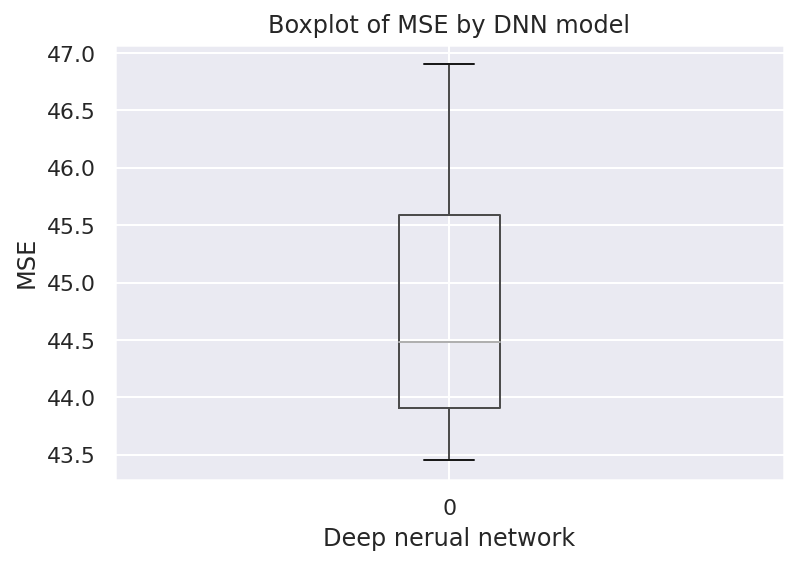

In [ ]:
MSE_NN = pd.DataFrame(mean_test_loss_NN)
MSE_NN.boxplot()
plt.title("Boxplot of MSE by DNN model")
plt.xlabel('Deep nerual network')
plt.ylabel('MSE')

In [ ]:
results = pd.DataFrame()
results['randomForest'] = MSE_RF
results['NeuralNetwork'] = MSE_NN

In [ ]:
results

,randomForest,NeuralNetwork
0,47.04,45.67
1,47.11,44.56
2,45.05,43.45
3,44.74,44.40
4,43.69,45.36
5,46.18,45.77
6,45.15,44.06
7,44.96,43.86
8,43.86,43.72
9,43.76,46.90


In [ ]:
joblib.dump(results,'test_results_10.pkl')

['test_results_10.pkl']

In [ ]:
results = joblib.load('/content/drive/MyDrive/A1/test_results_10.pkl')

### 3.7.4 Boxplot of two models in comparison

> Note: Since those ploting functions are too simple. We don't bother to write another function to do this job uniformly. Because it will just add more difficultly on reading the following results.

Text(0.5, 1.0, 'Boxplot of MSE between Randomforest and DNN')

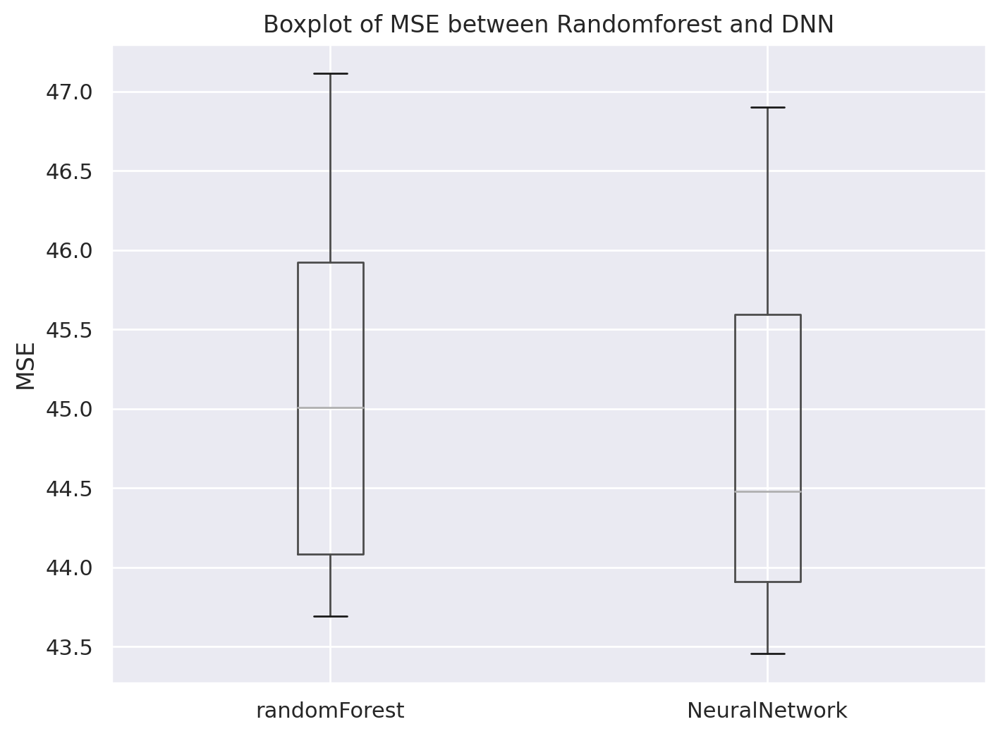

In [ ]:
figure(figsize=(8, 6), dpi=100)
results.boxplot()
plt.ylabel('MSE')
plt.title('Boxplot of MSE between Randomforest and DNN')

Text(0.5, 1.0, 'Boxplot of MSE between Randomforest and DNN')

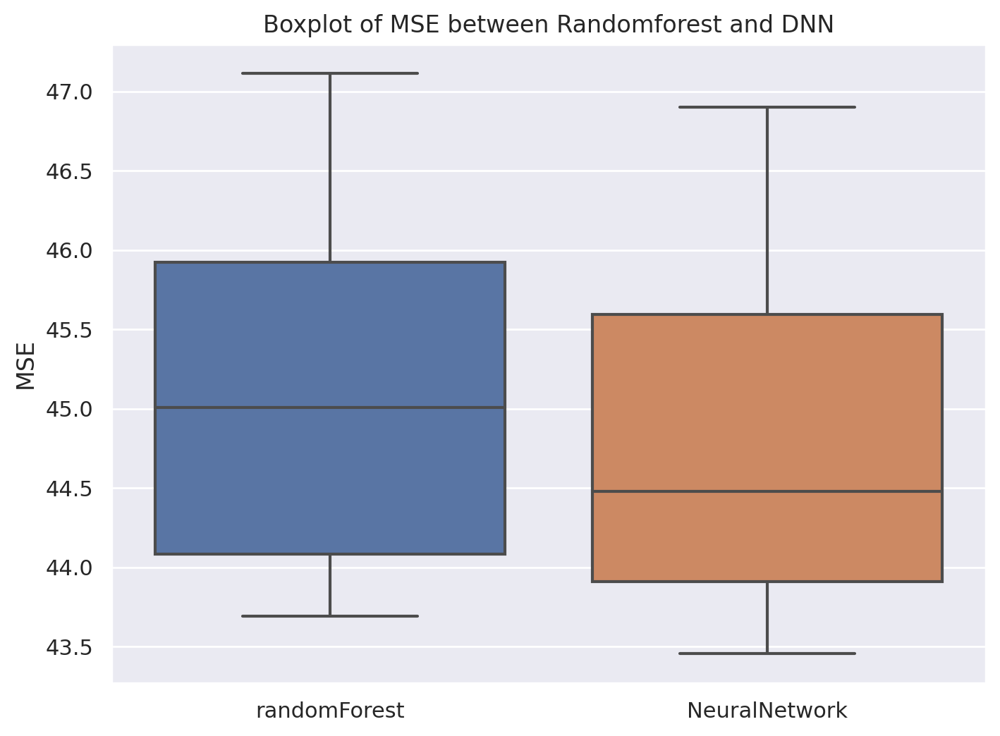

In [ ]:
figure(figsize=(8, 6), dpi=100)
ax = sns.boxplot(data=results)
plt.ylabel('MSE')
plt.title('Boxplot of MSE between Randomforest and DNN')

### 3.7.5 statistical significance test with Kolmogorov-Smirnov statistic

First, let's what our results' distributions look like.
We would like to find our whether they are normal distributions.

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f00016bf650>,
      dtype=object)

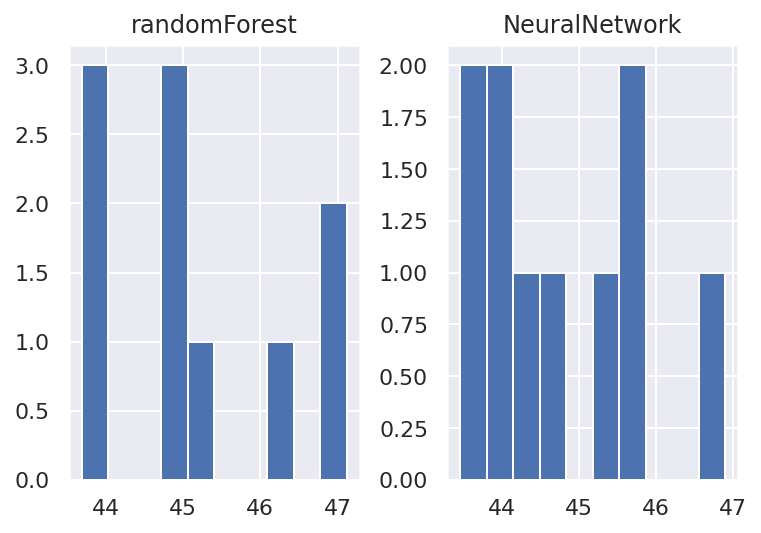

In [ ]:
results.hist()

From the above image, we can clearly see that they are not normal distribution.

Hence We can not use t-test.
For nonparameteric distribution, we use  Kolmogorov-Smirnov statistic test.

In [ ]:
from scipy.stats import ks_2samp
def ks_2samp_test(data, param1='randomForest', param2='NeuralNetwork'):
	max_print_out(True)
	value, pvalue = ks_2samp(data[param1].values,data[param2].values)
	print(value, pvalue)
	if pvalue > 0.05:
		print('Samples are likely drawn from the same distributions (fail to reject H0)')
	else:
		print('Samples are likely drawn from different distributions (reject H0)')

In [ ]:
ks_2samp_test(results, 'randomForest', 'NeuralNetwork')

0.3 0.7869297884777761
Samples are likely drawn from the same distributions (fail to reject H0)


### 3.7.6 Discussion
From above results, p-value = 0.78 >> 0.005.

We can not reject our H0, which is our two models have a big difference on performance.

Hence, we would say that on our prediction of FRP with 150k totoal data instances, choosing Neural network or random forest has almost the same performance.

In my opinion, I would choose random forest. It takes less time to generate the model and takes less time to train, but the performance is not much different than Neural Network.





### 3.7.7 Supplemental experiments:


However, we can see that this assumption is based on our assignment pre-statement: We have 150k data instance.

In our assumption from section 3.7 (Compare the two models with a statistical significance test). 

Our neural network only used 10k training instances but it can get a similar results with Random Forest model who usesd 100k training instances.

> Note: <br>
At first in section 3.5 Baseline and 3.6 Candidate model, those two models are all trained on the same 150k dataset. Their evaluation error on test set are pretty similar also. In the whole time, only nerual network model did its job on a smaller dataset. And it did pretty well at the end. 

Just for fun, let's see what Random forest will perform on 10k data set.

> We reuse the function we defined before.

In [ ]:
RF_MSE_10k_score,RF_10k_prediction =  rf_train_on_multiple_sets(train_loader_NN,test_loader)

Test set score of No. 0 subsets
Random Forest's Mean squared error:  70.66065819387671
Random Forest's root Mean squared error: 8.40598942384992
Test set score of No. 1 subsets
Random Forest's Mean squared error:  73.54517534303835
Random Forest's root Mean squared error: 8.575848374536385
Test set score of No. 2 subsets
Random Forest's Mean squared error:  74.23325265757727
Random Forest's root Mean squared error: 8.615872135633007
Test set score of No. 3 subsets
Random Forest's Mean squared error:  65.51587284520991
Random Forest's root Mean squared error: 8.094187596368762
Test set score of No. 4 subsets
Random Forest's Mean squared error:  73.16135963585354
Random Forest's root Mean squared error: 8.55344139138473
Test set score of No. 5 subsets
Random Forest's Mean squared error:  72.49325057220993
Random Forest's root Mean squared error: 8.51429683369155
Test set score of No. 6 subsets
Random Forest's Mean squared error:  75.30869419249652
Random Forest's root Mean squared error:

In [ ]:
results['10k_randomforest'] = pd.DataFrame(RF_MSE_10k_score)

Let's plot them together:

Text(0.5, 1.0, 'Compare performance with training data instance 100k RandomForest, 10k DNN and 10k Random Forest')

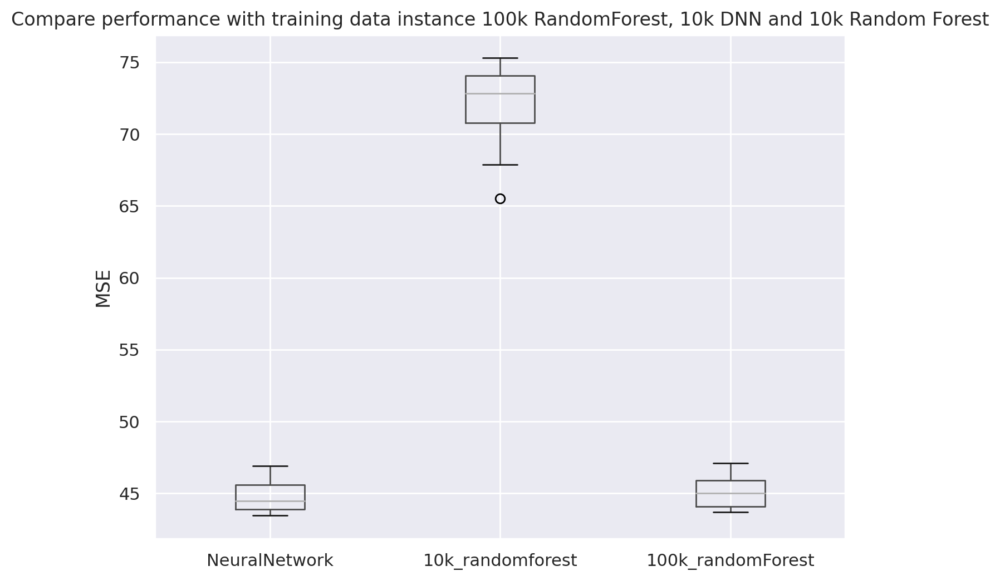

In [ ]:
figure(figsize=(8, 6), dpi=100)
results_3 = results
results_3['100k_randomForest'] = results_3.pop('randomForest') # a little trick
results_3.boxplot()
plt.ylabel('MSE')
plt.title("Compare performance with training data instance 100k RandomForest, 10k DNN and 10k Random Forest")

We can clearly see that the 10k feed data randomforest resutls are extremly bad than the other two models.


Let's use ks_2sample to test it. 


In [ ]:
ks_2samp_test(results, '10k_randomforest', 'NeuralNetwork')

1.0 1.0825088224469026e-05
Samples are likely drawn from different distributions (reject H0)


We can see that DNN and 10k Random Forest are different. And neural network has better performance.

### 3.7.8 Final conclusion
You can see in the same level of a smaller dataset, random forest has much worse performance than neural network. 

Hence, my advice is that if our dataset is quite small, we should use Neural Network despite the training time. It will give us a quite good result.

If our dataset is resonable big, then we should choose Random Forest as our model. Since it costs less time and have a similar results with Neural Network.


# <center>References</center>


1. 2019 -20 Australian bushfire season. (n.d.). In Wikipedia. Retrieved June 22, 2022, from https://en.wikipedia.org/wiki/2019%E2%80%9320_Australian_bushfire_season
2. Dincer, B. (2021). Australia and Investigative Special Wildfires Data. Kaggle. https://www.kaggle.com/datasets/brsdincer/australia-and-investigative-special-wildfires-data
3. Peterson, D., & Wang, J. (2013). A sub-pixel-based calculation of fire radiative power from MODIS OBSERVATIONS: 2. sensitivity analysis and potential fire weather application. Remote Sensing of Environment, 129, 231–249. https://doi.org/10.1016/j.rse.2012.10.020
4. Poisson. (n.d.). Knowledge Center. Retrieved June 22, 2022, from https://peltarion.com/knowledge-center/documentation/modeling-view/build-an-ai-model/loss-functions/poisson
5. Glen, S. (2014, October 14). Confidence Level: What is it? Statistics How To. https://www.statisticshowto.com/confidence-level/
6. Brownlee, J. (2021, January 20). Regression Metrics for Machine Learning. Machine Learning Mastery. https://machinelearningmastery.com/regression-metrics-for-machine-learning/
7. Kassambara, A. (2018). Machine Learning Essentials: Practical Guide in R. CreateSpace Independent Publishing Platform. https://www.datanovia.com/en/product/machine-learning-essentials-practical-guide-in-r/?url=/5-bookadvisor/54-machine-learning-essentials/
8. Hung-Yi Lee. (n.d.). Hung-Yi Lee. Retrieved June 22, 2022, from https://speech.ee.ntu.edu.tw/~hylee/index.php
9. Learning Curve. (n.d.). In Wikipedia. Retrieved June 22, 2022, from https://en.wikipedia.org/wiki/Learning_curve
10. Hung-Yi Lee. (n.d.). Hung-Yi Lee. Retrieved June 22, 2022, from https://speech.ee.ntu.edu.tw/~hylee/index.php
11. Early stopping. (n.d.). In Wikipedia. Retrieved June 22, 2022, from https://en.wikipedia.org/wiki/Early_stopping
12. AdamW. (n.d.). Knowledge Center. Retrieved June 22, 2022, from https://peltarion.com/knowledge-center/documentation/modeling-view/run-a-model/optimizers/adamw
13. Prakharr0y. (2020, October 24). Intuition of Adam Optimizer. GeeksforGeeks. https://www.geeksforgeeks.org/intuition-of-adam-optimizer/
14. Lee, H. (n.d.). Error surface is rugged… Tips for training: Adaptive Learning Rate. (n.d.). Hung-Yi Lee. https://speech.ee.ntu.edu.tw/~hylee/ml/ml2021-course-data/optimizer_v4.pdf
15. Lee, H. (2022, March 6). 【機器學習 2022】魚與熊掌可以兼得的深度學習 [Video]. YouTube. https://www.youtube.com/watch?v=yXd2D5J0QDU&t=1249s
16. Kelleher, J. D. & Name, B. M. (2020). Fundamentals of ML for Predictive Data Analytics: Algorithms, Worked Examples, and Case Studies. The MIT Press. 
17. ADAMW. (2019). Pytorch. Retrieved June 22, 2022, from https://pytorch.org/docs/stable/generated/torch.optim.AdamW.html
18. Géron, A. (2019).  Hands-On Machine Learning with Scikit-Learn, Keras, and TensorFlow, 2nd Edition. O'Reilly Media, Inc.
